In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from Bio import SeqIO
from Bio import pairwise2

%matplotlib inline
# figure size in inches
# rcParams['figure.figsize'] = 12,9
#sns.set(rc={'figure.figsize':(12,9)})


# Enable Classic style in plots
plt.style.use('classic')


# from IPython.display import set_matplotlib_formats
# set_matplotlib_formats('pdf', 'png')
# plt.rcParams['savefig.dpi'] = 300

plt.rcParams['figure.autolayout'] = False
plt.rcParams['figure.figsize'] = 12, 9
plt.rcParams['axes.labelsize'] = 18
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['font.size'] = 12
plt.rcParams['lines.linewidth'] = 2.0
plt.rcParams['lines.markersize'] = 8
plt.rcParams['legend.fontsize'] = 14

#plt.rcParams['text.usetex'] = True
#plt.rcParams['font.family'] = "serif"
#plt.rcParams['font.serif'] = "cm"
#plt.rcParams['text.latex.preamble']="\usepackage{subdepth}, \usepackage{type1cm}"

plt.rcParams['figure.facecolor'] = "white"

# Lempel-Ziv parser with inexact matching

## Notation

## Lempel-Ziv factorization

The parsing used is a variant of the traditional lempel-ziv parser, the method parses the text $S[i..j]$ into phrases (ie substrings) as follows, starting at $i \leftarrow 1$:

1. find the longest prefix $S[i..j]$ of $S[i..n]$ that occurs in $S$ starting before position $i$.
2. if $j \geq i$, that is, $S[i..j]$ is nonempty, then the next phrase is $S[i..j]$ and we set $i \leftarrow j + 1$
3. Otherwise, the next phrase is the explicit symbol $S[i]$, which has not appeared before, and we set $i \leftarrow i + 1$.
4. if $i \leq n$, continue forming phrases.

Also, the source $S[i'..j']$ of $S[i..j]$ must be completely contained in $S[1..i-1]$. That is, it must hold that $j' < i$, not just $i' < i$. In this approach, there's no overlap between the phrases and their sources. It comes with a price, the number of phrases obtained in this case will be called $z_{no}$ and:

1. not only $z_{no}(S) \geq z(S)$, because the greedy parsing (traditional) is optimal
2. $z_{no}$ can be $\Theta (log n)$ times larger than $z$, for example on the string $S = a^{n-1}\$$, where $z = 3$ with parsing **$a$|$a^{n-2}$** and $z_{no} = \Theta(log n)$ with parsing **$a$|$a$|$a^{2}$|$a^{4}$|$a^{8}$|...**

Actually we can experimentaly check this fact letting $S = AAAAAAAAAA\$$, ie, 10 repetitions of **A**.


Firstly, let's have a look at simpler examples found in the literature to check the correctness of the encoding produced by the LZ-mis, that is, the modified parsing of LZ parsers the allows mismatches.

Taking back to 93, there's a paper by Gusev et al that explored the lempel-ziv as a tool to analyse local structures of genomes. It differs from the traditional LZ76 parser by:

- In the traditional LZ76 parser, each phrase is either a generated symbol or a copied substring accompanied by the generation of an additional symbol, this excludes the possibility of coincidence of two phrases.

Let's consider the example 1 (Gusev et al, 93): Influenza virus type A, strain PR, segment of polymerase I, pos. 1411, N = 30, S = GTCGACAGGTTTTATCGAACCTGTAAGCTA.

In [177]:
# ! echo AAAAAAAAAA$ > multi_A.txt

with open('multi_A.txt', 'w') as infile:
    t = "${}${}".format(5*'AAAAACAAAAAAA',5*'AAAAATAAAAATA')
    infile.write(t[::-1])

In [178]:
t[23-9+1]

'A'

In [179]:
t[17+1:18+4]

'ACAA'

In [180]:
! cat multi_A.txt

ATAAAAATAAAAAATAAAAATAAAAAATAAAAATAAAAAATAAAAATAAAAAATAAAAATAAAAA$AAAAAAACAAAAAAAAAAAACAAAAAAAAAAAACAAAAAAAAAAAACAAAAAAAAAAAACAAAAA$

Then, we create the fm-index of the reverse text required by the parsing algorithm, but as the reverse of $A^{10}$ is equal $A^{10}$ we dont bother in reversing it. We construct the fm-index directly in $S$.

In [181]:
! ../../bin/sFM-index build multi_A.txt

Building succinct FM-index of file multi_A.txt
 Computing the BWT ... 
*** Building context automata ***

 Text length is 132

 scanning file to detect alphabet ... 
 0% done.
 5% done.
 10% done.
 15% done.
 20% done.
 25% done.
 30% done.
 35% done.
 40% done.
 45% done.
 50% done.
 55% done.
 60% done.
 65% done.
 70% done.
 75% done.
 80% done.
 85% done.
 90% done.
 95% done.
 done.

 Sorting alphabet ... done. Alphabet size: sigma = 4

 Alphabet (ASCII codes) = { 36 65 67 84 }

 Allowed memory overhead for the automata = 10%
 Detecting optimal k ... 
  Sampling text ... 
  0% done.

  Sampled text size = 132
  Extimated number of bits per k-mer: 4140
  Extimated number of bits per (k-1)-mer: 352
  Number of 1-mers : 5
 Done. Optimal k = 1

 detecting k-mers ... 
 0% done.
 5% done.
 10% done.
 15% done.
 20% done.
 25% done.
 30% done.
 35% done.
 40% done.
 45% done.
 50% done.
 55% done.
 60% done.
 65% done.
 70% done.
 75% done.
 80% done.
 85% done.
 90% done.
 95% done.
 do

Finally, we parse it with the following command:

In [217]:
! ../../bin/sFM-index lz multi_A.txt.sfm 2 multi_A.txt.sfm

Loading succinct FM-index from file multi_A.txt.sfm
Done.
Block size = 16
TEXT LENGTH = 132
###################################################
INITIALIZING ALGORITHM
###################################################


CHAR A int(CHAR) = 65 WITH P = 1, NEXT P = 3
CHAR A int(CHAR) = 65 WITH P = 3, NEXT P = 5
CHAR A int(CHAR) = 65 WITH P = 5, NEXT P = 7
CHAR A int(CHAR) = 65 WITH P = 7, NEXT P = 9
CHAR A int(CHAR) = 65 WITH P = 9, NEXT P = 11
CHAR C int(CHAR) = 67 WITH P = 11, NEXT P = 118
CHAR A int(CHAR) = 65 WITH P = 118, NEXT P = 103
CHAR A int(CHAR) = 65 WITH P = 103, NEXT P = 89
CHAR A int(CHAR) = 65 WITH P = 89, NEXT P = 75
CHAR A int(CHAR) = 65 WITH P = 75, NEXT P = 61
CHAR A int(CHAR) = 65 WITH P = 61, NEXT P = 47
CHAR A int(CHAR) = 65 WITH P = 47, NEXT P = 38
CHAR A int(CHAR) = 65 WITH P = 38, NEXT P = 33
CHAR A int(CHAR) = 65 WITH P = 33, NEXT P = 29
CHAR A int(CHAR) = 65 WITH P = 29, NEXT P = 25
CHAR A int(CHAR) = 65 WITH P = 25, NEXT P = 21
CHAR A int(CHAR) = 65 WITH P = 2

And exhibit the output:

In [218]:
dfok = pd.read_csv("out.txt", sep="\t", names=["pos", "p", "len", "type"])
dfok 

,pos,p,len,type
0,65,0,65,N
1,66,$,-,-
2,77,0,12,M
3,83,0,6,M
4,130,71,47,N
5,131,NaN,-,-


In [106]:
t1 = 'acacgacttttacgtatctt'.upper()
t2 = 'acaccacttttacgttactt'.upper()
t3 = 'acacgacttttcggcgacgtatctt'.upper()
t4 = 'acacgacttttacgtt'.upper()
t5 = 'aacgtattttcacgactctt'.upper()
print('|T1|=', len(t1), '|T2|=', len(t2), '|T3|=', len(t3), '|T4|=', len(t4), '|T5|=', len(t5))

|T1|= 20 |T2|= 20 |T3|= 25 |T4|= 16 |T5|= 20


In [107]:
with open('single_A_ref.txt', 'w') as infile:
    t = "{}$".format(1*'acacgacttttacgtatctt'.upper())
    infile.write(t[::-1])
with open('single_A_sample.txt', 'w') as infile:
    t = '{}$'.format(1*t2)
    infile.write(t[::-1])

In [108]:
! ../../bin/sFM-index build single_A_ref.txt
! ../../bin/sFM-index build single_A_sample.txt

Building succinct FM-index of file single_A_ref.txt
 Computing the BWT ... 
*** Building context automata ***

 Text length is 21

 scanning file to detect alphabet ... 
 0% done.
 80% done.
 85% done.
 90% done.
 95% done.
 done.

 Sorting alphabet ... done. Alphabet size: sigma = 5

 Alphabet (ASCII codes) = { 36 65 67 71 84 }

 Allowed memory overhead for the automata = 10%
 Detecting optimal k ... 
  Sampling text ... 
  0% done.

  Sampled text size = 21
  Extimated number of bits per k-mer: 4944
  Extimated number of bits per (k-1)-mer: 384
  Number of 1-mers : 6
 Done. Optimal k = 1

 detecting k-mers ... 
 0% done.
 80% done.
 85% done.
 90% done.
 95% done.
 done.

 sorting k-mers ... done. 6 nonempty contexts of length k = 1 (including contexts containing terminator character)
 building automata edges ... 
 0% Done.
 50% Done.
 done.

Context automata completed.

*** Scanning input file to compute context frequencies ***

 0% done.
 80% done.
 85% done.
 90% done.
 95% done.


In [113]:
! ../../bin/sFM-index lz single_A_ref.txt.sfm 10 single_A_sample.txt.sfm

Loading succinct FM-index from file single_A_ref.txt.sfm
Done.
Block size = 4
TEXT LENGTH = 21
###################################################
INITIALIZING ALGORITHM
###################################################


###################################################
 FOR i = 0
Pop i = 0 c=  and c = int(c) =0 , actual base =  , max Ar=0 p =1 next c= , LF(p)=0  j=1, j new=0 aln len=0 iprime =0 L=1 U=2 num_mm = 0 n-(a.i+1) =20
Allow diff = 0
 INSIDE $ BASE DETECTION !!!  
J final=1
1	 	-	-
###################################################
 FOR i = 1
Pop i = 1 c=A and c =Aint(c) =65 , actual base = A, max Ar=20 p =0 next c=A, LF(p)=2  j=2, j new=1 aln len=0 iprime =0 L=2 U=7 num_mm = 0 n-(a.i+1) =19
Allow diff = 0
##  ALLOWING INNER MATCHES
###  IN c=C with iprime=1 and i=1, p=2
PROXIMO ALLOW DIFF = 0
## BEFORE Pushed MATCHED base C with 0 mis L=7 , U=11 , maxAr=19 max_Ar_ori=20 n-(i+1) = 19
## @@ TESTING FOR n-(i+1) = 19 BUT 0
##  Pushed MATCHED base C with 0 mis L=7 , U=11 , m

In [114]:
df = pd.read_csv("out.txt", sep="\t", names=["pos", "p", "len", "type"])
df

,pos,p,len,type
0,1,NaN,-,-
1,5,0.0,4,N
2,8,1.0,3,N
3,16,7.0,8,N
4,19,10.0,3,N
5,20,7.0,2,N


In [184]:
def get_phrase_mismatched(df, original_text, start, end, print_mis=True):
    len_vec = df['len'].values[start:end]
    pointer_vec = df['p'].values[start:end]
    match_type = df['type'].values[start:end]
    text = ""
    for i in range(len(pointer_vec)):
        if (len_vec[i] == '-'):
            if (str(pointer_vec[i]) != "nan"):
                text += pointer_vec[i]
            if (str(pointer_vec[i]) == '$'):
                print("## PARSING NEXT TEXT\n")
        else:
            pos = int(pointer_vec[i])
            size = int(len_vec[i])
            copied_text = text[pos:pos+size]
            if (match_type[i] == 'M'):
                pos_original = len(text)
                if (print_mis):
                    alignments = pairwise2.align.globalxs(original_text[pos_original:pos_original+size],
                                                          copied_text, -10, -10,  one_alignment_only=True)
                    print(pairwise2.format_alignment(*alignments[0]))
                text += original_text[pos_original:pos_original+size]
            else:
                text += copied_text
    return(text)

In [185]:
get_phrase_mismatched(df, 5*'AAAAACAAAAAAA', 0, 10) == 5*'AAAAACAAAAAAA'

AAAAAA
|||||.
AAAAAC
  Score=5

AAAAAA
|||||.
AAAAAC
  Score=5



True

In [167]:
get_phrase_mismatched(df, 5*'AAAAACAAAAAAA'+'$'+5*'AAAAATAAAAATA', 0, 13, print_mis=False) == t[1:]

## PARSING NEXT TEXT



True

In [80]:
# ACGTAAAAAAAAA
#      *
#      C
#      *
# AAAAATAAAAATA
t[76+1-10:76+1] + t[87+1-11:87+1]

'AAAAATAAAAATAAAAAATAA'

In [79]:
t[4+1:4+1+10]

'AAAAAAAAAA'

In [57]:
t[67:67+10]

'AAAAATAAAA'

In [69]:
t[67]

'A'

In [101]:
#for x in (df['p'].values, df['len'].values)):
def get_original_text(df):
    len_vec = df['len'].values
    pointer_vec = df['p'].values
    text = ""
    for i in range(len(pointer_vec)):
        if (len_vec[i] == '-'):
            if (str(pointer_vec[i]) != "nan"):
                text += pointer_vec[i]
        else:
            pos = int(pointer_vec[i])
            size = int(len_vec[i])
            copied_text = text[pos:pos+size]
            text += copied_text
    return(text)

In [102]:
get_original_text(df)

'AAAAACAAAAACAAAAACCAAAAACAAAAACCAAAAACAAAAACCAAAAACAAAAACCAAAAACA$AAAAACAAAAACAAAAACCAAAAACAAAAACCAAAAACAAAAACCAAAAACAAAAACCAAAAACA'

In [40]:
! pwd

/Users/rodtheo/Bioinfo/PROJETOS/STUDIES/LZ/repos/BWTIL/tools/sFM-index


This confirms that we generated $z_{no} = 5$ and it shows the pattern expected by the parser. But why we're using this weaker lz-variant ? Because it eases direct pattern matching on the compressed string (Farach, M. and Thorup, M. 1998. String matching in Lempel-Ziv compressed strings. Algorithmica 20, 4, 388–404.)

In [437]:
! echo alabaralalabarda > tests/ala.txt

In [438]:
! cat tests/ala.txt | rev

adrabalalarabala


In [439]:
out = open('tests/ala_rev.txt', 'w')
out.write('adrabalalababala$')
out.close()

In [440]:
! cat tests/ala_rev.txt

adrabalalababala$

In [441]:
! ../../bin/sFM-index build tests/ala_rev.txt

Building succinct FM-index of file tests/ala_rev.txt
 Computing the BWT ... 
*** Building context automata ***

 Text length is 17

 scanning file to detect alphabet ... 
 0% done.
 5% done.
 35% done.
 70% done.
 done.

 Sorting alphabet ... done. Alphabet size: sigma = 6

 Alphabet (ASCII codes) = { 36 97 98 100 108 114 }

 Allowed memory overhead for the automata = 10%
 Detecting optimal k ... 
  Sampling text ... 
  0% done.

  Sampled text size = 17
  Extimated number of bits per k-mer: 5748
  Extimated number of bits per (k-1)-mer: 416
  Number of 1-mers : 7
 Done. Optimal k = 1

 detecting k-mers ... 
 0% done.
 5% done.
 35% done.
 70% done.
 done.

 sorting k-mers ... done. 7 nonempty contexts of length k = 1 (including contexts containing terminator character)
 building automata edges ... 
 0% Done.
 done.

Context automata completed.

*** Scanning input file to compute context frequencies ***

 0% done.
 5% done.
 35% done.
 70% done.
 Done.

 Expected context size (if unifo

In [448]:
! ../../bin/sFM-index lz tests/ala_rev.txt.sfm 10

Loading succinct FM-index from file tests/ala_rev.txt.sfm
Done.
Block size = 3
TEXT LENGTH = 17
###################################################
INITIALIZING ALGORITHM
###################################################


###################################################
 FOR i = 0
Pop i = 0 c=a and c =a , actual base = a, max Ar=15 p =1 next c=a, LF(p)=2  j=1, j new=0 aln len=0 iprime =0 L=2 U=10 num_mm = 0 n-(a.i+1) =16
DUPLICATED Pop i + allow_diff = 0 allow_diff = 0 c=a and c =a , actual base = a, max Ar=15 p =1 next c=a, LF(p)=2  j=1, j new=0 aln len=0 iprime =0 L=2 U=10 num_mm = 0
Allow diff = 0
 INSIDE THE MAX AR !!!
J final=1
1	a	-	-
###################################################
 FOR i = 1
Pop i = 1 c=l and c =l , actual base = l, max Ar=14 p =2 next c=l, LF(p)=14  j=2, j new=1 aln len=0 iprime =0 L=14 U=17 num_mm = 0 n-(a.i+1) =15
DUPLICATED Pop i + allow_diff = 1 allow_diff = 0 c=l and c =l , actual base = l, max Ar=14 p =2 next c=l, LF(p)=14  j=2, j new=1 aln len=

In [449]:
sorted(['#','$','A','C','G','T'])

['#', '$', 'A', 'C', 'G', 'T']

In [450]:
df = pd.read_csv("out.txt", sep="\t", names=["pos", "p", "len", "type"])
df

,pos,p,len,type
0,1,a,-,-
1,2,l,-,-
2,3,0,1,N
3,4,b,-,-
4,6,2,2,N
5,9,0,3,N
6,13,1,4,N
7,14,r,-,-
8,15,d,-,-
9,16,a,-,-


In [416]:
get_original_text(df)

'alabaralalabarda$alababalalabarda'

In [418]:
T = 'alabaralalabarda'
T[0:0+4] + T[2:2+3] + T[7:7+4] + T[11:11+4]

'alababalalabard'

In [408]:
get_original_text(df) == 'alabaralalabarda'

False

In [456]:
! cat paper_lz_genomics_ex1_pointA19.txt

GTCGACAGGTTTTATCGAAACTGTAAGCTA


In [468]:
! ../../bin/sFM-index lz paper_lz_genomics_ex1_pointA19_rev.txt.sfm 10

Loading succinct FM-index from file paper_lz_genomics_ex1_pointA19_rev.txt.sfm
Done.
Block size = 6
TEXT LENGTH = 31
###################################################
INITIALIZING ALGORITHM
###################################################


###################################################
 FOR i = 0
Pop i = 0 c=G and c =G , actual base = G, max Ar=29 p =1 next c=G, LF(p)=16  j=1, j new=0 aln len=0 iprime =0 L=16 U=23 num_mm = 0 n-(a.i+1) =30
DUPLICATED Pop i + allow_diff = 0 allow_diff = 0 c=G and c =G , actual base = G, max Ar=29 p =1 next c=G, LF(p)=16  j=1, j new=0 aln len=0 iprime =0 L=16 U=23 num_mm = 0
Allow diff = 0
 INSIDE THE MAX AR !!!
J final=1
1	G	-	-
###################################################
 FOR i = 1
Pop i = 1 c=T and c =T , actual base = T, max Ar=28 p =16 next c=T, LF(p)=26  j=2, j new=1 aln len=0 iprime =0 L=23 U=32 num_mm = 0 n-(a.i+1) =29
DUPLICATED Pop i + allow_diff = 1 allow_diff = 0 c=T and c =T , actual base = T, max Ar=28 p =16 next c=T, LF(p

In [469]:
! cat out.txt

1	G	-	-
2	T	-	-
3	C	-	-
4	0	1	N
5	A	-	-
6	2	1	N
7	4	1	N
8	0	1	N
10	0	2	N
11	1	1	N
13	9	2	N
14	4	1	N
18	1	4	N
19	4	1	N
21	4	2	N
22	1	1	N
24	0	2	N
26	17	2	N
27	0	1	N
29	20	2	N
30	A	-	-


In [470]:
df = pd.read_csv("out.txt", sep="\t", names=["pos", "p", "len", "type"])
df

,pos,p,len,type
0,1,G,-,-
1,2,T,-,-
2,3,C,-,-
3,4,0,1,N
4,5,A,-,-
5,6,2,1,N
6,7,4,1,N
7,8,0,1,N
8,10,0,2,N
9,11,1,1,N


In [471]:
get_original_text(df)

'GTCGACAGGTTTTATCGAAACTGTAAGCTA'

In [472]:
get_original_text(df) == 'GTCGACAGGTTTTATCGAAACTGTAAGCTA'

True

In [22]:
def get_phrase_mismatched(df, original_text, start, end, print_mis=True):
    len_vec = df['len'].values[start:end]
    pointer_vec = df['p'].values[start:end]
    match_type = df['type'].values[start:end]
    text = ""
    for i in range(len(pointer_vec)):
        if (len_vec[i] == '-'):
            if (str(pointer_vec[i]) != "nan"):
                text += pointer_vec[i]
        else:
            pos = int(pointer_vec[i])
            size = int(len_vec[i])
            copied_text = text[pos:pos+size]
            if (match_type[i] == 'M'):
                pos_original = len(text)
                if (print_mis):
                    alignments = pairwise2.align.globalxs(original_text[pos_original:pos_original+size],
                                                          copied_text, -10, -10,  one_alignment_only=True)
                    print(pairwise2.format_alignment(*alignments[0]))
                text += original_text[pos_original:pos_original+size]
            else:
                text += copied_text
    return(text)

In [486]:
! ../../bin/sFM-index lz paper_lz_genomics_ex1_pointA19_rev.txt.sfm 2

Loading succinct FM-index from file paper_lz_genomics_ex1_pointA19_rev.txt.sfm
Done.
Block size = 6
TEXT LENGTH = 31
###################################################
INITIALIZING ALGORITHM
###################################################


###################################################
 FOR i = 0
Pop i = 0 c=G and c =G , actual base = G, max Ar=29 p =1 next c=G, LF(p)=16  j=1, j new=0 aln len=0 iprime =0 L=16 U=23 num_mm = 0 n-(a.i+1) =30
DUPLICATED Pop i + allow_diff = 0 allow_diff = 0 c=G and c =G , actual base = G, max Ar=29 p =1 next c=G, LF(p)=16  j=1, j new=0 aln len=0 iprime =0 L=16 U=23 num_mm = 0
Allow diff = 0
 INSIDE THE MAX AR !!!
J final=1
1	G	-	-
###################################################
 FOR i = 1
Pop i = 1 c=T and c =T , actual base = T, max Ar=28 p =16 next c=T, LF(p)=26  j=2, j new=1 aln len=0 iprime =0 L=23 U=32 num_mm = 0 n-(a.i+1) =29
DUPLICATED Pop i + allow_diff = 1 allow_diff = 0 c=T and c =T , actual base = T, max Ar=28 p =16 next c=T, LF(p

In [487]:
df = pd.read_csv("out.txt", sep="\t", names=["pos", "p", "len", "type"])
df

,pos,p,len,type
0,1,G,-,-
1,2,T,-,-
2,3,C,-,-
3,4,0,1,N
4,5,A,-,-
5,6,2,1,N
6,7,4,1,N
7,8,0,1,N
8,10,0,2,N
9,11,1,1,N


In [488]:
ori_text = 'GTCGACAGGTTTTATCGAAACTGTAAGCTA'

In [489]:
get_phrase_mismatched(df, ori_text) == ori_text

TCGAAA
||||.|
TCGACA
  Score=5



True

In [522]:
ori_text[::-1]

'ATCGAATGTCAAAGCTATTTTGGACAGCTG'

In [524]:
out = open('tests/paper_lz_genomics_ex1_pointA19_rev_double.txt', 'w')
out.write("ATCGAATGTCAAAGCTATTTGGGACAGCTG" + '$' + ori_text[::-1] + '#')
out.close()

In [525]:
#%%capture
! ../../bin/sFM-index build tests/paper_lz_genomics_ex1_pointA19_rev_double.txt

Building succinct FM-index of file tests/paper_lz_genomics_ex1_pointA19_rev_double.txt
 Computing the BWT ... 
*** Building context automata ***

 Text length is 62

 scanning file to detect alphabet ... 
 0% done.
 20% done.
 25% done.
 30% done.
 35% done.
 40% done.
 45% done.
 50% done.
 70% done.
 75% done.
 80% done.
 85% done.
 90% done.
 95% done.
 done.

 Sorting alphabet ... done. Alphabet size: sigma = 6

 Alphabet (ASCII codes) = { 35 36 65 67 71 84 }

 Allowed memory overhead for the automata = 10%
 Detecting optimal k ... 
  Sampling text ... 
  0% done.

  Sampled text size = 62
  Extimated number of bits per k-mer: 5748
  Extimated number of bits per (k-1)-mer: 416
  Number of 1-mers : 7
 Done. Optimal k = 1

 detecting k-mers ... 
 0% done.
 20% done.
 25% done.
 30% done.
 35% done.
 40% done.
 45% done.
 50% done.
 70% done.
 75% done.
 80% done.
 85% done.
 90% done.
 95% done.
 done.

 sorting k-mers ... done. 7 nonempty contexts of length k = 1 (including contexts

In [3]:
# ! ../../bin/sFM-index lz tests/paper_lz_genomics_ex1_pointA19_rev_double.txt.sfm 2

In [527]:
df = pd.read_csv("out.txt", sep="\t", names=["pos", "p", "len", "type"])
df

,pos,p,len,type
0,1,G,-,-
1,2,T,-,-
2,3,C,-,-
3,4,0,1,N
4,5,A,-,-
5,6,2,1,N
6,7,4,1,N
7,8,0,1,N
8,10,0,2,N
9,11,1,1,N


In [150]:
! cat paper_lz_genomics_ex1_pointA19.txt

GTCGACAGGTTTTATCGAAACTGTAAGCTA


In [528]:
get_phrase_mismatched(df, ori_text) == ori_text

TCGAAA
||||.|
TCGACA
  Score=5



IndexError: list index out of range

In [152]:
! wget https://ftp.ncbi.nlm.nih.gov/genomes/all/GCF/000/840/245/GCF_000840245.1_ViralProj14204/GCF_000840245.1_ViralProj14204_genomic.fna.gz

--2020-04-27 12:14:48--  https://ftp.ncbi.nlm.nih.gov/genomes/all/GCF/000/840/245/GCF_000840245.1_ViralProj14204/GCF_000840245.1_ViralProj14204_genomic.fna.gz
Resolving ftp.ncbi.nlm.nih.gov... 130.14.250.11, 2607:f220:41e:250::13
Connecting to ftp.ncbi.nlm.nih.gov|130.14.250.11|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 15299 (15K) [application/x-gzip]
Saving to: ‘GCF_000840245.1_ViralProj14204_genomic.fna.gz’

GCF_000840245.1_Vir 100%[===================>]  14.94K  87.0KB/s    in 0.2s    

2020-04-27 12:14:51 (87.0 KB/s) - ‘GCF_000840245.1_ViralProj14204_genomic.fna.gz’ saved [15299/15299]



In [153]:
! zcat GCF_000840245.1_ViralProj14204_genomic.fna.gz > tests/lambda_phage.genome.fa

In [154]:
! rm GCF_000840245.1_ViralProj14204_genomic.fna.gz

In [19]:
for rec in SeqIO.parse('tests/lambda_phage.genome.fa', 'fasta'):
    lambda_ori = str(rec.seq)
    lambda_ori_rev = lambda_ori[::-1]

In [218]:
out = open('tests/lambda_phage_rev.txt', 'w')
out.write(str(lambda_ori_rev)+"$")
out.close()

In [220]:
set(list(lambda_ori_rev))

{'A', 'C', 'G', 'T'}

In [221]:
! time ../../bin/sFM-index build tests/lambda_phage_rev.txt

Building succinct FM-index of file tests/lambda_phage_rev.txt
 Computing the BWT ... 
*** Building context automata ***

 Text length is 48503

 scanning file to detect alphabet ... 
 0% done.
 5% done.
 10% done.
 15% done.
 20% done.
 25% done.
 30% done.
 35% done.
 40% done.
 45% done.
 50% done.
 55% done.
 60% done.
 65% done.
 70% done.
 75% done.
 80% done.
 85% done.
 90% done.
 95% done.
 done.

 Sorting alphabet ... done. Alphabet size: sigma = 5

 Alphabet (ASCII codes) = { 36 65 67 71 84 }

 Allowed memory overhead for the automata = 10%
 Detecting optimal k ... 
  Sampling text ... 
  0% done.
  10% done.
  20% done.
  30% done.
  35% done.
  45% done.
  55% done.
  65% done.
  70% done.
  80% done.
  90% done.

  Sampled text size = 2000
  Extimated number of bits per k-mer: 5072
  Extimated number of bits per (k-1)-mer: 384
  Number of 1-mers : 6
 Done. Optimal k = 1

 detecting k-mers ... 
 0% done.
 5% done.
 10% done.
 15% done.
 20% done.
 25% done.
 30% done.
 35% 

In [138]:
%time ! ../../bin/sFM-index lz tests/lambda_phage_rev.txt.sfm 5 &> tests/tmp.txt

CPU times: user 66.5 ms, sys: 31.5 ms, total: 97.9 ms
Wall time: 4.7 s


In [139]:
df = pd.read_csv("out.txt", sep="\t", names=["pos", "p", "len", "type"])
df

,pos,p,len,type
0,1,G,-,-
1,2,0,1,N
2,3,0,1,N
3,4,C,-,-
4,7,1,3,N
5,8,0,1,N
6,9,A,-,-
7,10,3,1,N
8,11,3,1,N
9,12,T,-,-


In [189]:
df.loc[df['p'] == "18446744073709551615", "p"] = "0"

In [3]:
#df

In [226]:
get_phrase_mismatched(df, str(lambda_ori), print_mis=False) == lambda_ori

True

In [250]:
#%%capture
ks = []
number_of_factors_total = []
number_of_mis = []
for k in range(4,13):
    print("===== {}".format(str(k)))
    %time ! ../../bin/sFM-index lz tests/lambda_phage_rev.txt.sfm {k} &> tests/tmp.txt
    
    df = pd.read_csv("out.txt", sep="\t", names=["pos", "p", "len", "type"])

    assert(get_phrase_mismatched(df, str(lambda_ori), print_mis=False) == lambda_ori)
    
    ks.append(k)
    number_of_factors_total.append(df.shape[0])
    number_of_mis.append(sum(df['type'] == 'M'))

===== 4
CPU times: user 95.3 ms, sys: 39.8 ms, total: 135 ms
Wall time: 6.54 s
===== 5
CPU times: user 71.2 ms, sys: 31.5 ms, total: 103 ms
Wall time: 4.87 s
===== 6
CPU times: user 62.7 ms, sys: 25.9 ms, total: 88.6 ms
Wall time: 4.28 s
===== 7
CPU times: user 58.9 ms, sys: 24.7 ms, total: 83.6 ms
Wall time: 4.03 s
===== 8
CPU times: user 59.4 ms, sys: 27.1 ms, total: 86.4 ms
Wall time: 4.01 s
===== 9
CPU times: user 58.4 ms, sys: 27.7 ms, total: 86.1 ms
Wall time: 3.95 s
===== 10
CPU times: user 59 ms, sys: 25.5 ms, total: 84.5 ms
Wall time: 3.99 s
===== 11
CPU times: user 60 ms, sys: 26.2 ms, total: 86.2 ms
Wall time: 4 s
===== 12
CPU times: user 59.1 ms, sys: 28 ms, total: 87.1 ms
Wall time: 3.96 s


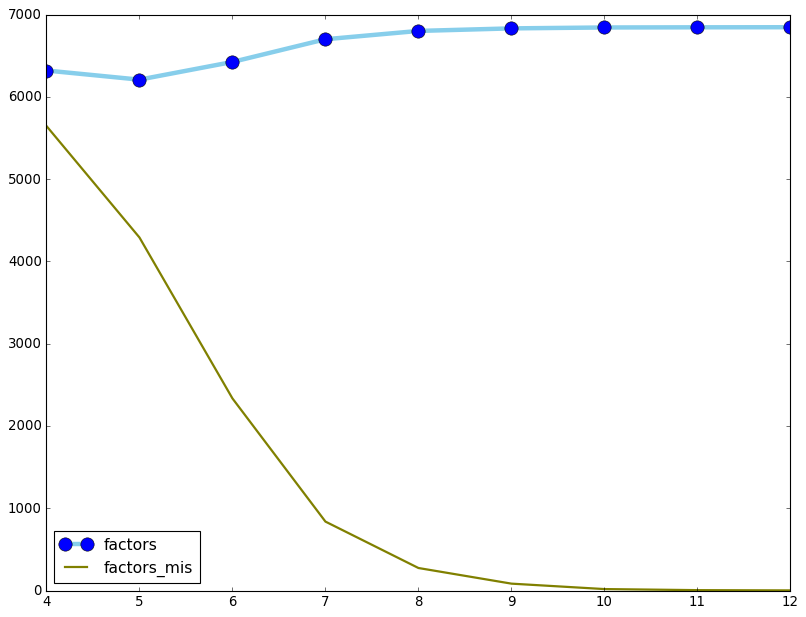

In [271]:
#plt.plot( 'x', 'y1', data=df, marker='o', markerfacecolor='blue', markersize=12, color='skyblue', linewidth=4)
#plt.plot( 'x', 'y2', data=df, marker='', color='olive', linewidth=2)
df_to_plot = pd.DataFrame({'factors': number_of_factors_total, 'factors_mis': number_of_mis, 'k': ks})
plt.plot('k', 'factors', data=df_to_plot, marker='o', markerfacecolor='blue', markersize=12, color='skyblue', linewidth=4)
plt.plot('k', 'factors_mis', data=df_to_plot, marker='', color='olive', linewidth=2)
plt.legend(loc=0)

plt.show()

In [304]:
c = "alabaralalabarda"
c = c[::-1]

In [307]:
c

'adrabalalarabala$'

In [305]:
cs = []
c = c + '$'
for i in range(0,len(c)):
    cs.append((i+1, c[i:]))

In [306]:
sorted(cs, key=lambda x: x[1])

[(17, '$'),
 (16, 'a$'),
 (12, 'abala$'),
 (4, 'abalalarabala$'),
 (1, 'adrabalalarabala$'),
 (14, 'ala$'),
 (6, 'alalarabala$'),
 (8, 'alarabala$'),
 (10, 'arabala$'),
 (13, 'bala$'),
 (5, 'balalarabala$'),
 (2, 'drabalalarabala$'),
 (15, 'la$'),
 (7, 'lalarabala$'),
 (9, 'larabala$'),
 (11, 'rabala$'),
 (3, 'rabalalarabala$')]

In [309]:
bwt_matrix = []
for i in range(0, len(c)):
    bwt_matrix.append(c[i:]+c[:i])

In [314]:
print('\n'.join(sorted(bwt_matrix)))

$adrabalalarabala
a$adrabalalarabal
abala$adrabalalar
abalalarabala$adr
adrabalalarabala$
ala$adrabalalarab
alalarabala$adrab
alarabala$adrabal
arabala$adrabalal
bala$adrabalalara
balalarabala$adra
drabalalarabala$a
la$adrabalalaraba
lalarabala$adraba
larabala$adrabala
rabala$adrabalala
rabalalarabala$ad


## Segmental duplication

In [6]:
! wget https://ftp.ncbi.nlm.nih.gov/genomes/all/GCF/000/840/245/GCF_000840245.1_ViralProj14204/GCF_000840245.1_ViralProj14204_genomic.gff.gz

--2020-04-29 11:38:40--  https://ftp.ncbi.nlm.nih.gov/genomes/all/GCF/000/840/245/GCF_000840245.1_ViralProj14204/GCF_000840245.1_ViralProj14204_genomic.gff.gz
Resolving ftp.ncbi.nlm.nih.gov... 130.14.250.7, 2607:f220:41e:250::12
Connecting to ftp.ncbi.nlm.nih.gov|130.14.250.7|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8295 (8.1K) [application/x-gzip]
Saving to: ‘GCF_000840245.1_ViralProj14204_genomic.gff.gz’

GCF_000840245.1_Vir 100%[===================>]   8.10K  --.-KB/s    in 0.002s  

2020-04-29 11:38:41 (4.20 MB/s) - ‘GCF_000840245.1_ViralProj14204_genomic.gff.gz’ saved [8295/8295]



In [7]:
! zcat GCF_000840245.1_ViralProj14204_genomic.gff.gz > tests/lambda_phage.gff

In [8]:
! rm GCF_000840245.1_ViralProj14204_genomic.gff.gz

```bash
(bioAnalysisEnv)
rodtheo @ ~/Bioinfo/PROGRAMAS/Simulome
 [84] python /Users/rodtheo/Bioinfo/PROGRAMAS/Simulome/simulome.py --genome=/Users/rodtheo/Bioinfo/PROJETOS/STUDIES/LZ/repos/BWTIL/tools/sFM-index/tests/lambda_phage.genome.fa --anno=/Users/rodtheo/Bioinfo/PROJETOS/STUDIES/LZ/repos/BWTIL/tools/sFM-index/tests/lambda_phage.gff --output=lambda_phage_sd --snp=TRUE --snp_window=100 --num_snp=50 --whole_genome=TRUE --seed=123456
	Writing annotation file: lambda_phage_sd/lambda_phage_sd_simulated.gff
	Writing FASTA file: lambda_phage_sd/lambda_phage_sd_simulated.fasta
	Writing annotation file: lambda_phage_sd/lambda_phage_sd_mutated_simulation.gff
	Writing FASTA file: lambda_phage_sd/lambda_phage_sd_mutated_simulation.fasta
	Writing mutation log file: lambda_phage_sd/lambda_phage_sd_mutations.log
Process Complete.
```

In [12]:
! mv /Users/rodtheo/Bioinfo/PROGRAMAS/Simulome/lambda_phage_sd/ tests/

In [37]:
! cat tests/lambda_phage_sd/lambda_phage_sd_mutations.log

START	END	TYPE	BEFORE	AFTER
336	337	SNP	G	T
2723	2724	SNP	G	C
4673	4674	SNP	C	T
5890	5891	SNP	G	C
6577	6578	SNP	T	A
7252	7253	SNP	A	C
7717	7718	SNP	G	C
8093	8094	SNP	T	C
9300	9301	SNP	C	T
9985	9986	SNP	G	T
11080	11081	SNP	G	C
13979	13980	SNP	T	C
14446	14447	SNP	G	T
15821	15822	SNP	T	G
19108	19109	SNP	G	C
19675	19676	SNP	G	T
21084	21085	SNP	A	G
23201	23202	SNP	C	A
25017	25018	SNP	G	A
35374	35375	SNP	C	T
36338	36339	SNP	T	C
38443	38444	SNP	A	G
38760	38761	SNP	G	A
40350	40351	SNP	G	A
41003	41004	SNP	A	C
42120	42121	SNP	T	A
42299	42300	SNP	A	T
43102	43103	SNP	G	A
43887	43888	SNP	G	T
44591	44592	SNP	T	G
45216	45217	SNP	C	A
46078	46079	SNP	C	A
46618	46619	SNP	C	A
47145	47146	SNP	A	T


In [14]:
for reca in SeqIO.parse('tests/lambda_phage_sd/lambda_phage_sd_simulated.fasta', 'fasta'):
    lambda_seq = str(reca.seq)
for recb in SeqIO.parse('tests/lambda_phage_sd/lambda_phage_sd_mutated_simulation.fasta', 'fasta'):
    lambda_simu = str(recb.seq)

In [69]:
# lambda_simu

In [70]:
lambda_simu == lambda_seq

False

In [71]:
lambda_seq[336:337]

'G'

In [72]:
lambda_simu[336:337]

'T'

Lets use the convetional LZ to parse two genomic sequences, one after another.

In [189]:
t = '$' + lambda_seq + '$' + lambda_simu

In [190]:
concat_lambda_rev = t[::-1]

In [147]:
with open('tests/lambda_phage_sd/lambda_phage_concat_rev.txt', 'w') as outf:
    outf.write(concat_lambda_rev)

In [168]:
! time ../../bin/sFM-index build tests/lambda_phage_sd/lambda_phage_concat_rev.txt

Building succinct FM-index of file tests/lambda_phage_sd/lambda_phage_concat_rev.txt
 Computing the BWT ... 
*** Building context automata ***

 Text length is 97008

 scanning file to detect alphabet ... 
 0% done.
 5% done.
 10% done.
 15% done.
 20% done.
 25% done.
 30% done.
 35% done.
 40% done.
 45% done.
 50% done.
 55% done.
 60% done.
 65% done.
 70% done.
 75% done.
 80% done.
 85% done.
 90% done.
 95% done.
 done.

 Sorting alphabet ... done. Alphabet size: sigma = 5

 Alphabet (ASCII codes) = { 36 65 67 71 84 }

 Allowed memory overhead for the automata = 10%
 Detecting optimal k ... 
  Sampling text ... 
  0% done.
  5% done.
  10% done.
  15% done.
  20% done.
  25% done.
  30% done.
  35% done.
  40% done.
  45% done.
  50% done.
  55% done.
  60% done.
  65% done.
  70% done.
  75% done.
  80% done.
  85% done.
  90% done.

  Sampled text size = 5000
  Extimated number of bits per k-mer: 5072
  Extimated number of bits per (k-1)-mer: 384
  Number of 1-mers : 6
 Done. 

In [6]:
%time ! ../../bin/sFM-index.x lz tests/lambda_phage_sd/lambda_phage_concat_rev.txt.sfm 10 &> tests/lambda_phage_sd/tmp.txt

CPU times: user 2.94 ms, sys: 6.38 ms, total: 9.32 ms
Wall time: 125 ms


In [7]:
! ../../bin/sFM-index lz

*** succinct FM-index data structure : a wavelet-tree based uncompressed FM index ***
Usage: sFM-index option file [pattern]
where:
- option = build|search|lz. 
- file = path of the text file (if build mode) or .sfm sFM-index file (if search mode). 
- pattern = must be specified in search mode. It is the pattern to be searched in the index.


In [193]:
df = pd.read_csv("out.txt", sep="\t", names=["pos", "p", "len", "type"])
df

,pos,p,len,type
0,1,G,-,-
1,2,0,1,N
2,3,0,1,N
3,4,C,-,-
4,7,1,3,N
5,8,0,1,N
6,9,A,-,-
7,10,3,1,N
8,11,3,1,N
9,12,T,-,-


In [44]:
np.sum([int(x) for x in df['len'][:6842].values if x != '-']) + np.sum(df['len'][:6842].values == '-')

48503

In [171]:
11081+27363+8175+1884

48503

In [196]:
get_phrase_mismatched(df, lambda_seq, 0, 6842, print_mis=True) == lambda_seq

CGAACAGTCAGGA
||||||||||||.
CGAACAGTCAGGT
  Score=12

GGGGATGTATGGCCAT
|||||||||||||.||
GGGGATGTATGGCGAT
  Score=15

TTATCCGGTGATGAG
||||||||||||||.
TTATCCGGTGATGAT
  Score=14

TGGAGAAGCATGCC
||||||||||||.|
TGGAGAAGCATGAC
  Score=13

CAGCACCACAGAC
||||||||||||.
CAGCACCACAGAG
  Score=12

GCGGCTTTTCCGC
||||||||||||.
GCGGCTTTTCCGG
  Score=12

AAAAACAGCGGCGG
||||||||||||.|
AAAAACAGCGGCAG
  Score=13

GTGCTCATGCCCAT
|||||||||||||.
GTGCTCATGCCCAC
  Score=13

TATGGAGTAATCTTTT
||||||||||||.|||
TATGGAGTAATCGTTT
  Score=15

TTTCTTTTGTGCA
||||||||||||.
TTTCTTTTGTGCG
  Score=12

ATTTCTTTTGTGG
||||||||||||.
ATTTCTTTTGTGC
  Score=12

CCGCTTCACGCAG
||||||||||||.
CCGCTTCACGCAA
  Score=12

TACAAAACCAATTTCA
||||||||||||||.|
TACAAAACCAATTTTA
  Score=15

ATTGCCGTCGTTC
||||||||||||.
ATTGCCGTCGTTG
  Score=12

TCAGCTATTGCCA
||||||||||||.
TCAGCTATTGCCT
  Score=12

ATAACCCGCAGAA
||||||||||||.
ATAACCCGCAGAC
  Score=12

TCAATTGTTATCT
||||||||||||.
TCAATTGTTATCA
  Score=12

TGTTGCATGGTGCC
|||||||||||||.
TGTTGCATGG

True

In [197]:
get_phrase_mismatched(df, t[1:], 0, 6847, print_mis=False) == t[1:]

## PARSING NEXT TEXT



True

Now lets use the **RLZ** algorithm to parse the sequences:

In [73]:
tref = lambda_seq
tsamp   = lambda_simu

In [74]:
with open('tests/lambda_phage_sd/lambda_ref.txt', 'w') as infile:
    t = "{}$".format(tref)
    infile.write(t[::-1])
with open('tests/lambda_phage_sd/lambda_sample.txt', 'w') as infile:
    t = '{}$'.format(tsamp)
    infile.write(t[::-1])

In [78]:
%%capture
! time ./sFM-index.x build tests/lambda_phage_sd/lambda_ref.txt
! time ./sFM-index.x build tests/lambda_phage_sd/lambda_sample.txt

In [79]:
# %%capture
%time ! ./sFM-index.x lz tests/lambda_phage_sd/lambda_ref.txt.sfm 10 tests/lambda_phage_sd/lambda_sample.txt.sfm

Loading succinct FM-index from file tests/lambda_phage_sd/lambda_ref.txt.sfm
Done.
Time SFMI pointer
Block size = 3031
TEXT LENGTH = 48504
0	 	-	-
HERE PUSHING 336 TO VEC indicating 1 mismatches
-- IN CODE RETRIEVING 336 j = 336
HERE PUSHING 2723 TO VEC indicating 2 mismatches
-- IN CODE RETRIEVING 336 j = 2723
-- IN CODE RETRIEVING 2723 j = 2723
HERE PUSHING 4673 TO VEC indicating 3 mismatches
-- IN CODE RETRIEVING 336 j = 4673
-- IN CODE RETRIEVING 2723 j = 4673
-- IN CODE RETRIEVING 4673 j = 4673
HERE PUSHING 5890 TO VEC indicating 4 mismatches
-- IN CODE RETRIEVING 336 j = 5890
-- IN CODE RETRIEVING 2723 j = 5890
-- IN CODE RETRIEVING 4673 j = 5890
-- IN CODE RETRIEVING 5890 j = 5890
HERE PUSHING 6577 TO VEC indicating 5 mismatches
-- IN CODE RETRIEVING 336 j = 6577
-- IN CODE RETRIEVING 2723 j = 6577
-- IN CODE RETRIEVING 4673 j = 6577
-- IN CODE RETRIEVING 5890 j = 6577
-- IN CODE RETRIEVING 6577 j = 6577
HERE PUSHING 7252 TO VEC indicating 6 mismatches
-- IN CODE RETRIEVING 336 

HERE PUSHING 6147 TO VEC indicating 8 mismatches
-- IN CODE RETRIEVING 38758 j = 44589
-- IN CODE RETRIEVING 40348 j = 44589
-- IN CODE RETRIEVING 41001 j = 44589
-- IN CODE RETRIEVING 42118 j = 44589
-- IN CODE RETRIEVING 42297 j = 44589
-- IN CODE RETRIEVING 43100 j = 44589
-- IN CODE RETRIEVING 43885 j = 44589
-- IN CODE RETRIEVING 44589 j = 44589
HERE PUSHING 6772 TO VEC indicating 9 mismatches
-- IN CODE RETRIEVING 38758 j = 45214
-- IN CODE RETRIEVING 40348 j = 45214
-- IN CODE RETRIEVING 41001 j = 45214
-- IN CODE RETRIEVING 42118 j = 45214
-- IN CODE RETRIEVING 42297 j = 45214
-- IN CODE RETRIEVING 43100 j = 45214
-- IN CODE RETRIEVING 43885 j = 45214
-- IN CODE RETRIEVING 44589 j = 45214
-- IN CODE RETRIEVING 45214 j = 45214
HERE PUSHING 7634 TO VEC indicating 10 mismatches
-- IN CODE RETRIEVING 38758 j = 46076
-- IN CODE RETRIEVING 40348 j = 46076
-- IN CODE RETRIEVING 41001 j = 46076
-- IN CODE RETRIEVING 42118 j = 46076
-- IN CODE RETRIEVING 42297 j = 46076
-- IN CODE RETRI

In [6]:
! valgrind --tool=massif ../../bin/sFM-index lz tests/lambda_phage_sd/lambda_ref.txt.sfm 10 tests/lambda_phage_sd/lambda_sample.txt.sfm

==58072== Massif, a heap profiler
==58072== Copyright (C) 2003-2017, and GNU GPL'd, by Nicholas Nethercote
==58072== Using Valgrind-3.14.0 and LibVEX; rerun with -h for copyright info
==58072== Command: ../../bin/sFM-index lz tests/lambda_phage_sd/lambda_ref.txt.sfm 10 tests/lambda_phage_sd/lambda_sample.txt.sfm
==58072== 
--58072-- run: /usr/bin/dsymutil "../../bin/sFM-index"
Loading succinct FM-index from file tests/lambda_phage_sd/lambda_ref.txt.sfm
Done.
Time SFMI pointer
18us (0.018)
Block size = 3031
TEXT LENGTH = 48504
1	 	-	-
11081	1	11081	M
38443	11082	27363	M
46617	38445	8175	M
48501	46620	1884	M
48502	$	-	-
48503	 	-	-

Peak RAM usage: 19.4414 MB
Total time: 0s
==58072== 


In [164]:
df = pd.read_csv("out.txt", sep="\t", names=["pos", "p", "len", "type"])
df

,pos,p,len,type
0,1,NaN,-,-
1,2724,0,2724,M
2,5890,2724,3167,M
3,7251,5891,1362,M
4,8091,7253,841,M
5,9982,8094,1892,M
6,13975,9986,3994,M
7,15816,13980,1842,M
8,19669,15822,3854,M
9,23194,19676,3526,M


In [162]:
len(tref), len(tsamp)

(48503, 48503)

In [173]:
df.iloc[:df.index[df['p'] == '$'].values[0]+1,:]

,pos,p,len,type
0,1,NaN,-,-
1,2724,0,2724,M
2,5890,2724,3167,M
3,7251,5891,1362,M
4,8091,7253,841,M
5,9982,8094,1892,M
6,13975,9986,3994,M
7,15816,13980,1842,M
8,19669,15822,3854,M
9,23194,19676,3526,M


In [165]:
np.sum([int(x) for x in df['len'].values if x != '-']+[-15])

48503

In [64]:
21-(97007-96986-1)+1

2

In [65]:
21-(97007-96986)+1

1

In [66]:
21-(97007-96986)-1

-1

In [68]:
set(list(lambda_seq))

{'A', 'C', 'G', 'T'}

In [84]:
t = lambda_simu + 'X' + lambda_seq + '$'

In [88]:
t[96986:97010]

'CCGGTGATCCGACAGGTTACG$'

In [93]:
46618 + 1884

48502

In [95]:

set(list(concat_lambda_rev))

{'$', 'A', 'C', 'G', 'T', 'X'}

In [117]:
set(list(concat_lambda_rev[:


{'A', 'C', 'G', 'T', 'X'}

In [4]:
#concat_lambda_rev

In [143]:
2**64-1

18446744073709551615

# RLZ of E. Coli

In [10]:
for rec in SeqIO.parse('tests/Ecoli_01.fasta', 'fasta'):
    R = str(rec.seq)
with open('tests/Ecoli_01.txt', 'w') as infile:
    t = "{}$".format(R)
    infile.write(t[::-1])

for rec in SeqIO.parse('tests/Ecoli_02.fasta', 'fasta'):
    S = str(rec.seq)
with open('tests/Ecoli_02.txt', 'w') as infile:
    t = "{}$".format(S)
    infile.write(t[::-1])

In [11]:
! time ./sFM-index.x build tests/Ecoli_01.txt

Building succinct FM-index of file tests/Ecoli_01.txt
 Computing the BWT ... 
*** Building context automata ***

 Text length is 5286559

 scanning file to detect alphabet ... 
 0% done.
 5% done.
 10% done.
 15% done.
 20% done.
 25% done.
 30% done.
 35% done.
 40% done.
 45% done.
 50% done.
 55% done.
 60% done.
 65% done.
 70% done.
 75% done.
 80% done.
 85% done.
 90% done.
 95% done.
 done.

 Sorting alphabet ... done. Alphabet size: sigma = 5

 Alphabet (ASCII codes) = { 36 65 67 71 84 }

 Allowed memory overhead for the automata = 10%
 Detecting optimal k ... 
  Sampling text ... 
  0% done.
  5% done.
  10% done.
  15% done.
  20% done.
  25% done.
  30% done.
  35% done.
  40% done.
  45% done.
  50% done.
  55% done.
  60% done.
  65% done.
  70% done.
  75% done.
  80% done.
  85% done.
  90% done.
  95% done.

  Sampled text size = 225000
  Extimated number of bits per k-mer: 7184
  Extimated number of bits per (k-1)-mer: 384
  Number of 1-mers : 5
  Number of 2-mers : 1

In [12]:
! time ./sFM-index.x build tests/Ecoli_02.txt

Building succinct FM-index of file tests/Ecoli_02.txt
 Computing the BWT ... 
*** Building context automata ***

 Text length is 5193735

 scanning file to detect alphabet ... 
 0% done.
 5% done.
 10% done.
 15% done.
 20% done.
 25% done.
 30% done.
 35% done.
 40% done.
 45% done.
 50% done.
 55% done.
 60% done.
 65% done.
 70% done.
 75% done.
 80% done.
 85% done.
 90% done.
 95% done.
 done.

 Sorting alphabet ... done. Alphabet size: sigma = 5

 Alphabet (ASCII codes) = { 36 65 67 71 84 }

 Allowed memory overhead for the automata = 10%
 Detecting optimal k ... 
  Sampling text ... 
  0% done.
  5% done.
  10% done.
  15% done.
  20% done.
  25% done.
  30% done.
  35% done.
  40% done.
  45% done.
  50% done.
  55% done.
  60% done.
  65% done.
  70% done.
  75% done.
  80% done.
  85% done.
  90% done.
  95% done.

  Sampled text size = 209000
  Extimated number of bits per k-mer: 7184
  Extimated number of bits per (k-1)-mer: 384
  Number of 1-mers : 5
  Number of 2-mers : 1

In [13]:
%%capture
%time ! ./sFM-index.x lz tests/Ecoli_01.txt.sfm 10 tests/Ecoli_02.txt.sfm

In [717]:
%time ! ./sFM-index-sdsl.x lz tests/Ecoli_01.txt.sfm 10 tests/Ecoli_02.txt.sfm

Loading succinct FM-index from file tests/Ecoli_01.txt.sfm
Done.
Time SFMI pointer
Size of bitvectors = 5286559
TEXT LENGTH = 5286559
1	 	-	-
-- IN CODE RETRIEVING 4881519 j = 14
15	4881507	13	M
-- RETRIEVING 4881519 = T j = 4881519
ERROR HERE!!
27	2448458	11	N
39	387993	11	N
51	390035	11	N
63	477117	11	N
75	1169228	11	N
86	53103	10	N
98	4605160	11	N
-- IN CODE RETRIEVING 100134 j = 111
-- IN CODE RETRIEVING 100134 j = 111
-- IN CODE RETRIEVING 100134 j = 111
112	100122	13	M
-- RETRIEVING 100134 = T j = 100134
ERROR HERE!!
124	1109613	11	N
136	1419836	11	N
-- IN CODE RETRIEVING 994483 j = 149
151	994471	14	M
-- RETRIEVING 994483 = C j = 994483
ERROR HERE!!
-- IN CODE RETRIEVING 135018 j = 164
-- IN CODE RETRIEVING 135018 j = 164
-- IN CODE RETRIEVING 135019 j = 165
-- IN CODE RETRIEVING 135019 j = 165
-- IN CODE RETRIEVING 135019 j = 165
166	135006	14	M
-- RETRIEVING 135019 = T j = 135019
ERROR HERE!!
178	1134093	11	N
-- IN CODE RETRIEVING 3143894 j = 191
192	3143882	13	M
-- RETRIEVING

2932	791891	14	M
-- RETRIEVING 791904 = A j = 791904
ERROR HERE!!
2943	1254537	10	N
2955	887692	11	N
2967	2003045	11	N
-- IN CODE RETRIEVING 339338 j = 2980
-- IN CODE RETRIEVING 1600256 j = 2981
2981	339326	13	M
-- RETRIEVING 339338 = A j = 339338
ERROR HERE!!
2993	2937687	11	N
-- IN CODE RETRIEVING 2582290 j = 3007
3008	2582277	14	M
-- RETRIEVING 2582290 = A j = 2582290
ERROR HERE!!
-- IN CODE RETRIEVING 1193540 j = 3021
-- IN CODE RETRIEVING 1193540 j = 3021
3022	1193528	13	M
-- RETRIEVING 1193540 = G j = 1193540
ERROR HERE!!
-- IN CODE RETRIEVING 1876355 j = 3035
3038	3804565	15	M
-- RETRIEVING 1876355 = G j = 1876355
ERROR HERE!!
3050	3419883	11	N
-- IN CODE RETRIEVING 343596 j = 3065
3074	343582	23	M
-- RETRIEVING 343596 = T j = 343596
ERROR HERE!!
3086	592876	11	N
3097	2881391	10	N
-- IN CODE RETRIEVING 5246682 j = 3114
3116	5246666	18	M
-- RETRIEVING 5246682 = A j = 5246682
ERROR HERE!!
-- IN CODE RETRIEVING 787787 j = 3129
3131	787775	14	M
-- RETRIEVING 787787 = G j = 787787
E

-- IN CODE RETRIEVING 4129084 j = 6059
6061	4129071	15	M
-- RETRIEVING 4129084 = T j = 4129084
ERROR HERE!!
6073	346197	11	N
6084	2740179	10	N
6094	1295293	9	N
6105	33453	10	N
6116	1151381	10	N
-- IN CODE RETRIEVING 3813356 j = 6129
6130	3813344	13	M
-- RETRIEVING 3813356 = G j = 3813356
ERROR HERE!!
6142	4350635	11	N
-- IN CODE RETRIEVING 3828738 j = 6155
6156	3828726	13	M
-- RETRIEVING 3828738 = C j = 3828738
ERROR HERE!!
6166	68653	9	N
6178	3170193	11	N
-- IN CODE RETRIEVING 1875008 j = 6192
6194	1874995	15	M
-- RETRIEVING 1875008 = C j = 1875008
ERROR HERE!!
6206	2537990	11	N
-- IN CODE RETRIEVING 5054559 j = 6219
6220	5054547	13	M
-- RETRIEVING 5054559 = T j = 5054559
ERROR HERE!!
6231	340927	10	N
-- IN CODE RETRIEVING 4482067 j = 6244
6245	4482055	13	M
-- RETRIEVING 4482067 = C j = 4482067
ERROR HERE!!
-- IN CODE RETRIEVING 2280481 j = 6261
6265	2280466	19	M
-- RETRIEVING 2280481 = G j = 2280481
ERROR HERE!!
6277	1340371	11	N
6289	3150207	11	N
-- IN CODE RETRIEVING 4540041 j = 63

7590	2498615	11	N
-- IN CODE RETRIEVING 347855 j = 7607
-- IN CODE RETRIEVING 347858 j = 7610
7614	347839	23	M
-- RETRIEVING 347858 = A j = 347858
ERROR HERE!!
7625	34945	10	N
-- IN CODE RETRIEVING 1163496 j = 7638
7640	1163484	14	M
-- RETRIEVING 1163496 = C j = 1163496
ERROR HERE!!
7651	1062935	10	N
7663	919248	11	N
-- IN CODE RETRIEVING 331552 j = 7676
-- IN CODE RETRIEVING 331555 j = 7679
7681	331540	17	M
-- RETRIEVING 331555 = A j = 331555
ERROR HERE!!
7693	3488783	11	N
-- IN CODE RETRIEVING 2216233 j = 7706
7707	2216221	13	M
-- RETRIEVING 2216233 = T j = 2216233
ERROR HERE!!
-- IN CODE RETRIEVING 4530776 j = 7720
7722	4530764	14	M
-- RETRIEVING 4530776 = T j = 4530776
ERROR HERE!!
-- IN CODE RETRIEVING 831366 j = 7735
-- IN CODE RETRIEVING 831366 j = 7735
-- IN CODE RETRIEVING 5183459 j = 7737
7736	831354	13	M
-- RETRIEVING 831366 = G j = 831366
ERROR HERE!!
-- IN CODE RETRIEVING 2912346 j = 7750
7751	2912333	14	M
-- RETRIEVING 2912346 = G j = 2912346
ERROR HERE!!
-- IN CODE RETRI

10627	536023	13	M
-- RETRIEVING 536035 = A j = 536035
ERROR HERE!!
10639	2905594	11	N
10651	1723135	11	N
10663	3436152	11	N
10675	488968	11	N
10687	340779	11	N
10699	5009924	11	N
10710	3417308	10	N
10722	2621863	11	N
10733	493077	10	N
10745	3593280	11	N
-- IN CODE RETRIEVING 1778939 j = 10758
10759	1778927	13	M
-- RETRIEVING 1778939 = G j = 1778939
ERROR HERE!!
10771	4284264	11	N
10783	1301340	11	N
10795	641187	11	N
10806	435634	10	N
10818	1062123	11	N
10830	1122702	11	N
10841	148967	10	N
10852	227558	10	N
-- IN CODE RETRIEVING 2890524 j = 10865
10866	2890512	13	M
-- RETRIEVING 2890524 = A j = 2890524
ERROR HERE!!
-- IN CODE RETRIEVING 3281813 j = 10879
10880	3281801	13	M
-- RETRIEVING 3281813 = G j = 3281813
ERROR HERE!!
-- IN CODE RETRIEVING 4217441 j = 10894
10895	4217428	14	M
-- RETRIEVING 4217441 = T j = 4217441
ERROR HERE!!
10907	238623	11	N
10917	261515	9	N
-- IN CODE RETRIEVING 4921115 j = 10930
10931	4921103	13	M
-- RETRIEVING 4921115 = A j = 4921115
ERROR HERE!!
10943	1393729

-- IN CODE RETRIEVING 1617666 j = 13872
-- IN CODE RETRIEVING 1617691 j = 13872
-- IN CODE RETRIEVING 1617791 j = 13872
13874	1617628	165	M
-- RETRIEVING 1617666 = G j = 1617666
ERROR HERE!!
-- RETRIEVING 1617691 = A j = 1617691
ERROR HERE!!
-- RETRIEVING 1617791 = A j = 1617791
ERROR HERE!!
-- IN CODE RETRIEVING 4488840 j = 13887
13888	4488828	13	M
-- RETRIEVING 4488840 = T j = 4488840
ERROR HERE!!
-- IN CODE RETRIEVING 504000 j = 13901
-- IN CODE RETRIEVING 504001 j = 13902
-- IN CODE RETRIEVING 1617838 j = 13921
-- IN CODE RETRIEVING 1617838 j = 14094
-- IN CODE RETRIEVING 1618011 j = 14094
-- IN CODE RETRIEVING 1617838 j = 14215
-- IN CODE RETRIEVING 1618011 j = 14215
-- IN CODE RETRIEVING 1618132 j = 14215
-- IN CODE RETRIEVING 1617838 j = 14388
-- IN CODE RETRIEVING 1618011 j = 14388
-- IN CODE RETRIEVING 1618132 j = 14388
-- IN CODE RETRIEVING 1618305 j = 14388
13903	503988	14	M
-- RETRIEVING 504001 = T j = 504001
ERROR HERE!!
-- IN CODE RETRIEVING 1617838 j = 13922
-- IN CODE R

-- IN CODE RETRIEVING 1620293 j = 16929
-- IN CODE RETRIEVING 1620345 j = 16929
-- IN CODE RETRIEVING 1620357 j = 16929
-- IN CODE RETRIEVING 1620458 j = 16929
-- IN CODE RETRIEVING 1620832 j = 16929
16940	1620268	575	M
-- RETRIEVING 1620293 = G j = 1620293
ERROR HERE!!
-- RETRIEVING 1620345 = T j = 1620345
ERROR HERE!!
-- RETRIEVING 1620357 = C j = 1620357
ERROR HERE!!
-- RETRIEVING 1620458 = A j = 1620458
ERROR HERE!!
-- RETRIEVING 1620832 = C j = 1620832
ERROR HERE!!
-- IN CODE RETRIEVING 931221 j = 16953
-- IN CODE RETRIEVING 931221 j = 16953
-- IN CODE RETRIEVING 931222 j = 16954
16955	931209	14	M
-- RETRIEVING 931222 = T j = 931222
ERROR HERE!!
-- IN CODE RETRIEVING 1620869 j = 16968
-- IN CODE RETRIEVING 1621080 j = 17179
17182	1620857	226	M
-- RETRIEVING 1621080 = T j = 1621080
ERROR HERE!!
17194	4373733	11	N
-- IN CODE RETRIEVING 1621137 j = 17238
17244	1621094	49	M
-- RETRIEVING 1621137 = G j = 1621137
ERROR HERE!!
-- IN CODE RETRIEVING 258757 j = 17257
-- IN CODE RETRIEVING 

-- IN CODE RETRIEVING 1623023 j = 19661
-- IN CODE RETRIEVING 1623035 j = 19661
-- IN CODE RETRIEVING 1623302 j = 19661
-- IN CODE RETRIEVING 1623548 j = 19661
-- IN CODE RETRIEVING 1623023 j = 19688
-- IN CODE RETRIEVING 1623035 j = 19688
-- IN CODE RETRIEVING 1623302 j = 19688
-- IN CODE RETRIEVING 1623548 j = 19688
-- IN CODE RETRIEVING 1623575 j = 19688
-- IN CODE RETRIEVING 1623023 j = 20312
-- IN CODE RETRIEVING 1623035 j = 20312
-- IN CODE RETRIEVING 1623302 j = 20312
-- IN CODE RETRIEVING 1623548 j = 20312
-- IN CODE RETRIEVING 1623575 j = 20312
-- IN CODE RETRIEVING 1624199 j = 20312
-- IN CODE RETRIEVING 1623023 j = 20369
-- IN CODE RETRIEVING 1623035 j = 20369
-- IN CODE RETRIEVING 1623302 j = 20369
-- IN CODE RETRIEVING 1623548 j = 20369
-- IN CODE RETRIEVING 1623575 j = 20369
-- IN CODE RETRIEVING 1624199 j = 20369
-- IN CODE RETRIEVING 1624256 j = 20369
-- IN CODE RETRIEVING 1623023 j = 20438
-- IN CODE RETRIEVING 1623035 j = 20438
-- IN CODE RETRIEVING 1623302 j = 20438


-- IN CODE RETRIEVING 1627350 j = 23708
-- IN CODE RETRIEVING 1627391 j = 23708
-- IN CODE RETRIEVING 1627574 j = 23708
23712	1627320	258	M
-- RETRIEVING 1627350 = C j = 1627350
ERROR HERE!!
-- RETRIEVING 1627391 = G j = 1627391
ERROR HERE!!
-- RETRIEVING 1627574 = C j = 1627574
ERROR HERE!!
23724	2379254	11	N
-- IN CODE RETRIEVING 403616 j = 23737
-- IN CODE RETRIEVING 1627757 j = 23893
-- IN CODE RETRIEVING 1627757 j = 23951
-- IN CODE RETRIEVING 1627815 j = 23951
-- IN CODE RETRIEVING 1627757 j = 24488
-- IN CODE RETRIEVING 1627815 j = 24488
-- IN CODE RETRIEVING 1628352 j = 24488
-- IN CODE RETRIEVING 1627757 j = 24644
-- IN CODE RETRIEVING 1627815 j = 24644
-- IN CODE RETRIEVING 1628352 j = 24644
-- IN CODE RETRIEVING 1628508 j = 24644
-- IN CODE RETRIEVING 1627757 j = 24701
-- IN CODE RETRIEVING 1627815 j = 24701
-- IN CODE RETRIEVING 1628352 j = 24701
-- IN CODE RETRIEVING 1628508 j = 24701
-- IN CODE RETRIEVING 1628565 j = 24701
-- IN CODE RETRIEVING 1627757 j = 24764
-- IN COD

-- IN CODE RETRIEVING 1630625 j = 27001
-- IN CODE RETRIEVING 1630664 j = 27001
-- IN CODE RETRIEVING 1630853 j = 27001
-- IN CODE RETRIEVING 1630625 j = 27070
-- IN CODE RETRIEVING 1630664 j = 27070
-- IN CODE RETRIEVING 1630853 j = 27070
-- IN CODE RETRIEVING 1630922 j = 27070
-- IN CODE RETRIEVING 1630625 j = 27088
-- IN CODE RETRIEVING 1630664 j = 27088
-- IN CODE RETRIEVING 1630853 j = 27088
-- IN CODE RETRIEVING 1630922 j = 27088
-- IN CODE RETRIEVING 1630940 j = 27088
27091	1630439	504	M
-- RETRIEVING 1630625 = T j = 1630625
ERROR HERE!!
-- RETRIEVING 1630664 = A j = 1630664
ERROR HERE!!
-- RETRIEVING 1630853 = C j = 1630853
ERROR HERE!!
-- RETRIEVING 1630922 = C j = 1630922
ERROR HERE!!
-- RETRIEVING 1630940 = C j = 1630940
ERROR HERE!!
27103	2321747	11	N
27115	2329822	11	N
-- IN CODE RETRIEVING 1630978 j = 27129
-- IN CODE RETRIEVING 1630998 j = 27149
-- IN CODE RETRIEVING 1630998 j = 27169
-- IN CODE RETRIEVING 1631018 j = 27169
-- IN CODE RETRIEVING 1630998 j = 27286
-- IN C

-- IN CODE RETRIEVING 1645618 j = 41786
-- IN CODE RETRIEVING 1645618 j = 41809
-- IN CODE RETRIEVING 1645641 j = 41809
41815	1644210	1437	M
-- RETRIEVING 1645618 = T j = 1645618
ERROR HERE!!
-- RETRIEVING 1645641 = A j = 1645641
ERROR HERE!!
41826	3912242	10	N
-- IN CODE RETRIEVING 1645702 j = 41872
-- IN CODE RETRIEVING 1645702 j = 42049
-- IN CODE RETRIEVING 1645879 j = 42049
-- IN CODE RETRIEVING 1645702 j = 42074
-- IN CODE RETRIEVING 1645879 j = 42074
-- IN CODE RETRIEVING 1645904 j = 42074
-- IN CODE RETRIEVING 1645702 j = 42124
-- IN CODE RETRIEVING 1645879 j = 42124
-- IN CODE RETRIEVING 1645904 j = 42124
-- IN CODE RETRIEVING 1645954 j = 42124
-- IN CODE RETRIEVING 1645702 j = 42148
-- IN CODE RETRIEVING 1645879 j = 42148
-- IN CODE RETRIEVING 1645904 j = 42148
-- IN CODE RETRIEVING 1645954 j = 42148
-- IN CODE RETRIEVING 1645978 j = 42148
-- IN CODE RETRIEVING 1645702 j = 42250
-- IN CODE RETRIEVING 1645879 j = 42250
-- IN CODE RETRIEVING 1645904 j = 42250
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 1650585 j = 51671
-- IN CODE RETRIEVING 1651365 j = 51671
-- IN CODE RETRIEVING 1652338 j = 51671
-- IN CODE RETRIEVING 1652403 j = 51671
-- IN CODE RETRIEVING 1652427 j = 51671
-- IN CODE RETRIEVING 1652550 j = 51671
-- IN CODE RETRIEVING 1652966 j = 51671
-- IN CODE RETRIEVING 1653483 j = 51671
-- IN CODE RETRIEVING 1655511 j = 51671
-- IN CODE RETRIEVING 1650585 j = 51711
-- IN CODE RETRIEVING 1651365 j = 51711
-- IN CODE RETRIEVING 1652338 j = 51711
-- IN CODE RETRIEVING 1652403 j = 51711
-- IN CODE RETRIEVING 1652427 j = 51711
-- IN CODE RETRIEVING 1652550 j = 51711
-- IN CODE RETRIEVING 1652966 j = 51711
-- IN CODE RETRIEVING 1653483 j = 51711
-- IN CODE RETRIEVING 1655511 j = 51711
-- IN CODE RETRIEVING 1655551 j = 51711
-- IN CODE RETRIEVING 1650585 j = 52388
-- IN CODE RETRIEVING 1651365 j = 52388
-- IN CODE RETRIEVING 1652338 j = 52388
-- IN CODE RETRIEVING 1652403 j = 52388
-- IN CODE RETRIEVING 1652427 j = 52388
-- IN CODE RETRIEVING 1652550 j = 52388


-- IN CODE RETRIEVING 1658564 j = 54729
-- IN CODE RETRIEVING 1658564 j = 55707
-- IN CODE RETRIEVING 1659542 j = 55707
-- IN CODE RETRIEVING 1658564 j = 55735
-- IN CODE RETRIEVING 1659542 j = 55735
-- IN CODE RETRIEVING 1659570 j = 55735
-- IN CODE RETRIEVING 1658564 j = 55862
-- IN CODE RETRIEVING 1659542 j = 55862
-- IN CODE RETRIEVING 1659570 j = 55862
-- IN CODE RETRIEVING 1659697 j = 55862
-- IN CODE RETRIEVING 1658564 j = 56310
-- IN CODE RETRIEVING 1659542 j = 56310
-- IN CODE RETRIEVING 1659570 j = 56310
-- IN CODE RETRIEVING 1659697 j = 56310
-- IN CODE RETRIEVING 1660145 j = 56310
-- IN CODE RETRIEVING 1658564 j = 56353
-- IN CODE RETRIEVING 1659542 j = 56353
-- IN CODE RETRIEVING 1659570 j = 56353
-- IN CODE RETRIEVING 1659697 j = 56353
-- IN CODE RETRIEVING 1660145 j = 56353
-- IN CODE RETRIEVING 1660188 j = 56353
-- IN CODE RETRIEVING 1658564 j = 57246
-- IN CODE RETRIEVING 1659542 j = 57246
-- IN CODE RETRIEVING 1659570 j = 57246
-- IN CODE RETRIEVING 1659697 j = 57246


-- IN CODE RETRIEVING 737309 j = 61348
-- IN CODE RETRIEVING 1665163 j = 61348
-- IN CODE RETRIEVING 737309 j = 61380
-- IN CODE RETRIEVING 1665163 j = 61380
-- IN CODE RETRIEVING 1665195 j = 61380
61296	737297	13	M
-- RETRIEVING 737309 = C j = 737309
ERROR HERE!!
-- IN CODE RETRIEVING 135523 j = 61309
-- IN CODE RETRIEVING 1665163 j = 61349
-- IN CODE RETRIEVING 1665163 j = 61381
-- IN CODE RETRIEVING 1665195 j = 61381
61310	135511	13	M
-- RETRIEVING 135523 = A j = 135523
ERROR HERE!!
-- IN CODE RETRIEVING 111301 j = 61323
-- IN CODE RETRIEVING 1665163 j = 61350
-- IN CODE RETRIEVING 1665163 j = 61382
-- IN CODE RETRIEVING 1665195 j = 61382
61326	111289	15	M
-- RETRIEVING 111301 = T j = 111301
ERROR HERE!!
-- IN CODE RETRIEVING 1665163 j = 61351
-- IN CODE RETRIEVING 1665163 j = 61383
-- IN CODE RETRIEVING 1665195 j = 61383
61386	1665139	59	M
-- RETRIEVING 1665163 = C j = 1665163
ERROR HERE!!
-- RETRIEVING 1665195 = C j = 1665195
ERROR HERE!!
61398	5074808	11	N
61410	3751005	11	N
-- I

-- IN CODE RETRIEVING 1669516 j = 66044
-- IN CODE RETRIEVING 1669813 j = 66044
66045	1669442	372	M
-- RETRIEVING 1669516 = T j = 1669516
ERROR HERE!!
-- RETRIEVING 1669813 = A j = 1669813
ERROR HERE!!
66057	816359	11	N
-- IN CODE RETRIEVING 1669837 j = 66070
-- IN CODE RETRIEVING 1669991 j = 66224
66230	1669825	172	M
-- RETRIEVING 1669991 = T j = 1669991
ERROR HERE!!
-- IN CODE RETRIEVING 753456 j = 66243
-- IN CODE RETRIEVING 753457 j = 66244
66245	753444	14	M
-- RETRIEVING 753457 = G j = 753457
ERROR HERE!!
-- IN CODE RETRIEVING 1670039 j = 66274
-- IN CODE RETRIEVING 1670039 j = 66406
-- IN CODE RETRIEVING 1670171 j = 66406
-- IN CODE RETRIEVING 1670039 j = 66418
-- IN CODE RETRIEVING 1670171 j = 66418
-- IN CODE RETRIEVING 1670183 j = 66418
-- IN CODE RETRIEVING 1670039 j = 66499
-- IN CODE RETRIEVING 1670171 j = 66499
-- IN CODE RETRIEVING 1670183 j = 66499
-- IN CODE RETRIEVING 1670264 j = 66499
66502	1670011	256	M
-- RETRIEVING 1670039 = A j = 1670039
ERROR HERE!!
-- RETRIEVING

-- IN CODE RETRIEVING 1680210 j = 74509
-- IN CODE RETRIEVING 1680210 j = 74617
-- IN CODE RETRIEVING 1680318 j = 74617
74626	1680135	192	M
-- RETRIEVING 1680210 = T j = 1680210
ERROR HERE!!
-- RETRIEVING 1680318 = T j = 1680318
ERROR HERE!!
-- IN CODE RETRIEVING 4329319 j = 74639
74643	4329307	16	M
-- RETRIEVING 4329319 = A j = 4329319
ERROR HERE!!
-- IN CODE RETRIEVING 1680422 j = 74723
-- IN CODE RETRIEVING 1680422 j = 75347
-- IN CODE RETRIEVING 1681046 j = 75347
-- IN CODE RETRIEVING 1680422 j = 75680
-- IN CODE RETRIEVING 1681046 j = 75680
-- IN CODE RETRIEVING 1681379 j = 75680
75686	1680343	1042	M
-- RETRIEVING 1680422 = T j = 1680422
ERROR HERE!!
-- RETRIEVING 1681046 = C j = 1681046
ERROR HERE!!
-- RETRIEVING 1681379 = T j = 1681379
ERROR HERE!!
75698	4339360	11	N
75710	2061000	11	N
75722	1681406	11	N
75733	85774	10	N
75745	3933777	11	N
-- IN CODE RETRIEVING 48852 j = 75759
-- IN CODE RETRIEVING 48853 j = 75760
-- IN CODE RETRIEVING 48853 j = 75760
75761	48839	15	M
-- RETRIEV

-- IN CODE RETRIEVING 1681669 j = 77658
-- IN CODE RETRIEVING 1681685 j = 77658
-- IN CODE RETRIEVING 1681957 j = 77658
-- IN CODE RETRIEVING 1682478 j = 77658
-- IN CODE RETRIEVING 1682882 j = 77658
-- IN CODE RETRIEVING 1682932 j = 77658
-- IN CODE RETRIEVING 1683342 j = 77658
77669	1681616	1737	M
-- RETRIEVING 1681669 = T j = 1681669
ERROR HERE!!
-- RETRIEVING 1681685 = T j = 1681685
ERROR HERE!!
-- RETRIEVING 1681957 = A j = 1681957
ERROR HERE!!
-- RETRIEVING 1682478 = G j = 1682478
ERROR HERE!!
-- RETRIEVING 1682882 = C j = 1682882
ERROR HERE!!
-- RETRIEVING 1682932 = A j = 1682932
ERROR HERE!!
-- RETRIEVING 1683342 = C j = 1683342
ERROR HERE!!
-- IN CODE RETRIEVING 4804375 j = 77682
77683	4804363	13	M
-- RETRIEVING 4804375 = T j = 4804375
ERROR HERE!!
77694	338499	10	N
-- IN CODE RETRIEVING 1683388 j = 77707
-- IN CODE RETRIEVING 1683392 j = 77711
-- IN CODE RETRIEVING 1683392 j = 77774
-- IN CODE RETRIEVING 1683455 j = 77774
-- IN CODE RETRIEVING 1683392 j = 77810
-- IN CODE RET

-- IN CODE RETRIEVING 1684487 j = 80016
-- IN CODE RETRIEVING 1684534 j = 80016
-- IN CODE RETRIEVING 1685228 j = 80016
-- IN CODE RETRIEVING 1685240 j = 80016
-- IN CODE RETRIEVING 1685270 j = 80016
-- IN CODE RETRIEVING 1685282 j = 80016
-- IN CODE RETRIEVING 1685306 j = 80016
-- IN CODE RETRIEVING 1685318 j = 80016
-- IN CODE RETRIEVING 1685349 j = 80016
-- IN CODE RETRIEVING 1685687 j = 80016
-- IN CODE RETRIEVING 1684487 j = 80313
-- IN CODE RETRIEVING 1684534 j = 80313
-- IN CODE RETRIEVING 1685228 j = 80313
-- IN CODE RETRIEVING 1685240 j = 80313
-- IN CODE RETRIEVING 1685270 j = 80313
-- IN CODE RETRIEVING 1685282 j = 80313
-- IN CODE RETRIEVING 1685306 j = 80313
-- IN CODE RETRIEVING 1685318 j = 80313
-- IN CODE RETRIEVING 1685349 j = 80313
-- IN CODE RETRIEVING 1685687 j = 80313
-- IN CODE RETRIEVING 1685984 j = 80313
80313	1684210	1775	M
-- RETRIEVING 1684487 = A j = 1684487
ERROR HERE!!
-- RETRIEVING 1684534 = G j = 1684534
ERROR HERE!!
-- RETRIEVING 1685228 = A j = 1685228

83719	4602824	13	M
-- RETRIEVING 4602836 = A j = 4602836
ERROR HERE!!
-- IN CODE RETRIEVING 4813689 j = 83732
83733	4813677	13	M
-- RETRIEVING 4813689 = A j = 4813689
ERROR HERE!!
83745	204985	11	N
-- IN CODE RETRIEVING 1359956 j = 83758
83759	1359944	13	M
-- RETRIEVING 1359956 = G j = 1359956
ERROR HERE!!
83771	1516698	11	N
83782	814937	10	N
-- IN CODE RETRIEVING 3176410 j = 83795
83796	3176398	13	M
-- RETRIEVING 3176410 = C j = 3176410
ERROR HERE!!
83806	42571	9	N
83816	21169	9	N
-- IN CODE RETRIEVING 3615798 j = 83829
-- IN CODE RETRIEVING 3615798 j = 83829
83830	3615786	13	M
-- RETRIEVING 3615798 = C j = 3615798
ERROR HERE!!
-- IN CODE RETRIEVING 2034086 j = 83843
-- IN CODE RETRIEVING 2214560 j = 83844
-- IN CODE RETRIEVING 2214560 j = 83844
83844	2034074	13	M
-- RETRIEVING 2034086 = A j = 2034086
ERROR HERE!!
83856	378248	11	N
-- IN CODE RETRIEVING 2714024 j = 83869
83870	2714012	13	M
-- RETRIEVING 2714024 = A j = 2714024
ERROR HERE!!
-- IN CODE RETRIEVING 513104 j = 83883
83884	

-- IN CODE RETRIEVING 76396 j = 85299
85301	76380	18	M
-- RETRIEVING 76396 = G j = 76396
ERROR HERE!!
85312	1975664	10	N
85324	3632041	11	N
-- IN CODE RETRIEVING 1747856 j = 85337
85339	1747844	14	M
-- RETRIEVING 1747856 = A j = 1747856
ERROR HERE!!
-- IN CODE RETRIEVING 25156 j = 85353
-- IN CODE RETRIEVING 1796964 j = 85355
85355	25143	15	M
-- RETRIEVING 25156 = A j = 25156
ERROR HERE!!
85366	3930644	10	N
-- IN CODE RETRIEVING 981400 j = 85379
-- IN CODE RETRIEVING 2562723 j = 85380
85380	981388	13	M
-- RETRIEVING 981400 = T j = 981400
ERROR HERE!!
85392	707552	11	N
85404	3093855	11	N
-- IN CODE RETRIEVING 3145353 j = 85417
-- IN CODE RETRIEVING 3145353 j = 85417
85419	3145341	14	M
-- RETRIEVING 3145353 = A j = 3145353
ERROR HERE!!
-- IN CODE RETRIEVING 3145524 j = 85433
85434	3145511	14	M
-- RETRIEVING 3145524 = A j = 3145524
ERROR HERE!!
85445	920295	10	N
-- IN CODE RETRIEVING 1596896 j = 85459
-- IN CODE RETRIEVING 1596896 j = 85459
85461	1596883	15	M
-- RETRIEVING 1596896 = T j =

-- IN CODE RETRIEVING 1690949 j = 87993
-- IN CODE RETRIEVING 1690987 j = 87993
-- IN CODE RETRIEVING 1691030 j = 87993
-- IN CODE RETRIEVING 1691111 j = 87993
-- IN CODE RETRIEVING 1691255 j = 87993
87995	1690664	593	M
-- RETRIEVING 1690949 = A j = 1690949
ERROR HERE!!
-- RETRIEVING 1690987 = C j = 1690987
ERROR HERE!!
-- RETRIEVING 1691030 = G j = 1691030
ERROR HERE!!
-- RETRIEVING 1691111 = T j = 1691111
ERROR HERE!!
-- RETRIEVING 1691255 = C j = 1691255
ERROR HERE!!
-- IN CODE RETRIEVING 1792735 j = 88009
-- IN CODE RETRIEVING 4906916 j = 88011
88010	1792722	14	M
-- RETRIEVING 1792735 = A j = 1792735
ERROR HERE!!
-- IN CODE RETRIEVING 1691318 j = 88058
-- IN CODE RETRIEVING 1691318 j = 88139
-- IN CODE RETRIEVING 1691399 j = 88139
-- IN CODE RETRIEVING 1691318 j = 88379
-- IN CODE RETRIEVING 1691399 j = 88379
-- IN CODE RETRIEVING 1691639 j = 88379
-- IN CODE RETRIEVING 1691318 j = 88403
-- IN CODE RETRIEVING 1691399 j = 88403
-- IN CODE RETRIEVING 1691639 j = 88403
-- IN CODE RETR

-- IN CODE RETRIEVING 1697214 j = 97273
-- IN CODE RETRIEVING 1697355 j = 97273
-- IN CODE RETRIEVING 1697430 j = 97273
-- IN CODE RETRIEVING 1697478 j = 97273
-- IN CODE RETRIEVING 1697715 j = 97273
-- IN CODE RETRIEVING 1699105 j = 97273
-- IN CODE RETRIEVING 1699618 j = 97273
-- IN CODE RETRIEVING 1699708 j = 97273
-- IN CODE RETRIEVING 1700120 j = 97273
-- IN CODE RETRIEVING 1700141 j = 97273
-- IN CODE RETRIEVING 1700501 j = 97273
97273	1696689	3813	M
-- RETRIEVING 1697214 = A j = 1697214
ERROR HERE!!
-- RETRIEVING 1697355 = C j = 1697355
ERROR HERE!!
-- RETRIEVING 1697430 = C j = 1697430
ERROR HERE!!
-- RETRIEVING 1697478 = T j = 1697478
ERROR HERE!!
-- RETRIEVING 1697715 = C j = 1697715
ERROR HERE!!
-- RETRIEVING 1699105 = C j = 1699105
ERROR HERE!!
-- RETRIEVING 1699618 = T j = 1699618
ERROR HERE!!
-- RETRIEVING 1699708 = G j = 1699708
ERROR HERE!!
-- RETRIEVING 1700120 = G j = 1700120
ERROR HERE!!
-- RETRIEVING 1700141 = C j = 1700141
ERROR HERE!!
-- RETRIEVING 1700501 = A j =

101175	374337	10	N
-- IN CODE RETRIEVING 3614045 j = 101189
101191	3614032	15	M
-- RETRIEVING 3614045 = C j = 3614045
ERROR HERE!!
-- IN CODE RETRIEVING 1480406 j = 101205
101207	1480393	15	M
-- RETRIEVING 1480406 = T j = 1480406
ERROR HERE!!
-- IN CODE RETRIEVING 1314800 j = 101220
101222	1314788	14	M
-- RETRIEVING 1314800 = T j = 1314800
ERROR HERE!!
101234	175161	11	N
101246	1924688	11	N
-- IN CODE RETRIEVING 1994343 j = 101259
101263	1994331	16	M
-- RETRIEVING 1994343 = G j = 1994343
ERROR HERE!!
-- IN CODE RETRIEVING 1282112 j = 101278
101279	1282098	15	M
-- RETRIEVING 1282112 = A j = 1282112
ERROR HERE!!
-- IN CODE RETRIEVING 3390610 j = 101295
101296	3390595	16	M
-- RETRIEVING 3390610 = G j = 3390610
ERROR HERE!!
101308	1589811	11	N
101319	2127823	10	N
101331	1455524	11	N
-- IN CODE RETRIEVING 515335 j = 101344
-- IN CODE RETRIEVING 2828818 j = 101345
101345	515323	13	M
-- RETRIEVING 515335 = C j = 515335
ERROR HERE!!
101357	1416518	11	N
101369	552521	11	N
-- IN CODE RETRIEVING 

-- IN CODE RETRIEVING 1762356 j = 105025
-- IN CODE RETRIEVING 1762601 j = 105025
-- IN CODE RETRIEVING 1762613 j = 105025
-- IN CODE RETRIEVING 1762749 j = 105025
-- IN CODE RETRIEVING 1762839 j = 105025
-- IN CODE RETRIEVING 1763299 j = 105025
-- IN CODE RETRIEVING 1762356 j = 105085
-- IN CODE RETRIEVING 1762601 j = 105085
-- IN CODE RETRIEVING 1762613 j = 105085
-- IN CODE RETRIEVING 1762749 j = 105085
-- IN CODE RETRIEVING 1762839 j = 105085
-- IN CODE RETRIEVING 1763299 j = 105085
-- IN CODE RETRIEVING 1763359 j = 105085
-- IN CODE RETRIEVING 1762356 j = 105097
-- IN CODE RETRIEVING 1762601 j = 105097
-- IN CODE RETRIEVING 1762613 j = 105097
-- IN CODE RETRIEVING 1762749 j = 105097
-- IN CODE RETRIEVING 1762839 j = 105097
-- IN CODE RETRIEVING 1763299 j = 105097
-- IN CODE RETRIEVING 1763359 j = 105097
-- IN CODE RETRIEVING 1763371 j = 105097
-- IN CODE RETRIEVING 1762356 j = 105250
-- IN CODE RETRIEVING 1762601 j = 105250
-- IN CODE RETRIEVING 1762613 j = 105250
-- IN CODE RETRI

-- IN CODE RETRIEVING 1766791 j = 110216
-- IN CODE RETRIEVING 1766905 j = 110216
-- IN CODE RETRIEVING 1767101 j = 110216
-- IN CODE RETRIEVING 1767218 j = 110216
-- IN CODE RETRIEVING 1767245 j = 110216
-- IN CODE RETRIEVING 1767260 j = 110216
-- IN CODE RETRIEVING 1767275 j = 110216
-- IN CODE RETRIEVING 1767333 j = 110216
-- IN CODE RETRIEVING 1767825 j = 110216
-- IN CODE RETRIEVING 1768483 j = 110216
110222	1766748	1741	M
-- RETRIEVING 1766791 = T j = 1766791
ERROR HERE!!
-- RETRIEVING 1766905 = T j = 1766905
ERROR HERE!!
-- RETRIEVING 1767101 = T j = 1767101
ERROR HERE!!
-- RETRIEVING 1767218 = T j = 1767218
ERROR HERE!!
-- RETRIEVING 1767245 = T j = 1767245
ERROR HERE!!
-- RETRIEVING 1767260 = G j = 1767260
ERROR HERE!!
-- RETRIEVING 1767275 = A j = 1767275
ERROR HERE!!
-- RETRIEVING 1767333 = A j = 1767333
ERROR HERE!!
-- RETRIEVING 1767825 = T j = 1767825
ERROR HERE!!
-- RETRIEVING 1768483 = G j = 1768483
ERROR HERE!!
-- IN CODE RETRIEVING 2633598 j = 110236
110237	2633585	14

-- IN CODE RETRIEVING 1771801 j = 113707
-- IN CODE RETRIEVING 1771915 j = 113707
-- IN CODE RETRIEVING 1771942 j = 113707
-- IN CODE RETRIEVING 1771958 j = 113707
-- IN CODE RETRIEVING 1771801 j = 113748
-- IN CODE RETRIEVING 1771915 j = 113748
-- IN CODE RETRIEVING 1771942 j = 113748
-- IN CODE RETRIEVING 1771958 j = 113748
-- IN CODE RETRIEVING 1771999 j = 113748
-- IN CODE RETRIEVING 1771801 j = 113912
-- IN CODE RETRIEVING 1771915 j = 113912
-- IN CODE RETRIEVING 1771942 j = 113912
-- IN CODE RETRIEVING 1771958 j = 113912
-- IN CODE RETRIEVING 1771999 j = 113912
-- IN CODE RETRIEVING 1772163 j = 113912
-- IN CODE RETRIEVING 1771801 j = 113961
-- IN CODE RETRIEVING 1771915 j = 113961
-- IN CODE RETRIEVING 1771942 j = 113961
-- IN CODE RETRIEVING 1771958 j = 113961
-- IN CODE RETRIEVING 1771999 j = 113961
-- IN CODE RETRIEVING 1772163 j = 113961
-- IN CODE RETRIEVING 1772212 j = 113961
-- IN CODE RETRIEVING 1771801 j = 113989
-- IN CODE RETRIEVING 1771915 j = 113989
-- IN CODE RETRI

-- IN CODE RETRIEVING 1774103 j = 116101
-- IN CODE RETRIEVING 1774154 j = 116101
-- IN CODE RETRIEVING 1774343 j = 116101
-- IN CODE RETRIEVING 1774103 j = 116703
-- IN CODE RETRIEVING 1774154 j = 116703
-- IN CODE RETRIEVING 1774343 j = 116703
-- IN CODE RETRIEVING 1774945 j = 116703
-- IN CODE RETRIEVING 1774103 j = 116911
-- IN CODE RETRIEVING 1774154 j = 116911
-- IN CODE RETRIEVING 1774343 j = 116911
-- IN CODE RETRIEVING 1774945 j = 116911
-- IN CODE RETRIEVING 1775153 j = 116911
-- IN CODE RETRIEVING 1774103 j = 117106
-- IN CODE RETRIEVING 1774154 j = 117106
-- IN CODE RETRIEVING 1774343 j = 117106
-- IN CODE RETRIEVING 1774945 j = 117106
-- IN CODE RETRIEVING 1775153 j = 117106
-- IN CODE RETRIEVING 1775348 j = 117106
115840	556236	13	M
-- RETRIEVING 556248 = A j = 556248
ERROR HERE!!
-- IN CODE RETRIEVING 1774094 j = 115853
-- IN CODE RETRIEVING 1774103 j = 115862
-- IN CODE RETRIEVING 1774103 j = 115913
-- IN CODE RETRIEVING 1774154 j = 115913
-- IN CODE RETRIEVING 1774103 

-- IN CODE RETRIEVING 1778558 j = 120909
-- IN CODE RETRIEVING 1778710 j = 120909
-- IN CODE RETRIEVING 1778741 j = 120909
-- IN CODE RETRIEVING 1778837 j = 120909
-- IN CODE RETRIEVING 1778957 j = 120909
-- IN CODE RETRIEVING 1779133 j = 120909
120313	436379	13	M
-- RETRIEVING 436391 = C j = 436391
ERROR HERE!!
-- IN CODE RETRIEVING 1033086 j = 120326
-- IN CODE RETRIEVING 1033086 j = 120326
-- IN CODE RETRIEVING 1778558 j = 120335
-- IN CODE RETRIEVING 1778558 j = 120487
-- IN CODE RETRIEVING 1778710 j = 120487
-- IN CODE RETRIEVING 1778558 j = 120518
-- IN CODE RETRIEVING 1778710 j = 120518
-- IN CODE RETRIEVING 1778741 j = 120518
-- IN CODE RETRIEVING 1778558 j = 120614
-- IN CODE RETRIEVING 1778710 j = 120614
-- IN CODE RETRIEVING 1778741 j = 120614
-- IN CODE RETRIEVING 1778837 j = 120614
-- IN CODE RETRIEVING 1778558 j = 120734
-- IN CODE RETRIEVING 1778710 j = 120734
-- IN CODE RETRIEVING 1778741 j = 120734
-- IN CODE RETRIEVING 1778837 j = 120734
-- IN CODE RETRIEVING 1778957 

-- IN CODE RETRIEVING 1782276 j = 124074
124077	1781591	688	M
-- RETRIEVING 1782276 = C j = 1782276
ERROR HERE!!
124088	1031710	10	N
-- IN CODE RETRIEVING 1782642 j = 124442
-- IN CODE RETRIEVING 1782642 j = 124463
-- IN CODE RETRIEVING 1782663 j = 124463
-- IN CODE RETRIEVING 1782642 j = 124649
-- IN CODE RETRIEVING 1782663 j = 124649
-- IN CODE RETRIEVING 1782849 j = 124649
-- IN CODE RETRIEVING 1782642 j = 125011
-- IN CODE RETRIEVING 1782663 j = 125011
-- IN CODE RETRIEVING 1782849 j = 125011
-- IN CODE RETRIEVING 1783211 j = 125011
-- IN CODE RETRIEVING 1782642 j = 125062
-- IN CODE RETRIEVING 1782663 j = 125062
-- IN CODE RETRIEVING 1782849 j = 125062
-- IN CODE RETRIEVING 1783211 j = 125062
-- IN CODE RETRIEVING 1783262 j = 125062
-- IN CODE RETRIEVING 1782642 j = 125149
-- IN CODE RETRIEVING 1782663 j = 125149
-- IN CODE RETRIEVING 1782849 j = 125149
-- IN CODE RETRIEVING 1783211 j = 125149
-- IN CODE RETRIEVING 1783262 j = 125149
-- IN CODE RETRIEVING 1783349 j = 125149
-- IN 

-- IN CODE RETRIEVING 1787544 j = 129353
129356	1786661	886	M
-- RETRIEVING 1787544 = C j = 1787544
ERROR HERE!!
-- IN CODE RETRIEVING 1680770 j = 129370
129371	1680757	14	M
-- RETRIEVING 1680770 = G j = 1680770
ERROR HERE!!
-- IN CODE RETRIEVING 527379 j = 129384
-- IN CODE RETRIEVING 1787697 j = 129508
-- IN CODE RETRIEVING 1787697 j = 129557
-- IN CODE RETRIEVING 1787746 j = 129557
129385	527367	13	M
-- RETRIEVING 527379 = A j = 527379
ERROR HERE!!
-- IN CODE RETRIEVING 1787697 j = 129509
-- IN CODE RETRIEVING 1787697 j = 129558
-- IN CODE RETRIEVING 1787746 j = 129558
129565	1787574	179	M
-- RETRIEVING 1787697 = C j = 1787697
ERROR HERE!!
-- RETRIEVING 1787746 = A j = 1787746
ERROR HERE!!
-- IN CODE RETRIEVING 2767251 j = 129578
-- IN CODE RETRIEVING 5002255 j = 129579
129579	2767239	13	M
-- RETRIEVING 2767251 = G j = 2767251
ERROR HERE!!
-- IN CODE RETRIEVING 1787790 j = 129604
-- IN CODE RETRIEVING 1787790 j = 129619
-- IN CODE RETRIEVING 1787805 j = 129619
-- IN CODE RETRIEVING 

-- IN CODE RETRIEVING 1791383 j = 133381
-- IN CODE RETRIEVING 1791404 j = 133381
-- IN CODE RETRIEVING 1791531 j = 133381
-- IN CODE RETRIEVING 1791383 j = 133437
-- IN CODE RETRIEVING 1791404 j = 133437
-- IN CODE RETRIEVING 1791531 j = 133437
-- IN CODE RETRIEVING 1791587 j = 133437
-- IN CODE RETRIEVING 1791383 j = 133455
-- IN CODE RETRIEVING 1791404 j = 133455
-- IN CODE RETRIEVING 1791531 j = 133455
-- IN CODE RETRIEVING 1791587 j = 133455
-- IN CODE RETRIEVING 1791605 j = 133455
133458	1791360	248	M
-- RETRIEVING 1791383 = C j = 1791383
ERROR HERE!!
-- RETRIEVING 1791404 = G j = 1791404
ERROR HERE!!
-- RETRIEVING 1791531 = A j = 1791531
ERROR HERE!!
-- RETRIEVING 1791587 = T j = 1791587
ERROR HERE!!
-- RETRIEVING 1791605 = A j = 1791605
ERROR HERE!!
133470	4331586	11	N
133481	1791618	10	N
-- IN CODE RETRIEVING 1526534 j = 133494
133496	1526522	14	M
-- RETRIEVING 1526534 = T j = 1526534
ERROR HERE!!
133507	3256339	10	N
-- IN CODE RETRIEVING 1791671 j = 133526
-- IN CODE RETRIEVI

-- IN CODE RETRIEVING 1795664 j = 137576
-- IN CODE RETRIEVING 1795712 j = 137576
-- IN CODE RETRIEVING 1795664 j = 137603
-- IN CODE RETRIEVING 1795712 j = 137603
-- IN CODE RETRIEVING 1795739 j = 137603
-- IN CODE RETRIEVING 1795664 j = 137615
-- IN CODE RETRIEVING 1795712 j = 137615
-- IN CODE RETRIEVING 1795739 j = 137615
-- IN CODE RETRIEVING 1795751 j = 137615
-- IN CODE RETRIEVING 1795664 j = 137705
-- IN CODE RETRIEVING 1795712 j = 137705
-- IN CODE RETRIEVING 1795739 j = 137705
-- IN CODE RETRIEVING 1795751 j = 137705
-- IN CODE RETRIEVING 1795841 j = 137705
-- IN CODE RETRIEVING 1795664 j = 137750
-- IN CODE RETRIEVING 1795712 j = 137750
-- IN CODE RETRIEVING 1795739 j = 137750
-- IN CODE RETRIEVING 1795751 j = 137750
-- IN CODE RETRIEVING 1795841 j = 137750
-- IN CODE RETRIEVING 1795886 j = 137750
-- IN CODE RETRIEVING 1795664 j = 137780
-- IN CODE RETRIEVING 1795712 j = 137780
-- IN CODE RETRIEVING 1795739 j = 137780
-- IN CODE RETRIEVING 1795751 j = 137780
-- IN CODE RETRI

-- IN CODE RETRIEVING 1798936 j = 140840
140841	1797944	993	M
-- RETRIEVING 1798936 = A j = 1798936
ERROR HERE!!
-- IN CODE RETRIEVING 1799062 j = 140854
-- IN CODE RETRIEVING 1799077 j = 140869
-- IN CODE RETRIEVING 1799077 j = 141218
-- IN CODE RETRIEVING 1799426 j = 141218
-- IN CODE RETRIEVING 1799077 j = 141465
-- IN CODE RETRIEVING 1799426 j = 141465
-- IN CODE RETRIEVING 1799673 j = 141465
-- IN CODE RETRIEVING 1799077 j = 141658
-- IN CODE RETRIEVING 1799426 j = 141658
-- IN CODE RETRIEVING 1799673 j = 141658
-- IN CODE RETRIEVING 1799866 j = 141658
-- IN CODE RETRIEVING 1799077 j = 141752
-- IN CODE RETRIEVING 1799426 j = 141752
-- IN CODE RETRIEVING 1799673 j = 141752
-- IN CODE RETRIEVING 1799866 j = 141752
-- IN CODE RETRIEVING 1799960 j = 141752
-- IN CODE RETRIEVING 1799077 j = 141811
-- IN CODE RETRIEVING 1799426 j = 141811
-- IN CODE RETRIEVING 1799673 j = 141811
-- IN CODE RETRIEVING 1799866 j = 141811
-- IN CODE RETRIEVING 1799960 j = 141811
-- IN CODE RETRIEVING 1800

-- IN CODE RETRIEVING 1803425 j = 145354
-- IN CODE RETRIEVING 1803471 j = 145354
-- IN CODE RETRIEVING 1803521 j = 145354
145359	1803359	167	M
-- RETRIEVING 1803425 = A j = 1803425
ERROR HERE!!
-- RETRIEVING 1803471 = G j = 1803471
ERROR HERE!!
-- RETRIEVING 1803521 = A j = 1803521
ERROR HERE!!
145369	836304	9	N
145381	1231384	11	N
145393	2153339	11	N
-- IN CODE RETRIEVING 1803625 j = 145462
-- IN CODE RETRIEVING 1803625 j = 145547
-- IN CODE RETRIEVING 1803710 j = 145547
-- IN CODE RETRIEVING 1803625 j = 145559
-- IN CODE RETRIEVING 1803710 j = 145559
-- IN CODE RETRIEVING 1803722 j = 145559
-- IN CODE RETRIEVING 1803625 j = 145589
-- IN CODE RETRIEVING 1803710 j = 145589
-- IN CODE RETRIEVING 1803722 j = 145589
-- IN CODE RETRIEVING 1803752 j = 145589
-- IN CODE RETRIEVING 1803625 j = 145622
-- IN CODE RETRIEVING 1803710 j = 145622
-- IN CODE RETRIEVING 1803722 j = 145622
-- IN CODE RETRIEVING 1803752 j = 145622
-- IN CODE RETRIEVING 1803785 j = 145622
-- IN CODE RETRIEVING 1803625 

-- IN CODE RETRIEVING 1808767 j = 150640
150583	2740522	14	M
-- RETRIEVING 687842 = T j = 687842
ERROR HERE!!
-- IN CODE RETRIEVING 801907 j = 150597
-- IN CODE RETRIEVING 1808767 j = 150641
150598	801894	14	M
-- RETRIEVING 801907 = C j = 801907
ERROR HERE!!
-- IN CODE RETRIEVING 951884 j = 150611
-- IN CODE RETRIEVING 951887 j = 150614
-- IN CODE RETRIEVING 1808767 j = 150642
150615	951872	16	M
-- RETRIEVING 951887 = A j = 951887
ERROR HERE!!
-- IN CODE RETRIEVING 14407 j = 150629
-- IN CODE RETRIEVING 1808767 j = 150643
150631	14394	15	M
-- RETRIEVING 14407 = T j = 14407
ERROR HERE!!
-- IN CODE RETRIEVING 1808767 j = 150644
150653	1808755	21	M
-- RETRIEVING 1808767 = A j = 1808767
ERROR HERE!!
150665	4606323	11	N
-- IN CODE RETRIEVING 1808870 j = 150749
-- IN CODE RETRIEVING 1808870 j = 150802
-- IN CODE RETRIEVING 1808923 j = 150802
150805	1808787	139	M
-- RETRIEVING 1808870 = T j = 1808870
ERROR HERE!!
-- RETRIEVING 1808923 = G j = 1808923
ERROR HERE!!
150817	5118498	11	N
-- IN COD

-- IN CODE RETRIEVING 1813692 j = 156043
-- IN CODE RETRIEVING 1813841 j = 156043
-- IN CODE RETRIEVING 1813874 j = 156043
-- IN CODE RETRIEVING 1814138 j = 156043
-- IN CODE RETRIEVING 1813692 j = 156057
-- IN CODE RETRIEVING 1813841 j = 156057
-- IN CODE RETRIEVING 1813874 j = 156057
-- IN CODE RETRIEVING 1814138 j = 156057
-- IN CODE RETRIEVING 1814152 j = 156057
156060	1813675	480	M
-- RETRIEVING 1813692 = G j = 1813692
ERROR HERE!!
-- RETRIEVING 1813841 = A j = 1813841
ERROR HERE!!
-- RETRIEVING 1813874 = A j = 1813874
ERROR HERE!!
-- RETRIEVING 1814138 = A j = 1814138
ERROR HERE!!
-- RETRIEVING 1814152 = C j = 1814152
ERROR HERE!!
156072	1518368	11	N
-- IN CODE RETRIEVING 1814179 j = 156086
-- IN CODE RETRIEVING 1814179 j = 156104
-- IN CODE RETRIEVING 1814197 j = 156104
-- IN CODE RETRIEVING 1814179 j = 156329
-- IN CODE RETRIEVING 1814197 j = 156329
-- IN CODE RETRIEVING 1814422 j = 156329
-- IN CODE RETRIEVING 1814179 j = 156840
-- IN CODE RETRIEVING 1814197 j = 156840
-- IN C

-- IN CODE RETRIEVING 1819693 j = 162425
-- IN CODE RETRIEVING 1819815 j = 162425
-- IN CODE RETRIEVING 1819838 j = 162425
-- IN CODE RETRIEVING 1820493 j = 162425
162431	1819647	852	M
-- RETRIEVING 1819693 = C j = 1819693
ERROR HERE!!
-- RETRIEVING 1819815 = A j = 1819815
ERROR HERE!!
-- RETRIEVING 1819838 = C j = 1819838
ERROR HERE!!
-- RETRIEVING 1820493 = T j = 1820493
ERROR HERE!!
162443	1849453	11	N
-- IN CODE RETRIEVING 1820522 j = 162456
-- IN CODE RETRIEVING 1820526 j = 162460
-- IN CODE RETRIEVING 1820526 j = 162499
-- IN CODE RETRIEVING 1820565 j = 162499
-- IN CODE RETRIEVING 1820526 j = 162772
-- IN CODE RETRIEVING 1820565 j = 162772
-- IN CODE RETRIEVING 1820838 j = 162772
162775	1820510	331	M
-- RETRIEVING 1820526 = T j = 1820526
ERROR HERE!!
-- RETRIEVING 1820565 = C j = 1820565
ERROR HERE!!
-- RETRIEVING 1820838 = T j = 1820838
ERROR HERE!!
-- IN CODE RETRIEVING 5002574 j = 162788
162789	5002562	13	M
-- RETRIEVING 5002574 = A j = 5002574
ERROR HERE!!
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 1825532 j = 168898
-- IN CODE RETRIEVING 1825797 j = 168898
-- IN CODE RETRIEVING 1825833 j = 168898
-- IN CODE RETRIEVING 1825894 j = 168898
-- IN CODE RETRIEVING 1826470 j = 168898
-- IN CODE RETRIEVING 1826501 j = 168898
-- IN CODE RETRIEVING 1826529 j = 168898
-- IN CODE RETRIEVING 1826594 j = 168898
-- IN CODE RETRIEVING 1826778 j = 168898
-- IN CODE RETRIEVING 1826955 j = 168898
-- IN CODE RETRIEVING 1825532 j = 168926
-- IN CODE RETRIEVING 1825797 j = 168926
-- IN CODE RETRIEVING 1825833 j = 168926
-- IN CODE RETRIEVING 1825894 j = 168926
-- IN CODE RETRIEVING 1826470 j = 168926
-- IN CODE RETRIEVING 1826501 j = 168926
-- IN CODE RETRIEVING 1826529 j = 168926
-- IN CODE RETRIEVING 1826594 j = 168926
-- IN CODE RETRIEVING 1826778 j = 168926
-- IN CODE RETRIEVING 1826955 j = 168926
-- IN CODE RETRIEVING 1826983 j = 168926
168926	1825496	1488	M
-- RETRIEVING 1825532 = A j = 1825532
ERROR HERE!!
-- RETRIEVING 1825797 = G j = 1825797
ERROR HERE!!
-- RETRIEVING 1

-- IN CODE RETRIEVING 1833765 j = 175773
-- IN CODE RETRIEVING 1833778 j = 175773
-- IN CODE RETRIEVING 1833765 j = 175793
-- IN CODE RETRIEVING 1833778 j = 175793
-- IN CODE RETRIEVING 1833798 j = 175793
-- IN CODE RETRIEVING 1833765 j = 175835
-- IN CODE RETRIEVING 1833778 j = 175835
-- IN CODE RETRIEVING 1833798 j = 175835
-- IN CODE RETRIEVING 1833840 j = 175835
-- IN CODE RETRIEVING 1833765 j = 176126
-- IN CODE RETRIEVING 1833778 j = 176126
-- IN CODE RETRIEVING 1833798 j = 176126
-- IN CODE RETRIEVING 1833840 j = 176126
-- IN CODE RETRIEVING 1834131 j = 176126
-- IN CODE RETRIEVING 1833765 j = 176252
-- IN CODE RETRIEVING 1833778 j = 176252
-- IN CODE RETRIEVING 1833798 j = 176252
-- IN CODE RETRIEVING 1833840 j = 176252
-- IN CODE RETRIEVING 1834131 j = 176252
-- IN CODE RETRIEVING 1834257 j = 176252
-- IN CODE RETRIEVING 1833765 j = 176695
-- IN CODE RETRIEVING 1833778 j = 176695
-- IN CODE RETRIEVING 1833798 j = 176695
-- IN CODE RETRIEVING 1833840 j = 176695
-- IN CODE RETRI

-- IN CODE RETRIEVING 1838326 j = 181261
-- IN CODE RETRIEVING 1838353 j = 181261
-- IN CODE RETRIEVING 1838414 j = 181261
-- IN CODE RETRIEVING 1838473 j = 181261
-- IN CODE RETRIEVING 1838758 j = 181261
-- IN CODE RETRIEVING 1839127 j = 181261
-- IN CODE RETRIEVING 1839139 j = 181261
-- IN CODE RETRIEVING 1839257 j = 181261
-- IN CODE RETRIEVING 1838326 j = 181698
-- IN CODE RETRIEVING 1838353 j = 181698
-- IN CODE RETRIEVING 1838414 j = 181698
-- IN CODE RETRIEVING 1838473 j = 181698
-- IN CODE RETRIEVING 1838758 j = 181698
-- IN CODE RETRIEVING 1839127 j = 181698
-- IN CODE RETRIEVING 1839139 j = 181698
-- IN CODE RETRIEVING 1839257 j = 181698
-- IN CODE RETRIEVING 1839694 j = 181698
-- IN CODE RETRIEVING 1838326 j = 181783
-- IN CODE RETRIEVING 1838353 j = 181783
-- IN CODE RETRIEVING 1838414 j = 181783
-- IN CODE RETRIEVING 1838473 j = 181783
-- IN CODE RETRIEVING 1838758 j = 181783
-- IN CODE RETRIEVING 1839127 j = 181783
-- IN CODE RETRIEVING 1839139 j = 181783
-- IN CODE RETRI

-- IN CODE RETRIEVING 1840358 j = 184866
-- IN CODE RETRIEVING 1840491 j = 184866
-- IN CODE RETRIEVING 1840519 j = 184866
-- IN CODE RETRIEVING 1840720 j = 184866
-- IN CODE RETRIEVING 1840850 j = 184866
-- IN CODE RETRIEVING 1841419 j = 184866
-- IN CODE RETRIEVING 1840358 j = 185048
-- IN CODE RETRIEVING 1840491 j = 185048
-- IN CODE RETRIEVING 1840519 j = 185048
-- IN CODE RETRIEVING 1840720 j = 185048
-- IN CODE RETRIEVING 1840850 j = 185048
-- IN CODE RETRIEVING 1841419 j = 185048
-- IN CODE RETRIEVING 1841601 j = 185048
-- IN CODE RETRIEVING 1840358 j = 185172
-- IN CODE RETRIEVING 1840491 j = 185172
-- IN CODE RETRIEVING 1840519 j = 185172
-- IN CODE RETRIEVING 1840720 j = 185172
-- IN CODE RETRIEVING 1840850 j = 185172
-- IN CODE RETRIEVING 1841419 j = 185172
-- IN CODE RETRIEVING 1841601 j = 185172
-- IN CODE RETRIEVING 1841725 j = 185172
-- IN CODE RETRIEVING 1840358 j = 185238
-- IN CODE RETRIEVING 1840491 j = 185238
-- IN CODE RETRIEVING 1840519 j = 185238
-- IN CODE RETRI

-- IN CODE RETRIEVING 1845563 j = 189011
189020	1845489	83	M
-- RETRIEVING 1845563 = G j = 1845563
ERROR HERE!!
189031	4013631	10	N
-- IN CODE RETRIEVING 1845594 j = 189044
-- IN CODE RETRIEVING 1845629 j = 189079
-- IN CODE RETRIEVING 1845629 j = 189279
-- IN CODE RETRIEVING 1845829 j = 189279
-- IN CODE RETRIEVING 1845629 j = 189517
-- IN CODE RETRIEVING 1845829 j = 189517
-- IN CODE RETRIEVING 1846067 j = 189517
-- IN CODE RETRIEVING 1845629 j = 189554
-- IN CODE RETRIEVING 1845829 j = 189554
-- IN CODE RETRIEVING 1846067 j = 189554
-- IN CODE RETRIEVING 1846104 j = 189554
189559	1845582	527	M
-- RETRIEVING 1845629 = A j = 1845629
ERROR HERE!!
-- RETRIEVING 1845829 = C j = 1845829
ERROR HERE!!
-- RETRIEVING 1846067 = A j = 1846067
ERROR HERE!!
-- RETRIEVING 1846104 = A j = 1846104
ERROR HERE!!
-- IN CODE RETRIEVING 1998701 j = 189573
189574	1998688	14	M
-- RETRIEVING 1998701 = A j = 1998701
ERROR HERE!!
-- IN CODE RETRIEVING 1846137 j = 189589
189593	1846123	18	M
-- RETRIEVING 18461

-- IN CODE RETRIEVING 265532 j = 195530
-- IN CODE RETRIEVING 265532 j = 195557
-- IN CODE RETRIEVING 265559 j = 195557
-- IN CODE RETRIEVING 265532 j = 195671
-- IN CODE RETRIEVING 265559 j = 195671
-- IN CODE RETRIEVING 265673 j = 195671
-- IN CODE RETRIEVING 265532 j = 195698
-- IN CODE RETRIEVING 265559 j = 195698
-- IN CODE RETRIEVING 265673 j = 195698
-- IN CODE RETRIEVING 265700 j = 195698
195701	265410	293	M
-- RETRIEVING 265532 = G j = 265532
ERROR HERE!!
-- RETRIEVING 265559 = T j = 265559
ERROR HERE!!
-- RETRIEVING 265673 = A j = 265673
ERROR HERE!!
-- RETRIEVING 265700 = C j = 265700
ERROR HERE!!
195713	4891173	11	N
195725	3253675	11	N
-- IN CODE RETRIEVING 265737 j = 195738
-- IN CODE RETRIEVING 265808 j = 195809
195812	265725	86	M
-- RETRIEVING 265808 = G j = 265808
ERROR HERE!!
195824	4417245	11	N
-- IN CODE RETRIEVING 265834 j = 195837
-- IN CODE RETRIEVING 265847 j = 195850
-- IN CODE RETRIEVING 265847 j = 195889
-- IN CODE RETRIEVING 265886 j = 195889
-- IN CODE RETRI

-- IN CODE RETRIEVING 604298 j = 198276
-- IN CODE RETRIEVING 604562 j = 198276
-- IN CODE RETRIEVING 604574 j = 198276
198282	604157	423	M
-- RETRIEVING 604298 = T j = 604298
ERROR HERE!!
-- RETRIEVING 604562 = C j = 604562
ERROR HERE!!
-- RETRIEVING 604574 = A j = 604574
ERROR HERE!!
-- IN CODE RETRIEVING 1856012 j = 198301
-- IN CODE RETRIEVING 1856012 j = 198313
-- IN CODE RETRIEVING 1856024 j = 198313
198316	1855994	33	M
-- RETRIEVING 1856012 = A j = 1856012
ERROR HERE!!
-- RETRIEVING 1856024 = C j = 1856024
ERROR HERE!!
-- IN CODE RETRIEVING 279474 j = 198329
-- IN CODE RETRIEVING 279562 j = 198417
-- IN CODE RETRIEVING 279562 j = 198515
-- IN CODE RETRIEVING 279660 j = 198515
198517	279462	200	M
-- RETRIEVING 279562 = A j = 279562
ERROR HERE!!
-- RETRIEVING 279660 = A j = 279660
ERROR HERE!!
-- IN CODE RETRIEVING 269789 j = 198531
-- IN CODE RETRIEVING 269887 j = 198629
-- IN CODE RETRIEVING 1856409 j = 198700
-- IN CODE RETRIEVING 269887 j = 198642
-- IN CODE RETRIEVING 269900 

-- IN CODE RETRIEVING 1866277 j = 200581
-- IN CODE RETRIEVING 1866354 j = 200581
-- IN CODE RETRIEVING 1866400 j = 200581
-- IN CODE RETRIEVING 1866277 j = 200640
-- IN CODE RETRIEVING 1866354 j = 200640
-- IN CODE RETRIEVING 1866400 j = 200640
-- IN CODE RETRIEVING 1866459 j = 200640
-- IN CODE RETRIEVING 1866277 j = 200655
-- IN CODE RETRIEVING 1866354 j = 200655
-- IN CODE RETRIEVING 1866400 j = 200655
-- IN CODE RETRIEVING 1866459 j = 200655
-- IN CODE RETRIEVING 1866474 j = 200655
-- IN CODE RETRIEVING 1866277 j = 200669
-- IN CODE RETRIEVING 1866354 j = 200669
-- IN CODE RETRIEVING 1866400 j = 200669
-- IN CODE RETRIEVING 1866459 j = 200669
-- IN CODE RETRIEVING 1866474 j = 200669
-- IN CODE RETRIEVING 1866488 j = 200669
-- IN CODE RETRIEVING 1866277 j = 200697
-- IN CODE RETRIEVING 1866354 j = 200697
-- IN CODE RETRIEVING 1866400 j = 200697
-- IN CODE RETRIEVING 1866459 j = 200697
-- IN CODE RETRIEVING 1866474 j = 200697
-- IN CODE RETRIEVING 1866488 j = 200697
-- IN CODE RETRI

-- IN CODE RETRIEVING 1868889 j = 203560
-- IN CODE RETRIEVING 1868919 j = 203560
-- IN CODE RETRIEVING 1868995 j = 203560
-- IN CODE RETRIEVING 1869347 j = 203560
203571	1868876	482	M
-- RETRIEVING 1868889 = A j = 1868889
ERROR HERE!!
-- RETRIEVING 1868919 = A j = 1868919
ERROR HERE!!
-- RETRIEVING 1868995 = G j = 1868995
ERROR HERE!!
-- RETRIEVING 1869347 = A j = 1869347
ERROR HERE!!
203582	299077	10	N
-- IN CODE RETRIEVING 1869397 j = 203612
-- IN CODE RETRIEVING 1869397 j = 203677
-- IN CODE RETRIEVING 1869462 j = 203677
-- IN CODE RETRIEVING 1869397 j = 203690
-- IN CODE RETRIEVING 1869462 j = 203690
-- IN CODE RETRIEVING 1869475 j = 203690
-- IN CODE RETRIEVING 1869397 j = 203729
-- IN CODE RETRIEVING 1869462 j = 203729
-- IN CODE RETRIEVING 1869475 j = 203729
-- IN CODE RETRIEVING 1869514 j = 203729
-- IN CODE RETRIEVING 1869397 j = 203882
-- IN CODE RETRIEVING 1869462 j = 203882
-- IN CODE RETRIEVING 1869475 j = 203882
-- IN CODE RETRIEVING 1869514 j = 203882
-- IN CODE RETRIEV

208334	357409	10	N
-- IN CODE RETRIEVING 1475580 j = 208347
-- IN CODE RETRIEVING 1475580 j = 208347
-- IN CODE RETRIEVING 1874279 j = 208525
-- IN CODE RETRIEVING 1874279 j = 208974
-- IN CODE RETRIEVING 1874728 j = 208974
-- IN CODE RETRIEVING 1874279 j = 209235
-- IN CODE RETRIEVING 1874728 j = 209235
-- IN CODE RETRIEVING 1874989 j = 209235
-- IN CODE RETRIEVING 1874279 j = 209502
-- IN CODE RETRIEVING 1874728 j = 209502
-- IN CODE RETRIEVING 1874989 j = 209502
-- IN CODE RETRIEVING 1875256 j = 209502
-- IN CODE RETRIEVING 1874279 j = 209727
-- IN CODE RETRIEVING 1874728 j = 209727
-- IN CODE RETRIEVING 1874989 j = 209727
-- IN CODE RETRIEVING 1875256 j = 209727
-- IN CODE RETRIEVING 1875481 j = 209727
-- IN CODE RETRIEVING 1874279 j = 210669
-- IN CODE RETRIEVING 1874728 j = 210669
-- IN CODE RETRIEVING 1874989 j = 210669
-- IN CODE RETRIEVING 1875256 j = 210669
-- IN CODE RETRIEVING 1875481 j = 210669
-- IN CODE RETRIEVING 1876423 j = 210669
-- IN CODE RETRIEVING 1874279 j = 2114

-- IN CODE RETRIEVING 1882370 j = 216897
-- IN CODE RETRIEVING 1882397 j = 216897
-- IN CODE RETRIEVING 1882424 j = 216897
-- IN CODE RETRIEVING 1882526 j = 216897
-- IN CODE RETRIEVING 1882547 j = 216897
-- IN CODE RETRIEVING 1882568 j = 216897
-- IN CODE RETRIEVING 1882583 j = 216897
-- IN CODE RETRIEVING 1882640 j = 216897
-- IN CODE RETRIEVING 1882370 j = 217326
-- IN CODE RETRIEVING 1882397 j = 217326
-- IN CODE RETRIEVING 1882424 j = 217326
-- IN CODE RETRIEVING 1882526 j = 217326
-- IN CODE RETRIEVING 1882547 j = 217326
-- IN CODE RETRIEVING 1882568 j = 217326
-- IN CODE RETRIEVING 1882583 j = 217326
-- IN CODE RETRIEVING 1882640 j = 217326
-- IN CODE RETRIEVING 1883069 j = 217326
-- IN CODE RETRIEVING 1882370 j = 217341
-- IN CODE RETRIEVING 1882397 j = 217341
-- IN CODE RETRIEVING 1882424 j = 217341
-- IN CODE RETRIEVING 1882526 j = 217341
-- IN CODE RETRIEVING 1882547 j = 217341
-- IN CODE RETRIEVING 1882568 j = 217341
-- IN CODE RETRIEVING 1882583 j = 217341
-- IN CODE RETRI

-- IN CODE RETRIEVING 1887846 j = 222393
-- IN CODE RETRIEVING 1887861 j = 222393
-- IN CODE RETRIEVING 1887885 j = 222393
-- IN CODE RETRIEVING 1888113 j = 222393
-- IN CODE RETRIEVING 1887846 j = 222665
-- IN CODE RETRIEVING 1887861 j = 222665
-- IN CODE RETRIEVING 1887885 j = 222665
-- IN CODE RETRIEVING 1888113 j = 222665
-- IN CODE RETRIEVING 1888385 j = 222665
222666	1887775	611	M
-- RETRIEVING 1887846 = T j = 1887846
ERROR HERE!!
-- RETRIEVING 1887861 = A j = 1887861
ERROR HERE!!
-- RETRIEVING 1887885 = C j = 1887885
ERROR HERE!!
-- RETRIEVING 1888113 = G j = 1888113
ERROR HERE!!
-- RETRIEVING 1888385 = T j = 1888385
ERROR HERE!!
222677	1096733	10	N
222689	190503	11	N
-- IN CODE RETRIEVING 1888445 j = 222728
-- IN CODE RETRIEVING 1888445 j = 222813
-- IN CODE RETRIEVING 1888530 j = 222813
-- IN CODE RETRIEVING 1888445 j = 222834
-- IN CODE RETRIEVING 1888530 j = 222834
-- IN CODE RETRIEVING 1888551 j = 222834
222843	1888407	153	M
-- RETRIEVING 1888445 = A j = 1888445
ERROR HERE!

-- IN CODE RETRIEVING 1892045 j = 226770
-- IN CODE RETRIEVING 1892444 j = 226770
-- IN CODE RETRIEVING 1892045 j = 226796
-- IN CODE RETRIEVING 1892444 j = 226796
-- IN CODE RETRIEVING 1892470 j = 226796
-- IN CODE RETRIEVING 1892045 j = 227027
-- IN CODE RETRIEVING 1892444 j = 227027
-- IN CODE RETRIEVING 1892470 j = 227027
-- IN CODE RETRIEVING 1892701 j = 227027
227036	1892033	677	M
-- RETRIEVING 1892045 = G j = 1892045
ERROR HERE!!
-- RETRIEVING 1892444 = A j = 1892444
ERROR HERE!!
-- RETRIEVING 1892470 = A j = 1892470
ERROR HERE!!
-- RETRIEVING 1892701 = G j = 1892701
ERROR HERE!!
227047	270733	10	N
-- IN CODE RETRIEVING 122335 j = 227060
-- IN CODE RETRIEVING 1892740 j = 227068
-- IN CODE RETRIEVING 1892740 j = 227080
-- IN CODE RETRIEVING 1892752 j = 227080
-- IN CODE RETRIEVING 1892740 j = 227152
-- IN CODE RETRIEVING 1892752 j = 227152
-- IN CODE RETRIEVING 1892824 j = 227152
-- IN CODE RETRIEVING 1892740 j = 227290
-- IN CODE RETRIEVING 1892752 j = 227290
-- IN CODE RETRIEVI

-- IN CODE RETRIEVING 1895319 j = 230007
-- IN CODE RETRIEVING 1895459 j = 230007
-- IN CODE RETRIEVING 1895637 j = 230007
229634	1089345	14	M
-- RETRIEVING 1089358 = G j = 1089358
ERROR HERE!!
-- IN CODE RETRIEVING 1895319 j = 229690
-- IN CODE RETRIEVING 1895319 j = 229830
-- IN CODE RETRIEVING 1895459 j = 229830
-- IN CODE RETRIEVING 1895319 j = 230008
-- IN CODE RETRIEVING 1895459 j = 230008
-- IN CODE RETRIEVING 1895637 j = 230008
230011	1895264	376	M
-- RETRIEVING 1895319 = A j = 1895319
ERROR HERE!!
-- RETRIEVING 1895459 = G j = 1895459
ERROR HERE!!
-- RETRIEVING 1895637 = T j = 1895637
ERROR HERE!!
230023	5212449	11	N
-- IN CODE RETRIEVING 1895692 j = 230065
230073	1895651	49	M
-- RETRIEVING 1895692 = A j = 1895692
ERROR HERE!!
230085	289355	11	N
-- IN CODE RETRIEVING 1895733 j = 230108
-- IN CODE RETRIEVING 1895733 j = 230256
-- IN CODE RETRIEVING 1895881 j = 230256
-- IN CODE RETRIEVING 1895733 j = 230362
-- IN CODE RETRIEVING 1895881 j = 230362
-- IN CODE RETRIEVING 1895987 

-- IN CODE RETRIEVING 1898405 j = 234123
-- IN CODE RETRIEVING 1898675 j = 234123
-- IN CODE RETRIEVING 1899002 j = 234123
-- IN CODE RETRIEVING 1899032 j = 234123
-- IN CODE RETRIEVING 1899128 j = 234123
-- IN CODE RETRIEVING 1899235 j = 234123
-- IN CODE RETRIEVING 1899311 j = 234123
-- IN CODE RETRIEVING 1899392 j = 234123
-- IN CODE RETRIEVING 1899422 j = 234123
-- IN CODE RETRIEVING 1899739 j = 234123
232620	1514296	13	M
-- RETRIEVING 1514308 = T j = 1514308
ERROR HERE!!
-- IN CODE RETRIEVING 1898405 j = 232790
-- IN CODE RETRIEVING 1898405 j = 233060
-- IN CODE RETRIEVING 1898675 j = 233060
-- IN CODE RETRIEVING 1898405 j = 233387
-- IN CODE RETRIEVING 1898675 j = 233387
-- IN CODE RETRIEVING 1899002 j = 233387
-- IN CODE RETRIEVING 1898405 j = 233417
-- IN CODE RETRIEVING 1898675 j = 233417
-- IN CODE RETRIEVING 1899002 j = 233417
-- IN CODE RETRIEVING 1899032 j = 233417
-- IN CODE RETRIEVING 1898405 j = 233513
-- IN CODE RETRIEVING 1898675 j = 233513
-- IN CODE RETRIEVING 18990

-- IN CODE RETRIEVING 1902581 j = 238451
-- IN CODE RETRIEVING 1904044 j = 238451
-- IN CODE RETRIEVING 1902581 j = 238547
-- IN CODE RETRIEVING 1904044 j = 238547
-- IN CODE RETRIEVING 1904140 j = 238547
-- IN CODE RETRIEVING 1902581 j = 238930
-- IN CODE RETRIEVING 1904044 j = 238930
-- IN CODE RETRIEVING 1904140 j = 238930
-- IN CODE RETRIEVING 1904523 j = 238930
-- IN CODE RETRIEVING 1902581 j = 239231
-- IN CODE RETRIEVING 1904044 j = 239231
-- IN CODE RETRIEVING 1904140 j = 239231
-- IN CODE RETRIEVING 1904523 j = 239231
-- IN CODE RETRIEVING 1904824 j = 239231
-- IN CODE RETRIEVING 1902581 j = 239284
-- IN CODE RETRIEVING 1904044 j = 239284
-- IN CODE RETRIEVING 1904140 j = 239284
-- IN CODE RETRIEVING 1904523 j = 239284
-- IN CODE RETRIEVING 1904824 j = 239284
-- IN CODE RETRIEVING 1904877 j = 239284
-- IN CODE RETRIEVING 1902581 j = 239411
-- IN CODE RETRIEVING 1904044 j = 239411
-- IN CODE RETRIEVING 1904140 j = 239411
-- IN CODE RETRIEVING 1904523 j = 239411
-- IN CODE RETRI

-- IN CODE RETRIEVING 1908834 j = 246273
-- IN CODE RETRIEVING 1908987 j = 246273
-- IN CODE RETRIEVING 1909156 j = 246273
-- IN CODE RETRIEVING 1909212 j = 246273
-- IN CODE RETRIEVING 1909366 j = 246273
-- IN CODE RETRIEVING 1909777 j = 246273
-- IN CODE RETRIEVING 1909851 j = 246273
-- IN CODE RETRIEVING 1910280 j = 246273
-- IN CODE RETRIEVING 1910606 j = 246273
-- IN CODE RETRIEVING 1910866 j = 246273
-- IN CODE RETRIEVING 1911862 j = 246273
246273	1908740	3123	M
-- RETRIEVING 1908834 = T j = 1908834
ERROR HERE!!
-- RETRIEVING 1908987 = G j = 1908987
ERROR HERE!!
-- RETRIEVING 1909156 = C j = 1909156
ERROR HERE!!
-- RETRIEVING 1909212 = G j = 1909212
ERROR HERE!!
-- RETRIEVING 1909366 = A j = 1909366
ERROR HERE!!
-- RETRIEVING 1909777 = C j = 1909777
ERROR HERE!!
-- RETRIEVING 1909851 = T j = 1909851
ERROR HERE!!
-- RETRIEVING 1910280 = A j = 1910280
ERROR HERE!!
-- RETRIEVING 1910606 = G j = 1910606
ERROR HERE!!
-- RETRIEVING 1910866 = A j = 1910866
ERROR HERE!!
-- RETRIEVING 191

-- IN CODE RETRIEVING 1919905 j = 255147
-- IN CODE RETRIEVING 1919985 j = 255147
-- IN CODE RETRIEVING 1920714 j = 255147
255151	1919400	1318	M
-- RETRIEVING 1919905 = C j = 1919905
ERROR HERE!!
-- RETRIEVING 1919985 = G j = 1919985
ERROR HERE!!
-- RETRIEVING 1920714 = A j = 1920714
ERROR HERE!!
255162	1168410	10	N
-- IN CODE RETRIEVING 1922925 j = 255176
-- IN CODE RETRIEVING 1922981 j = 255232
-- IN CODE RETRIEVING 1922981 j = 255265
-- IN CODE RETRIEVING 1923014 j = 255265
-- IN CODE RETRIEVING 1922981 j = 255426
-- IN CODE RETRIEVING 1923014 j = 255426
-- IN CODE RETRIEVING 1923175 j = 255426
255427	1922912	264	M
-- RETRIEVING 1922981 = A j = 1922981
ERROR HERE!!
-- RETRIEVING 1923014 = A j = 1923014
ERROR HERE!!
-- RETRIEVING 1923175 = T j = 1923175
ERROR HERE!!
255438	477482	10	N
-- IN CODE RETRIEVING 1348771 j = 255451
-- IN CODE RETRIEVING 1348771 j = 255451
-- IN CODE RETRIEVING 1348771 j = 255451
-- IN CODE RETRIEVING 1923269 j = 255522
-- IN CODE RETRIEVING 1923269 j = 2555

-- IN CODE RETRIEVING 1930510 j = 262740
262741	1930235	276	M
-- RETRIEVING 1930510 = G j = 1930510
ERROR HERE!!
-- IN CODE RETRIEVING 1930564 j = 262794
-- IN CODE RETRIEVING 1930564 j = 262825
-- IN CODE RETRIEVING 1930595 j = 262825
-- IN CODE RETRIEVING 1930564 j = 263296
-- IN CODE RETRIEVING 1930595 j = 263296
-- IN CODE RETRIEVING 1931066 j = 263296
-- IN CODE RETRIEVING 1930564 j = 263382
-- IN CODE RETRIEVING 1930595 j = 263382
-- IN CODE RETRIEVING 1931066 j = 263382
-- IN CODE RETRIEVING 1931152 j = 263382
-- IN CODE RETRIEVING 1930564 j = 263475
-- IN CODE RETRIEVING 1930595 j = 263475
-- IN CODE RETRIEVING 1931066 j = 263475
-- IN CODE RETRIEVING 1931152 j = 263475
-- IN CODE RETRIEVING 1931245 j = 263475
-- IN CODE RETRIEVING 1930564 j = 263524
-- IN CODE RETRIEVING 1930595 j = 263524
-- IN CODE RETRIEVING 1931066 j = 263524
-- IN CODE RETRIEVING 1931152 j = 263524
-- IN CODE RETRIEVING 1931245 j = 263524
-- IN CODE RETRIEVING 1931294 j = 263524
-- IN CODE RETRIEVING 1930

-- IN CODE RETRIEVING 1933736 j = 266104
-- IN CODE RETRIEVING 1933758 j = 266104
-- IN CODE RETRIEVING 1933775 j = 266104
-- IN CODE RETRIEVING 1933845 j = 266104
-- IN CODE RETRIEVING 1933736 j = 266220
-- IN CODE RETRIEVING 1933758 j = 266220
-- IN CODE RETRIEVING 1933775 j = 266220
-- IN CODE RETRIEVING 1933845 j = 266220
-- IN CODE RETRIEVING 1933961 j = 266220
266224	1933719	246	M
-- RETRIEVING 1933736 = A j = 1933736
ERROR HERE!!
-- RETRIEVING 1933758 = T j = 1933758
ERROR HERE!!
-- RETRIEVING 1933775 = A j = 1933775
ERROR HERE!!
-- RETRIEVING 1933845 = C j = 1933845
ERROR HERE!!
-- RETRIEVING 1933961 = T j = 1933961
ERROR HERE!!
-- IN CODE RETRIEVING 3493228 j = 266237
266238	3493216	13	M
-- RETRIEVING 3493228 = C j = 3493228
ERROR HERE!!
-- IN CODE RETRIEVING 1933998 j = 266259
266270	1933978	31	M
-- RETRIEVING 1933998 = G j = 1933998
ERROR HERE!!
266281	1999383	10	N
-- IN CODE RETRIEVING 1934098 j = 266361
-- IN CODE RETRIEVING 1934098 j = 266414
-- IN CODE RETRIEVING 1934151

-- IN CODE RETRIEVING 1936654 j = 268976
-- IN CODE RETRIEVING 1936684 j = 268976
-- IN CODE RETRIEVING 1936654 j = 269015
-- IN CODE RETRIEVING 1936684 j = 269015
-- IN CODE RETRIEVING 1936723 j = 269015
-- IN CODE RETRIEVING 1936654 j = 269192
-- IN CODE RETRIEVING 1936684 j = 269192
-- IN CODE RETRIEVING 1936723 j = 269192
-- IN CODE RETRIEVING 1936900 j = 269192
-- IN CODE RETRIEVING 1936654 j = 269225
-- IN CODE RETRIEVING 1936684 j = 269225
-- IN CODE RETRIEVING 1936723 j = 269225
-- IN CODE RETRIEVING 1936900 j = 269225
-- IN CODE RETRIEVING 1936933 j = 269225
-- IN CODE RETRIEVING 1936654 j = 269312
-- IN CODE RETRIEVING 1936684 j = 269312
-- IN CODE RETRIEVING 1936723 j = 269312
-- IN CODE RETRIEVING 1936900 j = 269312
-- IN CODE RETRIEVING 1936933 j = 269312
-- IN CODE RETRIEVING 1937020 j = 269312
-- IN CODE RETRIEVING 1936654 j = 269330
-- IN CODE RETRIEVING 1936684 j = 269330
-- IN CODE RETRIEVING 1936723 j = 269330
-- IN CODE RETRIEVING 1936900 j = 269330
-- IN CODE RETRI

-- IN CODE RETRIEVING 1939961 j = 272589
-- IN CODE RETRIEVING 1940280 j = 272589
-- IN CODE RETRIEVING 1939961 j = 272709
-- IN CODE RETRIEVING 1940280 j = 272709
-- IN CODE RETRIEVING 1940400 j = 272709
272712	1939883	520	M
-- RETRIEVING 1939961 = T j = 1939961
ERROR HERE!!
-- RETRIEVING 1940280 = A j = 1940280
ERROR HERE!!
-- RETRIEVING 1940400 = T j = 1940400
ERROR HERE!!
-- IN CODE RETRIEVING 545710 j = 272726
-- IN CODE RETRIEVING 2194604 j = 272727
272728	545697	15	M
-- RETRIEVING 545710 = A j = 545710
ERROR HERE!!
272740	1028560	11	N
-- IN CODE RETRIEVING 1940637 j = 272949
-- IN CODE RETRIEVING 1940637 j = 272979
-- IN CODE RETRIEVING 1940667 j = 272979
272985	1940429	244	M
-- RETRIEVING 1940637 = T j = 1940637
ERROR HERE!!
-- RETRIEVING 1940667 = T j = 1940667
ERROR HERE!!
-- IN CODE RETRIEVING 3056017 j = 272998
-- IN CODE RETRIEVING 3056018 j = 272999
273001	3056005	15	M
-- RETRIEVING 3056018 = G j = 3056018
ERROR HERE!!
-- IN CODE RETRIEVING 1339576 j = 273014
-- IN CODE R

-- IN CODE RETRIEVING 1944519 j = 277194
-- IN CODE RETRIEVING 1944544 j = 277194
-- IN CODE RETRIEVING 1944870 j = 277194
-- IN CODE RETRIEVING 1944519 j = 277236
-- IN CODE RETRIEVING 1944544 j = 277236
-- IN CODE RETRIEVING 1944870 j = 277236
-- IN CODE RETRIEVING 1944912 j = 277236
-- IN CODE RETRIEVING 1944519 j = 277328
-- IN CODE RETRIEVING 1944544 j = 277328
-- IN CODE RETRIEVING 1944870 j = 277328
-- IN CODE RETRIEVING 1944912 j = 277328
-- IN CODE RETRIEVING 1945004 j = 277328
-- IN CODE RETRIEVING 1944519 j = 277427
-- IN CODE RETRIEVING 1944544 j = 277427
-- IN CODE RETRIEVING 1944870 j = 277427
-- IN CODE RETRIEVING 1944912 j = 277427
-- IN CODE RETRIEVING 1945004 j = 277427
-- IN CODE RETRIEVING 1945103 j = 277427
-- IN CODE RETRIEVING 1944519 j = 277478
-- IN CODE RETRIEVING 1944544 j = 277478
-- IN CODE RETRIEVING 1944870 j = 277478
-- IN CODE RETRIEVING 1944912 j = 277478
-- IN CODE RETRIEVING 1945004 j = 277478
-- IN CODE RETRIEVING 1945103 j = 277478
-- IN CODE RETRI

-- IN CODE RETRIEVING 1964704 j = 282490
282496	1964687	23	M
-- RETRIEVING 1964704 = T j = 1964704
ERROR HERE!!
-- IN CODE RETRIEVING 4643290 j = 282509
282510	4643278	13	M
-- RETRIEVING 4643290 = G j = 4643290
ERROR HERE!!
-- IN CODE RETRIEVING 1964735 j = 282523
-- IN CODE RETRIEVING 1964797 j = 282585
-- IN CODE RETRIEVING 1964797 j = 282600
-- IN CODE RETRIEVING 1964812 j = 282600
-- IN CODE RETRIEVING 1964797 j = 282630
-- IN CODE RETRIEVING 1964812 j = 282630
-- IN CODE RETRIEVING 1964842 j = 282630
-- IN CODE RETRIEVING 1964797 j = 282675
-- IN CODE RETRIEVING 1964812 j = 282675
-- IN CODE RETRIEVING 1964842 j = 282675
-- IN CODE RETRIEVING 1964887 j = 282675
-- IN CODE RETRIEVING 1964797 j = 282905
-- IN CODE RETRIEVING 1964812 j = 282905
-- IN CODE RETRIEVING 1964842 j = 282905
-- IN CODE RETRIEVING 1964887 j = 282905
-- IN CODE RETRIEVING 1965117 j = 282905
-- IN CODE RETRIEVING 1964797 j = 282928
-- IN CODE RETRIEVING 1964812 j = 282928
-- IN CODE RETRIEVING 1964842 j = 2829

-- IN CODE RETRIEVING 1968085 j = 286221
-- IN CODE RETRIEVING 1968119 j = 286221
-- IN CODE RETRIEVING 1968132 j = 286221
-- IN CODE RETRIEVING 1968170 j = 286221
-- IN CODE RETRIEVING 1968428 j = 286221
-- IN CODE RETRIEVING 1968085 j = 286490
-- IN CODE RETRIEVING 1968119 j = 286490
-- IN CODE RETRIEVING 1968132 j = 286490
-- IN CODE RETRIEVING 1968170 j = 286490
-- IN CODE RETRIEVING 1968428 j = 286490
-- IN CODE RETRIEVING 1968697 j = 286490
-- IN CODE RETRIEVING 1968085 j = 287003
-- IN CODE RETRIEVING 1968119 j = 287003
-- IN CODE RETRIEVING 1968132 j = 287003
-- IN CODE RETRIEVING 1968170 j = 287003
-- IN CODE RETRIEVING 1968428 j = 287003
-- IN CODE RETRIEVING 1968697 j = 287003
-- IN CODE RETRIEVING 1969210 j = 287003
287006	1968027	1186	M
-- RETRIEVING 1968085 = C j = 1968085
ERROR HERE!!
-- RETRIEVING 1968119 = T j = 1968119
ERROR HERE!!
-- RETRIEVING 1968132 = T j = 1968132
ERROR HERE!!
-- RETRIEVING 1968170 = A j = 1968170
ERROR HERE!!
-- RETRIEVING 1968428 = A j = 196842

ERROR HERE!!
-- RETRIEVING 1973554 = T j = 1973554
ERROR HERE!!
-- RETRIEVING 1973642 = A j = 1973642
ERROR HERE!!
-- RETRIEVING 1973659 = T j = 1973659
ERROR HERE!!
-- RETRIEVING 1973805 = C j = 1973805
ERROR HERE!!
-- RETRIEVING 1973838 = T j = 1973838
ERROR HERE!!
-- RETRIEVING 1973958 = A j = 1973958
ERROR HERE!!
-- RETRIEVING 1974226 = T j = 1974226
ERROR HERE!!
-- RETRIEVING 1974963 = T j = 1974963
ERROR HERE!!
-- IN CODE RETRIEVING 1975005 j = 292813
292816	1974964	44	M
-- RETRIEVING 1975005 = T j = 1975005
ERROR HERE!!
292828	1013163	11	N
292840	1326274	11	N
-- IN CODE RETRIEVING 4230902 j = 292855
292856	4230888	15	M
-- RETRIEVING 4230902 = C j = 4230902
ERROR HERE!!
-- IN CODE RETRIEVING 2444435 j = 292869
292871	2444423	14	M
-- RETRIEVING 2444435 = G j = 2444435
ERROR HERE!!
292883	648687	11	N
-- IN CODE RETRIEVING 609891 j = 292897
292898	609878	14	M
-- RETRIEVING 609891 = C j = 609891
ERROR HERE!!
292909	1356624	10	N
-- IN CODE RETRIEVING 1916462 j = 292924
292925	1916448	

-- IN CODE RETRIEVING 972709 j = 295873
295875	972697	14	M
-- RETRIEVING 972709 = G j = 972709
ERROR HERE!!
295886	667203	10	N
-- IN CODE RETRIEVING 2213930 j = 295900
295902	2213917	15	M
-- RETRIEVING 2213930 = C j = 2213930
ERROR HERE!!
-- IN CODE RETRIEVING 139098 j = 295917
295918	139084	15	M
-- RETRIEVING 139098 = T j = 139098
ERROR HERE!!
295929	625257	10	N
295940	440029	10	N
295952	1042886	11	N
-- IN CODE RETRIEVING 3311212 j = 295965
-- IN CODE RETRIEVING 3311212 j = 295965
295967	3311200	14	M
-- RETRIEVING 3311212 = A j = 3311212
ERROR HERE!!
295978	2357179	10	N
295990	858523	11	N
-- IN CODE RETRIEVING 1195075 j = 296003
-- IN CODE RETRIEVING 1953035 j = 296004
296004	1195063	13	M
-- RETRIEVING 1195075 = C j = 1195075
ERROR HERE!!
296016	1583075	11	N
-- IN CODE RETRIEVING 5039135 j = 296029
296031	5039123	14	M
-- RETRIEVING 5039135 = G j = 5039135
ERROR HERE!!
296043	542619	11	N
296055	4563086	11	N
296067	59694	11	N
296078	643902	10	N
296090	1386367	11	N
-- IN CODE RETRIEVING 

-- IN CODE RETRIEVING 2200725 j = 298494
298495	2200713	13	M
-- RETRIEVING 2200725 = T j = 2200725
ERROR HERE!!
-- IN CODE RETRIEVING 3057172 j = 298508
298509	3057160	13	M
-- RETRIEVING 3057172 = C j = 3057172
ERROR HERE!!
-- IN CODE RETRIEVING 1158096 j = 298523
298524	1158083	14	M
-- RETRIEVING 1158096 = C j = 1158096
ERROR HERE!!
298535	1417104	10	N
-- IN CODE RETRIEVING 4403137 j = 298549
298550	4403124	14	M
-- RETRIEVING 4403137 = T j = 4403137
ERROR HERE!!
-- IN CODE RETRIEVING 878986 j = 298563
298564	878974	13	M
-- RETRIEVING 878986 = G j = 878986
ERROR HERE!!
298576	2864362	11	N
298586	22447	9	N
298598	4676799	11	N
298610	396475	11	N
-- IN CODE RETRIEVING 4159331 j = 298624
298625	4159318	14	M
-- RETRIEVING 4159331 = T j = 4159331
ERROR HERE!!
-- IN CODE RETRIEVING 1723424 j = 298638
298639	1723412	13	M
-- RETRIEVING 1723424 = A j = 1723424
ERROR HERE!!
-- IN CODE RETRIEVING 600100 j = 298652
-- IN CODE RETRIEVING 600100 j = 298652
-- IN CODE RETRIEVING 600100 j = 298652
2986

-- IN CODE RETRIEVING 4797006 j = 301690
301691	4796994	13	M
-- RETRIEVING 4797006 = T j = 4797006
ERROR HERE!!
-- IN CODE RETRIEVING 1418278 j = 301704
301705	1418266	13	M
-- RETRIEVING 1418278 = G j = 1418278
ERROR HERE!!
-- IN CODE RETRIEVING 558566 j = 301718
-- IN CODE RETRIEVING 558566 j = 301718
301719	558554	13	M
-- RETRIEVING 558566 = A j = 558566
ERROR HERE!!
-- IN CODE RETRIEVING 1410125 j = 301732
-- IN CODE RETRIEVING 1410125 j = 301732
301734	1410113	14	M
-- RETRIEVING 1410125 = C j = 1410125
ERROR HERE!!
301746	283835	11	N
301758	2960284	11	N
301770	4798027	11	N
301782	1194164	11	N
-- IN CODE RETRIEVING 1873056 j = 301795
-- IN CODE RETRIEVING 1873056 j = 301795
301796	1873044	13	M
-- RETRIEVING 1873056 = C j = 1873056
ERROR HERE!!
-- IN CODE RETRIEVING 1235890 j = 301809
-- IN CODE RETRIEVING 2974438 j = 301810
301810	1235878	13	M
-- RETRIEVING 1235890 = A j = 1235890
ERROR HERE!!
301822	2107350	11	N
301834	2405239	11	N
-- IN CODE RETRIEVING 523768 j = 301847
301848	523

-- IN CODE RETRIEVING 2105873 j = 303226
-- IN CODE RETRIEVING 2105873 j = 303226
-- IN CODE RETRIEVING 2673467 j = 303227
303226	1610686	13	M
-- RETRIEVING 1610698 = T j = 1610698
ERROR HERE!!
303238	4392724	11	N
303249	222542	10	N
303259	363472	9	N
303270	191537	10	N
303282	3211524	11	N
-- IN CODE RETRIEVING 2713174 j = 303295
-- IN CODE RETRIEVING 2713175 j = 303296
303298	2713162	15	M
-- RETRIEVING 2713175 = G j = 2713175
ERROR HERE!!
-- IN CODE RETRIEVING 2352438 j = 303311
303312	2352426	13	M
-- RETRIEVING 2352438 = A j = 2352438
ERROR HERE!!
303324	2670439	11	N
-- IN CODE RETRIEVING 2109524 j = 303337
-- IN CODE RETRIEVING 2109524 j = 303337
-- IN CODE RETRIEVING 3189939 j = 303339
303338	2109512	13	M
-- RETRIEVING 2109524 = G j = 2109524
ERROR HERE!!
-- IN CODE RETRIEVING 139216 j = 303352
303353	139203	14	M
-- RETRIEVING 139216 = T j = 139216
ERROR HERE!!
303364	1161061	10	N
-- IN CODE RETRIEVING 976456 j = 303378
303379	976443	14	M
-- RETRIEVING 976456 = C j = 976456
ERROR HE

-- IN CODE RETRIEVING 568375 j = 306401
-- IN CODE RETRIEVING 1535926 j = 306402
306402	568363	13	M
-- RETRIEVING 568375 = C j = 568375
ERROR HERE!!
306414	1773374	11	N
-- IN CODE RETRIEVING 4306281 j = 306428
-- IN CODE RETRIEVING 4306281 j = 306428
306430	4306268	15	M
-- RETRIEVING 4306281 = C j = 4306281
ERROR HERE!!
306442	1667510	11	N
306454	3708972	11	N
-- IN CODE RETRIEVING 3076653 j = 306467
306468	3076641	13	M
-- RETRIEVING 3076653 = A j = 3076653
ERROR HERE!!
306479	1198805	10	N
-- IN CODE RETRIEVING 2432833 j = 306492
306493	2432821	13	M
-- RETRIEVING 2432833 = C j = 2432833
ERROR HERE!!
306504	142230	10	N
306515	4509952	10	N
-- IN CODE RETRIEVING 4293083 j = 306530
306532	4293069	16	M
-- RETRIEVING 4293083 = G j = 4293083
ERROR HERE!!
306543	444001	10	N
306554	855979	10	N
306565	4007789	10	N
306577	2643829	11	N
-- IN CODE RETRIEVING 4768110 j = 306591
306592	4768097	14	M
-- RETRIEVING 4768110 = A j = 4768110
ERROR HERE!!
-- IN CODE RETRIEVING 1980581 j = 306605
306606	19805

307953	393950	13	M
-- RETRIEVING 393962 = C j = 393962
ERROR HERE!!
-- IN CODE RETRIEVING 4173292 j = 307966
307967	4173280	13	M
-- RETRIEVING 4173292 = G j = 4173292
ERROR HERE!!
307979	161328	11	N
307991	1326271	11	N
308002	2157925	10	N
308013	1725984	10	N
308025	1599836	11	N
-- IN CODE RETRIEVING 1370196 j = 308038
308039	1370184	13	M
-- RETRIEVING 1370196 = A j = 1370196
ERROR HERE!!
308050	1190935	10	N
308062	2604934	11	N
308073	1153731	10	N
308084	54717	10	N
308095	969266	10	N
-- IN CODE RETRIEVING 309126 j = 308108
-- IN CODE RETRIEVING 1454753 j = 308109
308109	309114	13	M
-- RETRIEVING 309126 = T j = 309126
ERROR HERE!!
308120	604912	10	N
-- IN CODE RETRIEVING 4547832 j = 308133
308134	4547820	13	M
-- RETRIEVING 4547832 = T j = 4547832
ERROR HERE!!
308145	634812	10	N
308157	3326473	11	N
-- IN CODE RETRIEVING 3444546 j = 308170
308172	3444534	14	M
-- RETRIEVING 3444546 = T j = 3444546
ERROR HERE!!
308184	3005551	11	N
308195	1236931	10	N
308206	3942776	10	N
308217	546179	10	N
--

310800	1681025	11	N
310812	4172436	11	N
310823	95920	10	N
310834	933622	10	N
310846	525234	11	N
310858	1340497	11	N
-- IN CODE RETRIEVING 2995392 j = 310871
310872	2995380	13	M
-- RETRIEVING 2995392 = G j = 2995392
ERROR HERE!!
-- IN CODE RETRIEVING 1357617 j = 311196
311197	1357294	324	M
-- RETRIEVING 1357617 = C j = 1357617
ERROR HERE!!
-- IN CODE RETRIEVING 2502357 j = 311211
-- IN CODE RETRIEVING 2502361 j = 311215
-- IN CODE RETRIEVING 2502373 j = 311227
311228	2502344	30	M
-- RETRIEVING 2502373 = C j = 2502373
ERROR HERE!!
-- IN CODE RETRIEVING 4935804 j = 311241
311243	4935792	14	M
-- RETRIEVING 4935804 = T j = 4935804
ERROR HERE!!
-- IN CODE RETRIEVING 2003345 j = 311262
-- IN CODE RETRIEVING 2502421 j = 311277
-- IN CODE RETRIEVING 2502421 j = 311447
-- IN CODE RETRIEVING 2502591 j = 311447
311268	2003327	24	M
-- RETRIEVING 2003345 = G j = 2003345
ERROR HERE!!
311280	1169767	11	N
-- IN CODE RETRIEVING 2502445 j = 311303
-- IN CODE RETRIEVING 2502445 j = 311324
-- IN CODE RETRI

313898	3208905	10	N
-- IN CODE RETRIEVING 1496685 j = 313911
-- IN CODE RETRIEVING 1496685 j = 313911
-- IN CODE RETRIEVING 1496685 j = 313911
313912	1496673	13	M
-- RETRIEVING 1496685 = C j = 1496685
ERROR HERE!!
-- IN CODE RETRIEVING 135037 j = 313925
-- IN CODE RETRIEVING 135037 j = 313925
-- IN CODE RETRIEVING 135037 j = 313925
-- IN CODE RETRIEVING 135038 j = 313926
313927	135025	14	M
-- RETRIEVING 135038 = G j = 135038
ERROR HERE!!
-- IN CODE RETRIEVING 2309796 j = 313940
313941	2309784	13	M
-- RETRIEVING 2309796 = C j = 2309796
ERROR HERE!!
-- IN CODE RETRIEVING 1498813 j = 313954
313956	2282119	14	M
-- RETRIEVING 1498813 = C j = 1498813
ERROR HERE!!
313967	2100161	10	N
-- IN CODE RETRIEVING 639597 j = 313980
313981	639585	13	M
-- RETRIEVING 639597 = G j = 639597
ERROR HERE!!
313991	2486962	9	N
-- IN CODE RETRIEVING 2089278 j = 314004
314005	2089266	13	M
-- RETRIEVING 2089278 = G j = 2089278
ERROR HERE!!
314017	1367592	11	N
-- IN CODE RETRIEVING 1132221 j = 314030
-- IN CODE RET

-- IN CODE RETRIEVING 581208 j = 315463
-- IN CODE RETRIEVING 3001274 j = 315467
-- IN CODE RETRIEVING 3001274 j = 315512
-- IN CODE RETRIEVING 3001319 j = 315512
315465	581196	14	M
-- RETRIEVING 581208 = T j = 581208
ERROR HERE!!
-- IN CODE RETRIEVING 52174 j = 315478
-- IN CODE RETRIEVING 52174 j = 315478
-- IN CODE RETRIEVING 52175 j = 315479
315480	52162	14	M
-- RETRIEVING 52175 = A j = 52175
ERROR HERE!!
-- IN CODE RETRIEVING 2689389 j = 315493
-- IN CODE RETRIEVING 3001319 j = 315514
315494	2689377	13	M
-- RETRIEVING 2689389 = C j = 2689389
ERROR HERE!!
-- IN CODE RETRIEVING 883247 j = 315507
-- IN CODE RETRIEVING 883248 j = 315508
-- IN CODE RETRIEVING 2362623 j = 315511
-- IN CODE RETRIEVING 3001319 j = 315515
315510	5007339	15	M
-- RETRIEVING 883248 = G j = 883248
ERROR HERE!!
-- IN CODE RETRIEVING 2176193 j = 315523
315524	2176181	13	M
-- RETRIEVING 2176193 = G j = 2176193
ERROR HERE!!
-- IN CODE RETRIEVING 3395941 j = 315537
-- IN CODE RETRIEVING 3395941 j = 315537
315539	33

317006	219611	10	N
-- IN CODE RETRIEVING 2007160 j = 317031
-- IN CODE RETRIEVING 2007160 j = 317047
-- IN CODE RETRIEVING 2007176 j = 317047
317048	2007136	41	M
-- RETRIEVING 2007160 = T j = 2007160
ERROR HERE!!
-- RETRIEVING 2007176 = C j = 2007176
ERROR HERE!!
-- IN CODE RETRIEVING 2628487 j = 317061
-- IN CODE RETRIEVING 2628487 j = 317061
-- IN CODE RETRIEVING 4946776 j = 317062
317064	2628475	15	M
-- RETRIEVING 2628487 = A j = 2628487
ERROR HERE!!
-- IN CODE RETRIEVING 1629114 j = 317078
317080	1629101	15	M
-- RETRIEVING 1629114 = A j = 1629114
ERROR HERE!!
317092	5072452	11	N
-- IN CODE RETRIEVING 4325174 j = 317107
317108	4325160	15	M
-- RETRIEVING 4325174 = C j = 4325174
ERROR HERE!!
317120	5058545	11	N
-- IN CODE RETRIEVING 1560987 j = 317133
317134	1560975	13	M
-- RETRIEVING 1560987 = C j = 1560987
ERROR HERE!!
317145	3770549	10	N
317157	4725267	11	N
317169	2406657	11	N
-- IN CODE RETRIEVING 916808 j = 317182
-- IN CODE RETRIEVING 2007302 j = 317183
317183	916796	13	M
-- RET

318399	1352757	11	N
-- IN CODE RETRIEVING 320236 j = 318412
-- IN CODE RETRIEVING 320236 j = 318412
318414	320224	14	M
-- RETRIEVING 320236 = T j = 320236
ERROR HERE!!
318426	4115718	11	N
-- IN CODE RETRIEVING 2008504 j = 318439
-- IN CODE RETRIEVING 2008509 j = 318444
318445	2008492	18	M
-- RETRIEVING 2008509 = G j = 2008509
ERROR HERE!!
318457	458783	11	N
318469	3039039	11	N
318481	205664	11	N
318492	2435750	10	N
-- IN CODE RETRIEVING 624136 j = 318505
-- IN CODE RETRIEVING 2510214 j = 318507
318506	624124	13	M
-- RETRIEVING 624136 = C j = 624136
ERROR HERE!!
318518	3818166	11	N
-- IN CODE RETRIEVING 3793402 j = 318532
318533	3793389	14	M
-- RETRIEVING 3793402 = G j = 3793402
ERROR HERE!!
318545	2900250	11	N
318554	73949	8	N
-- IN CODE RETRIEVING 881061 j = 318567
318568	881049	13	M
-- RETRIEVING 881061 = A j = 881061
ERROR HERE!!
-- IN CODE RETRIEVING 2510307 j = 318606
318608	2510270	39	M
-- RETRIEVING 2510307 = A j = 2510307
ERROR HERE!!
-- IN CODE RETRIEVING 1122083 j = 318621
--

-- IN CODE RETRIEVING 4064719 j = 321163
321167	4064707	16	M
-- RETRIEVING 4064719 = T j = 4064719
ERROR HERE!!
-- IN CODE RETRIEVING 3958105 j = 321180
321181	3958093	13	M
-- RETRIEVING 3958105 = T j = 3958105
ERROR HERE!!
321193	966365	11	N
321204	527204	10	N
-- IN CODE RETRIEVING 1192987 j = 321223
321224	1192969	19	M
-- RETRIEVING 1192987 = C j = 1192987
ERROR HERE!!
321236	518765	11	N
321246	639516	9	N
-- IN CODE RETRIEVING 1625746 j = 321259
321261	1625734	14	M
-- RETRIEVING 1625746 = T j = 1625746
ERROR HERE!!
-- IN CODE RETRIEVING 3889383 j = 321275
321276	3889370	14	M
-- RETRIEVING 3889383 = C j = 3889383
ERROR HERE!!
321288	855892	11	N
-- IN CODE RETRIEVING 1063537 j = 321301
-- IN CODE RETRIEVING 1063537 j = 321301
321302	1063525	13	M
-- RETRIEVING 1063537 = A j = 1063537
ERROR HERE!!
321313	1664656	10	N
-- IN CODE RETRIEVING 2564675 j = 321326
321329	2564663	15	M
-- RETRIEVING 2564675 = T j = 2564675
ERROR HERE!!
321341	5171783	11	N
-- IN CODE RETRIEVING 735426 j = 321356
3

322702	1236555	11	N
322714	1692846	11	N
-- IN CODE RETRIEVING 4881729 j = 322728
-- IN CODE RETRIEVING 4881730 j = 322729
322730	4881716	15	M
-- RETRIEVING 4881730 = A j = 4881730
ERROR HERE!!
322742	4872950	11	N
322753	798719	10	N
-- IN CODE RETRIEVING 879935 j = 322766
322768	879923	14	M
-- RETRIEVING 879935 = T j = 879935
ERROR HERE!!
-- IN CODE RETRIEVING 4565997 j = 322781
322782	4565985	13	M
-- RETRIEVING 4565997 = A j = 4565997
ERROR HERE!!
-- IN CODE RETRIEVING 1912581 j = 322795
-- IN CODE RETRIEVING 1912581 j = 322795
322798	1912569	15	M
-- RETRIEVING 1912581 = C j = 1912581
ERROR HERE!!
322810	5003215	11	N
322822	270550	11	N
-- IN CODE RETRIEVING 1461291 j = 322835
322836	1461279	13	M
-- RETRIEVING 1461291 = C j = 1461291
ERROR HERE!!
322847	219384	10	N
322859	297961	11	N
322871	3260722	11	N
-- IN CODE RETRIEVING 621782 j = 322884
322886	621770	14	M
-- RETRIEVING 621782 = G j = 621782
ERROR HERE!!
-- IN CODE RETRIEVING 738633 j = 322899
322901	738621	14	M
-- RETRIEVING 73863

-- IN CODE RETRIEVING 2014086 j = 324267
324270	2014074	15	M
-- RETRIEVING 2014086 = A j = 2014086
ERROR HERE!!
-- IN CODE RETRIEVING 4387545 j = 324283
-- IN CODE RETRIEVING 5194249 j = 324284
324284	4387533	13	M
-- RETRIEVING 4387545 = G j = 4387545
ERROR HERE!!
-- IN CODE RETRIEVING 3145316 j = 324297
324298	3145304	13	M
-- RETRIEVING 3145316 = C j = 3145316
ERROR HERE!!
324309	561301	10	N
-- IN CODE RETRIEVING 3103139 j = 324322
-- IN CODE RETRIEVING 3103139 j = 324322
324323	3103127	13	M
-- RETRIEVING 3103139 = T j = 3103139
ERROR HERE!!
324334	238533	10	N
-- IN CODE RETRIEVING 498106 j = 324347
-- IN CODE RETRIEVING 498106 j = 324347
324348	498094	13	M
-- RETRIEVING 498106 = G j = 498106
ERROR HERE!!
-- IN CODE RETRIEVING 80724 j = 324361
-- IN CODE RETRIEVING 2916821 j = 324362
324363	616346	14	M
-- RETRIEVING 80724 = T j = 80724
ERROR HERE!!
-- IN CODE RETRIEVING 2014200 j = 324377
324378	2014187	14	M
-- RETRIEVING 2014200 = T j = 2014200
ERROR HERE!!
-- IN CODE RETRIEVING 2014

325803	4107547	10	N
325813	1539738	9	N
-- IN CODE RETRIEVING 4234430 j = 325826
325829	4234418	15	M
-- RETRIEVING 4234430 = T j = 4234430
ERROR HERE!!
325841	1932032	11	N
325852	750905	10	N
-- IN CODE RETRIEVING 2062095 j = 325865
-- IN CODE RETRIEVING 2062096 j = 325866
325868	2062083	15	M
-- RETRIEVING 2062096 = A j = 2062096
ERROR HERE!!
-- IN CODE RETRIEVING 904920 j = 325881
325883	904908	14	M
-- RETRIEVING 904920 = G j = 904920
ERROR HERE!!
325895	924297	11	N
325906	1811763	10	N
325917	1486957	10	N
325928	4140566	10	N
-- IN CODE RETRIEVING 254223 j = 325942
325943	254210	14	M
-- RETRIEVING 254223 = T j = 254223
ERROR HERE!!
325955	1430022	11	N
-- IN CODE RETRIEVING 5265979 j = 325968
325969	5265967	13	M
-- RETRIEVING 5265979 = A j = 5265979
ERROR HERE!!
325981	4473328	11	N
325993	2321230	11	N
326004	574609	10	N
326016	4623395	11	N
-- IN CODE RETRIEVING 3133108 j = 326029
326030	3133096	13	M
-- RETRIEVING 3133108 = A j = 3133108
ERROR HERE!!
-- IN CODE RETRIEVING 2551340 j = 32604

328870	2017079	85	M
-- RETRIEVING 2017132 = G j = 2017132
ERROR HERE!!
-- RETRIEVING 2017163 = G j = 2017163
ERROR HERE!!
328881	2135255	10	N
-- IN CODE RETRIEVING 1710818 j = 328895
-- IN CODE RETRIEVING 1710819 j = 328896
328897	1710805	15	M
-- RETRIEVING 1710819 = A j = 1710819
ERROR HERE!!
328908	948450	10	N
328920	3013527	11	N
-- IN CODE RETRIEVING 2519313 j = 329006
329012	2519228	91	M
-- RETRIEVING 2519313 = C j = 2519313
ERROR HERE!!
-- IN CODE RETRIEVING 139311 j = 329025
-- IN CODE RETRIEVING 2012114 j = 329027
329026	139299	13	M
-- RETRIEVING 139311 = A j = 139311
ERROR HERE!!
-- IN CODE RETRIEVING 2017313 j = 329039
329048	2017301	21	M
-- RETRIEVING 2017313 = G j = 2017313
ERROR HERE!!
329060	4631296	11	N
-- IN CODE RETRIEVING 1057272 j = 329073
329074	1057260	13	M
-- RETRIEVING 1057272 = G j = 1057272
ERROR HERE!!
-- IN CODE RETRIEVING 370640 j = 329088
329089	370627	14	M
-- RETRIEVING 370640 = G j = 370640
ERROR HERE!!
-- IN CODE RETRIEVING 1623891 j = 329102
-- IN CODE R

331702	5269918	11	N
331714	329092	11	N
331726	5003125	11	N
331738	143124	11	N
-- IN CODE RETRIEVING 1627619 j = 331751
-- IN CODE RETRIEVING 1627619 j = 331751
-- IN CODE RETRIEVING 2781645 j = 331752
331753	1627607	14	M
-- RETRIEVING 1627619 = A j = 1627619
ERROR HERE!!
331763	1127560	9	N
-- IN CODE RETRIEVING 303504 j = 331776
331777	303492	13	M
-- RETRIEVING 303504 = T j = 303504
ERROR HERE!!
-- IN CODE RETRIEVING 1784905 j = 331790
-- IN CODE RETRIEVING 1784907 j = 331792
331793	1784893	15	M
-- RETRIEVING 1784907 = T j = 1784907
ERROR HERE!!
331805	2928662	11	N
-- IN CODE RETRIEVING 2019973 j = 331846
-- IN CODE RETRIEVING 2019973 j = 331859
-- IN CODE RETRIEVING 2522017 j = 331859
-- IN CODE RETRIEVING 2019986 j = 331859
331860	2019933	54	M
-- RETRIEVING 2019986 = G j = 2019986
ERROR HERE!!
-- IN CODE RETRIEVING 2872114 j = 331873
331874	2872102	13	M
-- RETRIEVING 2872114 = G j = 2872114
ERROR HERE!!
-- IN CODE RETRIEVING 2228113 j = 331887
331889	2228101	14	M
-- RETRIEVING 222811

334448	593476	11	N
-- IN CODE RETRIEVING 4804283 j = 334461
334462	4804271	13	M
-- RETRIEVING 4804283 = T j = 4804283
ERROR HERE!!
334473	768274	10	N
334483	4370190	9	N
-- IN CODE RETRIEVING 2803090 j = 334500
334503	2803074	19	M
-- RETRIEVING 2803090 = T j = 2803090
ERROR HERE!!
-- IN CODE RETRIEVING 4058526 j = 334516
334517	4058514	13	M
-- RETRIEVING 4058526 = C j = 4058526
ERROR HERE!!
334528	462208	10	N
334539	1925643	10	N
334551	1511871	11	N
-- IN CODE RETRIEVING 1852872 j = 334564
334565	1852860	13	M
-- RETRIEVING 1852872 = G j = 1852872
ERROR HERE!!
-- IN CODE RETRIEVING 5285285 j = 334578
334579	5285273	13	M
-- RETRIEVING 5285285 = C j = 5285285
ERROR HERE!!
334591	2319320	11	N
-- IN CODE RETRIEVING 1608667 j = 334604
-- IN CODE RETRIEVING 1608667 j = 334604
334605	1608655	13	M
-- RETRIEVING 1608667 = G j = 1608667
ERROR HERE!!
-- IN CODE RETRIEVING 513656 j = 334618
334619	513644	13	M
-- RETRIEVING 513656 = A j = 513656
ERROR HERE!!
334630	2308030	10	N
-- IN CODE RETRIEVING 3

337457	1401738	133	M
-- RETRIEVING 1401865 = T j = 1401865
ERROR HERE!!
337468	1779360	10	N
337480	3671711	11	N
-- IN CODE RETRIEVING 721687 j = 337493
-- IN CODE RETRIEVING 721687 j = 337493
-- IN CODE RETRIEVING 721687 j = 337493
337496	2527518	15	M
-- RETRIEVING 721687 = C j = 721687
ERROR HERE!!
-- IN CODE RETRIEVING 2139539 j = 337511
337512	2139525	15	M
-- RETRIEVING 2139539 = T j = 2139539
ERROR HERE!!
-- IN CODE RETRIEVING 1362771 j = 337541
-- IN CODE RETRIEVING 1401956 j = 337547
337547	1362743	34	M
-- RETRIEVING 1362771 = G j = 1362771
ERROR HERE!!
-- IN CODE RETRIEVING 25022 j = 337560
-- IN CODE RETRIEVING 25022 j = 337560
-- IN CODE RETRIEVING 25022 j = 337560
337561	25010	13	M
-- RETRIEVING 25022 = C j = 25022
ERROR HERE!!
-- IN CODE RETRIEVING 922362 j = 337574
337577	922350	15	M
-- RETRIEVING 922362 = C j = 922362
ERROR HERE!!
-- IN CODE RETRIEVING 375127 j = 337590
-- IN CODE RETRIEVING 1402045 j = 337639
-- IN CODE RETRIEVING 1402045 j = 337684
-- IN CODE RETRIEVING 

338691	1363843	30	M
-- RETRIEVING 1363867 = C j = 1363867
ERROR HERE!!
338703	4175442	11	N
338715	5239713	11	N
-- IN CODE RETRIEVING 1363915 j = 338736
338738	1363895	22	M
-- RETRIEVING 1363915 = A j = 1363915
ERROR HERE!!
338750	1942203	11	N
-- IN CODE RETRIEVING 1363954 j = 338777
338786	1363928	35	M
-- RETRIEVING 1363954 = T j = 1363954
ERROR HERE!!
338796	1369981	9	N
-- IN CODE RETRIEVING 1363990 j = 338815
338818	1363972	21	M
-- RETRIEVING 1363990 = T j = 1363990
ERROR HERE!!
338830	1939854	11	N
-- IN CODE RETRIEVING 1364047 j = 338874
-- IN CODE RETRIEVING 1364047 j = 338916
-- IN CODE RETRIEVING 1364089 j = 338916
338917	1364004	86	M
-- RETRIEVING 1364047 = T j = 1364047
ERROR HERE!!
-- RETRIEVING 1364089 = T j = 1364089
ERROR HERE!!
-- IN CODE RETRIEVING 1374858 j = 338930
338932	1374846	14	M
-- RETRIEVING 1374858 = C j = 1374858
ERROR HERE!!
338943	1115695	10	N
-- IN CODE RETRIEVING 370274 j = 338956
-- IN CODE RETRIEVING 1364131 j = 338961
338958	370262	14	M
-- RETRIEVING 370

-- IN CODE RETRIEVING 460341 j = 342044
-- IN CODE RETRIEVING 460341 j = 342044
342045	460329	13	M
-- RETRIEVING 460341 = C j = 460341
ERROR HERE!!
-- IN CODE RETRIEVING 2162452 j = 342058
342059	2162440	13	M
-- RETRIEVING 2162452 = T j = 2162452
ERROR HERE!!
342071	5015843	11	N
-- IN CODE RETRIEVING 938697 j = 342090
342091	938679	19	M
-- RETRIEVING 938697 = A j = 938697
ERROR HERE!!
-- IN CODE RETRIEVING 4448173 j = 342105
342106	4448160	14	M
-- RETRIEVING 4448173 = T j = 4448173
ERROR HERE!!
-- IN CODE RETRIEVING 863473 j = 342119
342120	863461	13	M
-- RETRIEVING 863473 = G j = 863473
ERROR HERE!!
342132	75924	11	N
342144	406505	11	N
-- IN CODE RETRIEVING 135092 j = 342157
-- IN CODE RETRIEVING 3404474 j = 342159
342158	135080	13	M
-- RETRIEVING 135092 = C j = 135092
ERROR HERE!!
342168	258958	9	N
342180	4533	11	N
342192	96685	11	N
342202	394011	9	N
342214	104947	11	N
-- IN CODE RETRIEVING 935006 j = 342228
342229	934993	14	M
-- RETRIEVING 935006 = C j = 935006
ERROR HERE!!
342240	2

345099	61706	10	N
345109	801229	9	N
345121	3618697	11	N
345133	2988845	11	N
345145	3728538	11	N
-- IN CODE RETRIEVING 2356446 j = 345158
-- IN CODE RETRIEVING 3144966 j = 345159
345159	2356434	13	M
-- RETRIEVING 2356446 = T j = 2356446
ERROR HERE!!
-- IN CODE RETRIEVING 1829777 j = 345172
345174	1829765	14	M
-- RETRIEVING 1829777 = A j = 1829777
ERROR HERE!!
-- IN CODE RETRIEVING 4949656 j = 345187
345188	4949644	13	M
-- RETRIEVING 4949656 = G j = 4949656
ERROR HERE!!
-- IN CODE RETRIEVING 3592496 j = 345203
345204	3592482	15	M
-- RETRIEVING 3592496 = A j = 3592496
ERROR HERE!!
-- IN CODE RETRIEVING 2813342 j = 345217
345218	2813330	13	M
-- RETRIEVING 2813342 = T j = 2813342
ERROR HERE!!
345228	18066	9	N
345239	438685	10	N
345251	4300718	11	N
-- IN CODE RETRIEVING 4877496 j = 345264
345265	4877484	13	M
-- RETRIEVING 4877496 = T j = 4877496
ERROR HERE!!
345277	430622	11	N
345289	3169142	11	N
345301	2498139	11	N
-- IN CODE RETRIEVING 2507369 j = 345326
345327	2507345	25	M
-- RETRIEVING 2

-- IN CODE RETRIEVING 2509599 j = 347741
-- IN CODE RETRIEVING 2509649 j = 347741
-- IN CODE RETRIEVING 2509662 j = 347741
-- IN CODE RETRIEVING 2509681 j = 347741
-- IN CODE RETRIEVING 2509695 j = 347741
-- IN CODE RETRIEVING 2509713 j = 347741
-- IN CODE RETRIEVING 2509599 j = 347753
-- IN CODE RETRIEVING 2509649 j = 347753
-- IN CODE RETRIEVING 2509662 j = 347753
-- IN CODE RETRIEVING 2509681 j = 347753
-- IN CODE RETRIEVING 2509695 j = 347753
-- IN CODE RETRIEVING 2509713 j = 347753
-- IN CODE RETRIEVING 2509725 j = 347753
347582	988572	15	M
-- RETRIEVING 988586 = G j = 988586
ERROR HERE!!
-- IN CODE RETRIEVING 1455590 j = 347595
-- IN CODE RETRIEVING 2509599 j = 347628
-- IN CODE RETRIEVING 2509599 j = 347678
-- IN CODE RETRIEVING 2509649 j = 347678
-- IN CODE RETRIEVING 2509599 j = 347691
-- IN CODE RETRIEVING 2509649 j = 347691
-- IN CODE RETRIEVING 2509662 j = 347691
-- IN CODE RETRIEVING 2509599 j = 347710
-- IN CODE RETRIEVING 2509649 j = 347710
-- IN CODE RETRIEVING 2509662 

-- IN CODE RETRIEVING 1516334 j = 350195
350196	1516322	13	M
-- RETRIEVING 1516334 = C j = 1516334
ERROR HERE!!
-- IN CODE RETRIEVING 505922 j = 350209
-- IN CODE RETRIEVING 1974261 j = 350210
350211	505910	14	M
-- RETRIEVING 505922 = T j = 505922
ERROR HERE!!
-- IN CODE RETRIEVING 1928325 j = 350224
-- IN CODE RETRIEVING 1928325 j = 350224
350225	1928313	13	M
-- RETRIEVING 1928325 = C j = 1928325
ERROR HERE!!
350236	4939785	10	N
350248	4376601	11	N
350260	2428981	11	N
350270	619275	9	N
350282	1072404	11	N
-- IN CODE RETRIEVING 1666212 j = 350295
350296	1666200	13	M
-- RETRIEVING 1666212 = T j = 1666212
ERROR HERE!!
350307	347281	10	N
-- IN CODE RETRIEVING 4666467 j = 350320
350321	4666455	13	M
-- RETRIEVING 4666467 = T j = 4666467
ERROR HERE!!
350333	3790107	11	N
350344	2847999	10	N
-- IN CODE RETRIEVING 3458797 j = 350358
350359	3458784	14	M
-- RETRIEVING 3458797 = G j = 3458797
ERROR HERE!!
350371	1847966	11	N
350382	563997	10	N
350394	4208398	11	N
350406	3517296	11	N
350416	1390710

353333	2991950	13	M
-- RETRIEVING 2991962 = T j = 2991962
ERROR HERE!!
-- IN CODE RETRIEVING 515973 j = 353346
-- IN CODE RETRIEVING 515973 j = 353346
353348	515961	14	M
-- RETRIEVING 515973 = G j = 515973
ERROR HERE!!
-- IN CODE RETRIEVING 3188788 j = 353361
353362	3188776	13	M
-- RETRIEVING 3188788 = G j = 3188788
ERROR HERE!!
353374	719267	11	N
353386	2689925	11	N
353397	2297531	10	N
-- IN CODE RETRIEVING 430068 j = 353410
353412	430056	14	M
-- RETRIEVING 430068 = G j = 430068
ERROR HERE!!
-- IN CODE RETRIEVING 118222 j = 353425
-- IN CODE RETRIEVING 118222 j = 353425
-- IN CODE RETRIEVING 118223 j = 353426
-- IN CODE RETRIEVING 118223 j = 353426
353428	118210	15	M
-- RETRIEVING 118223 = C j = 118223
ERROR HERE!!
353440	3320035	11	N
353452	3128734	11	N
353464	1717245	11	N
-- IN CODE RETRIEVING 847160 j = 353478
353480	847147	15	M
-- RETRIEVING 847160 = T j = 847160
ERROR HERE!!
-- IN CODE RETRIEVING 3315744 j = 353494
353495	3315731	14	M
-- RETRIEVING 3315744 = T j = 3315744
ERROR H

357601	2087530	11	N
-- IN CODE RETRIEVING 1230702 j = 357614
357615	1230690	13	M
-- RETRIEVING 1230702 = C j = 1230702
ERROR HERE!!
-- IN CODE RETRIEVING 2640296 j = 357628
-- IN CODE RETRIEVING 2640296 j = 357628
357629	2640284	13	M
-- RETRIEVING 2640296 = C j = 2640296
ERROR HERE!!
-- IN CODE RETRIEVING 1625394 j = 357642
-- IN CODE RETRIEVING 1625395 j = 357643
357644	1625382	14	M
-- RETRIEVING 1625395 = G j = 1625395
ERROR HERE!!
-- IN CODE RETRIEVING 3152080 j = 357657
357658	3152068	13	M
-- RETRIEVING 3152080 = T j = 3152080
ERROR HERE!!
-- IN CODE RETRIEVING 3339209 j = 357672
357673	3339196	14	M
-- RETRIEVING 3339209 = G j = 3339209
ERROR HERE!!
-- IN CODE RETRIEVING 653844 j = 357686
357687	653832	13	M
-- RETRIEVING 653844 = G j = 653844
ERROR HERE!!
-- IN CODE RETRIEVING 1825999 j = 357700
-- IN CODE RETRIEVING 1825999 j = 357700
357703	1825987	15	M
-- RETRIEVING 1825999 = C j = 1825999
ERROR HERE!!
-- IN CODE RETRIEVING 71099 j = 357716
-- IN CODE RETRIEVING 71099 j = 357716

-- IN CODE RETRIEVING 2028043 j = 361210
-- IN CODE RETRIEVING 2028716 j = 361210
-- IN CODE RETRIEVING 2029344 j = 361210
-- IN CODE RETRIEVING 2028043 j = 361756
-- IN CODE RETRIEVING 2028716 j = 361756
-- IN CODE RETRIEVING 2029344 j = 361756
-- IN CODE RETRIEVING 2029890 j = 361756
-- IN CODE RETRIEVING 2028043 j = 361847
-- IN CODE RETRIEVING 2028716 j = 361847
-- IN CODE RETRIEVING 2029344 j = 361847
-- IN CODE RETRIEVING 2029890 j = 361847
-- IN CODE RETRIEVING 2029981 j = 361847
-- IN CODE RETRIEVING 2028043 j = 362373
-- IN CODE RETRIEVING 2028716 j = 362373
-- IN CODE RETRIEVING 2029344 j = 362373
-- IN CODE RETRIEVING 2029890 j = 362373
-- IN CODE RETRIEVING 2029981 j = 362373
-- IN CODE RETRIEVING 2030507 j = 362373
-- IN CODE RETRIEVING 2028043 j = 362648
-- IN CODE RETRIEVING 2028716 j = 362648
-- IN CODE RETRIEVING 2029344 j = 362648
-- IN CODE RETRIEVING 2029890 j = 362648
-- IN CODE RETRIEVING 2029981 j = 362648
-- IN CODE RETRIEVING 2030507 j = 362648
-- IN CODE RETRI

-- IN CODE RETRIEVING 2034614 j = 368996
-- IN CODE RETRIEVING 2034783 j = 368996
-- IN CODE RETRIEVING 2035274 j = 368996
-- IN CODE RETRIEVING 2035422 j = 368996
-- IN CODE RETRIEVING 2035481 j = 368996
-- IN CODE RETRIEVING 2036405 j = 368996
-- IN CODE RETRIEVING 2036549 j = 368996
-- IN CODE RETRIEVING 2036567 j = 368996
-- IN CODE RETRIEVING 2037125 j = 368996
-- IN CODE RETRIEVING 2034614 j = 369020
-- IN CODE RETRIEVING 2034783 j = 369020
-- IN CODE RETRIEVING 2035274 j = 369020
-- IN CODE RETRIEVING 2035422 j = 369020
-- IN CODE RETRIEVING 2035481 j = 369020
-- IN CODE RETRIEVING 2036405 j = 369020
-- IN CODE RETRIEVING 2036549 j = 369020
-- IN CODE RETRIEVING 2036567 j = 369020
-- IN CODE RETRIEVING 2037125 j = 369020
-- IN CODE RETRIEVING 2037149 j = 369020
-- IN CODE RETRIEVING 2034614 j = 369041
-- IN CODE RETRIEVING 2034783 j = 369041
-- IN CODE RETRIEVING 2035274 j = 369041
-- IN CODE RETRIEVING 2035422 j = 369041
-- IN CODE RETRIEVING 2035481 j = 369041
-- IN CODE RETRI

-- IN CODE RETRIEVING 2044753 j = 375995
-- IN CODE RETRIEVING 2044753 j = 376175
-- IN CODE RETRIEVING 2044933 j = 376175
-- IN CODE RETRIEVING 2044753 j = 376197
-- IN CODE RETRIEVING 2044933 j = 376197
-- IN CODE RETRIEVING 2044955 j = 376197
376205	2043819	1144	M
-- RETRIEVING 2044753 = C j = 2044753
ERROR HERE!!
-- RETRIEVING 2044933 = T j = 2044933
ERROR HERE!!
-- RETRIEVING 2044955 = G j = 2044955
ERROR HERE!!
376217	2363563	11	N
-- IN CODE RETRIEVING 2045080 j = 376324
-- IN CODE RETRIEVING 2045080 j = 376438
-- IN CODE RETRIEVING 2045194 j = 376438
-- IN CODE RETRIEVING 2045080 j = 376480
-- IN CODE RETRIEVING 2045194 j = 376480
-- IN CODE RETRIEVING 2045236 j = 376480
-- IN CODE RETRIEVING 2045080 j = 376567
-- IN CODE RETRIEVING 2045194 j = 376567
-- IN CODE RETRIEVING 2045236 j = 376567
-- IN CODE RETRIEVING 2045323 j = 376567
-- IN CODE RETRIEVING 2045080 j = 376955
-- IN CODE RETRIEVING 2045194 j = 376955
-- IN CODE RETRIEVING 2045236 j = 376955
-- IN CODE RETRIEVING 2045

-- IN CODE RETRIEVING 2050663 j = 383356
-- IN CODE RETRIEVING 2050792 j = 383356
-- IN CODE RETRIEVING 2051179 j = 383356
-- IN CODE RETRIEVING 2051399 j = 383356
-- IN CODE RETRIEVING 2051440 j = 383356
-- IN CODE RETRIEVING 2051680 j = 383356
-- IN CODE RETRIEVING 2052102 j = 383356
-- IN CODE RETRIEVING 2050663 j = 384159
-- IN CODE RETRIEVING 2050792 j = 384159
-- IN CODE RETRIEVING 2051179 j = 384159
-- IN CODE RETRIEVING 2051399 j = 384159
-- IN CODE RETRIEVING 2051440 j = 384159
-- IN CODE RETRIEVING 2051680 j = 384159
-- IN CODE RETRIEVING 2052102 j = 384159
-- IN CODE RETRIEVING 2052905 j = 384159
-- IN CODE RETRIEVING 2050663 j = 384174
-- IN CODE RETRIEVING 2050792 j = 384174
-- IN CODE RETRIEVING 2051179 j = 384174
-- IN CODE RETRIEVING 2051399 j = 384174
-- IN CODE RETRIEVING 2051440 j = 384174
-- IN CODE RETRIEVING 2051680 j = 384174
-- IN CODE RETRIEVING 2052102 j = 384174
-- IN CODE RETRIEVING 2052905 j = 384174
-- IN CODE RETRIEVING 2052920 j = 384174
-- IN CODE RETRI

-- IN CODE RETRIEVING 2169530 j = 389540
-- IN CODE RETRIEVING 2802775 j = 389541
389541	2169518	13	M
-- RETRIEVING 2169530 = G j = 2169530
ERROR HERE!!
-- IN CODE RETRIEVING 1429847 j = 389554
-- IN CODE RETRIEVING 1429847 j = 389554
-- IN CODE RETRIEVING 2058338 j = 389607
389555	1429835	13	M
-- RETRIEVING 1429847 = T j = 1429847
ERROR HERE!!
-- IN CODE RETRIEVING 449491 j = 389568
-- IN CODE RETRIEVING 2058299 j = 389569
-- IN CODE RETRIEVING 2058338 j = 389608
389569	449479	13	M
-- RETRIEVING 449491 = G j = 449491
ERROR HERE!!
-- IN CODE RETRIEVING 2058311 j = 389582
-- IN CODE RETRIEVING 2058338 j = 389609
389612	2058299	42	M
-- RETRIEVING 2058338 = C j = 2058338
ERROR HERE!!
-- IN CODE RETRIEVING 560321 j = 389625
-- IN CODE RETRIEVING 560321 j = 389625
389626	560309	13	M
-- RETRIEVING 560321 = G j = 560321
ERROR HERE!!
-- IN CODE RETRIEVING 2058367 j = 389640
-- IN CODE RETRIEVING 2058410 j = 389683
-- IN CODE RETRIEVING 2058410 j = 389698
-- IN CODE RETRIEVING 2058425 j = 38969

-- IN CODE RETRIEVING 2064848 j = 396139
-- IN CODE RETRIEVING 2064848 j = 396345
-- IN CODE RETRIEVING 2065054 j = 396345
396347	2064597	459	M
-- RETRIEVING 2064848 = G j = 2064848
ERROR HERE!!
-- RETRIEVING 2065054 = A j = 2065054
ERROR HERE!!
-- IN CODE RETRIEVING 1259321 j = 396360
396361	1259309	13	M
-- RETRIEVING 1259321 = G j = 1259321
ERROR HERE!!
-- IN CODE RETRIEVING 2065185 j = 396478
-- IN CODE RETRIEVING 2065185 j = 396502
-- IN CODE RETRIEVING 2065209 j = 396502
-- IN CODE RETRIEVING 2065185 j = 396524
-- IN CODE RETRIEVING 2065209 j = 396524
-- IN CODE RETRIEVING 2065231 j = 396524
-- IN CODE RETRIEVING 2065185 j = 396553
-- IN CODE RETRIEVING 2065209 j = 396553
-- IN CODE RETRIEVING 2065231 j = 396553
-- IN CODE RETRIEVING 2065260 j = 396553
-- IN CODE RETRIEVING 2065185 j = 396573
-- IN CODE RETRIEVING 2065209 j = 396573
-- IN CODE RETRIEVING 2065231 j = 396573
-- IN CODE RETRIEVING 2065260 j = 396573
-- IN CODE RETRIEVING 2065280 j = 396573
396577	2065069	215	M
-- RET

-- IN CODE RETRIEVING 2067757 j = 399057
-- IN CODE RETRIEVING 2067757 j = 399069
-- IN CODE RETRIEVING 2067769 j = 399069
-- IN CODE RETRIEVING 2067757 j = 399090
-- IN CODE RETRIEVING 2067769 j = 399090
-- IN CODE RETRIEVING 2067790 j = 399090
-- IN CODE RETRIEVING 2067757 j = 399108
-- IN CODE RETRIEVING 2067769 j = 399108
-- IN CODE RETRIEVING 2067790 j = 399108
-- IN CODE RETRIEVING 2067808 j = 399108
-- IN CODE RETRIEVING 2067757 j = 399135
-- IN CODE RETRIEVING 2067769 j = 399135
-- IN CODE RETRIEVING 2067790 j = 399135
-- IN CODE RETRIEVING 2067808 j = 399135
-- IN CODE RETRIEVING 2067835 j = 399135
-- IN CODE RETRIEVING 2067757 j = 400206
-- IN CODE RETRIEVING 2067769 j = 400206
-- IN CODE RETRIEVING 2067790 j = 400206
-- IN CODE RETRIEVING 2067808 j = 400206
-- IN CODE RETRIEVING 2067835 j = 400206
-- IN CODE RETRIEVING 2068906 j = 400206
-- IN CODE RETRIEVING 2067757 j = 400262
-- IN CODE RETRIEVING 2067769 j = 400262
-- IN CODE RETRIEVING 2067790 j = 400262
-- IN CODE RETRI

ERROR HERE!!
-- RETRIEVING 2078145 = C j = 2078145
ERROR HERE!!
-- RETRIEVING 2078173 = A j = 2078173
ERROR HERE!!
-- RETRIEVING 2078243 = A j = 2078243
ERROR HERE!!
-- RETRIEVING 2078387 = T j = 2078387
ERROR HERE!!
-- IN CODE RETRIEVING 2078482 j = 409316
-- IN CODE RETRIEVING 2078482 j = 409442
-- IN CODE RETRIEVING 2078608 j = 409442
-- IN CODE RETRIEVING 2078482 j = 409865
-- IN CODE RETRIEVING 2078608 j = 409865
-- IN CODE RETRIEVING 2079031 j = 409865
-- IN CODE RETRIEVING 2078482 j = 410045
-- IN CODE RETRIEVING 2078608 j = 410045
-- IN CODE RETRIEVING 2079031 j = 410045
-- IN CODE RETRIEVING 2079211 j = 410045
-- IN CODE RETRIEVING 2078482 j = 410141
-- IN CODE RETRIEVING 2078608 j = 410141
-- IN CODE RETRIEVING 2079031 j = 410141
-- IN CODE RETRIEVING 2079211 j = 410141
-- IN CODE RETRIEVING 2079307 j = 410141
-- IN CODE RETRIEVING 2078482 j = 410634
-- IN CODE RETRIEVING 2078608 j = 410634
-- IN CODE RETRIEVING 2079031 j = 410634
-- IN CODE RETRIEVING 2079211 j = 410634
-- I

-- IN CODE RETRIEVING 2091303 j = 422420
-- IN CODE RETRIEVING 2091584 j = 422420
-- IN CODE RETRIEVING 2091303 j = 423349
-- IN CODE RETRIEVING 2091584 j = 423349
-- IN CODE RETRIEVING 2092513 j = 423349
-- IN CODE RETRIEVING 2091303 j = 423938
-- IN CODE RETRIEVING 2091584 j = 423938
-- IN CODE RETRIEVING 2092513 j = 423938
-- IN CODE RETRIEVING 2093102 j = 423938
-- IN CODE RETRIEVING 2091303 j = 424767
-- IN CODE RETRIEVING 2091584 j = 424767
-- IN CODE RETRIEVING 2092513 j = 424767
-- IN CODE RETRIEVING 2093102 j = 424767
-- IN CODE RETRIEVING 2093931 j = 424767
-- IN CODE RETRIEVING 2091303 j = 425386
-- IN CODE RETRIEVING 2091584 j = 425386
-- IN CODE RETRIEVING 2092513 j = 425386
-- IN CODE RETRIEVING 2093102 j = 425386
-- IN CODE RETRIEVING 2093931 j = 425386
-- IN CODE RETRIEVING 2094550 j = 425386
-- IN CODE RETRIEVING 2091303 j = 426234
-- IN CODE RETRIEVING 2091584 j = 426234
-- IN CODE RETRIEVING 2092513 j = 426234
-- IN CODE RETRIEVING 2093102 j = 426234
-- IN CODE RETRI

-- IN CODE RETRIEVING 2105943 j = 436671
-- IN CODE RETRIEVING 2106083 j = 436671
-- IN CODE RETRIEVING 2106418 j = 436671
-- IN CODE RETRIEVING 2106443 j = 436671
-- IN CODE RETRIEVING 2106534 j = 436671
-- IN CODE RETRIEVING 2107640 j = 436671
-- IN CODE RETRIEVING 2105943 j = 436692
-- IN CODE RETRIEVING 2106083 j = 436692
-- IN CODE RETRIEVING 2106418 j = 436692
-- IN CODE RETRIEVING 2106443 j = 436692
-- IN CODE RETRIEVING 2106534 j = 436692
-- IN CODE RETRIEVING 2107640 j = 436692
-- IN CODE RETRIEVING 2107661 j = 436692
436698	2103240	4427	M
-- RETRIEVING 2105943 = G j = 2105943
ERROR HERE!!
-- RETRIEVING 2106083 = A j = 2106083
ERROR HERE!!
-- RETRIEVING 2106418 = A j = 2106418
ERROR HERE!!
-- RETRIEVING 2106443 = C j = 2106443
ERROR HERE!!
-- RETRIEVING 2106534 = T j = 2106534
ERROR HERE!!
-- RETRIEVING 2107640 = G j = 2107640
ERROR HERE!!
-- RETRIEVING 2107661 = A j = 2107661
ERROR HERE!!
436710	1056400	11	N
-- IN CODE RETRIEVING 2107967 j = 437000
-- IN CODE RETRIEVING 21079

-- IN CODE RETRIEVING 2112494 j = 443119
-- IN CODE RETRIEVING 2112725 j = 443119
-- IN CODE RETRIEVING 2114080 j = 443119
-- IN CODE RETRIEVING 2112494 j = 443141
-- IN CODE RETRIEVING 2112725 j = 443141
-- IN CODE RETRIEVING 2114080 j = 443141
-- IN CODE RETRIEVING 2114102 j = 443141
-- IN CODE RETRIEVING 2112494 j = 443154
-- IN CODE RETRIEVING 2112725 j = 443154
-- IN CODE RETRIEVING 2114080 j = 443154
-- IN CODE RETRIEVING 2114102 j = 443154
-- IN CODE RETRIEVING 2114115 j = 443154
-- IN CODE RETRIEVING 2112494 j = 443669
-- IN CODE RETRIEVING 2112725 j = 443669
-- IN CODE RETRIEVING 2114080 j = 443669
-- IN CODE RETRIEVING 2114102 j = 443669
-- IN CODE RETRIEVING 2114115 j = 443669
-- IN CODE RETRIEVING 2114630 j = 443669
-- IN CODE RETRIEVING 2112494 j = 443802
-- IN CODE RETRIEVING 2112725 j = 443802
-- IN CODE RETRIEVING 2114080 j = 443802
-- IN CODE RETRIEVING 2114102 j = 443802
-- IN CODE RETRIEVING 2114115 j = 443802
-- IN CODE RETRIEVING 2114630 j = 443802
-- IN CODE RETRI

-- IN CODE RETRIEVING 2116026 j = 446231
-- IN CODE RETRIEVING 2116323 j = 446231
-- IN CODE RETRIEVING 2116422 j = 446231
-- IN CODE RETRIEVING 2116442 j = 446231
-- IN CODE RETRIEVING 2116544 j = 446231
-- IN CODE RETRIEVING 2116607 j = 446231
-- IN CODE RETRIEVING 2116624 j = 446231
-- IN CODE RETRIEVING 2116769 j = 446231
-- IN CODE RETRIEVING 2116801 j = 446231
-- IN CODE RETRIEVING 2117182 j = 446231
-- IN CODE RETRIEVING 2116026 j = 446246
-- IN CODE RETRIEVING 2116323 j = 446246
-- IN CODE RETRIEVING 2116422 j = 446246
-- IN CODE RETRIEVING 2116442 j = 446246
-- IN CODE RETRIEVING 2116544 j = 446246
-- IN CODE RETRIEVING 2116607 j = 446246
-- IN CODE RETRIEVING 2116624 j = 446246
-- IN CODE RETRIEVING 2116769 j = 446246
-- IN CODE RETRIEVING 2116801 j = 446246
-- IN CODE RETRIEVING 2117182 j = 446246
-- IN CODE RETRIEVING 2117197 j = 446246
444966	729208	14	M
-- RETRIEVING 729220 = G j = 729220
ERROR HERE!!
-- IN CODE RETRIEVING 204216 j = 444980
-- IN CODE RETRIEVING 2116026 j

-- IN CODE RETRIEVING 2117336 j = 447087
-- IN CODE RETRIEVING 2117653 j = 447087
-- IN CODE RETRIEVING 2117668 j = 447087
-- IN CODE RETRIEVING 2117754 j = 447087
-- IN CODE RETRIEVING 2117963 j = 447087
-- IN CODE RETRIEVING 2118031 j = 447087
-- IN CODE RETRIEVING 2117336 j = 447151
-- IN CODE RETRIEVING 2117653 j = 447151
-- IN CODE RETRIEVING 2117668 j = 447151
-- IN CODE RETRIEVING 2117754 j = 447151
-- IN CODE RETRIEVING 2117963 j = 447151
-- IN CODE RETRIEVING 2118031 j = 447151
-- IN CODE RETRIEVING 2118095 j = 447151
-- IN CODE RETRIEVING 2117336 j = 448355
-- IN CODE RETRIEVING 2117653 j = 448355
-- IN CODE RETRIEVING 2117668 j = 448355
-- IN CODE RETRIEVING 2117754 j = 448355
-- IN CODE RETRIEVING 2117963 j = 448355
-- IN CODE RETRIEVING 2118031 j = 448355
-- IN CODE RETRIEVING 2118095 j = 448355
-- IN CODE RETRIEVING 2119299 j = 448355
-- IN CODE RETRIEVING 2117336 j = 448410
-- IN CODE RETRIEVING 2117653 j = 448410
-- IN CODE RETRIEVING 2117668 j = 448410
-- IN CODE RETRI

-- IN CODE RETRIEVING 2121906 j = 452855
-- IN CODE RETRIEVING 2121948 j = 452855
-- IN CODE RETRIEVING 2121972 j = 452855
-- IN CODE RETRIEVING 2122032 j = 452855
-- IN CODE RETRIEVING 2122068 j = 452855
-- IN CODE RETRIEVING 2122128 j = 452855
-- IN CODE RETRIEVING 2122215 j = 452855
-- IN CODE RETRIEVING 2122518 j = 452855
-- IN CODE RETRIEVING 2122632 j = 452855
-- IN CODE RETRIEVING 2123147 j = 452855
-- IN CODE RETRIEVING 2123792 j = 452855
452855	2121882	1911	M
-- RETRIEVING 2121906 = T j = 2121906
ERROR HERE!!
-- RETRIEVING 2121948 = A j = 2121948
ERROR HERE!!
-- RETRIEVING 2121972 = A j = 2121972
ERROR HERE!!
-- RETRIEVING 2122032 = G j = 2122032
ERROR HERE!!
-- RETRIEVING 2122068 = T j = 2122068
ERROR HERE!!
-- RETRIEVING 2122128 = A j = 2122128
ERROR HERE!!
-- RETRIEVING 2122215 = T j = 2122215
ERROR HERE!!
-- RETRIEVING 2122518 = G j = 2122518
ERROR HERE!!
-- RETRIEVING 2122632 = G j = 2122632
ERROR HERE!!
-- RETRIEVING 2123147 = A j = 2123147
ERROR HERE!!
-- RETRIEVING 212

-- IN CODE RETRIEVING 2129499 j = 459117
-- IN CODE RETRIEVING 2129727 j = 459117
-- IN CODE RETRIEVING 2130039 j = 459117
-- IN CODE RETRIEVING 2129499 j = 459141
-- IN CODE RETRIEVING 2129727 j = 459141
-- IN CODE RETRIEVING 2130039 j = 459141
-- IN CODE RETRIEVING 2130063 j = 459141
-- IN CODE RETRIEVING 2129499 j = 459158
-- IN CODE RETRIEVING 2129727 j = 459158
-- IN CODE RETRIEVING 2130039 j = 459158
-- IN CODE RETRIEVING 2130063 j = 459158
-- IN CODE RETRIEVING 2130080 j = 459158
-- IN CODE RETRIEVING 2129499 j = 459192
-- IN CODE RETRIEVING 2129727 j = 459192
-- IN CODE RETRIEVING 2130039 j = 459192
-- IN CODE RETRIEVING 2130063 j = 459192
-- IN CODE RETRIEVING 2130080 j = 459192
-- IN CODE RETRIEVING 2130114 j = 459192
-- IN CODE RETRIEVING 2129499 j = 459228
-- IN CODE RETRIEVING 2129727 j = 459228
-- IN CODE RETRIEVING 2130039 j = 459228
-- IN CODE RETRIEVING 2130063 j = 459228
-- IN CODE RETRIEVING 2130080 j = 459228
-- IN CODE RETRIEVING 2130114 j = 459228
-- IN CODE RETRI

-- IN CODE RETRIEVING 2135281 j = 464368
-- IN CODE RETRIEVING 2135281 j = 464397
-- IN CODE RETRIEVING 2135310 j = 464397
-- IN CODE RETRIEVING 2135281 j = 464473
-- IN CODE RETRIEVING 2135310 j = 464473
-- IN CODE RETRIEVING 2135386 j = 464473
-- IN CODE RETRIEVING 2135281 j = 465352
-- IN CODE RETRIEVING 2135310 j = 465352
-- IN CODE RETRIEVING 2135386 j = 465352
-- IN CODE RETRIEVING 2136265 j = 465352
-- IN CODE RETRIEVING 2135281 j = 465439
-- IN CODE RETRIEVING 2135310 j = 465439
-- IN CODE RETRIEVING 2135386 j = 465439
-- IN CODE RETRIEVING 2136265 j = 465439
-- IN CODE RETRIEVING 2136352 j = 465439
-- IN CODE RETRIEVING 2135281 j = 465526
-- IN CODE RETRIEVING 2135310 j = 465526
-- IN CODE RETRIEVING 2135386 j = 465526
-- IN CODE RETRIEVING 2136265 j = 465526
-- IN CODE RETRIEVING 2136352 j = 465526
-- IN CODE RETRIEVING 2136439 j = 465526
465532	2135210	1235	M
-- RETRIEVING 2135281 = T j = 2135281
ERROR HERE!!
-- RETRIEVING 2135310 = A j = 2135310
ERROR HERE!!
-- RETRIEVING 2

-- IN CODE RETRIEVING 2144501 j = 473795
-- IN CODE RETRIEVING 2144527 j = 473795
-- IN CODE RETRIEVING 2144677 j = 473795
-- IN CODE RETRIEVING 2144501 j = 473807
-- IN CODE RETRIEVING 2144527 j = 473807
-- IN CODE RETRIEVING 2144677 j = 473807
-- IN CODE RETRIEVING 2144689 j = 473807
-- IN CODE RETRIEVING 2144501 j = 473867
-- IN CODE RETRIEVING 2144527 j = 473867
-- IN CODE RETRIEVING 2144677 j = 473867
-- IN CODE RETRIEVING 2144689 j = 473867
-- IN CODE RETRIEVING 2144749 j = 473867
-- IN CODE RETRIEVING 2144501 j = 473906
-- IN CODE RETRIEVING 2144527 j = 473906
-- IN CODE RETRIEVING 2144677 j = 473906
-- IN CODE RETRIEVING 2144689 j = 473906
-- IN CODE RETRIEVING 2144749 j = 473906
-- IN CODE RETRIEVING 2144788 j = 473906
-- IN CODE RETRIEVING 2144501 j = 474464
-- IN CODE RETRIEVING 2144527 j = 474464
-- IN CODE RETRIEVING 2144677 j = 474464
-- IN CODE RETRIEVING 2144689 j = 474464
-- IN CODE RETRIEVING 2144749 j = 474464
-- IN CODE RETRIEVING 2144788 j = 474464
-- IN CODE RETRI

-- IN CODE RETRIEVING 2151562 j = 481371
-- IN CODE RETRIEVING 2151580 j = 481371
-- IN CODE RETRIEVING 2152133 j = 481371
-- IN CODE RETRIEVING 2152238 j = 481371
-- IN CODE RETRIEVING 2151562 j = 481415
-- IN CODE RETRIEVING 2151580 j = 481415
-- IN CODE RETRIEVING 2152133 j = 481415
-- IN CODE RETRIEVING 2152238 j = 481415
-- IN CODE RETRIEVING 2152282 j = 481415
-- IN CODE RETRIEVING 2151562 j = 481530
-- IN CODE RETRIEVING 2151580 j = 481530
-- IN CODE RETRIEVING 2152133 j = 481530
-- IN CODE RETRIEVING 2152238 j = 481530
-- IN CODE RETRIEVING 2152282 j = 481530
-- IN CODE RETRIEVING 2152397 j = 481530
-- IN CODE RETRIEVING 2151562 j = 481590
-- IN CODE RETRIEVING 2151580 j = 481590
-- IN CODE RETRIEVING 2152133 j = 481590
-- IN CODE RETRIEVING 2152238 j = 481590
-- IN CODE RETRIEVING 2152282 j = 481590
-- IN CODE RETRIEVING 2152397 j = 481590
-- IN CODE RETRIEVING 2152457 j = 481590
-- IN CODE RETRIEVING 2151562 j = 481654
-- IN CODE RETRIEVING 2151580 j = 481654
-- IN CODE RETRI

-- IN CODE RETRIEVING 2153114 j = 482261
-- IN CODE RETRIEVING 2153114 j = 482294
-- IN CODE RETRIEVING 2153147 j = 482294
-- IN CODE RETRIEVING 2153114 j = 482360
-- IN CODE RETRIEVING 2153147 j = 482360
-- IN CODE RETRIEVING 2153213 j = 482360
-- IN CODE RETRIEVING 2153114 j = 482483
-- IN CODE RETRIEVING 2153147 j = 482483
-- IN CODE RETRIEVING 2153213 j = 482483
-- IN CODE RETRIEVING 2153336 j = 482483
-- IN CODE RETRIEVING 2153114 j = 482617
-- IN CODE RETRIEVING 2153147 j = 482617
-- IN CODE RETRIEVING 2153213 j = 482617
-- IN CODE RETRIEVING 2153336 j = 482617
-- IN CODE RETRIEVING 2153470 j = 482617
-- IN CODE RETRIEVING 2153114 j = 482696
-- IN CODE RETRIEVING 2153147 j = 482696
-- IN CODE RETRIEVING 2153213 j = 482696
-- IN CODE RETRIEVING 2153336 j = 482696
-- IN CODE RETRIEVING 2153470 j = 482696
-- IN CODE RETRIEVING 2153549 j = 482696
-- IN CODE RETRIEVING 2153114 j = 482750
-- IN CODE RETRIEVING 2153147 j = 482750
-- IN CODE RETRIEVING 2153213 j = 482750
-- IN CODE RETRI

-- IN CODE RETRIEVING 2159697 j = 489100
-- IN CODE RETRIEVING 2159931 j = 489100
489109	2159593	347	M
-- RETRIEVING 2159697 = T j = 2159697
ERROR HERE!!
-- RETRIEVING 2159931 = A j = 2159931
ERROR HERE!!
-- IN CODE RETRIEVING 850593 j = 489123
489125	850580	15	M
-- RETRIEVING 850593 = C j = 850593
ERROR HERE!!
-- IN CODE RETRIEVING 2160051 j = 489222
489223	2159955	97	M
-- RETRIEVING 2160051 = A j = 2160051
ERROR HERE!!
489235	1269233	11	N
-- IN CODE RETRIEVING 2160160 j = 489333
-- IN CODE RETRIEVING 2160160 j = 489379
-- IN CODE RETRIEVING 2160206 j = 489379
-- IN CODE RETRIEVING 2160160 j = 489391
-- IN CODE RETRIEVING 2160206 j = 489391
-- IN CODE RETRIEVING 2160218 j = 489391
-- IN CODE RETRIEVING 2160160 j = 489543
-- IN CODE RETRIEVING 2160206 j = 489543
-- IN CODE RETRIEVING 2160218 j = 489543
-- IN CODE RETRIEVING 2160370 j = 489543
-- IN CODE RETRIEVING 2160160 j = 489556
-- IN CODE RETRIEVING 2160206 j = 489556
-- IN CODE RETRIEVING 2160218 j = 489556
-- IN CODE RETRIEVING 

-- IN CODE RETRIEVING 2163401 j = 492581
-- IN CODE RETRIEVING 2163401 j = 492788
-- IN CODE RETRIEVING 2163608 j = 492788
-- IN CODE RETRIEVING 2163401 j = 492844
-- IN CODE RETRIEVING 2163608 j = 492844
-- IN CODE RETRIEVING 2163664 j = 492844
-- IN CODE RETRIEVING 2163401 j = 492944
-- IN CODE RETRIEVING 2163608 j = 492944
-- IN CODE RETRIEVING 2163664 j = 492944
-- IN CODE RETRIEVING 2163764 j = 492944
492953	2163239	534	M
-- RETRIEVING 2163401 = G j = 2163401
ERROR HERE!!
-- RETRIEVING 2163608 = T j = 2163608
ERROR HERE!!
-- RETRIEVING 2163664 = C j = 2163664
ERROR HERE!!
-- RETRIEVING 2163764 = C j = 2163764
ERROR HERE!!
492964	3580365	10	N
-- IN CODE RETRIEVING 2163815 j = 492997
-- IN CODE RETRIEVING 2163815 j = 493069
-- IN CODE RETRIEVING 2163887 j = 493069
-- IN CODE RETRIEVING 2163815 j = 493132
-- IN CODE RETRIEVING 2163887 j = 493132
-- IN CODE RETRIEVING 2163950 j = 493132
-- IN CODE RETRIEVING 2163815 j = 493161
-- IN CODE RETRIEVING 2163887 j = 493161
-- IN CODE RETRIE

-- IN CODE RETRIEVING 2168072 j = 497270
497277	2167670	409	M
-- RETRIEVING 2168072 = G j = 2168072
ERROR HERE!!
-- IN CODE RETRIEVING 4524559 j = 497290
497291	4524547	13	M
-- RETRIEVING 4524559 = T j = 4524559
ERROR HERE!!
-- IN CODE RETRIEVING 2168106 j = 497305
-- IN CODE RETRIEVING 2169223 j = 498422
-- IN CODE RETRIEVING 2169223 j = 499637
-- IN CODE RETRIEVING 2170438 j = 499637
-- IN CODE RETRIEVING 2169223 j = 499769
-- IN CODE RETRIEVING 2170438 j = 499769
-- IN CODE RETRIEVING 2170570 j = 499769
-- IN CODE RETRIEVING 2169223 j = 500045
-- IN CODE RETRIEVING 2170438 j = 500045
-- IN CODE RETRIEVING 2170570 j = 500045
-- IN CODE RETRIEVING 2170846 j = 500045
-- IN CODE RETRIEVING 2169223 j = 500486
-- IN CODE RETRIEVING 2170438 j = 500486
-- IN CODE RETRIEVING 2170570 j = 500486
-- IN CODE RETRIEVING 2170846 j = 500486
-- IN CODE RETRIEVING 2171287 j = 500486
-- IN CODE RETRIEVING 2169223 j = 500531
-- IN CODE RETRIEVING 2170438 j = 500531
-- IN CODE RETRIEVING 2170570 j = 500

-- IN CODE RETRIEVING 2174074 j = 504492
-- IN CODE RETRIEVING 2174383 j = 504492
-- IN CODE RETRIEVING 2174443 j = 504492
-- IN CODE RETRIEVING 2174461 j = 504492
-- IN CODE RETRIEVING 2174512 j = 504492
-- IN CODE RETRIEVING 2174536 j = 504492
-- IN CODE RETRIEVING 2174581 j = 504492
-- IN CODE RETRIEVING 2174626 j = 504492
-- IN CODE RETRIEVING 2175256 j = 504492
-- IN CODE RETRIEVING 2174074 j = 504524
-- IN CODE RETRIEVING 2174383 j = 504524
-- IN CODE RETRIEVING 2174443 j = 504524
-- IN CODE RETRIEVING 2174461 j = 504524
-- IN CODE RETRIEVING 2174512 j = 504524
-- IN CODE RETRIEVING 2174536 j = 504524
-- IN CODE RETRIEVING 2174581 j = 504524
-- IN CODE RETRIEVING 2174626 j = 504524
-- IN CODE RETRIEVING 2175256 j = 504524
-- IN CODE RETRIEVING 2175288 j = 504524
-- IN CODE RETRIEVING 2174074 j = 504780
-- IN CODE RETRIEVING 2174383 j = 504780
-- IN CODE RETRIEVING 2174443 j = 504780
-- IN CODE RETRIEVING 2174461 j = 504780
-- IN CODE RETRIEVING 2174512 j = 504780
-- IN CODE RETRI

514485	423733	13	M
-- RETRIEVING 423745 = G j = 423745
ERROR HERE!!
-- IN CODE RETRIEVING 42508 j = 514498
-- IN CODE RETRIEVING 42508 j = 514498
-- IN CODE RETRIEVING 42508 j = 514498
-- IN CODE RETRIEVING 412677 j = 514499
-- IN CODE RETRIEVING 568717 j = 514502
-- IN CODE RETRIEVING 568719 j = 514504
-- IN CODE RETRIEVING 568724 j = 514509
-- IN CODE RETRIEVING 2186666 j = 514637
514499	42496	13	M
-- RETRIEVING 42508 = T j = 42508
ERROR HERE!!
-- IN CODE RETRIEVING 2186666 j = 514638
514642	2186528	142	M
-- RETRIEVING 2186666 = G j = 2186666
ERROR HERE!!
514653	583260	10	N
-- IN CODE RETRIEVING 2186693 j = 514667
-- IN CODE RETRIEVING 2186699 j = 514673
514677	2186680	23	M
-- RETRIEVING 2186699 = A j = 2186699
ERROR HERE!!
514689	2354978	11	N
514701	98934	11	N
-- IN CODE RETRIEVING 2005841 j = 514714
-- IN CODE RETRIEVING 2187288 j = 515265
-- IN CODE RETRIEVING 2187288 j = 516778
-- IN CODE RETRIEVING 2188801 j = 516778
514717	2005829	15	M
-- RETRIEVING 2005841 = C j = 2005841
ERRO

-- IN CODE RETRIEVING 2199866 j = 530246
-- IN CODE RETRIEVING 2200210 j = 530246
-- IN CODE RETRIEVING 2200681 j = 530246
-- IN CODE RETRIEVING 2202245 j = 530246
-- IN CODE RETRIEVING 2199866 j = 531273
-- IN CODE RETRIEVING 2200210 j = 531273
-- IN CODE RETRIEVING 2200681 j = 531273
-- IN CODE RETRIEVING 2202245 j = 531273
-- IN CODE RETRIEVING 2203272 j = 531273
-- IN CODE RETRIEVING 2199866 j = 531403
-- IN CODE RETRIEVING 2200210 j = 531403
-- IN CODE RETRIEVING 2200681 j = 531403
-- IN CODE RETRIEVING 2202245 j = 531403
-- IN CODE RETRIEVING 2203272 j = 531403
-- IN CODE RETRIEVING 2203402 j = 531403
-- IN CODE RETRIEVING 2199866 j = 531670
-- IN CODE RETRIEVING 2200210 j = 531670
-- IN CODE RETRIEVING 2200681 j = 531670
-- IN CODE RETRIEVING 2202245 j = 531670
-- IN CODE RETRIEVING 2203272 j = 531670
-- IN CODE RETRIEVING 2203402 j = 531670
-- IN CODE RETRIEVING 2203669 j = 531670
531676	2199775	3900	M
-- RETRIEVING 2199866 = T j = 2199866
ERROR HERE!!
-- RETRIEVING 2200210 = G

-- IN CODE RETRIEVING 2208506 j = 536751
-- IN CODE RETRIEVING 2208702 j = 536751
-- IN CODE RETRIEVING 2208506 j = 536789
-- IN CODE RETRIEVING 2208702 j = 536789
-- IN CODE RETRIEVING 2208740 j = 536789
536792	2208450	293	M
-- RETRIEVING 2208506 = A j = 2208506
ERROR HERE!!
-- RETRIEVING 2208702 = G j = 2208702
ERROR HERE!!
-- RETRIEVING 2208740 = C j = 2208740
ERROR HERE!!
536803	467156	10	N
536815	982177	11	N
-- IN CODE RETRIEVING 2208887 j = 536939
536946	2208764	130	M
-- RETRIEVING 2208887 = C j = 2208887
ERROR HERE!!
-- IN CODE RETRIEVING 1871462 j = 536959
-- IN CODE RETRIEVING 1871462 j = 536959
536960	1871450	13	M
-- RETRIEVING 1871462 = G j = 1871462
ERROR HERE!!
-- IN CODE RETRIEVING 1031408 j = 536975
-- IN CODE RETRIEVING 1031408 j = 536975
536976	1031394	15	M
-- RETRIEVING 1031408 = T j = 1031408
ERROR HERE!!
536988	2462125	11	N
-- IN CODE RETRIEVING 1305848 j = 537001
-- IN CODE RETRIEVING 1305852 j = 537005
-- IN CODE RETRIEVING 2209069 j = 537125
-- IN CODE RETRIEVING

-- IN CODE RETRIEVING 2213092 j = 541750
-- IN CODE RETRIEVING 2213653 j = 541750
-- IN CODE RETRIEVING 2213092 j = 541858
-- IN CODE RETRIEVING 2213653 j = 541858
-- IN CODE RETRIEVING 2213761 j = 541858
541173	442413	13	M
-- RETRIEVING 442425 = A j = 442425
ERROR HERE!!
-- IN CODE RETRIEVING 2213092 j = 541190
-- IN CODE RETRIEVING 2213092 j = 541751
-- IN CODE RETRIEVING 2213653 j = 541751
-- IN CODE RETRIEVING 2213092 j = 541859
-- IN CODE RETRIEVING 2213653 j = 541859
-- IN CODE RETRIEVING 2213761 j = 541859
541865	2213076	691	M
-- RETRIEVING 2213092 = T j = 2213092
ERROR HERE!!
-- RETRIEVING 2213653 = T j = 2213653
ERROR HERE!!
-- RETRIEVING 2213761 = G j = 2213761
ERROR HERE!!
541877	2706558	11	N
-- IN CODE RETRIEVING 449574 j = 541890
-- IN CODE RETRIEVING 449574 j = 541890
-- IN CODE RETRIEVING 2213791 j = 541891
-- IN CODE RETRIEVING 2214910 j = 543010
-- IN CODE RETRIEVING 2214910 j = 543058
-- IN CODE RETRIEVING 2214958 j = 543058
-- IN CODE RETRIEVING 2214910 j = 543091
--

-- IN CODE RETRIEVING 2217554 j = 546680
-- IN CODE RETRIEVING 2217623 j = 546680
-- IN CODE RETRIEVING 2217719 j = 546680
-- IN CODE RETRIEVING 2217917 j = 546680
-- IN CODE RETRIEVING 2218121 j = 546680
-- IN CODE RETRIEVING 2218555 j = 546680
-- IN CODE RETRIEVING 2217554 j = 546950
-- IN CODE RETRIEVING 2217623 j = 546950
-- IN CODE RETRIEVING 2217719 j = 546950
-- IN CODE RETRIEVING 2217917 j = 546950
-- IN CODE RETRIEVING 2218121 j = 546950
-- IN CODE RETRIEVING 2218555 j = 546950
-- IN CODE RETRIEVING 2218825 j = 546950
-- IN CODE RETRIEVING 2217554 j = 546995
-- IN CODE RETRIEVING 2217623 j = 546995
-- IN CODE RETRIEVING 2217719 j = 546995
-- IN CODE RETRIEVING 2217917 j = 546995
-- IN CODE RETRIEVING 2218121 j = 546995
-- IN CODE RETRIEVING 2218555 j = 546995
-- IN CODE RETRIEVING 2218825 j = 546995
-- IN CODE RETRIEVING 2218870 j = 546995
-- IN CODE RETRIEVING 2217554 j = 547745
-- IN CODE RETRIEVING 2217623 j = 547745
-- IN CODE RETRIEVING 2217719 j = 547745
-- IN CODE RETRI

551244	3849798	11	N
551255	759565	10	N
551267	1786156	11	N
551279	1954502	11	N
-- IN CODE RETRIEVING 4207367 j = 551292
-- IN CODE RETRIEVING 4207368 j = 551293
551294	4207355	14	M
-- RETRIEVING 4207368 = G j = 4207368
ERROR HERE!!
551305	796615	10	N
-- IN CODE RETRIEVING 2593725 j = 551318
551319	2593713	13	M
-- RETRIEVING 2593725 = A j = 2593725
ERROR HERE!!
551331	53987	11	N
-- IN CODE RETRIEVING 1989676 j = 551344
-- IN CODE RETRIEVING 1989676 j = 551344
551345	1989664	13	M
-- RETRIEVING 1989676 = T j = 1989676
ERROR HERE!!
551357	2220600	11	N
551368	22153	10	N
551379	326587	10	N
551390	378600	10	N
551400	1066981	9	N
-- IN CODE RETRIEVING 2689236 j = 551413
551414	2689224	13	M
-- RETRIEVING 2689236 = G j = 2689236
ERROR HERE!!
551424	292315	9	N
551436	955659	11	N
-- IN CODE RETRIEVING 2425933 j = 551449
551451	2425921	14	M
-- RETRIEVING 2425933 = G j = 2425933
ERROR HERE!!
-- IN CODE RETRIEVING 1521225 j = 551464
-- IN CODE RETRIEVING 1521226 j = 551465
551466	1521213	14	M
-- RETRI

-- IN CODE RETRIEVING 2412309 j = 554222
-- IN CODE RETRIEVING 2412310 j = 554223
554225	2412297	15	M
-- RETRIEVING 2412310 = T j = 2412310
ERROR HERE!!
554236	3520084	10	N
-- IN CODE RETRIEVING 406792 j = 554250
554251	406779	14	M
-- RETRIEVING 406792 = C j = 406792
ERROR HERE!!
554262	150562	10	N
554274	4820255	11	N
554286	2106258	11	N
554297	2775251	10	N
554308	1337184	10	N
554320	1052557	11	N
-- IN CODE RETRIEVING 645339 j = 554333
-- IN CODE RETRIEVING 750309 j = 554335
554334	645327	13	M
-- RETRIEVING 645339 = A j = 645339
ERROR HERE!!
-- IN CODE RETRIEVING 3020783 j = 554347
554349	3020771	14	M
-- RETRIEVING 3020783 = A j = 3020783
ERROR HERE!!
554361	1241861	11	N
-- IN CODE RETRIEVING 4726779 j = 554374
554375	4726767	13	M
-- RETRIEVING 4726779 = G j = 4726779
ERROR HERE!!
554387	1603845	11	N
554398	200312	10	N
554410	2348900	11	N
554421	573352	10	N
-- IN CODE RETRIEVING 3384928 j = 554434
-- IN CODE RETRIEVING 3384928 j = 554434
554435	3384916	13	M
-- RETRIEVING 3384928 = C j 

557235	847431	13	M
-- RETRIEVING 847443 = G j = 847443
ERROR HERE!!
-- IN CODE RETRIEVING 868954 j = 557248
557250	868942	14	M
-- RETRIEVING 868954 = A j = 868954
ERROR HERE!!
-- IN CODE RETRIEVING 4764963 j = 557263
-- IN CODE RETRIEVING 4764965 j = 557265
557266	4764951	15	M
-- RETRIEVING 4764965 = C j = 4764965
ERROR HERE!!
-- IN CODE RETRIEVING 4486617 j = 557281
557283	4486603	16	M
-- RETRIEVING 4486617 = T j = 4486617
ERROR HERE!!
557295	524102	11	N
557307	2670540	11	N
557318	130590	10	N
557330	3262774	11	N
557341	3891047	10	N
-- IN CODE RETRIEVING 145992 j = 557354
557355	145980	13	M
-- RETRIEVING 145992 = G j = 145992
ERROR HERE!!
557367	446072	11	N
557378	1631563	10	N
-- IN CODE RETRIEVING 2534555 j = 557391
557392	2534543	13	M
-- RETRIEVING 2534555 = A j = 2534555
ERROR HERE!!
-- IN CODE RETRIEVING 2463356 j = 557405
557406	2463344	13	M
-- RETRIEVING 2463356 = T j = 2463356
ERROR HERE!!
557418	3714490	11	N
557430	758832	11	N
-- IN CODE RETRIEVING 3083051 j = 557444
557445	308

560389	4881242	13	M
-- RETRIEVING 4881254 = A j = 4881254
ERROR HERE!!
-- IN CODE RETRIEVING 3112693 j = 560402
560403	3112681	13	M
-- RETRIEVING 3112693 = G j = 3112693
ERROR HERE!!
-- IN CODE RETRIEVING 3473118 j = 560416
560417	3473106	13	M
-- RETRIEVING 3473118 = T j = 3473118
ERROR HERE!!
-- IN CODE RETRIEVING 396392 j = 560430
560431	396380	13	M
-- RETRIEVING 396392 = A j = 396392
ERROR HERE!!
560442	904747	10	N
560454	3686924	11	N
-- IN CODE RETRIEVING 1302110 j = 560467
-- IN CODE RETRIEVING 1302110 j = 560467
560469	1302098	14	M
-- RETRIEVING 1302110 = G j = 1302110
ERROR HERE!!
560481	250839	11	N
560493	1908519	11	N
560503	539977	9	N
560515	3053106	11	N
560526	60923	10	N
560536	533772	9	N
-- IN CODE RETRIEVING 295507 j = 560549
560550	295495	13	M
-- RETRIEVING 295507 = T j = 295507
ERROR HERE!!
-- IN CODE RETRIEVING 1395352 j = 560563
560564	1395340	13	M
-- RETRIEVING 1395352 = T j = 1395352
ERROR HERE!!
560575	237070	10	N
-- IN CODE RETRIEVING 312472 j = 560588
560590	312460

-- IN CODE RETRIEVING 2226175 j = 565164
-- IN CODE RETRIEVING 2226310 j = 565164
-- IN CODE RETRIEVING 2226444 j = 565164
-- IN CODE RETRIEVING 2226508 j = 565164
-- IN CODE RETRIEVING 2226751 j = 565164
-- IN CODE RETRIEVING 2227236 j = 565164
565173	2226088	1157	M
-- RETRIEVING 2226175 = A j = 2226175
ERROR HERE!!
-- RETRIEVING 2226310 = T j = 2226310
ERROR HERE!!
-- RETRIEVING 2226444 = A j = 2226444
ERROR HERE!!
-- RETRIEVING 2226508 = A j = 2226508
ERROR HERE!!
-- RETRIEVING 2226751 = T j = 2226751
ERROR HERE!!
-- RETRIEVING 2227236 = G j = 2227236
ERROR HERE!!
-- IN CODE RETRIEVING 320249 j = 565186
-- IN CODE RETRIEVING 320250 j = 565187
565188	320237	14	M
-- RETRIEVING 320250 = C j = 320250
ERROR HERE!!
-- IN CODE RETRIEVING 4991005 j = 565201
565202	4990993	13	M
-- RETRIEVING 4991005 = A j = 4991005
ERROR HERE!!
-- IN CODE RETRIEVING 2227608 j = 565539
-- IN CODE RETRIEVING 2227608 j = 565565
-- IN CODE RETRIEVING 2227634 j = 565565
-- IN CODE RETRIEVING 2227608 j = 565930
--

-- IN CODE RETRIEVING 2236988 j = 574944
-- IN CODE RETRIEVING 2236988 j = 574962
-- IN CODE RETRIEVING 2237006 j = 574962
-- IN CODE RETRIEVING 2236988 j = 574974
-- IN CODE RETRIEVING 2237006 j = 574974
-- IN CODE RETRIEVING 2237018 j = 574974
574983	2236380	647	M
-- RETRIEVING 2236988 = A j = 2236988
ERROR HERE!!
-- RETRIEVING 2237006 = T j = 2237006
ERROR HERE!!
-- RETRIEVING 2237018 = G j = 2237018
ERROR HERE!!
574995	1256640	11	N
-- IN CODE RETRIEVING 2237259 j = 575217
575219	2237038	223	M
-- RETRIEVING 2237259 = T j = 2237259
ERROR HERE!!
-- IN CODE RETRIEVING 2237424 j = 575382
-- IN CODE RETRIEVING 2237424 j = 575596
-- IN CODE RETRIEVING 2237638 j = 575596
-- IN CODE RETRIEVING 2237424 j = 575993
-- IN CODE RETRIEVING 2237638 j = 575993
-- IN CODE RETRIEVING 2238035 j = 575993
-- IN CODE RETRIEVING 2237424 j = 576580
-- IN CODE RETRIEVING 2237638 j = 576580
-- IN CODE RETRIEVING 2238035 j = 576580
-- IN CODE RETRIEVING 2238622 j = 576580
576581	2237262	1361	M
-- RETRIEVING 2

-- IN CODE RETRIEVING 2244293 j = 579625
-- IN CODE RETRIEVING 2244307 j = 579625
-- IN CODE RETRIEVING 2244428 j = 579625
-- IN CODE RETRIEVING 2244627 j = 579625
-- IN CODE RETRIEVING 2244651 j = 579625
-- IN CODE RETRIEVING 2244684 j = 579625
-- IN CODE RETRIEVING 2244744 j = 579625
-- IN CODE RETRIEVING 2244293 j = 579637
-- IN CODE RETRIEVING 2244307 j = 579637
-- IN CODE RETRIEVING 2244428 j = 579637
-- IN CODE RETRIEVING 2244627 j = 579637
-- IN CODE RETRIEVING 2244651 j = 579637
-- IN CODE RETRIEVING 2244684 j = 579637
-- IN CODE RETRIEVING 2244744 j = 579637
-- IN CODE RETRIEVING 2244756 j = 579637
579640	2244194	565	M
-- RETRIEVING 2244293 = T j = 2244293
ERROR HERE!!
-- RETRIEVING 2244307 = T j = 2244307
ERROR HERE!!
-- RETRIEVING 2244428 = T j = 2244428
ERROR HERE!!
-- RETRIEVING 2244627 = A j = 2244627
ERROR HERE!!
-- RETRIEVING 2244651 = C j = 2244651
ERROR HERE!!
-- RETRIEVING 2244684 = A j = 2244684
ERROR HERE!!
-- RETRIEVING 2244744 = C j = 2244744
ERROR HERE!!
-- RETR

-- IN CODE RETRIEVING 2246624 j = 583063
-- IN CODE RETRIEVING 2246828 j = 583063
-- IN CODE RETRIEVING 2246624 j = 583222
-- IN CODE RETRIEVING 2246828 j = 583222
-- IN CODE RETRIEVING 2246987 j = 583222
-- IN CODE RETRIEVING 2246624 j = 583288
-- IN CODE RETRIEVING 2246828 j = 583288
-- IN CODE RETRIEVING 2246987 j = 583288
-- IN CODE RETRIEVING 2247053 j = 583288
583291	2246514	542	M
-- RETRIEVING 2246624 = T j = 2246624
ERROR HERE!!
-- RETRIEVING 2246828 = G j = 2246828
ERROR HERE!!
-- RETRIEVING 2246987 = G j = 2246987
ERROR HERE!!
-- RETRIEVING 2247053 = T j = 2247053
ERROR HERE!!
-- IN CODE RETRIEVING 3099738 j = 583304
583305	3099726	13	M
-- RETRIEVING 3099738 = A j = 3099738
ERROR HERE!!
-- IN CODE RETRIEVING 2247095 j = 583332
-- IN CODE RETRIEVING 2247095 j = 583368
-- IN CODE RETRIEVING 2247131 j = 583368
-- IN CODE RETRIEVING 2247095 j = 583401
-- IN CODE RETRIEVING 2247131 j = 583401
-- IN CODE RETRIEVING 2247164 j = 583401
-- IN CODE RETRIEVING 2247095 j = 583728
-- IN C

-- IN CODE RETRIEVING 2252625 j = 589235
-- IN CODE RETRIEVING 2252744 j = 589235
-- IN CODE RETRIEVING 2252768 j = 589235
-- IN CODE RETRIEVING 2252894 j = 589235
-- IN CODE RETRIEVING 2252975 j = 589235
-- IN CODE RETRIEVING 2252990 j = 589235
-- IN CODE RETRIEVING 2252625 j = 589277
-- IN CODE RETRIEVING 2252744 j = 589277
-- IN CODE RETRIEVING 2252768 j = 589277
-- IN CODE RETRIEVING 2252894 j = 589277
-- IN CODE RETRIEVING 2252975 j = 589277
-- IN CODE RETRIEVING 2252990 j = 589277
-- IN CODE RETRIEVING 2253032 j = 589277
588664	796330	13	M
-- RETRIEVING 796342 = A j = 796342
ERROR HERE!!
-- IN CODE RETRIEVING 2252625 j = 588871
-- IN CODE RETRIEVING 2252625 j = 588990
-- IN CODE RETRIEVING 2252744 j = 588990
-- IN CODE RETRIEVING 2252625 j = 589014
-- IN CODE RETRIEVING 2252744 j = 589014
-- IN CODE RETRIEVING 2252768 j = 589014
-- IN CODE RETRIEVING 2252625 j = 589140
-- IN CODE RETRIEVING 2252744 j = 589140
-- IN CODE RETRIEVING 2252768 j = 589140
-- IN CODE RETRIEVING 2252894 

-- IN CODE RETRIEVING 2256368 j = 593058
-- IN CODE RETRIEVING 2256635 j = 593058
-- IN CODE RETRIEVING 2256785 j = 593058
-- IN CODE RETRIEVING 2256368 j = 593210
-- IN CODE RETRIEVING 2256635 j = 593210
-- IN CODE RETRIEVING 2256785 j = 593210
-- IN CODE RETRIEVING 2256937 j = 593210
-- IN CODE RETRIEVING 2256368 j = 593304
-- IN CODE RETRIEVING 2256635 j = 593304
-- IN CODE RETRIEVING 2256785 j = 593304
-- IN CODE RETRIEVING 2256937 j = 593304
-- IN CODE RETRIEVING 2257031 j = 593304
-- IN CODE RETRIEVING 2256368 j = 593432
-- IN CODE RETRIEVING 2256635 j = 593432
-- IN CODE RETRIEVING 2256785 j = 593432
-- IN CODE RETRIEVING 2256937 j = 593432
-- IN CODE RETRIEVING 2257031 j = 593432
-- IN CODE RETRIEVING 2257159 j = 593432
593433	2256310	850	M
-- RETRIEVING 2256368 = G j = 2256368
ERROR HERE!!
-- RETRIEVING 2256635 = G j = 2256635
ERROR HERE!!
-- RETRIEVING 2256785 = G j = 2256785
ERROR HERE!!
-- RETRIEVING 2256937 = G j = 2256937
ERROR HERE!!
-- RETRIEVING 2257031 = G j = 2257031

-- IN CODE RETRIEVING 2263913 j = 601797
-- IN CODE RETRIEVING 2264592 j = 601797
-- IN CODE RETRIEVING 2264667 j = 601797
-- IN CODE RETRIEVING 2264691 j = 601797
-- IN CODE RETRIEVING 2264742 j = 601797
-- IN CODE RETRIEVING 2264857 j = 601797
-- IN CODE RETRIEVING 2265510 j = 601797
-- IN CODE RETRIEVING 2263913 j = 601923
-- IN CODE RETRIEVING 2264592 j = 601923
-- IN CODE RETRIEVING 2264667 j = 601923
-- IN CODE RETRIEVING 2264691 j = 601923
-- IN CODE RETRIEVING 2264742 j = 601923
-- IN CODE RETRIEVING 2264857 j = 601923
-- IN CODE RETRIEVING 2265510 j = 601923
-- IN CODE RETRIEVING 2265636 j = 601923
-- IN CODE RETRIEVING 2263913 j = 602162
-- IN CODE RETRIEVING 2264592 j = 602162
-- IN CODE RETRIEVING 2264667 j = 602162
-- IN CODE RETRIEVING 2264691 j = 602162
-- IN CODE RETRIEVING 2264742 j = 602162
-- IN CODE RETRIEVING 2264857 j = 602162
-- IN CODE RETRIEVING 2265510 j = 602162
-- IN CODE RETRIEVING 2265636 j = 602162
-- IN CODE RETRIEVING 2265875 j = 602162
600050	1794581	1

-- IN CODE RETRIEVING 2271375 j = 608658
-- IN CODE RETRIEVING 2271392 j = 608658
-- IN CODE RETRIEVING 2271527 j = 608658
-- IN CODE RETRIEVING 2271621 j = 608658
-- IN CODE RETRIEVING 2271640 j = 608658
-- IN CODE RETRIEVING 2272361 j = 608658
-- IN CODE RETRIEVING 2271375 j = 608684
-- IN CODE RETRIEVING 2271392 j = 608684
-- IN CODE RETRIEVING 2271527 j = 608684
-- IN CODE RETRIEVING 2271621 j = 608684
-- IN CODE RETRIEVING 2271640 j = 608684
-- IN CODE RETRIEVING 2272361 j = 608684
-- IN CODE RETRIEVING 2272387 j = 608684
-- IN CODE RETRIEVING 2271375 j = 608739
-- IN CODE RETRIEVING 2271392 j = 608739
-- IN CODE RETRIEVING 2271527 j = 608739
-- IN CODE RETRIEVING 2271621 j = 608739
-- IN CODE RETRIEVING 2271640 j = 608739
-- IN CODE RETRIEVING 2272361 j = 608739
-- IN CODE RETRIEVING 2272387 j = 608739
-- IN CODE RETRIEVING 2272442 j = 608739
-- IN CODE RETRIEVING 2271375 j = 608840
-- IN CODE RETRIEVING 2271392 j = 608840
-- IN CODE RETRIEVING 2271527 j = 608840
-- IN CODE RETRI

ERROR HERE!!
-- RETRIEVING 2273742 = T j = 2273742
ERROR HERE!!
-- RETRIEVING 2274196 = C j = 2274196
ERROR HERE!!
-- RETRIEVING 2274452 = A j = 2274452
ERROR HERE!!
-- RETRIEVING 2275294 = C j = 2275294
ERROR HERE!!
-- RETRIEVING 2276375 = A j = 2276375
ERROR HERE!!
-- RETRIEVING 2276544 = A j = 2276544
ERROR HERE!!
-- RETRIEVING 2276906 = G j = 2276906
ERROR HERE!!
-- RETRIEVING 2277038 = C j = 2277038
ERROR HERE!!
-- RETRIEVING 2277445 = C j = 2277445
ERROR HERE!!
-- RETRIEVING 2278185 = A j = 2278185
ERROR HERE!!
-- IN CODE RETRIEVING 2278657 j = 614955
-- IN CODE RETRIEVING 2278657 j = 615284
-- IN CODE RETRIEVING 2278986 j = 615284
-- IN CODE RETRIEVING 2278657 j = 615425
-- IN CODE RETRIEVING 2278986 j = 615425
-- IN CODE RETRIEVING 2279127 j = 615425
-- IN CODE RETRIEVING 2278657 j = 615549
-- IN CODE RETRIEVING 2278986 j = 615549
-- IN CODE RETRIEVING 2279127 j = 615549
-- IN CODE RETRIEVING 2279251 j = 615549
-- IN CODE RETRIEVING 2278657 j = 615862
-- IN CODE RETRIEVING 2278

-- IN CODE RETRIEVING 2282954 j = 619989
-- IN CODE RETRIEVING 2282972 j = 619989
-- IN CODE RETRIEVING 2282987 j = 619989
-- IN CODE RETRIEVING 2283677 j = 619989
-- IN CODE RETRIEVING 2282954 j = 620035
-- IN CODE RETRIEVING 2282972 j = 620035
-- IN CODE RETRIEVING 2282987 j = 620035
-- IN CODE RETRIEVING 2283677 j = 620035
-- IN CODE RETRIEVING 2283723 j = 620035
-- IN CODE RETRIEVING 2282954 j = 620439
-- IN CODE RETRIEVING 2282972 j = 620439
-- IN CODE RETRIEVING 2282987 j = 620439
-- IN CODE RETRIEVING 2283677 j = 620439
-- IN CODE RETRIEVING 2283723 j = 620439
-- IN CODE RETRIEVING 2284127 j = 620439
-- IN CODE RETRIEVING 2282954 j = 622246
-- IN CODE RETRIEVING 2282972 j = 622246
-- IN CODE RETRIEVING 2282987 j = 622246
-- IN CODE RETRIEVING 2283677 j = 622246
-- IN CODE RETRIEVING 2283723 j = 622246
-- IN CODE RETRIEVING 2284127 j = 622246
-- IN CODE RETRIEVING 2285934 j = 622246
-- IN CODE RETRIEVING 2282954 j = 622267
-- IN CODE RETRIEVING 2282972 j = 622267
-- IN CODE RETRI

-- IN CODE RETRIEVING 2289532 j = 626255
-- IN CODE RETRIEVING 2289916 j = 626255
-- IN CODE RETRIEVING 2289532 j = 626698
-- IN CODE RETRIEVING 2289916 j = 626698
-- IN CODE RETRIEVING 2290359 j = 626698
-- IN CODE RETRIEVING 2289532 j = 626776
-- IN CODE RETRIEVING 2289916 j = 626776
-- IN CODE RETRIEVING 2290359 j = 626776
-- IN CODE RETRIEVING 2290437 j = 626776
-- IN CODE RETRIEVING 2289532 j = 626857
-- IN CODE RETRIEVING 2289916 j = 626857
-- IN CODE RETRIEVING 2290359 j = 626857
-- IN CODE RETRIEVING 2290437 j = 626857
-- IN CODE RETRIEVING 2290518 j = 626857
-- IN CODE RETRIEVING 2289532 j = 627130
-- IN CODE RETRIEVING 2289916 j = 627130
-- IN CODE RETRIEVING 2290359 j = 627130
-- IN CODE RETRIEVING 2290437 j = 627130
-- IN CODE RETRIEVING 2290518 j = 627130
-- IN CODE RETRIEVING 2290791 j = 627130
-- IN CODE RETRIEVING 2289532 j = 627243
-- IN CODE RETRIEVING 2289916 j = 627243
-- IN CODE RETRIEVING 2290359 j = 627243
-- IN CODE RETRIEVING 2290437 j = 627243
-- IN CODE RETRI

-- IN CODE RETRIEVING 2299239 j = 636154
-- IN CODE RETRIEVING 2299570 j = 636154
-- IN CODE RETRIEVING 2299795 j = 636154
-- IN CODE RETRIEVING 2299239 j = 636235
-- IN CODE RETRIEVING 2299570 j = 636235
-- IN CODE RETRIEVING 2299795 j = 636235
-- IN CODE RETRIEVING 2299876 j = 636235
-- IN CODE RETRIEVING 2299239 j = 636289
-- IN CODE RETRIEVING 2299570 j = 636289
-- IN CODE RETRIEVING 2299795 j = 636289
-- IN CODE RETRIEVING 2299876 j = 636289
-- IN CODE RETRIEVING 2299930 j = 636289
-- IN CODE RETRIEVING 2299239 j = 636400
-- IN CODE RETRIEVING 2299570 j = 636400
-- IN CODE RETRIEVING 2299795 j = 636400
-- IN CODE RETRIEVING 2299876 j = 636400
-- IN CODE RETRIEVING 2299930 j = 636400
-- IN CODE RETRIEVING 2300041 j = 636400
-- IN CODE RETRIEVING 2299239 j = 636418
-- IN CODE RETRIEVING 2299570 j = 636418
-- IN CODE RETRIEVING 2299795 j = 636418
-- IN CODE RETRIEVING 2299876 j = 636418
-- IN CODE RETRIEVING 2299930 j = 636418
-- IN CODE RETRIEVING 2300041 j = 636418
-- IN CODE RETRI

-- IN CODE RETRIEVING 2302090 j = 638455
638458	2301827	266	M
-- RETRIEVING 2302090 = G j = 2302090
ERROR HERE!!
-- IN CODE RETRIEVING 369823 j = 638471
-- IN CODE RETRIEVING 369824 j = 638472
638473	369811	14	M
-- RETRIEVING 369824 = T j = 369824
ERROR HERE!!
-- IN CODE RETRIEVING 2302238 j = 638605
-- IN CODE RETRIEVING 2302238 j = 638650
-- IN CODE RETRIEVING 2302283 j = 638650
-- IN CODE RETRIEVING 2302238 j = 638944
-- IN CODE RETRIEVING 2302283 j = 638944
-- IN CODE RETRIEVING 2302577 j = 638944
638953	2302107	479	M
-- RETRIEVING 2302238 = A j = 2302238
ERROR HERE!!
-- RETRIEVING 2302283 = T j = 2302283
ERROR HERE!!
-- RETRIEVING 2302577 = C j = 2302577
ERROR HERE!!
-- IN CODE RETRIEVING 1076513 j = 638966
-- IN CODE RETRIEVING 1076515 j = 638968
638969	1076501	15	M
-- RETRIEVING 1076515 = T j = 1076515
ERROR HERE!!
-- IN CODE RETRIEVING 2302616 j = 638985
-- IN CODE RETRIEVING 2302616 j = 639033
-- IN CODE RETRIEVING 2302664 j = 639033
-- IN CODE RETRIEVING 2302616 j = 639210
--

-- IN CODE RETRIEVING 2327909 j = 644956
-- IN CODE RETRIEVING 2327991 j = 644956
-- IN CODE RETRIEVING 2327909 j = 644982
-- IN CODE RETRIEVING 2327991 j = 644982
-- IN CODE RETRIEVING 2328017 j = 644982
-- IN CODE RETRIEVING 2327909 j = 644997
-- IN CODE RETRIEVING 2327991 j = 644997
-- IN CODE RETRIEVING 2328017 j = 644997
-- IN CODE RETRIEVING 2328032 j = 644997
-- IN CODE RETRIEVING 2327909 j = 645090
-- IN CODE RETRIEVING 2327991 j = 645090
-- IN CODE RETRIEVING 2328017 j = 645090
-- IN CODE RETRIEVING 2328032 j = 645090
-- IN CODE RETRIEVING 2328125 j = 645090
-- IN CODE RETRIEVING 2327909 j = 645130
-- IN CODE RETRIEVING 2327991 j = 645130
-- IN CODE RETRIEVING 2328017 j = 645130
-- IN CODE RETRIEVING 2328032 j = 645130
-- IN CODE RETRIEVING 2328125 j = 645130
-- IN CODE RETRIEVING 2328165 j = 645130
-- IN CODE RETRIEVING 2327909 j = 645202
-- IN CODE RETRIEVING 2327991 j = 645202
-- IN CODE RETRIEVING 2328017 j = 645202
-- IN CODE RETRIEVING 2328032 j = 645202
-- IN CODE RETRI

-- IN CODE RETRIEVING 2330221 j = 647389
-- IN CODE RETRIEVING 2330281 j = 647389
-- IN CODE RETRIEVING 2330327 j = 647389
-- IN CODE RETRIEVING 2330341 j = 647389
-- IN CODE RETRIEVING 2330392 j = 647389
-- IN CODE RETRIEVING 2330221 j = 647407
-- IN CODE RETRIEVING 2330281 j = 647407
-- IN CODE RETRIEVING 2330327 j = 647407
-- IN CODE RETRIEVING 2330341 j = 647407
-- IN CODE RETRIEVING 2330392 j = 647407
-- IN CODE RETRIEVING 2330410 j = 647407
647214	1948225	14	M
-- RETRIEVING 1948238 = T j = 1948238
ERROR HERE!!
647226	3095521	11	N
-- IN CODE RETRIEVING 2330240 j = 647239
-- IN CODE RETRIEVING 2330281 j = 647280
-- IN CODE RETRIEVING 2330281 j = 647326
-- IN CODE RETRIEVING 2330327 j = 647326
-- IN CODE RETRIEVING 2330281 j = 647340
-- IN CODE RETRIEVING 2330327 j = 647340
-- IN CODE RETRIEVING 2330341 j = 647340
-- IN CODE RETRIEVING 2330281 j = 647391
-- IN CODE RETRIEVING 2330327 j = 647391
-- IN CODE RETRIEVING 2330341 j = 647391
-- IN CODE RETRIEVING 2330392 j = 647391
-- IN C

-- IN CODE RETRIEVING 2332577 j = 650164
-- IN CODE RETRIEVING 2332624 j = 650164
-- IN CODE RETRIEVING 2332708 j = 650164
-- IN CODE RETRIEVING 2332958 j = 650164
-- IN CODE RETRIEVING 2333135 j = 650164
649591	250399	14	M
-- RETRIEVING 250411 = C j = 250411
ERROR HERE!!
-- IN CODE RETRIEVING 2332577 j = 649607
-- IN CODE RETRIEVING 2332577 j = 649654
-- IN CODE RETRIEVING 2332624 j = 649654
-- IN CODE RETRIEVING 2332577 j = 649738
-- IN CODE RETRIEVING 2332624 j = 649738
-- IN CODE RETRIEVING 2332708 j = 649738
-- IN CODE RETRIEVING 2332577 j = 649988
-- IN CODE RETRIEVING 2332624 j = 649988
-- IN CODE RETRIEVING 2332708 j = 649988
-- IN CODE RETRIEVING 2332958 j = 649988
-- IN CODE RETRIEVING 2332577 j = 650165
-- IN CODE RETRIEVING 2332624 j = 650165
-- IN CODE RETRIEVING 2332708 j = 650165
-- IN CODE RETRIEVING 2332958 j = 650165
-- IN CODE RETRIEVING 2333135 j = 650165
650174	2332562	582	M
-- RETRIEVING 2332577 = G j = 2332577
ERROR HERE!!
-- RETRIEVING 2332624 = T j = 2332624
ER

654161	1249120	11	N
654173	3042410	11	N
654185	1105687	11	N
654197	2456654	11	N
654209	2822693	11	N
654220	256634	10	N
-- IN CODE RETRIEVING 2439208 j = 654233
-- IN CODE RETRIEVING 2439209 j = 654234
654235	2439196	14	M
-- RETRIEVING 2439209 = C j = 2439209
ERROR HERE!!
654247	2291012	11	N
654259	1308813	11	N
-- IN CODE RETRIEVING 4239472 j = 654273
654275	4239459	15	M
-- RETRIEVING 4239472 = G j = 4239472
ERROR HERE!!
-- IN CODE RETRIEVING 5034667 j = 654288
654289	5034655	13	M
-- RETRIEVING 5034667 = C j = 5034667
ERROR HERE!!
654300	5165562	10	N
654311	350116	10	N
654323	993699	11	N
654334	762923	10	N
654345	1076814	10	N
-- IN CODE RETRIEVING 3854867 j = 654358
-- IN CODE RETRIEVING 4323088 j = 654359
654359	3854855	13	M
-- RETRIEVING 3854867 = A j = 3854867
ERROR HERE!!
654371	2272098	11	N
654382	643660	10	N
654394	435594	11	N
654405	327786	10	N
-- IN CODE RETRIEVING 1343738 j = 654418
654420	1973809	14	M
-- RETRIEVING 1343738 = A j = 1343738
ERROR HERE!!
654430	1558142	9	N
-- IN 

657297	1212976	11	N
657309	443932	11	N
657321	3066147	11	N
657333	4523490	11	N
-- IN CODE RETRIEVING 2388918 j = 657347
657348	2388905	14	M
-- RETRIEVING 2388918 = T j = 2388918
ERROR HERE!!
-- IN CODE RETRIEVING 738132 j = 657361
-- IN CODE RETRIEVING 738132 j = 657361
-- IN CODE RETRIEVING 738132 j = 657361
-- IN CODE RETRIEVING 3663647 j = 657362
657363	738120	14	M
-- RETRIEVING 738132 = G j = 738132
ERROR HERE!!
657374	1493691	10	N
657386	1572751	11	N
657398	2662699	11	N
657410	4744130	11	N
-- IN CODE RETRIEVING 590093 j = 657423
-- IN CODE RETRIEVING 2960248 j = 657424
657424	590081	13	M
-- RETRIEVING 590093 = A j = 590093
ERROR HERE!!
-- IN CODE RETRIEVING 3883826 j = 657438
657439	3883813	14	M
-- RETRIEVING 3883826 = G j = 3883826
ERROR HERE!!
657451	1307469	11	N
657463	4583405	11	N
657475	932980	11	N
657487	4095431	11	N
657499	2451185	11	N
-- IN CODE RETRIEVING 2670004 j = 657512
657513	2669992	13	M
-- RETRIEVING 2670004 = T j = 2670004
ERROR HERE!!
-- IN CODE RETRIEVING 302076

-- IN CODE RETRIEVING 2482563 j = 660108
-- IN CODE RETRIEVING 2482581 j = 660108
-- IN CODE RETRIEVING 2482629 j = 660108
660111	2482538	94	M
-- RETRIEVING 2482563 = A j = 2482563
ERROR HERE!!
-- RETRIEVING 2482581 = G j = 2482581
ERROR HERE!!
-- RETRIEVING 2482629 = A j = 2482629
ERROR HERE!!
660123	3251042	11	N
-- IN CODE RETRIEVING 2482671 j = 660152
-- IN CODE RETRIEVING 2482671 j = 660164
-- IN CODE RETRIEVING 2482683 j = 660164
660167	2482643	43	M
-- RETRIEVING 2482671 = G j = 2482671
ERROR HERE!!
-- RETRIEVING 2482683 = C j = 2482683
ERROR HERE!!
660178	2968106	10	N
-- IN CODE RETRIEVING 2692385 j = 660191
660193	2692373	14	M
-- RETRIEVING 2692385 = A j = 2692385
ERROR HERE!!
660205	3934959	11	N
660217	3057686	11	N
-- IN CODE RETRIEVING 3273453 j = 660230
-- IN CODE RETRIEVING 4948561 j = 660231
660235	3273441	17	M
-- RETRIEVING 3273453 = G j = 3273453
ERROR HERE!!
-- IN CODE RETRIEVING 2482761 j = 660248
-- IN CODE RETRIEVING 2482761 j = 660260
-- IN CODE RETRIEVING 2482773 j 

-- IN CODE RETRIEVING 746949 j = 662975
-- IN CODE RETRIEVING 1502317 j = 662976
662976	746937	13	M
-- RETRIEVING 746949 = G j = 746949
ERROR HERE!!
-- IN CODE RETRIEVING 2485368 j = 663022
-- IN CODE RETRIEVING 2485368 j = 663034
-- IN CODE RETRIEVING 2485380 j = 663034
-- IN CODE RETRIEVING 2485368 j = 663051
-- IN CODE RETRIEVING 2485380 j = 663051
-- IN CODE RETRIEVING 2485397 j = 663051
-- IN CODE RETRIEVING 2485368 j = 663073
-- IN CODE RETRIEVING 2485380 j = 663073
-- IN CODE RETRIEVING 2485397 j = 663073
-- IN CODE RETRIEVING 2485419 j = 663073
-- IN CODE RETRIEVING 2485368 j = 663110
-- IN CODE RETRIEVING 2485380 j = 663110
-- IN CODE RETRIEVING 2485397 j = 663110
-- IN CODE RETRIEVING 2485419 j = 663110
-- IN CODE RETRIEVING 2485456 j = 663110
663111	2485323	134	M
-- RETRIEVING 2485368 = G j = 2485368
ERROR HERE!!
-- RETRIEVING 2485380 = G j = 2485380
ERROR HERE!!
-- RETRIEVING 2485397 = G j = 2485397
ERROR HERE!!
-- RETRIEVING 2485419 = T j = 2485419
ERROR HERE!!
-- RETRIEVI

666013	543527	13	M
-- RETRIEVING 543539 = A j = 543539
ERROR HERE!!
666025	69816	11	N
-- IN CODE RETRIEVING 2548284 j = 666038
666039	2548272	13	M
-- RETRIEVING 2548284 = T j = 2548284
ERROR HERE!!
-- IN CODE RETRIEVING 2052885 j = 666052
666053	2052873	13	M
-- RETRIEVING 2052885 = T j = 2052885
ERROR HERE!!
666065	2220255	11	N
666077	1217859	11	N
-- IN CODE RETRIEVING 1708569 j = 666091
666092	1708556	14	M
-- RETRIEVING 1708569 = A j = 1708569
ERROR HERE!!
666103	4195597	10	N
666115	1371209	11	N
-- IN CODE RETRIEVING 1955283 j = 666128
666129	1955271	13	M
-- RETRIEVING 1955283 = G j = 1955283
ERROR HERE!!
-- IN CODE RETRIEVING 3809716 j = 666143
666144	3809703	14	M
-- RETRIEVING 3809716 = C j = 3809716
ERROR HERE!!
666156	3687137	11	N
666167	1814207	10	N
-- IN CODE RETRIEVING 3424934 j = 666180
666181	3424922	13	M
-- RETRIEVING 3424934 = A j = 3424934
ERROR HERE!!
666193	2926038	11	N
666205	1917211	11	N
-- IN CODE RETRIEVING 3510702 j = 666218
-- IN CODE RETRIEVING 3510704 j = 666220


669072	1270162	11	N
-- IN CODE RETRIEVING 5158047 j = 669086
669087	5158034	14	M
-- RETRIEVING 5158047 = C j = 5158047
ERROR HERE!!
669098	1406213	10	N
669110	2252029	11	N
669122	1795824	11	N
669134	4705235	11	N
-- IN CODE RETRIEVING 2767144 j = 669148
669149	2767131	14	M
-- RETRIEVING 2767144 = A j = 2767144
ERROR HERE!!
669160	634784	10	N
669172	269314	11	N
-- IN CODE RETRIEVING 2937589 j = 669188
669190	2937574	17	M
-- RETRIEVING 2937589 = T j = 2937589
ERROR HERE!!
669201	460264	10	N
669212	59209	10	N
669224	630465	11	N
-- IN CODE RETRIEVING 163781 j = 669237
669240	163769	15	M
-- RETRIEVING 163781 = G j = 163781
ERROR HERE!!
669252	5071453	11	N
-- IN CODE RETRIEVING 1992809 j = 669265
669268	1992797	15	M
-- RETRIEVING 1992809 = A j = 1992809
ERROR HERE!!
-- IN CODE RETRIEVING 3267439 j = 669281
-- IN CODE RETRIEVING 3267439 j = 669281
669282	3267427	13	M
-- RETRIEVING 3267439 = G j = 3267439
ERROR HERE!!
669294	5204297	11	N
669305	2155999	10	N
-- IN CODE RETRIEVING 3014312 j = 669

-- IN CODE RETRIEVING 2523157 j = 671984
671985	2523145	13	M
-- RETRIEVING 2523157 = A j = 2523157
ERROR HERE!!
-- IN CODE RETRIEVING 2839411 j = 671998
671999	2839399	13	M
-- RETRIEVING 2839411 = C j = 2839411
ERROR HERE!!
672010	1647660	10	N
-- IN CODE RETRIEVING 4001224 j = 672024
672025	4001211	14	M
-- RETRIEVING 4001224 = C j = 4001224
ERROR HERE!!
-- IN CODE RETRIEVING 3032987 j = 672038
-- IN CODE RETRIEVING 3032987 j = 672038
672040	3032975	14	M
-- RETRIEVING 3032987 = G j = 3032987
ERROR HERE!!
-- IN CODE RETRIEVING 4083629 j = 672054
672056	4083616	15	M
-- RETRIEVING 4083629 = T j = 4083629
ERROR HERE!!
672068	927317	11	N
-- IN CODE RETRIEVING 1995447 j = 672083
672084	1995433	15	M
-- RETRIEVING 1995447 = T j = 1995447
ERROR HERE!!
672096	3699066	11	N
672108	1016157	11	N
672120	1589778	11	N
-- IN CODE RETRIEVING 684167 j = 672133
-- IN CODE RETRIEVING 684168 j = 672134
-- IN CODE RETRIEVING 684168 j = 672134
672135	684155	14	M
-- RETRIEVING 684168 = T j = 684168
ERROR HERE!!


-- IN CODE RETRIEVING 4649760 j = 673454
673455	4649746	15	M
-- RETRIEVING 4649760 = C j = 4649760
ERROR HERE!!
673467	644193	11	N
673478	2301444	10	N
673489	167999	10	N
-- IN CODE RETRIEVING 2355786 j = 673502
-- IN CODE RETRIEVING 2355786 j = 673502
673503	2355774	13	M
-- RETRIEVING 2355786 = C j = 2355786
ERROR HERE!!
673515	266078	11	N
673527	597368	11	N
-- IN CODE RETRIEVING 91624 j = 673540
-- IN CODE RETRIEVING 91624 j = 673540
673542	91612	14	M
-- RETRIEVING 91624 = T j = 91624
ERROR HERE!!
-- IN CODE RETRIEVING 2830471 j = 673555
-- IN CODE RETRIEVING 2830472 j = 673556
673557	2830459	14	M
-- RETRIEVING 2830472 = C j = 2830472
ERROR HERE!!
-- IN CODE RETRIEVING 3918742 j = 673571
673573	3918729	15	M
-- RETRIEVING 3918742 = T j = 3918742
ERROR HERE!!
673585	3248941	11	N
673596	349329	10	N
673607	3712064	10	N
673618	1893925	10	N
673629	1118198	10	N
-- IN CODE RETRIEVING 2796464 j = 673642
-- IN CODE RETRIEVING 2796465 j = 673643
673646	2796452	16	M
-- RETRIEVING 2796465 = G j = 

-- IN CODE RETRIEVING 4012265 j = 676499
676500	4012253	13	M
-- RETRIEVING 4012265 = G j = 4012265
ERROR HERE!!
676512	3834433	11	N
-- IN CODE RETRIEVING 1774829 j = 676525
676527	1774817	14	M
-- RETRIEVING 1774829 = A j = 1774829
ERROR HERE!!
676538	2456351	10	N
676549	704089	10	N
676560	650498	10	N
676572	1864485	11	N
-- IN CODE RETRIEVING 2988496 j = 676586
676587	2988483	14	M
-- RETRIEVING 2988496 = G j = 2988496
ERROR HERE!!
676599	1814705	11	N
676610	1116560	10	N
676622	176619	11	N
676634	549146	11	N
676644	756604	9	N
676656	3526207	11	N
676668	336580	11	N
-- IN CODE RETRIEVING 2487907 j = 676681
-- IN CODE RETRIEVING 2487907 j = 676681
676682	2487895	13	M
-- RETRIEVING 2487907 = T j = 2487907
ERROR HERE!!
676692	16449	9	N
-- IN CODE RETRIEVING 77987 j = 676705
-- IN CODE RETRIEVING 77987 j = 676705
-- IN CODE RETRIEVING 3005175 j = 676706
676706	77975	13	M
-- RETRIEVING 77987 = A j = 77987
ERROR HERE!!
676718	2410950	11	N
676730	2830996	11	N
676742	843385	11	N
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 562909 j = 679421
-- IN CODE RETRIEVING 562909 j = 679421
-- IN CODE RETRIEVING 2200981 j = 679422
-- IN CODE RETRIEVING 2200981 j = 679422
679422	562897	13	M
-- RETRIEVING 562909 = A j = 562909
ERROR HERE!!
-- IN CODE RETRIEVING 2360926 j = 679443
679444	2360906	21	M
-- RETRIEVING 2360926 = C j = 2360926
ERROR HERE!!
-- IN CODE RETRIEVING 1011407 j = 679457
-- IN CODE RETRIEVING 1011407 j = 679457
679459	2661148	14	M
-- RETRIEVING 1011407 = C j = 1011407
ERROR HERE!!
-- IN CODE RETRIEVING 2282113 j = 679474
679479	2282099	19	M
-- RETRIEVING 2282113 = T j = 2282113
ERROR HERE!!
-- IN CODE RETRIEVING 2360979 j = 679499
679500	2360960	20	M
-- RETRIEVING 2360979 = A j = 2360979
ERROR HERE!!
679511	3589043	10	N
679523	4915005	11	N
679534	1273787	10	N
-- IN CODE RETRIEVING 3000462 j = 679559
-- IN CODE RETRIEVING 3000462 j = 679577
-- IN CODE RETRIEVING 3000480 j = 679577
-- IN CODE RETRIEVING 3000462 j = 679601
-- IN CODE RETRIEVING 3000480 j = 679601
-- IN CODE RETRI

-- IN CODE RETRIEVING 2361542 j = 682502
-- IN CODE RETRIEVING 2361547 j = 682507
682510	2361530	20	M
-- RETRIEVING 2361547 = T j = 2361547
ERROR HERE!!
-- IN CODE RETRIEVING 4388028 j = 682523
682524	4388016	13	M
-- RETRIEVING 4388028 = T j = 4388028
ERROR HERE!!
-- IN CODE RETRIEVING 1043391 j = 682538
682539	1043378	14	M
-- RETRIEVING 1043391 = C j = 1043391
ERROR HERE!!
682551	1272564	11	N
-- IN CODE RETRIEVING 1458562 j = 682564
682565	1458550	13	M
-- RETRIEVING 1458562 = C j = 1458562
ERROR HERE!!
682576	345742	10	N
-- IN CODE RETRIEVING 3441722 j = 682589
682590	3441710	13	M
-- RETRIEVING 3441722 = A j = 3441722
ERROR HERE!!
682602	4628014	11	N
682613	4080438	10	N
682624	684107	10	N
-- IN CODE RETRIEVING 775148 j = 682637
-- IN CODE RETRIEVING 2593167 j = 682638
682639	775136	14	M
-- RETRIEVING 775148 = A j = 775148
ERROR HERE!!
-- IN CODE RETRIEVING 898303 j = 682652
-- IN CODE RETRIEVING 898303 j = 682652
682653	898291	13	M
-- RETRIEVING 898303 = T j = 898303
ERROR HERE!!
6826

685420	589352	11	N
-- IN CODE RETRIEVING 4724297 j = 685433
685434	4724285	13	M
-- RETRIEVING 4724297 = T j = 4724297
ERROR HERE!!
685446	4033079	11	N
-- IN CODE RETRIEVING 4124925 j = 685459
685460	4124913	13	M
-- RETRIEVING 4124925 = T j = 4124925
ERROR HERE!!
-- IN CODE RETRIEVING 4355719 j = 685473
685474	4355707	13	M
-- RETRIEVING 4355719 = C j = 4355719
ERROR HERE!!
-- IN CODE RETRIEVING 3041642 j = 685487
685488	3041630	13	M
-- RETRIEVING 3041642 = G j = 3041642
ERROR HERE!!
-- IN CODE RETRIEVING 494220 j = 685501
685502	494208	13	M
-- RETRIEVING 494220 = A j = 494220
ERROR HERE!!
-- IN CODE RETRIEVING 4862890 j = 685515
685516	4862878	13	M
-- RETRIEVING 4862890 = A j = 4862890
ERROR HERE!!
685528	4376597	11	N
-- IN CODE RETRIEVING 2189947 j = 685542
685543	2189934	14	M
-- RETRIEVING 2189947 = C j = 2189947
ERROR HERE!!
685555	2601697	11	N
685566	1415378	10	N
685578	1389051	11	N
685590	822104	11	N
-- IN CODE RETRIEVING 2947392 j = 685603
685605	2947380	14	M
-- RETRIEVING 2947392

686908	175385	13	M
-- RETRIEVING 175397 = T j = 175397
ERROR HERE!!
686920	1798480	11	N
686932	1355010	11	N
-- IN CODE RETRIEVING 5130491 j = 686946
686947	5130478	14	M
-- RETRIEVING 5130491 = A j = 5130491
ERROR HERE!!
686958	256309	10	N
686969	1350776	10	N
686981	2922486	11	N
-- IN CODE RETRIEVING 4347934 j = 686994
686995	4347922	13	M
-- RETRIEVING 4347934 = A j = 4347934
ERROR HERE!!
687006	2530171	10	N
687018	1999685	11	N
-- IN CODE RETRIEVING 2849190 j = 687032
687033	2849177	14	M
-- RETRIEVING 2849190 = C j = 2849190
ERROR HERE!!
687045	1479623	11	N
-- IN CODE RETRIEVING 702460 j = 687060
687061	702446	15	M
-- RETRIEVING 702460 = G j = 702460
ERROR HERE!!
687072	2072925	10	N
-- IN CODE RETRIEVING 3886366 j = 687085
687086	3886354	13	M
-- RETRIEVING 3886366 = C j = 3886366
ERROR HERE!!
-- IN CODE RETRIEVING 563046 j = 687099
-- IN CODE RETRIEVING 563046 j = 687099
-- IN CODE RETRIEVING 563046 j = 687099
-- IN CODE RETRIEVING 3445994 j = 687100
687100	563034	13	M
-- RETRIEVING 563

689974	762560	10	N
689986	3326669	11	N
-- IN CODE RETRIEVING 1742226 j = 689999
690000	1742214	13	M
-- RETRIEVING 1742226 = C j = 1742226
ERROR HERE!!
-- IN CODE RETRIEVING 2369567 j = 690023
690026	2369545	25	M
-- RETRIEVING 2369567 = C j = 2369567
ERROR HERE!!
-- IN CODE RETRIEVING 56086 j = 690040
-- IN CODE RETRIEVING 56086 j = 690040
690041	56073	14	M
-- RETRIEVING 56086 = C j = 56086
ERROR HERE!!
690053	72259	11	N
690064	357575	10	N
-- IN CODE RETRIEVING 2369617 j = 690077
-- IN CODE RETRIEVING 2369618 j = 690078
-- IN CODE RETRIEVING 2369618 j = 690104
-- IN CODE RETRIEVING 2369644 j = 690104
690108	2369605	43	M
-- RETRIEVING 2369618 = T j = 2369618
ERROR HERE!!
-- RETRIEVING 2369644 = A j = 2369644
ERROR HERE!!
690120	2266767	11	N
690132	1965731	11	N
-- IN CODE RETRIEVING 2369696 j = 690159
-- IN CODE RETRIEVING 2369696 j = 690174
-- IN CODE RETRIEVING 2369711 j = 690174
-- IN CODE RETRIEVING 2369696 j = 690189
-- IN CODE RETRIEVING 2369711 j = 690189
-- IN CODE RETRIEVING 2369

691362	1635582	14	M
-- RETRIEVING 1635594 = C j = 1635594
ERROR HERE!!
691374	2193782	11	N
691385	446307	10	N
-- IN CODE RETRIEVING 5187174 j = 691399
691400	5187161	14	M
-- RETRIEVING 5187174 = G j = 5187174
ERROR HERE!!
691412	3104954	11	N
691423	4853050	10	N
691434	2564116	10	N
691445	2770347	10	N
691457	474057	11	N
691468	79934	10	N
691480	473946	11	N
-- IN CODE RETRIEVING 3554533 j = 691493
691494	3554521	13	M
-- RETRIEVING 3554533 = G j = 3554533
ERROR HERE!!
-- IN CODE RETRIEVING 263429 j = 691507
-- IN CODE RETRIEVING 263430 j = 691508
-- IN CODE RETRIEVING 263430 j = 691508
691509	263417	14	M
-- RETRIEVING 263430 = G j = 263430
ERROR HERE!!
691521	4014954	11	N
691531	1116373	9	N
691543	2897090	11	N
691554	515450	10	N
691565	5994	10	N
691577	3557939	11	N
691588	1220376	10	N
691599	114592	10	N
-- IN CODE RETRIEVING 3998992 j = 691612
691614	3998980	14	M
-- RETRIEVING 3998992 = G j = 3998992
ERROR HERE!!
-- IN CODE RETRIEVING 2624347 j = 691627
691628	2624335	13	M
-- RETRIEVING 2

694455	1219050	11	N
-- IN CODE RETRIEVING 3855672 j = 694468
694469	3855660	13	M
-- RETRIEVING 3855672 = T j = 3855672
ERROR HERE!!
-- IN CODE RETRIEVING 4528880 j = 694482
694483	4528868	13	M
-- RETRIEVING 4528880 = G j = 4528880
ERROR HERE!!
-- IN CODE RETRIEVING 3492615 j = 694496
694497	3492603	13	M
-- RETRIEVING 3492615 = A j = 3492615
ERROR HERE!!
694509	1290551	11	N
694521	3367359	11	N
694532	833098	10	N
-- IN CODE RETRIEVING 4885908 j = 694547
694550	4885894	17	M
-- RETRIEVING 4885908 = C j = 4885908
ERROR HERE!!
-- IN CODE RETRIEVING 3139590 j = 694563
694565	3139578	14	M
-- RETRIEVING 3139590 = C j = 3139590
ERROR HERE!!
694577	2194725	11	N
-- IN CODE RETRIEVING 1993227 j = 694590
694591	1993215	13	M
-- RETRIEVING 1993227 = A j = 1993227
ERROR HERE!!
694602	3131026	10	N
-- IN CODE RETRIEVING 4139483 j = 694616
-- IN CODE RETRIEVING 4139485 j = 694618
694619	4139470	16	M
-- RETRIEVING 4139485 = G j = 4139485
ERROR HERE!!
694629	331681	9	N
694641	2866604	11	N
694653	126453	11	N

-- IN CODE RETRIEVING 2377802 j = 697509
-- IN CODE RETRIEVING 2377844 j = 697509
-- IN CODE RETRIEVING 2377802 j = 697524
-- IN CODE RETRIEVING 2377844 j = 697524
-- IN CODE RETRIEVING 2377859 j = 697524
-- IN CODE RETRIEVING 2377802 j = 697542
-- IN CODE RETRIEVING 2377844 j = 697542
-- IN CODE RETRIEVING 2377859 j = 697542
-- IN CODE RETRIEVING 2377877 j = 697542
-- IN CODE RETRIEVING 2377802 j = 697560
-- IN CODE RETRIEVING 2377844 j = 697560
-- IN CODE RETRIEVING 2377859 j = 697560
-- IN CODE RETRIEVING 2377877 j = 697560
-- IN CODE RETRIEVING 2377895 j = 697560
-- IN CODE RETRIEVING 2377802 j = 697572
-- IN CODE RETRIEVING 2377844 j = 697572
-- IN CODE RETRIEVING 2377859 j = 697572
-- IN CODE RETRIEVING 2377877 j = 697572
-- IN CODE RETRIEVING 2377895 j = 697572
-- IN CODE RETRIEVING 2377907 j = 697572
697581	2377750	166	M
-- RETRIEVING 2377802 = A j = 2377802
ERROR HERE!!
-- RETRIEVING 2377844 = C j = 2377844
ERROR HERE!!
-- RETRIEVING 2377859 = C j = 2377859
ERROR HERE!!
-- RET

-- IN CODE RETRIEVING 810116 j = 700561
-- IN CODE RETRIEVING 810117 j = 700562
700563	810104	14	M
-- RETRIEVING 810117 = A j = 810117
ERROR HERE!!
-- IN CODE RETRIEVING 1784031 j = 700576
700578	1784019	14	M
-- RETRIEVING 1784031 = G j = 1784031
ERROR HERE!!
700590	2442303	11	N
-- IN CODE RETRIEVING 1750039 j = 700603
700606	3068590	15	M
-- RETRIEVING 1750039 = T j = 1750039
ERROR HERE!!
700617	331960	10	N
-- IN CODE RETRIEVING 2335662 j = 700634
700637	2335646	19	M
-- RETRIEVING 2335662 = T j = 2335662
ERROR HERE!!
-- IN CODE RETRIEVING 1759587 j = 700650
700652	1759575	14	M
-- RETRIEVING 1759587 = A j = 1759587
ERROR HERE!!
-- IN CODE RETRIEVING 1926042 j = 700668
700669	1926027	16	M
-- RETRIEVING 1926042 = A j = 1926042
ERROR HERE!!
700681	1198376	11	N
-- IN CODE RETRIEVING 786265 j = 700695
700697	786252	15	M
-- RETRIEVING 786265 = G j = 786265
ERROR HERE!!
-- IN CODE RETRIEVING 2362775 j = 700712
700713	2362761	15	M
-- RETRIEVING 2362775 = G j = 2362775
ERROR HERE!!
-- IN CODE RE

-- IN CODE RETRIEVING 2385632 j = 704139
-- IN CODE RETRIEVING 2385773 j = 704139
704142	2385515	261	M
-- RETRIEVING 2385632 = C j = 2385632
ERROR HERE!!
-- RETRIEVING 2385773 = G j = 2385773
ERROR HERE!!
704154	1769367	11	N
-- IN CODE RETRIEVING 2385830 j = 704198
704204	2385787	49	M
-- RETRIEVING 2385830 = A j = 2385830
ERROR HERE!!
704215	1076765	10	N
-- IN CODE RETRIEVING 2385896 j = 704266
-- IN CODE RETRIEVING 2385896 j = 704314
-- IN CODE RETRIEVING 2385944 j = 704314
704317	2385846	101	M
-- RETRIEVING 2385896 = T j = 2385896
ERROR HERE!!
-- RETRIEVING 2385944 = A j = 2385944
ERROR HERE!!
704329	4316357	11	N
-- IN CODE RETRIEVING 2385985 j = 704357
-- IN CODE RETRIEVING 2385985 j = 704385
-- IN CODE RETRIEVING 2386013 j = 704385
-- IN CODE RETRIEVING 2385985 j = 704415
-- IN CODE RETRIEVING 2386013 j = 704415
-- IN CODE RETRIEVING 2386043 j = 704415
-- IN CODE RETRIEVING 2385985 j = 704442
-- IN CODE RETRIEVING 2386013 j = 704442
-- IN CODE RETRIEVING 2386043 j = 704442
-- IN CO

-- IN CODE RETRIEVING 2389184 j = 707580
707588	2389140	52	M
-- RETRIEVING 2389184 = T j = 2389184
ERROR HERE!!
707600	1421396	11	N
707611	263458	10	N
-- IN CODE RETRIEVING 2389233 j = 707632
707639	2389213	27	M
-- RETRIEVING 2389233 = A j = 2389233
ERROR HERE!!
707651	1135051	11	N
-- IN CODE RETRIEVING 1710773 j = 707664
-- IN CODE RETRIEVING 1710774 j = 707665
707667	1710761	15	M
-- RETRIEVING 1710774 = T j = 1710774
ERROR HERE!!
-- IN CODE RETRIEVING 2389280 j = 707682
-- IN CODE RETRIEVING 2389280 j = 707706
-- IN CODE RETRIEVING 2389304 j = 707706
707711	2389266	43	M
-- RETRIEVING 2389280 = G j = 2389280
ERROR HERE!!
-- RETRIEVING 2389304 = G j = 2389304
ERROR HERE!!
-- IN CODE RETRIEVING 999807 j = 707724
707725	999795	13	M
-- RETRIEVING 999807 = T j = 999807
ERROR HERE!!
-- IN CODE RETRIEVING 2173185 j = 707738
707739	2173173	13	M
-- RETRIEVING 2173185 = G j = 2173185
ERROR HERE!!
-- IN CODE RETRIEVING 2320970 j = 707752
-- IN CODE RETRIEVING 2389480 j = 707885
-- IN CODE RETRIE

-- IN CODE RETRIEVING 2393505 j = 712003
-- IN CODE RETRIEVING 2393544 j = 712003
-- IN CODE RETRIEVING 2393562 j = 712003
-- IN CODE RETRIEVING 2393505 j = 712060
-- IN CODE RETRIEVING 2393544 j = 712060
-- IN CODE RETRIEVING 2393562 j = 712060
-- IN CODE RETRIEVING 2393619 j = 712060
-- IN CODE RETRIEVING 2393505 j = 712110
-- IN CODE RETRIEVING 2393544 j = 712110
-- IN CODE RETRIEVING 2393562 j = 712110
-- IN CODE RETRIEVING 2393619 j = 712110
-- IN CODE RETRIEVING 2393669 j = 712110
-- IN CODE RETRIEVING 2393505 j = 712135
-- IN CODE RETRIEVING 2393544 j = 712135
-- IN CODE RETRIEVING 2393562 j = 712135
-- IN CODE RETRIEVING 2393619 j = 712135
-- IN CODE RETRIEVING 2393669 j = 712135
-- IN CODE RETRIEVING 2393694 j = 712135
712144	2393471	232	M
-- RETRIEVING 2393505 = C j = 2393505
ERROR HERE!!
-- RETRIEVING 2393544 = A j = 2393544
ERROR HERE!!
-- RETRIEVING 2393562 = G j = 2393562
ERROR HERE!!
-- RETRIEVING 2393619 = A j = 2393619
ERROR HERE!!
-- RETRIEVING 2393669 = C j = 2393669

713275	3937165	14	M
-- RETRIEVING 3937177 = G j = 3937177
ERROR HERE!!
-- IN CODE RETRIEVING 1101752 j = 713289
713290	1101739	14	M
-- RETRIEVING 1101752 = G j = 1101752
ERROR HERE!!
-- IN CODE RETRIEVING 2394986 j = 713444
-- IN CODE RETRIEVING 2394986 j = 713843
-- IN CODE RETRIEVING 2395385 j = 713843
-- IN CODE RETRIEVING 2394986 j = 713888
-- IN CODE RETRIEVING 2395385 j = 713888
-- IN CODE RETRIEVING 2395430 j = 713888
-- IN CODE RETRIEVING 2394986 j = 713969
-- IN CODE RETRIEVING 2395385 j = 713969
-- IN CODE RETRIEVING 2395430 j = 713969
-- IN CODE RETRIEVING 2395511 j = 713969
-- IN CODE RETRIEVING 2394986 j = 714017
-- IN CODE RETRIEVING 2395385 j = 714017
-- IN CODE RETRIEVING 2395430 j = 714017
-- IN CODE RETRIEVING 2395511 j = 714017
-- IN CODE RETRIEVING 2395559 j = 714017
-- IN CODE RETRIEVING 2394986 j = 714068
-- IN CODE RETRIEVING 2395385 j = 714068
-- IN CODE RETRIEVING 2395430 j = 714068
-- IN CODE RETRIEVING 2395511 j = 714068
-- IN CODE RETRIEVING 2395559 j = 7140

-- IN CODE RETRIEVING 2399547 j = 718972
-- IN CODE RETRIEVING 2399626 j = 718972
-- IN CODE RETRIEVING 2399762 j = 718972
-- IN CODE RETRIEVING 2399932 j = 718972
-- IN CODE RETRIEVING 2399960 j = 718972
-- IN CODE RETRIEVING 2400495 j = 718972
-- IN CODE RETRIEVING 2399547 j = 718989
-- IN CODE RETRIEVING 2399626 j = 718989
-- IN CODE RETRIEVING 2399762 j = 718989
-- IN CODE RETRIEVING 2399932 j = 718989
-- IN CODE RETRIEVING 2399960 j = 718989
-- IN CODE RETRIEVING 2400495 j = 718989
-- IN CODE RETRIEVING 2400512 j = 718989
718992	2399166	1349	M
-- RETRIEVING 2399547 = G j = 2399547
ERROR HERE!!
-- RETRIEVING 2399626 = A j = 2399626
ERROR HERE!!
-- RETRIEVING 2399762 = G j = 2399762
ERROR HERE!!
-- RETRIEVING 2399932 = A j = 2399932
ERROR HERE!!
-- RETRIEVING 2399960 = A j = 2399960
ERROR HERE!!
-- RETRIEVING 2400495 = C j = 2400495
ERROR HERE!!
-- RETRIEVING 2400512 = C j = 2400512
ERROR HERE!!
-- IN CODE RETRIEVING 580595 j = 719005
-- IN CODE RETRIEVING 580596 j = 719006
719007	5

-- IN CODE RETRIEVING 2403263 j = 721771
-- IN CODE RETRIEVING 2403284 j = 721771
721711	954922	14	M
-- RETRIEVING 954935 = T j = 954935
ERROR HERE!!
-- IN CODE RETRIEVING 2403263 j = 721751
-- IN CODE RETRIEVING 2403263 j = 721772
-- IN CODE RETRIEVING 2403284 j = 721772
721778	2403224	66	M
-- RETRIEVING 2403263 = A j = 2403263
ERROR HERE!!
-- RETRIEVING 2403284 = A j = 2403284
ERROR HERE!!
721790	1629201	11	N
-- IN CODE RETRIEVING 2403313 j = 721803
-- IN CODE RETRIEVING 2403314 j = 721804
-- IN CODE RETRIEVING 2403338 j = 721828
-- IN CODE RETRIEVING 2403338 j = 721861
-- IN CODE RETRIEVING 2403371 j = 721861
721864	2403301	73	M
-- RETRIEVING 2403338 = A j = 2403338
ERROR HERE!!
-- RETRIEVING 2403371 = T j = 2403371
ERROR HERE!!
-- IN CODE RETRIEVING 245179 j = 721877
721878	245167	13	M
-- RETRIEVING 245179 = A j = 245179
ERROR HERE!!
-- IN CODE RETRIEVING 2403632 j = 722124
-- IN CODE RETRIEVING 2403632 j = 722175
-- IN CODE RETRIEVING 2403683 j = 722175
722176	2403387	297	M
-- RET

-- IN CODE RETRIEVING 2406991 j = 726368
-- IN CODE RETRIEVING 2407141 j = 726368
-- IN CODE RETRIEVING 2407306 j = 726368
-- IN CODE RETRIEVING 2407441 j = 726368
-- IN CODE RETRIEVING 2407627 j = 726368
-- IN CODE RETRIEVING 2407645 j = 726368
-- IN CODE RETRIEVING 2407750 j = 726368
-- IN CODE RETRIEVING 2407861 j = 726368
-- IN CODE RETRIEVING 2406991 j = 726659
-- IN CODE RETRIEVING 2407141 j = 726659
-- IN CODE RETRIEVING 2407306 j = 726659
-- IN CODE RETRIEVING 2407441 j = 726659
-- IN CODE RETRIEVING 2407627 j = 726659
-- IN CODE RETRIEVING 2407645 j = 726659
-- IN CODE RETRIEVING 2407750 j = 726659
-- IN CODE RETRIEVING 2407861 j = 726659
-- IN CODE RETRIEVING 2408152 j = 726659
726662	2406965	1190	M
-- RETRIEVING 2406991 = A j = 2406991
ERROR HERE!!
-- RETRIEVING 2407141 = A j = 2407141
ERROR HERE!!
-- RETRIEVING 2407306 = T j = 2407306
ERROR HERE!!
-- RETRIEVING 2407441 = C j = 2407441
ERROR HERE!!
-- RETRIEVING 2407627 = G j = 2407627
ERROR HERE!!
-- RETRIEVING 2407645 = G 

-- IN CODE RETRIEVING 2412140 j = 730667
-- IN CODE RETRIEVING 2412140 j = 730680
-- IN CODE RETRIEVING 2412153 j = 730680
-- IN CODE RETRIEVING 2412140 j = 730692
-- IN CODE RETRIEVING 2412153 j = 730692
-- IN CODE RETRIEVING 2412165 j = 730692
730701	2411984	190	M
-- RETRIEVING 2412140 = T j = 2412140
ERROR HERE!!
-- RETRIEVING 2412153 = A j = 2412153
ERROR HERE!!
-- RETRIEVING 2412165 = T j = 2412165
ERROR HERE!!
730713	327983	11	N
730725	1899603	11	N
730735	2112409	9	N
-- IN CODE RETRIEVING 595948 j = 730748
-- IN CODE RETRIEVING 595948 j = 730748
-- IN CODE RETRIEVING 1683857 j = 730749
-- IN CODE RETRIEVING 1683857 j = 730749
-- IN CODE RETRIEVING 1683857 j = 730749
-- IN CODE RETRIEVING 2412231 j = 730762
-- IN CODE RETRIEVING 2412231 j = 730840
-- IN CODE RETRIEVING 2412309 j = 730840
-- IN CODE RETRIEVING 2412231 j = 730906
-- IN CODE RETRIEVING 2412309 j = 730906
-- IN CODE RETRIEVING 2412375 j = 730906
-- IN CODE RETRIEVING 2412231 j = 730930
-- IN CODE RETRIEVING 2412309 j 

-- IN CODE RETRIEVING 2414013 j = 732855
-- IN CODE RETRIEVING 2414288 j = 732855
-- IN CODE RETRIEVING 2414316 j = 732855
-- IN CODE RETRIEVING 2414013 j = 732972
-- IN CODE RETRIEVING 2414288 j = 732972
-- IN CODE RETRIEVING 2414316 j = 732972
-- IN CODE RETRIEVING 2414433 j = 732972
-- IN CODE RETRIEVING 2414013 j = 733138
-- IN CODE RETRIEVING 2414288 j = 733138
-- IN CODE RETRIEVING 2414316 j = 733138
-- IN CODE RETRIEVING 2414433 j = 733138
-- IN CODE RETRIEVING 2414599 j = 733138
-- IN CODE RETRIEVING 2414013 j = 733194
-- IN CODE RETRIEVING 2414288 j = 733194
-- IN CODE RETRIEVING 2414316 j = 733194
-- IN CODE RETRIEVING 2414433 j = 733194
-- IN CODE RETRIEVING 2414599 j = 733194
-- IN CODE RETRIEVING 2414655 j = 733194
-- IN CODE RETRIEVING 2414013 j = 733488
-- IN CODE RETRIEVING 2414288 j = 733488
-- IN CODE RETRIEVING 2414316 j = 733488
-- IN CODE RETRIEVING 2414433 j = 733488
-- IN CODE RETRIEVING 2414599 j = 733488
-- IN CODE RETRIEVING 2414655 j = 733488
-- IN CODE RETRI

-- IN CODE RETRIEVING 2418458 j = 737032
-- IN CODE RETRIEVING 2418458 j = 737120
-- IN CODE RETRIEVING 2418546 j = 737120
-- IN CODE RETRIEVING 2418458 j = 737143
-- IN CODE RETRIEVING 2418546 j = 737143
-- IN CODE RETRIEVING 2418569 j = 737143
-- IN CODE RETRIEVING 2418458 j = 737159
-- IN CODE RETRIEVING 2418546 j = 737159
-- IN CODE RETRIEVING 2418569 j = 737159
-- IN CODE RETRIEVING 2418585 j = 737159
-- IN CODE RETRIEVING 2418458 j = 737374
-- IN CODE RETRIEVING 2418546 j = 737374
-- IN CODE RETRIEVING 2418569 j = 737374
-- IN CODE RETRIEVING 2418585 j = 737374
-- IN CODE RETRIEVING 2418800 j = 737374
-- IN CODE RETRIEVING 2418458 j = 737769
-- IN CODE RETRIEVING 2418546 j = 737769
-- IN CODE RETRIEVING 2418569 j = 737769
-- IN CODE RETRIEVING 2418585 j = 737769
-- IN CODE RETRIEVING 2418800 j = 737769
-- IN CODE RETRIEVING 2419195 j = 737769
-- IN CODE RETRIEVING 2418458 j = 737925
-- IN CODE RETRIEVING 2418546 j = 737925
-- IN CODE RETRIEVING 2418569 j = 737925
-- IN CODE RETRI

-- IN CODE RETRIEVING 2422374 j = 742052
-- IN CODE RETRIEVING 2422569 j = 742052
-- IN CODE RETRIEVING 2422659 j = 742052
-- IN CODE RETRIEVING 2422677 j = 742052
-- IN CODE RETRIEVING 2422728 j = 742052
-- IN CODE RETRIEVING 2423120 j = 742052
-- IN CODE RETRIEVING 2423252 j = 742052
-- IN CODE RETRIEVING 2423270 j = 742052
-- IN CODE RETRIEVING 2423309 j = 742052
-- IN CODE RETRIEVING 2423462 j = 742052
-- IN CODE RETRIEVING 2422374 j = 742121
-- IN CODE RETRIEVING 2422569 j = 742121
-- IN CODE RETRIEVING 2422659 j = 742121
-- IN CODE RETRIEVING 2422677 j = 742121
-- IN CODE RETRIEVING 2422728 j = 742121
-- IN CODE RETRIEVING 2423120 j = 742121
-- IN CODE RETRIEVING 2423252 j = 742121
-- IN CODE RETRIEVING 2423270 j = 742121
-- IN CODE RETRIEVING 2423309 j = 742121
-- IN CODE RETRIEVING 2423462 j = 742121
-- IN CODE RETRIEVING 2423531 j = 742121
742121	2422140	1392	M
-- RETRIEVING 2422374 = G j = 2422374
ERROR HERE!!
-- RETRIEVING 2422569 = A j = 2422569
ERROR HERE!!
-- RETRIEVING 2

-- IN CODE RETRIEVING 2426424 j = 745384
-- IN CODE RETRIEVING 2426448 j = 745384
-- IN CODE RETRIEVING 2426502 j = 745384
-- IN CODE RETRIEVING 2426531 j = 745384
-- IN CODE RETRIEVING 2426568 j = 745384
-- IN CODE RETRIEVING 2426772 j = 745384
-- IN CODE RETRIEVING 2426424 j = 745454
-- IN CODE RETRIEVING 2426448 j = 745454
-- IN CODE RETRIEVING 2426502 j = 745454
-- IN CODE RETRIEVING 2426531 j = 745454
-- IN CODE RETRIEVING 2426568 j = 745454
-- IN CODE RETRIEVING 2426772 j = 745454
-- IN CODE RETRIEVING 2426842 j = 745454
-- IN CODE RETRIEVING 2426424 j = 745628
-- IN CODE RETRIEVING 2426448 j = 745628
-- IN CODE RETRIEVING 2426502 j = 745628
-- IN CODE RETRIEVING 2426531 j = 745628
-- IN CODE RETRIEVING 2426568 j = 745628
-- IN CODE RETRIEVING 2426772 j = 745628
-- IN CODE RETRIEVING 2426842 j = 745628
-- IN CODE RETRIEVING 2427016 j = 745628
-- IN CODE RETRIEVING 2426424 j = 745681
-- IN CODE RETRIEVING 2426448 j = 745681
-- IN CODE RETRIEVING 2426502 j = 745681
-- IN CODE RETRI

-- IN CODE RETRIEVING 2429159 j = 747939
-- IN CODE RETRIEVING 2429207 j = 747939
-- IN CODE RETRIEVING 2429312 j = 747939
-- IN CODE RETRIEVING 2429159 j = 747957
-- IN CODE RETRIEVING 2429207 j = 747957
-- IN CODE RETRIEVING 2429312 j = 747957
-- IN CODE RETRIEVING 2429330 j = 747957
747960	2429116	217	M
-- RETRIEVING 2429159 = G j = 2429159
ERROR HERE!!
-- RETRIEVING 2429207 = T j = 2429207
ERROR HERE!!
-- RETRIEVING 2429312 = A j = 2429312
ERROR HERE!!
-- RETRIEVING 2429330 = C j = 2429330
ERROR HERE!!
-- IN CODE RETRIEVING 1528466 j = 747975
747976	1528452	15	M
-- RETRIEVING 1528466 = T j = 1528466
ERROR HERE!!
-- IN CODE RETRIEVING 2429402 j = 748031
748040	2429348	63	M
-- RETRIEVING 2429402 = A j = 2429402
ERROR HERE!!
-- IN CODE RETRIEVING 2345817 j = 748053
748056	4236200	15	M
-- RETRIEVING 2345817 = G j = 2345817
ERROR HERE!!
-- IN CODE RETRIEVING 1676121 j = 748069
-- IN CODE RETRIEVING 2429468 j = 748099
-- IN CODE RETRIEVING 2429468 j = 748171
-- IN CODE RETRIEVING 2429540

-- IN CODE RETRIEVING 2431408 j = 750436
-- IN CODE RETRIEVING 2431797 j = 750436
-- IN CODE RETRIEVING 2431408 j = 750659
-- IN CODE RETRIEVING 2431797 j = 750659
-- IN CODE RETRIEVING 2432020 j = 750659
750661	2431287	735	M
-- RETRIEVING 2431408 = C j = 2431408
ERROR HERE!!
-- RETRIEVING 2431797 = T j = 2431797
ERROR HERE!!
-- RETRIEVING 2432020 = C j = 2432020
ERROR HERE!!
-- IN CODE RETRIEVING 729771 j = 750674
750676	729759	14	M
-- RETRIEVING 729771 = C j = 729771
ERROR HERE!!
-- IN CODE RETRIEVING 580248 j = 750689
-- IN CODE RETRIEVING 580248 j = 750689
-- IN CODE RETRIEVING 580248 j = 750689
-- IN CODE RETRIEVING 2432052 j = 750693
750691	1675825	14	M
-- RETRIEVING 580248 = G j = 580248
ERROR HERE!!
750703	106218	11	N
750715	1050826	11	N
750727	832873	11	N
750738	547660	10	N
-- IN CODE RETRIEVING 1607124 j = 750751
-- IN CODE RETRIEVING 3169529 j = 750752
750752	1607112	13	M
-- RETRIEVING 1607124 = C j = 1607124
ERROR HERE!!
-- IN CODE RETRIEVING 1634459 j = 750766
750768	16344

-- IN CODE RETRIEVING 134847 j = 753226
-- IN CODE RETRIEVING 134847 j = 753226
-- IN CODE RETRIEVING 3599537 j = 753227
753230	134835	16	M
-- RETRIEVING 134847 = A j = 134847
ERROR HERE!!
753242	1093393	11	N
-- IN CODE RETRIEVING 1529212 j = 753255
753256	1529200	13	M
-- RETRIEVING 1529212 = C j = 1529212
ERROR HERE!!
-- IN CODE RETRIEVING 2368477 j = 753269
-- IN CODE RETRIEVING 2368478 j = 753270
753272	2368465	15	M
-- RETRIEVING 2368478 = A j = 2368478
ERROR HERE!!
-- IN CODE RETRIEVING 2363150 j = 753285
753286	2363138	13	M
-- RETRIEVING 2363150 = A j = 2363150
ERROR HERE!!
753297	99489	10	N
753307	1332512	9	N
753319	4677742	11	N
753330	1468253	10	N
753342	1299679	11	N
753354	393932	11	N
753366	241370	11	N
753378	364554	11	N
753390	4798438	11	N
-- IN CODE RETRIEVING 1130440 j = 753403
-- IN CODE RETRIEVING 1130440 j = 753403
-- IN CODE RETRIEVING 5146498 j = 753406
753404	1130428	13	M
-- RETRIEVING 1130440 = G j = 1130440
ERROR HERE!!
753416	1459712	11	N
753428	300549	11	N
753439	

-- IN CODE RETRIEVING 2437996 j = 756926
-- IN CODE RETRIEVING 2438151 j = 756926
-- IN CODE RETRIEVING 2438166 j = 756926
-- IN CODE RETRIEVING 2437996 j = 757011
-- IN CODE RETRIEVING 2438151 j = 757011
-- IN CODE RETRIEVING 2438166 j = 757011
-- IN CODE RETRIEVING 2438251 j = 757011
757020	2437837	423	M
-- RETRIEVING 2437996 = T j = 2437996
ERROR HERE!!
-- RETRIEVING 2438151 = A j = 2438151
ERROR HERE!!
-- RETRIEVING 2438166 = T j = 2438166
ERROR HERE!!
-- RETRIEVING 2438251 = A j = 2438251
ERROR HERE!!
-- IN CODE RETRIEVING 3400200 j = 757033
757034	3400188	13	M
-- RETRIEVING 3400200 = G j = 3400200
ERROR HERE!!
-- IN CODE RETRIEVING 2438353 j = 757115
-- IN CODE RETRIEVING 2438353 j = 757127
-- IN CODE RETRIEVING 2438365 j = 757127
757133	2438273	98	M
-- RETRIEVING 2438353 = T j = 2438353
ERROR HERE!!
-- RETRIEVING 2438365 = G j = 2438365
ERROR HERE!!
757144	2271172	10	N
-- IN CODE RETRIEVING 2438461 j = 757225
-- IN CODE RETRIEVING 2438461 j = 757279
-- IN CODE RETRIEVING 2438515

-- IN CODE RETRIEVING 2449302 j = 763641
763642	2448844	459	M
-- RETRIEVING 2449302 = C j = 2449302
ERROR HERE!!
-- IN CODE RETRIEVING 3425306 j = 763655
763656	3425294	13	M
-- RETRIEVING 3425306 = A j = 3425306
ERROR HERE!!
763668	2122539	11	N
-- IN CODE RETRIEVING 2449339 j = 763681
-- IN CODE RETRIEVING 2449402 j = 763744
-- IN CODE RETRIEVING 2449402 j = 763768
-- IN CODE RETRIEVING 2449426 j = 763768
763774	2449327	105	M
-- RETRIEVING 2449402 = T j = 2449402
ERROR HERE!!
-- RETRIEVING 2449426 = A j = 2449426
ERROR HERE!!
-- IN CODE RETRIEVING 351462 j = 763787
763790	351450	15	M
-- RETRIEVING 351462 = C j = 351462
ERROR HERE!!
-- IN CODE RETRIEVING 1332814 j = 763803
763804	1332802	13	M
-- RETRIEVING 1332814 = C j = 1332814
ERROR HERE!!
-- IN CODE RETRIEVING 2449480 j = 763825
-- IN CODE RETRIEVING 2449480 j = 763846
-- IN CODE RETRIEVING 2449501 j = 763846
-- IN CODE RETRIEVING 2449480 j = 763861
-- IN CODE RETRIEVING 2449501 j = 763861
-- IN CODE RETRIEVING 2449516 j = 763861
--

-- IN CODE RETRIEVING 2452036 j = 766405
-- IN CODE RETRIEVING 2451870 j = 766709
-- IN CODE RETRIEVING 2451957 j = 766709
-- IN CODE RETRIEVING 2451980 j = 766709
-- IN CODE RETRIEVING 2452008 j = 766709
-- IN CODE RETRIEVING 2452022 j = 766709
-- IN CODE RETRIEVING 2452036 j = 766709
-- IN CODE RETRIEVING 2452340 j = 766709
-- IN CODE RETRIEVING 2451870 j = 766727
-- IN CODE RETRIEVING 2451957 j = 766727
-- IN CODE RETRIEVING 2451980 j = 766727
-- IN CODE RETRIEVING 2452008 j = 766727
-- IN CODE RETRIEVING 2452022 j = 766727
-- IN CODE RETRIEVING 2452036 j = 766727
-- IN CODE RETRIEVING 2452340 j = 766727
-- IN CODE RETRIEVING 2452358 j = 766727
-- IN CODE RETRIEVING 2451870 j = 766742
-- IN CODE RETRIEVING 2451957 j = 766742
-- IN CODE RETRIEVING 2451980 j = 766742
-- IN CODE RETRIEVING 2452008 j = 766742
-- IN CODE RETRIEVING 2452022 j = 766742
-- IN CODE RETRIEVING 2452036 j = 766742
-- IN CODE RETRIEVING 2452340 j = 766742
-- IN CODE RETRIEVING 2452358 j = 766742
-- IN CODE RETRI

-- IN CODE RETRIEVING 2454712 j = 769918
-- IN CODE RETRIEVING 2454756 j = 769918
-- IN CODE RETRIEVING 2454769 j = 769918
-- IN CODE RETRIEVING 2455532 j = 769918
-- IN CODE RETRIEVING 2454712 j = 770107
-- IN CODE RETRIEVING 2454756 j = 770107
-- IN CODE RETRIEVING 2454769 j = 770107
-- IN CODE RETRIEVING 2455532 j = 770107
-- IN CODE RETRIEVING 2455721 j = 770107
-- IN CODE RETRIEVING 2454712 j = 770218
-- IN CODE RETRIEVING 2454756 j = 770218
-- IN CODE RETRIEVING 2454769 j = 770218
-- IN CODE RETRIEVING 2455532 j = 770218
-- IN CODE RETRIEVING 2455721 j = 770218
-- IN CODE RETRIEVING 2455832 j = 770218
769016	45941	13	M
-- RETRIEVING 45953 = T j = 45953
ERROR HERE!!
-- IN CODE RETRIEVING 2454712 j = 769099
-- IN CODE RETRIEVING 2454712 j = 769143
-- IN CODE RETRIEVING 2454756 j = 769143
-- IN CODE RETRIEVING 2454712 j = 769156
-- IN CODE RETRIEVING 2454756 j = 769156
-- IN CODE RETRIEVING 2454769 j = 769156
-- IN CODE RETRIEVING 2454712 j = 769919
-- IN CODE RETRIEVING 2454756 j =

-- IN CODE RETRIEVING 2460728 j = 775586
-- IN CODE RETRIEVING 2461182 j = 775586
774898	691088	13	M
-- RETRIEVING 691100 = C j = 691100
ERROR HERE!!
-- IN CODE RETRIEVING 988511 j = 774911
-- IN CODE RETRIEVING 2460728 j = 775133
-- IN CODE RETRIEVING 2460728 j = 775587
-- IN CODE RETRIEVING 2461182 j = 775587
774912	988499	13	M
-- RETRIEVING 988511 = A j = 988511
ERROR HERE!!
-- IN CODE RETRIEVING 2460728 j = 775134
-- IN CODE RETRIEVING 2460728 j = 775588
-- IN CODE RETRIEVING 2461182 j = 775588
775591	2460507	678	M
-- RETRIEVING 2460728 = A j = 2460728
ERROR HERE!!
-- RETRIEVING 2461182 = C j = 2461182
ERROR HERE!!
775603	1784259	11	N
775615	3229501	11	N
-- IN CODE RETRIEVING 2461219 j = 775628
-- IN CODE RETRIEVING 2461248 j = 775657
775665	2461207	49	M
-- RETRIEVING 2461248 = T j = 2461248
ERROR HERE!!
775677	2761880	11	N
-- IN CODE RETRIEVING 2461279 j = 775690
-- IN CODE RETRIEVING 2462233 j = 776644
-- IN CODE RETRIEVING 2462233 j = 776703
-- IN CODE RETRIEVING 2462292 j = 776

-- IN CODE RETRIEVING 2464025 j = 779502
-- IN CODE RETRIEVING 2464196 j = 779502
-- IN CODE RETRIEVING 2464271 j = 779502
-- IN CODE RETRIEVING 2464286 j = 779502
-- IN CODE RETRIEVING 2464496 j = 779502
-- IN CODE RETRIEVING 2464508 j = 779502
-- IN CODE RETRIEVING 2464562 j = 779502
-- IN CODE RETRIEVING 2464706 j = 779502
-- IN CODE RETRIEVING 2465088 j = 779502
779503	2464005	1084	M
-- RETRIEVING 2464025 = A j = 2464025
ERROR HERE!!
-- RETRIEVING 2464196 = A j = 2464196
ERROR HERE!!
-- RETRIEVING 2464271 = A j = 2464271
ERROR HERE!!
-- RETRIEVING 2464286 = G j = 2464286
ERROR HERE!!
-- RETRIEVING 2464496 = A j = 2464496
ERROR HERE!!
-- RETRIEVING 2464508 = G j = 2464508
ERROR HERE!!
-- RETRIEVING 2464562 = T j = 2464562
ERROR HERE!!
-- RETRIEVING 2464706 = G j = 2464706
ERROR HERE!!
-- RETRIEVING 2465088 = G j = 2465088
ERROR HERE!!
-- IN CODE RETRIEVING 772531 j = 779516
779517	772519	13	M
-- RETRIEVING 772531 = T j = 772531
ERROR HERE!!
779529	5115495	11	N
-- IN CODE RETRIEVING 

782516	4052542	16	M
-- RETRIEVING 4052555 = A j = 4052555
ERROR HERE!!
-- IN CODE RETRIEVING 2467951 j = 782535
782543	2467933	26	M
-- RETRIEVING 2467951 = A j = 2467951
ERROR HERE!!
782555	2256317	11	N
782566	2631452	10	N
-- IN CODE RETRIEVING 582637 j = 782579
-- IN CODE RETRIEVING 2468013 j = 782600
-- IN CODE RETRIEVING 2468013 j = 782657
-- IN CODE RETRIEVING 2468070 j = 782657
-- IN CODE RETRIEVING 2468013 j = 782675
-- IN CODE RETRIEVING 2468070 j = 782675
-- IN CODE RETRIEVING 2468088 j = 782675
782580	582625	13	M
-- RETRIEVING 582637 = G j = 582637
ERROR HERE!!
-- IN CODE RETRIEVING 2468013 j = 782601
-- IN CODE RETRIEVING 2468013 j = 782658
-- IN CODE RETRIEVING 2468070 j = 782658
-- IN CODE RETRIEVING 2468013 j = 782676
-- IN CODE RETRIEVING 2468070 j = 782676
-- IN CODE RETRIEVING 2468088 j = 782676
782678	2467993	97	M
-- RETRIEVING 2468013 = A j = 2468013
ERROR HERE!!
-- RETRIEVING 2468070 = G j = 2468070
ERROR HERE!!
-- RETRIEVING 2468088 = T j = 2468088
ERROR HERE!!
7826

-- IN CODE RETRIEVING 2471733 j = 788259
-- IN CODE RETRIEVING 2471815 j = 788259
-- IN CODE RETRIEVING 2471864 j = 788259
-- IN CODE RETRIEVING 2472040 j = 788259
-- IN CODE RETRIEVING 2472179 j = 788259
-- IN CODE RETRIEVING 2472196 j = 788259
-- IN CODE RETRIEVING 2473654 j = 788259
-- IN CODE RETRIEVING 2471733 j = 788274
-- IN CODE RETRIEVING 2471815 j = 788274
-- IN CODE RETRIEVING 2471864 j = 788274
-- IN CODE RETRIEVING 2472040 j = 788274
-- IN CODE RETRIEVING 2472179 j = 788274
-- IN CODE RETRIEVING 2472196 j = 788274
-- IN CODE RETRIEVING 2473654 j = 788274
-- IN CODE RETRIEVING 2473669 j = 788274
788283	2471718	1960	M
-- RETRIEVING 2471733 = T j = 2471733
ERROR HERE!!
-- RETRIEVING 2471815 = G j = 2471815
ERROR HERE!!
-- RETRIEVING 2471864 = T j = 2471864
ERROR HERE!!
-- RETRIEVING 2472040 = A j = 2472040
ERROR HERE!!
-- RETRIEVING 2472179 = A j = 2472179
ERROR HERE!!
-- RETRIEVING 2472196 = T j = 2472196
ERROR HERE!!
-- RETRIEVING 2473654 = T j = 2473654
ERROR HERE!!
-- RET

-- IN CODE RETRIEVING 1402747 j = 791043
791045	1402735	14	M
-- RETRIEVING 1402747 = A j = 1402747
ERROR HERE!!
791057	77648	11	N
791069	4265188	11	N
791080	2280966	10	N
791092	356094	11	N
-- IN CODE RETRIEVING 892599 j = 791105
791106	892587	13	M
-- RETRIEVING 892599 = C j = 892599
ERROR HERE!!
791116	1115720	9	N
791128	4429040	11	N
-- IN CODE RETRIEVING 2861761 j = 791141
-- IN CODE RETRIEVING 2861761 j = 791141
-- IN CODE RETRIEVING 2861762 j = 791142
791144	2861749	15	M
-- RETRIEVING 2861762 = C j = 2861762
ERROR HERE!!
791154	1353488	9	N
791165	2803682	10	N
791177	4323923	11	N
791188	954400	10	N
-- IN CODE RETRIEVING 2677499 j = 791202
791205	2677486	16	M
-- RETRIEVING 2677499 = C j = 2677499
ERROR HERE!!
791216	3232001	10	N
791228	1148235	11	N
791239	393228	10	N
791251	3371922	11	N
791262	1443914	10	N
791273	154095	10	N
791284	183446	10	N
791296	996894	11	N
791307	162874	10	N
791319	1180946	11	N
-- IN CODE RETRIEVING 811663 j = 791332
791333	811651	13	M
-- RETRIEVING 811663 = A j

-- IN CODE RETRIEVING 4956650 j = 793712
793712	1247108	13	M
-- RETRIEVING 1247120 = A j = 1247120
ERROR HERE!!
-- IN CODE RETRIEVING 2744664 j = 793726
-- IN CODE RETRIEVING 4271310 j = 793727
793727	2744651	14	M
-- RETRIEVING 2744664 = T j = 2744664
ERROR HERE!!
-- IN CODE RETRIEVING 470439 j = 793741
793742	470426	14	M
-- RETRIEVING 470439 = T j = 470439
ERROR HERE!!
793753	758070	10	N
793763	2112381	9	N
793774	962060	10	N
793784	1548717	9	N
-- IN CODE RETRIEVING 1556876 j = 793797
-- IN CODE RETRIEVING 1556879 j = 793800
793801	1556864	16	M
-- RETRIEVING 1556879 = A j = 1556879
ERROR HERE!!
793812	1643984	10	N
-- IN CODE RETRIEVING 3226038 j = 793825
793827	4397518	14	M
-- RETRIEVING 3226038 = T j = 3226038
ERROR HERE!!
-- IN CODE RETRIEVING 4531076 j = 793840
793841	4531064	13	M
-- RETRIEVING 4531076 = T j = 4531076
ERROR HERE!!
-- IN CODE RETRIEVING 1892047 j = 793854
-- IN CODE RETRIEVING 1892047 j = 793854
793856	1892035	14	M
-- RETRIEVING 1892047 = A j = 1892047
ERROR HERE!!
7

-- IN CODE RETRIEVING 1981023 j = 796544
-- IN CODE RETRIEVING 1981023 j = 796563
-- IN CODE RETRIEVING 1981042 j = 796563
-- IN CODE RETRIEVING 1981023 j = 796585
-- IN CODE RETRIEVING 1981042 j = 796585
-- IN CODE RETRIEVING 1981064 j = 796585
796463	408591	14	M
-- RETRIEVING 408603 = C j = 408603
ERROR HERE!!
-- IN CODE RETRIEVING 1980954 j = 796476
-- IN CODE RETRIEVING 1981023 j = 796545
-- IN CODE RETRIEVING 1981023 j = 796564
-- IN CODE RETRIEVING 1981042 j = 796564
-- IN CODE RETRIEVING 1981023 j = 796586
-- IN CODE RETRIEVING 1981042 j = 796586
-- IN CODE RETRIEVING 1981064 j = 796586
796595	1980942	131	M
-- RETRIEVING 1981023 = A j = 1981023
ERROR HERE!!
-- RETRIEVING 1981042 = G j = 1981042
ERROR HERE!!
-- RETRIEVING 1981064 = T j = 1981064
ERROR HERE!!
-- IN CODE RETRIEVING 4471604 j = 796608
796612	4471592	16	M
-- RETRIEVING 4471604 = G j = 4471604
ERROR HERE!!
-- IN CODE RETRIEVING 5265888 j = 796625
796626	5265876	13	M
-- RETRIEVING 5265888 = G j = 5265888
ERROR HERE!!
-

799066	1363972	21	M
-- RETRIEVING 1363990 = T j = 1363990
ERROR HERE!!
799078	1939854	11	N
-- IN CODE RETRIEVING 1364047 j = 799122
-- IN CODE RETRIEVING 1364047 j = 799164
-- IN CODE RETRIEVING 1364089 j = 799164
799165	1364004	86	M
-- RETRIEVING 1364047 = T j = 1364047
ERROR HERE!!
-- RETRIEVING 1364089 = T j = 1364089
ERROR HERE!!
-- IN CODE RETRIEVING 1374858 j = 799178
799180	1374846	14	M
-- RETRIEVING 1374858 = C j = 1374858
ERROR HERE!!
799191	1115695	10	N
-- IN CODE RETRIEVING 370274 j = 799204
-- IN CODE RETRIEVING 1364131 j = 799209
799206	370262	14	M
-- RETRIEVING 370274 = G j = 370274
ERROR HERE!!
799218	1110735	11	N
799229	1042457	10	N
799241	4721095	11	N
-- IN CODE RETRIEVING 5119489 j = 799255
799256	5119476	14	M
-- RETRIEVING 5119489 = T j = 5119489
ERROR HERE!!
799268	716564	11	N
-- IN CODE RETRIEVING 1364206 j = 799290
799299	1364185	30	M
-- RETRIEVING 1364206 = T j = 1364206
ERROR HERE!!
799310	752440	10	N
-- IN CODE RETRIEVING 1638163 j = 799323
-- IN CODE RETRIEVIN

802318	3188877	14	M
-- RETRIEVING 1448994 = C j = 1448994
ERROR HERE!!
802330	874481	11	N
802341	142230	10	N
802352	4509952	10	N
802364	3878874	11	N
802375	3581634	10	N
802386	894834	10	N
802398	4020158	11	N
802410	6834	11	N
802422	46977	11	N
802434	1878169	11	N
802445	1856026	10	N
802457	1027190	11	N
-- IN CODE RETRIEVING 2972816 j = 802470
802471	2972804	13	M
-- RETRIEVING 2972816 = A j = 2972816
ERROR HERE!!
-- IN CODE RETRIEVING 3652013 j = 802484
-- IN CODE RETRIEVING 4943060 j = 802485
802485	3652001	13	M
-- RETRIEVING 3652013 = G j = 3652013
ERROR HERE!!
802497	2844571	11	N
802508	3137840	10	N
802520	2159715	11	N
802531	1161863	10	N
-- IN CODE RETRIEVING 3260272 j = 802544
802545	3260260	13	M
-- RETRIEVING 3260272 = G j = 3260272
ERROR HERE!!
802556	201561	10	N
-- IN CODE RETRIEVING 2077069 j = 802570
802571	2077056	14	M
-- RETRIEVING 2077069 = A j = 2077069
ERROR HERE!!
-- IN CODE RETRIEVING 3497486 j = 802586
802588	3497472	16	M
-- RETRIEVING 3497486 = A j = 3497486
ERROR HERE

-- IN CODE RETRIEVING 292206 j = 805178
-- IN CODE RETRIEVING 292206 j = 805178
-- IN CODE RETRIEVING 2459837 j = 805179
-- IN CODE RETRIEVING 2998807 j = 805183
805179	292193	14	M
-- RETRIEVING 292206 = A j = 292206
ERROR HERE!!
-- IN CODE RETRIEVING 4012944 j = 805193
805194	4012931	14	M
-- RETRIEVING 4012944 = G j = 4012944
ERROR HERE!!
805206	3913243	11	N
805218	701249	11	N
-- IN CODE RETRIEVING 3495425 j = 805232
805234	3495412	15	M
-- RETRIEVING 3495425 = G j = 3495425
ERROR HERE!!
-- IN CODE RETRIEVING 1292970 j = 805247
805248	1292958	13	M
-- RETRIEVING 1292970 = C j = 1292970
ERROR HERE!!
-- IN CODE RETRIEVING 2502223 j = 805261
-- IN CODE RETRIEVING 2502244 j = 805282
805288	2502211	39	M
-- RETRIEVING 2502244 = C j = 2502244
ERROR HERE!!
805299	3069404	10	N
-- IN CODE RETRIEVING 3827341 j = 805312
-- IN CODE RETRIEVING 3827341 j = 805312
-- IN CODE RETRIEVING 3827342 j = 805313
805316	3827329	16	M
-- RETRIEVING 3827342 = T j = 3827342
ERROR HERE!!
805327	112543	10	N
-- IN COD

807433	2418726	11	N
-- IN CODE RETRIEVING 2587670 j = 807446
-- IN CODE RETRIEVING 2587670 j = 807446
807447	2587658	13	M
-- RETRIEVING 2587670 = T j = 2587670
ERROR HERE!!
-- IN CODE RETRIEVING 2361005 j = 807470
-- IN CODE RETRIEVING 2361005 j = 807506
-- IN CODE RETRIEVING 3000468 j = 807506
-- IN CODE RETRIEVING 2361005 j = 807635
-- IN CODE RETRIEVING 3000468 j = 807635
-- IN CODE RETRIEVING 3000597 j = 807635
-- IN CODE RETRIEVING 2361005 j = 807656
-- IN CODE RETRIEVING 3000468 j = 807656
-- IN CODE RETRIEVING 3000597 j = 807656
-- IN CODE RETRIEVING 3000618 j = 807656
807658	3000410	210	M
-- RETRIEVING 2361005 = A j = 2361005
ERROR HERE!!
-- RETRIEVING 3000468 = A j = 3000468
ERROR HERE!!
-- RETRIEVING 3000597 = C j = 3000597
ERROR HERE!!
-- RETRIEVING 3000618 = A j = 3000618
ERROR HERE!!
-- IN CODE RETRIEVING 2361206 j = 807672
-- IN CODE RETRIEVING 2361206 j = 807698
-- IN CODE RETRIEVING 2361232 j = 807698
-- IN CODE RETRIEVING 2361206 j = 807715
-- IN CODE RETRIEVING 236123

810278	3265940	11	N
-- IN CODE RETRIEVING 1406263 j = 810291
810292	1406251	13	M
-- RETRIEVING 1406263 = A j = 1406263
ERROR HERE!!
-- IN CODE RETRIEVING 1878144 j = 810305
-- IN CODE RETRIEVING 1878145 j = 810306
810307	1878132	14	M
-- RETRIEVING 1878145 = A j = 1878145
ERROR HERE!!
-- IN CODE RETRIEVING 4405998 j = 810320
810321	4405986	13	M
-- RETRIEVING 4405998 = G j = 4405998
ERROR HERE!!
810333	4599382	11	N
-- IN CODE RETRIEVING 2865084 j = 810346
810347	2865072	13	M
-- RETRIEVING 2865084 = T j = 2865084
ERROR HERE!!
-- IN CODE RETRIEVING 1038001 j = 810361
810362	1037988	14	M
-- RETRIEVING 1038001 = C j = 1038001
ERROR HERE!!
810374	2968109	11	N
810386	1529974	11	N
-- IN CODE RETRIEVING 4210850 j = 810400
810401	4210837	14	M
-- RETRIEVING 4210850 = T j = 4210850
ERROR HERE!!
-- IN CODE RETRIEVING 2109534 j = 810415
-- IN CODE RETRIEVING 2109534 j = 810415
810416	2109521	14	M
-- RETRIEVING 2109534 = T j = 2109534
ERROR HERE!!
-- IN CODE RETRIEVING 2005534 j = 810432
-- IN CODE RE

811673	397616	11	N
-- IN CODE RETRIEVING 4542477 j = 811686
811687	4542465	13	M
-- RETRIEVING 4542477 = T j = 4542477
ERROR HERE!!
811699	1366478	11	N
-- IN CODE RETRIEVING 348040 j = 811712
-- IN CODE RETRIEVING 348042 j = 811714
-- IN CODE RETRIEVING 348042 j = 811714
811716	348028	16	M
-- RETRIEVING 348042 = A j = 348042
ERROR HERE!!
-- IN CODE RETRIEVING 988642 j = 811729
-- IN CODE RETRIEVING 988642 j = 811729
-- IN CODE RETRIEVING 4012019 j = 811732
811730	988630	13	M
-- RETRIEVING 988642 = T j = 988642
ERROR HERE!!
-- IN CODE RETRIEVING 2923202 j = 811743
811745	2923190	14	M
-- RETRIEVING 2923202 = C j = 2923202
ERROR HERE!!
-- IN CODE RETRIEVING 4822739 j = 811758
811759	4822727	13	M
-- RETRIEVING 4822739 = G j = 4822739
ERROR HERE!!
-- IN CODE RETRIEVING 3775324 j = 811772
811775	3775312	15	M
-- RETRIEVING 3775324 = G j = 3775324
ERROR HERE!!
-- IN CODE RETRIEVING 4052638 j = 811789
811790	4052625	14	M
-- RETRIEVING 4052638 = A j = 4052638
ERROR HERE!!
811802	2361085	11	N
-- I

-- IN CODE RETRIEVING 2008313 j = 813147
-- IN CODE RETRIEVING 2008348 j = 813147
-- IN CODE RETRIEVING 2008381 j = 813147
-- IN CODE RETRIEVING 2008482 j = 813147
-- IN CODE RETRIEVING 2008313 j = 813174
-- IN CODE RETRIEVING 2008348 j = 813174
-- IN CODE RETRIEVING 2008381 j = 813174
-- IN CODE RETRIEVING 2008482 j = 813174
-- IN CODE RETRIEVING 2008509 j = 813174
813184	2008270	249	M
-- RETRIEVING 2008313 = A j = 2008313
ERROR HERE!!
-- RETRIEVING 2008348 = C j = 2008348
ERROR HERE!!
-- RETRIEVING 2008381 = C j = 2008381
ERROR HERE!!
-- RETRIEVING 2008482 = G j = 2008482
ERROR HERE!!
-- RETRIEVING 2008509 = G j = 2008509
ERROR HERE!!
-- IN CODE RETRIEVING 2329988 j = 813198
-- IN CODE RETRIEVING 2510270 j = 813289
-- IN CODE RETRIEVING 2510270 j = 813332
-- IN CODE RETRIEVING 2510313 j = 813332
813199	2329975	14	M
-- RETRIEVING 2329988 = C j = 2329988
ERROR HERE!!
-- IN CODE RETRIEVING 2008548 j = 813215
-- IN CODE RETRIEVING 2510270 j = 813290
-- IN CODE RETRIEVING 2510270 j = 8133

-- IN CODE RETRIEVING 1915139 j = 815621
815622	1915127	13	M
-- RETRIEVING 1915139 = A j = 1915139
ERROR HERE!!
815634	810867	11	N
-- IN CODE RETRIEVING 1246912 j = 815647
815649	1246900	14	M
-- RETRIEVING 1246912 = G j = 1246912
ERROR HERE!!
815661	3497863	11	N
815673	258728	11	N
815685	558087	11	N
-- IN CODE RETRIEVING 2794539 j = 815700
815702	2794525	16	M
-- RETRIEVING 2794539 = G j = 2794539
ERROR HERE!!
-- IN CODE RETRIEVING 1570132 j = 815715
815716	1570120	13	M
-- RETRIEVING 1570132 = T j = 1570132
ERROR HERE!!
815728	164020	11	N
815739	2845775	10	N
815751	404254	11	N
815763	2938588	11	N
815775	4191875	11	N
815786	365320	10	N
815798	579027	11	N
815809	1508547	10	N
-- IN CODE RETRIEVING 3537309 j = 815822
815823	3537297	13	M
-- RETRIEVING 3537309 = A j = 3537309
ERROR HERE!!
-- IN CODE RETRIEVING 777025 j = 815836
-- IN CODE RETRIEVING 777025 j = 815836
815837	777013	13	M
-- RETRIEVING 777025 = T j = 777025
ERROR HERE!!
815848	2511836	10	N
-- IN CODE RETRIEVING 500305 j = 815861

-- IN CODE RETRIEVING 2137771 j = 818574
-- IN CODE RETRIEVING 3248449 j = 818575
818575	2137759	13	M
-- RETRIEVING 2137771 = T j = 2137771
ERROR HERE!!
-- IN CODE RETRIEVING 2515473 j = 818593
818596	2515456	20	M
-- RETRIEVING 2515473 = T j = 2515473
ERROR HERE!!
-- IN CODE RETRIEVING 4624261 j = 818609
818610	4624249	13	M
-- RETRIEVING 4624261 = C j = 4624261
ERROR HERE!!
-- IN CODE RETRIEVING 5261378 j = 818623
818624	5261366	13	M
-- RETRIEVING 5261378 = G j = 5261378
ERROR HERE!!
-- IN CODE RETRIEVING 2515522 j = 818645
818647	2515502	22	M
-- RETRIEVING 2515522 = G j = 2515522
ERROR HERE!!
818659	2464586	11	N
-- IN CODE RETRIEVING 1169524 j = 818672
818673	1169512	13	M
-- RETRIEVING 1169524 = T j = 1169524
ERROR HERE!!
818685	1974670	11	N
-- IN CODE RETRIEVING 4164870 j = 818699
818700	4164857	14	M
-- RETRIEVING 4164870 = C j = 4164870
ERROR HERE!!
818710	741776	9	N
-- IN CODE RETRIEVING 1954557 j = 818723
-- IN CODE RETRIEVING 4828784 j = 818724
818724	1954545	13	M
-- RETRIEVING 1

821677	386135	11	N
-- IN CODE RETRIEVING 2057459 j = 821691
821693	2057446	15	M
-- RETRIEVING 2057459 = A j = 2057459
ERROR HERE!!
-- IN CODE RETRIEVING 652063 j = 821706
821707	652051	13	M
-- RETRIEVING 652063 = A j = 652063
ERROR HERE!!
821719	952441	11	N
821730	208125	10	N
-- IN CODE RETRIEVING 4117715 j = 821743
-- IN CODE RETRIEVING 4117715 j = 821743
821744	4117703	13	M
-- RETRIEVING 4117715 = C j = 4117715
ERROR HERE!!
821756	2741764	11	N
821768	60135	11	N
821779	3630205	10	N
-- IN CODE RETRIEVING 2490311 j = 821792
821793	2490299	13	M
-- RETRIEVING 2490311 = A j = 2490311
ERROR HERE!!
821804	3304618	10	N
821815	1954519	10	N
-- IN CODE RETRIEVING 5133549 j = 821828
821829	5133537	13	M
-- RETRIEVING 5133549 = A j = 5133549
ERROR HERE!!
-- IN CODE RETRIEVING 1349245 j = 821842
821843	1349233	13	M
-- RETRIEVING 1349245 = G j = 1349245
ERROR HERE!!
821854	319933	10	N
-- IN CODE RETRIEVING 4329249 j = 821870
821871	4329234	16	M
-- RETRIEVING 4329249 = C j = 4329249
ERROR HERE!!
82188

824673	1404408	13	M
-- RETRIEVING 1404420 = G j = 1404420
ERROR HERE!!
-- IN CODE RETRIEVING 1006126 j = 824687
824688	1006113	14	M
-- RETRIEVING 1006126 = A j = 1006126
ERROR HERE!!
-- IN CODE RETRIEVING 805341 j = 824701
-- IN CODE RETRIEVING 805341 j = 824701
-- IN CODE RETRIEVING 805344 j = 824704
824706	805329	17	M
-- RETRIEVING 805344 = A j = 805344
ERROR HERE!!
-- IN CODE RETRIEVING 4489060 j = 824719
-- IN CODE RETRIEVING 4489061 j = 824720
824721	4489048	14	M
-- RETRIEVING 4489061 = A j = 4489061
ERROR HERE!!
824733	148837	11	N
-- IN CODE RETRIEVING 838107 j = 824746
824747	838095	13	M
-- RETRIEVING 838107 = G j = 838107
ERROR HERE!!
-- IN CODE RETRIEVING 4206001 j = 824760
824762	4205989	14	M
-- RETRIEVING 4206001 = A j = 4206001
ERROR HERE!!
824774	1535699	11	N
824786	3094244	11	N
824798	1198212	11	N
-- IN CODE RETRIEVING 1783914 j = 824812
-- IN CODE RETRIEVING 1783914 j = 824812
824814	1783901	15	M
-- RETRIEVING 1783914 = G j = 1783914
ERROR HERE!!
824826	2002608	11	N
-- I

-- IN CODE RETRIEVING 1682291 j = 827820
-- IN CODE RETRIEVING 1682291 j = 827820
827821	1682279	13	M
-- RETRIEVING 1682291 = T j = 1682291
ERROR HERE!!
-- IN CODE RETRIEVING 2411327 j = 827834
-- IN CODE RETRIEVING 3433730 j = 827835
827835	2411315	13	M
-- RETRIEVING 2411327 = A j = 2411327
ERROR HERE!!
-- IN CODE RETRIEVING 1156819 j = 827848
827850	1338301	14	M
-- RETRIEVING 1156819 = C j = 1156819
ERROR HERE!!
-- IN CODE RETRIEVING 4338143 j = 827864
827865	4338130	14	M
-- RETRIEVING 4338143 = G j = 4338143
ERROR HERE!!
827877	4914200	11	N
827889	2105241	11	N
-- IN CODE RETRIEVING 2628310 j = 827902
827904	2628298	14	M
-- RETRIEVING 2628310 = T j = 2628310
ERROR HERE!!
-- IN CODE RETRIEVING 2348933 j = 827919
-- IN CODE RETRIEVING 3143493 j = 827922
827921	2348919	16	M
-- RETRIEVING 2348933 = A j = 2348933
ERROR HERE!!
827933	1478244	11	N
827944	2889685	10	N
-- IN CODE RETRIEVING 381945 j = 827957
827958	381933	13	M
-- RETRIEVING 381945 = A j = 381945
ERROR HERE!!
827969	2224578	10

830920	1537707	13	M
-- RETRIEVING 1537719 = A j = 1537719
ERROR HERE!!
-- IN CODE RETRIEVING 1472887 j = 830933
830934	1472875	13	M
-- RETRIEVING 1472887 = A j = 1472887
ERROR HERE!!
-- IN CODE RETRIEVING 1757067 j = 830947
-- IN CODE RETRIEVING 1757067 j = 830947
-- IN CODE RETRIEVING 3056883 j = 830948
-- IN CODE RETRIEVING 3056883 j = 830948
830949	2982267	14	M
-- RETRIEVING 1757067 = T j = 1757067
ERROR HERE!!
830961	578553	11	N
830973	1122836	11	N
830985	224707	11	N
-- IN CODE RETRIEVING 3551017 j = 830998
-- IN CODE RETRIEVING 3551017 j = 830998
830999	3551005	13	M
-- RETRIEVING 3551017 = A j = 3551017
ERROR HERE!!
831011	4819330	11	N
-- IN CODE RETRIEVING 2666558 j = 831024
831025	2666546	13	M
-- RETRIEVING 2666558 = T j = 2666558
ERROR HERE!!
-- IN CODE RETRIEVING 1246227 j = 831039
831040	1246214	14	M
-- RETRIEVING 1246227 = G j = 1246227
ERROR HERE!!
831051	69947	10	N
831063	1379300	11	N
831075	294428	11	N
831086	2655736	10	N
831097	1340548	10	N
831107	168952	9	N
831117	15561

-- IN CODE RETRIEVING 2949647 j = 832374
832375	2949635	13	M
-- RETRIEVING 2949647 = G j = 2949647
ERROR HERE!!
-- IN CODE RETRIEVING 2791376 j = 832388
832391	2791364	15	M
-- RETRIEVING 2791376 = T j = 2791376
ERROR HERE!!
-- IN CODE RETRIEVING 4366988 j = 832404
832406	4366976	14	M
-- RETRIEVING 4366988 = T j = 4366988
ERROR HERE!!
832418	4241206	11	N
-- IN CODE RETRIEVING 4266148 j = 832431
832432	4266136	13	M
-- RETRIEVING 4266148 = C j = 4266148
ERROR HERE!!
832444	3169432	11	N
-- IN CODE RETRIEVING 2970582 j = 832457
832458	2970570	13	M
-- RETRIEVING 2970582 = C j = 2970582
ERROR HERE!!
-- IN CODE RETRIEVING 1903827 j = 832471
832472	1903815	13	M
-- RETRIEVING 1903827 = A j = 1903827
ERROR HERE!!
-- IN CODE RETRIEVING 1594851 j = 832485
-- IN CODE RETRIEVING 3523922 j = 832486
832488	1594839	15	M
-- RETRIEVING 1594851 = T j = 1594851
ERROR HERE!!
-- IN CODE RETRIEVING 1620459 j = 832501
-- IN CODE RETRIEVING 4025671 j = 832502
832504	1620447	15	M
-- RETRIEVING 1620459 = C j = 162

-- IN CODE RETRIEVING 1991423 j = 833912
833913	1991411	13	M
-- RETRIEVING 1991423 = T j = 1991423
ERROR HERE!!
-- IN CODE RETRIEVING 2415715 j = 833926
-- IN CODE RETRIEVING 2415715 j = 833926
833927	2415703	13	M
-- RETRIEVING 2415715 = G j = 2415715
ERROR HERE!!
-- IN CODE RETRIEVING 414616 j = 833940
-- IN CODE RETRIEVING 414616 j = 833940
833941	414604	13	M
-- RETRIEVING 414616 = C j = 414616
ERROR HERE!!
-- IN CODE RETRIEVING 3618422 j = 833955
-- IN CODE RETRIEVING 4594407 j = 833957
833957	3618409	15	M
-- RETRIEVING 3618422 = T j = 3618422
ERROR HERE!!
-- IN CODE RETRIEVING 2816992 j = 833970
-- IN CODE RETRIEVING 4213374 j = 833971
833972	2816980	14	M
-- RETRIEVING 2816992 = A j = 2816992
ERROR HERE!!
-- IN CODE RETRIEVING 438338 j = 833986
833987	438325	14	M
-- RETRIEVING 438338 = A j = 438338
ERROR HERE!!
-- IN CODE RETRIEVING 2705168 j = 834001
834003	2705155	15	M
-- RETRIEVING 2705168 = A j = 2705168
ERROR HERE!!
-- IN CODE RETRIEVING 1876880 j = 834016
834019	2431030	15	M


835402	3653679	11	N
835413	4995609	10	N
-- IN CODE RETRIEVING 33959 j = 835427
835430	33946	16	M
-- RETRIEVING 33959 = T j = 33959
ERROR HERE!!
-- IN CODE RETRIEVING 2321449 j = 835444
835445	2321436	14	M
-- RETRIEVING 2321449 = T j = 2321449
ERROR HERE!!
-- IN CODE RETRIEVING 788102 j = 835458
-- IN CODE RETRIEVING 788102 j = 835458
-- IN CODE RETRIEVING 788102 j = 835458
835459	788090	13	M
-- RETRIEVING 788102 = A j = 788102
ERROR HERE!!
-- IN CODE RETRIEVING 2397536 j = 835472
-- IN CODE RETRIEVING 2397536 j = 835472
835473	2397524	13	M
-- RETRIEVING 2397536 = G j = 2397536
ERROR HERE!!
-- IN CODE RETRIEVING 4626522 j = 835488
835489	4626508	15	M
-- RETRIEVING 4626522 = C j = 4626522
ERROR HERE!!
-- IN CODE RETRIEVING 2381966 j = 835502
835504	2381954	14	M
-- RETRIEVING 2381966 = G j = 2381966
ERROR HERE!!
835516	4665928	11	N
-- IN CODE RETRIEVING 3122100 j = 835529
835530	3122088	13	M
-- RETRIEVING 3122100 = A j = 3122100
ERROR HERE!!
835542	389512	11	N
835552	5107879	9	N
835564	73

-- IN CODE RETRIEVING 2888703 j = 836900
836902	2888691	14	M
-- RETRIEVING 2888703 = A j = 2888703
ERROR HERE!!
836914	721331	11	N
836926	532976	11	N
836937	351629	10	N
836949	762925	11	N
836961	4670960	11	N
836973	4076119	11	N
-- IN CODE RETRIEVING 3509141 j = 836986
-- IN CODE RETRIEVING 4264619 j = 836987
836987	3509129	13	M
-- RETRIEVING 3509141 = C j = 3509141
ERROR HERE!!
-- IN CODE RETRIEVING 3088476 j = 837000
837001	3088464	13	M
-- RETRIEVING 3088476 = G j = 3088476
ERROR HERE!!
837013	300596	11	N
837025	1342380	11	N
-- IN CODE RETRIEVING 3156352 j = 837038
837039	3156340	13	M
-- RETRIEVING 3156352 = T j = 3156352
ERROR HERE!!
-- IN CODE RETRIEVING 1392765 j = 837053
837054	1392752	14	M
-- RETRIEVING 1392765 = G j = 1392765
ERROR HERE!!
-- IN CODE RETRIEVING 599872 j = 837067
-- IN CODE RETRIEVING 599873 j = 837068
837069	599860	14	M
-- RETRIEVING 599873 = G j = 599873
ERROR HERE!!
-- IN CODE RETRIEVING 866718 j = 837083
837084	866705	14	M
-- RETRIEVING 866718 = T j = 866718
E

838391	569026	13	M
-- RETRIEVING 569038 = G j = 569038
ERROR HERE!!
-- IN CODE RETRIEVING 617253 j = 838404
838405	617241	13	M
-- RETRIEVING 617253 = T j = 617253
ERROR HERE!!
-- IN CODE RETRIEVING 171610 j = 838418
-- IN CODE RETRIEVING 418252 j = 838422
838419	171598	13	M
-- RETRIEVING 171610 = G j = 171610
ERROR HERE!!
-- IN CODE RETRIEVING 3464715 j = 838432
-- IN CODE RETRIEVING 3464716 j = 838433
838434	3464703	14	M
-- RETRIEVING 3464716 = T j = 3464716
ERROR HERE!!
838445	196326	10	N
-- IN CODE RETRIEVING 2085849 j = 838458
838462	2085837	16	M
-- RETRIEVING 2085849 = G j = 2085849
ERROR HERE!!
-- IN CODE RETRIEVING 501025 j = 838475
-- IN CODE RETRIEVING 501025 j = 838475
-- IN CODE RETRIEVING 955906 j = 838476
-- IN CODE RETRIEVING 955907 j = 838477
838476	501013	13	M
-- RETRIEVING 501025 = T j = 501025
ERROR HERE!!
-- IN CODE RETRIEVING 1005062 j = 838490
838491	1005049	14	M
-- RETRIEVING 1005062 = C j = 1005062
ERROR HERE!!
838502	232286	10	N
838513	105847	10	N
838525	4602523

839919	3531902	11	N
-- IN CODE RETRIEVING 873999 j = 839932
-- IN CODE RETRIEVING 873999 j = 839932
839933	873987	13	M
-- RETRIEVING 873999 = A j = 873999
ERROR HERE!!
839944	115734	10	N
839955	1647183	10	N
839967	4817421	11	N
839979	1746753	11	N
839991	2274548	11	N
840003	2917216	11	N
-- IN CODE RETRIEVING 854108 j = 840016
840017	854096	13	M
-- RETRIEVING 854108 = C j = 854108
ERROR HERE!!
-- IN CODE RETRIEVING 1677802 j = 840030
-- IN CODE RETRIEVING 1677802 j = 840030
840031	1677790	13	M
-- RETRIEVING 1677802 = T j = 1677802
ERROR HERE!!
840043	5024816	11	N
840055	2650677	11	N
840066	705246	10	N
840078	1700723	11	N
-- IN CODE RETRIEVING 719936 j = 840092
840093	719923	14	M
-- RETRIEVING 719936 = G j = 719936
ERROR HERE!!
-- IN CODE RETRIEVING 4865475 j = 840106
840113	4865463	19	M
-- RETRIEVING 4865475 = T j = 4865475
ERROR HERE!!
840123	678853	9	N
-- IN CODE RETRIEVING 776456 j = 840136
-- IN CODE RETRIEVING 776456 j = 840136
-- IN CODE RETRIEVING 4394638 j = 840138
840137	776444	

841291	288549	10	N
-- IN CODE RETRIEVING 2251321 j = 841304
-- IN CODE RETRIEVING 4910756 j = 841305
841306	4430767	14	M
-- RETRIEVING 2251321 = C j = 2251321
ERROR HERE!!
841316	368028	9	N
841328	713992	11	N
841340	88256	11	N
-- IN CODE RETRIEVING 1583757 j = 841353
841355	1583745	14	M
-- RETRIEVING 1583757 = T j = 1583757
ERROR HERE!!
-- IN CODE RETRIEVING 4509566 j = 841368
841369	4509554	13	M
-- RETRIEVING 4509566 = A j = 4509566
ERROR HERE!!
-- IN CODE RETRIEVING 1148636 j = 841382
841383	1148624	13	M
-- RETRIEVING 1148636 = T j = 1148636
ERROR HERE!!
841394	2313659	10	N
-- IN CODE RETRIEVING 409937 j = 841407
-- IN CODE RETRIEVING 409937 j = 841407
-- IN CODE RETRIEVING 409938 j = 841408
-- IN CODE RETRIEVING 409938 j = 841408
-- IN CODE RETRIEVING 409938 j = 841408
-- IN CODE RETRIEVING 409941 j = 841411
841413	409925	18	M
-- RETRIEVING 409941 = C j = 409941
ERROR HERE!!
-- IN CODE RETRIEVING 1214223 j = 841426
841427	1214211	13	M
-- RETRIEVING 1214223 = G j = 1214223
ERROR HERE

842770	1605673	13	M
-- RETRIEVING 1605685 = T j = 1605685
ERROR HERE!!
842782	3199698	11	N
842794	39012	11	N
-- IN CODE RETRIEVING 1576406 j = 842807
842809	1576394	14	M
-- RETRIEVING 1576406 = A j = 1576406
ERROR HERE!!
-- IN CODE RETRIEVING 4209242 j = 842823
842824	4209229	14	M
-- RETRIEVING 4209242 = T j = 4209242
ERROR HERE!!
842836	3416767	11	N
-- IN CODE RETRIEVING 551083 j = 842850
842851	551070	14	M
-- RETRIEVING 551083 = G j = 551083
ERROR HERE!!
842862	3434422	10	N
-- IN CODE RETRIEVING 26906 j = 842876
842877	26893	14	M
-- RETRIEVING 26906 = A j = 26906
ERROR HERE!!
-- IN CODE RETRIEVING 4117789 j = 842890
-- IN CODE RETRIEVING 4117789 j = 842890
842891	4117777	13	M
-- RETRIEVING 4117789 = G j = 4117789
ERROR HERE!!
842903	4561228	11	N
-- IN CODE RETRIEVING 91920 j = 842916
-- IN CODE RETRIEVING 91920 j = 842916
842917	91908	13	M
-- RETRIEVING 91920 = C j = 91920
ERROR HERE!!
-- IN CODE RETRIEVING 677591 j = 842930
842932	1416123	14	M
-- RETRIEVING 677591 = C j = 677591
ERR

845759	4573911	16	M
-- RETRIEVING 4573923 = C j = 4573923
ERROR HERE!!
845771	781329	11	N
-- IN CODE RETRIEVING 2333199 j = 845784
845786	2333187	14	M
-- RETRIEVING 2333199 = T j = 2333199
ERROR HERE!!
-- IN CODE RETRIEVING 3762597 j = 845799
845800	3762585	13	M
-- RETRIEVING 3762597 = C j = 3762597
ERROR HERE!!
-- IN CODE RETRIEVING 365964 j = 845813
845815	365952	14	M
-- RETRIEVING 365964 = A j = 365964
ERROR HERE!!
845827	164576	11	N
845838	1153699	10	N
-- IN CODE RETRIEVING 3874667 j = 845851
845852	3874655	13	M
-- RETRIEVING 3874667 = G j = 3874667
ERROR HERE!!
845864	2519592	11	N
-- IN CODE RETRIEVING 2924519 j = 845877
845878	2924507	13	M
-- RETRIEVING 2924519 = T j = 2924519
ERROR HERE!!
845890	1638689	11	N
845901	928976	10	N
845913	903789	11	N
-- IN CODE RETRIEVING 4530637 j = 845928
845930	4530623	16	M
-- RETRIEVING 4530637 = G j = 4530637
ERROR HERE!!
845942	2165710	11	N
845953	481389	10	N
-- IN CODE RETRIEVING 3232801 j = 845966
845967	3232789	13	M
-- RETRIEVING 3232801 = T

-- IN CODE RETRIEVING 1133852 j = 848796
-- IN CODE RETRIEVING 1133854 j = 848798
848799	1133840	15	M
-- RETRIEVING 1133854 = A j = 1133854
ERROR HERE!!
-- IN CODE RETRIEVING 4429646 j = 848812
848813	4429634	13	M
-- RETRIEVING 4429646 = T j = 4429646
ERROR HERE!!
-- IN CODE RETRIEVING 345679 j = 848827
-- IN CODE RETRIEVING 345679 j = 848827
848829	345666	15	M
-- RETRIEVING 345679 = C j = 345679
ERROR HERE!!
-- IN CODE RETRIEVING 3717922 j = 848842
848844	3717910	14	M
-- RETRIEVING 3717922 = A j = 3717922
ERROR HERE!!
-- IN CODE RETRIEVING 2840082 j = 848860
848861	2840067	16	M
-- RETRIEVING 2840082 = A j = 2840082
ERROR HERE!!
-- IN CODE RETRIEVING 945050 j = 848874
848875	945038	13	M
-- RETRIEVING 945050 = C j = 945050
ERROR HERE!!
848886	4305836	10	N
-- IN CODE RETRIEVING 4946327 j = 848899
848902	4946315	15	M
-- RETRIEVING 4946327 = G j = 4946327
ERROR HERE!!
848914	380891	11	N
848926	2433401	11	N
-- IN CODE RETRIEVING 1901923 j = 848939
848940	1901911	13	M
-- RETRIEVING 1901923 =

850259	38773	13	M
-- RETRIEVING 38785 = T j = 38785
ERROR HERE!!
850271	1420404	11	N
850282	1014411	10	N
-- IN CODE RETRIEVING 5241348 j = 850295
850296	5241336	13	M
-- RETRIEVING 5241348 = A j = 5241348
ERROR HERE!!
-- IN CODE RETRIEVING 1025437 j = 850309
-- IN CODE RETRIEVING 1025437 j = 850309
-- IN CODE RETRIEVING 1025437 j = 850309
-- IN CODE RETRIEVING 1025438 j = 850310
850311	1025425	14	M
-- RETRIEVING 1025438 = G j = 1025438
ERROR HERE!!
850321	6418	9	N
850332	1537422	10	N
-- IN CODE RETRIEVING 656772 j = 850345
850349	3231302	16	M
-- RETRIEVING 656772 = T j = 656772
ERROR HERE!!
850360	3239365	10	N
850372	3482938	11	N
850383	355121	10	N
850395	692625	11	N
850406	910098	10	N
850418	3314717	11	N
-- IN CODE RETRIEVING 181422 j = 850431
850432	181410	13	M
-- RETRIEVING 181422 = C j = 181422
ERROR HERE!!
850443	109627	10	N
850455	74861	11	N
-- IN CODE RETRIEVING 4248115 j = 850468
850469	4248103	13	M
-- RETRIEVING 4248115 = C j = 4248115
ERROR HERE!!
850481	5172580	11	N
-- IN COD

853297	4651886	15	M
-- RETRIEVING 4651900 = G j = 4651900
ERROR HERE!!
853309	2960060	11	N
853321	4135725	11	N
853333	2318926	11	N
853345	447722	11	N
-- IN CODE RETRIEVING 646970 j = 853359
853360	646957	14	M
-- RETRIEVING 646970 = G j = 646970
ERROR HERE!!
853370	370863	9	N
853382	3963468	11	N
-- IN CODE RETRIEVING 3465983 j = 853395
-- IN CODE RETRIEVING 3465984 j = 853396
-- IN CODE RETRIEVING 3465984 j = 853396
-- IN CODE RETRIEVING 3465985 j = 853397
853398	3465971	15	M
-- RETRIEVING 3465985 = C j = 3465985
ERROR HERE!!
-- IN CODE RETRIEVING 3200548 j = 853411
853412	3200536	13	M
-- RETRIEVING 3200548 = T j = 3200548
ERROR HERE!!
-- IN CODE RETRIEVING 4323457 j = 853425
853426	4323445	13	M
-- RETRIEVING 4323457 = A j = 4323457
ERROR HERE!!
853437	4853364	10	N
853448	1332258	10	N
853460	614186	11	N
853472	5100229	11	N
-- IN CODE RETRIEVING 4163717 j = 853485
853486	4163705	13	M
-- RETRIEVING 4163717 = C j = 4163717
ERROR HERE!!
853498	4832264	11	N
-- IN CODE RETRIEVING 426996 j = 8

-- IN CODE RETRIEVING 5102884 j = 856109
856110	5102872	13	M
-- RETRIEVING 5102884 = A j = 5102884
ERROR HERE!!
-- IN CODE RETRIEVING 3159464 j = 856123
856125	3159452	14	M
-- RETRIEVING 3159464 = G j = 3159464
ERROR HERE!!
856137	856626	11	N
856148	1907932	10	N
-- IN CODE RETRIEVING 2026373 j = 856161
856162	2026361	13	M
-- RETRIEVING 2026373 = T j = 2026373
ERROR HERE!!
856174	2133750	11	N
856185	2370174	10	N
856197	3682281	11	N
-- IN CODE RETRIEVING 3787365 j = 856213
856214	3787350	16	M
-- RETRIEVING 3787365 = A j = 3787365
ERROR HERE!!
-- IN CODE RETRIEVING 2720696 j = 856227
-- IN CODE RETRIEVING 2720697 j = 856228
856230	2720684	15	M
-- RETRIEVING 2720697 = T j = 2720697
ERROR HERE!!
-- IN CODE RETRIEVING 1470113 j = 856243
-- IN CODE RETRIEVING 1470114 j = 856244
856251	3383520	20	M
-- RETRIEVING 1470114 = G j = 1470114
ERROR HERE!!
-- IN CODE RETRIEVING 485769 j = 856264
856265	485757	13	M
-- RETRIEVING 485769 = C j = 485769
ERROR HERE!!
856277	259830	11	N
856289	97524	11	N
85

859091	519656	11	N
-- IN CODE RETRIEVING 729534 j = 859104
-- IN CODE RETRIEVING 729534 j = 859104
-- IN CODE RETRIEVING 729534 j = 859104
859105	729522	13	M
-- RETRIEVING 729534 = G j = 729534
ERROR HERE!!
-- IN CODE RETRIEVING 736478 j = 859118
-- IN CODE RETRIEVING 3430504 j = 859119
859119	736466	13	M
-- RETRIEVING 736478 = G j = 736478
ERROR HERE!!
859131	2698762	11	N
859143	1419451	11	N
859155	1447139	11	N
-- IN CODE RETRIEVING 1034808 j = 859168
859169	1034796	13	M
-- RETRIEVING 1034808 = T j = 1034808
ERROR HERE!!
-- IN CODE RETRIEVING 2293889 j = 859182
859184	2293877	14	M
-- RETRIEVING 2293889 = T j = 2293889
ERROR HERE!!
859195	767339	10	N
-- IN CODE RETRIEVING 285705 j = 859208
-- IN CODE RETRIEVING 285706 j = 859209
859210	285693	14	M
-- RETRIEVING 285706 = T j = 285706
ERROR HERE!!
859221	921346	10	N
859233	1947628	11	N
-- IN CODE RETRIEVING 3509220 j = 859246
859247	3509208	13	M
-- RETRIEVING 3509220 = C j = 3509220
ERROR HERE!!
-- IN CODE RETRIEVING 59225 j = 859260
-- 

-- IN CODE RETRIEVING 2440178 j = 860650
860653	2440166	15	M
-- RETRIEVING 2440178 = G j = 2440178
ERROR HERE!!
860664	1280446	10	N
-- IN CODE RETRIEVING 2542030 j = 860677
860679	2542018	14	M
-- RETRIEVING 2542030 = C j = 2542030
ERROR HERE!!
860691	2681242	11	N
860703	2399682	11	N
860714	3295444	10	N
-- IN CODE RETRIEVING 362171 j = 860727
860728	362159	13	M
-- RETRIEVING 362171 = C j = 362171
ERROR HERE!!
-- IN CODE RETRIEVING 3326617 j = 860741
860742	3326605	13	M
-- RETRIEVING 3326617 = C j = 3326617
ERROR HERE!!
860754	2552572	11	N
-- IN CODE RETRIEVING 775325 j = 860767
-- IN CODE RETRIEVING 775325 j = 860767
-- IN CODE RETRIEVING 775325 j = 860767
-- IN CODE RETRIEVING 862167 j = 860768
860768	775313	13	M
-- RETRIEVING 775325 = C j = 775325
ERROR HERE!!
-- IN CODE RETRIEVING 442227 j = 860781
-- IN CODE RETRIEVING 442228 j = 860782
860784	442215	15	M
-- RETRIEVING 442228 = C j = 442228
ERROR HERE!!
860796	4612325	11	N
860808	1934034	11	N
860820	2993588	11	N
-- IN CODE RETRIEVIN

863568	2624695	11	N
-- IN CODE RETRIEVING 2129689 j = 863582
863584	2129676	15	M
-- RETRIEVING 2129689 = A j = 2129689
ERROR HERE!!
863596	2300280	11	N
-- IN CODE RETRIEVING 3563402 j = 863609
-- IN CODE RETRIEVING 4252250 j = 863610
863610	3563390	13	M
-- RETRIEVING 3563402 = G j = 3563402
ERROR HERE!!
863621	1153371	10	N
863633	89575	11	N
863643	467524	9	N
-- IN CODE RETRIEVING 3012907 j = 863656
-- IN CODE RETRIEVING 3012909 j = 863658
-- IN CODE RETRIEVING 3149061 j = 863659
863659	3012895	15	M
-- RETRIEVING 3012909 = C j = 3012909
ERROR HERE!!
-- IN CODE RETRIEVING 2294887 j = 863672
-- IN CODE RETRIEVING 2294887 j = 863672
863674	2294875	14	M
-- RETRIEVING 2294887 = C j = 2294887
ERROR HERE!!
-- IN CODE RETRIEVING 603381 j = 863687
863688	603369	13	M
-- RETRIEVING 603381 = A j = 603381
ERROR HERE!!
-- IN CODE RETRIEVING 4098670 j = 863701
863702	4098658	13	M
-- RETRIEVING 4098670 = T j = 4098670
ERROR HERE!!
-- IN CODE RETRIEVING 4173640 j = 863715
-- IN CODE RETRIEVING 4173640 j

-- IN CODE RETRIEVING 3707182 j = 865024
865025	3707170	13	M
-- RETRIEVING 3707182 = T j = 3707182
ERROR HERE!!
-- IN CODE RETRIEVING 1221348 j = 865038
865039	1221336	13	M
-- RETRIEVING 1221348 = A j = 1221348
ERROR HERE!!
865051	1541748	11	N
-- IN CODE RETRIEVING 4235780 j = 865065
865067	4235767	15	M
-- RETRIEVING 4235780 = A j = 4235780
ERROR HERE!!
-- IN CODE RETRIEVING 5081150 j = 865080
865081	5081138	13	M
-- RETRIEVING 5081150 = T j = 5081150
ERROR HERE!!
-- IN CODE RETRIEVING 5270511 j = 865094
865095	5270499	13	M
-- RETRIEVING 5270511 = T j = 5270511
ERROR HERE!!
865107	4550634	11	N
-- IN CODE RETRIEVING 640890 j = 865120
-- IN CODE RETRIEVING 640890 j = 865120
865121	640878	13	M
-- RETRIEVING 640890 = T j = 640890
ERROR HERE!!
-- IN CODE RETRIEVING 4115067 j = 865134
865137	4115055	15	M
-- RETRIEVING 4115067 = G j = 4115067
ERROR HERE!!
-- IN CODE RETRIEVING 223509 j = 865150
-- IN CODE RETRIEVING 223510 j = 865151
-- IN CODE RETRIEVING 223510 j = 865151
865152	223497	14	M
-

-- IN CODE RETRIEVING 2138852 j = 868078
-- IN CODE RETRIEVING 2138853 j = 868079
868081	2138840	15	M
-- RETRIEVING 2138853 = T j = 2138853
ERROR HERE!!
868093	5192513	11	N
868105	890225	11	N
868116	352788	10	N
868127	1069751	10	N
868138	2192386	10	N
-- IN CODE RETRIEVING 1441294 j = 868151
868152	1441282	13	M
-- RETRIEVING 1441294 = C j = 1441294
ERROR HERE!!
868164	4927663	11	N
-- IN CODE RETRIEVING 832951 j = 868177
-- IN CODE RETRIEVING 832951 j = 868177
-- IN CODE RETRIEVING 832952 j = 868178
868179	832939	14	M
-- RETRIEVING 832952 = A j = 832952
ERROR HERE!!
868191	3851770	11	N
-- IN CODE RETRIEVING 2245873 j = 868204
868205	2245861	13	M
-- RETRIEVING 2245873 = A j = 2245873
ERROR HERE!!
868217	773824	11	N
-- IN CODE RETRIEVING 2737206 j = 868230
868231	2737194	13	M
-- RETRIEVING 2737206 = A j = 2737206
ERROR HERE!!
868243	1669244	11	N
-- IN CODE RETRIEVING 3370044 j = 868256
-- IN CODE RETRIEVING 3599815 j = 868257
868257	3370032	13	M
-- RETRIEVING 3370044 = A j = 3370044
ERROR 

869642	440942	11	N
869654	2210700	11	N
-- IN CODE RETRIEVING 1974728 j = 869667
869669	1974716	14	M
-- RETRIEVING 1974728 = A j = 1974728
ERROR HERE!!
-- IN CODE RETRIEVING 2052043 j = 869682
-- IN CODE RETRIEVING 2052043 j = 869682
-- IN CODE RETRIEVING 2052043 j = 869682
869683	2052031	13	M
-- RETRIEVING 2052043 = G j = 2052043
ERROR HERE!!
869694	2639031	10	N
869706	4592231	11	N
-- IN CODE RETRIEVING 2129487 j = 869721
869722	2129473	15	M
-- RETRIEVING 2129487 = T j = 2129487
ERROR HERE!!
869734	1487374	11	N
869745	308833	10	N
869755	229119	9	N
869766	573911	10	N
869777	47943	10	N
869789	1864118	11	N
869800	1228259	10	N
869812	1940985	11	N
-- IN CODE RETRIEVING 3296133 j = 869825
869828	3296121	15	M
-- RETRIEVING 3296133 = T j = 3296133
ERROR HERE!!
-- IN CODE RETRIEVING 3335708 j = 869842
869843	3335695	14	M
-- RETRIEVING 3335708 = G j = 3335708
ERROR HERE!!
869854	4424037	10	N
869866	2000829	11	N
869877	2149482	10	N
-- IN CODE RETRIEVING 3280078 j = 869891
-- IN CODE RETRIEVING 32

872651	887270	14	M
-- RETRIEVING 887283 = A j = 887283
ERROR HERE!!
872663	1869573	11	N
-- IN CODE RETRIEVING 1416249 j = 872676
-- IN CODE RETRIEVING 1416249 j = 872676
-- IN CODE RETRIEVING 1416250 j = 872677
-- IN CODE RETRIEVING 2670341 j = 872679
872679	1416237	15	M
-- RETRIEVING 1416250 = C j = 1416250
ERROR HERE!!
872690	4050265	10	N
872702	1526977	11	N
872714	4942773	11	N
872725	60625	10	N
-- IN CODE RETRIEVING 1297616 j = 872738
872739	1297604	13	M
-- RETRIEVING 1297616 = T j = 1297616
ERROR HERE!!
-- IN CODE RETRIEVING 4087200 j = 872752
872753	4087188	13	M
-- RETRIEVING 4087200 = C j = 4087200
ERROR HERE!!
872765	2391350	11	N
872777	4653741	11	N
-- IN CODE RETRIEVING 5014345 j = 872790
872791	5014333	13	M
-- RETRIEVING 5014345 = C j = 5014345
ERROR HERE!!
872803	3970808	11	N
-- IN CODE RETRIEVING 1673452 j = 872817
872818	1673439	14	M
-- RETRIEVING 1673452 = C j = 1673452
ERROR HERE!!
-- IN CODE RETRIEVING 3845699 j = 872831
872834	3845687	15	M
-- RETRIEVING 3845699 = C j = 

874179	991344	15	M
-- RETRIEVING 991356 = A j = 991356
ERROR HERE!!
-- IN CODE RETRIEVING 31939 j = 874192
-- IN CODE RETRIEVING 31939 j = 874192
-- IN CODE RETRIEVING 31939 j = 874192
-- IN CODE RETRIEVING 1876286 j = 874193
874193	31927	13	M
-- RETRIEVING 31939 = A j = 31939
ERROR HERE!!
-- IN CODE RETRIEVING 4104383 j = 874207
874209	4104370	15	M
-- RETRIEVING 4104383 = A j = 4104383
ERROR HERE!!
-- IN CODE RETRIEVING 4034167 j = 874223
874224	4034154	14	M
-- RETRIEVING 4034167 = G j = 4034167
ERROR HERE!!
-- IN CODE RETRIEVING 965690 j = 874237
-- IN CODE RETRIEVING 965690 j = 874237
-- IN CODE RETRIEVING 965690 j = 874237
874239	965678	14	M
-- RETRIEVING 965690 = G j = 965690
ERROR HERE!!
-- IN CODE RETRIEVING 4579587 j = 874252
874256	4579575	16	M
-- RETRIEVING 4579587 = T j = 4579587
ERROR HERE!!
874268	275402	11	N
874280	447527	11	N
874292	148356	11	N
-- IN CODE RETRIEVING 4317666 j = 874306
874307	4317653	14	M
-- RETRIEVING 4317666 = T j = 4317666
ERROR HERE!!
874319	4935255	1

-- IN CODE RETRIEVING 4669551 j = 875722
-- IN CODE RETRIEVING 4757171 j = 875724
875723	4669539	13	M
-- RETRIEVING 4669551 = C j = 4669551
ERROR HERE!!
875735	334008	11	N
-- IN CODE RETRIEVING 1656962 j = 875748
-- IN CODE RETRIEVING 1656964 j = 875750
875751	1656950	15	M
-- RETRIEVING 1656964 = C j = 1656964
ERROR HERE!!
-- IN CODE RETRIEVING 914674 j = 875764
875765	914662	13	M
-- RETRIEVING 914674 = A j = 914674
ERROR HERE!!
-- IN CODE RETRIEVING 1831906 j = 875778
875779	1831894	13	M
-- RETRIEVING 1831906 = T j = 1831906
ERROR HERE!!
875790	1813613	10	N
875802	1791981	11	N
875813	1248861	10	N
-- IN CODE RETRIEVING 48972 j = 875826
875829	48960	15	M
-- RETRIEVING 48972 = T j = 48972
ERROR HERE!!
875841	534776	11	N
-- IN CODE RETRIEVING 2163452 j = 875854
-- IN CODE RETRIEVING 2163454 j = 875856
875857	2163440	15	M
-- RETRIEVING 2163454 = T j = 2163454
ERROR HERE!!
875869	2652422	11	N
-- IN CODE RETRIEVING 3756643 j = 875884
875885	3756629	15	M
-- RETRIEVING 3756643 = T j = 3756643


-- IN CODE RETRIEVING 2881184 j = 877235
-- IN CODE RETRIEVING 2881184 j = 877235
877236	2881172	13	M
-- RETRIEVING 2881184 = C j = 2881184
ERROR HERE!!
877248	4224195	11	N
877260	720690	11	N
877272	1086106	11	N
877284	2813471	11	N
877296	3423239	11	N
877308	4901907	11	N
-- IN CODE RETRIEVING 1002313 j = 877321
877323	1002301	14	M
-- RETRIEVING 1002313 = A j = 1002313
ERROR HERE!!
877335	1310398	11	N
-- IN CODE RETRIEVING 2432338 j = 877348
877349	2432326	13	M
-- RETRIEVING 2432338 = A j = 2432338
ERROR HERE!!
-- IN CODE RETRIEVING 1995296 j = 877362
-- IN CODE RETRIEVING 1995296 j = 877362
877364	1995284	14	M
-- RETRIEVING 1995296 = C j = 1995296
ERROR HERE!!
877376	117504	11	N
877387	882584	10	N
877399	3713515	11	N
-- IN CODE RETRIEVING 4800539 j = 877413
877414	4800526	14	M
-- RETRIEVING 4800539 = T j = 4800539
ERROR HERE!!
877426	814937	11	N
877438	2346867	11	N
-- IN CODE RETRIEVING 1236346 j = 877451
-- IN CODE RETRIEVING 1236346 j = 877451
-- IN CODE RETRIEVING 1841657 j = 877452

-- IN CODE RETRIEVING 1784402 j = 880175
880175	2264839	14	M
-- RETRIEVING 705077 = G j = 705077
ERROR HERE!!
880187	329508	11	N
880198	889225	10	N
-- IN CODE RETRIEVING 4249967 j = 880213
880214	4249953	15	M
-- RETRIEVING 4249967 = G j = 4249967
ERROR HERE!!
880224	196815	9	N
880235	266737	10	N
-- IN CODE RETRIEVING 1100055 j = 880248
880250	1100043	14	M
-- RETRIEVING 1100055 = C j = 1100055
ERROR HERE!!
-- IN CODE RETRIEVING 668488 j = 880263
-- IN CODE RETRIEVING 2740305 j = 880264
880264	668476	13	M
-- RETRIEVING 668488 = T j = 668488
ERROR HERE!!
880276	963218	11	N
-- IN CODE RETRIEVING 3333802 j = 880289
-- IN CODE RETRIEVING 3333803 j = 880290
880291	3333790	14	M
-- RETRIEVING 3333803 = T j = 3333803
ERROR HERE!!
-- IN CODE RETRIEVING 4068689 j = 880305
880306	4068676	14	M
-- RETRIEVING 4068689 = G j = 4068689
ERROR HERE!!
-- IN CODE RETRIEVING 306260 j = 880319
880321	3234233	14	M
-- RETRIEVING 306260 = G j = 306260
ERROR HERE!!
-- IN CODE RETRIEVING 1398817 j = 880334
880335	1

-- IN CODE RETRIEVING 4706719 j = 881684
881686	4706706	15	M
-- RETRIEVING 4706719 = C j = 4706719
ERROR HERE!!
881698	139613	11	N
881709	2659648	10	N
-- IN CODE RETRIEVING 693036 j = 881722
-- IN CODE RETRIEVING 693036 j = 881722
881723	693024	13	M
-- RETRIEVING 693036 = C j = 693036
ERROR HERE!!
-- IN CODE RETRIEVING 1036864 j = 881737
881738	1036851	14	M
-- RETRIEVING 1036864 = G j = 1036864
ERROR HERE!!
881748	582101	9	N
881759	328598	10	N
-- IN CODE RETRIEVING 2123528 j = 881772
881774	2123516	14	M
-- RETRIEVING 2123528 = G j = 2123528
ERROR HERE!!
-- IN CODE RETRIEVING 1258476 j = 881788
881789	1258463	14	M
-- RETRIEVING 1258476 = A j = 1258476
ERROR HERE!!
881800	1534169	10	N
881812	1090474	11	N
-- IN CODE RETRIEVING 1252485 j = 881827
881828	1252471	15	M
-- RETRIEVING 1252485 = C j = 1252485
ERROR HERE!!
881840	64617	11	N
-- IN CODE RETRIEVING 2673708 j = 881856
881858	2673693	17	M
-- RETRIEVING 2673708 = C j = 2673708
ERROR HERE!!
881870	2870898	11	N
-- IN CODE RETRIEVING 2823

884666	51472	11	N
-- IN CODE RETRIEVING 3562334 j = 884679
884680	3562322	13	M
-- RETRIEVING 3562334 = T j = 3562334
ERROR HERE!!
-- IN CODE RETRIEVING 2038057 j = 884693
884694	2038045	13	M
-- RETRIEVING 2038057 = G j = 2038057
ERROR HERE!!
884705	5047523	10	N
884717	2348122	11	N
884729	564776	11	N
-- IN CODE RETRIEVING 3837130 j = 884742
884745	3837118	15	M
-- RETRIEVING 3837130 = C j = 3837130
ERROR HERE!!
-- IN CODE RETRIEVING 4413445 j = 884758
884761	4413433	15	M
-- RETRIEVING 4413445 = A j = 4413445
ERROR HERE!!
884773	1118117	11	N
884785	1298759	11	N
-- IN CODE RETRIEVING 2345675 j = 884798
884799	2345663	13	M
-- RETRIEVING 2345675 = G j = 2345675
ERROR HERE!!
884811	1459321	11	N
884822	4397389	10	N
-- IN CODE RETRIEVING 5239733 j = 884836
884837	5239720	14	M
-- RETRIEVING 5239733 = T j = 5239733
ERROR HERE!!
884849	117777	11	N
884860	2779439	10	N
884871	2347309	10	N
884881	459254	9	N
-- IN CODE RETRIEVING 992304 j = 884894
884895	992292	13	M
-- RETRIEVING 992304 = T j = 992304

886198	2603538	11	N
-- IN CODE RETRIEVING 48848 j = 886211
-- IN CODE RETRIEVING 628048 j = 886212
-- IN CODE RETRIEVING 628048 j = 886212
886212	48836	13	M
-- RETRIEVING 48848 = A j = 48848
ERROR HERE!!
-- IN CODE RETRIEVING 615291 j = 886226
886227	615278	14	M
-- RETRIEVING 615291 = A j = 615291
ERROR HERE!!
886238	599441	10	N
886249	1631185	10	N
886260	269062	10	N
886270	79477	9	N
-- IN CODE RETRIEVING 5058479 j = 886284
886285	5058466	14	M
-- RETRIEVING 5058479 = G j = 5058479
ERROR HERE!!
-- IN CODE RETRIEVING 4463743 j = 886300
886301	4463729	15	M
-- RETRIEVING 4463743 = T j = 4463743
ERROR HERE!!
886312	1534930	10	N
886324	1366618	11	N
886335	3398769	10	N
-- IN CODE RETRIEVING 293708 j = 886348
-- IN CODE RETRIEVING 4735802 j = 886349
886349	293696	13	M
-- RETRIEVING 293708 = A j = 293708
ERROR HERE!!
886360	540559	10	N
886372	3377636	11	N
886384	1783244	11	N
-- IN CODE RETRIEVING 657611 j = 886398
886399	657598	14	M
-- RETRIEVING 657611 = T j = 657611
ERROR HERE!!
886411	589348

887706	2600964	10	N
887717	583022	10	N
887729	645828	11	N
-- IN CODE RETRIEVING 1600293 j = 887742
887743	1600281	13	M
-- RETRIEVING 1600293 = A j = 1600293
ERROR HERE!!
887754	1826669	10	N
-- IN CODE RETRIEVING 1649776 j = 887767
887768	1649764	13	M
-- RETRIEVING 1649776 = T j = 1649776
ERROR HERE!!
-- IN CODE RETRIEVING 4419382 j = 887781
887785	4419370	16	M
-- RETRIEVING 4419382 = T j = 4419382
ERROR HERE!!
-- IN CODE RETRIEVING 1974657 j = 887798
-- IN CODE RETRIEVING 4512928 j = 887799
887803	1974645	17	M
-- RETRIEVING 1974657 = A j = 1974657
ERROR HERE!!
887815	3670401	11	N
887827	3196024	11	N
887839	622565	11	N
-- IN CODE RETRIEVING 2943246 j = 887852
887853	2943234	13	M
-- RETRIEVING 2943246 = A j = 2943246
ERROR HERE!!
887863	3434324	9	N
887874	1183022	10	N
887886	3591065	11	N
887898	1500027	11	N
887910	910230	11	N
887921	3577468	10	N
-- IN CODE RETRIEVING 1511024 j = 887935
887938	1511011	16	M
-- RETRIEVING 1511024 = G j = 1511024
ERROR HERE!!
887950	1018093	11	N
887960	52510

889258	298866	13	M
-- RETRIEVING 298878 = A j = 298878
ERROR HERE!!
-- IN CODE RETRIEVING 2635077 j = 889273
889274	2635063	15	M
-- RETRIEVING 2635077 = C j = 2635077
ERROR HERE!!
-- IN CODE RETRIEVING 1484625 j = 889287
-- IN CODE RETRIEVING 1484625 j = 889287
889288	1484613	13	M
-- RETRIEVING 1484625 = T j = 1484625
ERROR HERE!!
889300	5017175	11	N
889311	2326147	10	N
-- IN CODE RETRIEVING 3515758 j = 889324
889325	3515746	13	M
-- RETRIEVING 3515758 = G j = 3515758
ERROR HERE!!
889337	1695251	11	N
889349	2054828	11	N
889361	2329810	11	N
889372	2851792	10	N
-- IN CODE RETRIEVING 586383 j = 889385
-- IN CODE RETRIEVING 586384 j = 889386
-- IN CODE RETRIEVING 586384 j = 889386
889389	3619301	16	M
-- RETRIEVING 586384 = G j = 586384
ERROR HERE!!
-- IN CODE RETRIEVING 1893327 j = 889402
-- IN CODE RETRIEVING 1893327 j = 889402
889404	1893315	14	M
-- RETRIEVING 1893327 = A j = 1893327
ERROR HERE!!
-- IN CODE RETRIEVING 4011094 j = 889418
-- IN CODE RETRIEVING 4011094 j = 889418
889419	4011

892287	4141178	11	N
-- IN CODE RETRIEVING 3209650 j = 892300
892301	3209638	13	M
-- RETRIEVING 3209650 = C j = 3209650
ERROR HERE!!
892312	2468989	10	N
892324	1962372	11	N
892336	1969522	11	N
-- IN CODE RETRIEVING 2696652 j = 892349
892350	2696640	13	M
-- RETRIEVING 2696652 = C j = 2696652
ERROR HERE!!
-- IN CODE RETRIEVING 885256 j = 892363
-- IN CODE RETRIEVING 885256 j = 892363
-- IN CODE RETRIEVING 885256 j = 892363
892365	885244	14	M
-- RETRIEVING 885256 = C j = 885256
ERROR HERE!!
892377	788308	11	N
892389	1242147	11	N
-- IN CODE RETRIEVING 2017833 j = 892402
892403	2017821	13	M
-- RETRIEVING 2017833 = A j = 2017833
ERROR HERE!!
-- IN CODE RETRIEVING 250302 j = 892416
-- IN CODE RETRIEVING 250302 j = 892416
892418	250290	14	M
-- RETRIEVING 250302 = G j = 250302
ERROR HERE!!
-- IN CODE RETRIEVING 1220508 j = 892431
892432	1220496	13	M
-- RETRIEVING 1220508 = C j = 1220508
ERROR HERE!!
-- IN CODE RETRIEVING 935820 j = 892446
-- IN CODE RETRIEVING 935820 j = 892446
892447	935807	14	

895165	2311827	11	N
-- IN CODE RETRIEVING 1626200 j = 895178
895179	1626188	13	M
-- RETRIEVING 1626200 = T j = 1626200
ERROR HERE!!
-- IN CODE RETRIEVING 1441897 j = 895192
895194	3822583	14	M
-- RETRIEVING 1441897 = G j = 1441897
ERROR HERE!!
-- IN CODE RETRIEVING 962140 j = 895207
-- IN CODE RETRIEVING 962140 j = 895207
895208	962128	13	M
-- RETRIEVING 962140 = T j = 962140
ERROR HERE!!
895220	392830	11	N
895232	4456991	11	N
-- IN CODE RETRIEVING 4570734 j = 895246
895247	4570721	14	M
-- RETRIEVING 4570734 = A j = 4570734
ERROR HERE!!
895259	3450664	11	N
895271	423377	11	N
895282	579973	10	N
-- IN CODE RETRIEVING 352517 j = 895295
895297	4447718	14	M
-- RETRIEVING 352517 = G j = 352517
ERROR HERE!!
895309	2199982	11	N
895320	2042848	10	N
895331	3517225	10	N
895343	1395636	11	N
895355	1535975	11	N
895367	5228169	11	N
-- IN CODE RETRIEVING 758249 j = 895381
-- IN CODE RETRIEVING 758250 j = 895382
895383	758236	15	M
-- RETRIEVING 758250 = T j = 758250
ERROR HERE!!
895394	1292898	10	N
89

898243	1719127	13	M
-- RETRIEVING 1719139 = A j = 1719139
ERROR HERE!!
-- IN CODE RETRIEVING 2097174 j = 898256
898257	2097162	13	M
-- RETRIEVING 2097174 = C j = 2097174
ERROR HERE!!
-- IN CODE RETRIEVING 545269 j = 898270
898271	545257	13	M
-- RETRIEVING 545269 = C j = 545269
ERROR HERE!!
898282	1826418	10	N
898294	2480524	11	N
898306	2702389	11	N
-- IN CODE RETRIEVING 690896 j = 898320
898321	690883	14	M
-- RETRIEVING 690896 = T j = 690896
ERROR HERE!!
-- IN CODE RETRIEVING 4080859 j = 898334
898335	4080847	13	M
-- RETRIEVING 4080859 = T j = 4080859
ERROR HERE!!
898347	4101133	11	N
-- IN CODE RETRIEVING 560559 j = 898361
898362	560546	14	M
-- RETRIEVING 560559 = T j = 560559
ERROR HERE!!
-- IN CODE RETRIEVING 1721080 j = 898375
-- IN CODE RETRIEVING 3995013 j = 898376
898376	1721068	13	M
-- RETRIEVING 1721080 = A j = 1721080
ERROR HERE!!
898388	856292	11	N
-- IN CODE RETRIEVING 2289727 j = 898402
898403	2289714	14	M
-- RETRIEVING 2289727 = G j = 2289727
ERROR HERE!!
-- IN CODE RETRIE

-- IN CODE RETRIEVING 4496416 j = 899760
899761	4496402	15	M
-- RETRIEVING 4496416 = G j = 4496416
ERROR HERE!!
899772	175420	10	N
-- IN CODE RETRIEVING 1429777 j = 899785
-- IN CODE RETRIEVING 1429777 j = 899785
-- IN CODE RETRIEVING 1429778 j = 899786
899787	1429765	14	M
-- RETRIEVING 1429778 = C j = 1429778
ERROR HERE!!
899797	910574	9	N
-- IN CODE RETRIEVING 1039295 j = 899810
899812	3833098	14	M
-- RETRIEVING 1039295 = G j = 1039295
ERROR HERE!!
-- IN CODE RETRIEVING 2618732 j = 899825
-- IN CODE RETRIEVING 2618732 j = 899825
-- IN CODE RETRIEVING 2618736 j = 899829
899830	2618720	17	M
-- RETRIEVING 2618736 = A j = 2618736
ERROR HERE!!
899842	674787	11	N
899853	2672073	10	N
-- IN CODE RETRIEVING 1796593 j = 899866
899867	1796581	13	M
-- RETRIEVING 1796593 = G j = 1796593
ERROR HERE!!
899879	959680	11	N
899890	842924	10	N
899902	1542619	11	N
-- IN CODE RETRIEVING 4471148 j = 899916
899919	4471135	16	M
-- RETRIEVING 4471148 = C j = 4471148
ERROR HERE!!
-- IN CODE RETRIEVING 2783988 

901262	1353919	14	M
-- RETRIEVING 1353932 = A j = 1353932
ERROR HERE!!
901274	2825478	11	N
-- IN CODE RETRIEVING 4471963 j = 901287
901289	4471951	14	M
-- RETRIEVING 4471963 = A j = 4471963
ERROR HERE!!
901301	1161542	11	N
901313	4399118	11	N
901325	472170	11	N
901336	459003	10	N
901347	522089	10	N
901359	1618290	11	N
901371	871837	11	N
-- IN CODE RETRIEVING 588681 j = 901385
-- IN CODE RETRIEVING 588681 j = 901385
901386	588668	14	M
-- RETRIEVING 588681 = A j = 588681
ERROR HERE!!
901398	929763	11	N
-- IN CODE RETRIEVING 637976 j = 901411
901412	637964	13	M
-- RETRIEVING 637976 = T j = 637976
ERROR HERE!!
-- IN CODE RETRIEVING 2526191 j = 901425
-- IN CODE RETRIEVING 2526192 j = 901426
901428	2526179	15	M
-- RETRIEVING 2526192 = C j = 2526192
ERROR HERE!!
901440	4940501	11	N
901451	1181622	10	N
-- IN CODE RETRIEVING 1432509 j = 901464
-- IN CODE RETRIEVING 5276553 j = 901465
901466	4442344	14	M
-- RETRIEVING 1432509 = C j = 1432509
ERROR HERE!!
-- IN CODE RETRIEVING 1713350 j = 901479

-- IN CODE RETRIEVING 2409697 j = 902769
-- IN CODE RETRIEVING 3143764 j = 902770
902770	2409685	13	M
-- RETRIEVING 2409697 = C j = 2409697
ERROR HERE!!
902782	3354628	11	N
-- IN CODE RETRIEVING 4113485 j = 902795
902797	4113473	14	M
-- RETRIEVING 4113485 = C j = 4113485
ERROR HERE!!
902808	28355	10	N
902819	2742708	10	N
902831	3124585	11	N
902843	98664	11	N
-- IN CODE RETRIEVING 572302 j = 902856
-- IN CODE RETRIEVING 572302 j = 902856
902857	572290	13	M
-- RETRIEVING 572302 = C j = 572302
ERROR HERE!!
902868	992124	10	N
902880	153730	11	N
902892	2344975	11	N
-- IN CODE RETRIEVING 4793968 j = 902905
902906	4793956	13	M
-- RETRIEVING 4793968 = C j = 4793968
ERROR HERE!!
902918	3135592	11	N
902929	564788	10	N
902941	76310	11	N
-- IN CODE RETRIEVING 1913240 j = 902954
902955	1913228	13	M
-- RETRIEVING 1913240 = G j = 1913240
ERROR HERE!!
902967	3922868	11	N
-- IN CODE RETRIEVING 2176766 j = 902980
-- IN CODE RETRIEVING 2176766 j = 902980
902982	2176754	14	M
-- RETRIEVING 2176766 = A j = 

-- IN CODE RETRIEVING 574502 j = 904148
-- IN CODE RETRIEVING 574502 j = 904148
-- IN CODE RETRIEVING 574502 j = 904148
-- IN CODE RETRIEVING 4141169 j = 904149
904149	574490	13	M
-- RETRIEVING 574502 = A j = 574502
ERROR HERE!!
904161	2064639	11	N
-- IN CODE RETRIEVING 1257411 j = 904174
904175	1257399	13	M
-- RETRIEVING 1257411 = G j = 1257411
ERROR HERE!!
904186	3020011	10	N
-- IN CODE RETRIEVING 1691382 j = 904199
-- IN CODE RETRIEVING 1691382 j = 904199
-- IN CODE RETRIEVING 1691383 j = 904200
904201	1691370	14	M
-- RETRIEVING 1691383 = C j = 1691383
ERROR HERE!!
-- IN CODE RETRIEVING 532599 j = 904214
-- IN CODE RETRIEVING 532601 j = 904216
904217	532587	15	M
-- RETRIEVING 532601 = C j = 532601
ERROR HERE!!
-- IN CODE RETRIEVING 2513864 j = 904230
904233	2513852	15	M
-- RETRIEVING 2513864 = C j = 2513864
ERROR HERE!!
904244	4695740	10	N
904255	1012776	10	N
904267	151823	11	N
-- IN CODE RETRIEVING 1942438 j = 904280
-- IN CODE RETRIEVING 2148209 j = 904281
904281	1942426	13	M
-- R

-- IN CODE RETRIEVING 75877 j = 905619
905620	75865	13	M
-- RETRIEVING 75877 = G j = 75877
ERROR HERE!!
905632	4261870	11	N
905644	1692356	11	N
905656	4059781	11	N
905668	1097233	11	N
-- IN CODE RETRIEVING 5174009 j = 905681
-- IN CODE RETRIEVING 5174009 j = 905681
905682	5173997	13	M
-- RETRIEVING 5174009 = A j = 5174009
ERROR HERE!!
-- IN CODE RETRIEVING 112919 j = 905695
-- IN CODE RETRIEVING 112919 j = 905695
-- IN CODE RETRIEVING 2024128 j = 905698
905700	1075372	17	M
-- RETRIEVING 112919 = A j = 112919
ERROR HERE!!
-- IN CODE RETRIEVING 5097330 j = 905713
905714	5097318	13	M
-- RETRIEVING 5097330 = C j = 5097330
ERROR HERE!!
905726	962451	11	N
-- IN CODE RETRIEVING 4213387 j = 905739
905740	4213375	13	M
-- RETRIEVING 4213387 = G j = 4213387
ERROR HERE!!
905751	2437075	10	N
-- IN CODE RETRIEVING 4960893 j = 905766
905767	4960879	15	M
-- RETRIEVING 4960893 = A j = 4960893
ERROR HERE!!
-- IN CODE RETRIEVING 2065433 j = 905781
905783	2065420	15	M
-- RETRIEVING 2065433 = A j = 2065433

908619	1331568	11	N
-- IN CODE RETRIEVING 4710110 j = 908632
908633	4710098	13	M
-- RETRIEVING 4710110 = C j = 4710110
ERROR HERE!!
908645	2764094	11	N
908656	1567855	10	N
-- IN CODE RETRIEVING 3274279 j = 908669
908670	3274267	13	M
-- RETRIEVING 3274279 = C j = 3274279
ERROR HERE!!
908680	197793	9	N
908692	2693925	11	N
908704	2542547	11	N
908715	1274383	10	N
908726	1962739	10	N
-- IN CODE RETRIEVING 4593608 j = 908739
908740	4593596	13	M
-- RETRIEVING 4593608 = C j = 4593608
ERROR HERE!!
908751	335464	10	N
-- IN CODE RETRIEVING 1468053 j = 908766
908768	1468039	16	M
-- RETRIEVING 1468053 = A j = 1468053
ERROR HERE!!
-- IN CODE RETRIEVING 110098 j = 908781
908782	110086	13	M
-- RETRIEVING 110098 = C j = 110098
ERROR HERE!!
908794	360278	11	N
908806	4523090	11	N
908818	2515484	11	N
-- IN CODE RETRIEVING 4768339 j = 908831
908832	4768327	13	M
-- RETRIEVING 4768339 = C j = 4768339
ERROR HERE!!
-- IN CODE RETRIEVING 5087762 j = 908845
908846	5087750	13	M
-- RETRIEVING 5087762 = G j = 50877

-- IN CODE RETRIEVING 4201240 j = 911590
-- IN CODE RETRIEVING 4201240 j = 911590
911594	4201228	16	M
-- RETRIEVING 4201240 = A j = 4201240
ERROR HERE!!
-- IN CODE RETRIEVING 1511991 j = 911607
-- IN CODE RETRIEVING 4852047 j = 911608
911610	1511979	15	M
-- RETRIEVING 1511991 = A j = 1511991
ERROR HERE!!
911621	3486815	10	N
-- IN CODE RETRIEVING 4927376 j = 911634
911635	4927364	13	M
-- RETRIEVING 4927376 = G j = 4927376
ERROR HERE!!
-- IN CODE RETRIEVING 3978578 j = 911648
911649	3978566	13	M
-- RETRIEVING 3978578 = A j = 3978578
ERROR HERE!!
-- IN CODE RETRIEVING 3297578 j = 911662
911663	3297566	13	M
-- RETRIEVING 3297578 = G j = 3297578
ERROR HERE!!
911673	794530	9	N
911683	691042	9	N
-- IN CODE RETRIEVING 2403448 j = 911696
-- IN CODE RETRIEVING 3914913 j = 911697
-- IN CODE RETRIEVING 3914915 j = 911699
911699	2403436	15	M
-- RETRIEVING 2403448 = G j = 2403448
ERROR HERE!!
911711	5001928	11	N
-- IN CODE RETRIEVING 2346433 j = 911724
911725	2346421	13	M
-- RETRIEVING 2346433 = A j

914544	1052628	10	N
-- IN CODE RETRIEVING 1661966 j = 914557
914558	1661954	13	M
-- RETRIEVING 1661966 = T j = 1661966
ERROR HERE!!
914569	39414	10	N
914581	641345	11	N
914593	2660618	11	N
914604	856799	10	N
914616	3476929	11	N
-- IN CODE RETRIEVING 381850 j = 914630
-- IN CODE RETRIEVING 1760810 j = 914632
914631	381837	14	M
-- RETRIEVING 381850 = C j = 381850
ERROR HERE!!
914643	52807	11	N
-- IN CODE RETRIEVING 2916393 j = 914657
-- IN CODE RETRIEVING 2916393 j = 914657
914658	2916380	14	M
-- RETRIEVING 2916393 = T j = 2916393
ERROR HERE!!
-- IN CODE RETRIEVING 5267890 j = 914671
914672	5267878	13	M
-- RETRIEVING 5267890 = G j = 5267890
ERROR HERE!!
914683	437381	10	N
914694	1313398	10	N
-- IN CODE RETRIEVING 39864 j = 914707
914710	2324259	15	M
-- RETRIEVING 39864 = G j = 39864
ERROR HERE!!
-- IN CODE RETRIEVING 4764591 j = 914724
914726	4764578	15	M
-- RETRIEVING 4764591 = T j = 4764591
ERROR HERE!!
914738	2309611	11	N
-- IN CODE RETRIEVING 3604425 j = 914755
914756	3604409	17	M
--

-- IN CODE RETRIEVING 3015197 j = 917633
917635	3015184	15	M
-- RETRIEVING 3015197 = C j = 3015197
ERROR HERE!!
917647	3411858	11	N
917659	2508125	11	N
-- IN CODE RETRIEVING 2264714 j = 917672
-- IN CODE RETRIEVING 2264714 j = 917672
917673	2264702	13	M
-- RETRIEVING 2264714 = C j = 2264714
ERROR HERE!!
917684	2855224	10	N
917696	4146151	11	N
917708	450689	11	N
-- IN CODE RETRIEVING 2969286 j = 917721
-- IN CODE RETRIEVING 2969286 j = 917721
917722	2969274	13	M
-- RETRIEVING 2969286 = C j = 2969286
ERROR HERE!!
917734	599413	11	N
917746	5029494	11	N
-- IN CODE RETRIEVING 2376948 j = 917759
917760	2376936	13	M
-- RETRIEVING 2376948 = C j = 2376948
ERROR HERE!!
-- IN CODE RETRIEVING 333392 j = 917773
-- IN CODE RETRIEVING 333392 j = 917773
-- IN CODE RETRIEVING 3247230 j = 917774
917774	333380	13	M
-- RETRIEVING 333392 = C j = 333392
ERROR HERE!!
917786	2296713	11	N
917798	271989	11	N
-- IN CODE RETRIEVING 4900571 j = 917811
917812	4900559	13	M
-- RETRIEVING 4900571 = C j = 4900571
ERROR

-- IN CODE RETRIEVING 483779 j = 920661
-- IN CODE RETRIEVING 483779 j = 920661
-- IN CODE RETRIEVING 483780 j = 920662
920663	483767	14	M
-- RETRIEVING 483780 = A j = 483780
ERROR HERE!!
920675	449199	11	N
920685	341690	9	N
920697	422114	11	N
-- IN CODE RETRIEVING 719114 j = 920710
920711	719102	13	M
-- RETRIEVING 719114 = G j = 719114
ERROR HERE!!
-- IN CODE RETRIEVING 2165914 j = 920724
920725	2165902	13	M
-- RETRIEVING 2165914 = A j = 2165914
ERROR HERE!!
920737	2177758	11	N
-- IN CODE RETRIEVING 1243772 j = 920751
920753	1243759	15	M
-- RETRIEVING 1243772 = C j = 1243772
ERROR HERE!!
920765	2181219	11	N
920776	143024	10	N
920788	4413234	11	N
-- IN CODE RETRIEVING 1667647 j = 920801
920802	1667635	13	M
-- RETRIEVING 1667647 = A j = 1667647
ERROR HERE!!
920813	18164	10	N
920825	2679994	11	N
-- IN CODE RETRIEVING 2542530 j = 920838
920839	2542518	13	M
-- RETRIEVING 2542530 = T j = 2542530
ERROR HERE!!
-- IN CODE RETRIEVING 4576465 j = 920852
920853	4576453	13	M
-- RETRIEVING 4576465 

923690	21374	10	N
923702	2449970	11	N
923714	844091	11	N
923725	5275944	10	N
923736	9933	10	N
-- IN CODE RETRIEVING 2371338 j = 923749
923751	2371326	14	M
-- RETRIEVING 2371338 = A j = 2371338
ERROR HERE!!
923762	1976256	10	N
923774	5935	11	N
923786	1695637	11	N
-- IN CODE RETRIEVING 1142340 j = 923799
923802	1713205	15	M
-- RETRIEVING 1142340 = C j = 1142340
ERROR HERE!!
923813	2330662	10	N
923824	2214161	10	N
923836	2294935	11	N
-- IN CODE RETRIEVING 1323551 j = 923849
923851	3303575	14	M
-- RETRIEVING 1323551 = A j = 1323551
ERROR HERE!!
923863	1800724	11	N
-- IN CODE RETRIEVING 415229 j = 923876
923880	2553726	16	M
-- RETRIEVING 415229 = T j = 415229
ERROR HERE!!
-- IN CODE RETRIEVING 3958686 j = 923893
923894	3958674	13	M
-- RETRIEVING 3958686 = G j = 3958686
ERROR HERE!!
-- IN CODE RETRIEVING 3329569 j = 923907
923908	3329557	13	M
-- RETRIEVING 3329569 = A j = 3329569
ERROR HERE!!
923918	1266947	9	N
923930	289407	11	N
923942	2939890	11	N
923954	1350050	11	N
-- IN CODE RETRIEVING 

926800	1156535	11	N
926812	1844816	11	N
926822	235179	9	N
926834	1352640	11	N
926846	4268048	11	N
926858	783965	11	N
926870	119891	11	N
-- IN CODE RETRIEVING 867091 j = 926883
926886	867079	15	M
-- RETRIEVING 867091 = A j = 867091
ERROR HERE!!
926898	1204501	11	N
-- IN CODE RETRIEVING 4385092 j = 926911
926912	4385080	13	M
-- RETRIEVING 4385092 = T j = 4385092
ERROR HERE!!
-- IN CODE RETRIEVING 3878002 j = 926925
926928	3877990	15	M
-- RETRIEVING 3878002 = A j = 3878002
ERROR HERE!!
-- IN CODE RETRIEVING 1650700 j = 926942
926943	1650687	14	M
-- RETRIEVING 1650700 = A j = 1650700
ERROR HERE!!
926954	2150087	10	N
-- IN CODE RETRIEVING 2406920 j = 926967
926968	2406908	13	M
-- RETRIEVING 2406920 = G j = 2406920
ERROR HERE!!
926980	2252681	11	N
-- IN CODE RETRIEVING 531294 j = 926993
-- IN CODE RETRIEVING 531294 j = 926993
926995	531282	14	M
-- RETRIEVING 531294 = C j = 531294
ERROR HERE!!
-- IN CODE RETRIEVING 4867942 j = 927008
927009	4867930	13	M
-- RETRIEVING 4867942 = T j = 4867942
E

929888	3091793	11	N
929900	1526018	11	N
929911	1387788	10	N
-- IN CODE RETRIEVING 3406627 j = 929924
-- IN CODE RETRIEVING 3406627 j = 929924
929925	3406615	13	M
-- RETRIEVING 3406627 = C j = 3406627
ERROR HERE!!
929936	1072038	10	N
929948	2717312	11	N
929960	3754220	11	N
-- IN CODE RETRIEVING 1976982 j = 929973
-- IN CODE RETRIEVING 4183044 j = 929974
929974	1976970	13	M
-- RETRIEVING 1976982 = A j = 1976982
ERROR HERE!!
929986	4721475	11	N
-- IN CODE RETRIEVING 2682012 j = 930000
930001	2681999	14	M
-- RETRIEVING 2682012 = C j = 2682012
ERROR HERE!!
930013	4667936	11	N
930025	1362277	11	N
930037	2923552	11	N
930049	2763803	11	N
-- IN CODE RETRIEVING 667892 j = 930062
930065	3715915	15	M
-- RETRIEVING 667892 = A j = 667892
ERROR HERE!!
-- IN CODE RETRIEVING 447861 j = 930079
930080	447848	14	M
-- RETRIEVING 447861 = A j = 447861
ERROR HERE!!
930092	1919596	11	N
-- IN CODE RETRIEVING 2118118 j = 930105
930106	2118106	13	M
-- RETRIEVING 2118118 = G j = 2118118
ERROR HERE!!
-- IN CODE RE

-- IN CODE RETRIEVING 880210 j = 933044
-- IN CODE RETRIEVING 880223 j = 933044
933046	880197	28	M
-- RETRIEVING 880210 = A j = 880210
ERROR HERE!!
-- RETRIEVING 880223 = T j = 880223
ERROR HERE!!
-- IN CODE RETRIEVING 1438967 j = 933059
933060	1438955	13	M
-- RETRIEVING 1438967 = C j = 1438967
ERROR HERE!!
933071	685527	10	N
933083	4113774	11	N
933094	665106	10	N
-- IN CODE RETRIEVING 1844311 j = 933107
933109	1844299	14	M
-- RETRIEVING 1844311 = A j = 1844311
ERROR HERE!!
933120	521776	10	N
933132	2488477	11	N
933144	682170	11	N
933156	715080	11	N
-- IN CODE RETRIEVING 32009 j = 933169
-- IN CODE RETRIEVING 32009 j = 933169
-- IN CODE RETRIEVING 32009 j = 933169
933170	31997	13	M
-- RETRIEVING 32009 = G j = 32009
ERROR HERE!!
933180	915179	9	N
933191	434470	10	N
-- IN CODE RETRIEVING 4608271 j = 933204
-- IN CODE RETRIEVING 4608272 j = 933205
933206	4608259	14	M
-- RETRIEVING 4608272 = A j = 4608272
ERROR HERE!!
-- IN CODE RETRIEVING 10322 j = 933219
-- IN CODE RETRIEVING 10322 j = 9

-- IN CODE RETRIEVING 1561326 j = 934590
934591	1561313	14	M
-- RETRIEVING 1561326 = T j = 1561326
ERROR HERE!!
934603	3518432	11	N
-- IN CODE RETRIEVING 2775107 j = 934616
934617	2775095	13	M
-- RETRIEVING 2775107 = T j = 2775107
ERROR HERE!!
-- IN CODE RETRIEVING 2216089 j = 934630
934632	4154732	14	M
-- RETRIEVING 2216089 = A j = 2216089
ERROR HERE!!
934644	4918866	11	N
-- IN CODE RETRIEVING 532653 j = 934657
-- IN CODE RETRIEVING 2297572 j = 934659
934658	532641	13	M
-- RETRIEVING 532653 = A j = 532653
ERROR HERE!!
934670	1772198	11	N
-- IN CODE RETRIEVING 1197580 j = 934683
934686	1197568	15	M
-- RETRIEVING 1197580 = T j = 1197580
ERROR HERE!!
-- IN CODE RETRIEVING 3192871 j = 934699
-- IN CODE RETRIEVING 3192872 j = 934700
934701	3192859	14	M
-- RETRIEVING 3192872 = C j = 3192872
ERROR HERE!!
-- IN CODE RETRIEVING 2981706 j = 934717
934718	2981691	16	M
-- RETRIEVING 2981706 = G j = 2981706
ERROR HERE!!
-- IN CODE RETRIEVING 4454750 j = 934731
934732	4454738	13	M
-- RETRIEVING 445

-- IN CODE RETRIEVING 388968 j = 936041
-- IN CODE RETRIEVING 388968 j = 936041
-- IN CODE RETRIEVING 1187364 j = 936044
936042	388956	13	M
-- RETRIEVING 388968 = T j = 388968
ERROR HERE!!
936054	3394424	11	N
936066	2744649	11	N
936077	2794037	10	N
936089	173452	11	N
936100	946276	10	N
-- IN CODE RETRIEVING 3259155 j = 936113
936116	3259143	15	M
-- RETRIEVING 3259155 = C j = 3259155
ERROR HERE!!
-- IN CODE RETRIEVING 18073 j = 936129
936130	18061	13	M
-- RETRIEVING 18073 = G j = 18073
ERROR HERE!!
936142	218675	11	N
-- IN CODE RETRIEVING 950201 j = 936155
936156	950189	13	M
-- RETRIEVING 950201 = G j = 950201
ERROR HERE!!
936167	176169	10	N
936179	3474335	11	N
-- IN CODE RETRIEVING 1619348 j = 936192
-- IN CODE RETRIEVING 1619348 j = 936192
-- IN CODE RETRIEVING 1619349 j = 936193
-- IN CODE RETRIEVING 1619349 j = 936193
936195	1619336	15	M
-- RETRIEVING 1619349 = A j = 1619349
ERROR HERE!!
936207	210219	11	N
936218	717500	10	N
-- IN CODE RETRIEVING 1243560 j = 936231
936234	1243548	15

-- IN CODE RETRIEVING 13782 j = 939095
939097	13770	14	M
-- RETRIEVING 13782 = G j = 13782
ERROR HERE!!
-- IN CODE RETRIEVING 4400507 j = 939113
939114	4400492	16	M
-- RETRIEVING 4400507 = C j = 4400507
ERROR HERE!!
939126	4865703	11	N
939137	370727	10	N
939148	2460200	10	N
939158	1497811	9	N
939170	4062824	11	N
939182	4826119	11	N
939194	4486697	11	N
939206	1645790	11	N
-- IN CODE RETRIEVING 977875 j = 939219
939220	977863	13	M
-- RETRIEVING 977875 = G j = 977875
ERROR HERE!!
939232	2061819	11	N
-- IN CODE RETRIEVING 4276809 j = 939245
939246	4276797	13	M
-- RETRIEVING 4276809 = C j = 4276809
ERROR HERE!!
-- IN CODE RETRIEVING 2200442 j = 939261
939262	2200428	15	M
-- RETRIEVING 2200442 = A j = 2200442
ERROR HERE!!
939274	2212450	11	N
-- IN CODE RETRIEVING 4447071 j = 939287
939288	4447059	13	M
-- RETRIEVING 4447071 = T j = 4447071
ERROR HERE!!
939300	3089015	11	N
939312	2074400	11	N
939324	251778	11	N
939336	4983254	11	N
-- IN CODE RETRIEVING 2278213 j = 939350
939351	2278200	14	M
--

-- IN CODE RETRIEVING 83859 j = 942175
942176	83845	15	M
-- RETRIEVING 83859 = A j = 83859
ERROR HERE!!
-- IN CODE RETRIEVING 1994368 j = 942189
942190	1994356	13	M
-- RETRIEVING 1994368 = G j = 1994368
ERROR HERE!!
-- IN CODE RETRIEVING 492545 j = 942204
942205	492532	14	M
-- RETRIEVING 492545 = G j = 492545
ERROR HERE!!
-- IN CODE RETRIEVING 641298 j = 942219
942220	641285	14	M
-- RETRIEVING 641298 = G j = 641298
ERROR HERE!!
942232	3064713	11	N
942243	404289	10	N
-- IN CODE RETRIEVING 1213121 j = 942256
942258	1213109	14	M
-- RETRIEVING 1213121 = T j = 1213121
ERROR HERE!!
-- IN CODE RETRIEVING 3186404 j = 942271
-- IN CODE RETRIEVING 3186406 j = 942273
942275	3186392	16	M
-- RETRIEVING 3186406 = G j = 3186406
ERROR HERE!!
942286	3854172	10	N
942298	3576210	11	N
-- IN CODE RETRIEVING 1189280 j = 942311
-- IN CODE RETRIEVING 1189280 j = 942311
942315	3461892	16	M
-- RETRIEVING 1189280 = A j = 1189280
ERROR HERE!!
942327	1305697	11	N
942338	886752	10	N
-- IN CODE RETRIEVING 2785538 j 

-- IN CODE RETRIEVING 405939 j = 943715
-- IN CODE RETRIEVING 2735369 j = 943716
943717	1850966	14	M
-- RETRIEVING 405939 = T j = 405939
ERROR HERE!!
-- IN CODE RETRIEVING 1944097 j = 943730
-- IN CODE RETRIEVING 1944098 j = 943731
943732	1944085	14	M
-- RETRIEVING 1944098 = T j = 1944098
ERROR HERE!!
943743	742064	10	N
943755	805283	11	N
943766	839049	10	N
-- IN CODE RETRIEVING 3365195 j = 943780
943783	3365182	16	M
-- RETRIEVING 3365195 = A j = 3365195
ERROR HERE!!
943795	962764	11	N
943806	3007011	10	N
943818	3966827	11	N
943830	1450294	11	N
943841	69064	10	N
943853	427245	11	N
-- IN CODE RETRIEVING 3126521 j = 943866
943867	3126509	13	M
-- RETRIEVING 3126521 = C j = 3126521
ERROR HERE!!
-- IN CODE RETRIEVING 912323 j = 943880
943881	912311	13	M
-- RETRIEVING 912323 = G j = 912323
ERROR HERE!!
943892	3673260	10	N
943903	151272	10	N
943915	454424	11	N
943926	1826941	10	N
943937	528454	10	N
943949	422184	11	N
-- IN CODE RETRIEVING 3143515 j = 943962
-- IN CODE RETRIEVING 3143515 j = 9

945250	2081429	10	N
945262	1235159	11	N
-- IN CODE RETRIEVING 2082556 j = 945275
-- IN CODE RETRIEVING 2082556 j = 945275
945277	2082544	14	M
-- RETRIEVING 2082556 = A j = 2082556
ERROR HERE!!
945288	866516	10	N
945300	2241629	11	N
-- IN CODE RETRIEVING 1630578 j = 945313
945314	1630566	13	M
-- RETRIEVING 1630578 = G j = 1630578
ERROR HERE!!
-- IN CODE RETRIEVING 1530417 j = 945327
-- IN CODE RETRIEVING 1530417 j = 945327
-- IN CODE RETRIEVING 1530417 j = 945327
-- IN CODE RETRIEVING 4978988 j = 945328
945329	1530405	14	M
-- RETRIEVING 1530417 = T j = 1530417
ERROR HERE!!
-- IN CODE RETRIEVING 1936555 j = 945345
945346	1936540	16	M
-- RETRIEVING 1936555 = A j = 1936555
ERROR HERE!!
945358	65442	11	N
945369	3111684	10	N
945381	287166	11	N
-- IN CODE RETRIEVING 3701088 j = 945394
-- IN CODE RETRIEVING 3701088 j = 945394
945395	3701076	13	M
-- RETRIEVING 3701088 = A j = 3701088
ERROR HERE!!
-- IN CODE RETRIEVING 9574 j = 945408
-- IN CODE RETRIEVING 9574 j = 945408
-- IN CODE RETRIEVING 3

-- IN CODE RETRIEVING 1791345 j = 946762
-- IN CODE RETRIEVING 3485880 j = 946763
946764	1791333	14	M
-- RETRIEVING 1791345 = C j = 1791345
ERROR HERE!!
946776	3984519	11	N
946788	1702636	11	N
-- IN CODE RETRIEVING 3621127 j = 946801
946802	3621115	13	M
-- RETRIEVING 3621127 = A j = 3621127
ERROR HERE!!
946814	175563	11	N
-- IN CODE RETRIEVING 554191 j = 946828
946829	554178	14	M
-- RETRIEVING 554191 = G j = 554191
ERROR HERE!!
946840	215778	10	N
-- IN CODE RETRIEVING 1037416 j = 946853
-- IN CODE RETRIEVING 1037416 j = 946853
946855	1037404	14	M
-- RETRIEVING 1037416 = A j = 1037416
ERROR HERE!!
-- IN CODE RETRIEVING 598796 j = 946868
-- IN CODE RETRIEVING 598796 j = 946868
-- IN CODE RETRIEVING 598797 j = 946869
-- IN CODE RETRIEVING 598798 j = 946870
946873	598784	17	M
-- RETRIEVING 598798 = T j = 598798
ERROR HERE!!
946885	2760568	11	N
-- IN CODE RETRIEVING 5044844 j = 946898
946899	5044832	13	M
-- RETRIEVING 5044844 = T j = 5044844
ERROR HERE!!
946910	34509	10	N
-- IN CODE RETRIEV

948258	3097526	13	M
-- RETRIEVING 3097538 = G j = 3097538
ERROR HERE!!
-- IN CODE RETRIEVING 1596654 j = 948272
948274	1596641	15	M
-- RETRIEVING 1596654 = A j = 1596654
ERROR HERE!!
-- IN CODE RETRIEVING 2283275 j = 948288
948290	2283262	15	M
-- RETRIEVING 2283275 = C j = 2283275
ERROR HERE!!
-- IN CODE RETRIEVING 654685 j = 948303
948305	654673	14	M
-- RETRIEVING 654685 = T j = 654685
ERROR HERE!!
948317	1690979	11	N
-- IN CODE RETRIEVING 3145969 j = 948331
948333	3145956	15	M
-- RETRIEVING 3145969 = C j = 3145969
ERROR HERE!!
-- IN CODE RETRIEVING 2383902 j = 948347
948348	2383889	14	M
-- RETRIEVING 2383902 = T j = 2383902
ERROR HERE!!
-- IN CODE RETRIEVING 156266 j = 948363
948365	156252	16	M
-- RETRIEVING 156266 = G j = 156266
ERROR HERE!!
948376	835838	10	N
-- IN CODE RETRIEVING 1112177 j = 948390
948391	1112164	14	M
-- RETRIEVING 1112177 = C j = 1112177
ERROR HERE!!
-- IN CODE RETRIEVING 1049841 j = 948405
948406	1049828	14	M
-- RETRIEVING 1049841 = G j = 1049841
ERROR HERE!!
--

949821	2581062	10	N
949833	1481476	11	N
-- IN CODE RETRIEVING 2671707 j = 949846
-- IN CODE RETRIEVING 2671709 j = 949848
949849	2671695	15	M
-- RETRIEVING 2671709 = T j = 2671709
ERROR HERE!!
-- IN CODE RETRIEVING 4179010 j = 949862
949863	4178998	13	M
-- RETRIEVING 4179010 = C j = 4179010
ERROR HERE!!
-- IN CODE RETRIEVING 1745116 j = 949876
949877	1745104	13	M
-- RETRIEVING 1745116 = T j = 1745116
ERROR HERE!!
949888	4854762	10	N
-- IN CODE RETRIEVING 667622 j = 949903
949905	667608	16	M
-- RETRIEVING 667622 = G j = 667622
ERROR HERE!!
-- IN CODE RETRIEVING 1260845 j = 949918
-- IN CODE RETRIEVING 1260846 j = 949919
949923	1260833	17	M
-- RETRIEVING 1260846 = G j = 1260846
ERROR HERE!!
949934	83974	10	N
949946	1084060	11	N
-- IN CODE RETRIEVING 2355054 j = 949959
-- IN CODE RETRIEVING 2526211 j = 949961
949960	2355042	13	M
-- RETRIEVING 2355054 = A j = 2355054
ERROR HERE!!
949971	2397075	10	N
949983	1775444	11	N
949993	175186	9	N
-- IN CODE RETRIEVING 2067071 j = 950006
950007	20670

952804	1624057	13	M
-- RETRIEVING 1624069 = C j = 1624069
ERROR HERE!!
952816	3818493	11	N
952828	2963106	11	N
952840	1127553	11	N
952852	332533	11	N
-- IN CODE RETRIEVING 660279 j = 952867
952868	660265	15	M
-- RETRIEVING 660279 = C j = 660279
ERROR HERE!!
952879	160039	10	N
952891	4027203	11	N
-- IN CODE RETRIEVING 1000784 j = 952904
-- IN CODE RETRIEVING 1000784 j = 952904
-- IN CODE RETRIEVING 4977151 j = 952905
952905	1000772	13	M
-- RETRIEVING 1000784 = C j = 1000784
ERROR HERE!!
952917	86012	11	N
952929	1583623	11	N
952940	1162657	10	N
952951	810606	10	N
952961	1710455	9	N
-- IN CODE RETRIEVING 1204433 j = 952974
952977	1204421	15	M
-- RETRIEVING 1204433 = T j = 1204433
ERROR HERE!!
-- IN CODE RETRIEVING 2494467 j = 952990
-- IN CODE RETRIEVING 3485289 j = 952992
952991	2494455	13	M
-- RETRIEVING 2494467 = A j = 2494467
ERROR HERE!!
953002	1588831	10	N
953014	4501541	11	N
953025	782102	10	N
953037	2625945	11	N
953049	4694033	11	N
-- IN CODE RETRIEVING 1623564 j = 953062
-- IN CO

-- IN CODE RETRIEVING 410360 j = 955864
-- IN CODE RETRIEVING 410360 j = 955864
955865	410348	13	M
-- RETRIEVING 410360 = T j = 410360
ERROR HERE!!
-- IN CODE RETRIEVING 186386 j = 955880
955881	186372	15	M
-- RETRIEVING 186386 = C j = 186386
ERROR HERE!!
955893	790228	11	N
955904	4975262	10	N
-- IN CODE RETRIEVING 2183680 j = 955917
-- IN CODE RETRIEVING 2183680 j = 955917
-- IN CODE RETRIEVING 3373663 j = 955918
955918	2183668	13	M
-- RETRIEVING 2183680 = A j = 2183680
ERROR HERE!!
-- IN CODE RETRIEVING 2055199 j = 955931
-- IN CODE RETRIEVING 2055200 j = 955932
955933	2055187	14	M
-- RETRIEVING 2055200 = T j = 2055200
ERROR HERE!!
955944	2112147	10	N
-- IN CODE RETRIEVING 557887 j = 955957
-- IN CODE RETRIEVING 557887 j = 955957
955960	557875	15	M
-- RETRIEVING 557887 = T j = 557887
ERROR HERE!!
-- IN CODE RETRIEVING 137699 j = 955973
-- IN CODE RETRIEVING 137699 j = 955973
-- IN CODE RETRIEVING 137700 j = 955974
955977	137687	16	M
-- RETRIEVING 137700 = C j = 137700
ERROR HERE!!
--

957367	1969489	11	N
957378	1067209	10	N
957388	4686208	9	N
-- IN CODE RETRIEVING 1024384 j = 957401
957402	1024372	13	M
-- RETRIEVING 1024384 = G j = 1024384
ERROR HERE!!
957413	596243	10	N
957425	3393181	11	N
957437	77991	11	N
957449	1324116	11	N
-- IN CODE RETRIEVING 1893322 j = 957462
957463	1893310	13	M
-- RETRIEVING 1893322 = A j = 1893322
ERROR HERE!!
-- IN CODE RETRIEVING 4286371 j = 957476
957477	4286359	13	M
-- RETRIEVING 4286371 = C j = 4286371
ERROR HERE!!
-- IN CODE RETRIEVING 971269 j = 957490
957491	971257	13	M
-- RETRIEVING 971269 = G j = 971269
ERROR HERE!!
957503	679340	11	N
-- IN CODE RETRIEVING 291752 j = 957516
-- IN CODE RETRIEVING 291752 j = 957516
-- IN CODE RETRIEVING 291753 j = 957517
957518	291740	14	M
-- RETRIEVING 291753 = C j = 291753
ERROR HERE!!
-- IN CODE RETRIEVING 308538 j = 957531
-- IN CODE RETRIEVING 4396860 j = 957532
957532	308526	13	M
-- RETRIEVING 308538 = A j = 308538
ERROR HERE!!
-- IN CODE RETRIEVING 1456444 j = 957546
957547	1456431	14	M
-- 

-- IN CODE RETRIEVING 3517025 j = 958850
-- IN CODE RETRIEVING 3517026 j = 958851
958853	3517013	15	M
-- RETRIEVING 3517026 = A j = 3517026
ERROR HERE!!
-- IN CODE RETRIEVING 2754211 j = 958867
958868	2754198	14	M
-- RETRIEVING 2754211 = G j = 2754211
ERROR HERE!!
958880	1977530	11	N
-- IN CODE RETRIEVING 4958415 j = 958893
958894	4958403	13	M
-- RETRIEVING 4958415 = T j = 4958415
ERROR HERE!!
-- IN CODE RETRIEVING 1628302 j = 958907
-- IN CODE RETRIEVING 3417041 j = 958909
958908	1628290	13	M
-- RETRIEVING 1628302 = A j = 1628302
ERROR HERE!!
958920	83416	11	N
958931	364586	10	N
958942	862736	10	N
-- IN CODE RETRIEVING 655971 j = 958955
958956	655959	13	M
-- RETRIEVING 655971 = G j = 655971
ERROR HERE!!
-- IN CODE RETRIEVING 2429933 j = 958972
958973	2429918	16	M
-- RETRIEVING 2429933 = A j = 2429933
ERROR HERE!!
-- IN CODE RETRIEVING 3103435 j = 958986
958988	3103423	14	M
-- RETRIEVING 3103435 = G j = 3103435
ERROR HERE!!
-- IN CODE RETRIEVING 5047985 j = 959001
959002	5047973	13	M
-

-- IN CODE RETRIEVING 3694935 j = 960326
-- IN CODE RETRIEVING 3694936 j = 960327
960328	3694923	14	M
-- RETRIEVING 3694936 = C j = 3694936
ERROR HERE!!
-- IN CODE RETRIEVING 1623554 j = 960342
960343	1623541	14	M
-- RETRIEVING 1623554 = A j = 1623554
ERROR HERE!!
960355	3155093	11	N
-- IN CODE RETRIEVING 3426111 j = 960368
960369	3426099	13	M
-- RETRIEVING 3426111 = G j = 3426111
ERROR HERE!!
960381	1538316	11	N
960393	3427037	11	N
960405	2280616	11	N
-- IN CODE RETRIEVING 1984813 j = 960418
960420	2342532	14	M
-- RETRIEVING 1984813 = C j = 1984813
ERROR HERE!!
-- IN CODE RETRIEVING 3856256 j = 960433
960434	3856244	13	M
-- RETRIEVING 3856256 = T j = 3856256
ERROR HERE!!
-- IN CODE RETRIEVING 1522966 j = 960448
-- IN CODE RETRIEVING 1522969 j = 960451
960452	1522953	17	M
-- RETRIEVING 1522969 = T j = 1522969
ERROR HERE!!
960464	4031386	11	N
960476	1299634	11	N
960487	1018540	10	N
960498	1083273	10	N
960510	3580396	11	N
960522	289353	11	N
-- IN CODE RETRIEVING 3917534 j = 960535
960536

963381	697839	10	N
-- IN CODE RETRIEVING 5086611 j = 963394
963395	5086599	13	M
-- RETRIEVING 5086611 = G j = 5086611
ERROR HERE!!
963407	1585801	11	N
-- IN CODE RETRIEVING 2736422 j = 963420
-- IN CODE RETRIEVING 2736423 j = 963421
-- IN CODE RETRIEVING 2942795 j = 963422
963423	2736410	15	M
-- RETRIEVING 2736423 = G j = 2736423
ERROR HERE!!
-- IN CODE RETRIEVING 4476157 j = 963437
963438	4476144	14	M
-- RETRIEVING 4476157 = T j = 4476157
ERROR HERE!!
-- IN CODE RETRIEVING 1691236 j = 963455
963457	1691220	18	M
-- RETRIEVING 1691236 = A j = 1691236
ERROR HERE!!
-- IN CODE RETRIEVING 926902 j = 963470
-- IN CODE RETRIEVING 926902 j = 963470
963471	926890	13	M
-- RETRIEVING 926902 = T j = 926902
ERROR HERE!!
-- IN CODE RETRIEVING 2180045 j = 963484
963485	2180033	13	M
-- RETRIEVING 2180045 = A j = 2180045
ERROR HERE!!
963497	796780	11	N
-- IN CODE RETRIEVING 1578678 j = 963510
963511	1578666	13	M
-- RETRIEVING 1578678 = C j = 1578678
ERROR HERE!!
963523	1999812	11	N
-- IN CODE RETRIEVIN

965583	45298	11	N
-- IN CODE RETRIEVING 207757 j = 965596
-- IN CODE RETRIEVING 207758 j = 965597
965598	207745	14	M
-- RETRIEVING 207758 = T j = 207758
ERROR HERE!!
-- IN CODE RETRIEVING 1105163 j = 965611
-- IN CODE RETRIEVING 1105163 j = 965611
965612	1105151	13	M
-- RETRIEVING 1105163 = A j = 1105163
ERROR HERE!!
965624	4247234	11	N
-- IN CODE RETRIEVING 799782 j = 965637
-- IN CODE RETRIEVING 799782 j = 965637
-- IN CODE RETRIEVING 799782 j = 965637
965639	799770	14	M
-- RETRIEVING 799782 = C j = 799782
ERROR HERE!!
965651	912146	11	N
-- IN CODE RETRIEVING 150331 j = 965664
965667	150319	15	M
-- RETRIEVING 150331 = T j = 150331
ERROR HERE!!
965678	549726	10	N
965690	1335984	11	N
-- IN CODE RETRIEVING 1504369 j = 965703
965704	1504357	13	M
-- RETRIEVING 1504369 = T j = 1504369
ERROR HERE!!
965716	3970927	11	N
965728	144274	11	N
-- IN CODE RETRIEVING 418413 j = 965741
-- IN CODE RETRIEVING 418413 j = 965741
-- IN CODE RETRIEVING 418413 j = 965741
965742	418401	13	M
-- RETRIEVING 418

966905	1279641	14	M
-- RETRIEVING 1279654 = C j = 1279654
ERROR HERE!!
966917	3299074	11	N
-- IN CODE RETRIEVING 553727 j = 966930
-- IN CODE RETRIEVING 2540666 j = 966932
966932	553715	14	M
-- RETRIEVING 553727 = G j = 553727
ERROR HERE!!
966944	639369	11	N
966955	305781	10	N
-- IN CODE RETRIEVING 800479 j = 966968
966969	800467	13	M
-- RETRIEVING 800479 = T j = 800479
ERROR HERE!!
-- IN CODE RETRIEVING 1573286 j = 966982
966983	1573274	13	M
-- RETRIEVING 1573286 = T j = 1573286
ERROR HERE!!
966995	897649	11	N
-- IN CODE RETRIEVING 3898406 j = 967008
967009	3898394	13	M
-- RETRIEVING 3898406 = G j = 3898406
ERROR HERE!!
-- IN CODE RETRIEVING 2651053 j = 967022
967024	2651041	14	M
-- RETRIEVING 2651053 = G j = 2651053
ERROR HERE!!
967035	1708867	10	N
-- IN CODE RETRIEVING 514168 j = 967048
967049	514156	13	M
-- RETRIEVING 514168 = G j = 514168
ERROR HERE!!
967061	4476464	11	N
967073	1539368	11	N
-- IN CODE RETRIEVING 552494 j = 967086
-- IN CODE RETRIEVING 552494 j = 967086
967088	5524

970028	431127	10	N
970040	1556500	11	N
970052	338109	11	N
970063	96648	10	N
970075	1711393	11	N
-- IN CODE RETRIEVING 69496 j = 970088
-- IN CODE RETRIEVING 69496 j = 970088
-- IN CODE RETRIEVING 2447200 j = 970093
970089	69484	13	M
-- RETRIEVING 69496 = T j = 69496
ERROR HERE!!
-- IN CODE RETRIEVING 292111 j = 970103
-- IN CODE RETRIEVING 292111 j = 970103
970104	292098	14	M
-- RETRIEVING 292111 = G j = 292111
ERROR HERE!!
-- IN CODE RETRIEVING 4124080 j = 970117
970118	4124068	13	M
-- RETRIEVING 4124080 = T j = 4124080
ERROR HERE!!
970130	3195265	11	N
970142	2207934	11	N
-- IN CODE RETRIEVING 504534 j = 970155
-- IN CODE RETRIEVING 504534 j = 970155
970157	504522	14	M
-- RETRIEVING 504534 = T j = 504534
ERROR HERE!!
-- IN CODE RETRIEVING 3382038 j = 970170
-- IN CODE RETRIEVING 3382039 j = 970171
970174	4734659	16	M
-- RETRIEVING 3382039 = C j = 3382039
ERROR HERE!!
-- IN CODE RETRIEVING 1151021 j = 970187
970189	1504061	14	M
-- RETRIEVING 1151021 = A j = 1151021
ERROR HERE!!
970200	

973081	922807	11	N
973092	1811769	10	N
973103	135517	10	N
-- IN CODE RETRIEVING 777361 j = 973116
973118	777349	14	M
-- RETRIEVING 777361 = C j = 777361
ERROR HERE!!
-- IN CODE RETRIEVING 668599 j = 973131
-- IN CODE RETRIEVING 668599 j = 973131
-- IN CODE RETRIEVING 2974592 j = 973132
973132	668587	13	M
-- RETRIEVING 668599 = G j = 668599
ERROR HERE!!
-- IN CODE RETRIEVING 235438 j = 973145
973146	235426	13	M
-- RETRIEVING 235438 = T j = 235438
ERROR HERE!!
-- IN CODE RETRIEVING 4118563 j = 973159
973162	4118551	15	M
-- RETRIEVING 4118563 = C j = 4118563
ERROR HERE!!
-- IN CODE RETRIEVING 1069250 j = 973175
973176	1069238	13	M
-- RETRIEVING 1069250 = G j = 1069250
ERROR HERE!!
-- IN CODE RETRIEVING 534272 j = 973189
-- IN CODE RETRIEVING 534273 j = 973190
-- IN CODE RETRIEVING 534273 j = 973190
973192	534260	15	M
-- RETRIEVING 534273 = T j = 534273
ERROR HERE!!
-- IN CODE RETRIEVING 2958667 j = 973205
-- IN CODE RETRIEVING 2958667 j = 973205
973206	2958655	13	M
-- RETRIEVING 2958667 =

976126	1812346	13	M
-- RETRIEVING 1812358 = C j = 1812358
ERROR HERE!!
976138	5017451	11	N
976150	4186104	11	N
-- IN CODE RETRIEVING 5081100 j = 976163
976164	5081088	13	M
-- RETRIEVING 5081100 = G j = 5081100
ERROR HERE!!
976174	164560	9	N
976186	5198725	11	N
-- IN CODE RETRIEVING 5227878 j = 976199
976201	5227866	14	M
-- RETRIEVING 5227878 = G j = 5227878
ERROR HERE!!
976212	2160782	10	N
976223	395477	10	N
976234	2706120	10	N
-- IN CODE RETRIEVING 2744116 j = 976247
-- IN CODE RETRIEVING 2744117 j = 976248
976249	2744104	14	M
-- RETRIEVING 2744117 = T j = 2744117
ERROR HERE!!
-- IN CODE RETRIEVING 4277681 j = 976262
976263	4277669	13	M
-- RETRIEVING 4277681 = C j = 4277681
ERROR HERE!!
976274	2410473	10	N
976285	809231	10	N
976296	2111847	10	N
976307	506151	10	N
-- IN CODE RETRIEVING 729638 j = 976320
-- IN CODE RETRIEVING 729640 j = 976322
976323	729626	15	M
-- RETRIEVING 729640 = T j = 729640
ERROR HERE!!
-- IN CODE RETRIEVING 210969 j = 976336
-- IN CODE RETRIEVING 210970 j = 9763

-- IN CODE RETRIEVING 33850 j = 977653
-- IN CODE RETRIEVING 33850 j = 977653
977654	33838	13	M
-- RETRIEVING 33850 = G j = 33850
ERROR HERE!!
977666	2426914	11	N
977678	807422	11	N
977690	1198417	11	N
977701	247703	10	N
-- IN CODE RETRIEVING 399079 j = 977715
977717	399066	15	M
-- RETRIEVING 399079 = C j = 399079
ERROR HERE!!
977729	952095	11	N
-- IN CODE RETRIEVING 1473343 j = 977742
977746	1473331	16	M
-- RETRIEVING 1473343 = T j = 1473343
ERROR HERE!!
-- IN CODE RETRIEVING 4790331 j = 977759
977760	4790319	13	M
-- RETRIEVING 4790331 = C j = 4790331
ERROR HERE!!
977772	2624523	11	N
-- IN CODE RETRIEVING 4940678 j = 977785
977786	4940666	13	M
-- RETRIEVING 4940678 = T j = 4940678
ERROR HERE!!
-- IN CODE RETRIEVING 4067208 j = 977799
977800	4067196	13	M
-- RETRIEVING 4067208 = A j = 4067208
ERROR HERE!!
977811	265702	10	N
977822	1428488	10	N
-- IN CODE RETRIEVING 406904 j = 977835
-- IN CODE RETRIEVING 406904 j = 977835
977836	406892	13	M
-- RETRIEVING 406904 = A j = 406904
ERROR HERE

979182	1249240	11	N
-- IN CODE RETRIEVING 622054 j = 979196
-- IN CODE RETRIEVING 1490665 j = 979197
979197	622041	14	M
-- RETRIEVING 622054 = G j = 622054
ERROR HERE!!
-- IN CODE RETRIEVING 1676294 j = 979210
-- IN CODE RETRIEVING 1676294 j = 979210
979211	1676282	13	M
-- RETRIEVING 1676294 = C j = 1676294
ERROR HERE!!
979222	1123076	10	N
-- IN CODE RETRIEVING 1101300 j = 979235
-- IN CODE RETRIEVING 1101300 j = 979235
979236	1101288	13	M
-- RETRIEVING 1101300 = T j = 1101300
ERROR HERE!!
979248	5211337	11	N
979260	3672382	11	N
-- IN CODE RETRIEVING 3062040 j = 979273
979275	3062028	14	M
-- RETRIEVING 3062040 = A j = 3062040
ERROR HERE!!
979287	3584028	11	N
-- IN CODE RETRIEVING 1650326 j = 979300
-- IN CODE RETRIEVING 5018175 j = 979301
979301	1650314	13	M
-- RETRIEVING 1650326 = C j = 1650326
ERROR HERE!!
-- IN CODE RETRIEVING 2984952 j = 979315
979316	2984939	14	M
-- RETRIEVING 2984952 = G j = 2984952
ERROR HERE!!
979327	228785	10	N
979338	312937	10	N
979349	1364262	10	N
979361	578

-- IN CODE RETRIEVING 2890542 j = 982174
-- IN CODE RETRIEVING 2890542 j = 982174
-- IN CODE RETRIEVING 2890543 j = 982175
982176	2890530	14	M
-- RETRIEVING 2890543 = A j = 2890543
ERROR HERE!!
-- IN CODE RETRIEVING 4541883 j = 982189
982190	4541871	13	M
-- RETRIEVING 4541883 = G j = 4541883
ERROR HERE!!
-- IN CODE RETRIEVING 106995 j = 982203
-- IN CODE RETRIEVING 106995 j = 982203
-- IN CODE RETRIEVING 106997 j = 982205
-- IN CODE RETRIEVING 106998 j = 982206
982207	106983	16	M
-- RETRIEVING 106998 = A j = 106998
ERROR HERE!!
982218	26539	10	N
982230	849081	11	N
-- IN CODE RETRIEVING 4095993 j = 982243
982244	4095981	13	M
-- RETRIEVING 4095993 = T j = 4095993
ERROR HERE!!
982256	54571	11	N
-- IN CODE RETRIEVING 167779 j = 982269
-- IN CODE RETRIEVING 167779 j = 982269
-- IN CODE RETRIEVING 167779 j = 982269
-- IN CODE RETRIEVING 913148 j = 982271
982270	167767	13	M
-- RETRIEVING 167779 = A j = 167779
ERROR HERE!!
982282	1210147	11	N
982293	4890832	10	N
982304	2437907	10	N
982314	9944

-- IN CODE RETRIEVING 2357384 j = 985153
-- IN CODE RETRIEVING 2357384 j = 985153
985154	2357371	14	M
-- RETRIEVING 2357384 = C j = 2357384
ERROR HERE!!
985166	867136	11	N
985176	835651	9	N
985187	235198	10	N
-- IN CODE RETRIEVING 2446775 j = 985200
-- IN CODE RETRIEVING 2446777 j = 985202
985203	2446763	15	M
-- RETRIEVING 2446777 = C j = 2446777
ERROR HERE!!
985215	2815735	11	N
985227	3152055	11	N
985239	3066650	11	N
-- IN CODE RETRIEVING 1439509 j = 985252
985253	1439497	13	M
-- RETRIEVING 1439509 = C j = 1439509
ERROR HERE!!
985265	1258403	11	N
985277	3697468	11	N
985288	874567	10	N
-- IN CODE RETRIEVING 1751234 j = 985301
985303	3547556	14	M
-- RETRIEVING 1751234 = T j = 1751234
ERROR HERE!!
-- IN CODE RETRIEVING 292312 j = 985316
-- IN CODE RETRIEVING 292312 j = 985316
985318	292300	14	M
-- RETRIEVING 292312 = T j = 292312
ERROR HERE!!
-- IN CODE RETRIEVING 220492 j = 985331
985332	220480	13	M
-- RETRIEVING 220492 = C j = 220492
ERROR HERE!!
985344	2863363	11	N
-- IN CODE RETRIEVI

-- IN CODE RETRIEVING 4339526 j = 986626
986627	4339513	14	M
-- RETRIEVING 4339526 = T j = 4339526
ERROR HERE!!
-- IN CODE RETRIEVING 382607 j = 986640
986642	382595	14	M
-- RETRIEVING 382607 = C j = 382607
ERROR HERE!!
986653	952126	10	N
-- IN CODE RETRIEVING 636169 j = 986666
-- IN CODE RETRIEVING 4237202 j = 986667
986668	636157	14	M
-- RETRIEVING 636169 = G j = 636169
ERROR HERE!!
986680	3951472	11	N
-- IN CODE RETRIEVING 2078922 j = 986693
-- IN CODE RETRIEVING 2078922 j = 986693
986694	2078910	13	M
-- RETRIEVING 2078922 = A j = 2078922
ERROR HERE!!
986705	659891	10	N
-- IN CODE RETRIEVING 1900359 j = 986718
-- IN CODE RETRIEVING 1900359 j = 986718
-- IN CODE RETRIEVING 3149559 j = 986720
986720	1900347	14	M
-- RETRIEVING 1900359 = C j = 1900359
ERROR HERE!!
-- IN CODE RETRIEVING 2894785 j = 986733
-- IN CODE RETRIEVING 2894785 j = 986733
-- IN CODE RETRIEVING 4753355 j = 986735
986734	2894773	13	M
-- RETRIEVING 2894785 = A j = 2894785
ERROR HERE!!
986746	3938041	11	N
-- IN CODE R

-- IN CODE RETRIEVING 2663617 j = 988076
988078	2663605	14	M
-- RETRIEVING 2663617 = A j = 2663617
ERROR HERE!!
988088	1149376	9	N
-- IN CODE RETRIEVING 1580108 j = 988101
988102	1580096	13	M
-- RETRIEVING 1580108 = T j = 1580108
ERROR HERE!!
988112	419927	9	N
988124	41328	11	N
988135	841287	10	N
-- IN CODE RETRIEVING 4285484 j = 988148
988149	4285472	13	M
-- RETRIEVING 4285484 = C j = 4285484
ERROR HERE!!
-- IN CODE RETRIEVING 1128251 j = 988162
988163	1128239	13	M
-- RETRIEVING 1128251 = G j = 1128251
ERROR HERE!!
988175	3444671	11	N
988186	2631366	10	N
988198	182037	11	N
-- IN CODE RETRIEVING 4567418 j = 988212
988214	4567405	15	M
-- RETRIEVING 4567418 = C j = 4567418
ERROR HERE!!
988225	115679	10	N
988237	4314243	11	N
-- IN CODE RETRIEVING 915878 j = 988251
988252	915865	14	M
-- RETRIEVING 915878 = A j = 915878
ERROR HERE!!
988264	6732	11	N
988275	3538797	10	N
988286	555950	10	N
-- IN CODE RETRIEVING 2204199 j = 988299
988300	2204187	13	M
-- RETRIEVING 2204199 = A j = 2204199
ERROR

989586	4180172	13	M
-- RETRIEVING 4180184 = T j = 4180184
ERROR HERE!!
989597	2287711	10	N
989609	5259551	11	N
989620	5148217	10	N
989632	1357794	11	N
989643	4159261	10	N
-- IN CODE RETRIEVING 2874711 j = 989656
-- IN CODE RETRIEVING 2874711 j = 989656
989657	2874699	13	M
-- RETRIEVING 2874711 = T j = 2874711
ERROR HERE!!
989669	2749811	11	N
989681	1444547	11	N
989692	334937	10	N
989704	2590366	11	N
-- IN CODE RETRIEVING 3781369 j = 989718
989719	3781356	14	M
-- RETRIEVING 3781369 = A j = 3781369
ERROR HERE!!
989730	21056	10	N
989742	1725323	11	N
989754	2482834	11	N
989766	486948	11	N
989777	2770341	10	N
989789	4004981	11	N
989800	3009800	10	N
989812	1867084	11	N
989824	1690386	11	N
989834	2312095	9	N
989846	1236196	11	N
989857	1869849	10	N
-- IN CODE RETRIEVING 1106866 j = 989870
989871	1106854	13	M
-- RETRIEVING 1106866 = A j = 1106866
ERROR HERE!!
989882	1725801	10	N
989893	2555570	10	N
-- IN CODE RETRIEVING 2388881 j = 989906
989908	2388869	14	M
-- RETRIEVING 2388881 = A j = 238888

-- IN CODE RETRIEVING 1347189 j = 992882
-- IN CODE RETRIEVING 1347189 j = 992895
-- IN CODE RETRIEVING 1347202 j = 992895
992896	1347044	159	M
-- RETRIEVING 1347189 = C j = 1347189
ERROR HERE!!
-- RETRIEVING 1347202 = C j = 1347202
ERROR HERE!!
-- IN CODE RETRIEVING 283803 j = 992909
992910	283791	13	M
-- RETRIEVING 283803 = A j = 283803
ERROR HERE!!
992922	4226857	11	N
992934	603241	11	N
992946	3146339	11	N
992958	623764	11	N
992970	738626	11	N
992982	1443757	11	N
992994	1992465	11	N
993004	250463	9	N
-- IN CODE RETRIEVING 3773308 j = 993018
993020	3773295	15	M
-- RETRIEVING 3773308 = C j = 3773308
ERROR HERE!!
993030	2397365	9	N
993041	1930915	10	N
993053	993038	11	N
993065	1903222	11	N
-- IN CODE RETRIEVING 272940 j = 993078
-- IN CODE RETRIEVING 272941 j = 993079
993081	272928	15	M
-- RETRIEVING 272941 = C j = 272941
ERROR HERE!!
993093	1695843	11	N
993105	1856719	11	N
993116	990776	10	N
993126	3123742	9	N
-- IN CODE RETRIEVING 79471 j = 993139
993140	79459	13	M
-- RETRIEVING 7947

995675	5170330	18	M
-- RETRIEVING 5170347 = G j = 5170347
ERROR HERE!!
-- IN CODE RETRIEVING 4798307 j = 995689
995691	4798294	15	M
-- RETRIEVING 4798307 = C j = 4798307
ERROR HERE!!
995703	2829693	11	N
-- IN CODE RETRIEVING 951815 j = 995716
995717	951803	13	M
-- RETRIEVING 951815 = G j = 951815
ERROR HERE!!
-- IN CODE RETRIEVING 65986 j = 995730
-- IN CODE RETRIEVING 65986 j = 995730
-- IN CODE RETRIEVING 65986 j = 995730
-- IN CODE RETRIEVING 3953268 j = 995732
995732	65974	14	M
-- RETRIEVING 65986 = C j = 65986
ERROR HERE!!
-- IN CODE RETRIEVING 674390 j = 995745
-- IN CODE RETRIEVING 674392 j = 995747
995750	674378	17	M
-- RETRIEVING 674392 = G j = 674392
ERROR HERE!!
-- IN CODE RETRIEVING 1600850 j = 995763
995764	1600838	13	M
-- RETRIEVING 1600850 = T j = 1600850
ERROR HERE!!
995775	2717385	10	N
995787	3582956	11	N
995797	348331	9	N
995809	459912	11	N
995821	2301665	11	N
995832	171884	10	N
995843	705448	10	N
-- IN CODE RETRIEVING 815119 j = 995856
-- IN CODE RETRIEVING 815119 j 

997143	4387070	13	M
-- RETRIEVING 4387082 = A j = 4387082
ERROR HERE!!
-- IN CODE RETRIEVING 1249396 j = 997156
-- IN CODE RETRIEVING 2341418 j = 997158
997157	1249384	13	M
-- RETRIEVING 1249396 = A j = 1249396
ERROR HERE!!
-- IN CODE RETRIEVING 2645853 j = 997170
997172	2645841	14	M
-- RETRIEVING 2645853 = G j = 2645853
ERROR HERE!!
997184	2545692	11	N
997195	477019	10	N
-- IN CODE RETRIEVING 293195 j = 997208
-- IN CODE RETRIEVING 293195 j = 997208
-- IN CODE RETRIEVING 293195 j = 997208
-- IN CODE RETRIEVING 2482279 j = 997232
-- IN CODE RETRIEVING 2482279 j = 997261
-- IN CODE RETRIEVING 2482308 j = 997261
-- IN CODE RETRIEVING 2482279 j = 997354
-- IN CODE RETRIEVING 2482308 j = 997354
-- IN CODE RETRIEVING 2482401 j = 997354
-- IN CODE RETRIEVING 2482279 j = 997400
-- IN CODE RETRIEVING 2482308 j = 997400
-- IN CODE RETRIEVING 2482401 j = 997400
-- IN CODE RETRIEVING 2482447 j = 997400
997210	293183	14	M
-- RETRIEVING 293195 = T j = 293195
ERROR HERE!!
-- IN CODE RETRIEVING 19903

-- IN CODE RETRIEVING 2484658 j = 999818
-- IN CODE RETRIEVING 2484670 j = 999818
-- IN CODE RETRIEVING 2484689 j = 999818
999821	2484624	68	M
-- RETRIEVING 2484658 = C j = 2484658
ERROR HERE!!
-- RETRIEVING 2484670 = A j = 2484670
ERROR HERE!!
-- RETRIEVING 2484689 = G j = 2484689
ERROR HERE!!
-- IN CODE RETRIEVING 3276826 j = 999834
999835	3276814	13	M
-- RETRIEVING 3276826 = A j = 3276826
ERROR HERE!!
999847	822211	11	N
-- IN CODE RETRIEVING 27395 j = 999860
999861	27383	13	M
-- RETRIEVING 27395 = G j = 27395
ERROR HERE!!
-- IN CODE RETRIEVING 959055 j = 999874
-- IN CODE RETRIEVING 1986045 j = 999880
-- IN CODE RETRIEVING 2343778 j = 999882
999876	1573319	14	M
-- RETRIEVING 959055 = T j = 959055
ERROR HERE!!
999888	2644482	11	N
-- IN CODE RETRIEVING 2484766 j = 999901
999902	2484754	13	M
-- RETRIEVING 2484766 = T j = 2484766
ERROR HERE!!
-- IN CODE RETRIEVING 4300069 j = 999916
999917	4300056	14	M
-- RETRIEVING 4300069 = A j = 4300069
ERROR HERE!!
999928	1060964	10	N
-- IN CODE RET

1001136	886070	10	N
-- IN CODE RETRIEVING 2485946 j = 1001149
-- IN CODE RETRIEVING 2485956 j = 1001159
1001164	2485934	27	M
-- RETRIEVING 2485956 = G j = 2485956
ERROR HERE!!
-- IN CODE RETRIEVING 258556 j = 1001177
-- IN CODE RETRIEVING 390679 j = 1001178
1001178	258544	13	M
-- RETRIEVING 258556 = C j = 258556
ERROR HERE!!
1001190	4321677	11	N
1001201	1876804	10	N
1001212	477044	10	N
-- IN CODE RETRIEVING 2486081 j = 1001289
1001292	2486005	79	M
-- RETRIEVING 2486081 = G j = 2486081
ERROR HERE!!
1001304	4670371	11	N
-- IN CODE RETRIEVING 2486108 j = 1001318
1001322	2486095	17	M
-- RETRIEVING 2486108 = C j = 2486108
ERROR HERE!!
1001333	48517	10	N
-- IN CODE RETRIEVING 2486156 j = 1001368
1001377	2486122	43	M
-- RETRIEVING 2486156 = C j = 2486156
ERROR HERE!!
1001389	2042298	11	N
-- IN CODE RETRIEVING 2486189 j = 1001403
-- IN CODE RETRIEVING 2486217 j = 1001431
1001432	2486176	42	M
-- RETRIEVING 2486217 = C j = 2486217
ERROR HERE!!
1001444	3769733	11	N
-- IN CODE RETRIEVING 1580737 j

-- IN CODE RETRIEVING 2488543 j = 1003963
1003967	2488519	28	M
-- RETRIEVING 2488543 = A j = 2488543
ERROR HERE!!
1003978	239878	10	N
1003990	1599068	11	N
-- IN CODE RETRIEVING 48909 j = 1004003
-- IN CODE RETRIEVING 48909 j = 1004003
1004005	48897	14	M
-- RETRIEVING 48909 = A j = 48909
ERROR HERE!!
1004016	3047479	10	N
1004028	3506330	11	N
-- IN CODE RETRIEVING 1103471 j = 1004041
1004042	1103459	13	M
-- RETRIEVING 1103471 = T j = 1103471
ERROR HERE!!
-- IN CODE RETRIEVING 2488639 j = 1004066
1004072	2488616	29	M
-- RETRIEVING 2488639 = A j = 2488639
ERROR HERE!!
1004084	2002901	11	N
-- IN CODE RETRIEVING 1009566 j = 1004097
-- IN CODE RETRIEVING 1009566 j = 1004097
-- IN CODE RETRIEVING 1009566 j = 1004097
1004098	1009554	13	M
-- RETRIEVING 1009566 = T j = 1009566
ERROR HERE!!
1004110	1350135	11	N
1004121	578346	10	N
-- IN CODE RETRIEVING 2489069 j = 1004134
1004135	2489057	13	M
-- RETRIEVING 2489069 = A j = 2489069
ERROR HERE!!
-- IN CODE RETRIEVING 4903015 j = 1004148
1004150	49030

1005509	2114121	11	N
1005521	121466	11	N
1005533	5145375	11	N
-- IN CODE RETRIEVING 27487 j = 1005546
1005547	27475	13	M
-- RETRIEVING 27487 = A j = 27487
ERROR HERE!!
-- IN CODE RETRIEVING 2644739 j = 1005560
1005561	2644727	13	M
-- RETRIEVING 2644739 = C j = 2644739
ERROR HERE!!
-- IN CODE RETRIEVING 341580 j = 1005574
-- IN CODE RETRIEVING 1352506 j = 1005575
1005575	341568	13	M
-- RETRIEVING 341580 = C j = 341580
ERROR HERE!!
-- IN CODE RETRIEVING 2490062 j = 1005588
-- IN CODE RETRIEVING 4149193 j = 1005589
1005594	2490050	18	M
-- RETRIEVING 2490062 = G j = 2490062
ERROR HERE!!
-- IN CODE RETRIEVING 653006 j = 1005607
1005609	700878	14	M
-- RETRIEVING 653006 = G j = 653006
ERROR HERE!!
1005620	2012637	10	N
1005632	2130526	11	N
-- IN CODE RETRIEVING 582813 j = 1005645
-- IN CODE RETRIEVING 1841815 j = 1005646
1005646	582801	13	M
-- RETRIEVING 582813 = T j = 582813
ERROR HERE!!
-- IN CODE RETRIEVING 1848295 j = 1005659
1005660	1848283	13	M
-- RETRIEVING 1848295 = C j = 1848295
ERROR

-- IN CODE RETRIEVING 2491341 j = 1006969
1006970	2491281	61	M
-- RETRIEVING 2491341 = T j = 2491341
ERROR HERE!!
-- IN CODE RETRIEVING 2491369 j = 1006999
1007002	2491341	31	M
-- RETRIEVING 2491369 = A j = 2491369
ERROR HERE!!
1007014	255683	11	N
-- IN CODE RETRIEVING 2491444 j = 1007076
1007077	2491383	62	M
-- RETRIEVING 2491444 = C j = 2491444
ERROR HERE!!
-- IN CODE RETRIEVING 95040 j = 1007090
1007092	95028	14	M
-- RETRIEVING 95040 = A j = 95040
ERROR HERE!!
1007104	4709142	11	N
-- IN CODE RETRIEVING 2491482 j = 1007117
-- IN CODE RETRIEVING 2491489 j = 1007124
-- IN CODE RETRIEVING 2491489 j = 1007139
-- IN CODE RETRIEVING 2491504 j = 1007139
-- IN CODE RETRIEVING 2491489 j = 1007180
-- IN CODE RETRIEVING 2491504 j = 1007180
-- IN CODE RETRIEVING 2491545 j = 1007180
1007190	2491470	85	M
-- RETRIEVING 2491489 = C j = 2491489
ERROR HERE!!
-- RETRIEVING 2491504 = C j = 2491504
ERROR HERE!!
-- RETRIEVING 2491545 = C j = 2491545
ERROR HERE!!
1007201	444086	10	N
-- IN CODE RETRIEVING 3

-- IN CODE RETRIEVING 2494091 j = 1009855
-- IN CODE RETRIEVING 2494136 j = 1009855
1009858	2494048	91	M
-- RETRIEVING 2494091 = A j = 2494091
ERROR HERE!!
-- RETRIEVING 2494136 = A j = 2494136
ERROR HERE!!
1009870	119248	11	N
-- IN CODE RETRIEVING 2431368 j = 1009883
-- IN CODE RETRIEVING 2431369 j = 1009884
-- IN CODE RETRIEVING 2431370 j = 1009885
-- IN CODE RETRIEVING 3104980 j = 1009886
1009886	2431356	15	M
-- RETRIEVING 2431370 = T j = 2431370
ERROR HERE!!
1009898	1927686	11	N
-- IN CODE RETRIEVING 2365973 j = 1009911
-- IN CODE RETRIEVING 2494298 j = 1010021
-- IN CODE RETRIEVING 2494298 j = 1010045
-- IN CODE RETRIEVING 2494322 j = 1010045
1009912	2365961	13	M
-- RETRIEVING 2365973 = G j = 2365973
ERROR HERE!!
-- IN CODE RETRIEVING 2020352 j = 1009925
-- IN CODE RETRIEVING 2494298 j = 1010022
-- IN CODE RETRIEVING 2494298 j = 1010046
-- IN CODE RETRIEVING 2494322 j = 1010046
1009926	2020340	13	M
-- RETRIEVING 2020352 = G j = 2020352
ERROR HERE!!
-- IN CODE RETRIEVING 2128258 j 

-- IN CODE RETRIEVING 2496327 j = 1012244
-- IN CODE RETRIEVING 2496474 j = 1012244
-- IN CODE RETRIEVING 2496327 j = 1012361
-- IN CODE RETRIEVING 2496474 j = 1012361
-- IN CODE RETRIEVING 2496591 j = 1012361
-- IN CODE RETRIEVING 2496327 j = 1012423
-- IN CODE RETRIEVING 2496474 j = 1012423
-- IN CODE RETRIEVING 2496591 j = 1012423
-- IN CODE RETRIEVING 2496653 j = 1012423
-- IN CODE RETRIEVING 2496327 j = 1012448
-- IN CODE RETRIEVING 2496474 j = 1012448
-- IN CODE RETRIEVING 2496591 j = 1012448
-- IN CODE RETRIEVING 2496653 j = 1012448
-- IN CODE RETRIEVING 2496678 j = 1012448
-- IN CODE RETRIEVING 2496327 j = 1012489
-- IN CODE RETRIEVING 2496474 j = 1012489
-- IN CODE RETRIEVING 2496591 j = 1012489
-- IN CODE RETRIEVING 2496653 j = 1012489
-- IN CODE RETRIEVING 2496678 j = 1012489
-- IN CODE RETRIEVING 2496719 j = 1012489
-- IN CODE RETRIEVING 2496327 j = 1012504
-- IN CODE RETRIEVING 2496474 j = 1012504
-- IN CODE RETRIEVING 2496591 j = 1012504
-- IN CODE RETRIEVING 2496653 j = 

-- IN CODE RETRIEVING 2091652 j = 1015689
1015691	2091640	14	M
-- RETRIEVING 2091652 = T j = 2091652
ERROR HERE!!
-- IN CODE RETRIEVING 4678177 j = 1015704
1015705	4678165	13	M
-- RETRIEVING 4678177 = A j = 4678177
ERROR HERE!!
-- IN CODE RETRIEVING 2981822 j = 1015718
-- IN CODE RETRIEVING 2981822 j = 1015718
1015719	2981810	13	M
-- RETRIEVING 2981822 = C j = 2981822
ERROR HERE!!
1015730	5233656	10	N
1015742	2013453	11	N
-- IN CODE RETRIEVING 2456078 j = 1015755
1015758	2456066	15	M
-- RETRIEVING 2456078 = A j = 2456078
ERROR HERE!!
1015770	1823226	11	N
-- IN CODE RETRIEVING 4854510 j = 1015783
1015785	4854498	14	M
-- RETRIEVING 4854510 = A j = 4854510
ERROR HERE!!
1015797	2048308	11	N
1015809	87391	11	N
-- IN CODE RETRIEVING 4845957 j = 1015822
1015824	4845945	14	M
-- RETRIEVING 4845957 = T j = 4845957
ERROR HERE!!
1015834	1224784	9	N
-- IN CODE RETRIEVING 393962 j = 1015847
1015848	393950	13	M
-- RETRIEVING 393962 = C j = 393962
ERROR HERE!!
-- IN CODE RETRIEVING 4173292 j = 1015861

1018387	233182	10	N
1018398	126239	10	N
1018410	765692	11	N
1018422	1502288	11	N
1018434	2418726	11	N
-- IN CODE RETRIEVING 2587670 j = 1018447
-- IN CODE RETRIEVING 2587670 j = 1018447
1018448	2587658	13	M
-- RETRIEVING 2587670 = T j = 2587670
ERROR HERE!!
-- IN CODE RETRIEVING 2361005 j = 1018471
-- IN CODE RETRIEVING 2361005 j = 1018507
-- IN CODE RETRIEVING 3000468 j = 1018507
-- IN CODE RETRIEVING 2361005 j = 1018606
-- IN CODE RETRIEVING 3000468 j = 1018606
-- IN CODE RETRIEVING 3000567 j = 1018606
-- IN CODE RETRIEVING 2361005 j = 1018636
-- IN CODE RETRIEVING 3000468 j = 1018636
-- IN CODE RETRIEVING 3000567 j = 1018636
-- IN CODE RETRIEVING 3000597 j = 1018636
-- IN CODE RETRIEVING 2361005 j = 1018710
-- IN CODE RETRIEVING 3000468 j = 1018710
-- IN CODE RETRIEVING 3000567 j = 1018710
-- IN CODE RETRIEVING 3000597 j = 1018710
-- IN CODE RETRIEVING 3000671 j = 1018710
1018716	3000410	267	M
-- RETRIEVING 2361005 = A j = 2361005
ERROR HERE!!
-- RETRIEVING 3000468 = A j = 3000468
E

-- IN CODE RETRIEVING 2361583 j = 1021470
-- IN CODE RETRIEVING 2361583 j = 1021503
-- IN CODE RETRIEVING 2361616 j = 1021503
1021511	2361564	60	M
-- RETRIEVING 2361583 = G j = 2361583
ERROR HERE!!
-- RETRIEVING 2361616 = A j = 2361616
ERROR HERE!!
1021523	3683236	11	N
1021535	67631	11	N
-- IN CODE RETRIEVING 3299828 j = 1021548
1021549	3299816	13	M
-- RETRIEVING 3299828 = G j = 3299828
ERROR HERE!!
-- IN CODE RETRIEVING 4800410 j = 1021564
1021566	4800396	16	M
-- RETRIEVING 4800410 = C j = 4800410
ERROR HERE!!
1021578	687004	11	N
1021590	3555783	11	N
-- IN CODE RETRIEVING 2839206 j = 1021603
-- IN CODE RETRIEVING 2839206 j = 1021603
1021604	2839194	13	M
-- RETRIEVING 2839206 = C j = 2839206
ERROR HERE!!
1021616	3683777	11	N
-- IN CODE RETRIEVING 2505474 j = 1021629
-- IN CODE RETRIEVING 2505474 j = 1021629
1021631	2505462	14	M
-- RETRIEVING 2505474 = C j = 2505474
ERROR HERE!!
1021642	988282	10	N
1021654	5128453	11	N
-- IN CODE RETRIEVING 3948195 j = 1021667
1021668	3948183	13	M
-- RE

1022812	647720	11	N
-- IN CODE RETRIEVING 1234153 j = 1022825
-- IN CODE RETRIEVING 1234153 j = 1022825
1022826	1234141	13	M
-- RETRIEVING 1234153 = T j = 1234153
ERROR HERE!!
1022838	644068	11	N
-- IN CODE RETRIEVING 407172 j = 1022851
-- IN CODE RETRIEVING 2006516 j = 1022852
-- IN CODE RETRIEVING 3002204 j = 1022938
-- IN CODE RETRIEVING 2006516 j = 1022937
-- IN CODE RETRIEVING 2006601 j = 1022937
1022853	407160	14	M
-- RETRIEVING 407172 = T j = 407172
ERROR HERE!!
-- IN CODE RETRIEVING 2006601 j = 1022938
-- IN CODE RETRIEVING 3002204 j = 1022939
1022939	2006517	85	M
-- RETRIEVING 2006601 = C j = 2006601
ERROR HERE!!
1022951	5129387	11	N
-- IN CODE RETRIEVING 3566767 j = 1022964
1022965	3566755	13	M
-- RETRIEVING 3566767 = C j = 3566767
ERROR HERE!!
1022977	217170	11	N
1022987	291542	9	N
1022999	4963318	11	N
1023011	4086742	11	N
-- IN CODE RETRIEVING 1322759 j = 1023027
1023028	1322744	16	M
-- RETRIEVING 1322759 = G j = 1322759
ERROR HERE!!
1023040	4013037	11	N
1023051	3568152	10	

-- IN CODE RETRIEVING 2008033 j = 1025845
-- IN CODE RETRIEVING 2008193 j = 1025845
-- IN CODE RETRIEVING 2008482 j = 1025845
-- IN CODE RETRIEVING 2008033 j = 1025872
-- IN CODE RETRIEVING 2008193 j = 1025872
-- IN CODE RETRIEVING 2008482 j = 1025872
-- IN CODE RETRIEVING 2008509 j = 1025872
1025273	1661161	15	M
-- RETRIEVING 1661174 = T j = 1661174
ERROR HERE!!
-- IN CODE RETRIEVING 2007922 j = 1025286
-- IN CODE RETRIEVING 2008033 j = 1025397
-- IN CODE RETRIEVING 2008033 j = 1025557
-- IN CODE RETRIEVING 2008193 j = 1025557
-- IN CODE RETRIEVING 2008033 j = 1025846
-- IN CODE RETRIEVING 2008193 j = 1025846
-- IN CODE RETRIEVING 2008482 j = 1025846
-- IN CODE RETRIEVING 2008033 j = 1025873
-- IN CODE RETRIEVING 2008193 j = 1025873
-- IN CODE RETRIEVING 2008482 j = 1025873
-- IN CODE RETRIEVING 2008509 j = 1025873
1025883	2007910	609	M
-- RETRIEVING 2008033 = C j = 2008033
ERROR HERE!!
-- RETRIEVING 2008193 = G j = 2008193
ERROR HERE!!
-- RETRIEVING 2008482 = G j = 2008482
ERROR HERE

1028114	2075724	13	M
-- RETRIEVING 2075736 = T j = 2075736
ERROR HERE!!
1028126	4608960	11	N
1028137	1930124	10	N
-- IN CODE RETRIEVING 1711801 j = 1028150
1028152	1711789	14	M
-- RETRIEVING 1711801 = C j = 1711801
ERROR HERE!!
1028164	3586827	11	N
-- IN CODE RETRIEVING 1703544 j = 1028177
1028178	1703532	13	M
-- RETRIEVING 1703544 = G j = 1703544
ERROR HERE!!
1028189	309785	10	N
1028201	3073155	11	N
-- IN CODE RETRIEVING 1285463 j = 1028214
1028215	1285451	13	M
-- RETRIEVING 1285463 = C j = 1285463
ERROR HERE!!
-- IN CODE RETRIEVING 2512759 j = 1028245
1028251	2512730	35	M
-- RETRIEVING 2512759 = G j = 2512759
ERROR HERE!!
1028262	2657977	10	N
-- IN CODE RETRIEVING 2512787 j = 1028275
1028279	2512775	16	M
-- RETRIEVING 2512787 = T j = 2512787
ERROR HERE!!
-- IN CODE RETRIEVING 1251285 j = 1028292
-- IN CODE RETRIEVING 2514655 j = 1028293
1028293	1251273	13	M
-- RETRIEVING 1251285 = T j = 1251285
ERROR HERE!!
1028305	972313	11	N
1028317	5152832	11	N
-- IN CODE RETRIEVING 3481428 j = 10

-- RETRIEVING 2681579 = A j = 2681579
ERROR HERE!!
1030979	1344832	10	N
1030991	2459382	11	N
-- IN CODE RETRIEVING 336368 j = 1031004
-- IN CODE RETRIEVING 336368 j = 1031004
-- IN CODE RETRIEVING 714804 j = 1031007
1031005	336356	13	M
-- RETRIEVING 336368 = A j = 336368
ERROR HERE!!
1031016	344243	10	N
-- IN CODE RETRIEVING 4020784 j = 1031029
1031030	4020772	13	M
-- RETRIEVING 4020784 = C j = 4020784
ERROR HERE!!
1031042	2884674	11	N
-- IN CODE RETRIEVING 3366666 j = 1031056
1031057	3366653	14	M
-- RETRIEVING 3366666 = G j = 3366666
ERROR HERE!!
1031068	814206	10	N
1031079	982927	10	N
1031091	3805822	11	N
1031102	1745471	10	N
1031113	2313814	10	N
-- IN CODE RETRIEVING 319871 j = 1031126
1031127	319859	13	M
-- RETRIEVING 319871 = A j = 319871
ERROR HERE!!
1031138	659044	10	N
-- IN CODE RETRIEVING 2029101 j = 1031151
1031152	2029089	13	M
-- RETRIEVING 2029101 = C j = 2029101
ERROR HERE!!
1031164	938403	11	N
-- IN CODE RETRIEVING 1550171 j = 1031177
-- IN CODE RETRIEVING 1550171 j = 103

1033921	3747641	13	M
-- RETRIEVING 3747653 = C j = 3747653
ERROR HERE!!
1033932	2176010	10	N
1033944	1648512	11	N
-- IN CODE RETRIEVING 2517888 j = 1033967
-- IN CODE RETRIEVING 2517888 j = 1033982
-- IN CODE RETRIEVING 2517903 j = 1033982
1033989	2517866	44	M
-- RETRIEVING 2517888 = G j = 2517888
ERROR HERE!!
-- RETRIEVING 2517903 = T j = 2517903
ERROR HERE!!
-- IN CODE RETRIEVING 1807063 j = 1034002
1034003	1807051	13	M
-- RETRIEVING 1807063 = A j = 1807063
ERROR HERE!!
-- IN CODE RETRIEVING 1031337 j = 1034017
-- IN CODE RETRIEVING 1031337 j = 1034017
1034018	1031324	14	M
-- RETRIEVING 1031337 = T j = 1031337
ERROR HERE!!
-- IN CODE RETRIEVING 1853682 j = 1034031
-- IN CODE RETRIEVING 1853682 j = 1034031
1034032	1853670	13	M
-- RETRIEVING 1853682 = G j = 1853682
ERROR HERE!!
-- IN CODE RETRIEVING 2224267 j = 1034045
1034047	2224255	14	M
-- RETRIEVING 2224267 = C j = 2224267
ERROR HERE!!
1034059	241571	11	N
-- IN CODE RETRIEVING 4763211 j = 1034074
1034075	4763197	15	M
-- RETRIEVING 

-- IN CODE RETRIEVING 1346591 j = 1036905
-- IN CODE RETRIEVING 1346591 j = 1037340
-- IN CODE RETRIEVING 1347026 j = 1037340
1036589	146338	14	M
-- RETRIEVING 146351 = T j = 146351
ERROR HERE!!
-- IN CODE RETRIEVING 1346591 j = 1036906
-- IN CODE RETRIEVING 1346591 j = 1037341
-- IN CODE RETRIEVING 1347026 j = 1037341
1037343	1346275	753	M
-- RETRIEVING 1346591 = A j = 1346591
ERROR HERE!!
-- RETRIEVING 1347026 = T j = 1347026
ERROR HERE!!
-- IN CODE RETRIEVING 377023 j = 1037359
1037360	377008	16	M
-- RETRIEVING 377023 = T j = 377023
ERROR HERE!!
-- IN CODE RETRIEVING 1347189 j = 1037506
-- IN CODE RETRIEVING 1347189 j = 1037519
-- IN CODE RETRIEVING 1347202 j = 1037519
1037520	1347044	159	M
-- RETRIEVING 1347189 = C j = 1347189
ERROR HERE!!
-- RETRIEVING 1347202 = C j = 1347202
ERROR HERE!!
-- IN CODE RETRIEVING 2584616 j = 1037533
-- IN CODE RETRIEVING 2584616 j = 1037533
1037534	2584604	13	M
-- RETRIEVING 2584616 = G j = 2584616
ERROR HERE!!
-- IN CODE RETRIEVING 2200725 j = 10375

-- IN CODE RETRIEVING 2995392 j = 1039395
1039396	2995380	13	M
-- RETRIEVING 2995392 = G j = 2995392
ERROR HERE!!
-- IN CODE RETRIEVING 1357555 j = 1039658
-- IN CODE RETRIEVING 1357555 j = 1039720
-- IN CODE RETRIEVING 1357617 j = 1039720
1039721	1357294	324	M
-- RETRIEVING 1357555 = C j = 1357555
ERROR HERE!!
-- RETRIEVING 1357617 = T j = 1357617
ERROR HERE!!
1039733	925470	11	N
-- IN CODE RETRIEVING 3327945 j = 1039746
-- IN CODE RETRIEVING 3327945 j = 1039746
1039747	3327933	13	M
-- RETRIEVING 3327945 = T j = 3327945
ERROR HERE!!
1039758	377975	10	N
-- IN CODE RETRIEVING 3277793 j = 1039771
1039772	3277781	13	M
-- RETRIEVING 3277793 = T j = 3277793
ERROR HERE!!
1039784	45892	11	N
-- IN CODE RETRIEVING 3728040 j = 1039797
1039798	3728028	13	M
-- RETRIEVING 3728040 = G j = 3728040
ERROR HERE!!
1039808	191770	9	N
1039820	2631755	11	N
1039832	16902	11	N
1039844	3884993	11	N
1039854	380657	9	N
1039865	714827	10	N
-- IN CODE RETRIEVING 17404 j = 1039878
1039879	17392	13	M
-- RETRIEVING 1

1042458	720972	11	N
1042469	481438	10	N
-- IN CODE RETRIEVING 399806 j = 1042482
-- IN CODE RETRIEVING 399807 j = 1042483
-- IN CODE RETRIEVING 399808 j = 1042484
1042485	399794	15	M
-- RETRIEVING 399808 = T j = 399808
ERROR HERE!!
-- IN CODE RETRIEVING 4417174 j = 1042498
1042499	4417162	13	M
-- RETRIEVING 4417174 = G j = 4417174
ERROR HERE!!
-- IN CODE RETRIEVING 896667 j = 1042512
-- IN CODE RETRIEVING 896668 j = 1042513
1042514	896655	14	M
-- RETRIEVING 896668 = G j = 896668
ERROR HERE!!
-- IN CODE RETRIEVING 3595002 j = 1042528
1042529	3594989	14	M
-- RETRIEVING 3595002 = A j = 3595002
ERROR HERE!!
-- IN CODE RETRIEVING 2345975 j = 1042542
1042544	2345963	14	M
-- RETRIEVING 2345975 = C j = 2345975
ERROR HERE!!
-- IN CODE RETRIEVING 782246 j = 1042557
-- IN CODE RETRIEVING 2224534 j = 1042558
-- IN CODE RETRIEVING 2224534 j = 1042558
1042559	782234	14	M
-- RETRIEVING 782246 = A j = 782246
ERROR HERE!!
-- IN CODE RETRIEVING 104097 j = 1042572
-- IN CODE RETRIEVING 104097 j = 1042572

1045467	4576715	13	M
-- RETRIEVING 4576727 = A j = 4576727
ERROR HERE!!
-- IN CODE RETRIEVING 1974214 j = 1045480
-- IN CODE RETRIEVING 1974214 j = 1045480
-- IN CODE RETRIEVING 2954786 j = 1045481
1045484	1974202	16	M
-- RETRIEVING 1974214 = T j = 1974214
ERROR HERE!!
1045495	840150	10	N
1045507	342734	11	N
-- IN CODE RETRIEVING 3244297 j = 1045520
1045521	3244285	13	M
-- RETRIEVING 3244297 = C j = 3244297
ERROR HERE!!
-- IN CODE RETRIEVING 787533 j = 1045534
-- IN CODE RETRIEVING 787533 j = 1045534
-- IN CODE RETRIEVING 1444996 j = 1045536
1045535	787521	13	M
-- RETRIEVING 787533 = C j = 787533
ERROR HERE!!
1045545	119999	9	N
-- IN CODE RETRIEVING 4017109 j = 1045560
1045562	4017095	16	M
-- RETRIEVING 4017109 = G j = 4017109
ERROR HERE!!
-- IN CODE RETRIEVING 3218882 j = 1045575
1045576	3218870	13	M
-- RETRIEVING 3218882 = C j = 3218882
ERROR HERE!!
1045588	137791	11	N
-- IN CODE RETRIEVING 2708559 j = 1045601
1045602	2708547	13	M
-- RETRIEVING 2708559 = G j = 2708559
ERROR HERE!!
--

-- IN CODE RETRIEVING 1552095 j = 1047056
-- IN CODE RETRIEVING 1552096 j = 1047057
-- IN CODE RETRIEVING 4539412 j = 1047058
-- IN CODE RETRIEVING 4539413 j = 1047059
1047058	1552083	14	M
-- RETRIEVING 1552096 = C j = 1552096
ERROR HERE!!
-- IN CODE RETRIEVING 5228617 j = 1047071
1047072	5228605	13	M
-- RETRIEVING 5228617 = A j = 5228617
ERROR HERE!!
-- IN CODE RETRIEVING 3305651 j = 1047085
1047086	3305639	13	M
-- RETRIEVING 3305651 = C j = 3305651
ERROR HERE!!
1047098	1170113	11	N
-- IN CODE RETRIEVING 863810 j = 1047111
-- IN CODE RETRIEVING 863810 j = 1047111
-- IN CODE RETRIEVING 863811 j = 1047112
-- IN CODE RETRIEVING 863811 j = 1047112
-- IN CODE RETRIEVING 1025694 j = 1047113
1047113	863798	14	M
-- RETRIEVING 863811 = T j = 863811
ERROR HERE!!
1047125	3621715	11	N
-- IN CODE RETRIEVING 1024706 j = 1047138
1047139	1024694	13	M
-- RETRIEVING 1024706 = C j = 1024706
ERROR HERE!!
-- IN CODE RETRIEVING 578720 j = 1047152
1047154	578708	14	M
-- RETRIEVING 578720 = C j = 578720
ERRO

1048515	30996	10	N
-- IN CODE RETRIEVING 112841 j = 1048528
-- IN CODE RETRIEVING 112841 j = 1048528
1048529	112829	13	M
-- RETRIEVING 112841 = C j = 112841
ERROR HERE!!
1048540	1342497	10	N
-- IN CODE RETRIEVING 199738 j = 1048553
-- IN CODE RETRIEVING 199739 j = 1048554
1048555	199726	14	M
-- RETRIEVING 199739 = C j = 199739
ERROR HERE!!
1048566	1342140	10	N
1048578	764713	11	N
-- IN CODE RETRIEVING 5205783 j = 1048592
1048593	5205770	14	M
-- RETRIEVING 5205783 = T j = 5205783
ERROR HERE!!
-- IN CODE RETRIEVING 216677 j = 1048606
-- IN CODE RETRIEVING 216678 j = 1048607
-- IN CODE RETRIEVING 216679 j = 1048608
-- IN CODE RETRIEVING 4640873 j = 1048609
1048609	216665	15	M
-- RETRIEVING 216679 = C j = 216679
ERROR HERE!!
1048620	778224	10	N
-- IN CODE RETRIEVING 4979477 j = 1048633
1048635	4979465	14	M
-- RETRIEVING 4979477 = C j = 4979477
ERROR HERE!!
-- IN CODE RETRIEVING 3701571 j = 1048648
1048649	3701559	13	M
-- RETRIEVING 3701571 = A j = 3701571
ERROR HERE!!
-- IN CODE RETRIEVING

1050745	2245202	11	N
1050757	2965420	11	N
1050769	4313552	11	N
-- IN CODE RETRIEVING 1723103 j = 1050783
1050785	1723090	15	M
-- RETRIEVING 1723103 = A j = 1723103
ERROR HERE!!
-- IN CODE RETRIEVING 2191909 j = 1050798
-- IN CODE RETRIEVING 2191909 j = 1050798
-- IN CODE RETRIEVING 2191909 j = 1050798
1050801	4756446	15	M
-- RETRIEVING 2191909 = G j = 2191909
ERROR HERE!!
1050813	1593594	11	N
1050825	1156726	11	N
-- IN CODE RETRIEVING 2693245 j = 1050838
-- IN CODE RETRIEVING 2693245 j = 1050838
1050840	2693233	14	M
-- RETRIEVING 2693245 = A j = 2693245
ERROR HERE!!
1050852	2571147	11	N
-- IN CODE RETRIEVING 2394812 j = 1050865
1050866	2394800	13	M
-- RETRIEVING 2394812 = A j = 2394812
ERROR HERE!!
1050878	763052	11	N
1050890	1914830	11	N
-- IN CODE RETRIEVING 3938640 j = 1050903
1050904	3938628	13	M
-- RETRIEVING 3938640 = G j = 3938640
ERROR HERE!!
-- IN CODE RETRIEVING 1479561 j = 1050918
1050919	1479548	14	M
-- RETRIEVING 1479561 = A j = 1479561
ERROR HERE!!
1050930	206457	10	N
105

1053669	4869414	11	N
-- IN CODE RETRIEVING 1623156 j = 1053682
-- IN CODE RETRIEVING 1623156 j = 1053682
1053684	1623144	14	M
-- RETRIEVING 1623156 = T j = 1623156
ERROR HERE!!
1053696	3825599	11	N
-- IN CODE RETRIEVING 2866743 j = 1053709
1053710	2866731	13	M
-- RETRIEVING 2866743 = T j = 2866743
ERROR HERE!!
1053722	809351	11	N
-- IN CODE RETRIEVING 1625625 j = 1053735
1053736	1625613	13	M
-- RETRIEVING 1625625 = G j = 1625625
ERROR HERE!!
1053748	897423	11	N
1053760	3214028	11	N
-- IN CODE RETRIEVING 4017341 j = 1053773
1053774	4017329	13	M
-- RETRIEVING 4017341 = C j = 4017341
ERROR HERE!!
1053786	4430631	11	N
1053798	406725	11	N
-- IN CODE RETRIEVING 2514842 j = 1053811
-- IN CODE RETRIEVING 2514843 j = 1053812
1053813	2514830	14	M
-- RETRIEVING 2514843 = C j = 2514843
ERROR HERE!!
1053825	3322357	11	N
-- IN CODE RETRIEVING 3316650 j = 1053838
1053839	3316638	13	M
-- RETRIEVING 3316650 = C j = 3316650
ERROR HERE!!
1053850	3792918	10	N
-- IN CODE RETRIEVING 3861334 j = 1053864
1053

1056656	872684	10	N
1056667	124276	10	N
1056679	205170	11	N
1056690	106317	10	N
1056702	3380732	11	N
-- IN CODE RETRIEVING 3691072 j = 1056717
1056718	3691058	15	M
-- RETRIEVING 3691072 = A j = 3691072
ERROR HERE!!
1056729	149463	10	N
-- IN CODE RETRIEVING 981504 j = 1056742
1056743	981492	13	M
-- RETRIEVING 981504 = T j = 981504
ERROR HERE!!
1056754	1147706	10	N
-- IN CODE RETRIEVING 2747895 j = 1056767
1056768	2747883	13	M
-- RETRIEVING 2747895 = A j = 2747895
ERROR HERE!!
1056780	2868845	11	N
1056791	1716000	10	N
1056801	1957430	9	N
-- IN CODE RETRIEVING 5034292 j = 1056814
1056815	5034280	13	M
-- RETRIEVING 5034292 = T j = 5034292
ERROR HERE!!
1056827	1835018	11	N
1056839	2493203	11	N
-- IN CODE RETRIEVING 4619519 j = 1056852
1056853	4619507	13	M
-- RETRIEVING 4619519 = C j = 4619519
ERROR HERE!!
-- IN CODE RETRIEVING 4190657 j = 1056866
1056868	4190645	14	M
-- RETRIEVING 4190657 = A j = 4190657
ERROR HERE!!
-- IN CODE RETRIEVING 823569 j = 1056881
-- IN CODE RETRIEVING 823569 j = 

1059666	1438202	11	N
1059678	4352516	11	N
-- IN CODE RETRIEVING 1441549 j = 1059691
-- IN CODE RETRIEVING 1924837 j = 1059692
1059692	1441537	13	M
-- RETRIEVING 1441549 = T j = 1441549
ERROR HERE!!
1059704	3607900	11	N
1059714	136016	9	N
-- IN CODE RETRIEVING 2781064 j = 1059727
1059728	2781052	13	M
-- RETRIEVING 2781064 = A j = 2781064
ERROR HERE!!
-- IN CODE RETRIEVING 3353224 j = 1059742
1059743	3353211	14	M
-- RETRIEVING 3353224 = A j = 3353224
ERROR HERE!!
-- IN CODE RETRIEVING 2595942 j = 1059758
1059759	2595928	15	M
-- RETRIEVING 2595942 = A j = 2595942
ERROR HERE!!
-- IN CODE RETRIEVING 518594 j = 1059772
1059773	518582	13	M
-- RETRIEVING 518594 = C j = 518594
ERROR HERE!!
-- IN CODE RETRIEVING 3592707 j = 1059786
1059788	3592695	14	M
-- RETRIEVING 3592707 = A j = 3592707
ERROR HERE!!
1059800	1386623	11	N
1059811	645571	10	N
-- IN CODE RETRIEVING 3237366 j = 1059824
-- IN CODE RETRIEVING 3237367 j = 1059825
1059828	3237354	16	M
-- RETRIEVING 3237367 = C j = 3237367
ERROR HERE!!

-- IN CODE RETRIEVING 4594111 j = 1062181
1062182	4594099	13	M
-- RETRIEVING 4594111 = T j = 4594111
ERROR HERE!!
1062194	567822	11	N
-- IN CODE RETRIEVING 3461419 j = 1062207
-- IN CODE RETRIEVING 3934011 j = 1062208
1062208	3461407	13	M
-- RETRIEVING 3461419 = T j = 3461419
ERROR HERE!!
1062220	2292507	11	N
1062231	2257247	10	N
-- IN CODE RETRIEVING 239333 j = 1062244
1062245	239321	13	M
-- RETRIEVING 239333 = T j = 239333
ERROR HERE!!
1062257	1993064	11	N
-- IN CODE RETRIEVING 951546 j = 1062270
-- IN CODE RETRIEVING 951546 j = 1062270
1062271	951534	13	M
-- RETRIEVING 951546 = T j = 951546
ERROR HERE!!
1062283	510576	11	N
-- IN CODE RETRIEVING 3906995 j = 1062297
1062299	3906982	15	M
-- RETRIEVING 3906995 = T j = 3906995
ERROR HERE!!
-- IN CODE RETRIEVING 2660092 j = 1062312
1062314	2660080	14	M
-- RETRIEVING 2660092 = G j = 2660092
ERROR HERE!!
-- IN CODE RETRIEVING 2112356 j = 1062328
1062330	2112343	15	M
-- RETRIEVING 2112356 = C j = 2112356
ERROR HERE!!
-- IN CODE RETRIEVING 32

-- IN CODE RETRIEVING 64338 j = 1063921
-- IN CODE RETRIEVING 64338 j = 1063921
-- IN CODE RETRIEVING 64339 j = 1063922
-- IN CODE RETRIEVING 64342 j = 1063925
1063926	64326	17	M
-- RETRIEVING 64342 = A j = 64342
ERROR HERE!!
-- IN CODE RETRIEVING 835068 j = 1063940
1063942	835055	15	M
-- RETRIEVING 835068 = T j = 835068
ERROR HERE!!
-- IN CODE RETRIEVING 744625 j = 1063955
-- IN CODE RETRIEVING 744625 j = 1063955
-- IN CODE RETRIEVING 744625 j = 1063955
1063956	744613	13	M
-- RETRIEVING 744625 = G j = 744625
ERROR HERE!!
-- IN CODE RETRIEVING 14494 j = 1063969
-- IN CODE RETRIEVING 14494 j = 1063969
1063971	14482	14	M
-- RETRIEVING 14494 = C j = 14494
ERROR HERE!!
-- IN CODE RETRIEVING 2935524 j = 1063985
1063986	2935511	14	M
-- RETRIEVING 2935524 = C j = 2935524
ERROR HERE!!
1063998	1111052	11	N
1064010	3967539	11	N
-- IN CODE RETRIEVING 4156874 j = 1064023
1064024	4156862	13	M
-- RETRIEVING 4156874 = T j = 4156874
ERROR HERE!!
-- IN CODE RETRIEVING 1741699 j = 1064037
1064038	174168

1066568	1944949	11	N
-- IN CODE RETRIEVING 370083 j = 1066581
-- IN CODE RETRIEVING 370083 j = 1066581
-- IN CODE RETRIEVING 370084 j = 1066582
-- IN CODE RETRIEVING 370084 j = 1066582
1066583	370071	14	M
-- RETRIEVING 370084 = A j = 370084
ERROR HERE!!
-- IN CODE RETRIEVING 2432956 j = 1066596
-- IN CODE RETRIEVING 2432956 j = 1066596
1066598	2630246	14	M
-- RETRIEVING 2432956 = C j = 2432956
ERROR HERE!!
-- IN CODE RETRIEVING 4700102 j = 1066613
1066614	4700088	15	M
-- RETRIEVING 4700102 = A j = 4700102
ERROR HERE!!
-- IN CODE RETRIEVING 3357275 j = 1066627
-- IN CODE RETRIEVING 3547219 j = 1066628
1066628	3357263	13	M
-- RETRIEVING 3357275 = G j = 3357275
ERROR HERE!!
1066640	4708757	11	N
-- IN CODE RETRIEVING 3638600 j = 1066653
1066654	3638588	13	M
-- RETRIEVING 3638600 = G j = 3638600
ERROR HERE!!
1066666	2318766	11	N
1066677	1150204	10	N
1066689	19136	11	N
1066701	1723264	11	N
1066713	2783620	11	N
1066724	1609250	10	N
-- IN CODE RETRIEVING 2100422 j = 1066738
-- IN CODE RETRIEVI

1069523	1380735	14	M
-- RETRIEVING 1380747 = A j = 1380747
ERROR HERE!!
1069535	368514	11	N
-- IN CODE RETRIEVING 520876 j = 1069548
1069550	520864	14	M
-- RETRIEVING 520876 = C j = 520876
ERROR HERE!!
1069562	1419665	11	N
-- IN CODE RETRIEVING 609577 j = 1069575
-- IN CODE RETRIEVING 609579 j = 1069577
-- IN CODE RETRIEVING 609580 j = 1069578
1069579	609565	16	M
-- RETRIEVING 609580 = C j = 609580
ERROR HERE!!
-- IN CODE RETRIEVING 2021615 j = 1069592
-- IN CODE RETRIEVING 4989007 j = 1069594
1069593	2021603	13	M
-- RETRIEVING 2021615 = G j = 2021615
ERROR HERE!!
1069605	5143531	11	N
-- IN CODE RETRIEVING 1779050 j = 1069618
-- IN CODE RETRIEVING 1779050 j = 1069618
-- IN CODE RETRIEVING 4322892 j = 1069621
1069619	1779038	13	M
-- RETRIEVING 1779050 = T j = 1779050
ERROR HERE!!
1069630	276441	10	N
-- IN CODE RETRIEVING 1663664 j = 1069643
1069645	1663652	14	M
-- RETRIEVING 1663664 = G j = 1663664
ERROR HERE!!
-- IN CODE RETRIEVING 4625006 j = 1069658
1069659	4624994	13	M
-- RETRIEVING

1071761	3924241	11	N
-- IN CODE RETRIEVING 1827147 j = 1071774
1071775	1827135	13	M
-- RETRIEVING 1827147 = C j = 1827147
ERROR HERE!!
-- IN CODE RETRIEVING 1889975 j = 1071788
-- IN CODE RETRIEVING 1889975 j = 1071788
1071790	1889963	14	M
-- RETRIEVING 1889975 = G j = 1889975
ERROR HERE!!
-- IN CODE RETRIEVING 2656958 j = 1071803
-- IN CODE RETRIEVING 3366952 j = 1071805
1071804	2656946	13	M
-- RETRIEVING 2656958 = A j = 2656958
ERROR HERE!!
1071816	1639647	11	N
-- IN CODE RETRIEVING 4326350 j = 1071829
1071831	4326338	14	M
-- RETRIEVING 4326350 = C j = 4326350
ERROR HERE!!
1071842	2250171	10	N
1071853	1991404	10	N
1071865	1639012	11	N
1071877	832515	11	N
1071888	2492298	10	N
1071899	755734	10	N
1071911	1750546	11	N
1071923	3760457	11	N
1071934	3565222	10	N
1071946	4685829	11	N
1071958	323216	11	N
1071970	1998756	11	N
1071982	3876753	11	N
1071994	159011	11	N
-- IN CODE RETRIEVING 1363626 j = 1072007
1072008	1363614	13	M
-- RETRIEVING 1363626 = A j = 1363626
ERROR HERE!!
-- IN CODE RET

1074207	3294866	13	M
-- RETRIEVING 3294878 = G j = 3294878
ERROR HERE!!
1074219	3542108	11	N
1074230	1587623	10	N
1074242	4568835	11	N
1074254	3385185	11	N
-- IN CODE RETRIEVING 4978385 j = 1074267
1074270	4978373	15	M
-- RETRIEVING 4978385 = C j = 4978385
ERROR HERE!!
-- IN CODE RETRIEVING 617138 j = 1074283
-- IN CODE RETRIEVING 617138 j = 1074283
1074284	617126	13	M
-- RETRIEVING 617138 = A j = 617138
ERROR HERE!!
-- IN CODE RETRIEVING 2278438 j = 1074297
1074299	2278426	14	M
-- RETRIEVING 2278438 = G j = 2278438
ERROR HERE!!
-- IN CODE RETRIEVING 2483747 j = 1074313
1074314	2483734	14	M
-- RETRIEVING 2483747 = A j = 2483747
ERROR HERE!!
1074326	904614	11	N
1074338	3813035	11	N
1074349	588065	10	N
1074360	115885	10	N
1074371	2223548	10	N
1074383	2667147	11	N
1074395	1048083	11	N
-- IN CODE RETRIEVING 1317597 j = 1074408
-- IN CODE RETRIEVING 1317597 j = 1074408
1074409	1317585	13	M
-- RETRIEVING 1317597 = A j = 1317597
ERROR HERE!!
1074420	1502288	10	N
1074432	159218	11	N
1074444	32

-- IN CODE RETRIEVING 985939 j = 1077173
-- IN CODE RETRIEVING 985939 j = 1077173
-- IN CODE RETRIEVING 985941 j = 1077175
1077176	985927	15	M
-- RETRIEVING 985941 = T j = 985941
ERROR HERE!!
-- IN CODE RETRIEVING 4735045 j = 1077192
1077194	4735030	17	M
-- RETRIEVING 4735045 = T j = 4735045
ERROR HERE!!
1077206	830355	11	N
-- IN CODE RETRIEVING 1191876 j = 1077220
1077221	1191863	14	M
-- RETRIEVING 1191876 = G j = 1191876
ERROR HERE!!
1077233	3855160	11	N
1077244	146386	10	N
-- IN CODE RETRIEVING 1309546 j = 1077259
1077261	1309532	16	M
-- RETRIEVING 1309546 = C j = 1309546
ERROR HERE!!
1077273	747014	11	N
1077284	2694996	10	N
1077296	1552886	11	N
-- IN CODE RETRIEVING 1341606 j = 1077309
-- IN CODE RETRIEVING 1341606 j = 1077309
1077310	1341594	13	M
-- RETRIEVING 1341606 = C j = 1341606
ERROR HERE!!
1077322	2302339	11	N
1077334	1156983	11	N
1077346	207369	11	N
1077358	4434773	11	N
-- IN CODE RETRIEVING 209602 j = 1077372
1077373	209589	14	M
-- RETRIEVING 209602 = A j = 209602
ERROR H

-- IN CODE RETRIEVING 215849 j = 1078654
1078655	215837	13	M
-- RETRIEVING 215849 = C j = 215849
ERROR HERE!!
1078667	8745	11	N
1078678	1381003	10	N
1078689	1299380	10	N
1078700	3288519	10	N
-- IN CODE RETRIEVING 3643860 j = 1078714
1078715	3643847	14	M
-- RETRIEVING 3643860 = G j = 3643860
ERROR HERE!!
-- IN CODE RETRIEVING 2555037 j = 1078728
-- IN CODE RETRIEVING 2719097 j = 1078729
1078730	2555025	14	M
-- RETRIEVING 2555037 = T j = 2555037
ERROR HERE!!
1078742	500071	11	N
-- IN CODE RETRIEVING 1933967 j = 1078755
1078756	1933955	13	M
-- RETRIEVING 1933967 = C j = 1933967
ERROR HERE!!
-- IN CODE RETRIEVING 1298699 j = 1078769
-- IN CODE RETRIEVING 1298699 j = 1078769
1078770	1298687	13	M
-- RETRIEVING 1298699 = A j = 1298699
ERROR HERE!!
1078781	1601268	10	N
1078793	1743572	11	N
1078804	2139202	10	N
1078816	3403612	11	N
1078828	1341155	11	N
-- IN CODE RETRIEVING 3256144 j = 1078841
1078842	3256132	13	M
-- RETRIEVING 3256144 = G j = 3256144
ERROR HERE!!
-- IN CODE RETRIEVING 3238250 

1080153	3450919	15	M
-- RETRIEVING 3450932 = T j = 3450932
ERROR HERE!!
1080165	2624088	11	N
-- IN CODE RETRIEVING 1233712 j = 1080179
1080180	1233699	14	M
-- RETRIEVING 1233712 = T j = 1233712
ERROR HERE!!
-- IN CODE RETRIEVING 4812996 j = 1080194
1080195	4812983	14	M
-- RETRIEVING 4812996 = C j = 4812996
ERROR HERE!!
-- IN CODE RETRIEVING 3551041 j = 1080208
-- IN CODE RETRIEVING 4241876 j = 1080210
1080209	3551029	13	M
-- RETRIEVING 3551041 = G j = 3551041
ERROR HERE!!
1080221	2445796	11	N
1080233	2013415	11	N
1080245	66154	11	N
-- IN CODE RETRIEVING 28573 j = 1080258
1080259	28561	13	M
-- RETRIEVING 28573 = C j = 28573
ERROR HERE!!
-- IN CODE RETRIEVING 3473980 j = 1080272
-- IN CODE RETRIEVING 3473980 j = 1080272
1080277	3473968	17	M
-- RETRIEVING 3473980 = C j = 3473980
ERROR HERE!!
1080289	716967	11	N
1080301	488858	11	N
-- IN CODE RETRIEVING 312818 j = 1080314
-- IN CODE RETRIEVING 312819 j = 1080315
-- IN CODE RETRIEVING 312819 j = 1080315
1080316	312806	14	M
-- RETRIEVING 312

1081598	3141286	11	N
1081610	3476379	11	N
1081622	4540830	11	N
-- IN CODE RETRIEVING 4918143 j = 1081635
1081636	4918131	13	M
-- RETRIEVING 4918143 = A j = 4918143
ERROR HERE!!
1081648	781016	11	N
-- IN CODE RETRIEVING 1442058 j = 1081661
1081662	1442046	13	M
-- RETRIEVING 1442058 = G j = 1442058
ERROR HERE!!
-- IN CODE RETRIEVING 3784629 j = 1081675
-- IN CODE RETRIEVING 3784629 j = 1081675
1081676	3784617	13	M
-- RETRIEVING 3784629 = C j = 3784629
ERROR HERE!!
1081688	3160110	11	N
1081700	1831456	11	N
1081711	952275	10	N
1081723	111939	11	N
-- IN CODE RETRIEVING 3391629 j = 1081737
1081738	3391616	14	M
-- RETRIEVING 3391629 = T j = 3391629
ERROR HERE!!
-- IN CODE RETRIEVING 3883372 j = 1081751
1081753	3883360	14	M
-- RETRIEVING 3883372 = A j = 3883372
ERROR HERE!!
-- IN CODE RETRIEVING 584185 j = 1081766
1081767	584173	13	M
-- RETRIEVING 584185 = C j = 584185
ERROR HERE!!
-- IN CODE RETRIEVING 823074 j = 1081780
-- IN CODE RETRIEVING 2679793 j = 1081781
1081781	823062	13	M
-- RETRIEV

-- IN CODE RETRIEVING 1370548 j = 1083056
1083058	1370535	15	M
-- RETRIEVING 1370548 = C j = 1370548
ERROR HERE!!
1083070	601925	11	N
-- IN CODE RETRIEVING 406822 j = 1083083
1083084	406810	13	M
-- RETRIEVING 406822 = A j = 406822
ERROR HERE!!
-- IN CODE RETRIEVING 1219585 j = 1083097
1083098	1219573	13	M
-- RETRIEVING 1219585 = C j = 1219585
ERROR HERE!!
-- IN CODE RETRIEVING 1374130 j = 1083111
-- IN CODE RETRIEVING 4791674 j = 1083112
1083117	1374118	18	M
-- RETRIEVING 1374130 = C j = 1374130
ERROR HERE!!
1083129	2848589	11	N
1083141	956580	11	N
1083153	696473	11	N
1083164	224447	10	N
1083176	2501982	11	N
-- IN CODE RETRIEVING 35558 j = 1083189
1083190	35546	13	M
-- RETRIEVING 35558 = A j = 35558
ERROR HERE!!
1083201	169463	10	N
-- IN CODE RETRIEVING 2047684 j = 1083214
1083216	2047672	14	M
-- RETRIEVING 2047684 = C j = 2047684
ERROR HERE!!
-- IN CODE RETRIEVING 563107 j = 1083229
-- IN CODE RETRIEVING 563107 j = 1083229
1083230	563095	13	M
-- RETRIEVING 563107 = T j = 563107
ERROR 

1085934	1775370	15	M
-- RETRIEVING 1775384 = A j = 1775384
ERROR HERE!!
-- IN CODE RETRIEVING 5168401 j = 1085948
1085949	5168388	14	M
-- RETRIEVING 5168401 = G j = 5168401
ERROR HERE!!
1085959	959626	9	N
-- IN CODE RETRIEVING 2503454 j = 1085972
1085973	2503442	13	M
-- RETRIEVING 2503454 = T j = 2503454
ERROR HERE!!
1085985	666225	11	N
1085996	452837	10	N
1086008	807008	11	N
1086020	3464370	11	N
-- IN CODE RETRIEVING 3565171 j = 1086033
1086034	3565159	13	M
-- RETRIEVING 3565171 = G j = 3565171
ERROR HERE!!
1086046	1322623	11	N
1086058	202908	11	N
1086070	3335760	11	N
1086082	4639498	11	N
1086093	388824	10	N
-- IN CODE RETRIEVING 2453876 j = 1086106
-- IN CODE RETRIEVING 2453877 j = 1086107
1086108	2453864	14	M
-- RETRIEVING 2453877 = G j = 2453877
ERROR HERE!!
1086119	1124155	10	N
-- IN CODE RETRIEVING 4147306 j = 1086132
1086135	4147294	15	M
-- RETRIEVING 4147306 = A j = 4147306
ERROR HERE!!
-- IN CODE RETRIEVING 389867 j = 1086148
1086151	389855	15	M
-- RETRIEVING 389867 = T j = 38

1087438	1177143	14	M
-- RETRIEVING 1177155 = G j = 1177155
ERROR HERE!!
1087449	567955	10	N
-- IN CODE RETRIEVING 12381 j = 1087462
-- IN CODE RETRIEVING 12381 j = 1087462
-- IN CODE RETRIEVING 12381 j = 1087462
1087463	12369	13	M
-- RETRIEVING 12381 = C j = 12381
ERROR HERE!!
-- IN CODE RETRIEVING 2520361 j = 1087476
-- IN CODE RETRIEVING 2520361 j = 1087476
1087477	2520349	13	M
-- RETRIEVING 2520361 = T j = 2520361
ERROR HERE!!
1087488	333509	10	N
-- IN CODE RETRIEVING 2057910 j = 1087503
1087504	2057896	15	M
-- RETRIEVING 2057910 = C j = 2057910
ERROR HERE!!
1087516	3775565	11	N
1087527	1174536	10	N
1087539	289505	11	N
-- IN CODE RETRIEVING 568867 j = 1087552
1087553	568855	13	M
-- RETRIEVING 568867 = T j = 568867
ERROR HERE!!
1087564	3328983	10	N
-- IN CODE RETRIEVING 3389631 j = 1087577
-- IN CODE RETRIEVING 4148226 j = 1087578
1087578	3389619	13	M
-- RETRIEVING 3389631 = T j = 3389631
ERROR HERE!!
-- IN CODE RETRIEVING 3805818 j = 1087591
-- IN CODE RETRIEVING 3805818 j = 1087591

-- IN CODE RETRIEVING 193298 j = 1090431
-- IN CODE RETRIEVING 4373761 j = 1090432
1090432	193286	13	M
-- RETRIEVING 193298 = C j = 193298
ERROR HERE!!
1090444	46824	11	N
-- IN CODE RETRIEVING 504063 j = 1090457
-- IN CODE RETRIEVING 1200651 j = 1090458
1090458	504051	13	M
-- RETRIEVING 504063 = A j = 504063
ERROR HERE!!
1090470	3074874	11	N
-- IN CODE RETRIEVING 95994 j = 1090483
-- IN CODE RETRIEVING 95995 j = 1090484
1090485	95982	14	M
-- RETRIEVING 95995 = C j = 95995
ERROR HERE!!
1090496	2141295	10	N
1090508	895357	11	N
1090520	1625589	11	N
1090531	307845	10	N
1090543	2014332	11	N
1090555	469313	11	N
1090567	4812392	11	N
1090579	94254	11	N
1090590	3605116	10	N
-- IN CODE RETRIEVING 3680561 j = 1090603
-- IN CODE RETRIEVING 4213775 j = 1090605
1090604	3680549	13	M
-- RETRIEVING 3680561 = A j = 3680561
ERROR HERE!!
-- IN CODE RETRIEVING 1643683 j = 1090617
-- IN CODE RETRIEVING 1643683 j = 1090617
-- IN CODE RETRIEVING 1643684 j = 1090618
-- IN CODE RETRIEVING 1643684 j = 1090618
10

-- IN CODE RETRIEVING 1695254 j = 1091751
1091753	1695242	14	M
-- RETRIEVING 1695254 = A j = 1695254
ERROR HERE!!
1091765	2656219	11	N
1091776	1215689	10	N
1091788	4541448	11	N
1091799	662762	10	N
1091810	2444951	10	N
1091822	1420218	11	N
-- IN CODE RETRIEVING 1520213 j = 1091835
-- IN CODE RETRIEVING 1520214 j = 1091836
1091837	1520201	14	M
-- RETRIEVING 1520214 = A j = 1520214
ERROR HERE!!
1091849	1984468	11	N
-- IN CODE RETRIEVING 754706 j = 1091862
1091863	754694	13	M
-- RETRIEVING 754706 = C j = 754706
ERROR HERE!!
-- IN CODE RETRIEVING 1976267 j = 1091876
-- IN CODE RETRIEVING 1976267 j = 1091876
1091877	1976255	13	M
-- RETRIEVING 1976267 = G j = 1976267
ERROR HERE!!
1091888	1605660	10	N
1091900	1349236	11	N
-- IN CODE RETRIEVING 1640969 j = 1091913
1091914	1640957	13	M
-- RETRIEVING 1640969 = C j = 1640969
ERROR HERE!!
1091926	3248464	11	N
-- IN CODE RETRIEVING 3903215 j = 1091939
1091940	3903203	13	M
-- RETRIEVING 3903215 = A j = 3903215
ERROR HERE!!
1091952	1151056	11	N
-- IN 

-- IN CODE RETRIEVING 83037 j = 1094407
-- IN CODE RETRIEVING 4438518 j = 1094409
1094408	83025	13	M
-- RETRIEVING 83037 = C j = 83037
ERROR HERE!!
-- IN CODE RETRIEVING 3126014 j = 1094421
-- IN CODE RETRIEVING 3126017 j = 1094424
1094425	3126002	16	M
-- RETRIEVING 3126017 = C j = 3126017
ERROR HERE!!
-- IN CODE RETRIEVING 4413692 j = 1094438
1094439	4413680	13	M
-- RETRIEVING 4413692 = A j = 4413692
ERROR HERE!!
-- IN CODE RETRIEVING 2888939 j = 1094452
1094453	2888927	13	M
-- RETRIEVING 2888939 = C j = 2888939
ERROR HERE!!
-- IN CODE RETRIEVING 850104 j = 1094466
1094467	850092	13	M
-- RETRIEVING 850104 = C j = 850104
ERROR HERE!!
1094479	1144298	11	N
1094490	419726	10	N
1094502	2057147	11	N
-- IN CODE RETRIEVING 4116286 j = 1094516
1094517	4116273	14	M
-- RETRIEVING 4116286 = A j = 4116286
ERROR HERE!!
1094528	2276260	10	N
-- IN CODE RETRIEVING 2918805 j = 1094541
1094542	2918793	13	M
-- RETRIEVING 2918805 = C j = 2918805
ERROR HERE!!
-- IN CODE RETRIEVING 4117665 j = 1094555
10945

1096982	2720244	13	M
-- RETRIEVING 2720256 = C j = 2720256
ERROR HERE!!
-- IN CODE RETRIEVING 4091750 j = 1096995
1096997	4091738	14	M
-- RETRIEVING 4091750 = C j = 4091750
ERROR HERE!!
1097009	4845991	11	N
1097021	2168528	11	N
-- IN CODE RETRIEVING 1189517 j = 1097034
-- IN CODE RETRIEVING 2217332 j = 1097035
1097035	1189505	13	M
-- RETRIEVING 1189517 = G j = 1189517
ERROR HERE!!
1097047	1196569	11	N
-- IN CODE RETRIEVING 1939967 j = 1097060
-- IN CODE RETRIEVING 1939967 j = 1097060
-- IN CODE RETRIEVING 3268336 j = 1097061
-- IN CODE RETRIEVING 4059093 j = 1097062
1097062	3759940	14	M
-- RETRIEVING 1939967 = G j = 1939967
ERROR HERE!!
-- IN CODE RETRIEVING 2851069 j = 1097076
1097077	2851056	14	M
-- RETRIEVING 2851069 = A j = 2851069
ERROR HERE!!
1097089	2970208	11	N
-- IN CODE RETRIEVING 3443990 j = 1097102
-- IN CODE RETRIEVING 4278234 j = 1097104
1097103	3443978	13	M
-- RETRIEVING 3443990 = G j = 3443990
ERROR HERE!!
1097115	1697692	11	N
1097127	886434	11	N
-- IN CODE RETRIEVING 3

1099101	3554467	14	M
-- RETRIEVING 3554479 = A j = 3554479
ERROR HERE!!
-- IN CODE RETRIEVING 1770442 j = 1099114
1099115	1770430	13	M
-- RETRIEVING 1770442 = A j = 1770442
ERROR HERE!!
1099127	4341745	11	N
-- IN CODE RETRIEVING 518339 j = 1099140
1099141	518327	13	M
-- RETRIEVING 518339 = G j = 518339
ERROR HERE!!
1099153	2539385	11	N
1099165	4352099	11	N
1099176	621707	10	N
-- IN CODE RETRIEVING 2927378 j = 1099189
-- IN CODE RETRIEVING 4527845 j = 1099190
1099190	2927366	13	M
-- RETRIEVING 2927378 = G j = 2927378
ERROR HERE!!
1099202	1804375	11	N
-- IN CODE RETRIEVING 1900834 j = 1099215
1099218	1900822	15	M
-- RETRIEVING 1900834 = T j = 1900834
ERROR HERE!!
1099230	2842163	11	N
1099242	1582082	11	N
-- IN CODE RETRIEVING 160621 j = 1099255
-- IN CODE RETRIEVING 4736467 j = 1099261
1099256	160609	13	M
-- RETRIEVING 160621 = G j = 160621
ERROR HERE!!
1099268	4150813	11	N
1099280	3226158	11	N
-- IN CODE RETRIEVING 2352728 j = 1099293
1099294	2352716	13	M
-- RETRIEVING 2352728 = G j = 2

1100476	4285686	14	M
-- RETRIEVING 4285699 = T j = 4285699
ERROR HERE!!
-- IN CODE RETRIEVING 776111 j = 1100489
1100490	776099	13	M
-- RETRIEVING 776111 = G j = 776111
ERROR HERE!!
1100502	2906733	11	N
1100514	4218666	11	N
1100524	1956702	9	N
1100535	3488721	10	N
-- IN CODE RETRIEVING 251359 j = 1100548
-- IN CODE RETRIEVING 251359 j = 1100548
1100549	251347	13	M
-- RETRIEVING 251359 = T j = 251359
ERROR HERE!!
-- IN CODE RETRIEVING 1646934 j = 1100563
1100565	1646921	15	M
-- RETRIEVING 1646934 = A j = 1646934
ERROR HERE!!
-- IN CODE RETRIEVING 2539689 j = 1100578
-- IN CODE RETRIEVING 2539690 j = 1100579
1100580	2539677	14	M
-- RETRIEVING 2539690 = C j = 2539690
ERROR HERE!!
1100591	2099542	10	N
1100602	342109	10	N
-- IN CODE RETRIEVING 1499749 j = 1100616
1100617	1499736	14	M
-- RETRIEVING 1499749 = C j = 1499749
ERROR HERE!!
-- IN CODE RETRIEVING 1316251 j = 1100630
-- IN CODE RETRIEVING 1316251 j = 1100630
-- IN CODE RETRIEVING 1316252 j = 1100631
1100632	1316239	14	M
-- RETRIEVIN

1103002	1127464	11	N
1103014	3222558	11	N
-- IN CODE RETRIEVING 1808160 j = 1103028
1103029	1808147	14	M
-- RETRIEVING 1808160 = G j = 1808160
ERROR HERE!!
1103041	2393323	11	N
1103052	1976623	10	N
1103064	1005828	11	N
1103076	5242838	11	N
1103088	2961373	11	N
1103099	583104	10	N
1103111	3995513	11	N
1103122	996694	10	N
1103133	1390391	10	N
-- IN CODE RETRIEVING 913602 j = 1103146
1103148	913590	14	M
-- RETRIEVING 913602 = T j = 913602
ERROR HERE!!
1103160	487016	11	N
1103171	877911	10	N
1103183	806176	11	N
1103194	1569620	10	N
1103205	2865367	10	N
1103216	214789	10	N
1103226	3736921	9	N
-- IN CODE RETRIEVING 1916829 j = 1103239
1103240	1916817	13	M
-- RETRIEVING 1916829 = A j = 1916829
ERROR HERE!!
1103252	1403887	11	N
-- IN CODE RETRIEVING 1282626 j = 1103266
1103267	1282613	14	M
-- RETRIEVING 1282626 = G j = 1282626
ERROR HERE!!
1103279	1638662	11	N
1103291	622659	11	N
-- IN CODE RETRIEVING 142849 j = 1103304
1103305	142837	13	M
-- RETRIEVING 142849 = C j = 142849
ERROR HERE!!
-- IN

1105981	654027	9	N
1105992	3541177	10	N
1106003	1594998	10	N
1106015	1811521	11	N
-- IN CODE RETRIEVING 879861 j = 1106028
1106029	879849	13	M
-- RETRIEVING 879861 = A j = 879861
ERROR HERE!!
1106041	531261	11	N
1106053	75552	11	N
-- IN CODE RETRIEVING 726597 j = 1106066
-- IN CODE RETRIEVING 726597 j = 1106066
-- IN CODE RETRIEVING 3527378 j = 1106067
1106067	726585	13	M
-- RETRIEVING 726597 = A j = 726597
ERROR HERE!!
-- IN CODE RETRIEVING 4285007 j = 1106080
1106081	4284995	13	M
-- RETRIEVING 4285007 = T j = 4285007
ERROR HERE!!
-- IN CODE RETRIEVING 2178070 j = 1106094
-- IN CODE RETRIEVING 2178070 j = 1106094
-- IN CODE RETRIEVING 4263847 j = 1106095
1106095	2178058	13	M
-- RETRIEVING 2178070 = T j = 2178070
ERROR HERE!!
1106107	313272	11	N
1106119	1561569	11	N
1106130	1425207	10	N
-- IN CODE RETRIEVING 4037503 j = 1106143
-- IN CODE RETRIEVING 4037504 j = 1106144
1106145	4037491	14	M
-- RETRIEVING 4037504 = T j = 4037504
ERROR HERE!!
1106157	5050742	11	N
1106169	1963379	11	N
-- I

-- IN CODE RETRIEVING 3606844 j = 1107512
1107513	3606831	14	M
-- RETRIEVING 3606844 = C j = 3606844
ERROR HERE!!
-- IN CODE RETRIEVING 1298948 j = 1107526
1107527	1298936	13	M
-- RETRIEVING 1298948 = T j = 1298948
ERROR HERE!!
-- IN CODE RETRIEVING 1442158 j = 1107540
-- IN CODE RETRIEVING 1442159 j = 1107541
1107542	1442146	14	M
-- RETRIEVING 1442159 = G j = 1442159
ERROR HERE!!
1107554	131834	11	N
-- IN CODE RETRIEVING 5188229 j = 1107567
1107568	5188217	13	M
-- RETRIEVING 5188229 = A j = 5188229
ERROR HERE!!
1107580	316260	11	N
1107592	4973044	11	N
-- IN CODE RETRIEVING 623394 j = 1107606
-- IN CODE RETRIEVING 623397 j = 1107609
1107611	623381	18	M
-- RETRIEVING 623397 = A j = 623397
ERROR HERE!!
1107622	1180216	10	N
-- IN CODE RETRIEVING 1797824 j = 1107635
1107638	1797812	15	M
-- RETRIEVING 1797824 = A j = 1797824
ERROR HERE!!
-- IN CODE RETRIEVING 1103007 j = 1107651
-- IN CODE RETRIEVING 1103007 j = 1107651
1107652	1102995	13	M
-- RETRIEVING 1103007 = T j = 1103007
ERROR HERE!!

1108987	1937458	10	N
-- IN CODE RETRIEVING 3631182 j = 1109000
-- IN CODE RETRIEVING 3631182 j = 1109000
-- IN CODE RETRIEVING 3631182 j = 1109000
-- IN CODE RETRIEVING 3631183 j = 1109001
1109005	3631170	17	M
-- RETRIEVING 3631183 = G j = 3631183
ERROR HERE!!
-- IN CODE RETRIEVING 2158172 j = 1109018
-- IN CODE RETRIEVING 3745379 j = 1109020
1109019	2158160	13	M
-- RETRIEVING 2158172 = C j = 2158172
ERROR HERE!!
1109031	2492689	11	N
-- IN CODE RETRIEVING 4051104 j = 1109044
1109045	4051092	13	M
-- RETRIEVING 4051104 = T j = 4051104
ERROR HERE!!
-- IN CODE RETRIEVING 3127938 j = 1109058
1109060	3127926	14	M
-- RETRIEVING 3127938 = A j = 3127938
ERROR HERE!!
-- IN CODE RETRIEVING 4221814 j = 1109073
-- IN CODE RETRIEVING 4221815 j = 1109074
1109075	4221802	14	M
-- RETRIEVING 4221815 = G j = 4221815
ERROR HERE!!
1109087	2580402	11	N
-- IN CODE RETRIEVING 113039 j = 1109100
1109101	113027	13	M
-- RETRIEVING 113039 = T j = 113039
ERROR HERE!!
1109113	2858936	11	N
-- IN CODE RETRIEVING 2209

1110442	857285	11	N
-- IN CODE RETRIEVING 488974 j = 1110455
-- IN CODE RETRIEVING 488974 j = 1110455
-- IN CODE RETRIEVING 3250764 j = 1110456
1110456	488962	13	M
-- RETRIEVING 488974 = G j = 488974
ERROR HERE!!
1110468	3369836	11	N
1110479	638295	10	N
-- IN CODE RETRIEVING 4177637 j = 1110492
-- IN CODE RETRIEVING 4297562 j = 1110493
1110493	4177625	13	M
-- RETRIEVING 4177637 = G j = 4177637
ERROR HERE!!
1110505	608888	11	N
1110517	741172	11	N
1110528	482425	10	N
1110540	306150	11	N
1110552	1768781	11	N
1110564	2904854	11	N
-- IN CODE RETRIEVING 21017 j = 1110577
1110578	21005	13	M
-- RETRIEVING 21017 = C j = 21017
ERROR HERE!!
1110590	3474987	11	N
1110600	104393	9	N
-- IN CODE RETRIEVING 4304760 j = 1110613
1110616	4304748	15	M
-- RETRIEVING 4304760 = T j = 4304760
ERROR HERE!!
-- IN CODE RETRIEVING 1552132 j = 1110629
-- IN CODE RETRIEVING 1552132 j = 1110629
1110630	1552120	13	M
-- RETRIEVING 1552132 = T j = 1552132
ERROR HERE!!
1110642	4479298	11	N
1110654	203970	11	N
1110664	629

1113442	1520485	10	N
-- IN CODE RETRIEVING 2280390 j = 1113456
1113457	2280377	14	M
-- RETRIEVING 2280390 = T j = 2280390
ERROR HERE!!
-- IN CODE RETRIEVING 3154284 j = 1113470
-- IN CODE RETRIEVING 3154285 j = 1113471
1113472	3154272	14	M
-- RETRIEVING 3154285 = A j = 3154285
ERROR HERE!!
1113484	727330	11	N
-- IN CODE RETRIEVING 174652 j = 1113497
1113498	174640	13	M
-- RETRIEVING 174652 = A j = 174652
ERROR HERE!!
1113510	1682551	11	N
1113522	2123301	11	N
1113533	1963906	10	N
1113545	3226457	11	N
1113556	1547698	10	N
-- IN CODE RETRIEVING 763376 j = 1113569
-- IN CODE RETRIEVING 763377 j = 1113570
1113572	763364	15	M
-- RETRIEVING 763377 = A j = 763377
ERROR HERE!!
1113583	257413	10	N
-- IN CODE RETRIEVING 2384023 j = 1113596
1113597	2384011	13	M
-- RETRIEVING 2384023 = G j = 2384023
ERROR HERE!!
-- IN CODE RETRIEVING 3171920 j = 1113610
1113611	3171908	13	M
-- RETRIEVING 3171920 = A j = 3171920
ERROR HERE!!
-- IN CODE RETRIEVING 241537 j = 1113624
-- IN CODE RETRIEVING 241537 j = 1

1114968	155457	11	N
1114979	3385243	10	N
-- IN CODE RETRIEVING 5284864 j = 1114992
1114993	5284852	13	M
-- RETRIEVING 5284864 = A j = 5284864
ERROR HERE!!
1115005	1260792	11	N
1115016	1871278	10	N
-- IN CODE RETRIEVING 1600322 j = 1115029
1115032	1600310	15	M
-- RETRIEVING 1600322 = G j = 1600322
ERROR HERE!!
-- IN CODE RETRIEVING 1961861 j = 1115045
-- IN CODE RETRIEVING 1961862 j = 1115046
1115048	1961849	15	M
-- RETRIEVING 1961862 = C j = 1961862
ERROR HERE!!
1115059	560268	10	N
-- IN CODE RETRIEVING 2352706 j = 1115072
-- IN CODE RETRIEVING 2352706 j = 1115072
-- IN CODE RETRIEVING 3393842 j = 1115073
1115073	2352694	13	M
-- RETRIEVING 2352706 = C j = 2352706
ERROR HERE!!
-- IN CODE RETRIEVING 3737008 j = 1115086
-- IN CODE RETRIEVING 3737008 j = 1115086
1115087	3736996	13	M
-- RETRIEVING 3737008 = G j = 3737008
ERROR HERE!!
-- IN CODE RETRIEVING 170314 j = 1115100
1115101	170302	13	M
-- RETRIEVING 170314 = G j = 170314
ERROR HERE!!
1115112	342950	10	N
-- IN CODE RETRIEVING 4935734

1116544	1813720	11	N
1116556	712258	11	N
1116567	3080539	10	N
1116578	853291	10	N
-- IN CODE RETRIEVING 114442 j = 1116591
-- IN CODE RETRIEVING 114442 j = 1116591
1116592	114430	13	M
-- RETRIEVING 114442 = C j = 114442
ERROR HERE!!
-- IN CODE RETRIEVING 855166 j = 1116605
-- IN CODE RETRIEVING 855166 j = 1116605
1116607	855154	14	M
-- RETRIEVING 855166 = A j = 855166
ERROR HERE!!
1116619	435050	11	N
-- IN CODE RETRIEVING 3309318 j = 1116632
1116634	3309306	14	M
-- RETRIEVING 3309318 = A j = 3309318
ERROR HERE!!
1116645	565432	10	N
1116657	2413176	11	N
-- IN CODE RETRIEVING 541648 j = 1116670
1116671	541636	13	M
-- RETRIEVING 541648 = G j = 541648
ERROR HERE!!
-- IN CODE RETRIEVING 1766613 j = 1116685
1116686	1766600	14	M
-- RETRIEVING 1766613 = C j = 1766613
ERROR HERE!!
-- IN CODE RETRIEVING 2791492 j = 1116699
-- IN CODE RETRIEVING 4990092 j = 1116700
1116700	2791480	13	M
-- RETRIEVING 2791492 = A j = 2791492
ERROR HERE!!
1116712	398006	11	N
-- IN CODE RETRIEVING 2307636 j = 1116725

1118075	3879908	11	N
1118087	3964563	11	N
1118098	1052871	10	N
1118110	239104	11	N
-- IN CODE RETRIEVING 1483608 j = 1118123
-- IN CODE RETRIEVING 1483609 j = 1118124
-- IN CODE RETRIEVING 1836257 j = 1118125
1118125	1483596	14	M
-- RETRIEVING 1483609 = C j = 1483609
ERROR HERE!!
1118135	86826	9	N
1118147	203243	11	N
-- IN CODE RETRIEVING 2032849 j = 1118160
1118161	2032837	13	M
-- RETRIEVING 2032849 = A j = 2032849
ERROR HERE!!
1118172	969584	10	N
-- IN CODE RETRIEVING 1735980 j = 1118185
-- IN CODE RETRIEVING 2272121 j = 1118186
1118187	1735968	14	M
-- RETRIEVING 1735980 = T j = 1735980
ERROR HERE!!
-- IN CODE RETRIEVING 448025 j = 1118200
-- IN CODE RETRIEVING 448025 j = 1118200
1118202	448013	14	M
-- RETRIEVING 448025 = G j = 448025
ERROR HERE!!
-- IN CODE RETRIEVING 442883 j = 1118216
1118217	442870	14	M
-- RETRIEVING 442883 = C j = 442883
ERROR HERE!!
-- IN CODE RETRIEVING 913946 j = 1118230
-- IN CODE RETRIEVING 4168666 j = 1118231
1118232	2430341	14	M
-- RETRIEVING 913946 = T j

-- IN CODE RETRIEVING 83868 j = 1119557
-- IN CODE RETRIEVING 83868 j = 1119557
1119558	83854	15	M
-- RETRIEVING 83868 = C j = 83868
ERROR HERE!!
1119569	1060177	10	N
-- IN CODE RETRIEVING 4170928 j = 1119582
1119583	4170916	13	M
-- RETRIEVING 4170928 = T j = 4170928
ERROR HERE!!
1119593	215448	9	N
-- IN CODE RETRIEVING 1333780 j = 1119607
1119608	1333767	14	M
-- RETRIEVING 1333780 = T j = 1333780
ERROR HERE!!
-- IN CODE RETRIEVING 1250198 j = 1119621
1119623	1250186	14	M
-- RETRIEVING 1250198 = C j = 1250198
ERROR HERE!!
-- IN CODE RETRIEVING 370167 j = 1119636
-- IN CODE RETRIEVING 370167 j = 1119636
1119637	370155	13	M
-- RETRIEVING 370167 = A j = 370167
ERROR HERE!!
-- IN CODE RETRIEVING 504006 j = 1119650
1119652	4954211	14	M
-- RETRIEVING 504006 = T j = 504006
ERROR HERE!!
1119664	1032701	11	N
-- IN CODE RETRIEVING 1518810 j = 1119678
1119679	1518797	14	M
-- RETRIEVING 1518810 = A j = 1518810
ERROR HERE!!
1119691	302650	11	N
1119703	3481785	11	N
-- IN CODE RETRIEVING 284390 j = 1

1121052	981623	10	N
-- IN CODE RETRIEVING 2147676 j = 1121066
1121067	2147663	14	M
-- RETRIEVING 2147676 = C j = 2147676
ERROR HERE!!
1121079	2793946	11	N
1121090	1397832	10	N
-- IN CODE RETRIEVING 377584 j = 1121103
1121104	377572	13	M
-- RETRIEVING 377584 = G j = 377584
ERROR HERE!!
1121116	35954	11	N
1121127	1041259	10	N
-- IN CODE RETRIEVING 1311034 j = 1121140
-- IN CODE RETRIEVING 1311034 j = 1121140
-- IN CODE RETRIEVING 1311035 j = 1121141
-- IN CODE RETRIEVING 1311035 j = 1121141
1121142	1311022	14	M
-- RETRIEVING 1311035 = A j = 1311035
ERROR HERE!!
1121154	298376	11	N
-- IN CODE RETRIEVING 2464025 j = 1121168
1121170	2464012	15	M
-- RETRIEVING 2464025 = G j = 2464025
ERROR HERE!!
1121180	1339295	9	N
-- IN CODE RETRIEVING 190382 j = 1121193
1121195	190370	14	M
-- RETRIEVING 190382 = T j = 190382
ERROR HERE!!
1121206	300589	10	N
1121217	551845	10	N
-- IN CODE RETRIEVING 2865786 j = 1121230
1121231	2865774	13	M
-- RETRIEVING 2865786 = A j = 2865786
ERROR HERE!!
1121243	4996542	

1122551	4384825	16	M
-- RETRIEVING 4384839 = A j = 4384839
ERROR HERE!!
1122562	259097	10	N
1122573	1173645	10	N
-- IN CODE RETRIEVING 4350669 j = 1122587
1122589	4350656	15	M
-- RETRIEVING 4350669 = G j = 4350669
ERROR HERE!!
-- IN CODE RETRIEVING 1241171 j = 1122602
-- IN CODE RETRIEVING 1241173 j = 1122604
1122605	1241159	15	M
-- RETRIEVING 1241173 = C j = 1241173
ERROR HERE!!
-- IN CODE RETRIEVING 73097 j = 1122618
-- IN CODE RETRIEVING 73097 j = 1122618
1122620	520248	14	M
-- RETRIEVING 73097 = G j = 73097
ERROR HERE!!
-- IN CODE RETRIEVING 248920 j = 1122633
1122634	248908	13	M
-- RETRIEVING 248920 = T j = 248920
ERROR HERE!!
1122646	2174576	11	N
-- IN CODE RETRIEVING 2929002 j = 1122659
1122660	2928990	13	M
-- RETRIEVING 2929002 = T j = 2929002
ERROR HERE!!
1122672	4654482	11	N
-- IN CODE RETRIEVING 3309262 j = 1122685
1122687	3309250	14	M
-- RETRIEVING 3309262 = A j = 3309262
ERROR HERE!!
-- IN CODE RETRIEVING 888137 j = 1122700
1122701	888125	13	M
-- RETRIEVING 888137 = T j = 

1124121	534365	10	N
1124132	621203	10	N
-- IN CODE RETRIEVING 1949640 j = 1124145
-- IN CODE RETRIEVING 1949641 j = 1124146
1124147	1949628	14	M
-- RETRIEVING 1949641 = C j = 1949641
ERROR HERE!!
1124158	3736088	10	N
1124169	1310016	10	N
-- IN CODE RETRIEVING 3607314 j = 1124182
1124183	3607302	13	M
-- RETRIEVING 3607314 = T j = 3607314
ERROR HERE!!
1124195	577380	11	N
1124207	2387628	11	N
-- IN CODE RETRIEVING 800646 j = 1124220
1124223	800634	15	M
-- RETRIEVING 800646 = A j = 800646
ERROR HERE!!
-- IN CODE RETRIEVING 2987491 j = 1124236
1124237	2987479	13	M
-- RETRIEVING 2987491 = A j = 2987491
ERROR HERE!!
-- IN CODE RETRIEVING 1791317 j = 1124250
-- IN CODE RETRIEVING 1791317 j = 1124250
1124253	1791305	15	M
-- RETRIEVING 1791317 = T j = 1791317
ERROR HERE!!
-- IN CODE RETRIEVING 4693809 j = 1124266
1124267	4693797	13	M
-- RETRIEVING 4693809 = T j = 4693809
ERROR HERE!!
-- IN CODE RETRIEVING 2634415 j = 1124280
-- IN CODE RETRIEVING 2634415 j = 1124280
1124282	2942464	14	M
-- RETRI

1125612	181986	13	M
-- RETRIEVING 181998 = C j = 181998
ERROR HERE!!
1125624	1206545	11	N
-- IN CODE RETRIEVING 450918 j = 1125637
-- IN CODE RETRIEVING 450918 j = 1125637
-- IN CODE RETRIEVING 2178776 j = 1125638
1125638	450906	13	M
-- RETRIEVING 450918 = C j = 450918
ERROR HERE!!
1125650	1345911	11	N
-- IN CODE RETRIEVING 4872724 j = 1125664
1125666	4872711	15	M
-- RETRIEVING 4872724 = T j = 4872724
ERROR HERE!!
1125677	1859788	10	N
1125688	942743	10	N
1125699	5065922	10	N
-- IN CODE RETRIEVING 303321 j = 1125712
1125714	1792544	14	M
-- RETRIEVING 303321 = A j = 303321
ERROR HERE!!
-- IN CODE RETRIEVING 1101487 j = 1125727
1125728	1101475	13	M
-- RETRIEVING 1101487 = G j = 1101487
ERROR HERE!!
-- IN CODE RETRIEVING 469148 j = 1125742
1125743	469135	14	M
-- RETRIEVING 469148 = T j = 469148
ERROR HERE!!
1125753	139939	9	N
1125765	818428	11	N
1125776	584134	10	N
-- IN CODE RETRIEVING 2151257 j = 1125789
1125791	2151245	14	M
-- RETRIEVING 2151257 = A j = 2151257
ERROR HERE!!
1125803	1048

-- IN CODE RETRIEVING 1736731 j = 1128606
1128607	1736719	13	M
-- RETRIEVING 1736731 = C j = 1736731
ERROR HERE!!
1128617	1424076	9	N
1128629	1100504	11	N
-- IN CODE RETRIEVING 2937003 j = 1128642
1128645	2936991	15	M
-- RETRIEVING 2937003 = T j = 2937003
ERROR HERE!!
1128657	3388481	11	N
-- IN CODE RETRIEVING 1057524 j = 1128670
-- IN CODE RETRIEVING 1057525 j = 1128671
1128672	1057512	14	M
-- RETRIEVING 1057525 = A j = 1057525
ERROR HERE!!
1128684	2273946	11	N
-- IN CODE RETRIEVING 1974943 j = 1128698
1128699	1974930	14	M
-- RETRIEVING 1974943 = T j = 1974943
ERROR HERE!!
-- IN CODE RETRIEVING 2758103 j = 1128712
1128713	2758091	13	M
-- RETRIEVING 2758103 = G j = 2758103
ERROR HERE!!
-- IN CODE RETRIEVING 1271511 j = 1128727
-- IN CODE RETRIEVING 1271512 j = 1128728
1128730	1271498	16	M
-- RETRIEVING 1271512 = G j = 1271512
ERROR HERE!!
1128741	812215	10	N
-- IN CODE RETRIEVING 694149 j = 1128756
1128757	694135	15	M
-- RETRIEVING 694149 = T j = 694149
ERROR HERE!!
1128769	14706	11	N


1131663	189809	9	N
1131675	4179136	11	N
1131687	5136800	11	N
-- IN CODE RETRIEVING 283627 j = 1131700
-- IN CODE RETRIEVING 837224 j = 1131701
-- IN CODE RETRIEVING 837224 j = 1131701
-- IN CODE RETRIEVING 3703869 j = 1131702
1131701	283615	13	M
-- RETRIEVING 283627 = T j = 283627
ERROR HERE!!
-- IN CODE RETRIEVING 1554933 j = 1131714
-- IN CODE RETRIEVING 1554934 j = 1131715
1131716	1554921	14	M
-- RETRIEVING 1554934 = T j = 1554934
ERROR HERE!!
-- IN CODE RETRIEVING 2421434 j = 1131729
1131731	2421422	14	M
-- RETRIEVING 2421434 = C j = 2421434
ERROR HERE!!
-- IN CODE RETRIEVING 623394 j = 1131744
-- IN CODE RETRIEVING 623394 j = 1131744
-- IN CODE RETRIEVING 623395 j = 1131745
-- IN CODE RETRIEVING 2969566 j = 1131748
1131746	623382	14	M
-- RETRIEVING 623395 = G j = 623395
ERROR HERE!!
1131758	1465823	11	N
-- IN CODE RETRIEVING 2129418 j = 1131771
-- IN CODE RETRIEVING 2129418 j = 1131771
1131772	2129406	13	M
-- RETRIEVING 2129418 = C j = 2129418
ERROR HERE!!
1131783	1364565	10	N
-- 

1134624	3639759	13	M
-- RETRIEVING 3639771 = G j = 3639771
ERROR HERE!!
1134636	4584218	11	N
-- IN CODE RETRIEVING 3600656 j = 1134650
1134651	3600643	14	M
-- RETRIEVING 3600656 = A j = 3600656
ERROR HERE!!
1134663	2449993	11	N
1134674	695823	10	N
1134686	36107	11	N
-- IN CODE RETRIEVING 1551215 j = 1134699
-- IN CODE RETRIEVING 4860818 j = 1134700
1134700	1551203	13	M
-- RETRIEVING 1551215 = C j = 1551215
ERROR HERE!!
1134712	1161667	11	N
1134724	3138913	11	N
-- IN CODE RETRIEVING 1744963 j = 1134737
-- IN CODE RETRIEVING 1744963 j = 1134737
1134738	1744951	13	M
-- RETRIEVING 1744963 = T j = 1744963
ERROR HERE!!
-- IN CODE RETRIEVING 4665642 j = 1134752
1134753	4665629	14	M
-- RETRIEVING 4665642 = A j = 4665642
ERROR HERE!!
1134764	174366	10	N
1134776	587906	11	N
-- IN CODE RETRIEVING 173479 j = 1134789
-- IN CODE RETRIEVING 1292126 j = 1134791
1134791	173467	14	M
-- RETRIEVING 173479 = G j = 173479
ERROR HERE!!
1134803	1782935	11	N
1134815	1124543	11	N
-- IN CODE RETRIEVING 3287598 j

-- IN CODE RETRIEVING 12467 j = 1137703
1137704	12453	15	M
-- RETRIEVING 12467 = A j = 12467
ERROR HERE!!
1137716	2658808	11	N
1137728	1040413	11	N
1137740	596146	11	N
1137752	4598306	11	N
1137764	214238	11	N
1137776	460139	11	N
1137787	4503217	10	N
-- IN CODE RETRIEVING 1700343 j = 1137800
-- IN CODE RETRIEVING 1700343 j = 1137800
1137801	1700331	13	M
-- RETRIEVING 1700343 = T j = 1700343
ERROR HERE!!
-- IN CODE RETRIEVING 4726576 j = 1137814
1137815	4726564	13	M
-- RETRIEVING 4726576 = T j = 4726576
ERROR HERE!!
1137826	467238	10	N
1137838	4436351	11	N
-- IN CODE RETRIEVING 1075134 j = 1137851
1137852	1075122	13	M
-- RETRIEVING 1075134 = A j = 1075134
ERROR HERE!!
-- IN CODE RETRIEVING 253962 j = 1137865
1137866	253950	13	M
-- RETRIEVING 253962 = A j = 253962
ERROR HERE!!
1137877	1016786	10	N
-- IN CODE RETRIEVING 1225373 j = 1137891
1137892	1225360	14	M
-- RETRIEVING 1225373 = G j = 1225373
ERROR HERE!!
1137903	175940	10	N
1137915	4872277	11	N
1137926	42340	10	N
1137937	1272197	10	N

1140704	3088068	11	N
1140715	5045812	10	N
-- IN CODE RETRIEVING 1979649 j = 1140728
1140729	1979637	13	M
-- RETRIEVING 1979649 = T j = 1979649
ERROR HERE!!
1140740	1168690	10	N
-- IN CODE RETRIEVING 1557314 j = 1140753
1140755	1557302	14	M
-- RETRIEVING 1557314 = A j = 1557314
ERROR HERE!!
1140767	4482866	11	N
-- IN CODE RETRIEVING 2825312 j = 1140780
1140781	2825300	13	M
-- RETRIEVING 2825312 = A j = 2825312
ERROR HERE!!
-- IN CODE RETRIEVING 4383567 j = 1140795
1140796	4383554	14	M
-- RETRIEVING 4383567 = G j = 4383567
ERROR HERE!!
-- IN CODE RETRIEVING 2971368 j = 1140809
-- IN CODE RETRIEVING 2971368 j = 1140809
1140810	2971356	13	M
-- RETRIEVING 2971368 = T j = 2971368
ERROR HERE!!
-- IN CODE RETRIEVING 2429292 j = 1140824
1140825	2429279	14	M
-- RETRIEVING 2429292 = A j = 2429292
ERROR HERE!!
-- IN CODE RETRIEVING 4683643 j = 1140839
-- IN CODE RETRIEVING 5274351 j = 1140840
1140840	4683630	14	M
-- RETRIEVING 4683643 = G j = 4683643
ERROR HERE!!
1140852	1126643	11	N
-- IN CODE RE

-- IN CODE RETRIEVING 127411 j = 1142222
1142223	127399	13	M
-- RETRIEVING 127411 = A j = 127411
ERROR HERE!!
1142234	284385	10	N
-- IN CODE RETRIEVING 1929160 j = 1142247
1142248	1929148	13	M
-- RETRIEVING 1929160 = A j = 1929160
ERROR HERE!!
-- IN CODE RETRIEVING 1095849 j = 1142261
1142263	1095837	14	M
-- RETRIEVING 1095849 = A j = 1095849
ERROR HERE!!
1142275	2945647	11	N
-- IN CODE RETRIEVING 944961 j = 1142291
1142292	944946	16	M
-- RETRIEVING 944961 = C j = 944961
ERROR HERE!!
1142303	342109	10	N
1142314	679796	10	N
-- IN CODE RETRIEVING 298297 j = 1142327
-- IN CODE RETRIEVING 298297 j = 1142327
-- IN CODE RETRIEVING 298297 j = 1142327
1142330	298285	15	M
-- RETRIEVING 298297 = A j = 298297
ERROR HERE!!
1142342	2822398	11	N
-- IN CODE RETRIEVING 3663795 j = 1142355
-- IN CODE RETRIEVING 3663795 j = 1142355
1142358	3663783	15	M
-- RETRIEVING 3663795 = C j = 3663795
ERROR HERE!!
1142370	3831416	11	N
1142382	4903864	11	N
-- IN CODE RETRIEVING 1979098 j = 1142395
-- IN CODE RETRIEV

1143656	129206	11	N
1143667	507895	10	N
-- IN CODE RETRIEVING 1817100 j = 1143680
1143681	1817088	13	M
-- RETRIEVING 1817100 = A j = 1817100
ERROR HERE!!
1143693	1091382	11	N
-- IN CODE RETRIEVING 4607469 j = 1143707
1143708	4607456	14	M
-- RETRIEVING 4607469 = T j = 4607469
ERROR HERE!!
1143720	543545	11	N
1143732	656903	11	N
1143744	161064	11	N
-- IN CODE RETRIEVING 5255427 j = 1143758
1143759	5255414	14	M
-- RETRIEVING 5255427 = G j = 5255427
ERROR HERE!!
-- IN CODE RETRIEVING 1041067 j = 1143772
1143774	1041055	14	M
-- RETRIEVING 1041067 = T j = 1041067
ERROR HERE!!
-- IN CODE RETRIEVING 133676 j = 1143787
-- IN CODE RETRIEVING 133677 j = 1143788
1143789	133664	14	M
-- RETRIEVING 133677 = G j = 133677
ERROR HERE!!
1143801	97295	11	N
1143813	1513339	11	N
1143825	4301099	11	N
-- IN CODE RETRIEVING 3891938 j = 1143838
1143840	3891926	14	M
-- RETRIEVING 3891938 = T j = 3891938
ERROR HERE!!
1143852	3483456	11	N
-- IN CODE RETRIEVING 4637771 j = 1143865
1143867	4637759	14	M
-- RETRIEVING

1145204	3271837	11	N
1145215	647598	10	N
-- IN CODE RETRIEVING 5072598 j = 1145228
1145229	5072586	13	M
-- RETRIEVING 5072598 = A j = 5072598
ERROR HERE!!
1145239	59704	9	N
1145251	3153194	11	N
1145263	1805251	11	N
-- IN CODE RETRIEVING 1002384 j = 1145276
1145278	1002372	14	M
-- RETRIEVING 1002384 = A j = 1002384
ERROR HERE!!
-- IN CODE RETRIEVING 1268469 j = 1145292
1145296	1268456	17	M
-- RETRIEVING 1268469 = G j = 1268469
ERROR HERE!!
-- IN CODE RETRIEVING 794663 j = 1145309
1145311	794651	14	M
-- RETRIEVING 794663 = T j = 794663
ERROR HERE!!
1145323	434894	11	N
1145335	2642624	11	N
-- IN CODE RETRIEVING 4831569 j = 1145348
1145350	4831557	14	M
-- RETRIEVING 4831569 = T j = 4831569
ERROR HERE!!
1145362	821835	11	N
-- IN CODE RETRIEVING 142301 j = 1145375
1145376	142289	13	M
-- RETRIEVING 142301 = A j = 142301
ERROR HERE!!
1145388	71716	11	N
1145400	1789365	11	N
1145411	3680667	10	N
1145423	3247139	11	N
1145435	2010266	11	N
1145446	156511	10	N
-- IN CODE RETRIEVING 221242 j = 114545

1146716	203277	10	N
1146726	1250741	9	N
-- IN CODE RETRIEVING 534023 j = 1146739
-- IN CODE RETRIEVING 534023 j = 1146739
-- IN CODE RETRIEVING 534023 j = 1146739
-- IN CODE RETRIEVING 2666999 j = 1146740
1146740	534011	13	M
-- RETRIEVING 534023 = G j = 534023
ERROR HERE!!
-- IN CODE RETRIEVING 1119892 j = 1146753
-- IN CODE RETRIEVING 4074488 j = 1146754
1146759	3712077	18	M
-- RETRIEVING 1119892 = G j = 1119892
ERROR HERE!!
1146771	700420	11	N
-- IN CODE RETRIEVING 3383569 j = 1146784
1146785	3383557	13	M
-- RETRIEVING 3383569 = G j = 3383569
ERROR HERE!!
-- IN CODE RETRIEVING 2808255 j = 1146801
1146803	2808240	17	M
-- RETRIEVING 2808255 = G j = 2808255
ERROR HERE!!
-- IN CODE RETRIEVING 4192793 j = 1146816
1146817	4192781	13	M
-- RETRIEVING 4192793 = T j = 4192793
ERROR HERE!!
1146829	4910444	11	N
1146840	2896249	10	N
1146852	461037	11	N
-- IN CODE RETRIEVING 527558 j = 1146865
-- IN CODE RETRIEVING 527558 j = 1146865
1146866	527546	13	M
-- RETRIEVING 527558 = A j = 527558
ERROR HE

1149751	3650564	11	N
-- IN CODE RETRIEVING 1045599 j = 1149764
-- IN CODE RETRIEVING 2669215 j = 1149765
-- IN CODE RETRIEVING 3480682 j = 1149766
1149765	1045587	13	M
-- RETRIEVING 1045599 = T j = 1045599
ERROR HERE!!
1149777	346300	11	N
1149789	1390599	11	N
-- IN CODE RETRIEVING 965244 j = 1149802
1149803	965232	13	M
-- RETRIEVING 965244 = T j = 965244
ERROR HERE!!
1149815	2006390	11	N
1149826	272919	10	N
1149838	2711860	11	N
1149848	3567719	9	N
-- IN CODE RETRIEVING 1474809 j = 1149861
-- IN CODE RETRIEVING 1474809 j = 1149861
1149862	1474797	13	M
-- RETRIEVING 1474809 = T j = 1474809
ERROR HERE!!
1149874	3408003	11	N
-- IN CODE RETRIEVING 4493112 j = 1149887
1149888	4493100	13	M
-- RETRIEVING 4493112 = A j = 4493112
ERROR HERE!!
-- IN CODE RETRIEVING 1131643 j = 1149901
-- IN CODE RETRIEVING 1131643 j = 1149901
-- IN CODE RETRIEVING 1131646 j = 1149904
1149905	1131631	16	M
-- RETRIEVING 1131646 = T j = 1131646
ERROR HERE!!
-- IN CODE RETRIEVING 4660776 j = 1149920
1149921	4660762	1

1151254	156501	14	M
-- RETRIEVING 156513 = G j = 156513
ERROR HERE!!
1151266	1235578	11	N
-- IN CODE RETRIEVING 4684406 j = 1151279
1151281	4684394	14	M
-- RETRIEVING 4684406 = C j = 4684406
ERROR HERE!!
1151293	3213864	11	N
1151304	716344	10	N
-- IN CODE RETRIEVING 4502712 j = 1151317
1151318	4502700	13	M
-- RETRIEVING 4502712 = G j = 4502712
ERROR HERE!!
-- IN CODE RETRIEVING 1081474 j = 1151331
1151332	1081462	13	M
-- RETRIEVING 1081474 = T j = 1081474
ERROR HERE!!
-- IN CODE RETRIEVING 1652120 j = 1151346
1151347	1652107	14	M
-- RETRIEVING 1652120 = G j = 1652120
ERROR HERE!!
-- IN CODE RETRIEVING 100006 j = 1151360
1151363	99994	15	M
-- RETRIEVING 100006 = T j = 100006
ERROR HERE!!
1151374	437005	10	N
1151386	1672365	11	N
1151398	1609846	11	N
-- IN CODE RETRIEVING 4106181 j = 1151411
1151412	4106169	13	M
-- RETRIEVING 4106181 = C j = 4106181
ERROR HERE!!
-- IN CODE RETRIEVING 1939743 j = 1151425
1151426	1939731	13	M
-- RETRIEVING 1939743 = T j = 1939743
ERROR HERE!!
1151438	141902

1154200	5209222	11	N
1154210	1138776	9	N
1154221	3356200	10	N
1154232	3168860	10	N
1154243	4196565	10	N
1154255	3018192	11	N
1154267	4522475	11	N
-- IN CODE RETRIEVING 1636382 j = 1154282
1154284	1636368	16	M
-- RETRIEVING 1636382 = T j = 1636382
ERROR HERE!!
1154295	1098202	10	N
1154307	48727	11	N
1154319	3353135	11	N
1154330	2417911	10	N
1154342	4210990	11	N
1154354	3410601	11	N
1154366	4379551	11	N
1154378	377927	11	N
1154388	3486396	9	N
1154400	215543	11	N
1154411	2382964	10	N
1154422	1881610	10	N
-- IN CODE RETRIEVING 1667647 j = 1154435
1154436	1667635	13	M
-- RETRIEVING 1667647 = A j = 1667647
ERROR HERE!!
1154447	18164	10	N
1154459	2679994	11	N
-- IN CODE RETRIEVING 2542530 j = 1154472
1154473	2542518	13	M
-- RETRIEVING 2542530 = T j = 2542530
ERROR HERE!!
-- IN CODE RETRIEVING 4576465 j = 1154486
1154487	4576453	13	M
-- RETRIEVING 4576465 = C j = 4576465
ERROR HERE!!
1154498	5206429	10	N
-- IN CODE RETRIEVING 821020 j = 1154511
1154512	821008	13	M
-- RETRIEVING 821020 = T j = 

1157214	3155085	11	N
1157225	2104827	10	N
1157237	85518	11	N
-- IN CODE RETRIEVING 2445244 j = 1157250
1157252	2445232	14	M
-- RETRIEVING 2445244 = T j = 2445244
ERROR HERE!!
1157263	657267	10	N
-- IN CODE RETRIEVING 3335756 j = 1157276
1157277	3335744	13	M
-- RETRIEVING 3335756 = T j = 3335756
ERROR HERE!!
-- IN CODE RETRIEVING 2448007 j = 1157290
1157293	2447995	15	M
-- RETRIEVING 2448007 = T j = 2448007
ERROR HERE!!
1157303	1244444	9	N
1157314	579086	10	N
-- IN CODE RETRIEVING 1660573 j = 1157327
1157328	1660561	13	M
-- RETRIEVING 1660573 = A j = 1660573
ERROR HERE!!
1157339	304696	10	N
1157350	2305528	10	N
1157361	942841	10	N
1157372	2382987	10	N
1157384	19636	11	N
1157396	2158564	11	N
1157408	336230	11	N
-- IN CODE RETRIEVING 3128583 j = 1157421
1157422	3128571	13	M
-- RETRIEVING 3128583 = T j = 3128583
ERROR HERE!!
1157434	2936618	11	N
1157446	3295079	11	N
1157457	4622133	10	N
1157469	1604685	11	N
-- IN CODE RETRIEVING 815588 j = 1157482
1157483	815576	13	M
-- RETRIEVING 815588 =

-- IN CODE RETRIEVING 4935873 j = 1160230
-- IN CODE RETRIEVING 4935873 j = 1160230
1160231	4935861	13	M
-- RETRIEVING 4935873 = G j = 4935873
ERROR HERE!!
-- IN CODE RETRIEVING 948483 j = 1160244
-- IN CODE RETRIEVING 948483 j = 1160244
-- IN CODE RETRIEVING 948483 j = 1160244
-- IN CODE RETRIEVING 4902155 j = 1160245
1160247	948471	15	M
-- RETRIEVING 948483 = A j = 948483
ERROR HERE!!
-- IN CODE RETRIEVING 1417853 j = 1160260
-- IN CODE RETRIEVING 4447964 j = 1160261
-- IN CODE RETRIEVING 4585953 j = 1160263
1160262	1417841	14	M
-- RETRIEVING 1417853 = A j = 1417853
ERROR HERE!!
-- IN CODE RETRIEVING 680288 j = 1160275
-- IN CODE RETRIEVING 680288 j = 1160275
-- IN CODE RETRIEVING 2419671 j = 1160276
-- IN CODE RETRIEVING 2419671 j = 1160276
1160277	680276	14	M
-- RETRIEVING 680288 = A j = 680288
ERROR HERE!!
1160289	67091	11	N
-- IN CODE RETRIEVING 1337538 j = 1160302
-- IN CODE RETRIEVING 1337538 j = 1160302
1160303	1337526	13	M
-- RETRIEVING 1337538 = T j = 1337538
ERROR HERE!!
11

1161684	1189534	10	N
1161696	343324	11	N
-- IN CODE RETRIEVING 2609846 j = 1161709
-- IN CODE RETRIEVING 2609846 j = 1161709
1161710	2609834	13	M
-- RETRIEVING 2609846 = C j = 2609846
ERROR HERE!!
1161722	2472442	11	N
-- IN CODE RETRIEVING 2499455 j = 1161735
1161736	2499443	13	M
-- RETRIEVING 2499455 = T j = 2499455
ERROR HERE!!
1161748	2122044	11	N
1161759	1220276	10	N
1161771	2965384	11	N
1161782	468890	10	N
-- IN CODE RETRIEVING 1153919 j = 1161795
-- IN CODE RETRIEVING 1153919 j = 1161795
1161796	1153907	13	M
-- RETRIEVING 1153919 = A j = 1153919
ERROR HERE!!
1161808	756872	11	N
1161819	4630796	10	N
1161830	933530	10	N
1161842	2027891	11	N
1161853	1620418	10	N
-- IN CODE RETRIEVING 2618352 j = 1161866
1161867	2618340	13	M
-- RETRIEVING 2618352 = G j = 2618352
ERROR HERE!!
1161878	509634	10	N
1161890	1949900	11	N
1161902	1713434	11	N
1161913	1043642	10	N
1161924	1045707	10	N
-- IN CODE RETRIEVING 4990719 j = 1161937
1161938	4990707	13	M
-- RETRIEVING 4990719 = C j = 4990719
ERROR H

-- IN CODE RETRIEVING 2652139 j = 1164524
1164525	2652127	13	M
-- RETRIEVING 2652139 = C j = 2652139
ERROR HERE!!
1164536	2581795	10	N
-- IN CODE RETRIEVING 1158397 j = 1164549
1164550	1158385	13	M
-- RETRIEVING 1158397 = G j = 1158397
ERROR HERE!!
1164561	227670	10	N
1164573	101805	11	N
-- IN CODE RETRIEVING 4702777 j = 1164586
1164587	4702765	13	M
-- RETRIEVING 4702777 = A j = 4702777
ERROR HERE!!
-- IN CODE RETRIEVING 3678675 j = 1164600
1164602	3678663	14	M
-- RETRIEVING 3678675 = A j = 3678675
ERROR HERE!!
-- IN CODE RETRIEVING 2470474 j = 1164617
1164618	2470460	15	M
-- RETRIEVING 2470474 = C j = 2470474
ERROR HERE!!
1164629	1354529	10	N
-- IN CODE RETRIEVING 5012976 j = 1164642
1164643	5012964	13	M
-- RETRIEVING 5012976 = T j = 5012976
ERROR HERE!!
-- IN CODE RETRIEVING 3454725 j = 1164656
1164658	3454713	14	M
-- RETRIEVING 3454725 = C j = 3454725
ERROR HERE!!
1164670	468627	11	N
1164682	753271	11	N
-- IN CODE RETRIEVING 1506886 j = 1164695
1164696	1506874	13	M
-- RETRIEVING 150

1167434	832196	10	N
-- IN CODE RETRIEVING 880535 j = 1167447
1167448	880523	13	M
-- RETRIEVING 880535 = G j = 880535
ERROR HERE!!
1167458	494494	9	N
1167469	600665	10	N
1167481	2689254	11	N
1167493	2724577	11	N
1167505	281032	11	N
-- IN CODE RETRIEVING 2903789 j = 1167518
1167519	2903777	13	M
-- RETRIEVING 2903789 = T j = 2903789
ERROR HERE!!
1167531	995702	11	N
1167541	180051	9	N
-- IN CODE RETRIEVING 4541831 j = 1167554
1167555	4541819	13	M
-- RETRIEVING 4541831 = G j = 4541831
ERROR HERE!!
1167567	2466456	11	N
1167579	271679	11	N
1167591	4089189	11	N
1167602	1531766	10	N
1167614	4549372	11	N
1167625	3433835	10	N
-- IN CODE RETRIEVING 2271643 j = 1167638
1167641	2271631	15	M
-- RETRIEVING 2271643 = A j = 2271643
ERROR HERE!!
1167653	1253079	11	N
1167665	250111	11	N
1167675	1479413	9	N
-- IN CODE RETRIEVING 693317 j = 1167688
-- IN CODE RETRIEVING 693317 j = 1167688
1167690	693305	14	M
-- RETRIEVING 693317 = C j = 693317
ERROR HERE!!
-- IN CODE RETRIEVING 2271869 j = 1167703
1167704	2

1168867	4752299	14	M
-- RETRIEVING 4752311 = G j = 4752311
ERROR HERE!!
-- IN CODE RETRIEVING 4078644 j = 1168880
1168881	4078632	13	M
-- RETRIEVING 4078644 = T j = 4078644
ERROR HERE!!
1168893	40707	11	N
-- IN CODE RETRIEVING 3423687 j = 1168906
-- IN CODE RETRIEVING 3423687 j = 1168906
-- IN CODE RETRIEVING 4103136 j = 1168907
1168907	3423675	13	M
-- RETRIEVING 3423687 = C j = 3423687
ERROR HERE!!
-- IN CODE RETRIEVING 3749689 j = 1168920
-- IN CODE RETRIEVING 3749693 j = 1168924
1168925	3749677	17	M
-- RETRIEVING 3749693 = G j = 3749693
ERROR HERE!!
-- IN CODE RETRIEVING 2460462 j = 1168938
1168939	2460450	13	M
-- RETRIEVING 2460462 = C j = 2460462
ERROR HERE!!
1168951	706329	11	N
-- IN CODE RETRIEVING 426460 j = 1168964
-- IN CODE RETRIEVING 426461 j = 1168965
1168966	426448	14	M
-- RETRIEVING 426461 = G j = 426461
ERROR HERE!!
1168978	3229296	11	N
1168989	3178817	10	N
-- IN CODE RETRIEVING 1522174 j = 1169002
1169003	1522162	13	M
-- RETRIEVING 1522174 = A j = 1522174
ERROR HERE!!


-- IN CODE RETRIEVING 1893166 j = 1170350
-- IN CODE RETRIEVING 1893168 j = 1170352
1170353	1893154	15	M
-- RETRIEVING 1893168 = T j = 1893168
ERROR HERE!!
-- IN CODE RETRIEVING 4562597 j = 1170366
1170367	4562585	13	M
-- RETRIEVING 4562597 = A j = 4562597
ERROR HERE!!
-- IN CODE RETRIEVING 4806798 j = 1170381
1170382	4806785	14	M
-- RETRIEVING 4806798 = A j = 4806798
ERROR HERE!!
1170393	540276	10	N
-- IN CODE RETRIEVING 2702168 j = 1170406
1170407	2702156	13	M
-- RETRIEVING 2702168 = C j = 2702168
ERROR HERE!!
1170419	4052889	11	N
1170429	555080	9	N
-- IN CODE RETRIEVING 2619223 j = 1170442
1170443	2619211	13	M
-- RETRIEVING 2619223 = T j = 2619223
ERROR HERE!!
1170455	1389149	11	N
-- IN CODE RETRIEVING 4327001 j = 1170468
1170469	4326989	13	M
-- RETRIEVING 4327001 = C j = 4327001
ERROR HERE!!
1170481	856804	11	N
1170493	2137369	11	N
1170505	1999829	11	N
1170516	1008268	10	N
1170528	2350992	11	N
1170540	158933	11	N
1170552	4598173	11	N
1170562	45352	9	N
1170574	1669093	11	N
1170585	1

-- IN CODE RETRIEVING 3676805 j = 1171844
1171845	3676792	14	M
-- RETRIEVING 3676805 = T j = 3676805
ERROR HERE!!
-- IN CODE RETRIEVING 4129221 j = 1171858
1171860	4129209	14	M
-- RETRIEVING 4129221 = G j = 4129221
ERROR HERE!!
-- IN CODE RETRIEVING 3178209 j = 1171874
-- IN CODE RETRIEVING 3178209 j = 1171874
1171875	3178196	14	M
-- RETRIEVING 3178209 = T j = 3178209
ERROR HERE!!
1171886	3371024	10	N
-- IN CODE RETRIEVING 1024536 j = 1171899
1171900	1024524	13	M
-- RETRIEVING 1024536 = G j = 1024536
ERROR HERE!!
-- IN CODE RETRIEVING 1316922 j = 1171913
1171914	1316910	13	M
-- RETRIEVING 1316922 = A j = 1316922
ERROR HERE!!
-- IN CODE RETRIEVING 91876 j = 1171927
-- IN CODE RETRIEVING 91877 j = 1171928
-- IN CODE RETRIEVING 91878 j = 1171929
1171930	91864	15	M
-- RETRIEVING 91878 = G j = 91878
ERROR HERE!!
-- IN CODE RETRIEVING 964921 j = 1171943
1171944	964909	13	M
-- RETRIEVING 964921 = C j = 964921
ERROR HERE!!
-- IN CODE RETRIEVING 3554801 j = 1171958
1171959	3554788	14	M
-- RETRI

-- IN CODE RETRIEVING 2101247 j = 1173339
-- IN CODE RETRIEVING 2101248 j = 1173340
1173341	2101235	14	M
-- RETRIEVING 2101248 = G j = 2101248
ERROR HERE!!
1173353	2929341	11	N
1173364	196664	10	N
1173375	1057985	10	N
-- IN CODE RETRIEVING 4940740 j = 1173388
1173390	4940728	14	M
-- RETRIEVING 4940740 = T j = 4940740
ERROR HERE!!
-- IN CODE RETRIEVING 3381386 j = 1173403
1173404	3381374	13	M
-- RETRIEVING 3381386 = A j = 3381386
ERROR HERE!!
-- IN CODE RETRIEVING 687433 j = 1173417
-- IN CODE RETRIEVING 687433 j = 1173417
1173418	687421	13	M
-- RETRIEVING 687433 = G j = 687433
ERROR HERE!!
1173430	3052877	11	N
-- IN CODE RETRIEVING 6274 j = 1173443
1173444	6262	13	M
-- RETRIEVING 6274 = A j = 6274
ERROR HERE!!
-- IN CODE RETRIEVING 4948 j = 1173457
-- IN CODE RETRIEVING 4948 j = 1173457
-- IN CODE RETRIEVING 1761434 j = 1173458
1173460	4936	15	M
-- RETRIEVING 4948 = A j = 4948
ERROR HERE!!
1173472	4617618	11	N
-- IN CODE RETRIEVING 826463 j = 1173486
1173488	826450	15	M
-- RETRIEVING 8

-- IN CODE RETRIEVING 1971662 j = 1174845
1174846	1971648	15	M
-- RETRIEVING 1971662 = T j = 1971662
ERROR HERE!!
-- IN CODE RETRIEVING 1176133 j = 1174859
1174860	1176121	13	M
-- RETRIEVING 1176133 = A j = 1176133
ERROR HERE!!
1174871	514757	10	N
-- IN CODE RETRIEVING 1072160 j = 1174884
-- IN CODE RETRIEVING 1072162 j = 1174886
1174887	1072148	15	M
-- RETRIEVING 1072162 = T j = 1072162
ERROR HERE!!
1174899	1066928	11	N
1174911	2696385	11	N
-- IN CODE RETRIEVING 2049965 j = 1174924
-- IN CODE RETRIEVING 2049965 j = 1174924
-- IN CODE RETRIEVING 5062206 j = 1174925
1174925	2049953	13	M
-- RETRIEVING 2049965 = G j = 2049965
ERROR HERE!!
1174935	156209	9	N
1174947	4301666	11	N
1174959	4582711	11	N
1174970	402936	10	N
-- IN CODE RETRIEVING 2280329 j = 1174983
1174984	2280317	13	M
-- RETRIEVING 2280329 = C j = 2280329
ERROR HERE!!
-- IN CODE RETRIEVING 1146712 j = 1174997
-- IN CODE RETRIEVING 1146712 j = 1174997
1174998	1146700	13	M
-- RETRIEVING 1146712 = A j = 1146712
ERROR HERE!!
11750

-- IN CODE RETRIEVING 4917719 j = 1176348
1176349	4917706	14	M
-- RETRIEVING 4917719 = C j = 4917719
ERROR HERE!!
1176361	4693270	11	N
1176373	1187472	11	N
-- IN CODE RETRIEVING 3812529 j = 1176387
-- IN CODE RETRIEVING 3812529 j = 1176387
-- IN CODE RETRIEVING 4638150 j = 1176388
1176388	3812516	14	M
-- RETRIEVING 3812529 = T j = 3812529
ERROR HERE!!
1176400	557600	11	N
1176411	88970	10	N
1176422	1379698	10	N
-- IN CODE RETRIEVING 5175561 j = 1176435
1176436	5175549	13	M
-- RETRIEVING 5175561 = T j = 5175561
ERROR HERE!!
1176448	4074721	11	N
1176460	97224	11	N
-- IN CODE RETRIEVING 209403 j = 1176473
1176474	209391	13	M
-- RETRIEVING 209403 = G j = 209403
ERROR HERE!!
1176486	2626227	11	N
1176498	2114789	11	N
1176510	2249358	11	N
-- IN CODE RETRIEVING 900758 j = 1176523
1176524	900746	13	M
-- RETRIEVING 900758 = C j = 900758
ERROR HERE!!
1176536	990779	11	N
-- IN CODE RETRIEVING 3763301 j = 1176549
-- IN CODE RETRIEVING 3763301 j = 1176549
1176550	3763289	13	M
-- RETRIEVING 3763301 = 

1177827	337016	10	N
1177838	509643	10	N
-- IN CODE RETRIEVING 2951862 j = 1177851
1177852	2951850	13	M
-- RETRIEVING 2951862 = C j = 2951862
ERROR HERE!!
1177864	3093576	11	N
-- IN CODE RETRIEVING 841139 j = 1177877
-- IN CODE RETRIEVING 841140 j = 1177878
1177879	841127	14	M
-- RETRIEVING 841140 = A j = 841140
ERROR HERE!!
-- IN CODE RETRIEVING 5098824 j = 1177893
1177894	5098811	14	M
-- RETRIEVING 5098824 = A j = 5098824
ERROR HERE!!
-- IN CODE RETRIEVING 1913318 j = 1177907
1177908	1913306	13	M
-- RETRIEVING 1913318 = G j = 1913318
ERROR HERE!!
1177920	2266525	11	N
-- IN CODE RETRIEVING 1755810 j = 1177933
1177934	1755798	13	M
-- RETRIEVING 1755810 = C j = 1755810
ERROR HERE!!
1177946	2421891	11	N
1177957	1835021	10	N
-- IN CODE RETRIEVING 623920 j = 1177970
1177972	623908	14	M
-- RETRIEVING 623920 = C j = 623920
ERROR HERE!!
1177983	2843861	10	N
1177995	1101494	11	N
1178006	573833	10	N
1178017	72624	10	N
1178029	1298646	11	N
1178040	550286	10	N
-- IN CODE RETRIEVING 2349162 j = 117

1179340	2456163	11	N
1179351	1908555	10	N
-- IN CODE RETRIEVING 3585333 j = 1179365
1179367	3585320	15	M
-- RETRIEVING 3585333 = T j = 3585333
ERROR HERE!!
-- IN CODE RETRIEVING 1233714 j = 1179381
-- IN CODE RETRIEVING 1233715 j = 1179382
1179383	1233701	15	M
-- RETRIEVING 1233715 = T j = 1233715
ERROR HERE!!
1179395	3241581	11	N
1179406	2640384	10	N
1179418	2351801	11	N
1179430	1082134	11	N
-- IN CODE RETRIEVING 2273751 j = 1179443
-- IN CODE RETRIEVING 2273751 j = 1179443
1179444	2273739	13	M
-- RETRIEVING 2273751 = C j = 2273751
ERROR HERE!!
-- IN CODE RETRIEVING 74279 j = 1179457
-- IN CODE RETRIEVING 74280 j = 1179458
1179459	74267	14	M
-- RETRIEVING 74280 = T j = 74280
ERROR HERE!!
-- IN CODE RETRIEVING 1122595 j = 1179473
1179474	1122582	14	M
-- RETRIEVING 1122595 = G j = 1122595
ERROR HERE!!
-- IN CODE RETRIEVING 3922909 j = 1179487
-- IN CODE RETRIEVING 4571459 j = 1179488
1179489	3922897	14	M
-- RETRIEVING 3922909 = A j = 3922909
ERROR HERE!!
1179501	1222038	11	N
-- IN CODE 

-- IN CODE RETRIEVING 1655063 j = 1180873
1180874	1655051	13	M
-- RETRIEVING 1655063 = C j = 1655063
ERROR HERE!!
1180884	352684	9	N
-- IN CODE RETRIEVING 3275016 j = 1180897
-- IN CODE RETRIEVING 3275016 j = 1180897
-- IN CODE RETRIEVING 4913279 j = 1180898
1180898	3275004	13	M
-- RETRIEVING 3275016 = C j = 3275016
ERROR HERE!!
-- IN CODE RETRIEVING 35101 j = 1180911
-- IN CODE RETRIEVING 4543691 j = 1180913
1180913	35089	14	M
-- RETRIEVING 35101 = A j = 35101
ERROR HERE!!
1180925	3628096	11	N
1180937	1190267	11	N
1180948	1068855	10	N
-- IN CODE RETRIEVING 2236032 j = 1180962
1180963	2236019	14	M
-- RETRIEVING 2236032 = C j = 2236032
ERROR HERE!!
1180975	3849221	11	N
1180987	2426278	11	N
-- IN CODE RETRIEVING 2575481 j = 1181002
1181003	2575467	15	M
-- RETRIEVING 2575481 = G j = 2575481
ERROR HERE!!
-- IN CODE RETRIEVING 829917 j = 1181016
-- IN CODE RETRIEVING 829918 j = 1181017
-- IN CODE RETRIEVING 1459891 j = 1181018
1181018	829905	14	M
-- RETRIEVING 829918 = T j = 829918
ERROR HE

1182296	1765355	11	N
1182308	2081390	11	N
-- IN CODE RETRIEVING 2180432 j = 1182321
-- IN CODE RETRIEVING 2180432 j = 1182321
1182323	2180420	14	M
-- RETRIEVING 2180432 = G j = 2180432
ERROR HERE!!
-- IN CODE RETRIEVING 886509 j = 1182336
-- IN CODE RETRIEVING 886510 j = 1182337
-- IN CODE RETRIEVING 3360007 j = 1182338
1182340	886497	16	M
-- RETRIEVING 886510 = T j = 886510
ERROR HERE!!
-- IN CODE RETRIEVING 3199030 j = 1182354
1182357	3199017	16	M
-- RETRIEVING 3199030 = A j = 3199030
ERROR HERE!!
1182369	1311293	11	N
1182381	1193991	11	N
-- IN CODE RETRIEVING 2675958 j = 1182394
1182395	2675946	13	M
-- RETRIEVING 2675958 = A j = 2675958
ERROR HERE!!
1182407	129505	11	N
1182418	3649136	10	N
1182430	1602853	11	N
-- IN CODE RETRIEVING 1496579 j = 1182443
1182445	1496567	14	M
-- RETRIEVING 1496579 = A j = 1496579
ERROR HERE!!
-- IN CODE RETRIEVING 838126 j = 1182458
-- IN CODE RETRIEVING 838126 j = 1182458
1182459	838114	13	M
-- RETRIEVING 838126 = C j = 838126
ERROR HERE!!
-- IN CODE R

1183774	3324107	11	N
-- IN CODE RETRIEVING 2274528 j = 1183787
1183788	2274516	13	M
-- RETRIEVING 2274528 = T j = 2274528
ERROR HERE!!
-- IN CODE RETRIEVING 488568 j = 1183801
-- IN CODE RETRIEVING 936142 j = 1183802
1183802	488556	13	M
-- RETRIEVING 488568 = A j = 488568
ERROR HERE!!
-- IN CODE RETRIEVING 3513292 j = 1183816
1183817	3513279	14	M
-- RETRIEVING 3513292 = G j = 3513292
ERROR HERE!!
-- IN CODE RETRIEVING 3194787 j = 1183830
1183833	3194775	15	M
-- RETRIEVING 3194787 = G j = 3194787
ERROR HERE!!
-- IN CODE RETRIEVING 1915922 j = 1183846
1183847	1915910	13	M
-- RETRIEVING 1915922 = G j = 1915922
ERROR HERE!!
-- IN CODE RETRIEVING 2162571 j = 1183860
-- IN CODE RETRIEVING 2162571 j = 1183860
-- IN CODE RETRIEVING 5260744 j = 1183861
1183861	2162559	13	M
-- RETRIEVING 2162571 = G j = 2162571
ERROR HERE!!
-- IN CODE RETRIEVING 850034 j = 1183874
-- IN CODE RETRIEVING 3661181 j = 1183877
1183875	850022	13	M
-- RETRIEVING 850034 = A j = 850034
ERROR HERE!!
1183886	3436196	10	N
-

1185269	72574	11	N
1185281	2857334	11	N
1185293	1281548	11	N
1185305	30129	11	N
-- IN CODE RETRIEVING 2577567 j = 1185318
1185321	2577555	15	M
-- RETRIEVING 2577567 = G j = 2577567
ERROR HERE!!
1185333	1321682	11	N
-- IN CODE RETRIEVING 2436939 j = 1185346
-- IN CODE RETRIEVING 2436940 j = 1185347
1185348	2436927	14	M
-- RETRIEVING 2436940 = T j = 2436940
ERROR HERE!!
-- IN CODE RETRIEVING 29446 j = 1185361
-- IN CODE RETRIEVING 29446 j = 1185361
1185362	29434	13	M
-- RETRIEVING 29446 = C j = 29446
ERROR HERE!!
-- IN CODE RETRIEVING 407222 j = 1185375
1185377	407210	14	M
-- RETRIEVING 407222 = A j = 407222
ERROR HERE!!
-- IN CODE RETRIEVING 756788 j = 1185390
-- IN CODE RETRIEVING 756788 j = 1185390
-- IN CODE RETRIEVING 756788 j = 1185390
-- IN CODE RETRIEVING 2677183 j = 1185391
1185391	756776	13	M
-- RETRIEVING 756788 = C j = 756788
ERROR HERE!!
1185402	2766441	10	N
-- IN CODE RETRIEVING 2900733 j = 1185415
1185416	2900721	13	M
-- RETRIEVING 2900733 = C j = 2900733
ERROR HERE!!
-- I

-- IN CODE RETRIEVING 3889708 j = 1186750
1186751	3889696	13	M
-- RETRIEVING 3889708 = A j = 3889708
ERROR HERE!!
1186763	1511100	11	N
1186775	396411	11	N
1186786	377615	10	N
-- IN CODE RETRIEVING 2745380 j = 1186799
1186800	2745368	13	M
-- RETRIEVING 2745380 = T j = 2745380
ERROR HERE!!
1186812	164899	11	N
1186823	350525	10	N
1186835	4959334	11	N
1186846	3349881	10	N
1186858	122657	11	N
1186870	2799384	11	N
-- IN CODE RETRIEVING 2107898 j = 1186883
1186884	2107886	13	M
-- RETRIEVING 2107898 = G j = 2107898
ERROR HERE!!
-- IN CODE RETRIEVING 1159494 j = 1186898
1186899	1159481	14	M
-- RETRIEVING 1159494 = C j = 1159494
ERROR HERE!!
1186909	1258053	9	N
-- IN CODE RETRIEVING 993673 j = 1186923
1186925	993660	15	M
-- RETRIEVING 993673 = C j = 993673
ERROR HERE!!
1186936	1009653	10	N
1186947	1444549	10	N
1186958	1451055	10	N
-- IN CODE RETRIEVING 3765120 j = 1186971
1186972	3765108	13	M
-- RETRIEVING 3765120 = T j = 3765120
ERROR HERE!!
1186984	3686385	11	N
-- IN CODE RETRIEVING 2757713 j 

-- IN CODE RETRIEVING 1445087 j = 1188218
1188221	1445075	15	M
-- RETRIEVING 1445087 = G j = 1445087
ERROR HERE!!
1188232	1105433	10	N
1188243	1358832	10	N
1188254	1142791	10	N
-- IN CODE RETRIEVING 589853 j = 1188267
-- IN CODE RETRIEVING 1501238 j = 1188269
-- IN CODE RETRIEVING 1501242 j = 1188273
1188269	589841	14	M
-- RETRIEVING 589853 = A j = 589853
ERROR HERE!!
-- IN CODE RETRIEVING 138050 j = 1188282
-- IN CODE RETRIEVING 4889505 j = 1188283
1188283	138038	13	M
-- RETRIEVING 138050 = G j = 138050
ERROR HERE!!
-- IN CODE RETRIEVING 5007783 j = 1188296
1188298	5007771	14	M
-- RETRIEVING 5007783 = T j = 5007783
ERROR HERE!!
1188310	4405836	11	N
1188322	3117246	11	N
-- IN CODE RETRIEVING 950304 j = 1188335
-- IN CODE RETRIEVING 950305 j = 1188336
-- IN CODE RETRIEVING 950305 j = 1188336
1188337	950292	14	M
-- RETRIEVING 950305 = C j = 950305
ERROR HERE!!
-- IN CODE RETRIEVING 1095720 j = 1188350
1188352	1095708	14	M
-- RETRIEVING 1095720 = C j = 1095720
ERROR HERE!!
-- IN CODE RETR

-- IN CODE RETRIEVING 2613084 j = 1191241
1191243	2613072	14	M
-- RETRIEVING 2613084 = A j = 2613084
ERROR HERE!!
1191255	1642112	11	N
1191267	5185909	11	N
-- IN CODE RETRIEVING 5194255 j = 1191280
1191282	5194243	14	M
-- RETRIEVING 5194255 = C j = 5194255
ERROR HERE!!
-- IN CODE RETRIEVING 1656722 j = 1191295
1191296	1656710	13	M
-- RETRIEVING 1656722 = C j = 1656722
ERROR HERE!!
-- IN CODE RETRIEVING 640872 j = 1191311
1191313	640858	16	M
-- RETRIEVING 640872 = A j = 640872
ERROR HERE!!
-- IN CODE RETRIEVING 5154935 j = 1191327
1191328	5154922	14	M
-- RETRIEVING 5154935 = G j = 5154935
ERROR HERE!!
1191340	2981914	11	N
1191351	1488201	10	N
1191363	430735	11	N
1191375	1918426	11	N
-- IN CODE RETRIEVING 1505305 j = 1191389
1191390	1505292	14	M
-- RETRIEVING 1505305 = A j = 1505305
ERROR HERE!!
1191402	1355312	11	N
-- IN CODE RETRIEVING 4688296 j = 1191415
1191416	4688284	13	M
-- RETRIEVING 4688296 = T j = 4688296
ERROR HERE!!
-- IN CODE RETRIEVING 716669 j = 1191429
-- IN CODE RETRIEVI

1192726	4632952	13	M
-- RETRIEVING 4632964 = T j = 4632964
ERROR HERE!!
-- IN CODE RETRIEVING 1676894 j = 1192739
-- IN CODE RETRIEVING 1676894 j = 1192739
-- IN CODE RETRIEVING 1676894 j = 1192739
1192741	1676882	14	M
-- RETRIEVING 1676894 = A j = 1676894
ERROR HERE!!
1192753	396930	11	N
1192764	157514	10	N
-- IN CODE RETRIEVING 2966999 j = 1192777
1192778	2966987	13	M
-- RETRIEVING 2966999 = T j = 2966999
ERROR HERE!!
-- IN CODE RETRIEVING 2292972 j = 1192791
1192792	2292960	13	M
-- RETRIEVING 2292972 = G j = 2292972
ERROR HERE!!
1192803	751061	10	N
1192814	366219	10	N
1192824	175315	9	N
1192836	1860242	11	N
-- IN CODE RETRIEVING 1775492 j = 1192850
1192851	1775479	14	M
-- RETRIEVING 1775492 = G j = 1775492
ERROR HERE!!
1192863	463945	11	N
1192875	3072920	11	N
1192887	235241	11	N
-- IN CODE RETRIEVING 4325991 j = 1192900
1192902	4325979	14	M
-- RETRIEVING 4325991 = C j = 4325991
ERROR HERE!!
-- IN CODE RETRIEVING 2636095 j = 1192915
-- IN CODE RETRIEVING 3383911 j = 1192916
-- IN COD

1195729	45097	11	N
1195741	1560398	11	N
1195753	1526588	11	N
-- IN CODE RETRIEVING 4445485 j = 1195766
1195768	4445473	14	M
-- RETRIEVING 4445485 = T j = 4445485
ERROR HERE!!
-- IN CODE RETRIEVING 246777 j = 1195781
-- IN CODE RETRIEVING 246777 j = 1195781
1195782	246765	13	M
-- RETRIEVING 246777 = A j = 246777
ERROR HERE!!
-- IN CODE RETRIEVING 369965 j = 1195796
1195797	369952	14	M
-- RETRIEVING 369965 = C j = 369965
ERROR HERE!!
1195809	3587473	11	N
1195820	1490931	10	N
1195831	2373093	10	N
-- IN CODE RETRIEVING 577074 j = 1195844
1195846	577062	14	M
-- RETRIEVING 577074 = C j = 577074
ERROR HERE!!
1195857	2792171	10	N
1195869	3611240	11	N
1195881	1992342	11	N
-- IN CODE RETRIEVING 2159550 j = 1195894
1195895	2159538	13	M
-- RETRIEVING 2159550 = A j = 2159550
ERROR HERE!!
-- IN CODE RETRIEVING 2848020 j = 1195908
-- IN CODE RETRIEVING 3795512 j = 1195909
1195909	2848008	13	M
-- RETRIEVING 2848020 = T j = 2848020
ERROR HERE!!
1195920	374475	10	N
1195932	4054796	11	N
-- IN CODE RETRIE

-- IN CODE RETRIEVING 2141985 j = 1197194
-- IN CODE RETRIEVING 2141986 j = 1197195
1197196	2141973	14	M
-- RETRIEVING 2141986 = T j = 2141986
ERROR HERE!!
-- IN CODE RETRIEVING 1535047 j = 1197209
-- IN CODE RETRIEVING 1535048 j = 1197210
1197211	1535035	14	M
-- RETRIEVING 1535048 = C j = 1535048
ERROR HERE!!
1197222	1339308	10	N
1197234	715065	11	N
1197245	797039	10	N
-- IN CODE RETRIEVING 4293123 j = 1197258
1197259	4293111	13	M
-- RETRIEVING 4293123 = C j = 4293123
ERROR HERE!!
-- IN CODE RETRIEVING 1261616 j = 1197272
1197273	1261604	13	M
-- RETRIEVING 1261616 = G j = 1261616
ERROR HERE!!
1197285	1191320	11	N
-- IN CODE RETRIEVING 1621760 j = 1197298
-- IN CODE RETRIEVING 1621761 j = 1197299
-- IN CODE RETRIEVING 1621762 j = 1197300
1197302	1621748	16	M
-- RETRIEVING 1621762 = C j = 1621762
ERROR HERE!!
1197313	1105981	10	N
1197325	1332778	11	N
1197337	600123	11	N
1197349	5098814	11	N
1197361	169766	11	N
1197372	4250428	10	N
-- IN CODE RETRIEVING 1187978 j = 1197385
1197386	118796

1198565	473447	11	N
-- IN CODE RETRIEVING 409733 j = 1198578
-- IN CODE RETRIEVING 409733 j = 1198578
-- IN CODE RETRIEVING 2873125 j = 1198579
-- IN CODE RETRIEVING 2873125 j = 1198579
1198579	409721	13	M
-- RETRIEVING 409733 = C j = 409733
ERROR HERE!!
1198590	1459459	10	N
-- IN CODE RETRIEVING 4348987 j = 1198603
1198604	4348975	13	M
-- RETRIEVING 4348987 = G j = 4348987
ERROR HERE!!
1198614	2660266	9	N
1198626	232981	11	N
-- IN CODE RETRIEVING 177580 j = 1198639
1198640	177568	13	M
-- RETRIEVING 177580 = A j = 177580
ERROR HERE!!
1198652	2911074	11	N
1198662	227904	9	N
-- IN CODE RETRIEVING 4959677 j = 1198675
1198676	4959665	13	M
-- RETRIEVING 4959677 = T j = 4959677
ERROR HERE!!
-- IN CODE RETRIEVING 1202394 j = 1198689
1198690	1202382	13	M
-- RETRIEVING 1202394 = G j = 1202394
ERROR HERE!!
1198701	505491	10	N
-- IN CODE RETRIEVING 35565 j = 1198714
-- IN CODE RETRIEVING 35565 j = 1198714
-- IN CODE RETRIEVING 35566 j = 1198715
-- IN CODE RETRIEVING 5152811 j = 1198716
1198716	35

1199976	357202	9	N
-- IN CODE RETRIEVING 1363350 j = 1199989
1199990	1363338	13	M
-- RETRIEVING 1363350 = C j = 1363350
ERROR HERE!!
1200002	258156	11	N
1200013	535387	10	N
1200023	4317072	9	N
-- IN CODE RETRIEVING 2449629 j = 1200036
1200037	2449617	13	M
-- RETRIEVING 2449629 = G j = 2449629
ERROR HERE!!
1200048	686605	10	N
1200060	3306981	11	N
1200072	1179689	11	N
1200084	419968	11	N
-- IN CODE RETRIEVING 4832084 j = 1200097
1200098	4832072	13	M
-- RETRIEVING 4832084 = A j = 4832084
ERROR HERE!!
1200110	3483739	11	N
1200122	2470258	11	N
-- IN CODE RETRIEVING 1358479 j = 1200135
1200136	1358467	13	M
-- RETRIEVING 1358479 = G j = 1358479
ERROR HERE!!
1200147	1185519	10	N
1200159	480039	11	N
1200171	4045700	11	N
1200182	4013029	10	N
-- IN CODE RETRIEVING 701715 j = 1200195
-- IN CODE RETRIEVING 701715 j = 1200195
-- IN CODE RETRIEVING 701715 j = 1200195
-- IN CODE RETRIEVING 701716 j = 1200196
1200197	701703	14	M
-- RETRIEVING 701716 = C j = 701716
ERROR HERE!!
-- IN CODE RETRIEVING 797

1202984	58246	9	N
1202996	248721	11	N
1203008	1804622	11	N
-- IN CODE RETRIEVING 787392 j = 1203027
1203029	787374	20	M
-- RETRIEVING 787392 = T j = 787392
ERROR HERE!!
1203041	1044113	11	N
-- IN CODE RETRIEVING 4758003 j = 1203054
-- IN CODE RETRIEVING 4758004 j = 1203055
1203056	4757991	14	M
-- RETRIEVING 4758004 = T j = 4758004
ERROR HERE!!
1203068	844802	11	N
-- IN CODE RETRIEVING 3964014 j = 1203085
1203088	3963998	19	M
-- RETRIEVING 3964014 = C j = 3964014
ERROR HERE!!
1203100	249235	11	N
-- IN CODE RETRIEVING 3988316 j = 1203113
1203115	3988304	14	M
-- RETRIEVING 3988316 = T j = 3988316
ERROR HERE!!
1203126	810141	10	N
-- IN CODE RETRIEVING 3393156 j = 1203141
1203142	3393142	15	M
-- RETRIEVING 3393156 = A j = 3393156
ERROR HERE!!
1203153	1907544	10	N
-- IN CODE RETRIEVING 2160780 j = 1203166
1203168	2160768	14	M
-- RETRIEVING 2160780 = C j = 2160780
ERROR HERE!!
1203180	101619	11	N
-- IN CODE RETRIEVING 3992991 j = 1203193
1203197	3992979	16	M
-- RETRIEVING 3992991 = T j = 3992

1205944	87234	11	N
-- IN CODE RETRIEVING 2245313 j = 1205957
1205958	2245301	13	M
-- RETRIEVING 2245313 = G j = 2245313
ERROR HERE!!
1205970	2683733	11	N
-- IN CODE RETRIEVING 1982460 j = 1205983
1205986	1982448	15	M
-- RETRIEVING 1982460 = A j = 1982460
ERROR HERE!!
1205997	895483	10	N
1206008	3186450	10	N
1206019	10123	10	N
1206031	1019941	11	N
-- IN CODE RETRIEVING 3308115 j = 1206045
1206046	3308102	14	M
-- RETRIEVING 3308115 = A j = 3308115
ERROR HERE!!
-- IN CODE RETRIEVING 2781453 j = 1206059
1206060	2781441	13	M
-- RETRIEVING 2781453 = C j = 2781453
ERROR HERE!!
1206071	935321	10	N
1206082	4896188	10	N
-- IN CODE RETRIEVING 3378735 j = 1206095
1206096	3378723	13	M
-- RETRIEVING 3378735 = C j = 3378735
ERROR HERE!!
-- IN CODE RETRIEVING 4399923 j = 1206109
1206110	4399911	13	M
-- RETRIEVING 4399923 = A j = 4399923
ERROR HERE!!
1206120	276541	9	N
1206131	352617	10	N
-- IN CODE RETRIEVING 942235 j = 1206144
-- IN CODE RETRIEVING 3002414 j = 1206145
1206145	942223	13	M
-- RETRIEVIN

1207412	743433	14	M
-- RETRIEVING 743445 = A j = 743445
ERROR HERE!!
-- IN CODE RETRIEVING 866164 j = 1207425
-- IN CODE RETRIEVING 4576237 j = 1207426
1207426	866152	13	M
-- RETRIEVING 866164 = T j = 866164
ERROR HERE!!
-- IN CODE RETRIEVING 4255734 j = 1207439
1207440	4255722	13	M
-- RETRIEVING 4255734 = T j = 4255734
ERROR HERE!!
-- IN CODE RETRIEVING 501397 j = 1207453
-- IN CODE RETRIEVING 501397 j = 1207453
-- IN CODE RETRIEVING 501397 j = 1207453
1207457	501385	16	M
-- RETRIEVING 501397 = A j = 501397
ERROR HERE!!
-- IN CODE RETRIEVING 5062558 j = 1207471
1207472	5062545	14	M
-- RETRIEVING 5062558 = C j = 5062558
ERROR HERE!!
1207483	139345	10	N
-- IN CODE RETRIEVING 368803 j = 1207496
-- IN CODE RETRIEVING 368803 j = 1207496
-- IN CODE RETRIEVING 368805 j = 1207498
1207500	368791	16	M
-- RETRIEVING 368805 = A j = 368805
ERROR HERE!!
-- IN CODE RETRIEVING 361113 j = 1207513
1207514	361101	13	M
-- RETRIEVING 361113 = C j = 361113
ERROR HERE!!
-- IN CODE RETRIEVING 3288878 j = 120

1208928	2024035	11	N
1208940	2024147	11	N
-- IN CODE RETRIEVING 229590 j = 1208954
1208955	229577	14	M
-- RETRIEVING 229590 = G j = 229590
ERROR HERE!!
-- IN CODE RETRIEVING 1016211 j = 1208968
-- IN CODE RETRIEVING 1016212 j = 1208969
1208970	1016199	14	M
-- RETRIEVING 1016212 = G j = 1016212
ERROR HERE!!
1208982	1679262	11	N
-- IN CODE RETRIEVING 3343841 j = 1208996
1208999	3343828	16	M
-- RETRIEVING 3343841 = C j = 3343841
ERROR HERE!!
1209011	1204355	11	N
-- IN CODE RETRIEVING 3476397 j = 1209024
-- IN CODE RETRIEVING 3476397 j = 1209024
1209025	3476385	13	M
-- RETRIEVING 3476397 = C j = 3476397
ERROR HERE!!
-- IN CODE RETRIEVING 763609 j = 1209038
1209039	763597	13	M
-- RETRIEVING 763609 = A j = 763609
ERROR HERE!!
1209051	2144137	11	N
1209063	4760764	11	N
-- IN CODE RETRIEVING 714870 j = 1209078
1209079	714856	15	M
-- RETRIEVING 714870 = G j = 714870
ERROR HERE!!
1209091	1981864	11	N
1209103	2008677	11	N
1209112	553071	8	N
1209123	3292267	10	N
1209134	388003	10	N
1209145	3691371	

1211935	115614	11	N
1211945	148538	9	N
1211956	457463	10	N
1211968	1772043	11	N
-- IN CODE RETRIEVING 2517385 j = 1211981
1211983	2517373	14	M
-- RETRIEVING 2517385 = A j = 2517385
ERROR HERE!!
-- IN CODE RETRIEVING 4829965 j = 1211996
-- IN CODE RETRIEVING 4872308 j = 1211998
1211997	4829953	13	M
-- RETRIEVING 4829965 = G j = 4829965
ERROR HERE!!
1212009	562503	11	N
-- IN CODE RETRIEVING 1987439 j = 1212022
1212024	1987427	14	M
-- RETRIEVING 1987439 = A j = 1987439
ERROR HERE!!
1212036	2230862	11	N
1212048	2325128	11	N
1212060	4428592	11	N
-- IN CODE RETRIEVING 4289936 j = 1212074
1212075	4289923	14	M
-- RETRIEVING 4289936 = C j = 4289936
ERROR HERE!!
1212087	3620909	11	N
-- IN CODE RETRIEVING 1726518 j = 1212100
-- IN CODE RETRIEVING 1726519 j = 1212101
1212102	1726506	14	M
-- RETRIEVING 1726519 = A j = 1726519
ERROR HERE!!
1212114	3806825	11	N
1212126	561278	11	N
1212138	3322080	11	N
1212150	1057804	11	N
-- IN CODE RETRIEVING 3528229 j = 1212163
-- IN CODE RETRIEVING 5256202 j = 121

1214895	1024944	13	M
-- RETRIEVING 1024956 = G j = 1024956
ERROR HERE!!
1214907	251022	11	N
-- IN CODE RETRIEVING 369305 j = 1214920
1214921	369293	13	M
-- RETRIEVING 369305 = A j = 369305
ERROR HERE!!
-- IN CODE RETRIEVING 1991824 j = 1214934
1214935	1991812	13	M
-- RETRIEVING 1991824 = T j = 1991824
ERROR HERE!!
1214946	809035	10	N
1214957	3488551	10	N
1214969	668492	11	N
1214981	722460	11	N
-- IN CODE RETRIEVING 3858232 j = 1214995
1214996	3858219	14	M
-- RETRIEVING 3858232 = T j = 3858232
ERROR HERE!!
1215008	1976177	11	N
-- IN CODE RETRIEVING 3003942 j = 1215021
-- IN CODE RETRIEVING 3003942 j = 1215021
1215022	3003930	13	M
-- RETRIEVING 3003942 = G j = 3003942
ERROR HERE!!
-- IN CODE RETRIEVING 492458 j = 1215035
-- IN CODE RETRIEVING 492458 j = 1215035
-- IN CODE RETRIEVING 492458 j = 1215035
1215036	492446	13	M
-- RETRIEVING 492458 = A j = 492458
ERROR HERE!!
1215047	79713	10	N
-- IN CODE RETRIEVING 350200 j = 1215060
1215061	350188	13	M
-- RETRIEVING 350200 = A j = 350200
ERRO

-- IN CODE RETRIEVING 3860496 j = 1216378
1216378	2040096	14	M
-- RETRIEVING 2040108 = A j = 2040108
ERROR HERE!!
1216390	555984	11	N
-- IN CODE RETRIEVING 823947 j = 1216403
-- IN CODE RETRIEVING 4878776 j = 1216405
1216404	823935	13	M
-- RETRIEVING 823947 = A j = 823947
ERROR HERE!!
1216416	3475297	11	N
1216428	3220519	11	N
1216439	210644	10	N
-- IN CODE RETRIEVING 743086 j = 1216452
-- IN CODE RETRIEVING 743086 j = 1216452
-- IN CODE RETRIEVING 3467456 j = 1216455
1216454	743074	14	M
-- RETRIEVING 743086 = A j = 743086
ERROR HERE!!
-- IN CODE RETRIEVING 2388565 j = 1216467
1216468	2388553	13	M
-- RETRIEVING 2388565 = G j = 2388565
ERROR HERE!!
1216478	264173	9	N
-- IN CODE RETRIEVING 115011 j = 1216491
-- IN CODE RETRIEVING 588899 j = 1216492
1216492	114999	13	M
-- RETRIEVING 115011 = C j = 115011
ERROR HERE!!
1216504	2722416	11	N
1216516	3402613	11	N
-- IN CODE RETRIEVING 962040 j = 1216529
1216530	962028	13	M
-- RETRIEVING 962040 = C j = 962040
ERROR HERE!!
-- IN CODE RETRIEVING 3

-- IN CODE RETRIEVING 3723122 j = 1217889
1217890	3723109	14	M
-- RETRIEVING 3723122 = G j = 3723122
ERROR HERE!!
1217900	478445	9	N
1217912	1920219	11	N
-- IN CODE RETRIEVING 3843199 j = 1217926
1217927	3843186	14	M
-- RETRIEVING 3843199 = A j = 3843199
ERROR HERE!!
1217939	4741640	11	N
-- IN CODE RETRIEVING 862870 j = 1217952
-- IN CODE RETRIEVING 862870 j = 1217952
-- IN CODE RETRIEVING 862870 j = 1217952
-- IN CODE RETRIEVING 4849505 j = 1217953
1217954	862858	14	M
-- RETRIEVING 862870 = A j = 862870
ERROR HERE!!
1217965	12847	10	N
1217977	2490332	11	N
1217988	4393359	10	N
-- IN CODE RETRIEVING 1013339 j = 1218001
-- IN CODE RETRIEVING 5081131 j = 1218002
1218002	1013327	13	M
-- RETRIEVING 1013339 = T j = 1013339
ERROR HERE!!
-- IN CODE RETRIEVING 5136655 j = 1218015
1218017	5136643	14	M
-- RETRIEVING 5136655 = A j = 5136655
ERROR HERE!!
1218029	1553399	11	N
1218039	1315411	9	N
1218051	1451893	11	N
1218063	3974300	11	N
-- IN CODE RETRIEVING 1387821 j = 1218076
-- IN CODE RETRIEVING

-- IN CODE RETRIEVING 1569890 j = 1220788
1220789	1569878	13	M
-- RETRIEVING 1569890 = G j = 1569890
ERROR HERE!!
-- IN CODE RETRIEVING 3836519 j = 1220802
1220803	3836507	13	M
-- RETRIEVING 3836519 = A j = 3836519
ERROR HERE!!
1220814	2278328	10	N
-- IN CODE RETRIEVING 3922881 j = 1220831
1220832	3922865	17	M
-- RETRIEVING 3922881 = C j = 3922881
ERROR HERE!!
-- IN CODE RETRIEVING 132087 j = 1220845
1220848	132075	15	M
-- RETRIEVING 132087 = G j = 132087
ERROR HERE!!
-- IN CODE RETRIEVING 383275 j = 1220862
1220863	383262	14	M
-- RETRIEVING 383275 = T j = 383275
ERROR HERE!!
-- IN CODE RETRIEVING 655502 j = 1220876
1220877	655490	13	M
-- RETRIEVING 655502 = T j = 655502
ERROR HERE!!
-- IN CODE RETRIEVING 2752737 j = 1220890
1220891	2752725	13	M
-- RETRIEVING 2752737 = A j = 2752737
ERROR HERE!!
1220903	593907	11	N
-- IN CODE RETRIEVING 2836375 j = 1220916
-- IN CODE RETRIEVING 2861421 j = 1220918
-- IN CODE RETRIEVING 2861421 j = 1220918
1220918	2836363	14	M
-- RETRIEVING 2836375 = T 

-- IN CODE RETRIEVING 2479548 j = 1222267
-- IN CODE RETRIEVING 2949575 j = 1222268
1222268	2479536	13	M
-- RETRIEVING 2479548 = C j = 2479548
ERROR HERE!!
-- IN CODE RETRIEVING 5178149 j = 1222281
1222282	5178137	13	M
-- RETRIEVING 5178149 = A j = 5178149
ERROR HERE!!
1222294	128664	11	N
1222305	2119673	10	N
1222317	736775	11	N
1222328	570909	10	N
1222339	2539229	10	N
-- IN CODE RETRIEVING 4942782 j = 1222352
1222353	4942770	13	M
-- RETRIEVING 4942782 = T j = 4942782
ERROR HERE!!
-- IN CODE RETRIEVING 4681471 j = 1222366
1222367	4681459	13	M
-- RETRIEVING 4681471 = A j = 4681471
ERROR HERE!!
-- IN CODE RETRIEVING 1970220 j = 1222380
-- IN CODE RETRIEVING 3030771 j = 1222382
1222381	1970208	13	M
-- RETRIEVING 1970220 = G j = 1970220
ERROR HERE!!
1222393	347549	11	N
-- IN CODE RETRIEVING 4450777 j = 1222407
1222408	4450764	14	M
-- RETRIEVING 4450777 = A j = 4450777
ERROR HERE!!
1222420	1977367	11	N
-- IN CODE RETRIEVING 287153 j = 1222433
-- IN CODE RETRIEVING 287154 j = 1222434
1222435

-- IN CODE RETRIEVING 3762964 j = 1223770
-- IN CODE RETRIEVING 3762964 j = 1223770
1223771	3762952	13	M
-- RETRIEVING 3762964 = C j = 3762964
ERROR HERE!!
1223783	663538	11	N
1223795	475001	11	N
-- IN CODE RETRIEVING 2664957 j = 1223808
1223809	2664945	13	M
-- RETRIEVING 2664957 = G j = 2664957
ERROR HERE!!
-- IN CODE RETRIEVING 1219828 j = 1223822
1223823	1219816	13	M
-- RETRIEVING 1219828 = A j = 1219828
ERROR HERE!!
-- IN CODE RETRIEVING 254384 j = 1223837
1223838	254371	14	M
-- RETRIEVING 254384 = C j = 254384
ERROR HERE!!
-- IN CODE RETRIEVING 898755 j = 1223852
1223853	898742	14	M
-- RETRIEVING 898755 = T j = 898755
ERROR HERE!!
-- IN CODE RETRIEVING 2841657 j = 1223866
-- IN CODE RETRIEVING 2841657 j = 1223866
1223868	3108695	14	M
-- RETRIEVING 2841657 = C j = 2841657
ERROR HERE!!
1223879	350049	10	N
1223891	3559335	11	N
-- IN CODE RETRIEVING 1432722 j = 1223904
-- IN CODE RETRIEVING 5273169 j = 1223905
1223905	1432710	13	M
-- RETRIEVING 1432722 = G j = 1432722
ERROR HERE!!
122

1225268	416832	10	N
-- IN CODE RETRIEVING 46904 j = 1225281
1225282	46892	13	M
-- RETRIEVING 46904 = T j = 46904
ERROR HERE!!
1225292	1058640	9	N
-- IN CODE RETRIEVING 1782439 j = 1225306
1225308	1782426	15	M
-- RETRIEVING 1782439 = T j = 1782439
ERROR HERE!!
1225320	185958	11	N
1225332	324199	11	N
-- IN CODE RETRIEVING 3979967 j = 1225346
-- IN CODE RETRIEVING 4563909 j = 1225348
1225347	3979954	14	M
-- RETRIEVING 3979967 = G j = 3979967
ERROR HERE!!
1225359	2387526	11	N
-- IN CODE RETRIEVING 650972 j = 1225373
1225374	650959	14	M
-- RETRIEVING 650972 = T j = 650972
ERROR HERE!!
-- IN CODE RETRIEVING 2102398 j = 1225388
1225389	2102385	14	M
-- RETRIEVING 2102398 = A j = 2102398
ERROR HERE!!
1225401	3617322	11	N
1225412	165924	10	N
-- IN CODE RETRIEVING 271188 j = 1225425
-- IN CODE RETRIEVING 271188 j = 1225425
1225426	271176	13	M
-- RETRIEVING 271188 = G j = 271188
ERROR HERE!!
-- IN CODE RETRIEVING 2583314 j = 1225439
-- IN CODE RETRIEVING 2744805 j = 1225440
1225440	2583302	13	M
--

1228200	256754	10	N
-- IN CODE RETRIEVING 1970494 j = 1228213
1228214	1970482	13	M
-- RETRIEVING 1970494 = T j = 1970494
ERROR HERE!!
1228226	1591535	11	N
1228237	275155	10	N
-- IN CODE RETRIEVING 340708 j = 1228252
1228253	340694	15	M
-- RETRIEVING 340708 = T j = 340708
ERROR HERE!!
1228265	1920474	11	N
1228277	3022605	11	N
-- IN CODE RETRIEVING 1022965 j = 1228290
-- IN CODE RETRIEVING 1022965 j = 1228290
-- IN CODE RETRIEVING 1054876 j = 1228292
-- IN CODE RETRIEVING 4690100 j = 1228293
1228291	1022953	13	M
-- RETRIEVING 1022965 = C j = 1022965
ERROR HERE!!
1228303	342417	11	N
1228315	32730	11	N
-- IN CODE RETRIEVING 412668 j = 1228330
-- IN CODE RETRIEVING 412670 j = 1228332
-- IN CODE RETRIEVING 412673 j = 1228335
-- IN CODE RETRIEVING 412674 j = 1228336
-- IN CODE RETRIEVING 412674 j = 1228336
-- IN CODE RETRIEVING 4983898 j = 1228338
1228344	3654990	28	M
-- RETRIEVING 412674 = T j = 412674
ERROR HERE!!
1228356	2588186	11	N
1228368	3262477	11	N
1228380	300404	11	N
-- IN CODE RETR

1229700	3171069	14	M
-- RETRIEVING 3171082 = C j = 3171082
ERROR HERE!!
1229711	1645956	10	N
-- IN CODE RETRIEVING 1932837 j = 1229724
-- IN CODE RETRIEVING 1932838 j = 1229725
1229726	1932825	14	M
-- RETRIEVING 1932838 = A j = 1932838
ERROR HERE!!
-- IN CODE RETRIEVING 801703 j = 1229740
1229742	801690	15	M
-- RETRIEVING 801703 = T j = 801703
ERROR HERE!!
1229752	1088385	9	N
1229763	65161	10	N
1229774	2798675	10	N
-- IN CODE RETRIEVING 483438 j = 1229787
-- IN CODE RETRIEVING 483438 j = 1229787
-- IN CODE RETRIEVING 483438 j = 1229787
1229788	483426	13	M
-- RETRIEVING 483438 = C j = 483438
ERROR HERE!!
1229800	2316457	11	N
1229812	2510164	11	N
1229823	331576	10	N
-- IN CODE RETRIEVING 4415059 j = 1229836
1229837	4415047	13	M
-- RETRIEVING 4415059 = G j = 4415059
ERROR HERE!!
1229849	1706929	11	N
-- IN CODE RETRIEVING 5163025 j = 1229862
1229863	5163013	13	M
-- RETRIEVING 5163025 = C j = 5163025
ERROR HERE!!
-- IN CODE RETRIEVING 4067342 j = 1229876
1229877	4067330	13	M
-- RETRIEVING 4

-- IN CODE RETRIEVING 461153 j = 1232592
-- IN CODE RETRIEVING 461153 j = 1232592
1232593	461141	13	M
-- RETRIEVING 461153 = A j = 461153
ERROR HERE!!
-- IN CODE RETRIEVING 1649416 j = 1232606
1232612	1649404	18	M
-- RETRIEVING 1649416 = G j = 1649416
ERROR HERE!!
-- IN CODE RETRIEVING 2853614 j = 1232625
1232627	2853602	14	M
-- RETRIEVING 2853614 = G j = 2853614
ERROR HERE!!
1232638	4498591	10	N
-- IN CODE RETRIEVING 3239 j = 1232651
-- IN CODE RETRIEVING 3239 j = 1232651
1232652	3227	13	M
-- RETRIEVING 3239 = C j = 3239
ERROR HERE!!
-- IN CODE RETRIEVING 98954 j = 1232665
-- IN CODE RETRIEVING 98954 j = 1232665
-- IN CODE RETRIEVING 98954 j = 1232665
1232666	98942	13	M
-- RETRIEVING 98954 = C j = 98954
ERROR HERE!!
1232678	918244	11	N
1232690	512841	11	N
1232701	3417062	10	N
1232712	1998393	10	N
-- IN CODE RETRIEVING 2694287 j = 1232725
1232726	2694275	13	M
-- RETRIEVING 2694287 = G j = 2694287
ERROR HERE!!
-- IN CODE RETRIEVING 580282 j = 1232739
1232741	4731361	14	M
-- RETRIEVING 5

1235610	2653150	14	M
-- RETRIEVING 2653162 = C j = 2653162
ERROR HERE!!
1235622	3652338	11	N
1235633	1960692	10	N
-- IN CODE RETRIEVING 3092741 j = 1235646
-- IN CODE RETRIEVING 3092741 j = 1235646
1235647	3092729	13	M
-- RETRIEVING 3092741 = C j = 3092741
ERROR HERE!!
1235659	1498968	11	N
1235671	901078	11	N
-- IN CODE RETRIEVING 3283967 j = 1235684
-- IN CODE RETRIEVING 3283971 j = 1235688
1235689	3283955	17	M
-- RETRIEVING 3283971 = G j = 3283971
ERROR HERE!!
1235700	903805	10	N
1235712	2544944	11	N
1235723	2926546	10	N
1235734	658150	10	N
-- IN CODE RETRIEVING 738890 j = 1235747
1235748	738878	13	M
-- RETRIEVING 738890 = A j = 738890
ERROR HERE!!
-- IN CODE RETRIEVING 1372720 j = 1235761
1235764	1372708	15	M
-- RETRIEVING 1372720 = A j = 1372720
ERROR HERE!!
1235774	116614	9	N
1235786	1961165	11	N
-- IN CODE RETRIEVING 4863404 j = 1235799
-- IN CODE RETRIEVING 4863405 j = 1235800
1235801	4863392	14	M
-- RETRIEVING 4863405 = T j = 4863405
ERROR HERE!!
1235813	1283300	11	N
-- IN CODE

1238592	239672	15	M
-- RETRIEVING 239685 = C j = 239685
ERROR HERE!!
-- IN CODE RETRIEVING 2012287 j = 1238605
1238606	2012275	13	M
-- RETRIEVING 2012287 = T j = 2012287
ERROR HERE!!
-- IN CODE RETRIEVING 2960304 j = 1238619
1238620	2960292	13	M
-- RETRIEVING 2960304 = G j = 2960304
ERROR HERE!!
1238631	3597153	10	N
1238643	151708	11	N
1238655	1140103	11	N
1238666	570562	10	N
1238677	2202363	10	N
-- IN CODE RETRIEVING 741718 j = 1238690
-- IN CODE RETRIEVING 741718 j = 1238690
-- IN CODE RETRIEVING 4149580 j = 1238691
1238693	741706	15	M
-- RETRIEVING 741718 = C j = 741718
ERROR HERE!!
1238705	507126	11	N
1238716	461336	10	N
1238727	232292	10	N
1238738	4092341	10	N
-- IN CODE RETRIEVING 2445690 j = 1238751
1238752	2445678	13	M
-- RETRIEVING 2445690 = G j = 2445690
ERROR HERE!!
1238763	1728794	10	N
1238774	573256	10	N
1238785	3322859	10	N
-- IN CODE RETRIEVING 1243487 j = 1238800
-- IN CODE RETRIEVING 1243487 j = 1238800
-- IN CODE RETRIEVING 1243524 j = 1238801
1238802	1243473	16	M
-- 

1241527	1396736	11	N
1241538	221766	10	N
1241549	103880	10	N
1241561	1588912	11	N
-- IN CODE RETRIEVING 971265 j = 1241574
-- IN CODE RETRIEVING 971265 j = 1241574
-- IN CODE RETRIEVING 4518436 j = 1241575
1241575	971253	13	M
-- RETRIEVING 971265 = G j = 971265
ERROR HERE!!
-- IN CODE RETRIEVING 4186857 j = 1241588
1241589	4186845	13	M
-- RETRIEVING 4186857 = C j = 4186857
ERROR HERE!!
-- IN CODE RETRIEVING 3970666 j = 1241602
1241603	3970654	13	M
-- RETRIEVING 3970666 = C j = 3970666
ERROR HERE!!
-- IN CODE RETRIEVING 3797982 j = 1241616
1241617	3797970	13	M
-- RETRIEVING 3797982 = C j = 3797982
ERROR HERE!!
-- IN CODE RETRIEVING 149216 j = 1241630
-- IN CODE RETRIEVING 149216 j = 1241630
-- IN CODE RETRIEVING 4348319 j = 1241631
1241631	149204	13	M
-- RETRIEVING 149216 = T j = 149216
ERROR HERE!!
1241643	1134040	11	N
1241654	8654	10	N
1241666	514171	11	N
1241678	1073765	11	N
1241690	1879481	11	N
1241701	5044860	10	N
1241713	2610153	11	N
-- IN CODE RETRIEVING 2410344 j = 1241726
-- IN

1242987	802182	13	M
-- RETRIEVING 802194 = A j = 802194
ERROR HERE!!
-- IN CODE RETRIEVING 341229 j = 1243001
1243002	341216	14	M
-- RETRIEVING 341229 = G j = 341229
ERROR HERE!!
-- IN CODE RETRIEVING 978929 j = 1243015
-- IN CODE RETRIEVING 978933 j = 1243019
1243020	978917	17	M
-- RETRIEVING 978933 = C j = 978933
ERROR HERE!!
-- IN CODE RETRIEVING 3067020 j = 1243033
1243035	3067008	14	M
-- RETRIEVING 3067020 = T j = 3067020
ERROR HERE!!
1243047	509814	11	N
1243059	943446	11	N
-- IN CODE RETRIEVING 573224 j = 1243073
1243074	573211	14	M
-- RETRIEVING 573224 = G j = 573224
ERROR HERE!!
1243086	774051	11	N
-- IN CODE RETRIEVING 4239135 j = 1243099
1243100	4239123	13	M
-- RETRIEVING 4239135 = G j = 4239135
ERROR HERE!!
1243112	920156	11	N
1243123	52641	10	N
1243135	5069913	11	N
-- IN CODE RETRIEVING 1992001 j = 1243148
-- IN CODE RETRIEVING 1992002 j = 1243149
1243150	1991989	14	M
-- RETRIEVING 1992002 = T j = 1992002
ERROR HERE!!
-- IN CODE RETRIEVING 2473105 j = 1243163
-- IN CODE RET

1244528	993720	11	N
-- IN CODE RETRIEVING 836419 j = 1244541
1244542	836407	13	M
-- RETRIEVING 836419 = G j = 836419
ERROR HERE!!
1244554	402858	11	N
-- IN CODE RETRIEVING 3457578 j = 1244567
1244571	3457566	16	M
-- RETRIEVING 3457578 = A j = 3457578
ERROR HERE!!
-- IN CODE RETRIEVING 2170162 j = 1244584
-- IN CODE RETRIEVING 2170162 j = 1244584
-- IN CODE RETRIEVING 2170162 j = 1244584
1244585	2170150	13	M
-- RETRIEVING 2170162 = G j = 2170162
ERROR HERE!!
-- IN CODE RETRIEVING 3886897 j = 1244598
1244599	3886885	13	M
-- RETRIEVING 3886897 = C j = 3886897
ERROR HERE!!
1244610	2282636	10	N
-- IN CODE RETRIEVING 2036244 j = 1244623
1244626	2036232	15	M
-- RETRIEVING 2036244 = G j = 2036244
ERROR HERE!!
1244637	458000	10	N
-- IN CODE RETRIEVING 274777 j = 1244650
1244653	274765	15	M
-- RETRIEVING 274777 = T j = 274777
ERROR HERE!!
-- IN CODE RETRIEVING 3595841 j = 1244666
1244667	3595829	13	M
-- RETRIEVING 3595841 = C j = 3595841
ERROR HERE!!
-- IN CODE RETRIEVING 205571 j = 1244680
-- I

-- IN CODE RETRIEVING 634149 j = 1247535
1247537	634136	15	M
-- RETRIEVING 634149 = A j = 634149
ERROR HERE!!
1247549	1931491	11	N
1247561	966651	11	N
-- IN CODE RETRIEVING 73028 j = 1247576
1247577	73014	15	M
-- RETRIEVING 73028 = T j = 73028
ERROR HERE!!
1247588	1006848	10	N
1247600	131926	11	N
1247611	1213034	10	N
1247621	1690562	9	N
-- IN CODE RETRIEVING 2872996 j = 1247635
1247636	2872983	14	M
-- RETRIEVING 2872996 = A j = 2872996
ERROR HERE!!
-- IN CODE RETRIEVING 3729469 j = 1247649
1247650	3729457	13	M
-- RETRIEVING 3729469 = C j = 3729469
ERROR HERE!!
1247662	1764865	11	N
-- IN CODE RETRIEVING 386423 j = 1247675
-- IN CODE RETRIEVING 1715278 j = 1247676
1247677	4808475	14	M
-- RETRIEVING 386423 = C j = 386423
ERROR HERE!!
-- IN CODE RETRIEVING 1092448 j = 1247690
-- IN CODE RETRIEVING 1092448 j = 1247690
-- IN CODE RETRIEVING 4344953 j = 1247692
1247691	1092436	13	M
-- RETRIEVING 1092448 = A j = 1092448
ERROR HERE!!
-- IN CODE RETRIEVING 1927318 j = 1247704
1247707	1927306	15	

-- IN CODE RETRIEVING 2077099 j = 1250485
1250488	2077086	16	M
-- RETRIEVING 2077099 = A j = 2077099
ERROR HERE!!
1250500	3628628	11	N
1250512	812273	11	N
-- IN CODE RETRIEVING 1673741 j = 1250525
-- IN CODE RETRIEVING 5053401 j = 1250526
1250526	1673729	13	M
-- RETRIEVING 1673741 = A j = 1673741
ERROR HERE!!
1250538	2141692	11	N
1250550	2433143	11	N
-- IN CODE RETRIEVING 2792949 j = 1250563
1250564	2792937	13	M
-- RETRIEVING 2792949 = A j = 2792949
ERROR HERE!!
-- IN CODE RETRIEVING 2646080 j = 1250577
-- IN CODE RETRIEVING 2646080 j = 1250577
1250579	2646068	14	M
-- RETRIEVING 2646080 = G j = 2646080
ERROR HERE!!
1250590	2284814	10	N
-- IN CODE RETRIEVING 1906678 j = 1250603
-- IN CODE RETRIEVING 1906678 j = 1250603
1250604	1906666	13	M
-- RETRIEVING 1906678 = G j = 1906678
ERROR HERE!!
1250616	1660053	11	N
-- IN CODE RETRIEVING 934707 j = 1250629
-- IN CODE RETRIEVING 934707 j = 1250629
1250630	934695	13	M
-- RETRIEVING 934707 = G j = 934707
ERROR HERE!!
-- IN CODE RETRIEVING 481049

1251985	1699491	11	N
-- IN CODE RETRIEVING 579048 j = 1251998
1252000	579036	14	M
-- RETRIEVING 579048 = C j = 579048
ERROR HERE!!
-- IN CODE RETRIEVING 1168466 j = 1252014
-- IN CODE RETRIEVING 1168466 j = 1252014
1252015	1168453	14	M
-- RETRIEVING 1168466 = T j = 1168466
ERROR HERE!!
-- IN CODE RETRIEVING 2255512 j = 1252030
1252031	2255498	15	M
-- RETRIEVING 2255512 = G j = 2255512
ERROR HERE!!
-- IN CODE RETRIEVING 1588557 j = 1252046
1252047	1588543	15	M
-- RETRIEVING 1588557 = C j = 1588557
ERROR HERE!!
1252058	38602	10	N
-- IN CODE RETRIEVING 682758 j = 1252071
-- IN CODE RETRIEVING 5068037 j = 1252072
1252072	682746	13	M
-- RETRIEVING 682758 = A j = 682758
ERROR HERE!!
1252084	2701675	11	N
-- IN CODE RETRIEVING 1037950 j = 1252097
-- IN CODE RETRIEVING 1037950 j = 1252097
-- IN CODE RETRIEVING 1037951 j = 1252098
1252099	1037938	14	M
-- RETRIEVING 1037951 = A j = 1037951
ERROR HERE!!
-- IN CODE RETRIEVING 2399741 j = 1252112
-- IN CODE RETRIEVING 2399741 j = 1252112
1252113	239

1253474	3250869	13	M
-- RETRIEVING 3250881 = G j = 3250881
ERROR HERE!!
-- IN CODE RETRIEVING 4116687 j = 1253487
1253488	4116675	13	M
-- RETRIEVING 4116687 = C j = 4116687
ERROR HERE!!
1253498	610773	9	N
1253510	4744155	11	N
1253522	3264081	11	N
-- IN CODE RETRIEVING 3499465 j = 1253535
1253536	3499453	13	M
-- RETRIEVING 3499465 = G j = 3499465
ERROR HERE!!
1253548	806466	11	N
1253560	46668	11	N
-- IN CODE RETRIEVING 4966351 j = 1253573
1253574	4966339	13	M
-- RETRIEVING 4966351 = C j = 4966351
ERROR HERE!!
1253586	1238602	11	N
1253597	2000181	10	N
-- IN CODE RETRIEVING 3524565 j = 1253610
1253611	3524553	13	M
-- RETRIEVING 3524565 = G j = 3524565
ERROR HERE!!
1253623	593334	11	N
-- IN CODE RETRIEVING 758452 j = 1253636
-- IN CODE RETRIEVING 758453 j = 1253637
1253638	758440	14	M
-- RETRIEVING 758453 = C j = 758453
ERROR HERE!!
-- IN CODE RETRIEVING 2644750 j = 1253651
-- IN CODE RETRIEVING 4629016 j = 1253652
1253652	2644738	13	M
-- RETRIEVING 2644750 = T j = 2644750
ERROR HERE!!
-- 

1254989	4732053	16	M
-- RETRIEVING 4732066 = T j = 4732066
ERROR HERE!!
-- IN CODE RETRIEVING 3064991 j = 1255002
1255003	3064979	13	M
-- RETRIEVING 3064991 = A j = 3064991
ERROR HERE!!
-- IN CODE RETRIEVING 2611342 j = 1255016
1255017	2611330	13	M
-- RETRIEVING 2611342 = G j = 2611342
ERROR HERE!!
1255028	2959427	10	N
-- IN CODE RETRIEVING 733822 j = 1255041
-- IN CODE RETRIEVING 733822 j = 1255041
-- IN CODE RETRIEVING 733822 j = 1255041
1255043	733810	14	M
-- RETRIEVING 733822 = A j = 733822
ERROR HERE!!
1255054	2794612	10	N
1255065	87940	10	N
-- IN CODE RETRIEVING 1580677 j = 1255078
1255079	1580665	13	M
-- RETRIEVING 1580677 = A j = 1580677
ERROR HERE!!
1255091	4183305	11	N
1255103	321954	11	N
-- IN CODE RETRIEVING 3603704 j = 1255116
1255117	3603692	13	M
-- RETRIEVING 3603704 = C j = 3603704
ERROR HERE!!
1255129	1136044	11	N
1255139	614375	9	N
1255151	1660738	11	N
-- IN CODE RETRIEVING 4123129 j = 1255164
1255165	4123117	13	M
-- RETRIEVING 4123129 = T j = 4123129
ERROR HERE!!
125

-- IN CODE RETRIEVING 2888939 j = 1256262
1256263	2888926	14	M
-- RETRIEVING 2888939 = A j = 2888939
ERROR HERE!!
1256275	1072281	11	N
-- IN CODE RETRIEVING 3916615 j = 1256288
1256289	3916603	13	M
-- RETRIEVING 3916615 = T j = 3916615
ERROR HERE!!
-- IN CODE RETRIEVING 4241185 j = 1256302
1256303	4241173	13	M
-- RETRIEVING 4241185 = C j = 4241185
ERROR HERE!!
-- IN CODE RETRIEVING 5009188 j = 1256316
1256317	5009176	13	M
-- RETRIEVING 5009188 = A j = 5009188
ERROR HERE!!
-- IN CODE RETRIEVING 2608250 j = 1256330
1256332	2608238	14	M
-- RETRIEVING 2608250 = G j = 2608250
ERROR HERE!!
-- IN CODE RETRIEVING 182938 j = 1256346
-- IN CODE RETRIEVING 182938 j = 1256346
1256347	182925	14	M
-- RETRIEVING 182938 = A j = 182938
ERROR HERE!!
1256359	636156	11	N
1256371	3003036	11	N
1256382	2670447	10	N
-- IN CODE RETRIEVING 298219 j = 1256395
-- IN CODE RETRIEVING 1082913 j = 1256396
1256396	298207	13	M
-- RETRIEVING 298219 = T j = 298219
ERROR HERE!!
1256408	78704	11	N
-- IN CODE RETRIEVING 277

-- IN CODE RETRIEVING 4563621 j = 1257771
1257773	4563609	14	M
-- RETRIEVING 4563621 = A j = 4563621
ERROR HERE!!
1257784	821788	10	N
1257796	3507724	11	N
-- IN CODE RETRIEVING 3105468 j = 1257809
1257811	3105456	14	M
-- RETRIEVING 3105468 = G j = 3105468
ERROR HERE!!
1257822	2611651	10	N
1257834	4083415	11	N
1257846	446717	11	N
-- IN CODE RETRIEVING 2558630 j = 1257859
1257860	2558618	13	M
-- RETRIEVING 2558630 = A j = 2558630
ERROR HERE!!
1257871	3699964	10	N
1257883	278867	11	N
1257895	1843443	11	N
-- IN CODE RETRIEVING 3706595 j = 1257909
1257911	3706582	15	M
-- RETRIEVING 3706595 = G j = 3706595
ERROR HERE!!
-- IN CODE RETRIEVING 2934429 j = 1257925
1257926	2934416	14	M
-- RETRIEVING 2934429 = A j = 2934429
ERROR HERE!!
-- IN CODE RETRIEVING 934308 j = 1257939
-- IN CODE RETRIEVING 934308 j = 1257939
-- IN CODE RETRIEVING 3649179 j = 1257941
1257941	934296	14	M
-- RETRIEVING 934308 = C j = 934308
ERROR HERE!!
1257952	1200152	10	N
1257964	178494	11	N
1257974	550476	9	N
-- IN CODE R

-- IN CODE RETRIEVING 2362094 j = 1259301
1259302	2362082	13	M
-- RETRIEVING 2362094 = C j = 2362094
ERROR HERE!!
-- IN CODE RETRIEVING 536543 j = 1259315
-- IN CODE RETRIEVING 1406714 j = 1259316
1259316	536531	13	M
-- RETRIEVING 536543 = A j = 536543
ERROR HERE!!
1259328	2693582	11	N
-- IN CODE RETRIEVING 96052 j = 1259341
1259342	96040	13	M
-- RETRIEVING 96052 = G j = 96052
ERROR HERE!!
-- IN CODE RETRIEVING 809491 j = 1259355
-- IN CODE RETRIEVING 809492 j = 1259356
-- IN CODE RETRIEVING 809492 j = 1259356
-- IN CODE RETRIEVING 809492 j = 1259356
1259357	809479	14	M
-- RETRIEVING 809492 = G j = 809492
ERROR HERE!!
-- IN CODE RETRIEVING 1160985 j = 1259370
1259371	1160973	13	M
-- RETRIEVING 1160985 = T j = 1160985
ERROR HERE!!
-- IN CODE RETRIEVING 3684723 j = 1259385
1259386	3684710	14	M
-- RETRIEVING 3684723 = G j = 3684723
ERROR HERE!!
1259398	2219296	11	N
1259410	142145	11	N
-- IN CODE RETRIEVING 2811222 j = 1259423
-- IN CODE RETRIEVING 2811223 j = 1259424
-- IN CODE RETRIEVING

1260788	173096	15	M
-- RETRIEVING 173109 = C j = 173109
ERROR HERE!!
1260799	169234	10	N
-- IN CODE RETRIEVING 580242 j = 1260812
1260813	580230	13	M
-- RETRIEVING 580242 = T j = 580242
ERROR HERE!!
-- IN CODE RETRIEVING 4517257 j = 1260826
1260828	4517245	14	M
-- RETRIEVING 4517257 = C j = 4517257
ERROR HERE!!
-- IN CODE RETRIEVING 113439 j = 1260841
1260842	113427	13	M
-- RETRIEVING 113439 = G j = 113439
ERROR HERE!!
-- IN CODE RETRIEVING 1631115 j = 1260855
-- IN CODE RETRIEVING 3673802 j = 1260856
1260857	1631103	14	M
-- RETRIEVING 1631115 = G j = 1631115
ERROR HERE!!
-- IN CODE RETRIEVING 1980775 j = 1260870
-- IN CODE RETRIEVING 1980776 j = 1260871
1260873	1980763	15	M
-- RETRIEVING 1980776 = A j = 1980776
ERROR HERE!!
-- IN CODE RETRIEVING 1900398 j = 1260886
-- IN CODE RETRIEVING 4192024 j = 1260887
1260889	1900386	15	M
-- RETRIEVING 1900398 = G j = 1900398
ERROR HERE!!
1260900	112691	10	N
-- IN CODE RETRIEVING 4422062 j = 1260913
1260914	4422050	13	M
-- RETRIEVING 4422062 = A 

1262318	2305833	11	N
1262329	3050168	10	N
-- IN CODE RETRIEVING 1505366 j = 1262343
1262345	4804510	15	M
-- RETRIEVING 1505366 = G j = 1505366
ERROR HERE!!
1262355	266338	9	N
-- IN CODE RETRIEVING 476837 j = 1262368
-- IN CODE RETRIEVING 476837 j = 1262368
-- IN CODE RETRIEVING 476837 j = 1262368
-- IN CODE RETRIEVING 4661132 j = 1262369
1262369	476825	13	M
-- RETRIEVING 476837 = A j = 476837
ERROR HERE!!
-- IN CODE RETRIEVING 1556122 j = 1262382
-- IN CODE RETRIEVING 1556122 j = 1262382
1262383	1556110	13	M
-- RETRIEVING 1556122 = G j = 1556122
ERROR HERE!!
-- IN CODE RETRIEVING 2462578 j = 1262398
1262399	2462564	15	M
-- RETRIEVING 2462578 = C j = 2462578
ERROR HERE!!
1262411	922981	11	N
1262422	609108	10	N
-- IN CODE RETRIEVING 845587 j = 1262435
-- IN CODE RETRIEVING 845588 j = 1262436
1262437	845575	14	M
-- RETRIEVING 845588 = C j = 845588
ERROR HERE!!
-- IN CODE RETRIEVING 626557 j = 1262450
-- IN CODE RETRIEVING 626558 j = 1262451
-- IN CODE RETRIEVING 626558 j = 1262451
1262452

1263767	842734	11	N
-- IN CODE RETRIEVING 2540487 j = 1263780
1263782	2540475	14	M
-- RETRIEVING 2540487 = A j = 2540487
ERROR HERE!!
1263794	185429	11	N
-- IN CODE RETRIEVING 2364394 j = 1263807
1263808	2364382	13	M
-- RETRIEVING 2364394 = A j = 2364394
ERROR HERE!!
-- IN CODE RETRIEVING 3254921 j = 1263821
1263822	3254909	13	M
-- RETRIEVING 3254921 = C j = 3254921
ERROR HERE!!
1263834	63362	11	N
-- IN CODE RETRIEVING 4107869 j = 1263847
1263848	4107857	13	M
-- RETRIEVING 4107869 = C j = 4107869
ERROR HERE!!
-- IN CODE RETRIEVING 543693 j = 1263861
-- IN CODE RETRIEVING 543693 j = 1263861
-- IN CODE RETRIEVING 543694 j = 1263862
-- IN CODE RETRIEVING 5205235 j = 1263863
1263863	543681	14	M
-- RETRIEVING 543694 = A j = 543694
ERROR HERE!!
1263873	4047579	9	N
1263884	1784472	10	N
1263896	1572149	11	N
1263908	142168	11	N
1263919	829753	10	N
1263931	1324068	11	N
1263942	4712830	10	N
1263954	4868296	11	N
1263966	197504	11	N
1263978	916499	11	N
1263988	1185883	9	N
1264000	320273	11	N
126401

-- IN CODE RETRIEVING 383997 j = 1265261
1265263	2939433	14	M
-- RETRIEVING 383997 = A j = 383997
ERROR HERE!!
-- IN CODE RETRIEVING 144244 j = 1265276
-- IN CODE RETRIEVING 144244 j = 1265276
1265277	144232	13	M
-- RETRIEVING 144244 = T j = 144244
ERROR HERE!!
-- IN CODE RETRIEVING 4203389 j = 1265290
1265292	4203377	14	M
-- RETRIEVING 4203389 = T j = 4203389
ERROR HERE!!
1265304	3585772	11	N
1265315	1371066	10	N
-- IN CODE RETRIEVING 144400 j = 1265328
1265329	144388	13	M
-- RETRIEVING 144400 = C j = 144400
ERROR HERE!!
1265339	1117222	9	N
-- IN CODE RETRIEVING 2249090 j = 1265352
-- IN CODE RETRIEVING 2249091 j = 1265353
1265355	2249078	15	M
-- RETRIEVING 2249091 = G j = 2249091
ERROR HERE!!
1265367	2260103	11	N
1265379	5056001	11	N
1265391	2117529	11	N
-- IN CODE RETRIEVING 832526 j = 1265404
-- IN CODE RETRIEVING 3324621 j = 1265408
1265405	832514	13	M
-- RETRIEVING 832526 = T j = 832526
ERROR HERE!!
-- IN CODE RETRIEVING 296099 j = 1265418
1265419	296087	13	M
-- RETRIEVING 296099

-- IN CODE RETRIEVING 4372810 j = 1266769
1266770	4372798	13	M
-- RETRIEVING 4372810 = T j = 4372810
ERROR HERE!!
-- IN CODE RETRIEVING 3304116 j = 1266783
1266784	3304104	13	M
-- RETRIEVING 3304116 = T j = 3304116
ERROR HERE!!
1266796	3200995	11	N
1266808	3196904	11	N
1266820	1288733	11	N
-- IN CODE RETRIEVING 4453787 j = 1266833
-- IN CODE RETRIEVING 4453787 j = 1266833
1266835	4453775	14	M
-- RETRIEVING 4453787 = G j = 4453787
ERROR HERE!!
1266847	209602	11	N
-- IN CODE RETRIEVING 4123111 j = 1266861
1266862	4123098	14	M
-- RETRIEVING 4123111 = T j = 4123111
ERROR HERE!!
1266874	741494	11	N
1266886	3703571	11	N
-- IN CODE RETRIEVING 3405121 j = 1266900
1266902	3405108	15	M
-- RETRIEVING 3405121 = T j = 3405121
ERROR HERE!!
-- IN CODE RETRIEVING 845347 j = 1266915
1266916	845335	13	M
-- RETRIEVING 845347 = T j = 845347
ERROR HERE!!
-- IN CODE RETRIEVING 1941974 j = 1266929
1266930	1941962	13	M
-- RETRIEVING 1941974 = G j = 1941974
ERROR HERE!!
-- IN CODE RETRIEVING 2138836 j = 126694

-- IN CODE RETRIEVING 1675501 j = 1269729
1269731	1675489	14	M
-- RETRIEVING 1675501 = T j = 1675501
ERROR HERE!!
-- IN CODE RETRIEVING 4931334 j = 1269744
1269745	4931322	13	M
-- RETRIEVING 4931334 = C j = 4931334
ERROR HERE!!
1269757	4944178	11	N
-- IN CODE RETRIEVING 1362419 j = 1269770
-- IN CODE RETRIEVING 1362419 j = 1269770
1269771	1362407	13	M
-- RETRIEVING 1362419 = C j = 1362419
ERROR HERE!!
1269783	1510689	11	N
-- IN CODE RETRIEVING 2346977 j = 1269796
1269797	2346965	13	M
-- RETRIEVING 2346977 = G j = 2346977
ERROR HERE!!
-- IN CODE RETRIEVING 78438 j = 1269810
-- IN CODE RETRIEVING 78438 j = 1269810
-- IN CODE RETRIEVING 78442 j = 1269814
1269816	78426	18	M
-- RETRIEVING 78442 = G j = 78442
ERROR HERE!!
1269828	759613	11	N
1269840	5153406	11	N
-- IN CODE RETRIEVING 571987 j = 1269853
-- IN CODE RETRIEVING 571988 j = 1269854
-- IN CODE RETRIEVING 571988 j = 1269854
1269855	571975	14	M
-- RETRIEVING 571988 = T j = 571988
ERROR HERE!!
-- IN CODE RETRIEVING 4318898 j = 1269868

-- IN CODE RETRIEVING 1600996 j = 1271249
1271250	1600984	13	M
-- RETRIEVING 1600996 = T j = 1600996
ERROR HERE!!
1271261	1161479	10	N
1271273	1991751	11	N
1271285	2310007	11	N
1271297	859705	11	N
-- IN CODE RETRIEVING 3875709 j = 1271310
1271311	3875697	13	M
-- RETRIEVING 3875709 = G j = 3875709
ERROR HERE!!
-- IN CODE RETRIEVING 3699280 j = 1271324
-- IN CODE RETRIEVING 3699281 j = 1271325
1271326	3699268	14	M
-- RETRIEVING 3699281 = A j = 3699281
ERROR HERE!!
-- IN CODE RETRIEVING 168840 j = 1271339
-- IN CODE RETRIEVING 168840 j = 1271339
-- IN CODE RETRIEVING 168841 j = 1271340
1271342	168828	15	M
-- RETRIEVING 168841 = A j = 168841
ERROR HERE!!
1271353	334336	10	N
1271365	3029262	11	N
1271377	1263752	11	N
-- IN CODE RETRIEVING 1777751 j = 1271391
1271394	1777738	16	M
-- RETRIEVING 1777751 = A j = 1777751
ERROR HERE!!
-- IN CODE RETRIEVING 1893105 j = 1271409
1271410	1893091	15	M
-- RETRIEVING 1893105 = G j = 1893105
ERROR HERE!!
1271422	2285585	11	N
-- IN CODE RETRIEVING 2847038 

-- IN CODE RETRIEVING 2576531 j = 1274126
1274127	2576519	13	M
-- RETRIEVING 2576531 = T j = 2576531
ERROR HERE!!
1274139	1511172	11	N
1274151	3748509	11	N
-- IN CODE RETRIEVING 2479240 j = 1274164
1274166	2479228	14	M
-- RETRIEVING 2479240 = A j = 2479240
ERROR HERE!!
-- IN CODE RETRIEVING 3290088 j = 1274179
-- IN CODE RETRIEVING 3290089 j = 1274180
1274181	3290076	14	M
-- RETRIEVING 3290089 = A j = 3290089
ERROR HERE!!
1274193	289077	11	N
1274205	4963468	11	N
1274216	375887	10	N
-- IN CODE RETRIEVING 187619 j = 1274229
-- IN CODE RETRIEVING 187619 j = 1274229
1274231	187607	14	M
-- RETRIEVING 187619 = G j = 187619
ERROR HERE!!
1274243	4959233	11	N
-- IN CODE RETRIEVING 619431 j = 1274256
-- IN CODE RETRIEVING 619431 j = 1274256
-- IN CODE RETRIEVING 619431 j = 1274256
-- IN CODE RETRIEVING 2690843 j = 1274257
-- IN CODE RETRIEVING 2690843 j = 1274257
1274258	1089178	14	M
-- RETRIEVING 619431 = G j = 619431
ERROR HERE!!
-- IN CODE RETRIEVING 515840 j = 1274274
1274275	515825	16	M
-- 

1275626	284780	11	N
1275636	59623	9	N
1275648	378934	11	N
1275659	27428	10	N
-- IN CODE RETRIEVING 391228 j = 1275672
-- IN CODE RETRIEVING 391228 j = 1275672
1275673	391216	13	M
-- RETRIEVING 391228 = A j = 391228
ERROR HERE!!
-- IN CODE RETRIEVING 5127151 j = 1275686
1275687	5127139	13	M
-- RETRIEVING 5127151 = C j = 5127151
ERROR HERE!!
1275698	952011	10	N
-- IN CODE RETRIEVING 425350 j = 1275711
-- IN CODE RETRIEVING 425350 j = 1275711
1275712	425338	13	M
-- RETRIEVING 425350 = G j = 425350
ERROR HERE!!
1275723	489556	10	N
1275734	1639932	10	N
-- IN CODE RETRIEVING 3893081 j = 1275748
1275749	3893068	14	M
-- RETRIEVING 3893081 = G j = 3893081
ERROR HERE!!
-- IN CODE RETRIEVING 3926970 j = 1275763
1275765	3926957	15	M
-- RETRIEVING 3926970 = A j = 3926970
ERROR HERE!!
1275777	203610	11	N
-- IN CODE RETRIEVING 1490750 j = 1275790
-- IN CODE RETRIEVING 1490750 j = 1275790
1275791	1490738	13	M
-- RETRIEVING 1490750 = C j = 1490750
ERROR HERE!!
1275802	1371222	10	N
-- IN CODE RETRIEVING

1277165	1536697	11	N
-- IN CODE RETRIEVING 1682408 j = 1277178
-- IN CODE RETRIEVING 1682408 j = 1277178
1277179	1682396	13	M
-- RETRIEVING 1682408 = T j = 1682408
ERROR HERE!!
1277190	257196	10	N
1277201	493442	10	N
1277213	492010	11	N
1277225	1424910	11	N
-- IN CODE RETRIEVING 3541979 j = 1277238
1277240	3541967	14	M
-- RETRIEVING 3541979 = G j = 3541979
ERROR HERE!!
1277251	233537	10	N
-- IN CODE RETRIEVING 1166059 j = 1277264
1277266	1166047	14	M
-- RETRIEVING 1166059 = C j = 1166059
ERROR HERE!!
1277278	473048	11	N
-- IN CODE RETRIEVING 3666189 j = 1277291
1277292	3666177	13	M
-- RETRIEVING 3666189 = C j = 3666189
ERROR HERE!!
-- IN CODE RETRIEVING 1519868 j = 1277305
1277306	1519856	13	M
-- RETRIEVING 1519868 = C j = 1519868
ERROR HERE!!
-- IN CODE RETRIEVING 4741584 j = 1277319
1277321	4741572	14	M
-- RETRIEVING 4741584 = A j = 4741584
ERROR HERE!!
-- IN CODE RETRIEVING 1957428 j = 1277335
1277336	1957415	14	M
-- RETRIEVING 1957428 = T j = 1957428
ERROR HERE!!
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 2063765 j = 1278739
1278736	772958	13	M
-- RETRIEVING 772970 = C j = 772970
ERROR HERE!!
-- IN CODE RETRIEVING 3779795 j = 1278750
1278752	3779782	15	M
-- RETRIEVING 3779795 = C j = 3779795
ERROR HERE!!
1278764	1587373	11	N
-- IN CODE RETRIEVING 1958028 j = 1278777
-- IN CODE RETRIEVING 4187953 j = 1278778
1278778	1958016	13	M
-- RETRIEVING 1958028 = C j = 1958028
ERROR HERE!!
-- IN CODE RETRIEVING 98759 j = 1278791
-- IN CODE RETRIEVING 98759 j = 1278791
-- IN CODE RETRIEVING 98759 j = 1278791
1278793	98747	14	M
-- RETRIEVING 98759 = C j = 98759
ERROR HERE!!
1278804	681846	10	N
-- IN CODE RETRIEVING 2985904 j = 1278817
1278818	2985892	13	M
-- RETRIEVING 2985904 = C j = 2985904
ERROR HERE!!
1278830	1322030	11	N
-- IN CODE RETRIEVING 1790674 j = 1278844
1278845	1790661	14	M
-- RETRIEVING 1790674 = G j = 1790674
ERROR HERE!!
-- IN CODE RETRIEVING 440902 j = 1278859
1278861	440889	15	M
-- RETRIEVING 440902 = A j = 440902
ERROR HERE!!
1278873	1522116	11	N
-- IN CODE R

1280200	3401022	14	M
-- RETRIEVING 3401035 = T j = 3401035
ERROR HERE!!
1280212	3348053	11	N
-- IN CODE RETRIEVING 1167123 j = 1280225
1280226	1167111	13	M
-- RETRIEVING 1167123 = T j = 1167123
ERROR HERE!!
-- IN CODE RETRIEVING 490460 j = 1280239
1280240	490448	13	M
-- RETRIEVING 490460 = T j = 490460
ERROR HERE!!
1280252	2835533	11	N
1280264	1033281	11	N
-- IN CODE RETRIEVING 3870469 j = 1280277
1280278	3870457	13	M
-- RETRIEVING 3870469 = T j = 3870469
ERROR HERE!!
1280290	1388535	11	N
1280301	405703	10	N
-- IN CODE RETRIEVING 2022823 j = 1280314
-- IN CODE RETRIEVING 2022823 j = 1280314
-- IN CODE RETRIEVING 2022824 j = 1280315
-- IN CODE RETRIEVING 2022824 j = 1280315
1280317	2022811	15	M
-- RETRIEVING 2022824 = T j = 2022824
ERROR HERE!!
1280328	4695907	10	N
1280339	1897403	10	N
-- IN CODE RETRIEVING 527354 j = 1280353
1280354	527341	14	M
-- RETRIEVING 527354 = C j = 527354
ERROR HERE!!
-- IN CODE RETRIEVING 318588 j = 1280368
1280369	318575	14	M
-- RETRIEVING 318588 = C j = 3185

-- IN CODE RETRIEVING 927723 j = 1282906
-- IN CODE RETRIEVING 927723 j = 1282906
1282907	927711	13	M
-- RETRIEVING 927723 = T j = 927723
ERROR HERE!!
-- IN CODE RETRIEVING 1445243 j = 1282920
1282921	1445231	13	M
-- RETRIEVING 1445243 = T j = 1445243
ERROR HERE!!
1282931	4267853	9	N
1282943	998629	11	N
1282954	1363572	10	N
-- IN CODE RETRIEVING 1849270 j = 1282967
-- IN CODE RETRIEVING 2322276 j = 1282968
-- IN CODE RETRIEVING 2322277 j = 1282969
1282970	1849258	15	M
-- RETRIEVING 1849270 = C j = 1849270
ERROR HERE!!
1282981	1440223	10	N
1282992	1284359	10	N
-- IN CODE RETRIEVING 3572510 j = 1283005
1283006	3572498	13	M
-- RETRIEVING 3572510 = T j = 3572510
ERROR HERE!!
1283017	4747733	10	N
1283027	29080	9	N
1283037	126550	9	N
1283049	3789042	11	N
1283060	2498665	10	N
1283071	390599	10	N
-- IN CODE RETRIEVING 3337041 j = 1283084
1283085	3337029	13	M
-- RETRIEVING 3337041 = A j = 3337041
ERROR HERE!!
1283097	1098051	11	N
1283109	1886709	11	N
1283119	1707353	9	N
1283131	80027	11	N
-- IN

-- IN CODE RETRIEVING 146351 j = 1285804
-- IN CODE RETRIEVING 1346591 j = 1286121
-- IN CODE RETRIEVING 1346591 j = 1286556
-- IN CODE RETRIEVING 1347026 j = 1286556
1285805	146338	14	M
-- RETRIEVING 146351 = T j = 146351
ERROR HERE!!
-- IN CODE RETRIEVING 1346591 j = 1286122
-- IN CODE RETRIEVING 1346591 j = 1286557
-- IN CODE RETRIEVING 1347026 j = 1286557
1286559	1346275	753	M
-- RETRIEVING 1346591 = A j = 1346591
ERROR HERE!!
-- RETRIEVING 1347026 = T j = 1347026
ERROR HERE!!
-- IN CODE RETRIEVING 377023 j = 1286575
1286576	377008	16	M
-- RETRIEVING 377023 = T j = 377023
ERROR HERE!!
-- IN CODE RETRIEVING 1347189 j = 1286722
-- IN CODE RETRIEVING 1347189 j = 1286735
-- IN CODE RETRIEVING 1347202 j = 1286735
1286736	1347044	159	M
-- RETRIEVING 1347189 = C j = 1347189
ERROR HERE!!
-- RETRIEVING 1347202 = C j = 1347202
ERROR HERE!!
1286747	1348041	10	N
-- IN CODE RETRIEVING 639572 j = 1286761
-- IN CODE RETRIEVING 3697425 j = 1286764
1286762	639559	14	M
-- RETRIEVING 639572 = C j = 6

-- IN CODE RETRIEVING 4143475 j = 1289240
1289240	2985994	13	M
-- RETRIEVING 2986006 = A j = 2986006
ERROR HERE!!
-- IN CODE RETRIEVING 389208 j = 1289253
1289254	389196	13	M
-- RETRIEVING 389208 = G j = 389208
ERROR HERE!!
1289266	895950	11	N
1289278	736077	11	N
-- IN CODE RETRIEVING 1950745 j = 1289291
-- IN CODE RETRIEVING 1950745 j = 1289291
-- IN CODE RETRIEVING 1950745 j = 1289291
-- IN CODE RETRIEVING 4472431 j = 1289292
1289292	1950733	13	M
-- RETRIEVING 1950745 = G j = 1950745
ERROR HERE!!
1289303	267597	10	N
-- IN CODE RETRIEVING 2859738 j = 1289316
1289317	2859726	13	M
-- RETRIEVING 2859738 = G j = 2859738
ERROR HERE!!
1289328	1031357	10	N
-- IN CODE RETRIEVING 868150 j = 1289341
1289344	868138	15	M
-- RETRIEVING 868150 = C j = 868150
ERROR HERE!!
1289356	4117099	11	N
-- IN CODE RETRIEVING 1945899 j = 1289369
1289370	1945887	13	M
-- RETRIEVING 1945899 = G j = 1945899
ERROR HERE!!
1289381	1132162	10	N
1289392	1956856	10	N
1289404	4163817	11	N
1289414	1283256	9	N
1289426	68279

-- IN CODE RETRIEVING 2222480 j = 1292096
-- IN CODE RETRIEVING 2222480 j = 1292096
-- IN CODE RETRIEVING 2222480 j = 1292096
1292097	2222468	13	M
-- RETRIEVING 2222480 = T j = 2222480
ERROR HERE!!
1292108	307413	10	N
1292118	609779	9	N
-- IN CODE RETRIEVING 11876 j = 1292131
-- IN CODE RETRIEVING 11877 j = 1292132
1292134	11864	15	M
-- RETRIEVING 11877 = C j = 11877
ERROR HERE!!
1292146	3055395	11	N
1292158	446875	11	N
1292169	4613284	10	N
1292181	401912	11	N
1292192	4409449	10	N
-- IN CODE RETRIEVING 3300774 j = 1292206
1292207	3300761	14	M
-- RETRIEVING 3300774 = A j = 3300774
ERROR HERE!!
-- IN CODE RETRIEVING 3439158 j = 1292220
1292221	3439146	13	M
-- RETRIEVING 3439158 = G j = 3439158
ERROR HERE!!
-- IN CODE RETRIEVING 4452390 j = 1292235
1292236	4452377	14	M
-- RETRIEVING 4452390 = C j = 4452390
ERROR HERE!!
1292247	343195	10	N
1292259	2365211	11	N
1292271	392318	11	N
-- IN CODE RETRIEVING 76480 j = 1292284
-- IN CODE RETRIEVING 76480 j = 1292284
1292285	76468	13	M
-- RETRIEVIN

-- IN CODE RETRIEVING 276213 j = 1295076
-- IN CODE RETRIEVING 3019407 j = 1295079
1295077	276201	13	M
-- RETRIEVING 276213 = C j = 276213
ERROR HERE!!
-- IN CODE RETRIEVING 729752 j = 1295090
1295091	729740	13	M
-- RETRIEVING 729752 = G j = 729752
ERROR HERE!!
-- IN CODE RETRIEVING 2756776 j = 1295105
-- IN CODE RETRIEVING 3019432 j = 1295106
-- IN CODE RETRIEVING 3019432 j = 1295106
-- IN CODE RETRIEVING 3069683 j = 1295112
1295106	2756763	14	M
-- RETRIEVING 2756776 = T j = 2756776
ERROR HERE!!
-- IN CODE RETRIEVING 1047608 j = 1295119
1295122	1047596	15	M
-- RETRIEVING 1047608 = G j = 1047608
ERROR HERE!!
-- IN CODE RETRIEVING 2581216 j = 1295135
1295136	2581204	13	M
-- RETRIEVING 2581216 = T j = 2581216
ERROR HERE!!
-- IN CODE RETRIEVING 3019480 j = 1295157
1295160	3019460	23	M
-- RETRIEVING 3019480 = G j = 3019480
ERROR HERE!!
-- IN CODE RETRIEVING 757785 j = 1295173
-- IN CODE RETRIEVING 757785 j = 1295173
-- IN CODE RETRIEVING 757785 j = 1295173
-- IN CODE RETRIEVING 757786 j = 

1298008	2408282	10	N
1298020	2266092	11	N
1298031	973292	10	N
-- IN CODE RETRIEVING 3852927 j = 1298044
1298046	3852915	14	M
-- RETRIEVING 3852927 = C j = 3852927
ERROR HERE!!
1298057	490115	10	N
1298068	3382815	10	N
1298080	1203330	11	N
1298092	1397447	11	N
-- IN CODE RETRIEVING 1972947 j = 1298106
1298107	1972934	14	M
-- RETRIEVING 1972947 = A j = 1972947
ERROR HERE!!
1298119	1157722	11	N
1298130	609109	10	N
1298141	489527	10	N
1298153	3987989	11	N
1298165	580015	11	N
1298176	238	10	N
-- IN CODE RETRIEVING 593487 j = 1298189
1298190	593475	13	M
-- RETRIEVING 593487 = A j = 593487
ERROR HERE!!
1298202	1507317	11	N
-- IN CODE RETRIEVING 970569 j = 1298215
-- IN CODE RETRIEVING 970569 j = 1298215
1298217	970557	14	M
-- RETRIEVING 970569 = T j = 970569
ERROR HERE!!
1298228	181479	10	N
-- IN CODE RETRIEVING 60895 j = 1298241
-- IN CODE RETRIEVING 60895 j = 1298241
-- IN CODE RETRIEVING 60896 j = 1298242
1298243	60883	14	M
-- RETRIEVING 60896 = C j = 60896
ERROR HERE!!
1298255	2012392	11	N

1300904	2598453	10	N
1300915	298904	10	N
1300927	2698807	11	N
1300939	557553	11	N
1300950	149938	10	N
-- IN CODE RETRIEVING 3854848 j = 1300963
1300964	3854836	13	M
-- RETRIEVING 3854848 = G j = 3854848
ERROR HERE!!
1300976	1362748	11	N
-- IN CODE RETRIEVING 525246 j = 1300989
-- IN CODE RETRIEVING 525248 j = 1300991
1300992	525234	15	M
-- RETRIEVING 525248 = C j = 525248
ERROR HERE!!
1301004	4390552	11	N
1301016	4664656	11	N
1301028	2013564	11	N
1301039	2006746	10	N
1301050	546164	10	N
1301061	261975	10	N
-- IN CODE RETRIEVING 9971 j = 1301075
1301077	9958	15	M
-- RETRIEVING 9971 = C j = 9971
ERROR HERE!!
-- IN CODE RETRIEVING 268793 j = 1301090
-- IN CODE RETRIEVING 268793 j = 1301090
1301091	268781	13	M
-- RETRIEVING 268793 = A j = 268793
ERROR HERE!!
1301103	406645	11	N
1301114	1259743	10	N
1301126	848499	11	N
1301138	1800368	11	N
-- IN CODE RETRIEVING 3670584 j = 1301151
1301152	3670572	13	M
-- RETRIEVING 3670584 = G j = 3670584
ERROR HERE!!
-- IN CODE RETRIEVING 1370470 j = 13011

-- IN CODE RETRIEVING 2357265 j = 1303952
-- IN CODE RETRIEVING 2357265 j = 1303952
-- IN CODE RETRIEVING 2357265 j = 1303952
1303953	2357253	13	M
-- RETRIEVING 2357265 = A j = 2357265
ERROR HERE!!
-- IN CODE RETRIEVING 4435285 j = 1303966
1303967	4435273	13	M
-- RETRIEVING 4435285 = A j = 4435285
ERROR HERE!!
1303978	2498935	10	N
-- IN CODE RETRIEVING 2448717 j = 1303991
1303993	2448705	14	M
-- RETRIEVING 2448717 = G j = 2448717
ERROR HERE!!
-- IN CODE RETRIEVING 909124 j = 1304006
1304009	3389714	15	M
-- RETRIEVING 909124 = T j = 909124
ERROR HERE!!
1304021	1716329	11	N
1304033	3011961	11	N
1304045	2564048	11	N
1304057	3104388	11	N
1304069	3706879	11	N
1304080	845768	10	N
1304092	168348	11	N
-- IN CODE RETRIEVING 665743 j = 1304105
1304106	665731	13	M
-- RETRIEVING 665743 = G j = 665743
ERROR HERE!!
1304118	2039245	11	N
1304130	1643320	11	N
1304141	1344044	10	N
1304153	339448	11	N
1304165	2862433	11	N
-- IN CODE RETRIEVING 3359787 j = 1304178
-- IN CODE RETRIEVING 3359787 j = 1304178

1306736	999754	11	N
-- IN CODE RETRIEVING 2890422 j = 1306749
-- IN CODE RETRIEVING 2890422 j = 1306749
1306750	2890410	13	M
-- RETRIEVING 2890422 = T j = 2890422
ERROR HERE!!
-- IN CODE RETRIEVING 662812 j = 1306764
-- IN CODE RETRIEVING 662812 j = 1306764
1306765	662799	14	M
-- RETRIEVING 662812 = C j = 662812
ERROR HERE!!
-- IN CODE RETRIEVING 1815976 j = 1306778
-- IN CODE RETRIEVING 1815977 j = 1306779
1306780	1815964	14	M
-- RETRIEVING 1815977 = G j = 1815977
ERROR HERE!!
1306792	38456	11	N
1306804	3787349	11	N
1306815	2326015	10	N
-- IN CODE RETRIEVING 4625618 j = 1306828
1306829	4625606	13	M
-- RETRIEVING 4625618 = G j = 4625618
ERROR HERE!!
1306841	1011427	11	N
-- IN CODE RETRIEVING 3822511 j = 1306854
1306855	3822499	13	M
-- RETRIEVING 3822511 = C j = 3822511
ERROR HERE!!
-- IN CODE RETRIEVING 1495688 j = 1306868
-- IN CODE RETRIEVING 1495688 j = 1306868
-- IN CODE RETRIEVING 2880029 j = 1306869
1306869	1495676	13	M
-- RETRIEVING 1495688 = T j = 1495688
ERROR HERE!!
1306881	2

1309666	4018437	11	N
-- IN CODE RETRIEVING 3592419 j = 1309679
1309681	3592407	14	M
-- RETRIEVING 3592419 = A j = 3592419
ERROR HERE!!
-- IN CODE RETRIEVING 858458 j = 1309694
1309695	858446	13	M
-- RETRIEVING 858458 = C j = 858458
ERROR HERE!!
1309706	402648	10	N
1309718	406483	11	N
-- IN CODE RETRIEVING 2434826 j = 1309731
1309734	2434814	15	M
-- RETRIEVING 2434826 = C j = 2434826
ERROR HERE!!
1309746	5104066	11	N
-- IN CODE RETRIEVING 1528201 j = 1309760
1309761	1528188	14	M
-- RETRIEVING 1528201 = A j = 1528201
ERROR HERE!!
-- IN CODE RETRIEVING 3503191 j = 1309776
1309777	3503177	15	M
-- RETRIEVING 3503191 = C j = 3503191
ERROR HERE!!
1309789	1530148	11	N
1309801	2036732	11	N
-- IN CODE RETRIEVING 4196726 j = 1309815
1309816	4196713	14	M
-- RETRIEVING 4196726 = C j = 4196726
ERROR HERE!!
-- IN CODE RETRIEVING 3671483 j = 1309829
1309833	3671471	16	M
-- RETRIEVING 3671483 = C j = 3671483
ERROR HERE!!
-- IN CODE RETRIEVING 303374 j = 1309846
-- IN CODE RETRIEVING 303374 j = 1309846


1312298	4884717	11	N
1312309	1354572	10	N
-- IN CODE RETRIEVING 2811176 j = 1312322
-- IN CODE RETRIEVING 2811177 j = 1312323
1312324	2811164	14	M
-- RETRIEVING 2811177 = A j = 2811177
ERROR HERE!!
-- IN CODE RETRIEVING 816125 j = 1312337
-- IN CODE RETRIEVING 816125 j = 1312337
-- IN CODE RETRIEVING 816125 j = 1312337
1312338	816113	13	M
-- RETRIEVING 816125 = A j = 816125
ERROR HERE!!
-- IN CODE RETRIEVING 1328963 j = 1312351
1312352	1328951	13	M
-- RETRIEVING 1328963 = T j = 1328963
ERROR HERE!!
-- IN CODE RETRIEVING 4751212 j = 1312366
1312367	4751199	14	M
-- RETRIEVING 4751212 = T j = 4751212
ERROR HERE!!
1312379	525062	11	N
1312390	145166	10	N
1312402	3263374	11	N
1312414	4410498	11	N
1312426	355428	11	N
1312437	895832	10	N
1312449	5136354	11	N
1312460	603104	10	N
-- IN CODE RETRIEVING 457144 j = 1312473
1312474	457132	13	M
-- RETRIEVING 457144 = A j = 457144
ERROR HERE!!
1312486	1086981	11	N
1312498	1311479	11	N
-- IN CODE RETRIEVING 634511 j = 1312511
1312513	634499	14	M
-- RET

1315056	4037100	10	N
1315068	2396361	11	N
1315080	2865081	11	N
1315092	4215	11	N
-- IN CODE RETRIEVING 124150 j = 1315105
-- IN CODE RETRIEVING 124151 j = 1315106
1315108	124138	15	M
-- RETRIEVING 124151 = G j = 124151
ERROR HERE!!
1315120	4308911	11	N
1315132	2345645	11	N
1315144	720373	11	N
1315156	17526	11	N
-- IN CODE RETRIEVING 4203391 j = 1315169
1315171	4203379	14	M
-- RETRIEVING 4203391 = C j = 4203391
ERROR HERE!!
-- IN CODE RETRIEVING 4114476 j = 1315184
-- IN CODE RETRIEVING 4114477 j = 1315185
1315187	4114464	15	M
-- RETRIEVING 4114477 = C j = 4114477
ERROR HERE!!
-- IN CODE RETRIEVING 2082964 j = 1315200
-- IN CODE RETRIEVING 2082964 j = 1315200
1315205	2082952	17	M
-- RETRIEVING 2082964 = C j = 2082964
ERROR HERE!!
1315217	1626396	11	N
-- IN CODE RETRIEVING 1567363 j = 1315230
1315231	1567351	13	M
-- RETRIEVING 1567363 = C j = 1567363
ERROR HERE!!
-- IN CODE RETRIEVING 1019312 j = 1315245
1315248	1019299	16	M
-- RETRIEVING 1019312 = C j = 1019312
ERROR HERE!!
1315258	2120

-- IN CODE RETRIEVING 1719924 j = 1316553
1316554	1719910	15	M
-- RETRIEVING 1719924 = G j = 1719924
ERROR HERE!!
-- IN CODE RETRIEVING 1178324 j = 1316567
-- IN CODE RETRIEVING 1178325 j = 1316568
1316569	1178312	14	M
-- RETRIEVING 1178325 = A j = 1178325
ERROR HERE!!
-- IN CODE RETRIEVING 2485129 j = 1316583
1316585	2485116	15	M
-- RETRIEVING 2485129 = C j = 2485129
ERROR HERE!!
-- IN CODE RETRIEVING 2069600 j = 1316598
-- IN CODE RETRIEVING 2069600 j = 1316598
1316599	2069588	13	M
-- RETRIEVING 2069600 = C j = 2069600
ERROR HERE!!
1316610	1812379	10	N
1316622	447310	11	N
1316634	336516	11	N
-- IN CODE RETRIEVING 2927195 j = 1316652
1316653	2927178	18	M
-- RETRIEVING 2927195 = T j = 2927195
ERROR HERE!!
1316665	2826995	11	N
-- IN CODE RETRIEVING 777368 j = 1316678
-- IN CODE RETRIEVING 777368 j = 1316678
1316679	777356	13	M
-- RETRIEVING 777368 = A j = 777368
ERROR HERE!!
1316690	436766	10	N
1316702	20880	11	N
-- IN CODE RETRIEVING 1069205 j = 1316715
1316717	1069193	14	M
-- RETRIEVI

1318097	215086	11	N
1318109	1928777	11	N
1318121	3412939	11	N
1318133	2225739	11	N
-- IN CODE RETRIEVING 1114559 j = 1318146
-- IN CODE RETRIEVING 1114559 j = 1318146
-- IN CODE RETRIEVING 1114559 j = 1318146
1318147	1114547	13	M
-- RETRIEVING 1114559 = G j = 1114559
ERROR HERE!!
1318157	170071	9	N
1318168	1358447	10	N
-- IN CODE RETRIEVING 2391942 j = 1318181
1318182	2391930	13	M
-- RETRIEVING 2391942 = G j = 2391942
ERROR HERE!!
-- IN CODE RETRIEVING 242476 j = 1318195
-- IN CODE RETRIEVING 242479 j = 1318198
1318199	242464	16	M
-- RETRIEVING 242479 = T j = 242479
ERROR HERE!!
1318211	991088	11	N
1318223	3085361	11	N
-- IN CODE RETRIEVING 1887561 j = 1318236
-- IN CODE RETRIEVING 4779639 j = 1318237
1318237	1887549	13	M
-- RETRIEVING 1887561 = G j = 1887561
ERROR HERE!!
1318249	483101	11	N
-- IN CODE RETRIEVING 3289506 j = 1318262
1318264	3289494	14	M
-- RETRIEVING 3289506 = T j = 3289506
ERROR HERE!!
-- IN CODE RETRIEVING 3269460 j = 1318277
1318279	3269448	14	M
-- RETRIEVING 326946

1319536	763716	10	N
1319547	651751	10	N
-- IN CODE RETRIEVING 467082 j = 1319560
-- IN CODE RETRIEVING 467082 j = 1319560
-- IN CODE RETRIEVING 467082 j = 1319560
-- IN CODE RETRIEVING 467083 j = 1319561
1319562	467070	14	M
-- RETRIEVING 467083 = T j = 467083
ERROR HERE!!
1319574	4954478	11	N
1319585	90191	10	N
1319597	2291237	11	N
1319609	146228	11	N
1319620	839262	10	N
1319630	174633	9	N
1319642	1015510	11	N
-- IN CODE RETRIEVING 258059 j = 1319655
-- IN CODE RETRIEVING 258059 j = 1319655
1319656	258047	13	M
-- RETRIEVING 258059 = C j = 258059
ERROR HERE!!
-- IN CODE RETRIEVING 3531386 j = 1319669
-- IN CODE RETRIEVING 3685259 j = 1319672
1319670	3531374	13	M
-- RETRIEVING 3531386 = A j = 3531386
ERROR HERE!!
-- IN CODE RETRIEVING 2400040 j = 1319683
1319684	2400028	13	M
-- RETRIEVING 2400040 = C j = 2400040
ERROR HERE!!
-- IN CODE RETRIEVING 351385 j = 1319697
-- IN CODE RETRIEVING 3835006 j = 1319698
1319699	351373	14	M
-- RETRIEVING 351385 = C j = 351385
ERROR HERE!!
-- IN CODE RE

1321017	3654403	11	N
1321029	884880	11	N
-- IN CODE RETRIEVING 1388305 j = 1321042
1321044	1388293	14	M
-- RETRIEVING 1388305 = C j = 1388305
ERROR HERE!!
1321056	946543	11	N
-- IN CODE RETRIEVING 4436409 j = 1321070
1321071	4436396	14	M
-- RETRIEVING 4436409 = C j = 4436409
ERROR HERE!!
1321083	958878	11	N
-- IN CODE RETRIEVING 752192 j = 1321096
-- IN CODE RETRIEVING 752192 j = 1321096
-- IN CODE RETRIEVING 3277959 j = 1321098
1321098	752180	14	M
-- RETRIEVING 752192 = C j = 752192
ERROR HERE!!
1321110	798819	11	N
-- IN CODE RETRIEVING 1562692 j = 1321123
1321124	1562680	13	M
-- RETRIEVING 1562692 = A j = 1562692
ERROR HERE!!
1321135	437152	10	N
-- IN CODE RETRIEVING 1387846 j = 1321148
1321149	1387834	13	M
-- RETRIEVING 1387846 = G j = 1387846
ERROR HERE!!
1321161	2338394	11	N
-- IN CODE RETRIEVING 589799 j = 1321174
1321177	589787	15	M
-- RETRIEVING 589799 = A j = 589799
ERROR HERE!!
1321188	210791	10	N
-- IN CODE RETRIEVING 89714 j = 1321202
1321203	89701	14	M
-- RETRIEVING 89714 

1323956	3117444	11	N
-- IN CODE RETRIEVING 2057041 j = 1323969
-- IN CODE RETRIEVING 2057041 j = 1323969
1323970	2057029	13	M
-- RETRIEVING 2057041 = T j = 2057041
ERROR HERE!!
1323982	527919	11	N
1323994	167930	11	N
-- IN CODE RETRIEVING 2205707 j = 1324007
-- IN CODE RETRIEVING 2205708 j = 1324008
-- IN CODE RETRIEVING 2205708 j = 1324008
-- IN CODE RETRIEVING 4735901 j = 1324009
1324009	2205695	14	M
-- RETRIEVING 2205708 = G j = 2205708
ERROR HERE!!
-- IN CODE RETRIEVING 4806230 j = 1324024
1324025	4806216	15	M
-- RETRIEVING 4806230 = A j = 4806230
ERROR HERE!!
-- IN CODE RETRIEVING 1588441 j = 1324039
1324040	1588428	14	M
-- RETRIEVING 1588441 = G j = 1588441
ERROR HERE!!
1324051	1797665	10	N
1324063	1315183	11	N
-- IN CODE RETRIEVING 718218 j = 1324080
1324082	718202	18	M
-- RETRIEVING 718218 = C j = 718218
ERROR HERE!!
1324094	640391	11	N
1324105	984389	10	N
1324116	124473	10	N
-- IN CODE RETRIEVING 3281061 j = 1324129
1324130	3281049	13	M
-- RETRIEVING 3281061 = T j = 3281061
ER

1325469	2458738	11	N
1325481	2853292	11	N
1325492	128483	10	N
1325504	186288	11	N
1325516	571528	11	N
-- IN CODE RETRIEVING 652101 j = 1325529
-- IN CODE RETRIEVING 652101 j = 1325529
-- IN CODE RETRIEVING 652101 j = 1325529
-- IN CODE RETRIEVING 1491331 j = 1325530
1325530	652089	13	M
-- RETRIEVING 652101 = C j = 652101
ERROR HERE!!
-- IN CODE RETRIEVING 4341838 j = 1325545
1325546	4341824	15	M
-- RETRIEVING 4341838 = T j = 4341838
ERROR HERE!!
-- IN CODE RETRIEVING 993599 j = 1325559
-- IN CODE RETRIEVING 993599 j = 1325559
1325561	4773949	14	M
-- RETRIEVING 993599 = T j = 993599
ERROR HERE!!
-- IN CODE RETRIEVING 212030 j = 1325574
1325576	212018	14	M
-- RETRIEVING 212030 = G j = 212030
ERROR HERE!!
-- IN CODE RETRIEVING 1679969 j = 1325589
-- IN CODE RETRIEVING 1679969 j = 1325589
-- IN CODE RETRIEVING 4142350 j = 1325590
1325590	1679957	13	M
-- RETRIEVING 1679969 = T j = 1679969
ERROR HERE!!
1325601	168450	10	N
-- IN CODE RETRIEVING 1923950 j = 1325614
1325616	1923938	14	M
-- RETR

1326924	1453954	11	N
1326936	2816063	11	N
1326947	990333	10	N
-- IN CODE RETRIEVING 3263827 j = 1326960
1326961	3263815	13	M
-- RETRIEVING 3263827 = T j = 3263827
ERROR HERE!!
1326973	2626883	11	N
-- IN CODE RETRIEVING 2632207 j = 1326986
-- IN CODE RETRIEVING 2632208 j = 1326987
-- IN CODE RETRIEVING 2632209 j = 1326988
1326989	2632195	15	M
-- RETRIEVING 2632209 = A j = 2632209
ERROR HERE!!
1327000	3159866	10	N
1327012	3458406	11	N
-- IN CODE RETRIEVING 307148 j = 1327025
1327028	307136	15	M
-- RETRIEVING 307148 = G j = 307148
ERROR HERE!!
1327040	4434166	11	N
-- IN CODE RETRIEVING 1683772 j = 1327053
1327054	1683760	13	M
-- RETRIEVING 1683772 = T j = 1683772
ERROR HERE!!
1327066	627010	11	N
1327078	592174	11	N
1327089	607279	10	N
1327101	1750125	11	N
1327111	1060023	9	N
-- IN CODE RETRIEVING 699001 j = 1327124
1327125	698989	13	M
-- RETRIEVING 699001 = G j = 699001
ERROR HERE!!
1327137	1965835	11	N
-- IN CODE RETRIEVING 2502034 j = 1327152
1327153	2502020	15	M
-- RETRIEVING 2502034 =

1329985	3107087	11	N
-- IN CODE RETRIEVING 5264018 j = 1329999
1330000	5264005	14	M
-- RETRIEVING 5264018 = T j = 5264018
ERROR HERE!!
-- IN CODE RETRIEVING 3974491 j = 1330013
1330014	3974479	13	M
-- RETRIEVING 3974491 = G j = 3974491
ERROR HERE!!
-- IN CODE RETRIEVING 2806126 j = 1330027
-- IN CODE RETRIEVING 2806126 j = 1330027
-- IN CODE RETRIEVING 4605684 j = 1330029
1330028	2806114	13	M
-- RETRIEVING 2806126 = G j = 2806126
ERROR HERE!!
1330040	87228	11	N
1330051	965932	10	N
-- IN CODE RETRIEVING 3266389 j = 1330065
1330066	3266376	14	M
-- RETRIEVING 3266389 = A j = 3266389
ERROR HERE!!
1330077	80937	10	N
1330089	539640	11	N
1330101	927323	11	N
1330113	847645	11	N
1330125	798880	11	N
-- IN CODE RETRIEVING 3489764 j = 1330138
1330140	3489752	14	M
-- RETRIEVING 3489764 = C j = 3489764
ERROR HERE!!
-- IN CODE RETRIEVING 4492380 j = 1330153
1330154	4492368	13	M
-- RETRIEVING 4492380 = G j = 4492380
ERROR HERE!!
-- IN CODE RETRIEVING 2512369 j = 1330168
1330169	2512356	14	M
-- RETRIEV

1333010	259513	11	N
1333021	245918	10	N
-- IN CODE RETRIEVING 1402912 j = 1333034
1333035	1402900	13	M
-- RETRIEVING 1402912 = A j = 1402912
ERROR HERE!!
-- IN CODE RETRIEVING 1010884 j = 1333048
-- IN CODE RETRIEVING 1010884 j = 1333048
-- IN CODE RETRIEVING 1010885 j = 1333049
1333050	1010872	14	M
-- RETRIEVING 1010885 = T j = 1010885
ERROR HERE!!
-- IN CODE RETRIEVING 1048092 j = 1333063
-- IN CODE RETRIEVING 1048092 j = 1333063
1333066	1048080	15	M
-- RETRIEVING 1048092 = T j = 1048092
ERROR HERE!!
-- IN CODE RETRIEVING 1289003 j = 1333079
1333080	1288991	13	M
-- RETRIEVING 1289003 = G j = 1289003
ERROR HERE!!
-- IN CODE RETRIEVING 1203024 j = 1333093
1333094	1203012	13	M
-- RETRIEVING 1203024 = G j = 1203024
ERROR HERE!!
1333106	3718911	11	N
-- IN CODE RETRIEVING 3388851 j = 1333119
1333120	3388839	13	M
-- RETRIEVING 3388851 = A j = 3388851
ERROR HERE!!
1333132	1286268	11	N
1333144	2689710	11	N
1333156	3443302	11	N
1333167	402915	10	N
1333179	3322120	11	N
1333190	2615295	10	N
1333

1336041	3885491	11	N
-- IN CODE RETRIEVING 856287 j = 1336054
1336056	1769362	14	M
-- RETRIEVING 856287 = C j = 856287
ERROR HERE!!
-- IN CODE RETRIEVING 521153 j = 1336069
-- IN CODE RETRIEVING 521154 j = 1336070
-- IN CODE RETRIEVING 521154 j = 1336070
1336071	521141	14	M
-- RETRIEVING 521154 = T j = 521154
ERROR HERE!!
1336083	465183	11	N
-- IN CODE RETRIEVING 143168 j = 1336098
1336099	143154	15	M
-- RETRIEVING 143168 = T j = 143168
ERROR HERE!!
-- IN CODE RETRIEVING 3063532 j = 1336112
-- IN CODE RETRIEVING 3937718 j = 1336113
1336113	3063520	13	M
-- RETRIEVING 3063532 = A j = 3063532
ERROR HERE!!
1336125	2476	11	N
1336137	3026402	11	N
-- IN CODE RETRIEVING 898555 j = 1336150
1336151	898543	13	M
-- RETRIEVING 898555 = C j = 898555
ERROR HERE!!
-- IN CODE RETRIEVING 807680 j = 1336164
-- IN CODE RETRIEVING 807680 j = 1336164
-- IN CODE RETRIEVING 807682 j = 1336166
1336167	807668	15	M
-- RETRIEVING 807682 = C j = 807682
ERROR HERE!!
-- IN CODE RETRIEVING 1975371 j = 1336180
-- IN C

-- IN CODE RETRIEVING 1515521 j = 1337532
-- IN CODE RETRIEVING 1515521 j = 1337532
-- IN CODE RETRIEVING 1515521 j = 1337532
1337533	1515509	13	M
-- RETRIEVING 1515521 = T j = 1515521
ERROR HERE!!
1337545	3765507	11	N
1337557	3546411	11	N
1337569	3831566	11	N
-- IN CODE RETRIEVING 2325718 j = 1337582
1337583	2325706	13	M
-- RETRIEVING 2325718 = G j = 2325718
ERROR HERE!!
1337593	3116970	9	N
-- IN CODE RETRIEVING 4132993 j = 1337606
-- IN CODE RETRIEVING 4132994 j = 1337607
1337608	4132981	14	M
-- RETRIEVING 4132994 = C j = 4132994
ERROR HERE!!
1337618	73526	9	N
-- IN CODE RETRIEVING 3393446 j = 1337631
-- IN CODE RETRIEVING 3765608 j = 1337641
1337632	3393434	13	M
-- RETRIEVING 3393446 = A j = 3393446
ERROR HERE!!
-- IN CODE RETRIEVING 584722 j = 1337645
-- IN CODE RETRIEVING 584722 j = 1337645
1337646	584710	13	M
-- RETRIEVING 584722 = A j = 584722
ERROR HERE!!
-- IN CODE RETRIEVING 2863037 j = 1337659
1337660	2863025	13	M
-- RETRIEVING 2863037 = G j = 2863037
ERROR HERE!!
1337672	93

-- IN CODE RETRIEVING 2669989 j = 1340457
1340458	2669977	13	M
-- RETRIEVING 2669989 = T j = 2669989
ERROR HERE!!
1340470	284706	11	N
1340482	3324059	11	N
-- IN CODE RETRIEVING 2049736 j = 1340495
-- IN CODE RETRIEVING 2049736 j = 1340495
1340496	2049724	13	M
-- RETRIEVING 2049736 = A j = 2049736
ERROR HERE!!
1340507	2967430	10	N
1340518	505584	10	N
-- IN CODE RETRIEVING 598278 j = 1340531
1340532	598266	13	M
-- RETRIEVING 598278 = G j = 598278
ERROR HERE!!
1340544	2356273	11	N
1340556	1451290	11	N
-- IN CODE RETRIEVING 2993000 j = 1340569
1340573	2992988	16	M
-- RETRIEVING 2993000 = G j = 2993000
ERROR HERE!!
-- IN CODE RETRIEVING 3428513 j = 1340586
1340587	3428501	13	M
-- RETRIEVING 3428513 = A j = 3428513
ERROR HERE!!
-- IN CODE RETRIEVING 4800813 j = 1340600
1340602	4800801	14	M
-- RETRIEVING 4800813 = C j = 4800813
ERROR HERE!!
1340614	4020029	11	N
-- IN CODE RETRIEVING 457249 j = 1340627
-- IN CODE RETRIEVING 457249 j = 1340627
-- IN CODE RETRIEVING 457249 j = 1340627
-- IN CODE

1343436	3228487	14	M
-- RETRIEVING 3228499 = C j = 3228499
ERROR HERE!!
-- IN CODE RETRIEVING 5278275 j = 1343449
1343451	5278263	14	M
-- RETRIEVING 5278275 = T j = 5278275
ERROR HERE!!
1343462	1179527	10	N
-- IN CODE RETRIEVING 1131187 j = 1343475
1343476	1131175	13	M
-- RETRIEVING 1131187 = G j = 1131187
ERROR HERE!!
1343487	2498277	10	N
1343498	1267356	10	N
1343510	102827	11	N
1343522	2587295	11	N
1343534	3427776	11	N
1343545	3063883	10	N
-- IN CODE RETRIEVING 436554 j = 1343558
-- IN CODE RETRIEVING 436554 j = 1343558
1343559	436542	13	M
-- RETRIEVING 436554 = T j = 436554
ERROR HERE!!
-- IN CODE RETRIEVING 3455287 j = 1343572
-- IN CODE RETRIEVING 3455289 j = 1343574
1343575	3455275	15	M
-- RETRIEVING 3455289 = C j = 3455289
ERROR HERE!!
-- IN CODE RETRIEVING 727949 j = 1343588
-- IN CODE RETRIEVING 3268275 j = 1343589
1343589	727937	13	M
-- RETRIEVING 727949 = A j = 727949
ERROR HERE!!
1343600	1151984	10	N
1343612	239447	11	N
1343624	73093	11	N
1343636	1213799	11	N
-- IN CODE RET

-- IN CODE RETRIEVING 2358110 j = 1345993
1345994	2358097	14	M
-- RETRIEVING 2358110 = G j = 2358110
ERROR HERE!!
-- IN CODE RETRIEVING 642454 j = 1346008
1346009	642441	14	M
-- RETRIEVING 642454 = T j = 642454
ERROR HERE!!
1346021	5177180	11	N
-- IN CODE RETRIEVING 618817 j = 1346034
-- IN CODE RETRIEVING 618817 j = 1346034
-- IN CODE RETRIEVING 3552751 j = 1346035
1346036	718063	14	M
-- RETRIEVING 618817 = T j = 618817
ERROR HERE!!
1346048	3616158	11	N
-- IN CODE RETRIEVING 261301 j = 1346061
-- IN CODE RETRIEVING 261301 j = 1346061
-- IN CODE RETRIEVING 2957938 j = 1346062
1346064	261289	15	M
-- RETRIEVING 261301 = G j = 261301
ERROR HERE!!
-- IN CODE RETRIEVING 1892971 j = 1346077
1346078	1892959	13	M
-- RETRIEVING 1892971 = T j = 1892971
ERROR HERE!!
-- IN CODE RETRIEVING 3760943 j = 1346091
1346092	3760931	13	M
-- RETRIEVING 3760943 = T j = 3760943
ERROR HERE!!
1346103	3195287	10	N
-- IN CODE RETRIEVING 4830009 j = 1346116
1346117	4829997	13	M
-- RETRIEVING 4830009 = A j = 483000

-- IN CODE RETRIEVING 1255043 j = 1347466
-- IN CODE RETRIEVING 1255043 j = 1347466
1347467	1255031	13	M
-- RETRIEVING 1255043 = C j = 1255043
ERROR HERE!!
-- IN CODE RETRIEVING 1947875 j = 1347480
-- IN CODE RETRIEVING 3106755 j = 1347481
1347481	1947863	13	M
-- RETRIEVING 1947875 = C j = 1947875
ERROR HERE!!
1347493	3520727	11	N
1347504	581558	10	N
1347515	1536751	10	N
-- IN CODE RETRIEVING 5156376 j = 1347528
1347530	5156364	14	M
-- RETRIEVING 5156376 = G j = 5156376
ERROR HERE!!
-- IN CODE RETRIEVING 589447 j = 1347543
1347544	589435	13	M
-- RETRIEVING 589447 = C j = 589447
ERROR HERE!!
-- IN CODE RETRIEVING 3109011 j = 1347557
1347558	3108999	13	M
-- RETRIEVING 3109011 = C j = 3109011
ERROR HERE!!
-- IN CODE RETRIEVING 151790 j = 1347571
1347573	151778	14	M
-- RETRIEVING 151790 = C j = 151790
ERROR HERE!!
1347585	4129801	11	N
-- IN CODE RETRIEVING 2664092 j = 1347599
1347602	2664079	16	M
-- RETRIEVING 2664092 = T j = 2664092
ERROR HERE!!
1347611	397110	8	N
-- IN CODE RETRIEVING 23

1350419	72972	11	N
-- IN CODE RETRIEVING 4650697 j = 1350432
1350433	4650685	13	M
-- RETRIEVING 4650697 = C j = 4650697
ERROR HERE!!
-- IN CODE RETRIEVING 2886642 j = 1350446
-- IN CODE RETRIEVING 2886642 j = 1350446
-- IN CODE RETRIEVING 4305335 j = 1350447
1350447	2886630	13	M
-- RETRIEVING 2886642 = A j = 2886642
ERROR HERE!!
1350459	569456	11	N
-- IN CODE RETRIEVING 588342 j = 1350472
1350473	588330	13	M
-- RETRIEVING 588342 = A j = 588342
ERROR HERE!!
-- IN CODE RETRIEVING 1218721 j = 1350489
1350490	1218706	16	M
-- RETRIEVING 1218721 = C j = 1218721
ERROR HERE!!
1350502	1285502	11	N
1350514	2091262	11	N
-- IN CODE RETRIEVING 627769 j = 1350527
1350529	627757	14	M
-- RETRIEVING 627769 = C j = 627769
ERROR HERE!!
1350541	305200	11	N
-- IN CODE RETRIEVING 1023468 j = 1350555
-- IN CODE RETRIEVING 1023469 j = 1350556
1350558	1023455	16	M
-- RETRIEVING 1023469 = G j = 1023469
ERROR HERE!!
1350570	1372816	11	N
1350582	202886	11	N
1350594	2096980	11	N
1350606	3948883	11	N
-- IN CODE RET

1351881	1884089	18	M
-- RETRIEVING 1884102 = T j = 1884102
ERROR HERE!!
-- IN CODE RETRIEVING 4457174 j = 1351895
1351896	4457161	14	M
-- RETRIEVING 4457174 = C j = 4457174
ERROR HERE!!
-- IN CODE RETRIEVING 497971 j = 1351909
-- IN CODE RETRIEVING 497971 j = 1351909
-- IN CODE RETRIEVING 497971 j = 1351909
-- IN CODE RETRIEVING 497972 j = 1351910
1351912	497959	15	M
-- RETRIEVING 497972 = G j = 497972
ERROR HERE!!
-- IN CODE RETRIEVING 3485123 j = 1351928
1351929	3485108	16	M
-- RETRIEVING 3485123 = T j = 3485123
ERROR HERE!!
-- IN CODE RETRIEVING 1814322 j = 1351942
1351943	1814310	13	M
-- RETRIEVING 1814322 = C j = 1814322
ERROR HERE!!
-- IN CODE RETRIEVING 2407953 j = 1351956
1351957	2407941	13	M
-- RETRIEVING 2407953 = T j = 2407953
ERROR HERE!!
1351969	2710250	11	N
-- IN CODE RETRIEVING 734490 j = 1351982
1351983	734478	13	M
-- RETRIEVING 734490 = C j = 734490
ERROR HERE!!
1351995	2771321	11	N
-- IN CODE RETRIEVING 1151470 j = 1352008
-- IN CODE RETRIEVING 2418409 j = 1352009
135

-- IN CODE RETRIEVING 2544157 j = 1353394
1353395	2620878	14	M
-- RETRIEVING 484999 = A j = 484999
ERROR HERE!!
-- IN CODE RETRIEVING 2253293 j = 1353408
1353409	2253281	13	M
-- RETRIEVING 2253293 = A j = 2253293
ERROR HERE!!
1353421	3095143	11	N
1353432	902589	10	N
1353443	1914478	10	N
1353455	3341462	11	N
1353467	1492238	11	N
-- IN CODE RETRIEVING 1069482 j = 1353480
-- IN CODE RETRIEVING 3339218 j = 1353481
1353482	1069470	14	M
-- RETRIEVING 1069482 = C j = 1069482
ERROR HERE!!
-- IN CODE RETRIEVING 493713 j = 1353495
-- IN CODE RETRIEVING 493713 j = 1353495
1353496	493701	13	M
-- RETRIEVING 493713 = C j = 493713
ERROR HERE!!
-- IN CODE RETRIEVING 1179375 j = 1353509
-- IN CODE RETRIEVING 2174348 j = 1353510
1353510	1179363	13	M
-- RETRIEVING 1179375 = T j = 1179375
ERROR HERE!!
1353522	3788312	11	N
-- IN CODE RETRIEVING 2053458 j = 1353535
-- IN CODE RETRIEVING 2053458 j = 1353535
1353536	2053446	13	M
-- RETRIEVING 2053458 = T j = 2053458
ERROR HERE!!
1353548	1490743	11	N
-- IN COD

1354892	4497609	11	N
1354904	4539905	11	N
1354916	1989912	11	N
1354928	1599770	11	N
1354938	874572	9	N
-- IN CODE RETRIEVING 2343291 j = 1354952
1354953	2343278	14	M
-- RETRIEVING 2343291 = C j = 2343291
ERROR HERE!!
-- IN CODE RETRIEVING 2641069 j = 1354966
1354967	2641057	13	M
-- RETRIEVING 2641069 = A j = 2641069
ERROR HERE!!
-- IN CODE RETRIEVING 368654 j = 1354980
1354981	368642	13	M
-- RETRIEVING 368654 = A j = 368654
ERROR HERE!!
1354993	189652	11	N
1355005	517350	11	N
1355016	363112	10	N
-- IN CODE RETRIEVING 1649646 j = 1355029
-- IN CODE RETRIEVING 1649646 j = 1355029
1355030	1649634	13	M
-- RETRIEVING 1649646 = T j = 1649646
ERROR HERE!!
-- IN CODE RETRIEVING 452772 j = 1355043
1355046	452760	15	M
-- RETRIEVING 452772 = A j = 452772
ERROR HERE!!
1355058	831399	11	N
1355070	1160465	11	N
-- IN CODE RETRIEVING 4130637 j = 1355083
1355084	4130625	13	M
-- RETRIEVING 4130637 = C j = 4130637
ERROR HERE!!
1355096	2602145	11	N
1355108	2611892	11	N
1355120	1917089	11	N
1355132	442385	

-- IN CODE RETRIEVING 84671 j = 1356399
1356400	84659	13	M
-- RETRIEVING 84671 = T j = 84671
ERROR HERE!!
1356411	289339	10	N
-- IN CODE RETRIEVING 55522 j = 1356424
-- IN CODE RETRIEVING 55522 j = 1356424
-- IN CODE RETRIEVING 905860 j = 1356426
1356426	4043668	14	M
-- RETRIEVING 55522 = C j = 55522
ERROR HERE!!
-- IN CODE RETRIEVING 3614932 j = 1356439
1356440	3614920	13	M
-- RETRIEVING 3614932 = G j = 3614932
ERROR HERE!!
1356452	1986874	11	N
1356464	1067335	11	N
-- IN CODE RETRIEVING 3541728 j = 1356477
1356478	3541716	13	M
-- RETRIEVING 3541728 = T j = 3541728
ERROR HERE!!
1356490	834147	11	N
-- IN CODE RETRIEVING 1232308 j = 1356503
-- IN CODE RETRIEVING 1232308 j = 1356503
1356504	1232296	13	M
-- RETRIEVING 1232308 = T j = 1232308
ERROR HERE!!
1356515	1742031	10	N
-- IN CODE RETRIEVING 3631156 j = 1356528
1356529	3631144	13	M
-- RETRIEVING 3631156 = C j = 3631156
ERROR HERE!!
1356539	1014099	9	N
1356549	656625	9	N
-- IN CODE RETRIEVING 947826 j = 1356562
-- IN CODE RETRIEVING 94

-- IN CODE RETRIEVING 3374570 j = 1359284
1359287	3374558	15	M
-- RETRIEVING 3374570 = C j = 3374570
ERROR HERE!!
-- IN CODE RETRIEVING 467424 j = 1359300
-- IN CODE RETRIEVING 467424 j = 1359300
-- IN CODE RETRIEVING 3693065 j = 1359303
1359302	467412	14	M
-- RETRIEVING 467424 = G j = 467424
ERROR HERE!!
1359313	2612723	10	N
-- IN CODE RETRIEVING 762139 j = 1359326
1359327	762127	13	M
-- RETRIEVING 762139 = C j = 762139
ERROR HERE!!
-- IN CODE RETRIEVING 443448 j = 1359340
-- IN CODE RETRIEVING 1693960 j = 1359342
1359341	443436	13	M
-- RETRIEVING 443448 = G j = 443448
ERROR HERE!!
-- IN CODE RETRIEVING 3374575 j = 1359354
1359355	3374563	13	M
-- RETRIEVING 3374575 = G j = 3374575
ERROR HERE!!
-- IN CODE RETRIEVING 122604 j = 1359368
1359369	122592	13	M
-- RETRIEVING 122604 = G j = 122604
ERROR HERE!!
-- IN CODE RETRIEVING 3971293 j = 1359382
1359383	3971281	13	M
-- RETRIEVING 3971293 = G j = 3971293
ERROR HERE!!
1359394	1544077	10	N
-- IN CODE RETRIEVING 161682 j = 1359407
-- IN CODE

1362280	5190414	11	N
-- IN CODE RETRIEVING 1076385 j = 1362294
-- IN CODE RETRIEVING 1076386 j = 1362295
1362301	1076372	20	M
-- RETRIEVING 1076386 = T j = 1076386
ERROR HERE!!
1362313	2232950	11	N
-- IN CODE RETRIEVING 5196148 j = 1362326
1362327	5196136	13	M
-- RETRIEVING 5196148 = G j = 5196148
ERROR HERE!!
1362338	525349	10	N
1362349	338925	10	N
-- IN CODE RETRIEVING 3688548 j = 1362364
1362365	3688534	15	M
-- RETRIEVING 3688548 = T j = 3688548
ERROR HERE!!
1362375	1413000	9	N
-- IN CODE RETRIEVING 3382927 j = 1362388
-- IN CODE RETRIEVING 3382930 j = 1362391
1362392	3382915	16	M
-- RETRIEVING 3382930 = G j = 3382930
ERROR HERE!!
-- IN CODE RETRIEVING 2832151 j = 1362406
1362407	2832138	14	M
-- RETRIEVING 2832151 = G j = 2832151
ERROR HERE!!
1362419	305121	11	N
-- IN CODE RETRIEVING 2546623 j = 1362432
1362434	3832763	14	M
-- RETRIEVING 2546623 = T j = 2546623
ERROR HERE!!
1362446	1837639	11	N
1362458	424018	11	N
1362470	1825108	11	N
-- IN CODE RETRIEVING 4847203 j = 1362483
136248

-- IN CODE RETRIEVING 4095894 j = 1365130
1365131	4095882	13	M
-- RETRIEVING 4095894 = C j = 4095894
ERROR HERE!!
1365143	3999779	11	N
1365154	487863	10	N
1365165	520036	10	N
-- IN CODE RETRIEVING 1789249 j = 1365178
-- IN CODE RETRIEVING 1789249 j = 1365178
1365179	1789237	13	M
-- RETRIEVING 1789249 = A j = 1789249
ERROR HERE!!
-- IN CODE RETRIEVING 171235 j = 1365192
1365194	171223	14	M
-- RETRIEVING 171235 = G j = 171235
ERROR HERE!!
1365206	1382315	11	N
-- IN CODE RETRIEVING 2903513 j = 1365219
1365220	2903501	13	M
-- RETRIEVING 2903513 = C j = 2903513
ERROR HERE!!
1365232	382381	11	N
1365244	3263263	11	N
1365256	4622801	11	N
-- IN CODE RETRIEVING 3177384 j = 1365269
-- IN CODE RETRIEVING 3177385 j = 1365270
1365271	3177372	14	M
-- RETRIEVING 3177385 = G j = 3177385
ERROR HERE!!
1365283	377134	11	N
1365294	2402411	10	N
1365304	371213	9	N
-- IN CODE RETRIEVING 1846923 j = 1365317
-- IN CODE RETRIEVING 1846923 j = 1365317
-- IN CODE RETRIEVING 1846924 j = 1365318
1365319	1846911	14	M

1367656	453982	10	N
1367668	41734	11	N
1367680	723056	11	N
-- IN CODE RETRIEVING 3923570 j = 1367693
1367694	3923558	13	M
-- RETRIEVING 3923570 = T j = 3923570
ERROR HERE!!
1367705	343924	10	N
1367716	1132043	10	N
-- IN CODE RETRIEVING 3214027 j = 1367732
1367733	3214012	16	M
-- RETRIEVING 3214027 = G j = 3214027
ERROR HERE!!
-- IN CODE RETRIEVING 833199 j = 1367746
1367747	833187	13	M
-- RETRIEVING 833199 = T j = 833199
ERROR HERE!!
-- IN CODE RETRIEVING 3938087 j = 1367760
-- IN CODE RETRIEVING 3938087 j = 1367760
-- IN CODE RETRIEVING 3938088 j = 1367761
1367762	3938075	14	M
-- RETRIEVING 3938088 = A j = 3938088
ERROR HERE!!
-- IN CODE RETRIEVING 2217300 j = 1367778
1367779	2217285	16	M
-- RETRIEVING 2217300 = A j = 2217300
ERROR HERE!!
1367789	110779	9	N
1367801	4103964	11	N
1367812	1348343	10	N
1367823	2041044	10	N
1367834	2377083	10	N
1367846	3375992	11	N
1367857	506568	10	N
1367868	2226222	10	N
1367880	3607041	11	N
1367891	1167168	10	N
-- IN CODE RETRIEVING 1038467 j = 1367906
1

-- IN CODE RETRIEVING 812030 j = 1370623
1370624	812018	13	M
-- RETRIEVING 812030 = C j = 812030
ERROR HERE!!
1370636	884965	11	N
1370648	4296699	11	N
1370660	2402303	11	N
-- IN CODE RETRIEVING 285833 j = 1370675
-- IN CODE RETRIEVING 285833 j = 1370675
1370677	285819	16	M
-- RETRIEVING 285833 = C j = 285833
ERROR HERE!!
-- IN CODE RETRIEVING 2568581 j = 1370690
1370691	2568569	13	M
-- RETRIEVING 2568581 = T j = 2568581
ERROR HERE!!
1370703	553174	11	N
1370715	1498783	11	N
-- IN CODE RETRIEVING 3593663 j = 1370728
1370730	3593651	14	M
-- RETRIEVING 3593663 = T j = 3593663
ERROR HERE!!
-- IN CODE RETRIEVING 3085447 j = 1370743
1370744	3085435	13	M
-- RETRIEVING 3085447 = C j = 3085447
ERROR HERE!!
1370756	2127272	11	N
1370767	851229	10	N
-- IN CODE RETRIEVING 462227 j = 1370780
1370781	462215	13	M
-- RETRIEVING 462227 = A j = 462227
ERROR HERE!!
1370793	877712	11	N
1370804	715581	10	N
-- IN CODE RETRIEVING 3272406 j = 1370817
-- IN CODE RETRIEVING 3272406 j = 1370817
1370820	3272394	15	

1372181	2175145	11	N
1372192	950405	10	N
1372204	4173535	11	N
-- IN CODE RETRIEVING 378406 j = 1372217
1372218	378394	13	M
-- RETRIEVING 378406 = C j = 378406
ERROR HERE!!
1372229	4297711	10	N
1372241	1891001	11	N
-- IN CODE RETRIEVING 371660 j = 1372254
1372256	371648	14	M
-- RETRIEVING 371660 = G j = 371660
ERROR HERE!!
-- IN CODE RETRIEVING 3147567 j = 1372269
1372270	3147555	13	M
-- RETRIEVING 3147567 = A j = 3147567
ERROR HERE!!
-- IN CODE RETRIEVING 3458804 j = 1372284
1372285	3458791	14	M
-- RETRIEVING 3458804 = G j = 3458804
ERROR HERE!!
-- IN CODE RETRIEVING 728710 j = 1372298
-- IN CODE RETRIEVING 728710 j = 1372298
-- IN CODE RETRIEVING 728710 j = 1372298
1372299	728698	13	M
-- RETRIEVING 728710 = G j = 728710
ERROR HERE!!
1372310	441581	10	N
1372322	1036322	11	N
1372334	1692263	11	N
1372345	2140037	10	N
-- IN CODE RETRIEVING 1680042 j = 1372358
1372359	1680030	13	M
-- RETRIEVING 1680042 = A j = 1680042
ERROR HERE!!
-- IN CODE RETRIEVING 2342989 j = 1372374
1372376	2342975	1

-- IN CODE RETRIEVING 1006335 j = 1373601
-- IN CODE RETRIEVING 2744658 j = 1373602
1373603	1006323	14	M
-- RETRIEVING 1006335 = A j = 1006335
ERROR HERE!!
-- IN CODE RETRIEVING 2274096 j = 1373616
1373619	2878486	15	M
-- RETRIEVING 2274096 = G j = 2274096
ERROR HERE!!
-- IN CODE RETRIEVING 348857 j = 1373632
1373633	348845	13	M
-- RETRIEVING 348857 = C j = 348857
ERROR HERE!!
1373645	2310733	11	N
-- IN CODE RETRIEVING 1067729 j = 1373658
-- IN CODE RETRIEVING 1067729 j = 1373658
1373659	1067717	13	M
-- RETRIEVING 1067729 = A j = 1067729
ERROR HERE!!
1373671	5105280	11	N
-- IN CODE RETRIEVING 407224 j = 1373684
-- IN CODE RETRIEVING 407224 j = 1373684
-- IN CODE RETRIEVING 5271506 j = 1373686
1373688	407212	16	M
-- RETRIEVING 407224 = G j = 407224
ERROR HERE!!
1373700	2119756	11	N
1373712	265365	11	N
1373723	14145	10	N
-- IN CODE RETRIEVING 610158 j = 1373736
1373738	610146	14	M
-- RETRIEVING 610158 = C j = 610158
ERROR HERE!!
1373748	634434	9	N
-- IN CODE RETRIEVING 2986668 j = 137376

-- IN CODE RETRIEVING 429121 j = 1375079
-- IN CODE RETRIEVING 429121 j = 1375079
1375080	429109	13	M
-- RETRIEVING 429121 = T j = 429121
ERROR HERE!!
1375092	438879	11	N
1375104	204055	11	N
-- IN CODE RETRIEVING 540786 j = 1375117
-- IN CODE RETRIEVING 540786 j = 1375117
1375118	540774	13	M
-- RETRIEVING 540786 = G j = 540786
ERROR HERE!!
-- IN CODE RETRIEVING 247199 j = 1375131
-- IN CODE RETRIEVING 247199 j = 1375131
1375132	247187	13	M
-- RETRIEVING 247199 = G j = 247199
ERROR HERE!!
1375144	3891891	11	N
-- IN CODE RETRIEVING 2903666 j = 1375160
1375161	2903651	16	M
-- RETRIEVING 2903666 = G j = 2903666
ERROR HERE!!
-- IN CODE RETRIEVING 1740104 j = 1375174
-- IN CODE RETRIEVING 1740104 j = 1375174
1375175	1740092	13	M
-- RETRIEVING 1740104 = G j = 1740104
ERROR HERE!!
1375187	4673948	11	N
1375199	5132065	11	N
1375211	2481708	11	N
1375223	1452357	11	N
1375235	714155	11	N
1375247	2018960	11	N
-- IN CODE RETRIEVING 1939427 j = 1375260
1375261	1939415	13	M
-- RETRIEVING 1939427 = G j 

1376604	59377	10	N
-- IN CODE RETRIEVING 1250161 j = 1376618
-- IN CODE RETRIEVING 1250161 j = 1376618
1376619	1250148	14	M
-- RETRIEVING 1250161 = C j = 1250161
ERROR HERE!!
-- IN CODE RETRIEVING 217277 j = 1376632
-- IN CODE RETRIEVING 217277 j = 1376632
1376635	217265	15	M
-- RETRIEVING 217277 = T j = 217277
ERROR HERE!!
1376646	170029	10	N
-- IN CODE RETRIEVING 4171769 j = 1376659
1376660	4171757	13	M
-- RETRIEVING 4171769 = A j = 4171769
ERROR HERE!!
1376672	1620411	11	N
-- IN CODE RETRIEVING 1699708 j = 1376685
1376687	1699696	14	M
-- RETRIEVING 1699708 = G j = 1699708
ERROR HERE!!
-- IN CODE RETRIEVING 2323939 j = 1376700
-- IN CODE RETRIEVING 3805180 j = 1376702
1376701	2323927	13	M
-- RETRIEVING 2323939 = G j = 2323939
ERROR HERE!!
1376713	258332	11	N
-- IN CODE RETRIEVING 5031818 j = 1376726
1376727	5031806	13	M
-- RETRIEVING 5031818 = A j = 5031818
ERROR HERE!!
-- IN CODE RETRIEVING 4735389 j = 1376740
1376741	4735377	13	M
-- RETRIEVING 4735389 = T j = 4735389
ERROR HERE!!
1

1378151	784359	11	N
-- IN CODE RETRIEVING 375072 j = 1378164
-- IN CODE RETRIEVING 375072 j = 1378164
-- IN CODE RETRIEVING 375073 j = 1378165
1378166	375060	14	M
-- RETRIEVING 375073 = G j = 375073
ERROR HERE!!
1378178	872908	11	N
1378190	2422670	11	N
-- IN CODE RETRIEVING 4287898 j = 1378205
1378206	4287884	15	M
-- RETRIEVING 4287898 = C j = 4287898
ERROR HERE!!
-- IN CODE RETRIEVING 577988 j = 1378219
1378220	577976	13	M
-- RETRIEVING 577988 = G j = 577988
ERROR HERE!!
1378232	2363482	11	N
1378244	2505850	11	N
1378255	955697	10	N
1378267	226868	11	N
1378279	4008841	11	N
1378291	1636658	11	N
1378303	2360952	11	N
1378314	1266102	10	N
1378325	988801	10	N
1378335	1466567	9	N
1378346	3064626	10	N
-- IN CODE RETRIEVING 5227225 j = 1378359
1378361	5227213	14	M
-- RETRIEVING 5227225 = T j = 5227225
ERROR HERE!!
-- IN CODE RETRIEVING 2188318 j = 1378374
1378375	2188306	13	M
-- RETRIEVING 2188318 = C j = 2188318
ERROR HERE!!
1378386	38010	10	N
1378398	1647041	11	N
-- IN CODE RETRIEVING 135545

1381408	4166505	11	N
-- IN CODE RETRIEVING 3082654 j = 1381421
1381422	3082642	13	M
-- RETRIEVING 3082654 = G j = 3082654
ERROR HERE!!
1381434	4319022	11	N
1381445	2221748	10	N
1381457	1273096	11	N
1381468	607700	10	N
1381479	739926	10	N
-- IN CODE RETRIEVING 522577 j = 1381492
-- IN CODE RETRIEVING 522577 j = 1381492
1381493	522565	13	M
-- RETRIEVING 522577 = T j = 522577
ERROR HERE!!
1381504	1244779	10	N
1381514	962949	9	N
1381526	1985334	11	N
1381538	1840335	11	N
1381548	3244816	9	N
1381559	642623	10	N
1381570	130346	10	N
1381582	1553418	11	N
1381593	1121901	10	N
1381604	2616152	10	N
1381616	1264678	11	N
1381628	2632610	11	N
-- IN CODE RETRIEVING 1139936 j = 1381641
1381642	1139924	13	M
-- RETRIEVING 1139936 = A j = 1139936
ERROR HERE!!
1381653	3204725	10	N
1381664	1029836	10	N
1381675	1125684	10	N
1381686	1452352	10	N
1381695	125123	8	N
1381707	1205853	11	N
-- IN CODE RETRIEVING 2014658 j = 1381721
1381722	2014645	14	M
-- RETRIEVING 2014658 = C j = 2014658
ERROR HERE!!
1381734	4421

1384369	3828157	11	N
-- IN CODE RETRIEVING 2658906 j = 1384382
1384383	2658894	13	M
-- RETRIEVING 2658906 = T j = 2658906
ERROR HERE!!
1384395	489741	11	N
1384406	1945262	10	N
1384418	1072894	11	N
1384430	3993589	11	N
-- IN CODE RETRIEVING 1452043 j = 1384443
1384444	1452031	13	M
-- RETRIEVING 1452043 = T j = 1452043
ERROR HERE!!
-- IN CODE RETRIEVING 2338163 j = 1384458
1384459	2338150	14	M
-- RETRIEVING 2338163 = G j = 2338163
ERROR HERE!!
1384470	1169809	10	N
1384482	4857913	11	N
-- IN CODE RETRIEVING 2191587 j = 1384495
-- IN CODE RETRIEVING 2191587 j = 1384495
1384496	2191575	13	M
-- RETRIEVING 2191587 = T j = 2191587
ERROR HERE!!
1384508	4656156	11	N
-- IN CODE RETRIEVING 1701600 j = 1384521
-- IN CODE RETRIEVING 1701600 j = 1384521
-- IN CODE RETRIEVING 1701600 j = 1384521
1384522	1701588	13	M
-- RETRIEVING 1701600 = C j = 1701600
ERROR HERE!!
-- IN CODE RETRIEVING 1411006 j = 1384535
-- IN CODE RETRIEVING 1411006 j = 1384535
-- IN CODE RETRIEVING 1411006 j = 1384535
1384537	141

1385872	1406780	13	M
-- RETRIEVING 1406792 = T j = 1406792
ERROR HERE!!
-- IN CODE RETRIEVING 599133 j = 1385885
1385888	2883202	15	M
-- RETRIEVING 599133 = T j = 599133
ERROR HERE!!
1385899	167139	10	N
-- IN CODE RETRIEVING 1939388 j = 1385912
1385914	1939376	14	M
-- RETRIEVING 1939388 = G j = 1939388
ERROR HERE!!
-- IN CODE RETRIEVING 922966 j = 1385927
1385929	922954	14	M
-- RETRIEVING 922966 = T j = 922966
ERROR HERE!!
-- IN CODE RETRIEVING 4082861 j = 1385942
1385944	4082849	14	M
-- RETRIEVING 4082861 = C j = 4082861
ERROR HERE!!
-- IN CODE RETRIEVING 723755 j = 1385957
-- IN CODE RETRIEVING 723755 j = 1385957
-- IN CODE RETRIEVING 4898279 j = 1385958
1385958	723743	13	M
-- RETRIEVING 723755 = T j = 723755
ERROR HERE!!
1385970	685377	11	N
1385982	2934741	11	N
-- IN CODE RETRIEVING 2215289 j = 1385995
-- IN CODE RETRIEVING 3214195 j = 1385996
-- IN CODE RETRIEVING 3214196 j = 1385997
1385996	2215277	13	M
-- RETRIEVING 2215289 = A j = 2215289
ERROR HERE!!
1386008	305160	11	N
1386020

1387328	889571	11	N
1387340	589331	11	N
1387352	4933305	11	N
1387364	2640777	11	N
-- IN CODE RETRIEVING 936198 j = 1387379
1387381	936184	16	M
-- RETRIEVING 936198 = T j = 936198
ERROR HERE!!
1387392	2493301	10	N
1387404	433591	11	N
-- IN CODE RETRIEVING 2735798 j = 1387417
1387418	2735786	13	M
-- RETRIEVING 2735798 = T j = 2735798
ERROR HERE!!
-- IN CODE RETRIEVING 3923654 j = 1387431
-- IN CODE RETRIEVING 3923655 j = 1387432
1387434	3923642	15	M
-- RETRIEVING 3923655 = T j = 3923655
ERROR HERE!!
1387444	1246113	9	N
1387456	1796230	11	N
1387467	3776419	10	N
1387479	201699	11	N
-- IN CODE RETRIEVING 4568092 j = 1387493
1387497	4568079	17	M
-- RETRIEVING 4568092 = G j = 4568092
ERROR HERE!!
1387509	2919428	11	N
1387521	12344	11	N
1387533	2566286	11	N
1387544	2261308	10	N
-- IN CODE RETRIEVING 3858371 j = 1387557
-- IN CODE RETRIEVING 5061104 j = 1387561
1387561	3858359	16	M
-- RETRIEVING 3858371 = T j = 3858371
ERROR HERE!!
1387573	5266466	11	N
-- IN CODE RETRIEVING 1475437 j = 1387586


1388873	687072	11	N
-- IN CODE RETRIEVING 1133507 j = 1388886
-- IN CODE RETRIEVING 1133507 j = 1388886
-- IN CODE RETRIEVING 1133508 j = 1388887
1388888	1133495	14	M
-- RETRIEVING 1133508 = G j = 1133508
ERROR HERE!!
1388899	4750	10	N
1388910	2115724	10	N
1388922	3317908	11	N
1388934	489620	11	N
-- IN CODE RETRIEVING 54048 j = 1388947
-- IN CODE RETRIEVING 54048 j = 1388947
1388948	54036	13	M
-- RETRIEVING 54048 = T j = 54048
ERROR HERE!!
1388960	12693	11	N
1388972	516608	11	N
-- IN CODE RETRIEVING 2043175 j = 1388985
1388986	2043163	13	M
-- RETRIEVING 2043175 = G j = 2043175
ERROR HERE!!
-- IN CODE RETRIEVING 1206029 j = 1388999
-- IN CODE RETRIEVING 1206030 j = 1389000
1389002	1206017	15	M
-- RETRIEVING 1206030 = T j = 1206030
ERROR HERE!!
-- IN CODE RETRIEVING 1555688 j = 1389015
-- IN CODE RETRIEVING 1555689 j = 1389016
1389018	1555676	15	M
-- RETRIEVING 1555689 = C j = 1555689
ERROR HERE!!
-- IN CODE RETRIEVING 207247 j = 1389033
1389034	207233	15	M
-- RETRIEVING 207247 = T j = 2

1390323	3740354	15	M
-- RETRIEVING 3740368 = T j = 3740368
ERROR HERE!!
1390335	644926	11	N
-- IN CODE RETRIEVING 458315 j = 1390349
-- IN CODE RETRIEVING 458316 j = 1390350
1390351	458302	15	M
-- RETRIEVING 458316 = C j = 458316
ERROR HERE!!
-- IN CODE RETRIEVING 3007595 j = 1390364
-- IN CODE RETRIEVING 3007595 j = 1390364
1390365	3007583	13	M
-- RETRIEVING 3007595 = G j = 3007595
ERROR HERE!!
1390377	1171592	11	N
1390389	1112390	11	N
1390401	2391946	11	N
-- IN CODE RETRIEVING 2980337 j = 1390414
1390417	2980325	15	M
-- RETRIEVING 2980337 = G j = 2980337
ERROR HERE!!
-- IN CODE RETRIEVING 369481 j = 1390430
-- IN CODE RETRIEVING 369482 j = 1390431
1390432	369469	14	M
-- RETRIEVING 369482 = C j = 369482
ERROR HERE!!
-- IN CODE RETRIEVING 1686277 j = 1390445
-- IN CODE RETRIEVING 1686277 j = 1390445
-- IN CODE RETRIEVING 5264779 j = 1390446
1390446	1686265	13	M
-- RETRIEVING 1686277 = A j = 1686277
ERROR HERE!!
1390458	906051	11	N
1390470	1272090	11	N
1390481	9642	10	N
-- IN CODE RETRI

1391806	668278	10	N
1391818	587646	11	N
-- IN CODE RETRIEVING 839557 j = 1391831
-- IN CODE RETRIEVING 839558 j = 1391832
1391833	839545	14	M
-- RETRIEVING 839558 = C j = 839558
ERROR HERE!!
1391845	149996	11	N
1391857	493652	11	N
-- IN CODE RETRIEVING 1722952 j = 1391870
-- IN CODE RETRIEVING 1722952 j = 1391870
-- IN CODE RETRIEVING 1722953 j = 1391871
1391873	1722940	15	M
-- RETRIEVING 1722953 = T j = 1722953
ERROR HERE!!
-- IN CODE RETRIEVING 392387 j = 1391886
1391887	392375	13	M
-- RETRIEVING 392387 = A j = 392387
ERROR HERE!!
1391898	2021067	10	N
1391910	998445	11	N
1391922	1148310	11	N
-- IN CODE RETRIEVING 2868360 j = 1391935
-- IN CODE RETRIEVING 2868361 j = 1391936
1391938	2868348	15	M
-- RETRIEVING 2868361 = C j = 2868361
ERROR HERE!!
1391950	329641	11	N
-- IN CODE RETRIEVING 26977 j = 1391963
1391964	26965	13	M
-- RETRIEVING 26977 = T j = 26977
ERROR HERE!!
1391975	1365376	10	N
1391986	339403	10	N
1391997	351817	10	N
-- IN CODE RETRIEVING 1524256 j = 1392010
1392011	152424

1393302	357443	11	N
1393314	3440779	11	N
1393326	1711603	11	N
-- IN CODE RETRIEVING 2783726 j = 1393339
1393340	2783714	13	M
-- RETRIEVING 2783726 = T j = 2783726
ERROR HERE!!
-- IN CODE RETRIEVING 1518589 j = 1393353
-- IN CODE RETRIEVING 1518590 j = 1393354
-- IN CODE RETRIEVING 1518591 j = 1393355
1393356	1518577	15	M
-- RETRIEVING 1518591 = T j = 1518591
ERROR HERE!!
1393368	5164938	11	N
1393380	725904	11	N
1393392	8350	11	N
-- IN CODE RETRIEVING 3563045 j = 1393406
1393408	3563032	15	M
-- RETRIEVING 3563045 = A j = 3563045
ERROR HERE!!
1393419	1082057	10	N
-- IN CODE RETRIEVING 1904838 j = 1393432
-- IN CODE RETRIEVING 1904839 j = 1393433
1393434	1904826	14	M
-- RETRIEVING 1904839 = C j = 1904839
ERROR HERE!!
1393446	3802176	11	N
1393458	2113152	11	N
1393470	1961434	11	N
-- IN CODE RETRIEVING 3080898 j = 1393483
1393484	3080886	13	M
-- RETRIEVING 3080898 = G j = 3080898
ERROR HERE!!
1393495	3846333	10	N
-- IN CODE RETRIEVING 2497474 j = 1393508
1393509	2497462	13	M
-- RETRIEVING 2

-- IN CODE RETRIEVING 4652947 j = 1396232
1396233	4652934	14	M
-- RETRIEVING 4652947 = C j = 4652947
ERROR HERE!!
1396244	420964	10	N
1396256	1182420	11	N
1396268	417656	11	N
-- IN CODE RETRIEVING 944730 j = 1396281
-- IN CODE RETRIEVING 944730 j = 1396281
-- IN CODE RETRIEVING 3760059 j = 1396283
1396282	944718	13	M
-- RETRIEVING 944730 = T j = 944730
ERROR HERE!!
-- IN CODE RETRIEVING 974136 j = 1396297
1396298	974122	15	M
-- RETRIEVING 974136 = C j = 974136
ERROR HERE!!
1396310	1894446	11	N
1396322	1313939	11	N
-- IN CODE RETRIEVING 2886338 j = 1396335
1396336	2886326	13	M
-- RETRIEVING 2886338 = G j = 2886338
ERROR HERE!!
1396348	2739384	11	N
1396359	1794795	10	N
-- IN CODE RETRIEVING 1668092 j = 1396372
1396373	1668080	13	M
-- RETRIEVING 1668092 = C j = 1668092
ERROR HERE!!
-- IN CODE RETRIEVING 175384 j = 1396386
-- IN CODE RETRIEVING 175384 j = 1396386
1396387	175372	13	M
-- RETRIEVING 175384 = A j = 175384
ERROR HERE!!
1396399	2041209	11	N
-- IN CODE RETRIEVING 1828421 j = 1396

1397582	1851730	14	M
-- RETRIEVING 1851743 = T j = 1851743
ERROR HERE!!
1397594	1956831	11	N
1397604	37712	9	N
-- IN CODE RETRIEVING 591360 j = 1397617
-- IN CODE RETRIEVING 591361 j = 1397618
-- IN CODE RETRIEVING 591361 j = 1397618
1397619	591348	14	M
-- RETRIEVING 591361 = G j = 591361
ERROR HERE!!
-- IN CODE RETRIEVING 1317020 j = 1397633
1397634	1317007	14	M
-- RETRIEVING 1317020 = G j = 1317020
ERROR HERE!!
-- IN CODE RETRIEVING 1652906 j = 1397647
-- IN CODE RETRIEVING 1652907 j = 1397648
1397649	1652894	14	M
-- RETRIEVING 1652907 = C j = 1652907
ERROR HERE!!
1397660	5209201	10	N
-- IN CODE RETRIEVING 1825594 j = 1397673
-- IN CODE RETRIEVING 1825594 j = 1397673
1397674	1825582	13	M
-- RETRIEVING 1825594 = A j = 1825594
ERROR HERE!!
1397686	284860	11	N
-- IN CODE RETRIEVING 119945 j = 1397699
-- IN CODE RETRIEVING 119945 j = 1397699
-- IN CODE RETRIEVING 119945 j = 1397699
-- IN CODE RETRIEVING 1550179 j = 1397701
1397700	119933	13	M
-- RETRIEVING 119945 = A j = 119945
ERROR HER

-- IN CODE RETRIEVING 4044210 j = 1399009
1399010	4044198	13	M
-- RETRIEVING 4044210 = G j = 4044210
ERROR HERE!!
-- IN CODE RETRIEVING 2758747 j = 1399025
1399026	2758733	15	M
-- RETRIEVING 2758747 = C j = 2758747
ERROR HERE!!
-- IN CODE RETRIEVING 3965144 j = 1399039
1399040	3965132	13	M
-- RETRIEVING 3965144 = C j = 3965144
ERROR HERE!!
-- IN CODE RETRIEVING 3615838 j = 1399053
1399054	3615826	13	M
-- RETRIEVING 3615838 = A j = 3615838
ERROR HERE!!
-- IN CODE RETRIEVING 4262483 j = 1399068
1399069	4262470	14	M
-- RETRIEVING 4262483 = C j = 4262483
ERROR HERE!!
-- IN CODE RETRIEVING 1510149 j = 1399082
1399083	1510137	13	M
-- RETRIEVING 1510149 = C j = 1510149
ERROR HERE!!
-- IN CODE RETRIEVING 345680 j = 1399096
-- IN CODE RETRIEVING 345680 j = 1399096
-- IN CODE RETRIEVING 345680 j = 1399096
-- IN CODE RETRIEVING 2163251 j = 1399097
1399101	345668	17	M
-- RETRIEVING 345680 = G j = 345680
ERROR HERE!!
1399112	1250301	10	N
-- IN CODE RETRIEVING 21190 j = 1399125
-- IN CODE RETRIEVING

-- IN CODE RETRIEVING 2154228 j = 1401678
1401679	2154214	15	M
-- RETRIEVING 2154228 = A j = 2154228
ERROR HERE!!
-- IN CODE RETRIEVING 1432474 j = 1401692
-- IN CODE RETRIEVING 1432475 j = 1401693
-- IN CODE RETRIEVING 4393506 j = 1401694
1401694	1432462	14	M
-- RETRIEVING 1432475 = C j = 1432475
ERROR HERE!!
1401706	848332	11	N
-- IN CODE RETRIEVING 2290044 j = 1401720
1401721	2290031	14	M
-- RETRIEVING 2290044 = G j = 2290044
ERROR HERE!!
1401733	79961	11	N
1401745	178388	11	N
-- IN CODE RETRIEVING 460507 j = 1401758
1401760	460495	14	M
-- RETRIEVING 460507 = C j = 460507
ERROR HERE!!
-- IN CODE RETRIEVING 112347 j = 1401773
-- IN CODE RETRIEVING 112347 j = 1401773
-- IN CODE RETRIEVING 5072759 j = 1401774
1401775	331734	14	M
-- RETRIEVING 112347 = T j = 112347
ERROR HERE!!
-- IN CODE RETRIEVING 1015592 j = 1401788
-- IN CODE RETRIEVING 1015592 j = 1401788
1401789	1015580	13	M
-- RETRIEVING 1015592 = T j = 1015592
ERROR HERE!!
1401801	650455	11	N
1401812	1031673	10	N
1401824	4879000

1404226	1098903	14	M
-- RETRIEVING 1098916 = C j = 1098916
ERROR HERE!!
1404238	3122440	11	N
1404249	4792013	10	N
1404261	599170	11	N
1404271	1864955	9	N
1404282	2618690	10	N
1404294	5166426	11	N
-- IN CODE RETRIEVING 171516 j = 1404307
-- IN CODE RETRIEVING 171516 j = 1404307
1404308	171504	13	M
-- RETRIEVING 171516 = T j = 171516
ERROR HERE!!
-- IN CODE RETRIEVING 2489752 j = 1404321
-- IN CODE RETRIEVING 2489752 j = 1404321
1404322	2489740	13	M
-- RETRIEVING 2489752 = A j = 2489752
ERROR HERE!!
1404334	2646548	11	N
-- IN CODE RETRIEVING 1149931 j = 1404347
1404348	1149919	13	M
-- RETRIEVING 1149931 = C j = 1149931
ERROR HERE!!
-- IN CODE RETRIEVING 3678053 j = 1404361
1404363	3678041	14	M
-- RETRIEVING 3678053 = C j = 3678053
ERROR HERE!!
1404375	2771627	11	N
1404386	1200673	10	N
1404398	625432	11	N
1404410	2847455	11	N
1404421	788233	10	N
-- IN CODE RETRIEVING 757075 j = 1404435
-- IN CODE RETRIEVING 757077 j = 1404437
1404439	757062	17	M
-- RETRIEVING 757077 = A j = 757077
ERROR H

1407020	4166748	15	M
-- RETRIEVING 4166761 = G j = 4166761
ERROR HERE!!
1407032	316016	11	N
-- IN CODE RETRIEVING 3523247 j = 1407045
1407046	3523235	13	M
-- RETRIEVING 3523247 = G j = 3523247
ERROR HERE!!
-- IN CODE RETRIEVING 1583220 j = 1407059
-- IN CODE RETRIEVING 1583220 j = 1407059
-- IN CODE RETRIEVING 3975210 j = 1407060
1407060	1583208	13	M
-- RETRIEVING 1583220 = C j = 1583220
ERROR HERE!!
-- IN CODE RETRIEVING 845819 j = 1407074
-- IN CODE RETRIEVING 845819 j = 1407074
1407075	845806	14	M
-- RETRIEVING 845819 = A j = 845819
ERROR HERE!!
-- IN CODE RETRIEVING 3806876 j = 1407088
1407090	3806864	14	M
-- RETRIEVING 3806876 = C j = 3806876
ERROR HERE!!
-- IN CODE RETRIEVING 151816 j = 1407103
-- IN CODE RETRIEVING 151817 j = 1407104
1407105	151804	14	M
-- RETRIEVING 151817 = T j = 151817
ERROR HERE!!
-- IN CODE RETRIEVING 1807158 j = 1407118
-- IN CODE RETRIEVING 3415542 j = 1407119
1407119	1807146	13	M
-- RETRIEVING 1807158 = C j = 1807158
ERROR HERE!!
-- IN CODE RETRIEVING 94

1408449	3337122	10	N
-- IN CODE RETRIEVING 117557 j = 1408462
-- IN CODE RETRIEVING 117557 j = 1408462
1408464	117545	14	M
-- RETRIEVING 117557 = G j = 117557
ERROR HERE!!
1408475	1388264	10	N
-- IN CODE RETRIEVING 3481480 j = 1408488
1408489	3481468	13	M
-- RETRIEVING 3481480 = A j = 3481480
ERROR HERE!!
-- IN CODE RETRIEVING 594064 j = 1408502
-- IN CODE RETRIEVING 594064 j = 1408502
1408503	594052	13	M
-- RETRIEVING 594064 = G j = 594064
ERROR HERE!!
1408514	49817	10	N
1408526	2844581	11	N
-- IN CODE RETRIEVING 2982569 j = 1408539
1408540	2982557	13	M
-- RETRIEVING 2982569 = C j = 2982569
ERROR HERE!!
-- IN CODE RETRIEVING 4807164 j = 1408555
1408556	4807150	15	M
-- RETRIEVING 4807164 = T j = 4807164
ERROR HERE!!
-- IN CODE RETRIEVING 1446951 j = 1408569
1408570	1446939	13	M
-- RETRIEVING 1446951 = G j = 1446951
ERROR HERE!!
1408581	667027	10	N
-- IN CODE RETRIEVING 1934558 j = 1408594
1408595	1934546	13	M
-- RETRIEVING 1934558 = G j = 1934558
ERROR HERE!!
1408607	844539	11	N
140861

1409909	3708029	11	N
1409919	287567	9	N
-- IN CODE RETRIEVING 575249 j = 1409932
-- IN CODE RETRIEVING 575250 j = 1409933
1409934	575237	14	M
-- RETRIEVING 575250 = A j = 575250
ERROR HERE!!
1409944	356290	9	N
-- IN CODE RETRIEVING 190686 j = 1409957
1409958	190674	13	M
-- RETRIEVING 190686 = C j = 190686
ERROR HERE!!
1409970	1636756	11	N
1409982	3886040	11	N
1409993	641232	10	N
-- IN CODE RETRIEVING 2095699 j = 1410006
-- IN CODE RETRIEVING 2095699 j = 1410006
1410007	2095687	13	M
-- RETRIEVING 2095699 = T j = 2095699
ERROR HERE!!
-- IN CODE RETRIEVING 1766867 j = 1410021
-- IN CODE RETRIEVING 2100356 j = 1410022
1410022	1766854	14	M
-- RETRIEVING 1766867 = T j = 1766867
ERROR HERE!!
1410034	1110674	11	N
-- IN CODE RETRIEVING 1798951 j = 1410048
1410049	1798938	14	M
-- RETRIEVING 1798951 = T j = 1798951
ERROR HERE!!
1410060	4728099	10	N
1410072	1811422	11	N
1410084	4959383	11	N
1410096	62375	11	N
-- IN CODE RETRIEVING 2230293 j = 1410109
1410110	2230281	13	M
-- RETRIEVING 2230293 = G 

-- IN CODE RETRIEVING 747981 j = 1411450
-- IN CODE RETRIEVING 747981 j = 1411450
1411451	747969	13	M
-- RETRIEVING 747981 = C j = 747981
ERROR HERE!!
1411462	558782	10	N
1411474	4839747	11	N
-- IN CODE RETRIEVING 215373 j = 1411490
1411491	215358	16	M
-- RETRIEVING 215373 = G j = 215373
ERROR HERE!!
-- IN CODE RETRIEVING 1432253 j = 1411504
-- IN CODE RETRIEVING 1432253 j = 1411504
-- IN CODE RETRIEVING 1432253 j = 1411504
-- IN CODE RETRIEVING 1542620 j = 1411505
1411505	1432241	13	M
-- RETRIEVING 1432253 = T j = 1432253
ERROR HERE!!
1411517	2678946	11	N
1411528	2527309	10	N
-- IN CODE RETRIEVING 1343649 j = 1411541
1411542	1343637	13	M
-- RETRIEVING 1343649 = T j = 1343649
ERROR HERE!!
1411554	3734268	11	N
-- IN CODE RETRIEVING 81069 j = 1411568
1411569	81056	14	M
-- RETRIEVING 81069 = A j = 81069
ERROR HERE!!
-- IN CODE RETRIEVING 2995000 j = 1411582
-- IN CODE RETRIEVING 2995000 j = 1411582
-- IN CODE RETRIEVING 3792461 j = 1411588
1411584	2994988	14	M
-- RETRIEVING 2995000 = T j 

-- IN CODE RETRIEVING 2739823 j = 1412936
1412937	2739809	15	M
-- RETRIEVING 2739823 = A j = 2739823
ERROR HERE!!
1412949	3654658	11	N
-- IN CODE RETRIEVING 1573409 j = 1412962
-- IN CODE RETRIEVING 1573412 j = 1412965
1412966	1573397	16	M
-- RETRIEVING 1573412 = T j = 1573412
ERROR HERE!!
-- IN CODE RETRIEVING 359739 j = 1412980
1412981	359726	14	M
-- RETRIEVING 359739 = G j = 359739
ERROR HERE!!
-- IN CODE RETRIEVING 3701575 j = 1412994
1412995	3701563	13	M
-- RETRIEVING 3701575 = G j = 3701575
ERROR HERE!!
1413007	63501	11	N
-- IN CODE RETRIEVING 979095 j = 1413020
1413021	979083	13	M
-- RETRIEVING 979095 = A j = 979095
ERROR HERE!!
1413032	74889	10	N
1413044	279184	11	N
-- IN CODE RETRIEVING 420779 j = 1413057
-- IN CODE RETRIEVING 420779 j = 1413057
1413058	420767	13	M
-- RETRIEVING 420779 = C j = 420779
ERROR HERE!!
1413070	3994811	11	N
1413082	3475733	11	N
1413094	3466430	11	N
-- IN CODE RETRIEVING 601676 j = 1413107
1413108	601664	13	M
-- RETRIEVING 601676 = T j = 601676
ERROR 

1414432	920205	11	N
1414443	229579	10	N
1414455	288608	11	N
1414467	300481	11	N
-- IN CODE RETRIEVING 2231468 j = 1414480
1414481	2231456	13	M
-- RETRIEVING 2231468 = G j = 2231468
ERROR HERE!!
1414493	3234407	11	N
1414505	4414631	11	N
1414517	3341452	11	N
-- IN CODE RETRIEVING 809137 j = 1414530
1414531	809125	13	M
-- RETRIEVING 809137 = G j = 809137
ERROR HERE!!
-- IN CODE RETRIEVING 97581 j = 1414544
-- IN CODE RETRIEVING 97581 j = 1414544
-- IN CODE RETRIEVING 97582 j = 1414545
1414546	97569	14	M
-- RETRIEVING 97582 = C j = 97582
ERROR HERE!!
1414558	686967	11	N
1414570	3324875	11	N
-- IN CODE RETRIEVING 4985894 j = 1414584
1414585	4985881	14	M
-- RETRIEVING 4985894 = T j = 4985894
ERROR HERE!!
-- IN CODE RETRIEVING 2142124 j = 1414598
-- IN CODE RETRIEVING 5174541 j = 1414599
1414600	2142112	14	M
-- RETRIEVING 2142124 = C j = 2142124
ERROR HERE!!
-- IN CODE RETRIEVING 335928 j = 1414613
1414614	335916	13	M
-- RETRIEVING 335928 = C j = 335928
ERROR HERE!!
1414626	1295481	11	N
14146

1415877	668982	13	M
-- RETRIEVING 668994 = A j = 668994
ERROR HERE!!
1415889	3353373	11	N
-- IN CODE RETRIEVING 1933659 j = 1415902
-- IN CODE RETRIEVING 1933659 j = 1415902
1415903	1933647	13	M
-- RETRIEVING 1933659 = C j = 1933659
ERROR HERE!!
1415915	2011032	11	N
-- IN CODE RETRIEVING 2880153 j = 1415928
1415930	2880141	14	M
-- RETRIEVING 2880153 = T j = 2880153
ERROR HERE!!
1415941	426687	10	N
1415953	3099693	11	N
-- IN CODE RETRIEVING 601201 j = 1415968
1415971	601187	17	M
-- RETRIEVING 601201 = G j = 601201
ERROR HERE!!
1415982	589935	10	N
-- IN CODE RETRIEVING 3690371 j = 1415995
1415996	3690359	13	M
-- RETRIEVING 3690371 = C j = 3690371
ERROR HERE!!
1416008	2445391	11	N
1416020	1417299	11	N
-- IN CODE RETRIEVING 2887962 j = 1416034
1416035	2887949	14	M
-- RETRIEVING 2887962 = G j = 2887962
ERROR HERE!!
1416046	936137	10	N
1416058	888550	11	N
-- IN CODE RETRIEVING 308270 j = 1416071
-- IN CODE RETRIEVING 308270 j = 1416071
1416072	308258	13	M
-- RETRIEVING 308270 = A j = 308270


1418815	3793539	11	N
1418827	2767087	11	N
1418839	1293734	11	N
-- IN CODE RETRIEVING 1118167 j = 1418852
-- IN CODE RETRIEVING 1118168 j = 1418853
1418854	1118155	14	M
-- RETRIEVING 1118168 = G j = 1118168
ERROR HERE!!
1418866	395534	11	N
1418877	747223	10	N
-- IN CODE RETRIEVING 1814892 j = 1418890
1418891	1814880	13	M
-- RETRIEVING 1814892 = C j = 1814892
ERROR HERE!!
-- IN CODE RETRIEVING 826875 j = 1418904
-- IN CODE RETRIEVING 826876 j = 1418905
1418907	826863	15	M
-- RETRIEVING 826876 = C j = 826876
ERROR HERE!!
1418919	1346880	11	N
1418931	3228976	11	N
1418943	3279144	11	N
-- IN CODE RETRIEVING 2605007 j = 1418956
1418957	2604995	13	M
-- RETRIEVING 2605007 = G j = 2605007
ERROR HERE!!
1418969	2291545	11	N
1418981	3472258	11	N
-- IN CODE RETRIEVING 2044353 j = 1418995
-- IN CODE RETRIEVING 2044354 j = 1418996
-- IN CODE RETRIEVING 2044355 j = 1418997
1418998	2044340	16	M
-- RETRIEVING 2044355 = T j = 2044355
ERROR HERE!!
-- IN CODE RETRIEVING 3755615 j = 1419011
1419012	3755603	1

-- IN CODE RETRIEVING 899762 j = 1421881
-- IN CODE RETRIEVING 899762 j = 1421881
1421882	899750	13	M
-- RETRIEVING 899762 = G j = 899762
ERROR HERE!!
-- IN CODE RETRIEVING 1696175 j = 1421895
-- IN CODE RETRIEVING 2367055 j = 1421896
1421896	1696163	13	M
-- RETRIEVING 1696175 = T j = 1696175
ERROR HERE!!
-- IN CODE RETRIEVING 3426424 j = 1421909
-- IN CODE RETRIEVING 3426424 j = 1421909
1421911	3426412	14	M
-- RETRIEVING 3426424 = G j = 3426424
ERROR HERE!!
1421923	1889224	11	N
1421935	3466600	11	N
1421947	677060	11	N
1421958	340927	10	N
-- IN CODE RETRIEVING 4292405 j = 1421971
1421972	4292393	13	M
-- RETRIEVING 4292405 = C j = 4292405
ERROR HERE!!
1421984	1788654	11	N
1421996	1002001	11	N
1422007	2434700	10	N
1422019	1364922	11	N
1422030	5060139	10	N
-- IN CODE RETRIEVING 1677625 j = 1422043
-- IN CODE RETRIEVING 1677626 j = 1422044
1422045	1677613	14	M
-- RETRIEVING 1677626 = A j = 1677626
ERROR HERE!!
-- IN CODE RETRIEVING 2135162 j = 1422058
-- IN CODE RETRIEVING 2135162 j = 1422

1424791	111258	14	M
-- RETRIEVING 111270 = C j = 111270
ERROR HERE!!
-- IN CODE RETRIEVING 323643 j = 1424804
-- IN CODE RETRIEVING 323644 j = 1424805
1424806	323631	14	M
-- RETRIEVING 323644 = C j = 323644
ERROR HERE!!
1424818	5090542	11	N
-- IN CODE RETRIEVING 1057865 j = 1424831
1424833	1057853	14	M
-- RETRIEVING 1057865 = A j = 1057865
ERROR HERE!!
-- IN CODE RETRIEVING 169913 j = 1424847
1424848	169900	14	M
-- RETRIEVING 169913 = A j = 169913
ERROR HERE!!
-- IN CODE RETRIEVING 882113 j = 1424861
-- IN CODE RETRIEVING 882113 j = 1424861
1424862	882101	13	M
-- RETRIEVING 882113 = G j = 882113
ERROR HERE!!
1424874	4354494	11	N
-- IN CODE RETRIEVING 3886459 j = 1424887
1424888	3886447	13	M
-- RETRIEVING 3886459 = T j = 3886459
ERROR HERE!!
1424900	2020035	11	N
-- IN CODE RETRIEVING 3980529 j = 1424913
1424915	3980517	14	M
-- RETRIEVING 3980529 = T j = 3980529
ERROR HERE!!
-- IN CODE RETRIEVING 1341984 j = 1424928
-- IN CODE RETRIEVING 1341985 j = 1424929
1424932	1341972	16	M
-- RETRIE

-- IN CODE RETRIEVING 5207633 j = 1426322
1426324	5207620	15	M
-- RETRIEVING 5207633 = A j = 5207633
ERROR HERE!!
-- IN CODE RETRIEVING 105468 j = 1426337
-- IN CODE RETRIEVING 105470 j = 1426339
1426340	105456	15	M
-- RETRIEVING 105470 = C j = 105470
ERROR HERE!!
1426351	1776424	10	N
1426362	2162673	10	N
1426374	3430166	11	N
-- IN CODE RETRIEVING 4157002 j = 1426387
-- IN CODE RETRIEVING 4157002 j = 1426387
1426388	4156990	13	M
-- RETRIEVING 4157002 = T j = 4157002
ERROR HERE!!
-- IN CODE RETRIEVING 1234039 j = 1426401
1426402	1234027	13	M
-- RETRIEVING 1234039 = C j = 1234039
ERROR HERE!!
-- IN CODE RETRIEVING 2346513 j = 1426416
1426417	2346500	14	M
-- RETRIEVING 2346513 = C j = 2346513
ERROR HERE!!
-- IN CODE RETRIEVING 1962568 j = 1426430
-- IN CODE RETRIEVING 1962568 j = 1426430
1426431	1962556	13	M
-- RETRIEVING 1962568 = T j = 1962568
ERROR HERE!!
1426442	2979323	10	N
1426454	5185187	11	N
1426466	814431	11	N
-- IN CODE RETRIEVING 707548 j = 1426480
1426481	707535	14	M
-- RETRIE

-- IN CODE RETRIEVING 566554 j = 1429269
-- IN CODE RETRIEVING 566554 j = 1429269
1429271	3661571	14	M
-- RETRIEVING 566554 = C j = 566554
ERROR HERE!!
-- IN CODE RETRIEVING 2271851 j = 1429285
-- IN CODE RETRIEVING 2271851 j = 1429285
1429286	2271838	14	M
-- RETRIEVING 2271851 = G j = 2271851
ERROR HERE!!
1429298	1222591	11	N
-- IN CODE RETRIEVING 195268 j = 1429311
1429317	195256	18	M
-- RETRIEVING 195268 = C j = 195268
ERROR HERE!!
1429328	1541067	10	N
1429340	341064	11	N
1429352	5019268	11	N
1429361	310765	8	N
1429372	308896	10	N
1429384	4374325	11	N
1429396	3444755	11	N
1429408	2845772	11	N
1429419	1598398	10	N
1429430	3756950	10	N
1429441	1492680	10	N
1429453	304421	11	N
1429465	1235072	11	N
1429476	379740	10	N
1429486	1821879	9	N
-- IN CODE RETRIEVING 1046035 j = 1429499
-- IN CODE RETRIEVING 3998189 j = 1429501
1429500	1046023	13	M
-- RETRIEVING 1046035 = G j = 1046035
ERROR HERE!!
1429510	2544254	9	N
1429521	351678	10	N
-- IN CODE RETRIEVING 2709274 j = 1429534
1429535	2709262

-- IN CODE RETRIEVING 1794013 j = 1430774
1430776	1794001	14	M
-- RETRIEVING 1794013 = C j = 1794013
ERROR HERE!!
1430788	589787	11	N
-- IN CODE RETRIEVING 20025 j = 1430801
1430805	20013	16	M
-- RETRIEVING 20025 = T j = 20025
ERROR HERE!!
-- IN CODE RETRIEVING 270270 j = 1430818
-- IN CODE RETRIEVING 270270 j = 1430818
1430820	270258	14	M
-- RETRIEVING 270270 = T j = 270270
ERROR HERE!!
-- IN CODE RETRIEVING 4036068 j = 1430834
1430835	4036055	14	M
-- RETRIEVING 4036068 = C j = 4036068
ERROR HERE!!
1430847	27849	11	N
1430859	3201893	11	N
1430871	221708	11	N
1430881	385137	9	N
1430893	1025892	11	N
1430905	1302498	11	N
-- IN CODE RETRIEVING 262659 j = 1430918
1430919	262647	13	M
-- RETRIEVING 262659 = C j = 262659
ERROR HERE!!
1430930	337170	10	N
1430942	2180910	11	N
1430954	1471827	11	N
-- IN CODE RETRIEVING 3630983 j = 1430967
-- IN CODE RETRIEVING 3630983 j = 1430967
1430968	3630971	13	M
-- RETRIEVING 3630983 = G j = 3630983
ERROR HERE!!
1430980	591623	11	N
-- IN CODE RETRIEVING 7095

-- IN CODE RETRIEVING 151647 j = 1433798
1433800	151632	17	M
-- RETRIEVING 151647 = A j = 151647
ERROR HERE!!
1433812	1922607	11	N
1433823	1544969	10	N
-- IN CODE RETRIEVING 4035602 j = 1433836
1433837	4035590	13	M
-- RETRIEVING 4035602 = G j = 4035602
ERROR HERE!!
1433849	977964	11	N
-- IN CODE RETRIEVING 1832713 j = 1433863
-- IN CODE RETRIEVING 1832713 j = 1433863
1433864	1832700	14	M
-- RETRIEVING 1832713 = T j = 1832713
ERROR HERE!!
1433875	292086	10	N
-- IN CODE RETRIEVING 104264 j = 1433888
1433889	104252	13	M
-- RETRIEVING 104264 = C j = 104264
ERROR HERE!!
-- IN CODE RETRIEVING 4014034 j = 1433902
1433903	4014022	13	M
-- RETRIEVING 4014034 = T j = 4014034
ERROR HERE!!
-- IN CODE RETRIEVING 576316 j = 1433916
-- IN CODE RETRIEVING 576317 j = 1433917
1433918	576304	14	M
-- RETRIEVING 576317 = G j = 576317
ERROR HERE!!
1433930	1396706	11	N
1433941	1657673	10	N
-- IN CODE RETRIEVING 126866 j = 1433955
-- IN CODE RETRIEVING 126866 j = 1433955
-- IN CODE RETRIEVING 288556 j = 143395

-- IN CODE RETRIEVING 1000396 j = 1435317
1435319	1000384	14	M
-- RETRIEVING 1000396 = T j = 1000396
ERROR HERE!!
1435331	4085716	11	N
-- IN CODE RETRIEVING 1992763 j = 1435345
1435346	1992750	14	M
-- RETRIEVING 1992763 = C j = 1992763
ERROR HERE!!
1435358	16430	11	N
1435370	4641957	11	N
-- IN CODE RETRIEVING 1719664 j = 1435383
1435384	1719652	13	M
-- RETRIEVING 1719664 = C j = 1719664
ERROR HERE!!
1435394	447916	9	N
-- IN CODE RETRIEVING 1187291 j = 1435407
-- IN CODE RETRIEVING 1187291 j = 1435407
-- IN CODE RETRIEVING 1187291 j = 1435407
-- IN CODE RETRIEVING 5151996 j = 1435410
1435408	1187279	13	M
-- RETRIEVING 1187291 = T j = 1187291
ERROR HERE!!
1435419	183322	10	N
-- IN CODE RETRIEVING 1779262 j = 1435432
-- IN CODE RETRIEVING 1779262 j = 1435432
-- IN CODE RETRIEVING 1779262 j = 1435432
1435433	1779250	13	M
-- RETRIEVING 1779262 = C j = 1779262
ERROR HERE!!
1435444	2429593	10	N
-- IN CODE RETRIEVING 2399834 j = 1435457
1435458	2399822	13	M
-- RETRIEVING 2399834 = T j = 239983

-- IN CODE RETRIEVING 1837269 j = 1436787
1436788	1837256	14	M
-- RETRIEVING 1837269 = A j = 1837269
ERROR HERE!!
-- IN CODE RETRIEVING 4139188 j = 1436801
1436802	4139176	13	M
-- RETRIEVING 4139188 = G j = 4139188
ERROR HERE!!
1436813	228655	10	N
1436824	358764	10	N
-- IN CODE RETRIEVING 2325000 j = 1436837
1436838	2324988	13	M
-- RETRIEVING 2325000 = G j = 2325000
ERROR HERE!!
1436849	2285293	10	N
1436861	205780	11	N
-- IN CODE RETRIEVING 1044151 j = 1436874
1436875	1044139	13	M
-- RETRIEVING 1044151 = A j = 1044151
ERROR HERE!!
-- IN CODE RETRIEVING 1881092 j = 1436888
-- IN CODE RETRIEVING 1881092 j = 1436888
1436889	1881080	13	M
-- RETRIEVING 1881092 = A j = 1881092
ERROR HERE!!
1436900	1096659	10	N
1436912	2317256	11	N
-- IN CODE RETRIEVING 3173776 j = 1436925
1436928	3173764	15	M
-- RETRIEVING 3173776 = C j = 3173776
ERROR HERE!!
1436940	1155217	11	N
-- IN CODE RETRIEVING 3760709 j = 1436954
1436955	3760696	14	M
-- RETRIEVING 3760709 = G j = 3760709
ERROR HERE!!
-- IN CODE RETRI

-- IN CODE RETRIEVING 142961 j = 1439816
-- IN CODE RETRIEVING 142962 j = 1439817
1439818	142948	15	M
-- RETRIEVING 142962 = G j = 142962
ERROR HERE!!
-- IN CODE RETRIEVING 2879956 j = 1439831
-- IN CODE RETRIEVING 3877339 j = 1439832
1439832	2879944	13	M
-- RETRIEVING 2879956 = T j = 2879956
ERROR HERE!!
1439843	2280260	10	N
1439855	439961	11	N
-- IN CODE RETRIEVING 3783806 j = 1439868
1439869	3783794	13	M
-- RETRIEVING 3783806 = C j = 3783806
ERROR HERE!!
1439881	2008567	11	N
-- IN CODE RETRIEVING 3486146 j = 1439895
1439896	3486133	14	M
-- RETRIEVING 3486146 = C j = 3486146
ERROR HERE!!
-- IN CODE RETRIEVING 3301256 j = 1439910
-- IN CODE RETRIEVING 5175498 j = 1439912
1439912	3301243	15	M
-- RETRIEVING 3301256 = T j = 3301256
ERROR HERE!!
-- IN CODE RETRIEVING 2914787 j = 1439926
1439927	2914774	14	M
-- RETRIEVING 2914787 = G j = 2914787
ERROR HERE!!
1439938	385609	10	N
1439950	4110009	11	N
1439962	3486889	11	N
1439974	3956066	11	N
1439986	465140	11	N
1439998	393833	11	N
1440010	84

-- IN CODE RETRIEVING 1336679 j = 1441298
1441300	1336667	14	M
-- RETRIEVING 1336679 = C j = 1336679
ERROR HERE!!
-- IN CODE RETRIEVING 4768613 j = 1441313
1441316	4768601	15	M
-- RETRIEVING 4768613 = T j = 4768613
ERROR HERE!!
1441328	2413606	11	N
-- IN CODE RETRIEVING 3411849 j = 1441341
1441342	3411837	13	M
-- RETRIEVING 3411849 = G j = 3411849
ERROR HERE!!
-- IN CODE RETRIEVING 316015 j = 1441355
-- IN CODE RETRIEVING 316017 j = 1441357
1441358	316003	15	M
-- RETRIEVING 316017 = G j = 316017
ERROR HERE!!
-- IN CODE RETRIEVING 4673645 j = 1441371
1441372	4673633	13	M
-- RETRIEVING 4673645 = A j = 4673645
ERROR HERE!!
-- IN CODE RETRIEVING 180461 j = 1441385
1441386	180449	13	M
-- RETRIEVING 180461 = A j = 180461
ERROR HERE!!
1441398	3065293	11	N
1441410	662575	11	N
-- IN CODE RETRIEVING 3488545 j = 1441423
1441424	3488533	13	M
-- RETRIEVING 3488545 = A j = 3488545
ERROR HERE!!
1441435	555430	10	N
1441447	1291489	11	N
-- IN CODE RETRIEVING 1372823 j = 1441460
1441462	1372811	14	M
-- 

-- IN CODE RETRIEVING 782943 j = 1442796
-- IN CODE RETRIEVING 782943 j = 1442796
-- IN CODE RETRIEVING 782944 j = 1442797
1442798	782931	14	M
-- RETRIEVING 782944 = C j = 782944
ERROR HERE!!
-- IN CODE RETRIEVING 4181152 j = 1442811
1442812	4181140	13	M
-- RETRIEVING 4181152 = A j = 4181152
ERROR HERE!!
-- IN CODE RETRIEVING 855025 j = 1442825
1442826	855013	13	M
-- RETRIEVING 855025 = G j = 855025
ERROR HERE!!
-- IN CODE RETRIEVING 4881766 j = 1442839
1442840	4881754	13	M
-- RETRIEVING 4881766 = A j = 4881766
ERROR HERE!!
-- IN CODE RETRIEVING 895142 j = 1442854
-- IN CODE RETRIEVING 895143 j = 1442855
1442856	895129	15	M
-- RETRIEVING 895143 = A j = 895143
ERROR HERE!!
1442867	3785193	10	N
-- IN CODE RETRIEVING 4452883 j = 1442881
1442882	4452870	14	M
-- RETRIEVING 4452883 = T j = 4452883
ERROR HERE!!
1442894	2175018	11	N
-- IN CODE RETRIEVING 3136044 j = 1442907
-- IN CODE RETRIEVING 3136044 j = 1442907
1442908	3136032	13	M
-- RETRIEVING 3136044 = G j = 3136044
ERROR HERE!!
1442920

-- IN CODE RETRIEVING 1494382 j = 1445818
-- IN CODE RETRIEVING 1494383 j = 1445819
1445820	1494369	15	M
-- RETRIEVING 1494383 = T j = 1494383
ERROR HERE!!
1445832	2076727	11	N
-- IN CODE RETRIEVING 1151170 j = 1445845
-- IN CODE RETRIEVING 1151172 j = 1445847
1445850	1151158	17	M
-- RETRIEVING 1151172 = G j = 1151172
ERROR HERE!!
1445861	1117274	10	N
1445873	1194493	11	N
-- IN CODE RETRIEVING 544002 j = 1445887
1445888	543989	14	M
-- RETRIEVING 544002 = C j = 544002
ERROR HERE!!
1445900	70610	11	N
1445911	813844	10	N
1445923	1789725	11	N
1445935	1489429	11	N
1445946	655882	10	N
-- IN CODE RETRIEVING 1075376 j = 1445959
-- IN CODE RETRIEVING 1075377 j = 1445960
-- IN CODE RETRIEVING 1075380 j = 1445963
1445964	1075364	17	M
-- RETRIEVING 1075380 = T j = 1075380
ERROR HERE!!
1445976	1469300	11	N
-- IN CODE RETRIEVING 184226 j = 1445989
-- IN CODE RETRIEVING 184227 j = 1445990
1445991	184214	14	M
-- RETRIEVING 184227 = T j = 184227
ERROR HERE!!
-- IN CODE RETRIEVING 3366680 j = 1446005
14

1447339	2074061	11	N
1447351	3093689	11	N
1447362	1454124	10	N
1447374	1115875	11	N
-- IN CODE RETRIEVING 1486040 j = 1447387
-- IN CODE RETRIEVING 4853780 j = 1447388
1447388	1486028	13	M
-- RETRIEVING 1486040 = G j = 1486040
ERROR HERE!!
1447399	94136	10	N
1447410	1413930	10	N
1447422	318892	11	N
-- IN CODE RETRIEVING 2347223 j = 1447435
1447438	2347211	15	M
-- RETRIEVING 2347223 = T j = 2347223
ERROR HERE!!
-- IN CODE RETRIEVING 5047380 j = 1447451
1447452	5047368	13	M
-- RETRIEVING 5047380 = G j = 5047380
ERROR HERE!!
1447462	228613	9	N
1447474	2996420	11	N
-- IN CODE RETRIEVING 857811 j = 1447487
1447488	857799	13	M
-- RETRIEVING 857811 = G j = 857811
ERROR HERE!!
1447499	1056096	10	N
-- IN CODE RETRIEVING 4901954 j = 1447512
1447513	4901942	13	M
-- RETRIEVING 4901954 = G j = 4901954
ERROR HERE!!
1447523	201400	9	N
1447533	303143	9	N
-- IN CODE RETRIEVING 4870340 j = 1447546
-- IN CODE RETRIEVING 4870340 j = 1447546
1447547	4870328	13	M
-- RETRIEVING 4870340 = G j = 4870340
ERROR 

1450305	372038	10	N
1450317	294083	11	N
1450329	2892717	11	N
-- IN CODE RETRIEVING 3092541 j = 1450342
-- IN CODE RETRIEVING 4650094 j = 1450343
1450344	3092529	14	M
-- RETRIEVING 3092541 = C j = 3092541
ERROR HERE!!
1450355	163177	10	N
1450365	81288	9	N
1450376	4049554	10	N
1450387	4195884	10	N
-- IN CODE RETRIEVING 1058748 j = 1450400
-- IN CODE RETRIEVING 1058748 j = 1450400
-- IN CODE RETRIEVING 1058748 j = 1450400
-- IN CODE RETRIEVING 4979496 j = 1450402
1450402	1058736	14	M
-- RETRIEVING 1058748 = A j = 1058748
ERROR HERE!!
-- IN CODE RETRIEVING 2967349 j = 1450415
-- IN CODE RETRIEVING 3497495 j = 1450416
1450418	2967337	15	M
-- RETRIEVING 2967349 = G j = 2967349
ERROR HERE!!
-- IN CODE RETRIEVING 91671 j = 1450431
-- IN CODE RETRIEVING 91671 j = 1450431
-- IN CODE RETRIEVING 91671 j = 1450431
-- IN CODE RETRIEVING 1599166 j = 1450432
1450434	4491975	15	M
-- RETRIEVING 91671 = C j = 91671
ERROR HERE!!
1450444	387077	9	N
1450456	1023362	11	N
1450468	3274407	11	N
-- IN CODE RETRI

-- IN CODE RETRIEVING 1487850 j = 1453307
1453308	1487837	14	M
-- RETRIEVING 1487850 = G j = 1487850
ERROR HERE!!
-- IN CODE RETRIEVING 4353287 j = 1453321
1453324	4353275	15	M
-- RETRIEVING 4353287 = G j = 4353287
ERROR HERE!!
1453336	423769	11	N
-- IN CODE RETRIEVING 3837639 j = 1453349
1453351	3837627	14	M
-- RETRIEVING 3837639 = T j = 3837639
ERROR HERE!!
-- IN CODE RETRIEVING 188889 j = 1453364
-- IN CODE RETRIEVING 188890 j = 1453365
-- IN CODE RETRIEVING 188891 j = 1453366
1453368	188877	16	M
-- RETRIEVING 188891 = A j = 188891
ERROR HERE!!
-- IN CODE RETRIEVING 1471047 j = 1453381
-- IN CODE RETRIEVING 4251091 j = 1453382
1453384	1471035	15	M
-- RETRIEVING 1471047 = T j = 1471047
ERROR HERE!!
1453396	3678165	11	N
-- IN CODE RETRIEVING 2387178 j = 1453409
1453410	2387166	13	M
-- RETRIEVING 2387178 = G j = 2387178
ERROR HERE!!
1453422	271846	11	N
1453433	2444409	10	N
1453445	939974	11	N
1453457	5040711	11	N
1453469	230525	11	N
1453481	2717847	11	N
1453493	1820605	11	N
1453505	212

1456371	483091	13	M
-- RETRIEVING 483103 = C j = 483103
ERROR HERE!!
1456382	45336	10	N
1456393	1745371	10	N
1456404	2657916	10	N
-- IN CODE RETRIEVING 768860 j = 1456417
-- IN CODE RETRIEVING 768860 j = 1456417
1456418	768848	13	M
-- RETRIEVING 768860 = A j = 768860
ERROR HERE!!
-- IN CODE RETRIEVING 3825483 j = 1456431
-- IN CODE RETRIEVING 3825483 j = 1456431
1456432	3825471	13	M
-- RETRIEVING 3825483 = C j = 3825483
ERROR HERE!!
1456444	1157468	11	N
1456456	1829506	11	N
-- IN CODE RETRIEVING 5083923 j = 1456469
1456471	5083911	14	M
-- RETRIEVING 5083923 = G j = 5083923
ERROR HERE!!
1456483	2945510	11	N
1456495	135279	11	N
-- IN CODE RETRIEVING 1699219 j = 1456508
1456509	1699207	13	M
-- RETRIEVING 1699219 = G j = 1699219
ERROR HERE!!
1456521	168540	11	N
1456532	1579868	10	N
1456543	314952	10	N
-- IN CODE RETRIEVING 306614 j = 1456556
-- IN CODE RETRIEVING 306614 j = 1456556
-- IN CODE RETRIEVING 306614 j = 1456556
1456558	306602	14	M
-- RETRIEVING 306614 = C j = 306614
ERROR HERE!!

-- IN CODE RETRIEVING 4026462 j = 1457903
1457904	4026449	14	M
-- RETRIEVING 4026462 = G j = 4026462
ERROR HERE!!
1457916	2941328	11	N
1457927	4281592	10	N
1457939	531619	11	N
-- IN CODE RETRIEVING 4312055 j = 1457952
1457953	4312043	13	M
-- RETRIEVING 4312055 = C j = 4312055
ERROR HERE!!
1457964	2126257	10	N
1457976	1445863	11	N
-- IN CODE RETRIEVING 38991 j = 1457989
-- IN CODE RETRIEVING 38991 j = 1457989
-- IN CODE RETRIEVING 5043232 j = 1457991
1457990	38979	13	M
-- RETRIEVING 38991 = A j = 38991
ERROR HERE!!
1458002	1851796	11	N
-- IN CODE RETRIEVING 389531 j = 1458015
1458016	389519	13	M
-- RETRIEVING 389531 = A j = 389531
ERROR HERE!!
1458028	360818	11	N
-- IN CODE RETRIEVING 1600574 j = 1458041
-- IN CODE RETRIEVING 1600574 j = 1458041
-- IN CODE RETRIEVING 3215226 j = 1458042
1458042	1600562	13	M
-- RETRIEVING 1600574 = G j = 1600574
ERROR HERE!!
1458053	26535	10	N
-- IN CODE RETRIEVING 3533183 j = 1458066
1458067	3533171	13	M
-- RETRIEVING 3533183 = C j = 3533183
ERROR HERE!

-- IN CODE RETRIEVING 2431685 j = 1460984
1460985	2431672	14	M
-- RETRIEVING 2431685 = T j = 2431685
ERROR HERE!!
1460997	208727	11	N
-- IN CODE RETRIEVING 475061 j = 1461010
-- IN CODE RETRIEVING 1337938 j = 1461011
1461012	3569158	14	M
-- RETRIEVING 475061 = T j = 475061
ERROR HERE!!
1461023	2293036	10	N
-- IN CODE RETRIEVING 1054514 j = 1461036
1461037	1054502	13	M
-- RETRIEVING 1054514 = G j = 1054514
ERROR HERE!!
1461049	394195	11	N
-- IN CODE RETRIEVING 4159339 j = 1461062
1461063	4159327	13	M
-- RETRIEVING 4159339 = G j = 4159339
ERROR HERE!!
-- IN CODE RETRIEVING 3020659 j = 1461076
-- IN CODE RETRIEVING 3020660 j = 1461077
1461078	3020647	14	M
-- RETRIEVING 3020660 = A j = 3020660
ERROR HERE!!
1461090	940017	11	N
-- IN CODE RETRIEVING 2917992 j = 1461103
1461104	2917980	13	M
-- RETRIEVING 2917992 = A j = 2917992
ERROR HERE!!
-- IN CODE RETRIEVING 1015682 j = 1461120
1461121	1015667	16	M
-- RETRIEVING 1015682 = C j = 1015682
ERROR HERE!!
-- IN CODE RETRIEVING 2650325 j = 146113

1462419	3816785	14	M
-- RETRIEVING 3816798 = A j = 3816798
ERROR HERE!!
-- IN CODE RETRIEVING 1698159 j = 1462432
1462433	1698147	13	M
-- RETRIEVING 1698159 = C j = 1698159
ERROR HERE!!
1462445	657334	11	N
-- IN CODE RETRIEVING 3575340 j = 1462458
1462459	3575328	13	M
-- RETRIEVING 3575340 = C j = 3575340
ERROR HERE!!
1462471	1032282	11	N
-- IN CODE RETRIEVING 1988089 j = 1462484
-- IN CODE RETRIEVING 2992443 j = 1462485
1462485	1988077	13	M
-- RETRIEVING 1988089 = G j = 1988089
ERROR HERE!!
1462497	309688	11	N
-- IN CODE RETRIEVING 3346068 j = 1462510
1462511	3346056	13	M
-- RETRIEVING 3346068 = G j = 3346068
ERROR HERE!!
-- IN CODE RETRIEVING 1503032 j = 1462524
1462525	1503020	13	M
-- RETRIEVING 1503032 = G j = 1503032
ERROR HERE!!
-- IN CODE RETRIEVING 2072893 j = 1462538
1462539	2072881	13	M
-- RETRIEVING 2072893 = G j = 2072893
ERROR HERE!!
1462551	2331346	11	N
-- IN CODE RETRIEVING 1997102 j = 1462564
-- IN CODE RETRIEVING 1997102 j = 1462564
1462567	1997090	15	M
-- RETRIEVING 1

1463940	3265876	11	N
-- IN CODE RETRIEVING 3001443 j = 1463953
1463954	3001431	13	M
-- RETRIEVING 3001443 = G j = 3001443
ERROR HERE!!
1463966	2329147	11	N
-- IN CODE RETRIEVING 2608327 j = 1463979
-- IN CODE RETRIEVING 2608327 j = 1463979
1463980	2608315	13	M
-- RETRIEVING 2608327 = G j = 2608327
ERROR HERE!!
1463991	1239424	10	N
1464002	593332	10	N
1464014	1635746	11	N
1464026	2647816	11	N
1464037	4336444	10	N
1464049	3165026	11	N
-- IN CODE RETRIEVING 1985500 j = 1464063
1464065	1985487	15	M
-- RETRIEVING 1985500 = C j = 1985500
ERROR HERE!!
1464077	3501897	11	N
1464089	2315024	11	N
-- IN CODE RETRIEVING 2463509 j = 1464104
1464106	2463495	16	M
-- RETRIEVING 2463509 = G j = 2463509
ERROR HERE!!
-- IN CODE RETRIEVING 472747 j = 1464119
1464120	472735	13	M
-- RETRIEVING 472747 = T j = 472747
ERROR HERE!!
1464131	197482	10	N
1464143	2858651	11	N
-- IN CODE RETRIEVING 2423123 j = 1464156
1464157	2423111	13	M
-- RETRIEVING 2423123 = G j = 2423123
ERROR HERE!!
1464169	5213094	11	N
-- IN C

-- IN CODE RETRIEVING 1859427 j = 1465432
1465433	1859415	13	M
-- RETRIEVING 1859427 = G j = 1859427
ERROR HERE!!
-- IN CODE RETRIEVING 4759643 j = 1465448
1465449	4759629	15	M
-- RETRIEVING 4759643 = T j = 4759643
ERROR HERE!!
1465461	3149606	11	N
1465473	1615284	11	N
1465485	4215379	11	N
1465496	264103	10	N
1465507	1132823	10	N
1465519	421526	11	N
1465531	1310711	11	N
-- IN CODE RETRIEVING 310865 j = 1465544
-- IN CODE RETRIEVING 310865 j = 1465544
-- IN CODE RETRIEVING 310866 j = 1465545
1465546	310853	14	M
-- RETRIEVING 310866 = T j = 310866
ERROR HERE!!
-- IN CODE RETRIEVING 2277020 j = 1465559
1465561	2277008	14	M
-- RETRIEVING 2277020 = T j = 2277020
ERROR HERE!!
-- IN CODE RETRIEVING 540872 j = 1465574
1465575	540860	13	M
-- RETRIEVING 540872 = C j = 540872
ERROR HERE!!
-- IN CODE RETRIEVING 693916 j = 1465588
-- IN CODE RETRIEVING 693916 j = 1465588
1465590	2351998	14	M
-- RETRIEVING 693916 = T j = 693916
ERROR HERE!!
-- IN CODE RETRIEVING 827402 j = 1465603
-- IN CODE RETRIEV

1466957	215251	11	N
1466969	2978041	11	N
1466980	4547038	10	N
1466991	1948271	10	N
-- IN CODE RETRIEVING 3343259 j = 1467004
-- IN CODE RETRIEVING 3343260 j = 1467005
1467006	3343247	14	M
-- RETRIEVING 3343260 = G j = 3343260
ERROR HERE!!
-- IN CODE RETRIEVING 3747184 j = 1467019
1467020	3747172	13	M
-- RETRIEVING 3747184 = G j = 3747184
ERROR HERE!!
1467031	4884417	10	N
1467042	211282	10	N
1467054	3340813	11	N
-- IN CODE RETRIEVING 5049867 j = 1467067
1467068	5049855	13	M
-- RETRIEVING 5049867 = G j = 5049867
ERROR HERE!!
1467080	1593183	11	N
-- IN CODE RETRIEVING 34334 j = 1467093
-- IN CODE RETRIEVING 287321 j = 1467095
1467094	34322	13	M
-- RETRIEVING 34334 = A j = 34334
ERROR HERE!!
-- IN CODE RETRIEVING 774489 j = 1467107
-- IN CODE RETRIEVING 774490 j = 1467108
1467109	774477	14	M
-- RETRIEVING 774490 = A j = 774490
ERROR HERE!!
1467121	5279257	11	N
1467133	3213686	11	N
-- IN CODE RETRIEVING 2425193 j = 1467146
-- IN CODE RETRIEVING 2425196 j = 1467149
1467150	2425181	16	M
-- RE

1468471	465934	14	M
-- RETRIEVING 465947 = T j = 465947
ERROR HERE!!
-- IN CODE RETRIEVING 1028564 j = 1468484
-- IN CODE RETRIEVING 1028564 j = 1468484
1468485	1028552	13	M
-- RETRIEVING 1028564 = G j = 1028564
ERROR HERE!!
-- IN CODE RETRIEVING 564105 j = 1468499
1468501	564092	15	M
-- RETRIEVING 564105 = T j = 564105
ERROR HERE!!
-- IN CODE RETRIEVING 987016 j = 1468515
1468516	987003	14	M
-- RETRIEVING 987016 = G j = 987016
ERROR HERE!!
-- IN CODE RETRIEVING 3522727 j = 1468530
-- IN CODE RETRIEVING 3522728 j = 1468531
1468532	3522714	15	M
-- RETRIEVING 3522728 = T j = 3522728
ERROR HERE!!
-- IN CODE RETRIEVING 577002 j = 1468545
-- IN CODE RETRIEVING 577003 j = 1468546
1468548	576990	15	M
-- RETRIEVING 577003 = C j = 577003
ERROR HERE!!
-- IN CODE RETRIEVING 3601270 j = 1468561
1468562	3601258	13	M
-- RETRIEVING 3601270 = A j = 3601270
ERROR HERE!!
-- IN CODE RETRIEVING 3077617 j = 1468575
1468576	3077605	13	M
-- RETRIEVING 3077617 = T j = 3077617
ERROR HERE!!
-- IN CODE RETRIEVIN

1469936	2902255	11	N
-- IN CODE RETRIEVING 1882257 j = 1469950
1469952	1882244	15	M
-- RETRIEVING 1882257 = G j = 1882257
ERROR HERE!!
1469964	107966	11	N
1469976	3978459	11	N
1469988	2959533	11	N
-- IN CODE RETRIEVING 3559242 j = 1470001
1470002	3559230	13	M
-- RETRIEVING 3559242 = A j = 3559242
ERROR HERE!!
1470013	2425935	10	N
-- IN CODE RETRIEVING 924214 j = 1470026
-- IN CODE RETRIEVING 924214 j = 1470026
-- IN CODE RETRIEVING 924214 j = 1470026
-- IN CODE RETRIEVING 3843181 j = 1470028
1470027	924202	13	M
-- RETRIEVING 924214 = C j = 924214
ERROR HERE!!
-- IN CODE RETRIEVING 2128910 j = 1470040
-- IN CODE RETRIEVING 5201791 j = 1470041
1470041	2128898	13	M
-- RETRIEVING 2128910 = C j = 2128910
ERROR HERE!!
1470053	2683935	11	N
-- IN CODE RETRIEVING 1566153 j = 1470066
1470067	1566141	13	M
-- RETRIEVING 1566153 = C j = 1566153
ERROR HERE!!
1470077	1330214	9	N
1470088	2775283	10	N
1470099	134013	10	N
-- IN CODE RETRIEVING 5126637 j = 1470112
1470113	5126625	13	M
-- RETRIEVING 51266

1472976	294959	11	N
1472988	780873	11	N
1473000	748174	11	N
1473010	30749	9	N
-- IN CODE RETRIEVING 1932953 j = 1473023
1473024	1932941	13	M
-- RETRIEVING 1932953 = C j = 1932953
ERROR HERE!!
1473035	77470	10	N
1473047	2602047	11	N
-- IN CODE RETRIEVING 3436937 j = 1473060
1473061	3436925	13	M
-- RETRIEVING 3436937 = G j = 3436937
ERROR HERE!!
1473073	988744	11	N
-- IN CODE RETRIEVING 287892 j = 1473086
1473088	287880	14	M
-- RETRIEVING 287892 = G j = 287892
ERROR HERE!!
1473099	5195411	10	N
1473111	1322901	11	N
1473123	3014	11	N
1473134	684742	10	N
-- IN CODE RETRIEVING 1945760 j = 1473149
1473152	1945746	17	M
-- RETRIEVING 1945760 = T j = 1945760
ERROR HERE!!
-- IN CODE RETRIEVING 1576995 j = 1473165
1473166	1576983	13	M
-- RETRIEVING 1576995 = C j = 1576995
ERROR HERE!!
1473178	2262356	11	N
-- IN CODE RETRIEVING 817643 j = 1473191
1473192	817631	13	M
-- RETRIEVING 817643 = C j = 817643
ERROR HERE!!
1473203	1155897	10	N
1473215	3773300	11	N
-- IN CODE RETRIEVING 4030497 j = 1473229
1

1476044	2685648	11	N
1476056	351034	11	N
1476067	3405310	10	N
1476078	1669649	10	N
-- IN CODE RETRIEVING 3537903 j = 1476091
1476092	3537891	13	M
-- RETRIEVING 3537903 = A j = 3537903
ERROR HERE!!
1476103	292873	10	N
-- IN CODE RETRIEVING 4938141 j = 1476118
1476119	4938127	15	M
-- RETRIEVING 4938141 = C j = 4938141
ERROR HERE!!
-- IN CODE RETRIEVING 1668797 j = 1476133
-- IN CODE RETRIEVING 1668797 j = 1476133
1476135	1668784	15	M
-- RETRIEVING 1668797 = A j = 1668797
ERROR HERE!!
1476147	35545	11	N
-- IN CODE RETRIEVING 3173150 j = 1476160
1476162	3173138	14	M
-- RETRIEVING 3173150 = C j = 3173150
ERROR HERE!!
1476174	3826943	11	N
1476186	1717629	11	N
1476196	1943757	9	N
-- IN CODE RETRIEVING 1262383 j = 1476209
-- IN CODE RETRIEVING 1262384 j = 1476210
1476211	1262371	14	M
-- RETRIEVING 1262384 = A j = 1262384
ERROR HERE!!
1476223	1408947	11	N
-- IN CODE RETRIEVING 463791 j = 1476236
-- IN CODE RETRIEVING 463792 j = 1476237
1476238	463779	14	M
-- RETRIEVING 463792 = T j = 463792
ERR

-- IN CODE RETRIEVING 594234 j = 1477565
-- IN CODE RETRIEVING 594234 j = 1477565
1477566	594222	13	M
-- RETRIEVING 594234 = G j = 594234
ERROR HERE!!
1477577	1758655	10	N
-- IN CODE RETRIEVING 3278793 j = 1477590
1477591	3278781	13	M
-- RETRIEVING 3278793 = C j = 3278793
ERROR HERE!!
1477603	4583827	11	N
1477614	162457	10	N
-- IN CODE RETRIEVING 4212685 j = 1477627
1477629	4212673	14	M
-- RETRIEVING 4212685 = C j = 4212685
ERROR HERE!!
1477641	877954	11	N
-- IN CODE RETRIEVING 4983250 j = 1477655
1477656	4983237	14	M
-- RETRIEVING 4983250 = C j = 4983250
ERROR HERE!!
-- IN CODE RETRIEVING 2295239 j = 1477669
-- IN CODE RETRIEVING 2295239 j = 1477669
1477670	2295227	13	M
-- RETRIEVING 2295239 = A j = 2295239
ERROR HERE!!
-- IN CODE RETRIEVING 3937711 j = 1477683
-- IN CODE RETRIEVING 3937711 j = 1477683
1477684	3937699	13	M
-- RETRIEVING 3937711 = T j = 3937711
ERROR HERE!!
-- IN CODE RETRIEVING 204126 j = 1477697
1477698	204114	13	M
-- RETRIEVING 204126 = G j = 204126
ERROR HERE!!
-- 

-- IN CODE RETRIEVING 1917129 j = 1479093
-- IN CODE RETRIEVING 1917129 j = 1479093
1479095	1917117	14	M
-- RETRIEVING 1917129 = G j = 1917129
ERROR HERE!!
1479107	191043	11	N
1479118	572479	10	N
1479130	1711681	11	N
1479141	96268	10	N
1479152	2262425	10	N
1479164	1982453	11	N
1479176	1348944	11	N
1479188	1237148	11	N
-- IN CODE RETRIEVING 3453648 j = 1479201
-- IN CODE RETRIEVING 4318467 j = 1479202
1479202	3453636	13	M
-- RETRIEVING 3453648 = A j = 3453648
ERROR HERE!!
-- IN CODE RETRIEVING 2865521 j = 1479216
1479218	2865508	15	M
-- RETRIEVING 2865521 = T j = 2865521
ERROR HERE!!
1479229	2798768	10	N
1479241	2267572	11	N
1479252	331480	10	N
1479264	331010	11	N
1479275	226111	10	N
1479287	3040442	11	N
-- IN CODE RETRIEVING 98981 j = 1479300
-- IN CODE RETRIEVING 98981 j = 1479300
-- IN CODE RETRIEVING 98981 j = 1479300
-- IN CODE RETRIEVING 4499465 j = 1479301
1479302	98969	14	M
-- RETRIEVING 98981 = A j = 98981
ERROR HERE!!
-- IN CODE RETRIEVING 1264388 j = 1479315
-- IN CODE RETRIE

1482068	3566356	14	M
-- RETRIEVING 3566368 = A j = 3566368
ERROR HERE!!
-- IN CODE RETRIEVING 3151400 j = 1482081
1482083	3151388	14	M
-- RETRIEVING 3151400 = T j = 3151400
ERROR HERE!!
1482095	3786024	11	N
-- IN CODE RETRIEVING 4581590 j = 1482108
1482109	4581578	13	M
-- RETRIEVING 4581590 = A j = 4581590
ERROR HERE!!
-- IN CODE RETRIEVING 1714411 j = 1482122
1482123	1714399	13	M
-- RETRIEVING 1714411 = G j = 1714411
ERROR HERE!!
1482134	2191338	10	N
-- IN CODE RETRIEVING 4914719 j = 1482147
1482149	4914707	14	M
-- RETRIEVING 4914719 = A j = 4914719
ERROR HERE!!
-- IN CODE RETRIEVING 4301742 j = 1482162
1482163	4301730	13	M
-- RETRIEVING 4301742 = T j = 4301742
ERROR HERE!!
-- IN CODE RETRIEVING 1165894 j = 1482176
-- IN CODE RETRIEVING 1165894 j = 1482176
1482177	1165882	13	M
-- RETRIEVING 1165894 = C j = 1165894
ERROR HERE!!
-- IN CODE RETRIEVING 5091432 j = 1482191
1482192	5091419	14	M
-- RETRIEVING 5091432 = G j = 5091432
ERROR HERE!!
1482204	2985236	11	N
1482216	1924440	11	N
1482

-- IN CODE RETRIEVING 4348264 j = 1484845
1484846	4348252	13	M
-- RETRIEVING 4348264 = A j = 4348264
ERROR HERE!!
1484857	1244295	10	N
-- IN CODE RETRIEVING 3201193 j = 1484870
1484871	3201181	13	M
-- RETRIEVING 3201193 = T j = 3201193
ERROR HERE!!
-- IN CODE RETRIEVING 862868 j = 1484884
-- IN CODE RETRIEVING 862868 j = 1484884
1484885	862856	13	M
-- RETRIEVING 862868 = T j = 862868
ERROR HERE!!
1484897	2101276	11	N
-- IN CODE RETRIEVING 5119223 j = 1484910
1484913	5119211	15	M
-- RETRIEVING 5119223 = C j = 5119223
ERROR HERE!!
1484925	1703875	11	N
1484937	3496941	11	N
1484948	865345	10	N
-- IN CODE RETRIEVING 234261 j = 1484961
-- IN CODE RETRIEVING 3089074 j = 1484962
1484962	234249	13	M
-- RETRIEVING 234261 = T j = 234261
ERROR HERE!!
1484972	1085206	9	N
-- IN CODE RETRIEVING 575266 j = 1484985
1484986	575254	13	M
-- RETRIEVING 575266 = C j = 575266
ERROR HERE!!
1484997	118142	10	N
1485008	2081656	10	N
1485018	1143885	9	N
1485030	515276	11	N
-- IN CODE RETRIEVING 1948649 j = 148504

1486372	2666799	11	N
1486384	3420617	11	N
1486394	121235	9	N
1486406	1893951	11	N
-- IN CODE RETRIEVING 4356829 j = 1486424
1486425	4356812	18	M
-- RETRIEVING 4356829 = C j = 4356829
ERROR HERE!!
-- IN CODE RETRIEVING 720283 j = 1486438
-- IN CODE RETRIEVING 720283 j = 1486438
-- IN CODE RETRIEVING 720283 j = 1486438
1486440	720271	14	M
-- RETRIEVING 720283 = C j = 720283
ERROR HERE!!
-- IN CODE RETRIEVING 852625 j = 1486453
1486454	852613	13	M
-- RETRIEVING 852625 = G j = 852625
ERROR HERE!!
-- IN CODE RETRIEVING 425821 j = 1486467
-- IN CODE RETRIEVING 425822 j = 1486468
1486469	425809	14	M
-- RETRIEVING 425822 = A j = 425822
ERROR HERE!!
-- IN CODE RETRIEVING 3251103 j = 1486482
1486483	3251091	13	M
-- RETRIEVING 3251103 = G j = 3251103
ERROR HERE!!
1486494	5135373	10	N
-- IN CODE RETRIEVING 567582 j = 1486508
-- IN CODE RETRIEVING 567582 j = 1486508
1486509	567569	14	M
-- RETRIEVING 567582 = A j = 567582
ERROR HERE!!
-- IN CODE RETRIEVING 4753133 j = 1486526
-- IN CODE RETRIEVING 4

1487856	428585	10	N
-- IN CODE RETRIEVING 4819272 j = 1487869
-- IN CODE RETRIEVING 5176824 j = 1487873
-- IN CODE RETRIEVING 5176824 j = 1487891
-- IN CODE RETRIEVING 5176842 j = 1487891
1487870	4819260	13	M
-- RETRIEVING 4819272 = T j = 4819272
ERROR HERE!!
-- IN CODE RETRIEVING 2308502 j = 1487883
-- IN CODE RETRIEVING 2844583 j = 1487884
1487886	4257454	15	M
-- RETRIEVING 2308502 = C j = 2308502
ERROR HERE!!
-- IN CODE RETRIEVING 3829960 j = 1487899
1487900	3829948	13	M
-- RETRIEVING 3829960 = G j = 3829960
ERROR HERE!!
1487912	298563	11	N
-- IN CODE RETRIEVING 3927245 j = 1487925
-- IN CODE RETRIEVING 4329304 j = 1487926
1487926	3927233	13	M
-- RETRIEVING 3927245 = G j = 3927245
ERROR HERE!!
1487938	4919339	11	N
1487950	55080	11	N
-- IN CODE RETRIEVING 47067 j = 1487963
-- IN CODE RETRIEVING 47067 j = 1487963
-- IN CODE RETRIEVING 47068 j = 1487964
-- IN CODE RETRIEVING 47068 j = 1487964
-- IN CODE RETRIEVING 1611696 j = 1487965
1487968	47055	17	M
-- RETRIEVING 47068 = G j = 47068

1489290	3233437	14	M
-- RETRIEVING 3233449 = C j = 3233449
ERROR HERE!!
-- IN CODE RETRIEVING 3018883 j = 1489303
1489308	3018871	17	M
-- RETRIEVING 3018883 = G j = 3018883
ERROR HERE!!
-- IN CODE RETRIEVING 1192579 j = 1489321
1489323	1192567	14	M
-- RETRIEVING 1192579 = G j = 1192579
ERROR HERE!!
-- IN CODE RETRIEVING 2911474 j = 1489336
1489338	2911462	14	M
-- RETRIEVING 2911474 = G j = 2911474
ERROR HERE!!
-- IN CODE RETRIEVING 2497903 j = 1489351
1489352	2497891	13	M
-- RETRIEVING 2497903 = A j = 2497903
ERROR HERE!!
1489364	2002596	11	N
-- IN CODE RETRIEVING 2497404 j = 1489377
1489378	2497392	13	M
-- RETRIEVING 2497404 = A j = 2497404
ERROR HERE!!
-- IN CODE RETRIEVING 793842 j = 1489391
-- IN CODE RETRIEVING 793843 j = 1489392
-- IN CODE RETRIEVING 793843 j = 1489392
-- IN CODE RETRIEVING 3385241 j = 1489393
1489393	793830	14	M
-- RETRIEVING 793843 = C j = 793843
ERROR HERE!!
-- IN CODE RETRIEVING 4874220 j = 1489406
-- IN CODE RETRIEVING 4874220 j = 1489406
1489407	4874208	13	

-- IN CODE RETRIEVING 513204 j = 1490819
1490821	513192	14	M
-- RETRIEVING 513204 = A j = 513204
ERROR HERE!!
1490832	1262913	10	N
1490843	2340674	10	N
1490855	2236179	11	N
1490866	2234146	10	N
1490877	3911227	10	N
-- IN CODE RETRIEVING 653441 j = 1490890
-- IN CODE RETRIEVING 653441 j = 1490890
-- IN CODE RETRIEVING 3921593 j = 1490891
1490892	3637948	14	M
-- RETRIEVING 653441 = G j = 653441
ERROR HERE!!
1490904	4459037	11	N
1490916	1846546	11	N
-- IN CODE RETRIEVING 64212 j = 1490930
1490932	64199	15	M
-- RETRIEVING 64212 = C j = 64212
ERROR HERE!!
1490943	1139999	10	N
1490955	455851	11	N
-- IN CODE RETRIEVING 398894 j = 1490968
-- IN CODE RETRIEVING 398894 j = 1490968
1490969	398882	13	M
-- RETRIEVING 398894 = C j = 398894
ERROR HERE!!
-- IN CODE RETRIEVING 2345595 j = 1490983
1490984	2345582	14	M
-- RETRIEVING 2345595 = T j = 2345595
ERROR HERE!!
-- IN CODE RETRIEVING 1379146 j = 1490997
-- IN CODE RETRIEVING 1379147 j = 1490998
1490999	1379134	14	M
-- RETRIEVING 1379147 = G j = 13

1492296	368765	10	N
1492308	338328	11	N
-- IN CODE RETRIEVING 3826675 j = 1492321
1492322	3826663	13	M
-- RETRIEVING 3826675 = A j = 3826675
ERROR HERE!!
1492334	2676144	11	N
-- IN CODE RETRIEVING 4166155 j = 1492347
1492348	4166143	13	M
-- RETRIEVING 4166155 = G j = 4166155
ERROR HERE!!
1492359	1112012	10	N
-- IN CODE RETRIEVING 1131949 j = 1492373
-- IN CODE RETRIEVING 1791609 j = 1492376
1492374	1131936	14	M
-- RETRIEVING 1131949 = A j = 1131949
ERROR HERE!!
-- IN CODE RETRIEVING 2726013 j = 1492387
1492388	2726001	13	M
-- RETRIEVING 2726013 = C j = 2726013
ERROR HERE!!
1492400	4521673	11	N
1492411	1506796	10	N
1492423	1520093	11	N
1492435	2516923	11	N
1492447	2102992	11	N
-- IN CODE RETRIEVING 1282136 j = 1492460
1492462	1282124	14	M
-- RETRIEVING 1282136 = C j = 1282136
ERROR HERE!!
-- IN CODE RETRIEVING 1042670 j = 1492476
-- IN CODE RETRIEVING 1042670 j = 1492476
1492477	1042657	14	M
-- RETRIEVING 1042670 = A j = 1042670
ERROR HERE!!
1492487	255821	9	N
-- IN CODE RETRIEVING 4434

1493696	400183	10	N
1493708	2641387	11	N
-- IN CODE RETRIEVING 1243452 j = 1493721
1493722	1243440	13	M
-- RETRIEVING 1243452 = C j = 1243452
ERROR HERE!!
1493734	4129028	11	N
1493745	2343184	10	N
1493757	135766	11	N
-- IN CODE RETRIEVING 3903804 j = 1493770
1493773	3903792	15	M
-- RETRIEVING 3903804 = G j = 3903804
ERROR HERE!!
1493785	1695608	11	N
1493796	4498230	10	N
-- IN CODE RETRIEVING 96835 j = 1493809
-- IN CODE RETRIEVING 96835 j = 1493809
-- IN CODE RETRIEVING 869350 j = 1493811
1493810	96823	13	M
-- RETRIEVING 96835 = C j = 96835
ERROR HERE!!
1493822	575205	11	N
-- IN CODE RETRIEVING 2382297 j = 1493835
1493838	2382285	15	M
-- RETRIEVING 2382297 = A j = 2382297
ERROR HERE!!
1493850	2068017	11	N
1493862	1035461	11	N
1493874	1841614	11	N
1493886	524695	11	N
1493898	1897224	11	N
-- IN CODE RETRIEVING 2279668 j = 1493911
1493912	2279656	13	M
-- RETRIEVING 2279668 = G j = 2279668
ERROR HERE!!
-- IN CODE RETRIEVING 1720322 j = 1493925
1493926	1720310	13	M
-- RETRIEVING 1720322 = C

1496681	1371533	14	M
-- RETRIEVING 1371546 = C j = 1371546
ERROR HERE!!
-- IN CODE RETRIEVING 5139667 j = 1496695
1496696	5139654	14	M
-- RETRIEVING 5139667 = C j = 5139667
ERROR HERE!!
-- IN CODE RETRIEVING 954204 j = 1496709
-- IN CODE RETRIEVING 954204 j = 1496709
-- IN CODE RETRIEVING 954204 j = 1496709
1496710	954192	13	M
-- RETRIEVING 954204 = T j = 954204
ERROR HERE!!
1496722	2402163	11	N
-- IN CODE RETRIEVING 864968 j = 1496735
1496736	864956	13	M
-- RETRIEVING 864968 = C j = 864968
ERROR HERE!!
1496748	4312950	11	N
1496759	1586137	10	N
1496771	3987195	11	N
-- IN CODE RETRIEVING 252802 j = 1496786
1496788	252788	16	M
-- RETRIEVING 252802 = T j = 252802
ERROR HERE!!
-- IN CODE RETRIEVING 2202217 j = 1496801
1496802	2202205	13	M
-- RETRIEVING 2202217 = C j = 2202217
ERROR HERE!!
1496814	2599128	11	N
1496826	988683	11	N
1496838	1203324	11	N
1496850	3319475	11	N
-- IN CODE RETRIEVING 339895 j = 1496863
-- IN CODE RETRIEVING 339895 j = 1496863
-- IN CODE RETRIEVING 482372 j = 149686

1498154	571740	11	N
-- IN CODE RETRIEVING 175878 j = 1498167
-- IN CODE RETRIEVING 175878 j = 1498167
-- IN CODE RETRIEVING 175880 j = 1498169
-- IN CODE RETRIEVING 3291102 j = 1498170
1498170	175866	15	M
-- RETRIEVING 175880 = G j = 175880
ERROR HERE!!
1498182	2754262	11	N
-- IN CODE RETRIEVING 683992 j = 1498196
1498199	683979	16	M
-- RETRIEVING 683992 = T j = 683992
ERROR HERE!!
-- IN CODE RETRIEVING 3409277 j = 1498212
-- IN CODE RETRIEVING 3409277 j = 1498212
-- IN CODE RETRIEVING 3409277 j = 1498212
1498213	3409265	13	M
-- RETRIEVING 3409277 = C j = 3409277
ERROR HERE!!
-- IN CODE RETRIEVING 2112918 j = 1498227
1498230	2112905	16	M
-- RETRIEVING 2112918 = A j = 2112918
ERROR HERE!!
-- IN CODE RETRIEVING 1201666 j = 1498243
1498244	1201654	13	M
-- RETRIEVING 1201666 = G j = 1201666
ERROR HERE!!
-- IN CODE RETRIEVING 503109 j = 1498257
-- IN CODE RETRIEVING 503109 j = 1498257
-- IN CODE RETRIEVING 3855748 j = 1498258
-- IN CODE RETRIEVING 3855750 j = 1498260
1498260	503097	15	M
-- 

1499614	393009	11	N
1499626	636433	11	N
-- IN CODE RETRIEVING 642502 j = 1499639
-- IN CODE RETRIEVING 642503 j = 1499640
-- IN CODE RETRIEVING 642503 j = 1499640
-- IN CODE RETRIEVING 642503 j = 1499640
1499641	642490	14	M
-- RETRIEVING 642503 = G j = 642503
ERROR HERE!!
-- IN CODE RETRIEVING 1537185 j = 1499654
-- IN CODE RETRIEVING 3692318 j = 1499656
1499658	1537173	16	M
-- RETRIEVING 1537185 = C j = 1537185
ERROR HERE!!
-- IN CODE RETRIEVING 3624179 j = 1499672
-- IN CODE RETRIEVING 4863934 j = 1499674
-- IN CODE RETRIEVING 4863934 j = 1499686
-- IN CODE RETRIEVING 4863946 j = 1499686
1499674	3624166	15	M
-- RETRIEVING 3624179 = T j = 3624179
ERROR HERE!!
1499686	3047711	11	N
1499698	1290085	11	N
-- IN CODE RETRIEVING 1867075 j = 1499711
-- IN CODE RETRIEVING 1867075 j = 1499711
-- IN CODE RETRIEVING 1867077 j = 1499713
1499714	1867063	15	M
-- RETRIEVING 1867077 = T j = 1867077
ERROR HERE!!
1499726	1451169	11	N
-- IN CODE RETRIEVING 3880591 j = 1499740
1499741	3880578	14	M
-- RETR

-- IN CODE RETRIEVING 2358506 j = 1501094
1501095	2358494	13	M
-- RETRIEVING 2358506 = C j = 2358506
ERROR HERE!!
-- IN CODE RETRIEVING 706744 j = 1501108
1501109	706732	13	M
-- RETRIEVING 706744 = A j = 706744
ERROR HERE!!
1501121	1642576	11	N
-- IN CODE RETRIEVING 3389251 j = 1501134
-- IN CODE RETRIEVING 3389251 j = 1501134
1501135	3389239	13	M
-- RETRIEVING 3389251 = C j = 3389251
ERROR HERE!!
-- IN CODE RETRIEVING 394606 j = 1501148
-- IN CODE RETRIEVING 2989435 j = 1501149
1501149	394594	13	M
-- RETRIEVING 394606 = A j = 394606
ERROR HERE!!
1501160	3644376	10	N
-- IN CODE RETRIEVING 1566121 j = 1501173
1501174	1566109	13	M
-- RETRIEVING 1566121 = A j = 1566121
ERROR HERE!!
-- IN CODE RETRIEVING 3729634 j = 1501187
1501188	3729622	13	M
-- RETRIEVING 3729634 = A j = 3729634
ERROR HERE!!
-- IN CODE RETRIEVING 3710759 j = 1501201
-- IN CODE RETRIEVING 3710761 j = 1501203
1501204	3710747	15	M
-- RETRIEVING 3710761 = A j = 3710761
ERROR HERE!!
1501216	5148349	11	N
-- IN CODE RETRIEVING

1502658	420780	10	N
1502670	4330720	11	N
-- IN CODE RETRIEVING 876070 j = 1502683
-- IN CODE RETRIEVING 876070 j = 1502683
-- IN CODE RETRIEVING 876071 j = 1502684
-- IN CODE RETRIEVING 876071 j = 1502684
-- IN CODE RETRIEVING 876071 j = 1502684
1502685	876058	14	M
-- RETRIEVING 876071 = T j = 876071
ERROR HERE!!
-- IN CODE RETRIEVING 3071890 j = 1502698
1502699	3071878	13	M
-- RETRIEVING 3071890 = G j = 3071890
ERROR HERE!!
-- IN CODE RETRIEVING 2406390 j = 1502713
1502714	2406377	14	M
-- RETRIEVING 2406390 = C j = 2406390
ERROR HERE!!
-- IN CODE RETRIEVING 169699 j = 1502727
1502728	169687	13	M
-- RETRIEVING 169699 = C j = 169699
ERROR HERE!!
-- IN CODE RETRIEVING 3239761 j = 1502741
1502742	3239749	13	M
-- RETRIEVING 3239761 = T j = 3239761
ERROR HERE!!
1502754	1514328	11	N
1502764	171516	9	N
-- IN CODE RETRIEVING 3205446 j = 1502778
1502779	3205433	14	M
-- RETRIEVING 3205446 = G j = 3205446
ERROR HERE!!
-- IN CODE RETRIEVING 1699204 j = 1502792
1502794	1699192	14	M
-- RETRIEVING 16

1504178	1470699	11	N
1504190	249595	11	N
1504202	965201	11	N
1504213	367287	10	N
1504224	1018607	10	N
-- IN CODE RETRIEVING 1947735 j = 1504237
-- IN CODE RETRIEVING 1947735 j = 1504237
1504238	1947723	13	M
-- RETRIEVING 1947735 = T j = 1947735
ERROR HERE!!
-- IN CODE RETRIEVING 584319 j = 1504251
-- IN CODE RETRIEVING 584321 j = 1504253
1504255	584307	16	M
-- RETRIEVING 584321 = A j = 584321
ERROR HERE!!
1504267	748078	11	N
1504278	1571182	10	N
-- IN CODE RETRIEVING 3292723 j = 1504291
1504293	4395037	14	M
-- RETRIEVING 3292723 = T j = 3292723
ERROR HERE!!
-- IN CODE RETRIEVING 2060614 j = 1504306
-- IN CODE RETRIEVING 2060614 j = 1504306
1504309	2060602	15	M
-- RETRIEVING 2060614 = T j = 2060614
ERROR HERE!!
1504320	1056538	10	N
-- IN CODE RETRIEVING 1032231 j = 1504335
1504336	1032217	15	M
-- RETRIEVING 1032231 = C j = 1032231
ERROR HERE!!
-- IN CODE RETRIEVING 2773129 j = 1504349
-- IN CODE RETRIEVING 2773129 j = 1504349
1504350	2773117	13	M
-- RETRIEVING 2773129 = C j = 2773129
ER

1505672	221900	10	N
1505684	139645	11	N
-- IN CODE RETRIEVING 4462239 j = 1505697
1505699	4462227	14	M
-- RETRIEVING 4462239 = C j = 4462239
ERROR HERE!!
1505711	1042989	11	N
1505723	2254111	11	N
-- IN CODE RETRIEVING 1867375 j = 1505736
1505737	1867363	13	M
-- RETRIEVING 1867375 = A j = 1867375
ERROR HERE!!
-- IN CODE RETRIEVING 2573534 j = 1505750
-- IN CODE RETRIEVING 2573535 j = 1505751
-- IN CODE RETRIEVING 4803581 j = 1505752
1505753	2573522	15	M
-- RETRIEVING 2573535 = C j = 2573535
ERROR HERE!!
-- IN CODE RETRIEVING 813405 j = 1505767
1505768	813392	14	M
-- RETRIEVING 813405 = T j = 813405
ERROR HERE!!
-- IN CODE RETRIEVING 4394023 j = 1505781
1505782	4394011	13	M
-- RETRIEVING 4394023 = C j = 4394023
ERROR HERE!!
1505794	1394709	11	N
1505806	4790736	11	N
-- IN CODE RETRIEVING 1440133 j = 1505819
-- IN CODE RETRIEVING 1440134 j = 1505820
1505822	1440121	15	M
-- RETRIEVING 1440134 = C j = 1440134
ERROR HERE!!
-- IN CODE RETRIEVING 3646716 j = 1505835
-- IN CODE RETRIEVING 364671

1508440	1024913	10	N
1508452	3270123	11	N
-- IN CODE RETRIEVING 1876865 j = 1508465
-- IN CODE RETRIEVING 2813292 j = 1508466
-- IN CODE RETRIEVING 2813294 j = 1508468
1508468	4200177	15	M
-- RETRIEVING 1876865 = C j = 1876865
ERROR HERE!!
-- IN CODE RETRIEVING 3738775 j = 1508481
1508482	3738763	13	M
-- RETRIEVING 3738775 = G j = 3738775
ERROR HERE!!
1508494	3782918	11	N
-- IN CODE RETRIEVING 1440076 j = 1508508
1508509	1440063	14	M
-- RETRIEVING 1440076 = T j = 1440076
ERROR HERE!!
1508520	4388634	10	N
1508532	1170421	11	N
1508544	1544390	11	N
1508554	386313	9	N
-- IN CODE RETRIEVING 452055 j = 1508567
1508568	452043	13	M
-- RETRIEVING 452055 = A j = 452055
ERROR HERE!!
-- IN CODE RETRIEVING 4067649 j = 1508581
1508582	4067637	13	M
-- RETRIEVING 4067649 = C j = 4067649
ERROR HERE!!
-- IN CODE RETRIEVING 1885730 j = 1508595
1508597	1885718	14	M
-- RETRIEVING 1885730 = A j = 1885730
ERROR HERE!!
1508608	204220	10	N
-- IN CODE RETRIEVING 3037468 j = 1508621
-- IN CODE RETRIEVING 3037468

-- IN CODE RETRIEVING 290228 j = 1509928
-- IN CODE RETRIEVING 1309212 j = 1509929
1509931	290216	15	M
-- RETRIEVING 290228 = G j = 290228
ERROR HERE!!
1509943	2793971	11	N
1509955	3773276	11	N
1509967	2629458	11	N
-- IN CODE RETRIEVING 3667902 j = 1509981
1509984	3667889	16	M
-- RETRIEVING 3667902 = G j = 3667902
ERROR HERE!!
1509996	331999	11	N
1510007	568514	10	N
-- IN CODE RETRIEVING 1129244 j = 1510020
1510021	1129232	13	M
-- RETRIEVING 1129244 = T j = 1129244
ERROR HERE!!
-- IN CODE RETRIEVING 2096959 j = 1510034
1510040	2096947	18	M
-- RETRIEVING 2096959 = A j = 2096959
ERROR HERE!!
1510051	23643	10	N
1510062	812930	10	N
1510072	2673007	9	N
1510083	885179	10	N
-- IN CODE RETRIEVING 540408 j = 1510096
1510097	540396	13	M
-- RETRIEVING 540408 = A j = 540408
ERROR HERE!!
1510109	1341478	11	N
-- IN CODE RETRIEVING 158763 j = 1510122
-- IN CODE RETRIEVING 158764 j = 1510123
1510124	158751	14	M
-- RETRIEVING 158764 = A j = 158764
ERROR HERE!!
-- IN CODE RETRIEVING 28859 j = 1510137
--

-- IN CODE RETRIEVING 2300922 j = 1512582
1512583	2300910	13	M
-- RETRIEVING 2300922 = A j = 2300922
ERROR HERE!!
-- IN CODE RETRIEVING 64393 j = 1512596
-- IN CODE RETRIEVING 64393 j = 1512596
1512597	64381	13	M
-- RETRIEVING 64393 = G j = 64393
ERROR HERE!!
1512609	3847518	11	N
-- IN CODE RETRIEVING 2703830 j = 1512622
1512623	2703818	13	M
-- RETRIEVING 2703830 = C j = 2703830
ERROR HERE!!
-- IN CODE RETRIEVING 526580 j = 1512636
-- IN CODE RETRIEVING 526581 j = 1512637
1512639	526568	15	M
-- RETRIEVING 526581 = T j = 526581
ERROR HERE!!
-- IN CODE RETRIEVING 2832976 j = 1512652
-- IN CODE RETRIEVING 2832977 j = 1512653
1512654	2832964	14	M
-- RETRIEVING 2832977 = C j = 2832977
ERROR HERE!!
1512666	4671712	11	N
1512678	2414	11	N
1512689	289796	10	N
1512699	169703	9	N
-- IN CODE RETRIEVING 3283741 j = 1512712
1512713	3283729	13	M
-- RETRIEVING 3283741 = C j = 3283741
ERROR HERE!!
-- IN CODE RETRIEVING 569159 j = 1512726
-- IN CODE RETRIEVING 569159 j = 1512726
-- IN CODE RETRIEVING 45

1515411	723575	11	N
-- IN CODE RETRIEVING 213849 j = 1515428
1515431	213833	19	M
-- RETRIEVING 213849 = A j = 213849
ERROR HERE!!
-- IN CODE RETRIEVING 1821789 j = 1515444
1515445	1821777	13	M
-- RETRIEVING 1821789 = A j = 1821789
ERROR HERE!!
1515456	13083	10	N
1515468	2173081	11	N
1515480	411830	11	N
1515491	3163527	10	N
-- IN CODE RETRIEVING 1377509 j = 1515504
-- IN CODE RETRIEVING 1377509 j = 1515504
-- IN CODE RETRIEVING 2782650 j = 1515505
1515505	1377497	13	M
-- RETRIEVING 1377509 = T j = 1377509
ERROR HERE!!
1515517	2160095	11	N
1515529	996013	11	N
1515541	1300726	11	N
-- IN CODE RETRIEVING 1039972 j = 1515554
1515555	1039960	13	M
-- RETRIEVING 1039972 = C j = 1039972
ERROR HERE!!
1515567	904006	11	N
1515579	4051298	11	N
-- IN CODE RETRIEVING 3333677 j = 1515592
1515593	3333665	13	M
-- RETRIEVING 3333677 = C j = 3333677
ERROR HERE!!
-- IN CODE RETRIEVING 794174 j = 1515606
-- IN CODE RETRIEVING 794174 j = 1515606
-- IN CODE RETRIEVING 3446859 j = 1515607
1515608	794162	14	M
--

1516827	4115150	11	N
1516838	644834	10	N
-- IN CODE RETRIEVING 2384073 j = 1516853
1516854	2384059	15	M
-- RETRIEVING 2384073 = T j = 2384073
ERROR HERE!!
-- IN CODE RETRIEVING 4173522 j = 1516867
1516868	4173510	13	M
-- RETRIEVING 4173522 = T j = 4173522
ERROR HERE!!
1516880	2281843	11	N
-- IN CODE RETRIEVING 812528 j = 1516893
1516895	812516	14	M
-- RETRIEVING 812528 = C j = 812528
ERROR HERE!!
-- IN CODE RETRIEVING 2494508 j = 1516908
-- IN CODE RETRIEVING 5170474 j = 1516909
1516909	2494496	13	M
-- RETRIEVING 2494508 = A j = 2494508
ERROR HERE!!
-- IN CODE RETRIEVING 525877 j = 1516922
-- IN CODE RETRIEVING 525877 j = 1516922
-- IN CODE RETRIEVING 2603469 j = 1516923
1516923	525865	13	M
-- RETRIEVING 525877 = A j = 525877
ERROR HERE!!
1516935	125904	11	N
-- IN CODE RETRIEVING 237377 j = 1516948
1516949	237365	13	M
-- RETRIEVING 237377 = A j = 237377
ERROR HERE!!
-- IN CODE RETRIEVING 116053 j = 1516962
-- IN CODE RETRIEVING 116053 j = 1516962
-- IN CODE RETRIEVING 1364516 j = 15169

1518269	25664	10	N
1518281	3372496	11	N
-- IN CODE RETRIEVING 299944 j = 1518295
1518296	299931	14	M
-- RETRIEVING 299944 = T j = 299944
ERROR HERE!!
1518307	1305824	10	N
1518319	3720222	11	N
1518330	1746266	10	N
-- IN CODE RETRIEVING 3242648 j = 1518344
1518346	3242635	15	M
-- RETRIEVING 3242648 = T j = 3242648
ERROR HERE!!
1518356	625033	9	N
-- IN CODE RETRIEVING 2411769 j = 1518369
-- IN CODE RETRIEVING 2411769 j = 1518369
1518370	2411757	13	M
-- RETRIEVING 2411769 = A j = 2411769
ERROR HERE!!
-- IN CODE RETRIEVING 1785530 j = 1518383
1518384	1785518	13	M
-- RETRIEVING 1785530 = A j = 1785530
ERROR HERE!!
1518396	5136093	11	N
1518408	484503	11	N
1518419	807823	10	N
1518431	986500	11	N
1518443	728846	11	N
1518455	1742785	11	N
1518466	358675	10	N
-- IN CODE RETRIEVING 329842 j = 1518479
-- IN CODE RETRIEVING 1110696 j = 1518480
1518480	329830	13	M
-- RETRIEVING 329842 = C j = 329842
ERROR HERE!!
1518492	1843408	11	N
-- IN CODE RETRIEVING 4383932 j = 1518505
1518507	4383920	14	M
-- RET

-- IN CODE RETRIEVING 4101220 j = 1520877
1520878	4101208	13	M
-- RETRIEVING 4101220 = C j = 4101220
ERROR HERE!!
1520889	431442	10	N
-- IN CODE RETRIEVING 767515 j = 1520902
-- IN CODE RETRIEVING 767515 j = 1520902
1520903	767503	13	M
-- RETRIEVING 767515 = C j = 767515
ERROR HERE!!
-- IN CODE RETRIEVING 2897242 j = 1520917
-- IN CODE RETRIEVING 2897242 j = 1520917
-- IN CODE RETRIEVING 2897243 j = 1520918
1520920	2897229	16	M
-- RETRIEVING 2897243 = C j = 2897243
ERROR HERE!!
1520932	2335464	11	N
-- IN CODE RETRIEVING 1181456 j = 1520945
-- IN CODE RETRIEVING 3336042 j = 1520946
1520946	1181444	13	M
-- RETRIEVING 1181456 = T j = 1181456
ERROR HERE!!
1520956	3332130	9	N
-- IN CODE RETRIEVING 4133351 j = 1520969
1520972	4133339	15	M
-- RETRIEVING 4133351 = C j = 4133351
ERROR HERE!!
1520984	161582	11	N
1520996	1604423	11	N
-- IN CODE RETRIEVING 801823 j = 1521011
1521012	801809	15	M
-- RETRIEVING 801823 = A j = 801823
ERROR HERE!!
1521023	646575	10	N
-- IN CODE RETRIEVING 177288 j = 15

-- IN CODE RETRIEVING 763510 j = 1523483
-- IN CODE RETRIEVING 3555258 j = 1523484
1523484	763498	13	M
-- RETRIEVING 763510 = C j = 763510
ERROR HERE!!
1523496	2558046	11	N
1523508	3577639	11	N
-- IN CODE RETRIEVING 3965673 j = 1523521
-- IN CODE RETRIEVING 3965673 j = 1523521
1523523	3965661	14	M
-- RETRIEVING 3965673 = A j = 3965673
ERROR HERE!!
1523535	231038	11	N
1523547	3206280	11	N
-- IN CODE RETRIEVING 1098143 j = 1523560
-- IN CODE RETRIEVING 1098143 j = 1523560
-- IN CODE RETRIEVING 1098144 j = 1523561
-- IN CODE RETRIEVING 1098144 j = 1523561
-- IN CODE RETRIEVING 3220564 j = 1523562
1523563	1098131	15	M
-- RETRIEVING 1098144 = A j = 1098144
ERROR HERE!!
1523575	2513628	11	N
-- IN CODE RETRIEVING 4351568 j = 1523588
1523589	4351556	13	M
-- RETRIEVING 4351568 = T j = 4351568
ERROR HERE!!
-- IN CODE RETRIEVING 588721 j = 1523602
1523604	588709	14	M
-- RETRIEVING 588721 = C j = 588721
ERROR HERE!!
1523614	230298	9	N
1523624	1710779	9	N
-- IN CODE RETRIEVING 1677010 j = 1523637
1

-- IN CODE RETRIEVING 3301296 j = 1524836
-- IN CODE RETRIEVING 3301296 j = 1524836
1524837	3301283	14	M
-- RETRIEVING 3301296 = C j = 3301296
ERROR HERE!!
-- IN CODE RETRIEVING 391267 j = 1524850
1524851	391255	13	M
-- RETRIEVING 391267 = A j = 391267
ERROR HERE!!
1524862	86678	10	N
-- IN CODE RETRIEVING 3480283 j = 1524876
1524877	3480270	14	M
-- RETRIEVING 3480283 = A j = 3480283
ERROR HERE!!
-- IN CODE RETRIEVING 693375 j = 1524890
-- IN CODE RETRIEVING 3784374 j = 1524891
1524891	693363	13	M
-- RETRIEVING 693375 = C j = 693375
ERROR HERE!!
1524903	525429	11	N
1524915	4389037	11	N
1524927	899256	11	N
1524939	739676	11	N
1524949	693541	9	N
-- IN CODE RETRIEVING 3921763 j = 1524962
-- IN CODE RETRIEVING 3921763 j = 1524962
1524963	3921751	13	M
-- RETRIEVING 3921763 = G j = 3921763
ERROR HERE!!
-- IN CODE RETRIEVING 4714347 j = 1524976
1524977	4714335	13	M
-- RETRIEVING 4714347 = C j = 4714347
ERROR HERE!!
-- IN CODE RETRIEVING 1241087 j = 1524990
-- IN CODE RETRIEVING 1241087 j = 152

-- IN CODE RETRIEVING 1052868 j = 1527680
1527680	301430	14	M
-- RETRIEVING 301442 = T j = 301442
ERROR HERE!!
1527691	3841651	10	N
1527703	1708711	11	N
-- IN CODE RETRIEVING 3203353 j = 1527716
1527718	3203341	14	M
-- RETRIEVING 3203353 = T j = 3203353
ERROR HERE!!
1527730	3152492	11	N
1527742	30965	11	N
1527753	1427693	10	N
-- IN CODE RETRIEVING 1878828 j = 1527766
-- IN CODE RETRIEVING 1878828 j = 1527766
-- IN CODE RETRIEVING 1908689 j = 1527767
1527767	1878816	13	M
-- RETRIEVING 1878828 = A j = 1878828
ERROR HERE!!
1527779	4131544	11	N
1527791	1613394	11	N
1527803	1528058	11	N
-- IN CODE RETRIEVING 715419 j = 1527818
1527819	715405	15	M
-- RETRIEVING 715419 = T j = 715419
ERROR HERE!!
1527831	1139067	11	N
1527843	2888607	11	N
1527854	761079	10	N
-- IN CODE RETRIEVING 770398 j = 1527867
1527868	770386	13	M
-- RETRIEVING 770398 = A j = 770398
ERROR HERE!!
1527880	1803928	11	N
1527891	289456	10	N
-- IN CODE RETRIEVING 1850631 j = 1527904
-- IN CODE RETRIEVING 1850632 j = 1527905
-- I

-- IN CODE RETRIEVING 501503 j = 1530347
1530348	501491	13	M
-- RETRIEVING 501503 = T j = 501503
ERROR HERE!!
1530360	102469	11	N
1530372	1504501	11	N
1530384	572878	11	N
1530396	1443045	11	N
-- IN CODE RETRIEVING 3981917 j = 1530409
1530410	3981905	13	M
-- RETRIEVING 3981917 = A j = 3981917
ERROR HERE!!
1530422	234584	11	N
1530433	145136	10	N
1530445	2381676	11	N
1530457	1637116	11	N
1530468	17864	10	N
1530480	965860	11	N
1530491	2578937	10	N
1530503	1362972	11	N
-- IN CODE RETRIEVING 42940 j = 1530516
1530518	42928	14	M
-- RETRIEVING 42940 = C j = 42940
ERROR HERE!!
-- IN CODE RETRIEVING 786321 j = 1530531
-- IN CODE RETRIEVING 1182194 j = 1530532
1530532	786309	13	M
-- RETRIEVING 786321 = G j = 786321
ERROR HERE!!
1530544	2474081	11	N
1530556	3345485	11	N
1530567	451369	10	N
-- IN CODE RETRIEVING 1439984 j = 1530580
1530581	1439972	13	M
-- RETRIEVING 1439984 = T j = 1439984
ERROR HERE!!
-- IN CODE RETRIEVING 1275883 j = 1530594
1530595	1275871	13	M
-- RETRIEVING 1275883 = C j = 1275

-- IN CODE RETRIEVING 296029 j = 1533211
-- IN CODE RETRIEVING 603630 j = 1533213
1533212	296017	13	M
-- RETRIEVING 296029 = C j = 296029
ERROR HERE!!
1533223	1391169	10	N
1533235	811997	11	N
1533247	2032027	11	N
1533259	2646160	11	N
1533271	2298488	11	N
1533283	371623	11	N
-- IN CODE RETRIEVING 3711800 j = 1533296
1533297	3711788	13	M
-- RETRIEVING 3711800 = G j = 3711800
ERROR HERE!!
-- IN CODE RETRIEVING 1121315 j = 1533310
1533311	1121303	13	M
-- RETRIEVING 1121315 = C j = 1121315
ERROR HERE!!
-- IN CODE RETRIEVING 855254 j = 1533324
-- IN CODE RETRIEVING 855254 j = 1533324
-- IN CODE RETRIEVING 3054045 j = 1533326
1533325	855242	13	M
-- RETRIEVING 855254 = A j = 855254
ERROR HERE!!
1533337	1794809	11	N
-- IN CODE RETRIEVING 3021403 j = 1533350
1533351	3021391	13	M
-- RETRIEVING 3021403 = C j = 3021403
ERROR HERE!!
-- IN CODE RETRIEVING 98405 j = 1533364
-- IN CODE RETRIEVING 98405 j = 1533364
1533367	98393	15	M
-- RETRIEVING 98405 = T j = 98405
ERROR HERE!!
1533378	541582	10	N
153

1535955	193193	11	N
1535966	15180	10	N
1535977	2309588	10	N
1535989	1087992	11	N
1535998	275424	8	N
1536010	1439004	11	N
-- IN CODE RETRIEVING 5024687 j = 1536023
1536024	5024675	13	M
-- RETRIEVING 5024687 = T j = 5024687
ERROR HERE!!
-- IN CODE RETRIEVING 1772999 j = 1536038
1536039	1772986	14	M
-- RETRIEVING 1772999 = T j = 1772999
ERROR HERE!!
-- IN CODE RETRIEVING 3216047 j = 1536052
1536053	3216035	13	M
-- RETRIEVING 3216047 = C j = 3216047
ERROR HERE!!
1536065	5092299	11	N
-- IN CODE RETRIEVING 1635015 j = 1536078
1536079	1635003	13	M
-- RETRIEVING 1635015 = A j = 1635015
ERROR HERE!!
1536091	5130739	11	N
1536101	415194	9	N
1536113	243563	11	N
1536123	106270	9	N
1536135	885786	11	N
1536147	2307071	11	N
1536159	2582181	11	N
1536169	384865	9	N
1536179	1028048	9	N
1536191	1600299	11	N
1536202	4168048	10	N
1536214	1060536	11	N
1536226	1373749	11	N
1536237	956192	10	N
1536248	1340234	10	N
-- IN CODE RETRIEVING 657986 j = 1536261
-- IN CODE RETRIEVING 657987 j = 1536262
1536263	657974	

1538810	1687854	11	N
1538822	1003686	11	N
1538834	4113740	11	N
1538845	2803409	10	N
-- IN CODE RETRIEVING 45770 j = 1538858
1538859	45758	13	M
-- RETRIEVING 45770 = C j = 45770
ERROR HERE!!
1538870	440783	10	N
1538882	3420189	11	N
-- IN CODE RETRIEVING 4422786 j = 1538895
1538896	4422774	13	M
-- RETRIEVING 4422786 = T j = 4422786
ERROR HERE!!
1538907	3884424	10	N
-- IN CODE RETRIEVING 1553718 j = 1538920
1538921	1553706	13	M
-- RETRIEVING 1553718 = T j = 1553718
ERROR HERE!!
-- IN CODE RETRIEVING 3038918 j = 1538934
-- IN CODE RETRIEVING 3038918 j = 1538934
1538935	3038906	13	M
-- RETRIEVING 3038918 = A j = 3038918
ERROR HERE!!
-- IN CODE RETRIEVING 2410457 j = 1538948
1538949	2410445	13	M
-- RETRIEVING 2410457 = C j = 2410457
ERROR HERE!!
-- IN CODE RETRIEVING 3694629 j = 1538963
1538964	3694616	14	M
-- RETRIEVING 3694629 = T j = 3694629
ERROR HERE!!
1538976	1898568	11	N
-- IN CODE RETRIEVING 489514 j = 1538989
1538991	489502	14	M
-- RETRIEVING 489514 = A j = 489514
ERROR HERE!!
15390

1540273	111558	11	N
-- IN CODE RETRIEVING 1821620 j = 1540286
-- IN CODE RETRIEVING 2437280 j = 1540287
1540289	1821608	15	M
-- RETRIEVING 1821620 = T j = 1821620
ERROR HERE!!
-- IN CODE RETRIEVING 1451449 j = 1540302
-- IN CODE RETRIEVING 3604851 j = 1540305
1540305	1451437	15	M
-- RETRIEVING 1451449 = T j = 1451449
ERROR HERE!!
1540317	681291	11	N
-- IN CODE RETRIEVING 646036 j = 1540330
-- IN CODE RETRIEVING 646036 j = 1540330
-- IN CODE RETRIEVING 646037 j = 1540331
1540332	646024	14	M
-- RETRIEVING 646037 = C j = 646037
ERROR HERE!!
-- IN CODE RETRIEVING 210748 j = 1540345
-- IN CODE RETRIEVING 210748 j = 1540345
-- IN CODE RETRIEVING 3798906 j = 1540346
1540348	210736	15	M
-- RETRIEVING 210748 = G j = 210748
ERROR HERE!!
-- IN CODE RETRIEVING 3879717 j = 1540361
1540362	3879705	13	M
-- RETRIEVING 3879717 = C j = 3879717
ERROR HERE!!
-- IN CODE RETRIEVING 329317 j = 1540375
1540376	329305	13	M
-- RETRIEVING 329317 = T j = 329317
ERROR HERE!!
1540387	4347267	10	N
1540398	915311	10	

-- IN CODE RETRIEVING 1884687 j = 1543265
1543266	1884675	13	M
-- RETRIEVING 1884687 = C j = 1884687
ERROR HERE!!
1543278	1452633	11	N
-- IN CODE RETRIEVING 4941858 j = 1543292
1543293	4941845	14	M
-- RETRIEVING 4941858 = A j = 4941858
ERROR HERE!!
-- IN CODE RETRIEVING 3468628 j = 1543306
-- IN CODE RETRIEVING 3468628 j = 1543306
1543309	3468616	15	M
-- RETRIEVING 3468628 = A j = 3468628
ERROR HERE!!
1543320	367054	10	N
-- IN CODE RETRIEVING 3782671 j = 1543333
1543334	3782659	13	M
-- RETRIEVING 3782671 = A j = 3782671
ERROR HERE!!
1543345	3386361	10	N
1543356	1693729	10	N
-- IN CODE RETRIEVING 3130269 j = 1543369
1543370	3130257	13	M
-- RETRIEVING 3130269 = T j = 3130269
ERROR HERE!!
-- IN CODE RETRIEVING 4085464 j = 1543384
1543385	4085451	14	M
-- RETRIEVING 4085464 = C j = 4085464
ERROR HERE!!
1543397	1293431	11	N
-- IN CODE RETRIEVING 4060073 j = 1543410
-- IN CODE RETRIEVING 4060074 j = 1543411
1543412	4060061	14	M
-- RETRIEVING 4060074 = C j = 4060074
ERROR HERE!!
-- IN CODE RET

1544797	4476985	11	N
-- IN CODE RETRIEVING 2888991 j = 1544810
1544811	2888979	13	M
-- RETRIEVING 2888991 = T j = 2888991
ERROR HERE!!
1544823	4183576	11	N
-- IN CODE RETRIEVING 4931373 j = 1544836
1544837	4931361	13	M
-- RETRIEVING 4931373 = G j = 4931373
ERROR HERE!!
1544849	2654963	11	N
1544860	351980	10	N
-- IN CODE RETRIEVING 261879 j = 1544873
1544875	261867	14	M
-- RETRIEVING 261879 = C j = 261879
ERROR HERE!!
1544886	1636977	10	N
-- IN CODE RETRIEVING 4994573 j = 1544899
1544900	4994561	13	M
-- RETRIEVING 4994573 = A j = 4994573
ERROR HERE!!
1544911	2196301	10	N
1544923	944207	11	N
1544934	387699	10	N
1544945	1218296	10	N
1544957	486611	11	N
-- IN CODE RETRIEVING 2879817 j = 1544970
1544972	2879805	14	M
-- RETRIEVING 2879817 = A j = 2879817
ERROR HERE!!
1544982	2359143	9	N
-- IN CODE RETRIEVING 1063105 j = 1544996
1544998	1063092	15	M
-- RETRIEVING 1063105 = A j = 1063105
ERROR HERE!!
1545009	600996	10	N
1545021	4338655	11	N
1545033	22199	11	N
-- IN CODE RETRIEVING 2397087 j = 

1547831	1571462	11	N
1547843	4594911	11	N
1547854	2267765	10	N
1547866	2428451	11	N
1547878	1499949	11	N
-- IN CODE RETRIEVING 2779821 j = 1547891
-- IN CODE RETRIEVING 2779821 j = 1547891
1547892	2779809	13	M
-- RETRIEVING 2779821 = C j = 2779821
ERROR HERE!!
1547904	3376945	11	N
1547916	2540510	11	N
-- IN CODE RETRIEVING 1192717 j = 1547929
1547930	1192705	13	M
-- RETRIEVING 1192717 = C j = 1192717
ERROR HERE!!
1547942	4064127	11	N
1547954	1500103	11	N
-- IN CODE RETRIEVING 3486660 j = 1547967
-- IN CODE RETRIEVING 4984504 j = 1547968
1547968	3486648	13	M
-- RETRIEVING 3486660 = T j = 3486660
ERROR HERE!!
1547979	3332948	10	N
1547990	428917	10	N
1548001	1480772	10	N
1548013	3070305	11	N
-- IN CODE RETRIEVING 470954 j = 1548026
-- IN CODE RETRIEVING 470954 j = 1548026
-- IN CODE RETRIEVING 470954 j = 1548026
-- IN CODE RETRIEVING 518260 j = 1548027
1548027	470942	13	M
-- RETRIEVING 470954 = T j = 470954
ERROR HERE!!
1548039	799327	11	N
1548051	1878220	11	N
-- IN CODE RETRIEVING 36337 

1550768	3430341	11	N
1550779	14965	10	N
1550790	4439634	10	N
-- IN CODE RETRIEVING 1215848 j = 1550803
-- IN CODE RETRIEVING 1215848 j = 1550803
1550805	1215836	14	M
-- RETRIEVING 1215848 = T j = 1215848
ERROR HERE!!
1550817	695252	11	N
-- IN CODE RETRIEVING 2006356 j = 1550830
-- IN CODE RETRIEVING 2006358 j = 1550832
1550833	2006344	15	M
-- RETRIEVING 2006358 = C j = 2006358
ERROR HERE!!
-- IN CODE RETRIEVING 5084373 j = 1550846
1550847	5084361	13	M
-- RETRIEVING 5084373 = T j = 5084373
ERROR HERE!!
-- IN CODE RETRIEVING 4142104 j = 1550860
1550862	4142092	14	M
-- RETRIEVING 4142104 = C j = 4142104
ERROR HERE!!
-- IN CODE RETRIEVING 3998780 j = 1550875
1550876	3998768	13	M
-- RETRIEVING 3998780 = T j = 3998780
ERROR HERE!!
1550888	669878	11	N
1550900	815817	11	N
-- IN CODE RETRIEVING 3180760 j = 1550913
-- IN CODE RETRIEVING 3180760 j = 1550913
1550914	3180748	13	M
-- RETRIEVING 3180760 = T j = 3180760
ERROR HERE!!
-- IN CODE RETRIEVING 2804174 j = 1550927
-- IN CODE RETRIEVING 39383

-- IN CODE RETRIEVING 772352 j = 1553782
-- IN CODE RETRIEVING 772353 j = 1553783
1553785	772340	15	M
-- RETRIEVING 772353 = G j = 772353
ERROR HERE!!
-- IN CODE RETRIEVING 1269566 j = 1553798
1553799	1269554	13	M
-- RETRIEVING 1269566 = T j = 1269566
ERROR HERE!!
1553811	2430844	11	N
1553823	454726	11	N
-- IN CODE RETRIEVING 3508682 j = 1553836
1553838	3508670	14	M
-- RETRIEVING 3508682 = C j = 3508682
ERROR HERE!!
1553849	4348210	10	N
1553860	329326	10	N
-- IN CODE RETRIEVING 414972 j = 1553873
-- IN CODE RETRIEVING 414972 j = 1553873
1553874	414960	13	M
-- RETRIEVING 414972 = G j = 414972
ERROR HERE!!
1553885	4061561	10	N
1553897	784885	11	N
1553908	1391448	10	N
-- IN CODE RETRIEVING 1058414 j = 1553921
1553922	1058402	13	M
-- RETRIEVING 1058414 = G j = 1058414
ERROR HERE!!
1553933	281277	10	N
1553944	3932798	10	N
1553955	2147195	10	N
-- IN CODE RETRIEVING 1890742 j = 1553968
1553970	1890730	14	M
-- RETRIEVING 1890742 = C j = 1890742
ERROR HERE!!
-- IN CODE RETRIEVING 571976 j = 155

-- IN CODE RETRIEVING 2683804 j = 1555325
-- IN CODE RETRIEVING 2683805 j = 1555326
1555328	2683792	15	M
-- RETRIEVING 2683805 = A j = 2683805
ERROR HERE!!
-- IN CODE RETRIEVING 992615 j = 1555341
1555344	992603	15	M
-- RETRIEVING 992615 = T j = 992615
ERROR HERE!!
-- IN CODE RETRIEVING 1722534 j = 1555357
-- IN CODE RETRIEVING 1722534 j = 1555357
1555358	1722522	13	M
-- RETRIEVING 1722534 = T j = 1722534
ERROR HERE!!
-- IN CODE RETRIEVING 265819 j = 1555372
-- IN CODE RETRIEVING 5171090 j = 1555373
1555373	265806	14	M
-- RETRIEVING 265819 = A j = 265819
ERROR HERE!!
-- IN CODE RETRIEVING 1626752 j = 1555386
-- IN CODE RETRIEVING 5080313 j = 1555388
1555387	1626740	13	M
-- RETRIEVING 1626752 = G j = 1626752
ERROR HERE!!
-- IN CODE RETRIEVING 88285 j = 1555401
1555402	88272	14	M
-- RETRIEVING 88285 = T j = 88285
ERROR HERE!!
1555414	3437069	11	N
-- IN CODE RETRIEVING 3649651 j = 1555427
1555428	3649639	13	M
-- RETRIEVING 3649651 = T j = 3649651
ERROR HERE!!
-- IN CODE RETRIEVING 916014 

-- IN CODE RETRIEVING 3906021 j = 1556799
1556800	3906009	13	M
-- RETRIEVING 3906021 = A j = 3906021
ERROR HERE!!
-- IN CODE RETRIEVING 2469958 j = 1556813
1556814	2469946	13	M
-- RETRIEVING 2469958 = T j = 2469958
ERROR HERE!!
1556826	433913	11	N
-- IN CODE RETRIEVING 2067209 j = 1556839
1556844	5006955	17	M
-- RETRIEVING 2067209 = A j = 2067209
ERROR HERE!!
1556856	1032913	11	N
-- IN CODE RETRIEVING 257863 j = 1556869
-- IN CODE RETRIEVING 3786795 j = 1556871
1556871	257851	14	M
-- RETRIEVING 257863 = C j = 257863
ERROR HERE!!
-- IN CODE RETRIEVING 215194 j = 1556884
-- IN CODE RETRIEVING 215195 j = 1556885
1556886	215182	14	M
-- RETRIEVING 215195 = T j = 215195
ERROR HERE!!
-- IN CODE RETRIEVING 869995 j = 1556899
-- IN CODE RETRIEVING 869995 j = 1556899
1556900	869983	13	M
-- RETRIEVING 869995 = G j = 869995
ERROR HERE!!
-- IN CODE RETRIEVING 1712295 j = 1556913
1556915	1712283	14	M
-- RETRIEVING 1712295 = T j = 1712295
ERROR HERE!!
-- IN CODE RETRIEVING 5179043 j = 1556929
1556930

-- IN CODE RETRIEVING 126505 j = 1559581
1559589	126493	20	M
-- RETRIEVING 126505 = A j = 126505
ERROR HERE!!
1559601	2792106	11	N
1559613	501030	11	N
-- IN CODE RETRIEVING 4095840 j = 1559626
1559627	4095828	13	M
-- RETRIEVING 4095840 = C j = 4095840
ERROR HERE!!
-- IN CODE RETRIEVING 1420735 j = 1559640
1559641	1420723	13	M
-- RETRIEVING 1420735 = A j = 1420735
ERROR HERE!!
-- IN CODE RETRIEVING 2715364 j = 1559654
1559655	2715352	13	M
-- RETRIEVING 2715364 = G j = 2715364
ERROR HERE!!
-- IN CODE RETRIEVING 1118922 j = 1559668
1559671	1118910	15	M
-- RETRIEVING 1118922 = G j = 1118922
ERROR HERE!!
1559682	12153	10	N
-- IN CODE RETRIEVING 2264242 j = 1559695
-- IN CODE RETRIEVING 2264242 j = 1559695
1559697	2264230	14	M
-- RETRIEVING 2264242 = T j = 2264242
ERROR HERE!!
1559708	880205	10	N
1559720	417501	11	N
1559732	481759	11	N
-- IN CODE RETRIEVING 3782696 j = 1559745
1559746	3782684	13	M
-- RETRIEVING 3782696 = A j = 3782696
ERROR HERE!!
-- IN CODE RETRIEVING 1320449 j = 1559760
15

-- IN CODE RETRIEVING 2335454 j = 1560873
-- IN CODE RETRIEVING 2335454 j = 1560873
-- IN CODE RETRIEVING 2981523 j = 1560874
1560874	2335442	13	M
-- RETRIEVING 2335454 = C j = 2335454
ERROR HERE!!
-- IN CODE RETRIEVING 143427 j = 1560887
-- IN CODE RETRIEVING 143427 j = 1560887
1560890	143415	15	M
-- RETRIEVING 143427 = C j = 143427
ERROR HERE!!
1560902	2473402	11	N
-- IN CODE RETRIEVING 771388 j = 1560916
-- IN CODE RETRIEVING 771388 j = 1560916
1560917	771375	14	M
-- RETRIEVING 771388 = A j = 771388
ERROR HERE!!
-- IN CODE RETRIEVING 284213 j = 1560930
-- IN CODE RETRIEVING 284213 j = 1560930
-- IN CODE RETRIEVING 284214 j = 1560931
1560933	284201	15	M
-- RETRIEVING 284214 = C j = 284214
ERROR HERE!!
1560944	838646	10	N
1560955	4000132	10	N
1560967	4778691	11	N
1560979	2485124	11	N
1560990	1969469	10	N
-- IN CODE RETRIEVING 3718618 j = 1561003
1561005	3718606	14	M
-- RETRIEVING 3718618 = G j = 3718618
ERROR HERE!!
1561016	1930754	10	N
1561028	2435671	11	N
-- IN CODE RETRIEVING 17223

1562261	2283092	11	N
-- IN CODE RETRIEVING 3862651 j = 1562274
1562275	3862639	13	M
-- RETRIEVING 3862651 = G j = 3862651
ERROR HERE!!
1562285	1928994	9	N
1562296	142443	10	N
1562308	2805466	11	N
-- IN CODE RETRIEVING 1106237 j = 1562321
-- IN CODE RETRIEVING 1309817 j = 1562323
1562322	1106225	13	M
-- RETRIEVING 1106237 = C j = 1106237
ERROR HERE!!
-- IN CODE RETRIEVING 4972228 j = 1562335
1562336	4972216	13	M
-- RETRIEVING 4972228 = C j = 4972228
ERROR HERE!!
1562348	1738433	11	N
1562360	1170658	11	N
-- IN CODE RETRIEVING 1132617 j = 1562373
-- IN CODE RETRIEVING 1132617 j = 1562373
-- IN CODE RETRIEVING 1132617 j = 1562373
1562374	1132605	13	M
-- RETRIEVING 1132617 = C j = 1132617
ERROR HERE!!
1562386	1322980	11	N
-- IN CODE RETRIEVING 777297 j = 1562400
1562401	777284	14	M
-- RETRIEVING 777297 = C j = 777297
ERROR HERE!!
1562413	1649644	11	N
1562424	978414	10	N
-- IN CODE RETRIEVING 2947529 j = 1562437
1562438	2947517	13	M
-- RETRIEVING 2947529 = G j = 2947529
ERROR HERE!!
1562449	

1563766	1278038	10	N
-- IN CODE RETRIEVING 1790437 j = 1563779
1563780	1790425	13	M
-- RETRIEVING 1790437 = A j = 1790437
ERROR HERE!!
-- IN CODE RETRIEVING 3135752 j = 1563793
1563795	3135740	14	M
-- RETRIEVING 3135752 = C j = 3135752
ERROR HERE!!
-- IN CODE RETRIEVING 1693944 j = 1563808
-- IN CODE RETRIEVING 1693944 j = 1563808
-- IN CODE RETRIEVING 1693944 j = 1563808
1563809	1693932	13	M
-- RETRIEVING 1693944 = T j = 1693944
ERROR HERE!!
-- IN CODE RETRIEVING 329013 j = 1563822
1563824	329001	14	M
-- RETRIEVING 329013 = T j = 329013
ERROR HERE!!
1563835	1548775	10	N
1563847	2896313	11	N
1563858	594225	10	N
1563870	800431	11	N
-- IN CODE RETRIEVING 5128591 j = 1563886
1563887	5128576	16	M
-- RETRIEVING 5128591 = C j = 5128591
ERROR HERE!!
-- IN CODE RETRIEVING 129844 j = 1563900
1563902	129832	14	M
-- RETRIEVING 129844 = A j = 129844
ERROR HERE!!
1563914	934006	11	N
-- IN CODE RETRIEVING 2775924 j = 1563927
1563928	2775912	13	M
-- RETRIEVING 2775924 = G j = 2775924
ERROR HERE!!
156

1566752	963077	11	N
1566763	1670555	10	N
1566775	5008221	11	N
1566787	151244	11	N
1566799	1946689	11	N
1566810	373893	10	N
1566821	123118	10	N
-- IN CODE RETRIEVING 4699353 j = 1566835
1566837	4699340	15	M
-- RETRIEVING 4699353 = T j = 4699353
ERROR HERE!!
-- IN CODE RETRIEVING 4007120 j = 1566850
1566851	4007108	13	M
-- RETRIEVING 4007120 = A j = 4007120
ERROR HERE!!
-- IN CODE RETRIEVING 3291770 j = 1566864
-- IN CODE RETRIEVING 3665588 j = 1566866
1566865	3291758	13	M
-- RETRIEVING 3291770 = T j = 3291770
ERROR HERE!!
-- IN CODE RETRIEVING 4544435 j = 1566878
1566881	4544423	15	M
-- RETRIEVING 4544435 = T j = 4544435
ERROR HERE!!
-- IN CODE RETRIEVING 3806405 j = 1566894
1566895	3806393	13	M
-- RETRIEVING 3806405 = T j = 3806405
ERROR HERE!!
-- IN CODE RETRIEVING 2082224 j = 1566908
-- IN CODE RETRIEVING 2082224 j = 1566908
1566909	2082212	13	M
-- RETRIEVING 2082224 = T j = 2082224
ERROR HERE!!
-- IN CODE RETRIEVING 727758 j = 1566922
1566923	727746	13	M
-- RETRIEVING 727758 = G j =

1568296	305284	11	N
1568308	319563	11	N
-- IN CODE RETRIEVING 3403496 j = 1568321
1568322	3403484	13	M
-- RETRIEVING 3403496 = A j = 3403496
ERROR HERE!!
1568333	1649086	10	N
1568343	40799	9	N
1568355	1086151	11	N
-- IN CODE RETRIEVING 2423368 j = 1568368
1568371	2423356	15	M
-- RETRIEVING 2423368 = C j = 2423368
ERROR HERE!!
1568383	7324	11	N
-- IN CODE RETRIEVING 1992505 j = 1568396
1568397	1992493	13	M
-- RETRIEVING 1992505 = C j = 1992505
ERROR HERE!!
1568409	1223886	11	N
1568420	3226808	10	N
1568432	162770	11	N
1568442	208597	9	N
1568454	3420514	11	N
1568466	4131016	11	N
1568477	355336	10	N
1568489	3927617	11	N
1568501	1663648	11	N
1568513	1360035	11	N
1568524	1325993	10	N
1568536	2659954	11	N
1568548	501830	11	N
-- IN CODE RETRIEVING 1408254 j = 1568563
1568566	1408240	17	M
-- RETRIEVING 1408254 = A j = 1408254
ERROR HERE!!
1568577	1821658	10	N
-- IN CODE RETRIEVING 3310652 j = 1568590
1568591	3310640	13	M
-- RETRIEVING 3310652 = T j = 3310652
ERROR HERE!!
-- IN CODE RETRIEVING 1

1569811	3889367	13	M
-- RETRIEVING 3889379 = C j = 3889379
ERROR HERE!!
1569823	3828540	11	N
1569835	3540182	11	N
1569847	287255	11	N
-- IN CODE RETRIEVING 1847936 j = 1569860
1569861	1847924	13	M
-- RETRIEVING 1847936 = T j = 1847936
ERROR HERE!!
-- IN CODE RETRIEVING 3138354 j = 1569874
1569878	3138342	16	M
-- RETRIEVING 3138354 = A j = 3138354
ERROR HERE!!
1569890	980999	11	N
-- IN CODE RETRIEVING 2940802 j = 1569903
-- IN CODE RETRIEVING 2940802 j = 1569903
1569905	2940790	14	M
-- RETRIEVING 2940802 = A j = 2940802
ERROR HERE!!
1569917	2453093	11	N
-- IN CODE RETRIEVING 214940 j = 1569931
1569932	214927	14	M
-- RETRIEVING 214940 = C j = 214940
ERROR HERE!!
-- IN CODE RETRIEVING 2605005 j = 1569945
1569947	2604993	14	M
-- RETRIEVING 2605005 = G j = 2605005
ERROR HERE!!
-- IN CODE RETRIEVING 4378075 j = 1569960
1569961	4378063	13	M
-- RETRIEVING 4378075 = C j = 4378075
ERROR HERE!!
-- IN CODE RETRIEVING 1867402 j = 1569974
1569975	1867390	13	M
-- RETRIEVING 1867402 = T j = 1867402
ER

1571362	315591	11	N
-- IN CODE RETRIEVING 442801 j = 1571375
1571378	442789	15	M
-- RETRIEVING 442801 = C j = 442801
ERROR HERE!!
-- IN CODE RETRIEVING 470553 j = 1571391
1571392	470541	13	M
-- RETRIEVING 470553 = C j = 470553
ERROR HERE!!
1571403	4049999	10	N
1571415	1969470	11	N
1571427	4675296	11	N
-- IN CODE RETRIEVING 4987319 j = 1571440
1571442	4987307	14	M
-- RETRIEVING 4987319 = C j = 4987319
ERROR HERE!!
-- IN CODE RETRIEVING 1936764 j = 1571455
-- IN CODE RETRIEVING 2755757 j = 1571456
1571457	1936752	14	M
-- RETRIEVING 1936764 = A j = 1936764
ERROR HERE!!
1571468	2861302	10	N
1571480	1728365	11	N
1571492	3088308	11	N
1571504	418001	11	N
-- IN CODE RETRIEVING 2506510 j = 1571517
1571519	2506498	14	M
-- RETRIEVING 2506510 = G j = 2506510
ERROR HERE!!
1571530	219267	10	N
-- IN CODE RETRIEVING 948067 j = 1571544
1571546	948054	15	M
-- RETRIEVING 948067 = C j = 948067
ERROR HERE!!
-- IN CODE RETRIEVING 1077540 j = 1571559
-- IN CODE RETRIEVING 1077540 j = 1571559
-- IN CODE RETRI

1572895	466027	11	N
1572907	288733	11	N
-- IN CODE RETRIEVING 670327 j = 1572921
1572922	670314	14	M
-- RETRIEVING 670327 = A j = 670327
ERROR HERE!!
1572933	1214846	10	N
1572945	625968	11	N
-- IN CODE RETRIEVING 3061087 j = 1572958
-- IN CODE RETRIEVING 3061087 j = 1572958
-- IN CODE RETRIEVING 4514818 j = 1572959
1572960	3061075	14	M
-- RETRIEVING 3061087 = A j = 3061087
ERROR HERE!!
-- IN CODE RETRIEVING 4778324 j = 1572973
1572975	4778312	14	M
-- RETRIEVING 4778324 = A j = 4778324
ERROR HERE!!
-- IN CODE RETRIEVING 4876585 j = 1572988
1572989	4876573	13	M
-- RETRIEVING 4876585 = G j = 4876585
ERROR HERE!!
-- IN CODE RETRIEVING 1393266 j = 1573002
1573004	1393254	14	M
-- RETRIEVING 1393266 = C j = 1393266
ERROR HERE!!
-- IN CODE RETRIEVING 892233 j = 1573017
1573018	892221	13	M
-- RETRIEVING 892233 = G j = 892233
ERROR HERE!!
1573029	1054984	10	N
1573040	139236	10	N
-- IN CODE RETRIEVING 3937704 j = 1573055
1573059	3937690	18	M
-- RETRIEVING 3937704 = C j = 3937704
ERROR HERE!!
-- I

1574337	904917	10	N
1574349	4569639	11	N
-- IN CODE RETRIEVING 3986160 j = 1574362
1574363	3986148	13	M
-- RETRIEVING 3986160 = A j = 3986160
ERROR HERE!!
-- IN CODE RETRIEVING 1923083 j = 1574376
-- IN CODE RETRIEVING 1923083 j = 1574376
-- IN CODE RETRIEVING 1923084 j = 1574377
-- IN CODE RETRIEVING 1923085 j = 1574378
1574379	1923071	15	M
-- RETRIEVING 1923085 = C j = 1923085
ERROR HERE!!
-- IN CODE RETRIEVING 793717 j = 1574392
1574393	793705	13	M
-- RETRIEVING 793717 = C j = 793717
ERROR HERE!!
1574405	2326593	11	N
-- IN CODE RETRIEVING 745934 j = 1574418
-- IN CODE RETRIEVING 745934 j = 1574418
-- IN CODE RETRIEVING 923783 j = 1574419
1574420	745922	14	M
-- RETRIEVING 745934 = A j = 745934
ERROR HERE!!
1574431	1192799	10	N
1574443	855173	11	N
1574455	819000	11	N
1574466	640068	10	N
-- IN CODE RETRIEVING 1762560 j = 1574479
-- IN CODE RETRIEVING 1762561 j = 1574480
1574481	1762548	14	M
-- RETRIEVING 1762561 = T j = 1762561
ERROR HERE!!
-- IN CODE RETRIEVING 4455129 j = 1574494
157

1577294	688837	10	N
1577305	3056352	10	N
1577317	579926	11	N
-- IN CODE RETRIEVING 151175 j = 1577330
1577331	151163	13	M
-- RETRIEVING 151175 = C j = 151175
ERROR HERE!!
-- IN CODE RETRIEVING 2035711 j = 1577344
-- IN CODE RETRIEVING 2035712 j = 1577345
1577347	2035699	15	M
-- RETRIEVING 2035712 = T j = 2035712
ERROR HERE!!
1577359	84568	11	N
-- IN CODE RETRIEVING 848719 j = 1577372
-- IN CODE RETRIEVING 848719 j = 1577372
-- IN CODE RETRIEVING 848720 j = 1577373
1577374	848707	14	M
-- RETRIEVING 848720 = A j = 848720
ERROR HERE!!
1577386	1251310	11	N
1577398	827450	11	N
-- IN CODE RETRIEVING 2852580 j = 1577411
1577413	2852568	14	M
-- RETRIEVING 2852580 = C j = 2852580
ERROR HERE!!
1577425	494786	11	N
1577437	4668849	11	N
-- IN CODE RETRIEVING 5187900 j = 1577450
1577452	5187888	14	M
-- RETRIEVING 5187900 = A j = 5187900
ERROR HERE!!
1577464	1218857	11	N
-- IN CODE RETRIEVING 2090058 j = 1577477
-- IN CODE RETRIEVING 2090058 j = 1577477
1577478	2090046	13	M
-- RETRIEVING 2090058 = C 

1580358	212057	11	N
1580368	1259154	9	N
1580379	3228732	10	N
-- IN CODE RETRIEVING 2519496 j = 1580392
1580394	2519484	14	M
-- RETRIEVING 2519496 = C j = 2519496
ERROR HERE!!
1580405	2721135	10	N
1580415	275907	9	N
1580427	2387600	11	N
1580438	46936	10	N
1580450	2236557	11	N
1580461	275527	10	N
1580472	1064175	10	N
1580484	3534012	11	N
-- IN CODE RETRIEVING 2860395 j = 1580498
1580500	2860382	15	M
-- RETRIEVING 2860395 = G j = 2860395
ERROR HERE!!
-- IN CODE RETRIEVING 928098 j = 1580513
1580514	928086	13	M
-- RETRIEVING 928098 = A j = 928098
ERROR HERE!!
1580526	1739210	11	N
-- IN CODE RETRIEVING 2728606 j = 1580539
1580540	2728594	13	M
-- RETRIEVING 2728606 = A j = 2728606
ERROR HERE!!
-- IN CODE RETRIEVING 3261438 j = 1580553
1580554	3261426	13	M
-- RETRIEVING 3261438 = G j = 3261438
ERROR HERE!!
1580566	935077	11	N
1580578	271139	11	N
1580589	2655372	10	N
-- IN CODE RETRIEVING 1029320 j = 1580603
1580605	1161278	15	M
-- RETRIEVING 1029320 = A j = 1029320
ERROR HERE!!
-- IN CODE RET

-- IN CODE RETRIEVING 959261 j = 1581839
-- IN CODE RETRIEVING 959261 j = 1581839
-- IN CODE RETRIEVING 959262 j = 1581840
-- IN CODE RETRIEVING 959262 j = 1581840
-- IN CODE RETRIEVING 959263 j = 1581841
-- IN CODE RETRIEVING 2641509 j = 1581843
1581844	959249	17	M
-- RETRIEVING 959263 = C j = 959263
ERROR HERE!!
-- IN CODE RETRIEVING 3192517 j = 1581857
1581858	3192505	13	M
-- RETRIEVING 3192517 = C j = 3192517
ERROR HERE!!
1581869	278	10	N
-- IN CODE RETRIEVING 4591244 j = 1581882
1581883	4591232	13	M
-- RETRIEVING 4591244 = T j = 4591244
ERROR HERE!!
-- IN CODE RETRIEVING 2067997 j = 1581896
-- IN CODE RETRIEVING 2067999 j = 1581898
1581899	2067985	15	M
-- RETRIEVING 2067999 = C j = 2067999
ERROR HERE!!
-- IN CODE RETRIEVING 249573 j = 1581912
-- IN CODE RETRIEVING 993897 j = 1581914
1581913	249561	13	M
-- RETRIEVING 249573 = G j = 249573
ERROR HERE!!
1581924	3245825	10	N
1581936	303224	11	N
-- IN CODE RETRIEVING 3949502 j = 1581949

1581950	3949490	13	M
-- RETRIEVING 3949502 = G j

-- IN CODE RETRIEVING 4138816 j = 1583316
1583317	4138804	13	M
-- RETRIEVING 4138816 = G j = 4138816
ERROR HERE!!
1583329	4434350	11	N
-- IN CODE RETRIEVING 65274 j = 1583342
1583343	65262	13	M
-- RETRIEVING 65274 = T j = 65274
ERROR HERE!!
-- IN CODE RETRIEVING 2089953 j = 1583358
1583359	2089939	15	M
-- RETRIEVING 2089953 = A j = 2089953
ERROR HERE!!
1583371	3597613	11	N
-- IN CODE RETRIEVING 2624545 j = 1583384
-- IN CODE RETRIEVING 2624545 j = 1583384
1583388	2624533	16	M
-- RETRIEVING 2624545 = T j = 2624545
ERROR HERE!!
-- IN CODE RETRIEVING 2270756 j = 1583403
1583404	2270742	15	M
-- RETRIEVING 2270756 = A j = 2270756
ERROR HERE!!
1583416	1680862	11	N
1583428	235857	11	N
-- IN CODE RETRIEVING 305179 j = 1583441
-- IN CODE RETRIEVING 305179 j = 1583441
-- IN CODE RETRIEVING 305180 j = 1583442
1583444	305167	15	M
-- RETRIEVING 305180 = A j = 305180
ERROR HERE!!
1583456	834015	11	N
1583468	503401	11	N
1583479	2717875	10	N
1583489	1634703	9	N
1583501	2402174	11	N
1583512	3085853	10	

1586416	2823568	11	N
-- IN CODE RETRIEVING 158705 j = 1586429
1586432	1407425	15	M
-- RETRIEVING 158705 = C j = 158705
ERROR HERE!!
1586444	4137285	11	N
1586455	919651	10	N
1586466	1363759	10	N
1586477	1279058	10	N
1586488	2223342	10	N
1586499	4449352	10	N
1586510	26317	10	N
1586522	425414	11	N
-- IN CODE RETRIEVING 1834274 j = 1586535
1586536	1834262	13	M
-- RETRIEVING 1834274 = G j = 1834274
ERROR HERE!!
1586548	1888965	11	N
1586559	2037939	10	N
-- IN CODE RETRIEVING 4830403 j = 1586572
1586574	4830391	14	M
-- RETRIEVING 4830403 = T j = 4830403
ERROR HERE!!
1586586	5099149	11	N
1586598	1469468	11	N
1586608	239166	9	N
1586620	3875387	11	N
1586631	854301	10	N
1586643	831056	11	N
1586655	4523746	11	N
-- IN CODE RETRIEVING 1344019 j = 1586668
1586671	1344007	15	M
-- RETRIEVING 1344019 = T j = 1344019
ERROR HERE!!
1586682	1283428	10	N
1586694	1890553	11	N
-- IN CODE RETRIEVING 4704593 j = 1586710
1586711	4704578	16	M
-- RETRIEVING 4704593 = T j = 4704593
ERROR HERE!!
1586722	1041718	10	N


1589445	1315447	11	N
-- IN CODE RETRIEVING 1372761 j = 1589458
-- IN CODE RETRIEVING 5152240 j = 1589459
1589459	1372749	13	M
-- RETRIEVING 1372761 = C j = 1372761
ERROR HERE!!
-- IN CODE RETRIEVING 480489 j = 1589472
1589474	480477	14	M
-- RETRIEVING 480489 = C j = 480489
ERROR HERE!!
1589486	658751	11	N
1589498	2256020	11	N
-- IN CODE RETRIEVING 3712641 j = 1589511
-- IN CODE RETRIEVING 5101324 j = 1589513
1589512	3712629	13	M
-- RETRIEVING 3712641 = C j = 3712641
ERROR HERE!!
1589523	371499	10	N
-- IN CODE RETRIEVING 132326 j = 1589537
1589538	132313	14	M
-- RETRIEVING 132326 = T j = 132326
ERROR HERE!!
1589550	4332758	11	N
1589562	4549605	11	N
-- IN CODE RETRIEVING 4967937 j = 1589575
1589576	4967925	13	M
-- RETRIEVING 4967937 = C j = 4967937
ERROR HERE!!
-- IN CODE RETRIEVING 1591843 j = 1589589
-- IN CODE RETRIEVING 1591844 j = 1589590
-- IN CODE RETRIEVING 1969177 j = 1589591
1589591	1591831	14	M
-- RETRIEVING 1591844 = G j = 1591844
ERROR HERE!!
1589603	355066	11	N
1589614	3719

1590991	4299080	13	M
-- RETRIEVING 4299092 = A j = 4299092
ERROR HERE!!
1591003	3089261	11	N
1591014	128430	10	N
1591025	343756	10	N
1591037	785228	11	N
1591048	1727386	10	N
-- IN CODE RETRIEVING 322200 j = 1591061
-- IN CODE RETRIEVING 322200 j = 1591061
1591062	322188	13	M
-- RETRIEVING 322200 = C j = 322200
ERROR HERE!!
-- IN CODE RETRIEVING 1811293 j = 1591075
-- IN CODE RETRIEVING 1811293 j = 1591075
1591078	1811281	15	M
-- RETRIEVING 1811293 = A j = 1811293
ERROR HERE!!
1591089	735031	10	N
-- IN CODE RETRIEVING 426487 j = 1591102
-- IN CODE RETRIEVING 1110407 j = 1591103
1591105	426475	15	M
-- RETRIEVING 426487 = A j = 426487
ERROR HERE!!
-- IN CODE RETRIEVING 2773782 j = 1591118
-- IN CODE RETRIEVING 2773783 j = 1591119
-- IN CODE RETRIEVING 2773784 j = 1591120
1591121	2773770	15	M
-- RETRIEVING 2773784 = G j = 2773784
ERROR HERE!!
-- IN CODE RETRIEVING 4729002 j = 1591134
-- IN CODE RETRIEVING 4767248 j = 1591136
1591135	4728990	13	M
-- RETRIEVING 4729002 = C j = 4729002
ERROR 

-- IN CODE RETRIEVING 4253547 j = 1592459
1592461	4253535	14	M
-- RETRIEVING 4253547 = C j = 4253547
ERROR HERE!!
-- IN CODE RETRIEVING 1424239 j = 1592474
1592475	1424227	13	M
-- RETRIEVING 1424239 = C j = 1424239
ERROR HERE!!
-- IN CODE RETRIEVING 568375 j = 1592488
-- IN CODE RETRIEVING 1535926 j = 1592489
1592489	568363	13	M
-- RETRIEVING 568375 = C j = 568375
ERROR HERE!!
1592500	9551	10	N
-- IN CODE RETRIEVING 4786850 j = 1592516
1592517	4786835	16	M
-- RETRIEVING 4786850 = C j = 4786850
ERROR HERE!!
1592529	3834291	11	N
1592541	3843642	11	N
-- IN CODE RETRIEVING 4240696 j = 1592555
-- IN CODE RETRIEVING 4984773 j = 1592557
1592557	4240683	15	M
-- RETRIEVING 4240696 = C j = 4240696
ERROR HERE!!
-- IN CODE RETRIEVING 1876661 j = 1592570
-- IN CODE RETRIEVING 1876662 j = 1592571
1592572	1876649	14	M
-- RETRIEVING 1876662 = G j = 1876662
ERROR HERE!!
-- IN CODE RETRIEVING 4639477 j = 1592585
1592586	4639465	13	M
-- RETRIEVING 4639477 = G j = 4639477
ERROR HERE!!
-- IN CODE RETRIEVIN

-- IN CODE RETRIEVING 2983187 j = 1593949
1593952	2983175	15	M
-- RETRIEVING 2983187 = T j = 2983187
ERROR HERE!!
1593964	3314607	11	N
1593975	157599	10	N
1593987	570949	11	N
1593999	2346341	11	N
-- IN CODE RETRIEVING 3585428 j = 1594012
1594013	3585416	13	M
-- RETRIEVING 3585428 = G j = 3585428
ERROR HERE!!
1594025	621380	11	N
1594037	1518615	11	N
1594049	295574	11	N
-- IN CODE RETRIEVING 3498179 j = 1594062
1594063	3498167	13	M
-- RETRIEVING 3498179 = G j = 3498179
ERROR HERE!!
1594075	4257044	11	N
1594086	122539	10	N
-- IN CODE RETRIEVING 3794663 j = 1594101
1594102	3794649	15	M
-- RETRIEVING 3794663 = C j = 3794663
ERROR HERE!!
-- IN CODE RETRIEVING 4098473 j = 1594115
1594116	4098461	13	M
-- RETRIEVING 4098473 = T j = 4098473
ERROR HERE!!
1594128	3635998	11	N
1594140	3567503	11	N
1594151	89341	10	N
1594163	1636111	11	N
-- IN CODE RETRIEVING 2117238 j = 1594176
-- IN CODE RETRIEVING 2117239 j = 1594177
1594178	2117226	14	M
-- RETRIEVING 2117239 = G j = 2117239
ERROR HERE!!
-- IN CO

-- IN CODE RETRIEVING 342691 j = 1595396
-- IN CODE RETRIEVING 342691 j = 1595396
-- IN CODE RETRIEVING 1053821 j = 1595397
-- IN CODE RETRIEVING 1053822 j = 1595398
1595398	1176182	14	M
-- RETRIEVING 342691 = A j = 342691
ERROR HERE!!
1595410	737843	11	N
1595422	4387594	11	N
-- IN CODE RETRIEVING 2785649 j = 1595435
-- IN CODE RETRIEVING 2785649 j = 1595435
1595436	2785637	13	M
-- RETRIEVING 2785649 = C j = 2785649
ERROR HERE!!
1595448	741424	11	N
1595459	895870	10	N
-- IN CODE RETRIEVING 4146934 j = 1595472
1595473	4146922	13	M
-- RETRIEVING 4146934 = G j = 4146934
ERROR HERE!!
-- IN CODE RETRIEVING 534842 j = 1595486
-- IN CODE RETRIEVING 534842 j = 1595486
-- IN CODE RETRIEVING 534842 j = 1595486
-- IN CODE RETRIEVING 2261795 j = 1595488
1595487	534830	13	M
-- RETRIEVING 534842 = C j = 534842
ERROR HERE!!
-- IN CODE RETRIEVING 2559635 j = 1595500
-- IN CODE RETRIEVING 2559635 j = 1595500
1595501	2559623	13	M
-- RETRIEVING 2559635 = T j = 2559635
ERROR HERE!!
1595513	865813	11	N
-- 

-- IN CODE RETRIEVING 4298950 j = 1596876
1596877	4298938	13	M
-- RETRIEVING 4298950 = C j = 4298950
ERROR HERE!!
1596889	299967	11	N
-- IN CODE RETRIEVING 807514 j = 1596902
1596903	807502	13	M
-- RETRIEVING 807514 = C j = 807514
ERROR HERE!!
1596914	893434	10	N
-- IN CODE RETRIEVING 471493 j = 1596927
1596928	471481	13	M
-- RETRIEVING 471493 = A j = 471493
ERROR HERE!!
1596940	1040528	11	N
-- IN CODE RETRIEVING 2838367 j = 1596953
1596954	2838355	13	M
-- RETRIEVING 2838367 = T j = 2838367
ERROR HERE!!
1596966	778607	11	N
1596978	106122	11	N
-- IN CODE RETRIEVING 1349465 j = 1596991
-- IN CODE RETRIEVING 1349467 j = 1596993
1596994	1349453	15	M
-- RETRIEVING 1349467 = C j = 1349467
ERROR HERE!!
-- IN CODE RETRIEVING 674192 j = 1597007
-- IN CODE RETRIEVING 674194 j = 1597009
1597010	674180	15	M
-- RETRIEVING 674194 = T j = 674194
ERROR HERE!!
-- IN CODE RETRIEVING 869871 j = 1597023
-- IN CODE RETRIEVING 869871 j = 1597023
-- IN CODE RETRIEVING 3808404 j = 1597026
1597025	2413917	14	M

1598399	1379140	11	N
-- IN CODE RETRIEVING 2682431 j = 1598412
-- IN CODE RETRIEVING 2682431 j = 1598412
1598414	2682419	14	M
-- RETRIEVING 2682431 = A j = 2682431
ERROR HERE!!
-- IN CODE RETRIEVING 1720784 j = 1598427
1598428	1720772	13	M
-- RETRIEVING 1720784 = G j = 1720784
ERROR HERE!!
1598440	4563057	11	N
-- IN CODE RETRIEVING 898464 j = 1598453
-- IN CODE RETRIEVING 898464 j = 1598453
1598454	898452	13	M
-- RETRIEVING 898464 = C j = 898464
ERROR HERE!!
-- IN CODE RETRIEVING 158296 j = 1598468
1598469	158283	14	M
-- RETRIEVING 158296 = G j = 158296
ERROR HERE!!
1598481	777914	11	N
1598493	3103041	11	N
-- IN CODE RETRIEVING 4592570 j = 1598506
1598509	4592558	15	M
-- RETRIEVING 4592570 = C j = 4592570
ERROR HERE!!
1598521	4585198	11	N
-- IN CODE RETRIEVING 202567 j = 1598534
-- IN CODE RETRIEVING 2422624 j = 1598536
1598535	202555	13	M
-- RETRIEVING 202567 = T j = 202567
ERROR HERE!!
-- IN CODE RETRIEVING 8558 j = 1598548
1598550	8546	14	M
-- RETRIEVING 8558 = T j = 8558
ERROR HERE

1599891	3666628	11	N
-- IN CODE RETRIEVING 4971661 j = 1599904
1599905	4971649	13	M
-- RETRIEVING 4971661 = C j = 4971661
ERROR HERE!!
1599916	579906	10	N
1599927	216752	10	N
-- IN CODE RETRIEVING 2674535 j = 1599940
1599941	2674523	13	M
-- RETRIEVING 2674535 = G j = 2674535
ERROR HERE!!
1599953	491112	11	N
-- IN CODE RETRIEVING 4806758 j = 1599966
1599967	4806746	13	M
-- RETRIEVING 4806758 = C j = 4806758
ERROR HERE!!
-- IN CODE RETRIEVING 1409879 j = 1599980
-- IN CODE RETRIEVING 1409879 j = 1599980
-- IN CODE RETRIEVING 2572547 j = 1599981
1599981	1409867	13	M
-- RETRIEVING 1409879 = A j = 1409879
ERROR HERE!!
1599993	797782	11	N
1600005	4230611	11	N
-- IN CODE RETRIEVING 430760 j = 1600018
-- IN CODE RETRIEVING 430760 j = 1600018
-- IN CODE RETRIEVING 430760 j = 1600018
-- IN CODE RETRIEVING 2974201 j = 1600019
-- IN CODE RETRIEVING 4683046 j = 1600021
1600021	430748	15	M
-- RETRIEVING 430760 = A j = 430760
ERROR HERE!!
1600033	1506468	11	N
1600044	1721215	10	N
-- IN CODE RETRIEVIN

-- IN CODE RETRIEVING 2759885 j = 1601363
1601364	2759871	15	M
-- RETRIEVING 2759885 = A j = 2759885
ERROR HERE!!
-- IN CODE RETRIEVING 4675977 j = 1601377
1601379	4675965	14	M
-- RETRIEVING 4675977 = T j = 4675977
ERROR HERE!!
1601391	609273	11	N
1601403	1869188	11	N
1601415	3509869	11	N
-- IN CODE RETRIEVING 5119652 j = 1601428
1601429	5119640	13	M
-- RETRIEVING 5119652 = G j = 5119652
ERROR HERE!!
1601441	478676	11	N
1601453	110220	11	N
-- IN CODE RETRIEVING 4408724 j = 1601466
1601467	4408712	13	M
-- RETRIEVING 4408724 = C j = 4408724
ERROR HERE!!
-- IN CODE RETRIEVING 1768237 j = 1601480
-- IN CODE RETRIEVING 4085265 j = 1601482
1601481	1768225	13	M
-- RETRIEVING 1768237 = C j = 1768237
ERROR HERE!!
-- IN CODE RETRIEVING 113378 j = 1601494
-- IN CODE RETRIEVING 694548 j = 1601495
-- IN CODE RETRIEVING 694548 j = 1601495
1601495	113366	13	M
-- RETRIEVING 113378 = A j = 113378
ERROR HERE!!
-- IN CODE RETRIEVING 3712635 j = 1601508
1601509	3712623	13	M
-- RETRIEVING 3712635 = C j = 3

1602913	2334851	15	M
-- RETRIEVING 2334863 = A j = 2334863
ERROR HERE!!
1602924	1617019	10	N
1602936	3117301	11	N
-- IN CODE RETRIEVING 615991 j = 1602949
1602955	615979	18	M
-- RETRIEVING 615991 = G j = 615991
ERROR HERE!!
-- IN CODE RETRIEVING 2579049 j = 1602968
1602969	2579037	13	M
-- RETRIEVING 2579049 = G j = 2579049
ERROR HERE!!
-- IN CODE RETRIEVING 3736518 j = 1602982
1602983	3736506	13	M
-- RETRIEVING 3736518 = T j = 3736518
ERROR HERE!!
-- IN CODE RETRIEVING 450934 j = 1602996
-- IN CODE RETRIEVING 450934 j = 1602996
1602997	450922	13	M
-- RETRIEVING 450934 = T j = 450934
ERROR HERE!!
-- IN CODE RETRIEVING 77565 j = 1603010
-- IN CODE RETRIEVING 77566 j = 1603011
-- IN CODE RETRIEVING 77567 j = 1603012
-- IN CODE RETRIEVING 77568 j = 1603013
1603015	77553	17	M
-- RETRIEVING 77568 = C j = 77568
ERROR HERE!!
1603027	5156994	11	N
-- IN CODE RETRIEVING 693189 j = 1603041
1603042	693176	14	M
-- RETRIEVING 693189 = G j = 693189
ERROR HERE!!
1603053	437899	10	N
-- IN CODE RETRIEVIN

-- IN CODE RETRIEVING 1552522 j = 1604418
-- IN CODE RETRIEVING 4195030 j = 1604419
1604420	1552510	14	M
-- RETRIEVING 1552522 = T j = 1552522
ERROR HERE!!
-- IN CODE RETRIEVING 1511257 j = 1604433
-- IN CODE RETRIEVING 1511257 j = 1604433
1604435	1511245	14	M
-- RETRIEVING 1511257 = C j = 1511257
ERROR HERE!!
1604447	1470299	11	N
1604459	1113928	11	N
-- IN CODE RETRIEVING 1233218 j = 1604472
1604473	1233206	13	M
-- RETRIEVING 1233218 = G j = 1233218
ERROR HERE!!
1604484	1241125	10	N
-- IN CODE RETRIEVING 3086517 j = 1604498
1604499	3086504	14	M
-- RETRIEVING 3086517 = C j = 3086517
ERROR HERE!!
-- IN CODE RETRIEVING 1339575 j = 1604512
-- IN CODE RETRIEVING 1339575 j = 1604512
1604514	1940687	14	M
-- RETRIEVING 1339575 = C j = 1339575
ERROR HERE!!
1604526	1555583	11	N
-- IN CODE RETRIEVING 3105883 j = 1604540
1604542	3105870	15	M
-- RETRIEVING 3105883 = C j = 3105883
ERROR HERE!!
-- IN CODE RETRIEVING 2366091 j = 1604555
1604558	2366079	15	M
-- RETRIEVING 2366091 = T j = 2366091
ERROR

-- IN CODE RETRIEVING 33349 j = 1605356
-- IN CODE RETRIEVING 453217 j = 1605356
-- IN CODE RETRIEVING 33349 j = 1605357
-- IN CODE RETRIEVING 453218 j = 1605357
-- IN CODE RETRIEVING 33349 j = 1605359
-- IN CODE RETRIEVING 453220 j = 1605359
-- IN CODE RETRIEVING 33349 j = 1605363
-- IN CODE RETRIEVING 453224 j = 1605363
-- IN CODE RETRIEVING 33349 j = 1605364
-- IN CODE RETRIEVING 5182963 j = 1605364
-- IN CODE RETRIEVING 33349 j = 1605363
-- IN CODE RETRIEVING 3491979 j = 1605363
1605365	3491946	35	M
-- RETRIEVING 33349 = G j = 33349
ERROR HERE!!
-- RETRIEVING 3491979 = G j = 3491979
ERROR HERE!!
-- IN CODE RETRIEVING 2312130 j = 1605378
1605379	2312118	13	M
-- RETRIEVING 2312130 = T j = 2312130
ERROR HERE!!
1605391	2230590	11	N
-- IN CODE RETRIEVING 1698063 j = 1605404
1605405	1698051	13	M
-- RETRIEVING 1698063 = G j = 1698063
ERROR HERE!!
-- IN CODE RETRIEVING 2895273 j = 1605419
1605421	2895260	15	M
-- RETRIEVING 2895273 = G j = 2895273
ERROR HERE!!
1605432	52002	10	N
1605444	334

1606849	2875066	10	N
1606861	2574024	11	N
1606873	1460171	11	N
-- IN CODE RETRIEVING 1318379 j = 1606886
1606887	1318367	13	M
-- RETRIEVING 1318379 = C j = 1318379
ERROR HERE!!
1606899	1896936	11	N
1606909	23472	9	N
-- IN CODE RETRIEVING 4098818 j = 1606922
1606924	4098806	14	M
-- RETRIEVING 4098818 = T j = 4098818
ERROR HERE!!
-- IN CODE RETRIEVING 1413410 j = 1606937
-- IN CODE RETRIEVING 1413410 j = 1606937
1606938	1413398	13	M
-- RETRIEVING 1413410 = A j = 1413410
ERROR HERE!!
1606950	1648348	11	N
-- IN CODE RETRIEVING 2746673 j = 1606963
1606964	2746661	13	M
-- RETRIEVING 2746673 = T j = 2746673
ERROR HERE!!
1606975	283580	10	N
1606987	821806	11	N
1606998	3153	10	N
1607010	2174717	11	N
-- IN CODE RETRIEVING 1814946 j = 1607024
1607026	1814933	15	M
-- RETRIEVING 1814946 = A j = 1814946
ERROR HERE!!
1607038	1359823	11	N
1607049	615031	10	N
1607060	4525213	10	N
-- IN CODE RETRIEVING 1787133 j = 1607073
-- IN CODE RETRIEVING 1787133 j = 1607073
1607077	1787121	16	M
-- RETRIEVING 17871

1608326	2139237	10	N
1608338	886954	11	N
-- IN CODE RETRIEVING 2416671 j = 1608351
-- IN CODE RETRIEVING 2569448 j = 1608352
1608352	2416659	13	M
-- RETRIEVING 2416671 = C j = 2416671
ERROR HERE!!
1608364	1337489	11	N
1608376	1407589	11	N
1608388	5053621	11	N
1608400	4407364	11	N
1608412	2155067	11	N
-- IN CODE RETRIEVING 4676971 j = 1608425
1608426	4676959	13	M
-- RETRIEVING 4676971 = T j = 4676971
ERROR HERE!!
1608438	1637036	11	N
1608450	4156185	11	N
-- IN CODE RETRIEVING 3195885 j = 1608463
1608464	3195873	13	M
-- RETRIEVING 3195885 = A j = 3195885
ERROR HERE!!
-- IN CODE RETRIEVING 2958610 j = 1608481
1608485	2958594	20	M
-- RETRIEVING 2958610 = T j = 2958610
ERROR HERE!!
-- IN CODE RETRIEVING 1029432 j = 1608498
-- IN CODE RETRIEVING 2865543 j = 1608500
1608500	1029420	14	M
-- RETRIEVING 1029432 = A j = 1029432
ERROR HERE!!
1608512	5126082	11	N
-- IN CODE RETRIEVING 470467 j = 1608525
1608526	470455	13	M
-- RETRIEVING 470467 = G j = 470467
ERROR HERE!!
-- IN CODE RETRIEVING 32387

1609837	49564	11	N
-- IN CODE RETRIEVING 408646 j = 1609850
-- IN CODE RETRIEVING 408646 j = 1609850
-- IN CODE RETRIEVING 3460896 j = 1609852
1609851	408634	13	M
-- RETRIEVING 408646 = C j = 408646
ERROR HERE!!
1609863	2791472	11	N
1609875	1706640	11	N
1609886	721993	10	N
1609898	923646	11	N
-- IN CODE RETRIEVING 112245 j = 1609911
-- IN CODE RETRIEVING 112246 j = 1609912
1609916	112233	17	M
-- RETRIEVING 112246 = C j = 112246
ERROR HERE!!
-- IN CODE RETRIEVING 1775193 j = 1609929
-- IN CODE RETRIEVING 1775193 j = 1609929
-- IN CODE RETRIEVING 1775193 j = 1609929
-- IN CODE RETRIEVING 4221642 j = 1609930
1609930	1775181	13	M
-- RETRIEVING 1775193 = G j = 1775193
ERROR HERE!!
1609942	947024	11	N
-- IN CODE RETRIEVING 1108397 j = 1609955
-- IN CODE RETRIEVING 1108397 j = 1609955
1609956	1108385	13	M
-- RETRIEVING 1108397 = C j = 1108397
ERROR HERE!!
-- IN CODE RETRIEVING 74573 j = 1609969
-- IN CODE RETRIEVING 74574 j = 1609970
-- IN CODE RETRIEVING 74574 j = 1609970
1609971	74561	14	M


-- IN CODE RETRIEVING 1179188 j = 1612729
1612734	1179176	17	M
-- RETRIEVING 1179188 = G j = 1179188
ERROR HERE!!
1612746	73592	11	N
1612758	13813	11	N
-- IN CODE RETRIEVING 1223992 j = 1612771
1612772	1223980	13	M
-- RETRIEVING 1223992 = T j = 1223992
ERROR HERE!!
-- IN CODE RETRIEVING 4091292 j = 1612787
1612789	4091278	16	M
-- RETRIEVING 4091292 = C j = 4091292
ERROR HERE!!
-- IN CODE RETRIEVING 868037 j = 1612803
1612804	868024	14	M
-- RETRIEVING 868037 = T j = 868037
ERROR HERE!!
-- IN CODE RETRIEVING 2077589 j = 1612817
-- IN CODE RETRIEVING 2077589 j = 1612817
1612819	2077577	14	M
-- RETRIEVING 2077589 = C j = 2077589
ERROR HERE!!
-- IN CODE RETRIEVING 515694 j = 1612832
-- IN CODE RETRIEVING 515695 j = 1612833
1612834	515682	14	M
-- RETRIEVING 515695 = G j = 515695
ERROR HERE!!
1612846	2070823	11	N
1612858	112224	11	N
-- IN CODE RETRIEVING 1104950 j = 1612871
-- IN CODE RETRIEVING 1104950 j = 1612871
1612872	1104938	13	M
-- RETRIEVING 1104950 = A j = 1104950
ERROR HERE!!
161288

-- IN CODE RETRIEVING 2727194 j = 1614228
-- IN CODE RETRIEVING 4474224 j = 1614230
1614229	2727182	13	M
-- RETRIEVING 2727194 = T j = 2727194
ERROR HERE!!
1614241	62973	11	N
-- IN CODE RETRIEVING 4550323 j = 1614254
1614255	4550311	13	M
-- RETRIEVING 4550323 = T j = 4550323
ERROR HERE!!
-- IN CODE RETRIEVING 3564504 j = 1614268
1614270	3564492	14	M
-- RETRIEVING 3564504 = A j = 3564504
ERROR HERE!!
-- IN CODE RETRIEVING 783132 j = 1614283
1614284	783120	13	M
-- RETRIEVING 783132 = A j = 783132
ERROR HERE!!
-- IN CODE RETRIEVING 2172022 j = 1614297
1614298	2172010	13	M
-- RETRIEVING 2172022 = T j = 2172022
ERROR HERE!!
1614310	2353813	11	N
1614322	360592	11	N
-- IN CODE RETRIEVING 3117399 j = 1614335
-- IN CODE RETRIEVING 4978925 j = 1614337
1614336	3117387	13	M
-- RETRIEVING 3117399 = T j = 3117399
ERROR HERE!!
1614348	2017457	11	N
-- IN CODE RETRIEVING 2012869 j = 1614361
1614362	2012857	13	M
-- RETRIEVING 2012869 = G j = 2012869
ERROR HERE!!
-- IN CODE RETRIEVING 50657 j = 1614375
1

-- IN CODE RETRIEVING 2902183 j = 1615763
1615765	2902171	14	M
-- RETRIEVING 2902183 = C j = 2902183
ERROR HERE!!
-- IN CODE RETRIEVING 1819289 j = 1615778
-- IN CODE RETRIEVING 1819290 j = 1615779
1615780	1819277	14	M
-- RETRIEVING 1819290 = G j = 1819290
ERROR HERE!!
-- IN CODE RETRIEVING 3833833 j = 1615793
-- IN CODE RETRIEVING 3833833 j = 1615793
1615794	3833821	13	M
-- RETRIEVING 3833833 = T j = 3833833
ERROR HERE!!
-- IN CODE RETRIEVING 3939548 j = 1615807
1615808	3939536	13	M
-- RETRIEVING 3939548 = C j = 3939548
ERROR HERE!!
1615819	1403217	10	N
1615830	1738693	10	N
1615842	870903	11	N
1615854	826346	11	N
-- IN CODE RETRIEVING 512849 j = 1615867
-- IN CODE RETRIEVING 512850 j = 1615868
1615869	512837	14	M
-- RETRIEVING 512850 = C j = 512850
ERROR HERE!!
1615880	2683061	10	N
-- IN CODE RETRIEVING 437155 j = 1615893
1615899	437143	18	M
-- RETRIEVING 437155 = G j = 437155
ERROR HERE!!
1615910	280235	10	N
1615922	297603	11	N
1615934	1998659	11	N
-- IN CODE RETRIEVING 875431 j = 16

1617206	3360712	13	M
-- RETRIEVING 3360724 = C j = 3360724
ERROR HERE!!
1617216	1157585	9	N
-- IN CODE RETRIEVING 389719 j = 1617229
-- IN CODE RETRIEVING 389719 j = 1617229
-- IN CODE RETRIEVING 2404328 j = 1617230
1617230	389707	13	M
-- RETRIEVING 389719 = T j = 389719
ERROR HERE!!
-- IN CODE RETRIEVING 452949 j = 1617243
-- IN CODE RETRIEVING 953256 j = 1617244
1617245	3278891	14	M
-- RETRIEVING 452949 = T j = 452949
ERROR HERE!!
1617256	1165916	10	N
-- IN CODE RETRIEVING 2106871 j = 1617269
1617270	2106859	13	M
-- RETRIEVING 2106871 = T j = 2106871
ERROR HERE!!
-- IN CODE RETRIEVING 3935111 j = 1617283
1617284	3935099	13	M
-- RETRIEVING 3935111 = C j = 3935111
ERROR HERE!!
1617296	461657	11	N
-- IN CODE RETRIEVING 1834255 j = 1617309
1617310	1834243	13	M
-- RETRIEVING 1834255 = T j = 1834255
ERROR HERE!!
-- IN CODE RETRIEVING 3696203 j = 1617324
1617325	3696190	14	M
-- RETRIEVING 3696203 = C j = 3696203
ERROR HERE!!
1617337	3786348	11	N
1617349	470034	11	N
-- IN CODE RETRIEVING 373

1618701	4488838	15	M
-- RETRIEVING 4488852 = A j = 4488852
ERROR HERE!!
1618712	500135	10	N
1618724	2512001	11	N
-- IN CODE RETRIEVING 5096913 j = 1618738
1618741	5096900	16	M
-- RETRIEVING 5096913 = A j = 5096913
ERROR HERE!!
-- IN CODE RETRIEVING 692982 j = 1618754
-- IN CODE RETRIEVING 1914167 j = 1618756
1618755	692970	13	M
-- RETRIEVING 692982 = G j = 692982
ERROR HERE!!
-- IN CODE RETRIEVING 458116 j = 1618769
1618770	458103	14	M
-- RETRIEVING 458116 = A j = 458116
ERROR HERE!!
1618781	104622	10	N
-- IN CODE RETRIEVING 1170053 j = 1618794
1618795	1170041	13	M
-- RETRIEVING 1170053 = A j = 1170053
ERROR HERE!!
1618805	3332130	9	N
1618817	826766	11	N
1618829	5043832	11	N
1618841	954076	11	N
1618852	195537	10	N
-- IN CODE RETRIEVING 1295189 j = 1618865
1618866	1295177	13	M
-- RETRIEVING 1295189 = C j = 1295189
ERROR HERE!!
-- IN CODE RETRIEVING 2652830 j = 1618879
1618880	2652818	13	M
-- RETRIEVING 2652830 = A j = 2652830
ERROR HERE!!
1618891	134052	10	N
1618902	1252379	10	N
-- IN C

1620246	1081168	11	N
1620258	1237124	11	N
1620270	487670	11	N
-- IN CODE RETRIEVING 1416005 j = 1620283
1620285	3869739	14	M
-- RETRIEVING 1416005 = T j = 1416005
ERROR HERE!!
-- IN CODE RETRIEVING 2377075 j = 1620298
-- IN CODE RETRIEVING 2377075 j = 1620298
1620299	2377063	13	M
-- RETRIEVING 2377075 = T j = 2377075
ERROR HERE!!
1620311	4687477	11	N
1620321	1406670	9	N
1620333	2669562	11	N
-- IN CODE RETRIEVING 1592929 j = 1620346
-- IN CODE RETRIEVING 1592929 j = 1620346
1620348	1592917	14	M
-- RETRIEVING 1592929 = C j = 1592929
ERROR HERE!!
-- IN CODE RETRIEVING 3687483 j = 1620362
1620363	3687470	14	M
-- RETRIEVING 3687483 = C j = 3687483
ERROR HERE!!
1620375	3161088	11	N
1620387	3065547	11	N
-- IN CODE RETRIEVING 220054 j = 1620400
1620403	220042	15	M
-- RETRIEVING 220054 = T j = 220054
ERROR HERE!!
-- IN CODE RETRIEVING 62867 j = 1620416
-- IN CODE RETRIEVING 62867 j = 1620416
-- IN CODE RETRIEVING 62868 j = 1620417
1620418	62855	14	M
-- RETRIEVING 62868 = G j = 62868
ERROR HERE!

-- IN CODE RETRIEVING 1656579 j = 1621766
-- IN CODE RETRIEVING 1656579 j = 1621766
-- IN CODE RETRIEVING 2877739 j = 1621767
-- IN CODE RETRIEVING 3534894 j = 1621769
1621767	1656567	13	M
-- RETRIEVING 1656579 = A j = 1656579
ERROR HERE!!
-- IN CODE RETRIEVING 893455 j = 1621780
-- IN CODE RETRIEVING 893455 j = 1621780
-- IN CODE RETRIEVING 1517884 j = 1621785
1621781	893443	13	M
-- RETRIEVING 893455 = T j = 893455
ERROR HERE!!
-- IN CODE RETRIEVING 105150 j = 1621794
-- IN CODE RETRIEVING 1277772 j = 1621795
1621795	105138	13	M
-- RETRIEVING 105150 = T j = 105150
ERROR HERE!!
1621807	1231659	11	N
1621819	1075507	11	N
-- IN CODE RETRIEVING 5029742 j = 1621833
1621834	5029729	14	M
-- RETRIEVING 5029742 = C j = 5029742
ERROR HERE!!
-- IN CODE RETRIEVING 4127844 j = 1621847
-- IN CODE RETRIEVING 4127844 j = 1621847
1621848	4127832	13	M
-- RETRIEVING 4127844 = G j = 4127844
ERROR HERE!!
-- IN CODE RETRIEVING 178458 j = 1621861
1621862	178446	13	M
-- RETRIEVING 178458 = C j = 178458
ERROR 

-- IN CODE RETRIEVING 4668406 j = 1623179
1623180	4668393	14	M
-- RETRIEVING 4668406 = A j = 4668406
ERROR HERE!!
-- IN CODE RETRIEVING 2968430 j = 1623193
1623194	2968418	13	M
-- RETRIEVING 2968430 = A j = 2968430
ERROR HERE!!
1623206	3572694	11	N
1623218	179815	11	N
1623230	4139923	11	N
-- IN CODE RETRIEVING 2869961 j = 1623244
1623245	2869948	14	M
-- RETRIEVING 2869961 = A j = 2869961
ERROR HERE!!
1623257	2993422	11	N
1623267	1521348	9	N
1623279	529632	11	N
-- IN CODE RETRIEVING 638478 j = 1623292
-- IN CODE RETRIEVING 638480 j = 1623294
-- IN CODE RETRIEVING 762343 j = 1623296
1623295	638466	15	M
-- RETRIEVING 638480 = T j = 638480
ERROR HERE!!
-- IN CODE RETRIEVING 4950389 j = 1623308
1623309	4950377	13	M
-- RETRIEVING 4950389 = C j = 4950389
ERROR HERE!!
-- IN CODE RETRIEVING 2043160 j = 1623322
1623323	2043148	13	M
-- RETRIEVING 2043160 = G j = 2043160
ERROR HERE!!
-- IN CODE RETRIEVING 4659267 j = 1623337
-- IN CODE RETRIEVING 4659267 j = 1623337
1623338	4659254	14	M
-- RETRIEV

1624614	3732015	11	N
1624626	2713623	11	N
1624637	468477	10	N
1624648	699073	10	N
-- IN CODE RETRIEVING 1744377 j = 1624663
1624664	1744363	15	M
-- RETRIEVING 1744377 = A j = 1744377
ERROR HERE!!
1624676	1396642	11	N
-- IN CODE RETRIEVING 3872749 j = 1624689
1624690	3872737	13	M
-- RETRIEVING 3872749 = C j = 3872749
ERROR HERE!!
1624702	1007711	11	N
1624714	2271809	11	N
1624726	620724	11	N
-- IN CODE RETRIEVING 1884101 j = 1624739
-- IN CODE RETRIEVING 1884101 j = 1624739
-- IN CODE RETRIEVING 2149321 j = 1624741
-- IN CODE RETRIEVING 2149323 j = 1624743
1624741	1884089	14	M
-- RETRIEVING 1884101 = T j = 1884101
ERROR HERE!!
1624753	3826750	11	N
-- IN CODE RETRIEVING 362001 j = 1624766
-- IN CODE RETRIEVING 362001 j = 1624766
-- IN CODE RETRIEVING 4483237 j = 1624767
-- IN CODE RETRIEVING 4483237 j = 1624767
1624767	361989	13	M
-- RETRIEVING 362001 = G j = 362001
ERROR HERE!!
-- IN CODE RETRIEVING 4320720 j = 1624780
1624782	4320708	14	M
-- RETRIEVING 4320720 = C j = 4320720
ERROR HERE

1626124	1122924	15	M
-- RETRIEVING 1122937 = T j = 1122937
ERROR HERE!!
-- IN CODE RETRIEVING 1370243 j = 1626137
-- IN CODE RETRIEVING 2326553 j = 1626139
1626138	1370231	13	M
-- RETRIEVING 1370243 = C j = 1370243
ERROR HERE!!
1626150	4008276	11	N
1626162	1344897	11	N
1626174	2968906	11	N
-- IN CODE RETRIEVING 1859031 j = 1626187
1626188	1859019	13	M
-- RETRIEVING 1859031 = C j = 1859031
ERROR HERE!!
1626200	2809818	11	N
-- IN CODE RETRIEVING 3657762 j = 1626213
-- IN CODE RETRIEVING 3657762 j = 1626213
1626214	3657750	13	M
-- RETRIEVING 3657762 = A j = 3657762
ERROR HERE!!
1626226	3156130	11	N
1626237	171907	10	N
-- IN CODE RETRIEVING 3023091 j = 1626250
1626252	3023079	14	M
-- RETRIEVING 3023091 = G j = 3023091
ERROR HERE!!
-- IN CODE RETRIEVING 3288698 j = 1626265
1626266	3288686	13	M
-- RETRIEVING 3288698 = C j = 3288698
ERROR HERE!!
-- IN CODE RETRIEVING 2783185 j = 1626279
1626280	2783173	13	M
-- RETRIEVING 2783185 = G j = 2783185
ERROR HERE!!
1626292	1035614	11	N
1626304	290353

-- IN CODE RETRIEVING 978360 j = 1627598
1627600	978348	14	M
-- RETRIEVING 978360 = G j = 978360
ERROR HERE!!
1627611	180127	10	N
-- IN CODE RETRIEVING 480078 j = 1627624
1627625	480066	13	M
-- RETRIEVING 480078 = C j = 480078
ERROR HERE!!
1627637	648698	11	N
-- IN CODE RETRIEVING 2122209 j = 1627650
1627651	2122197	13	M
-- RETRIEVING 2122209 = T j = 2122209
ERROR HERE!!
1627662	721389	10	N
-- IN CODE RETRIEVING 442699 j = 1627675
-- IN CODE RETRIEVING 2558396 j = 1627676
-- IN CODE RETRIEVING 2558396 j = 1627676
1627676	442687	13	M
-- RETRIEVING 442699 = T j = 442699
ERROR HERE!!
-- IN CODE RETRIEVING 2299691 j = 1627690
1627691	2299678	14	M
-- RETRIEVING 2299691 = A j = 2299691
ERROR HERE!!
-- IN CODE RETRIEVING 1957400 j = 1627704
-- IN CODE RETRIEVING 2230796 j = 1627706
1627705	1957388	13	M
-- RETRIEVING 1957400 = G j = 1957400
ERROR HERE!!
-- IN CODE RETRIEVING 2976048 j = 1627718
1627721	2976036	15	M
-- RETRIEVING 2976048 = C j = 2976048
ERROR HERE!!
1627733	811278	11	N
-- IN CO

1629060	1388309	11	N
-- IN CODE RETRIEVING 1358967 j = 1629073
1629074	1358955	13	M
-- RETRIEVING 1358967 = T j = 1358967
ERROR HERE!!
1629086	3390111	11	N
-- IN CODE RETRIEVING 3959639 j = 1629099
1629100	3959627	13	M
-- RETRIEVING 3959639 = A j = 3959639
ERROR HERE!!
-- IN CODE RETRIEVING 4068934 j = 1629113
1629114	4068922	13	M
-- RETRIEVING 4068934 = T j = 4068934
ERROR HERE!!
1629126	1745378	11	N
-- IN CODE RETRIEVING 1368565 j = 1629139
-- IN CODE RETRIEVING 3999152 j = 1629140
1629140	1368553	13	M
-- RETRIEVING 1368565 = G j = 1368565
ERROR HERE!!
-- IN CODE RETRIEVING 585005 j = 1629153
-- IN CODE RETRIEVING 585005 j = 1629153
-- IN CODE RETRIEVING 585006 j = 1629154
1629155	584993	14	M
-- RETRIEVING 585006 = A j = 585006
ERROR HERE!!
-- IN CODE RETRIEVING 5207858 j = 1629168
1629169	5207846	13	M
-- RETRIEVING 5207858 = G j = 5207858
ERROR HERE!!
-- IN CODE RETRIEVING 4123186 j = 1629182
1629184	4123174	14	M
-- RETRIEVING 4123186 = C j = 4123186
ERROR HERE!!
1629196	2019265	11	

-- IN CODE RETRIEVING 3291422 j = 1632048
1632050	3491524	14	M
-- RETRIEVING 3291422 = A j = 3291422
ERROR HERE!!
1632062	159853	11	N
1632074	2279347	11	N
1632086	304399	11	N
-- IN CODE RETRIEVING 33690 j = 1632099
-- IN CODE RETRIEVING 776754 j = 1632100
-- IN CODE RETRIEVING 776755 j = 1632101
1632101	33678	14	M
-- RETRIEVING 33690 = A j = 33690
ERROR HERE!!
1632112	55702	10	N
1632124	769538	11	N
1632136	145712	11	N
-- IN CODE RETRIEVING 1884175 j = 1632149
-- IN CODE RETRIEVING 1884175 j = 1632149
-- IN CODE RETRIEVING 4030493 j = 1632150
1632150	1884163	13	M
-- RETRIEVING 1884175 = C j = 1884175
ERROR HERE!!
1632162	93789	11	N
-- IN CODE RETRIEVING 3121524 j = 1632177
1632178	3121510	15	M
-- RETRIEVING 3121524 = G j = 3121524
ERROR HERE!!
1632189	1256562	10	N
-- IN CODE RETRIEVING 4030425 j = 1632202
1632203	4030413	13	M
-- RETRIEVING 4030425 = T j = 4030425
ERROR HERE!!
1632215	1830143	11	N
1632227	88282	11	N
-- IN CODE RETRIEVING 781729 j = 1632240
-- IN CODE RETRIEVING 781729 j 

-- IN CODE RETRIEVING 4561944 j = 1633581
1633583	4561932	14	M
-- RETRIEVING 4561944 = T j = 4561944
ERROR HERE!!
-- IN CODE RETRIEVING 4215900 j = 1633596
1633597	4215888	13	M
-- RETRIEVING 4215900 = C j = 4215900
ERROR HERE!!
1633609	4185014	11	N
-- IN CODE RETRIEVING 4542194 j = 1633622
1633623	4542182	13	M
-- RETRIEVING 4542194 = G j = 4542194
ERROR HERE!!
1633635	1370546	11	N
1633646	1782560	10	N
-- IN CODE RETRIEVING 1182184 j = 1633660
1633661	1182171	14	M
-- RETRIEVING 1182184 = T j = 1182184
ERROR HERE!!
1633672	419032	10	N
-- IN CODE RETRIEVING 864640 j = 1633685
1633686	864628	13	M
-- RETRIEVING 864640 = C j = 864640
ERROR HERE!!
1633698	4470585	11	N
-- IN CODE RETRIEVING 4031816 j = 1633711
1633712	4031804	13	M
-- RETRIEVING 4031816 = C j = 4031816
ERROR HERE!!
-- IN CODE RETRIEVING 898422 j = 1633726
-- IN CODE RETRIEVING 1003880 j = 1633727
1633728	898409	15	M
-- RETRIEVING 898422 = C j = 898422
ERROR HERE!!
-- IN CODE RETRIEVING 156911 j = 1633741
1633742	156899	13	M
-- 

1635061	1107590	10	N
1635073	3803251	11	N
-- IN CODE RETRIEVING 2351527 j = 1635087
1635088	2351514	14	M
-- RETRIEVING 2351527 = T j = 2351527
ERROR HERE!!
-- IN CODE RETRIEVING 1756886 j = 1635101
1635104	1756874	15	M
-- RETRIEVING 1756886 = A j = 1756886
ERROR HERE!!
1635116	514949	11	N
-- IN CODE RETRIEVING 4660422 j = 1635130
1635131	4660409	14	M
-- RETRIEVING 4660422 = T j = 4660422
ERROR HERE!!
-- IN CODE RETRIEVING 1878512 j = 1635148
1635149	1878496	17	M
-- RETRIEVING 1878512 = T j = 1878512
ERROR HERE!!
1635161	632224	11	N
-- IN CODE RETRIEVING 1213928 j = 1635174
-- IN CODE RETRIEVING 1213928 j = 1635174
1635176	1213916	14	M
-- RETRIEVING 1213928 = T j = 1213928
ERROR HERE!!
-- IN CODE RETRIEVING 1145092 j = 1635189
-- IN CODE RETRIEVING 1145093 j = 1635190
1635192	1145080	15	M
-- RETRIEVING 1145093 = G j = 1145093
ERROR HERE!!
-- IN CODE RETRIEVING 3352014 j = 1635205
1635206	3352002	13	M
-- RETRIEVING 3352014 = C j = 3352014
ERROR HERE!!
-- IN CODE RETRIEVING 1550471 j = 16

-- IN CODE RETRIEVING 1264344 j = 1638168
1638169	1264331	14	M
-- RETRIEVING 1264344 = A j = 1264344
ERROR HERE!!
1638181	2775869	11	N
1638193	2290001	11	N
-- IN CODE RETRIEVING 1070269 j = 1638206
1638207	1070257	13	M
-- RETRIEVING 1070269 = C j = 1070269
ERROR HERE!!
-- IN CODE RETRIEVING 2125238 j = 1638220
1638221	2125226	13	M
-- RETRIEVING 2125238 = G j = 2125238
ERROR HERE!!
1638232	2508975	10	N
1638243	228703	10	N
1638255	16381	11	N
-- IN CODE RETRIEVING 1630332 j = 1638269
-- IN CODE RETRIEVING 1630333 j = 1638270
1638276	1630319	20	M
-- RETRIEVING 1630333 = G j = 1630333
ERROR HERE!!
-- IN CODE RETRIEVING 1651490 j = 1638290
1638291	1651477	14	M
-- RETRIEVING 1651490 = C j = 1651490
ERROR HERE!!
-- IN CODE RETRIEVING 649565 j = 1638304
-- IN CODE RETRIEVING 649565 j = 1638304
1638305	649553	13	M
-- RETRIEVING 649565 = G j = 649565
ERROR HERE!!
1638317	2842236	11	N
-- IN CODE RETRIEVING 140351 j = 1638330
1638331	140339	13	M
-- RETRIEVING 140351 = A j = 140351
ERROR HERE!!
-- I

1640760	1234169	10	N
1640772	2924286	11	N
1640784	3440919	11	N
1640796	1060855	11	N
-- IN CODE RETRIEVING 3542432 j = 1640809
-- IN CODE RETRIEVING 5195877 j = 1640810
1640810	3542420	13	M
-- RETRIEVING 3542432 = C j = 3542432
ERROR HERE!!
1640820	222208	9	N
-- IN CODE RETRIEVING 5278930 j = 1640833
1640834	5278918	13	M
-- RETRIEVING 5278930 = T j = 5278930
ERROR HERE!!
1640845	1100483	10	N
1640856	91186	10	N
1640868	1228340	11	N
1640880	1563008	11	N
-- IN CODE RETRIEVING 1908447 j = 1640893
1640894	1908435	13	M
-- RETRIEVING 1908447 = C j = 1908447
ERROR HERE!!
-- IN CODE RETRIEVING 2308404 j = 1640907
-- IN CODE RETRIEVING 2308404 j = 1640907
1640908	2308392	13	M
-- RETRIEVING 2308404 = T j = 2308404
ERROR HERE!!
1640920	1549070	11	N
1640932	4777493	11	N
-- IN CODE RETRIEVING 3931317 j = 1640946
1640947	3931304	14	M
-- RETRIEVING 3931317 = G j = 3931317
ERROR HERE!!
1640959	4884426	11	N
1640971	3254977	11	N
-- IN CODE RETRIEVING 1054716 j = 1640984
1640985	1054704	13	M
-- RETRIEVING 

1643788	2215083	10	N
-- IN CODE RETRIEVING 784505 j = 1643802
1643803	784492	14	M
-- RETRIEVING 784505 = C j = 784505
ERROR HERE!!
1643815	301778	11	N
-- IN CODE RETRIEVING 4844913 j = 1643828
1643830	4844901	14	M
-- RETRIEVING 4844913 = C j = 4844913
ERROR HERE!!
1643842	5056441	11	N
1643854	645748	11	N
1643866	603201	11	N
-- IN CODE RETRIEVING 374726 j = 1643879
1643881	374714	14	M
-- RETRIEVING 374726 = A j = 374726
ERROR HERE!!
-- IN CODE RETRIEVING 2532757 j = 1643894
-- IN CODE RETRIEVING 3315948 j = 1643895
1643895	2532745	13	M
-- RETRIEVING 2532757 = C j = 2532757
ERROR HERE!!
-- IN CODE RETRIEVING 248793 j = 1643908
1643909	248781	13	M
-- RETRIEVING 248793 = A j = 248793
ERROR HERE!!
1643921	735834	11	N
-- IN CODE RETRIEVING 3918987 j = 1643937
1643938	3918972	16	M
-- RETRIEVING 3918987 = G j = 3918987
ERROR HERE!!
1643950	4078952	11	N
1643962	4988719	11	N
-- IN CODE RETRIEVING 46756 j = 1643975
-- IN CODE RETRIEVING 46756 j = 1643975
-- IN CODE RETRIEVING 46756 j = 1643975
--

-- IN CODE RETRIEVING 1032639 j = 1645292
-- IN CODE RETRIEVING 1032639 j = 1645292
-- IN CODE RETRIEVING 1032639 j = 1645292
-- IN CODE RETRIEVING 4089714 j = 1645293
1645293	1032627	13	M
-- RETRIEVING 1032639 = A j = 1032639
ERROR HERE!!
-- IN CODE RETRIEVING 4322832 j = 1645306
-- IN CODE RETRIEVING 4521529 j = 1645307
1645307	4322820	13	M
-- RETRIEVING 4322832 = C j = 4322832
ERROR HERE!!
1645318	1689359	10	N
1645330	2116410	11	N
-- IN CODE RETRIEVING 1733072 j = 1645343
1645344	1733060	13	M
-- RETRIEVING 1733072 = G j = 1733072
ERROR HERE!!
1645356	899622	11	N
1645368	4360349	11	N
1645380	804665	11	N
1645392	1365984	11	N
-- IN CODE RETRIEVING 2531459 j = 1645405
1645406	2531447	13	M
-- RETRIEVING 2531459 = C j = 2531459
ERROR HERE!!
-- IN CODE RETRIEVING 3279004 j = 1645420
1645423	3278991	16	M
-- RETRIEVING 3279004 = G j = 3279004
ERROR HERE!!
-- IN CODE RETRIEVING 1458948 j = 1645436
1645437	1458936	13	M
-- RETRIEVING 1458948 = A j = 1458948
ERROR HERE!!
1645449	1697197	11	N
-- 

1646786	1848851	13	M
-- RETRIEVING 1848863 = G j = 1848863
ERROR HERE!!
-- IN CODE RETRIEVING 4044915 j = 1646799
-- IN CODE RETRIEVING 4044915 j = 1646799
-- IN CODE RETRIEVING 4814864 j = 1646800
1646800	4044903	13	M
-- RETRIEVING 4044915 = A j = 4044915
ERROR HERE!!
1646812	793220	11	N
-- IN CODE RETRIEVING 1795144 j = 1646825
-- IN CODE RETRIEVING 1795145 j = 1646826
1646827	1795132	14	M
-- RETRIEVING 1795145 = A j = 1795145
ERROR HERE!!
-- IN CODE RETRIEVING 3837663 j = 1646840
1646841	3837651	13	M
-- RETRIEVING 3837663 = G j = 3837663
ERROR HERE!!
-- IN CODE RETRIEVING 868582 j = 1646856
-- IN CODE RETRIEVING 868584 j = 1646858
1646859	868568	17	M
-- RETRIEVING 868584 = C j = 868584
ERROR HERE!!
1646870	2098889	10	N
1646881	1329159	10	N
1646892	1191190	10	N
1646904	1873679	11	N
1646916	4085436	11	N
-- IN CODE RETRIEVING 872054 j = 1646929
-- IN CODE RETRIEVING 872054 j = 1646929
-- IN CODE RETRIEVING 872057 j = 1646932
1646933	872042	16	M
-- RETRIEVING 872057 = C j = 872057
ERROR

1648255	796889	10	N
1648267	866552	11	N
-- IN CODE RETRIEVING 2134521 j = 1648280
1648281	2134509	13	M
-- RETRIEVING 2134521 = C j = 2134521
ERROR HERE!!
1648292	1641768	10	N
1648304	3839726	11	N
1648316	1475271	11	N
1648327	668307	10	N
1648339	540248	11	N
1648351	392357	11	N
1648363	2610073	11	N
-- IN CODE RETRIEVING 4327787 j = 1648376
1648377	4327775	13	M
-- RETRIEVING 4327787 = C j = 4327787
ERROR HERE!!
1648388	1691097	10	N
-- IN CODE RETRIEVING 2841034 j = 1648401
1648403	2841022	14	M
-- RETRIEVING 2841034 = T j = 2841034
ERROR HERE!!
-- IN CODE RETRIEVING 683231 j = 1648416
-- IN CODE RETRIEVING 683232 j = 1648417
1648418	683219	14	M
-- RETRIEVING 683232 = T j = 683232
ERROR HERE!!
1648429	200626	10	N
-- IN CODE RETRIEVING 2680031 j = 1648442
1648444	2680019	14	M
-- RETRIEVING 2680031 = C j = 2680031
ERROR HERE!!
1648456	416120	11	N
-- IN CODE RETRIEVING 2423385 j = 1648469
1648471	2423373	14	M
-- RETRIEVING 2423385 = C j = 2423385
ERROR HERE!!
-- IN CODE RETRIEVING 4192116 j = 

-- IN CODE RETRIEVING 3394088 j = 1649764
1649765	3394076	13	M
-- RETRIEVING 3394088 = A j = 3394088
ERROR HERE!!
-- IN CODE RETRIEVING 1444512 j = 1649778
1649779	1444500	13	M
-- RETRIEVING 1444512 = T j = 1444512
ERROR HERE!!
-- IN CODE RETRIEVING 2045268 j = 1649793
-- IN CODE RETRIEVING 2045269 j = 1649794
1649796	2045255	16	M
-- RETRIEVING 2045269 = A j = 2045269
ERROR HERE!!
-- IN CODE RETRIEVING 3619725 j = 1649809
1649810	3619713	13	M
-- RETRIEVING 3619725 = A j = 3619725
ERROR HERE!!
-- IN CODE RETRIEVING 2042086 j = 1649823
-- IN CODE RETRIEVING 2042086 j = 1649823
-- IN CODE RETRIEVING 2983565 j = 1649828
1649824	2042074	13	M
-- RETRIEVING 2042086 = T j = 2042086
ERROR HERE!!
1649836	2130527	11	N
1649848	1119713	11	N
1649860	1230649	11	N
1649872	2059252	11	N
-- IN CODE RETRIEVING 4806146 j = 1649885
1649888	4806134	15	M
-- RETRIEVING 4806146 = T j = 4806146
ERROR HERE!!
-- IN CODE RETRIEVING 3457111 j = 1649901
1649902	3457099	13	M
-- RETRIEVING 3457111 = C j = 3457111
ERROR

1652267	2775876	13	M
-- RETRIEVING 2775888 = C j = 2775888
ERROR HERE!!
-- IN CODE RETRIEVING 947487 j = 1652280
-- IN CODE RETRIEVING 947487 j = 1652280
1652281	947475	13	M
-- RETRIEVING 947487 = G j = 947487
ERROR HERE!!
1652293	1921200	11	N
1652305	5219785	11	N
1652317	1173692	11	N
1652329	1580059	11	N
-- IN CODE RETRIEVING 2629482 j = 1652343
1652344	2629469	14	M
-- RETRIEVING 2629482 = T j = 2629482
ERROR HERE!!
1652356	595843	11	N
1652368	275563	11	N
1652379	2493317	10	N
1652391	344045	11	N
-- IN CODE RETRIEVING 4598457 j = 1652406
1652408	4598443	16	M
-- RETRIEVING 4598457 = A j = 4598457
ERROR HERE!!
1652419	306866	10	N
-- IN CODE RETRIEVING 441997 j = 1652432
-- IN CODE RETRIEVING 441997 j = 1652432
1652433	441985	13	M
-- RETRIEVING 441997 = T j = 441997
ERROR HERE!!
1652445	565204	11	N
1652456	3298869	10	N
-- IN CODE RETRIEVING 2689903 j = 1652469
1652470	2689891	13	M
-- RETRIEVING 2689903 = T j = 2689903
ERROR HERE!!
1652482	3971552	11	N
-- IN CODE RETRIEVING 1092077 j = 165

1655010	158613	11	N
1655021	1259782	10	N
-- IN CODE RETRIEVING 3472234 j = 1655034
1655035	3472222	13	M
-- RETRIEVING 3472234 = T j = 3472234
ERROR HERE!!
-- IN CODE RETRIEVING 788130 j = 1655050
1655051	788116	15	M
-- RETRIEVING 788130 = C j = 788130
ERROR HERE!!
1655062	4281313	10	N
-- IN CODE RETRIEVING 1897343 j = 1655075
-- IN CODE RETRIEVING 1897343 j = 1655075
1655076	1897331	13	M
-- RETRIEVING 1897343 = A j = 1897343
ERROR HERE!!
1655088	2400806	11	N
-- IN CODE RETRIEVING 2837754 j = 1655101
1655103	2837742	14	M
-- RETRIEVING 2837754 = T j = 2837754
ERROR HERE!!
1655115	987853	11	N
1655127	1364295	11	N
1655139	3529343	11	N
1655151	2955691	11	N
-- IN CODE RETRIEVING 3486321 j = 1655164
1655165	3486309	13	M
-- RETRIEVING 3486321 = C j = 3486321
ERROR HERE!!
-- IN CODE RETRIEVING 443452 j = 1655178
-- IN CODE RETRIEVING 443452 j = 1655178
-- IN CODE RETRIEVING 3720685 j = 1655183
1655179	443440	13	M
-- RETRIEVING 443452 = C j = 443452
ERROR HERE!!
-- IN CODE RETRIEVING 1366593 j =

1656415	3154423	11	N
-- IN CODE RETRIEVING 623466 j = 1656428
-- IN CODE RETRIEVING 623466 j = 1656428
-- IN CODE RETRIEVING 623467 j = 1656429
-- IN CODE RETRIEVING 623467 j = 1656429
1656430	623454	14	M
-- RETRIEVING 623467 = T j = 623467
ERROR HERE!!
-- IN CODE RETRIEVING 2636278 j = 1656443
1656444	2636266	13	M
-- RETRIEVING 2636278 = T j = 2636278
ERROR HERE!!
1656456	680614	11	N
-- IN CODE RETRIEVING 1790766 j = 1656470
1656473	1790753	16	M
-- RETRIEVING 1790766 = A j = 1790766
ERROR HERE!!
-- IN CODE RETRIEVING 2703867 j = 1656487
1656489	2703854	15	M
-- RETRIEVING 2703867 = A j = 2703867
ERROR HERE!!
1656501	1507797	11	N
-- IN CODE RETRIEVING 1602539 j = 1656514
-- IN CODE RETRIEVING 1602540 j = 1656515
1656516	1602527	14	M
-- RETRIEVING 1602540 = A j = 1602540
ERROR HERE!!
1656528	3052939	11	N
1656540	225900	11	N
1656552	2236180	11	N
1656563	1556770	10	N
1656575	18633	11	N
-- IN CODE RETRIEVING 1873589 j = 1656588
1656589	1873577	13	M
-- RETRIEVING 1873589 = T j = 1873589
ERRO

1659218	918398	10	N
1659229	1599521	10	N
1659241	210602	11	N
1659252	2720423	10	N
-- IN CODE RETRIEVING 751632 j = 1659265
1659268	751620	15	M
-- RETRIEVING 751632 = G j = 751632
ERROR HERE!!
1659279	4416876	10	N
-- IN CODE RETRIEVING 2763009 j = 1659292
1659293	2762997	13	M
-- RETRIEVING 2763009 = G j = 2763009
ERROR HERE!!
-- IN CODE RETRIEVING 4324394 j = 1659306
1659307	4324382	13	M
-- RETRIEVING 4324394 = T j = 4324394
ERROR HERE!!
-- IN CODE RETRIEVING 4670741 j = 1659321
1659322	4670728	14	M
-- RETRIEVING 4670741 = A j = 4670741
ERROR HERE!!
-- IN CODE RETRIEVING 4572874 j = 1659337
1659339	4572860	16	M
-- RETRIEVING 4572874 = C j = 4572874
ERROR HERE!!
1659350	251670	10	N
-- IN CODE RETRIEVING 800614 j = 1659363
-- IN CODE RETRIEVING 800614 j = 1659363
1659366	800602	15	M
-- RETRIEVING 800614 = G j = 800614
ERROR HERE!!
-- IN CODE RETRIEVING 1058471 j = 1659379
1659380	1058459	13	M
-- RETRIEVING 1058471 = C j = 1058471
ERROR HERE!!
1659391	3776393	10	N
1659403	597729	11	N
16594

-- IN CODE RETRIEVING 1775305 j = 1661861
-- IN CODE RETRIEVING 1775305 j = 1661861
1661863	2940286	14	M
-- RETRIEVING 1775305 = C j = 1775305
ERROR HERE!!
-- IN CODE RETRIEVING 2297816 j = 1661876
-- IN CODE RETRIEVING 2297817 j = 1661877
1661880	3721532	16	M
-- RETRIEVING 2297817 = T j = 2297817
ERROR HERE!!
-- IN CODE RETRIEVING 1316158 j = 1661893
-- IN CODE RETRIEVING 1316159 j = 1661894
-- IN CODE RETRIEVING 1316159 j = 1661894
1661895	1316146	14	M
-- RETRIEVING 1316159 = A j = 1316159
ERROR HERE!!
1661907	1122499	11	N
1661919	1014304	11	N
1661931	1689580	11	N
1661943	1986461	11	N
1661955	5263797	11	N
1661967	894923	11	N
1661978	484686	10	N
-- IN CODE RETRIEVING 192461 j = 1661991
1661992	192449	13	M
-- RETRIEVING 192461 = A j = 192461
ERROR HERE!!
1662004	2363431	11	N
-- IN CODE RETRIEVING 84132 j = 1662017
1662019	84120	14	M
-- RETRIEVING 84132 = T j = 84132
ERROR HERE!!
1662030	523379	10	N
1662042	1038715	11	N
1662053	970964	10	N
-- IN CODE RETRIEVING 2724343 j = 1662067
16620

-- IN CODE RETRIEVING 2172212 j = 1664355
1664356	2172199	14	M
-- RETRIEVING 2172212 = G j = 2172212
ERROR HERE!!
1664367	825658	10	N
-- IN CODE RETRIEVING 5286055 j = 1664380
1664381	5286043	13	M
-- RETRIEVING 5286055 = G j = 5286055
ERROR HERE!!
1664391	2688840	9	N
1664402	4084532	10	N
1664414	1335674	11	N
-- IN CODE RETRIEVING 4516858 j = 1664428
1664429	4516845	14	M
-- RETRIEVING 4516858 = T j = 4516858
ERROR HERE!!
-- IN CODE RETRIEVING 1144480 j = 1664442
1664443	1144468	13	M
-- RETRIEVING 1144480 = C j = 1144480
ERROR HERE!!
1664453	341200	9	N
1664463	225612	9	N
1664475	2175383	11	N
-- IN CODE RETRIEVING 1213593 j = 1664489
1664491	1213580	15	M
-- RETRIEVING 1213593 = G j = 1213593
ERROR HERE!!
1664502	2410362	10	N
1664513	662484	10	N
1664525	5210198	11	N
-- IN CODE RETRIEVING 1937178 j = 1664539
-- IN CODE RETRIEVING 2215139 j = 1664540
1664540	1937165	14	M
-- RETRIEVING 1937178 = A j = 1937178
ERROR HERE!!
1664552	292918	11	N
1664564	927722	11	N
-- IN CODE RETRIEVING 1659936 j

1667118	1696687	11	N
1667129	749798	10	N
-- IN CODE RETRIEVING 319686 j = 1667142
-- IN CODE RETRIEVING 319686 j = 1667142
-- IN CODE RETRIEVING 319687 j = 1667143
-- IN CODE RETRIEVING 319687 j = 1667143
1667144	319674	14	M
-- RETRIEVING 319687 = G j = 319687
ERROR HERE!!
-- IN CODE RETRIEVING 1913626 j = 1667157
-- IN CODE RETRIEVING 1913626 j = 1667157
-- IN CODE RETRIEVING 3177537 j = 1667158
1667159	1913614	14	M
-- RETRIEVING 1913626 = T j = 1913626
ERROR HERE!!
-- IN CODE RETRIEVING 2247634 j = 1667172
1667173	2247622	13	M
-- RETRIEVING 2247634 = T j = 2247634
ERROR HERE!!
1667184	1857177	10	N
1667196	3977390	11	N
-- IN CODE RETRIEVING 545055 j = 1667209
1667211	545043	14	M
-- RETRIEVING 545055 = C j = 545055
ERROR HERE!!
1667223	4556836	11	N
-- IN CODE RETRIEVING 4735121 j = 1667237
1667238	4735108	14	M
-- RETRIEVING 4735121 = C j = 4735121
ERROR HERE!!
-- IN CODE RETRIEVING 2153050 j = 1667251
1667253	2153038	14	M
-- RETRIEVING 2153050 = G j = 2153050
ERROR HERE!!
1667265	16786

1670110	471337	11	N
-- IN CODE RETRIEVING 763175 j = 1670123
1670124	763163	13	M
-- RETRIEVING 763175 = T j = 763175
ERROR HERE!!
1670136	4371262	11	N
1670147	1656876	10	N
-- IN CODE RETRIEVING 2066946 j = 1670160
-- IN CODE RETRIEVING 2066946 j = 1670160
1670161	2066934	13	M
-- RETRIEVING 2066946 = C j = 2066946
ERROR HERE!!
1670173	2268994	11	N
-- IN CODE RETRIEVING 563007 j = 1670186
1670187	562995	13	M
-- RETRIEVING 563007 = G j = 563007
ERROR HERE!!
1670198	1325346	10	N
1670209	188582	10	N
1670221	5266504	11	N
-- IN CODE RETRIEVING 339091 j = 1670234
1670235	339079	13	M
-- RETRIEVING 339091 = T j = 339091
ERROR HERE!!
-- IN CODE RETRIEVING 4094789 j = 1670248
-- IN CODE RETRIEVING 4094789 j = 1670248
1670250	4094777	14	M
-- RETRIEVING 4094789 = T j = 4094789
ERROR HERE!!
-- IN CODE RETRIEVING 687735 j = 1670264
1670266	687722	15	M
-- RETRIEVING 687735 = C j = 687735
ERROR HERE!!
1670278	2132825	11	N
1670289	712254	10	N
-- IN CODE RETRIEVING 3149941 j = 1670302
1670303	3149929	13	M

1671579	2025669	11	N
-- IN CODE RETRIEVING 2286719 j = 1671592
-- IN CODE RETRIEVING 5285224 j = 1671593
1671593	2286707	13	M
-- RETRIEVING 2286719 = A j = 2286719
ERROR HERE!!
-- IN CODE RETRIEVING 4313408 j = 1671606
1671607	4313396	13	M
-- RETRIEVING 4313408 = G j = 4313408
ERROR HERE!!
-- IN CODE RETRIEVING 3980533 j = 1671623
1671624	3980518	16	M
-- RETRIEVING 3980533 = G j = 3980533
ERROR HERE!!
-- IN CODE RETRIEVING 3518079 j = 1671637
1671638	3518067	13	M
-- RETRIEVING 3518079 = A j = 3518079
ERROR HERE!!
1671650	565090	11	N
-- IN CODE RETRIEVING 3923545 j = 1671664
1671665	3923532	14	M
-- RETRIEVING 3923545 = T j = 3923545
ERROR HERE!!
-- IN CODE RETRIEVING 4745355 j = 1671678
1671679	4745343	13	M
-- RETRIEVING 4745355 = T j = 4745355
ERROR HERE!!
-- IN CODE RETRIEVING 4117054 j = 1671692
1671693	4117042	13	M
-- RETRIEVING 4117054 = T j = 4117054
ERROR HERE!!
1671705	2271065	11	N
-- IN CODE RETRIEVING 2962842 j = 1671718
1671719	2962830	13	M
-- RETRIEVING 2962842 = C j = 29628

1674535	415421	14	M
-- RETRIEVING 415434 = T j = 415434
ERROR HERE!!
1674547	1207863	11	N
-- IN CODE RETRIEVING 1541589 j = 1674560
1674561	1541577	13	M
-- RETRIEVING 1541589 = C j = 1541589
ERROR HERE!!
1674572	1306556	10	N
1674583	1840361	10	N
1674595	4428043	11	N
1674605	341536	9	N
-- IN CODE RETRIEVING 1481756 j = 1674618
1674620	1481744	14	M
-- RETRIEVING 1481756 = C j = 1481756
ERROR HERE!!
-- IN CODE RETRIEVING 4089749 j = 1674635
1674636	4089735	15	M
-- RETRIEVING 4089749 = C j = 4089749
ERROR HERE!!
-- IN CODE RETRIEVING 1648300 j = 1674649
-- IN CODE RETRIEVING 1648300 j = 1674649
-- IN CODE RETRIEVING 1648300 j = 1674649
-- IN CODE RETRIEVING 2196838 j = 1674650
-- IN CODE RETRIEVING 2196838 j = 1674650
1674650	1648288	13	M
-- RETRIEVING 1648300 = A j = 1648300
ERROR HERE!!
1674662	1357675	11	N
-- IN CODE RETRIEVING 1105860 j = 1674675
1674676	1105848	13	M
-- RETRIEVING 1105860 = T j = 1105860
ERROR HERE!!
-- IN CODE RETRIEVING 1453697 j = 1674689
-- IN CODE RETRIEVING 14536

1677504	92786	14	M
-- RETRIEVING 92798 = T j = 92798
ERROR HERE!!
1677516	773182	11	N
1677528	3979244	11	N
-- IN CODE RETRIEVING 520417 j = 1677541
1677542	520405	13	M
-- RETRIEVING 520417 = A j = 520417
ERROR HERE!!
1677554	2945758	11	N
1677566	14309	11	N
-- IN CODE RETRIEVING 596483 j = 1677579
-- IN CODE RETRIEVING 596483 j = 1677579
1677580	596471	13	M
-- RETRIEVING 596483 = A j = 596483
ERROR HERE!!
-- IN CODE RETRIEVING 863270 j = 1677593
-- IN CODE RETRIEVING 863270 j = 1677593
-- IN CODE RETRIEVING 863271 j = 1677594
-- IN CODE RETRIEVING 863271 j = 1677594
1677596	863258	15	M
-- RETRIEVING 863271 = T j = 863271
ERROR HERE!!
1677606	3957461	9	N
1677618	3093433	11	N
-- IN CODE RETRIEVING 5142359 j = 1677631
1677632	5142347	13	M
-- RETRIEVING 5142359 = G j = 5142359
ERROR HERE!!
-- IN CODE RETRIEVING 1934740 j = 1677645
-- IN CODE RETRIEVING 1934740 j = 1677645
1677646	1934728	13	M
-- RETRIEVING 1934740 = A j = 1934740
ERROR HERE!!
1677658	3427640	11	N
1677670	3356076	11	N
167768

1680296	460466	13	M
-- RETRIEVING 460478 = G j = 460478
ERROR HERE!!
1680308	170680	11	N
-- IN CODE RETRIEVING 1130972 j = 1680321
1680323	1130960	14	M
-- RETRIEVING 1130972 = A j = 1130972
ERROR HERE!!
-- IN CODE RETRIEVING 4388418 j = 1680336
1680337	4388406	13	M
-- RETRIEVING 4388418 = C j = 4388418
ERROR HERE!!
1680349	3048285	11	N
-- IN CODE RETRIEVING 937474 j = 1680362
-- IN CODE RETRIEVING 937474 j = 1680362
-- IN CODE RETRIEVING 1776333 j = 1680363
1680363	937462	13	M
-- RETRIEVING 937474 = G j = 937474
ERROR HERE!!
-- IN CODE RETRIEVING 549904 j = 1680376
-- IN CODE RETRIEVING 549904 j = 1680376
-- IN CODE RETRIEVING 549904 j = 1680376
1680377	549892	13	M
-- RETRIEVING 549904 = T j = 549904
ERROR HERE!!
1680388	1455307	10	N
1680400	196886	11	N
-- IN CODE RETRIEVING 3629768 j = 1680413
-- IN CODE RETRIEVING 4950164 j = 1680414
1680414	3629756	13	M
-- RETRIEVING 3629768 = T j = 3629768
ERROR HERE!!
-- IN CODE RETRIEVING 4462654 j = 1680428
1680430	4462641	15	M
-- RETRIEVING 446

1681794	2711253	11	N
1681805	1628732	10	N
1681817	1661963	11	N
1681828	339063	10	N
1681840	2779052	11	N
-- IN CODE RETRIEVING 2374944 j = 1681853
-- IN CODE RETRIEVING 2374944 j = 1681853
-- IN CODE RETRIEVING 3614820 j = 1681854
1681854	2374932	13	M
-- RETRIEVING 2374944 = G j = 2374944
ERROR HERE!!
-- IN CODE RETRIEVING 5053863 j = 1681867
1681868	5053851	13	M
-- RETRIEVING 5053863 = T j = 5053863
ERROR HERE!!
1681880	4631464	11	N
-- IN CODE RETRIEVING 1694713 j = 1681893
1681895	1694701	14	M
-- RETRIEVING 1694713 = G j = 1694713
ERROR HERE!!
1681905	78345	9	N
1681917	1074543	11	N
-- IN CODE RETRIEVING 4804750 j = 1681931
1681932	4804737	14	M
-- RETRIEVING 4804750 = G j = 4804750
ERROR HERE!!
-- IN CODE RETRIEVING 1608667 j = 1681945
-- IN CODE RETRIEVING 1608667 j = 1681945
1681946	1608655	13	M
-- RETRIEVING 1608667 = G j = 1608667
ERROR HERE!!
1681958	1432463	11	N
-- IN CODE RETRIEVING 293515 j = 1681971
1681972	293503	13	M
-- RETRIEVING 293515 = G j = 293515
ERROR HERE!!
-- IN COD

-- IN CODE RETRIEVING 2452756 j = 1684792
1684793	2452744	13	M
-- RETRIEVING 2452756 = C j = 2452756
ERROR HERE!!
1684805	573563	11	N
-- IN CODE RETRIEVING 1016125 j = 1684818
-- IN CODE RETRIEVING 1396880 j = 1684820
1684819	1016113	13	M
-- RETRIEVING 1016125 = G j = 1016125
ERROR HERE!!
1684831	1821498	11	N
-- IN CODE RETRIEVING 3408375 j = 1684844
-- IN CODE RETRIEVING 3408376 j = 1684845
1684848	3408363	16	M
-- RETRIEVING 3408376 = C j = 3408376
ERROR HERE!!
1684860	4588301	11	N
1684872	1727760	11	N
-- IN CODE RETRIEVING 3744464 j = 1684885
1684886	3744452	13	M
-- RETRIEVING 3744464 = A j = 3744464
ERROR HERE!!
-- IN CODE RETRIEVING 1053754 j = 1684899
-- IN CODE RETRIEVING 1053757 j = 1684902
1684903	1053742	16	M
-- RETRIEVING 1053757 = C j = 1053757
ERROR HERE!!
-- IN CODE RETRIEVING 3601696 j = 1684916
1684917	3601684	13	M
-- RETRIEVING 3601696 = G j = 3601696
ERROR HERE!!
-- IN CODE RETRIEVING 1835877 j = 1684930
-- IN CODE RETRIEVING 1835879 j = 1684932
1684933	1835865	15	M
--

-- IN CODE RETRIEVING 3138983 j = 1686316
1686321	3138970	18	M
-- RETRIEVING 3138983 = T j = 3138983
ERROR HERE!!
1686333	4714462	11	N
1686345	743390	11	N
-- IN CODE RETRIEVING 141679 j = 1686358
1686360	141667	14	M
-- RETRIEVING 141679 = C j = 141679
ERROR HERE!!
-- IN CODE RETRIEVING 85262 j = 1686373
1686374	85250	13	M
-- RETRIEVING 85262 = A j = 85262
ERROR HERE!!
1686384	186877	9	N
-- IN CODE RETRIEVING 3032990 j = 1686397
1686398	3032978	13	M
-- RETRIEVING 3032990 = C j = 3032990
ERROR HERE!!
1686409	2623446	10	N
-- IN CODE RETRIEVING 3080207 j = 1686422
1686423	3080195	13	M
-- RETRIEVING 3080207 = G j = 3080207
ERROR HERE!!
1686435	585469	11	N
-- IN CODE RETRIEVING 2853944 j = 1686448
1686450	2853932	14	M
-- RETRIEVING 2853944 = A j = 2853944
ERROR HERE!!
1686462	2276631	11	N
1686474	124830	11	N
-- IN CODE RETRIEVING 1200864 j = 1686488
-- IN CODE RETRIEVING 1200864 j = 1686488
1686490	1200851	15	M
-- RETRIEVING 1200864 = C j = 1200864
ERROR HERE!!
-- IN CODE RETRIEVING 793368 j

1687792	528038	11	N
-- IN CODE RETRIEVING 3198443 j = 1687805
-- IN CODE RETRIEVING 3198443 j = 1687805
1687806	3198431	13	M
-- RETRIEVING 3198443 = C j = 3198443
ERROR HERE!!
-- IN CODE RETRIEVING 2108400 j = 1687819
1687820	2108388	13	M
-- RETRIEVING 2108400 = A j = 2108400
ERROR HERE!!
-- IN CODE RETRIEVING 2761769 j = 1687833
-- IN CODE RETRIEVING 2761769 j = 1687833
1687834	2761757	13	M
-- RETRIEVING 2761769 = T j = 2761769
ERROR HERE!!
1687846	2433170	11	N
1687858	4452094	11	N
1687870	351032	11	N
1687881	4220556	10	N
1687892	9815	10	N
1687903	1296056	10	N
1687915	1070586	11	N
1687926	929529	10	N
1687938	3633400	11	N
-- IN CODE RETRIEVING 879112 j = 1687953
1687954	879098	15	M
-- RETRIEVING 879112 = T j = 879112
ERROR HERE!!
-- IN CODE RETRIEVING 1374835 j = 1687967
1687970	1374823	15	M
-- RETRIEVING 1374835 = A j = 1374835
ERROR HERE!!
-- IN CODE RETRIEVING 2493121 j = 1687983
1687986	2493109	15	M
-- RETRIEVING 2493121 = A j = 2493121
ERROR HERE!!
1687998	3024848	11	N
1688009	343

1690730	858086	10	N
-- IN CODE RETRIEVING 3392740 j = 1690743
1690744	3392728	13	M
-- RETRIEVING 3392740 = G j = 3392740
ERROR HERE!!
1690755	1688151	10	N
-- IN CODE RETRIEVING 1643902 j = 1690768
1690772	1643890	16	M
-- RETRIEVING 1643902 = G j = 1643902
ERROR HERE!!
1690783	296276	10	N
-- IN CODE RETRIEVING 2127073 j = 1690796
1690797	2127061	13	M
-- RETRIEVING 2127073 = A j = 2127073
ERROR HERE!!
1690808	286607	10	N
1690820	98662	11	N
1690832	2843529	11	N
1690843	1008866	10	N
-- IN CODE RETRIEVING 2818097 j = 1690856
1690859	2818085	15	M
-- RETRIEVING 2818097 = A j = 2818097
ERROR HERE!!
-- IN CODE RETRIEVING 3354740 j = 1690872
1690873	3354728	13	M
-- RETRIEVING 3354740 = G j = 3354740
ERROR HERE!!
1690884	2297044	10	N
1690896	431278	11	N
1690908	801188	11	N
1690920	4619676	11	N
-- IN CODE RETRIEVING 142105 j = 1690933
1690934	142093	13	M
-- RETRIEVING 142105 = T j = 142105
ERROR HERE!!
1690946	2650643	11	N
1690958	1120802	11	N
1690970	3610615	11	N
-- IN CODE RETRIEVING 674783 j = 

1693508	2599692	11	N
-- IN CODE RETRIEVING 4218265 j = 1693521
1693524	4218253	15	M
-- RETRIEVING 4218265 = C j = 4218265
ERROR HERE!!
-- IN CODE RETRIEVING 4336239 j = 1693537
1693539	4336227	14	M
-- RETRIEVING 4336239 = A j = 4336239
ERROR HERE!!
1693550	1175899	10	N
1693562	1985709	11	N
1693574	1617693	11	N
1693585	3695436	10	N
1693596	1008339	10	N
-- IN CODE RETRIEVING 4140987 j = 1693609
1693610	4140975	13	M
-- RETRIEVING 4140987 = T j = 4140987
ERROR HERE!!
1693622	1898569	11	N
1693634	2601332	11	N
1693646	1168236	11	N
-- IN CODE RETRIEVING 5182235 j = 1693659
1693661	5182223	14	M
-- RETRIEVING 5182235 = T j = 5182235
ERROR HERE!!
-- IN CODE RETRIEVING 2056073 j = 1693674
1693675	2056061	13	M
-- RETRIEVING 2056073 = A j = 2056073
ERROR HERE!!
1693687	3416718	11	N
1693698	1350008	10	N
1693709	1511022	10	N
-- IN CODE RETRIEVING 647829 j = 1693722
-- IN CODE RETRIEVING 3534986 j = 1693723
1693725	647817	15	M
-- RETRIEVING 647829 = A j = 647829
ERROR HERE!!
1693736	223853	10	N
-- IN 

-- IN CODE RETRIEVING 2501731 j = 1694958
1694959	1789297	15	M
-- RETRIEVING 1789309 = T j = 1789309
ERROR HERE!!
-- IN CODE RETRIEVING 4705718 j = 1694972
1694973	4705706	13	M
-- RETRIEVING 4705718 = A j = 4705718
ERROR HERE!!
1694985	2721379	11	N
-- IN CODE RETRIEVING 3929095 j = 1694998
1694999	3929083	13	M
-- RETRIEVING 3929095 = A j = 3929095
ERROR HERE!!
1695011	1519972	11	N
1695023	3781662	11	N
1695035	1999862	11	N
-- IN CODE RETRIEVING 1673100 j = 1695048
-- IN CODE RETRIEVING 4446928 j = 1695049
1695049	1673088	13	M
-- RETRIEVING 1673100 = A j = 1673100
ERROR HERE!!
-- IN CODE RETRIEVING 4423144 j = 1695062
1695063	4423132	13	M
-- RETRIEVING 4423144 = A j = 4423144
ERROR HERE!!
1695075	978864	11	N
-- IN CODE RETRIEVING 1495225 j = 1695088
1695089	1495213	13	M
-- RETRIEVING 1495225 = T j = 1495225
ERROR HERE!!
-- IN CODE RETRIEVING 3482588 j = 1695103
1695104	3482575	14	M
-- RETRIEVING 3482588 = G j = 3482588
ERROR HERE!!
1695116	3152952	11	N
1695128	288853	11	N
-- IN CODE RETR

1696457	776376	11	N
1696468	995654	10	N
-- IN CODE RETRIEVING 1303822 j = 1696481
-- IN CODE RETRIEVING 1303822 j = 1696481
1696483	1303810	14	M
-- RETRIEVING 1303822 = C j = 1303822
ERROR HERE!!
1696495	1414278	11	N
1696507	1679670	11	N
1696518	587419	10	N
1696530	5124998	11	N
1696542	2774472	11	N
1696554	1876744	11	N
1696564	4470892	9	N
1696576	5226836	11	N
-- IN CODE RETRIEVING 137909 j = 1696590
1696591	137896	14	M
-- RETRIEVING 137909 = G j = 137909
ERROR HERE!!
-- IN CODE RETRIEVING 1358597 j = 1696604
1696606	1358585	14	M
-- RETRIEVING 1358597 = A j = 1358597
ERROR HERE!!
1696618	4582486	11	N
1696629	4727282	10	N
-- IN CODE RETRIEVING 2963358 j = 1696642
1696643	2963346	13	M
-- RETRIEVING 2963358 = T j = 2963358
ERROR HERE!!
1696654	61845	10	N
-- IN CODE RETRIEVING 773292 j = 1696667
-- IN CODE RETRIEVING 773292 j = 1696667
-- IN CODE RETRIEVING 3420887 j = 1696668
1696668	773280	13	M
-- RETRIEVING 773292 = T j = 773292
ERROR HERE!!
1696680	3324732	11	N
1696692	1489815	11	N
1696

-- IN CODE RETRIEVING 3051626 j = 1699357
1699358	3051613	14	M
-- RETRIEVING 3051626 = A j = 3051626
ERROR HERE!!
-- IN CODE RETRIEVING 519069 j = 1699371
1699373	519057	14	M
-- RETRIEVING 519069 = A j = 519069
ERROR HERE!!
1699385	843559	11	N
1699397	1299477	11	N
1699408	2313141	10	N
1699420	4882206	11	N
1699432	1483600	11	N
1699439	9712	6	N
1699451	71500	11	N
1699462	327458	10	N
1699474	334999	11	N
1699485	712542	10	N
1699496	2377450	10	N
-- IN CODE RETRIEVING 239835 j = 1699509
1699510	239823	13	M
-- RETRIEVING 239835 = T j = 239835
ERROR HERE!!
-- IN CODE RETRIEVING 4307768 j = 1699523
1699526	4307756	15	M
-- RETRIEVING 4307768 = T j = 4307768
ERROR HERE!!
1699538	4507372	11	N
-- IN CODE RETRIEVING 75670 j = 1699551
-- IN CODE RETRIEVING 75670 j = 1699551
1699552	75658	13	M
-- RETRIEVING 75670 = T j = 75670
ERROR HERE!!
-- IN CODE RETRIEVING 1302888 j = 1699565
-- IN CODE RETRIEVING 1302888 j = 1699565
1699566	1302876	13	M
-- RETRIEVING 1302888 = A j = 1302888
ERROR HERE!!
-- IN CO

1701888	3663826	14	M
-- RETRIEVING 3663838 = G j = 3663838
ERROR HERE!!
1701899	226142	10	N
-- IN CODE RETRIEVING 4531294 j = 1701912
1701913	4531282	13	M
-- RETRIEVING 4531294 = T j = 4531294
ERROR HERE!!
-- IN CODE RETRIEVING 3581318 j = 1701926
-- IN CODE RETRIEVING 3581318 j = 1701926
1701927	3581306	13	M
-- RETRIEVING 3581318 = G j = 3581318
ERROR HERE!!
1701939	2076722	11	N
1701951	30585	11	N
1701963	580474	11	N
-- IN CODE RETRIEVING 1324772 j = 1701977
1701978	1324759	14	M
-- RETRIEVING 1324772 = C j = 1324772
ERROR HERE!!
-- IN CODE RETRIEVING 4277380 j = 1701991
1701992	4277368	13	M
-- RETRIEVING 4277380 = G j = 4277380
ERROR HERE!!
1702003	723167	10	N
-- IN CODE RETRIEVING 2822736 j = 1702019
1702020	2822721	16	M
-- RETRIEVING 2822736 = C j = 2822736
ERROR HERE!!
1702031	983348	10	N
-- IN CODE RETRIEVING 151878 j = 1702044
1702045	151866	13	M
-- RETRIEVING 151878 = T j = 151878
ERROR HERE!!
1702057	4196522	11	N
1702068	304030	10	N
1702080	346894	11	N
1702092	2075728	11	N
-- I

-- IN CODE RETRIEVING 2136471 j = 1704510
1704513	3133523	15	M
-- RETRIEVING 2136471 = T j = 2136471
ERROR HERE!!
-- IN CODE RETRIEVING 3889523 j = 1704526
1704527	3889511	13	M
-- RETRIEVING 3889523 = C j = 3889523
ERROR HERE!!
-- IN CODE RETRIEVING 3854686 j = 1704540
1704541	3854674	13	M
-- RETRIEVING 3854686 = C j = 3854686
ERROR HERE!!
1704553	771917	11	N
1704565	4664400	11	N
-- IN CODE RETRIEVING 2725538 j = 1704578
1704579	2725526	13	M
-- RETRIEVING 2725538 = C j = 2725538
ERROR HERE!!
-- IN CODE RETRIEVING 1042135 j = 1704592
-- IN CODE RETRIEVING 1042136 j = 1704593
1704594	1042123	14	M
-- RETRIEVING 1042136 = A j = 1042136
ERROR HERE!!
-- IN CODE RETRIEVING 3626245 j = 1704610
1704611	3626230	16	M
-- RETRIEVING 3626245 = T j = 3626245
ERROR HERE!!
-- IN CODE RETRIEVING 236621 j = 1704624
-- IN CODE RETRIEVING 236621 j = 1704624
1704625	236609	13	M
-- RETRIEVING 236621 = A j = 236621
ERROR HERE!!
-- IN CODE RETRIEVING 1349834 j = 1704638
1704640	1349822	14	M
-- RETRIEVING 13498

1707149	575319	11	N
-- IN CODE RETRIEVING 2755776 j = 1707162
1707164	2755764	14	M
-- RETRIEVING 2755776 = G j = 2755776
ERROR HERE!!
-- IN CODE RETRIEVING 4867419 j = 1707177
1707178	4867407	13	M
-- RETRIEVING 4867419 = G j = 4867419
ERROR HERE!!
1707190	4057756	11	N
1707202	39748	11	N
1707214	400313	11	N
1707226	2940694	11	N
-- IN CODE RETRIEVING 1991397 j = 1707239
-- IN CODE RETRIEVING 1991397 j = 1707239
1707241	1991385	14	M
-- RETRIEVING 1991397 = G j = 1991397
ERROR HERE!!
1707253	735133	11	N
-- IN CODE RETRIEVING 1847865 j = 1707268
1707269	1847851	15	M
-- RETRIEVING 1847865 = A j = 1847865
ERROR HERE!!
-- IN CODE RETRIEVING 2350527 j = 1707282
1707284	2350515	14	M
-- RETRIEVING 2350527 = T j = 2350527
ERROR HERE!!
1707296	1663835	11	N
1707307	3429067	10	N
1707317	287000	9	N
1707328	1947940	10	N
-- IN CODE RETRIEVING 3814680 j = 1707343
1707344	3814666	15	M
-- RETRIEVING 3814680 = C j = 3814680
ERROR HERE!!
1707356	18057	11	N
1707367	908530	10	N
1707379	1235851	11	N
-- IN CODE 

-- IN CODE RETRIEVING 1673553 j = 1708664
1708665	1673540	14	M
-- RETRIEVING 1673553 = A j = 1673553
ERROR HERE!!
1708677	224549	11	N
1708689	1377404	11	N
1708700	1658502	10	N
-- IN CODE RETRIEVING 2881590 j = 1708713
-- IN CODE RETRIEVING 2881590 j = 1708713
-- IN CODE RETRIEVING 2881591 j = 1708714
1708715	2881578	14	M
-- RETRIEVING 2881591 = G j = 2881591
ERROR HERE!!
1708727	5102782	11	N
-- IN CODE RETRIEVING 1965213 j = 1708740
1708741	1965201	13	M
-- RETRIEVING 1965213 = C j = 1965213
ERROR HERE!!
-- IN CODE RETRIEVING 1143262 j = 1708755
1708756	1143249	14	M
-- RETRIEVING 1143262 = C j = 1143262
ERROR HERE!!
-- IN CODE RETRIEVING 2928314 j = 1708769
1708770	2928302	13	M
-- RETRIEVING 2928314 = T j = 2928314
ERROR HERE!!
1708782	2138464	11	N
-- IN CODE RETRIEVING 2222634 j = 1708795
-- IN CODE RETRIEVING 2222634 j = 1708795
1708797	2222622	14	M
-- RETRIEVING 2222634 = T j = 2222634
ERROR HERE!!
-- IN CODE RETRIEVING 1909864 j = 1708810
1708813	1909852	15	M
-- RETRIEVING 1909864 =

-- IN CODE RETRIEVING 3330247 j = 1710161
1710162	3330234	14	M
-- RETRIEVING 3330247 = T j = 3330247
ERROR HERE!!
1710174	4339826	11	N
-- IN CODE RETRIEVING 1088661 j = 1710189
1710190	1088647	15	M
-- RETRIEVING 1088661 = C j = 1088661
ERROR HERE!!
-- IN CODE RETRIEVING 3590251 j = 1710203
-- IN CODE RETRIEVING 3590251 j = 1710203
1710205	3590239	14	M
-- RETRIEVING 3590251 = A j = 3590251
ERROR HERE!!
1710217	3648706	11	N
1710228	2126388	10	N
-- IN CODE RETRIEVING 1908719 j = 1710241
1710242	1908707	13	M
-- RETRIEVING 1908719 = A j = 1908719
ERROR HERE!!
1710253	10113	10	N
-- IN CODE RETRIEVING 2116325 j = 1710266
-- IN CODE RETRIEVING 2116325 j = 1710266
-- IN CODE RETRIEVING 2116326 j = 1710267
1710268	2116313	14	M
-- RETRIEVING 2116326 = G j = 2116326
ERROR HERE!!
-- IN CODE RETRIEVING 549962 j = 1710281
-- IN CODE RETRIEVING 549962 j = 1710281
1710284	1113159	15	M
-- RETRIEVING 549962 = C j = 549962
ERROR HERE!!
-- IN CODE RETRIEVING 961947 j = 1710297
-- IN CODE RETRIEVING 961947 

1711392	2012289	11	N
-- IN CODE RETRIEVING 2646044 j = 1711405
-- IN CODE RETRIEVING 4732359 j = 1711406
1711407	2646032	14	M
-- RETRIEVING 2646044 = G j = 2646044
ERROR HERE!!
1711419	4799936	11	N
-- IN CODE RETRIEVING 334148 j = 1711432
-- IN CODE RETRIEVING 334148 j = 1711432
1711434	334136	14	M
-- RETRIEVING 334148 = T j = 334148
ERROR HERE!!
1711445	1592859	10	N
-- IN CODE RETRIEVING 2233474 j = 1711458
1711459	2233462	13	M
-- RETRIEVING 2233474 = A j = 2233474
ERROR HERE!!
-- IN CODE RETRIEVING 18488 j = 1711473
1711474	18475	14	M
-- RETRIEVING 18488 = C j = 18488
ERROR HERE!!
-- IN CODE RETRIEVING 122137 j = 1711487
-- IN CODE RETRIEVING 122138 j = 1711488
-- IN CODE RETRIEVING 122138 j = 1711488
1711489	122125	14	M
-- RETRIEVING 122138 = A j = 122138
ERROR HERE!!
-- IN CODE RETRIEVING 3543486 j = 1711503
1711504	3543473	14	M
-- RETRIEVING 3543486 = C j = 3543486
ERROR HERE!!
-- IN CODE RETRIEVING 4676265 j = 1711518
1711519	4676252	14	M
-- RETRIEVING 4676265 = A j = 4676265
ERR

1712838	875970	13	M
-- RETRIEVING 875982 = A j = 875982
ERROR HERE!!
1712850	153050	11	N
1712862	811835	11	N
1712874	1750570	11	N
-- IN CODE RETRIEVING 3893326 j = 1712889
1712891	3893312	16	M
-- RETRIEVING 3893326 = C j = 3893326
ERROR HERE!!
1712902	1467061	10	N
1712914	705898	11	N
-- IN CODE RETRIEVING 3172112 j = 1712927
1712928	3172100	13	M
-- RETRIEVING 3172112 = T j = 3172112
ERROR HERE!!
1712939	100499	10	N
1712951	1802570	11	N
1712962	320661	10	N
-- IN CODE RETRIEVING 4407081 j = 1712975
1712976	4407069	13	M
-- RETRIEVING 4407081 = T j = 4407081
ERROR HERE!!
-- IN CODE RETRIEVING 2829542 j = 1712989
1712990	2829530	13	M
-- RETRIEVING 2829542 = G j = 2829542
ERROR HERE!!
1713001	30386	10	N
1713013	300793	11	N
-- IN CODE RETRIEVING 723746 j = 1713026
1713028	723734	14	M
-- RETRIEVING 723746 = A j = 723746
ERROR HERE!!
-- IN CODE RETRIEVING 4373040 j = 1713041
1713042	4373028	13	M
-- RETRIEVING 4373040 = C j = 4373040
ERROR HERE!!
1713054	1346492	11	N
1713065	373707	10	N
1713077	

-- IN CODE RETRIEVING 62893 j = 1714293
-- IN CODE RETRIEVING 62893 j = 1714293
-- IN CODE RETRIEVING 62893 j = 1714293
-- IN CODE RETRIEVING 62894 j = 1714294
-- IN CODE RETRIEVING 62895 j = 1714295
-- IN CODE RETRIEVING 62896 j = 1714296
-- IN CODE RETRIEVING 62898 j = 1714298
-- IN CODE RETRIEVING 62899 j = 1714299
-- IN CODE RETRIEVING 62900 j = 1714300
-- IN CODE RETRIEVING 62901 j = 1714301
-- IN CODE RETRIEVING 62901 j = 1714301
-- IN CODE RETRIEVING 62901 j = 1714301
-- IN CODE RETRIEVING 62903 j = 1714303
-- IN CODE RETRIEVING 3841838 j = 1714307
1714304	62881	23	M
-- RETRIEVING 62903 = C j = 62903
ERROR HERE!!
1714315	719842	10	N
1714326	2319437	10	N
-- IN CODE RETRIEVING 62832 j = 1714339
-- IN CODE RETRIEVING 62835 j = 1714342
-- IN CODE RETRIEVING 62839 j = 1714346
-- IN CODE RETRIEVING 62840 j = 1714347
-- IN CODE RETRIEVING 62840 j = 1714366
-- IN CODE RETRIEVING 4843404 j = 1714366
-- IN CODE RETRIEVING 62841 j = 1714348
-- IN CODE RETRIEVING 62842 j = 1714349
-- IN COD

1715723	1043471	11	N
-- IN CODE RETRIEVING 4109744 j = 1715736
1715738	4109732	14	M
-- RETRIEVING 4109744 = A j = 4109744
ERROR HERE!!
-- IN CODE RETRIEVING 502954 j = 1715751
-- IN CODE RETRIEVING 502954 j = 1715751
-- IN CODE RETRIEVING 4490614 j = 1715754
1715752	502942	13	M
-- RETRIEVING 502954 = C j = 502954
ERROR HERE!!
1715763	1201062	10	N
-- IN CODE RETRIEVING 438595 j = 1715776
-- IN CODE RETRIEVING 438595 j = 1715776
1715778	438583	14	M
-- RETRIEVING 438595 = A j = 438595
ERROR HERE!!
-- IN CODE RETRIEVING 481833 j = 1715791
-- IN CODE RETRIEVING 481833 j = 1715791
-- IN CODE RETRIEVING 481833 j = 1715791
-- IN CODE RETRIEVING 2856330 j = 1715792
1715792	481821	13	M
-- RETRIEVING 481833 = A j = 481833
ERROR HERE!!
-- IN CODE RETRIEVING 473490 j = 1715805
-- IN CODE RETRIEVING 1585414 j = 1715806
-- IN CODE RETRIEVING 1585415 j = 1715807
1715807	473478	14	M
-- RETRIEVING 473490 = T j = 473490
ERROR HERE!!
-- IN CODE RETRIEVING 166805 j = 1715820
-- IN CODE RETRIEVING 1051980 j

-- IN CODE RETRIEVING 22130 j = 1717160
-- IN CODE RETRIEVING 2215220 j = 1717161
1717161	22118	13	M
-- RETRIEVING 22130 = A j = 22130
ERROR HERE!!
1717172	1484897	10	N
1717184	716924	11	N
1717196	1656131	11	N
1717208	5329	11	N
-- IN CODE RETRIEVING 634055 j = 1717221
1717223	634043	14	M
-- RETRIEVING 634055 = G j = 634055
ERROR HERE!!
-- IN CODE RETRIEVING 4863000 j = 1717237
1717239	4862987	15	M
-- RETRIEVING 4863000 = A j = 4863000
ERROR HERE!!
-- IN CODE RETRIEVING 777101 j = 1717252
-- IN CODE RETRIEVING 2674327 j = 1717253
1717253	777089	13	M
-- RETRIEVING 777101 = C j = 777101
ERROR HERE!!
1717264	1460501	10	N
1717275	516750	10	N
-- IN CODE RETRIEVING 1812961 j = 1717289
1717290	1812948	14	M
-- RETRIEVING 1812961 = G j = 1812961
ERROR HERE!!
1717302	3297707	11	N
-- IN CODE RETRIEVING 4279195 j = 1717316
1717318	4279182	15	M
-- RETRIEVING 4279195 = C j = 4279195
ERROR HERE!!
-- IN CODE RETRIEVING 2052920 j = 1717331
1717333	2052908	14	M
-- RETRIEVING 2052920 = A j = 2052920
ERROR

1718659	5242957	11	N
1718670	3987987	10	N
1718682	2387916	11	N
1718693	102574	10	N
1718705	1164259	11	N
1718717	301987	11	N
-- IN CODE RETRIEVING 701971 j = 1718730
1718731	701959	13	M
-- RETRIEVING 701971 = C j = 701971
ERROR HERE!!
-- IN CODE RETRIEVING 2888909 j = 1718744
1718745	2888897	13	M
-- RETRIEVING 2888909 = C j = 2888909
ERROR HERE!!
1718757	356622	11	N
-- IN CODE RETRIEVING 2508846 j = 1718770
1718772	2508834	14	M
-- RETRIEVING 2508846 = G j = 2508846
ERROR HERE!!
1718784	2459670	11	N
-- IN CODE RETRIEVING 394860 j = 1718797
-- IN CODE RETRIEVING 4089418 j = 1718799
1718798	394848	13	M
-- RETRIEVING 394860 = T j = 394860
ERROR HERE!!
-- IN CODE RETRIEVING 3412340 j = 1718811
1718812	3412328	13	M
-- RETRIEVING 3412340 = T j = 3412340
ERROR HERE!!
1718823	1134431	10	N
-- IN CODE RETRIEVING 3685446 j = 1718836
-- IN CODE RETRIEVING 3685446 j = 1718836
1718838	3685434	14	M
-- RETRIEVING 3685446 = T j = 3685446
ERROR HERE!!
1718848	1813280	9	N
-- IN CODE RETRIEVING 154096 j = 1

1720128	2972152	11	N
1720140	4135208	11	N
1720151	4626240	10	N
1720162	1751204	10	N
-- IN CODE RETRIEVING 237504 j = 1720175
1720176	237492	13	M
-- RETRIEVING 237504 = C j = 237504
ERROR HERE!!
1720188	4501327	11	N
1720200	483399	11	N
-- IN CODE RETRIEVING 467432 j = 1720213
1720214	467420	13	M
-- RETRIEVING 467432 = T j = 467432
ERROR HERE!!
-- IN CODE RETRIEVING 684549 j = 1720227
1720228	684537	13	M
-- RETRIEVING 684549 = T j = 684549
ERROR HERE!!
-- IN CODE RETRIEVING 2788912 j = 1720241
1720242	2788900	13	M
-- RETRIEVING 2788912 = G j = 2788912
ERROR HERE!!
1720254	1991677	11	N
-- IN CODE RETRIEVING 2211392 j = 1720267
-- IN CODE RETRIEVING 2211392 j = 1720267
1720268	2211380	13	M
-- RETRIEVING 2211392 = G j = 2211392
ERROR HERE!!
1720279	219759	10	N
-- IN CODE RETRIEVING 922519 j = 1720292
-- IN CODE RETRIEVING 922519 j = 1720292
-- IN CODE RETRIEVING 4477773 j = 1720293
1720293	922507	13	M
-- RETRIEVING 922519 = G j = 922519
ERROR HERE!!
1720305	1336213	11	N
-- IN CODE RETRIEVIN

-- IN CODE RETRIEVING 715362 j = 1721607
-- IN CODE RETRIEVING 715362 j = 1721607
-- IN CODE RETRIEVING 3112679 j = 1721609
1721609	715350	14	M
-- RETRIEVING 715362 = T j = 715362
ERROR HERE!!
1721620	224698	10	N
1721631	2640600	10	N
1721643	2833067	11	N
1721654	1789768	10	N
-- IN CODE RETRIEVING 950369 j = 1721667
1721669	950357	14	M
-- RETRIEVING 950369 = G j = 950369
ERROR HERE!!
1721681	3298144	11	N
1721693	4037127	11	N
1721705	10951	11	N
-- IN CODE RETRIEVING 4540464 j = 1721718
1721719	4540452	13	M
-- RETRIEVING 4540464 = G j = 4540464
ERROR HERE!!
1721731	1452072	11	N
-- IN CODE RETRIEVING 1306842 j = 1721744
-- IN CODE RETRIEVING 1306844 j = 1721746
1721748	1306830	16	M
-- RETRIEVING 1306844 = C j = 1306844
ERROR HERE!!
1721760	977665	11	N
1721772	2407121	11	N
-- IN CODE RETRIEVING 5162339 j = 1721785
1721786	5162327	13	M
-- RETRIEVING 5162339 = C j = 5162339
ERROR HERE!!
1721797	451584	10	N
-- IN CODE RETRIEVING 2208264 j = 1721811
1721812	2208251	14	M
-- RETRIEVING 2208264 = 

1723091	821920	9	N
-- IN CODE RETRIEVING 1766146 j = 1723104
-- IN CODE RETRIEVING 1766146 j = 1723104
1723105	1766134	13	M
-- RETRIEVING 1766146 = A j = 1766146
ERROR HERE!!
-- IN CODE RETRIEVING 4380881 j = 1723119
1723120	4380868	14	M
-- RETRIEVING 4380881 = A j = 4380881
ERROR HERE!!
1723132	213252	11	N
1723143	553800	10	N
1723155	2778158	11	N
-- IN CODE RETRIEVING 2696484 j = 1723168
-- IN CODE RETRIEVING 2696484 j = 1723168
1723169	2696472	13	M
-- RETRIEVING 2696484 = C j = 2696484
ERROR HERE!!
1723181	455891	11	N
-- IN CODE RETRIEVING 3307390 j = 1723195
1723196	3307377	14	M
-- RETRIEVING 3307390 = G j = 3307390
ERROR HERE!!
1723207	2415311	10	N
1723218	2124766	10	N
-- IN CODE RETRIEVING 1465304 j = 1723231
1723232	1465292	13	M
-- RETRIEVING 1465304 = C j = 1465304
ERROR HERE!!
-- IN CODE RETRIEVING 260044 j = 1723246
1723247	260031	14	M
-- RETRIEVING 260044 = G j = 260044
ERROR HERE!!
-- IN CODE RETRIEVING 2470584 j = 1723260
1723263	3551540	15	M
-- RETRIEVING 2470584 = C j = 2

1724576	1699922	11	N
-- IN CODE RETRIEVING 2614765 j = 1724589
-- IN CODE RETRIEVING 2614765 j = 1724589
1724590	2614753	13	M
-- RETRIEVING 2614765 = A j = 2614765
ERROR HERE!!
1724602	721551	11	N
-- IN CODE RETRIEVING 633899 j = 1724615
-- IN CODE RETRIEVING 4300222 j = 1724618
1724616	633887	13	M
-- RETRIEVING 633899 = G j = 633899
ERROR HERE!!
-- IN CODE RETRIEVING 3272681 j = 1724631
1724635	3272667	18	M
-- RETRIEVING 3272681 = C j = 3272681
ERROR HERE!!
-- IN CODE RETRIEVING 2994771 j = 1724648
1724649	2994759	13	M
-- RETRIEVING 2994771 = G j = 2994771
ERROR HERE!!
-- IN CODE RETRIEVING 4435886 j = 1724664
1724665	4435872	15	M
-- RETRIEVING 4435886 = G j = 4435886
ERROR HERE!!
-- IN CODE RETRIEVING 2564625 j = 1724678
1724679	2564613	13	M
-- RETRIEVING 2564625 = A j = 2564625
ERROR HERE!!
-- IN CODE RETRIEVING 1930761 j = 1724693
1724694	1930748	14	M
-- RETRIEVING 1930761 = A j = 1930761
ERROR HERE!!
-- IN CODE RETRIEVING 1871272 j = 1724707
-- IN CODE RETRIEVING 1871272 j = 17247

1726025	1835381	11	N
1726037	1189176	11	N
-- IN CODE RETRIEVING 839203 j = 1726050
-- IN CODE RETRIEVING 839203 j = 1726050
1726052	839191	14	M
-- RETRIEVING 839203 = C j = 839203
ERROR HERE!!
1726064	4186930	11	N
-- IN CODE RETRIEVING 804254 j = 1726077
1726078	804242	13	M
-- RETRIEVING 804254 = G j = 804254
ERROR HERE!!
-- IN CODE RETRIEVING 5084445 j = 1726091
1726092	5084433	13	M
-- RETRIEVING 5084445 = A j = 5084445
ERROR HERE!!
1726103	4101089	10	N
1726115	1744438	11	N
1726127	2318557	11	N
1726139	2539406	11	N
1726150	1201474	10	N
-- IN CODE RETRIEVING 4472225 j = 1726164
1726165	4472212	14	M
-- RETRIEVING 4472225 = C j = 4472225
ERROR HERE!!
1726177	2033757	11	N
1726188	1813309	10	N
-- IN CODE RETRIEVING 428592 j = 1726201
1726202	428580	13	M
-- RETRIEVING 428592 = A j = 428592
ERROR HERE!!
-- IN CODE RETRIEVING 1430139 j = 1726215
1726217	1430127	14	M
-- RETRIEVING 1430139 = A j = 1430139
ERROR HERE!!
-- IN CODE RETRIEVING 1005244 j = 1726230
-- IN CODE RETRIEVING 1005244 j = 1

1727549	396503	15	M
-- RETRIEVING 396516 = A j = 396516
ERROR HERE!!
1727560	206493	10	N
1727571	1067997	10	N
-- IN CODE RETRIEVING 1871204 j = 1727584
-- IN CODE RETRIEVING 1871204 j = 1727584
1727585	1871192	13	M
-- RETRIEVING 1871204 = T j = 1871204
ERROR HERE!!
1727597	2290101	11	N
1727609	453792	11	N
1727620	1507217	10	N
-- IN CODE RETRIEVING 2287196 j = 1727633
1727634	2287184	13	M
-- RETRIEVING 2287196 = C j = 2287196
ERROR HERE!!
-- IN CODE RETRIEVING 622544 j = 1727649
1727650	622530	15	M
-- RETRIEVING 622544 = C j = 622544
ERROR HERE!!
-- IN CODE RETRIEVING 2209173 j = 1727663
1727664	2209161	13	M
-- RETRIEVING 2209173 = C j = 2209173
ERROR HERE!!
1727675	1168807	10	N
-- IN CODE RETRIEVING 1375090 j = 1727688
1727689	1375078	13	M
-- RETRIEVING 1375090 = T j = 1375090
ERROR HERE!!
1727701	4344054	11	N
-- IN CODE RETRIEVING 69193 j = 1727714
1727716	1896568	14	M
-- RETRIEVING 69193 = G j = 69193
ERROR HERE!!
1727728	2781438	11	N
1727739	352968	10	N
-- IN CODE RETRIEVING 1005781

1729001	1245483	11	N
1729013	2104043	11	N
-- IN CODE RETRIEVING 901960 j = 1729026
-- IN CODE RETRIEVING 901960 j = 1729026
1729027	901948	13	M
-- RETRIEVING 901960 = C j = 901960
ERROR HERE!!
1729039	445266	11	N
1729051	292852	11	N
1729063	620952	11	N
-- IN CODE RETRIEVING 5266483 j = 1729076
1729077	5266471	13	M
-- RETRIEVING 5266483 = T j = 5266483
ERROR HERE!!
-- IN CODE RETRIEVING 3191737 j = 1729091
1729092	3191724	14	M
-- RETRIEVING 3191737 = A j = 3191737
ERROR HERE!!
1729104	266304	11	N
-- IN CODE RETRIEVING 511897 j = 1729117
-- IN CODE RETRIEVING 511899 j = 1729119
1729120	511885	15	M
-- RETRIEVING 511899 = T j = 511899
ERROR HERE!!
1729132	3573697	11	N
-- IN CODE RETRIEVING 4104795 j = 1729146
1729147	4104782	14	M
-- RETRIEVING 4104795 = G j = 4104795
ERROR HERE!!
1729157	203170	9	N
-- IN CODE RETRIEVING 3709579 j = 1729170
1729172	3709567	14	M
-- RETRIEVING 3709579 = C j = 3709579
ERROR HERE!!
1729183	2539807	10	N
1729194	443189	10	N
1729206	3038796	11	N
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 96127 j = 1730560
1730563	1890765	15	M
-- RETRIEVING 96127 = A j = 96127
ERROR HERE!!
-- IN CODE RETRIEVING 894822 j = 1730576
1730577	894810	13	M
-- RETRIEVING 894822 = C j = 894822
ERROR HERE!!
-- IN CODE RETRIEVING 3033442 j = 1730590
1730592	3033430	14	M
-- RETRIEVING 3033442 = G j = 3033442
ERROR HERE!!
-- IN CODE RETRIEVING 215506 j = 1730606
-- IN CODE RETRIEVING 215506 j = 1730606
1730609	2813245	16	M
-- RETRIEVING 215506 = G j = 215506
ERROR HERE!!
-- IN CODE RETRIEVING 1061400 j = 1730622
-- IN CODE RETRIEVING 1061400 j = 1730622
-- IN CODE RETRIEVING 5172514 j = 1730623
1730623	1061388	13	M
-- RETRIEVING 1061400 = T j = 1061400
ERROR HERE!!
1730635	977256	11	N
1730646	752271	10	N
1730658	35976	11	N
1730669	391677	10	N
1730680	2436012	10	N
1730691	444799	10	N
-- IN CODE RETRIEVING 416555 j = 1730704
-- IN CODE RETRIEVING 416555 j = 1730704
-- IN CODE RETRIEVING 416555 j = 1730704
1730705	416543	13	M
-- RETRIEVING 416555 = T j = 416555
ERROR HERE!!
173071

1732056	4334453	10	N
1732068	263420	11	N
-- IN CODE RETRIEVING 2727546 j = 1732081
1732083	2727534	14	M
-- RETRIEVING 2727546 = C j = 2727546
ERROR HERE!!
-- IN CODE RETRIEVING 2965614 j = 1732096
1732098	2965602	14	M
-- RETRIEVING 2965614 = G j = 2965614
ERROR HERE!!
-- IN CODE RETRIEVING 877864 j = 1732111
1732114	877852	15	M
-- RETRIEVING 877864 = G j = 877864
ERROR HERE!!
1732126	813900	11	N
-- IN CODE RETRIEVING 2475705 j = 1732139
1732140	2475693	13	M
-- RETRIEVING 2475705 = G j = 2475705
ERROR HERE!!
-- IN CODE RETRIEVING 2075634 j = 1732153
1732154	2075622	13	M
-- RETRIEVING 2075634 = C j = 2075634
ERROR HERE!!
1732166	3352804	11	N
1732178	1390318	11	N
1732190	1046030	11	N
1732202	2059710	11	N
1732213	1255983	10	N
-- IN CODE RETRIEVING 1578444 j = 1732226
1732227	1578432	13	M
-- RETRIEVING 1578444 = A j = 1578444
ERROR HERE!!
-- IN CODE RETRIEVING 3211826 j = 1732240
1732241	3211814	13	M
-- RETRIEVING 3211826 = T j = 3211826
ERROR HERE!!
-- IN CODE RETRIEVING 1695969 j = 173225

1735091	639165	11	N
-- IN CODE RETRIEVING 3152503 j = 1735104
1735105	3152491	13	M
-- RETRIEVING 3152503 = T j = 3152503
ERROR HERE!!
1735116	3166294	10	N
1735127	1904704	10	N
-- IN CODE RETRIEVING 1539048 j = 1735141
-- IN CODE RETRIEVING 4182850 j = 1735142
1735142	1539035	14	M
-- RETRIEVING 1539048 = A j = 1539048
ERROR HERE!!
1735153	3252285	10	N
-- IN CODE RETRIEVING 3451147 j = 1735166
1735167	3451135	13	M
-- RETRIEVING 3451147 = A j = 3451147
ERROR HERE!!
-- IN CODE RETRIEVING 3300372 j = 1735180
1735181	3300360	13	M
-- RETRIEVING 3300372 = C j = 3300372
ERROR HERE!!
1735193	1377889	11	N
-- IN CODE RETRIEVING 1533286 j = 1735208
-- IN CODE RETRIEVING 1533286 j = 1735208
1735209	1533272	15	M
-- RETRIEVING 1533286 = C j = 1533286
ERROR HERE!!
1735221	4413408	11	N
1735233	2080584	11	N
1735245	2281321	11	N
-- IN CODE RETRIEVING 1995337 j = 1735258
1735259	1995325	13	M
-- RETRIEVING 1995337 = T j = 1995337
ERROR HERE!!
1735271	1003757	11	N
1735281	240810	9	N
1735292	2226544	10	N
1735

1738157	771772	11	N
-- IN CODE RETRIEVING 71579 j = 1738170
-- IN CODE RETRIEVING 71580 j = 1738171
1738172	71567	14	M
-- RETRIEVING 71580 = C j = 71580
ERROR HERE!!
-- IN CODE RETRIEVING 2920557 j = 1738185
1738187	2920545	14	M
-- RETRIEVING 2920557 = A j = 2920557
ERROR HERE!!
-- IN CODE RETRIEVING 1009132 j = 1738200
1738201	1009120	13	M
-- RETRIEVING 1009132 = G j = 1009132
ERROR HERE!!
1738212	1617227	10	N
1738224	188397	11	N
1738236	360104	11	N
1738247	356012	10	N
1738259	759447	11	N
1738271	4315866	11	N
1738283	3758700	11	N
1738294	981640	10	N
1738305	142804	10	N
-- IN CODE RETRIEVING 2418303 j = 1738318
1738319	2418291	13	M
-- RETRIEVING 2418303 = C j = 2418303
ERROR HERE!!
1738330	1469120	10	N
-- IN CODE RETRIEVING 999797 j = 1738343
1738344	999785	13	M
-- RETRIEVING 999797 = G j = 999797
ERROR HERE!!
-- IN CODE RETRIEVING 756627 j = 1738357
-- IN CODE RETRIEVING 756627 j = 1738357
1738358	756615	13	M
-- RETRIEVING 756627 = A j = 756627
ERROR HERE!!
-- IN CODE RETRIEVING 34520

-- IN CODE RETRIEVING 2151038 j = 1739670
1739671	2151026	13	M
-- RETRIEVING 2151038 = T j = 2151038
ERROR HERE!!
1739682	73154	10	N
-- IN CODE RETRIEVING 1788801 j = 1739695
1739697	1788789	14	M
-- RETRIEVING 1788801 = C j = 1788801
ERROR HERE!!
1739709	1616109	11	N
-- IN CODE RETRIEVING 72668 j = 1739722
1739723	72656	13	M
-- RETRIEVING 72668 = T j = 72668
ERROR HERE!!
1739735	4197799	11	N
-- IN CODE RETRIEVING 4386048 j = 1739748
1739749	4386036	13	M
-- RETRIEVING 4386048 = C j = 4386048
ERROR HERE!!
-- IN CODE RETRIEVING 580523 j = 1739762
1739763	580511	13	M
-- RETRIEVING 580523 = G j = 580523
ERROR HERE!!
1739775	2653375	11	N
-- IN CODE RETRIEVING 2498212 j = 1739788
1739791	2498200	15	M
-- RETRIEVING 2498212 = C j = 2498212
ERROR HERE!!
-- IN CODE RETRIEVING 2565958 j = 1739804
-- IN CODE RETRIEVING 2565958 j = 1739804
-- IN CODE RETRIEVING 2565959 j = 1739805
1739806	2565946	14	M
-- RETRIEVING 2565959 = T j = 2565959
ERROR HERE!!
1739818	2048869	11	N
1739830	233191	11	N
-- IN C

1741144	1592214	14	M
-- RETRIEVING 1592227 = T j = 1592227
ERROR HERE!!
1741156	6489	11	N
1741168	1207870	11	N
-- IN CODE RETRIEVING 393657 j = 1741181
1741183	393645	14	M
-- RETRIEVING 393657 = C j = 393657
ERROR HERE!!
1741195	1341690	11	N
1741205	1472486	9	N
1741217	1297448	11	N
-- IN CODE RETRIEVING 433685 j = 1741230
1741231	433673	13	M
-- RETRIEVING 433685 = T j = 433685
ERROR HERE!!
1741243	385318	11	N
-- IN CODE RETRIEVING 2350580 j = 1741256
1741257	2350568	13	M
-- RETRIEVING 2350580 = A j = 2350580
ERROR HERE!!
1741269	5285626	11	N
1741280	2271042	10	N
1741291	688830	10	N
1741302	1023030	10	N
1741314	2282918	11	N
1741326	3448585	11	N
1741337	3568284	10	N
1741349	3096758	11	N
-- IN CODE RETRIEVING 2400281 j = 1741362
-- IN CODE RETRIEVING 2400281 j = 1741362
1741363	2400269	13	M
-- RETRIEVING 2400281 = C j = 2400281
ERROR HERE!!
1741375	3667550	11	N
1741387	2513217	11	N
-- IN CODE RETRIEVING 2756371 j = 1741401
1741402	2756358	14	M
-- RETRIEVING 2756371 = T j = 2756371
ERROR H

1744214	2750887	10	N
-- IN CODE RETRIEVING 1868301 j = 1744227
-- IN CODE RETRIEVING 1868301 j = 1744227
-- IN CODE RETRIEVING 2473242 j = 1744228
1744230	1868289	15	M
-- RETRIEVING 1868301 = A j = 1868301
ERROR HERE!!
1744241	1424441	10	N
-- IN CODE RETRIEVING 757419 j = 1744254
1744256	757407	14	M
-- RETRIEVING 757419 = G j = 757419
ERROR HERE!!
1744267	1018149	10	N
1744278	3530412	10	N
1744289	636469	10	N
-- IN CODE RETRIEVING 876291 j = 1744302
1744303	876279	13	M
-- RETRIEVING 876291 = T j = 876291
ERROR HERE!!
1744315	838649	11	N
1744327	244823	11	N
1744338	1588264	10	N
1744349	591615	10	N
1744360	201590	10	N
1744372	202461	11	N
1744384	384385	11	N
-- IN CODE RETRIEVING 283035 j = 1744397
-- IN CODE RETRIEVING 283038 j = 1744400
1744401	283023	16	M
-- RETRIEVING 283038 = A j = 283038
ERROR HERE!!
-- IN CODE RETRIEVING 755691 j = 1744414
-- IN CODE RETRIEVING 755691 j = 1744414
-- IN CODE RETRIEVING 772014 j = 1744415
1744415	755679	13	M
-- RETRIEVING 755691 = T j = 755691
ERROR H

-- IN CODE RETRIEVING 3701981 j = 1747297
1747299	3701969	14	M
-- RETRIEVING 3701981 = G j = 3701981
ERROR HERE!!
1747310	1779738	10	N
1747322	537775	11	N
1747334	1998600	11	N
-- IN CODE RETRIEVING 2031991 j = 1747348
1747349	2031978	14	M
-- RETRIEVING 2031991 = C j = 2031991
ERROR HERE!!
-- IN CODE RETRIEVING 1124569 j = 1747362
-- IN CODE RETRIEVING 1124569 j = 1747362
1747363	1124557	13	M
-- RETRIEVING 1124569 = A j = 1124569
ERROR HERE!!
-- IN CODE RETRIEVING 1061747 j = 1747377
1747379	1061734	15	M
-- RETRIEVING 1061747 = G j = 1061747
ERROR HERE!!
-- IN CODE RETRIEVING 785618 j = 1747392
-- IN CODE RETRIEVING 785619 j = 1747393
1747394	785606	14	M
-- RETRIEVING 785619 = T j = 785619
ERROR HERE!!
1747406	1711461	11	N
1747417	492562	10	N
-- IN CODE RETRIEVING 427165 j = 1747430
1747431	427153	13	M
-- RETRIEVING 427165 = C j = 427165
ERROR HERE!!
1747443	4814012	11	N
-- IN CODE RETRIEVING 3281752 j = 1747456
1747457	3281740	13	M
-- RETRIEVING 3281752 = C j = 3281752
ERROR HERE!!
-- 

1748652	2296579	11	N
-- IN CODE RETRIEVING 256164 j = 1748665
-- IN CODE RETRIEVING 256165 j = 1748666
1748667	256152	14	M
-- RETRIEVING 256165 = C j = 256165
ERROR HERE!!
1748678	2142145	10	N
-- IN CODE RETRIEVING 132403 j = 1748691
-- IN CODE RETRIEVING 132403 j = 1748691
-- IN CODE RETRIEVING 1090418 j = 1748692
1748692	132391	13	M
-- RETRIEVING 132403 = G j = 132403
ERROR HERE!!
1748704	4073156	11	N
-- IN CODE RETRIEVING 708061 j = 1748717
1748718	708049	13	M
-- RETRIEVING 708061 = C j = 708061
ERROR HERE!!
1748729	226823	10	N
-- IN CODE RETRIEVING 1817983 j = 1748742
1748743	1817971	13	M
-- RETRIEVING 1817983 = T j = 1817983
ERROR HERE!!
-- IN CODE RETRIEVING 1122159 j = 1748757
1748758	1122146	14	M
-- RETRIEVING 1122159 = T j = 1122159
ERROR HERE!!
1748770	3286249	11	N
-- IN CODE RETRIEVING 2212229 j = 1748783
-- IN CODE RETRIEVING 4371946 j = 1748784
1748785	2212217	14	M
-- RETRIEVING 2212229 = G j = 2212229
ERROR HERE!!
1748797	3962231	11	N
1748809	1622586	11	N
1748821	1442446	

1750225	2665494	14	M
-- RETRIEVING 2665507 = A j = 2665507
ERROR HERE!!
-- IN CODE RETRIEVING 3628616 j = 1750238
1750239	3628604	13	M
-- RETRIEVING 3628616 = G j = 3628616
ERROR HERE!!
1750251	3577984	11	N
1750262	469063	10	N
-- IN CODE RETRIEVING 455250 j = 1750276
1750277	455237	14	M
-- RETRIEVING 455250 = C j = 455250
ERROR HERE!!
1750289	455240	11	N
-- IN CODE RETRIEVING 5652 j = 1750302
-- IN CODE RETRIEVING 5652 j = 1750302
-- IN CODE RETRIEVING 5652 j = 1750316
-- IN CODE RETRIEVING 1024046 j = 1750316
-- IN CODE RETRIEVING 5652 j = 1750318
-- IN CODE RETRIEVING 1024048 j = 1750318
-- IN CODE RETRIEVING 5653 j = 1750303
-- IN CODE RETRIEVING 5653 j = 1750303
-- IN CODE RETRIEVING 5653 j = 1750318
-- IN CODE RETRIEVING 3184749 j = 1750318
-- IN CODE RETRIEVING 5653 j = 1750316
-- IN CODE RETRIEVING 219355 j = 1750316
-- IN CODE RETRIEVING 5653 j = 1750316
-- IN CODE RETRIEVING 219355 j = 1750316
-- IN CODE RETRIEVING 5653 j = 1750318
-- IN CODE RETRIEVING 219357 j = 1750318
-- I

1751609	5280170	13	M
-- RETRIEVING 5280182 = C j = 5280182
ERROR HERE!!
-- IN CODE RETRIEVING 2337854 j = 1751622
1751624	2337842	14	M
-- RETRIEVING 2337854 = T j = 2337854
ERROR HERE!!
-- IN CODE RETRIEVING 836937 j = 1751637
1751639	836925	14	M
-- RETRIEVING 836937 = C j = 836937
ERROR HERE!!
-- IN CODE RETRIEVING 3830366 j = 1751652
1751656	3830354	16	M
-- RETRIEVING 3830366 = T j = 3830366
ERROR HERE!!
1751668	1535867	11	N
1751680	2896720	11	N
-- IN CODE RETRIEVING 834367 j = 1751693
1751694	834355	13	M
-- RETRIEVING 834367 = G j = 834367
ERROR HERE!!
-- IN CODE RETRIEVING 1157307 j = 1751708
1751710	1157294	15	M
-- RETRIEVING 1157307 = G j = 1157307
ERROR HERE!!
1751722	2300900	11	N
-- IN CODE RETRIEVING 2782783 j = 1751735
1751737	2782771	14	M
-- RETRIEVING 2782783 = C j = 2782783
ERROR HERE!!
1751749	4171842	11	N
1751761	1527192	11	N
-- IN CODE RETRIEVING 25171 j = 1751774
-- IN CODE RETRIEVING 25172 j = 1751775
1751777	25159	15	M
-- RETRIEVING 25172 = T j = 25172
ERROR HERE!!
-

1753169	1000182	10	N
1753180	3548304	10	N
-- IN CODE RETRIEVING 2373054 j = 1753193
1753194	2373042	13	M
-- RETRIEVING 2373054 = T j = 2373054
ERROR HERE!!
1753205	112826	10	N
1753217	846128	11	N
-- IN CODE RETRIEVING 3173000 j = 1753230
1753232	3172988	14	M
-- RETRIEVING 3173000 = T j = 3173000
ERROR HERE!!
1753243	287335	10	N
-- IN CODE RETRIEVING 869050 j = 1753256
-- IN CODE RETRIEVING 869051 j = 1753257
1753258	869038	14	M
-- RETRIEVING 869051 = G j = 869051
ERROR HERE!!
-- IN CODE RETRIEVING 3851937 j = 1753271
1753272	3851925	13	M
-- RETRIEVING 3851937 = T j = 3851937
ERROR HERE!!
-- IN CODE RETRIEVING 442231 j = 1753285
-- IN CODE RETRIEVING 442231 j = 1753285
-- IN CODE RETRIEVING 442231 j = 1753285
1753286	442219	13	M
-- RETRIEVING 442231 = C j = 442231
ERROR HERE!!
-- IN CODE RETRIEVING 2929423 j = 1753299
-- IN CODE RETRIEVING 2929424 j = 1753300
1753303	2929411	16	M
-- RETRIEVING 2929424 = T j = 2929424
ERROR HERE!!
-- IN CODE RETRIEVING 4090487 j = 1753316
1753318	4090475

-- IN CODE RETRIEVING 3511121 j = 1754628
1754629	3511108	14	M
-- RETRIEVING 3511121 = T j = 3511121
ERROR HERE!!
-- IN CODE RETRIEVING 3323034 j = 1754642
1754643	3323022	13	M
-- RETRIEVING 3323034 = T j = 3323034
ERROR HERE!!
-- IN CODE RETRIEVING 446021 j = 1754656
-- IN CODE RETRIEVING 2107838 j = 1754657
1754658	446009	14	M
-- RETRIEVING 446021 = C j = 446021
ERROR HERE!!
-- IN CODE RETRIEVING 2513990 j = 1754672
1754674	2513977	15	M
-- RETRIEVING 2513990 = C j = 2513990
ERROR HERE!!
-- IN CODE RETRIEVING 3080276 j = 1754687
-- IN CODE RETRIEVING 4722248 j = 1754689
1754688	3080264	13	M
-- RETRIEVING 3080276 = A j = 3080276
ERROR HERE!!
1754699	1808125	10	N
-- IN CODE RETRIEVING 1975155 j = 1754712
1754713	1975143	13	M
-- RETRIEVING 1975155 = C j = 1975155
ERROR HERE!!
-- IN CODE RETRIEVING 2334409 j = 1754726
1754728	2334397	14	M
-- RETRIEVING 2334409 = G j = 2334409
ERROR HERE!!
-- IN CODE RETRIEVING 3652385 j = 1754741
1754742	3652373	13	M
-- RETRIEVING 3652385 = G j = 3652385


-- IN CODE RETRIEVING 4927412 j = 1756071
-- IN CODE RETRIEVING 4927412 j = 1756071
1756072	4927400	13	M
-- RETRIEVING 4927412 = C j = 4927412
ERROR HERE!!
-- IN CODE RETRIEVING 1712772 j = 1756085
1756087	3939653	14	M
-- RETRIEVING 1712772 = C j = 1712772
ERROR HERE!!
1756099	262596	11	N
-- IN CODE RETRIEVING 3617715 j = 1756112
-- IN CODE RETRIEVING 4860365 j = 1756114
1756113	3617703	13	M
-- RETRIEVING 3617715 = C j = 3617715
ERROR HERE!!
1756124	1058	10	N
1756135	1206835	10	N
1756147	2306008	11	N
1756158	1710499	10	N
1756170	5040311	11	N
-- IN CODE RETRIEVING 1441493 j = 1756183
-- IN CODE RETRIEVING 3525595 j = 1756184
1756184	1441481	13	M
-- RETRIEVING 1441493 = G j = 1441493
ERROR HERE!!
-- IN CODE RETRIEVING 1418345 j = 1756197
1756198	1418333	13	M
-- RETRIEVING 1418345 = C j = 1418345
ERROR HERE!!
-- IN CODE RETRIEVING 744364 j = 1756211
-- IN CODE RETRIEVING 744364 j = 1756211
-- IN CODE RETRIEVING 4201221 j = 1756212
1756212	744352	13	M
-- RETRIEVING 744364 = C j = 744364
ER

1759093	3700574	11	N
1759105	4802090	11	N
1759116	973910	10	N
-- IN CODE RETRIEVING 3526951 j = 1759130
1759132	3526938	15	M
-- RETRIEVING 3526951 = G j = 3526951
ERROR HERE!!
1759144	1150585	11	N
-- IN CODE RETRIEVING 4426468 j = 1759157
1759158	4426456	13	M
-- RETRIEVING 4426468 = C j = 4426468
ERROR HERE!!
1759170	495310	11	N
-- IN CODE RETRIEVING 1772806 j = 1759183
-- IN CODE RETRIEVING 1772807 j = 1759184
1759185	1772794	14	M
-- RETRIEVING 1772807 = A j = 1772807
ERROR HERE!!
-- IN CODE RETRIEVING 479038 j = 1759199
1759201	479025	15	M
-- RETRIEVING 479038 = G j = 479038
ERROR HERE!!
-- IN CODE RETRIEVING 2023442 j = 1759214
1759215	2023430	13	M
-- RETRIEVING 2023442 = C j = 2023442
ERROR HERE!!
1759227	5069361	11	N
1759239	4481943	11	N
1759251	1040809	11	N
1759263	5209525	11	N
-- IN CODE RETRIEVING 2867707 j = 1759276
1759278	2867695	14	M
-- RETRIEVING 2867707 = C j = 2867707
ERROR HERE!!
-- IN CODE RETRIEVING 1333734 j = 1759291
1759294	1333722	15	M
-- RETRIEVING 1333734 = A j 

1762058	1201950	16	M
-- RETRIEVING 1201964 = A j = 1201964
ERROR HERE!!
-- IN CODE RETRIEVING 1766838 j = 1762071
-- IN CODE RETRIEVING 1766838 j = 1762071
-- IN CODE RETRIEVING 1766838 j = 1762071
-- IN CODE RETRIEVING 5141703 j = 1762073
1762072	1766826	13	M
-- RETRIEVING 1766838 = C j = 1766838
ERROR HERE!!
1762084	2617086	11	N
1762095	44684	10	N
1762107	648048	11	N
1762118	14165	10	N
-- IN CODE RETRIEVING 4931336 j = 1762132
1762134	4931323	15	M
-- RETRIEVING 4931336 = C j = 4931336
ERROR HERE!!
1762146	3610535	11	N
-- IN CODE RETRIEVING 1316080 j = 1762159
1762160	1316068	13	M
-- RETRIEVING 1316080 = A j = 1316080
ERROR HERE!!
1762172	36584	11	N
-- IN CODE RETRIEVING 1590747 j = 1762185
-- IN CODE RETRIEVING 1590747 j = 1762185
-- IN CODE RETRIEVING 3422813 j = 1762186
1762186	1590735	13	M
-- RETRIEVING 1590747 = T j = 1590747
ERROR HERE!!
-- IN CODE RETRIEVING 319810 j = 1762199
-- IN CODE RETRIEVING 319812 j = 1762201
-- IN CODE RETRIEVING 319813 j = 1762202
1762203	319798	16	M


1764997	698911	9	N
1765009	651618	11	N
-- IN CODE RETRIEVING 5169701 j = 1765022
1765025	5169689	15	M
-- RETRIEVING 5169701 = T j = 5169701
ERROR HERE!!
-- IN CODE RETRIEVING 956441 j = 1765038
-- IN CODE RETRIEVING 956442 j = 1765039
-- IN CODE RETRIEVING 956442 j = 1765039
1765040	956429	14	M
-- RETRIEVING 956442 = T j = 956442
ERROR HERE!!
1765052	230889	11	N
-- IN CODE RETRIEVING 294265 j = 1765065
1765066	294253	13	M
-- RETRIEVING 294265 = A j = 294265
ERROR HERE!!
-- IN CODE RETRIEVING 2031529 j = 1765079
1765080	2031517	13	M
-- RETRIEVING 2031529 = A j = 2031529
ERROR HERE!!
-- IN CODE RETRIEVING 785493 j = 1765093
-- IN CODE RETRIEVING 785493 j = 1765093
1765094	785481	13	M
-- RETRIEVING 785493 = T j = 785493
ERROR HERE!!
1765106	3023490	11	N
1765118	424241	11	N
1765130	974098	11	N
-- IN CODE RETRIEVING 803160 j = 1765143
-- IN CODE RETRIEVING 2805219 j = 1765144
1765144	803148	13	M
-- RETRIEVING 803160 = C j = 803160
ERROR HERE!!
-- IN CODE RETRIEVING 217995 j = 1765158
-- IN 

1766375	2744326	11	N
1766387	4810464	11	N
-- IN CODE RETRIEVING 4448248 j = 1766400
1766401	4448236	13	M
-- RETRIEVING 4448248 = C j = 4448248
ERROR HERE!!
1766413	114181	11	N
-- IN CODE RETRIEVING 3164380 j = 1766428
1766429	3164366	15	M
-- RETRIEVING 3164380 = A j = 3164380
ERROR HERE!!
1766441	4154292	11	N
1766452	1593444	10	N
1766463	840938	10	N
1766475	1249513	11	N
-- IN CODE RETRIEVING 712607 j = 1766488
1766490	4283464	14	M
-- RETRIEVING 712607 = G j = 712607
ERROR HERE!!
1766502	1991669	11	N
1766514	3080129	11	N
1766526	1124492	11	N
1766538	4224779	11	N
1766550	3558273	11	N
1766560	170120	9	N
-- IN CODE RETRIEVING 3609959 j = 1766573
1766574	3609947	13	M
-- RETRIEVING 3609959 = C j = 3609959
ERROR HERE!!
1766586	2802215	11	N
1766597	612936	10	N
1766608	909531	10	N
-- IN CODE RETRIEVING 2279062 j = 1766621
-- IN CODE RETRIEVING 2279063 j = 1766622
1766623	2279050	14	M
-- RETRIEVING 2279063 = A j = 2279063
ERROR HERE!!
-- IN CODE RETRIEVING 2334937 j = 1766636
1766638	2334925	14	

-- IN CODE RETRIEVING 951530 j = 1769231
-- IN CODE RETRIEVING 951530 j = 1769231
1769232	951517	14	M
-- RETRIEVING 951530 = G j = 951530
ERROR HERE!!
1769243	2969604	10	N
1769255	1044481	11	N
1769267	1957458	11	N
-- IN CODE RETRIEVING 3275415 j = 1769280
1769282	3275403	14	M
-- RETRIEVING 3275415 = T j = 3275415
ERROR HERE!!
1769293	3516155	10	N
-- IN CODE RETRIEVING 166449 j = 1769306
-- IN CODE RETRIEVING 166449 j = 1769306
-- IN CODE RETRIEVING 166451 j = 1769308
1769309	166437	15	M
-- RETRIEVING 166451 = A j = 166451
ERROR HERE!!
-- IN CODE RETRIEVING 3247891 j = 1769323
1769324	3247878	14	M
-- RETRIEVING 3247891 = G j = 3247891
ERROR HERE!!
-- IN CODE RETRIEVING 2044954 j = 1769337
1769339	2186817	14	M
-- RETRIEVING 2044954 = C j = 2044954
ERROR HERE!!
1769351	69368	11	N
-- IN CODE RETRIEVING 3453992 j = 1769364
1769365	3453980	13	M
-- RETRIEVING 3453992 = C j = 3453992
ERROR HERE!!
1769376	1774353	10	N
1769388	458189	11	N
1769399	999521	10	N
1769411	3197324	11	N
1769423	3535725	

1770799	2265139	10	N
1770811	1835130	11	N
1770822	544942	10	N
1770833	920306	10	N
1770844	1602237	10	N
-- IN CODE RETRIEVING 13188 j = 1770857
1770858	13176	13	M
-- RETRIEVING 13188 = C j = 13188
ERROR HERE!!
-- IN CODE RETRIEVING 3309260 j = 1770872
1770873	3309247	14	M
-- RETRIEVING 3309260 = C j = 3309260
ERROR HERE!!
1770885	1697991	11	N
-- IN CODE RETRIEVING 1354963 j = 1770898
-- IN CODE RETRIEVING 1354963 j = 1770898
-- IN CODE RETRIEVING 1354966 j = 1770901
1770902	1354951	16	M
-- RETRIEVING 1354966 = G j = 1354966
ERROR HERE!!
-- IN CODE RETRIEVING 2484018 j = 1770917
1770918	2484004	15	M
-- RETRIEVING 2484018 = C j = 2484018
ERROR HERE!!
-- IN CODE RETRIEVING 170284 j = 1770932
1770934	170271	15	M
-- RETRIEVING 170284 = C j = 170284
ERROR HERE!!
-- IN CODE RETRIEVING 4293315 j = 1770947
1770949	4293303	14	M
-- RETRIEVING 4293315 = G j = 4293315
ERROR HERE!!
-- IN CODE RETRIEVING 3610105 j = 1770962
-- IN CODE RETRIEVING 3610105 j = 1770962
1770965	3610093	15	M
-- RETRIEVING 3

1772211	4438102	11	N
1772223	2834219	11	N
-- IN CODE RETRIEVING 1112981 j = 1772236
-- IN CODE RETRIEVING 1112981 j = 1772236
1772237	1112969	13	M
-- RETRIEVING 1112981 = T j = 1112981
ERROR HERE!!
1772248	3078682	10	N
1772260	1303853	11	N
1772272	584667	11	N
1772283	329653	10	N
1772295	4830854	11	N
-- IN CODE RETRIEVING 622834 j = 1772308
-- IN CODE RETRIEVING 622834 j = 1772308
1772310	622822	14	M
-- RETRIEVING 622834 = T j = 622834
ERROR HERE!!
1772322	1162136	11	N
-- IN CODE RETRIEVING 1606171 j = 1772336
1772337	1606158	14	M
-- RETRIEVING 1606171 = G j = 1606171
ERROR HERE!!
-- IN CODE RETRIEVING 3887176 j = 1772350
1772351	3887164	13	M
-- RETRIEVING 3887176 = G j = 3887176
ERROR HERE!!
-- IN CODE RETRIEVING 1210756 j = 1772365
1772366	1210743	14	M
-- RETRIEVING 1210756 = A j = 1210756
ERROR HERE!!
1772377	12090	10	N
-- IN CODE RETRIEVING 2546641 j = 1772391
1772392	2546628	14	M
-- RETRIEVING 2546641 = A j = 2546641
ERROR HERE!!
1772404	3230802	11	N
1772415	960351	10	N
-- IN CODE 

1774832	1554504	11	N
-- IN CODE RETRIEVING 2199222 j = 1774845
1774848	2199210	15	M
-- RETRIEVING 2199222 = G j = 2199222
ERROR HERE!!
-- IN CODE RETRIEVING 3196921 j = 1774861
-- IN CODE RETRIEVING 4494993 j = 1774862
1774863	3196909	14	M
-- RETRIEVING 3196921 = G j = 3196921
ERROR HERE!!
1774875	155095	11	N
1774887	3662851	11	N
-- IN CODE RETRIEVING 2794186 j = 1774900
-- IN CODE RETRIEVING 3253124 j = 1774901
1774901	2794174	13	M
-- RETRIEVING 2794186 = A j = 2794186
ERROR HERE!!
-- IN CODE RETRIEVING 359392 j = 1774914
1774915	359380	13	M
-- RETRIEVING 359392 = A j = 359392
ERROR HERE!!
-- IN CODE RETRIEVING 3247320 j = 1774929
1774931	3247307	15	M
-- RETRIEVING 3247320 = G j = 3247320
ERROR HERE!!
1774942	5085157	10	N
-- IN CODE RETRIEVING 4256878 j = 1774955
1774957	4256866	14	M
-- RETRIEVING 4256878 = T j = 4256878
ERROR HERE!!
-- IN CODE RETRIEVING 1744162 j = 1774970
1774971	1744150	13	M
-- RETRIEVING 1744162 = G j = 1744162
ERROR HERE!!
1774982	2268833	10	N
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 610981 j = 1776267
-- IN CODE RETRIEVING 610981 j = 1776267
1776269	1782051	14	M
-- RETRIEVING 610981 = A j = 610981
ERROR HERE!!
1776281	5053947	11	N
1776293	382991	11	N
1776305	845324	11	N
1776317	947339	11	N
-- IN CODE RETRIEVING 3052365 j = 1776330
1776333	3052353	15	M
-- RETRIEVING 3052365 = T j = 3052365
ERROR HERE!!
-- IN CODE RETRIEVING 2686268 j = 1776346
-- IN CODE RETRIEVING 3044175 j = 1776347
-- IN CODE RETRIEVING 3044176 j = 1776348
1776348	3979973	14	M
-- RETRIEVING 2686268 = T j = 2686268
ERROR HERE!!
-- IN CODE RETRIEVING 3811328 j = 1776362
1776363	3811315	14	M
-- RETRIEVING 3811328 = C j = 3811328
ERROR HERE!!
-- IN CODE RETRIEVING 930863 j = 1776376
-- IN CODE RETRIEVING 930863 j = 1776376
-- IN CODE RETRIEVING 930863 j = 1776376
1776378	930851	14	M
-- RETRIEVING 930863 = C j = 930863
ERROR HERE!!
-- IN CODE RETRIEVING 630577 j = 1776391
1776392	630565	13	M
-- RETRIEVING 630577 = T j = 630577
ERROR HERE!!
1776404	121133	11	N
-- IN CODE RETRIEVI

-- IN CODE RETRIEVING 2688994 j = 1777655
-- IN CODE RETRIEVING 2902848 j = 1777656
1777656	2688982	13	M
-- RETRIEVING 2688994 = C j = 2688994
ERROR HERE!!
1777667	852806	10	N
1777678	1127100	10	N
-- IN CODE RETRIEVING 824869 j = 1777691
-- IN CODE RETRIEVING 824869 j = 1777691
-- IN CODE RETRIEVING 824869 j = 1777691
1777693	824857	14	M
-- RETRIEVING 824869 = A j = 824869
ERROR HERE!!
1777705	3722119	11	N
-- IN CODE RETRIEVING 2183791 j = 1777718
1777720	2183779	14	M
-- RETRIEVING 2183791 = C j = 2183791
ERROR HERE!!
1777731	1764473	10	N
-- IN CODE RETRIEVING 3116304 j = 1777744
1777746	3116292	14	M
-- RETRIEVING 3116304 = T j = 3116304
ERROR HERE!!
-- IN CODE RETRIEVING 1937097 j = 1777759
-- IN CODE RETRIEVING 1937098 j = 1777760
1777761	1937085	14	M
-- RETRIEVING 1937098 = T j = 1937098
ERROR HERE!!
-- IN CODE RETRIEVING 4260971 j = 1777774
1777776	4260959	14	M
-- RETRIEVING 4260971 = G j = 4260971
ERROR HERE!!
1777788	4696924	11	N
-- IN CODE RETRIEVING 2572086 j = 1777801
1777802	

1779880	4629444	14	M
-- RETRIEVING 4629457 = G j = 4629457
ERROR HERE!!
-- IN CODE RETRIEVING 2247817 j = 1779893
1779894	2247805	13	M
-- RETRIEVING 2247817 = G j = 2247817
ERROR HERE!!
-- IN CODE RETRIEVING 2695408 j = 1779908
1779909	2695395	14	M
-- RETRIEVING 2695408 = G j = 2695408
ERROR HERE!!
-- IN CODE RETRIEVING 849081 j = 1779922
1779923	849069	13	M
-- RETRIEVING 849081 = G j = 849081
ERROR HERE!!
-- IN CODE RETRIEVING 2692100 j = 1779936
-- IN CODE RETRIEVING 2692100 j = 1779936
1779937	2692088	13	M
-- RETRIEVING 2692100 = G j = 2692100
ERROR HERE!!
1779949	3472441	11	N
1779961	739002	11	N
-- IN CODE RETRIEVING 2038949 j = 1779974
1779978	2038937	16	M
-- RETRIEVING 2038949 = T j = 2038949
ERROR HERE!!
-- IN CODE RETRIEVING 5143434 j = 1779994
1779996	5143419	17	M
-- RETRIEVING 5143434 = A j = 5143434
ERROR HERE!!
-- IN CODE RETRIEVING 339396 j = 1780009
-- IN CODE RETRIEVING 339396 j = 1780009
1780010	339384	13	M
-- RETRIEVING 339396 = T j = 339396
ERROR HERE!!
1780022	80978	

1782410	773647	11	N
1782421	762131	10	N
-- IN CODE RETRIEVING 1976180 j = 1782434
1782436	3562935	14	M
-- RETRIEVING 1976180 = C j = 1976180
ERROR HERE!!
1782447	269126	10	N
-- IN CODE RETRIEVING 3545434 j = 1782460
-- IN CODE RETRIEVING 3545434 j = 1782460
1782461	3545422	13	M
-- RETRIEVING 3545434 = A j = 3545434
ERROR HERE!!
1782473	2282632	11	N
-- IN CODE RETRIEVING 3358156 j = 1782486
1782487	3358144	13	M
-- RETRIEVING 3358156 = A j = 3358156
ERROR HERE!!
1782498	755656	10	N
1782509	1400366	10	N
1782520	2172534	10	N
-- IN CODE RETRIEVING 1568320 j = 1782533
1782534	1568308	13	M
-- RETRIEVING 1568320 = T j = 1568320
ERROR HERE!!
1782546	1934644	11	N
1782558	734509	11	N
1782569	1139633	10	N
-- IN CODE RETRIEVING 2820254 j = 1782582
1782583	2820242	13	M
-- RETRIEVING 2820254 = T j = 2820254
ERROR HERE!!
1782595	3686350	11	N
1782607	2193033	11	N
-- IN CODE RETRIEVING 3973473 j = 1782620
-- IN CODE RETRIEVING 5041485 j = 1782621
1782621	3973461	13	M
-- RETRIEVING 3973473 = C j = 397347

-- IN CODE RETRIEVING 1497025 j = 1785346
1785351	1497012	18	M
-- RETRIEVING 1497025 = T j = 1497025
ERROR HERE!!
1785363	1066861	11	N
1785375	2607195	11	N
-- IN CODE RETRIEVING 5139046 j = 1785388
1785389	5139034	13	M
-- RETRIEVING 5139046 = C j = 5139046
ERROR HERE!!
-- IN CODE RETRIEVING 1468134 j = 1785402
1785403	1468122	13	M
-- RETRIEVING 1468134 = A j = 1468134
ERROR HERE!!
1785415	318086	11	N
-- IN CODE RETRIEVING 3187024 j = 1785428
-- IN CODE RETRIEVING 3187027 j = 1785431
1785432	3187012	16	M
-- RETRIEVING 3187027 = A j = 3187027
ERROR HERE!!
-- IN CODE RETRIEVING 1575308 j = 1785445
-- IN CODE RETRIEVING 1575312 j = 1785449
1785450	1575296	17	M
-- RETRIEVING 1575312 = G j = 1575312
ERROR HERE!!
1785462	772036	11	N
1785474	2757648	11	N
-- IN CODE RETRIEVING 3961576 j = 1785487
-- IN CODE RETRIEVING 3961576 j = 1785487
1785488	3961564	13	M
-- RETRIEVING 3961576 = T j = 3961576
ERROR HERE!!
1785500	1388164	11	N
1785512	1596677	11	N
-- IN CODE RETRIEVING 3406747 j = 1785527
178

1786791	540867	11	N
1786802	859067	10	N
1786814	106739	11	N
1786825	634883	10	N
-- IN CODE RETRIEVING 2510536 j = 1786838
1786839	2510524	13	M
-- RETRIEVING 2510536 = G j = 2510536
ERROR HERE!!
-- IN CODE RETRIEVING 2899844 j = 1786853
1786854	2899831	14	M
-- RETRIEVING 2899844 = G j = 2899844
ERROR HERE!!
1786865	984536	10	N
1786877	2271430	11	N
-- IN CODE RETRIEVING 2106877 j = 1786890
1786891	2106865	13	M
-- RETRIEVING 2106877 = C j = 2106877
ERROR HERE!!
1786903	3635744	11	N
1786914	1954187	10	N
-- IN CODE RETRIEVING 2039618 j = 1786928
1786929	2039605	14	M
-- RETRIEVING 2039618 = G j = 2039618
ERROR HERE!!
1786940	31524	10	N
1786952	2683579	11	N
1786964	2831183	11	N
1786976	312786	11	N
1786988	4619614	11	N
-- IN CODE RETRIEVING 4757784 j = 1787001
-- IN CODE RETRIEVING 4848170 j = 1787002
1787002	4757772	13	M
-- RETRIEVING 4757784 = T j = 4757784
ERROR HERE!!
-- IN CODE RETRIEVING 3878852 j = 1787016
1787017	3878839	14	M
-- RETRIEVING 3878852 = C j = 3878852
ERROR HERE!!
-- IN COD

1788172	2092431	14	M
-- RETRIEVING 2092444 = A j = 2092444
ERROR HERE!!
1788184	5193478	11	N
-- IN CODE RETRIEVING 2786560 j = 1788197
-- IN CODE RETRIEVING 2786560 j = 1788197
1788198	2786548	13	M
-- RETRIEVING 2786560 = C j = 2786560
ERROR HERE!!
1788210	2617574	11	N
-- IN CODE RETRIEVING 3535063 j = 1788223
1788225	3535051	14	M
-- RETRIEVING 3535063 = T j = 3535063
ERROR HERE!!
-- IN CODE RETRIEVING 842883 j = 1788238
-- IN CODE RETRIEVING 2775005 j = 1788241
1788239	842871	13	M
-- RETRIEVING 842883 = G j = 842883
ERROR HERE!!
1788251	986129	11	N
1788263	1032472	11	N
1788275	174291	11	N
-- IN CODE RETRIEVING 813340 j = 1788288
-- IN CODE RETRIEVING 813340 j = 1788288
1788289	813328	13	M
-- RETRIEVING 813340 = C j = 813340
ERROR HERE!!
1788301	305010	11	N
-- IN CODE RETRIEVING 129561 j = 1788314
-- IN CODE RETRIEVING 129561 j = 1788314
-- IN CODE RETRIEVING 1123811 j = 1788319
1788319	129549	17	M
-- RETRIEVING 129561 = C j = 129561
ERROR HERE!!
1788331	121284	11	N
1788343	627324	11	N

-- IN CODE RETRIEVING 4047529 j = 1789604
1789606	4047517	14	M
-- RETRIEVING 4047529 = C j = 4047529
ERROR HERE!!
-- IN CODE RETRIEVING 3881391 j = 1789623
1789625	3881375	18	M
-- RETRIEVING 3881391 = G j = 3881391
ERROR HERE!!
-- IN CODE RETRIEVING 2663070 j = 1789638
1789639	2663058	13	M
-- RETRIEVING 2663070 = T j = 2663070
ERROR HERE!!
1789651	338898	11	N
-- IN CODE RETRIEVING 84680 j = 1789664
1789665	84668	13	M
-- RETRIEVING 84680 = T j = 84680
ERROR HERE!!
-- IN CODE RETRIEVING 2754868 j = 1789678
1789679	2754856	13	M
-- RETRIEVING 2754868 = G j = 2754868
ERROR HERE!!
1789691	4671998	11	N
1789702	5054484	10	N
-- IN CODE RETRIEVING 1216969 j = 1789715
-- IN CODE RETRIEVING 1216970 j = 1789716
1789717	1216957	14	M
-- RETRIEVING 1216970 = T j = 1216970
ERROR HERE!!
-- IN CODE RETRIEVING 285945 j = 1789730
-- IN CODE RETRIEVING 285946 j = 1789731
1789732	285933	14	M
-- RETRIEVING 285946 = C j = 285946
ERROR HERE!!
-- IN CODE RETRIEVING 3939502 j = 1789745
1789746	3939490	13	M
-- RET

1791030	1827142	14	M
-- RETRIEVING 1827154 = G j = 1827154
ERROR HERE!!
1791042	668600	11	N
-- IN CODE RETRIEVING 1915751 j = 1791055
-- IN CODE RETRIEVING 4613307 j = 1791057
1791056	1915739	13	M
-- RETRIEVING 1915751 = C j = 1915751
ERROR HERE!!
-- IN CODE RETRIEVING 3071784 j = 1791069
1791070	3071772	13	M
-- RETRIEVING 3071784 = A j = 3071784
ERROR HERE!!
-- IN CODE RETRIEVING 2259086 j = 1791083
-- IN CODE RETRIEVING 4810364 j = 1791085
1791085	2259074	14	M
-- RETRIEVING 2259086 = C j = 2259086
ERROR HERE!!
-- IN CODE RETRIEVING 138656 j = 1791099
1791100	138643	14	M
-- RETRIEVING 138656 = C j = 138656
ERROR HERE!!
-- IN CODE RETRIEVING 2549630 j = 1791114
1791115	2549617	14	M
-- RETRIEVING 2549630 = A j = 2549630
ERROR HERE!!
-- IN CODE RETRIEVING 4679296 j = 1791128
1791132	4679284	16	M
-- RETRIEVING 4679296 = C j = 4679296
ERROR HERE!!
-- IN CODE RETRIEVING 1757312 j = 1791145
-- IN CODE RETRIEVING 1757312 j = 1791145
1791147	1757300	14	M
-- RETRIEVING 1757312 = T j = 1757312
E

-- IN CODE RETRIEVING 1287804 j = 1792540
1792541	1287792	13	M
-- RETRIEVING 1287804 = T j = 1287804
ERROR HERE!!
1792553	2635403	11	N
-- IN CODE RETRIEVING 484376 j = 1792566
-- IN CODE RETRIEVING 484376 j = 1792566
-- IN CODE RETRIEVING 484376 j = 1792566
1792567	484364	13	M
-- RETRIEVING 484376 = A j = 484376
ERROR HERE!!
1792578	282671	10	N
1792590	1762236	11	N
1792601	1766067	10	N
1792613	636364	11	N
1792624	3442993	10	N
1792635	5158548	10	N
1792647	1074667	11	N
-- IN CODE RETRIEVING 629056 j = 1792660
-- IN CODE RETRIEVING 4031743 j = 1792661
1792661	629044	13	M
-- RETRIEVING 629056 = T j = 629056
ERROR HERE!!
-- IN CODE RETRIEVING 5075177 j = 1792675
1792676	5075164	14	M
-- RETRIEVING 5075177 = T j = 5075177
ERROR HERE!!
1792687	266829	10	N
1792698	622221	10	N
-- IN CODE RETRIEVING 3474500 j = 1792712
1792713	3474487	14	M
-- RETRIEVING 3474500 = T j = 3474500
ERROR HERE!!
1792723	1848901	9	N
-- IN CODE RETRIEVING 3708648 j = 1792736
1792738	3708636	14	M
-- RETRIEVING 3708648 = G

-- IN CODE RETRIEVING 519156 j = 1795449
1795450	519144	13	M
-- RETRIEVING 519156 = A j = 519156
ERROR HERE!!
1795462	4994128	11	N
1795473	4162556	10	N
1795485	1327908	11	N
-- IN CODE RETRIEVING 2238866 j = 1795498
1795499	2238854	13	M
-- RETRIEVING 2238866 = G j = 2238866
ERROR HERE!!
-- IN CODE RETRIEVING 113263 j = 1795516
1795518	113247	18	M
-- RETRIEVING 113263 = A j = 113263
ERROR HERE!!
1795530	1909697	11	N
-- IN CODE RETRIEVING 1117007 j = 1795543
-- IN CODE RETRIEVING 1117007 j = 1795543
1795544	1116995	13	M
-- RETRIEVING 1117007 = C j = 1117007
ERROR HERE!!
1795555	1340102	10	N
1795567	1892918	11	N
1795579	105357	11	N
-- IN CODE RETRIEVING 4754556 j = 1795592
1795594	4754544	14	M
-- RETRIEVING 4754556 = A j = 4754556
ERROR HERE!!
1795606	514849	11	N
1795617	2522485	10	N
-- IN CODE RETRIEVING 352048 j = 1795630
-- IN CODE RETRIEVING 352048 j = 1795630
1795631	352036	13	M
-- RETRIEVING 352048 = G j = 352048
ERROR HERE!!
1795642	715658	10	N
-- IN CODE RETRIEVING 2732306 j = 1795

-- IN CODE RETRIEVING 1065295 j = 1798484
-- IN CODE RETRIEVING 1065295 j = 1798484
1798485	1065283	13	M
-- RETRIEVING 1065295 = A j = 1065295
ERROR HERE!!
1798497	2555479	11	N
1798508	3275636	10	N
-- IN CODE RETRIEVING 3283897 j = 1798521
1798522	3283885	13	M
-- RETRIEVING 3283897 = A j = 3283897
ERROR HERE!!
-- IN CODE RETRIEVING 4505053 j = 1798535
1798536	4505041	13	M
-- RETRIEVING 4505053 = G j = 4505053
ERROR HERE!!
1798548	2207753	11	N
1798560	2832630	11	N
1798572	1783712	11	N
1798584	1454973	11	N
1798596	1995810	11	N
-- IN CODE RETRIEVING 1195242 j = 1798609
-- IN CODE RETRIEVING 3693810 j = 1798611
1798610	1195230	13	M
-- RETRIEVING 1195242 = G j = 1195242
ERROR HERE!!
-- IN CODE RETRIEVING 2565731 j = 1798623
1798624	2565719	13	M
-- RETRIEVING 2565731 = G j = 2565731
ERROR HERE!!
-- IN CODE RETRIEVING 177426 j = 1798637
-- IN CODE RETRIEVING 177427 j = 1798638
-- IN CODE RETRIEVING 177429 j = 1798640
1798641	177414	16	M
-- RETRIEVING 177429 = C j = 177429
ERROR HERE!!
1798653

-- IN CODE RETRIEVING 251146 j = 1801470
1801471	251134	13	M
-- RETRIEVING 251146 = C j = 251146
ERROR HERE!!
1801482	124442	10	N
-- IN CODE RETRIEVING 1658989 j = 1801495
1801497	3666203	14	M
-- RETRIEVING 1658989 = G j = 1658989
ERROR HERE!!
-- IN CODE RETRIEVING 3974992 j = 1801511
-- IN CODE RETRIEVING 3974994 j = 1801513
1801515	3974979	17	M
-- RETRIEVING 3974994 = G j = 3974994
ERROR HERE!!
1801527	47882	11	N
1801539	4654804	11	N
-- IN CODE RETRIEVING 3779775 j = 1801552
1801554	3779763	14	M
-- RETRIEVING 3779775 = C j = 3779775
ERROR HERE!!
-- IN CODE RETRIEVING 2881973 j = 1801567
1801568	2881961	13	M
-- RETRIEVING 2881973 = C j = 2881973
ERROR HERE!!
1801580	168889	11	N
-- IN CODE RETRIEVING 5178940 j = 1801594
1801595	5178927	14	M
-- RETRIEVING 5178940 = C j = 5178940
ERROR HERE!!
-- IN CODE RETRIEVING 2856005 j = 1801608
1801609	2855993	13	M
-- RETRIEVING 2856005 = A j = 2856005
ERROR HERE!!
1801619	209470	9	N
-- IN CODE RETRIEVING 1767785 j = 1801632
1801634	1767773	14	M
--

-- IN CODE RETRIEVING 607529 j = 1802948
-- IN CODE RETRIEVING 5033014 j = 1802949
1802949	607517	13	M
-- RETRIEVING 607529 = G j = 607529
ERROR HERE!!
1802959	313618	9	N
1802970	819899	10	N
-- IN CODE RETRIEVING 166030 j = 1802983
-- IN CODE RETRIEVING 166032 j = 1802985
1802986	166018	15	M
-- RETRIEVING 166032 = C j = 166032
ERROR HERE!!
-- IN CODE RETRIEVING 1515142 j = 1802999
-- IN CODE RETRIEVING 1515142 j = 1802999
-- IN CODE RETRIEVING 1809537 j = 1803002
1803003	5047006	16	M
-- RETRIEVING 1515142 = C j = 1515142
ERROR HERE!!
-- IN CODE RETRIEVING 1595846 j = 1803016
1803017	1595834	13	M
-- RETRIEVING 1595846 = A j = 1595846
ERROR HERE!!
1803029	5206548	11	N
1803041	843446	11	N
-- IN CODE RETRIEVING 8436 j = 1803054
-- IN CODE RETRIEVING 2072807 j = 1803055
1803055	8424	13	M
-- RETRIEVING 8436 = A j = 8436
ERROR HERE!!
1803067	2329062	11	N
-- IN CODE RETRIEVING 3553775 j = 1803080
-- IN CODE RETRIEVING 3553775 j = 1803080
1803081	3553763	13	M
-- RETRIEVING 3553775 = C j = 35537

1805920	2705085	10	N
1805932	1030427	11	N
1805944	2442634	11	N
-- IN CODE RETRIEVING 1459206 j = 1805958
1805959	1459193	14	M
-- RETRIEVING 1459206 = C j = 1459206
ERROR HERE!!
1805970	2646018	10	N
-- IN CODE RETRIEVING 687494 j = 1805983
-- IN CODE RETRIEVING 687494 j = 1805983
-- IN CODE RETRIEVING 687495 j = 1805984
1805986	687482	15	M
-- RETRIEVING 687495 = G j = 687495
ERROR HERE!!
-- IN CODE RETRIEVING 184972 j = 1805999
-- IN CODE RETRIEVING 184972 j = 1805999
1806000	184960	13	M
-- RETRIEVING 184972 = C j = 184972
ERROR HERE!!
1806011	861138	10	N
1806021	377166	9	N
-- IN CODE RETRIEVING 3466410 j = 1806036
1806037	3466396	15	M
-- RETRIEVING 3466410 = T j = 3466410
ERROR HERE!!
-- IN CODE RETRIEVING 3410744 j = 1806051
1806052	3410731	14	M
-- RETRIEVING 3410744 = A j = 3410744
ERROR HERE!!
1806063	2286001	10	N
-- IN CODE RETRIEVING 991435 j = 1806077
1806078	991422	14	M
-- RETRIEVING 991435 = C j = 991435
ERROR HERE!!
-- IN CODE RETRIEVING 4875244 j = 1806091
1806092	4875232	13	

-- IN CODE RETRIEVING 1657645 j = 1808975
1808976	1657632	14	M
-- RETRIEVING 1657645 = C j = 1657645
ERROR HERE!!
1808987	871346	10	N
1808999	916423	11	N
-- IN CODE RETRIEVING 2487013 j = 1809012
-- IN CODE RETRIEVING 2487013 j = 1809012
-- IN CODE RETRIEVING 2487013 j = 1809012
1809014	2487001	14	M
-- RETRIEVING 2487013 = T j = 2487013
ERROR HERE!!
1809024	333585	9	N
-- IN CODE RETRIEVING 1056114 j = 1809038
1809039	1056101	14	M
-- RETRIEVING 1056114 = C j = 1056114
ERROR HERE!!
1809051	1988205	11	N
-- IN CODE RETRIEVING 1442198 j = 1809066
1809067	1442184	15	M
-- RETRIEVING 1442198 = G j = 1442198
ERROR HERE!!
1809078	1422256	10	N
1809090	3562664	11	N
-- IN CODE RETRIEVING 1303424 j = 1809103
1809104	1303412	13	M
-- RETRIEVING 1303424 = G j = 1303424
ERROR HERE!!
1809115	806015	10	N
-- IN CODE RETRIEVING 840219 j = 1809128
-- IN CODE RETRIEVING 840219 j = 1809128
-- IN CODE RETRIEVING 3340177 j = 1809129
1809130	840207	14	M
-- RETRIEVING 840219 = T j = 840219
ERROR HERE!!
-- IN CODE 

1810474	41615	11	N
-- IN CODE RETRIEVING 333795 j = 1810487
1810490	4402018	15	M
-- RETRIEVING 333795 = T j = 333795
ERROR HERE!!
1810502	1324463	11	N
1810514	3422700	11	N
1810526	944168	11	N
-- IN CODE RETRIEVING 643314 j = 1810539
1810540	643302	13	M
-- RETRIEVING 643314 = A j = 643314
ERROR HERE!!
-- IN CODE RETRIEVING 2004585 j = 1810553
-- IN CODE RETRIEVING 2004585 j = 1810553
1810554	2004573	13	M
-- RETRIEVING 2004585 = C j = 2004585
ERROR HERE!!
-- IN CODE RETRIEVING 2340280 j = 1810568
1810569	2340267	14	M
-- RETRIEVING 2340280 = G j = 2340280
ERROR HERE!!
-- IN CODE RETRIEVING 1553019 j = 1810582
-- IN CODE RETRIEVING 1553019 j = 1810582
-- IN CODE RETRIEVING 1553019 j = 1810582
1810583	1553007	13	M
-- RETRIEVING 1553019 = T j = 1553019
ERROR HERE!!
-- IN CODE RETRIEVING 4286259 j = 1810596
1810598	4286247	14	M
-- RETRIEVING 4286259 = C j = 4286259
ERROR HERE!!
1810610	2737948	11	N
1810621	1884583	10	N
1810633	534225	11	N
1810645	3888342	11	N
1810657	4098922	11	N
1810669	1318

1813434	2824710	11	N
1813446	183889	11	N
1813458	2225096	11	N
1813470	711817	11	N
1813482	4166393	11	N
-- IN CODE RETRIEVING 547635 j = 1813495
1813496	547623	13	M
-- RETRIEVING 547635 = T j = 547635
ERROR HERE!!
1813507	2828141	10	N
1813519	2637414	11	N
1813529	4000419	9	N
1813541	2765283	11	N
1813552	783026	10	N
1813564	2475751	11	N
1813576	3196002	11	N
1813587	3588640	10	N
-- IN CODE RETRIEVING 1441832 j = 1813600
1813602	1441820	14	M
-- RETRIEVING 1441832 = A j = 1441832
ERROR HERE!!
-- IN CODE RETRIEVING 322948 j = 1813615
1813617	322936	14	M
-- RETRIEVING 322948 = T j = 322948
ERROR HERE!!
-- IN CODE RETRIEVING 5275502 j = 1813630
1813631	5275490	13	M
-- RETRIEVING 5275502 = C j = 5275502
ERROR HERE!!
-- IN CODE RETRIEVING 3910187 j = 1813644
1813645	3910175	13	M
-- RETRIEVING 3910187 = A j = 3910187
ERROR HERE!!
1813656	2623760	10	N
-- IN CODE RETRIEVING 1225324 j = 1813669
1813670	1225312	13	M
-- RETRIEVING 1225324 = A j = 1225324
ERROR HERE!!
-- IN CODE RETRIEVING 289526 j = 1

1816419	3318105	14	M
-- RETRIEVING 3318118 = T j = 3318118
ERROR HERE!!
-- IN CODE RETRIEVING 1386187 j = 1816432
1816433	1386175	13	M
-- RETRIEVING 1386187 = A j = 1386187
ERROR HERE!!
1816445	1929583	11	N
-- IN CODE RETRIEVING 2373469 j = 1816459
1816460	2373456	14	M
-- RETRIEVING 2373469 = C j = 2373469
ERROR HERE!!
1816472	3808150	11	N
1816483	325402	10	N
-- IN CODE RETRIEVING 1952790 j = 1816496
1816497	1952778	13	M
-- RETRIEVING 1952790 = T j = 1952790
ERROR HERE!!
-- IN CODE RETRIEVING 2645382 j = 1816510
-- IN CODE RETRIEVING 2645382 j = 1816510
1816512	2645370	14	M
-- RETRIEVING 2645382 = A j = 2645382
ERROR HERE!!
1816524	3415901	11	N
-- IN CODE RETRIEVING 1162752 j = 1816537
1816538	1162740	13	M
-- RETRIEVING 1162752 = A j = 1162752
ERROR HERE!!
-- IN CODE RETRIEVING 3999603 j = 1816552
1816554	3999590	15	M
-- RETRIEVING 3999603 = C j = 3999603
ERROR HERE!!
1816566	494123	11	N
-- IN CODE RETRIEVING 1230394 j = 1816579
1816580	1230382	13	M
-- RETRIEVING 1230394 = A j = 123039

1819380	410721	14	M
-- RETRIEVING 410733 = A j = 410733
ERROR HERE!!
1819391	267326	10	N
-- IN CODE RETRIEVING 1383119 j = 1819404
1819406	1383107	14	M
-- RETRIEVING 1383119 = T j = 1383119
ERROR HERE!!
1819418	378711	11	N
1819430	319579	11	N
1819442	1994509	11	N
1819454	1568371	11	N
-- IN CODE RETRIEVING 2395440 j = 1819467
-- IN CODE RETRIEVING 2395441 j = 1819468
-- IN CODE RETRIEVING 2395443 j = 1819470
1819472	2395428	17	M
-- RETRIEVING 2395443 = A j = 2395443
ERROR HERE!!
1819483	2366137	10	N
-- IN CODE RETRIEVING 70444 j = 1819496
-- IN CODE RETRIEVING 70445 j = 1819497
1819498	70432	14	M
-- RETRIEVING 70445 = T j = 70445
ERROR HERE!!
-- IN CODE RETRIEVING 1922976 j = 1819511
1819513	1922964	14	M
-- RETRIEVING 1922976 = G j = 1922976
ERROR HERE!!
1819525	9739	11	N
1819536	359534	10	N
-- IN CODE RETRIEVING 4891506 j = 1819549
1819550	4891494	13	M
-- RETRIEVING 4891506 = G j = 4891506
ERROR HERE!!
1819560	938356	9	N
-- IN CODE RETRIEVING 3217583 j = 1819573
-- IN CODE RETRIEVING 3

-- IN CODE RETRIEVING 852973 j = 1822389
1822391	852961	14	M
-- RETRIEVING 852973 = T j = 852973
ERROR HERE!!
1822402	2804340	10	N
1822414	3184705	11	N
-- IN CODE RETRIEVING 2207433 j = 1822427
1822430	2207421	15	M
-- RETRIEVING 2207433 = T j = 2207433
ERROR HERE!!
1822441	205024	10	N
-- IN CODE RETRIEVING 2467688 j = 1822454
-- IN CODE RETRIEVING 2467689 j = 1822455
1822457	2467676	15	M
-- RETRIEVING 2467689 = G j = 2467689
ERROR HERE!!
1822469	469015	11	N
1822481	341707	11	N
1822493	229452	11	N
1822505	56301	11	N
1822517	187426	11	N
1822529	16297	11	N
-- IN CODE RETRIEVING 1263492 j = 1822542
-- IN CODE RETRIEVING 1263492 j = 1822542
1822543	1263480	13	M
-- RETRIEVING 1263492 = G j = 1263492
ERROR HERE!!
-- IN CODE RETRIEVING 2741137 j = 1822556
-- IN CODE RETRIEVING 2741137 j = 1822556
1822558	2741125	14	M
-- RETRIEVING 2741137 = T j = 2741137
ERROR HERE!!
-- IN CODE RETRIEVING 2856542 j = 1822571
1822572	2856530	13	M
-- RETRIEVING 2856542 = T j = 2856542
ERROR HERE!!
1822584	666662

1825408	3849887	11	N
1825420	3014615	11	N
1825431	236643	10	N
1825442	2424024	10	N
1825453	4138723	10	N
-- IN CODE RETRIEVING 1908714 j = 1825466
-- IN CODE RETRIEVING 1908714 j = 1825466
1825469	1908702	15	M
-- RETRIEVING 1908714 = G j = 1908714
ERROR HERE!!
1825480	967437	10	N
-- IN CODE RETRIEVING 3213752 j = 1825494
1825495	3213739	14	M
-- RETRIEVING 3213752 = A j = 3213752
ERROR HERE!!
1825507	1944072	11	N
-- IN CODE RETRIEVING 1011285 j = 1825520
1825522	1011273	14	M
-- RETRIEVING 1011285 = A j = 1011285
ERROR HERE!!
-- IN CODE RETRIEVING 1797546 j = 1825536
1825537	1797533	14	M
-- RETRIEVING 1797546 = C j = 1797546
ERROR HERE!!
1825549	2209437	11	N
1825559	237291	9	N
1825571	210061	11	N
-- IN CODE RETRIEVING 2035966 j = 1825584
1825585	2035954	13	M
-- RETRIEVING 2035966 = G j = 2035966
ERROR HERE!!
-- IN CODE RETRIEVING 1628733 j = 1825598
1825599	1628721	13	M
-- RETRIEVING 1628733 = G j = 1628733
ERROR HERE!!
-- IN CODE RETRIEVING 2514012 j = 1825613
1825614	2513999	14	M
-- RET

-- IN CODE RETRIEVING 3644782 j = 1828432
1828432	1484866	13	M
-- RETRIEVING 1484878 = G j = 1484878
ERROR HERE!!
1828442	92242	9	N
1828454	1706742	11	N
-- IN CODE RETRIEVING 4629113 j = 1828467
1828468	4629101	13	M
-- RETRIEVING 4629113 = A j = 4629113
ERROR HERE!!
1828479	491469	10	N
-- IN CODE RETRIEVING 3570547 j = 1828492
1828493	3570535	13	M
-- RETRIEVING 3570547 = A j = 3570547
ERROR HERE!!
1828505	295405	11	N
-- IN CODE RETRIEVING 2851718 j = 1828518
-- IN CODE RETRIEVING 2851719 j = 1828519
1828520	2851706	14	M
-- RETRIEVING 2851719 = T j = 2851719
ERROR HERE!!
1828532	654884	11	N
-- IN CODE RETRIEVING 2848529 j = 1828545
1828546	2848517	13	M
-- RETRIEVING 2848529 = T j = 2848529
ERROR HERE!!
1828558	1640225	11	N
-- IN CODE RETRIEVING 1962871 j = 1828571
1828572	1962859	13	M
-- RETRIEVING 1962871 = A j = 1962871
ERROR HERE!!
1828584	761572	11	N
1828595	107	10	N
-- IN CODE RETRIEVING 1830374 j = 1828608
1828611	1830362	15	M
-- RETRIEVING 1830374 = C j = 1830374
ERROR HERE!!
182

1831449	1015668	10	N
-- IN CODE RETRIEVING 1319151 j = 1831462
-- IN CODE RETRIEVING 1319151 j = 1831462
1831463	1319139	13	M
-- RETRIEVING 1319151 = G j = 1319151
ERROR HERE!!
1831473	44036	9	N
1831485	2910443	11	N
1831497	683780	11	N
1831507	1134258	9	N
1831519	685847	11	N
-- IN CODE RETRIEVING 3678003 j = 1831532
1831533	3677991	13	M
-- RETRIEVING 3678003 = T j = 3678003
ERROR HERE!!
1831544	3118002	10	N
1831555	3694018	10	N
1831567	1377429	11	N
1831578	312575	10	N
1831590	3208007	11	N
1831602	2574114	11	N
-- IN CODE RETRIEVING 3510181 j = 1831615
1831616	3510169	13	M
-- RETRIEVING 3510181 = A j = 3510181
ERROR HERE!!
-- IN CODE RETRIEVING 263975 j = 1831629
1831630	263963	13	M
-- RETRIEVING 263975 = C j = 263975
ERROR HERE!!
-- IN CODE RETRIEVING 4238606 j = 1831643
1831644	4238594	13	M
-- RETRIEVING 4238606 = T j = 4238606
ERROR HERE!!
1831656	3151220	11	N
1831668	1490226	11	N
1831679	470006	10	N
1831690	14623	10	N
1831702	821973	11	N
-- IN CODE RETRIEVING 4230577 j = 1831715
1831

-- IN CODE RETRIEVING 268145 j = 1834471
1834474	268133	15	M
-- RETRIEVING 268145 = A j = 268145
ERROR HERE!!
-- IN CODE RETRIEVING 2030705 j = 1834487
1834488	2030693	13	M
-- RETRIEVING 2030705 = A j = 2030705
ERROR HERE!!
1834500	4881010	11	N
1834512	888205	11	N
1834524	1064290	11	N
1834536	797731	11	N
1834546	1895577	9	N
1834558	584491	11	N
1834570	2247524	11	N
1834581	123742	10	N
1834593	1142093	11	N
1834605	1034789	11	N
-- IN CODE RETRIEVING 2786949 j = 1834618
1834620	2786937	14	M
-- RETRIEVING 2786949 = G j = 2786949
ERROR HERE!!
1834632	1068962	11	N
1834643	793185	10	N
1834655	1273773	11	N
1834666	511095	10	N
1834678	2662600	11	N
-- IN CODE RETRIEVING 949760 j = 1834691
1834693	949748	14	M
-- RETRIEVING 949760 = G j = 949760
ERROR HERE!!
-- IN CODE RETRIEVING 114032 j = 1834706
1834707	114020	13	M
-- RETRIEVING 114032 = A j = 114032
ERROR HERE!!
-- IN CODE RETRIEVING 888709 j = 1834720
-- IN CODE RETRIEVING 888709 j = 1834720
1834721	888697	13	M
-- RETRIEVING 888709 = A j = 888

1837503	1800368	11	N
-- IN CODE RETRIEVING 3670584 j = 1837516
1837517	3670572	13	M
-- RETRIEVING 3670584 = G j = 3670584
ERROR HERE!!
-- IN CODE RETRIEVING 1370470 j = 1837532
1837533	1370456	15	M
-- RETRIEVING 1370470 = A j = 1370470
ERROR HERE!!
-- IN CODE RETRIEVING 1064327 j = 1837546
1837547	1064315	13	M
-- RETRIEVING 1064327 = G j = 1064327
ERROR HERE!!
1837559	3039004	11	N
-- IN CODE RETRIEVING 2200725 j = 1837572
-- IN CODE RETRIEVING 2200725 j = 1837572
-- IN CODE RETRIEVING 2200725 j = 1837572
1837573	2200713	13	M
-- RETRIEVING 2200725 = T j = 2200725
ERROR HERE!!
-- IN CODE RETRIEVING 3057172 j = 1837586
1837587	3057160	13	M
-- RETRIEVING 3057172 = C j = 3057172
ERROR HERE!!
-- IN CODE RETRIEVING 1158096 j = 1837601
1837602	1158083	14	M
-- RETRIEVING 1158096 = C j = 1158096
ERROR HERE!!
1837613	1417104	10	N
-- IN CODE RETRIEVING 4403137 j = 1837627
1837628	4403124	14	M
-- RETRIEVING 4403137 = T j = 4403137
ERROR HERE!!
-- IN CODE RETRIEVING 878986 j = 1837641
1837642	878974

-- IN CODE RETRIEVING 5010685 j = 1840565
1840566	5010673	13	M
-- RETRIEVING 5010685 = C j = 5010685
ERROR HERE!!
1840578	405669	11	N
-- IN CODE RETRIEVING 788159 j = 1840591
1840592	788147	13	M
-- RETRIEVING 788159 = C j = 788159
ERROR HERE!!
1840604	2765479	11	N
1840616	759852	11	N
-- IN CODE RETRIEVING 2426193 j = 1840630
1840631	2426180	14	M
-- RETRIEVING 2426193 = T j = 2426193
ERROR HERE!!
1840643	1356134	11	N
-- IN CODE RETRIEVING 2933516 j = 1840656
-- IN CODE RETRIEVING 2933516 j = 1840656
-- IN CODE RETRIEVING 2970013 j = 1840657
1840657	2933504	13	M
-- RETRIEVING 2933516 = A j = 2933516
ERROR HERE!!
1840669	588814	11	N
1840681	3636946	11	N
-- IN CODE RETRIEVING 3916414 j = 1840696
1840697	3916400	15	M
-- RETRIEVING 3916414 = G j = 3916414
ERROR HERE!!
-- IN CODE RETRIEVING 3134396 j = 1840711
1840713	3134383	15	M
-- RETRIEVING 3134396 = G j = 3134396
ERROR HERE!!
-- IN CODE RETRIEVING 2891256 j = 1840726
1840727	2891244	13	M
-- RETRIEVING 2891256 = T j = 2891256
ERROR HERE!!

1841884	146894	10	N
-- IN CODE RETRIEVING 936198 j = 1841897
-- IN CODE RETRIEVING 936198 j = 1841897
1841898	936186	13	M
-- RETRIEVING 936198 = C j = 936198
ERROR HERE!!
1841909	723375	10	N
1841920	290970	10	N
1841932	4445871	11	N
1841944	3098999	11	N
1841956	726545	11	N
1841968	1239050	11	N
-- IN CODE RETRIEVING 3276979 j = 1841981
-- IN CODE RETRIEVING 3276979 j = 1841981
1841982	3276967	13	M
-- RETRIEVING 3276979 = G j = 3276979
ERROR HERE!!
-- IN CODE RETRIEVING 4469203 j = 1841995
1841998	4469191	15	M
-- RETRIEVING 4469203 = A j = 4469203
ERROR HERE!!
1842010	2146660	11	N
1842021	5096615	10	N
-- IN CODE RETRIEVING 3141406 j = 1842034
1842035	3141394	13	M
-- RETRIEVING 3141406 = T j = 3141406
ERROR HERE!!
-- IN CODE RETRIEVING 948360 j = 1842048
1842049	948348	13	M
-- RETRIEVING 948360 = G j = 948360
ERROR HERE!!
1842061	1325613	11	N
-- IN CODE RETRIEVING 2241815 j = 1842074
1842075	2241803	13	M
-- RETRIEVING 2241815 = T j = 2241815
ERROR HERE!!
1842086	1546653	10	N
1842098	333572

-- IN CODE RETRIEVING 3938684 j = 1844503
1844504	3938672	13	M
-- RETRIEVING 3938684 = G j = 3938684
ERROR HERE!!
1844516	3221797	11	N
-- IN CODE RETRIEVING 1186749 j = 1844529
1844531	1186737	14	M
-- RETRIEVING 1186749 = C j = 1186749
ERROR HERE!!
-- IN CODE RETRIEVING 523211 j = 1844544
1844547	5157282	15	M
-- RETRIEVING 523211 = G j = 523211
ERROR HERE!!
1844558	563415	10	N
1844570	1515374	11	N
1844582	546722	11	N
1844593	589940	10	N
-- IN CODE RETRIEVING 3406188 j = 1844606
1844607	3406176	13	M
-- RETRIEVING 3406188 = C j = 3406188
ERROR HERE!!
1844618	3970607	10	N
1844630	115108	11	N
1844642	2465986	11	N
-- IN CODE RETRIEVING 840718 j = 1844655
1844657	840706	14	M
-- RETRIEVING 840718 = C j = 840718
ERROR HERE!!
1844669	1189162	11	N
-- IN CODE RETRIEVING 3207789 j = 1844682
1844683	3207777	13	M
-- RETRIEVING 3207789 = G j = 3207789
ERROR HERE!!
-- IN CODE RETRIEVING 2413913 j = 1844696
-- IN CODE RETRIEVING 2413913 j = 1844696
1844697	2413901	13	M
-- RETRIEVING 2413913 = G j = 241

1847044	1053826	11	N
-- IN CODE RETRIEVING 244055 j = 1847057
1847058	244043	13	M
-- RETRIEVING 244055 = A j = 244055
ERROR HERE!!
-- IN CODE RETRIEVING 4027131 j = 1847073
1847074	4027117	15	M
-- RETRIEVING 4027131 = A j = 4027131
ERROR HERE!!
1847085	114139	10	N
1847096	159492	10	N
1847108	1749271	11	N
1847120	1465095	11	N
1847132	894190	11	N
-- IN CODE RETRIEVING 3513303 j = 1847145
-- IN CODE RETRIEVING 4246684 j = 1847146
1847147	3513291	14	M
-- RETRIEVING 3513303 = C j = 3513303
ERROR HERE!!
-- IN CODE RETRIEVING 953738 j = 1847160
1847163	3002512	15	M
-- RETRIEVING 953738 = G j = 953738
ERROR HERE!!
-- IN CODE RETRIEVING 1957245 j = 1847176
-- IN CODE RETRIEVING 5147914 j = 1847177
1847177	1957233	13	M
-- RETRIEVING 1957245 = G j = 1957245
ERROR HERE!!
1847188	109387	10	N
-- IN CODE RETRIEVING 4985542 j = 1847201
1847203	4985530	14	M
-- RETRIEVING 4985542 = C j = 4985542
ERROR HERE!!
-- IN CODE RETRIEVING 437746 j = 1847216
-- IN CODE RETRIEVING 3379388 j = 1847217
1847217	43773

-- IN CODE RETRIEVING 1363376 j = 1849428
1849429	1363359	18	M
-- RETRIEVING 1363376 = A j = 1363376
ERROR HERE!!
1849441	2690258	11	N
-- IN CODE RETRIEVING 1363400 j = 1849454
-- IN CODE RETRIEVING 1363410 j = 1849464
-- IN CODE RETRIEVING 1363410 j = 1849480
-- IN CODE RETRIEVING 1363426 j = 1849480
1849484	1363388	42	M
-- RETRIEVING 1363410 = A j = 1363410
ERROR HERE!!
-- RETRIEVING 1363426 = C j = 1363426
ERROR HERE!!
-- IN CODE RETRIEVING 210637 j = 1849497
-- IN CODE RETRIEVING 210637 j = 1849497
-- IN CODE RETRIEVING 2674350 j = 1849498
1849498	210625	13	M
-- RETRIEVING 210637 = A j = 210637
ERROR HERE!!
1849509	1508846	10	N
-- IN CODE RETRIEVING 1363465 j = 1849522
-- IN CODE RETRIEVING 1363483 j = 1849540
-- IN CODE RETRIEVING 1363483 j = 1849570
-- IN CODE RETRIEVING 1363513 j = 1849570
-- IN CODE RETRIEVING 1363483 j = 1849592
-- IN CODE RETRIEVING 1363513 j = 1849592
-- IN CODE RETRIEVING 1363535 j = 1849592
1849603	1363453	93	M
-- RETRIEVING 1363483 = C j = 1363483
ERROR H

-- IN CODE RETRIEVING 513289 j = 1852497
-- IN CODE RETRIEVING 513290 j = 1852498
-- IN CODE RETRIEVING 513301 j = 1852509
1852514	513276	30	M
-- RETRIEVING 513301 = T j = 513301
ERROR HERE!!
1852526	295712	11	N
1852538	4709556	11	N
-- IN CODE RETRIEVING 3569150 j = 1852551
1852554	3569138	15	M
-- RETRIEVING 3569150 = G j = 3569150
ERROR HERE!!
-- IN CODE RETRIEVING 1678651 j = 1852567
1852568	1678639	13	M
-- RETRIEVING 1678651 = A j = 1678651
ERROR HERE!!
1852580	3705137	11	N
-- IN CODE RETRIEVING 892562 j = 1852593
-- IN CODE RETRIEVING 892563 j = 1852594
-- IN CODE RETRIEVING 892564 j = 1852595
1852596	892550	15	M
-- RETRIEVING 892564 = T j = 892564
ERROR HERE!!
-- IN CODE RETRIEVING 4602928 j = 1852609
1852611	4602916	14	M
-- RETRIEVING 4602928 = T j = 4602928
ERROR HERE!!
1852621	1342808	9	N
1852633	727923	11	N
1852644	813744	10	N
1852655	2354744	10	N
-- IN CODE RETRIEVING 3307474 j = 1852668
1852670	3307462	14	M
-- RETRIEVING 3307474 = G j = 3307474
ERROR HERE!!
1852682	1599472	1

1854930	457231	13	M
-- RETRIEVING 457243 = G j = 457243
ERROR HERE!!
1854942	1210475	11	N
1854954	489564	11	N
-- IN CODE RETRIEVING 2903140 j = 1854967
-- IN CODE RETRIEVING 3293226 j = 1854969
1854969	2903128	14	M
-- RETRIEVING 2903140 = T j = 2903140
ERROR HERE!!
-- IN CODE RETRIEVING 3031268 j = 1854982
1854983	3031256	13	M
-- RETRIEVING 3031268 = G j = 3031268
ERROR HERE!!
-- IN CODE RETRIEVING 3180856 j = 1854996
-- IN CODE RETRIEVING 3666725 j = 1854997
1854997	3180844	13	M
-- RETRIEVING 3180856 = T j = 3180856
ERROR HERE!!
1855009	175915	11	N
1855021	1502156	11	N
1855032	748065	10	N
-- IN CODE RETRIEVING 932592 j = 1855045
-- IN CODE RETRIEVING 4413184 j = 1855046
1855046	932580	13	M
-- RETRIEVING 932592 = T j = 932592
ERROR HERE!!
-- IN CODE RETRIEVING 3050072 j = 1855060
1855061	3050059	14	M
-- RETRIEVING 3050072 = G j = 3050072
ERROR HERE!!
-- IN CODE RETRIEVING 3589725 j = 1855077
1855079	3589710	17	M
-- RETRIEVING 3589725 = C j = 3589725
ERROR HERE!!
-- IN CODE RETRIEVING 7

1857474	310594	10	N
1857486	260637	11	N
1857498	246541	11	N
1857510	290697	11	N
-- IN CODE RETRIEVING 1533202 j = 1857523
1857524	1533190	13	M
-- RETRIEVING 1533202 = A j = 1533202
ERROR HERE!!
-- IN CODE RETRIEVING 2119498 j = 1857537
-- IN CODE RETRIEVING 2870330 j = 1857538
1857538	2119486	13	M
-- RETRIEVING 2119498 = T j = 2119498
ERROR HERE!!
-- IN CODE RETRIEVING 4009530 j = 1857551
1857553	4009518	14	M
-- RETRIEVING 4009530 = C j = 4009530
ERROR HERE!!
1857565	1121017	11	N
-- IN CODE RETRIEVING 3756949 j = 1857579
1857580	3756936	14	M
-- RETRIEVING 3756949 = A j = 3756949
ERROR HERE!!
-- IN CODE RETRIEVING 1457159 j = 1857593
-- IN CODE RETRIEVING 1457159 j = 1857593
-- IN CODE RETRIEVING 4357695 j = 1857594
1857594	1457147	13	M
-- RETRIEVING 1457159 = C j = 1457159
ERROR HERE!!
1857605	1153851	10	N
-- IN CODE RETRIEVING 3701575 j = 1857618
1857621	3701563	15	M
-- RETRIEVING 3701575 = A j = 3701575
ERROR HERE!!
1857633	1524757	11	N
1857644	229837	10	N
-- IN CODE RETRIEVING 96873

-- IN CODE RETRIEVING 2736691 j = 1860489
1860490	2736679	13	M
-- RETRIEVING 2736691 = T j = 2736691
ERROR HERE!!
-- IN CODE RETRIEVING 2725196 j = 1860503
1860505	2725184	14	M
-- RETRIEVING 2725196 = G j = 2725196
ERROR HERE!!
-- IN CODE RETRIEVING 525491 j = 1860518
-- IN CODE RETRIEVING 3575951 j = 1860519
1860519	525479	13	M
-- RETRIEVING 525491 = A j = 525491
ERROR HERE!!
-- IN CODE RETRIEVING 1594812 j = 1860532
-- IN CODE RETRIEVING 1594812 j = 1860532
1860533	1594800	13	M
-- RETRIEVING 1594812 = T j = 1594812
ERROR HERE!!
-- IN CODE RETRIEVING 2606272 j = 1860546
1860547	2606260	13	M
-- RETRIEVING 2606272 = T j = 2606272
ERROR HERE!!
1860558	1019456	10	N
1860570	618401	11	N
1860582	1379813	11	N
1860593	652350	10	N
1860604	1023977	10	N
-- IN CODE RETRIEVING 3031288 j = 1860618
1860619	3031275	14	M
-- RETRIEVING 3031288 = C j = 3031288
ERROR HERE!!
-- IN CODE RETRIEVING 3141466 j = 1860632
1860634	5226823	14	M
-- RETRIEVING 3141466 = C j = 3141466
ERROR HERE!!
1860645	397914	10	N

1861944	5063660	11	N
-- IN CODE RETRIEVING 4526498 j = 1861957
1861958	4526486	13	M
-- RETRIEVING 4526498 = A j = 4526498
ERROR HERE!!
1861969	1359982	10	N
-- IN CODE RETRIEVING 192359 j = 1861982
1861983	192347	13	M
-- RETRIEVING 192359 = A j = 192359
ERROR HERE!!
-- IN CODE RETRIEVING 289813 j = 1861996
1861997	289801	13	M
-- RETRIEVING 289813 = C j = 289813
ERROR HERE!!
1862008	1985192	10	N
-- IN CODE RETRIEVING 3405511 j = 1862021
1862022	3405499	13	M
-- RETRIEVING 3405511 = G j = 3405511
ERROR HERE!!
1862034	2124915	11	N
1862044	880257	9	N
1862054	1216379	9	N
-- IN CODE RETRIEVING 2043009 j = 1862068
1862069	2042996	14	M
-- RETRIEVING 2043009 = T j = 2043009
ERROR HERE!!
1862081	926257	11	N
-- IN CODE RETRIEVING 1940031 j = 1862094
1862095	1940019	13	M
-- RETRIEVING 1940031 = T j = 1940031
ERROR HERE!!
1862107	448904	11	N
1862117	248129	9	N
1862129	2216170	11	N
1862141	2315395	11	N
-- IN CODE RETRIEVING 1687798 j = 1862154
1862155	1687786	13	M
-- RETRIEVING 1687798 = T j = 1687798

1863441	2711136	11	N
1863453	549599	11	N
-- IN CODE RETRIEVING 2807918 j = 1863466
-- IN CODE RETRIEVING 2807919 j = 1863467
1863470	2807906	16	M
-- RETRIEVING 2807919 = A j = 2807919
ERROR HERE!!
1863482	209130	11	N
-- IN CODE RETRIEVING 3489809 j = 1863495
1863496	3489797	13	M
-- RETRIEVING 3489809 = A j = 3489809
ERROR HERE!!
-- IN CODE RETRIEVING 872405 j = 1863509
-- IN CODE RETRIEVING 3422962 j = 1863510
1863513	872393	16	M
-- RETRIEVING 872405 = C j = 872405
ERROR HERE!!
-- IN CODE RETRIEVING 740058 j = 1863526
-- IN CODE RETRIEVING 740059 j = 1863527
1863528	740046	14	M
-- RETRIEVING 740059 = G j = 740059
ERROR HERE!!
1863540	4457086	11	N
1863551	2703879	10	N
-- IN CODE RETRIEVING 1459113 j = 1863564
1863565	1459101	13	M
-- RETRIEVING 1459113 = A j = 1459113
ERROR HERE!!
-- IN CODE RETRIEVING 34812 j = 1863578
-- IN CODE RETRIEVING 34812 j = 1863578
1863579	34800	13	M
-- RETRIEVING 34812 = A j = 34812
ERROR HERE!!
1863591	3059602	11	N
-- IN CODE RETRIEVING 3375648 j = 1863604
-

1864942	3052394	10	N
1864954	2062207	11	N
-- IN CODE RETRIEVING 540531 j = 1864967
1864969	540519	14	M
-- RETRIEVING 540531 = A j = 540531
ERROR HERE!!
1864980	1673154	10	N
1864992	5104060	11	N
1865003	280152	10	N
1865014	1800021	10	N
1865024	76524	9	N
1865036	1757704	11	N
1865048	4678779	11	N
1865058	1595471	9	N
-- IN CODE RETRIEVING 1875959 j = 1865071
1865072	1875947	13	M
-- RETRIEVING 1875959 = A j = 1875959
ERROR HERE!!
1865084	4283417	11	N
1865095	1531726	10	N
1865106	1907022	10	N
1865118	4226283	11	N
-- IN CODE RETRIEVING 2331540 j = 1865131
1865132	2331528	13	M
-- RETRIEVING 2331540 = T j = 2331540
ERROR HERE!!
-- IN CODE RETRIEVING 2068068 j = 1865145
1865147	2068056	14	M
-- RETRIEVING 2068068 = A j = 2068068
ERROR HERE!!
1865158	1670493	10	N
-- IN CODE RETRIEVING 2411919 j = 1865171
1865172	2411907	13	M
-- RETRIEVING 2411919 = C j = 2411919
ERROR HERE!!
-- IN CODE RETRIEVING 1940236 j = 1865185
1865189	1940224	16	M
-- RETRIEVING 1940236 = C j = 1940236
ERROR HERE!!
1865201	24

1868161	808999	10	N
-- IN CODE RETRIEVING 1770498 j = 1868174
1868175	1770486	13	M
-- RETRIEVING 1770498 = T j = 1770498
ERROR HERE!!
1868187	23065	11	N
1868199	4145412	11	N
-- IN CODE RETRIEVING 1897612 j = 1868213
1868217	1897599	17	M
-- RETRIEVING 1897612 = A j = 1897612
ERROR HERE!!
-- IN CODE RETRIEVING 4859366 j = 1868230
1868231	4859354	13	M
-- RETRIEVING 4859366 = C j = 4859366
ERROR HERE!!
1868243	3497872	11	N
1868254	353074	10	N
1868266	4360830	11	N
-- IN CODE RETRIEVING 437292 j = 1868279
-- IN CODE RETRIEVING 437292 j = 1868279
-- IN CODE RETRIEVING 437294 j = 1868281
-- IN CODE RETRIEVING 5060634 j = 1868282
1868282	437280	15	M
-- RETRIEVING 437294 = G j = 437294
ERROR HERE!!
1868294	627282	11	N
1868305	1248139	10	N
1868316	4511465	10	N
1868327	930586	10	N
-- IN CODE RETRIEVING 2139688 j = 1868340
1868341	2139676	13	M
-- RETRIEVING 2139688 = A j = 2139688
ERROR HERE!!
-- IN CODE RETRIEVING 243503 j = 1868354
-- IN CODE RETRIEVING 243503 j = 1868354
1868355	243491	13	M
-- R

1871418	2539569	11	N
1871429	1635357	10	N
1871441	3298250	11	N
1871452	3483566	10	N
-- IN CODE RETRIEVING 2331837 j = 1871465
1871466	2331825	13	M
-- RETRIEVING 2331837 = A j = 2331837
ERROR HERE!!
1871478	1361642	11	N
1871488	1254314	9	N
1871500	2790021	11	N
1871512	2532125	11	N
1871523	908700	10	N
-- IN CODE RETRIEVING 932973 j = 1871536
1871537	932961	13	M
-- RETRIEVING 932973 = G j = 932973
ERROR HERE!!
-- IN CODE RETRIEVING 479117 j = 1871550
-- IN CODE RETRIEVING 479117 j = 1871550
1871552	479105	14	M
-- RETRIEVING 479117 = C j = 479117
ERROR HERE!!
-- IN CODE RETRIEVING 705998 j = 1871565
1871566	705986	13	M
-- RETRIEVING 705998 = C j = 705998
ERROR HERE!!
-- IN CODE RETRIEVING 875948 j = 1871579
1871580	875936	13	M
-- RETRIEVING 875948 = C j = 875948
ERROR HERE!!
-- IN CODE RETRIEVING 1936365 j = 1871593
-- IN CODE RETRIEVING 1936366 j = 1871594
-- IN CODE RETRIEVING 1936366 j = 1871594
1871595	1936353	14	M
-- RETRIEVING 1936366 = G j = 1936366
ERROR HERE!!
-- IN CODE RETRIEVIN

1874438	304965	10	N
-- IN CODE RETRIEVING 4258006 j = 1874451
1874452	4257994	13	M
-- RETRIEVING 4258006 = G j = 4258006
ERROR HERE!!
1874464	1594848	11	N
1874476	2000116	11	N
1874486	237219	9	N
1874498	1029959	11	N
1874510	20118	11	N
1874521	1844278	10	N
-- IN CODE RETRIEVING 3208864 j = 1874534
1874535	3208852	13	M
-- RETRIEVING 3208864 = A j = 3208864
ERROR HERE!!
1874547	691224	11	N
1874558	2232259	10	N
1874570	776153	11	N
1874582	4148842	11	N
-- IN CODE RETRIEVING 3445584 j = 1874596
1874597	3445571	14	M
-- RETRIEVING 3445584 = A j = 3445584
ERROR HERE!!
1874607	197159	9	N
-- IN CODE RETRIEVING 834891 j = 1874620
-- IN CODE RETRIEVING 2755426 j = 1874621
1874621	834879	13	M
-- RETRIEVING 834891 = A j = 834891
ERROR HERE!!
1874632	766660	10	N
1874644	10823	11	N
1874655	923194	10	N
-- IN CODE RETRIEVING 2024229 j = 1874668
1874669	2024217	13	M
-- RETRIEVING 2024229 = A j = 2024229
ERROR HERE!!
-- IN CODE RETRIEVING 1886759 j = 1874682
1874683	1886747	13	M
-- RETRIEVING 1886759 = T j

1877405	1189281	11	N
-- IN CODE RETRIEVING 4080481 j = 1877418
1877420	4080469	14	M
-- RETRIEVING 4080481 = G j = 4080481
ERROR HERE!!
1877431	3699251	10	N
1877443	1431186	11	N
-- IN CODE RETRIEVING 1475248 j = 1877456
-- IN CODE RETRIEVING 1475250 j = 1877458
-- IN CODE RETRIEVING 4952504 j = 1877460
1877459	1475236	15	M
-- RETRIEVING 1475250 = A j = 1475250
ERROR HERE!!
1877470	851994	10	N
1877482	1530822	11	N
-- IN CODE RETRIEVING 5003253 j = 1877495
1877498	5003241	15	M
-- RETRIEVING 5003253 = G j = 5003253
ERROR HERE!!
1877510	3847192	11	N
1877522	2360007	11	N
1877534	2651024	11	N
1877545	1356233	10	N
-- IN CODE RETRIEVING 3811758 j = 1877559
1877560	3811745	14	M
-- RETRIEVING 3811758 = T j = 3811758
ERROR HERE!!
-- IN CODE RETRIEVING 472649 j = 1877573
-- IN CODE RETRIEVING 472649 j = 1877573
-- IN CODE RETRIEVING 2208143 j = 1877574
1877574	472637	13	M
-- RETRIEVING 472649 = T j = 472649
ERROR HERE!!
1877586	2323367	11	N
1877598	747001	11	N
-- IN CODE RETRIEVING 5275431 j = 1877

-- IN CODE RETRIEVING 1346591 j = 1880827
-- IN CODE RETRIEVING 1347026 j = 1880827
1880076	146338	14	M
-- RETRIEVING 146351 = T j = 146351
ERROR HERE!!
-- IN CODE RETRIEVING 1346591 j = 1880393
-- IN CODE RETRIEVING 1346591 j = 1880828
-- IN CODE RETRIEVING 1347026 j = 1880828
1880830	1346275	753	M
-- RETRIEVING 1346591 = A j = 1346591
ERROR HERE!!
-- RETRIEVING 1347026 = T j = 1347026
ERROR HERE!!
-- IN CODE RETRIEVING 377023 j = 1880846
1880847	377008	16	M
-- RETRIEVING 377023 = T j = 377023
ERROR HERE!!
-- IN CODE RETRIEVING 1347189 j = 1880993
-- IN CODE RETRIEVING 1347189 j = 1881006
-- IN CODE RETRIEVING 1347202 j = 1881006
1881007	1347044	159	M
-- RETRIEVING 1347189 = C j = 1347189
ERROR HERE!!
-- RETRIEVING 1347202 = C j = 1347202
ERROR HERE!!
1881018	852631	10	N
1881028	163195	9	N
-- IN CODE RETRIEVING 704131 j = 1881041
1881042	704119	13	M
-- RETRIEVING 704131 = A j = 704131
ERROR HERE!!
-- IN CODE RETRIEVING 13654 j = 1881055
-- IN CODE RETRIEVING 13654 j = 1881055
1881056	

1882951	1110625	13	M
-- RETRIEVING 1110637 = A j = 1110637
ERROR HERE!!
1882963	218499	11	N
1882975	3233349	11	N
-- IN CODE RETRIEVING 4539038 j = 1882988
1882989	4539026	13	M
-- RETRIEVING 4539038 = C j = 4539038
ERROR HERE!!
-- IN CODE RETRIEVING 1568046 j = 1883002
1883003	1568034	13	M
-- RETRIEVING 1568046 = T j = 1568046
ERROR HERE!!
-- IN CODE RETRIEVING 1023240 j = 1883016
1883017	1023228	13	M
-- RETRIEVING 1023240 = C j = 1023240
ERROR HERE!!
1883029	310865	11	N
-- IN CODE RETRIEVING 540809 j = 1883042
-- IN CODE RETRIEVING 838616 j = 1883043
-- IN CODE RETRIEVING 838616 j = 1883043
1883044	1044403	14	M
-- RETRIEVING 540809 = C j = 540809
ERROR HERE!!
-- IN CODE RETRIEVING 293313 j = 1883057
1883059	293301	14	M
-- RETRIEVING 293313 = C j = 293313
ERROR HERE!!
1883071	1096744	11	N
1883082	155077	10	N
-- IN CODE RETRIEVING 1042910 j = 1883096
-- IN CODE RETRIEVING 1042910 j = 1883096
1883097	1042897	14	M
-- RETRIEVING 1042910 = T j = 1042910
ERROR HERE!!
1883109	3126653	11	N
-- I

1884455	134966	9	N
1884467	2928534	11	N
-- IN CODE RETRIEVING 501218 j = 1884480
-- IN CODE RETRIEVING 501218 j = 1884480
-- IN CODE RETRIEVING 1812342 j = 1884481
1884481	501206	13	M
-- RETRIEVING 501218 = A j = 501218
ERROR HERE!!
1884492	139912	10	N
1884503	1272505	10	N
-- IN CODE RETRIEVING 839178 j = 1884516
-- IN CODE RETRIEVING 839178 j = 1884516
1884519	839166	15	M
-- RETRIEVING 839178 = C j = 839178
ERROR HERE!!
-- IN CODE RETRIEVING 2555300 j = 1884532
1884535	2555288	15	M
-- RETRIEVING 2555300 = G j = 2555300
ERROR HERE!!
1884547	1628731	11	N
-- IN CODE RETRIEVING 2155435 j = 1884562
1884565	2155421	17	M
-- RETRIEVING 2155435 = T j = 2155435
ERROR HERE!!
1884576	1020176	10	N
1884587	1684962	10	N
1884598	1318423	10	N
-- IN CODE RETRIEVING 1627397 j = 1884611
-- IN CODE RETRIEVING 1627397 j = 1884611
-- IN CODE RETRIEVING 1627398 j = 1884612
-- IN CODE RETRIEVING 1627398 j = 1884612
-- IN CODE RETRIEVING 1627398 j = 1884612
1884613	1627385	14	M
-- RETRIEVING 1627398 = C j = 16

-- IN CODE RETRIEVING 2229051 j = 1887368
1887369	2229038	14	M
-- RETRIEVING 2229051 = G j = 2229051
ERROR HERE!!
1887379	1140928	9	N
-- IN CODE RETRIEVING 2138363 j = 1887392
1887393	2138351	13	M
-- RETRIEVING 2138363 = C j = 2138363
ERROR HERE!!
1887405	4128303	11	N
-- IN CODE RETRIEVING 4252512 j = 1887418
1887420	4252500	14	M
-- RETRIEVING 4252512 = G j = 4252512
ERROR HERE!!
1887431	923226	10	N
-- IN CODE RETRIEVING 4806623 j = 1887444
1887445	4806611	13	M
-- RETRIEVING 4806623 = A j = 4806623
ERROR HERE!!
-- IN CODE RETRIEVING 377682 j = 1887458
1887459	377670	13	M
-- RETRIEVING 377682 = A j = 377682
ERROR HERE!!
-- IN CODE RETRIEVING 2399055 j = 1887473
1887474	2399042	14	M
-- RETRIEVING 2399055 = C j = 2399055
ERROR HERE!!
-- IN CODE RETRIEVING 1244876 j = 1887487
1887490	1244864	15	M
-- RETRIEVING 1244876 = T j = 1244876
ERROR HERE!!
1887502	4347439	11	N
-- IN CODE RETRIEVING 1311972 j = 1887515
1887517	1311960	14	M
-- RETRIEVING 1311972 = C j = 1311972
ERROR HERE!!
-- IN CODE

1890369	1314199	11	N
-- IN CODE RETRIEVING 3169138 j = 1890382
1890384	3169126	14	M
-- RETRIEVING 3169138 = C j = 3169138
ERROR HERE!!
-- IN CODE RETRIEVING 2358989 j = 1890397
1890398	2358977	13	M
-- RETRIEVING 2358989 = G j = 2358989
ERROR HERE!!
-- IN CODE RETRIEVING 4055037 j = 1890412
1890413	4055024	14	M
-- RETRIEVING 4055037 = T j = 4055037
ERROR HERE!!
-- IN CODE RETRIEVING 5050765 j = 1890427
1890428	5050752	14	M
-- RETRIEVING 5050765 = C j = 5050765
ERROR HERE!!
1890440	264489	11	N
1890450	956210	9	N
1890461	919748	10	N
-- IN CODE RETRIEVING 1077305 j = 1890474
1890475	1077293	13	M
-- RETRIEVING 1077305 = A j = 1077305
ERROR HERE!!
1890486	1569230	10	N
-- IN CODE RETRIEVING 403098 j = 1890499
1890501	4586117	14	M
-- RETRIEVING 403098 = A j = 403098
ERROR HERE!!
-- IN CODE RETRIEVING 4121415 j = 1890515
1890516	4121402	14	M
-- RETRIEVING 4121415 = C j = 4121415
ERROR HERE!!
1890528	765564	11	N
-- IN CODE RETRIEVING 3319163 j = 1890541
1890543	3319151	14	M
-- RETRIEVING 3319163

1893322	146463	11	N
1893332	278235	9	N
1893342	1562669	9	N
-- IN CODE RETRIEVING 648683 j = 1893355
1893356	648671	13	M
-- RETRIEVING 648683 = G j = 648683
ERROR HERE!!
1893368	2443043	11	N
1893380	2037222	11	N
-- IN CODE RETRIEVING 1699994 j = 1893393
-- IN CODE RETRIEVING 2950674 j = 1893394
1893396	1699982	15	M
-- RETRIEVING 1699994 = A j = 1699994
ERROR HERE!!
1893408	641078	11	N
-- IN CODE RETRIEVING 488162 j = 1893422
1893423	488149	14	M
-- RETRIEVING 488162 = A j = 488162
ERROR HERE!!
1893435	2909878	11	N
1893447	715360	11	N
1893458	1776400	10	N
1893469	1095966	10	N
1893481	2967626	11	N
1893493	3968595	11	N
1893505	1413434	11	N
-- IN CODE RETRIEVING 4727492 j = 1893518
1893519	4727480	13	M
-- RETRIEVING 4727492 = A j = 4727492
ERROR HERE!!
-- IN CODE RETRIEVING 1706369 j = 1893532
-- IN CODE RETRIEVING 1706369 j = 1893532
1893534	1706357	14	M
-- RETRIEVING 1706369 = A j = 1706369
ERROR HERE!!
-- IN CODE RETRIEVING 2174732 j = 1893547
1893548	2174720	13	M
-- RETRIEVING 2174732 = 

1896343	1886522	11	N
1896355	685428	11	N
-- IN CODE RETRIEVING 473467 j = 1896368
1896369	473455	13	M
-- RETRIEVING 473467 = G j = 473467
ERROR HERE!!
1896381	4815348	11	N
-- IN CODE RETRIEVING 2628147 j = 1896395
1896396	2628134	14	M
-- RETRIEVING 2628147 = G j = 2628147
ERROR HERE!!
-- IN CODE RETRIEVING 4089733 j = 1896409
1896412	4089721	15	M
-- RETRIEVING 4089733 = A j = 4089733
ERROR HERE!!
1896423	199912	10	N
-- IN CODE RETRIEVING 4908726 j = 1896436
1896437	4908714	13	M
-- RETRIEVING 4908726 = A j = 4908726
ERROR HERE!!
1896448	3109834	10	N
1896460	454307	11	N
1896472	637870	11	N
1896483	713613	10	N
1896495	2505543	11	N
-- IN CODE RETRIEVING 889808 j = 1896508
1896509	889796	13	M
-- RETRIEVING 889808 = A j = 889808
ERROR HERE!!
-- IN CODE RETRIEVING 2552093 j = 1896522
-- IN CODE RETRIEVING 2552095 j = 1896524
1896525	2552081	15	M
-- RETRIEVING 2552095 = T j = 2552095
ERROR HERE!!
1896537	2158369	11	N
1896548	2855579	10	N
-- IN CODE RETRIEVING 5056323 j = 1896561
1896562	505631

-- IN CODE RETRIEVING 3111752 j = 1899440
-- IN CODE RETRIEVING 3111752 j = 1899440
1899442	3111739	15	M
-- RETRIEVING 3111752 = G j = 3111752
ERROR HERE!!
1899454	4962464	11	N
1899464	62659	9	N
-- IN CODE RETRIEVING 454410 j = 1899477
-- IN CODE RETRIEVING 454411 j = 1899478
1899479	454398	14	M
-- RETRIEVING 454411 = G j = 454411
ERROR HERE!!
-- IN CODE RETRIEVING 1520609 j = 1899495
1899496	1520594	16	M
-- RETRIEVING 1520609 = A j = 1520609
ERROR HERE!!
-- IN CODE RETRIEVING 2447139 j = 1899509
1899510	2447127	13	M
-- RETRIEVING 2447139 = A j = 2447139
ERROR HERE!!
1899522	135223	11	N
-- IN CODE RETRIEVING 1515029 j = 1899535
-- IN CODE RETRIEVING 1515029 j = 1899535
1899536	1515017	13	M
-- RETRIEVING 1515029 = A j = 1515029
ERROR HERE!!
1899548	412811	11	N
-- IN CODE RETRIEVING 123028 j = 1899561
-- IN CODE RETRIEVING 123028 j = 1899561
1899562	123016	13	M
-- RETRIEVING 123028 = T j = 123028
ERROR HERE!!
1899574	3548924	11	N
-- IN CODE RETRIEVING 117359 j = 1899587
1899588	117347	13

-- IN CODE RETRIEVING 1740612 j = 1900897
1900898	1740600	13	M
-- RETRIEVING 1740612 = G j = 1740612
ERROR HERE!!
1900910	2997366	11	N
-- IN CODE RETRIEVING 1013718 j = 1900923
1900924	1013706	13	M
-- RETRIEVING 1013718 = G j = 1013718
ERROR HERE!!
-- IN CODE RETRIEVING 5279117 j = 1900937
1900939	5279105	14	M
-- RETRIEVING 5279117 = G j = 5279117
ERROR HERE!!
1900950	1200280	10	N
-- IN CODE RETRIEVING 2416200 j = 1900964
1900965	2416187	14	M
-- RETRIEVING 2416200 = T j = 2416200
ERROR HERE!!
-- IN CODE RETRIEVING 207671 j = 1900978
-- IN CODE RETRIEVING 1524173 j = 1900979
1900979	207659	13	M
-- RETRIEVING 207671 = T j = 207671
ERROR HERE!!
1900991	308314	11	N
1901002	2530784	10	N
-- IN CODE RETRIEVING 4925128 j = 1901015
1901018	4925116	15	M
-- RETRIEVING 4925128 = A j = 4925128
ERROR HERE!!
1901030	3417479	11	N
-- IN CODE RETRIEVING 6104 j = 1901044
1901045	6091	14	M
-- RETRIEVING 6104 = A j = 6104
ERROR HERE!!
-- IN CODE RETRIEVING 2959579 j = 1901058
1901059	2959567	13	M
-- RETRIE

1902419	1250957	11	N
-- IN CODE RETRIEVING 4834690 j = 1902433
1902435	4834677	15	M
-- RETRIEVING 4834690 = T j = 4834690
ERROR HERE!!
1902447	1020986	11	N
1902457	1338875	9	N
1902469	1671224	11	N
-- IN CODE RETRIEVING 42801 j = 1902482
1902483	42789	13	M
-- RETRIEVING 42801 = A j = 42801
ERROR HERE!!
1902495	1791914	11	N
1902506	611922	10	N
1902518	1020515	11	N
1902530	3116737	11	N
-- IN CODE RETRIEVING 2429442 j = 1902543
1902544	2429430	13	M
-- RETRIEVING 2429442 = G j = 2429442
ERROR HERE!!
-- IN CODE RETRIEVING 1011715 j = 1902557
-- IN CODE RETRIEVING 1011716 j = 1902558
1902560	1011703	15	M
-- RETRIEVING 1011716 = T j = 1011716
ERROR HERE!!
-- IN CODE RETRIEVING 3076921 j = 1902574
1902575	3076908	14	M
-- RETRIEVING 3076921 = A j = 3076921
ERROR HERE!!
-- IN CODE RETRIEVING 3545750 j = 1902588
1902589	3545738	13	M
-- RETRIEVING 3545750 = C j = 3545750
ERROR HERE!!
1902601	3448582	11	N
1902612	287054	10	N
-- IN CODE RETRIEVING 3442175 j = 1902627
1902628	3442161	15	M
-- RETRIEVIN

-- IN CODE RETRIEVING 3317972 j = 1905272
-- IN CODE RETRIEVING 3318678 j = 1905272
-- IN CODE RETRIEVING 3317972 j = 1905497
-- IN CODE RETRIEVING 3318678 j = 1905497
-- IN CODE RETRIEVING 3318903 j = 1905497
-- IN CODE RETRIEVING 3317972 j = 1905976
-- IN CODE RETRIEVING 3318678 j = 1905976
-- IN CODE RETRIEVING 3318903 j = 1905976
-- IN CODE RETRIEVING 3319382 j = 1905976
-- IN CODE RETRIEVING 3317972 j = 1907126
-- IN CODE RETRIEVING 3318678 j = 1907126
-- IN CODE RETRIEVING 3318903 j = 1907126
-- IN CODE RETRIEVING 3320532 j = 1907126
1907127	3317954	2579	M
-- RETRIEVING 3317972 = G j = 3317972
ERROR HERE!!
-- RETRIEVING 3318678 = T j = 3318678
ERROR HERE!!
-- RETRIEVING 3318903 = A j = 3318903
ERROR HERE!!
-- RETRIEVING 3320532 = A j = 3320532
ERROR HERE!!
-- IN CODE RETRIEVING 522014 j = 1907141
-- IN CODE RETRIEVING 4041319 j = 1907342
1907142	522001	14	M
-- RETRIEVING 522014 = G j = 522014
ERROR HERE!!
-- IN CODE RETRIEVING 3320747 j = 1907343
-- IN CODE RETRIEVING 3320909 j =

1910515	270442	9	N
-- IN CODE RETRIEVING 822232 j = 1910528
-- IN CODE RETRIEVING 822232 j = 1910528
1910529	822220	13	M
-- RETRIEVING 822232 = T j = 822232
ERROR HERE!!
-- IN CODE RETRIEVING 4352312 j = 1910542
1910543	4352300	13	M
-- RETRIEVING 4352312 = A j = 4352312
ERROR HERE!!
1910555	2165090	11	N
1910567	387500	11	N
1910579	1754193	11	N
1910591	634338	11	N
-- IN CODE RETRIEVING 1063050 j = 1910605
1910606	1063037	14	M
-- RETRIEVING 1063050 = C j = 1063050
ERROR HERE!!
-- IN CODE RETRIEVING 1062383 j = 1910619
-- IN CODE RETRIEVING 1062385 j = 1910621
1910623	1062371	16	M
-- RETRIEVING 1062385 = C j = 1062385
ERROR HERE!!
-- IN CODE RETRIEVING 1321604 j = 1910636
1910637	1321592	13	M
-- RETRIEVING 1321604 = C j = 1321604
ERROR HERE!!
-- IN CODE RETRIEVING 1977407 j = 1910650
1910651	1977395	13	M
-- RETRIEVING 1977407 = C j = 1977407
ERROR HERE!!
1910663	355249	11	N
-- IN CODE RETRIEVING 4406100 j = 1910676
1910677	4406088	13	M
-- RETRIEVING 4406100 = A j = 4406100
ERROR HERE!!
19

-- IN CODE RETRIEVING 2092312 j = 1912125
1912126	2092299	14	M
-- RETRIEVING 2092312 = T j = 2092312
ERROR HERE!!
1912138	1077711	11	N
1912149	515853	10	N
1912160	141495	10	N
1912172	829367	11	N
-- IN CODE RETRIEVING 4509811 j = 1912185
1912187	4509799	14	M
-- RETRIEVING 4509811 = T j = 4509811
ERROR HERE!!
-- IN CODE RETRIEVING 86716 j = 1912200
1912201	86704	13	M
-- RETRIEVING 86716 = G j = 86716
ERROR HERE!!
-- IN CODE RETRIEVING 2413354 j = 1912214
1912217	2413342	15	M
-- RETRIEVING 2413354 = G j = 2413354
ERROR HERE!!
-- IN CODE RETRIEVING 2392023 j = 1912232
1912233	2392009	15	M
-- RETRIEVING 2392023 = T j = 2392023
ERROR HERE!!
-- IN CODE RETRIEVING 1191500 j = 1912246
1912247	1191488	13	M
-- RETRIEVING 1191500 = A j = 1191500
ERROR HERE!!
-- IN CODE RETRIEVING 312698 j = 1912260
-- IN CODE RETRIEVING 312698 j = 1912260
1912261	312686	13	M
-- RETRIEVING 312698 = C j = 312698
ERROR HERE!!
-- IN CODE RETRIEVING 2562254 j = 1912275
1912276	2562241	14	M
-- RETRIEVING 2562254 = A j =

1913559	2380858	10	N
1913571	403169	11	N
1913583	5216246	11	N
1913594	3346519	10	N
-- IN CODE RETRIEVING 873405 j = 1913607
1913609	4480660	14	M
-- RETRIEVING 873405 = G j = 873405
ERROR HERE!!
1913621	4296813	11	N
1913632	770484	10	N
-- IN CODE RETRIEVING 3255744 j = 1913645
1913646	3255732	13	M
-- RETRIEVING 3255744 = C j = 3255744
ERROR HERE!!
1913658	4339173	11	N
1913670	5063939	11	N
-- IN CODE RETRIEVING 1876694 j = 1913683
1913685	1876682	14	M
-- RETRIEVING 1876694 = A j = 1876694
ERROR HERE!!
1913697	472007	11	N
1913709	705752	11	N
-- IN CODE RETRIEVING 2262907 j = 1913722
1913723	2262895	13	M
-- RETRIEVING 2262907 = A j = 2262907
ERROR HERE!!
1913735	1214265	11	N
1913747	1466945	11	N
-- IN CODE RETRIEVING 510717 j = 1913760
-- IN CODE RETRIEVING 510717 j = 1913760
-- IN CODE RETRIEVING 510719 j = 1913762
1913764	510705	16	M
-- RETRIEVING 510719 = T j = 510719
ERROR HERE!!
1913776	4444384	11	N
1913788	520792	11	N
1913800	836670	11	N
1913812	215643	11	N
1913824	1564260	11	N
19138

-- IN CODE RETRIEVING 896412 j = 1915108
1915109	896399	14	M
-- RETRIEVING 896412 = T j = 896412
ERROR HERE!!
-- IN CODE RETRIEVING 2057822 j = 1915122
1915123	2057810	13	M
-- RETRIEVING 2057822 = T j = 2057822
ERROR HERE!!
1915134	768027	10	N
1915146	380400	11	N
1915158	4464493	11	N
1915169	1401034	10	N
-- IN CODE RETRIEVING 574981 j = 1915182
1915184	574969	14	M
-- RETRIEVING 574981 = T j = 574981
ERROR HERE!!
1915196	1907281	11	N
1915208	4338817	11	N
1915218	3474686	9	N
1915228	119996	9	N
-- IN CODE RETRIEVING 1726297 j = 1915242
1915243	1726284	14	M
-- RETRIEVING 1726297 = T j = 1726297
ERROR HERE!!
-- IN CODE RETRIEVING 1972116 j = 1915256
1915257	1972104	13	M
-- RETRIEVING 1972116 = A j = 1972116
ERROR HERE!!
1915267	1056648	9	N
1915278	1973739	10	N
1915290	5162906	11	N
1915300	110203	9	N
-- IN CODE RETRIEVING 64145 j = 1915313
-- IN CODE RETRIEVING 64147 j = 1915315
1915316	64133	15	M
-- RETRIEVING 64147 = A j = 64147
ERROR HERE!!
-- IN CODE RETRIEVING 4349446 j = 1915329
191533

1918110	2280384	11	N
-- IN CODE RETRIEVING 4899387 j = 1918124
1918125	4899374	14	M
-- RETRIEVING 4899387 = A j = 4899387
ERROR HERE!!
-- IN CODE RETRIEVING 5163541 j = 1918138
1918139	5163529	13	M
-- RETRIEVING 5163541 = G j = 5163541
ERROR HERE!!
-- IN CODE RETRIEVING 108483 j = 1918152
-- IN CODE RETRIEVING 108483 j = 1918152
1918153	108471	13	M
-- RETRIEVING 108483 = A j = 108483
ERROR HERE!!
1918165	4980805	11	N
1918177	17815	11	N
-- IN CODE RETRIEVING 2818021 j = 1918190
1918192	2818009	14	M
-- RETRIEVING 2818021 = G j = 2818021
ERROR HERE!!
1918202	34376	9	N
1918213	771891	10	N
1918224	236888	10	N
1918236	4016980	11	N
-- IN CODE RETRIEVING 3280136 j = 1918250
-- IN CODE RETRIEVING 3280136 j = 1918250
1918252	3280123	15	M
-- RETRIEVING 3280136 = C j = 3280136
ERROR HERE!!
-- IN CODE RETRIEVING 1761705 j = 1918265
1918266	1761693	13	M
-- RETRIEVING 1761705 = A j = 1761705
ERROR HERE!!
-- IN CODE RETRIEVING 1550254 j = 1918279
1918280	1550242	13	M
-- RETRIEVING 1550254 = C j = 1550

-- IN CODE RETRIEVING 3396308 j = 1919589
1919590	3396296	13	M
-- RETRIEVING 3396308 = T j = 3396308
ERROR HERE!!
-- IN CODE RETRIEVING 2276804 j = 1919603
1919604	2276792	13	M
-- RETRIEVING 2276804 = G j = 2276804
ERROR HERE!!
-- IN CODE RETRIEVING 2162875 j = 1919617
-- IN CODE RETRIEVING 2162876 j = 1919618
1919619	2162863	14	M
-- RETRIEVING 2162876 = G j = 2162876
ERROR HERE!!
-- IN CODE RETRIEVING 3385851 j = 1919633
1919634	3385838	14	M
-- RETRIEVING 3385851 = A j = 3385851
ERROR HERE!!
-- IN CODE RETRIEVING 3454370 j = 1919647
1919648	3454358	13	M
-- RETRIEVING 3454370 = C j = 3454370
ERROR HERE!!
-- IN CODE RETRIEVING 1343257 j = 1919662
1919664	1343244	15	M
-- RETRIEVING 1343257 = G j = 1343257
ERROR HERE!!
-- IN CODE RETRIEVING 925838 j = 1919677
-- IN CODE RETRIEVING 925838 j = 1919677
-- IN CODE RETRIEVING 925838 j = 1919677
1919679	925826	14	M
-- RETRIEVING 925838 = A j = 925838
ERROR HERE!!
-- IN CODE RETRIEVING 428976 j = 1919692
1919693	428964	13	M
-- RETRIEVING 428976 

-- IN CODE RETRIEVING 1030742 j = 1921065
-- IN CODE RETRIEVING 1030744 j = 1921067
1921065	716653	13	M
-- RETRIEVING 716665 = C j = 716665
ERROR HERE!!
-- IN CODE RETRIEVING 2688870 j = 1921078
1921080	2688858	14	M
-- RETRIEVING 2688870 = A j = 2688870
ERROR HERE!!
1921091	3656263	10	N
-- IN CODE RETRIEVING 3555923 j = 1921105
1921106	3555910	14	M
-- RETRIEVING 3555923 = C j = 3555923
ERROR HERE!!
-- IN CODE RETRIEVING 621201 j = 1921119
1921122	621189	15	M
-- RETRIEVING 621201 = C j = 621201
ERROR HERE!!
-- IN CODE RETRIEVING 2333705 j = 1921135
-- IN CODE RETRIEVING 3384797 j = 1921137
1921136	2333693	13	M
-- RETRIEVING 2333705 = A j = 2333705
ERROR HERE!!
1921147	197037	10	N
-- IN CODE RETRIEVING 911034 j = 1921160
-- IN CODE RETRIEVING 911034 j = 1921160
1921161	911022	13	M
-- RETRIEVING 911034 = A j = 911034
ERROR HERE!!
1921173	841918	11	N
-- IN CODE RETRIEVING 4794092 j = 1921186
1921187	4794080	13	M
-- RETRIEVING 4794092 = A j = 4794092
ERROR HERE!!
-- IN CODE RETRIEVING 23248

-- IN CODE RETRIEVING 93142 j = 1922536
1922537	93130	13	M
-- RETRIEVING 93142 = C j = 93142
ERROR HERE!!
-- IN CODE RETRIEVING 1454167 j = 1922550
-- IN CODE RETRIEVING 1454167 j = 1922550
1922552	1454155	14	M
-- RETRIEVING 1454167 = G j = 1454167
ERROR HERE!!
1922564	3273532	11	N
-- IN CODE RETRIEVING 3695 j = 1922577
-- IN CODE RETRIEVING 3036164 j = 1922579
1922578	3683	13	M
-- RETRIEVING 3695 = A j = 3695
ERROR HERE!!
1922589	1233213	10	N
-- IN CODE RETRIEVING 4463842 j = 1922602
1922603	4463830	13	M
-- RETRIEVING 4463842 = A j = 4463842
ERROR HERE!!
-- IN CODE RETRIEVING 1822494 j = 1922616
1922617	1822482	13	M
-- RETRIEVING 1822494 = C j = 1822494
ERROR HERE!!
-- IN CODE RETRIEVING 1924357 j = 1922630
1922631	1924345	13	M
-- RETRIEVING 1924357 = A j = 1924357
ERROR HERE!!
1922643	1392318	11	N
-- IN CODE RETRIEVING 2744169 j = 1922656
1922658	2744157	14	M
-- RETRIEVING 2744169 = T j = 2744169
ERROR HERE!!
1922670	118107	11	N
-- IN CODE RETRIEVING 302382 j = 1922683
1922685	302370

1923998	2790156	13	M
-- RETRIEVING 2790168 = T j = 2790168
ERROR HERE!!
-- IN CODE RETRIEVING 3826821 j = 1924011
-- IN CODE RETRIEVING 3834465 j = 1924012
1924012	3826809	13	M
-- RETRIEVING 3826821 = C j = 3826821
ERROR HERE!!
-- IN CODE RETRIEVING 292567 j = 1924025
-- IN CODE RETRIEVING 292567 j = 1924025
-- IN CODE RETRIEVING 3929273 j = 1924028
1924028	3986935	15	M
-- RETRIEVING 292567 = A j = 292567
ERROR HERE!!
-- IN CODE RETRIEVING 4841341 j = 1924041
1924042	4841329	13	M
-- RETRIEVING 4841341 = T j = 4841341
ERROR HERE!!
1924054	3805842	11	N
1924064	193532	9	N
1924075	70886	10	N
1924087	2949761	11	N
1924099	1191446	11	N
-- IN CODE RETRIEVING 701286 j = 1924113
1924114	701273	14	M
-- RETRIEVING 701286 = A j = 701286
ERROR HERE!!
-- IN CODE RETRIEVING 2307608 j = 1924127
1924128	2307596	13	M
-- RETRIEVING 2307608 = A j = 2307608
ERROR HERE!!
-- IN CODE RETRIEVING 3664180 j = 1924141
1924142	3664168	13	M
-- RETRIEVING 3664180 = C j = 3664180
ERROR HERE!!
1924154	349168	11	N
19241

1925459	1085657	10	N
-- IN CODE RETRIEVING 2137447 j = 1925472
1925473	2137435	13	M
-- RETRIEVING 2137447 = A j = 2137447
ERROR HERE!!
1925485	739865	11	N
-- IN CODE RETRIEVING 449989 j = 1925498
1925501	449977	15	M
-- RETRIEVING 449989 = T j = 449989
ERROR HERE!!
1925513	1774507	11	N
-- IN CODE RETRIEVING 62243 j = 1925526
-- IN CODE RETRIEVING 62243 j = 1925526
-- IN CODE RETRIEVING 2275000 j = 1925527
-- IN CODE RETRIEVING 2275000 j = 1925527
1925527	62231	13	M
-- RETRIEVING 62243 = C j = 62243
ERROR HERE!!
1925539	2913134	11	N
-- IN CODE RETRIEVING 2472542 j = 1925552
1925555	2972333	15	M
-- RETRIEVING 2472542 = G j = 2472542
ERROR HERE!!
1925567	1580911	11	N
1925578	1267869	10	N
-- IN CODE RETRIEVING 3692730 j = 1925593
1925594	3692716	15	M
-- RETRIEVING 3692730 = G j = 3692730
ERROR HERE!!
-- IN CODE RETRIEVING 245581 j = 1925607
-- IN CODE RETRIEVING 245582 j = 1925608
-- IN CODE RETRIEVING 245582 j = 1925608
1925609	245569	14	M
-- RETRIEVING 245582 = C j = 245582
ERROR HERE!!
-

1928395	4375236	13	M
-- RETRIEVING 4375248 = A j = 4375248
ERROR HERE!!
-- IN CODE RETRIEVING 59934 j = 1928408
-- IN CODE RETRIEVING 59934 j = 1928408
1928409	59922	13	M
-- RETRIEVING 59934 = C j = 59934
ERROR HERE!!
-- IN CODE RETRIEVING 3907169 j = 1928422
1928424	3907157	14	M
-- RETRIEVING 3907169 = G j = 3907169
ERROR HERE!!
1928436	3287864	11	N
-- IN CODE RETRIEVING 1717715 j = 1928449
1928450	1717703	13	M
-- RETRIEVING 1717715 = T j = 1717715
ERROR HERE!!
1928461	1204856	10	N
-- IN CODE RETRIEVING 1887678 j = 1928474
-- IN CODE RETRIEVING 1887678 j = 1928474
-- IN CODE RETRIEVING 2507186 j = 1928476
1928475	1887666	13	M
-- RETRIEVING 1887678 = C j = 1887678
ERROR HERE!!
-- IN CODE RETRIEVING 3362445 j = 1928488
1928489	3362433	13	M
-- RETRIEVING 3362445 = A j = 3362445
ERROR HERE!!
1928501	1225947	11	N
1928513	3488614	11	N
1928525	1140544	11	N
1928537	1488384	11	N
-- IN CODE RETRIEVING 56895 j = 1928550
1928552	56883	14	M
-- RETRIEVING 56895 = T j = 56895
ERROR HERE!!
-- IN CODE

-- IN CODE RETRIEVING 3967421 j = 1929820
-- IN CODE RETRIEVING 3967421 j = 1929820
1929821	3967409	13	M
-- RETRIEVING 3967421 = A j = 3967421
ERROR HERE!!
-- IN CODE RETRIEVING 3276479 j = 1929835
1929836	3276466	14	M
-- RETRIEVING 3276479 = A j = 3276479
ERROR HERE!!
1929848	3729382	11	N
1929860	1198387	11	N
-- IN CODE RETRIEVING 3594129 j = 1929874
1929876	3594116	15	M
-- RETRIEVING 3594129 = T j = 3594129
ERROR HERE!!
-- IN CODE RETRIEVING 1166009 j = 1929889
-- IN CODE RETRIEVING 1166009 j = 1929889
1929892	1165997	15	M
-- RETRIEVING 1166009 = T j = 1166009
ERROR HERE!!
1929904	1844768	11	N
1929915	1999516	10	N
1929927	1128280	11	N
1929939	425373	11	N
-- IN CODE RETRIEVING 3719363 j = 1929954
1929955	3719349	15	M
-- RETRIEVING 3719363 = T j = 3719363
ERROR HERE!!
-- IN CODE RETRIEVING 2396908 j = 1929969
-- IN CODE RETRIEVING 2396908 j = 1929969
1929970	2396895	14	M
-- RETRIEVING 2396908 = A j = 2396908
ERROR HERE!!
-- IN CODE RETRIEVING 101233 j = 1929983
-- IN CODE RETRIEVING 10

-- IN CODE RETRIEVING 863178 j = 1931325
1931326	863164	15	M
-- RETRIEVING 863178 = T j = 863178
ERROR HERE!!
1931337	2195547	10	N
-- IN CODE RETRIEVING 4948788 j = 1931352
1931353	4948774	15	M
-- RETRIEVING 4948788 = C j = 4948788
ERROR HERE!!
1931365	110982	11	N
1931377	146863	11	N
-- IN CODE RETRIEVING 351972 j = 1931391
1931392	351959	14	M
-- RETRIEVING 351972 = A j = 351972
ERROR HERE!!
-- IN CODE RETRIEVING 3646148 j = 1931405
1931407	3646136	14	M
-- RETRIEVING 3646148 = T j = 3646148
ERROR HERE!!
1931418	2798442	10	N
-- IN CODE RETRIEVING 5201858 j = 1931431
1931432	5201846	13	M
-- RETRIEVING 5201858 = G j = 5201858
ERROR HERE!!
1931444	2456858	11	N
1931456	1960850	11	N
1931468	968302	11	N
-- IN CODE RETRIEVING 3841960 j = 1931481
1931482	3841948	13	M
-- RETRIEVING 3841960 = C j = 3841960
ERROR HERE!!
1931494	1150435	11	N
1931505	1836527	10	N
1931517	4730155	11	N
-- IN CODE RETRIEVING 74407 j = 1931531
1931532	74394	14	M
-- RETRIEVING 74407 = C j = 74407
ERROR HERE!!
-- IN CODE 

1934381	1524407	13	M
-- RETRIEVING 1524419 = T j = 1524419
ERROR HERE!!
1934393	1228636	11	N
-- IN CODE RETRIEVING 3663873 j = 1934406
1934408	3663861	14	M
-- RETRIEVING 3663873 = T j = 3663873
ERROR HERE!!
-- IN CODE RETRIEVING 4051040 j = 1934421
1934422	4051028	13	M
-- RETRIEVING 4051040 = C j = 4051040
ERROR HERE!!
1934434	4988244	11	N
-- IN CODE RETRIEVING 2102794 j = 1934447
1934449	2325180	14	M
-- RETRIEVING 2102794 = T j = 2102794
ERROR HERE!!
1934460	2154980	10	N
1934472	2975797	11	N
-- IN CODE RETRIEVING 3754529 j = 1934485
-- IN CODE RETRIEVING 3754529 j = 1934485
1934486	3754517	13	M
-- RETRIEVING 3754529 = G j = 3754529
ERROR HERE!!
1934498	4881986	11	N
1934510	593553	11	N
-- IN CODE RETRIEVING 882976 j = 1934523
-- IN CODE RETRIEVING 882976 j = 1934523
-- IN CODE RETRIEVING 4281301 j = 1934525
1934524	882964	13	M
-- RETRIEVING 882976 = G j = 882976
ERROR HERE!!
-- IN CODE RETRIEVING 2954588 j = 1934538
-- IN CODE RETRIEVING 4155028 j = 1934539
1934539	2954575	14	M
-- RETR

1937370	2383904	11	N
-- IN CODE RETRIEVING 2236143 j = 1937384
1937386	2236130	15	M
-- RETRIEVING 2236143 = T j = 2236143
ERROR HERE!!
-- IN CODE RETRIEVING 1199686 j = 1937399
-- IN CODE RETRIEVING 1199686 j = 1937399
-- IN CODE RETRIEVING 3436726 j = 1937400
-- IN CODE RETRIEVING 3436726 j = 1937400
1937401	1199674	14	M
-- RETRIEVING 1199686 = T j = 1199686
ERROR HERE!!
1937413	684369	11	N
1937422	1447229	8	N
1937434	913518	11	N
-- IN CODE RETRIEVING 1769705 j = 1937447
1937448	1769693	13	M
-- RETRIEVING 1769705 = A j = 1769705
ERROR HERE!!
-- IN CODE RETRIEVING 3420703 j = 1937461
1937462	3420691	13	M
-- RETRIEVING 3420703 = A j = 3420703
ERROR HERE!!
1937474	4925907	11	N
-- IN CODE RETRIEVING 1502522 j = 1937487
-- IN CODE RETRIEVING 1502522 j = 1937487
-- IN CODE RETRIEVING 4811312 j = 1937490
1937488	1502510	13	M
-- RETRIEVING 1502522 = A j = 1502522
ERROR HERE!!
1937499	4807097	10	N
-- IN CODE RETRIEVING 4626985 j = 1937512
1937513	4626973	13	M
-- RETRIEVING 4626985 = G j = 4626

-- IN CODE RETRIEVING 163967 j = 1940371
1940373	163955	14	M
-- RETRIEVING 163967 = A j = 163967
ERROR HERE!!
1940384	2274420	10	N
-- IN CODE RETRIEVING 4271883 j = 1940397
1940398	4271871	13	M
-- RETRIEVING 4271883 = C j = 4271883
ERROR HERE!!
1940410	3170356	11	N
1940422	58862	11	N
-- IN CODE RETRIEVING 4096922 j = 1940435
1940436	4096910	13	M
-- RETRIEVING 4096922 = A j = 4096922
ERROR HERE!!
1940448	2402546	11	N
1940460	1024366	11	N
1940472	2856307	11	N
-- IN CODE RETRIEVING 1921273 j = 1940485
1940486	1921261	13	M
-- RETRIEVING 1921273 = G j = 1921273
ERROR HERE!!
1940498	102511	11	N
1940508	846140	9	N
1940520	3959438	11	N
-- IN CODE RETRIEVING 1686544 j = 1940534
1940535	1686531	14	M
-- RETRIEVING 1686544 = T j = 1686544
ERROR HERE!!
1940547	1226963	11	N
1940558	2047334	10	N
1940570	897884	11	N
-- IN CODE RETRIEVING 3442911 j = 1940583
-- IN CODE RETRIEVING 3442912 j = 1940584
1940585	3442899	14	M
-- RETRIEVING 3442912 = C j = 3442912
ERROR HERE!!
1940597	709862	11	N
1940609	2239

-- IN CODE RETRIEVING 786340 j = 1941872
1941873	786328	13	M
-- RETRIEVING 786340 = A j = 786340
ERROR HERE!!
1941885	1979614	11	N
1941897	3710376	11	N
-- IN CODE RETRIEVING 2523929 j = 1941910
1941912	2523917	14	M
-- RETRIEVING 2523929 = G j = 2523929
ERROR HERE!!
1941922	583042	9	N
-- IN CODE RETRIEVING 3980870 j = 1941935
1941936	3980858	13	M
-- RETRIEVING 3980870 = C j = 3980870
ERROR HERE!!
1941948	2390778	11	N
1941959	1696874	10	N
1941970	530411	10	N
-- IN CODE RETRIEVING 1106264 j = 1941983
1941984	1106252	13	M
-- RETRIEVING 1106264 = T j = 1106264
ERROR HERE!!
-- IN CODE RETRIEVING 2007674 j = 1941997
-- IN CODE RETRIEVING 2007675 j = 1941998
1941999	2007662	14	M
-- RETRIEVING 2007675 = C j = 2007675
ERROR HERE!!
1942011	253039	11	N
-- IN CODE RETRIEVING 164290 j = 1942024
1942025	164278	13	M
-- RETRIEVING 164290 = G j = 164290
ERROR HERE!!
1942036	755721	10	N
-- IN CODE RETRIEVING 344 j = 1942049
1942050	332	13	M
-- RETRIEVING 344 = A j = 344
ERROR HERE!!
-- IN CODE RETRIEVING

-- IN CODE RETRIEVING 3386042 j = 1943392
1943393	3386029	14	M
-- RETRIEVING 3386042 = T j = 3386042
ERROR HERE!!
1943405	228492	11	N
-- IN CODE RETRIEVING 2765518 j = 1943418
1943419	2765506	13	M
-- RETRIEVING 2765518 = A j = 2765518
ERROR HERE!!
-- IN CODE RETRIEVING 4914499 j = 1943434
1943438	4914485	18	M
-- RETRIEVING 4914499 = G j = 4914499
ERROR HERE!!
1943450	2347686	11	N
-- IN CODE RETRIEVING 2928166 j = 1943464
-- IN CODE RETRIEVING 2928166 j = 1943464
-- IN CODE RETRIEVING 2928168 j = 1943466
1943469	2928153	18	M
-- RETRIEVING 2928168 = G j = 2928168
ERROR HERE!!
-- IN CODE RETRIEVING 1426767 j = 1943482
-- IN CODE RETRIEVING 1426767 j = 1943482
1943484	1426755	14	M
-- RETRIEVING 1426767 = A j = 1426767
ERROR HERE!!
-- IN CODE RETRIEVING 3054065 j = 1943497
1943498	3054053	13	M
-- RETRIEVING 3054065 = C j = 3054065
ERROR HERE!!
-- IN CODE RETRIEVING 3483158 j = 1943511
1943512	3483146	13	M
-- RETRIEVING 3483158 = G j = 3483158
ERROR HERE!!
1943524	3493332	11	N
1943536	371746

1944837	2961105	11	N
-- IN CODE RETRIEVING 289939 j = 1944850
-- IN CODE RETRIEVING 289939 j = 1944850
-- IN CODE RETRIEVING 1821339 j = 1944851
-- IN CODE RETRIEVING 2526209 j = 1944852
1944851	289927	13	M
-- RETRIEVING 289939 = T j = 289939
ERROR HERE!!
-- IN CODE RETRIEVING 411417 j = 1944864
-- IN CODE RETRIEVING 411417 j = 1944864
-- IN CODE RETRIEVING 4711405 j = 1944865
1944867	411405	15	M
-- RETRIEVING 411417 = C j = 411417
ERROR HERE!!
-- IN CODE RETRIEVING 3837459 j = 1944880
-- IN CODE RETRIEVING 3837459 j = 1944880
1944882	3837447	14	M
-- RETRIEVING 3837459 = C j = 3837459
ERROR HERE!!
-- IN CODE RETRIEVING 2133461 j = 1944895
1944896	2133449	13	M
-- RETRIEVING 2133461 = T j = 2133461
ERROR HERE!!
-- IN CODE RETRIEVING 2553384 j = 1944909
1944910	2553372	13	M
-- RETRIEVING 2553384 = T j = 2553384
ERROR HERE!!
1944921	1310412	10	N
1944932	2362232	10	N
-- IN CODE RETRIEVING 83325 j = 1944945
1944946	83313	13	M
-- RETRIEVING 83325 = G j = 83325
ERROR HERE!!
-- IN CODE RETRIEVI

-- IN CODE RETRIEVING 1966859 j = 1946310
1946311	1966847	13	M
-- RETRIEVING 1966859 = A j = 1966859
ERROR HERE!!
1946323	1658784	11	N
1946335	941317	11	N
1946346	423375	10	N
-- IN CODE RETRIEVING 4673664 j = 1946359
1946362	4673652	15	M
-- RETRIEVING 4673664 = A j = 4673664
ERROR HERE!!
-- IN CODE RETRIEVING 1996837 j = 1946375
-- IN CODE RETRIEVING 3694850 j = 1946377
1946377	4013772	14	M
-- RETRIEVING 1996837 = G j = 1996837
ERROR HERE!!
-- IN CODE RETRIEVING 2307887 j = 1946390
1946391	2307875	13	M
-- RETRIEVING 2307887 = A j = 2307887
ERROR HERE!!
-- IN CODE RETRIEVING 781417 j = 1946405
1946406	781404	14	M
-- RETRIEVING 781417 = G j = 781417
ERROR HERE!!
-- IN CODE RETRIEVING 973664 j = 1946420
1946421	973651	14	M
-- RETRIEVING 973664 = A j = 973664
ERROR HERE!!
1946433	686064	11	N
1946445	2155139	11	N
1946456	204250	10	N
-- IN CODE RETRIEVING 1179119 j = 1946470
-- IN CODE RETRIEVING 3540541 j = 1946475
1946471	1179106	14	M
-- RETRIEVING 1179119 = C j = 1179119
ERROR HERE!!
1946

-- IN CODE RETRIEVING 2148917 j = 1947806
-- IN CODE RETRIEVING 2951737 j = 1947807
1947809	2148905	15	M
-- RETRIEVING 2148917 = T j = 2148917
ERROR HERE!!
-- IN CODE RETRIEVING 264407 j = 1947823
1947824	264394	14	M
-- RETRIEVING 264407 = C j = 264407
ERROR HERE!!
-- IN CODE RETRIEVING 613219 j = 1947838
1947840	613206	15	M
-- RETRIEVING 613219 = G j = 613219
ERROR HERE!!
1947852	487016	11	N
1947864	1495426	11	N
1947876	4283093	11	N
-- IN CODE RETRIEVING 199098 j = 1947890
1947893	199085	16	M
-- RETRIEVING 199098 = G j = 199098
ERROR HERE!!
1947905	2903688	11	N
1947917	3142860	11	N
1947929	3553318	11	N
-- IN CODE RETRIEVING 315151 j = 1947942
-- IN CODE RETRIEVING 315151 j = 1947942
1947943	315139	13	M
-- RETRIEVING 315151 = G j = 315151
ERROR HERE!!
1947954	326369	10	N
1947966	337185	11	N
1947978	1520515	11	N
1947989	878651	10	N
-- IN CODE RETRIEVING 4052850 j = 1948002
-- IN CODE RETRIEVING 4052851 j = 1948003
1948004	4052838	14	M
-- RETRIEVING 4052851 = A j = 4052851
ERROR HERE!!
-

-- IN CODE RETRIEVING 3093769 j = 1949325
1949326	3093757	13	M
-- RETRIEVING 3093769 = G j = 3093769
ERROR HERE!!
1949338	786579	11	N
1949350	937022	11	N
1949362	636700	11	N
1949373	1348619	10	N
1949384	285	10	N
1949395	329453	10	N
1949407	1625998	11	N
-- IN CODE RETRIEVING 1159221 j = 1949420
1949421	1159209	13	M
-- RETRIEVING 1159221 = A j = 1159221
ERROR HERE!!
-- IN CODE RETRIEVING 2594876 j = 1949434
-- IN CODE RETRIEVING 2594878 j = 1949436
1949437	2594864	15	M
-- RETRIEVING 2594878 = A j = 2594878
ERROR HERE!!
1949449	3812726	11	N
-- IN CODE RETRIEVING 23529 j = 1949462
1949463	23517	13	M
-- RETRIEVING 23529 = G j = 23529
ERROR HERE!!
1949475	3122763	11	N
1949487	2631329	11	N
1949499	1265927	11	N
-- IN CODE RETRIEVING 4046528 j = 1949512
1949513	4046516	13	M
-- RETRIEVING 4046528 = T j = 4046528
ERROR HERE!!
-- IN CODE RETRIEVING 2578641 j = 1949526
1949527	2578629	13	M
-- RETRIEVING 2578641 = T j = 2578641
ERROR HERE!!
-- IN CODE RETRIEVING 3732013 j = 1949541
1949542	3732000	1

-- IN CODE RETRIEVING 3751110 j = 1952343
1952344	3751095	16	M
-- RETRIEVING 3751110 = T j = 3751110
ERROR HERE!!
-- IN CODE RETRIEVING 233592 j = 1952357
-- IN CODE RETRIEVING 233593 j = 1952358
1952359	233580	14	M
-- RETRIEVING 233593 = T j = 233593
ERROR HERE!!
-- IN CODE RETRIEVING 851801 j = 1952374
1952375	851787	15	M
-- RETRIEVING 851801 = G j = 851801
ERROR HERE!!
-- IN CODE RETRIEVING 3581902 j = 1952389
1952392	3581889	16	M
-- RETRIEVING 3581902 = A j = 3581902
ERROR HERE!!
-- IN CODE RETRIEVING 2635935 j = 1952406
1952408	2839464	15	M
-- RETRIEVING 2635935 = C j = 2635935
ERROR HERE!!
-- IN CODE RETRIEVING 3360319 j = 1952422
1952423	3360306	14	M
-- RETRIEVING 3360319 = A j = 3360319
ERROR HERE!!
1952434	934122	10	N
-- IN CODE RETRIEVING 2165144 j = 1952451
1952452	2165128	17	M
-- RETRIEVING 2165144 = T j = 2165144
ERROR HERE!!
-- IN CODE RETRIEVING 1134549 j = 1952465
-- IN CODE RETRIEVING 1134550 j = 1952466
1952467	1134537	14	M
-- RETRIEVING 1134550 = A j = 1134550
ERROR 

-- IN CODE RETRIEVING 1252459 j = 1953788
-- IN CODE RETRIEVING 3794514 j = 1953789
1953789	1252446	14	M
-- RETRIEVING 1252459 = A j = 1252459
ERROR HERE!!
-- IN CODE RETRIEVING 3888222 j = 1953802
-- IN CODE RETRIEVING 3888222 j = 1953802
1953803	3888210	13	M
-- RETRIEVING 3888222 = C j = 3888222
ERROR HERE!!
-- IN CODE RETRIEVING 534570 j = 1953816
1953817	534558	13	M
-- RETRIEVING 534570 = A j = 534570
ERROR HERE!!
-- IN CODE RETRIEVING 3122879 j = 1953830
1953832	3122867	14	M
-- RETRIEVING 3122879 = C j = 3122879
ERROR HERE!!
1953844	81547	11	N
1953855	507902	10	N
-- IN CODE RETRIEVING 180939 j = 1953868
1953869	180927	13	M
-- RETRIEVING 180939 = C j = 180939
ERROR HERE!!
1953881	4600337	11	N
-- IN CODE RETRIEVING 5106190 j = 1953894
1953895	5106178	13	M
-- RETRIEVING 5106190 = G j = 5106190
ERROR HERE!!
1953907	271986	11	N
-- IN CODE RETRIEVING 1091874 j = 1953920
1953921	1091862	13	M
-- RETRIEVING 1091874 = C j = 1091874
ERROR HERE!!
1953933	4690730	11	N
-- IN CODE RETRIEVING 372

1955304	2988940	14	M
-- RETRIEVING 2988953 = T j = 2988953
ERROR HERE!!
-- IN CODE RETRIEVING 820045 j = 1955317
-- IN CODE RETRIEVING 820045 j = 1955317
1955318	820033	13	M
-- RETRIEVING 820045 = G j = 820045
ERROR HERE!!
-- IN CODE RETRIEVING 1683912 j = 1955331
1955333	1683900	14	M
-- RETRIEVING 1683912 = A j = 1683912
ERROR HERE!!
1955343	537361	9	N
-- IN CODE RETRIEVING 2823397 j = 1955356
1955357	2823385	13	M
-- RETRIEVING 2823397 = G j = 2823397
ERROR HERE!!
1955369	207376	11	N
1955381	1521709	11	N
1955393	1633605	11	N
1955405	528777	11	N
-- IN CODE RETRIEVING 4086061 j = 1955418
1955419	4086049	13	M
-- RETRIEVING 4086061 = A j = 4086061
ERROR HERE!!
1955431	2111634	11	N
1955443	1947687	11	N
1955454	1750729	10	N
-- IN CODE RETRIEVING 3304338 j = 1955467
1955468	3304326	13	M
-- RETRIEVING 3304338 = G j = 3304338
ERROR HERE!!
-- IN CODE RETRIEVING 1709009 j = 1955481
-- IN CODE RETRIEVING 5042722 j = 1955483
1955482	1708997	13	M
-- RETRIEVING 1709009 = C j = 1709009
ERROR HERE!!
1

1958329	56440	11	N
1958340	675988	10	N
1958352	3881133	11	N
1958362	2267	9	N
-- IN CODE RETRIEVING 3827657 j = 1958376
1958377	3827644	14	M
-- RETRIEVING 3827657 = T j = 3827657
ERROR HERE!!
-- IN CODE RETRIEVING 1362025 j = 1958390
-- IN CODE RETRIEVING 1362025 j = 1958390
1958391	1362013	13	M
-- RETRIEVING 1362025 = C j = 1362025
ERROR HERE!!
-- IN CODE RETRIEVING 1053019 j = 1958404
1958406	1053007	14	M
-- RETRIEVING 1053019 = C j = 1053019
ERROR HERE!!
1958418	2649392	11	N
1958429	588551	10	N
1958440	302882	10	N
1958451	1934066	10	N
1958462	2137805	10	N
1958474	260875	11	N
1958485	3583068	10	N
1958495	15465	9	N
1958507	1755116	11	N
1958518	1056973	10	N
1958529	2698477	10	N
1958541	1167904	11	N
1958553	1870299	11	N
1958564	1625712	10	N
1958576	2362647	11	N
1958587	4244170	10	N
-- IN CODE RETRIEVING 2889719 j = 1958600
1958601	2889707	13	M
-- RETRIEVING 2889719 = G j = 2889719
ERROR HERE!!
1958613	1735458	11	N
1958625	3602557	11	N
1958637	4383767	11	N
1958649	814357	11	N
1958660	2144

1961336	1039601	11	N
1961348	1290743	11	N
1961359	49468	10	N
-- IN CODE RETRIEVING 2852436 j = 1961372
1961373	2852424	13	M
-- RETRIEVING 2852436 = C j = 2852436
ERROR HERE!!
-- IN CODE RETRIEVING 2348222 j = 1961386
1961388	2348210	14	M
-- RETRIEVING 2348222 = G j = 2348222
ERROR HERE!!
1961400	1229965	11	N
1961412	4793777	11	N
1961424	999539	11	N
1961436	1828778	11	N
-- IN CODE RETRIEVING 3795314 j = 1961449
1961450	3795302	13	M
-- RETRIEVING 3795314 = C j = 3795314
ERROR HERE!!
1961462	2061503	11	N
1961472	4608603	9	N
-- IN CODE RETRIEVING 1876787 j = 1961486
1961487	1876774	14	M
-- RETRIEVING 1876787 = C j = 1876787
ERROR HERE!!
1961498	200687	10	N
-- IN CODE RETRIEVING 1329720 j = 1961511
-- IN CODE RETRIEVING 1329720 j = 1961511
1961512	1329708	13	M
-- RETRIEVING 1329720 = G j = 1329720
ERROR HERE!!
1961523	1391261	10	N
1961534	3567404	10	N
1961546	2147569	11	N
1961558	124032	11	N
-- IN CODE RETRIEVING 2991360 j = 1961571
1961573	2991348	14	M
-- RETRIEVING 2991360 = A j = 2991360

1962891	2383539	11	N
-- IN CODE RETRIEVING 4673651 j = 1962904
1962905	4673639	13	M
-- RETRIEVING 4673651 = T j = 4673651
ERROR HERE!!
-- IN CODE RETRIEVING 2668962 j = 1962918
1962919	2668950	13	M
-- RETRIEVING 2668962 = G j = 2668962
ERROR HERE!!
1962931	112719	11	N
1962943	2310521	11	N
-- IN CODE RETRIEVING 613694 j = 1962956
-- IN CODE RETRIEVING 1757559 j = 1962957
-- IN CODE RETRIEVING 1757560 j = 1962958
1962957	613682	13	M
-- RETRIEVING 613694 = G j = 613694
ERROR HERE!!
1962969	1156669	11	N
-- IN CODE RETRIEVING 4170152 j = 1962982
1962983	4170140	13	M
-- RETRIEVING 4170152 = T j = 4170152
ERROR HERE!!
-- IN CODE RETRIEVING 2038067 j = 1962998
1962999	2038053	15	M
-- RETRIEVING 2038067 = G j = 2038067
ERROR HERE!!
1963011	1928188	11	N
1963022	1747244	10	N
-- IN CODE RETRIEVING 2457221 j = 1963035
-- IN CODE RETRIEVING 2457221 j = 1963035
1963036	2457209	13	M
-- RETRIEVING 2457221 = A j = 2457221
ERROR HERE!!
1963048	1247203	11	N
1963060	2525541	11	N
-- IN CODE RETRIEVING 47330

-- IN CODE RETRIEVING 939697 j = 1964390
-- IN CODE RETRIEVING 2843796 j = 1964391
1964391	939685	13	M
-- RETRIEVING 939697 = A j = 939697
ERROR HERE!!
-- IN CODE RETRIEVING 560399 j = 1964404
-- IN CODE RETRIEVING 560399 j = 1964404
-- IN CODE RETRIEVING 2429911 j = 1964405
1964406	560387	14	M
-- RETRIEVING 560399 = G j = 560399
ERROR HERE!!
1964418	226572	11	N
-- IN CODE RETRIEVING 74332 j = 1964431
1964432	74320	13	M
-- RETRIEVING 74332 = A j = 74332
ERROR HERE!!
-- IN CODE RETRIEVING 2580042 j = 1964445
-- IN CODE RETRIEVING 3174394 j = 1964446
-- IN CODE RETRIEVING 3174394 j = 1964446
1964446	2580030	13	M
-- RETRIEVING 2580042 = C j = 2580042
ERROR HERE!!
-- IN CODE RETRIEVING 307676 j = 1964459
-- IN CODE RETRIEVING 307676 j = 1964459
-- IN CODE RETRIEVING 307677 j = 1964460
1964462	307664	15	M
-- RETRIEVING 307677 = C j = 307677
ERROR HERE!!
-- IN CODE RETRIEVING 1932211 j = 1964475
-- IN CODE RETRIEVING 2325903 j = 1964476
1964476	1932199	13	M
-- RETRIEVING 1932211 = G j = 1932

1965792	2874743	11	N
-- IN CODE RETRIEVING 2681978 j = 1965805
-- IN CODE RETRIEVING 2681978 j = 1965805
1965807	2681966	14	M
-- RETRIEVING 2681978 = G j = 2681978
ERROR HERE!!
-- IN CODE RETRIEVING 1373993 j = 1965820
1965821	1373981	13	M
-- RETRIEVING 1373993 = A j = 1373993
ERROR HERE!!
1965833	1463100	11	N
1965844	1530037	10	N
1965855	4594504	10	N
-- IN CODE RETRIEVING 2008564 j = 1965868
1965869	2008552	13	M
-- RETRIEVING 2008564 = T j = 2008564
ERROR HERE!!
1965881	499693	11	N
-- IN CODE RETRIEVING 5194583 j = 1965895
1965897	5194570	15	M
-- RETRIEVING 5194583 = A j = 5194583
ERROR HERE!!
-- IN CODE RETRIEVING 1304094 j = 1965910
1965912	1304082	14	M
-- RETRIEVING 1304094 = G j = 1304094
ERROR HERE!!
-- IN CODE RETRIEVING 1286842 j = 1965925
1965926	1286830	13	M
-- RETRIEVING 1286842 = C j = 1286842
ERROR HERE!!
1965938	1273398	11	N
-- IN CODE RETRIEVING 3555605 j = 1965952
1965954	3555592	15	M
-- RETRIEVING 3555605 = C j = 3555605
ERROR HERE!!
1965966	2690224	11	N
-- IN CODE RET

1967265	4914769	13	M
-- RETRIEVING 4914781 = A j = 4914781
ERROR HERE!!
1967277	2927591	11	N
1967288	2071289	10	N
1967300	4059117	11	N
-- IN CODE RETRIEVING 1450338 j = 1967313
-- IN CODE RETRIEVING 1450338 j = 1967313
1967314	1450326	13	M
-- RETRIEVING 1450338 = A j = 1450338
ERROR HERE!!
-- IN CODE RETRIEVING 256959 j = 1967327
1967330	256947	15	M
-- RETRIEVING 256959 = C j = 256959
ERROR HERE!!
1967342	54738	11	N
-- IN CODE RETRIEVING 4407369 j = 1967355
-- IN CODE RETRIEVING 4407370 j = 1967356
1967357	4407357	14	M
-- RETRIEVING 4407370 = A j = 4407370
ERROR HERE!!
-- IN CODE RETRIEVING 3424445 j = 1967370
1967371	3424433	13	M
-- RETRIEVING 3424445 = G j = 3424445
ERROR HERE!!
-- IN CODE RETRIEVING 827947 j = 1967384
1967385	827935	13	M
-- RETRIEVING 827947 = T j = 827947
ERROR HERE!!
-- IN CODE RETRIEVING 4754458 j = 1967398
1967399	4754446	13	M
-- RETRIEVING 4754458 = C j = 4754458
ERROR HERE!!
1967411	3719644	11	N
1967423	2763783	11	N
-- IN CODE RETRIEVING 3124289 j = 1967437
19

-- IN CODE RETRIEVING 3562161 j = 1968749
1968751	3562148	15	M
-- RETRIEVING 3562161 = G j = 3562161
ERROR HERE!!
1968763	2660571	11	N
-- IN CODE RETRIEVING 2662053 j = 1968776
1968778	2662041	14	M
-- RETRIEVING 2662053 = T j = 2662053
ERROR HERE!!
1968789	5758	10	N
-- IN CODE RETRIEVING 2555345 j = 1968803
1968804	2555332	14	M
-- RETRIEVING 2555345 = C j = 2555345
ERROR HERE!!
-- IN CODE RETRIEVING 3668921 j = 1968817
1968818	3668909	13	M
-- RETRIEVING 3668921 = A j = 3668921
ERROR HERE!!
1968830	3242931	11	N
-- IN CODE RETRIEVING 3223744 j = 1968843
1968844	3223732	13	M
-- RETRIEVING 3223744 = G j = 3223744
ERROR HERE!!
1968856	2153797	11	N
-- IN CODE RETRIEVING 539381 j = 1968869
1968870	539369	13	M
-- RETRIEVING 539381 = A j = 539381
ERROR HERE!!
1968881	1377339	10	N
1968893	777284	11	N
1968905	2114120	11	N
1968917	1428412	11	N
-- IN CODE RETRIEVING 202405 j = 1968930
1968932	202393	14	M
-- RETRIEVING 202405 = T j = 202405
ERROR HERE!!
-- IN CODE RETRIEVING 3033149 j = 1968945
-- I

-- IN CODE RETRIEVING 5088650 j = 1971693
1971694	5088638	13	M
-- RETRIEVING 5088650 = A j = 5088650
ERROR HERE!!
1971706	1542484	11	N
-- IN CODE RETRIEVING 1035335 j = 1971719
-- IN CODE RETRIEVING 1035337 j = 1971721
-- IN CODE RETRIEVING 1035337 j = 1971721
1971723	1035323	16	M
-- RETRIEVING 1035337 = C j = 1035337
ERROR HERE!!
-- IN CODE RETRIEVING 3832892 j = 1971736
1971738	3832880	14	M
-- RETRIEVING 3832892 = A j = 3832892
ERROR HERE!!
1971750	164813	11	N
1971761	620021	10	N
1971772	1011206	10	N
-- IN CODE RETRIEVING 2892799 j = 1971785
1971786	2892787	13	M
-- RETRIEVING 2892799 = A j = 2892799
ERROR HERE!!
1971798	3129439	11	N
-- IN CODE RETRIEVING 4291441 j = 1971811
1971812	4291429	13	M
-- RETRIEVING 4291441 = G j = 4291441
ERROR HERE!!
-- IN CODE RETRIEVING 2483765 j = 1971825
1971826	2483753	13	M
-- RETRIEVING 2483765 = T j = 2483765
ERROR HERE!!
-- IN CODE RETRIEVING 2544563 j = 1971839
1971840	2544551	13	M
-- RETRIEVING 2544563 = C j = 2544563
ERROR HERE!!
1971852	1541280

1973177	3608246	11	N
-- IN CODE RETRIEVING 580213 j = 1973190
-- IN CODE RETRIEVING 580213 j = 1973190
-- IN CODE RETRIEVING 4184211 j = 1973191
1973191	580201	13	M
-- RETRIEVING 580213 = T j = 580213
ERROR HERE!!
-- IN CODE RETRIEVING 3986762 j = 1973204
-- IN CODE RETRIEVING 3986765 j = 1973207
1973208	3986750	16	M
-- RETRIEVING 3986765 = A j = 3986765
ERROR HERE!!
1973220	264478	11	N
-- IN CODE RETRIEVING 650768 j = 1973233
-- IN CODE RETRIEVING 650770 j = 1973235
1973237	650756	16	M
-- RETRIEVING 650770 = G j = 650770
ERROR HERE!!
-- IN CODE RETRIEVING 399420 j = 1973250
1973251	399408	13	M
-- RETRIEVING 399420 = C j = 399420
ERROR HERE!!
-- IN CODE RETRIEVING 2666388 j = 1973265
1973267	2666375	15	M
-- RETRIEVING 2666388 = T j = 2666388
ERROR HERE!!
-- IN CODE RETRIEVING 2760778 j = 1973280
1973281	2760766	13	M
-- RETRIEVING 2760778 = T j = 2760778
ERROR HERE!!
-- IN CODE RETRIEVING 1241465 j = 1973295
1973297	1241452	15	M
-- RETRIEVING 1241465 = A j = 1241465
ERROR HERE!!
-- IN C

-- IN CODE RETRIEVING 3247396 j = 1974639
1974640	3247383	14	M
-- RETRIEVING 3247396 = G j = 3247396
ERROR HERE!!
-- IN CODE RETRIEVING 1172140 j = 1974654
1974655	1172127	14	M
-- RETRIEVING 1172140 = A j = 1172140
ERROR HERE!!
-- IN CODE RETRIEVING 4519891 j = 1974668
-- IN CODE RETRIEVING 4519891 j = 1974668
1974669	4519879	13	M
-- RETRIEVING 4519891 = G j = 4519891
ERROR HERE!!
-- IN CODE RETRIEVING 83054 j = 1974683
1974684	83041	14	M
-- RETRIEVING 83054 = A j = 83054
ERROR HERE!!
1974695	2408667	10	N
1974707	607059	11	N
-- IN CODE RETRIEVING 720737 j = 1974720
1974721	720725	13	M
-- RETRIEVING 720737 = C j = 720737
ERROR HERE!!
-- IN CODE RETRIEVING 546089 j = 1974734
1974736	546077	14	M
-- RETRIEVING 546089 = C j = 546089
ERROR HERE!!
1974748	4125892	11	N
-- IN CODE RETRIEVING 811436 j = 1974761
-- IN CODE RETRIEVING 811436 j = 1974761
1974762	811424	13	M
-- RETRIEVING 811436 = G j = 811436
ERROR HERE!!
1974773	177393	10	N
-- IN CODE RETRIEVING 161181 j = 1974786
1974787	161169	1

1976130	3289548	15	M
-- RETRIEVING 3289561 = C j = 3289561
ERROR HERE!!
-- IN CODE RETRIEVING 4453772 j = 1976144
1976146	4453759	15	M
-- RETRIEVING 4453772 = C j = 4453772
ERROR HERE!!
1976157	3552179	10	N
-- IN CODE RETRIEVING 1872548 j = 1976170
1976171	1872536	13	M
-- RETRIEVING 1872548 = A j = 1872548
ERROR HERE!!
-- IN CODE RETRIEVING 1149714 j = 1976184
-- IN CODE RETRIEVING 1149714 j = 1976184
-- IN CODE RETRIEVING 1602164 j = 1976185
-- IN CODE RETRIEVING 1602164 j = 1976185
1976185	1149702	13	M
-- RETRIEVING 1149714 = G j = 1149714
ERROR HERE!!
1976197	1116535	11	N
-- IN CODE RETRIEVING 915330 j = 1976210
1976212	915318	14	M
-- RETRIEVING 915330 = T j = 915330
ERROR HERE!!
1976223	3723344	10	N
1976235	3543213	11	N
1976246	1227716	10	N
1976258	614097	11	N
1976269	319488	10	N
1976280	3980451	10	N
1976292	1555697	11	N
-- IN CODE RETRIEVING 197165 j = 1976305
-- IN CODE RETRIEVING 197165 j = 1976305
1976306	197153	13	M
-- RETRIEVING 197165 = T j = 197165
ERROR HERE!!
-- IN CODE R

1979177	952224	10	N
-- IN CODE RETRIEVING 2076570 j = 1979190
-- IN CODE RETRIEVING 2076571 j = 1979191
1979193	2076558	15	M
-- RETRIEVING 2076571 = A j = 2076571
ERROR HERE!!
-- IN CODE RETRIEVING 1123908 j = 1979206
-- IN CODE RETRIEVING 1123908 j = 1979206
-- IN CODE RETRIEVING 1304703 j = 1979207
-- IN CODE RETRIEVING 1304704 j = 1979208
-- IN CODE RETRIEVING 1304704 j = 1979208
1979207	1123896	13	M
-- RETRIEVING 1123908 = A j = 1123908
ERROR HERE!!
-- IN CODE RETRIEVING 808300 j = 1979221
1979222	808287	14	M
-- RETRIEVING 808300 = A j = 808300
ERROR HERE!!
-- IN CODE RETRIEVING 336613 j = 1979235
-- IN CODE RETRIEVING 336613 j = 1979235
1979236	336601	13	M
-- RETRIEVING 336613 = C j = 336613
ERROR HERE!!
-- IN CODE RETRIEVING 4111287 j = 1979249
1979252	4111275	15	M
-- RETRIEVING 4111287 = C j = 4111287
ERROR HERE!!
1979263	4928627	10	N
1979274	105094	10	N
1979286	717589	11	N
1979298	2925600	11	N
1979310	159725	11	N
1979322	1989383	11	N
1979334	922923	11	N
1979346	211532	11	N
1979

1980642	559747	10	N
1980653	2610073	10	N
-- IN CODE RETRIEVING 701869 j = 1980667
1980669	701856	15	M
-- RETRIEVING 701869 = T j = 701869
ERROR HERE!!
1980681	2857794	11	N
1980693	4514682	11	N
1980705	1696213	11	N
1980717	761550	11	N
1980729	484371	11	N
-- IN CODE RETRIEVING 4083839 j = 1980742
1980743	4083827	13	M
-- RETRIEVING 4083839 = T j = 4083839
ERROR HERE!!
1980755	2694852	11	N
-- IN CODE RETRIEVING 1608777 j = 1980768
1980769	1608765	13	M
-- RETRIEVING 1608777 = A j = 1608777
ERROR HERE!!
1980779	1646805	9	N
1980789	50158	9	N
-- IN CODE RETRIEVING 1394481 j = 1980802
1980803	1394469	13	M
-- RETRIEVING 1394481 = T j = 1394481
ERROR HERE!!
1980815	1424117	11	N
1980826	725642	10	N
-- IN CODE RETRIEVING 1402470 j = 1980839
-- IN CODE RETRIEVING 1402470 j = 1980839
1980840	1402458	13	M
-- RETRIEVING 1402470 = A j = 1402470
ERROR HERE!!
-- IN CODE RETRIEVING 1223012 j = 1980853
1980854	1223000	13	M
-- RETRIEVING 1223012 = A j = 1223012
ERROR HERE!!
1980865	546575	10	N
1980876	259309

-- IN CODE RETRIEVING 3422236 j = 1983722
1983723	3422223	14	M
-- RETRIEVING 3422236 = T j = 3422236
ERROR HERE!!
1983734	1183338	10	N
1983746	1213333	11	N
1983756	1718824	9	N
-- IN CODE RETRIEVING 2074733 j = 1983769
-- IN CODE RETRIEVING 2074734 j = 1983770
1983771	2074721	14	M
-- RETRIEVING 2074734 = A j = 2074734
ERROR HERE!!
1983781	4401	9	N
-- IN CODE RETRIEVING 3821944 j = 1983794
-- IN CODE RETRIEVING 3864721 j = 1983795
1983795	3821932	13	M
-- RETRIEVING 3821944 = A j = 3821944
ERROR HERE!!
1983806	1533987	10	N
1983817	2230657	10	N
1983828	90101	10	N
-- IN CODE RETRIEVING 744784 j = 1983841
1983842	744772	13	M
-- RETRIEVING 744784 = C j = 744784
ERROR HERE!!
-- IN CODE RETRIEVING 4508393 j = 1983856
1983858	4508380	15	M
-- RETRIEVING 4508393 = T j = 4508393
ERROR HERE!!
1983868	1201445	9	N
1983880	3821933	11	N
-- IN CODE RETRIEVING 1376224 j = 1983893
1983894	1376212	13	M
-- RETRIEVING 1376224 = A j = 1376224
ERROR HERE!!
-- IN CODE RETRIEVING 233806 j = 1983907
1983908	233794

1986744	1214163	9	N
1986756	826432	11	N
-- IN CODE RETRIEVING 16530 j = 1986770
1986771	16517	14	M
-- RETRIEVING 16530 = G j = 16530
ERROR HERE!!
1986783	1341208	11	N
1986795	4228516	11	N
-- IN CODE RETRIEVING 2095572 j = 1986808
1986809	2095560	13	M
-- RETRIEVING 2095572 = G j = 2095572
ERROR HERE!!
1986821	1765012	11	N
1986833	2737453	11	N
1986845	3442732	11	N
1986857	594145	11	N
1986869	439329	11	N
-- IN CODE RETRIEVING 2375593 j = 1986882
1986883	2375581	13	M
-- RETRIEVING 2375593 = T j = 2375593
ERROR HERE!!
1986895	2026105	11	N
-- IN CODE RETRIEVING 3080701 j = 1986908
1986910	3080689	14	M
-- RETRIEVING 3080701 = T j = 3080701
ERROR HERE!!
-- IN CODE RETRIEVING 266209 j = 1986926
1986928	266194	17	M
-- RETRIEVING 266209 = A j = 266209
ERROR HERE!!
-- IN CODE RETRIEVING 3393186 j = 1986941
1986942	3393174	13	M
-- RETRIEVING 3393186 = C j = 3393186
ERROR HERE!!
1986952	125553	9	N
-- IN CODE RETRIEVING 3644755 j = 1986965
1986966	3644743	13	M
-- RETRIEVING 3644755 = G j = 3644755
ER

-- IN CODE RETRIEVING 1076079 j = 1989722
1989724	1076067	14	M
-- RETRIEVING 1076079 = C j = 1076079
ERROR HERE!!
-- IN CODE RETRIEVING 2902706 j = 1989737
1989739	2902694	14	M
-- RETRIEVING 2902706 = A j = 2902706
ERROR HERE!!
1989751	2889664	11	N
1989763	4523370	11	N
-- IN CODE RETRIEVING 1435998 j = 1989777
1989779	1435985	15	M
-- RETRIEVING 1435998 = A j = 1435998
ERROR HERE!!
1989791	47430	11	N
-- IN CODE RETRIEVING 1234789 j = 1989804
-- IN CODE RETRIEVING 1234789 j = 1989804
-- IN CODE RETRIEVING 4238886 j = 1989807
1989805	1234777	13	M
-- RETRIEVING 1234789 = A j = 1234789
ERROR HERE!!
-- IN CODE RETRIEVING 586301 j = 1989818
-- IN CODE RETRIEVING 586301 j = 1989818
1989819	586289	13	M
-- RETRIEVING 586301 = G j = 586301
ERROR HERE!!
-- IN CODE RETRIEVING 4089348 j = 1989832
1989833	4089336	13	M
-- RETRIEVING 4089348 = G j = 4089348
ERROR HERE!!
-- IN CODE RETRIEVING 775259 j = 1989846
-- IN CODE RETRIEVING 775259 j = 1989846
1989848	775247	14	M
-- RETRIEVING 775259 = G j = 775

1992661	3239149	13	M
-- RETRIEVING 3239161 = T j = 3239161
ERROR HERE!!
1992673	4424489	11	N
1992684	855039	10	N
-- IN CODE RETRIEVING 912498 j = 1992697
-- IN CODE RETRIEVING 2727735 j = 1992698
1992700	912486	15	M
-- RETRIEVING 912498 = C j = 912498
ERROR HERE!!
-- IN CODE RETRIEVING 316297 j = 1992713
-- IN CODE RETRIEVING 316297 j = 1992713
-- IN CODE RETRIEVING 548940 j = 1992714
1992715	2445459	14	M
-- RETRIEVING 316297 = A j = 316297
ERROR HERE!!
-- IN CODE RETRIEVING 1840179 j = 1992728
-- IN CODE RETRIEVING 1840179 j = 1992728
1992729	1840167	13	M
-- RETRIEVING 1840179 = A j = 1840179
ERROR HERE!!
1992741	4339528	11	N
1992752	2117867	10	N
1992763	684383	10	N
1992773	902963	9	N
-- IN CODE RETRIEVING 691960 j = 1992786
-- IN CODE RETRIEVING 691960 j = 1992786
-- IN CODE RETRIEVING 691960 j = 1992786
1992787	691948	13	M
-- RETRIEVING 691960 = C j = 691960
ERROR HERE!!
-- IN CODE RETRIEVING 229861 j = 1992800
1992801	229849	13	M
-- RETRIEVING 229861 = A j = 229861
ERROR HERE!!
199

1995514	1580273	10	N
-- IN CODE RETRIEVING 1899894 j = 1995527
1995528	1899882	13	M
-- RETRIEVING 1899894 = G j = 1899894
ERROR HERE!!
-- IN CODE RETRIEVING 5213238 j = 1995541
1995542	5213226	13	M
-- RETRIEVING 5213238 = C j = 5213238
ERROR HERE!!
1995554	5065093	11	N
-- IN CODE RETRIEVING 360068 j = 1995567
-- IN CODE RETRIEVING 360068 j = 1995567
-- IN CODE RETRIEVING 1749136 j = 1995568
-- IN CODE RETRIEVING 1749136 j = 1995568
-- IN CODE RETRIEVING 1749136 j = 1995568
1995569	360056	14	M
-- RETRIEVING 360068 = C j = 360068
ERROR HERE!!
1995581	1897238	11	N
-- IN CODE RETRIEVING 1549950 j = 1995594
-- IN CODE RETRIEVING 1549950 j = 1995594
-- IN CODE RETRIEVING 1549950 j = 1995594
-- IN CODE RETRIEVING 1549951 j = 1995595
-- IN CODE RETRIEVING 2629674 j = 1995596
1995596	1549938	14	M
-- RETRIEVING 1549951 = C j = 1549951
ERROR HERE!!
1995608	324514	11	N
-- IN CODE RETRIEVING 3403560 j = 1995622
1995623	3403547	14	M
-- RETRIEVING 3403560 = G j = 3403560
ERROR HERE!!
-- IN CODE RETRI

-- IN CODE RETRIEVING 198144 j = 1998268
1998269	198131	14	M
-- RETRIEVING 198144 = C j = 198144
ERROR HERE!!
-- IN CODE RETRIEVING 952669 j = 1998282
-- IN CODE RETRIEVING 952671 j = 1998284
1998285	952657	15	M
-- RETRIEVING 952671 = G j = 952671
ERROR HERE!!
-- IN CODE RETRIEVING 64856 j = 1998298
1998299	64844	13	M
-- RETRIEVING 64856 = T j = 64856
ERROR HERE!!
-- IN CODE RETRIEVING 5243098 j = 1998314
1998316	5243084	16	M
-- RETRIEVING 5243098 = C j = 5243098
ERROR HERE!!
1998328	747282	11	N
1998339	1955808	10	N
-- IN CODE RETRIEVING 608967 j = 1998352
-- IN CODE RETRIEVING 608967 j = 1998352
-- IN CODE RETRIEVING 608967 j = 1998352
1998353	608955	13	M
-- RETRIEVING 608967 = G j = 608967
ERROR HERE!!
-- IN CODE RETRIEVING 3626896 j = 1998367
-- IN CODE RETRIEVING 3626896 j = 1998367
1998369	3626883	15	M
-- RETRIEVING 3626896 = A j = 3626896
ERROR HERE!!
-- IN CODE RETRIEVING 86170 j = 1998382
1998384	86158	14	M
-- RETRIEVING 86170 = T j = 86170
ERROR HERE!!
-- IN CODE RETRIEVING 47

-- IN CODE RETRIEVING 17909 j = 2000740
-- IN CODE RETRIEVING 17909 j = 2000740
2000741	17897	13	M
-- RETRIEVING 17909 = C j = 17909
ERROR HERE!!
-- IN CODE RETRIEVING 1735959 j = 2000755
-- IN CODE RETRIEVING 4965815 j = 2000756
2000757	1735946	15	M
-- RETRIEVING 1735959 = T j = 1735959
ERROR HERE!!
-- IN CODE RETRIEVING 4139447 j = 2000770
2000771	4139435	13	M
-- RETRIEVING 4139447 = G j = 4139447
ERROR HERE!!
2000783	1951516	11	N
-- IN CODE RETRIEVING 3537957 j = 2000798
2000799	3537943	15	M
-- RETRIEVING 3537957 = T j = 3537957
ERROR HERE!!
-- IN CODE RETRIEVING 1652693 j = 2000812
2000813	1652681	13	M
-- RETRIEVING 1652693 = A j = 1652693
ERROR HERE!!
-- IN CODE RETRIEVING 3977671 j = 2000828
2000830	3977657	16	M
-- RETRIEVING 3977671 = G j = 3977671
ERROR HERE!!
2000842	1277615	11	N
2000853	115958	10	N
2000865	5187543	11	N
2000877	867504	11	N
2000889	1129153	11	N
2000900	1332367	10	N
-- IN CODE RETRIEVING 2271258 j = 2000913
-- IN CODE RETRIEVING 2271258 j = 2000913
2000914	22712

2003376	693177	10	N
-- IN CODE RETRIEVING 1490703 j = 2003389
-- IN CODE RETRIEVING 1490703 j = 2003389
2003390	1490691	13	M
-- RETRIEVING 1490703 = T j = 1490703
ERROR HERE!!
-- IN CODE RETRIEVING 1215903 j = 2003403
2003404	1215891	13	M
-- RETRIEVING 1215903 = G j = 1215903
ERROR HERE!!
2003416	2788916	11	N
-- IN CODE RETRIEVING 4146430 j = 2003429
2003431	4146418	14	M
-- RETRIEVING 4146430 = C j = 4146430
ERROR HERE!!
-- IN CODE RETRIEVING 770074 j = 2003444
-- IN CODE RETRIEVING 770075 j = 2003445
-- IN CODE RETRIEVING 770075 j = 2003445
2003446	770062	14	M
-- RETRIEVING 770075 = T j = 770075
ERROR HERE!!
2003458	838619	11	N
-- IN CODE RETRIEVING 2717629 j = 2003471
2003472	2717617	13	M
-- RETRIEVING 2717629 = A j = 2717629
ERROR HERE!!
-- IN CODE RETRIEVING 185938 j = 2003485
-- IN CODE RETRIEVING 185938 j = 2003485
2003486	185926	13	M
-- RETRIEVING 185938 = G j = 185938
ERROR HERE!!
-- IN CODE RETRIEVING 2861664 j = 2003499
-- IN CODE RETRIEVING 2861664 j = 2003499
2003500	286165

-- IN CODE RETRIEVING 2118351 j = 2006102
2006104	2118337	16	M
-- RETRIEVING 2118351 = C j = 2118351
ERROR HERE!!
2006116	2479530	11	N
-- IN CODE RETRIEVING 3324895 j = 2006129
2006131	3324883	14	M
-- RETRIEVING 3324895 = G j = 3324895
ERROR HERE!!
-- IN CODE RETRIEVING 4111601 j = 2006144
2006146	4111589	14	M
-- RETRIEVING 4111601 = C j = 4111601
ERROR HERE!!
2006158	1982679	11	N
-- IN CODE RETRIEVING 2806999 j = 2006171
-- IN CODE RETRIEVING 2806999 j = 2006171
2006172	2806987	13	M
-- RETRIEVING 2806999 = C j = 2806999
ERROR HERE!!
2006184	1071838	11	N
2006195	156778	10	N
2006207	4667373	11	N
-- IN CODE RETRIEVING 4623407 j = 2006220
2006221	4623395	13	M
-- RETRIEVING 4623407 = G j = 4623407
ERROR HERE!!
-- IN CODE RETRIEVING 1696199 j = 2006234
-- IN CODE RETRIEVING 1696199 j = 2006234
2006235	1696187	13	M
-- RETRIEVING 1696199 = G j = 1696199
ERROR HERE!!
2006247	1292510	11	N
-- IN CODE RETRIEVING 1257030 j = 2006260
2006261	1257018	13	M
-- RETRIEVING 1257030 = G j = 1257030
ERROR 

2007515	3511651	14	M
-- RETRIEVING 3511664 = T j = 3511664
ERROR HERE!!
-- IN CODE RETRIEVING 3419684 j = 2007528
2007530	3419672	14	M
-- RETRIEVING 3419684 = T j = 3419684
ERROR HERE!!
2007542	4822098	11	N
-- IN CODE RETRIEVING 836837 j = 2007555
-- IN CODE RETRIEVING 836837 j = 2007555
-- IN CODE RETRIEVING 836837 j = 2007555
-- IN CODE RETRIEVING 3728980 j = 2007556
2007557	836825	14	M
-- RETRIEVING 836837 = C j = 836837
ERROR HERE!!
-- IN CODE RETRIEVING 3687207 j = 2007570
-- IN CODE RETRIEVING 3687207 j = 2007570
2007571	3687195	13	M
-- RETRIEVING 3687207 = G j = 3687207
ERROR HERE!!
-- IN CODE RETRIEVING 1205103 j = 2007584
-- IN CODE RETRIEVING 4387717 j = 2007585
2007585	1205091	13	M
-- RETRIEVING 1205103 = G j = 1205103
ERROR HERE!!
-- IN CODE RETRIEVING 4714827 j = 2007598
2007599	4714815	13	M
-- RETRIEVING 4714827 = T j = 4714827
ERROR HERE!!
-- IN CODE RETRIEVING 1154860 j = 2007612
-- IN CODE RETRIEVING 1154860 j = 2007612
2007613	1154848	13	M
-- RETRIEVING 1154860 = A j 

2010321	1112885	13	M
-- RETRIEVING 1112897 = C j = 1112897
ERROR HERE!!
2010331	42843	9	N
-- IN CODE RETRIEVING 4663745 j = 2010345
-- IN CODE RETRIEVING 4663745 j = 2010345
2010346	4663732	14	M
-- RETRIEVING 4663745 = G j = 4663745
ERROR HERE!!
2010358	4682262	11	N
-- IN CODE RETRIEVING 4728383 j = 2010371
2010372	4728371	13	M
-- RETRIEVING 4728383 = C j = 4728383
ERROR HERE!!
2010383	3134886	10	N
2010395	590618	11	N
2010407	325410	11	N
-- IN CODE RETRIEVING 470787 j = 2010420
-- IN CODE RETRIEVING 470787 j = 2010420
2010421	470775	13	M
-- RETRIEVING 470787 = C j = 470787
ERROR HERE!!
-- IN CODE RETRIEVING 2019578 j = 2010434
2010435	2019566	13	M
-- RETRIEVING 2019578 = C j = 2019578
ERROR HERE!!
2010447	1273902	11	N
2010459	558947	11	N
2010470	1016957	10	N
-- IN CODE RETRIEVING 4154692 j = 2010484
2010485	4154679	14	M
-- RETRIEVING 4154692 = A j = 4154692
ERROR HERE!!
2010497	2537933	11	N
2010509	4708298	11	N
-- IN CODE RETRIEVING 1936041 j = 2010522
2010523	1936029	13	M
-- RETRIEVIN

2013188	782772	14	M
-- RETRIEVING 782785 = A j = 782785
ERROR HERE!!
-- IN CODE RETRIEVING 4810099 j = 2013201
2013202	4810087	13	M
-- RETRIEVING 4810099 = A j = 4810099
ERROR HERE!!
2013214	2197119	11	N
-- IN CODE RETRIEVING 3166549 j = 2013227
-- IN CODE RETRIEVING 3166549 j = 2013227
2013228	3166537	13	M
-- RETRIEVING 3166549 = A j = 3166549
ERROR HERE!!
-- IN CODE RETRIEVING 2954936 j = 2013241
-- IN CODE RETRIEVING 2954936 j = 2013241
2013242	2954924	13	M
-- RETRIEVING 2954936 = G j = 2954936
ERROR HERE!!
-- IN CODE RETRIEVING 1868415 j = 2013255
-- IN CODE RETRIEVING 2909404 j = 2013256
2013256	1868403	13	M
-- RETRIEVING 1868415 = C j = 1868415
ERROR HERE!!
2013268	1737668	11	N
2013279	463896	10	N
2013291	2161243	11	N
2013303	3695	11	N
-- IN CODE RETRIEVING 1401614 j = 2013316
-- IN CODE RETRIEVING 1401616 j = 2013318
2013320	1401602	16	M
-- RETRIEVING 1401616 = T j = 1401616
ERROR HERE!!
2013332	159495	11	N
-- IN CODE RETRIEVING 3576796 j = 2013347
2013348	3576782	15	M
-- RETRIE

2014541	4534718	14	M
-- RETRIEVING 4534730 = C j = 4534730
ERROR HERE!!
-- IN CODE RETRIEVING 2910960 j = 2014554
2014555	2910948	13	M
-- RETRIEVING 2910960 = G j = 2910960
ERROR HERE!!
2014567	4137571	11	N
-- IN CODE RETRIEVING 1351293 j = 2014581
2014583	1351280	15	M
-- RETRIEVING 1351293 = G j = 1351293
ERROR HERE!!
2014594	1105984	10	N
2014606	3528347	11	N
2014618	1538548	11	N
-- IN CODE RETRIEVING 1541597 j = 2014631
2014634	3149903	15	M
-- RETRIEVING 1541597 = C j = 1541597
ERROR HERE!!
-- IN CODE RETRIEVING 1893254 j = 2014647
-- IN CODE RETRIEVING 1893254 j = 2014647
2014648	1893242	13	M
-- RETRIEVING 1893254 = C j = 1893254
ERROR HERE!!
-- IN CODE RETRIEVING 1510330 j = 2014662
2014663	1510317	14	M
-- RETRIEVING 1510330 = C j = 1510330
ERROR HERE!!
2014675	1371026	11	N
-- IN CODE RETRIEVING 3424419 j = 2014688
2014689	3424407	13	M
-- RETRIEVING 3424419 = T j = 3424419
ERROR HERE!!
-- IN CODE RETRIEVING 449180 j = 2014702
2014704	2139733	14	M
-- RETRIEVING 449180 = C j = 449180

2017383	724459	13	M
-- RETRIEVING 724471 = A j = 724471
ERROR HERE!!
2017395	2159913	11	N
-- IN CODE RETRIEVING 4536019 j = 2017408
2017410	4536007	14	M
-- RETRIEVING 4536019 = C j = 4536019
ERROR HERE!!
2017422	1242346	11	N
2017434	1813468	11	N
2017445	2201001	10	N
-- IN CODE RETRIEVING 1433896 j = 2017458
2017459	1433884	13	M
-- RETRIEVING 1433896 = T j = 1433896
ERROR HERE!!
-- IN CODE RETRIEVING 3990117 j = 2017473
2017475	3990104	15	M
-- RETRIEVING 3990117 = A j = 3990117
ERROR HERE!!
2017486	3388799	10	N
-- IN CODE RETRIEVING 1343621 j = 2017499
2017500	1343609	13	M
-- RETRIEVING 1343621 = T j = 1343621
ERROR HERE!!
2017512	1081781	11	N
2017523	3671171	10	N
-- IN CODE RETRIEVING 3798895 j = 2017536
2017537	3798883	13	M
-- RETRIEVING 3798895 = A j = 3798895
ERROR HERE!!
2017549	1552281	11	N
-- IN CODE RETRIEVING 3019657 j = 2017563
2017564	3019644	14	M
-- RETRIEVING 3019657 = A j = 3019657
ERROR HERE!!
2017576	1143104	11	N
2017587	4328656	10	N
2017599	1104193	11	N
2017611	1053926	

2020199	1828435	11	N
-- IN CODE RETRIEVING 2281225 j = 2020212
-- IN CODE RETRIEVING 2281225 j = 2020212
2020213	2281213	13	M
-- RETRIEVING 2281225 = T j = 2281225
ERROR HERE!!
2020225	1469904	11	N
-- IN CODE RETRIEVING 1312029 j = 2020238
-- IN CODE RETRIEVING 1312029 j = 2020238
2020239	1312017	13	M
-- RETRIEVING 1312029 = A j = 1312029
ERROR HERE!!
2020250	18569	10	N
2020261	503078	10	N
2020272	783847	10	N
2020284	1915704	11	N
-- IN CODE RETRIEVING 549800 j = 2020297
-- IN CODE RETRIEVING 549801 j = 2020298
-- IN CODE RETRIEVING 549802 j = 2020299
2020300	549788	15	M
-- RETRIEVING 549802 = T j = 549802
ERROR HERE!!
-- IN CODE RETRIEVING 2367497 j = 2020313
2020314	2367485	13	M
-- RETRIEVING 2367497 = A j = 2367497
ERROR HERE!!
-- IN CODE RETRIEVING 208798 j = 2020327
-- IN CODE RETRIEVING 208798 j = 2020327
-- IN CODE RETRIEVING 208798 j = 2020327
2020330	208786	15	M
-- RETRIEVING 208798 = A j = 208798
ERROR HERE!!
-- IN CODE RETRIEVING 4273077 j = 2020343
2020344	4273065	13	M
-- RE

-- IN CODE RETRIEVING 1773318 j = 2022490
2022491	1773306	13	M
-- RETRIEVING 1773318 = G j = 1773318
ERROR HERE!!
2022503	3005069	11	N
-- IN CODE RETRIEVING 3433709 j = 2022516
2022518	3433697	14	M
-- RETRIEVING 3433709 = G j = 3433709
ERROR HERE!!
2022530	1434679	11	N
2022542	43732	11	N
-- IN CODE RETRIEVING 2571030 j = 2022555
2022556	2571018	13	M
-- RETRIEVING 2571030 = T j = 2571030
ERROR HERE!!
-- IN CODE RETRIEVING 3181914 j = 2022569
2022571	3181902	14	M
-- RETRIEVING 3181914 = A j = 3181914
ERROR HERE!!
-- IN CODE RETRIEVING 3163555 j = 2022584
-- IN CODE RETRIEVING 3163555 j = 2022584
-- IN CODE RETRIEVING 3470729 j = 2022585
2022585	3163543	13	M
-- RETRIEVING 3163555 = A j = 3163555
ERROR HERE!!
-- IN CODE RETRIEVING 4183323 j = 2022598
2022601	4183311	15	M
-- RETRIEVING 4183323 = C j = 4183323
ERROR HERE!!
2022612	2963801	10	N
2022624	957764	11	N
2022636	3065293	11	N
-- IN CODE RETRIEVING 2507696 j = 2022649
2022650	2507684	13	M
-- RETRIEVING 2507696 = T j = 2507696
ERROR HE

2025227	4264602	10	N
-- IN CODE RETRIEVING 1932271 j = 2025240
2025241	1932259	13	M
-- RETRIEVING 1932271 = A j = 1932271
ERROR HERE!!
-- IN CODE RETRIEVING 1080972 j = 2025256
2025258	1080958	16	M
-- RETRIEVING 1080972 = T j = 1080972
ERROR HERE!!
2025270	360209	11	N
2025281	227137	10	N
2025293	4580487	11	N
-- IN CODE RETRIEVING 897128 j = 2025306
2025307	897116	13	M
-- RETRIEVING 897128 = G j = 897128
ERROR HERE!!
2025319	3047328	11	N
2025330	734098	10	N
-- IN CODE RETRIEVING 1237487 j = 2025345
2025346	1237473	15	M
-- RETRIEVING 1237487 = G j = 1237487
ERROR HERE!!
-- IN CODE RETRIEVING 894867 j = 2025359
2025360	894855	13	M
-- RETRIEVING 894867 = T j = 894867
ERROR HERE!!
-- IN CODE RETRIEVING 3999772 j = 2025373
2025374	3999760	13	M
-- RETRIEVING 3999772 = A j = 3999772
ERROR HERE!!
-- IN CODE RETRIEVING 473295 j = 2025387
-- IN CODE RETRIEVING 473295 j = 2025387
-- IN CODE RETRIEVING 508251 j = 2025388
2025388	473283	13	M
-- RETRIEVING 473295 = G j = 473295
ERROR HERE!!
2025399	3

2026576	58725	10	N
2026588	791284	11	N
-- IN CODE RETRIEVING 2003929 j = 2026602
-- IN CODE RETRIEVING 2003929 j = 2026602
2026603	2003916	14	M
-- RETRIEVING 2003929 = T j = 2003929
ERROR HERE!!
-- IN CODE RETRIEVING 4088076 j = 2026616
2026617	4088064	13	M
-- RETRIEVING 4088076 = G j = 4088076
ERROR HERE!!
2026628	4911414	10	N
-- IN CODE RETRIEVING 651157 j = 2026642
2026644	651144	15	M
-- RETRIEVING 651157 = C j = 651157
ERROR HERE!!
-- IN CODE RETRIEVING 1537905 j = 2026657
-- IN CODE RETRIEVING 2748673 j = 2026658
-- IN CODE RETRIEVING 2748673 j = 2026658
2026661	1537893	16	M
-- RETRIEVING 1537905 = T j = 1537905
ERROR HERE!!
2026673	1560364	11	N
2026684	651177	10	N
2026695	202369	10	N
2026707	1338314	11	N
2026718	358663	10	N
-- IN CODE RETRIEVING 628031 j = 2026731
-- IN CODE RETRIEVING 628031 j = 2026731
-- IN CODE RETRIEVING 3488782 j = 2026732
2026732	628019	13	M
-- RETRIEVING 628031 = G j = 628031
ERROR HERE!!
-- IN CODE RETRIEVING 2496129 j = 2026745
2026746	2496117	13	M
-- R

-- IN CODE RETRIEVING 2587072 j = 2028059
-- IN CODE RETRIEVING 3157690 j = 2028060
2028060	2587060	13	M
-- RETRIEVING 2587072 = T j = 2587072
ERROR HERE!!
-- IN CODE RETRIEVING 2407580 j = 2028073
2028074	2407568	13	M
-- RETRIEVING 2407580 = A j = 2407580
ERROR HERE!!
-- IN CODE RETRIEVING 729460 j = 2028087
2028088	729448	13	M
-- RETRIEVING 729460 = G j = 729460
ERROR HERE!!
-- IN CODE RETRIEVING 286014 j = 2028101
-- IN CODE RETRIEVING 286015 j = 2028102
2028103	286002	14	M
-- RETRIEVING 286015 = G j = 286015
ERROR HERE!!
-- IN CODE RETRIEVING 114397 j = 2028116
-- IN CODE RETRIEVING 114397 j = 2028116
2028117	114385	13	M
-- RETRIEVING 114397 = G j = 114397
ERROR HERE!!
2028129	559747	11	N
2028140	708019	10	N
2028151	283451	10	N
2028163	2928045	11	N
2028175	599728	11	N
-- IN CODE RETRIEVING 2176089 j = 2028188
2028190	2176077	14	M
-- RETRIEVING 2176089 = C j = 2176089
ERROR HERE!!
2028202	631945	11	N
2028213	3423299	10	N
-- IN CODE RETRIEVING 2531997 j = 2028226
2028228	2531985	14	M

-- IN CODE RETRIEVING 4165312 j = 2030908
2030906	780170	13	M
-- RETRIEVING 780182 = C j = 780182
ERROR HERE!!
-- IN CODE RETRIEVING 2119187 j = 2030919
2030922	2119175	15	M
-- RETRIEVING 2119187 = T j = 2119187
ERROR HERE!!
-- IN CODE RETRIEVING 1762663 j = 2030936
2030937	1762650	14	M
-- RETRIEVING 1762663 = T j = 1762663
ERROR HERE!!
2030949	818795	11	N
-- IN CODE RETRIEVING 460224 j = 2030962
2030963	460212	13	M
-- RETRIEVING 460224 = A j = 460224
ERROR HERE!!
2030975	4471870	11	N
2030987	512841	11	N
2030999	195385	11	N
-- IN CODE RETRIEVING 3167541 j = 2031012
-- IN CODE RETRIEVING 4862963 j = 2031014
2031013	3167529	13	M
-- RETRIEVING 3167541 = G j = 3167541
ERROR HERE!!
2031025	3136810	11	N
2031037	1388563	11	N
2031049	2062497	11	N
-- IN CODE RETRIEVING 4530277 j = 2031062
2031063	4530265	13	M
-- RETRIEVING 4530277 = T j = 4530277
ERROR HERE!!
-- IN CODE RETRIEVING 1990171 j = 2031077
-- IN CODE RETRIEVING 2067774 j = 2031078
2031079	1990158	15	M
-- RETRIEVING 1990171 = G j = 19

2032292	849744	11	N
-- IN CODE RETRIEVING 1560910 j = 2032305
-- IN CODE RETRIEVING 1560910 j = 2032305
2032308	1560898	15	M
-- RETRIEVING 1560910 = G j = 1560910
ERROR HERE!!
2032319	296983	10	N
-- IN CODE RETRIEVING 602602 j = 2032332
2032333	602590	13	M
-- RETRIEVING 602602 = T j = 602602
ERROR HERE!!
-- IN CODE RETRIEVING 4434648 j = 2032346
2032347	4434636	13	M
-- RETRIEVING 4434648 = C j = 4434648
ERROR HERE!!
-- IN CODE RETRIEVING 841999 j = 2032360
2032361	841987	13	M
-- RETRIEVING 841999 = G j = 841999
ERROR HERE!!
-- IN CODE RETRIEVING 2120242 j = 2032374
2032375	2120230	13	M
-- RETRIEVING 2120242 = A j = 2120242
ERROR HERE!!
-- IN CODE RETRIEVING 3879779 j = 2032388
-- IN CODE RETRIEVING 3879780 j = 2032389
2032390	3879767	14	M
-- RETRIEVING 3879780 = G j = 3879780
ERROR HERE!!
2032402	3078213	11	N
2032414	4160620	11	N
2032425	1607667	10	N
-- IN CODE RETRIEVING 177120 j = 2032438
-- IN CODE RETRIEVING 177120 j = 2032438
-- IN CODE RETRIEVING 2084176 j = 2032439
2032439	17710

2033780	2246019	11	N
-- IN CODE RETRIEVING 2796291 j = 2033793
2033794	2796279	13	M
-- RETRIEVING 2796291 = G j = 2796291
ERROR HERE!!
2033805	110997	10	N
2033817	3144602	11	N
-- IN CODE RETRIEVING 2023781 j = 2033830
-- IN CODE RETRIEVING 2023781 j = 2033830
2033831	2023769	13	M
-- RETRIEVING 2023781 = G j = 2023781
ERROR HERE!!
-- IN CODE RETRIEVING 1099001 j = 2033844
-- IN CODE RETRIEVING 1099001 j = 2033844
-- IN CODE RETRIEVING 1265425 j = 2033846
2033845	1098989	13	M
-- RETRIEVING 1099001 = G j = 1099001
ERROR HERE!!
2033857	192729	11	N
-- IN CODE RETRIEVING 2687687 j = 2033870
2033871	2687675	13	M
-- RETRIEVING 2687687 = T j = 2687687
ERROR HERE!!
-- IN CODE RETRIEVING 1053869 j = 2033885
2033887	1053856	15	M
-- RETRIEVING 1053869 = C j = 1053869
ERROR HERE!!
2033899	1663921	11	N
2033911	1002130	11	N
2033922	263646	10	N
2033934	1769534	11	N
2033946	158402	11	N
2033958	1585661	11	N
-- IN CODE RETRIEVING 1744863 j = 2033971
-- IN CODE RETRIEVING 1744863 j = 2033971
2033972	174485

2036784	3807337	13	M
-- RETRIEVING 3807349 = C j = 3807349
ERROR HERE!!
2036796	2120124	11	N
2036808	525335	11	N
-- IN CODE RETRIEVING 2020919 j = 2036821
-- IN CODE RETRIEVING 2020920 j = 2036822
2036825	2020907	16	M
-- RETRIEVING 2020920 = C j = 2020920
ERROR HERE!!
2036837	247844	11	N
2036849	915779	11	N
-- IN CODE RETRIEVING 1421947 j = 2036863
2036864	1421934	14	M
-- RETRIEVING 1421947 = C j = 1421947
ERROR HERE!!
2036874	56127	9	N
2036886	1545117	11	N
2036897	569969	10	N
-- IN CODE RETRIEVING 620329 j = 2036910
2036913	620317	15	M
-- RETRIEVING 620329 = G j = 620329
ERROR HERE!!
2036925	634032	11	N
2036937	3082039	11	N
2036948	629879	10	N
-- IN CODE RETRIEVING 1484617 j = 2036961
2036964	1484605	15	M
-- RETRIEVING 1484617 = G j = 1484617
ERROR HERE!!
2036976	1834557	11	N
2036988	499315	11	N
-- IN CODE RETRIEVING 1430768 j = 2037001
-- IN CODE RETRIEVING 1430769 j = 2037002
2037003	1430756	14	M
-- RETRIEVING 1430769 = A j = 1430769
ERROR HERE!!
2037015	1778679	11	N
2037027	1410032

2039876	2626947	11	N
2039888	2139070	11	N
2039899	2977477	10	N
2039911	637834	11	N
2039922	3331377	10	N
2039934	1977115	11	N
2039946	1290246	11	N
2039958	223656	11	N
2039969	1518188	10	N
2039981	1444	11	N
2039993	4812871	11	N
-- IN CODE RETRIEVING 1999433 j = 2040006
2040007	1999421	13	M
-- RETRIEVING 1999433 = G j = 1999433
ERROR HERE!!
2040019	3294377	11	N
-- IN CODE RETRIEVING 4958167 j = 2040032
2040034	4958155	14	M
-- RETRIEVING 4958167 = T j = 4958167
ERROR HERE!!
-- IN CODE RETRIEVING 2935805 j = 2040047
-- IN CODE RETRIEVING 2935805 j = 2040047
2040049	2935793	14	M
-- RETRIEVING 2935805 = A j = 2935805
ERROR HERE!!
-- IN CODE RETRIEVING 3128071 j = 2040063
2040064	3128058	14	M
-- RETRIEVING 3128071 = T j = 3128071
ERROR HERE!!
-- IN CODE RETRIEVING 1381052 j = 2040078
2040079	1381039	14	M
-- RETRIEVING 1381052 = C j = 1381052
ERROR HERE!!
-- IN CODE RETRIEVING 1811520 j = 2040092
2040094	2014472	14	M
-- RETRIEVING 1811520 = T j = 1811520
ERROR HERE!!
2040105	242883	10	N
2040117

-- IN CODE RETRIEVING 15564 j = 2042895
-- IN CODE RETRIEVING 4834680 j = 2042896
2042897	1206047	14	M
-- RETRIEVING 15564 = C j = 15564
ERROR HERE!!
-- IN CODE RETRIEVING 3586486 j = 2042910
2042911	3586474	13	M
-- RETRIEVING 3586486 = C j = 3586486
ERROR HERE!!
-- IN CODE RETRIEVING 450137 j = 2042925
2042928	450124	16	M
-- RETRIEVING 450137 = A j = 450137
ERROR HERE!!
2042940	1443442	11	N
2042951	101383	10	N
-- IN CODE RETRIEVING 1149805 j = 2042964
2042965	1149793	13	M
-- RETRIEVING 1149805 = A j = 1149805
ERROR HERE!!
2042976	344667	10	N
2042988	3949343	11	N
2043000	197035	11	N
2043012	1016080	11	N
-- IN CODE RETRIEVING 3664093 j = 2043025
2043026	3664081	13	M
-- RETRIEVING 3664093 = A j = 3664093
ERROR HERE!!
-- IN CODE RETRIEVING 2592505 j = 2043039
2043041	2592493	14	M
-- RETRIEVING 2592505 = A j = 2592505
ERROR HERE!!
-- IN CODE RETRIEVING 1139604 j = 2043055
-- IN CODE RETRIEVING 2893091 j = 2043056
2043056	1139591	14	M
-- RETRIEVING 1139604 = C j = 1139604
ERROR HERE!!
20430

2044414	4971205	10	N
-- IN CODE RETRIEVING 1906184 j = 2044427
-- IN CODE RETRIEVING 1906185 j = 2044428
2044429	1906172	14	M
-- RETRIEVING 1906185 = T j = 1906185
ERROR HERE!!
-- IN CODE RETRIEVING 4279922 j = 2044442
2044443	4279910	13	M
-- RETRIEVING 4279922 = A j = 4279922
ERROR HERE!!
-- IN CODE RETRIEVING 1643936 j = 2044457
2044458	1643923	14	M
-- RETRIEVING 1643936 = C j = 1643936
ERROR HERE!!
2044470	739407	11	N
-- IN CODE RETRIEVING 2749778 j = 2044483
2044484	2749766	13	M
-- RETRIEVING 2749778 = G j = 2749778
ERROR HERE!!
-- IN CODE RETRIEVING 3468172 j = 2044499
2044500	3468158	15	M
-- RETRIEVING 3468172 = C j = 3468172
ERROR HERE!!
-- IN CODE RETRIEVING 2939933 j = 2044513
2044517	2939921	16	M
-- RETRIEVING 2939933 = C j = 2939933
ERROR HERE!!
-- IN CODE RETRIEVING 140804 j = 2044530
-- IN CODE RETRIEVING 140804 j = 2044530
2044531	140792	13	M
-- RETRIEVING 140804 = G j = 140804
ERROR HERE!!
-- IN CODE RETRIEVING 3559389 j = 2044544
2044546	3559377	14	M
-- RETRIEVING 35593

-- IN CODE RETRIEVING 2613034 j = 2045829
2045830	2613021	14	M
-- RETRIEVING 2613034 = A j = 2613034
ERROR HERE!!
-- IN CODE RETRIEVING 2077011 j = 2045843
2045844	2076999	13	M
-- RETRIEVING 2077011 = C j = 2077011
ERROR HERE!!
2045856	1554831	11	N
2045867	449990	10	N
2045879	2024609	11	N
-- IN CODE RETRIEVING 387906 j = 2045892
-- IN CODE RETRIEVING 387906 j = 2045892
2045893	387894	13	M
-- RETRIEVING 387906 = C j = 387906
ERROR HERE!!
-- IN CODE RETRIEVING 3275158 j = 2045906
2045908	3275146	14	M
-- RETRIEVING 3275158 = G j = 3275158
ERROR HERE!!
2045920	4756645	11	N
2045932	3142705	11	N
2045944	2364154	11	N
2045956	7971	11	N
-- IN CODE RETRIEVING 650964 j = 2045969
-- IN CODE RETRIEVING 650964 j = 2045969
-- IN CODE RETRIEVING 2402976 j = 2045970
2045970	650952	13	M
-- RETRIEVING 650964 = C j = 650964
ERROR HERE!!
-- IN CODE RETRIEVING 1204652 j = 2045983
-- IN CODE RETRIEVING 3843748 j = 2045985
2045984	1204640	13	M
-- RETRIEVING 1204652 = G j = 1204652
ERROR HERE!!
-- IN CODE RETR

2047314	1497848	11	N
-- IN CODE RETRIEVING 1301545 j = 2047327
-- IN CODE RETRIEVING 1301547 j = 2047329
2047330	1301533	15	M
-- RETRIEVING 1301547 = T j = 1301547
ERROR HERE!!
2047342	96869	11	N
-- IN CODE RETRIEVING 358562 j = 2047355
-- IN CODE RETRIEVING 358563 j = 2047356
2047357	358550	14	M
-- RETRIEVING 358563 = A j = 358563
ERROR HERE!!
-- IN CODE RETRIEVING 3708965 j = 2047370
2047371	3708953	13	M
-- RETRIEVING 3708965 = G j = 3708965
ERROR HERE!!
2047382	987815	10	N
-- IN CODE RETRIEVING 221279 j = 2047395
-- IN CODE RETRIEVING 1380157 j = 2047396
2047396	221267	13	M
-- RETRIEVING 221279 = G j = 221279
ERROR HERE!!
-- IN CODE RETRIEVING 2849921 j = 2047409
-- IN CODE RETRIEVING 2849921 j = 2047409
-- IN CODE RETRIEVING 3165265 j = 2047410
2047412	2849909	15	M
-- RETRIEVING 2849921 = G j = 2849921
ERROR HERE!!
2047423	1623337	10	N
-- IN CODE RETRIEVING 59308 j = 2047436
-- IN CODE RETRIEVING 2031901 j = 2047437
2047437	59296	13	M
-- RETRIEVING 59308 = T j = 59308
ERROR HERE!!


-- IN CODE RETRIEVING 1581159 j = 2048732
2048733	1581147	13	M
-- RETRIEVING 1581159 = A j = 1581159
ERROR HERE!!
2048745	720317	11	N
2048756	599472	10	N
-- IN CODE RETRIEVING 140736 j = 2048769
2048771	140724	14	M
-- RETRIEVING 140736 = T j = 140736
ERROR HERE!!
2048783	3535401	11	N
-- IN CODE RETRIEVING 4368685 j = 2048797
2048799	4368672	15	M
-- RETRIEVING 4368685 = C j = 4368685
ERROR HERE!!
-- IN CODE RETRIEVING 1690347 j = 2048812
2048813	1690335	13	M
-- RETRIEVING 1690347 = C j = 1690347
ERROR HERE!!
2048824	3026744	10	N
-- IN CODE RETRIEVING 3189646 j = 2048839
2048840	3189632	15	M
-- RETRIEVING 3189646 = T j = 3189646
ERROR HERE!!
-- IN CODE RETRIEVING 4050399 j = 2048853
2048854	4050387	13	M
-- RETRIEVING 4050399 = T j = 4050399
ERROR HERE!!
2048865	231547	10	N
2048876	1224105	10	N
2048888	2588421	11	N
-- IN CODE RETRIEVING 335058 j = 2048902
2048908	335045	19	M
-- RETRIEVING 335058 = T j = 335058
ERROR HERE!!
-- IN CODE RETRIEVING 988709 j = 2048921
-- IN CODE RETRIEVING 988

2050207	943173	13	M
-- RETRIEVING 943185 = A j = 943185
ERROR HERE!!
2050219	27642	11	N
2050230	3773033	10	N
2050241	1010715	10	N
-- IN CODE RETRIEVING 2852337 j = 2050255
2050256	2852324	14	M
-- RETRIEVING 2852337 = C j = 2852337
ERROR HERE!!
2050268	2725393	11	N
-- IN CODE RETRIEVING 4312884 j = 2050282
2050284	4312871	15	M
-- RETRIEVING 4312884 = G j = 4312884
ERROR HERE!!
2050294	3457299	9	N
2050306	3204230	11	N
-- IN CODE RETRIEVING 454311 j = 2050319
2050320	454299	13	M
-- RETRIEVING 454311 = T j = 454311
ERROR HERE!!
2050331	385353	10	N
-- IN CODE RETRIEVING 5057468 j = 2050344
2050345	5057456	13	M
-- RETRIEVING 5057468 = T j = 5057468
ERROR HERE!!
2050356	112638	10	N
2050366	3335555	9	N
2050378	1308073	11	N
2050388	1604121	9	N
2050399	687156	10	N
2050409	407288	9	N
2050420	3083852	10	N
-- IN CODE RETRIEVING 3445594 j = 2050433
2050434	3445582	13	M
-- RETRIEVING 3445594 = C j = 3445594
ERROR HERE!!
2050445	333762	10	N
2050456	1658957	10	N
2050467	186021	10	N
2050478	3801305	10	N

-- IN CODE RETRIEVING 1507048 j = 2051709
2051710	1507035	14	M
-- RETRIEVING 1507048 = C j = 1507048
ERROR HERE!!
-- IN CODE RETRIEVING 5272985 j = 2051723
2051724	5272973	13	M
-- RETRIEVING 5272985 = T j = 5272985
ERROR HERE!!
-- IN CODE RETRIEVING 4924494 j = 2051738
2051739	4924481	14	M
-- RETRIEVING 4924494 = G j = 4924494
ERROR HERE!!
-- IN CODE RETRIEVING 3496773 j = 2051752
-- IN CODE RETRIEVING 3496773 j = 2051752
2051755	3496761	15	M
-- RETRIEVING 3496773 = T j = 3496773
ERROR HERE!!
-- IN CODE RETRIEVING 3091105 j = 2051768
2051769	3091093	13	M
-- RETRIEVING 3091105 = A j = 3091105
ERROR HERE!!
-- IN CODE RETRIEVING 793934 j = 2051782
-- IN CODE RETRIEVING 793934 j = 2051782
2051783	793922	13	M
-- RETRIEVING 793934 = C j = 793934
ERROR HERE!!
2051794	1289109	10	N
2051806	3365809	11	N
-- IN CODE RETRIEVING 1564180 j = 2051819
-- IN CODE RETRIEVING 2838217 j = 2051820
2051820	1564168	13	M
-- RETRIEVING 1564180 = T j = 1564180
ERROR HERE!!
2051832	2669029	11	N
2051843	162453	10	

2054729	2820398	15	M
-- RETRIEVING 2820410 = A j = 2820410
ERROR HERE!!
2054739	361460	9	N
-- IN CODE RETRIEVING 3267181 j = 2054752
-- IN CODE RETRIEVING 3267181 j = 2054752
-- IN CODE RETRIEVING 3461845 j = 2054753
2054755	3978222	15	M
-- RETRIEVING 3267181 = T j = 3267181
ERROR HERE!!
-- IN CODE RETRIEVING 209149 j = 2054769
-- IN CODE RETRIEVING 209149 j = 2054769
2054770	209136	14	M
-- RETRIEVING 209149 = A j = 209149
ERROR HERE!!
-- IN CODE RETRIEVING 2740767 j = 2054784
2054785	2740754	14	M
-- RETRIEVING 2740767 = C j = 2740767
ERROR HERE!!
-- IN CODE RETRIEVING 2563658 j = 2054798
-- IN CODE RETRIEVING 2563658 j = 2054798
2054800	2563646	14	M
-- RETRIEVING 2563658 = T j = 2563658
ERROR HERE!!
2054812	2170100	11	N
2054823	1030438	10	N
2054835	294051	11	N
2054846	284393	10	N
2054857	960587	10	N
-- IN CODE RETRIEVING 1907261 j = 2054870
2054871	1907249	13	M
-- RETRIEVING 1907261 = A j = 1907261
ERROR HERE!!
2054883	670108	11	N
-- IN CODE RETRIEVING 558919 j = 2054896
2054897	55890

-- IN CODE RETRIEVING 937383 j = 2056200
-- IN CODE RETRIEVING 937383 j = 2056200
2056201	937371	13	M
-- RETRIEVING 937383 = C j = 937383
ERROR HERE!!
2056213	1277978	11	N
2056224	144437	10	N
2056235	4463558	10	N
-- IN CODE RETRIEVING 3238438 j = 2056248
2056249	3238426	13	M
-- RETRIEVING 3238438 = G j = 3238438
ERROR HERE!!
-- IN CODE RETRIEVING 4833890 j = 2056262
2056263	4833878	13	M
-- RETRIEVING 4833890 = A j = 4833890
ERROR HERE!!
2056274	397281	10	N
2056285	426676	10	N
-- IN CODE RETRIEVING 1597486 j = 2056298
2056299	1597474	13	M
-- RETRIEVING 1597486 = G j = 1597486
ERROR HERE!!
2056310	2905820	10	N
2056320	2399558	9	N
-- IN CODE RETRIEVING 700525 j = 2056333
2056334	700513	13	M
-- RETRIEVING 700525 = T j = 700525
ERROR HERE!!
2056346	2362535	11	N
-- IN CODE RETRIEVING 5158931 j = 2056359
2056360	5158919	13	M
-- RETRIEVING 5158931 = T j = 5158931
ERROR HERE!!
2056372	4008698	11	N
2056383	4573534	10	N
2056393	57347	9	N
2056405	551536	11	N
2056416	2770284	10	N
2056428	1280505	11

2057740	3826348	14	M
-- RETRIEVING 3826360 = G j = 3826360
ERROR HERE!!
2057751	3245451	10	N
2057763	2355352	11	N
-- IN CODE RETRIEVING 1515385 j = 2057776
2057777	1515373	13	M
-- RETRIEVING 1515385 = T j = 1515385
ERROR HERE!!
2057789	2274036	11	N
2057800	329387	10	N
2057811	1616594	10	N
-- IN CODE RETRIEVING 199316 j = 2057824
2057825	199304	13	M
-- RETRIEVING 199316 = G j = 199316
ERROR HERE!!
2057837	4666852	11	N
-- IN CODE RETRIEVING 2903903 j = 2057850
-- IN CODE RETRIEVING 2903904 j = 2057851
-- IN CODE RETRIEVING 4006796 j = 2057853
2057852	2903891	14	M
-- RETRIEVING 2903904 = A j = 2903904
ERROR HERE!!
2057864	1472553	11	N
2057876	2643384	11	N
2057888	4550004	11	N
2057899	1186333	10	N
2057910	3843035	10	N
2057922	1000452	11	N
2057934	411483	11	N
2057946	1609398	11	N
-- IN CODE RETRIEVING 2203454 j = 2057959
2057960	2203442	13	M
-- RETRIEVING 2203454 = T j = 2203454
ERROR HERE!!
-- IN CODE RETRIEVING 2729118 j = 2057973
2057974	2729106	13	M
-- RETRIEVING 2729118 = T j = 2729118

-- IN CODE RETRIEVING 3195422 j = 2060845
2060846	3195410	13	M
-- RETRIEVING 3195422 = G j = 3195422
ERROR HERE!!
2060856	1135257	9	N
-- IN CODE RETRIEVING 460665 j = 2060869
2060871	460653	14	M
-- RETRIEVING 460665 = A j = 460665
ERROR HERE!!
-- IN CODE RETRIEVING 4434111 j = 2060885
-- IN CODE RETRIEVING 4434113 j = 2060887
2060888	4434098	16	M
-- RETRIEVING 4434113 = C j = 4434113
ERROR HERE!!
-- IN CODE RETRIEVING 4482302 j = 2060901
2060902	4482290	13	M
-- RETRIEVING 4482302 = G j = 4482302
ERROR HERE!!
-- IN CODE RETRIEVING 1456710 j = 2060915
2060916	1456698	13	M
-- RETRIEVING 1456710 = T j = 1456710
ERROR HERE!!
2060928	3507451	11	N
2060940	1646138	11	N
-- IN CODE RETRIEVING 4640212 j = 2060953
2060954	4640200	13	M
-- RETRIEVING 4640212 = G j = 4640212
ERROR HERE!!
-- IN CODE RETRIEVING 1300867 j = 2060967
-- IN CODE RETRIEVING 1300867 j = 2060967
-- IN CODE RETRIEVING 1300868 j = 2060968
-- IN CODE RETRIEVING 2194526 j = 2060969
2060969	1300855	14	M
-- RETRIEVING 1300868 = G j

-- IN CODE RETRIEVING 3964551 j = 2062257
2062259	3964539	14	M
-- RETRIEVING 3964551 = T j = 3964551
ERROR HERE!!
2062270	1743721	10	N
2062282	3719072	11	N
-- IN CODE RETRIEVING 1076916 j = 2062295
-- IN CODE RETRIEVING 1076916 j = 2062295
-- IN CODE RETRIEVING 1076920 j = 2062299
2062301	1076904	18	M
-- RETRIEVING 1076920 = A j = 1076920
ERROR HERE!!
2062313	2729828	11	N
2062324	1843493	10	N
2062336	3969568	11	N
2062348	2128737	11	N
-- IN CODE RETRIEVING 4130579 j = 2062361
2062362	4130567	13	M
-- RETRIEVING 4130579 = C j = 4130579
ERROR HERE!!
-- IN CODE RETRIEVING 523210 j = 2062375
-- IN CODE RETRIEVING 523210 j = 2062375
2062376	523198	13	M
-- RETRIEVING 523210 = A j = 523210
ERROR HERE!!
-- IN CODE RETRIEVING 3275393 j = 2062389
2062390	3275381	13	M
-- RETRIEVING 3275393 = T j = 3275393
ERROR HERE!!
-- IN CODE RETRIEVING 903638 j = 2062403
-- IN CODE RETRIEVING 903638 j = 2062403
2062405	903626	14	M
-- RETRIEVING 903638 = T j = 903638
ERROR HERE!!
2062417	4767121	11	N
-- IN CODE 

2063728	1552889	11	N
2063739	1754911	10	N
2063751	2416873	11	N
2063763	5011392	11	N
2063775	3682004	11	N
-- IN CODE RETRIEVING 2388824 j = 2063788
2063789	2388812	13	M
-- RETRIEVING 2388824 = G j = 2388824
ERROR HERE!!
-- IN CODE RETRIEVING 1741724 j = 2063803
2063804	1741711	14	M
-- RETRIEVING 1741724 = A j = 1741724
ERROR HERE!!
2063816	552205	11	N
2063828	4323534	11	N
-- IN CODE RETRIEVING 2168906 j = 2063841
-- IN CODE RETRIEVING 2168906 j = 2063841
2063843	2168894	14	M
-- RETRIEVING 2168906 = A j = 2168906
ERROR HERE!!
2063854	134709	10	N
2063866	1706613	11	N
-- IN CODE RETRIEVING 886505 j = 2063882
2063883	886490	16	M
-- RETRIEVING 886505 = G j = 886505
ERROR HERE!!
2063895	3586543	11	N
2063906	881766	10	N
-- IN CODE RETRIEVING 1473787 j = 2063919
2063921	1473775	14	M
-- RETRIEVING 1473787 = T j = 1473787
ERROR HERE!!
2063933	1561923	11	N
2063945	565331	11	N
-- IN CODE RETRIEVING 764289 j = 2063958
-- IN CODE RETRIEVING 796691 j = 2063959
2063959	764277	13	M
-- RETRIEVING 764289 

2065216	1695681	11	N
2065227	21025	10	N
-- IN CODE RETRIEVING 3821554 j = 2065240
2065241	3821542	13	M
-- RETRIEVING 3821554 = A j = 3821554
ERROR HERE!!
-- IN CODE RETRIEVING 4016147 j = 2065255
2065256	4016134	14	M
-- RETRIEVING 4016147 = G j = 4016147
ERROR HERE!!
2065268	2209731	11	N
2065280	58741	11	N
2065291	1473515	10	N
-- IN CODE RETRIEVING 2335134 j = 2065304
-- IN CODE RETRIEVING 2335134 j = 2065304
2065305	2335122	13	M
-- RETRIEVING 2335134 = T j = 2335134
ERROR HERE!!
2065317	5038847	11	N
-- IN CODE RETRIEVING 924321 j = 2065330
2065333	4366087	15	M
-- RETRIEVING 924321 = T j = 924321
ERROR HERE!!
-- IN CODE RETRIEVING 2774914 j = 2065346
2065347	2774902	13	M
-- RETRIEVING 2774914 = A j = 2774914
ERROR HERE!!
2065359	1175163	11	N
2065369	697603	9	N
2065381	1149622	11	N
2065392	3371059	10	N
2065404	915033	11	N
-- IN CODE RETRIEVING 1896115 j = 2065417
2065419	1896103	14	M
-- RETRIEVING 1896115 = C j = 1896115
ERROR HERE!!
2065431	4428706	11	N
-- IN CODE RETRIEVING 2226999 j 

2066759	2039371	10	N
-- IN CODE RETRIEVING 2062264 j = 2066772
2066774	2062252	14	M
-- RETRIEVING 2062264 = G j = 2062264
ERROR HERE!!
2066786	1634781	11	N
-- IN CODE RETRIEVING 1154244 j = 2066799
2066800	1154232	13	M
-- RETRIEVING 1154244 = T j = 1154244
ERROR HERE!!
2066812	5088425	11	N
2066824	1119992	11	N
2066834	573384	9	N
2066846	5082548	11	N
-- IN CODE RETRIEVING 2473345 j = 2066860
2066861	2473332	14	M
-- RETRIEVING 2473345 = T j = 2473345
ERROR HERE!!
2066873	2595686	11	N
-- IN CODE RETRIEVING 1416779 j = 2066886
2066887	1416767	13	M
-- RETRIEVING 1416779 = T j = 1416779
ERROR HERE!!
2066899	308668	11	N
-- IN CODE RETRIEVING 4427350 j = 2066912
2066913	4427338	13	M
-- RETRIEVING 4427350 = C j = 4427350
ERROR HERE!!
2066925	1814826	11	N
2066937	3656683	11	N
2066949	3661554	11	N
-- IN CODE RETRIEVING 2629179 j = 2066962
2066963	2629167	13	M
-- RETRIEVING 2629179 = T j = 2629179
ERROR HERE!!
-- IN CODE RETRIEVING 645487 j = 2066976
-- IN CODE RETRIEVING 645488 j = 2066977
206698

2068273	2079396	14	M
-- RETRIEVING 2079409 = G j = 2079409
ERROR HERE!!
-- IN CODE RETRIEVING 2035366 j = 2068286
-- IN CODE RETRIEVING 4673890 j = 2068288
2068288	2035354	14	M
-- RETRIEVING 2035366 = A j = 2035366
ERROR HERE!!
-- IN CODE RETRIEVING 271341 j = 2068303
2068306	271327	17	M
-- RETRIEVING 271341 = C j = 271341
ERROR HERE!!
2068318	1805505	11	N
-- IN CODE RETRIEVING 944024 j = 2068332
-- IN CODE RETRIEVING 944024 j = 2068332
2068333	944011	14	M
-- RETRIEVING 944024 = A j = 944024
ERROR HERE!!
-- IN CODE RETRIEVING 1050305 j = 2068346
2068347	1050293	13	M
-- RETRIEVING 1050305 = C j = 1050305
ERROR HERE!!
-- IN CODE RETRIEVING 2547656 j = 2068360
2068361	2547644	13	M
-- RETRIEVING 2547656 = G j = 2547656
ERROR HERE!!
-- IN CODE RETRIEVING 3188053 j = 2068374
-- IN CODE RETRIEVING 3188054 j = 2068375
2068377	3188041	15	M
-- RETRIEVING 3188054 = G j = 3188054
ERROR HERE!!
2068389	84210	11	N
-- IN CODE RETRIEVING 4789635 j = 2068402
2068403	4789623	13	M
-- RETRIEVING 4789635 = 

2069677	1349560	11	N
-- IN CODE RETRIEVING 441709 j = 2069691
2069693	441696	15	M
-- RETRIEVING 441709 = C j = 441709
ERROR HERE!!
-- IN CODE RETRIEVING 3198456 j = 2069707
2069708	3198443	14	M
-- RETRIEVING 3198456 = C j = 3198456
ERROR HERE!!
-- IN CODE RETRIEVING 2909325 j = 2069721
2069722	2909313	13	M
-- RETRIEVING 2909325 = C j = 2909325
ERROR HERE!!
-- IN CODE RETRIEVING 435349 j = 2069735
-- IN CODE RETRIEVING 435349 j = 2069735
-- IN CODE RETRIEVING 435349 j = 2069735
2069737	435337	14	M
-- RETRIEVING 435349 = T j = 435349
ERROR HERE!!
2069749	1348240	11	N
-- IN CODE RETRIEVING 1233934 j = 2069762
-- IN CODE RETRIEVING 1233935 j = 2069763
2069765	1233922	15	M
-- RETRIEVING 1233935 = T j = 1233935
ERROR HERE!!
-- IN CODE RETRIEVING 818739 j = 2069778
-- IN CODE RETRIEVING 818739 j = 2069778
-- IN CODE RETRIEVING 818740 j = 2069779
2069780	818727	14	M
-- RETRIEVING 818740 = C j = 818740
ERROR HERE!!
-- IN CODE RETRIEVING 468556 j = 2069793
2069794	468544	13	M
-- RETRIEVING 46855

-- IN CODE RETRIEVING 250758 j = 2071100
-- IN CODE RETRIEVING 250760 j = 2071102
2071103	250746	15	M
-- RETRIEVING 250760 = A j = 250760
ERROR HERE!!
-- IN CODE RETRIEVING 91666 j = 2071116
-- IN CODE RETRIEVING 91666 j = 2071116
2071118	999884	14	M
-- RETRIEVING 91666 = G j = 91666
ERROR HERE!!
-- IN CODE RETRIEVING 48849 j = 2071131
-- IN CODE RETRIEVING 48849 j = 2071131
-- IN CODE RETRIEVING 3966827 j = 2071132
2071134	48837	15	M
-- RETRIEVING 48849 = A j = 48849
ERROR HERE!!
-- IN CODE RETRIEVING 2023987 j = 2071147
-- IN CODE RETRIEVING 2023987 j = 2071147
2071148	2023975	13	M
-- RETRIEVING 2023987 = A j = 2023987
ERROR HERE!!
2071159	747231	10	N
-- IN CODE RETRIEVING 2376528 j = 2071172
2071173	2376516	13	M
-- RETRIEVING 2376528 = G j = 2376528
ERROR HERE!!
-- IN CODE RETRIEVING 369033 j = 2071186
-- IN CODE RETRIEVING 4481873 j = 2071187
2071187	369021	13	M
-- RETRIEVING 369033 = T j = 369033
ERROR HERE!!
-- IN CODE RETRIEVING 2408248 j = 2071200
2071202	2408236	14	M
-- RETRIE

-- IN CODE RETRIEVING 616950 j = 2072503
-- IN CODE RETRIEVING 616951 j = 2072504
2072505	616938	14	M
-- RETRIEVING 616951 = T j = 616951
ERROR HERE!!
2072517	1499816	11	N
-- IN CODE RETRIEVING 1603303 j = 2072530
-- IN CODE RETRIEVING 1603303 j = 2072530
2072532	1603291	14	M
-- RETRIEVING 1603303 = G j = 1603303
ERROR HERE!!
-- IN CODE RETRIEVING 2759022 j = 2072545
-- IN CODE RETRIEVING 2759025 j = 2072548
-- IN CODE RETRIEVING 3983119 j = 2072549
2072550	2759010	17	M
-- RETRIEVING 2759025 = A j = 2759025
ERROR HERE!!
-- IN CODE RETRIEVING 290007 j = 2072563
-- IN CODE RETRIEVING 290007 j = 2072563
-- IN CODE RETRIEVING 2136194 j = 2072564
-- IN CODE RETRIEVING 3945372 j = 2072565
2072564	289995	13	M
-- RETRIEVING 290007 = G j = 290007
ERROR HERE!!
2072576	1559614	11	N
2072588	3501608	11	N
2072599	449506	10	N
2072609	83247	9	N
2072621	2120298	11	N
2072632	3814247	10	N
-- IN CODE RETRIEVING 24229 j = 2072645
2072648	24217	15	M
-- RETRIEVING 24229 = T j = 24229
ERROR HERE!!
-- IN CODE 

2073945	412553	11	N
-- IN CODE RETRIEVING 2276758 j = 2073958
2073959	2276746	13	M
-- RETRIEVING 2276758 = G j = 2276758
ERROR HERE!!
2073971	1866298	11	N
2073983	4357730	11	N
2073995	2669606	11	N
2074007	1611349	11	N
2074019	1640295	11	N
-- IN CODE RETRIEVING 4686849 j = 2074034
2074035	4686835	15	M
-- RETRIEVING 4686849 = G j = 4686849
ERROR HERE!!
2074047	1350582	11	N
-- IN CODE RETRIEVING 1989543 j = 2074060
2074063	1989531	15	M
-- RETRIEVING 1989543 = G j = 1989543
ERROR HERE!!
2074074	3829928	10	N
2074086	1292407	11	N
-- IN CODE RETRIEVING 2446658 j = 2074099
2074100	2446646	13	M
-- RETRIEVING 2446658 = T j = 2446658
ERROR HERE!!
2074112	363960	11	N
-- IN CODE RETRIEVING 890264 j = 2074125
2074126	890252	13	M
-- RETRIEVING 890264 = A j = 890264
ERROR HERE!!
2074138	2204905	11	N
-- IN CODE RETRIEVING 1951483 j = 2074151
2074152	1951471	13	M
-- RETRIEVING 1951483 = T j = 1951483
ERROR HERE!!
-- IN CODE RETRIEVING 4747822 j = 2074165
2074166	4747810	13	M
-- RETRIEVING 4747822 = A j 

-- IN CODE RETRIEVING 1368567 j = 2076969
2076970	1368555	13	M
-- RETRIEVING 1368567 = A j = 1368567
ERROR HERE!!
2076981	849075	10	N
2076993	464740	11	N
2077005	3939287	11	N
-- IN CODE RETRIEVING 618972 j = 2077019
2077020	618959	14	M
-- RETRIEVING 618972 = G j = 618972
ERROR HERE!!
-- IN CODE RETRIEVING 2823224 j = 2077033
2077034	2823212	13	M
-- RETRIEVING 2823224 = G j = 2823224
ERROR HERE!!
2077045	201640	10	N
-- IN CODE RETRIEVING 2846012 j = 2077062
2077063	2845996	17	M
-- RETRIEVING 2846012 = A j = 2846012
ERROR HERE!!
2077075	2106164	11	N
2077087	4389519	11	N
2077098	1332497	10	N
-- IN CODE RETRIEVING 2551291 j = 2077111
2077112	2551279	13	M
-- RETRIEVING 2551291 = T j = 2551291
ERROR HERE!!
2077123	129270	10	N
2077135	926120	11	N
2077147	4628706	11	N
2077159	205567	11	N
2077170	1418288	10	N
2077182	3638461	11	N
-- IN CODE RETRIEVING 1628142 j = 2077195
-- IN CODE RETRIEVING 2552098 j = 2077196
2077196	1628130	13	M
-- RETRIEVING 1628142 = T j = 1628142
ERROR HERE!!
-- IN CODE 

-- IN CODE RETRIEVING 1573032 j = 2078387
-- IN CODE RETRIEVING 1573033 j = 2078388
2078389	1573020	14	M
-- RETRIEVING 1573033 = C j = 1573033
ERROR HERE!!
2078400	659291	10	N
2078411	392854	10	N
2078423	831963	11	N
2078435	2513048	11	N
2078446	2175578	10	N
-- IN CODE RETRIEVING 4949358 j = 2078459
2078461	4949346	14	M
-- RETRIEVING 4949358 = A j = 4949358
ERROR HERE!!
2078472	1735427	10	N
2078483	2641106	10	N
2078493	147400	9	N
-- IN CODE RETRIEVING 1235973 j = 2078506
-- IN CODE RETRIEVING 2898451 j = 2078507
2078507	1235961	13	M
-- RETRIEVING 1235973 = G j = 1235973
ERROR HERE!!
2078518	862609	10	N
2078529	255240	10	N
2078541	3588290	11	N
-- IN CODE RETRIEVING 55149 j = 2078554
-- IN CODE RETRIEVING 55149 j = 2078554
-- IN CODE RETRIEVING 4349761 j = 2078557
2078555	55137	13	M
-- RETRIEVING 55149 = C j = 55149
ERROR HERE!!
-- IN CODE RETRIEVING 5206646 j = 2078568
-- IN CODE RETRIEVING 5206647 j = 2078569
2078570	5206634	14	M
-- RETRIEVING 5206647 = T j = 5206647
ERROR HERE!!
-- IN 

2079855	1095618	13	M
-- RETRIEVING 1095630 = C j = 1095630
ERROR HERE!!
2079867	3616413	11	N
2079878	570368	10	N
-- IN CODE RETRIEVING 3186404 j = 2079891
-- IN CODE RETRIEVING 3186404 j = 2079891
2079893	3186392	14	M
-- RETRIEVING 3186404 = C j = 3186404
ERROR HERE!!
-- IN CODE RETRIEVING 9814 j = 2079906
-- IN CODE RETRIEVING 2100499 j = 2079907
2079907	9802	13	M
-- RETRIEVING 9814 = A j = 9814
ERROR HERE!!
-- IN CODE RETRIEVING 3952592 j = 2079920
2079921	3952580	13	M
-- RETRIEVING 3952592 = G j = 3952592
ERROR HERE!!
2079933	1176494	11	N
-- IN CODE RETRIEVING 1482640 j = 2079946
-- IN CODE RETRIEVING 1482640 j = 2079946
2079948	1482628	14	M
-- RETRIEVING 1482640 = T j = 1482640
ERROR HERE!!
-- IN CODE RETRIEVING 457881 j = 2079961
2079962	457869	13	M
-- RETRIEVING 457881 = A j = 457881
ERROR HERE!!
2079974	763928	11	N
-- IN CODE RETRIEVING 1462766 j = 2079987
2079989	1462754	14	M
-- RETRIEVING 1462766 = A j = 1462766
ERROR HERE!!
-- IN CODE RETRIEVING 545872 j = 2080002
-- IN CODE 

-- IN CODE RETRIEVING 3375827 j = 2081327
2081328	411266	15	M
-- RETRIEVING 411278 = T j = 411278
ERROR HERE!!
-- IN CODE RETRIEVING 3119544 j = 2081342
2081346	3119531	17	M
-- RETRIEVING 3119544 = G j = 3119544
ERROR HERE!!
2081357	4710628	10	N
-- IN CODE RETRIEVING 643592 j = 2081370
2081371	643580	13	M
-- RETRIEVING 643592 = G j = 643592
ERROR HERE!!
2081382	1180173	10	N
-- IN CODE RETRIEVING 2229370 j = 2081395
2081397	3092995	14	M
-- RETRIEVING 2229370 = G j = 2229370
ERROR HERE!!
2081409	3154633	11	N
-- IN CODE RETRIEVING 3900639 j = 2081422
-- IN CODE RETRIEVING 3900640 j = 2081423
-- IN CODE RETRIEVING 3900641 j = 2081424
2081426	3900627	16	M
-- RETRIEVING 3900641 = G j = 3900641
ERROR HERE!!
-- IN CODE RETRIEVING 2099783 j = 2081439
-- IN CODE RETRIEVING 2099785 j = 2081441
-- IN CODE RETRIEVING 4583579 j = 2081442
2081443	2099771	16	M
-- RETRIEVING 2099785 = C j = 2099785
ERROR HERE!!
-- IN CODE RETRIEVING 3781740 j = 2081456
2081457	3781728	13	M
-- RETRIEVING 3781740 = C j =

2084282	1910635	11	N
-- IN CODE RETRIEVING 701216 j = 2084295
2084296	701204	13	M
-- RETRIEVING 701216 = G j = 701216
ERROR HERE!!
-- IN CODE RETRIEVING 172442 j = 2084309
-- IN CODE RETRIEVING 172442 j = 2084309
2084311	570534	14	M
-- RETRIEVING 172442 = A j = 172442
ERROR HERE!!
-- IN CODE RETRIEVING 1514960 j = 2084324
2084326	1514948	14	M
-- RETRIEVING 1514960 = T j = 1514960
ERROR HERE!!
2084338	308323	11	N
2084350	1187452	11	N
2084362	2832196	11	N
2084373	3134456	10	N
2084385	1678308	11	N
-- IN CODE RETRIEVING 829186 j = 2084398
2084399	829174	13	M
-- RETRIEVING 829186 = C j = 829186
ERROR HERE!!
-- IN CODE RETRIEVING 1990135 j = 2084412
2084413	1990123	13	M
-- RETRIEVING 1990135 = A j = 1990135
ERROR HERE!!
-- IN CODE RETRIEVING 1169783 j = 2084426
-- IN CODE RETRIEVING 2577564 j = 2084427
-- IN CODE RETRIEVING 2807620 j = 2084429
2084427	1169771	13	M
-- RETRIEVING 1169783 = A j = 1169783
ERROR HERE!!
2084439	179435	11	N
-- IN CODE RETRIEVING 2509973 j = 2084452
2084453	2509961	

2085739	1876202	13	M
-- RETRIEVING 1876214 = C j = 1876214
ERROR HERE!!
2085750	101231	10	N
-- IN CODE RETRIEVING 92370 j = 2085764
2085765	92357	14	M
-- RETRIEVING 92370 = T j = 92370
ERROR HERE!!
2085777	2622242	11	N
2085789	2973799	11	N
-- IN CODE RETRIEVING 698918 j = 2085802
2085803	698906	13	M
-- RETRIEVING 698918 = G j = 698918
ERROR HERE!!
2085814	927077	10	N
2085826	171383	11	N
-- IN CODE RETRIEVING 3425718 j = 2085839
2085840	3425706	13	M
-- RETRIEVING 3425718 = C j = 3425718
ERROR HERE!!
-- IN CODE RETRIEVING 256387 j = 2085853
-- IN CODE RETRIEVING 256387 j = 2085853
-- IN CODE RETRIEVING 256388 j = 2085854
2085855	256375	14	M
-- RETRIEVING 256388 = G j = 256388
ERROR HERE!!
-- IN CODE RETRIEVING 455275 j = 2085885
2085890	455246	34	M
-- RETRIEVING 455275 = A j = 455275
ERROR HERE!!
2085902	164960	11	N
-- IN CODE RETRIEVING 217988 j = 2085915
-- IN CODE RETRIEVING 217988 j = 2085915
-- IN CODE RETRIEVING 217989 j = 2085916

-- IN CODE RETRIEVING 587295 j = 2085917
-- IN COD

-- IN CODE RETRIEVING 118217 j = 2087158
-- IN CODE RETRIEVING 118219 j = 2087160
2087164	118204	19	M
-- RETRIEVING 118219 = C j = 118219
ERROR HERE!!
2087175	734546	10	N
-- IN CODE RETRIEVING 92452 j = 2087188
-- IN CODE RETRIEVING 92452 j = 2087188
2087189	92440	13	M
-- RETRIEVING 92452 = G j = 92452
ERROR HERE!!
2087201	3874229	11	N
2087211	416208	9	N
2087223	2709527	11	N
2087235	519999	11	N
2087246	4265984	10	N
2087258	735045	11	N
-- IN CODE RETRIEVING 2401062 j = 2087271
2087272	2401050	13	M
-- RETRIEVING 2401062 = A j = 2401062
ERROR HERE!!
2087283	2076100	10	N
2087295	1225725	11	N
2087306	285814	10	N
2087318	856582	11	N
-- IN CODE RETRIEVING 136599 j = 2087331
2087332	136587	13	M
-- RETRIEVING 136599 = C j = 136599
ERROR HERE!!
2087342	170948	9	N
2087354	1165605	11	N
2087366	1682730	11	N
-- IN CODE RETRIEVING 2392616 j = 2087381
2087383	2392602	16	M
-- RETRIEVING 2392616 = C j = 2392616
ERROR HERE!!
2087395	3888737	11	N
2087406	1389168	10	N
-- IN CODE RETRIEVING 2239432 j = 2087

2090153	529234	10	N
2090165	3824988	11	N
2090177	1568476	11	N
2090188	1228582	10	N
2090200	4374142	11	N
2090212	1927621	11	N
2090224	526590	11	N
-- IN CODE RETRIEVING 4441 j = 2090237
-- IN CODE RETRIEVING 4441 j = 2090237
2090238	4429	13	M
-- RETRIEVING 4441 = T j = 4441
ERROR HERE!!
2090250	574090	11	N
-- IN CODE RETRIEVING 4773208 j = 2090263
2090264	4773196	13	M
-- RETRIEVING 4773208 = G j = 4773208
ERROR HERE!!
-- IN CODE RETRIEVING 4006363 j = 2090278
2090279	4006350	14	M
-- RETRIEVING 4006363 = G j = 4006363
ERROR HERE!!
-- IN CODE RETRIEVING 955617 j = 2090292
2090293	955605	13	M
-- RETRIEVING 955617 = T j = 955617
ERROR HERE!!
2090305	129943	11	N
-- IN CODE RETRIEVING 5266612 j = 2090318
2090319	5266600	13	M
-- RETRIEVING 5266612 = C j = 5266612
ERROR HERE!!
-- IN CODE RETRIEVING 999579 j = 2090332
-- IN CODE RETRIEVING 999579 j = 2090332
2090333	999567	13	M
-- RETRIEVING 999579 = C j = 999579
ERROR HERE!!
2090344	1987077	10	N
-- IN CODE RETRIEVING 179460 j = 2090357
-- IN COD

2093112	1049494	9	N
2093124	644779	11	N
-- IN CODE RETRIEVING 5103799 j = 2093138
2093139	5103786	14	M
-- RETRIEVING 5103799 = G j = 5103799
ERROR HERE!!
2093151	1386617	11	N
-- IN CODE RETRIEVING 801948 j = 2093164
-- IN CODE RETRIEVING 801948 j = 2093164
2093165	801936	13	M
-- RETRIEVING 801948 = C j = 801948
ERROR HERE!!
2093177	237166	11	N
2093188	96072	10	N
2093200	3368336	11	N
2093212	1386349	11	N
-- IN CODE RETRIEVING 1661085 j = 2093225
-- IN CODE RETRIEVING 1661085 j = 2093225
-- IN CODE RETRIEVING 1661085 j = 2093225
-- IN CODE RETRIEVING 3126031 j = 2093226
2093226	1661073	13	M
-- RETRIEVING 1661085 = G j = 1661085
ERROR HERE!!
2093237	661	10	N
2093249	1175369	11	N
2093261	558116	11	N
2093273	2482990	11	N
-- IN CODE RETRIEVING 3981102 j = 2093288
2093290	3981088	16	M
-- RETRIEVING 3981102 = G j = 3981102
ERROR HERE!!
2093301	2233265	10	N
-- IN CODE RETRIEVING 1489155 j = 2093314
-- IN CODE RETRIEVING 3299797 j = 2093315
2093315	1489143	13	M
-- RETRIEVING 1489155 = C j = 1489

2096020	72479	10	N
-- IN CODE RETRIEVING 2402982 j = 2096033
2096036	4811300	15	M
-- RETRIEVING 2402982 = G j = 2402982
ERROR HERE!!
2096048	489713	11	N
-- IN CODE RETRIEVING 3140854 j = 2096061
2096062	3140842	13	M
-- RETRIEVING 3140854 = C j = 3140854
ERROR HERE!!
2096074	773060	11	N
-- IN CODE RETRIEVING 3675074 j = 2096087
-- IN CODE RETRIEVING 3842456 j = 2096089
2096088	3675062	13	M
-- RETRIEVING 3675074 = C j = 3675074
ERROR HERE!!
-- IN CODE RETRIEVING 1123493 j = 2096101
-- IN CODE RETRIEVING 1123493 j = 2096101
-- IN CODE RETRIEVING 1123494 j = 2096102
2096103	1123481	14	M
-- RETRIEVING 1123494 = C j = 1123494
ERROR HERE!!
-- IN CODE RETRIEVING 4265169 j = 2096116
2096117	4265157	13	M
-- RETRIEVING 4265169 = C j = 4265169
ERROR HERE!!
2096129	1060471	11	N
2096141	1338131	11	N
2096153	2216747	11	N
-- IN CODE RETRIEVING 3412500 j = 2096166
2096168	3412488	14	M
-- RETRIEVING 3412500 = A j = 3412500
ERROR HERE!!
-- IN CODE RETRIEVING 5159654 j = 2096182
2096183	5159641	14	M
-- RE

-- IN CODE RETRIEVING 3144170 j = 2097507
2097509	3144158	14	M
-- RETRIEVING 3144170 = C j = 3144170
ERROR HERE!!
-- IN CODE RETRIEVING 2949514 j = 2097522
2097523	2949502	13	M
-- RETRIEVING 2949514 = A j = 2949514
ERROR HERE!!
-- IN CODE RETRIEVING 512740 j = 2097536
2097537	512728	13	M
-- RETRIEVING 512740 = G j = 512740
ERROR HERE!!
-- IN CODE RETRIEVING 4630268 j = 2097552
2097553	4630254	15	M
-- RETRIEVING 4630268 = A j = 4630268
ERROR HERE!!
2097563	1096924	9	N
2097574	4571386	10	N
2097585	352014	10	N
2097597	2310034	11	N
2097609	665047	11	N
2097620	576298	10	N
2097632	975288	11	N
2097644	2631448	11	N
-- IN CODE RETRIEVING 1937592 j = 2097659
2097660	1937578	15	M
-- RETRIEVING 1937592 = A j = 1937592
ERROR HERE!!
-- IN CODE RETRIEVING 578921 j = 2097673
2097674	578909	13	M
-- RETRIEVING 578921 = T j = 578921
ERROR HERE!!
2097686	2970451	11	N
2097698	11838	11	N
2097710	4273034	11	N
-- IN CODE RETRIEVING 442139 j = 2097723
-- IN CODE RETRIEVING 442139 j = 2097723
-- IN CODE RETRIEV

2100478	30711	11	N
2100490	897754	11	N
2100502	1031927	11	N
2100514	2252699	11	N
2100526	647679	11	N
-- IN CODE RETRIEVING 3418016 j = 2100540
2100541	3418003	14	M
-- RETRIEVING 3418016 = C j = 3418016
ERROR HERE!!
2100553	2919967	11	N
2100565	3151285	11	N
-- IN CODE RETRIEVING 1957122 j = 2100578
-- IN CODE RETRIEVING 2544966 j = 2100579
2100579	1957110	13	M
-- RETRIEVING 1957122 = G j = 1957122
ERROR HERE!!
2100591	514358	11	N
2100602	841893	10	N
2100613	2804564	10	N
2100625	4524191	11	N
2100637	2287184	11	N
-- IN CODE RETRIEVING 38566 j = 2100650
-- IN CODE RETRIEVING 38566 j = 2100650
-- IN CODE RETRIEVING 38567 j = 2100651
-- IN CODE RETRIEVING 38568 j = 2100652
2100653	38554	15	M
-- RETRIEVING 38568 = T j = 38568
ERROR HERE!!
2100665	399658	11	N
2100677	2425384	11	N
-- IN CODE RETRIEVING 2693858 j = 2100690
-- IN CODE RETRIEVING 2693858 j = 2100690
2100691	2693846	13	M
-- RETRIEVING 2693858 = T j = 2693858
ERROR HERE!!
-- IN CODE RETRIEVING 3822031 j = 2100704
2100705	3822019	13	

-- IN CODE RETRIEVING 2867638 j = 2101938
2101938	1136760	13	M
-- RETRIEVING 1136772 = C j = 1136772
ERROR HERE!!
2101950	2390095	11	N
2101962	787069	11	N
2101974	813232	11	N
2101986	327397	11	N
2101997	633063	10	N
2102008	1177739	10	N
-- IN CODE RETRIEVING 545003 j = 2102021
-- IN CODE RETRIEVING 545003 j = 2102021
2102023	544991	14	M
-- RETRIEVING 545003 = T j = 545003
ERROR HERE!!
-- IN CODE RETRIEVING 3881129 j = 2102036
2102037	3881117	13	M
-- RETRIEVING 3881129 = A j = 3881129
ERROR HERE!!
-- IN CODE RETRIEVING 443172 j = 2102050
-- IN CODE RETRIEVING 443172 j = 2102050
2102052	443160	14	M
-- RETRIEVING 443172 = A j = 443172
ERROR HERE!!
-- IN CODE RETRIEVING 607675 j = 2102065
-- IN CODE RETRIEVING 607675 j = 2102065
-- IN CODE RETRIEVING 607675 j = 2102065
2102066	607663	13	M
-- RETRIEVING 607675 = T j = 607675
ERROR HERE!!
-- IN CODE RETRIEVING 4637050 j = 2102081
2102083	4637036	16	M
-- RETRIEVING 4637050 = A j = 4637050
ERROR HERE!!
2102095	5082032	11	N
-- IN CODE RETRIEVING

-- IN CODE RETRIEVING 4658194 j = 2103461
2103461	2294595	13	M
-- RETRIEVING 2294607 = G j = 2294607
ERROR HERE!!
2103471	4201	9	N
2103483	1378859	11	N
2103494	4440463	10	N
2103506	1826217	11	N
2103517	2888523	10	N
-- IN CODE RETRIEVING 1098237 j = 2103530
-- IN CODE RETRIEVING 1098238 j = 2103531
2103532	1098225	14	M
-- RETRIEVING 1098238 = A j = 1098238
ERROR HERE!!
2103544	1026423	11	N
2103555	2862769	10	N
-- IN CODE RETRIEVING 1872552 j = 2103569
2103570	1872539	14	M
-- RETRIEVING 1872552 = G j = 1872552
ERROR HERE!!
-- IN CODE RETRIEVING 1337411 j = 2103583
2103584	1337399	13	M
-- RETRIEVING 1337411 = A j = 1337411
ERROR HERE!!
2103596	1273114	11	N
2103608	159379	11	N
2103620	2624757	11	N
2103632	1899606	11	N
2103644	4836007	11	N
2103656	174644	11	N
2103667	607879	10	N
-- IN CODE RETRIEVING 641689 j = 2103680
-- IN CODE RETRIEVING 641689 j = 2103680
2103681	641677	13	M
-- RETRIEVING 641689 = G j = 641689
ERROR HERE!!
-- IN CODE RETRIEVING 2740440 j = 2103694
2103695	2740428	13	M
-

-- IN CODE RETRIEVING 1996167 j = 2106445
-- IN CODE RETRIEVING 1996167 j = 2106445
-- IN CODE RETRIEVING 1996168 j = 2106446
2106447	1996155	14	M
-- RETRIEVING 1996168 = T j = 1996168
ERROR HERE!!
-- IN CODE RETRIEVING 168293 j = 2106460
2106461	168281	13	M
-- RETRIEVING 168293 = A j = 168293
ERROR HERE!!
-- IN CODE RETRIEVING 4306626 j = 2106475
2106476	4306613	14	M
-- RETRIEVING 4306626 = A j = 4306626
ERROR HERE!!
-- IN CODE RETRIEVING 4544606 j = 2106489
2106490	4544594	13	M
-- RETRIEVING 4544606 = C j = 4544606
ERROR HERE!!
-- IN CODE RETRIEVING 5577 j = 2106503
-- IN CODE RETRIEVING 5578 j = 2106504
-- IN CODE RETRIEVING 5578 j = 2106504
-- IN CODE RETRIEVING 5578 j = 2106504
-- IN CODE RETRIEVING 5579 j = 2106505
-- IN CODE RETRIEVING 5579 j = 2106505
-- IN CODE RETRIEVING 5579 j = 2106505
-- IN CODE RETRIEVING 75277 j = 2106506
-- IN CODE RETRIEVING 75277 j = 2106518
-- IN CODE RETRIEVING 432033 j = 2106518
-- IN CODE RETRIEVING 75277 j = 2106523
-- IN CODE RETRIEVING 432038 j

2107809	597966	11	N
2107820	2362127	10	N
2107831	1982532	10	N
2107842	4138362	10	N
-- IN CODE RETRIEVING 50866 j = 2107855
-- IN CODE RETRIEVING 50866 j = 2107855
2107856	50854	13	M
-- RETRIEVING 50866 = A j = 50866
ERROR HERE!!
2107867	401094	10	N
-- IN CODE RETRIEVING 2466786 j = 2107880
2107881	2466774	13	M
-- RETRIEVING 2466786 = C j = 2466786
ERROR HERE!!
2107893	861371	11	N
2107905	375389	11	N
-- IN CODE RETRIEVING 330575 j = 2107919
2107920	330562	14	M
-- RETRIEVING 330575 = T j = 330575
ERROR HERE!!
2107932	3083385	11	N
2107943	1649764	10	N
2107955	59597	11	N
2107964	653951	8	N
2107976	2809327	11	N
2107987	1311781	10	N
-- IN CODE RETRIEVING 262429 j = 2108001
2108002	262416	14	M
-- RETRIEVING 262429 = G j = 262429
ERROR HERE!!
2108014	3911757	11	N
-- IN CODE RETRIEVING 107218 j = 2108027
-- IN CODE RETRIEVING 107218 j = 2108027
2108028	107206	13	M
-- RETRIEVING 107218 = G j = 107218
ERROR HERE!!
2108040	1559635	11	N
2108051	2176886	10	N
2108062	203126	10	N
2108073	1030540	10	N


2109234	862660	14	M
-- RETRIEVING 862672 = A j = 862672
ERROR HERE!!
-- IN CODE RETRIEVING 3385549 j = 2109247
2109248	3385537	13	M
-- RETRIEVING 3385549 = G j = 3385549
ERROR HERE!!
-- IN CODE RETRIEVING 3432307 j = 2109261
2109262	3432295	13	M
-- RETRIEVING 3432307 = C j = 3432307
ERROR HERE!!
-- IN CODE RETRIEVING 1444974 j = 2109275
2109276	1444962	13	M
-- RETRIEVING 1444974 = C j = 1444974
ERROR HERE!!
-- IN CODE RETRIEVING 2249762 j = 2109290
-- IN CODE RETRIEVING 2249763 j = 2109291
-- IN CODE RETRIEVING 2249765 j = 2109293
2109294	2249749	17	M
-- RETRIEVING 2249765 = G j = 2249765
ERROR HERE!!
-- IN CODE RETRIEVING 5151233 j = 2109307
2109308	5151221	13	M
-- RETRIEVING 5151233 = A j = 5151233
ERROR HERE!!
2109320	998398	11	N
2109331	217857	10	N
2109343	2202926	11	N
-- IN CODE RETRIEVING 1422469 j = 2109356
-- IN CODE RETRIEVING 1422469 j = 2109356
-- IN CODE RETRIEVING 2126128 j = 2109357
2109357	1422457	13	M
-- RETRIEVING 1422469 = T j = 1422469
ERROR HERE!!
2109369	4289793	11

-- IN CODE RETRIEVING 529594 j = 2110643
2110645	529581	15	M
-- RETRIEVING 529594 = G j = 529594
ERROR HERE!!
-- IN CODE RETRIEVING 2188913 j = 2110658
2110659	2188901	13	M
-- RETRIEVING 2188913 = C j = 2188913
ERROR HERE!!
2110671	2798959	11	N
2110683	1082030	11	N
2110695	2698218	11	N
2110707	231341	11	N
2110719	1420792	11	N
2110731	1796557	11	N
2110742	1302037	10	N
2110753	373334	10	N
-- IN CODE RETRIEVING 2142170 j = 2110766
2110767	2142158	13	M
-- RETRIEVING 2142170 = G j = 2142170
ERROR HERE!!
-- IN CODE RETRIEVING 3836905 j = 2110781
2110782	3836892	14	M
-- RETRIEVING 3836905 = A j = 3836905
ERROR HERE!!
2110792	320993	9	N
2110804	288010	11	N
2110815	2903721	10	N
2110827	253351	11	N
2110838	2177544	10	N
2110849	1845863	10	N
-- IN CODE RETRIEVING 3004535 j = 2110863
2110864	3004522	14	M
-- RETRIEVING 3004535 = T j = 3004535
ERROR HERE!!
2110876	3078552	11	N
2110887	2112997	10	N
-- IN CODE RETRIEVING 948667 j = 2110900
2110902	948655	14	M
-- RETRIEVING 948667 = T j = 948667
ERROR H

2113624	187633	11	N
2113635	400116	10	N
-- IN CODE RETRIEVING 4777324 j = 2113649
2113650	4777311	14	M
-- RETRIEVING 4777324 = T j = 4777324
ERROR HERE!!
-- IN CODE RETRIEVING 5229553 j = 2113663
2113664	5229541	13	M
-- RETRIEVING 5229553 = T j = 5229553
ERROR HERE!!
-- IN CODE RETRIEVING 868162 j = 2113677
2113678	868150	13	M
-- RETRIEVING 868162 = T j = 868162
ERROR HERE!!
-- IN CODE RETRIEVING 2585500 j = 2113691
2113694	2585488	15	M
-- RETRIEVING 2585500 = A j = 2585500
ERROR HERE!!
2113705	931169	10	N
2113717	3999065	11	N
-- IN CODE RETRIEVING 21401 j = 2113730
2113731	21389	13	M
-- RETRIEVING 21401 = C j = 21401
ERROR HERE!!
-- IN CODE RETRIEVING 790644 j = 2113744
2113745	790632	13	M
-- RETRIEVING 790644 = G j = 790644
ERROR HERE!!
-- IN CODE RETRIEVING 4193767 j = 2113759
2113760	4193754	14	M
-- RETRIEVING 4193767 = C j = 4193767
ERROR HERE!!
-- IN CODE RETRIEVING 3316715 j = 2113774
2113775	3316702	14	M
-- RETRIEVING 3316715 = T j = 3316715
ERROR HERE!!
2113787	2487682	11	N
21

-- IN CODE RETRIEVING 2410681 j = 2115076
2115078	2410668	15	M
-- RETRIEVING 2410681 = C j = 2410681
ERROR HERE!!
-- IN CODE RETRIEVING 550809 j = 2115091
-- IN CODE RETRIEVING 2949112 j = 2115093
2115093	3285580	14	M
-- RETRIEVING 550809 = G j = 550809
ERROR HERE!!
-- IN CODE RETRIEVING 3696741 j = 2115106
-- IN CODE RETRIEVING 3696743 j = 2115108
2115109	3696729	15	M
-- RETRIEVING 3696743 = G j = 3696743
ERROR HERE!!
2115121	382225	11	N
2115133	4100225	11	N
-- IN CODE RETRIEVING 1128834 j = 2115147
-- IN CODE RETRIEVING 1128835 j = 2115148
2115149	1128821	15	M
-- RETRIEVING 1128835 = C j = 1128835
ERROR HERE!!
2115161	1240275	11	N
2115173	3166331	11	N
2115185	3129245	11	N
-- IN CODE RETRIEVING 543718 j = 2115198
-- IN CODE RETRIEVING 543718 j = 2115198
2115199	543706	13	M
-- RETRIEVING 543718 = G j = 543718
ERROR HERE!!
-- IN CODE RETRIEVING 589656 j = 2115212
-- IN CODE RETRIEVING 589657 j = 2115213
2115214	589644	14	M
-- RETRIEVING 589657 = A j = 589657
ERROR HERE!!
2115225	2375524

2116464	204182	11	N
2116475	716175	10	N
-- IN CODE RETRIEVING 3119583 j = 2116491
2116492	3119568	16	M
-- RETRIEVING 3119583 = C j = 3119583
ERROR HERE!!
-- IN CODE RETRIEVING 225403 j = 2116505
-- IN CODE RETRIEVING 815108 j = 2116506
-- IN CODE RETRIEVING 815108 j = 2116506
2116508	1649141	15	M
-- RETRIEVING 225403 = G j = 225403
ERROR HERE!!
-- IN CODE RETRIEVING 1724429 j = 2116521
2116522	1724417	13	M
-- RETRIEVING 1724429 = C j = 1724429
ERROR HERE!!
2116533	3873181	10	N
2116544	2500164	10	N
2116555	408984	10	N
-- IN CODE RETRIEVING 946833 j = 2116568
2116569	946821	13	M
-- RETRIEVING 946833 = A j = 946833
ERROR HERE!!
-- IN CODE RETRIEVING 3672064 j = 2116582
2116584	3672052	14	M
-- RETRIEVING 3672064 = C j = 3672064
ERROR HERE!!
2116596	2934447	11	N
2116608	2785829	11	N
2116618	3641387	9	N
2116630	1620475	11	N
2116642	2033125	11	N
2116654	3269587	11	N
-- IN CODE RETRIEVING 4337894 j = 2116667
2116669	4337882	14	M
-- RETRIEVING 4337894 = G j = 4337894
ERROR HERE!!
2116680	113156

2119488	3879201	10	N
-- IN CODE RETRIEVING 3075502 j = 2119501
-- IN CODE RETRIEVING 3166716 j = 2119502
2119502	3075490	13	M
-- RETRIEVING 3075502 = C j = 3075502
ERROR HERE!!
-- IN CODE RETRIEVING 4184197 j = 2119515
2119517	4184185	14	M
-- RETRIEVING 4184197 = T j = 4184197
ERROR HERE!!
-- IN CODE RETRIEVING 3402260 j = 2119530
2119531	3402248	13	M
-- RETRIEVING 3402260 = A j = 3402260
ERROR HERE!!
-- IN CODE RETRIEVING 4713731 j = 2119544
-- IN CODE RETRIEVING 4713731 j = 2119544
2119545	4713719	13	M
-- RETRIEVING 4713731 = T j = 4713731
ERROR HERE!!
2119557	3229530	11	N
-- IN CODE RETRIEVING 1191268 j = 2119570
2119571	1191256	13	M
-- RETRIEVING 1191268 = T j = 1191268
ERROR HERE!!
2119583	612530	11	N
-- IN CODE RETRIEVING 15207 j = 2119596
-- IN CODE RETRIEVING 15207 j = 2119596
2119597	15195	13	M
-- RETRIEVING 15207 = A j = 15207
ERROR HERE!!
-- IN CODE RETRIEVING 2688145 j = 2119610
2119611	2688133	13	M
-- RETRIEVING 2688145 = T j = 2688145
ERROR HERE!!
-- IN CODE RETRIEVING 61

-- IN CODE RETRIEVING 4975324 j = 2122218
2122219	4975312	13	M
-- RETRIEVING 4975324 = G j = 4975324
ERROR HERE!!
2122231	3118358	11	N
-- IN CODE RETRIEVING 3731261 j = 2122244
-- IN CODE RETRIEVING 4194328 j = 2122246
2122245	3731249	13	M
-- RETRIEVING 3731261 = G j = 3731261
ERROR HERE!!
-- IN CODE RETRIEVING 1768294 j = 2122258
-- IN CODE RETRIEVING 2333774 j = 2122260
2122259	1768282	13	M
-- RETRIEVING 1768294 = T j = 1768294
ERROR HERE!!
2122270	3843962	10	N
2122282	4147722	11	N
-- IN CODE RETRIEVING 4780496 j = 2122295
2122296	4780484	13	M
-- RETRIEVING 4780496 = G j = 4780496
ERROR HERE!!
-- IN CODE RETRIEVING 2488165 j = 2122309
2122311	2488153	14	M
-- RETRIEVING 2488165 = G j = 2488165
ERROR HERE!!
2122323	25097	11	N
2122334	1046896	10	N
2122345	501308	10	N
-- IN CODE RETRIEVING 465393 j = 2122358
2122359	465381	13	M
-- RETRIEVING 465393 = G j = 465393
ERROR HERE!!
2122370	659511	10	N
2122382	4043716	11	N
-- IN CODE RETRIEVING 3313058 j = 2122395
-- IN CODE RETRIEVING 3313058 

2123686	559230	14	M
-- RETRIEVING 559242 = A j = 559242
ERROR HERE!!
2123698	377744	11	N
2123710	151046	11	N
-- IN CODE RETRIEVING 291803 j = 2123724
2123727	291790	16	M
-- RETRIEVING 291803 = A j = 291803
ERROR HERE!!
2123739	2733267	11	N
2123750	421854	10	N
-- IN CODE RETRIEVING 4702717 j = 2123763
2123765	4702705	14	M
-- RETRIEVING 4702717 = C j = 4702717
ERROR HERE!!
-- IN CODE RETRIEVING 4957723 j = 2123778
2123780	4957711	14	M
-- RETRIEVING 4957723 = T j = 4957723
ERROR HERE!!
2123792	921524	11	N
-- IN CODE RETRIEVING 2842469 j = 2123808
2123809	2842454	16	M
-- RETRIEVING 2842469 = T j = 2842469
ERROR HERE!!
2123821	1794686	11	N
-- IN CODE RETRIEVING 4202358 j = 2123836
2123839	4202344	17	M
-- RETRIEVING 4202358 = A j = 4202358
ERROR HERE!!
-- IN CODE RETRIEVING 3280752 j = 2123852
2123853	3280740	13	M
-- RETRIEVING 3280752 = A j = 3280752
ERROR HERE!!
-- IN CODE RETRIEVING 4991074 j = 2123866
2123867	4991062	13	M
-- RETRIEVING 4991074 = C j = 4991074
ERROR HERE!!
2123878	151153	

-- IN CODE RETRIEVING 106999 j = 2125173
2125175	106987	14	M
-- RETRIEVING 106999 = G j = 106999
ERROR HERE!!
-- IN CODE RETRIEVING 1123249 j = 2125188
-- IN CODE RETRIEVING 1123249 j = 2125188
2125189	1123237	13	M
-- RETRIEVING 1123249 = T j = 1123249
ERROR HERE!!
-- IN CODE RETRIEVING 4100861 j = 2125202
-- IN CODE RETRIEVING 4100862 j = 2125203
-- IN CODE RETRIEVING 4198545 j = 2125204
2125204	4100849	14	M
-- RETRIEVING 4100862 = A j = 4100862
ERROR HERE!!
2125216	957645	11	N
-- IN CODE RETRIEVING 532659 j = 2125229
-- IN CODE RETRIEVING 532659 j = 2125229
-- IN CODE RETRIEVING 532659 j = 2125229
-- IN CODE RETRIEVING 2488638 j = 2125230
-- IN CODE RETRIEVING 2488639 j = 2125231
-- IN CODE RETRIEVING 2488639 j = 2125231
2125230	532647	13	M
-- RETRIEVING 532659 = C j = 532659
ERROR HERE!!
-- IN CODE RETRIEVING 2861146 j = 2125243
2125244	2861134	13	M
-- RETRIEVING 2861146 = T j = 2861146
ERROR HERE!!
2125256	4125710	11	N
-- IN CODE RETRIEVING 694198 j = 2125269
-- IN CODE RETRIEVING 

2126570	4372630	14	M
-- RETRIEVING 4372642 = T j = 4372642
ERROR HERE!!
2126581	1175771	10	N
2126593	4524811	11	N
-- IN CODE RETRIEVING 1420970 j = 2126606
2126607	1420958	13	M
-- RETRIEVING 1420970 = T j = 1420970
ERROR HERE!!
2126618	811888	10	N
2126630	1695356	11	N
-- IN CODE RETRIEVING 1186794 j = 2126644
2126645	1186781	14	M
-- RETRIEVING 1186794 = T j = 1186794
ERROR HERE!!
2126657	312406	11	N
-- IN CODE RETRIEVING 4058451 j = 2126670
2126672	4058439	14	M
-- RETRIEVING 4058451 = A j = 4058451
ERROR HERE!!
-- IN CODE RETRIEVING 3148887 j = 2126686
2126687	3148874	14	M
-- RETRIEVING 3148887 = A j = 3148887
ERROR HERE!!
2126698	5172822	10	N
2126710	2673717	11	N
2126721	1131895	10	N
-- IN CODE RETRIEVING 3551060 j = 2126734
2126738	3551048	16	M
-- RETRIEVING 3551060 = T j = 3551060
ERROR HERE!!
2126750	530347	11	N
-- IN CODE RETRIEVING 4245382 j = 2126764
2126765	4245369	14	M
-- RETRIEVING 4245382 = A j = 4245382
ERROR HERE!!
-- IN CODE RETRIEVING 1912675 j = 2126781
2126783	1912660	

-- IN CODE RETRIEVING 1085455 j = 2129631
2129632	1085443	13	M
-- RETRIEVING 1085455 = T j = 1085455
ERROR HERE!!
2129643	1311225	10	N
2129655	2203599	11	N
2129667	1792104	11	N
2129679	2066881	11	N
-- IN CODE RETRIEVING 5118720 j = 2129694
2129695	5118706	15	M
-- RETRIEVING 5118720 = T j = 5118720
ERROR HERE!!
2129707	2309897	11	N
2129719	83741	11	N
2129730	3666236	10	N
2129741	2058208	10	N
2129753	1374077	11	N
2129764	1810168	10	N
-- IN CODE RETRIEVING 1031731 j = 2129778
2129780	1031718	15	M
-- RETRIEVING 1031731 = A j = 1031731
ERROR HERE!!
2129792	4167256	11	N
-- IN CODE RETRIEVING 1475006 j = 2129805
2129806	1474994	13	M
-- RETRIEVING 1475006 = A j = 1475006
ERROR HERE!!
2129817	654808	10	N
-- IN CODE RETRIEVING 758921 j = 2129830
-- IN CODE RETRIEVING 1472120 j = 2129831
2129831	758909	13	M
-- RETRIEVING 758921 = T j = 758921
ERROR HERE!!
2129843	8036	11	N
2129855	2584448	11	N
-- IN CODE RETRIEVING 541700 j = 2129868
-- IN CODE RETRIEVING 541700 j = 2129868
2129869	541688	13	M
--

2132682	5018659	11	N
2132693	3387492	10	N
-- IN CODE RETRIEVING 970727 j = 2132706
2132708	970715	14	M
-- RETRIEVING 970727 = G j = 970727
ERROR HERE!!
2132720	1422073	11	N
2132731	231998	10	N
2132743	2112448	11	N
2132755	3636334	11	N
-- IN CODE RETRIEVING 948188 j = 2132768
2132769	948176	13	M
-- RETRIEVING 948188 = T j = 948188
ERROR HERE!!
2132781	3739687	11	N
2132793	3587109	11	N
-- IN CODE RETRIEVING 1598706 j = 2132806
2132811	1598694	17	M
-- RETRIEVING 1598706 = C j = 1598706
ERROR HERE!!
-- IN CODE RETRIEVING 12251 j = 2132824
2132826	12239	14	M
-- RETRIEVING 12251 = C j = 12251
ERROR HERE!!
-- IN CODE RETRIEVING 29234 j = 2132839
2132840	29222	13	M
-- RETRIEVING 29234 = A j = 29234
ERROR HERE!!
-- IN CODE RETRIEVING 4357347 j = 2132853
-- IN CODE RETRIEVING 4357348 j = 2132854
2132855	4357335	14	M
-- RETRIEVING 4357348 = G j = 4357348
ERROR HERE!!
2132866	521540	10	N
2132878	846842	11	N
2132889	741369	10	N
2132901	1575392	11	N
-- IN CODE RETRIEVING 3273939 j = 2132914
2132915	

2135692	3156865	15	M
-- RETRIEVING 3156878 = T j = 3156878
ERROR HERE!!
2135704	3001401	11	N
-- IN CODE RETRIEVING 4138125 j = 2135717
2135718	4138113	13	M
-- RETRIEVING 4138125 = C j = 4138125
ERROR HERE!!
2135729	664236	10	N
2135741	5172534	11	N
-- IN CODE RETRIEVING 4052277 j = 2135754
-- IN CODE RETRIEVING 4052277 j = 2135754
2135756	4052265	14	M
-- RETRIEVING 4052277 = C j = 4052277
ERROR HERE!!
-- IN CODE RETRIEVING 623632 j = 2135769
-- IN CODE RETRIEVING 623632 j = 2135769
2135770	623620	13	M
-- RETRIEVING 623632 = C j = 623632
ERROR HERE!!
2135779	1712472	8	N
2135791	63799	11	N
-- IN CODE RETRIEVING 2923603 j = 2135804
2135805	2923591	13	M
-- RETRIEVING 2923603 = C j = 2923603
ERROR HERE!!
-- IN CODE RETRIEVING 3471734 j = 2135818
2135819	3471722	13	M
-- RETRIEVING 3471734 = G j = 3471734
ERROR HERE!!
2135830	4132107	10	N
2135842	4579662	11	N
2135854	4402502	11	N
2135866	1523543	11	N
2135878	3288241	11	N
-- IN CODE RETRIEVING 4918811 j = 2135891
2135892	4918799	13	M
-- RETRIEV

2137178	988225	9	N
-- IN CODE RETRIEVING 4072376 j = 2137193
2137194	4072362	15	M
-- RETRIEVING 4072376 = G j = 4072376
ERROR HERE!!
2137206	1286218	11	N
-- IN CODE RETRIEVING 2785019 j = 2137219
2137222	2785007	15	M
-- RETRIEVING 2785019 = C j = 2785019
ERROR HERE!!
2137233	83813	10	N
-- IN CODE RETRIEVING 394802 j = 2137246
2137247	394790	13	M
-- RETRIEVING 394802 = T j = 394802
ERROR HERE!!
2137259	384421	11	N
-- IN CODE RETRIEVING 699105 j = 2137272
-- IN CODE RETRIEVING 699107 j = 2137274
2137275	699093	15	M
-- RETRIEVING 699107 = C j = 699107
ERROR HERE!!
2137286	308203	10	N
2137297	807215	10	N
2137309	2636978	11	N
2137321	4637691	11	N
-- IN CODE RETRIEVING 4583257 j = 2137336
2137342	4583243	20	M
-- RETRIEVING 4583257 = C j = 4583257
ERROR HERE!!
2137354	1967712	11	N
-- IN CODE RETRIEVING 2386431 j = 2137367
2137368	2386419	13	M
-- RETRIEVING 2386431 = G j = 2386431
ERROR HERE!!
2137380	1849413	11	N
2137392	1742772	11	N
-- IN CODE RETRIEVING 359905 j = 2137405
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 256318 j = 2140188
2140189	256302	17	M
-- RETRIEVING 256318 = T j = 256318
ERROR HERE!!
-- IN CODE RETRIEVING 1409061 j = 2140202
-- IN CODE RETRIEVING 1409061 j = 2140202
2140203	1409049	13	M
-- RETRIEVING 1409061 = A j = 1409061
ERROR HERE!!
-- IN CODE RETRIEVING 1113531 j = 2140216
-- IN CODE RETRIEVING 1113531 j = 2140216
2140218	1113519	14	M
-- RETRIEVING 1113531 = T j = 1113531
ERROR HERE!!
2140230	787565	11	N
2140242	2853411	11	N
-- IN CODE RETRIEVING 1032712 j = 2140255
2140256	1032700	13	M
-- RETRIEVING 1032712 = C j = 1032712
ERROR HERE!!
-- IN CODE RETRIEVING 3512668 j = 2140269
2140270	3512656	13	M
-- RETRIEVING 3512668 = T j = 3512668
ERROR HERE!!
-- IN CODE RETRIEVING 885423 j = 2140283
-- IN CODE RETRIEVING 885423 j = 2140283
2140284	885411	13	M
-- RETRIEVING 885423 = G j = 885423
ERROR HERE!!
2140295	389341	10	N
2140307	206028	11	N
-- IN CODE RETRIEVING 958963 j = 2140320
2140321	958951	13	M
-- RETRIEVING 958963 = T j = 958963
ERROR HERE!!
2140333	

2143013	4628265	14	M
-- RETRIEVING 4628277 = C j = 4628277
ERROR HERE!!
-- IN CODE RETRIEVING 52538 j = 2143026
-- IN CODE RETRIEVING 2007377 j = 2143027
2143027	52526	13	M
-- RETRIEVING 52538 = T j = 52538
ERROR HERE!!
-- IN CODE RETRIEVING 761182 j = 2143040
-- IN CODE RETRIEVING 761182 j = 2143040
2143042	761170	14	M
-- RETRIEVING 761182 = T j = 761182
ERROR HERE!!
-- IN CODE RETRIEVING 1742826 j = 2143055
2143056	1742814	13	M
-- RETRIEVING 1742826 = T j = 1742826
ERROR HERE!!
2143068	626498	11	N
-- IN CODE RETRIEVING 240933 j = 2143081
2143082	240921	13	M
-- RETRIEVING 240933 = T j = 240933
ERROR HERE!!
2143094	389174	11	N
-- IN CODE RETRIEVING 773049 j = 2143107
-- IN CODE RETRIEVING 3264705 j = 2143108
2143108	773037	13	M
-- RETRIEVING 773049 = G j = 773049
ERROR HERE!!
2143120	3486590	11	N
-- IN CODE RETRIEVING 1554458 j = 2143133
-- IN CODE RETRIEVING 1554458 j = 2143133
-- IN CODE RETRIEVING 4880340 j = 2143134
2143134	1554446	13	M
-- RETRIEVING 1554458 = T j = 1554458
ERROR H

-- IN CODE RETRIEVING 4142344 j = 2144419
2144422	4142331	16	M
-- RETRIEVING 4142344 = C j = 4142344
ERROR HERE!!
-- IN CODE RETRIEVING 3741368 j = 2144436
2144438	3741355	15	M
-- RETRIEVING 3741368 = C j = 3741368
ERROR HERE!!
-- IN CODE RETRIEVING 1526397 j = 2144451
2144452	1526385	13	M
-- RETRIEVING 1526397 = A j = 1526397
ERROR HERE!!
-- IN CODE RETRIEVING 548951 j = 2144465
2144466	548939	13	M
-- RETRIEVING 548951 = T j = 548951
ERROR HERE!!
-- IN CODE RETRIEVING 1849356 j = 2144479
2144481	5212232	14	M
-- RETRIEVING 1849356 = T j = 1849356
ERROR HERE!!
-- IN CODE RETRIEVING 235141 j = 2144494
-- IN CODE RETRIEVING 235143 j = 2144496
2144497	235129	15	M
-- RETRIEVING 235143 = A j = 235143
ERROR HERE!!
2144508	1008557	10	N
-- IN CODE RETRIEVING 1315241 j = 2144521
2144522	1315229	13	M
-- RETRIEVING 1315241 = T j = 1315241
ERROR HERE!!
2144534	1281515	11	N
2144546	1564091	11	N
2144558	1692128	11	N
2144570	3878201	11	N
2144581	1060597	10	N
-- IN CODE RETRIEVING 3997437 j = 2144594
2

-- IN CODE RETRIEVING 873098 j = 2145636
2145637	873086	13	M
-- RETRIEVING 873098 = G j = 873098
ERROR HERE!!
-- IN CODE RETRIEVING 5208860 j = 2145650
2145651	5208848	13	M
-- RETRIEVING 5208860 = T j = 5208860
ERROR HERE!!
-- IN CODE RETRIEVING 1562298 j = 2145664
-- IN CODE RETRIEVING 3756901 j = 2145665
2145665	1562286	13	M
-- RETRIEVING 1562298 = T j = 1562298
ERROR HERE!!
2145677	1857060	11	N
-- IN CODE RETRIEVING 1904455 j = 2145690
2145691	1904443	13	M
-- RETRIEVING 1904455 = C j = 1904455
ERROR HERE!!
-- IN CODE RETRIEVING 5051967 j = 2145704
2145705	5051955	13	M
-- RETRIEVING 5051967 = C j = 5051967
ERROR HERE!!
2145717	2852968	11	N
-- IN CODE RETRIEVING 729864 j = 2145730
-- IN CODE RETRIEVING 1731155 j = 2145732
2145731	729852	13	M
-- RETRIEVING 729864 = A j = 729864
ERROR HERE!!
-- IN CODE RETRIEVING 4934656 j = 2145744
2145746	4934644	14	M
-- RETRIEVING 4934656 = G j = 4934656
ERROR HERE!!
-- IN CODE RETRIEVING 2407001 j = 2145759
2145760	2406989	13	M
-- RETRIEVING 2407001

2147067	3667424	10	N
-- IN CODE RETRIEVING 2238947 j = 2147080
2147082	2238935	14	M
-- RETRIEVING 2238947 = A j = 2238947
ERROR HERE!!
2147094	2859204	11	N
2147105	219582	10	N
-- IN CODE RETRIEVING 757563 j = 2147118
-- IN CODE RETRIEVING 757563 j = 2147118
-- IN CODE RETRIEVING 1832287 j = 2147120
2147119	757551	13	M
-- RETRIEVING 757563 = C j = 757563
ERROR HERE!!
2147129	1003690	9	N
2147140	1206905	10	N
-- IN CODE RETRIEVING 4956546 j = 2147153
2147154	4956534	13	M
-- RETRIEVING 4956546 = G j = 4956546
ERROR HERE!!
-- IN CODE RETRIEVING 192295 j = 2147167
2147168	192283	13	M
-- RETRIEVING 192295 = C j = 192295
ERROR HERE!!
2147179	603906	10	N
2147190	4221533	10	N
2147201	1638825	10	N
2147213	327275	11	N
-- IN CODE RETRIEVING 3099748 j = 2147226
2147228	3099736	14	M
-- RETRIEVING 3099748 = T j = 3099748
ERROR HERE!!
2147240	1644128	11	N
-- IN CODE RETRIEVING 2344345 j = 2147253
2147255	2344333	14	M
-- RETRIEVING 2344345 = T j = 2344345
ERROR HERE!!
2147267	101556	11	N
2147279	423857	

-- IN CODE RETRIEVING 256071 j = 2148563
-- IN CODE RETRIEVING 1320600 j = 2148564
2148564	256059	13	M
-- RETRIEVING 256071 = A j = 256071
ERROR HERE!!
2148576	1155245	11	N
-- IN CODE RETRIEVING 4685593 j = 2148589
2148590	4685581	13	M
-- RETRIEVING 4685593 = G j = 4685593
ERROR HERE!!
2148601	1470502	10	N
2148613	1913155	11	N
2148624	999037	10	N
-- IN CODE RETRIEVING 3341499 j = 2148637
2148638	3341487	13	M
-- RETRIEVING 3341499 = T j = 3341499
ERROR HERE!!
2148650	898641	11	N
2148662	3856239	11	N
-- IN CODE RETRIEVING 1171436 j = 2148675
2148676	1171424	13	M
-- RETRIEVING 1171436 = T j = 1171436
ERROR HERE!!
-- IN CODE RETRIEVING 314178 j = 2148691
2148692	314164	15	M
-- RETRIEVING 314178 = C j = 314178
ERROR HERE!!
-- IN CODE RETRIEVING 3541018 j = 2148705
-- IN CODE RETRIEVING 4578657 j = 2148706
2148706	3541006	13	M
-- RETRIEVING 3541018 = G j = 3541018
ERROR HERE!!
-- IN CODE RETRIEVING 367923 j = 2148719
2148721	2251170	14	M
-- RETRIEVING 367923 = C j = 367923
ERROR HERE!!
-- IN

2150026	957673	13	M
-- RETRIEVING 957685 = A j = 957685
ERROR HERE!!
-- IN CODE RETRIEVING 269740 j = 2150039
-- IN CODE RETRIEVING 269740 j = 2150039
-- IN CODE RETRIEVING 800810 j = 2150040
-- IN CODE RETRIEVING 800810 j = 2150040
-- IN CODE RETRIEVING 2042172 j = 2150041
2150040	269728	13	M
-- RETRIEVING 269740 = G j = 269740
ERROR HERE!!
2150052	3253501	11	N
2150063	874302	10	N
2150073	3529768	9	N
-- IN CODE RETRIEVING 142469 j = 2150086
-- IN CODE RETRIEVING 142469 j = 2150086
-- IN CODE RETRIEVING 142469 j = 2150086
-- IN CODE RETRIEVING 142470 j = 2150087
2150090	142457	16	M
-- RETRIEVING 142470 = T j = 142470
ERROR HERE!!
-- IN CODE RETRIEVING 837370 j = 2150103
2150104	837358	13	M
-- RETRIEVING 837370 = G j = 837370
ERROR HERE!!
2150116	510258	11	N
-- IN CODE RETRIEVING 126216 j = 2150129
-- IN CODE RETRIEVING 126216 j = 2150129
2150130	126204	13	M
-- RETRIEVING 126216 = G j = 126216
ERROR HERE!!
2150141	343073	10	N
2150153	2663389	11	N
2150165	1544788	11	N
-- IN CODE RETRIEVI

2152981	195159	13	M
-- RETRIEVING 195171 = G j = 195171
ERROR HERE!!
2152992	211441	10	N
2153002	900438	9	N
2153014	374946	11	N
-- IN CODE RETRIEVING 3912348 j = 2153027
2153028	3912336	13	M
-- RETRIEVING 3912348 = C j = 3912348
ERROR HERE!!
-- IN CODE RETRIEVING 1137750 j = 2153041
2153043	1137738	14	M
-- RETRIEVING 1137750 = A j = 1137750
ERROR HERE!!
2153054	528175	10	N
2153066	1871526	11	N
-- IN CODE RETRIEVING 2535372 j = 2153079
2153081	2535360	14	M
-- RETRIEVING 2535372 = C j = 2535372
ERROR HERE!!
2153092	74330	10	N
-- IN CODE RETRIEVING 306518 j = 2153105
2153106	306506	13	M
-- RETRIEVING 306518 = C j = 306518
ERROR HERE!!
2153118	249674	11	N
-- IN CODE RETRIEVING 458719 j = 2153131
-- IN CODE RETRIEVING 458719 j = 2153131
-- IN CODE RETRIEVING 458720 j = 2153132
2153133	458707	14	M
-- RETRIEVING 458720 = C j = 458720
ERROR HERE!!
2153145	540599	11	N
-- IN CODE RETRIEVING 1017426 j = 2153158
-- IN CODE RETRIEVING 1017426 j = 2153158
2153159	1017414	13	M
-- RETRIEVING 1017426 =

2154414	181217	9	N
2154426	52069	11	N
2154438	1415124	11	N
2154450	1604411	11	N
2154462	5263546	11	N
-- IN CODE RETRIEVING 214094 j = 2154475
-- IN CODE RETRIEVING 214094 j = 2154475
2154477	214082	14	M
-- RETRIEVING 214094 = A j = 214094
ERROR HERE!!
2154488	988180	10	N
2154499	4396473	10	N
2154511	3922059	11	N
2154522	4314801	10	N
2154534	632355	11	N
-- IN CODE RETRIEVING 3600000 j = 2154547
2154549	3599988	14	M
-- RETRIEVING 3600000 = T j = 3600000
ERROR HERE!!
-- IN CODE RETRIEVING 1134572 j = 2154562
-- IN CODE RETRIEVING 1134574 j = 2154564
2154565	1134560	15	M
-- RETRIEVING 1134574 = C j = 1134574
ERROR HERE!!
2154577	2859519	11	N
-- IN CODE RETRIEVING 2357430 j = 2154590
2154591	2357418	13	M
-- RETRIEVING 2357430 = T j = 2357430
ERROR HERE!!
2154603	917639	11	N
2154615	2770716	11	N
2154627	262300	11	N
2154638	694575	10	N
2154650	470394	11	N
2154662	4378218	11	N
2154673	3281933	10	N
2154684	312454	10	N
-- IN CODE RETRIEVING 3062071 j = 2154697
2154698	3062059	13	M
-- RETRIEVING 

-- IN CODE RETRIEVING 4274611 j = 2156008
2156009	4274599	13	M
-- RETRIEVING 4274611 = T j = 4274611
ERROR HERE!!
2156020	95487	10	N
-- IN CODE RETRIEVING 2425443 j = 2156033
2156034	2425431	13	M
-- RETRIEVING 2425443 = T j = 2425443
ERROR HERE!!
-- IN CODE RETRIEVING 550202 j = 2156047
-- IN CODE RETRIEVING 550202 j = 2156047
-- IN CODE RETRIEVING 550203 j = 2156048
-- IN CODE RETRIEVING 550204 j = 2156049
2156050	550190	15	M
-- RETRIEVING 550204 = G j = 550204
ERROR HERE!!
2156062	1905356	11	N
2156074	1525611	11	N
2156085	921229	10	N
-- IN CODE RETRIEVING 3363281 j = 2156099
2156100	3363268	14	M
-- RETRIEVING 3363281 = T j = 3363281
ERROR HERE!!
2156112	3247020	11	N
2156123	207358	10	N
2156135	1695969	11	N
2156146	126088	10	N
2156157	1529616	10	N
-- IN CODE RETRIEVING 1195295 j = 2156170
2156171	1195283	13	M
-- RETRIEVING 1195295 = A j = 1195295
ERROR HERE!!
2156183	3801769	11	N
2156195	2105813	11	N
-- IN CODE RETRIEVING 4328900 j = 2156208
2156210	4328888	14	M
-- RETRIEVING 4328900 

2159068	410149	11	N
-- IN CODE RETRIEVING 2405315 j = 2159084
2159085	2405300	16	M
-- RETRIEVING 2405315 = C j = 2405315
ERROR HERE!!
2159095	16252	9	N
-- IN CODE RETRIEVING 1364340 j = 2159108
2159109	1364328	13	M
-- RETRIEVING 1364340 = T j = 1364340
ERROR HERE!!
2159121	5154782	11	N
2159131	85175	9	N
-- IN CODE RETRIEVING 1024626 j = 2159144
-- IN CODE RETRIEVING 1024626 j = 2159144
-- IN CODE RETRIEVING 1024626 j = 2159144
2159145	1024614	13	M
-- RETRIEVING 1024626 = T j = 1024626
ERROR HERE!!
-- IN CODE RETRIEVING 247599 j = 2159158
2159159	247587	13	M
-- RETRIEVING 247599 = G j = 247599
ERROR HERE!!
2159171	912282	11	N
2159183	2217023	11	N
-- IN CODE RETRIEVING 1550199 j = 2159197
2159198	1550186	14	M
-- RETRIEVING 1550199 = C j = 1550199
ERROR HERE!!
2159209	383991	10	N
2159221	1099129	11	N
-- IN CODE RETRIEVING 2115000 j = 2159234
2159237	2114988	15	M
-- RETRIEVING 2115000 = G j = 2115000
ERROR HERE!!
2159249	1299455	11	N
2159261	670095	11	N
2159273	2738425	11	N
2159285	1157542

-- IN CODE RETRIEVING 2731432 j = 2160537
2160539	2731418	16	M
-- RETRIEVING 2731432 = A j = 2731432
ERROR HERE!!
-- IN CODE RETRIEVING 725696 j = 2160552
2160553	725684	13	M
-- RETRIEVING 725696 = A j = 725696
ERROR HERE!!
-- IN CODE RETRIEVING 4595400 j = 2160566
2160567	4595388	13	M
-- RETRIEVING 4595400 = C j = 4595400
ERROR HERE!!
2160578	1082207	10	N
2160590	3395886	11	N
-- IN CODE RETRIEVING 486571 j = 2160603
-- IN CODE RETRIEVING 486571 j = 2160603
2160604	486559	13	M
-- RETRIEVING 486571 = G j = 486571
ERROR HERE!!
2160616	3601077	11	N
2160627	3777459	10	N
2160639	988861	11	N
2160650	720223	10	N
2160662	1809625	11	N
2160674	682785	11	N
2160685	391835	10	N
-- IN CODE RETRIEVING 2365834 j = 2160699
2160700	2365821	14	M
-- RETRIEVING 2365834 = C j = 2365834
ERROR HERE!!
2160712	533841	11	N
2160722	1051550	9	N
2160733	564177	10	N
2160743	301682	9	N
-- IN CODE RETRIEVING 1502674 j = 2160756
2160758	1502662	14	M
-- RETRIEVING 1502674 = C j = 1502674
ERROR HERE!!
2160770	1680452	11	

2163571	674880	10	N
-- IN CODE RETRIEVING 35513 j = 2163584
-- IN CODE RETRIEVING 35514 j = 2163585
2163586	35501	14	M
-- RETRIEVING 35514 = T j = 35514
ERROR HERE!!
2163598	2361291	11	N
2163610	2799530	11	N
2163622	1201821	11	N
2163634	1665596	11	N
-- IN CODE RETRIEVING 345646 j = 2163647
2163649	345634	14	M
-- RETRIEVING 345646 = C j = 345646
ERROR HERE!!
2163661	382064	11	N
2163672	566601	10	N
-- IN CODE RETRIEVING 3172438 j = 2163686
2163689	3172425	16	M
-- RETRIEVING 3172438 = A j = 3172438
ERROR HERE!!
-- IN CODE RETRIEVING 1994427 j = 2163703
2163704	1994414	14	M
-- RETRIEVING 1994427 = G j = 1994427
ERROR HERE!!
2163716	304341	11	N
-- IN CODE RETRIEVING 640469 j = 2163729
-- IN CODE RETRIEVING 2728112 j = 2163730
2163731	640457	14	M
-- RETRIEVING 640469 = C j = 640469
ERROR HERE!!
-- IN CODE RETRIEVING 413871 j = 2163744
-- IN CODE RETRIEVING 1405521 j = 2163745
2163745	413859	13	M
-- RETRIEVING 413871 = A j = 413871
ERROR HERE!!
2163757	855037	11	N
-- IN CODE RETRIEVING 98766 

-- IN CODE RETRIEVING 62890 j = 2164996
-- IN CODE RETRIEVING 62890 j = 2164996
-- IN CODE RETRIEVING 62890 j = 2165010
-- IN CODE RETRIEVING 2384079 j = 2165010
-- IN CODE RETRIEVING 62890 j = 2165018
-- IN CODE RETRIEVING 2384087 j = 2165018
-- IN CODE RETRIEVING 62892 j = 2164998
-- IN CODE RETRIEVING 62892 j = 2165011
-- IN CODE RETRIEVING 3827129 j = 2165011
-- IN CODE RETRIEVING 62893 j = 2164999
-- IN CODE RETRIEVING 62894 j = 2165000
-- IN CODE RETRIEVING 62894 j = 2165014
-- IN CODE RETRIEVING 4007061 j = 2165014
-- IN CODE RETRIEVING 62896 j = 2165002
-- IN CODE RETRIEVING 62898 j = 2165004
-- IN CODE RETRIEVING 62900 j = 2165006
-- IN CODE RETRIEVING 62901 j = 2165007
-- IN CODE RETRIEVING 62901 j = 2165007
-- IN CODE RETRIEVING 62901 j = 2165007
-- IN CODE RETRIEVING 880258 j = 2165008
-- IN CODE RETRIEVING 880259 j = 2165009
-- IN CODE RETRIEVING 880264 j = 2165014
-- IN CODE RETRIEVING 880265 j = 2165015
-- IN CODE RETRIEVING 2185185 j = 2165016
-- IN CODE RETRIEVING 2185

-- IN CODE RETRIEVING 1009503 j = 2166230
-- IN CODE RETRIEVING 1009503 j = 2166230
-- IN CODE RETRIEVING 2755122 j = 2166231
2166231	1009491	13	M
-- RETRIEVING 1009503 = A j = 1009503
ERROR HERE!!
-- IN CODE RETRIEVING 2645836 j = 2166244
2166245	2645824	13	M
-- RETRIEVING 2645836 = C j = 2645836
ERROR HERE!!
2166257	132057	11	N
-- IN CODE RETRIEVING 4151317 j = 2166270
2166272	4151305	14	M
-- RETRIEVING 4151317 = T j = 4151317
ERROR HERE!!
-- IN CODE RETRIEVING 470902 j = 2166285
-- IN CODE RETRIEVING 514579 j = 2166286
2166286	470890	13	M
-- RETRIEVING 470902 = G j = 470902
ERROR HERE!!
2166298	2918123	11	N
2166309	2096105	10	N
2166320	117966	10	N
2166331	145057	10	N
-- IN CODE RETRIEVING 1899597 j = 2166344
2166345	1899585	13	M
-- RETRIEVING 1899597 = C j = 1899597
ERROR HERE!!
-- IN CODE RETRIEVING 4621050 j = 2166360
2166361	4621036	15	M
-- RETRIEVING 4621050 = A j = 4621050
ERROR HERE!!
2166372	2677442	10	N
2166384	435527	11	N
2166396	1062900	11	N
2166408	1582814	11	N
2166420	11

2167724	1292488	10	N
-- IN CODE RETRIEVING 2815910 j = 2167737
-- IN CODE RETRIEVING 2815910 j = 2167737
-- IN CODE RETRIEVING 2815911 j = 2167738
-- IN CODE RETRIEVING 2815911 j = 2167738
2167739	2815898	14	M
-- RETRIEVING 2815911 = T j = 2815911
ERROR HERE!!
-- IN CODE RETRIEVING 1723831 j = 2167752
-- IN CODE RETRIEVING 1723831 j = 2167752
-- IN CODE RETRIEVING 4429026 j = 2167753
2167753	1723819	13	M
-- RETRIEVING 1723831 = T j = 1723831
ERROR HERE!!
-- IN CODE RETRIEVING 67092 j = 2167766
2167767	67080	13	M
-- RETRIEVING 67092 = T j = 67092
ERROR HERE!!
2167778	455085	10	N
-- IN CODE RETRIEVING 2532794 j = 2167791
2167792	2532782	13	M
-- RETRIEVING 2532794 = G j = 2532794
ERROR HERE!!
-- IN CODE RETRIEVING 236870 j = 2167805
2167806	236858	13	M
-- RETRIEVING 236870 = C j = 236870
ERROR HERE!!
-- IN CODE RETRIEVING 834023 j = 2167819
2167820	834011	13	M
-- RETRIEVING 834023 = C j = 834023
ERROR HERE!!
-- IN CODE RETRIEVING 1887210 j = 2167834
2167835	1887197	14	M
-- RETRIEVING 1887

-- IN CODE RETRIEVING 994309 j = 2169096
2169097	994297	13	M
-- RETRIEVING 994309 = C j = 994309
ERROR HERE!!
2169108	2451121	10	N
2169120	486480	11	N
-- IN CODE RETRIEVING 964541 j = 2169133
2169136	964529	15	M
-- RETRIEVING 964541 = C j = 964541
ERROR HERE!!
-- IN CODE RETRIEVING 212906 j = 2169149
2169151	212894	14	M
-- RETRIEVING 212906 = A j = 212906
ERROR HERE!!
-- IN CODE RETRIEVING 1070941 j = 2169164
-- IN CODE RETRIEVING 1070941 j = 2169164
2169165	1070929	13	M
-- RETRIEVING 1070941 = A j = 1070941
ERROR HERE!!
-- IN CODE RETRIEVING 4540012 j = 2169179
2169180	4539999	14	M
-- RETRIEVING 4540012 = A j = 4540012
ERROR HERE!!
2169191	1411525	10	N
-- IN CODE RETRIEVING 4194632 j = 2169204
-- IN CODE RETRIEVING 4194633 j = 2169205
2169206	4194620	14	M
-- RETRIEVING 4194633 = A j = 4194633
ERROR HERE!!
-- IN CODE RETRIEVING 3268652 j = 2169219
2169220	3268640	13	M
-- RETRIEVING 3268652 = C j = 3268652
ERROR HERE!!
2169231	5195016	10	N
2169242	1119708	10	N
2169254	242864	11	N
216926

2170543	735053	9	N
2170555	106796	11	N
2170566	2882729	10	N
-- IN CODE RETRIEVING 3946239 j = 2170580
2170581	3946226	14	M
-- RETRIEVING 3946239 = G j = 3946239
ERROR HERE!!
-- IN CODE RETRIEVING 826151 j = 2170594
-- IN CODE RETRIEVING 826151 j = 2170594
-- IN CODE RETRIEVING 826152 j = 2170595
2170597	826139	15	M
-- RETRIEVING 826152 = C j = 826152
ERROR HERE!!
2170609	1076225	11	N
2170621	548752	11	N
2170632	3426264	10	N
2170644	2183960	11	N
-- IN CODE RETRIEVING 72516 j = 2170657
2170659	72504	14	M
-- RETRIEVING 72516 = G j = 72516
ERROR HERE!!
-- IN CODE RETRIEVING 303810 j = 2170672
2170673	303798	13	M
-- RETRIEVING 303810 = C j = 303810
ERROR HERE!!
2170685	2924380	11	N
2170696	754574	10	N
2170707	1258049	10	N
-- IN CODE RETRIEVING 2745759 j = 2170720
-- IN CODE RETRIEVING 2745761 j = 2170722
2170723	2745747	15	M
-- RETRIEVING 2745761 = G j = 2745761
ERROR HERE!!
2170735	47667	11	N
2170747	2544871	11	N
-- IN CODE RETRIEVING 3414186 j = 2170761
2170762	3414173	14	M
-- RETRIEVING 

2172029	866116	11	N
2172041	1557854	11	N
-- IN CODE RETRIEVING 2351880 j = 2172054
2172055	2351868	13	M
-- RETRIEVING 2351880 = G j = 2351880
ERROR HERE!!
-- IN CODE RETRIEVING 644798 j = 2172068
2172069	644786	13	M
-- RETRIEVING 644798 = C j = 644798
ERROR HERE!!
2172081	631677	11	N
2172093	2562967	11	N
2172104	1954519	10	N
2172115	328341	10	N
-- IN CODE RETRIEVING 2931824 j = 2172128
2172129	2931812	13	M
-- RETRIEVING 2931824 = G j = 2931824
ERROR HERE!!
2172141	4153685	11	N
-- IN CODE RETRIEVING 4583840 j = 2172155
2172156	4583827	14	M
-- RETRIEVING 4583840 = A j = 4583840
ERROR HERE!!
-- IN CODE RETRIEVING 3344359 j = 2172169
-- IN CODE RETRIEVING 3344359 j = 2172169
-- IN CODE RETRIEVING 4352856 j = 2172170
2172170	3344347	13	M
-- RETRIEVING 3344359 = A j = 3344359
ERROR HERE!!
2172181	2699146	10	N
-- IN CODE RETRIEVING 1325794 j = 2172194
2172196	4886922	14	M
-- RETRIEVING 1325794 = T j = 1325794
ERROR HERE!!
2172208	1306918	11	N
2172219	544820	10	N
2172231	2957012	11	N
2172243	3

2174946	1076079	11	N
-- IN CODE RETRIEVING 4692593 j = 2174961
2174962	4692579	15	M
-- RETRIEVING 4692593 = A j = 4692593
ERROR HERE!!
-- IN CODE RETRIEVING 1565344 j = 2174975
-- IN CODE RETRIEVING 1565345 j = 2174976
2174978	1565332	15	M
-- RETRIEVING 1565345 = A j = 1565345
ERROR HERE!!
2174989	1648362	10	N
2175001	4430712	11	N
-- IN CODE RETRIEVING 1090108 j = 2175015
-- IN CODE RETRIEVING 1090108 j = 2175015
2175016	1090095	14	M
-- RETRIEVING 1090108 = G j = 1090108
ERROR HERE!!
-- IN CODE RETRIEVING 2946554 j = 2175029
2175030	2946542	13	M
-- RETRIEVING 2946554 = G j = 2946554
ERROR HERE!!
-- IN CODE RETRIEVING 1940222 j = 2175043
2175045	1940210	14	M
-- RETRIEVING 1940222 = C j = 1940222
ERROR HERE!!
-- IN CODE RETRIEVING 566939 j = 2175058
-- IN CODE RETRIEVING 787400 j = 2175059
2175060	566927	14	M
-- RETRIEVING 566939 = G j = 566939
ERROR HERE!!
-- IN CODE RETRIEVING 1614992 j = 2175073
-- IN CODE RETRIEVING 2620590 j = 2175074
2175074	1614980	13	M
-- RETRIEVING 1614992 = G j

-- IN CODE RETRIEVING 2219597 j = 2176362
2176363	2219585	13	M
-- RETRIEVING 2219597 = C j = 2219597
ERROR HERE!!
-- IN CODE RETRIEVING 921890 j = 2176376
2176377	921878	13	M
-- RETRIEVING 921890 = T j = 921890
ERROR HERE!!
2176389	4182906	11	N
-- IN CODE RETRIEVING 3423997 j = 2176402
2176404	3423985	14	M
-- RETRIEVING 3423997 = G j = 3423997
ERROR HERE!!
-- IN CODE RETRIEVING 613573 j = 2176417
2176419	613561	14	M
-- RETRIEVING 613573 = T j = 613573
ERROR HERE!!
-- IN CODE RETRIEVING 3566665 j = 2176432
2176434	3566653	14	M
-- RETRIEVING 3566665 = A j = 3566665
ERROR HERE!!
2176445	208538	10	N
2176457	1612522	11	N
2176469	2774749	11	N
-- IN CODE RETRIEVING 2576142 j = 2176482
2176483	2576130	13	M
-- RETRIEVING 2576142 = C j = 2576142
ERROR HERE!!
-- IN CODE RETRIEVING 314848 j = 2176496
2176499	314836	15	M
-- RETRIEVING 314848 = T j = 314848
ERROR HERE!!
-- IN CODE RETRIEVING 1232602 j = 2176513
2176515	1232589	15	M
-- RETRIEVING 1232602 = A j = 1232602
ERROR HERE!!
-- IN CODE RETRIE

2177810	5077967	15	M
-- RETRIEVING 5077980 = A j = 5077980
ERROR HERE!!
-- IN CODE RETRIEVING 1941333 j = 2177823
2177824	1941321	13	M
-- RETRIEVING 1941333 = T j = 1941333
ERROR HERE!!
2177836	3771745	11	N
2177848	1162009	11	N
-- IN CODE RETRIEVING 4348601 j = 2177862
2177863	4348588	14	M
-- RETRIEVING 4348601 = A j = 4348601
ERROR HERE!!
-- IN CODE RETRIEVING 117131 j = 2177876
2177877	117119	13	M
-- RETRIEVING 117131 = C j = 117131
ERROR HERE!!
-- IN CODE RETRIEVING 757208 j = 2177890
-- IN CODE RETRIEVING 757208 j = 2177890
2177891	757196	13	M
-- RETRIEVING 757208 = T j = 757208
ERROR HERE!!
-- IN CODE RETRIEVING 2478065 j = 2177904
2177905	2478053	13	M
-- RETRIEVING 2478065 = G j = 2478065
ERROR HERE!!
2177915	385423	9	N
2177927	2262875	11	N
2177939	419251	11	N
-- IN CODE RETRIEVING 1443722 j = 2177952
2177954	1443710	14	M
-- RETRIEVING 1443722 = T j = 1443722
ERROR HERE!!
2177966	99159	11	N
-- IN CODE RETRIEVING 779180 j = 2177979
-- IN CODE RETRIEVING 779180 j = 2177979
2177980	

2180688	417158	11	N
-- IN CODE RETRIEVING 2460914 j = 2180701
2180704	2460902	15	M
-- RETRIEVING 2460914 = G j = 2460914
ERROR HERE!!
2180716	4045956	11	N
2180728	1755834	11	N
2180740	1551674	11	N
-- IN CODE RETRIEVING 55166 j = 2180753
-- IN CODE RETRIEVING 55167 j = 2180754
-- IN CODE RETRIEVING 2841372 j = 2180757
2180755	55154	14	M
-- RETRIEVING 55167 = C j = 55167
ERROR HERE!!
2180766	2430565	10	N
2180778	138717	11	N
-- IN CODE RETRIEVING 2267942 j = 2180791
-- IN CODE RETRIEVING 2267942 j = 2180791
-- IN CODE RETRIEVING 2267943 j = 2180792
2180793	2267930	14	M
-- RETRIEVING 2267943 = A j = 2267943
ERROR HERE!!
2180805	492601	11	N
-- IN CODE RETRIEVING 249157 j = 2180818
-- IN CODE RETRIEVING 249157 j = 2180818
-- IN CODE RETRIEVING 1267361 j = 2180819
-- IN CODE RETRIEVING 1267361 j = 2180819
2180819	249145	13	M
-- RETRIEVING 249157 = T j = 249157
ERROR HERE!!
2180831	2518624	11	N
-- IN CODE RETRIEVING 3586617 j = 2180844
2180845	3586605	13	M
-- RETRIEVING 3586617 = T j = 3586617

2183537	97360	10	N
2183549	75632	11	N
-- IN CODE RETRIEVING 1370934 j = 2183563
2183564	1370921	14	M
-- RETRIEVING 1370934 = G j = 1370934
ERROR HERE!!
2183575	2132922	10	N
-- IN CODE RETRIEVING 3937989 j = 2183588
-- IN CODE RETRIEVING 5278616 j = 2183589
2183589	3937977	13	M
-- RETRIEVING 3937989 = A j = 3937989
ERROR HERE!!
2183599	797583	9	N
2183611	4175537	11	N
2183622	645060	10	N
-- IN CODE RETRIEVING 1639739 j = 2183635
2183636	1639727	13	M
-- RETRIEVING 1639739 = C j = 1639739
ERROR HERE!!
2183647	540898	10	N
2183659	1649880	11	N
2183671	289132	11	N
2183683	2507960	11	N
-- IN CODE RETRIEVING 3301266 j = 2183696
-- IN CODE RETRIEVING 3301267 j = 2183697
2183698	3301254	14	M
-- RETRIEVING 3301267 = A j = 3301267
ERROR HERE!!
-- IN CODE RETRIEVING 4797664 j = 2183712
2183714	4797651	15	M
-- RETRIEVING 4797664 = G j = 4797664
ERROR HERE!!
-- IN CODE RETRIEVING 123353 j = 2183727
-- IN CODE RETRIEVING 123353 j = 2183727
2183729	123341	14	M
-- RETRIEVING 123353 = C j = 123353
ERROR H

-- IN CODE RETRIEVING 1976305 j = 2186692
-- IN CODE RETRIEVING 1976380 j = 2186692
-- IN CODE RETRIEVING 1976676 j = 2186692
-- IN CODE RETRIEVING 1976305 j = 2186767
-- IN CODE RETRIEVING 1976380 j = 2186767
-- IN CODE RETRIEVING 1976676 j = 2186767
-- IN CODE RETRIEVING 1976751 j = 2186767
-- IN CODE RETRIEVING 1976305 j = 2187096
-- IN CODE RETRIEVING 1976380 j = 2187096
-- IN CODE RETRIEVING 1976676 j = 2187096
-- IN CODE RETRIEVING 1976751 j = 2187096
-- IN CODE RETRIEVING 1977080 j = 2187096
-- IN CODE RETRIEVING 1976305 j = 2187114
-- IN CODE RETRIEVING 1976380 j = 2187114
-- IN CODE RETRIEVING 1976676 j = 2187114
-- IN CODE RETRIEVING 1976751 j = 2187114
-- IN CODE RETRIEVING 1977080 j = 2187114
-- IN CODE RETRIEVING 1977098 j = 2187114
-- IN CODE RETRIEVING 1976305 j = 2187126
-- IN CODE RETRIEVING 1976380 j = 2187126
-- IN CODE RETRIEVING 1976676 j = 2187126
-- IN CODE RETRIEVING 1976751 j = 2187126
-- IN CODE RETRIEVING 1977080 j = 2187126
-- IN CODE RETRIEVING 1977098 j = 

-- IN CODE RETRIEVING 1986522 j = 2190662
-- IN CODE RETRIEVING 1986522 j = 2190683
-- IN CODE RETRIEVING 1986543 j = 2190683
-- IN CODE RETRIEVING 1986522 j = 2190731
-- IN CODE RETRIEVING 1986543 j = 2190731
-- IN CODE RETRIEVING 1986591 j = 2190731
-- IN CODE RETRIEVING 1986522 j = 2190755
-- IN CODE RETRIEVING 1986543 j = 2190755
-- IN CODE RETRIEVING 1986591 j = 2190755
-- IN CODE RETRIEVING 2344347 j = 2190755
-- IN CODE RETRIEVING 1986522 j = 2190749
-- IN CODE RETRIEVING 1986543 j = 2190749
-- IN CODE RETRIEVING 1986609 j = 2190749
-- IN CODE RETRIEVING 1986522 j = 2190800
-- IN CODE RETRIEVING 1986543 j = 2190800
-- IN CODE RETRIEVING 1986609 j = 2190800
-- IN CODE RETRIEVING 1986660 j = 2190800
2190803	1986476	187	M
-- RETRIEVING 1986522 = A j = 1986522
ERROR HERE!!
-- RETRIEVING 1986543 = A j = 1986543
ERROR HERE!!
-- RETRIEVING 1986609 = C j = 1986609
ERROR HERE!!
-- RETRIEVING 1986660 = A j = 1986660
ERROR HERE!!
2190815	536140	11	N
-- IN CODE RETRIEVING 2344418 j = 219082

-- IN CODE RETRIEVING 4929320 j = 2192057
2192057	3377890	14	M
-- RETRIEVING 3377902 = C j = 3377902
ERROR HERE!!
2192069	1211132	11	N
2192081	2927884	11	N
-- IN CODE RETRIEVING 2486586 j = 2192094
-- IN CODE RETRIEVING 2486608 j = 2192116
2192125	2486574	43	M
-- RETRIEVING 2486608 = G j = 2486608
ERROR HERE!!
2192137	4707223	11	N
2192149	1063900	11	N
-- IN CODE RETRIEVING 1848955 j = 2192162
-- IN CODE RETRIEVING 1848955 j = 2192162
-- IN CODE RETRIEVING 5024535 j = 2192163
2192164	1848943	14	M
-- RETRIEVING 1848955 = C j = 1848955
ERROR HERE!!
-- IN CODE RETRIEVING 2486722 j = 2192234
-- IN CODE RETRIEVING 2486722 j = 2192258
-- IN CODE RETRIEVING 2486746 j = 2192258
-- IN CODE RETRIEVING 2486722 j = 2192300
-- IN CODE RETRIEVING 2486746 j = 2192300
-- IN CODE RETRIEVING 2486788 j = 2192300
2192305	2486653	140	M
-- RETRIEVING 2486722 = A j = 2486722
ERROR HERE!!
-- RETRIEVING 2486746 = C j = 2486746
ERROR HERE!!
-- RETRIEVING 2486788 = A j = 2486788
ERROR HERE!!
2192317	26984	11	N
--

-- IN CODE RETRIEVING 1283866 j = 2194918
2194919	1283853	14	M
-- RETRIEVING 1283866 = G j = 1283866
ERROR HERE!!
2194931	538593	11	N
-- IN CODE RETRIEVING 1376519 j = 2194944
-- IN CODE RETRIEVING 1376519 j = 2194944
2194947	1376507	15	M
-- RETRIEVING 1376519 = A j = 1376519
ERROR HERE!!
-- IN CODE RETRIEVING 2492159 j = 2194960
-- IN CODE RETRIEVING 2492161 j = 2194962
2194964	2492147	16	M
-- RETRIEVING 2492161 = A j = 2492161
ERROR HERE!!
-- IN CODE RETRIEVING 855092 j = 2194977
-- IN CODE RETRIEVING 855093 j = 2194978
2194980	855080	15	M
-- RETRIEVING 855093 = G j = 855093
ERROR HERE!!
-- IN CODE RETRIEVING 123576 j = 2194993
-- IN CODE RETRIEVING 123576 j = 2194993
2194994	123564	13	M
-- RETRIEVING 123576 = T j = 123576
ERROR HERE!!
-- IN CODE RETRIEVING 182830 j = 2195007
2195008	182818	13	M
-- RETRIEVING 182830 = T j = 182830
ERROR HERE!!
2195020	3195122	11	N
2195031	535130	10	N
-- IN CODE RETRIEVING 3272759 j = 2195044
2195046	3272747	14	M
-- RETRIEVING 3272759 = C j = 3272759


-- IN CODE RETRIEVING 2211329 j = 2196385
-- IN CODE RETRIEVING 2211329 j = 2196385
-- IN CODE RETRIEVING 2211329 j = 2196385
2196386	2211317	13	M
-- RETRIEVING 2211329 = T j = 2211329
ERROR HERE!!
-- IN CODE RETRIEVING 3620397 j = 2196399
-- IN CODE RETRIEVING 3620398 j = 2196400
2196402	3620385	15	M
-- RETRIEVING 3620398 = T j = 3620398
ERROR HERE!!
2196413	1718343	10	N
-- IN CODE RETRIEVING 4297154 j = 2196428
2196429	4297140	15	M
-- RETRIEVING 4297154 = G j = 4297154
ERROR HERE!!
2196441	2676950	11	N
-- IN CODE RETRIEVING 1635741 j = 2196454
-- IN CODE RETRIEVING 1635742 j = 2196455
-- IN CODE RETRIEVING 1635742 j = 2196455
2196456	1635729	14	M
-- RETRIEVING 1635742 = T j = 1635742
ERROR HERE!!
-- IN CODE RETRIEVING 2487793 j = 2196470
2196471	2487780	14	M
-- RETRIEVING 2487793 = A j = 2487793
ERROR HERE!!
-- IN CODE RETRIEVING 703330 j = 2196485
2196486	703317	14	M
-- RETRIEVING 703330 = C j = 703330
ERROR HERE!!
-- IN CODE RETRIEVING 4831384 j = 2196499
2196501	4831372	14	M
-- RE

2197658	4957586	11	N
-- IN CODE RETRIEVING 2348102 j = 2197672
2197673	2348089	14	M
-- RETRIEVING 2348102 = G j = 2348102
ERROR HERE!!
2197685	584738	11	N
-- IN CODE RETRIEVING 1788000 j = 2197698
-- IN CODE RETRIEVING 1788000 j = 2197698
-- IN CODE RETRIEVING 1949051 j = 2197699
2197699	1787988	13	M
-- RETRIEVING 1788000 = C j = 1788000
ERROR HERE!!
2197710	2942093	10	N
-- IN CODE RETRIEVING 1228597 j = 2197723
2197726	1228585	15	M
-- RETRIEVING 1228597 = G j = 1228597
ERROR HERE!!
2197738	792484	11	N
2197750	101855	11	N
2197761	1408938	10	N
2197772	443681	10	N
-- IN CODE RETRIEVING 4454828 j = 2197785
2197787	4454816	14	M
-- RETRIEVING 4454828 = G j = 4454828
ERROR HERE!!
-- IN CODE RETRIEVING 3652549 j = 2197800
-- IN CODE RETRIEVING 3652549 j = 2197800
2197801	3652537	13	M
-- RETRIEVING 3652549 = T j = 3652549
ERROR HERE!!
2197812	1930726	10	N
-- IN CODE RETRIEVING 646826 j = 2197825
2197828	646814	15	M
-- RETRIEVING 646826 = C j = 646826
ERROR HERE!!
-- IN CODE RETRIEVING 5040752 

2199184	1441105	11	N
2199195	1825320	10	N
-- IN CODE RETRIEVING 2275450 j = 2199209
2199210	2275437	14	M
-- RETRIEVING 2275450 = T j = 2275450
ERROR HERE!!
2199221	529546	10	N
2199233	1466615	11	N
2199245	3559144	11	N
2199256	1156259	10	N
2199268	3487558	11	N
2199279	5132005	10	N
-- IN CODE RETRIEVING 841512 j = 2199292
2199294	841500	14	M
-- RETRIEVING 841512 = G j = 841512
ERROR HERE!!
2199306	2233122	11	N
2199317	3373300	10	N
2199327	421737	9	N
-- IN CODE RETRIEVING 3519427 j = 2199340
2199341	3519415	13	M
-- RETRIEVING 3519427 = C j = 3519427
ERROR HERE!!
2199353	1615074	11	N
-- IN CODE RETRIEVING 3927373 j = 2199366
2199367	3927361	13	M
-- RETRIEVING 3927373 = G j = 3927373
ERROR HERE!!
-- IN CODE RETRIEVING 1925507 j = 2199380
2199381	1925495	13	M
-- RETRIEVING 1925507 = C j = 1925507
ERROR HERE!!
-- IN CODE RETRIEVING 1867180 j = 2199394
-- IN CODE RETRIEVING 2506288 j = 2199395
2199395	1867168	13	M
-- RETRIEVING 1867180 = G j = 1867180
ERROR HERE!!
2199406	4106409	10	N
-- IN CO

-- IN CODE RETRIEVING 119879 j = 2201926
-- IN CODE RETRIEVING 1363231 j = 2201952
-- IN CODE RETRIEVING 1363231 j = 2201985
-- IN CODE RETRIEVING 1363264 j = 2201985
2201927	119867	13	M
-- RETRIEVING 119879 = G j = 119879
ERROR HERE!!
-- IN CODE RETRIEVING 1363231 j = 2201953
-- IN CODE RETRIEVING 1363231 j = 2201986
-- IN CODE RETRIEVING 1363264 j = 2201986
2201995	1363206	67	M
-- RETRIEVING 1363231 = C j = 1363231
ERROR HERE!!
-- RETRIEVING 1363264 = A j = 1363264
ERROR HERE!!
2202007	144988	11	N
-- IN CODE RETRIEVING 1363297 j = 2202021
-- IN CODE RETRIEVING 1363297 j = 2202021
-- IN CODE RETRIEVING 1363297 j = 2202042
-- IN CODE RETRIEVING 1363318 j = 2202042
-- IN CODE RETRIEVING 1363297 j = 2202060
-- IN CODE RETRIEVING 1363318 j = 2202060
-- IN CODE RETRIEVING 1363336 j = 2202060
2202070	1363284	62	M
-- RETRIEVING 1363297 = A j = 1363297
ERROR HERE!!
-- RETRIEVING 1363318 = G j = 1363318
ERROR HERE!!
-- RETRIEVING 1363336 = A j = 1363336
ERROR HERE!!
-- IN CODE RETRIEVING 17661

-- IN CODE RETRIEVING 2000724 j = 2205077
-- IN CODE RETRIEVING 2000760 j = 2205077
2205082	2000699	66	M
-- RETRIEVING 2000724 = C j = 2000724
ERROR HERE!!
-- RETRIEVING 2000760 = A j = 2000760
ERROR HERE!!
-- IN CODE RETRIEVING 2375541 j = 2205095
2205096	2375529	13	M
-- RETRIEVING 2375541 = T j = 2375541
ERROR HERE!!
2205107	1315101	10	N
-- IN CODE RETRIEVING 2000802 j = 2205122
2205128	2000788	20	M
-- RETRIEVING 2000802 = G j = 2000802
ERROR HERE!!
2205140	858589	11	N
2205152	174987	11	N
-- IN CODE RETRIEVING 2000860 j = 2205183
-- IN CODE RETRIEVING 2000860 j = 2205239
-- IN CODE RETRIEVING 2000916 j = 2205239
-- IN CODE RETRIEVING 2000860 j = 2205290
-- IN CODE RETRIEVING 2000916 j = 2205290
-- IN CODE RETRIEVING 2000967 j = 2205290
-- IN CODE RETRIEVING 2000860 j = 2205302
-- IN CODE RETRIEVING 2000916 j = 2205302
-- IN CODE RETRIEVING 2000967 j = 2205302
-- IN CODE RETRIEVING 2000979 j = 2205302
-- IN CODE RETRIEVING 2000860 j = 2205335
-- IN CODE RETRIEVING 2000916 j = 2205335


2208841	3892461	14	M
-- RETRIEVING 431448 = A j = 431448
ERROR HERE!!
2208853	2297046	11	N
-- IN CODE RETRIEVING 2003914 j = 2208898
2208906	2003870	52	M
-- RETRIEVING 2003914 = T j = 2003914
ERROR HERE!!
-- IN CODE RETRIEVING 2865372 j = 2208919
2208920	2865360	13	M
-- RETRIEVING 2865372 = T j = 2865372
ERROR HERE!!
-- IN CODE RETRIEVING 2003947 j = 2208933
-- IN CODE RETRIEVING 2003957 j = 2208943
2208952	2003935	31	M
-- RETRIEVING 2003957 = G j = 2003957
ERROR HERE!!
2208964	4961224	11	N
2208976	2522981	11	N
2208986	313408	9	N
2208998	943875	11	N
2209010	563179	11	N
2209020	267908	9	N
-- IN CODE RETRIEVING 4057678 j = 2209033
2209034	4057666	13	M
-- RETRIEVING 4057678 = G j = 4057678
ERROR HERE!!
-- IN CODE RETRIEVING 760760 j = 2209047
-- IN CODE RETRIEVING 4089604 j = 2209048
2209048	760748	13	M
-- RETRIEVING 760760 = C j = 760760
ERROR HERE!!
-- IN CODE RETRIEVING 3532614 j = 2209061
-- IN CODE RETRIEVING 3532614 j = 2209061
-- IN CODE RETRIEVING 3532614 j = 2209061
2209062	35326

2211863	4090266	11	N
-- IN CODE RETRIEVING 2445662 j = 2211876
2211878	2445650	14	M
-- RETRIEVING 2445662 = C j = 2445662
ERROR HERE!!
2211888	4250884	9	N
2211899	967244	10	N
2211911	2961163	11	N
-- IN CODE RETRIEVING 3826997 j = 2211924
2211925	3826985	13	M
-- RETRIEVING 3826997 = A j = 3826997
ERROR HERE!!
2211937	190831	11	N
-- IN CODE RETRIEVING 1391484 j = 2211950
2211951	1391472	13	M
-- RETRIEVING 1391484 = A j = 1391484
ERROR HERE!!
2211963	782832	11	N
2211975	1033794	11	N
2211987	1119418	11	N
2211998	6405	10	N
-- IN CODE RETRIEVING 1538168 j = 2212011
-- IN CODE RETRIEVING 1538168 j = 2212011
-- IN CODE RETRIEVING 2787243 j = 2212013
2212012	1538156	13	M
-- RETRIEVING 1538168 = T j = 1538168
ERROR HERE!!
-- IN CODE RETRIEVING 1474599 j = 2212025
-- IN CODE RETRIEVING 1474599 j = 2212025
2212026	1474587	13	M
-- RETRIEVING 1474599 = A j = 1474599
ERROR HERE!!
-- IN CODE RETRIEVING 1674834 j = 2212039
-- IN CODE RETRIEVING 2703087 j = 2212040
-- IN CODE RETRIEVING 2703087 j = 2212

2214909	1599936	11	N
2214919	342627	9	N
2214930	2016324	10	N
2214941	2937647	10	N
-- IN CODE RETRIEVING 977472 j = 2214954
-- IN CODE RETRIEVING 4029927 j = 2214956
2214955	977460	13	M
-- RETRIEVING 977472 = G j = 977472
ERROR HERE!!
-- IN CODE RETRIEVING 3481316 j = 2214972
2214973	3481300	17	M
-- RETRIEVING 3481316 = C j = 3481316
ERROR HERE!!
2214984	2423825	10	N
-- IN CODE RETRIEVING 5057749 j = 2214997
2214998	5057737	13	M
-- RETRIEVING 5057749 = T j = 5057749
ERROR HERE!!
-- IN CODE RETRIEVING 403577 j = 2215011
2215012	403565	13	M
-- RETRIEVING 403577 = C j = 403577
ERROR HERE!!
-- IN CODE RETRIEVING 3910408 j = 2215025
2215026	3910396	13	M
-- RETRIEVING 3910408 = A j = 3910408
ERROR HERE!!
2215038	165259	11	N
2215049	990173	10	N
-- IN CODE RETRIEVING 201519 j = 2215062
2215063	201507	13	M
-- RETRIEVING 201519 = T j = 201519
ERROR HERE!!
-- IN CODE RETRIEVING 752767 j = 2215076
-- IN CODE RETRIEVING 5190102 j = 2215077
2215078	2763470	14	M
-- RETRIEVING 752767 = A j = 752767
ERR

-- IN CODE RETRIEVING 439378 j = 2217858
-- IN CODE RETRIEVING 439378 j = 2217858
-- IN CODE RETRIEVING 439379 j = 2217859
-- IN CODE RETRIEVING 2370712 j = 2217866
2217860	439366	14	M
-- RETRIEVING 439379 = G j = 439379
ERROR HERE!!
-- IN CODE RETRIEVING 2392201 j = 2217873
2217874	2392189	13	M
-- RETRIEVING 2392201 = C j = 2392201
ERROR HERE!!
-- IN CODE RETRIEVING 4103841 j = 2217887
2217888	4103829	13	M
-- RETRIEVING 4103841 = A j = 4103841
ERROR HERE!!
2217899	3845023	10	N
-- IN CODE RETRIEVING 463695 j = 2217912
-- IN CODE RETRIEVING 4954073 j = 2217913
2217913	463683	13	M
-- RETRIEVING 463695 = T j = 463695
ERROR HERE!!
2217924	4756625	10	N
2217935	2895986	10	N
-- IN CODE RETRIEVING 2761490 j = 2217948
-- IN CODE RETRIEVING 2761490 j = 2217948
-- IN CODE RETRIEVING 2761491 j = 2217949
2217950	2761478	14	M
-- RETRIEVING 2761491 = C j = 2761491
ERROR HERE!!
-- IN CODE RETRIEVING 1497305 j = 2217963
2217964	1497293	13	M
-- RETRIEVING 1497305 = T j = 1497305
ERROR HERE!!
2217975	810

-- IN CODE RETRIEVING 698874 j = 2219289
2219290	698861	14	M
-- RETRIEVING 698874 = C j = 698874
ERROR HERE!!
-- IN CODE RETRIEVING 4535792 j = 2219303
2219304	4535780	13	M
-- RETRIEVING 4535792 = C j = 4535792
ERROR HERE!!
-- IN CODE RETRIEVING 2542595 j = 2219319
2219320	2542581	15	M
-- RETRIEVING 2542595 = C j = 2542595
ERROR HERE!!
-- IN CODE RETRIEVING 262354 j = 2219333
2219334	262342	13	M
-- RETRIEVING 262354 = G j = 262354
ERROR HERE!!
2219345	560627	10	N
2219356	3339567	10	N
2219368	2215437	11	N
2219380	563699	11	N
-- IN CODE RETRIEVING 4045695 j = 2219393
2219395	4045683	14	M
-- RETRIEVING 4045695 = A j = 4045695
ERROR HERE!!
-- IN CODE RETRIEVING 2525237 j = 2219408
2219414	2525225	18	M
-- RETRIEVING 2525237 = C j = 2525237
ERROR HERE!!
2219426	5261368	11	N
2219438	2355409	11	N
2219450	1456391	11	N
2219462	3481656	11	N
-- IN CODE RETRIEVING 1341088 j = 2219476
2219477	1341075	14	M
-- RETRIEVING 1341088 = G j = 1341088
ERROR HERE!!
-- IN CODE RETRIEVING 3505171 j = 2219490
22

-- IN CODE RETRIEVING 809106 j = 2220813
2220814	809094	13	M
-- RETRIEVING 809106 = A j = 809106
ERROR HERE!!
-- IN CODE RETRIEVING 2360534 j = 2220827
2220828	2360522	13	M
-- RETRIEVING 2360534 = T j = 2360534
ERROR HERE!!
2220839	1891058	10	N
2220850	1206761	10	N
2220862	374405	11	N
2220873	4711809	10	N
2220885	950200	11	N
2220896	1780527	10	N
2220908	173826	11	N
-- IN CODE RETRIEVING 2242404 j = 2220921
-- IN CODE RETRIEVING 2242405 j = 2220922
-- IN CODE RETRIEVING 2242405 j = 2220922
2220924	2242392	15	M
-- RETRIEVING 2242405 = T j = 2242405
ERROR HERE!!
2220935	2417641	10	N
2220947	531153	11	N
2220958	269211	10	N
2220969	425769	10	N
2220981	55970	11	N
2220992	53759	10	N
2221003	2246281	10	N
2221015	1698797	11	N
-- IN CODE RETRIEVING 1923789 j = 2221028
-- IN CODE RETRIEVING 3513200 j = 2221029
2221029	1923777	13	M
-- RETRIEVING 1923789 = A j = 1923789
ERROR HERE!!
2221041	1183610	11	N
2221053	1453567	11	N
2221065	23034	11	N
-- IN CODE RETRIEVING 3379080 j = 2221078
2221080	337906

2223788	2487495	13	M
-- RETRIEVING 2487507 = G j = 2487507
ERROR HERE!!
2223799	882465	10	N
-- IN CODE RETRIEVING 328085 j = 2223813
2223814	328072	14	M
-- RETRIEVING 328085 = T j = 328085
ERROR HERE!!
-- IN CODE RETRIEVING 2325462 j = 2223827
2223829	3652566	14	M
-- RETRIEVING 2325462 = G j = 2325462
ERROR HERE!!
2223840	1180297	10	N
2223852	789325	11	N
2223864	4023073	11	N
-- IN CODE RETRIEVING 4013069 j = 2223880
2223881	4013054	16	M
-- RETRIEVING 4013069 = G j = 4013069
ERROR HERE!!
2223893	3159822	11	N
2223905	1325582	11	N
-- IN CODE RETRIEVING 653152 j = 2223918
2223919	653140	13	M
-- RETRIEVING 653152 = C j = 653152
ERROR HERE!!
2223930	1180899	10	N
2223942	1380347	11	N
-- IN CODE RETRIEVING 2595643 j = 2223955
2223956	2595631	13	M
-- RETRIEVING 2595643 = C j = 2595643
ERROR HERE!!
-- IN CODE RETRIEVING 90374 j = 2223969
-- IN CODE RETRIEVING 90374 j = 2223969
2223972	90362	15	M
-- RETRIEVING 90374 = A j = 90374
ERROR HERE!!
2223983	767816	10	N
-- IN CODE RETRIEVING 5216505 j = 

2226867	4805769	11	N
2226879	3324368	11	N
2226890	387493	10	N
-- IN CODE RETRIEVING 166895 j = 2226903
-- IN CODE RETRIEVING 166895 j = 2226903
2226904	166883	13	M
-- RETRIEVING 166895 = G j = 166895
ERROR HERE!!
-- IN CODE RETRIEVING 5276469 j = 2226918
2226919	5276456	14	M
-- RETRIEVING 5276469 = G j = 5276469
ERROR HERE!!
-- IN CODE RETRIEVING 1972205 j = 2226932
-- IN CODE RETRIEVING 1972205 j = 2226932
-- IN CODE RETRIEVING 1972206 j = 2226933
-- IN CODE RETRIEVING 4862808 j = 2226934
2226937	1972193	17	M
-- RETRIEVING 1972206 = G j = 1972206
ERROR HERE!!
2226949	1207051	11	N
2226961	304704	11	N
2226973	685161	11	N
-- IN CODE RETRIEVING 4274404 j = 2226986
-- IN CODE RETRIEVING 4274404 j = 2226986
2226987	4274392	13	M
-- RETRIEVING 4274404 = A j = 4274404
ERROR HERE!!
2226999	3588256	11	N
-- IN CODE RETRIEVING 1234781 j = 2227012
-- IN CODE RETRIEVING 2084800 j = 2227013
2227013	1234769	13	M
-- RETRIEVING 1234781 = C j = 1234781
ERROR HERE!!
-- IN CODE RETRIEVING 3176049 j = 22270

2229927	3889146	13	M
-- RETRIEVING 3889158 = T j = 3889158
ERROR HERE!!
2229939	839349	11	N
2229950	2910991	10	N
2229962	571935	11	N
2229973	212198	10	N
2229985	3731517	11	N
-- IN CODE RETRIEVING 5069547 j = 2229999
2230000	5069534	14	M
-- RETRIEVING 5069547 = A j = 5069547
ERROR HERE!!
2230011	510284	10	N
-- IN CODE RETRIEVING 284464 j = 2230024
-- IN CODE RETRIEVING 284465 j = 2230025
2230026	284452	14	M
-- RETRIEVING 284465 = A j = 284465
ERROR HERE!!
2230037	117019	10	N
2230048	254355	10	N
-- IN CODE RETRIEVING 3603156 j = 2230061
2230062	3603144	13	M
-- RETRIEVING 3603156 = A j = 3603156
ERROR HERE!!
2230074	355880	11	N
2230086	4147156	11	N
-- IN CODE RETRIEVING 3051255 j = 2230099
2230100	3051243	13	M
-- RETRIEVING 3051255 = A j = 3051255
ERROR HERE!!
2230110	121818	9	N
2230121	65971	10	N
2230132	4171555	10	N
-- IN CODE RETRIEVING 2120095 j = 2230146
2230149	2120082	16	M
-- RETRIEVING 2120095 = A j = 2120095
ERROR HERE!!
2230160	2301450	10	N
-- IN CODE RETRIEVING 2762686 j = 2230

-- IN CODE RETRIEVING 365447 j = 2233052
2233053	365434	14	M
-- RETRIEVING 365447 = G j = 365447
ERROR HERE!!
-- IN CODE RETRIEVING 346130 j = 2233066
-- IN CODE RETRIEVING 346131 j = 2233067
2233068	346118	14	M
-- RETRIEVING 346131 = C j = 346131
ERROR HERE!!
-- IN CODE RETRIEVING 3735334 j = 2233081
2233082	3735322	13	M
-- RETRIEVING 3735334 = C j = 3735334
ERROR HERE!!
2233093	2653942	10	N
2233105	5053243	11	N
2233116	4898390	10	N
2233128	2059900	11	N
2233139	1881788	10	N
-- IN CODE RETRIEVING 4116454 j = 2233152
2233153	4116442	13	M
-- RETRIEVING 4116454 = T j = 4116454
ERROR HERE!!
2233164	1309281	10	N
2233176	291452	11	N
2233188	4585857	11	N
2233200	1621271	11	N
-- IN CODE RETRIEVING 5202934 j = 2233213
2233215	5202922	14	M
-- RETRIEVING 5202934 = T j = 5202934
ERROR HERE!!
-- IN CODE RETRIEVING 2758951 j = 2233228
2233231	2758939	15	M
-- RETRIEVING 2758951 = C j = 2758951
ERROR HERE!!
2233242	3608161	10	N
2233253	2762529	10	N
2233264	1133546	10	N
-- IN CODE RETRIEVING 459119 j =

-- IN CODE RETRIEVING 5129650 j = 2235717
-- IN CODE RETRIEVING 5129715 j = 2235717
-- IN CODE RETRIEVING 5129748 j = 2235717
-- IN CODE RETRIEVING 5129650 j = 2235745
-- IN CODE RETRIEVING 5129715 j = 2235745
-- IN CODE RETRIEVING 5129748 j = 2235745
-- IN CODE RETRIEVING 5129776 j = 2235745
2235749	5129540	240	M
-- RETRIEVING 5129650 = A j = 5129650
ERROR HERE!!
-- RETRIEVING 5129715 = T j = 5129715
ERROR HERE!!
-- RETRIEVING 5129748 = A j = 5129748
ERROR HERE!!
-- RETRIEVING 5129776 = T j = 5129776
ERROR HERE!!
2235761	2061041	11	N
-- IN CODE RETRIEVING 3832183 j = 2235774
2235775	3832171	13	M
-- RETRIEVING 3832183 = A j = 3832183
ERROR HERE!!
2235786	153931	10	N
-- IN CODE RETRIEVING 5129827 j = 2235800
-- IN CODE RETRIEVING 5129827 j = 2235813
-- IN CODE RETRIEVING 5129840 j = 2235813
-- IN CODE RETRIEVING 5129827 j = 2235935
-- IN CODE RETRIEVING 5129840 j = 2235935
-- IN CODE RETRIEVING 5129962 j = 2235935
-- IN CODE RETRIEVING 5129827 j = 2236067
-- IN CODE RETRIEVING 5129840 j

-- IN CODE RETRIEVING 5133386 j = 2239520
-- IN CODE RETRIEVING 5133517 j = 2239520
2239521	5133370	148	M
-- RETRIEVING 5133386 = G j = 5133386
ERROR HERE!!
-- RETRIEVING 5133517 = C j = 5133517
ERROR HERE!!
-- IN CODE RETRIEVING 3944451 j = 2239534
-- IN CODE RETRIEVING 5133558 j = 2239561
-- IN CODE RETRIEVING 5133558 j = 2239579
-- IN CODE RETRIEVING 5133576 j = 2239579
-- IN CODE RETRIEVING 5133558 j = 2239759
-- IN CODE RETRIEVING 5133576 j = 2239759
-- IN CODE RETRIEVING 5133756 j = 2239759
-- IN CODE RETRIEVING 5133558 j = 2239852
-- IN CODE RETRIEVING 5133576 j = 2239852
-- IN CODE RETRIEVING 5133756 j = 2239852
-- IN CODE RETRIEVING 5133849 j = 2239852
2239536	3944439	14	M
-- RETRIEVING 3944451 = G j = 3944451
ERROR HERE!!
-- IN CODE RETRIEVING 2358884 j = 2239550
-- IN CODE RETRIEVING 5133558 j = 2239562
-- IN CODE RETRIEVING 5133558 j = 2239580
-- IN CODE RETRIEVING 5133576 j = 2239580
-- IN CODE RETRIEVING 5133558 j = 2239760
-- IN CODE RETRIEVING 5133576 j = 2239760
-- IN 

-- IN CODE RETRIEVING 5136361 j = 2242437
-- IN CODE RETRIEVING 5136386 j = 2242437
-- IN CODE RETRIEVING 5136361 j = 2242613
-- IN CODE RETRIEVING 5136386 j = 2242613
-- IN CODE RETRIEVING 5136562 j = 2242613
-- IN CODE RETRIEVING 5136361 j = 2243018
-- IN CODE RETRIEVING 5136386 j = 2243018
-- IN CODE RETRIEVING 5136562 j = 2243018
-- IN CODE RETRIEVING 5136967 j = 2243018
2242259	4114092	13	M
-- RETRIEVING 4114104 = C j = 4114104
ERROR HERE!!
-- IN CODE RETRIEVING 3179213 j = 2242272
-- IN CODE RETRIEVING 5136361 j = 2242413
-- IN CODE RETRIEVING 5136361 j = 2242438
-- IN CODE RETRIEVING 5136386 j = 2242438
-- IN CODE RETRIEVING 5136361 j = 2242614
-- IN CODE RETRIEVING 5136386 j = 2242614
-- IN CODE RETRIEVING 5136562 j = 2242614
-- IN CODE RETRIEVING 5136361 j = 2243019
-- IN CODE RETRIEVING 5136386 j = 2243019
-- IN CODE RETRIEVING 5136562 j = 2243019
-- IN CODE RETRIEVING 5136967 j = 2243019
2242275	3179201	15	M
-- RETRIEVING 3179213 = C j = 3179213
ERROR HERE!!
-- IN CODE RETRI

-- IN CODE RETRIEVING 5140063 j = 2246133
-- IN CODE RETRIEVING 5140063 j = 2246213
-- IN CODE RETRIEVING 5140143 j = 2246213
-- IN CODE RETRIEVING 5140063 j = 2246242
-- IN CODE RETRIEVING 5140143 j = 2246242
-- IN CODE RETRIEVING 5140172 j = 2246242
-- IN CODE RETRIEVING 5140063 j = 2246289
-- IN CODE RETRIEVING 5140143 j = 2246289
-- IN CODE RETRIEVING 5140172 j = 2246289
-- IN CODE RETRIEVING 5140219 j = 2246289
-- IN CODE RETRIEVING 5140063 j = 2246324
-- IN CODE RETRIEVING 5140143 j = 2246324
-- IN CODE RETRIEVING 5140172 j = 2246324
-- IN CODE RETRIEVING 5140219 j = 2246324
-- IN CODE RETRIEVING 5140254 j = 2246324
-- IN CODE RETRIEVING 5140063 j = 2246475
-- IN CODE RETRIEVING 5140143 j = 2246475
-- IN CODE RETRIEVING 5140172 j = 2246475
-- IN CODE RETRIEVING 5140219 j = 2246475
-- IN CODE RETRIEVING 5140254 j = 2246475
-- IN CODE RETRIEVING 5140405 j = 2246475
2246481	5139719	692	M
-- RETRIEVING 5140063 = A j = 5140063
ERROR HERE!!
-- RETRIEVING 5140143 = G j = 5140143
ERROR H

-- IN CODE RETRIEVING 5144330 j = 2250672
-- IN CODE RETRIEVING 5144358 j = 2250672
-- IN CODE RETRIEVING 5144399 j = 2250672
-- IN CODE RETRIEVING 5144489 j = 2250672
-- IN CODE RETRIEVING 5144591 j = 2250672
-- IN CODE RETRIEVING 5144330 j = 2250759
-- IN CODE RETRIEVING 5144358 j = 2250759
-- IN CODE RETRIEVING 5144399 j = 2250759
-- IN CODE RETRIEVING 5144489 j = 2250759
-- IN CODE RETRIEVING 5144591 j = 2250759
-- IN CODE RETRIEVING 5144678 j = 2250759
2250764	5144020	663	M
-- RETRIEVING 5144330 = T j = 5144330
ERROR HERE!!
-- RETRIEVING 5144358 = A j = 5144358
ERROR HERE!!
-- RETRIEVING 5144399 = G j = 5144399
ERROR HERE!!
-- RETRIEVING 5144489 = T j = 5144489
ERROR HERE!!
-- RETRIEVING 5144591 = G j = 5144591
ERROR HERE!!
-- RETRIEVING 5144678 = A j = 5144678
ERROR HERE!!
-- IN CODE RETRIEVING 1112708 j = 2250777
-- IN CODE RETRIEVING 1112709 j = 2250778
2250779	1112696	14	M
-- RETRIEVING 1112709 = T j = 1112709
ERROR HERE!!
-- IN CODE RETRIEVING 4814866 j = 2250794
-- IN CODE R

-- IN CODE RETRIEVING 5146552 j = 2252848
-- IN CODE RETRIEVING 5146582 j = 2252848
-- IN CODE RETRIEVING 5146753 j = 2252848
-- IN CODE RETRIEVING 5146552 j = 2252863
-- IN CODE RETRIEVING 5146582 j = 2252863
-- IN CODE RETRIEVING 5146753 j = 2252863
-- IN CODE RETRIEVING 5146768 j = 2252863
-- IN CODE RETRIEVING 5146552 j = 2252962
-- IN CODE RETRIEVING 5146582 j = 2252962
-- IN CODE RETRIEVING 5146753 j = 2252962
-- IN CODE RETRIEVING 5146768 j = 2252962
-- IN CODE RETRIEVING 5146867 j = 2252962
2252968	5146513	360	M
-- RETRIEVING 5146552 = G j = 5146552
ERROR HERE!!
-- RETRIEVING 5146582 = G j = 5146582
ERROR HERE!!
-- RETRIEVING 5146753 = G j = 5146753
ERROR HERE!!
-- RETRIEVING 5146768 = C j = 5146768
ERROR HERE!!
-- RETRIEVING 5146867 = A j = 5146867
ERROR HERE!!
-- IN CODE RETRIEVING 1333282 j = 2252981
-- IN CODE RETRIEVING 1333282 j = 2252981
-- IN CODE RETRIEVING 4084261 j = 2252983
2252983	1333270	14	M
-- RETRIEVING 1333282 = G j = 1333282
ERROR HERE!!
-- IN CODE RETRIEVING

-- IN CODE RETRIEVING 5148956 j = 2256437
2256370	2913178	13	M
-- RETRIEVING 2913190 = A j = 2913190
ERROR HERE!!
-- IN CODE RETRIEVING 5148956 j = 2256438
2256439	5148889	68	M
-- RETRIEVING 5148956 = A j = 5148956
ERROR HERE!!
-- IN CODE RETRIEVING 3943986 j = 2256452
-- IN CODE RETRIEVING 5149009 j = 2256493
-- IN CODE RETRIEVING 5149009 j = 2256506
-- IN CODE RETRIEVING 5149022 j = 2256506
2256455	3943974	15	M
-- RETRIEVING 3943986 = A j = 3943986
ERROR HERE!!
-- IN CODE RETRIEVING 5149009 j = 2256494
-- IN CODE RETRIEVING 5149009 j = 2256507
-- IN CODE RETRIEVING 5149022 j = 2256507
2256511	5148971	55	M
-- RETRIEVING 5149009 = T j = 5149009
ERROR HERE!!
-- RETRIEVING 5149022 = T j = 5149022
ERROR HERE!!
2256523	1295940	11	N
-- IN CODE RETRIEVING 5149061 j = 2256548
2256558	5149037	34	M
-- RETRIEVING 5149061 = A j = 5149061
ERROR HERE!!
-- IN CODE RETRIEVING 1107804 j = 2256571
2256573	1107792	14	M
-- RETRIEVING 1107804 = A j = 1107804
ERROR HERE!!
-- IN CODE RETRIEVING 5149128 j = 

-- IN CODE RETRIEVING 5153496 j = 2261005
-- IN CODE RETRIEVING 5153496 j = 2261132
-- IN CODE RETRIEVING 5153623 j = 2261132
2261138	5153418	211	M
-- RETRIEVING 5153496 = A j = 5153496
ERROR HERE!!
-- RETRIEVING 5153623 = T j = 5153623
ERROR HERE!!
-- IN CODE RETRIEVING 1880730 j = 2261151
-- IN CODE RETRIEVING 1880730 j = 2261151
2261153	1880718	14	M
-- RETRIEVING 1880730 = A j = 1880730
ERROR HERE!!
-- IN CODE RETRIEVING 5153677 j = 2261188
2261194	5153643	40	M
-- RETRIEVING 5153677 = C j = 5153677
ERROR HERE!!
2261206	877446	11	N
-- IN CODE RETRIEVING 3515835 j = 2261221
-- IN CODE RETRIEVING 5153806 j = 2261319
-- IN CODE RETRIEVING 5153806 j = 2261394
-- IN CODE RETRIEVING 5153881 j = 2261394
-- IN CODE RETRIEVING 5153806 j = 2261520
-- IN CODE RETRIEVING 5153881 j = 2261520
-- IN CODE RETRIEVING 5154007 j = 2261520
-- IN CODE RETRIEVING 5153806 j = 2261544
-- IN CODE RETRIEVING 5153881 j = 2261544
-- IN CODE RETRIEVING 5154007 j = 2261544
-- IN CODE RETRIEVING 5154031 j = 226154

-- IN CODE RETRIEVING 5159475 j = 2267604
-- IN CODE RETRIEVING 5159548 j = 2267604
-- IN CODE RETRIEVING 5160083 j = 2267604
-- IN CODE RETRIEVING 5159475 j = 2267748
-- IN CODE RETRIEVING 5159548 j = 2267748
-- IN CODE RETRIEVING 5160083 j = 2267748
-- IN CODE RETRIEVING 5160227 j = 2267748
-- IN CODE RETRIEVING 5159475 j = 2267829
-- IN CODE RETRIEVING 5159548 j = 2267829
-- IN CODE RETRIEVING 5160083 j = 2267829
-- IN CODE RETRIEVING 5160227 j = 2267829
-- IN CODE RETRIEVING 5160308 j = 2267829
-- IN CODE RETRIEVING 5159475 j = 2267994
-- IN CODE RETRIEVING 5159548 j = 2267994
-- IN CODE RETRIEVING 5160083 j = 2267994
-- IN CODE RETRIEVING 5160227 j = 2267994
-- IN CODE RETRIEVING 5160308 j = 2267994
-- IN CODE RETRIEVING 5160473 j = 2267994
-- IN CODE RETRIEVING 5159475 j = 2268693
-- IN CODE RETRIEVING 5159548 j = 2268693
-- IN CODE RETRIEVING 5160083 j = 2268693
-- IN CODE RETRIEVING 5160227 j = 2268693
-- IN CODE RETRIEVING 5160308 j = 2268693
-- IN CODE RETRIEVING 5160473 j = 

-- IN CODE RETRIEVING 5161844 j = 2270115
-- IN CODE RETRIEVING 5161889 j = 2270115
-- IN CODE RETRIEVING 5161907 j = 2270115
-- IN CODE RETRIEVING 5161919 j = 2270115
-- IN CODE RETRIEVING 5161934 j = 2270115
-- IN CODE RETRIEVING 5161946 j = 2270115
-- IN CODE RETRIEVING 5162008 j = 2270115
-- IN CODE RETRIEVING 5162132 j = 2270115
-- IN CODE RETRIEVING 5162164 j = 2270115
-- IN CODE RETRIEVING 5162561 j = 2270115
2270116	5161828	734	M
-- RETRIEVING 5161844 = A j = 5161844
ERROR HERE!!
-- RETRIEVING 5161889 = C j = 5161889
ERROR HERE!!
-- RETRIEVING 5161907 = T j = 5161907
ERROR HERE!!
-- RETRIEVING 5161919 = G j = 5161919
ERROR HERE!!
-- RETRIEVING 5161934 = T j = 5161934
ERROR HERE!!
-- RETRIEVING 5161946 = C j = 5161946
ERROR HERE!!
-- RETRIEVING 5162008 = C j = 5162008
ERROR HERE!!
-- RETRIEVING 5162132 = T j = 5162132
ERROR HERE!!
-- RETRIEVING 5162164 = G j = 5162164
ERROR HERE!!
-- RETRIEVING 5162561 = G j = 5162561
ERROR HERE!!
2270128	1599667	11	N
-- IN CODE RETRIEVING 87199

-- IN CODE RETRIEVING 5164181 j = 2272072
-- IN CODE RETRIEVING 5164197 j = 2272072
-- IN CODE RETRIEVING 5164214 j = 2272072
-- IN CODE RETRIEVING 5164404 j = 2272072
-- IN CODE RETRIEVING 5164463 j = 2272072
-- IN CODE RETRIEVING 5164181 j = 2272115
-- IN CODE RETRIEVING 5164197 j = 2272115
-- IN CODE RETRIEVING 5164214 j = 2272115
-- IN CODE RETRIEVING 5164404 j = 2272115
-- IN CODE RETRIEVING 5164463 j = 2272115
-- IN CODE RETRIEVING 5164506 j = 2272115
2272116	5164154	353	M
-- RETRIEVING 5164181 = G j = 5164181
ERROR HERE!!
-- RETRIEVING 5164197 = G j = 5164197
ERROR HERE!!
-- RETRIEVING 5164214 = G j = 5164214
ERROR HERE!!
-- RETRIEVING 5164404 = G j = 5164404
ERROR HERE!!
-- RETRIEVING 5164463 = A j = 5164463
ERROR HERE!!
-- RETRIEVING 5164506 = A j = 5164506
ERROR HERE!!
2272127	4022406	10	N
-- IN CODE RETRIEVING 971412 j = 2272140
2272142	971400	14	M
-- RETRIEVING 971412 = T j = 971412
ERROR HERE!!
2272154	263758	11	N
2272166	2361828	11	N
-- IN CODE RETRIEVING 3383518 j = 2272

-- IN CODE RETRIEVING 177829 j = 2274950
-- IN CODE RETRIEVING 2244967 j = 2274951
2274951	177817	13	M
-- RETRIEVING 177829 = A j = 177829
ERROR HERE!!
-- IN CODE RETRIEVING 4506799 j = 2274965
2274966	4506786	14	M
-- RETRIEVING 4506799 = G j = 4506799
ERROR HERE!!
-- IN CODE RETRIEVING 96430 j = 2274979
-- IN CODE RETRIEVING 96430 j = 2274979
2274980	96418	13	M
-- RETRIEVING 96430 = G j = 96430
ERROR HERE!!
-- IN CODE RETRIEVING 1298265 j = 2274994
2274995	1298252	14	M
-- RETRIEVING 1298265 = G j = 1298265
ERROR HERE!!
2275007	1275506	11	N
2275019	3544043	11	N
2275031	742220	11	N
2275043	1745667	11	N
2275055	2087847	11	N
2275067	3316094	11	N
2275079	26149	11	N
2275091	315487	11	N
2275102	262632	10	N
2275114	1794406	11	N
2275126	4446754	11	N
-- IN CODE RETRIEVING 4774029 j = 2275139
2275141	4774017	14	M
-- RETRIEVING 4774029 = G j = 4774029
ERROR HERE!!
2275153	688026	11	N
2275165	4025905	11	N
2275175	393960	9	N
-- IN CODE RETRIEVING 4984201 j = 2275188
2275189	4984189	13	M
-- RETRIEVI

-- IN CODE RETRIEVING 5175079 j = 2276721
-- IN CODE RETRIEVING 5175094 j = 2276721
-- IN CODE RETRIEVING 5175458 j = 2276721
-- IN CODE RETRIEVING 5175545 j = 2276721
-- IN CODE RETRIEVING 5175664 j = 2276721
-- IN CODE RETRIEVING 5175720 j = 2276721
-- IN CODE RETRIEVING 5175825 j = 2276721
-- IN CODE RETRIEVING 5175079 j = 2276868
-- IN CODE RETRIEVING 5175094 j = 2276868
-- IN CODE RETRIEVING 5175458 j = 2276868
-- IN CODE RETRIEVING 5175545 j = 2276868
-- IN CODE RETRIEVING 5175664 j = 2276868
-- IN CODE RETRIEVING 5175720 j = 2276868
-- IN CODE RETRIEVING 5175825 j = 2276868
-- IN CODE RETRIEVING 5175972 j = 2276868
-- IN CODE RETRIEVING 5175079 j = 2277468
-- IN CODE RETRIEVING 5175094 j = 2277468
-- IN CODE RETRIEVING 5175458 j = 2277468
-- IN CODE RETRIEVING 5175545 j = 2277468
-- IN CODE RETRIEVING 5175664 j = 2277468
-- IN CODE RETRIEVING 5175720 j = 2277468
-- IN CODE RETRIEVING 5175825 j = 2277468
-- IN CODE RETRIEVING 5175972 j = 2277468
-- IN CODE RETRIEVING 5176572 j = 

-- IN CODE RETRIEVING 5178097 j = 2280236
-- IN CODE RETRIEVING 5178386 j = 2280236
-- IN CODE RETRIEVING 5178455 j = 2280236
-- IN CODE RETRIEVING 5178521 j = 2280236
-- IN CODE RETRIEVING 5179336 j = 2280236
-- IN CODE RETRIEVING 5178097 j = 2280266
-- IN CODE RETRIEVING 5178386 j = 2280266
-- IN CODE RETRIEVING 5178455 j = 2280266
-- IN CODE RETRIEVING 5178521 j = 2280266
-- IN CODE RETRIEVING 5179336 j = 2280266
-- IN CODE RETRIEVING 5179366 j = 2280266
2280268	5177903	1465	M
-- RETRIEVING 5178097 = C j = 5178097
ERROR HERE!!
-- RETRIEVING 5178386 = C j = 5178386
ERROR HERE!!
-- RETRIEVING 5178455 = T j = 5178455
ERROR HERE!!
-- RETRIEVING 5178521 = A j = 5178521
ERROR HERE!!
-- RETRIEVING 5179336 = T j = 5179336
ERROR HERE!!
-- RETRIEVING 5179366 = G j = 5179366
ERROR HERE!!
-- IN CODE RETRIEVING 2155600 j = 2280281
-- IN CODE RETRIEVING 2155600 j = 2280281
2280283	2155588	14	M
-- RETRIEVING 2155600 = G j = 2155600
ERROR HERE!!
-- IN CODE RETRIEVING 5179501 j = 2280403
-- IN CODE 

-- IN CODE RETRIEVING 5183237 j = 2285914
-- IN CODE RETRIEVING 5183300 j = 2285914
-- IN CODE RETRIEVING 5183423 j = 2285914
-- IN CODE RETRIEVING 5183591 j = 2285914
-- IN CODE RETRIEVING 5183678 j = 2285914
-- IN CODE RETRIEVING 5183985 j = 2285914
-- IN CODE RETRIEVING 5184445 j = 2285914
-- IN CODE RETRIEVING 5184994 j = 2285914
-- IN CODE RETRIEVING 5183237 j = 2286248
-- IN CODE RETRIEVING 5183300 j = 2286248
-- IN CODE RETRIEVING 5183423 j = 2286248
-- IN CODE RETRIEVING 5183591 j = 2286248
-- IN CODE RETRIEVING 5183678 j = 2286248
-- IN CODE RETRIEVING 5183985 j = 2286248
-- IN CODE RETRIEVING 5184445 j = 2286248
-- IN CODE RETRIEVING 5184994 j = 2286248
-- IN CODE RETRIEVING 5185328 j = 2286248
-- IN CODE RETRIEVING 5183237 j = 2286817
-- IN CODE RETRIEVING 5183300 j = 2286817
-- IN CODE RETRIEVING 5183423 j = 2286817
-- IN CODE RETRIEVING 5183591 j = 2286817
-- IN CODE RETRIEVING 5183678 j = 2286817
-- IN CODE RETRIEVING 5183985 j = 2286817
-- IN CODE RETRIEVING 5184445 j = 

-- IN CODE RETRIEVING 5187252 j = 2289137
-- IN CODE RETRIEVING 5187743 j = 2289137
-- IN CODE RETRIEVING 5187782 j = 2289137
-- IN CODE RETRIEVING 5188205 j = 2289137
-- IN CODE RETRIEVING 5187252 j = 2289152
-- IN CODE RETRIEVING 5187743 j = 2289152
-- IN CODE RETRIEVING 5187782 j = 2289152
-- IN CODE RETRIEVING 5188205 j = 2289152
-- IN CODE RETRIEVING 5188220 j = 2289152
-- IN CODE RETRIEVING 5187252 j = 2289670
-- IN CODE RETRIEVING 5187743 j = 2289670
-- IN CODE RETRIEVING 5187782 j = 2289670
-- IN CODE RETRIEVING 5188205 j = 2289670
-- IN CODE RETRIEVING 5188220 j = 2289670
-- IN CODE RETRIEVING 5188738 j = 2289670
-- IN CODE RETRIEVING 5187252 j = 2289695
-- IN CODE RETRIEVING 5187743 j = 2289695
-- IN CODE RETRIEVING 5187782 j = 2289695
-- IN CODE RETRIEVING 5188205 j = 2289695
-- IN CODE RETRIEVING 5188220 j = 2289695
-- IN CODE RETRIEVING 5188738 j = 2289695
-- IN CODE RETRIEVING 5188763 j = 2289695
-- IN CODE RETRIEVING 5187252 j = 2289766
-- IN CODE RETRIEVING 5187743 j = 

-- IN CODE RETRIEVING 5191178 j = 2292409
-- IN CODE RETRIEVING 5191209 j = 2292409
-- IN CODE RETRIEVING 5191223 j = 2292409
-- IN CODE RETRIEVING 5191258 j = 2292409
-- IN CODE RETRIEVING 5191273 j = 2292409
-- IN CODE RETRIEVING 5191317 j = 2292409
-- IN CODE RETRIEVING 5191456 j = 2292409
-- IN CODE RETRIEVING 5191178 j = 2292490
-- IN CODE RETRIEVING 5191209 j = 2292490
-- IN CODE RETRIEVING 5191223 j = 2292490
-- IN CODE RETRIEVING 5191258 j = 2292490
-- IN CODE RETRIEVING 5191273 j = 2292490
-- IN CODE RETRIEVING 5191317 j = 2292490
-- IN CODE RETRIEVING 5191456 j = 2292490
-- IN CODE RETRIEVING 5191537 j = 2292490
-- IN CODE RETRIEVING 5191178 j = 2292508
-- IN CODE RETRIEVING 5191209 j = 2292508
-- IN CODE RETRIEVING 5191223 j = 2292508
-- IN CODE RETRIEVING 5191258 j = 2292508
-- IN CODE RETRIEVING 5191273 j = 2292508
-- IN CODE RETRIEVING 5191317 j = 2292508
-- IN CODE RETRIEVING 5191456 j = 2292508
-- IN CODE RETRIEVING 5191537 j = 2292508
-- IN CODE RETRIEVING 5191555 j = 

-- IN CODE RETRIEVING 5194977 j = 2295932
2295933	5193641	1337	M
-- RETRIEVING 5194977 = T j = 5194977
ERROR HERE!!
-- IN CODE RETRIEVING 5195005 j = 2295962
2295968	5194977	34	M
-- RETRIEVING 5195005 = G j = 5195005
ERROR HERE!!
2295980	2563345	11	N
-- IN CODE RETRIEVING 5195051 j = 2296010
2296016	5195022	35	M
-- RETRIEVING 5195051 = A j = 5195051
ERROR HERE!!
2296028	3187542	11	N
2296039	635478	10	N
-- IN CODE RETRIEVING 5195237 j = 2296199
-- IN CODE RETRIEVING 5195237 j = 2296334
-- IN CODE RETRIEVING 5195372 j = 2296334
-- IN CODE RETRIEVING 5195237 j = 2296361
-- IN CODE RETRIEVING 5195372 j = 2296361
-- IN CODE RETRIEVING 5195399 j = 2296361
-- IN CODE RETRIEVING 5195237 j = 2296376
-- IN CODE RETRIEVING 5195372 j = 2296376
-- IN CODE RETRIEVING 5195399 j = 2296376
-- IN CODE RETRIEVING 5195414 j = 2296376
-- IN CODE RETRIEVING 5195237 j = 2296480
-- IN CODE RETRIEVING 5195372 j = 2296480
-- IN CODE RETRIEVING 5195399 j = 2296480
-- IN CODE RETRIEVING 5195414 j = 2296480
-- IN 

-- IN CODE RETRIEVING 5200205 j = 2303818
-- IN CODE RETRIEVING 5200544 j = 2303818
-- IN CODE RETRIEVING 5201578 j = 2303818
-- IN CODE RETRIEVING 5202709 j = 2303818
-- IN CODE RETRIEVING 5202842 j = 2303818
-- IN CODE RETRIEVING 5200205 j = 2303836
-- IN CODE RETRIEVING 5200544 j = 2303836
-- IN CODE RETRIEVING 5201578 j = 2303836
-- IN CODE RETRIEVING 5202709 j = 2303836
-- IN CODE RETRIEVING 5202842 j = 2303836
-- IN CODE RETRIEVING 5202860 j = 2303836
2301181	1514497	13	M
-- RETRIEVING 1514509 = G j = 1514509
ERROR HERE!!
-- IN CODE RETRIEVING 1066566 j = 2301194
2301196	1066554	14	M
-- RETRIEVING 1066566 = C j = 1066566
ERROR HERE!!
-- IN CODE RETRIEVING 5200544 j = 2301522
-- IN CODE RETRIEVING 5200544 j = 2302556
-- IN CODE RETRIEVING 5201578 j = 2302556
-- IN CODE RETRIEVING 5200544 j = 2303687
-- IN CODE RETRIEVING 5201578 j = 2303687
-- IN CODE RETRIEVING 5202709 j = 2303687
-- IN CODE RETRIEVING 5200544 j = 2303820
-- IN CODE RETRIEVING 5201578 j = 2303820
-- IN CODE RETRI

-- IN CODE RETRIEVING 5205856 j = 2307916
-- IN CODE RETRIEVING 5206118 j = 2307916
-- IN CODE RETRIEVING 5206336 j = 2307916
-- IN CODE RETRIEVING 5206442 j = 2307916
-- IN CODE RETRIEVING 5206753 j = 2307916
-- IN CODE RETRIEVING 5206882 j = 2307916
-- IN CODE RETRIEVING 5206906 j = 2307916
-- IN CODE RETRIEVING 5206939 j = 2307916
-- IN CODE RETRIEVING 5206960 j = 2307916
-- IN CODE RETRIEVING 5206991 j = 2307916
-- IN CODE RETRIEVING 5207119 j = 2307916
2306122	1774972	13	M
-- RETRIEVING 1774984 = T j = 1774984
ERROR HERE!!
-- IN CODE RETRIEVING 5205856 j = 2306654
-- IN CODE RETRIEVING 5205856 j = 2306916
-- IN CODE RETRIEVING 5206118 j = 2306916
-- IN CODE RETRIEVING 5205856 j = 2307134
-- IN CODE RETRIEVING 5206118 j = 2307134
-- IN CODE RETRIEVING 5206336 j = 2307134
-- IN CODE RETRIEVING 5205856 j = 2307240
-- IN CODE RETRIEVING 5206118 j = 2307240
-- IN CODE RETRIEVING 5206336 j = 2307240
-- IN CODE RETRIEVING 5206442 j = 2307240
-- IN CODE RETRIEVING 5205856 j = 2307551
-- I

-- IN CODE RETRIEVING 2210715 j = 2309868
2309870	4668966	14	M
-- RETRIEVING 2210715 = C j = 2210715
ERROR HERE!!
2309882	4137621	11	N
-- IN CODE RETRIEVING 4706153 j = 2309895
2309897	4706141	14	M
-- RETRIEVING 4706153 = T j = 4706153
ERROR HERE!!
2309908	529208	10	N
2309919	1225092	10	N
2309931	3417221	11	N
2309942	3877424	10	N
2309954	4906550	11	N
2309965	1161601	10	N
2309976	1391629	10	N
-- IN CODE RETRIEVING 811998 j = 2309989
2309993	811986	16	M
-- RETRIEVING 811998 = G j = 811998
ERROR HERE!!
2310004	544031	10	N
2310015	142577	10	N
2310026	1977806	10	N
2310038	148482	11	N
2310049	586483	10	N
-- IN CODE RETRIEVING 700626 j = 2310062
-- IN CODE RETRIEVING 700627 j = 2310063
2310064	700614	14	M
-- RETRIEVING 700627 = A j = 700627
ERROR HERE!!
2310076	2037202	11	N
-- IN CODE RETRIEVING 3815913 j = 2310090
2310092	3815900	15	M
-- RETRIEVING 3815913 = G j = 3815913
ERROR HERE!!
2310104	3318577	11	N
-- IN CODE RETRIEVING 3227736 j = 2310117
-- IN CODE RETRIEVING 3227736 j = 2310117
231

2311901	3950758	11	N
-- IN CODE RETRIEVING 2692201 j = 2311914
2311915	2692189	13	M
-- RETRIEVING 2692201 = C j = 2692201
ERROR HERE!!
2311927	1644900	11	N
2311939	5007171	11	N
2311951	1315748	11	N
2311962	14605	10	N
2311973	448314	10	N
2311984	720879	10	N
2311996	35036	11	N
2312008	2283396	11	N
2312019	2329851	10	N
-- IN CODE RETRIEVING 1909904 j = 2312032
2312034	2706827	14	M
-- RETRIEVING 1909904 = G j = 1909904
ERROR HERE!!
-- IN CODE RETRIEVING 3652672 j = 2312047
2312048	3652660	13	M
-- RETRIEVING 3652672 = T j = 3652672
ERROR HERE!!
-- IN CODE RETRIEVING 662989 j = 2312061
-- IN CODE RETRIEVING 662989 j = 2312061
-- IN CODE RETRIEVING 700017 j = 2312062
2312063	662977	14	M
-- RETRIEVING 662989 = T j = 662989
ERROR HERE!!
2312075	59339	11	N
2312087	5122578	11	N
2312099	924469	11	N
2312110	146998	10	N
-- IN CODE RETRIEVING 4202027 j = 2312123
2312124	4202015	13	M
-- RETRIEVING 4202027 = G j = 4202027
ERROR HERE!!
2312135	399252	10	N
2312147	340449	11	N
-- IN CODE RETRIEVING 298301

2314611	1200795	10	N
-- IN CODE RETRIEVING 1190846 j = 2314625
2314626	1190833	14	M
-- RETRIEVING 1190846 = G j = 1190846
ERROR HERE!!
2314637	2909641	10	N
-- IN CODE RETRIEVING 1393587 j = 2314650
2314651	1393575	13	M
-- RETRIEVING 1393587 = T j = 1393587
ERROR HERE!!
-- IN CODE RETRIEVING 1397119 j = 2314664
-- IN CODE RETRIEVING 1397119 j = 2314664
2314665	1397107	13	M
-- RETRIEVING 1397119 = G j = 1397119
ERROR HERE!!
-- IN CODE RETRIEVING 655393 j = 2314678
-- IN CODE RETRIEVING 655393 j = 2314678
2314682	2292798	16	M
-- RETRIEVING 655393 = G j = 655393
ERROR HERE!!
2314694	3600640	11	N
2314705	2844258	10	N
2314716	1271628	10	N
2314728	1433108	11	N
2314740	1369975	11	N
-- IN CODE RETRIEVING 302783 j = 2314753
2314756	2929382	15	M
-- RETRIEVING 302783 = T j = 302783
ERROR HERE!!
2314767	918742	10	N
2314778	896	10	N
2314789	3448209	10	N
2314801	192096	11	N
2314812	3109461	10	N
-- IN CODE RETRIEVING 1946682 j = 2314825
2314826	1946670	13	M
-- RETRIEVING 1946682 = T j = 1946682
ERROR 

2317647	349661	13	M
-- RETRIEVING 349673 = T j = 349673
ERROR HERE!!
2317659	143217	11	N
2317671	1558735	11	N
2317683	3207804	11	N
2317693	1120649	9	N
2317705	182862	11	N
2317716	3063018	10	N
2317727	480317	10	N
2317739	2145933	11	N
-- IN CODE RETRIEVING 4034883 j = 2317752
2317754	4291836	14	M
-- RETRIEVING 4034883 = G j = 4034883
ERROR HERE!!
2317766	2028897	11	N
-- IN CODE RETRIEVING 1338247 j = 2317779
-- IN CODE RETRIEVING 1338247 j = 2317779
2317780	1338235	13	M
-- RETRIEVING 1338247 = G j = 1338247
ERROR HERE!!
2317791	1402398	10	N
-- IN CODE RETRIEVING 269791 j = 2317804
2317805	269779	13	M
-- RETRIEVING 269791 = C j = 269791
ERROR HERE!!
-- IN CODE RETRIEVING 5104210 j = 2317819
2317823	5104197	17	M
-- RETRIEVING 5104210 = G j = 5104210
ERROR HERE!!
-- IN CODE RETRIEVING 1974112 j = 2317836
-- IN CODE RETRIEVING 1974113 j = 2317837
-- IN CODE RETRIEVING 1974113 j = 2317837
2317838	1974100	14	M
-- RETRIEVING 1974113 = C j = 1974113
ERROR HERE!!
-- IN CODE RETRIEVING 1643034 j =

-- IN CODE RETRIEVING 1490178 j = 2320877
2320878	1490166	13	M
-- RETRIEVING 1490178 = G j = 1490178
ERROR HERE!!
2320889	3317810	10	N
-- IN CODE RETRIEVING 1132961 j = 2320902
-- IN CODE RETRIEVING 1132962 j = 2320903
-- IN CODE RETRIEVING 1132962 j = 2320903
2320904	1132949	14	M
-- RETRIEVING 1132962 = A j = 1132962
ERROR HERE!!
2320915	230018	10	N
-- IN CODE RETRIEVING 2232831 j = 2320928
-- IN CODE RETRIEVING 2232831 j = 2320928
2320929	2232819	13	M
-- RETRIEVING 2232831 = T j = 2232831
ERROR HERE!!
2320941	2980168	11	N
-- IN CODE RETRIEVING 3788328 j = 2320954
2320955	3788316	13	M
-- RETRIEVING 3788328 = T j = 3788328
ERROR HERE!!
2320967	2114432	11	N
2320979	3665639	11	N
2320990	2235766	10	N
2321001	2598453	10	N
2321012	298904	10	N
2321024	2698807	11	N
2321036	557553	11	N
2321047	149938	10	N
-- IN CODE RETRIEVING 3854848 j = 2321060
2321061	3854836	13	M
-- RETRIEVING 3854848 = G j = 3854848
ERROR HERE!!
2321073	1362748	11	N
-- IN CODE RETRIEVING 525246 j = 2321086
-- IN CODE RETR

2324062	493298	14	M
-- RETRIEVING 493310 = A j = 493310
ERROR HERE!!
2324074	5083267	11	N
2324086	2750055	11	N
2324097	1675255	10	N
2324109	578032	11	N
2324121	134116	11	N
-- IN CODE RETRIEVING 1836196 j = 2324134
2324135	1836184	13	M
-- RETRIEVING 1836196 = A j = 1836196
ERROR HERE!!
-- IN CODE RETRIEVING 1852399 j = 2324148
-- IN CODE RETRIEVING 1852401 j = 2324150
2324151	1852387	15	M
-- RETRIEVING 1852401 = A j = 1852401
ERROR HERE!!
2324162	2087007	10	N
2324174	2328297	11	N
2324186	2647459	11	N
2324198	1226540	11	N
-- IN CODE RETRIEVING 1049774 j = 2324211
-- IN CODE RETRIEVING 1049774 j = 2324211
-- IN CODE RETRIEVING 1391660 j = 2324213
2324212	1049762	13	M
-- RETRIEVING 1049774 = T j = 1049774
ERROR HERE!!
2324222	130210	9	N
2324233	331470	10	N
-- IN CODE RETRIEVING 864954 j = 2324246
-- IN CODE RETRIEVING 864954 j = 2324246
2324247	864942	13	M
-- RETRIEVING 864954 = C j = 864954
ERROR HERE!!
2324259	1631073	11	N
-- IN CODE RETRIEVING 2559792 j = 2324272
2324273	2559780	13	M
--

-- IN CODE RETRIEVING 4580810 j = 2327132
2327133	4580797	14	M
-- RETRIEVING 4580810 = G j = 4580810
ERROR HERE!!
2327145	1252277	11	N
2327156	2970580	10	N
2327167	1286706	10	N
-- IN CODE RETRIEVING 3657571 j = 2327180
-- IN CODE RETRIEVING 4754912 j = 2327181
2327181	3657559	13	M
-- RETRIEVING 3657571 = G j = 3657571
ERROR HERE!!
2327193	1476634	11	N
2327205	3770926	11	N
2327217	2099806	11	N
2327228	1900060	10	N
2327238	3112546	9	N
2327250	443965	11	N
2327261	900950	10	N
2327271	1912410	9	N
-- IN CODE RETRIEVING 2306869 j = 2327284
-- IN CODE RETRIEVING 2306869 j = 2327284
2327285	2306857	13	M
-- RETRIEVING 2306869 = G j = 2306869
ERROR HERE!!
2327296	1872963	10	N
2327307	2689753	10	N
-- IN CODE RETRIEVING 802274 j = 2327320
2327321	802262	13	M
-- RETRIEVING 802274 = T j = 802274
ERROR HERE!!
2327333	1608189	11	N
2327345	4197559	11	N
2327357	2513579	11	N
-- IN CODE RETRIEVING 2712836 j = 2327370
2327371	2712824	13	M
-- RETRIEVING 2712836 = T j = 2712836
ERROR HERE!!
-- IN CODE RETRIEV

2329953	573264	10	N
-- IN CODE RETRIEVING 52245 j = 2329966
2329967	52233	13	M
-- RETRIEVING 52245 = T j = 52245
ERROR HERE!!
-- IN CODE RETRIEVING 2400664 j = 2329980
-- IN CODE RETRIEVING 2400664 j = 2329980
2329981	2400652	13	M
-- RETRIEVING 2400664 = T j = 2400664
ERROR HERE!!
2329992	3181562	10	N
2330004	1713299	11	N
2330016	1238133	11	N
-- IN CODE RETRIEVING 4146142 j = 2330029
2330030	4146130	13	M
-- RETRIEVING 4146142 = G j = 4146142
ERROR HERE!!
2330040	214527	9	N
2330051	91974	10	N
-- IN CODE RETRIEVING 1281704 j = 2330064
2330066	1281692	14	M
-- RETRIEVING 1281704 = A j = 1281704
ERROR HERE!!
-- IN CODE RETRIEVING 108304 j = 2330079
-- IN CODE RETRIEVING 108304 j = 2330079
2330082	108292	15	M
-- RETRIEVING 108304 = T j = 108304
ERROR HERE!!
2330094	2373770	11	N
2330106	136625	11	N
-- IN CODE RETRIEVING 1483067 j = 2330119
-- IN CODE RETRIEVING 1483067 j = 2330119
-- IN CODE RETRIEVING 1483067 j = 2330119
2330120	1483055	13	M
-- RETRIEVING 1483067 = C j = 1483067
ERROR HERE!!

-- IN CODE RETRIEVING 415508 j = 2332868
2332871	415496	15	M
-- RETRIEVING 415508 = A j = 415508
ERROR HERE!!
2332882	804577	10	N
2332894	1931669	11	N
2332905	3590642	10	N
2332916	345370	10	N
-- IN CODE RETRIEVING 2668357 j = 2332929
2332930	2668345	13	M
-- RETRIEVING 2668357 = C j = 2668357
ERROR HERE!!
2332942	2946418	11	N
-- IN CODE RETRIEVING 658492 j = 2332955
2332956	658480	13	M
-- RETRIEVING 658492 = G j = 658492
ERROR HERE!!
-- IN CODE RETRIEVING 4723198 j = 2332970
2332972	4723185	15	M
-- RETRIEVING 4723198 = C j = 4723198
ERROR HERE!!
2332982	2154	9	N
2332994	784514	11	N
-- IN CODE RETRIEVING 4241688 j = 2333007
2333009	4241676	14	M
-- RETRIEVING 4241688 = A j = 4241688
ERROR HERE!!
-- IN CODE RETRIEVING 4368515 j = 2333022
2333023	4368503	13	M
-- RETRIEVING 4368515 = C j = 4368515
ERROR HERE!!
-- IN CODE RETRIEVING 546269 j = 2333036
-- IN CODE RETRIEVING 546269 j = 2333036
2333038	1788138	14	M
-- RETRIEVING 546269 = A j = 546269
ERROR HERE!!
-- IN CODE RETRIEVING 1429372 j 

-- IN CODE RETRIEVING 3057958 j = 2335729
2335730	3057944	15	M
-- RETRIEVING 3057958 = C j = 3057958
ERROR HERE!!
2335742	1522714	11	N
-- IN CODE RETRIEVING 3721822 j = 2335755
2335756	3721810	13	M
-- RETRIEVING 3721822 = C j = 3721822
ERROR HERE!!
-- IN CODE RETRIEVING 2771792 j = 2335769
2335772	2771780	15	M
-- RETRIEVING 2771792 = C j = 2771792
ERROR HERE!!
2335783	4688496	10	N
2335794	1586813	10	N
-- IN CODE RETRIEVING 1172647 j = 2335807
2335808	1172635	13	M
-- RETRIEVING 1172647 = A j = 1172647
ERROR HERE!!
2335819	3638676	10	N
2335830	1915683	10	N
2335841	2649791	10	N
-- IN CODE RETRIEVING 258198 j = 2335854
-- IN CODE RETRIEVING 4255619 j = 2335857
2335855	258186	13	M
-- RETRIEVING 258198 = T j = 258198
ERROR HERE!!
-- IN CODE RETRIEVING 3823783 j = 2335868
2335869	3823771	13	M
-- RETRIEVING 3823783 = T j = 3823783
ERROR HERE!!
-- IN CODE RETRIEVING 4434598 j = 2335882
-- IN CODE RETRIEVING 4434598 j = 2335882
2335884	4434586	14	M
-- RETRIEVING 4434598 = A j = 4434598
ERROR HER

-- IN CODE RETRIEVING 3605489 j = 2338314
2338315	3605476	14	M
-- RETRIEVING 3605489 = G j = 3605489
ERROR HERE!!
2338327	966618	11	N
2338339	2752429	11	N
2338351	678571	11	N
-- IN CODE RETRIEVING 2042501 j = 2338364
-- IN CODE RETRIEVING 2042501 j = 2338364
2338365	2042489	13	M
-- RETRIEVING 2042501 = C j = 2042501
ERROR HERE!!
2338377	1939362	11	N
-- IN CODE RETRIEVING 400423 j = 2338390
-- IN CODE RETRIEVING 400423 j = 2338390
2338391	400411	13	M
-- RETRIEVING 400423 = T j = 400423
ERROR HERE!!
2338400	37596	8	N
-- IN CODE RETRIEVING 3704632 j = 2338413
2338414	3704620	13	M
-- RETRIEVING 3704632 = A j = 3704632
ERROR HERE!!
2338426	1533266	11	N
2338438	867046	11	N
2338449	418305	10	N
-- IN CODE RETRIEVING 92957 j = 2338463
2338464	92944	14	M
-- RETRIEVING 92957 = C j = 92957
ERROR HERE!!
-- IN CODE RETRIEVING 301399 j = 2338477
2338479	301387	14	M
-- RETRIEVING 301399 = A j = 301399
ERROR HERE!!
2338491	2165924	11	N
-- IN CODE RETRIEVING 576692 j = 2338504
-- IN CODE RETRIEVING 5766

-- IN CODE RETRIEVING 157980 j = 2339863
2339864	157968	13	M
-- RETRIEVING 157980 = C j = 157980
ERROR HERE!!
2339876	1415224	11	N
-- IN CODE RETRIEVING 681662 j = 2339890
2339891	681649	14	M
-- RETRIEVING 681662 = T j = 681662
ERROR HERE!!
2339903	4882062	11	N
2339915	4045628	11	N
2339927	363510	11	N
2339937	12239	9	N
2339949	2015066	11	N
-- IN CODE RETRIEVING 27991 j = 2339962
-- IN CODE RETRIEVING 27991 j = 2339962
-- IN CODE RETRIEVING 594982 j = 2339964
2339963	27979	13	M
-- RETRIEVING 27991 = A j = 27991
ERROR HERE!!
-- IN CODE RETRIEVING 3246812 j = 2339976
2339977	3246800	13	M
-- RETRIEVING 3246812 = G j = 3246812
ERROR HERE!!
-- IN CODE RETRIEVING 4556989 j = 2339990
2339991	4556977	13	M
-- RETRIEVING 4556989 = T j = 4556989
ERROR HERE!!
2340003	2313246	11	N
2340015	3683983	11	N
-- IN CODE RETRIEVING 723959 j = 2340028
2340029	723947	13	M
-- RETRIEVING 723959 = T j = 723959
ERROR HERE!!
2340041	3511945	11	N
2340053	2278129	11	N
2340064	318127	10	N
2340076	170390	11	N
-- IN COD

2343002	230263	10	N
-- IN CODE RETRIEVING 1412739 j = 2343015
-- IN CODE RETRIEVING 1412739 j = 2343015
-- IN CODE RETRIEVING 3683133 j = 2343016
2343016	1412727	13	M
-- RETRIEVING 1412739 = T j = 1412739
ERROR HERE!!
-- IN CODE RETRIEVING 5156450 j = 2343029
2343030	5156438	13	M
-- RETRIEVING 5156450 = T j = 5156450
ERROR HERE!!
-- IN CODE RETRIEVING 2616349 j = 2343043
2343044	2616337	13	M
-- RETRIEVING 2616349 = C j = 2616349
ERROR HERE!!
-- IN CODE RETRIEVING 4528055 j = 2343058
2343059	4528042	14	M
-- RETRIEVING 4528055 = G j = 4528055
ERROR HERE!!
-- IN CODE RETRIEVING 3746990 j = 2343072
2343073	3746978	13	M
-- RETRIEVING 3746990 = C j = 3746990
ERROR HERE!!
2343085	1633734	11	N
-- IN CODE RETRIEVING 762509 j = 2343098
-- IN CODE RETRIEVING 762509 j = 2343098
2343100	762497	14	M
-- RETRIEVING 762509 = T j = 762509
ERROR HERE!!
-- IN CODE RETRIEVING 943047 j = 2343113
-- IN CODE RETRIEVING 943047 j = 2343113
2343114	943035	13	M
-- RETRIEVING 943047 = T j = 943047
ERROR HERE!!
-- 

2346059	890326	10	N
-- IN CODE RETRIEVING 1904658 j = 2346072
2346075	1904646	15	M
-- RETRIEVING 1904658 = G j = 1904658
ERROR HERE!!
2346087	80694	11	N
-- IN CODE RETRIEVING 4359156 j = 2346101
2346102	4359143	14	M
-- RETRIEVING 4359156 = T j = 4359156
ERROR HERE!!
2346114	130795	11	N
2346125	5106822	10	N
2346136	3808699	10	N
-- IN CODE RETRIEVING 1388724 j = 2346151
2346153	1388710	16	M
-- RETRIEVING 1388724 = G j = 1388724
ERROR HERE!!
-- IN CODE RETRIEVING 4928420 j = 2346168
2346169	4928406	15	M
-- RETRIEVING 4928420 = T j = 4928420
ERROR HERE!!
-- IN CODE RETRIEVING 2193693 j = 2346182
-- IN CODE RETRIEVING 2193696 j = 2346185
2346186	2193681	16	M
-- RETRIEVING 2193696 = C j = 2193696
ERROR HERE!!
2346198	2139587	11	N
-- IN CODE RETRIEVING 2519991 j = 2346212
2346213	2519978	14	M
-- RETRIEVING 2519991 = G j = 2519991
ERROR HERE!!
2346223	31168	9	N
2346235	3289770	11	N
2346246	630575	10	N
2346257	892545	10	N
-- IN CODE RETRIEVING 1527755 j = 2346270
2346271	1527743	13	M
-- RETRIEV

2347613	3116159	11	N
2347625	311336	11	N
2347636	4724716	10	N
2347647	971994	10	N
2347659	1415088	11	N
2347671	1010812	11	N
-- IN CODE RETRIEVING 17007 j = 2347684
2347685	16995	13	M
-- RETRIEVING 17007 = G j = 17007
ERROR HERE!!
-- IN CODE RETRIEVING 4295547 j = 2347698
2347699	4295535	13	M
-- RETRIEVING 4295547 = T j = 4295547
ERROR HERE!!
2347711	1799137	11	N
-- IN CODE RETRIEVING 2720688 j = 2347724
2347725	2720676	13	M
-- RETRIEVING 2720688 = T j = 2720688
ERROR HERE!!
2347737	1547970	11	N
-- IN CODE RETRIEVING 942089 j = 2347750
2347752	942077	14	M
-- RETRIEVING 942089 = G j = 942089
ERROR HERE!!
2347764	3846868	11	N
2347776	1196468	11	N
-- IN CODE RETRIEVING 4272051 j = 2347789
2347792	4272039	15	M
-- RETRIEVING 4272051 = T j = 4272051
ERROR HERE!!
-- IN CODE RETRIEVING 3210608 j = 2347805
-- IN CODE RETRIEVING 3210608 j = 2347805
2347807	3210596	14	M
-- RETRIEVING 3210608 = T j = 3210608
ERROR HERE!!
2347818	254540	10	N
-- IN CODE RETRIEVING 451153 j = 2347831
2347832	451141	13

2350566	1261557	14	M
-- RETRIEVING 1261570 = T j = 1261570
ERROR HERE!!
-- IN CODE RETRIEVING 3218088 j = 2350579
2350580	3218076	13	M
-- RETRIEVING 3218088 = A j = 3218088
ERROR HERE!!
2350592	458136	11	N
2350604	1879593	11	N
2350615	1315473	10	N
2350627	1768656	11	N
-- IN CODE RETRIEVING 2146122 j = 2350640
-- IN CODE RETRIEVING 2146125 j = 2350643
2350644	2146110	16	M
-- RETRIEVING 2146125 = T j = 2146125
ERROR HERE!!
-- IN CODE RETRIEVING 3234497 j = 2350657
2350658	3234485	13	M
-- RETRIEVING 3234497 = A j = 3234497
ERROR HERE!!
2350670	1928869	11	N
-- IN CODE RETRIEVING 4312738 j = 2350683
2350685	4312726	14	M
-- RETRIEVING 4312738 = A j = 4312738
ERROR HERE!!
2350697	1842904	11	N
2350709	3099333	11	N
-- IN CODE RETRIEVING 2166628 j = 2350722
2350723	2166616	13	M
-- RETRIEVING 2166628 = A j = 2166628
ERROR HERE!!
2350735	464621	11	N
2350746	1350584	10	N
-- IN CODE RETRIEVING 822852 j = 2350759
-- IN CODE RETRIEVING 822852 j = 2350759
-- IN CODE RETRIEVING 3104657 j = 2350760
23507

-- IN CODE RETRIEVING 740876 j = 2352128
2352129	740864	13	M
-- RETRIEVING 740876 = C j = 740876
ERROR HERE!!
2352140	3182610	10	N
-- IN CODE RETRIEVING 1951733 j = 2352153
-- IN CODE RETRIEVING 1951733 j = 2352153
-- IN CODE RETRIEVING 2983359 j = 2352154
2352154	1951721	13	M
-- RETRIEVING 1951733 = T j = 1951733
ERROR HERE!!
2352165	729406	10	N
-- IN CODE RETRIEVING 1672485 j = 2352178
-- IN CODE RETRIEVING 1672485 j = 2352178
2352179	1672473	13	M
-- RETRIEVING 1672485 = C j = 1672485
ERROR HERE!!
-- IN CODE RETRIEVING 1128104 j = 2352192
2352193	1128092	13	M
-- RETRIEVING 1128104 = G j = 1128104
ERROR HERE!!
-- IN CODE RETRIEVING 4505082 j = 2352207
2352209	4505069	15	M
-- RETRIEVING 4505082 = C j = 4505082
ERROR HERE!!
2352221	451582	11	N
-- IN CODE RETRIEVING 4837452 j = 2352235
2352236	4837439	14	M
-- RETRIEVING 4837452 = A j = 4837452
ERROR HERE!!
2352248	1156367	11	N
-- IN CODE RETRIEVING 4917684 j = 2352261
2352262	4917672	13	M
-- RETRIEVING 4917684 = G j = 4917684
ERROR HERE!

-- IN CODE RETRIEVING 5139965 j = 2354974
2354975	5139953	13	M
-- RETRIEVING 5139965 = C j = 5139965
ERROR HERE!!
-- IN CODE RETRIEVING 2930025 j = 2354990
2354991	2930011	15	M
-- RETRIEVING 2930025 = T j = 2930025
ERROR HERE!!
-- IN CODE RETRIEVING 1544218 j = 2355004
2355005	1544206	13	M
-- RETRIEVING 1544218 = C j = 1544218
ERROR HERE!!
2355017	1181682	11	N
-- IN CODE RETRIEVING 2049162 j = 2355031
2355032	2049149	14	M
-- RETRIEVING 2049162 = A j = 2049162
ERROR HERE!!
2355044	2512753	11	N
-- IN CODE RETRIEVING 2515181 j = 2355058
-- IN CODE RETRIEVING 2515181 j = 2355058
2355059	2515168	14	M
-- RETRIEVING 2515181 = C j = 2515181
ERROR HERE!!
-- IN CODE RETRIEVING 3153392 j = 2355072
-- IN CODE RETRIEVING 3153392 j = 2355072
-- IN CODE RETRIEVING 3153392 j = 2355072
2355073	3153380	13	M
-- RETRIEVING 3153392 = T j = 3153392
ERROR HERE!!
2355085	1679110	11	N
2355095	1089651	9	N
2355106	999803	10	N
-- IN CODE RETRIEVING 3350200 j = 2355119
2355120	3350188	13	M
-- RETRIEVING 3350200 = 

2356435	2066893	11	N
2356447	3605450	11	N
2356459	1974631	11	N
-- IN CODE RETRIEVING 2311345 j = 2356472
-- IN CODE RETRIEVING 2311346 j = 2356473
2356474	2311333	14	M
-- RETRIEVING 2311346 = G j = 2311346
ERROR HERE!!
-- IN CODE RETRIEVING 4467709 j = 2356487
2356491	4467697	16	M
-- RETRIEVING 4467709 = G j = 4467709
ERROR HERE!!
-- IN CODE RETRIEVING 4089150 j = 2356504
2356505	4089138	13	M
-- RETRIEVING 4089150 = A j = 4089150
ERROR HERE!!
2356517	297611	11	N
-- IN CODE RETRIEVING 2068350 j = 2356530
2356532	2519683	14	M
-- RETRIEVING 2068350 = C j = 2068350
ERROR HERE!!
2356543	1579303	10	N
2356555	275287	11	N
2356567	3749534	11	N
-- IN CODE RETRIEVING 16859 j = 2356580
-- IN CODE RETRIEVING 16859 j = 2356580
-- IN CODE RETRIEVING 16859 j = 2356580
2356584	727149	16	M
-- RETRIEVING 16859 = T j = 16859
ERROR HERE!!
2356594	504495	9	N
-- IN CODE RETRIEVING 1461791 j = 2356607
-- IN CODE RETRIEVING 1461792 j = 2356608
2356609	1461779	14	M
-- RETRIEVING 1461792 = A j = 1461792
ERROR HE

-- IN CODE RETRIEVING 4252601 j = 2359497
2359499	4252587	16	M
-- RETRIEVING 4252601 = A j = 4252601
ERROR HERE!!
2359510	1708277	10	N
-- IN CODE RETRIEVING 36048 j = 2359523
-- IN CODE RETRIEVING 36048 j = 2359523
-- IN CODE RETRIEVING 339395 j = 2359524
2359524	36036	13	M
-- RETRIEVING 36048 = A j = 36048
ERROR HERE!!
2359535	288721	10	N
2359547	1707530	11	N
-- IN CODE RETRIEVING 4414207 j = 2359561
2359563	4414194	15	M
-- RETRIEVING 4414207 = C j = 4414207
ERROR HERE!!
-- IN CODE RETRIEVING 3101214 j = 2359576
-- IN CODE RETRIEVING 3101217 j = 2359579
2359580	3101202	16	M
-- RETRIEVING 3101217 = G j = 3101217
ERROR HERE!!
-- IN CODE RETRIEVING 4227669 j = 2359594
2359596	4227656	15	M
-- RETRIEVING 4227669 = G j = 4227669
ERROR HERE!!
2359607	327792	10	N
2359619	373395	11	N
2359631	223147	11	N
2359643	2392558	11	N
-- IN CODE RETRIEVING 5023580 j = 2359657
2359658	5023567	14	M
-- RETRIEVING 5023580 = T j = 5023580
ERROR HERE!!
2359668	1885048	9	N
2359680	1823458	11	N
2359692	482260	11

2362401	1299703	9	N
-- IN CODE RETRIEVING 4896419 j = 2362417
2362418	4896404	16	M
-- RETRIEVING 4896419 = C j = 4896419
ERROR HERE!!
2362430	134618	11	N
-- IN CODE RETRIEVING 4584942 j = 2362443
2362444	4584930	13	M
-- RETRIEVING 4584942 = G j = 4584942
ERROR HERE!!
2362456	2542343	11	N
2362468	1117865	11	N
-- IN CODE RETRIEVING 1255587 j = 2362481
-- IN CODE RETRIEVING 1255587 j = 2362481
-- IN CODE RETRIEVING 3836046 j = 2362482
2362482	1255575	13	M
-- RETRIEVING 1255587 = G j = 1255587
ERROR HERE!!
-- IN CODE RETRIEVING 4137291 j = 2362495
2362496	4137279	13	M
-- RETRIEVING 4137291 = C j = 4137291
ERROR HERE!!
2362508	517743	11	N
-- IN CODE RETRIEVING 474560 j = 2362521
-- IN CODE RETRIEVING 474560 j = 2362521
-- IN CODE RETRIEVING 474560 j = 2362521
2362524	474548	15	M
-- RETRIEVING 474560 = G j = 474560
ERROR HERE!!
-- IN CODE RETRIEVING 2512154 j = 2362538
2362540	2512141	15	M
-- RETRIEVING 2512154 = G j = 2512154
ERROR HERE!!
-- IN CODE RETRIEVING 540817 j = 2362553
2362555	540

2363917	799680	11	N
2363929	3831406	11	N
2363941	1381419	11	N
-- IN CODE RETRIEVING 3096635 j = 2363954
-- IN CODE RETRIEVING 3096635 j = 2363954
2363955	3096623	13	M
-- RETRIEVING 3096635 = A j = 3096635
ERROR HERE!!
2363967	2979262	11	N
2363979	3565311	11	N
-- IN CODE RETRIEVING 3572924 j = 2363992
2363994	3572912	14	M
-- RETRIEVING 3572924 = G j = 3572924
ERROR HERE!!
-- IN CODE RETRIEVING 4681764 j = 2364007
2364008	4681752	13	M
-- RETRIEVING 4681764 = T j = 4681764
ERROR HERE!!
2364020	466893	11	N
-- IN CODE RETRIEVING 4057529 j = 2364033
2364034	4057517	13	M
-- RETRIEVING 4057529 = A j = 4057529
ERROR HERE!!
2364046	916393	11	N
2364058	1245837	11	N
2364070	2346438	11	N
2364081	1743490	10	N
-- IN CODE RETRIEVING 4113656 j = 2364094
2364095	4113644	13	M
-- RETRIEVING 4113656 = T j = 4113656
ERROR HERE!!
2364107	2991549	11	N
2364118	5233222	10	N
2364130	200068	11	N
-- IN CODE RETRIEVING 1028559 j = 2364143
-- IN CODE RETRIEVING 1028559 j = 2364143
-- IN CODE RETRIEVING 1028559 j = 2

2365470	2044445	10	N
2365482	1519683	11	N
-- IN CODE RETRIEVING 3079313 j = 2365496
-- IN CODE RETRIEVING 3079313 j = 2365496
2365498	3079300	15	M
-- RETRIEVING 3079313 = T j = 3079313
ERROR HERE!!
2365509	2793752	10	N
-- IN CODE RETRIEVING 2426931 j = 2365522
2365523	2426919	13	M
-- RETRIEVING 2426931 = C j = 2426931
ERROR HERE!!
-- IN CODE RETRIEVING 3761470 j = 2365536
2365537	3761458	13	M
-- RETRIEVING 3761470 = T j = 3761470
ERROR HERE!!
-- IN CODE RETRIEVING 4937952 j = 2365550
2365551	4937940	13	M
-- RETRIEVING 4937952 = G j = 4937952
ERROR HERE!!
-- IN CODE RETRIEVING 3426101 j = 2365564
2365566	3426089	14	M
-- RETRIEVING 3426101 = G j = 3426101
ERROR HERE!!
-- IN CODE RETRIEVING 3096281 j = 2365579
2365580	3096269	13	M
-- RETRIEVING 3096281 = T j = 3096281
ERROR HERE!!
-- IN CODE RETRIEVING 925050 j = 2365593
-- IN CODE RETRIEVING 925053 j = 2365596
2365597	925038	16	M
-- RETRIEVING 925053 = C j = 925053
ERROR HERE!!
2365608	547945	10	N
-- IN CODE RETRIEVING 4698834 j = 236562

2368541	1400907	11	N
2368553	1842236	11	N
-- IN CODE RETRIEVING 3662665 j = 2368566
2368567	3662653	13	M
-- RETRIEVING 3662665 = T j = 3662665
ERROR HERE!!
2368579	1541762	11	N
2368590	2247504	10	N
2368602	2527978	11	N
2368614	1165460	11	N
2368625	344441	10	N
2368637	311540	11	N
-- IN CODE RETRIEVING 3244811 j = 2368650
-- IN CODE RETRIEVING 4999620 j = 2368651
2368651	3244799	13	M
-- RETRIEVING 3244811 = C j = 3244811
ERROR HERE!!
-- IN CODE RETRIEVING 1620228 j = 2368664
-- IN CODE RETRIEVING 5275317 j = 2368665
2368665	1620216	13	M
-- RETRIEVING 1620228 = A j = 1620228
ERROR HERE!!
2368676	911839	10	N
-- IN CODE RETRIEVING 2582139 j = 2368689
2368690	2582127	13	M
-- RETRIEVING 2582139 = T j = 2582139
ERROR HERE!!
2368702	2088311	11	N
-- IN CODE RETRIEVING 3113965 j = 2368715
2368716	3113953	13	M
-- RETRIEVING 3113965 = T j = 3113965
ERROR HERE!!
-- IN CODE RETRIEVING 4693432 j = 2368729
2368730	4693420	13	M
-- RETRIEVING 4693432 = A j = 4693432
ERROR HERE!!
2368742	775036	11	N
-- IN

-- IN CODE RETRIEVING 226642 j = 2371382
-- IN CODE RETRIEVING 226642 j = 2371382
2371384	226630	14	M
-- RETRIEVING 226642 = A j = 226642
ERROR HERE!!
2371394	204065	9	N
-- IN CODE RETRIEVING 4368128 j = 2371409
2371410	4368114	15	M
-- RETRIEVING 4368128 = A j = 4368128
ERROR HERE!!
-- IN CODE RETRIEVING 723647 j = 2371423
2371424	723635	13	M
-- RETRIEVING 723647 = A j = 723647
ERROR HERE!!
-- IN CODE RETRIEVING 1118397 j = 2371437
2371438	1118385	13	M
-- RETRIEVING 1118397 = T j = 1118397
ERROR HERE!!
2371450	375660	11	N
2371462	2390816	11	N
2371473	2648341	10	N
-- IN CODE RETRIEVING 1027188 j = 2371486
-- IN CODE RETRIEVING 1027191 j = 2371489
2371491	1027176	17	M
-- RETRIEVING 1027191 = G j = 1027191
ERROR HERE!!
-- IN CODE RETRIEVING 1761074 j = 2371504
2371505	1761062	13	M
-- RETRIEVING 1761074 = T j = 1761074
ERROR HERE!!
-- IN CODE RETRIEVING 2331957 j = 2371518
2371519	2331945	13	M
-- RETRIEVING 2331957 = T j = 2331957
ERROR HERE!!
-- IN CODE RETRIEVING 446852 j = 2371532
23715

-- IN CODE RETRIEVING 536971 j = 2372872
-- IN CODE RETRIEVING 536971 j = 2372872
2372873	536959	13	M
-- RETRIEVING 536971 = A j = 536971
ERROR HERE!!
2372885	4836931	11	N
2372897	2421801	11	N
2372909	966689	11	N
-- IN CODE RETRIEVING 2831147 j = 2372922
-- IN CODE RETRIEVING 2831147 j = 2372922
-- IN CODE RETRIEVING 3061410 j = 2372924
2372923	2831135	13	M
-- RETRIEVING 2831147 = T j = 2831147
ERROR HERE!!
2372935	1317357	11	N
2372946	1115183	10	N
-- IN CODE RETRIEVING 2044337 j = 2372959
-- IN CODE RETRIEVING 2044337 j = 2372959
2372960	2044325	13	M
-- RETRIEVING 2044337 = A j = 2044337
ERROR HERE!!
2372971	753739	10	N
-- IN CODE RETRIEVING 185969 j = 2372984
2372985	185957	13	M
-- RETRIEVING 185969 = T j = 185969
ERROR HERE!!
2372997	797273	11	N
-- IN CODE RETRIEVING 2635587 j = 2373010
-- IN CODE RETRIEVING 2635587 j = 2373010
2373012	2635575	14	M
-- RETRIEVING 2635587 = A j = 2635587
ERROR HERE!!
2373024	2054251	11	N
2373036	3116277	11	N
2373048	590620	11	N
-- IN CODE RETRIEVING 4

-- IN CODE RETRIEVING 821233 j = 2374373
2374374	821221	13	M
-- RETRIEVING 821233 = T j = 821233
ERROR HERE!!
2374385	1499042	10	N
2374397	994266	11	N
2374409	547700	11	N
-- IN CODE RETRIEVING 3633697 j = 2374422
2374426	3633685	16	M
-- RETRIEVING 3633697 = T j = 3633697
ERROR HERE!!
2374438	3606384	11	N
2374449	1702101	10	N
-- IN CODE RETRIEVING 2813047 j = 2374462
2374464	2813035	14	M
-- RETRIEVING 2813047 = T j = 2813047
ERROR HERE!!
-- IN CODE RETRIEVING 722340 j = 2374477
-- IN CODE RETRIEVING 2865995 j = 2374478
2374478	722328	13	M
-- RETRIEVING 722340 = A j = 722340
ERROR HERE!!
2374489	158135	10	N
2374501	109439	11	N
-- IN CODE RETRIEVING 2328213 j = 2374515
2374516	2328200	14	M
-- RETRIEVING 2328213 = A j = 2328213
ERROR HERE!!
2374527	396771	10	N
-- IN CODE RETRIEVING 2102847 j = 2374540
2374541	2102835	13	M
-- RETRIEVING 2102847 = T j = 2102847
ERROR HERE!!
-- IN CODE RETRIEVING 5149172 j = 2374554
2374556	5149160	14	M
-- RETRIEVING 5149172 = C j = 5149172
ERROR HERE!!
-- IN

2377414	2861144	11	N
-- IN CODE RETRIEVING 767311 j = 2377427
-- IN CODE RETRIEVING 767311 j = 2377427
-- IN CODE RETRIEVING 5118941 j = 2377428
2377428	767299	13	M
-- RETRIEVING 767311 = T j = 767311
ERROR HERE!!
-- IN CODE RETRIEVING 917186 j = 2377442
2377444	917173	15	M
-- RETRIEVING 917186 = T j = 917186
ERROR HERE!!
2377455	766931	10	N
2377467	752268	11	N
-- IN CODE RETRIEVING 141368 j = 2377480
2377481	141356	13	M
-- RETRIEVING 141368 = C j = 141368
ERROR HERE!!
2377493	1123588	11	N
2377505	3875626	11	N
2377516	260591	10	N
2377527	91742	10	N
-- IN CODE RETRIEVING 2041267 j = 2377540
2377541	2041255	13	M
-- RETRIEVING 2041267 = T j = 2041267
ERROR HERE!!
2377553	1811116	11	N
2377565	3156458	11	N
2377576	1104362	10	N
-- IN CODE RETRIEVING 99154 j = 2377589
2377590	99142	13	M
-- RETRIEVING 99154 = G j = 99154
ERROR HERE!!
2377602	4579205	11	N
-- IN CODE RETRIEVING 5131459 j = 2377615
2377616	5131447	13	M
-- RETRIEVING 5131459 = A j = 5131459
ERROR HERE!!
-- IN CODE RETRIEVING 34320

-- IN CODE RETRIEVING 1922516 j = 2378958
2378959	1922504	13	M
-- RETRIEVING 1922516 = A j = 1922516
ERROR HERE!!
-- IN CODE RETRIEVING 1147012 j = 2378972
-- IN CODE RETRIEVING 1147013 j = 2378973
2378974	1147000	14	M
-- RETRIEVING 1147013 = T j = 1147013
ERROR HERE!!
-- IN CODE RETRIEVING 3901003 j = 2378988
2378990	3900990	15	M
-- RETRIEVING 3901003 = A j = 3901003
ERROR HERE!!
2379001	4577462	10	N
2379012	419305	10	N
2379024	2167924	11	N
2379035	168757	10	N
-- IN CODE RETRIEVING 95256 j = 2379048
2379049	95244	13	M
-- RETRIEVING 95256 = A j = 95256
ERROR HERE!!
-- IN CODE RETRIEVING 4250367 j = 2379062
2379063	4250355	13	M
-- RETRIEVING 4250367 = G j = 4250367
ERROR HERE!!
-- IN CODE RETRIEVING 208543 j = 2379076
2379078	208531	14	M
-- RETRIEVING 208543 = G j = 208543
ERROR HERE!!
2379089	873059	10	N
2379101	3241530	11	N
-- IN CODE RETRIEVING 154842 j = 2379114
2379115	154830	13	M
-- RETRIEVING 154842 = A j = 154842
ERROR HERE!!

2379129	4335327	13	M
-- RETRIEVING 4335339 = C j = 4

2380411	329285	10	N
-- IN CODE RETRIEVING 4525958 j = 2380424
2380425	4525946	13	M
-- RETRIEVING 4525958 = A j = 4525958
ERROR HERE!!
-- IN CODE RETRIEVING 885108 j = 2380438
2380440	885096	14	M
-- RETRIEVING 885108 = A j = 885108
ERROR HERE!!
-- IN CODE RETRIEVING 119980 j = 2380453
-- IN CODE RETRIEVING 119980 j = 2380453
2380454	119968	13	M
-- RETRIEVING 119980 = C j = 119980
ERROR HERE!!
-- IN CODE RETRIEVING 494905 j = 2380467
-- IN CODE RETRIEVING 494905 j = 2380467
-- IN CODE RETRIEVING 2974202 j = 2380468
2380468	494893	13	M
-- RETRIEVING 494905 = T j = 494905
ERROR HERE!!
-- IN CODE RETRIEVING 4352496 j = 2380481
2380483	4352484	14	M
-- RETRIEVING 4352496 = C j = 4352496
ERROR HERE!!
2380494	5215094	10	N
2380506	58925	11	N
-- IN CODE RETRIEVING 1848409 j = 2380519
2380521	1848397	14	M
-- RETRIEVING 1848409 = G j = 1848409
ERROR HERE!!
2380533	3716740	11	N
2380545	3625995	11	N
2380557	519539	11	N
-- IN CODE RETRIEVING 1604988 j = 2380570
-- IN CODE RETRIEVING 1604988 j = 238057

-- IN CODE RETRIEVING 4567427 j = 2383489
2383490	4567414	14	M
-- RETRIEVING 4567427 = A j = 4567427
ERROR HERE!!
2383501	210911	10	N
2383513	2936	11	N
2383524	2415311	10	N
2383536	156236	11	N
2383548	288084	11	N
-- IN CODE RETRIEVING 4728375 j = 2383561
-- IN CODE RETRIEVING 4728375 j = 2383561
2383562	4728363	13	M
-- RETRIEVING 4728375 = G j = 4728375
ERROR HERE!!
2383574	235879	11	N
-- IN CODE RETRIEVING 1067194 j = 2383587
-- IN CODE RETRIEVING 4907780 j = 2383589
2383588	1067182	13	M
-- RETRIEVING 1067194 = T j = 1067194
ERROR HERE!!
2383600	329920	11	N
-- IN CODE RETRIEVING 832184 j = 2383613
-- IN CODE RETRIEVING 832184 j = 2383613
-- IN CODE RETRIEVING 832184 j = 2383613
2383614	832172	13	M
-- RETRIEVING 832184 = C j = 832184
ERROR HERE!!
2383625	2902847	10	N
2383637	751066	11	N
2383649	3514200	11	N
-- IN CODE RETRIEVING 1205808 j = 2383662
2383663	1205796	13	M
-- RETRIEVING 1205808 = A j = 1205808
ERROR HERE!!
2383675	1328538	11	N
2383685	1370410	9	N
2383697	927129	11	N
238370

-- IN CODE RETRIEVING 975642 j = 2386404
2386405	975629	14	M
-- RETRIEVING 975642 = C j = 975642
ERROR HERE!!
-- IN CODE RETRIEVING 187809 j = 2386418
-- IN CODE RETRIEVING 1899235 j = 2386419
2386419	187797	13	M
-- RETRIEVING 187809 = A j = 187809
ERROR HERE!!
-- IN CODE RETRIEVING 3662571 j = 2386432
2386433	3662559	13	M
-- RETRIEVING 3662571 = G j = 3662571
ERROR HERE!!
-- IN CODE RETRIEVING 3586585 j = 2386446
2386447	3586573	13	M
-- RETRIEVING 3586585 = A j = 3586585
ERROR HERE!!
2386459	2740009	11	N
2386471	1693162	11	N
2386482	4272661	10	N
-- IN CODE RETRIEVING 2705586 j = 2386495
2386497	2705574	14	M
-- RETRIEVING 2705586 = T j = 2705586
ERROR HERE!!
-- IN CODE RETRIEVING 1659771 j = 2386510
2386511	1659759	13	M
-- RETRIEVING 1659771 = T j = 1659771
ERROR HERE!!
2386523	5005635	11	N
2386535	1410076	11	N
2386547	3032491	11	N
2386558	643939	10	N
-- IN CODE RETRIEVING 875196 j = 2386571
2386572	875184	13	M
-- RETRIEVING 875196 = C j = 875196
ERROR HERE!!
2386582	1204630	9	N
238659

2387850	3510518	13	M
-- RETRIEVING 3510530 = A j = 3510530
ERROR HERE!!
2387861	364161	10	N
2387873	2471668	11	N
2387885	1109249	11	N
-- IN CODE RETRIEVING 2631515 j = 2387898
2387899	2631503	13	M
-- RETRIEVING 2631515 = C j = 2631515
ERROR HERE!!
-- IN CODE RETRIEVING 2559641 j = 2387912
2387913	2559629	13	M
-- RETRIEVING 2559641 = C j = 2559641
ERROR HERE!!
-- IN CODE RETRIEVING 3824646 j = 2387927
2387928	3824633	14	M
-- RETRIEVING 3824646 = A j = 3824646
ERROR HERE!!
2387940	1617906	11	N
-- IN CODE RETRIEVING 4571117 j = 2387953
2387958	4571105	17	M
-- RETRIEVING 4571117 = C j = 4571117
ERROR HERE!!
-- IN CODE RETRIEVING 2825560 j = 2387971
-- IN CODE RETRIEVING 4016579 j = 2387972
2387972	2825548	13	M
-- RETRIEVING 2825560 = C j = 2825560
ERROR HERE!!
-- IN CODE RETRIEVING 2769161 j = 2387985
2387986	2769149	13	M
-- RETRIEVING 2769161 = A j = 2769161
ERROR HERE!!
2387998	2841263	11	N
2388009	3123784	10	N
-- IN CODE RETRIEVING 1359765 j = 2388022
2388024	1359753	14	M
-- RETRIEVING 

2389318	4420727	11	N
-- IN CODE RETRIEVING 2545310 j = 2389331
2389332	2545298	13	M
-- RETRIEVING 2545310 = C j = 2545310
ERROR HERE!!
2389342	986498	9	N
-- IN CODE RETRIEVING 1642773 j = 2389355
2389356	1642761	13	M
-- RETRIEVING 1642773 = C j = 1642773
ERROR HERE!!
-- IN CODE RETRIEVING 90068 j = 2389369
-- IN CODE RETRIEVING 487370 j = 2389371
-- IN CODE RETRIEVING 487370 j = 2389371
2389370	90056	13	M
-- RETRIEVING 90068 = A j = 90068
ERROR HERE!!
2389382	1000164	11	N
-- IN CODE RETRIEVING 1161752 j = 2389395
-- IN CODE RETRIEVING 1161752 j = 2389395
2389398	1161740	15	M
-- RETRIEVING 1161752 = T j = 1161752
ERROR HERE!!
-- IN CODE RETRIEVING 640046 j = 2389411
-- IN CODE RETRIEVING 640046 j = 2389411
2389413	1657194	14	M
-- RETRIEVING 640046 = T j = 640046
ERROR HERE!!
2389424	377292	10	N
2389436	3056680	11	N
2389447	3653396	10	N
2389458	1896212	10	N
-- IN CODE RETRIEVING 5051367 j = 2389471
2389472	5051355	13	M
-- RETRIEVING 5051367 = G j = 5051367
ERROR HERE!!
2389483	1019238	10

2390770	1309630	11	N
2390782	1721386	11	N
-- IN CODE RETRIEVING 2325257 j = 2390796
2390798	2325244	15	M
-- RETRIEVING 2325257 = A j = 2325257
ERROR HERE!!
2390809	290520	10	N
-- IN CODE RETRIEVING 3310670 j = 2390822
2390823	3310658	13	M
-- RETRIEVING 3310670 = A j = 3310670
ERROR HERE!!
-- IN CODE RETRIEVING 42452 j = 2390836
-- IN CODE RETRIEVING 42452 j = 2390836
-- IN CODE RETRIEVING 42452 j = 2390836
2390837	42440	13	M
-- RETRIEVING 42452 = T j = 42452
ERROR HERE!!
2390849	5061928	11	N
-- IN CODE RETRIEVING 5191 j = 2390862
-- IN CODE RETRIEVING 5191 j = 2390862
2390864	5179	14	M
-- RETRIEVING 5191 = T j = 5191
ERROR HERE!!
2390876	1246310	11	N
2390887	3346779	10	N
-- IN CODE RETRIEVING 271582 j = 2390900
-- IN CODE RETRIEVING 271582 j = 2390900
-- IN CODE RETRIEVING 271582 j = 2390900
-- IN CODE RETRIEVING 5255081 j = 2390901
-- IN CODE RETRIEVING 5255082 j = 2390902
2390901	271570	13	M
-- RETRIEVING 271582 = G j = 271582
ERROR HERE!!
2390913	1489288	11	N
2390925	4029113	11	N
23

-- IN CODE RETRIEVING 5196715 j = 2392293
2392294	5196703	13	M
-- RETRIEVING 5196715 = C j = 5196715
ERROR HERE!!
-- IN CODE RETRIEVING 2163761 j = 2392307
2392308	2163749	13	M
-- RETRIEVING 2163761 = G j = 2163761
ERROR HERE!!
2392320	2020874	11	N
2392331	2786015	10	N
-- IN CODE RETRIEVING 3783112 j = 2392344
-- IN CODE RETRIEVING 4869685 j = 2392345
2392345	3783100	13	M
-- RETRIEVING 3783112 = G j = 3783112
ERROR HERE!!
-- IN CODE RETRIEVING 4929195 j = 2392358
2392359	4929183	13	M
-- RETRIEVING 4929195 = C j = 4929195
ERROR HERE!!
-- IN CODE RETRIEVING 615083 j = 2392372
-- IN CODE RETRIEVING 1137284 j = 2392373
-- IN CODE RETRIEVING 1137284 j = 2392373
2392374	2746138	14	M
-- RETRIEVING 615083 = C j = 615083
ERROR HERE!!
2392386	3778000	11	N
-- IN CODE RETRIEVING 3363283 j = 2392399
2392401	3363271	14	M
-- RETRIEVING 3363283 = A j = 3363283
ERROR HERE!!
-- IN CODE RETRIEVING 2815746 j = 2392414
2392415	2815734	13	M
-- RETRIEVING 2815746 = T j = 2815746
ERROR HERE!!
-- IN CODE RETRI

-- IN CODE RETRIEVING 2507565 j = 2393730
2393731	2507553	13	M
-- RETRIEVING 2507565 = A j = 2507565
ERROR HERE!!
2393742	76798	10	N
2393754	284336	11	N
2393766	835780	11	N
-- IN CODE RETRIEVING 2502171 j = 2393779
-- IN CODE RETRIEVING 3411780 j = 2393780
2393780	2502159	13	M
-- RETRIEVING 2502171 = G j = 2502171
ERROR HERE!!
2393792	4450867	11	N
2393804	4675392	11	N
2393815	2550788	10	N
-- IN CODE RETRIEVING 3773062 j = 2393828
2393829	3773050	13	M
-- RETRIEVING 3773062 = A j = 3773062
ERROR HERE!!
-- IN CODE RETRIEVING 2450442 j = 2393842
2393843	2450430	13	M
-- RETRIEVING 2450442 = G j = 2450442
ERROR HERE!!
-- IN CODE RETRIEVING 4756207 j = 2393859
2393860	4756192	16	M
-- RETRIEVING 4756207 = T j = 4756207
ERROR HERE!!
-- IN CODE RETRIEVING 1149328 j = 2393873
-- IN CODE RETRIEVING 1149329 j = 2393874
2393875	1149316	14	M
-- RETRIEVING 1149329 = C j = 1149329
ERROR HERE!!
-- IN CODE RETRIEVING 3240810 j = 2393888
2393890	3240798	14	M
-- RETRIEVING 3240810 = G j = 3240810
ERROR HER

2395212	3323132	13	M
-- RETRIEVING 3323144 = T j = 3323144
ERROR HERE!!
2395224	2046338	11	N
2395236	2213172	11	N
2395247	1370384	10	N
-- IN CODE RETRIEVING 324044 j = 2395260
2395261	324032	13	M
-- RETRIEVING 324044 = G j = 324044
ERROR HERE!!
2395272	15629	10	N
2395283	2233627	10	N
-- IN CODE RETRIEVING 4886933 j = 2395296
2395302	4886921	18	M
-- RETRIEVING 4886933 = G j = 4886933
ERROR HERE!!
2395314	861011	11	N
2395326	1528974	11	N
-- IN CODE RETRIEVING 2238316 j = 2395339
2395340	2238304	13	M
-- RETRIEVING 2238316 = T j = 2238316
ERROR HERE!!
-- IN CODE RETRIEVING 2420042 j = 2395354
2395355	2420029	14	M
-- RETRIEVING 2420042 = G j = 2420042
ERROR HERE!!
-- IN CODE RETRIEVING 3818019 j = 2395368
2395371	3818007	15	M
-- RETRIEVING 3818019 = A j = 3818019
ERROR HERE!!
2395383	2194114	11	N
2395394	125486	10	N
-- IN CODE RETRIEVING 445090 j = 2395407
-- IN CODE RETRIEVING 1696090 j = 2395409
2395408	445078	13	M
-- RETRIEVING 445090 = C j = 445090
ERROR HERE!!
-- IN CODE RETRIEVING 407

2398278	55741	17	M
-- RETRIEVING 55757 = G j = 55757
ERROR HERE!!
-- IN CODE RETRIEVING 2941127 j = 2398291
2398292	2941115	13	M
-- RETRIEVING 2941127 = A j = 2941127
ERROR HERE!!
2398303	15102	10	N
-- IN CODE RETRIEVING 5102970 j = 2398316
2398318	5102958	14	M
-- RETRIEVING 5102970 = T j = 5102970
ERROR HERE!!
2398330	147200	11	N
2398342	2069665	11	N
2398353	2217927	10	N
-- IN CODE RETRIEVING 1596562 j = 2398366
-- IN CODE RETRIEVING 1596562 j = 2398366
-- IN CODE RETRIEVING 1596565 j = 2398369
2398370	1596550	16	M
-- RETRIEVING 1596565 = C j = 1596565
ERROR HERE!!
-- IN CODE RETRIEVING 2416150 j = 2398383
-- IN CODE RETRIEVING 2416153 j = 2398386
2398387	2416138	16	M
-- RETRIEVING 2416153 = A j = 2416153
ERROR HERE!!
-- IN CODE RETRIEVING 105788 j = 2398400
-- IN CODE RETRIEVING 105790 j = 2398402
2398403	105776	15	M
-- RETRIEVING 105790 = A j = 105790
ERROR HERE!!
-- IN CODE RETRIEVING 2693253 j = 2398416
-- IN CODE RETRIEVING 3641362 j = 2398417
2398417	2693241	13	M
-- RETRIEVING 2

2399659	4326962	13	M
-- RETRIEVING 4326974 = A j = 4326974
ERROR HERE!!
-- IN CODE RETRIEVING 1018448 j = 2399672
-- IN CODE RETRIEVING 1018448 j = 2399672
2399673	1018436	13	M
-- RETRIEVING 1018448 = A j = 1018448
ERROR HERE!!
-- IN CODE RETRIEVING 3326122 j = 2399686
2399688	3326110	14	M
-- RETRIEVING 3326122 = G j = 3326122
ERROR HERE!!
2399699	4731161	10	N
-- IN CODE RETRIEVING 2192358 j = 2399712
2399715	2192346	15	M
-- RETRIEVING 2192358 = C j = 2192358
ERROR HERE!!
2399725	601509	9	N
-- IN CODE RETRIEVING 74105 j = 2399738
-- IN CODE RETRIEVING 74105 j = 2399738
-- IN CODE RETRIEVING 74105 j = 2399738
-- IN CODE RETRIEVING 5204100 j = 2399739
2399739	74093	13	M
-- RETRIEVING 74105 = T j = 74105
ERROR HERE!!
2399750	4106316	10	N
2399762	69010	11	N
2399772	3188619	9	N
-- IN CODE RETRIEVING 68046 j = 2399785
-- IN CODE RETRIEVING 68046 j = 2399785
2399786	68034	13	M
-- RETRIEVING 68046 = C j = 68046
ERROR HERE!!
2399798	3672492	11	N
2399810	125637	11	N
2399821	616994	10	N
2399833	3

-- IN CODE RETRIEVING 2063126 j = 2401123
2401125	2063113	15	M
-- RETRIEVING 2063126 = T j = 2063126
ERROR HERE!!
2401137	2274443	11	N
-- IN CODE RETRIEVING 3217688 j = 2401152
2401153	3217674	15	M
-- RETRIEVING 3217688 = T j = 3217688
ERROR HERE!!
2401165	330016	11	N
2401176	25935	10	N
2401188	358745	11	N
-- IN CODE RETRIEVING 3749474 j = 2401202
2401203	3749461	14	M
-- RETRIEVING 3749474 = T j = 3749474
ERROR HERE!!
2401214	817882	10	N
-- IN CODE RETRIEVING 2292900 j = 2401227
-- IN CODE RETRIEVING 3270108 j = 2401228
-- IN CODE RETRIEVING 3270109 j = 2401229
2401228	2292888	13	M
-- RETRIEVING 2292900 = G j = 2292900
ERROR HERE!!
2401239	1393797	10	N
2401251	2816043	11	N
2401263	337715	11	N
-- IN CODE RETRIEVING 3244408 j = 2401276
2401277	3244396	13	M
-- RETRIEVING 3244408 = G j = 3244408
ERROR HERE!!
-- IN CODE RETRIEVING 4875880 j = 2401290
2401291	4875868	13	M
-- RETRIEVING 4875880 = C j = 4875880
ERROR HERE!!
-- IN CODE RETRIEVING 3946830 j = 2401304
2401305	3946818	13	M
-- RETR

2402626	2489877	11	N
-- IN CODE RETRIEVING 1600515 j = 2402639
2402641	1600503	14	M
-- RETRIEVING 1600515 = G j = 1600515
ERROR HERE!!
2402651	649520	9	N
2402663	2888777	11	N
2402674	3116965	10	N
2402685	896362	10	N
2402697	1680995	11	N
-- IN CODE RETRIEVING 173302 j = 2402710
-- IN CODE RETRIEVING 1698297 j = 2402711
2402711	173290	13	M
-- RETRIEVING 173302 = A j = 173302
ERROR HERE!!
-- IN CODE RETRIEVING 2402873 j = 2402726
2402728	2402859	16	M
-- RETRIEVING 2402873 = A j = 2402873
ERROR HERE!!
2402739	245364	10	N
-- IN CODE RETRIEVING 2898823 j = 2402752
-- IN CODE RETRIEVING 3361605 j = 2402754
2402754	2898811	14	M
-- RETRIEVING 2898823 = T j = 2898823
ERROR HERE!!
2402765	90907	10	N
-- IN CODE RETRIEVING 846253 j = 2402778
2402779	846241	13	M
-- RETRIEVING 846253 = G j = 846253
ERROR HERE!!
2402791	244775	11	N
-- IN CODE RETRIEVING 5106309 j = 2402804
2402805	5106297	13	M
-- RETRIEVING 5106309 = A j = 5106309
ERROR HERE!!
2402817	179527	11	N
-- IN CODE RETRIEVING 3836212 j = 2402

2405624	997895	10	N
2405636	379869	11	N
-- IN CODE RETRIEVING 1644710 j = 2405649
-- IN CODE RETRIEVING 2682884 j = 2405650
2405650	1644698	13	M
-- RETRIEVING 1644710 = A j = 1644710
ERROR HERE!!
2405662	1419782	11	N
2405673	1847135	10	N
-- IN CODE RETRIEVING 3494559 j = 2405686
2405688	3494547	14	M
-- RETRIEVING 3494559 = G j = 3494559
ERROR HERE!!
2405700	948862	11	N
2405711	1952617	10	N
2405723	1052373	11	N
2405735	3261416	11	N
2405747	4552682	11	N
-- IN CODE RETRIEVING 2472698 j = 2405760
2405761	2472686	13	M
-- RETRIEVING 2472698 = G j = 2472698
ERROR HERE!!
2405772	809522	10	N
2405783	1810271	10	N
2405795	1510271	11	N
2405807	2325110	11	N
2405819	718116	11	N
-- IN CODE RETRIEVING 713375 j = 2405832
2405835	713363	15	M
-- RETRIEVING 713375 = A j = 713375
ERROR HERE!!
2405847	4375884	11	N
-- IN CODE RETRIEVING 98850 j = 2405860
-- IN CODE RETRIEVING 98850 j = 2405860
2405862	2430697	14	M
-- RETRIEVING 98850 = G j = 98850
ERROR HERE!!
2405874	1925797	11	N
-- IN CODE RETRIEVING 40524

2408676	646691	10	N
-- IN CODE RETRIEVING 5149060 j = 2408694
2408695	5149043	18	M
-- RETRIEVING 5149060 = A j = 5149060
ERROR HERE!!
2408707	971610	11	N
-- IN CODE RETRIEVING 4967589 j = 2408720
2408721	4967577	13	M
-- RETRIEVING 4967589 = T j = 4967589
ERROR HERE!!
2408733	582576	11	N
-- IN CODE RETRIEVING 3528434 j = 2408746
-- IN CODE RETRIEVING 3900777 j = 2408747
2408747	3528422	13	M
-- RETRIEVING 3528434 = T j = 3528434
ERROR HERE!!
-- IN CODE RETRIEVING 687942 j = 2408760
-- IN CODE RETRIEVING 2807637 j = 2408761
2408761	687930	13	M
-- RETRIEVING 687942 = A j = 687942
ERROR HERE!!
2408773	421648	11	N
2408784	489752	10	N
2408796	4387532	11	N
-- IN CODE RETRIEVING 4729790 j = 2408809
2408810	4729778	13	M
-- RETRIEVING 4729790 = T j = 4729790
ERROR HERE!!
-- IN CODE RETRIEVING 4576918 j = 2408823
2408824	4576906	13	M
-- RETRIEVING 4576918 = C j = 4576918
ERROR HERE!!
-- IN CODE RETRIEVING 2440620 j = 2408837
2408839	2440608	14	M
-- RETRIEVING 2440620 = G j = 2440620
ERROR HERE!!
2

2411506	963585	10	N
2411518	767966	11	N
-- IN CODE RETRIEVING 3909837 j = 2411532
2411533	3909824	14	M
-- RETRIEVING 3909837 = G j = 3909837
ERROR HERE!!
-- IN CODE RETRIEVING 3182506 j = 2411547
2411548	3182493	14	M
-- RETRIEVING 3182506 = A j = 3182506
ERROR HERE!!
2411560	2255003	11	N
-- IN CODE RETRIEVING 4846716 j = 2411574
2411575	4846703	14	M
-- RETRIEVING 4846716 = C j = 4846716
ERROR HERE!!
2411587	47182	11	N
-- IN CODE RETRIEVING 3423857 j = 2411600
2411601	3423845	13	M
-- RETRIEVING 3423857 = C j = 3423857
ERROR HERE!!
-- IN CODE RETRIEVING 4273169 j = 2411614
2411615	4273157	13	M
-- RETRIEVING 4273169 = C j = 4273169
ERROR HERE!!
2411626	627231	10	N
2411638	361958	11	N
-- IN CODE RETRIEVING 2666659 j = 2411651
2411655	2666647	16	M
-- RETRIEVING 2666659 = A j = 2666659
ERROR HERE!!
-- IN CODE RETRIEVING 237500 j = 2411669
-- IN CODE RETRIEVING 4580877 j = 2411670
2411671	237487	15	M
-- RETRIEVING 237500 = T j = 237500
ERROR HERE!!
2411683	629626	11	N
2411695	4429308	11	N
-- 

2412943	3110839	10	N
2412954	411644	10	N
2412966	1210629	11	N
2412978	788741	11	N
-- IN CODE RETRIEVING 454408 j = 2412991
-- IN CODE RETRIEVING 454408 j = 2412991
-- IN CODE RETRIEVING 454408 j = 2412991
2412992	454396	13	M
-- RETRIEVING 454408 = T j = 454408
ERROR HERE!!
2413004	1590229	11	N
2413016	1040628	11	N
-- IN CODE RETRIEVING 1080961 j = 2413029
-- IN CODE RETRIEVING 4527564 j = 2413030
2413031	1080949	14	M
-- RETRIEVING 1080961 = G j = 1080961
ERROR HERE!!
-- IN CODE RETRIEVING 2799395 j = 2413045
2413046	2799382	14	M
-- RETRIEVING 2799395 = A j = 2799395
ERROR HERE!!
2413057	2139453	10	N
-- IN CODE RETRIEVING 500094 j = 2413070
-- IN CODE RETRIEVING 500094 j = 2413070
2413071	500082	13	M
-- RETRIEVING 500094 = G j = 500094
ERROR HERE!!
2413082	597626	10	N
-- IN CODE RETRIEVING 5170776 j = 2413096
2413097	5170763	14	M
-- RETRIEVING 5170776 = G j = 5170776
ERROR HERE!!
2413109	3552272	11	N
-- IN CODE RETRIEVING 3193370 j = 2413123
-- IN CODE RETRIEVING 3923382 j = 2413124
241

2414400	4258098	13	M
-- RETRIEVING 4258110 = A j = 4258110
ERROR HERE!!
-- IN CODE RETRIEVING 1065519 j = 2414413
2414414	1065507	13	M
-- RETRIEVING 1065519 = C j = 1065519
ERROR HERE!!
2414425	3777932	10	N
2414436	4464354	10	N
2414448	1803245	11	N
2414459	591173	10	N
-- IN CODE RETRIEVING 1893243 j = 2414472
-- IN CODE RETRIEVING 1893244 j = 2414473
-- IN CODE RETRIEVING 1893246 j = 2414475
2414476	1893231	16	M
-- RETRIEVING 1893246 = C j = 1893246
ERROR HERE!!
-- IN CODE RETRIEVING 1135221 j = 2414489
2414491	1135209	14	M
-- RETRIEVING 1135221 = C j = 1135221
ERROR HERE!!
-- IN CODE RETRIEVING 3360626 j = 2414504
2414506	3360614	14	M
-- RETRIEVING 3360626 = T j = 3360626
ERROR HERE!!
2414517	4961612	10	N
-- IN CODE RETRIEVING 3983798 j = 2414530
-- IN CODE RETRIEVING 4307841 j = 2414531
2414531	3983786	13	M
-- RETRIEVING 3983798 = T j = 3983798
ERROR HERE!!
2414543	212077	11	N
-- IN CODE RETRIEVING 2840201 j = 2414556
2414557	2840189	13	M
-- RETRIEVING 2840201 = A j = 2840201
ERROR H

2417234	1942068	9	N
2417246	3357116	11	N
-- IN CODE RETRIEVING 271851 j = 2417259
-- IN CODE RETRIEVING 271852 j = 2417260
-- IN CODE RETRIEVING 271852 j = 2417260
2417261	271839	14	M
-- RETRIEVING 271852 = G j = 271852
ERROR HERE!!
2417272	359663	10	N
2417284	1717768	11	N
2417296	1163003	11	N
-- IN CODE RETRIEVING 507247 j = 2417309
-- IN CODE RETRIEVING 507248 j = 2417310
2417311	507235	14	M
-- RETRIEVING 507248 = C j = 507248
ERROR HERE!!
2417323	1543038	11	N
2417334	1477244	10	N
-- IN CODE RETRIEVING 1060878 j = 2417347
2417348	1060866	13	M
-- RETRIEVING 1060878 = C j = 1060878
ERROR HERE!!
2417360	1643181	11	N
2417372	1398514	11	N
-- IN CODE RETRIEVING 4198559 j = 2417386
2417389	4198546	16	M
-- RETRIEVING 4198559 = T j = 4198559
ERROR HERE!!
-- IN CODE RETRIEVING 407878 j = 2417402
2417405	407866	15	M
-- RETRIEVING 407878 = C j = 407878
ERROR HERE!!
2417416	753828	10	N
-- IN CODE RETRIEVING 3055904 j = 2417429
2417430	3055892	13	M

ERROR HERE!!
-- IN CODE RETRIEVING 3136653 j = 2

-- IN CODE RETRIEVING 578862 j = 2418727
2418729	578850	14	M
-- RETRIEVING 578862 = T j = 578862
ERROR HERE!!
-- IN CODE RETRIEVING 3151186 j = 2418742
-- IN CODE RETRIEVING 3701641 j = 2418743
2418743	3151174	13	M
-- RETRIEVING 3151186 = A j = 3151186
ERROR HERE!!
-- IN CODE RETRIEVING 793155 j = 2418756
2418757	793143	13	M
-- RETRIEVING 793155 = T j = 793155
ERROR HERE!!
2418768	479417	10	N
-- IN CODE RETRIEVING 831184 j = 2418781
2418782	831172	13	M
-- RETRIEVING 831184 = C j = 831184
ERROR HERE!!
2418794	1632880	11	N
-- IN CODE RETRIEVING 3245915 j = 2418807
2418808	3245903	13	M
-- RETRIEVING 3245915 = A j = 3245915
ERROR HERE!!
2418820	1925366	11	N
-- IN CODE RETRIEVING 3921502 j = 2418833
2418835	3921490	14	M
-- RETRIEVING 3921502 = A j = 3921502
ERROR HERE!!
-- IN CODE RETRIEVING 283639 j = 2418848
-- IN CODE RETRIEVING 283640 j = 2418849
2418850	283627	14	M
-- RETRIEVING 283640 = T j = 283640
ERROR HERE!!
-- IN CODE RETRIEVING 40347 j = 2418863
2418864	40335	13	M
-- RETRIEVING 

-- IN CODE RETRIEVING 2048991 j = 2420013
2420014	2048979	13	M
-- RETRIEVING 2048991 = G j = 2048991
ERROR HERE!!
2420025	2371687	10	N
-- IN CODE RETRIEVING 73582 j = 2420039
2420040	73569	14	M
-- RETRIEVING 73582 = C j = 73582
ERROR HERE!!
-- IN CODE RETRIEVING 52454 j = 2420053
-- IN CODE RETRIEVING 52454 j = 2420053
2420055	3952558	14	M
-- RETRIEVING 52454 = A j = 52454
ERROR HERE!!
2420066	664885	10	N
2420078	1474126	11	N
-- IN CODE RETRIEVING 463420 j = 2420091
-- IN CODE RETRIEVING 463420 j = 2420091
2420092	463408	13	M
-- RETRIEVING 463420 = A j = 463420
ERROR HERE!!
2420103	161127	10	N
-- IN CODE RETRIEVING 969475 j = 2420116
-- IN CODE RETRIEVING 969476 j = 2420117
2420119	969463	15	M
-- RETRIEVING 969476 = G j = 969476
ERROR HERE!!
-- IN CODE RETRIEVING 2700587 j = 2420133
2420135	2700574	15	M
-- RETRIEVING 2700587 = A j = 2700587
ERROR HERE!!
-- IN CODE RETRIEVING 2748448 j = 2420149
2420150	2748435	14	M
-- RETRIEVING 2748448 = G j = 2748448
ERROR HERE!!
-- IN CODE RETRIEVIN

-- IN CODE RETRIEVING 616483 j = 2421459
-- IN CODE RETRIEVING 616483 j = 2421459
2421460	616471	13	M
-- RETRIEVING 616483 = C j = 616483
ERROR HERE!!
-- IN CODE RETRIEVING 2684890 j = 2421473
-- IN CODE RETRIEVING 2684891 j = 2421474
2421475	2684878	14	M
-- RETRIEVING 2684891 = T j = 2684891
ERROR HERE!!
2421486	751924	10	N
2421497	3772272	10	N
2421509	4956143	11	N
2421520	48248	10	N
-- IN CODE RETRIEVING 1645230 j = 2421533
2421535	1645218	14	M
-- RETRIEVING 1645230 = G j = 1645230
ERROR HERE!!
2421546	959538	10	N
-- IN CODE RETRIEVING 4334783 j = 2421560
2421561	4334770	14	M
-- RETRIEVING 4334783 = C j = 4334783
ERROR HERE!!
2421573	140015	11	N
2421584	32834	10	N
2421596	941797	11	N
2421608	739002	11	N
-- IN CODE RETRIEVING 1116043 j = 2421621
2421622	1116031	13	M
-- RETRIEVING 1116043 = A j = 1116043
ERROR HERE!!
2421633	81529	10	N
2421644	1191107	10	N
2421656	89798	11	N
-- IN CODE RETRIEVING 4217969 j = 2421669
2421671	4217957	14	M
-- RETRIEVING 4217969 = A j = 4217969
ERROR HERE!

2422974	2099932	11	N
2422986	2760258	11	N
-- IN CODE RETRIEVING 2124503 j = 2422999
2423002	2124491	15	M
-- RETRIEVING 2124503 = G j = 2124503
ERROR HERE!!
2423014	4893862	11	N
2423026	3186231	11	N
-- IN CODE RETRIEVING 2016952 j = 2423039
2423040	2016940	13	M
-- RETRIEVING 2016952 = C j = 2016952
ERROR HERE!!
-- IN CODE RETRIEVING 342721 j = 2423053
2423054	342709	13	M
-- RETRIEVING 342721 = T j = 342721
ERROR HERE!!
-- IN CODE RETRIEVING 2295074 j = 2423067
2423068	2295062	13	M
-- RETRIEVING 2295074 = G j = 2295074
ERROR HERE!!
2423079	1767796	10	N
-- IN CODE RETRIEVING 1396691 j = 2423093
-- IN CODE RETRIEVING 1396691 j = 2423093
-- IN CODE RETRIEVING 1396692 j = 2423094
2423096	1396678	16	M
-- RETRIEVING 1396692 = A j = 1396692
ERROR HERE!!
2423107	3088152	10	N
-- IN CODE RETRIEVING 3463171 j = 2423120
2423121	3463159	13	M
-- RETRIEVING 3463171 = T j = 3463171
ERROR HERE!!
2423132	10035	10	N
2423144	1250454	11	N
2423156	4304237	11	N
2423167	17850	10	N
2423178	552989	10	N
2423190	11

2424514	4107710	14	M
-- RETRIEVING 4107722 = T j = 4107722
ERROR HERE!!
-- IN CODE RETRIEVING 1277840 j = 2424527
-- IN CODE RETRIEVING 1277840 j = 2424527
2424528	1277828	13	M
-- RETRIEVING 1277840 = A j = 1277840
ERROR HERE!!
-- IN CODE RETRIEVING 389341 j = 2424541
-- IN CODE RETRIEVING 389341 j = 2424541
2424542	389329	13	M
-- RETRIEVING 389341 = G j = 389341
ERROR HERE!!
2424553	178754	10	N
-- IN CODE RETRIEVING 468908 j = 2424566
-- IN CODE RETRIEVING 468909 j = 2424567
2424568	468896	14	M
-- RETRIEVING 468909 = T j = 468909
ERROR HERE!!
-- IN CODE RETRIEVING 4710811 j = 2424581
2424582	4710799	13	M
-- RETRIEVING 4710811 = C j = 4710811
ERROR HERE!!
2424594	629297	11	N
2424605	148529	10	N
-- IN CODE RETRIEVING 4434379 j = 2424619
2424620	4434366	14	M
-- RETRIEVING 4434379 = G j = 4434379
ERROR HERE!!
2424632	655090	11	N
-- IN CODE RETRIEVING 5279979 j = 2424645
2424646	5279967	13	M
-- RETRIEVING 5279979 = G j = 5279979
ERROR HERE!!
2424657	891080	10	N
-- IN CODE RETRIEVING 372002

2427486	2080343	14	M
-- RETRIEVING 2080356 = G j = 2080356
ERROR HERE!!
2427498	1820423	11	N
2427509	620218	10	N
-- IN CODE RETRIEVING 1959500 j = 2427522
2427523	1959488	13	M
-- RETRIEVING 1959500 = G j = 1959500
ERROR HERE!!
2427535	120987	11	N
-- IN CODE RETRIEVING 1052829 j = 2427548
-- IN CODE RETRIEVING 1052829 j = 2427548
2427549	1052817	13	M
-- RETRIEVING 1052829 = G j = 1052829
ERROR HERE!!
-- IN CODE RETRIEVING 1911762 j = 2427562
2427563	1911750	13	M
-- RETRIEVING 1911762 = T j = 1911762
ERROR HERE!!
2427574	1330838	10	N
-- IN CODE RETRIEVING 158064 j = 2427587
2427588	158052	13	M
-- RETRIEVING 158064 = T j = 158064
ERROR HERE!!
2427599	169935	10	N
2427611	943357	11	N
-- IN CODE RETRIEVING 1279525 j = 2427624
-- IN CODE RETRIEVING 1279525 j = 2427624
2427625	1279513	13	M
-- RETRIEVING 1279525 = A j = 1279525
ERROR HERE!!
2427637	147675	11	N
2427648	2306415	10	N
2427660	1466497	11	N
2427671	1911596	10	N
-- IN CODE RETRIEVING 1354537 j = 2427684
-- IN CODE RETRIEVING 1354538 j

-- IN CODE RETRIEVING 279472 j = 2430416
2430417	279460	13	M
-- RETRIEVING 279472 = C j = 279472
ERROR HERE!!
-- IN CODE RETRIEVING 4101822 j = 2430434
2430435	4101806	17	M
-- RETRIEVING 4101822 = C j = 4101822
ERROR HERE!!
-- IN CODE RETRIEVING 4544168 j = 2430448
2430449	4544156	13	M
-- RETRIEVING 4544168 = T j = 4544168
ERROR HERE!!
-- IN CODE RETRIEVING 1423996 j = 2430462
-- IN CODE RETRIEVING 1423996 j = 2430462
2430463	1423984	13	M
-- RETRIEVING 1423996 = T j = 1423996
ERROR HERE!!
2430475	3434843	11	N
2430487	1361976	11	N
-- IN CODE RETRIEVING 2471618 j = 2430500
-- IN CODE RETRIEVING 2471618 j = 2430500
-- IN CODE RETRIEVING 2471618 j = 2430500
2430501	2471606	13	M
-- RETRIEVING 2471618 = A j = 2471618
ERROR HERE!!
-- IN CODE RETRIEVING 3813516 j = 2430514
2430516	3813504	14	M
-- RETRIEVING 3813516 = A j = 3813516
ERROR HERE!!
2430528	2565227	11	N
-- IN CODE RETRIEVING 4146579 j = 2430541
2430542	4146567	13	M
-- RETRIEVING 4146579 = C j = 4146579
ERROR HERE!!
-- IN CODE RETRIE

2433368	356272	10	N
-- IN CODE RETRIEVING 3847184 j = 2433382
2433383	3847171	14	M
-- RETRIEVING 3847184 = G j = 3847184
ERROR HERE!!
2433395	365397	11	N
-- IN CODE RETRIEVING 77191 j = 2433408
-- IN CODE RETRIEVING 77191 j = 2433408
-- IN CODE RETRIEVING 77191 j = 2433408
2433409	77179	13	M
-- RETRIEVING 77191 = T j = 77191
ERROR HERE!!
2433421	1591448	11	N
-- IN CODE RETRIEVING 2567743 j = 2433434
2433435	2567731	13	M
-- RETRIEVING 2567743 = C j = 2567743
ERROR HERE!!
2433447	889563	11	N
-- IN CODE RETRIEVING 2907136 j = 2433460
2433463	2907124	15	M
-- RETRIEVING 2907136 = T j = 2907136
ERROR HERE!!
2433474	127888	10	N
-- IN CODE RETRIEVING 560291 j = 2433487
2433489	560279	14	M
-- RETRIEVING 560291 = A j = 560291
ERROR HERE!!
2433501	3874408	11	N
2433513	1902310	11	N
2433524	1184929	10	N
-- IN CODE RETRIEVING 128596 j = 2433537
-- IN CODE RETRIEVING 128597 j = 2433538
-- IN CODE RETRIEVING 128597 j = 2433538
2433540	128584	15	M
-- RETRIEVING 128597 = A j = 128597
ERROR HERE!!
243355

-- IN CODE RETRIEVING 149035 j = 2436225
2436227	149023	14	M
-- RETRIEVING 149035 = T j = 149035
ERROR HERE!!
2436238	493025	10	N
-- IN CODE RETRIEVING 4858703 j = 2436251
2436252	4858691	13	M
-- RETRIEVING 4858703 = C j = 4858703
ERROR HERE!!
2436264	2235477	11	N
2436274	1220350	9	N
-- IN CODE RETRIEVING 4043643 j = 2436288
2436289	4043630	14	M
-- RETRIEVING 4043643 = T j = 4043643
ERROR HERE!!
-- IN CODE RETRIEVING 2780988 j = 2436302
-- IN CODE RETRIEVING 2780989 j = 2436303
-- IN CODE RETRIEVING 2780989 j = 2436303
2436304	2780976	14	M
-- RETRIEVING 2780989 = G j = 2780989
ERROR HERE!!
-- IN CODE RETRIEVING 1196810 j = 2436317
2436320	1196798	15	M
-- RETRIEVING 1196810 = G j = 1196810
ERROR HERE!!
2436332	356272	11	N
-- IN CODE RETRIEVING 1030903 j = 2436346
2436348	1030890	15	M
-- RETRIEVING 1030903 = G j = 1030903
ERROR HERE!!
2436360	1644615	11	N
-- IN CODE RETRIEVING 1870480 j = 2436374
2436375	1870467	14	M
-- RETRIEVING 1870480 = C j = 1870480
ERROR HERE!!
2436387	978604	11	N


2439025	1189373	13	M
-- RETRIEVING 1189385 = T j = 1189385
ERROR HERE!!
-- IN CODE RETRIEVING 4354211 j = 2439038
2439040	4354199	14	M
-- RETRIEVING 4354211 = C j = 4354211
ERROR HERE!!
2439052	4579655	11	N
2439064	1408407	11	N
2439075	1083877	10	N
2439087	203620	11	N
2439097	330044	9	N
-- IN CODE RETRIEVING 1741549 j = 2439110
-- IN CODE RETRIEVING 3653334 j = 2439113
2439111	1741537	13	M
-- RETRIEVING 1741549 = A j = 1741549
ERROR HERE!!
-- IN CODE RETRIEVING 192176 j = 2439124
-- IN CODE RETRIEVING 192176 j = 2439124
2439125	192164	13	M
-- RETRIEVING 192176 = C j = 192176
ERROR HERE!!
-- IN CODE RETRIEVING 5074160 j = 2439140
2439143	5074146	17	M
-- RETRIEVING 5074160 = G j = 5074160
ERROR HERE!!
2439155	1537644	11	N
-- IN CODE RETRIEVING 1286322 j = 2439168
2439169	1286310	13	M
-- RETRIEVING 1286322 = C j = 1286322
ERROR HERE!!
-- IN CODE RETRIEVING 388506 j = 2439182
-- IN CODE RETRIEVING 3868587 j = 2439183
2439183	388494	13	M
-- RETRIEVING 388506 = C j = 388506
ERROR HERE!!
-- I

-- IN CODE RETRIEVING 2407854 j = 2442016
-- IN CODE RETRIEVING 2407854 j = 2442016
2442018	2407842	14	M
-- RETRIEVING 2407854 = C j = 2407854
ERROR HERE!!
-- IN CODE RETRIEVING 3212041 j = 2442031
2442032	3212029	13	M
-- RETRIEVING 3212041 = A j = 3212041
ERROR HERE!!
2442044	500819	11	N
-- IN CODE RETRIEVING 3296066 j = 2442057
2442058	3296054	13	M
-- RETRIEVING 3296066 = A j = 3296066
ERROR HERE!!
2442070	460452	11	N
2442082	1213602	11	N
2442093	795216	10	N
-- IN CODE RETRIEVING 4045501 j = 2442106
2442107	4045489	13	M
-- RETRIEVING 4045501 = T j = 4045501
ERROR HERE!!
-- IN CODE RETRIEVING 2419942 j = 2442121
-- IN CODE RETRIEVING 2419942 j = 2442121
2442122	2419929	14	M
-- RETRIEVING 2419942 = A j = 2419942
ERROR HERE!!
2442134	1063607	11	N
-- IN CODE RETRIEVING 4132102 j = 2442147
2442148	4132090	13	M
-- RETRIEVING 4132102 = A j = 4132102
ERROR HERE!!
2442160	2299491	11	N
2442171	307586	10	N
2442183	103338	11	N
2442195	2831170	11	N
-- IN CODE RETRIEVING 971866 j = 2442208
2442209

-- IN CODE RETRIEVING 1606588 j = 2444950
2444951	1606576	13	M
-- RETRIEVING 1606588 = T j = 1606588
ERROR HERE!!
-- IN CODE RETRIEVING 2022301 j = 2444964
2444966	2022289	14	M
-- RETRIEVING 2022301 = C j = 2022301
ERROR HERE!!
2444977	3251860	10	N
2444989	1709396	11	N
-- IN CODE RETRIEVING 1409207 j = 2445002
2445003	1409195	13	M
-- RETRIEVING 1409207 = T j = 1409207
ERROR HERE!!
-- IN CODE RETRIEVING 1016091 j = 2445016
2445017	1016079	13	M
-- RETRIEVING 1016091 = C j = 1016091
ERROR HERE!!
-- IN CODE RETRIEVING 4313223 j = 2445032
2445033	4313209	15	M
-- RETRIEVING 4313223 = C j = 4313223
ERROR HERE!!
2445045	4250047	11	N
-- IN CODE RETRIEVING 1046501 j = 2445058
-- IN CODE RETRIEVING 1046501 j = 2445058
2445060	1046489	14	M
-- RETRIEVING 1046501 = C j = 1046501
ERROR HERE!!
-- IN CODE RETRIEVING 4964578 j = 2445074
2445076	4964565	15	M
-- RETRIEVING 4964578 = A j = 4964578
ERROR HERE!!
2445088	1007916	11	N
2445100	3121619	11	N
2445112	2181007	11	N
2445124	3710709	11	N
2445136	16060

-- IN CODE RETRIEVING 3287328 j = 2447802
2447804	3287316	14	M
-- RETRIEVING 3287328 = C j = 3287328
ERROR HERE!!
2447816	5117997	11	N
-- IN CODE RETRIEVING 1741695 j = 2447829
-- IN CODE RETRIEVING 1741695 j = 2447829
2447831	1741683	14	M
-- RETRIEVING 1741695 = T j = 1741695
ERROR HERE!!
2447843	1033845	11	N
-- IN CODE RETRIEVING 1009262 j = 2447857
2447859	1009249	15	M
-- RETRIEVING 1009262 = C j = 1009262
ERROR HERE!!
-- IN CODE RETRIEVING 4594226 j = 2447872
2447873	4594214	13	M
-- RETRIEVING 4594226 = G j = 4594226
ERROR HERE!!
-- IN CODE RETRIEVING 3220441 j = 2447886
2447888	3220429	14	M
-- RETRIEVING 3220441 = A j = 3220441
ERROR HERE!!
2447900	2399856	11	N
-- IN CODE RETRIEVING 3643938 j = 2447913
-- IN CODE RETRIEVING 3643938 j = 2447913
2447914	3643926	13	M
-- RETRIEVING 3643938 = G j = 3643938
ERROR HERE!!
2447925	4410678	10	N
-- IN CODE RETRIEVING 2280022 j = 2447938
-- IN CODE RETRIEVING 2280023 j = 2447939
2447941	2280010	15	M
-- RETRIEVING 2280023 = G j = 2280023
ERROR

2449100	611092	11	N
-- IN CODE RETRIEVING 3444382 j = 2449113
2449114	3444370	13	M
-- RETRIEVING 3444382 = A j = 3444382
ERROR HERE!!
-- IN CODE RETRIEVING 3446441 j = 2449127
2449130	3446429	15	M
-- RETRIEVING 3446441 = T j = 3446441
ERROR HERE!!
-- IN CODE RETRIEVING 1499954 j = 2449143
-- IN CODE RETRIEVING 1499954 j = 2449143
-- IN CODE RETRIEVING 1499954 j = 2449143
2449144	1499942	13	M
-- RETRIEVING 1499954 = G j = 1499954
ERROR HERE!!
-- IN CODE RETRIEVING 4561185 j = 2449157
2449158	4561173	13	M
-- RETRIEVING 4561185 = A j = 4561185
ERROR HERE!!
-- IN CODE RETRIEVING 1411845 j = 2449171
-- IN CODE RETRIEVING 1411846 j = 2449172
-- IN CODE RETRIEVING 1411847 j = 2449173
2449174	1411833	15	M
-- RETRIEVING 1411847 = G j = 1411847
ERROR HERE!!
2449185	2400940	10	N
2449197	2862688	11	N
2449209	4949284	11	N
2449221	3383974	11	N
2449232	1555203	10	N
-- IN CODE RETRIEVING 4892765 j = 2449245
2449246	4892753	13	M
-- RETRIEVING 4892765 = T j = 4892765
ERROR HERE!!
-- IN CODE RETRIEVING 4

2450578	1178480	11	N
2450590	1884452	11	N
-- IN CODE RETRIEVING 1993374 j = 2450603
2450604	1993362	13	M
-- RETRIEVING 1993374 = T j = 1993374
ERROR HERE!!
-- IN CODE RETRIEVING 850701 j = 2450617
-- IN CODE RETRIEVING 850701 j = 2450617
-- IN CODE RETRIEVING 3309266 j = 2450618
2450618	850689	13	M
-- RETRIEVING 850701 = C j = 850701
ERROR HERE!!
2450630	11006	11	N
-- IN CODE RETRIEVING 4206165 j = 2450643
2450645	4206153	14	M
-- RETRIEVING 4206165 = A j = 4206165
ERROR HERE!!
2450657	840222	11	N
2450669	1311842	11	N
-- IN CODE RETRIEVING 159309 j = 2450682
2450683	159297	13	M
-- RETRIEVING 159309 = C j = 159309
ERROR HERE!!
-- IN CODE RETRIEVING 2641417 j = 2450697
2450700	2641404	16	M
-- RETRIEVING 2641417 = G j = 2641417
ERROR HERE!!
-- IN CODE RETRIEVING 1321461 j = 2450713
2450715	1321449	14	M
-- RETRIEVING 1321461 = C j = 1321461
ERROR HERE!!
2450727	220452	11	N
-- IN CODE RETRIEVING 4998813 j = 2450740
2450742	4998801	14	M
-- RETRIEVING 4998813 = C j = 4998813
ERROR HERE!!
-- IN

2452088	54729	15	M
-- RETRIEVING 54742 = C j = 54742
ERROR HERE!!
2452100	702907	11	N
2452112	1236141	11	N
-- IN CODE RETRIEVING 3712402 j = 2452125
-- IN CODE RETRIEVING 3712402 j = 2452125
-- IN CODE RETRIEVING 3712402 j = 2452125
2452126	3712390	13	M
-- RETRIEVING 3712402 = T j = 3712402
ERROR HERE!!
2452138	150757	11	N
2452149	4220929	10	N
-- IN CODE RETRIEVING 537710 j = 2452162
-- IN CODE RETRIEVING 537710 j = 2452162
2452163	537698	13	M
-- RETRIEVING 537710 = T j = 537710
ERROR HERE!!
2452175	1410608	11	N
2452187	2711532	11	N
-- IN CODE RETRIEVING 3392495 j = 2452200
2452202	3392483	14	M
-- RETRIEVING 3392495 = A j = 3392495
ERROR HERE!!
2452214	890881	11	N
2452226	771909	11	N
-- IN CODE RETRIEVING 3120458 j = 2452239
-- IN CODE RETRIEVING 3120458 j = 2452239
2452240	3120446	13	M
-- RETRIEVING 3120458 = T j = 3120458
ERROR HERE!!
-- IN CODE RETRIEVING 4477886 j = 2452253
2452256	4477874	15	M
-- RETRIEVING 4477886 = G j = 4477886
ERROR HERE!!
-- IN CODE RETRIEVING 407724 j = 2452

2453582	24525	10	N
-- IN CODE RETRIEVING 4300690 j = 2453595
2453596	4300678	13	M
-- RETRIEVING 4300690 = A j = 4300690
ERROR HERE!!
-- IN CODE RETRIEVING 2479227 j = 2453609
2453610	2479215	13	M
-- RETRIEVING 2479227 = T j = 2479227
ERROR HERE!!
-- IN CODE RETRIEVING 3723368 j = 2453623
2453624	3723356	13	M
-- RETRIEVING 3723368 = A j = 3723368
ERROR HERE!!
2453635	718328	10	N
-- IN CODE RETRIEVING 4158983 j = 2453649
2453650	4158970	14	M
-- RETRIEVING 4158983 = G j = 4158983
ERROR HERE!!
2453661	447165	10	N
-- IN CODE RETRIEVING 4934169 j = 2453674
2453675	4934157	13	M
-- RETRIEVING 4934169 = C j = 4934169
ERROR HERE!!
2453686	2672232	10	N
2453698	2811321	11	N
2453709	578092	10	N
-- IN CODE RETRIEVING 73126 j = 2453723
2453725	73113	15	M
-- RETRIEVING 73126 = A j = 73126
ERROR HERE!!
-- IN CODE RETRIEVING 4537850 j = 2453738
2453743	4537838	17	M
-- RETRIEVING 4537850 = T j = 4537850
ERROR HERE!!
2453754	478048	10	N
2453765	1206025	10	N
-- IN CODE RETRIEVING 2945348 j = 2453778
-- IN 

-- IN CODE RETRIEVING 28691 j = 2455098
2455100	1315129	14	M
-- RETRIEVING 28691 = G j = 28691
ERROR HERE!!
2455112	2068819	11	N
-- IN CODE RETRIEVING 1194483 j = 2455125
2455126	1194471	13	M
-- RETRIEVING 1194483 = G j = 1194483
ERROR HERE!!
2455137	1274786	10	N
2455147	489147	9	N
2455159	1289187	11	N
2455170	276636	10	N
-- IN CODE RETRIEVING 531001 j = 2455183
-- IN CODE RETRIEVING 531001 j = 2455183
-- IN CODE RETRIEVING 3151148 j = 2455184
2455185	1315070	14	M
-- RETRIEVING 531001 = G j = 531001
ERROR HERE!!
-- IN CODE RETRIEVING 926803 j = 2455198
-- IN CODE RETRIEVING 926804 j = 2455199
2455200	926791	14	M
-- RETRIEVING 926804 = C j = 926804
ERROR HERE!!
-- IN CODE RETRIEVING 481860 j = 2455213
2455214	481848	13	M
-- RETRIEVING 481860 = C j = 481860
ERROR HERE!!
2455226	27533	11	N
-- IN CODE RETRIEVING 2934479 j = 2455239
-- IN CODE RETRIEVING 2934479 j = 2455239
-- IN CODE RETRIEVING 3837296 j = 2455240
2455240	2934467	13	M
-- RETRIEVING 2934479 = T j = 2934479
ERROR HERE!!
-- I

-- IN CODE RETRIEVING 1366132 j = 2456413
2456415	1366119	15	M
-- RETRIEVING 1366132 = G j = 1366132
ERROR HERE!!
2456426	60973	10	N
2456438	213891	11	N
2456449	383978	10	N
-- IN CODE RETRIEVING 4817402 j = 2456463
2456464	4817389	14	M
-- RETRIEVING 4817402 = A j = 4817402
ERROR HERE!!
-- IN CODE RETRIEVING 2588007 j = 2456477
2456478	2587995	13	M
-- RETRIEVING 2588007 = A j = 2588007
ERROR HERE!!
2456490	2685561	11	N
2456502	1869119	11	N
-- IN CODE RETRIEVING 1154627 j = 2456515
-- IN CODE RETRIEVING 1154627 j = 2456515
2456517	1154615	14	M
-- RETRIEVING 1154627 = G j = 1154627
ERROR HERE!!
2456529	3249458	11	N
2456541	2677715	11	N
2456552	937852	10	N
2456564	2289221	11	N
2456576	1494226	11	N
2456587	2505726	10	N
2456599	2156516	11	N
2456609	256713	9	N
-- IN CODE RETRIEVING 1894900 j = 2456622
-- IN CODE RETRIEVING 1894900 j = 2456622
2456623	1894888	13	M
-- RETRIEVING 1894900 = C j = 1894900
ERROR HERE!!
2456635	245475	11	N
-- IN CODE RETRIEVING 547253 j = 2456648
-- IN CODE RETRIEVI

2459396	1308057	13	M
-- RETRIEVING 1308069 = A j = 1308069
ERROR HERE!!
2459408	3185082	11	N
2459419	159101	10	N
2459431	934743	11	N
2459443	950461	11	N
2459455	395033	11	N
-- IN CODE RETRIEVING 2163608 j = 2459468
2459469	2163596	13	M
-- RETRIEVING 2163608 = T j = 2163608
ERROR HERE!!
-- IN CODE RETRIEVING 3848357 j = 2459482
2459483	3848345	13	M
-- RETRIEVING 3848357 = C j = 3848357
ERROR HERE!!
-- IN CODE RETRIEVING 3164972 j = 2459497
2459498	3164959	14	M
-- RETRIEVING 3164972 = C j = 3164972
ERROR HERE!!
2459509	3345468	10	N
-- IN CODE RETRIEVING 4707132 j = 2459523
2459524	4707119	14	M
-- RETRIEVING 4707132 = C j = 4707132
ERROR HERE!!
-- IN CODE RETRIEVING 768357 j = 2459537
-- IN CODE RETRIEVING 768357 j = 2459537
2459538	768345	13	M
-- RETRIEVING 768357 = A j = 768357
ERROR HERE!!
2459550	780800	11	N
2459561	357198	10	N
2459573	1622782	11	N
2459585	1435612	11	N
2459596	1357643	10	N
-- IN CODE RETRIEVING 1886046 j = 2459609
2459611	1886034	14	M
-- RETRIEVING 1886046 = G j = 188

2462233	772902	10	N
2462245	4143036	11	N
-- IN CODE RETRIEVING 1957972 j = 2462258
2462259	1957960	13	M
-- RETRIEVING 1957972 = T j = 1957972
ERROR HERE!!
-- IN CODE RETRIEVING 2281787 j = 2462272
-- IN CODE RETRIEVING 2281787 j = 2462272
2462275	2281775	15	M
-- RETRIEVING 2281787 = G j = 2281787
ERROR HERE!!
2462287	2762633	11	N
-- IN CODE RETRIEVING 2862417 j = 2462300
2462301	2862405	13	M
-- RETRIEVING 2862417 = G j = 2862417
ERROR HERE!!
2462313	623096	11	N
-- IN CODE RETRIEVING 11845 j = 2462326
-- IN CODE RETRIEVING 11845 j = 2462326
-- IN CODE RETRIEVING 2513515 j = 2462327
2462327	11833	13	M
-- RETRIEVING 11845 = C j = 11845
ERROR HERE!!
2462339	3869769	11	N
2462351	1388952	11	N
2462362	1771304	10	N
2462374	3726771	11	N
2462386	252512	11	N
2462398	5176976	11	N
2462410	2197406	11	N
-- IN CODE RETRIEVING 2614420 j = 2462424
2462425	2614407	14	M
-- RETRIEVING 2614420 = T j = 2614420
ERROR HERE!!
2462437	771670	11	N
2462449	265034	11	N
-- IN CODE RETRIEVING 3480628 j = 2462467
2462

-- IN CODE RETRIEVING 1064193 j = 2463781
-- IN CODE RETRIEVING 4428586 j = 2463782
2463784	2312489	15	M
-- RETRIEVING 1064193 = G j = 1064193
ERROR HERE!!
2463795	1528158	10	N
-- IN CODE RETRIEVING 2747121 j = 2463812
2463813	2747105	17	M
-- RETRIEVING 2747121 = C j = 2747121
ERROR HERE!!
-- IN CODE RETRIEVING 4331492 j = 2463826
2463827	4331480	13	M
-- RETRIEVING 4331492 = C j = 4331492
ERROR HERE!!
2463838	1285385	10	N
-- IN CODE RETRIEVING 4267151 j = 2463852
2463853	4267138	14	M
-- RETRIEVING 4267151 = A j = 4267151
ERROR HERE!!
2463864	1401065	10	N
-- IN CODE RETRIEVING 246013 j = 2463877
-- IN CODE RETRIEVING 246013 j = 2463877
2463878	246001	13	M
-- RETRIEVING 246013 = T j = 246013
ERROR HERE!!
-- IN CODE RETRIEVING 3242785 j = 2463892
2463893	3242772	14	M
-- RETRIEVING 3242785 = T j = 3242785
ERROR HERE!!
2463904	114349	10	N
2463916	3464884	11	N
2463928	669911	11	N
2463940	1014595	11	N
-- IN CODE RETRIEVING 3831589 j = 2463954
2463955	3831576	14	M
-- RETRIEVING 3831589 = T j =

2465231	5267068	11	N
2465243	503020	11	N
2465253	909246	9	N
2465265	1716429	11	N
-- IN CODE RETRIEVING 481139 j = 2465278
-- IN CODE RETRIEVING 481140 j = 2465279
2465280	481127	14	M
-- RETRIEVING 481140 = G j = 481140
ERROR HERE!!
2465292	3913560	11	N
-- IN CODE RETRIEVING 2231901 j = 2465305
2465306	2231889	13	M
-- RETRIEVING 2231901 = T j = 2231901
ERROR HERE!!
2465318	2207232	11	N
-- IN CODE RETRIEVING 2633073 j = 2465331
2465332	2633061	13	M
-- RETRIEVING 2633073 = C j = 2633073
ERROR HERE!!
-- IN CODE RETRIEVING 1881439 j = 2465345
-- IN CODE RETRIEVING 1881439 j = 2465345
2465349	1881427	16	M
-- RETRIEVING 1881439 = C j = 1881439
ERROR HERE!!
2465361	591097	11	N
-- IN CODE RETRIEVING 4329069 j = 2465374
2465375	4329057	13	M
-- RETRIEVING 4329069 = G j = 4329069
ERROR HERE!!
-- IN CODE RETRIEVING 4376923 j = 2465389
2465390	4376910	14	M
-- RETRIEVING 4376923 = C j = 4376923
ERROR HERE!!
-- IN CODE RETRIEVING 3327569 j = 2465403
2465404	3327557	13	M
-- RETRIEVING 3327569 = C j = 3

2468298	2677649	10	N
-- IN CODE RETRIEVING 4810499 j = 2468311
2468312	4810487	13	M
-- RETRIEVING 4810499 = A j = 4810499
ERROR HERE!!
-- IN CODE RETRIEVING 888767 j = 2468326
-- IN CODE RETRIEVING 4708981 j = 2468327
2468327	888754	14	M
-- RETRIEVING 888767 = C j = 888767
ERROR HERE!!
2468338	795989	10	N
2468349	2377337	10	N
-- IN CODE RETRIEVING 1025406 j = 2468362
-- IN CODE RETRIEVING 1025406 j = 2468362
-- IN CODE RETRIEVING 1025407 j = 2468363
2468365	3678835	15	M
-- RETRIEVING 1025407 = G j = 1025407
ERROR HERE!!
-- IN CODE RETRIEVING 463273 j = 2468378
2468379	463261	13	M
-- RETRIEVING 463273 = T j = 463273
ERROR HERE!!
-- IN CODE RETRIEVING 2645950 j = 2468392
2468393	2645938	13	M
-- RETRIEVING 2645950 = T j = 2645950
ERROR HERE!!
2468404	2089778	10	N
-- IN CODE RETRIEVING 4067257 j = 2468417
2468418	4067245	13	M
-- RETRIEVING 4067257 = G j = 4067257
ERROR HERE!!
2468429	143018	10	N
-- IN CODE RETRIEVING 451771 j = 2468443
2468447	451758	17	M
-- RETRIEVING 451771 = C j = 45177

-- IN CODE RETRIEVING 757654 j = 2470977
2470978	757641	14	M
-- RETRIEVING 757654 = T j = 757654
ERROR HERE!!
2470989	3482558	10	N
-- IN CODE RETRIEVING 2080867 j = 2471002
-- IN CODE RETRIEVING 2080867 j = 2471002
2471003	2080855	13	M
-- RETRIEVING 2080867 = A j = 2080867
ERROR HERE!!
2471014	4603787	10	N
-- IN CODE RETRIEVING 212946 j = 2471027
2471030	566156	15	M
-- RETRIEVING 212946 = G j = 212946
ERROR HERE!!
2471041	3394145	10	N
-- IN CODE RETRIEVING 334804 j = 2471054
-- IN CODE RETRIEVING 334804 j = 2471054
2471056	334792	14	M
-- RETRIEVING 334804 = A j = 334804
ERROR HERE!!
2471068	245966	11	N
2471079	266650	10	N
-- IN CODE RETRIEVING 2310922 j = 2471092
2471094	2310910	14	M
-- RETRIEVING 2310922 = T j = 2310922
ERROR HERE!!
2471106	2705528	11	N
2471117	446960	10	N
-- IN CODE RETRIEVING 11569 j = 2471130
2471131	11557	13	M
-- RETRIEVING 11569 = T j = 11569
ERROR HERE!!
-- IN CODE RETRIEVING 1890766 j = 2471144
-- IN CODE RETRIEVING 1890768 j = 2471146
2471147	1890754	15	M
-- R

2472454	1928086	14	M
-- RETRIEVING 1872219 = T j = 1872219
ERROR HERE!!
-- IN CODE RETRIEVING 1044153 j = 2472467
-- IN CODE RETRIEVING 1044153 j = 2472467
-- IN CODE RETRIEVING 1044153 j = 2472467
2472468	1044141	13	M
-- RETRIEVING 1044153 = T j = 1044153
ERROR HERE!!
2472480	328643	11	N
-- IN CODE RETRIEVING 474247 j = 2472493
2472494	474235	13	M
-- RETRIEVING 474247 = G j = 474247
ERROR HERE!!
2472506	676074	11	N
2472517	90335	10	N
2472527	235736	9	N
2472539	2634619	11	N
2472550	1269893	10	N
-- IN CODE RETRIEVING 1212466 j = 2472563
-- IN CODE RETRIEVING 1212466 j = 2472563
2472564	1212454	13	M
-- RETRIEVING 1212466 = A j = 1212466
ERROR HERE!!
-- IN CODE RETRIEVING 991307 j = 2472578
2472579	991294	14	M
-- RETRIEVING 991307 = C j = 991307
ERROR HERE!!
-- IN CODE RETRIEVING 1431154 j = 2472592
-- IN CODE RETRIEVING 1431154 j = 2472592
2472593	1431142	13	M
-- RETRIEVING 1431154 = T j = 1431154
ERROR HERE!!
-- IN CODE RETRIEVING 181675 j = 2472606
-- IN CODE RETRIEVING 181675 j = 2472

2473848	145985	11	N
2473860	3986072	11	N
2473870	1644515	9	N
2473882	144314	11	N
2473894	2657518	11	N
2473906	818215	11	N
2473917	471976	10	N
2473928	1401451	10	N
2473940	224595	11	N
2473951	2172697	10	N
2473962	1404853	10	N
-- IN CODE RETRIEVING 376903 j = 2473975
-- IN CODE RETRIEVING 376904 j = 2473976
2473978	376891	15	M
-- RETRIEVING 376904 = C j = 376904
ERROR HERE!!
-- IN CODE RETRIEVING 919635 j = 2473991
-- IN CODE RETRIEVING 919635 j = 2473991
2473992	919623	13	M
-- RETRIEVING 919635 = A j = 919635
ERROR HERE!!
-- IN CODE RETRIEVING 4718741 j = 2474005
2474006	4718729	13	M
-- RETRIEVING 4718741 = A j = 4718741
ERROR HERE!!
-- IN CODE RETRIEVING 2841540 j = 2474019
2474020	2841528	13	M
-- RETRIEVING 2841540 = C j = 2841540
ERROR HERE!!
-- IN CODE RETRIEVING 2598669 j = 2474033
-- IN CODE RETRIEVING 2981313 j = 2474034
2474034	2598657	13	M
-- RETRIEVING 2598669 = G j = 2598669
ERROR HERE!!
2474046	567257	11	N
2474056	1229014	9	N
-- IN CODE RETRIEVING 1388577 j = 2474069
-- IN C

-- IN CODE RETRIEVING 4654128 j = 2476897
2476898	4654115	14	M
-- RETRIEVING 4654128 = C j = 4654128
ERROR HERE!!
-- IN CODE RETRIEVING 3504654 j = 2476911
-- IN CODE RETRIEVING 3504654 j = 2476911
2476914	3504642	15	M
-- RETRIEVING 3504654 = A j = 3504654
ERROR HERE!!
2476926	4285893	11	N
2476938	1785713	11	N
2476950	844267	11	N
2476961	2007205	10	N
2476971	36595	9	N
2476982	437237	10	N
2476994	2769742	11	N
-- IN CODE RETRIEVING 2009576 j = 2477007
2477008	2009564	13	M
-- RETRIEVING 2009576 = G j = 2009576
ERROR HERE!!
2477019	1117734	10	N
-- IN CODE RETRIEVING 1609226 j = 2477032
2477034	1609214	14	M
-- RETRIEVING 1609226 = A j = 1609226
ERROR HERE!!
-- IN CODE RETRIEVING 1477059 j = 2477047
-- IN CODE RETRIEVING 1477059 j = 2477047
2477048	1477047	13	M
-- RETRIEVING 1477059 = G j = 1477059
ERROR HERE!!
-- IN CODE RETRIEVING 1047670 j = 2477061
-- IN CODE RETRIEVING 1047671 j = 2477062
2477063	1047658	14	M
-- RETRIEVING 1047671 = G j = 1047671
ERROR HERE!!
-- IN CODE RETRIEVING 32214

-- IN CODE RETRIEVING 1077629 j = 2479936
2479937	1077617	13	M
-- RETRIEVING 1077629 = A j = 1077629
ERROR HERE!!
2479948	1111223	10	N
-- IN CODE RETRIEVING 4359265 j = 2479962
2479964	4359252	15	M
-- RETRIEVING 4359265 = T j = 4359265
ERROR HERE!!
-- IN CODE RETRIEVING 10091 j = 2479977
-- IN CODE RETRIEVING 10091 j = 2479977
-- IN CODE RETRIEVING 10091 j = 2479977
2479978	10079	13	M
-- RETRIEVING 10091 = G j = 10091
ERROR HERE!!
2479988	3575899	9	N
-- IN CODE RETRIEVING 4833628 j = 2480001
2480002	4833616	13	M
-- RETRIEVING 4833628 = T j = 4833628
ERROR HERE!!
2480014	2970484	11	N
-- IN CODE RETRIEVING 4430800 j = 2480027
2480028	4430788	13	M
-- RETRIEVING 4430800 = A j = 4430800
ERROR HERE!!
2480039	1150772	10	N
2480051	1718601	11	N
-- IN CODE RETRIEVING 1188782 j = 2480064
2480065	1188770	13	M
-- RETRIEVING 1188782 = A j = 1188782
ERROR HERE!!
2480076	70580	10	N
2480087	773093	10	N
2480099	1128294	11	N
-- IN CODE RETRIEVING 2805223 j = 2480112
-- IN CODE RETRIEVING 2805223 j = 2480

2481431	1467453	10	N
-- IN CODE RETRIEVING 4035601 j = 2481444
2481445	4035589	13	M
-- RETRIEVING 4035601 = G j = 4035601
ERROR HERE!!
2481455	217504	9	N
2481467	1661517	11	N
-- IN CODE RETRIEVING 705298 j = 2481480
2481481	705286	13	M
-- RETRIEVING 705298 = A j = 705298
ERROR HERE!!
2481493	125548	11	N
2481504	2423599	10	N
-- IN CODE RETRIEVING 45994 j = 2481517
2481521	3966375	16	M
-- RETRIEVING 45994 = T j = 45994
ERROR HERE!!
-- IN CODE RETRIEVING 1316712 j = 2481534
2481535	1316700	13	M
-- RETRIEVING 1316712 = G j = 1316712
ERROR HERE!!
-- IN CODE RETRIEVING 1098187 j = 2481548
2481549	1098175	13	M
-- RETRIEVING 1098187 = G j = 1098187
ERROR HERE!!
-- IN CODE RETRIEVING 901627 j = 2481563
2481564	901614	14	M
-- RETRIEVING 901627 = T j = 901627
ERROR HERE!!
-- IN CODE RETRIEVING 1249810 j = 2481577
-- IN CODE RETRIEVING 2766830 j = 2481578
2481581	1249798	16	M
-- RETRIEVING 1249810 = C j = 1249810
ERROR HERE!!
-- IN CODE RETRIEVING 3480651 j = 2481594
2481595	3480639	13	M
-- RETRIE

2484438	4045353	13	M
-- RETRIEVING 4045365 = A j = 4045365
ERROR HERE!!
2484449	408064	10	N
2484461	1788331	11	N
2484471	247024	9	N
2484483	542137	11	N
2484494	524583	10	N
2484504	1924109	9	N
-- IN CODE RETRIEVING 185179 j = 2484517
-- IN CODE RETRIEVING 185179 j = 2484517
2484518	185167	13	M
-- RETRIEVING 185179 = T j = 185179
ERROR HERE!!
2484529	3552528	10	N
2484540	965931	10	N
2484552	2496769	11	N
-- IN CODE RETRIEVING 3285093 j = 2484565
2484566	3285081	13	M
-- RETRIEVING 3285093 = A j = 3285093
ERROR HERE!!
2484578	556543	11	N
2484589	4064993	10	N
-- IN CODE RETRIEVING 22237 j = 2484602
2484604	3821788	14	M
-- RETRIEVING 22237 = T j = 22237
ERROR HERE!!
2484616	864482	11	N
2484628	3726940	11	N
2484640	1807788	11	N
2484652	3879766	11	N
2484664	2016689	11	N
2484676	1571294	11	N
-- IN CODE RETRIEVING 2652219 j = 2484689
2484691	2652207	14	M
-- RETRIEVING 2652219 = C j = 2652219
ERROR HERE!!
-- IN CODE RETRIEVING 3440589 j = 2484704
2484705	3440577	13	M
-- RETRIEVING 3440589 = G j = 

2485844	2231582	13	M
-- RETRIEVING 2231594 = A j = 2231594
ERROR HERE!!
2485855	289365	10	N
-- IN CODE RETRIEVING 4581007 j = 2485868
2485870	4580995	14	M
-- RETRIEVING 4581007 = T j = 4581007
ERROR HERE!!
2485881	1412798	10	N
2485892	1151926	10	N
-- IN CODE RETRIEVING 2515961 j = 2485905
2485906	2515949	13	M
-- RETRIEVING 2515961 = T j = 2515961
ERROR HERE!!
2485918	3383407	11	N
2485930	1584141	11	N
2485941	236727	10	N
2485952	598572	10	N
2485964	702266	11	N
2485976	4755856	11	N
-- IN CODE RETRIEVING 4355823 j = 2485989
2485990	4355811	13	M
-- RETRIEVING 4355823 = G j = 4355823
ERROR HERE!!
2486002	2017906	11	N
-- IN CODE RETRIEVING 2595139 j = 2486015
-- IN CODE RETRIEVING 3814695 j = 2486017
2486017	2595127	14	M
-- RETRIEVING 2595139 = T j = 2595139
ERROR HERE!!
2486028	766900	10	N
2486039	3767885	10	N
2486049	475762	9	N
2486059	242237	9	N
2486070	487879	10	N
-- IN CODE RETRIEVING 1106560 j = 2486083
2486084	1106548	13	M
-- RETRIEVING 1106560 = T j = 1106560
ERROR HERE!!
2486096	437

-- IN CODE RETRIEVING 4598609 j = 2487312
2487312	2307249	14	M
-- RETRIEVING 1810395 = C j = 1810395
ERROR HERE!!
-- IN CODE RETRIEVING 4695235 j = 2487326
2487327	4695222	14	M
-- RETRIEVING 4695235 = T j = 4695235
ERROR HERE!!
2487339	1919879	11	N
2487351	1248336	11	N
-- IN CODE RETRIEVING 2828408 j = 2487365
2487366	2828395	14	M
-- RETRIEVING 2828408 = G j = 2828408
ERROR HERE!!
2487376	436604	9	N
2487388	1424517	11	N
-- IN CODE RETRIEVING 3858702 j = 2487401
2487402	3858690	13	M
-- RETRIEVING 3858702 = G j = 3858702
ERROR HERE!!
2487414	2921664	11	N
-- IN CODE RETRIEVING 3810497 j = 2487427
2487428	3810485	13	M
-- RETRIEVING 3810497 = T j = 3810497
ERROR HERE!!
2487440	2201977	11	N
2487452	221741	11	N
-- IN CODE RETRIEVING 2862403 j = 2487465
-- IN CODE RETRIEVING 2888871 j = 2487466
2487467	2862391	14	M
-- RETRIEVING 2862403 = G j = 2862403
ERROR HERE!!
2487478	2279819	10	N
2487490	2336335	11	N
2487501	193506	10	N
2487513	1552930	11	N
-- IN CODE RETRIEVING 352265 j = 2487526
248752

-- IN CODE RETRIEVING 65986 j = 2488807
-- IN CODE RETRIEVING 65988 j = 2488809
2488811	65974	16	M
-- RETRIEVING 65988 = T j = 65988
ERROR HERE!!
-- IN CODE RETRIEVING 1683672 j = 2488824
2488825	1683660	13	M
-- RETRIEVING 1683672 = A j = 1683672
ERROR HERE!!
2488836	780777	10	N
2488848	914609	11	N
2488860	550086	11	N
2488871	895776	10	N
-- IN CODE RETRIEVING 392486 j = 2488884
2488886	392474	14	M
-- RETRIEVING 392486 = G j = 392486
ERROR HERE!!
2488898	151363	11	N
-- IN CODE RETRIEVING 69596 j = 2488911
-- IN CODE RETRIEVING 69596 j = 2488911
2488914	69584	15	M
-- RETRIEVING 69596 = G j = 69596
ERROR HERE!!
-- IN CODE RETRIEVING 2325388 j = 2488927
2488928	2325376	13	M
-- RETRIEVING 2325388 = C j = 2325388
ERROR HERE!!
-- IN CODE RETRIEVING 953173 j = 2488941
2488942	953161	13	M
-- RETRIEVING 953173 = T j = 953173
ERROR HERE!!
-- IN CODE RETRIEVING 285034 j = 2488956
2488957	285021	14	M
-- RETRIEVING 285034 = A j = 285034
ERROR HERE!!
-- IN CODE RETRIEVING 643307 j = 2488970
-- IN COD

2490172	2909596	11	N
2490184	3022880	11	N
-- IN CODE RETRIEVING 4831664 j = 2490197
2490199	4831652	14	M
-- RETRIEVING 4831664 = A j = 4831664
ERROR HERE!!
-- IN CODE RETRIEVING 4629473 j = 2490212
2490215	4629461	15	M
-- RETRIEVING 4629473 = T j = 4629473
ERROR HERE!!
2490226	1660550	10	N
2490238	2279326	11	N
-- IN CODE RETRIEVING 4442465 j = 2490251
2490252	4442453	13	M
-- RETRIEVING 4442465 = T j = 4442465
ERROR HERE!!
2490264	1689962	11	N
-- IN CODE RETRIEVING 1204569 j = 2490277
2490278	1204557	13	M
-- RETRIEVING 1204569 = C j = 1204569
ERROR HERE!!
2490290	3434069	11	N
2490302	4655145	11	N
2490314	1911146	11	N
2490326	614596	11	N
2490338	2505980	11	N
2490350	4986176	11	N
2490362	91573	11	N
2490373	866736	10	N
2490385	1139199	11	N
2490397	3290432	11	N
-- IN CODE RETRIEVING 55091 j = 2490410
-- IN CODE RETRIEVING 1321570 j = 2490411
2490412	55079	14	M
-- RETRIEVING 55091 = G j = 55091
ERROR HERE!!
-- IN CODE RETRIEVING 1870386 j = 2490427
2490428	1870372	15	M
-- RETRIEVING 1870386 

-- IN CODE RETRIEVING 1152428 j = 2491725
2491726	1152414	15	M
-- RETRIEVING 1152428 = C j = 1152428
ERROR HERE!!
-- IN CODE RETRIEVING 5219534 j = 2491739
2491740	5219522	13	M
-- RETRIEVING 5219534 = A j = 5219534
ERROR HERE!!
-- IN CODE RETRIEVING 4195904 j = 2491753
2491754	4195892	13	M
-- RETRIEVING 4195904 = A j = 4195904
ERROR HERE!!
-- IN CODE RETRIEVING 34477 j = 2491768
2491770	534263	15	M
-- RETRIEVING 34477 = A j = 34477
ERROR HERE!!
-- IN CODE RETRIEVING 2604055 j = 2491783
2491784	2604043	13	M
-- RETRIEVING 2604055 = A j = 2604055
ERROR HERE!!
2491795	1139633	10	N
-- IN CODE RETRIEVING 24070 j = 2491808
2491809	24058	13	M
-- RETRIEVING 24070 = A j = 24070
ERROR HERE!!
-- IN CODE RETRIEVING 1469205 j = 2491822
2491823	1469193	13	M
-- RETRIEVING 1469205 = C j = 1469205
ERROR HERE!!
-- IN CODE RETRIEVING 4778189 j = 2491836
2491837	4778177	13	M
-- RETRIEVING 4778189 = T j = 4778189
ERROR HERE!!
2491849	3566622	11	N
2491861	320144	11	N
-- IN CODE RETRIEVING 367974 j = 2491874


-- IN CODE RETRIEVING 877529 j = 2494699
-- IN CODE RETRIEVING 5007897 j = 2494700
2494701	877517	14	M
-- RETRIEVING 877529 = G j = 877529
ERROR HERE!!
2494713	130582	11	N
-- IN CODE RETRIEVING 1085612 j = 2494726
-- IN CODE RETRIEVING 1085613 j = 2494727
2494729	1085600	15	M
-- RETRIEVING 1085613 = T j = 1085613
ERROR HERE!!
2494741	2839827	11	N
2494753	3170223	11	N
-- IN CODE RETRIEVING 5005507 j = 2494766
2494768	5005495	14	M
-- RETRIEVING 5005507 = T j = 5005507
ERROR HERE!!
-- IN CODE RETRIEVING 4660138 j = 2494781
2494783	4660126	14	M
-- RETRIEVING 4660138 = T j = 4660138
ERROR HERE!!
2494795	2116915	11	N
-- IN CODE RETRIEVING 2744257 j = 2494808
2494809	2744245	13	M
-- RETRIEVING 2744257 = C j = 2744257
ERROR HERE!!
-- IN CODE RETRIEVING 912178 j = 2494824
2494825	912164	15	M
-- RETRIEVING 912178 = T j = 912178
ERROR HERE!!
2494837	1239668	11	N
-- IN CODE RETRIEVING 1672056 j = 2494850
2494851	1672044	13	M
-- RETRIEVING 1672056 = G j = 1672056
ERROR HERE!!
2494863	685459	11	N
24

2497704	4411159	11	N
2497715	111847	10	N
2497727	4516820	11	N
-- IN CODE RETRIEVING 2671450 j = 2497740
-- IN CODE RETRIEVING 2671450 j = 2497740
2497741	2671438	13	M
-- RETRIEVING 2671450 = G j = 2671450
ERROR HERE!!
2497753	736500	11	N
2497765	2009449	11	N
2497776	430580	10	N
-- IN CODE RETRIEVING 833153 j = 2497789
2497790	833141	13	M
-- RETRIEVING 833153 = A j = 833153
ERROR HERE!!
-- IN CODE RETRIEVING 1692951 j = 2497804
2497805	1692938	14	M
-- RETRIEVING 1692951 = A j = 1692951
ERROR HERE!!
2497817	2383577	11	N
-- IN CODE RETRIEVING 1581330 j = 2497830
-- IN CODE RETRIEVING 1581330 j = 2497830
-- IN CODE RETRIEVING 1581331 j = 2497831
2497833	1581318	15	M
-- RETRIEVING 1581331 = C j = 1581331
ERROR HERE!!
2497844	2863847	10	N
-- IN CODE RETRIEVING 1497913 j = 2497858
2497859	1497900	14	M
-- RETRIEVING 1497913 = G j = 1497913
ERROR HERE!!
2497871	238915	11	N
2497882	1972565	10	N
2497894	113439	11	N
2497905	973168	10	N
2497917	220229	11	N
2497929	1558542	11	N
-- IN CODE RETRIEVING

-- IN CODE RETRIEVING 1343675 j = 2501116
-- IN CODE RETRIEVING 1343890 j = 2501116
-- IN CODE RETRIEVING 1343927 j = 2501116
-- IN CODE RETRIEVING 1344140 j = 2501116
-- IN CODE RETRIEVING 1344218 j = 2501116
-- IN CODE RETRIEVING 1343675 j = 2501162
-- IN CODE RETRIEVING 1343890 j = 2501162
-- IN CODE RETRIEVING 1343927 j = 2501162
-- IN CODE RETRIEVING 1344140 j = 2501162
-- IN CODE RETRIEVING 1344218 j = 2501162
-- IN CODE RETRIEVING 1344264 j = 2501162
2501164	1343471	795	M
-- RETRIEVING 1343675 = G j = 1343675
ERROR HERE!!
-- RETRIEVING 1343890 = G j = 1343890
ERROR HERE!!
-- RETRIEVING 1343927 = T j = 1343927
ERROR HERE!!
-- RETRIEVING 1344140 = A j = 1344140
ERROR HERE!!
-- RETRIEVING 1344218 = G j = 1344218
ERROR HERE!!
-- RETRIEVING 1344264 = G j = 1344264
ERROR HERE!!
-- IN CODE RETRIEVING 1344272 j = 2501177
-- IN CODE RETRIEVING 1344404 j = 2501309
-- IN CODE RETRIEVING 1344404 j = 2501410
-- IN CODE RETRIEVING 1344505 j = 2501410
-- IN CODE RETRIEVING 1344404 j = 2501510


2504249	2100066	11	N
2504261	1748356	11	N
2504273	1388452	11	N
2504285	5054825	11	N
2504297	4760511	11	N
2504309	4706804	11	N
-- IN CODE RETRIEVING 4355050 j = 2504322
2504323	4355038	13	M
-- RETRIEVING 4355050 = A j = 4355050
ERROR HERE!!
2504335	492481	11	N
-- IN CODE RETRIEVING 627860 j = 2504348
2504349	627848	13	M
-- RETRIEVING 627860 = T j = 627860
ERROR HERE!!
-- IN CODE RETRIEVING 208647 j = 2504362
-- IN CODE RETRIEVING 208648 j = 2504363
2504364	208635	14	M
-- RETRIEVING 208648 = G j = 208648
ERROR HERE!!
-- IN CODE RETRIEVING 3314689 j = 2504377
2504379	3314677	14	M
-- RETRIEVING 3314689 = G j = 3314689
ERROR HERE!!
2504391	1581246	11	N
2504402	681960	10	N
-- IN CODE RETRIEVING 4330964 j = 2504416
2504417	4330951	14	M
-- RETRIEVING 4330964 = A j = 4330964
ERROR HERE!!
2504428	4868424	10	N
-- IN CODE RETRIEVING 4069198 j = 2504442
2504443	4069185	14	M
-- RETRIEVING 4069198 = C j = 4069198
ERROR HERE!!
-- IN CODE RETRIEVING 1170169 j = 2504456
2504457	1170157	13	M
-- RETRIEVIN

-- IN CODE RETRIEVING 1832413 j = 2507288
2507289	1832401	13	M
-- RETRIEVING 1832413 = C j = 1832413
ERROR HERE!!
2507301	616271	11	N
2507311	231446	9	N
-- IN CODE RETRIEVING 45288 j = 2507326
2507327	45274	15	M
-- RETRIEVING 45288 = C j = 45288
ERROR HERE!!
-- IN CODE RETRIEVING 2598290 j = 2507341
2507342	2598277	14	M
-- RETRIEVING 2598290 = A j = 2598290
ERROR HERE!!
2507353	3122424	10	N
2507364	3980090	10	N
2507375	2189593	10	N
2507385	960133	9	N
2507397	2615041	11	N
2507408	154014	10	N
-- IN CODE RETRIEVING 4181658 j = 2507421
2507422	4181646	13	M
-- RETRIEVING 4181658 = A j = 4181658
ERROR HERE!!
-- IN CODE RETRIEVING 1432928 j = 2507435
2507436	1432916	13	M
-- RETRIEVING 1432928 = C j = 1432928
ERROR HERE!!
2507448	2709811	11	N
2507460	3680268	11	N
-- IN CODE RETRIEVING 2351434 j = 2507473
-- IN CODE RETRIEVING 2351435 j = 2507474
2507475	2351422	14	M
-- RETRIEVING 2351435 = A j = 2351435
ERROR HERE!!
2507487	1218337	11	N
2507499	1433310	11	N
2507511	1155046	11	N
2507523	2168079

-- IN CODE RETRIEVING 2794758 j = 2510379
-- IN CODE RETRIEVING 2794758 j = 2510379
2510380	2794746	13	M
-- RETRIEVING 2794758 = G j = 2794758
ERROR HERE!!
-- IN CODE RETRIEVING 3718206 j = 2510393
-- IN CODE RETRIEVING 3718207 j = 2510394
2510396	3718194	15	M
-- RETRIEVING 3718207 = G j = 3718207
ERROR HERE!!
2510408	1982601	11	N
2510420	4634635	11	N
-- IN CODE RETRIEVING 4905866 j = 2510434
2510435	4905853	14	M
-- RETRIEVING 4905866 = G j = 4905866
ERROR HERE!!
2510445	1034273	9	N
-- IN CODE RETRIEVING 1735871 j = 2510458
-- IN CODE RETRIEVING 1735871 j = 2510458
-- IN CODE RETRIEVING 4029601 j = 2510460
2510460	1735859	14	M
-- RETRIEVING 1735871 = T j = 1735871
ERROR HERE!!
-- IN CODE RETRIEVING 1115276 j = 2510473
2510474	1115264	13	M
-- RETRIEVING 1115276 = A j = 1115276
ERROR HERE!!
-- IN CODE RETRIEVING 2657550 j = 2510487
-- IN CODE RETRIEVING 2657550 j = 2510487
2510489	2657538	14	M
-- RETRIEVING 2657550 = T j = 2657550
ERROR HERE!!
-- IN CODE RETRIEVING 3789799 j = 2510502
25

2513352	4004769	16	M
-- RETRIEVING 4004781 = T j = 4004781
ERROR HERE!!
2513363	190460	10	N
-- IN CODE RETRIEVING 4939720 j = 2513377
2513378	4939707	14	M
-- RETRIEVING 4939720 = A j = 4939720
ERROR HERE!!
2513390	449495	11	N
2513402	4611093	11	N
2513413	4245178	10	N
-- IN CODE RETRIEVING 57113 j = 2513426
2513428	57101	14	M
-- RETRIEVING 57113 = T j = 57113
ERROR HERE!!
2513440	3920684	11	N
-- IN CODE RETRIEVING 4714379 j = 2513453
2513454	4714367	13	M
-- RETRIEVING 4714379 = A j = 4714379
ERROR HERE!!
2513465	3512949	10	N
-- IN CODE RETRIEVING 4960682 j = 2513478
2513480	4960670	14	M
-- RETRIEVING 4960682 = G j = 4960682
ERROR HERE!!
2513491	1143245	10	N
2513502	19967	10	N
-- IN CODE RETRIEVING 3502066 j = 2513515
2513516	3502054	13	M
-- RETRIEVING 3502066 = A j = 3502066
ERROR HERE!!
-- IN CODE RETRIEVING 377941 j = 2513531
2513532	377927	15	M
-- RETRIEVING 377941 = A j = 377941
ERROR HERE!!
2513543	417683	10	N
-- IN CODE RETRIEVING 303482 j = 2513556
-- IN CODE RETRIEVING 303482 j 

2516443	2863369	13	M
-- RETRIEVING 2863381 = A j = 2863381
ERROR HERE!!
2516455	1149505	11	N
2516467	2984869	11	N
2516478	4668852	10	N
-- IN CODE RETRIEVING 619586 j = 2516491
-- IN CODE RETRIEVING 1935791 j = 2516493
2516492	619574	13	M
-- RETRIEVING 619586 = T j = 619586
ERROR HERE!!
-- IN CODE RETRIEVING 3881993 j = 2516505
2516506	3881981	13	M
-- RETRIEVING 3881993 = A j = 3881993
ERROR HERE!!
2516517	1335402	10	N
2516529	938370	11	N
2516539	865020	9	N
2516551	4374371	11	N
-- IN CODE RETRIEVING 1389005 j = 2516565
2516568	1388992	16	M
-- RETRIEVING 1389005 = C j = 1389005
ERROR HERE!!
-- IN CODE RETRIEVING 1823656 j = 2516581
2516582	1823644	13	M
-- RETRIEVING 1823656 = T j = 1823656
ERROR HERE!!
2516594	468840	11	N
2516606	1747070	11	N
-- IN CODE RETRIEVING 1142840 j = 2516619
2516620	1142828	13	M
-- RETRIEVING 1142840 = C j = 1142840
ERROR HERE!!
2516631	629658	10	N
-- IN CODE RETRIEVING 2234839 j = 2516645
2516646	2234826	14	M
-- RETRIEVING 2234839 = T j = 2234839
ERROR HERE!!
2

-- IN CODE RETRIEVING 2278650 j = 2519488
2519489	2278638	13	M
-- RETRIEVING 2278650 = T j = 2278650
ERROR HERE!!
2519501	534767	11	N
2519513	19571	11	N
2519525	808521	11	N
-- IN CODE RETRIEVING 2528589 j = 2519538
-- IN CODE RETRIEVING 2528589 j = 2519538
2519540	2528577	14	M
-- RETRIEVING 2528589 = C j = 2528589
ERROR HERE!!
2519551	496247	10	N
2519562	5034390	10	N
2519574	593666	11	N
2519586	1227129	11	N
-- IN CODE RETRIEVING 790632 j = 2519600
2519602	790619	15	M
-- RETRIEVING 790632 = T j = 790632
ERROR HERE!!
2519612	122033	9	N
-- IN CODE RETRIEVING 5171847 j = 2519626
2519627	5171834	14	M
-- RETRIEVING 5171847 = C j = 5171847
ERROR HERE!!
-- IN CODE RETRIEVING 5058474 j = 2519640
2519641	5058462	13	M
-- RETRIEVING 5058474 = T j = 5058474
ERROR HERE!!
-- IN CODE RETRIEVING 3516280 j = 2519654
-- IN CODE RETRIEVING 3516280 j = 2519654
2519656	3516268	14	M
-- RETRIEVING 3516280 = A j = 3516280
ERROR HERE!!
-- IN CODE RETRIEVING 3240983 j = 2519670
2519671	3240970	14	M
-- RETRIEVING

-- IN CODE RETRIEVING 1807801 j = 2522589
-- IN CODE RETRIEVING 1807801 j = 2522589
2522590	1807789	13	M
-- RETRIEVING 1807801 = G j = 1807801
ERROR HERE!!
-- IN CODE RETRIEVING 133491 j = 2522603
-- IN CODE RETRIEVING 133491 j = 2522603
2522604	133479	13	M
-- RETRIEVING 133491 = G j = 133491
ERROR HERE!!
2522616	1369191	11	N
-- IN CODE RETRIEVING 4354826 j = 2522629
2522630	4354814	13	M
-- RETRIEVING 4354826 = A j = 4354826
ERROR HERE!!
-- IN CODE RETRIEVING 2784361 j = 2522643
-- IN CODE RETRIEVING 2784361 j = 2522643
-- IN CODE RETRIEVING 2784362 j = 2522644
2522646	2784349	15	M
-- RETRIEVING 2784362 = T j = 2784362
ERROR HERE!!
-- IN CODE RETRIEVING 537958 j = 2522659
-- IN CODE RETRIEVING 537958 j = 2522659
-- IN CODE RETRIEVING 537959 j = 2522660
-- IN CODE RETRIEVING 2148688 j = 2522662
2522661	537946	14	M
-- RETRIEVING 537959 = T j = 537959
ERROR HERE!!
-- IN CODE RETRIEVING 504934 j = 2522674
-- IN CODE RETRIEVING 504934 j = 2522674
2522675	504922	13	M
-- RETRIEVING 504934 = A

-- IN CODE RETRIEVING 2866107 j = 2525519
2525521	2866092	17	M
-- RETRIEVING 2866107 = C j = 2866107
ERROR HERE!!
-- IN CODE RETRIEVING 1726898 j = 2525534
2525535	1726886	13	M
-- RETRIEVING 1726898 = C j = 1726898
ERROR HERE!!
2525547	1419428	11	N
2525559	564589	11	N
-- IN CODE RETRIEVING 2097655 j = 2525572
2525573	2097643	13	M
-- RETRIEVING 2097655 = T j = 2097655
ERROR HERE!!
2525584	2158881	10	N
2525596	740040	11	N
-- IN CODE RETRIEVING 2898703 j = 2525609
-- IN CODE RETRIEVING 2898703 j = 2525609
2525611	2898691	14	M
-- RETRIEVING 2898703 = T j = 2898703
ERROR HERE!!
2525623	2924426	11	N
-- IN CODE RETRIEVING 3296100 j = 2525636
2525637	3296088	13	M
-- RETRIEVING 3296100 = A j = 3296100
ERROR HERE!!
2525648	526737	10	N
2525660	799719	11	N
-- IN CODE RETRIEVING 3699586 j = 2525673
2525674	3699574	13	M
-- RETRIEVING 3699586 = A j = 3699586
ERROR HERE!!
2525686	3287664	11	N
-- IN CODE RETRIEVING 3103667 j = 2525699
2525702	3103655	15	M
-- RETRIEVING 3103667 = C j = 3103667
ERROR HER

2528534	314345	11	N
2528545	153323	10	N
2528557	2832489	11	N
2528567	2525169	9	N
2528579	2597387	11	N
2528591	94955	11	N
2528603	1318715	11	N
2528615	4406532	11	N
2528627	1528184	11	N
-- IN CODE RETRIEVING 1087808 j = 2528640
-- IN CODE RETRIEVING 1087808 j = 2528640
2528641	1087796	13	M
-- RETRIEVING 1087808 = A j = 1087808
ERROR HERE!!
-- IN CODE RETRIEVING 187335 j = 2528654
-- IN CODE RETRIEVING 725698 j = 2528655
-- IN CODE RETRIEVING 725698 j = 2528655
-- IN CODE RETRIEVING 725698 j = 2528655
2528656	717755	14	M
-- RETRIEVING 187335 = G j = 187335
ERROR HERE!!
-- IN CODE RETRIEVING 5195836 j = 2528669
2528670	5195824	13	M
-- RETRIEVING 5195836 = G j = 5195836
ERROR HERE!!
2528681	295614	10	N
-- IN CODE RETRIEVING 328144 j = 2528694
-- IN CODE RETRIEVING 328144 j = 2528694
2528695	328132	13	M
-- RETRIEVING 328144 = T j = 328144
ERROR HERE!!
2528706	3074205	10	N
2528718	3564292	11	N
2528730	3750220	11	N
2528742	2975803	11	N
2528754	475723	11	N
2528766	275706	11	N
2528777	1142327	10

2531613	1034564	11	N
-- IN CODE RETRIEVING 2620944 j = 2531627
2531630	2620931	16	M
-- RETRIEVING 2620944 = T j = 2620944
ERROR HERE!!
2531641	532175	10	N
2531652	1349271	10	N
2531664	1286928	11	N
2531674	18744	9	N
2531685	2747403	10	N
2531697	1014115	11	N
-- IN CODE RETRIEVING 1217742 j = 2531710
2531711	1217730	13	M
-- RETRIEVING 1217742 = T j = 1217742
ERROR HERE!!
-- IN CODE RETRIEVING 886061 j = 2531724
-- IN CODE RETRIEVING 886062 j = 2531725
2531726	886049	14	M
-- RETRIEVING 886062 = G j = 886062
ERROR HERE!!
2531736	4494041	9	N
2531748	1838922	11	N
2531759	4339246	10	N
-- IN CODE RETRIEVING 1513808 j = 2531772
2531773	1513796	13	M
-- RETRIEVING 1513808 = T j = 1513808
ERROR HERE!!
2531783	1727481	9	N
2531795	2109970	11	N
-- IN CODE RETRIEVING 4000107 j = 2531808
2531809	4000095	13	M
-- RETRIEVING 4000107 = T j = 4000107
ERROR HERE!!
-- IN CODE RETRIEVING 5058770 j = 2531822
2531823	5058758	13	M
-- RETRIEVING 5058770 = C j = 5058770
ERROR HERE!!
2531834	934581	10	N
2531845	36298

2534582	706359	11	N
2534594	2813991	11	N
2534606	2588424	11	N
2534617	2533371	10	N
2534629	1850072	11	N
2534641	2037280	11	N
2534652	227649	10	N
-- IN CODE RETRIEVING 4944595 j = 2534665
2534666	4944583	13	M
-- RETRIEVING 4944595 = A j = 4944595
ERROR HERE!!
2534678	1116064	11	N
2534690	5175416	11	N
2534702	2357479	11	N
2534713	1118772	10	N
2534725	4053569	11	N
2534736	1542489	10	N
2534748	1226251	11	N
2534760	1252596	11	N
2534772	4341959	11	N
-- IN CODE RETRIEVING 3065849 j = 2534785
2534786	3065837	13	M
-- RETRIEVING 3065849 = G j = 3065849
ERROR HERE!!
2534798	2307044	11	N
2534810	1041759	11	N
2534822	298646	11	N
2534834	4068902	11	N
2534846	1531041	11	N
2534858	582584	11	N
2534870	1610233	11	N
2534882	837163	11	N
-- IN CODE RETRIEVING 2317365 j = 2534895
-- IN CODE RETRIEVING 2317365 j = 2534895
2534896	2317353	13	M
-- RETRIEVING 2317365 = C j = 2317365
ERROR HERE!!
-- IN CODE RETRIEVING 2535696 j = 2534910
2534911	2535683	14	M
-- RETRIEVING 2535696 = A j = 2535696
ERROR HERE!!
-- 

2537684	1750036	13	M
-- RETRIEVING 1750048 = T j = 1750048
ERROR HERE!!
2537696	1715675	11	N
-- IN CODE RETRIEVING 701420 j = 2537709
2537710	701408	13	M
-- RETRIEVING 701420 = T j = 701420
ERROR HERE!!
2537721	281137	10	N
2537732	2613241	10	N
2537744	5161269	11	N
2537755	1996390	10	N
2537767	1349655	11	N
2537778	1919270	10	N
2537790	2911332	11	N
2537802	108429	11	N
-- IN CODE RETRIEVING 3489195 j = 2537815
2537816	3489183	13	M
-- RETRIEVING 3489195 = A j = 3489195
ERROR HERE!!
-- IN CODE RETRIEVING 3130633 j = 2537829
-- IN CODE RETRIEVING 3130633 j = 2537829
2537830	3130621	13	M
-- RETRIEVING 3130633 = T j = 3130633
ERROR HERE!!
2537840	63223	9	N
2537852	4496941	11	N
2537864	4861798	11	N
-- IN CODE RETRIEVING 1676320 j = 2537878
2537879	1676307	14	M
-- RETRIEVING 1676320 = T j = 1676320
ERROR HERE!!
2537890	2309386	10	N
2537901	5121761	10	N
2537912	3546633	10	N
2537923	529607	10	N
2537935	2379491	11	N
2537946	2398028	10	N
2537958	104172	11	N
-- IN CODE RETRIEVING 4061155 j = 2537971


2540885	360180	11	N
2540896	435867	10	N
2540907	315207	10	N
-- IN CODE RETRIEVING 4886222 j = 2540920
2540921	4886210	13	M
-- RETRIEVING 4886222 = T j = 4886222
ERROR HERE!!
2540932	5267881	10	N
2540941	522025	8	N
2540953	637266	11	N
2540964	1582910	10	N
2540976	1700985	11	N
2540987	2038997	10	N
-- IN CODE RETRIEVING 4728133 j = 2541000
2541003	4728121	15	M
-- RETRIEVING 4728133 = G j = 4728133
ERROR HERE!!
2541014	2984062	10	N
-- IN CODE RETRIEVING 41125 j = 2541027
2541029	41113	14	M
-- RETRIEVING 41125 = T j = 41125
ERROR HERE!!
2541041	114979	11	N
-- IN CODE RETRIEVING 1087873 j = 2541054
2541055	1087861	13	M
-- RETRIEVING 1087873 = T j = 1087873
ERROR HERE!!
2541065	177806	9	N
-- IN CODE RETRIEVING 4743627 j = 2541078
2541079	4743615	13	M
-- RETRIEVING 4743627 = T j = 4743627
ERROR HERE!!
2541090	302487	10	N
2541102	3620725	11	N
-- IN CODE RETRIEVING 2487796 j = 2541115
2541118	2487784	15	M
-- RETRIEVING 2487796 = A j = 2487796
ERROR HERE!!
-- IN CODE RETRIEVING 3157050 j = 254113

-- IN CODE RETRIEVING 482272 j = 2544019
2544020	482259	14	M
-- RETRIEVING 482272 = A j = 482272
ERROR HERE!!
-- IN CODE RETRIEVING 2008709 j = 2544033
-- IN CODE RETRIEVING 2008709 j = 2544033
2544035	2008697	14	M
-- RETRIEVING 2008709 = C j = 2008709
ERROR HERE!!
2544046	302905	10	N
-- IN CODE RETRIEVING 3184988 j = 2544059
-- IN CODE RETRIEVING 3184989 j = 2544060
2544061	3184976	14	M
-- RETRIEVING 3184989 = A j = 3184989
ERROR HERE!!
-- IN CODE RETRIEVING 530799 j = 2544074
2544075	530787	13	M
-- RETRIEVING 530799 = T j = 530799
ERROR HERE!!
-- IN CODE RETRIEVING 3328599 j = 2544089
2544090	3328586	14	M
-- RETRIEVING 3328599 = T j = 3328599
ERROR HERE!!
-- IN CODE RETRIEVING 2133802 j = 2544103
-- IN CODE RETRIEVING 2133802 j = 2544103
2544104	2133790	13	M
-- RETRIEVING 2133802 = C j = 2133802
ERROR HERE!!
-- IN CODE RETRIEVING 3658620 j = 2544117
-- IN CODE RETRIEVING 3658621 j = 2544118
-- IN CODE RETRIEVING 3658621 j = 2544118
2544119	3658608	14	M
-- RETRIEVING 3658621 = T j = 3

-- IN CODE RETRIEVING 2234324 j = 2546991
2546992	2234311	14	M
-- RETRIEVING 2234324 = T j = 2234324
ERROR HERE!!
2547004	2756877	11	N
2547015	4397395	10	N
2547027	642809	11	N
2547038	1743885	10	N
-- IN CODE RETRIEVING 2500014 j = 2547051
-- IN CODE RETRIEVING 3571177 j = 2547052
2547052	2500002	13	M
-- RETRIEVING 2500014 = G j = 2500014
ERROR HERE!!
2547064	1731121	11	N
2547075	3320734	10	N
2547087	2392215	11	N
-- IN CODE RETRIEVING 1139405 j = 2547100
2547101	1139393	13	M
-- RETRIEVING 1139405 = G j = 1139405
ERROR HERE!!
2547112	2106810	10	N
-- IN CODE RETRIEVING 3390924 j = 2547126
2547128	3390911	15	M
-- RETRIEVING 3390924 = A j = 3390924
ERROR HERE!!
-- IN CODE RETRIEVING 4399228 j = 2547141
2547142	4399216	13	M
-- RETRIEVING 4399228 = T j = 4399228
ERROR HERE!!
2547153	1829746	10	N
-- IN CODE RETRIEVING 1008204 j = 2547166
-- IN CODE RETRIEVING 1008204 j = 2547166
2547167	1008192	13	M
-- RETRIEVING 1008204 = T j = 1008204
ERROR HERE!!
2547179	1487199	11	N
2547189	1197957	9	N
254

2550025	2817923	11	N
2550036	236360	10	N
-- IN CODE RETRIEVING 261244 j = 2550049
-- IN CODE RETRIEVING 261245 j = 2550050
2550051	261232	14	M
-- RETRIEVING 261245 = T j = 261245
ERROR HERE!!
-- IN CODE RETRIEVING 2599258 j = 2550064
2550065	2599246	13	M
-- RETRIEVING 2599258 = A j = 2599258
ERROR HERE!!
2550076	1393533	10	N
2550087	3673285	10	N
-- IN CODE RETRIEVING 2824405 j = 2550100
2550102	2824393	14	M
-- RETRIEVING 2824405 = C j = 2824405
ERROR HERE!!
2550114	4899748	11	N
-- IN CODE RETRIEVING 1337507 j = 2550127
-- IN CODE RETRIEVING 3784675 j = 2550128
-- IN CODE RETRIEVING 3784675 j = 2550128
2550128	1337495	13	M
-- RETRIEVING 1337507 = G j = 1337507
ERROR HERE!!
-- IN CODE RETRIEVING 492419 j = 2550141
-- IN CODE RETRIEVING 492420 j = 2550142
2550143	492407	14	M
-- RETRIEVING 492420 = T j = 492420
ERROR HERE!!
-- IN CODE RETRIEVING 934508 j = 2550156
2550157	934496	13	M
-- RETRIEVING 934508 = A j = 934508
ERROR HERE!!
2550168	3638572	10	N
2550179	1325118	10	N
2550191	2544236	

-- IN CODE RETRIEVING 2765685 j = 2553100
-- IN CODE RETRIEVING 2765686 j = 2553101
2553102	2765673	14	M
-- RETRIEVING 2765686 = G j = 2765686
ERROR HERE!!
2553114	2031666	11	N
-- IN CODE RETRIEVING 4099751 j = 2553127
2553128	4099739	13	M
-- RETRIEVING 4099751 = T j = 4099751
ERROR HERE!!
2553140	2957332	11	N
2553151	2018711	10	N
-- IN CODE RETRIEVING 1416781 j = 2553164
-- IN CODE RETRIEVING 1416781 j = 2553164
2553166	1416769	14	M
-- RETRIEVING 1416781 = T j = 1416781
ERROR HERE!!
2553178	4399843	11	N
2553189	1725952	10	N
2553200	989448	10	N
2553211	2829297	10	N
2553222	4845719	10	N
-- IN CODE RETRIEVING 263548 j = 2553235
2553236	263536	13	M
-- RETRIEVING 263548 = C j = 263548
ERROR HERE!!
-- IN CODE RETRIEVING 1626162 j = 2553249
-- IN CODE RETRIEVING 1626162 j = 2553249
2553250	1626150	13	M
-- RETRIEVING 1626162 = C j = 1626162
ERROR HERE!!
2553261	4758529	10	N
2553272	1065130	10	N
-- IN CODE RETRIEVING 2190756 j = 2553285
2553286	2190744	13	M
-- RETRIEVING 2190756 = G j = 219075

2556143	3346891	11	N
2556152	943569	8	N
2556164	76063	11	N
2556175	320880	10	N
2556186	1817749	10	N
2556198	2042676	11	N
2556210	2346091	11	N
-- IN CODE RETRIEVING 2356903 j = 2556224
2556225	2356890	14	M
-- RETRIEVING 2356903 = T j = 2356903
ERROR HERE!!
2556237	124634	11	N
2556249	637136	11	N
2556261	1905455	11	N
-- IN CODE RETRIEVING 1725989 j = 2556274
2556276	1725977	14	M
-- RETRIEVING 1725989 = T j = 1725989
ERROR HERE!!
2556287	1935734	10	N
-- IN CODE RETRIEVING 440035 j = 2556300
-- IN CODE RETRIEVING 440035 j = 2556300
-- IN CODE RETRIEVING 440035 j = 2556300
2556301	440023	13	M
-- RETRIEVING 440035 = T j = 440035
ERROR HERE!!
2556313	1792831	11	N
-- IN CODE RETRIEVING 3971304 j = 2556326
-- IN CODE RETRIEVING 3971304 j = 2556326
2556327	3971292	13	M
-- RETRIEVING 3971304 = T j = 3971304
ERROR HERE!!
-- IN CODE RETRIEVING 53089 j = 2556340
-- IN CODE RETRIEVING 53089 j = 2556340
2556341	53077	13	M
-- RETRIEVING 53089 = A j = 53089
ERROR HERE!!
2556353	843545	11	N
2556364	58338

2559017	85190	9	N
2559029	499372	11	N
2559040	3212454	10	N
-- IN CODE RETRIEVING 2604955 j = 2559053
-- IN CODE RETRIEVING 3124374 j = 2559054
2559055	3889823	14	M
-- RETRIEVING 2604955 = T j = 2604955
ERROR HERE!!
2559066	2625995	10	N
-- IN CODE RETRIEVING 1274200 j = 2559079
-- IN CODE RETRIEVING 1274201 j = 2559080
2559081	1274188	14	M
-- RETRIEVING 1274201 = T j = 1274201
ERROR HERE!!
-- IN CODE RETRIEVING 1223948 j = 2559097
2559098	1223933	16	M
-- RETRIEVING 1223948 = C j = 1223948
ERROR HERE!!
2559109	2515840	10	N
2559121	92872	11	N
2559132	238972	10	N
2559144	522311	11	N
-- IN CODE RETRIEVING 4910658 j = 2559157
2559158	4910646	13	M
-- RETRIEVING 4910658 = G j = 4910658
ERROR HERE!!
-- IN CODE RETRIEVING 1493045 j = 2559171
2559172	1493033	13	M
-- RETRIEVING 1493045 = G j = 1493045
ERROR HERE!!
2559183	516519	10	N
-- IN CODE RETRIEVING 1979087 j = 2559196
2559199	1979075	15	M
-- RETRIEVING 1979087 = G j = 1979087
ERROR HERE!!
-- IN CODE RETRIEVING 4730661 j = 2559213
2559215	47

2561903	3097617	11	N
-- IN CODE RETRIEVING 1988228 j = 2561916
-- IN CODE RETRIEVING 2631017 j = 2561917
2561917	1988216	13	M
-- RETRIEVING 1988228 = A j = 1988228
ERROR HERE!!
2561928	651693	10	N
-- IN CODE RETRIEVING 4759103 j = 2561941
2561942	4759091	13	M
-- RETRIEVING 4759103 = C j = 4759103
ERROR HERE!!
-- IN CODE RETRIEVING 1701945 j = 2561955
-- IN CODE RETRIEVING 1701945 j = 2561955
2561956	1701933	13	M
-- RETRIEVING 1701945 = G j = 1701945
ERROR HERE!!
2561967	170830	10	N
-- IN CODE RETRIEVING 2425767 j = 2561980
2561981	2425755	13	M
-- RETRIEVING 2425767 = G j = 2425767
ERROR HERE!!
2561993	667225	11	N
2562004	643199	10	N
2562016	1689898	11	N
2562027	1909668	10	N
2562039	4031839	11	N
2562050	5207321	10	N
2562062	447246	11	N
2562073	1235237	10	N
2562084	1501082	10	N
2562096	976838	11	N
-- IN CODE RETRIEVING 374780 j = 2562109
-- IN CODE RETRIEVING 422147 j = 2562111
2562110	374768	13	M
-- RETRIEVING 374780 = A j = 374780
ERROR HERE!!
-- IN CODE RETRIEVING 2097719 j = 2562123


2564653	263605	11	N
-- IN CODE RETRIEVING 1897336 j = 2564666
2564667	1897324	13	M
-- RETRIEVING 1897336 = G j = 1897336
ERROR HERE!!
2564679	2284349	11	N
2564689	383680	9	N
2564701	379565	11	N
2564713	2399740	11	N
2564723	1116698	9	N
-- IN CODE RETRIEVING 2445118 j = 2564739
2564742	2445103	18	M
-- RETRIEVING 2445118 = T j = 2445118
ERROR HERE!!
-- IN CODE RETRIEVING 4754672 j = 2564755
2564756	4754660	13	M
-- RETRIEVING 4754672 = A j = 4754672
ERROR HERE!!
-- IN CODE RETRIEVING 886859 j = 2564769
-- IN CODE RETRIEVING 886859 j = 2564769
2564771	886847	14	M
-- RETRIEVING 886859 = T j = 886859
ERROR HERE!!
-- IN CODE RETRIEVING 2934965 j = 2564784
2564785	2934953	13	M
-- RETRIEVING 2934965 = G j = 2934965
ERROR HERE!!
-- IN CODE RETRIEVING 2499544 j = 2564798
-- IN CODE RETRIEVING 4422716 j = 2564799
2564800	2499532	14	M
-- RETRIEVING 2499544 = G j = 2499544
ERROR HERE!!
2564812	1665595	11	N
2564822	578814	9	N
2564833	145685	10	N
2564845	1901028	11	N
-- IN CODE RETRIEVING 1676357 j = 2

2567367	4505545	14	M
-- RETRIEVING 4505557 = T j = 4505557
ERROR HERE!!
-- IN CODE RETRIEVING 2452526 j = 2567380
2567382	4142722	14	M
-- RETRIEVING 2452526 = T j = 2452526
ERROR HERE!!
2567393	2823659	10	N
-- IN CODE RETRIEVING 3237982 j = 2567406
2567407	3237970	13	M
-- RETRIEVING 3237982 = G j = 3237982
ERROR HERE!!
-- IN CODE RETRIEVING 4622846 j = 2567420
2567422	4622834	14	M
-- RETRIEVING 4622846 = T j = 4622846
ERROR HERE!!
-- IN CODE RETRIEVING 1943572 j = 2567435
2567436	1943560	13	M
-- RETRIEVING 1943572 = T j = 1943572
ERROR HERE!!
-- IN CODE RETRIEVING 4244195 j = 2567449
2567450	4244183	13	M
-- RETRIEVING 4244195 = C j = 4244195
ERROR HERE!!
-- IN CODE RETRIEVING 4532351 j = 2567464
2567466	4532338	15	M
-- RETRIEVING 4532351 = G j = 4532351
ERROR HERE!!
2567477	4696084	10	N
-- IN CODE RETRIEVING 67594 j = 2567490
2567491	67582	13	M
-- RETRIEVING 67594 = T j = 67594
ERROR HERE!!
2567503	97479	11	N
2567513	1651857	9	N
2567525	441899	11	N
2567537	2457386	11	N
-- IN CODE RETRI

-- IN CODE RETRIEVING 3196512 j = 2569660
2569663	3196499	16	M
-- RETRIEVING 3196512 = A j = 3196512
ERROR HERE!!
-- IN CODE RETRIEVING 2882136 j = 2569676
2569677	2882124	13	M
-- RETRIEVING 2882136 = C j = 2882136
ERROR HERE!!
-- IN CODE RETRIEVING 136289 j = 2569690
-- IN CODE RETRIEVING 5018279 j = 2569691
2569691	136277	13	M
-- RETRIEVING 136289 = T j = 136289
ERROR HERE!!
2569703	854439	11	N
-- IN CODE RETRIEVING 146325 j = 2569716
-- IN CODE RETRIEVING 146325 j = 2569716
2569717	146313	13	M
-- RETRIEVING 146325 = C j = 146325
ERROR HERE!!
-- IN CODE RETRIEVING 2089214 j = 2569730
2569731	2089202	13	M
-- RETRIEVING 2089214 = G j = 2089214
ERROR HERE!!
2569741	1206011	9	N
-- IN CODE RETRIEVING 2631672 j = 2569754
2569755	2631660	13	M
-- RETRIEVING 2631672 = A j = 2631672
ERROR HERE!!
2569767	3698778	11	N
2569779	183375	11	N
-- IN CODE RETRIEVING 3017219 j = 2569792
2569793	3017207	13	M
-- RETRIEVING 3017219 = C j = 3017219
ERROR HERE!!
2569805	1209542	11	N
2569816	2680229	10	N
2569

2572303	3405151	11	N
-- IN CODE RETRIEVING 4854843 j = 2572316
2572317	4854831	13	M
-- RETRIEVING 4854843 = T j = 4854843
ERROR HERE!!
-- IN CODE RETRIEVING 5038132 j = 2572331
2572332	5038119	14	M
-- RETRIEVING 5038132 = C j = 5038132
ERROR HERE!!
2572344	3261349	11	N
-- IN CODE RETRIEVING 2946990 j = 2572357
2572358	2946978	13	M
-- RETRIEVING 2946990 = G j = 2946990
ERROR HERE!!
2572370	3276144	11	N
-- IN CODE RETRIEVING 3344225 j = 2572383
2572385	3344213	14	M
-- RETRIEVING 3344225 = G j = 3344225
ERROR HERE!!
-- IN CODE RETRIEVING 4348616 j = 2572399
2572400	4348603	14	M
-- RETRIEVING 4348616 = C j = 4348616
ERROR HERE!!
2572411	881701	10	N
-- IN CODE RETRIEVING 1614200 j = 2572424
-- IN CODE RETRIEVING 1614202 j = 2572426
2572427	1614188	15	M
-- RETRIEVING 1614202 = C j = 1614202
ERROR HERE!!
2572439	2434012	11	N
2572450	2286522	10	N
2572462	40868	11	N
2572474	2777900	11	N
2572486	467201	11	N
-- IN CODE RETRIEVING 1705577 j = 2572500
2572501	1705564	14	M
-- RETRIEVING 1705577 = C 

2575210	2284267	11	N
2575222	568771	11	N
2575234	694683	11	N
-- IN CODE RETRIEVING 4357518 j = 2575247
2575248	4357506	13	M
-- RETRIEVING 4357518 = C j = 4357518
ERROR HERE!!
2575258	2019543	9	N
2575270	1729650	11	N
2575282	2742153	11	N
2575293	4753458	10	N
-- IN CODE RETRIEVING 1159120 j = 2575308
2575309	1159106	15	M
-- RETRIEVING 1159120 = G j = 1159120
ERROR HERE!!
2575321	1376630	11	N
2575332	778304	10	N
-- IN CODE RETRIEVING 4719963 j = 2575345
2575346	4719951	13	M
-- RETRIEVING 4719963 = A j = 4719963
ERROR HERE!!
2575358	395658	11	N
2575370	2696960	11	N
2575382	370062	11	N
2575394	2074940	11	N
2575406	2767676	11	N
2575416	107824	9	N
2575428	1382117	11	N
2575439	3196226	10	N
-- IN CODE RETRIEVING 2701963 j = 2575452
2575453	2701951	13	M
-- RETRIEVING 2701963 = A j = 2701963
ERROR HERE!!
2575465	1295813	11	N
2575477	2450182	11	N
-- IN CODE RETRIEVING 109985 j = 2575490
2575491	109973	13	M
-- RETRIEVING 109985 = G j = 109985
ERROR HERE!!
2575503	797437	11	N
-- IN CODE RETRIEVING 1

-- IN CODE RETRIEVING 416443 j = 2578260
-- IN CODE RETRIEVING 416444 j = 2578261
2578262	416431	14	M
-- RETRIEVING 416444 = C j = 416444
ERROR HERE!!
-- IN CODE RETRIEVING 1327571 j = 2578275
-- IN CODE RETRIEVING 1327571 j = 2578275
2578276	1327559	13	M
-- RETRIEVING 1327571 = A j = 1327571
ERROR HERE!!
-- IN CODE RETRIEVING 2722223 j = 2578289
2578290	2722211	13	M
-- RETRIEVING 2722223 = G j = 2722223
ERROR HERE!!
2578301	192387	10	N
-- IN CODE RETRIEVING 1893086 j = 2578314
2578315	1893074	13	M
-- RETRIEVING 1893086 = A j = 1893086
ERROR HERE!!
2578327	4128875	11	N
2578338	1783438	10	N
2578349	31606	10	N
2578360	792517	10	N
-- IN CODE RETRIEVING 2233943 j = 2578374
2578375	2233930	14	M
-- RETRIEVING 2233943 = C j = 2233943
ERROR HERE!!
-- IN CODE RETRIEVING 1937357 j = 2578388
2578389	1937345	13	M
-- RETRIEVING 1937357 = A j = 1937357
ERROR HERE!!
2578401	4686587	11	N
-- IN CODE RETRIEVING 2306923 j = 2578415
2578416	2306910	14	M
-- RETRIEVING 2306923 = C j = 2306923
ERROR HERE!!
2

-- IN CODE RETRIEVING 2975640 j = 2579675
-- IN CODE RETRIEVING 2975640 j = 2579675
-- IN CODE RETRIEVING 2975640 j = 2579675
2579676	2975628	13	M
-- RETRIEVING 2975640 = G j = 2975640
ERROR HERE!!
2579688	4854703	11	N
2579699	23575	10	N
2579710	2575936	10	N
2579721	1096658	10	N
-- IN CODE RETRIEVING 510992 j = 2579734
2579735	510980	13	M
-- RETRIEVING 510992 = T j = 510992
ERROR HERE!!
-- IN CODE RETRIEVING 2087242 j = 2579748
2579749	2087230	13	M
-- RETRIEVING 2087242 = T j = 2087242
ERROR HERE!!
-- IN CODE RETRIEVING 950225 j = 2579763
-- IN CODE RETRIEVING 2486421 j = 2579766
2579764	950212	14	M
-- RETRIEVING 950225 = C j = 950225
ERROR HERE!!
-- IN CODE RETRIEVING 1221484 j = 2579778
-- IN CODE RETRIEVING 1221484 j = 2579778
2579779	1221471	14	M
-- RETRIEVING 1221484 = T j = 1221484
ERROR HERE!!
2579791	162348	11	N
2579803	1392573	11	N
-- IN CODE RETRIEVING 3542757 j = 2579816
2579817	3542745	13	M
-- RETRIEVING 3542757 = G j = 3542757
ERROR HERE!!
2579828	2063680	10	N
2579840	3871

2581153	4418224	11	N
2581165	749477	11	N
-- IN CODE RETRIEVING 1344653 j = 2581178
-- IN CODE RETRIEVING 2799918 j = 2581179
-- IN CODE RETRIEVING 2799918 j = 2581179
2581180	1344641	14	M
-- RETRIEVING 1344653 = C j = 1344653
ERROR HERE!!
-- IN CODE RETRIEVING 2977663 j = 2581193
2581196	2977651	15	M
-- RETRIEVING 2977663 = G j = 2977663
ERROR HERE!!
2581206	93937	9	N
2581218	765586	11	N
2581230	32254	11	N
2581242	1596242	11	N
-- IN CODE RETRIEVING 846139 j = 2581255
2581256	846127	13	M
-- RETRIEVING 846139 = C j = 846139
ERROR HERE!!
-- IN CODE RETRIEVING 2652332 j = 2581269
-- IN CODE RETRIEVING 2652332 j = 2581269
2581270	2652320	13	M
-- RETRIEVING 2652332 = G j = 2652332
ERROR HERE!!
-- IN CODE RETRIEVING 1831545 j = 2581283
-- IN CODE RETRIEVING 1831546 j = 2581284
2581286	1831533	15	M
-- RETRIEVING 1831546 = C j = 1831546
ERROR HERE!!
2581298	182656	11	N
2581310	3069635	11	N
2581322	248085	11	N
2581333	306992	10	N
2581345	365404	11	N
2581356	222527	10	N
2581368	105771	11	N
258138

2582629	1785859	11	N
2582641	62191	11	N
2582652	2172327	10	N
-- IN CODE RETRIEVING 4384134 j = 2582665
2582666	4384122	13	M
-- RETRIEVING 4384134 = A j = 4384134
ERROR HERE!!
-- IN CODE RETRIEVING 3904041 j = 2582679
2582680	3904029	13	M
-- RETRIEVING 3904041 = A j = 3904041
ERROR HERE!!
-- IN CODE RETRIEVING 1231171 j = 2582693
-- IN CODE RETRIEVING 1231171 j = 2582693
-- IN CODE RETRIEVING 1231172 j = 2582694
2582696	1231159	15	M
-- RETRIEVING 1231172 = G j = 1231172
ERROR HERE!!
2582706	53545	9	N
2582718	947309	11	N
2582730	1230419	11	N
2582741	2633550	10	N
-- IN CODE RETRIEVING 3978562 j = 2582755
2582756	3978549	14	M
-- RETRIEVING 3978562 = A j = 3978562
ERROR HERE!!
-- IN CODE RETRIEVING 2280153 j = 2582769
2582770	2280141	13	M
-- RETRIEVING 2280153 = T j = 2280153
ERROR HERE!!
2582782	3205942	11	N
2582794	474511	11	N
-- IN CODE RETRIEVING 1510112 j = 2582807
-- IN CODE RETRIEVING 1510112 j = 2582807
-- IN CODE RETRIEVING 4244233 j = 2582808
2582808	1510100	13	M
-- RETRIEVING 151

-- IN CODE RETRIEVING 576874 j = 2585629
-- IN CODE RETRIEVING 576875 j = 2585630
-- IN CODE RETRIEVING 576877 j = 2585632
2585633	576862	16	M
-- RETRIEVING 576877 = G j = 576877
ERROR HERE!!
2585644	1200108	10	N
-- IN CODE RETRIEVING 810790 j = 2585657
2585658	810778	13	M
-- RETRIEVING 810790 = A j = 810790
ERROR HERE!!
2585670	2166067	11	N
2585681	4459505	10	N
-- IN CODE RETRIEVING 2281389 j = 2585694
2585695	2281377	13	M
-- RETRIEVING 2281389 = G j = 2281389
ERROR HERE!!
2585706	1523445	10	N
-- IN CODE RETRIEVING 248432 j = 2585719
-- IN CODE RETRIEVING 248433 j = 2585720
-- IN CODE RETRIEVING 248433 j = 2585720
2585721	248420	14	M
-- RETRIEVING 248433 = T j = 248433
ERROR HERE!!
-- IN CODE RETRIEVING 966355 j = 2585734
-- IN CODE RETRIEVING 966356 j = 2585735
-- IN CODE RETRIEVING 966360 j = 2585739
2585741	966343	19	M
-- RETRIEVING 966360 = T j = 966360
ERROR HERE!!
-- IN CODE RETRIEVING 512994 j = 2585754
2585756	512982	14	M
-- RETRIEVING 512994 = A j = 512994
ERROR HERE!!
258576

2587056	909202	10	N
2587068	861521	11	N
-- IN CODE RETRIEVING 2756375 j = 2587081
2587082	2756363	13	M
-- RETRIEVING 2756375 = A j = 2756375
ERROR HERE!!
2587093	2471823	10	N
-- IN CODE RETRIEVING 560397 j = 2587106
-- IN CODE RETRIEVING 560397 j = 2587106
-- IN CODE RETRIEVING 560397 j = 2587106
-- IN CODE RETRIEVING 560398 j = 2587107
-- IN CODE RETRIEVING 560398 j = 2587107
-- IN CODE RETRIEVING 560399 j = 2587108
-- IN CODE RETRIEVING 2429911 j = 2587109
2587109	560385	15	M
-- RETRIEVING 560399 = G j = 560399
ERROR HERE!!
2587120	323315	10	N
2587131	848291	10	N
-- IN CODE RETRIEVING 3676200 j = 2587144
2587145	3676188	13	M
-- RETRIEVING 3676200 = A j = 3676200
ERROR HERE!!
-- IN CODE RETRIEVING 1264693 j = 2587159
2587160	1264680	14	M
-- RETRIEVING 1264693 = G j = 1264693
ERROR HERE!!
2587172	68190	11	N
-- IN CODE RETRIEVING 1394493 j = 2587185
2587187	1394481	14	M
-- RETRIEVING 1394493 = T j = 1394493
ERROR HERE!!
2587199	2191537	11	N
2587210	2582895	10	N
2587221	399300	10	N
25872

2588497	4012519	11	N
2588509	318560	11	N
2588521	659488	11	N
2588533	1978556	11	N
-- IN CODE RETRIEVING 4128672 j = 2588546
-- IN CODE RETRIEVING 4128672 j = 2588546
2588551	4128660	17	M
-- RETRIEVING 4128672 = A j = 4128672
ERROR HERE!!
2588561	3732543	9	N
-- IN CODE RETRIEVING 1757297 j = 2588574
-- IN CODE RETRIEVING 1757297 j = 2588574
-- IN CODE RETRIEVING 3383211 j = 2588575
2588575	1757285	13	M
-- RETRIEVING 1757297 = C j = 1757297
ERROR HERE!!
2588586	1132174	10	N
-- IN CODE RETRIEVING 108938 j = 2588599
2588601	108926	14	M
-- RETRIEVING 108938 = T j = 108938
ERROR HERE!!
2588613	880077	11	N
2588625	226420	11	N
-- IN CODE RETRIEVING 2014836 j = 2588638
2588640	2014824	14	M
-- RETRIEVING 2014836 = A j = 2014836
ERROR HERE!!
2588652	4206631	11	N
2588664	2318627	11	N
-- IN CODE RETRIEVING 2745326 j = 2588677
-- IN CODE RETRIEVING 3289882 j = 2588678
2588678	2745314	13	M
-- RETRIEVING 2745326 = G j = 2745326
ERROR HERE!!
2588690	4340520	11	N
2588701	1461198	10	N
2588712	2683050	10	

2591508	2452233	11	N
2591519	785575	10	N
2591531	217528	11	N
2591543	1747727	11	N
2591555	1567985	11	N
2591565	38987	9	N
-- IN CODE RETRIEVING 3355158 j = 2591580
2591581	3355144	15	M
-- RETRIEVING 3355158 = G j = 3355158
ERROR HERE!!
2591593	4980424	11	N
2591605	4160360	11	N
2591617	2283652	11	N
-- IN CODE RETRIEVING 32282 j = 2591630
2591631	32270	13	M
-- RETRIEVING 32282 = T j = 32282
ERROR HERE!!
-- IN CODE RETRIEVING 1110459 j = 2591644
-- IN CODE RETRIEVING 1110460 j = 2591645
2591646	1110447	14	M
-- RETRIEVING 1110460 = A j = 1110460
ERROR HERE!!
-- IN CODE RETRIEVING 4330308 j = 2591659
2591660	4330296	13	M
-- RETRIEVING 4330308 = C j = 4330308
ERROR HERE!!
2591672	2070098	11	N
2591684	2120559	11	N
-- IN CODE RETRIEVING 1811971 j = 2591697
2591698	1811959	13	M
-- RETRIEVING 1811971 = T j = 1811971
ERROR HERE!!
2591710	173206	11	N
-- IN CODE RETRIEVING 4800756 j = 2591723
2591725	4800744	14	M
-- RETRIEVING 4800756 = G j = 4800756
ERROR HERE!!
2591736	754474	10	N
-- IN CODE RETRI

-- IN CODE RETRIEVING 1565452 j = 2593027
-- IN CODE RETRIEVING 1565452 j = 2593027
2593028	1565440	13	M
-- RETRIEVING 1565452 = A j = 1565452
ERROR HERE!!
-- IN CODE RETRIEVING 4295779 j = 2593043
2593044	4295765	15	M
-- RETRIEVING 4295779 = C j = 4295779
ERROR HERE!!
-- IN CODE RETRIEVING 554211 j = 2593057
-- IN CODE RETRIEVING 554212 j = 2593058
2593059	554199	14	M
-- RETRIEVING 554212 = T j = 554212
ERROR HERE!!
-- IN CODE RETRIEVING 1211995 j = 2593072
-- IN CODE RETRIEVING 1448139 j = 2593073
2593073	1211983	13	M
-- RETRIEVING 1211995 = C j = 1211995
ERROR HERE!!
2593085	943103	11	N
-- IN CODE RETRIEVING 867002 j = 2593098
2593099	866990	13	M
-- RETRIEVING 867002 = G j = 867002
ERROR HERE!!
-- IN CODE RETRIEVING 1760672 j = 2593112
-- IN CODE RETRIEVING 1760673 j = 2593113
-- IN CODE RETRIEVING 4902113 j = 2593114
2593115	1760660	15	M
-- RETRIEVING 1760673 = C j = 1760673
ERROR HERE!!
-- IN CODE RETRIEVING 2239471 j = 2593128
-- IN CODE RETRIEVING 2239474 j = 2593131
2593132	223

2594394	447831	11	N
2594405	541660	10	N
-- IN CODE RETRIEVING 2815350 j = 2594419
2594420	2815337	14	M
-- RETRIEVING 2815350 = G j = 2815350
ERROR HERE!!
2594432	2984427	11	N
2594443	4182450	10	N
2594455	1318989	11	N
2594467	3990380	11	N
-- IN CODE RETRIEVING 144486 j = 2594482
-- IN CODE RETRIEVING 144486 j = 2594482
2594483	144472	15	M
-- RETRIEVING 144486 = C j = 144486
ERROR HERE!!
-- IN CODE RETRIEVING 1571221 j = 2594496
2594499	1571209	15	M
-- RETRIEVING 1571221 = T j = 1571221
ERROR HERE!!
2594511	2057711	11	N
-- IN CODE RETRIEVING 583744 j = 2594524
-- IN CODE RETRIEVING 583744 j = 2594524
-- IN CODE RETRIEVING 583745 j = 2594525
-- IN CODE RETRIEVING 583746 j = 2594526
2594527	583732	15	M
-- RETRIEVING 583746 = C j = 583746
ERROR HERE!!
2594539	1085107	11	N
2594550	168985	10	N
2594561	2791207	10	N
-- IN CODE RETRIEVING 3172713 j = 2594574
-- IN CODE RETRIEVING 3172714 j = 2594575
2594578	3172701	16	M
-- RETRIEVING 3172714 = A j = 3172714
ERROR HERE!!
2594588	68831	9	N
2594600

2595924	3168842	11	N
2595936	3232613	11	N
-- IN CODE RETRIEVING 1502148 j = 2595949
-- IN CODE RETRIEVING 3762075 j = 2595950
-- IN CODE RETRIEVING 3762075 j = 2595950
2595950	1502136	13	M
-- RETRIEVING 1502148 = A j = 1502148
ERROR HERE!!
2595962	1810068	11	N
2595974	65910	11	N
-- IN CODE RETRIEVING 1936919 j = 2595987
2595989	1936907	14	M
-- RETRIEVING 1936919 = C j = 1936919
ERROR HERE!!
-- IN CODE RETRIEVING 4062016 j = 2596002
2596003	4062004	13	M
-- RETRIEVING 4062016 = G j = 4062016
ERROR HERE!!
2596015	664172	11	N
2596027	81395	11	N
-- IN CODE RETRIEVING 438712 j = 2596040
-- IN CODE RETRIEVING 438713 j = 2596041
2596042	438700	14	M
-- RETRIEVING 438713 = G j = 438713
ERROR HERE!!
-- IN CODE RETRIEVING 1019330 j = 2596055
-- IN CODE RETRIEVING 1019330 j = 2596055
-- IN CODE RETRIEVING 2956841 j = 2596056
2596057	1019318	14	M
-- RETRIEVING 1019330 = A j = 1019330
ERROR HERE!!
2596068	1047332	10	N
-- IN CODE RETRIEVING 3774323 j = 2596081
-- IN CODE RETRIEVING 4189520 j = 2596084

2597344	2269083	11	N
2597356	133669	11	N
2597366	458202	9	N
-- IN CODE RETRIEVING 4069356 j = 2597381
2597382	4069342	15	M
-- RETRIEVING 4069356 = C j = 4069356
ERROR HERE!!
2597394	2583470	11	N
2597406	1063181	11	N
-- IN CODE RETRIEVING 4189088 j = 2597419
2597421	4189076	14	M
-- RETRIEVING 4189088 = C j = 4189088
ERROR HERE!!
-- IN CODE RETRIEVING 2218748 j = 2597434
2597435	2218736	13	M
-- RETRIEVING 2218748 = T j = 2218748
ERROR HERE!!
-- IN CODE RETRIEVING 5195594 j = 2597449
2597450	5195581	14	M
-- RETRIEVING 5195594 = C j = 5195594
ERROR HERE!!
2597462	410472	11	N
-- IN CODE RETRIEVING 1022442 j = 2597475
-- IN CODE RETRIEVING 2402696 j = 2597478
2597476	1022430	13	M
-- RETRIEVING 1022442 = C j = 1022442
ERROR HERE!!
-- IN CODE RETRIEVING 620890 j = 2597489
-- IN CODE RETRIEVING 620890 j = 2597489
2597490	620878	13	M
-- RETRIEVING 620890 = T j = 620890
ERROR HERE!!
-- IN CODE RETRIEVING 4262752 j = 2597504
-- IN CODE RETRIEVING 4319340 j = 2597505
2597505	4262739	14	M
-- RETRIEV

-- IN CODE RETRIEVING 2230511 j = 2600279
2600280	2230499	13	M
-- RETRIEVING 2230511 = C j = 2230511
ERROR HERE!!
-- IN CODE RETRIEVING 1077589 j = 2600293
2600294	1077577	13	M
-- RETRIEVING 1077589 = T j = 1077589
ERROR HERE!!
2600306	4343894	11	N
2600318	1521607	11	N
-- IN CODE RETRIEVING 2137258 j = 2600331
2600332	2137246	13	M
-- RETRIEVING 2137258 = C j = 2137258
ERROR HERE!!
2600342	162795	9	N
2600354	499939	11	N
2600366	400385	11	N
-- IN CODE RETRIEVING 173343 j = 2600379
-- IN CODE RETRIEVING 173343 j = 2600379
2600380	173331	13	M
-- RETRIEVING 173343 = A j = 173343
ERROR HERE!!
2600391	1564936	10	N
-- IN CODE RETRIEVING 3549458 j = 2600405
2600407	3549445	15	M
-- RETRIEVING 3549458 = C j = 3549458
ERROR HERE!!
-- IN CODE RETRIEVING 2376120 j = 2600420
2600421	2376108	13	M
-- RETRIEVING 2376120 = T j = 2376120
ERROR HERE!!
2600433	2673623	11	N
-- IN CODE RETRIEVING 762026 j = 2600446
2600447	762014	13	M
-- RETRIEVING 762026 = G j = 762026
ERROR HERE!!
2600458	1754501	10	N
-- IN

2603049	549183	13	M
-- RETRIEVING 549195 = G j = 549195
ERROR HERE!!
-- IN CODE RETRIEVING 205836 j = 2603062
2603065	205824	15	M
-- RETRIEVING 205836 = C j = 205836
ERROR HERE!!
-- IN CODE RETRIEVING 1111497 j = 2603078
2603079	1111485	13	M
-- RETRIEVING 1111497 = A j = 1111497
ERROR HERE!!
-- IN CODE RETRIEVING 1367794 j = 2603092
2603093	1367782	13	M
-- RETRIEVING 1367794 = G j = 1367794
ERROR HERE!!
-- IN CODE RETRIEVING 4422228 j = 2603106
2603110	4422216	16	M
-- RETRIEVING 4422228 = T j = 4422228
ERROR HERE!!
-- IN CODE RETRIEVING 2510631 j = 2603123
2603125	2510619	14	M
-- RETRIEVING 2510631 = A j = 2510631
ERROR HERE!!
-- IN CODE RETRIEVING 1213016 j = 2603138
-- IN CODE RETRIEVING 1213016 j = 2603138
-- IN CODE RETRIEVING 1213018 j = 2603140
2603141	1213004	15	M
-- RETRIEVING 1213018 = T j = 1213018
ERROR HERE!!
2603153	2834493	11	N
2603165	550464	11	N
-- IN CODE RETRIEVING 1026809 j = 2603178
2603179	1026797	13	M
-- RETRIEVING 1026809 = C j = 1026809
ERROR HERE!!
-- IN CODE R

2604348	163773	14	M
-- RETRIEVING 163785 = C j = 163785
ERROR HERE!!
-- IN CODE RETRIEVING 3008362 j = 2604361
-- IN CODE RETRIEVING 3008362 j = 2604361
2604362	3008350	13	M
-- RETRIEVING 3008362 = C j = 3008362
ERROR HERE!!
-- IN CODE RETRIEVING 2041221 j = 2604376
2604377	2041208	14	M
-- RETRIEVING 2041221 = A j = 2041221
ERROR HERE!!
2604389	3915071	11	N
-- IN CODE RETRIEVING 7902 j = 2604404
2604408	7888	18	M
-- RETRIEVING 7902 = A j = 7902
ERROR HERE!!
-- IN CODE RETRIEVING 5033623 j = 2604421
2604422	5033611	13	M
-- RETRIEVING 5033623 = C j = 5033623
ERROR HERE!!
-- IN CODE RETRIEVING 5033312 j = 2604435
2604437	5033300	14	M
-- RETRIEVING 5033312 = A j = 5033312
ERROR HERE!!
2604449	1347462	11	N
-- IN CODE RETRIEVING 1808481 j = 2604462
2604465	1808469	15	M
-- RETRIEVING 1808481 = C j = 1808481
ERROR HERE!!
-- IN CODE RETRIEVING 2774424 j = 2604478
-- IN CODE RETRIEVING 2774424 j = 2604478
-- IN CODE RETRIEVING 2774424 j = 2604478
2604480	2774412	14	M
-- RETRIEVING 2774424 = T j 

2605729	1391647	11	N
2605740	106171	10	N
2605752	1556330	11	N
-- IN CODE RETRIEVING 4297837 j = 2605765
2605766	4297825	13	M
-- RETRIEVING 4297837 = G j = 4297837
ERROR HERE!!
2605778	340883	11	N
-- IN CODE RETRIEVING 924595 j = 2605791
-- IN CODE RETRIEVING 924595 j = 2605791
-- IN CODE RETRIEVING 924595 j = 2605791
2605794	924583	15	M
-- RETRIEVING 924595 = G j = 924595
ERROR HERE!!
-- IN CODE RETRIEVING 4234494 j = 2605807
2605808	4234482	13	M
-- RETRIEVING 4234494 = C j = 4234494
ERROR HERE!!
-- IN CODE RETRIEVING 1546635 j = 2605821
2605822	1546623	13	M
-- RETRIEVING 1546635 = T j = 1546635
ERROR HERE!!
2605833	349659	10	N
2605843	2089777	9	N
2605855	5083849	11	N
2605867	2803066	11	N
-- IN CODE RETRIEVING 720283 j = 2605880
-- IN CODE RETRIEVING 720283 j = 2605880
-- IN CODE RETRIEVING 720284 j = 2605881
2605884	4448625	16	M
-- RETRIEVING 720284 = G j = 720284
ERROR HERE!!
2605896	2592	11	N
-- IN CODE RETRIEVING 4697591 j = 2605912
2605913	4697576	16	M
-- RETRIEVING 4697591 = T j 

2607221	2580944	15	M
-- RETRIEVING 2580956 = C j = 2580956
ERROR HERE!!
2607233	1111710	11	N
2607244	327951	10	N
-- IN CODE RETRIEVING 2878352 j = 2607257
2607258	2878340	13	M
-- RETRIEVING 2878352 = C j = 2878352
ERROR HERE!!
-- IN CODE RETRIEVING 4343152 j = 2607271
2607272	4343140	13	M
-- RETRIEVING 4343152 = A j = 4343152
ERROR HERE!!
-- IN CODE RETRIEVING 948329 j = 2607285
-- IN CODE RETRIEVING 948329 j = 2607285
2607286	948317	13	M
-- RETRIEVING 948329 = C j = 948329
ERROR HERE!!
2607298	3476514	11	N
2607310	3376253	11	N
2607322	328310	11	N
2607333	1014329	10	N
-- IN CODE RETRIEVING 4129731 j = 2607346
2607347	4129719	13	M
-- RETRIEVING 4129731 = G j = 4129731
ERROR HERE!!
-- IN CODE RETRIEVING 4214283 j = 2607360
-- IN CODE RETRIEVING 4214283 j = 2607360
2607362	4214271	14	M
-- RETRIEVING 4214283 = A j = 4214283
ERROR HERE!!
-- IN CODE RETRIEVING 1255142 j = 2607375
-- IN CODE RETRIEVING 1255142 j = 2607375
-- IN CODE RETRIEVING 1255143 j = 2607376
2607379	1255130	16	M
-- RETRI

-- IN CODE RETRIEVING 2750881 j = 2608519
2608520	2750868	14	M
-- RETRIEVING 2750881 = T j = 2750881
ERROR HERE!!
-- IN CODE RETRIEVING 4000105 j = 2608533
2608534	4000093	13	M
-- RETRIEVING 4000105 = C j = 4000105
ERROR HERE!!
-- IN CODE RETRIEVING 2209439 j = 2608547
2608548	2209427	13	M
-- RETRIEVING 2209439 = T j = 2209439
ERROR HERE!!
-- IN CODE RETRIEVING 968803 j = 2608561
2608562	968791	13	M
-- RETRIEVING 968803 = T j = 968803
ERROR HERE!!
2608574	957834	11	N
2608585	846674	10	N
2608594	302780	8	N
2608606	1848247	11	N
2608617	1605929	10	N
-- IN CODE RETRIEVING 4704169 j = 2608630
2608631	4704157	13	M
-- RETRIEVING 4704169 = C j = 4704169
ERROR HERE!!
2608643	1523872	11	N
2608654	89159	10	N
-- IN CODE RETRIEVING 305157 j = 2608667
2608668	305145	13	M
-- RETRIEVING 305157 = G j = 305157
ERROR HERE!!
2608679	1694658	10	N
2608689	1425378	9	N
-- IN CODE RETRIEVING 520776 j = 2608702
2608703	520764	13	M
-- RETRIEVING 520776 = T j = 520776
ERROR HERE!!
2608715	428776	11	N
2608727	4771

-- IN CODE RETRIEVING 2375253 j = 2611143
-- IN CODE RETRIEVING 2375253 j = 2611143
2611144	2375241	13	M
-- RETRIEVING 2375253 = T j = 2375253
ERROR HERE!!
-- IN CODE RETRIEVING 3531867 j = 2611157
-- IN CODE RETRIEVING 3531867 j = 2611157
2611158	3531855	13	M
-- RETRIEVING 3531867 = A j = 3531867
ERROR HERE!!
2611169	1144503	10	N
-- IN CODE RETRIEVING 885949 j = 2611182
-- IN CODE RETRIEVING 2135291 j = 2611186
2611184	885937	14	M
-- RETRIEVING 885949 = C j = 885949
ERROR HERE!!
2611196	4123652	11	N
-- IN CODE RETRIEVING 69835 j = 2611213
-- IN CODE RETRIEVING 69835 j = 2611213
2611214	69819	17	M
-- RETRIEVING 69835 = G j = 69835
ERROR HERE!!
2611225	4179503	10	N
-- IN CODE RETRIEVING 213234 j = 2611238
-- IN CODE RETRIEVING 213234 j = 2611238
2611240	213222	14	M
-- RETRIEVING 213234 = G j = 213234
ERROR HERE!!
-- IN CODE RETRIEVING 2468184 j = 2611254
2611255	2468171	14	M
-- RETRIEVING 2468184 = G j = 2468184
ERROR HERE!!
2611266	2020057	10	N
-- IN CODE RETRIEVING 576507 j = 2611280


2612541	3129465	11	N
-- IN CODE RETRIEVING 4226917 j = 2612554
2612555	4226905	13	M
-- RETRIEVING 4226917 = C j = 4226917
ERROR HERE!!
-- IN CODE RETRIEVING 4255160 j = 2612568
-- IN CODE RETRIEVING 4255162 j = 2612570
2612571	4255148	15	M
-- RETRIEVING 4255162 = C j = 4255162
ERROR HERE!!
-- IN CODE RETRIEVING 348865 j = 2612584
2612586	348853	14	M
-- RETRIEVING 348865 = A j = 348865
ERROR HERE!!
-- IN CODE RETRIEVING 865435 j = 2612599
-- IN CODE RETRIEVING 865436 j = 2612600
2612601	865423	14	M
-- RETRIEVING 865436 = T j = 865436
ERROR HERE!!
-- IN CODE RETRIEVING 70805 j = 2612614
2612615	70793	13	M
-- RETRIEVING 70805 = C j = 70805
ERROR HERE!!
-- IN CODE RETRIEVING 3038327 j = 2612629
2612630	3038314	14	M
-- RETRIEVING 3038327 = A j = 3038327
ERROR HERE!!
-- IN CODE RETRIEVING 38868 j = 2612643
-- IN CODE RETRIEVING 38868 j = 2612643
-- IN CODE RETRIEVING 38868 j = 2612643
-- IN CODE RETRIEVING 4474118 j = 2612644
2612644	38856	13	M
-- RETRIEVING 38868 = T j = 38868
ERROR HERE!!


2613931	3286325	11	N
-- IN CODE RETRIEVING 3790491 j = 2613945
2613946	3790478	14	M
-- RETRIEVING 3790491 = A j = 3790491
ERROR HERE!!
-- IN CODE RETRIEVING 4056226 j = 2613961
2613962	4056212	15	M
-- RETRIEVING 4056226 = T j = 4056226
ERROR HERE!!
2613973	2035204	10	N
-- IN CODE RETRIEVING 2576795 j = 2613986
2613987	2576783	13	M
-- RETRIEVING 2576795 = G j = 2576795
ERROR HERE!!
2613998	62493	10	N
2614009	472449	10	N
2614021	552238	11	N
-- IN CODE RETRIEVING 3789852 j = 2614034
2614035	3789840	13	M
-- RETRIEVING 3789852 = G j = 3789852
ERROR HERE!!
2614046	4328087	10	N
2614058	2194367	11	N
-- IN CODE RETRIEVING 1145178 j = 2614071
-- IN CODE RETRIEVING 1145178 j = 2614071
-- IN CODE RETRIEVING 4938960 j = 2614074
2614074	1145166	15	M
-- RETRIEVING 1145178 = C j = 1145178
ERROR HERE!!
-- IN CODE RETRIEVING 4413370 j = 2614087
2614088	4413358	13	M
-- RETRIEVING 4413370 = G j = 4413370
ERROR HERE!!
-- IN CODE RETRIEVING 3185264 j = 2614101
-- IN CODE RETRIEVING 3740348 j = 2614103
26141

-- IN CODE RETRIEVING 4478511 j = 2615346
2615348	4478498	15	M
-- RETRIEVING 4478511 = A j = 4478511
ERROR HERE!!
-- IN CODE RETRIEVING 4358045 j = 2615361
2615362	4358033	13	M
-- RETRIEVING 4358045 = C j = 4358045
ERROR HERE!!
-- IN CODE RETRIEVING 1997735 j = 2615375
2615376	1997723	13	M
-- RETRIEVING 1997735 = C j = 1997735
ERROR HERE!!
2615387	248692	10	N
-- IN CODE RETRIEVING 3243314 j = 2615400
2615401	3243302	13	M
-- RETRIEVING 3243314 = T j = 3243314
ERROR HERE!!
-- IN CODE RETRIEVING 332361 j = 2615414
-- IN CODE RETRIEVING 332361 j = 2615414
-- IN CODE RETRIEVING 3099203 j = 2615416
-- IN CODE RETRIEVING 3099203 j = 2615416
2615415	332349	13	M
-- RETRIEVING 332361 = G j = 332361
ERROR HERE!!
-- IN CODE RETRIEVING 1811735 j = 2615428
2615429	1811723	13	M
-- RETRIEVING 1811735 = C j = 1811735
ERROR HERE!!
-- IN CODE RETRIEVING 5097759 j = 2615443
2615445	5097746	15	M
-- RETRIEVING 5097759 = C j = 5097759
ERROR HERE!!
-- IN CODE RETRIEVING 1837887 j = 2615458
-- IN CODE RETRIEVI

2618254	137055	11	N
-- IN CODE RETRIEVING 3443874 j = 2618268
2618269	3443861	14	M
-- RETRIEVING 3443874 = G j = 3443874
ERROR HERE!!
2618281	260959	11	N
-- IN CODE RETRIEVING 2963418 j = 2618294
-- IN CODE RETRIEVING 4117792 j = 2618296
2618295	2963406	13	M
-- RETRIEVING 2963418 = G j = 2963418
ERROR HERE!!
-- IN CODE RETRIEVING 762233 j = 2618308
2618310	762221	14	M
-- RETRIEVING 762233 = A j = 762233
ERROR HERE!!
2618322	34052	11	N
-- IN CODE RETRIEVING 2191587 j = 2618335
-- IN CODE RETRIEVING 2191587 j = 2618335
2618336	2191575	13	M
-- RETRIEVING 2191587 = A j = 2191587
ERROR HERE!!
2618348	1450498	11	N
2618359	818270	10	N
-- IN CODE RETRIEVING 4717975 j = 2618375
2618376	4717960	16	M
-- RETRIEVING 4717975 = C j = 4717975
ERROR HERE!!
-- IN CODE RETRIEVING 3039964 j = 2618389
2618390	3039952	13	M
-- RETRIEVING 3039964 = C j = 3039964
ERROR HERE!!
2618401	3014797	10	N
2618413	1882964	11	N
-- IN CODE RETRIEVING 534678 j = 2618426
2618429	534666	15	M
-- RETRIEVING 534678 = G j = 5346

2619742	5169328	11	N
2619754	903760	11	N
-- IN CODE RETRIEVING 1459991 j = 2619767
2619768	1459979	13	M
-- RETRIEVING 1459991 = C j = 1459991
ERROR HERE!!
-- IN CODE RETRIEVING 351597 j = 2619782
2619783	351584	14	M
-- RETRIEVING 351597 = G j = 351597
ERROR HERE!!
2619795	1647484	11	N
-- IN CODE RETRIEVING 98115 j = 2619808
2619809	98103	13	M
-- RETRIEVING 98115 = C j = 98115
ERROR HERE!!
-- IN CODE RETRIEVING 4192917 j = 2619822
-- IN CODE RETRIEVING 4192917 j = 2619822
2619824	4192905	14	M
-- RETRIEVING 4192917 = T j = 4192917
ERROR HERE!!
2619836	1702273	11	N
-- IN CODE RETRIEVING 2580107 j = 2619849
2619850	2580095	13	M
-- RETRIEVING 2580107 = T j = 2580107
ERROR HERE!!
2619862	3966845	11	N
-- IN CODE RETRIEVING 2723117 j = 2619875
2619876	2723105	13	M
-- RETRIEVING 2723117 = T j = 2723117
ERROR HERE!!
2619887	70821	10	N
2619899	2639656	11	N
-- IN CODE RETRIEVING 452421 j = 2619912
-- IN CODE RETRIEVING 452422 j = 2619913
-- IN CODE RETRIEVING 948477 j = 2619914
-- IN CODE RETRIEVI

-- IN CODE RETRIEVING 4339432 j = 2621154
2621155	4339419	14	M
-- RETRIEVING 4339432 = G j = 4339432
ERROR HERE!!
2621166	693451	10	N
2621178	5215530	11	N
-- IN CODE RETRIEVING 50803 j = 2621191
-- IN CODE RETRIEVING 50803 j = 2621191
2621192	50791	13	M
-- RETRIEVING 50803 = G j = 50803
ERROR HERE!!
2621203	2311960	10	N
2621215	945411	11	N
-- IN CODE RETRIEVING 1822959 j = 2621228
-- IN CODE RETRIEVING 1822960 j = 2621229
2621230	1822947	14	M
-- RETRIEVING 1822960 = A j = 1822960
ERROR HERE!!
-- IN CODE RETRIEVING 5017234 j = 2621243
2621244	5017222	13	M
-- RETRIEVING 5017234 = A j = 5017234
ERROR HERE!!
2621255	1696051	10	N
-- IN CODE RETRIEVING 238159 j = 2621268
-- IN CODE RETRIEVING 238160 j = 2621269
2621270	238147	14	M
-- RETRIEVING 238160 = C j = 238160
ERROR HERE!!
2621281	480839	10	N
-- IN CODE RETRIEVING 776756 j = 2621294
-- IN CODE RETRIEVING 776756 j = 2621294
2621296	776744	14	M
-- RETRIEVING 776756 = G j = 776756
ERROR HERE!!
2621308	49974	11	N
2621320	3160197	11	N
26213

-- IN CODE RETRIEVING 1853095 j = 2624204
2624206	1853082	15	M
-- RETRIEVING 1853095 = G j = 1853095
ERROR HERE!!
2624217	3255253	10	N
2624228	1749628	10	N
2624240	3831560	11	N
2624252	4779015	11	N
2624264	1727395	11	N
-- IN CODE RETRIEVING 165017 j = 2624277
2624278	165005	13	M
-- RETRIEVING 165017 = T j = 165017
ERROR HERE!!
2624290	1749705	11	N
-- IN CODE RETRIEVING 2257798 j = 2624304
2624305	2257785	14	M
-- RETRIEVING 2257798 = G j = 2257798
ERROR HERE!!
2624316	3890164	10	N
2624328	2676719	11	N
-- IN CODE RETRIEVING 63555 j = 2624341
-- IN CODE RETRIEVING 63555 j = 2624341
2624344	63543	15	M
-- RETRIEVING 63555 = A j = 63555
ERROR HERE!!
2624356	2327229	11	N
2624367	182615	10	N
2624379	627879	11	N
2624391	68608	11	N
-- IN CODE RETRIEVING 2526853 j = 2624406
2624408	2526839	16	M
-- RETRIEVING 2526853 = C j = 2526853
ERROR HERE!!
2624420	620744	11	N
2624431	1030067	10	N
-- IN CODE RETRIEVING 1132620 j = 2624444
-- IN CODE RETRIEVING 1132620 j = 2624444
-- IN CODE RETRIEVING 1132620

-- IN CODE RETRIEVING 3082795 j = 2625727
-- IN CODE RETRIEVING 3212888 j = 2625729
2625729	3739399	15	M
-- RETRIEVING 3082795 = C j = 3082795
ERROR HERE!!
2625741	5009593	11	N
-- IN CODE RETRIEVING 4337406 j = 2625754
2625755	4337394	13	M
-- RETRIEVING 4337406 = C j = 4337406
ERROR HERE!!
2625766	1158478	10	N
-- IN CODE RETRIEVING 1972273 j = 2625779
-- IN CODE RETRIEVING 1972273 j = 2625779
-- IN CODE RETRIEVING 1972275 j = 2625781
2625782	1972261	15	M
-- RETRIEVING 1972275 = G j = 1972275
ERROR HERE!!
2625794	1585398	11	N
2625806	902959	11	N
2625817	295770	10	N
2625828	605566	10	N
-- IN CODE RETRIEVING 1132191 j = 2625841
2625843	1132179	14	M
-- RETRIEVING 1132191 = C j = 1132191
ERROR HERE!!
2625855	1245642	11	N
2625867	4800528	11	N
2625879	822493	11	N
2625890	9950	10	N
2625902	1511285	11	N
-- IN CODE RETRIEVING 128597 j = 2625915
-- IN CODE RETRIEVING 618246 j = 2625916
2625916	128585	13	M
-- RETRIEVING 128597 = G j = 128597
ERROR HERE!!
2625928	811007	11	N
2625940	3360864	11	N
26

2628705	2557566	11	N
2628717	3435659	11	N
-- IN CODE RETRIEVING 57085 j = 2628730
2628731	57073	13	M
-- RETRIEVING 57085 = C j = 57085
ERROR HERE!!
2628743	620970	11	N
-- IN CODE RETRIEVING 854249 j = 2628756
2628757	854237	13	M
-- RETRIEVING 854249 = C j = 854249
ERROR HERE!!
2628769	1357979	11	N
-- IN CODE RETRIEVING 2093283 j = 2628782
2628783	2093271	13	M
-- RETRIEVING 2093283 = C j = 2093283
ERROR HERE!!
-- IN CODE RETRIEVING 1042122 j = 2628796
-- IN CODE RETRIEVING 1042122 j = 2628796
2628800	1042110	16	M
-- RETRIEVING 1042122 = T j = 1042122
ERROR HERE!!
2628812	1267303	11	N
2628823	1128335	10	N
2628835	5263288	11	N
2628847	44143	11	N
-- IN CODE RETRIEVING 4754880 j = 2628860
2628861	4754868	13	M
-- RETRIEVING 4754880 = C j = 4754880
ERROR HERE!!
2628873	188570	11	N
-- IN CODE RETRIEVING 348466 j = 2628886
-- IN CODE RETRIEVING 348466 j = 2628886
-- IN CODE RETRIEVING 348466 j = 2628886
-- IN CODE RETRIEVING 348467 j = 2628887
-- IN CODE RETRIEVING 348467 j = 2628887
2628888	34

2631526	242897	10	N
-- IN CODE RETRIEVING 5073098 j = 2631539
2631540	5073086	13	M
-- RETRIEVING 5073098 = A j = 5073098
ERROR HERE!!
-- IN CODE RETRIEVING 2522731 j = 2631553
2631555	4663797	14	M
-- RETRIEVING 2522731 = A j = 2522731
ERROR HERE!!
-- IN CODE RETRIEVING 1694086 j = 2631568
-- IN CODE RETRIEVING 2859511 j = 2631569
2631569	1694074	13	M
-- RETRIEVING 1694086 = C j = 1694086
ERROR HERE!!
-- IN CODE RETRIEVING 4468017 j = 2631582
2631583	4468005	13	M
-- RETRIEVING 4468017 = T j = 4468017
ERROR HERE!!
2631594	1109579	10	N
2631606	2827773	11	N
-- IN CODE RETRIEVING 1830553 j = 2631619
2631620	1830541	13	M
-- RETRIEVING 1830553 = G j = 1830553
ERROR HERE!!
-- IN CODE RETRIEVING 3656787 j = 2631634
-- IN CODE RETRIEVING 3656789 j = 2631636
2631637	3656774	16	M
-- RETRIEVING 3656789 = C j = 3656789
ERROR HERE!!
-- IN CODE RETRIEVING 4714340 j = 2631650
2631652	4714328	14	M
-- RETRIEVING 4714340 = T j = 4714340
ERROR HERE!!
-- IN CODE RETRIEVING 2169106 j = 2631665
2631666	216909

2632915	4799571	15	M
-- RETRIEVING 4799583 = T j = 4799583
ERROR HERE!!
-- IN CODE RETRIEVING 5093723 j = 2632928
2632930	5093711	14	M
-- RETRIEVING 5093723 = T j = 5093723
ERROR HERE!!
-- IN CODE RETRIEVING 2434997 j = 2632943
2632944	2434985	13	M
-- RETRIEVING 2434997 = C j = 2434997
ERROR HERE!!
-- IN CODE RETRIEVING 3932168 j = 2632957
-- IN CODE RETRIEVING 4256690 j = 2632959
2632958	3932156	13	M
-- RETRIEVING 3932168 = T j = 3932168
ERROR HERE!!
-- IN CODE RETRIEVING 760386 j = 2632971
-- IN CODE RETRIEVING 760386 j = 2632971
-- IN CODE RETRIEVING 988839 j = 2632973
-- IN CODE RETRIEVING 5077350 j = 2632974
2632973	4604729	14	M
-- RETRIEVING 760386 = G j = 760386
ERROR HERE!!
2632984	1167726	10	N
-- IN CODE RETRIEVING 3484780 j = 2632997
2632998	3484768	13	M
-- RETRIEVING 3484780 = G j = 3484780
ERROR HERE!!
-- IN CODE RETRIEVING 2592127 j = 2633012
2633013	2592114	14	M
-- RETRIEVING 2592127 = G j = 2592127
ERROR HERE!!
-- IN CODE RETRIEVING 3918612 j = 2633027
2633030	5184087	16

-- IN CODE RETRIEVING 4457850 j = 2634334
2634335	4457838	13	M
-- RETRIEVING 4457850 = C j = 4457850
ERROR HERE!!
2634346	1713076	10	N
2634357	1366722	10	N
-- IN CODE RETRIEVING 3957630 j = 2634371
2634373	3957617	15	M
-- RETRIEVING 3957630 = C j = 3957630
ERROR HERE!!
-- IN CODE RETRIEVING 3454860 j = 2634386
2634387	3454848	13	M
-- RETRIEVING 3454860 = T j = 3454860
ERROR HERE!!
2634399	3976325	11	N
-- IN CODE RETRIEVING 491170 j = 2634412
2634413	491158	13	M
-- RETRIEVING 491170 = A j = 491170
ERROR HERE!!
-- IN CODE RETRIEVING 4091251 j = 2634426
2634428	4091239	14	M
-- RETRIEVING 4091251 = T j = 4091251
ERROR HERE!!
-- IN CODE RETRIEVING 633894 j = 2634441
-- IN CODE RETRIEVING 5256487 j = 2634442
2634443	633882	14	M
-- RETRIEVING 633894 = G j = 633894
ERROR HERE!!
-- IN CODE RETRIEVING 4701203 j = 2634456
2634457	4701191	13	M
-- RETRIEVING 4701203 = A j = 4701203
ERROR HERE!!
-- IN CODE RETRIEVING 513613 j = 2634470
-- IN CODE RETRIEVING 513613 j = 2634470
-- IN CODE RETRIEVING 5

2635783	2264847	10	N
2635794	1413736	10	N
2635806	31567	11	N
-- IN CODE RETRIEVING 989356 j = 2635819
2635820	989344	13	M
-- RETRIEVING 989356 = A j = 989356
ERROR HERE!!
-- IN CODE RETRIEVING 3681495 j = 2635833
-- IN CODE RETRIEVING 4278031 j = 2635834
2635834	3681483	13	M
-- RETRIEVING 3681495 = C j = 3681495
ERROR HERE!!
2635846	3605262	11	N
2635858	1039151	11	N
2635870	3105068	11	N
-- IN CODE RETRIEVING 516311 j = 2635883
-- IN CODE RETRIEVING 516311 j = 2635883
2635884	516299	13	M
-- RETRIEVING 516311 = C j = 516311
ERROR HERE!!
-- IN CODE RETRIEVING 1491231 j = 2635897
2635898	1491219	13	M
-- RETRIEVING 1491231 = A j = 1491231
ERROR HERE!!
2635910	2732923	11	N
-- IN CODE RETRIEVING 1587692 j = 2635923
-- IN CODE RETRIEVING 1587692 j = 2635923
2635924	1587680	13	M
-- RETRIEVING 1587692 = C j = 1587692
ERROR HERE!!
-- IN CODE RETRIEVING 1747852 j = 2635938
2635939	1747839	14	M
-- RETRIEVING 1747852 = C j = 1747852
ERROR HERE!!
-- IN CODE RETRIEVING 3149094 j = 2635952
2635953	3149

-- IN CODE RETRIEVING 2588858 j = 2638679
2638681	2588846	14	M
-- RETRIEVING 2588858 = G j = 2588858
ERROR HERE!!
-- IN CODE RETRIEVING 1632912 j = 2638694
2638695	1632900	13	M
-- RETRIEVING 1632912 = C j = 1632912
ERROR HERE!!
-- IN CODE RETRIEVING 1828525 j = 2638709
2638713	1828512	17	M
-- RETRIEVING 1828525 = A j = 1828525
ERROR HERE!!
-- IN CODE RETRIEVING 62883 j = 2638731
2638732	62866	18	M
-- RETRIEVING 62883 = A j = 62883
ERROR HERE!!
-- IN CODE RETRIEVING 2366650 j = 2638747
2638748	2366636	15	M
-- RETRIEVING 2366650 = G j = 2366650
ERROR HERE!!
-- IN CODE RETRIEVING 42484 j = 2638762
-- IN CODE RETRIEVING 42488 j = 2638766
-- IN CODE RETRIEVING 42488 j = 2638766
-- IN CODE RETRIEVING 62840 j = 2638767
-- IN CODE RETRIEVING 62840 j = 2638767
-- IN CODE RETRIEVING 62840 j = 2638767
-- IN CODE RETRIEVING 62840 j = 2638786
-- IN CODE RETRIEVING 5278087 j = 2638786
2638767	42471	18	M
-- RETRIEVING 42488 = G j = 42488
ERROR HERE!!
2638779	4382481	11	N

-- IN CODE RETRIEVING 62883 

2639949	1942661	15	M
-- RETRIEVING 1942673 = G j = 1942673
ERROR HERE!!
-- IN CODE RETRIEVING 418781 j = 2639962
-- IN CODE RETRIEVING 418781 j = 2639962
-- IN CODE RETRIEVING 418781 j = 2639962
2639963	418769	13	M
-- RETRIEVING 418781 = T j = 418781
ERROR HERE!!
-- IN CODE RETRIEVING 2859581 j = 2639976
-- IN CODE RETRIEVING 2859581 j = 2639976
2639977	2859569	13	M
-- RETRIEVING 2859581 = T j = 2859581
ERROR HERE!!
2639989	4390853	11	N
-- IN CODE RETRIEVING 1224186 j = 2640002
2640004	1224174	14	M
-- RETRIEVING 1224186 = A j = 1224186
ERROR HERE!!
-- IN CODE RETRIEVING 4569108 j = 2640017
2640018	4569096	13	M
-- RETRIEVING 4569108 = T j = 4569108
ERROR HERE!!
2640030	734270	11	N
-- IN CODE RETRIEVING 4339938 j = 2640043
2640044	4339926	13	M
-- RETRIEVING 4339938 = A j = 4339938
ERROR HERE!!
-- IN CODE RETRIEVING 3331584 j = 2640058
2640059	3331571	14	M
-- RETRIEVING 3331584 = G j = 3331584
ERROR HERE!!
2640071	414490	11	N
2640082	41749	10	N
2640093	667676	10	N
-- IN CODE RETRIEVING 78

2642327	3352388	11	N
2642339	2934018	11	N
-- IN CODE RETRIEVING 5134378 j = 2642352
2642353	5134366	13	M
-- RETRIEVING 5134378 = C j = 5134378
ERROR HERE!!
2642365	2091453	11	N
-- IN CODE RETRIEVING 3800702 j = 2642378
2642379	3800690	13	M
-- RETRIEVING 3800702 = A j = 3800702
ERROR HERE!!
2642391	4246233	11	N
2642402	23854	10	N
2642414	4173192	11	N
-- IN CODE RETRIEVING 873265 j = 2642427
-- IN CODE RETRIEVING 2208689 j = 2642428
2642428	873253	13	M
-- RETRIEVING 873265 = T j = 873265
ERROR HERE!!
-- IN CODE RETRIEVING 4014461 j = 2642441
2642442	4014449	13	M
-- RETRIEVING 4014461 = C j = 4014461
ERROR HERE!!
2642452	69408	9	N
2642464	60242	11	N
2642475	633657	10	N
-- IN CODE RETRIEVING 3169344 j = 2642488
2642490	3169332	14	M
-- RETRIEVING 3169344 = C j = 3169344
ERROR HERE!!
-- IN CODE RETRIEVING 2433084 j = 2642503
2642504	2433072	13	M
-- RETRIEVING 2433084 = A j = 2433084
ERROR HERE!!
2642515	2901594	10	N
2642526	1407979	10	N
2642538	1091223	11	N
2642550	1245622	11	N
2642560	89936

2645190	1473823	11	N
-- IN CODE RETRIEVING 567054 j = 2645203
-- IN CODE RETRIEVING 567054 j = 2645203
-- IN CODE RETRIEVING 567055 j = 2645204
2645205	567042	14	M
-- RETRIEVING 567055 = C j = 567055
ERROR HERE!!
-- IN CODE RETRIEVING 2394983 j = 2645218
2645220	4695621	14	M
-- RETRIEVING 2394983 = A j = 2394983
ERROR HERE!!
-- IN CODE RETRIEVING 499008 j = 2645233
2645234	498996	13	M
-- RETRIEVING 499008 = A j = 499008
ERROR HERE!!
2645246	4847162	11	N
2645258	2863793	11	N
2645270	4084683	11	N
2645281	617270	10	N
-- IN CODE RETRIEVING 390763 j = 2645294
-- IN CODE RETRIEVING 2523156 j = 2645296
2645295	390751	13	M
-- RETRIEVING 390763 = C j = 390763
ERROR HERE!!
-- IN CODE RETRIEVING 2368660 j = 2645308
2645310	2368648	14	M
-- RETRIEVING 2368660 = C j = 2368660
ERROR HERE!!
-- IN CODE RETRIEVING 1585864 j = 2645325
2645326	1585850	15	M
-- RETRIEVING 1585864 = T j = 1585864
ERROR HERE!!
2645338	1929766	11	N
2645350	1396903	11	N
-- IN CODE RETRIEVING 3010253 j = 2645363
-- IN CODE RETRI

-- IN CODE RETRIEVING 1540481 j = 2646610
2646611	1540468	14	M
-- RETRIEVING 1540481 = G j = 1540481
ERROR HERE!!
2646622	1382649	10	N
2646634	765027	11	N
-- IN CODE RETRIEVING 189454 j = 2646647
2646648	189442	13	M
-- RETRIEVING 189454 = C j = 189454
ERROR HERE!!
2646659	1487542	10	N
-- IN CODE RETRIEVING 2391993 j = 2646672
-- IN CODE RETRIEVING 2925599 j = 2646674
2646673	2391981	13	M
-- RETRIEVING 2391993 = A j = 2391993
ERROR HERE!!
2646685	2710205	11	N
2646696	2331926	10	N
-- IN CODE RETRIEVING 4689883 j = 2646709
2646710	4689871	13	M
-- RETRIEVING 4689883 = T j = 4689883
ERROR HERE!!
2646722	1148875	11	N
-- IN CODE RETRIEVING 1089893 j = 2646735
2646736	1089881	13	M
-- RETRIEVING 1089893 = T j = 1089893
ERROR HERE!!
2646748	3678825	11	N
2646760	2833724	11	N
2646772	520940	11	N
-- IN CODE RETRIEVING 3809281 j = 2646785
2646786	3809269	13	M
-- RETRIEVING 3809281 = T j = 3809281
ERROR HERE!!
-- IN CODE RETRIEVING 2115847 j = 2646799
2646800	2115835	13	M
-- RETRIEVING 2115847 = T j 

2648101	2084214	11	N
2648112	1526367	10	N
-- IN CODE RETRIEVING 2333082 j = 2648125
2648126	2333070	13	M
-- RETRIEVING 2333082 = G j = 2333082
ERROR HERE!!
-- IN CODE RETRIEVING 2358545 j = 2648140
2648141	2358532	14	M
-- RETRIEVING 2358545 = C j = 2358545
ERROR HERE!!
-- IN CODE RETRIEVING 1373451 j = 2648154
2648155	1373439	13	M
-- RETRIEVING 1373451 = G j = 1373451
ERROR HERE!!
-- IN CODE RETRIEVING 2635635 j = 2648168
2648169	2635623	13	M
-- RETRIEVING 2635635 = C j = 2635635
ERROR HERE!!
-- IN CODE RETRIEVING 2760500 j = 2648182
2648183	2760488	13	M
-- RETRIEVING 2760500 = A j = 2760500
ERROR HERE!!
2648194	457923	10	N
-- IN CODE RETRIEVING 177158 j = 2648207
-- IN CODE RETRIEVING 177159 j = 2648208
2648209	177146	14	M
-- RETRIEVING 177159 = T j = 177159
ERROR HERE!!
-- IN CODE RETRIEVING 4631736 j = 2648222
2648223	4631724	13	M
-- RETRIEVING 4631736 = A j = 4631736
ERROR HERE!!
-- IN CODE RETRIEVING 4317262 j = 2648236
2648239	4317250	15	M
-- RETRIEVING 4317262 = C j = 4317262
ER

-- IN CODE RETRIEVING 443268 j = 2651161
2651163	833854	14	M
-- RETRIEVING 443268 = A j = 443268
ERROR HERE!!
2651174	850797	10	N
-- IN CODE RETRIEVING 921198 j = 2651189
2651190	921184	15	M
-- RETRIEVING 921198 = T j = 921198
ERROR HERE!!
2651202	219235	11	N
2651214	1366635	11	N
2651225	357988	10	N
2651237	2223828	11	N
-- IN CODE RETRIEVING 1205765 j = 2651250
-- IN CODE RETRIEVING 1205768 j = 2651253
2651255	1205753	17	M
-- RETRIEVING 1205768 = A j = 1205768
ERROR HERE!!
2651266	193207	10	N
2651278	1679045	11	N
-- IN CODE RETRIEVING 4557980 j = 2651291
2651292	4557968	13	M
-- RETRIEVING 4557980 = C j = 4557980
ERROR HERE!!
2651304	4018606	11	N
2651316	214702	11	N
2651328	3149137	11	N
-- IN CODE RETRIEVING 4333078 j = 2651341
2651344	4333066	15	M
-- RETRIEVING 4333078 = T j = 4333078
ERROR HERE!!
-- IN CODE RETRIEVING 3508931 j = 2651358
2651359	3508918	14	M
-- RETRIEVING 3508931 = C j = 3508931
ERROR HERE!!
-- IN CODE RETRIEVING 683943 j = 2651374
2651375	683929	15	M
-- RETRIEVING 68

-- IN CODE RETRIEVING 3018724 j = 2653959
2653960	3018712	13	M
-- RETRIEVING 3018724 = G j = 3018724
ERROR HERE!!
-- IN CODE RETRIEVING 1364240 j = 2653973
2653974	1364228	13	M
-- RETRIEVING 1364240 = C j = 1364240
ERROR HERE!!
2653986	748995	11	N
-- IN CODE RETRIEVING 1018808 j = 2653999
2654000	1018796	13	M
-- RETRIEVING 1018808 = C j = 1018808
ERROR HERE!!
2654012	3875585	11	N
2654024	4229370	11	N
-- IN CODE RETRIEVING 970831 j = 2654037
-- IN CODE RETRIEVING 970831 j = 2654037
-- IN CODE RETRIEVING 970831 j = 2654037
2654038	970819	13	M
-- RETRIEVING 970831 = C j = 970831
ERROR HERE!!
2654050	1021388	11	N
-- IN CODE RETRIEVING 3748828 j = 2654064
2654065	3748815	14	M
-- RETRIEVING 3748828 = A j = 3748828
ERROR HERE!!
-- IN CODE RETRIEVING 1391421 j = 2654078
-- IN CODE RETRIEVING 1391421 j = 2654078
2654079	1391409	13	M
-- RETRIEVING 1391421 = C j = 1391421
ERROR HERE!!
-- IN CODE RETRIEVING 45942 j = 2654092
-- IN CODE RETRIEVING 45944 j = 2654094
2654095	45930	15	M
-- RETRIEVING 

2656714	3411194	14	M
-- RETRIEVING 3411207 = A j = 3411207
ERROR HERE!!
-- IN CODE RETRIEVING 824870 j = 2656727
-- IN CODE RETRIEVING 2479779 j = 2656728
2656729	824858	14	M
-- RETRIEVING 824870 = G j = 824870
ERROR HERE!!
2656740	688553	10	N
2656752	22722	11	N
-- IN CODE RETRIEVING 3166799 j = 2656765
2656767	3166787	14	M
-- RETRIEVING 3166799 = T j = 3166799
ERROR HERE!!
-- IN CODE RETRIEVING 1510621 j = 2656780
2656781	1510609	13	M
-- RETRIEVING 1510621 = G j = 1510621
ERROR HERE!!
2656793	2466810	11	N
2656805	4722148	11	N
2656817	1920403	11	N
2656829	2702373	11	N
2656841	401321	11	N
-- IN CODE RETRIEVING 1353189 j = 2656854
2656856	1353177	14	M
-- RETRIEVING 1353189 = T j = 1353189
ERROR HERE!!
2656867	1134311	10	N
-- IN CODE RETRIEVING 271179 j = 2656881
2656882	271166	14	M
-- RETRIEVING 271179 = C j = 271179
ERROR HERE!!
2656894	4068792	11	N
2656906	903920	11	N
-- IN CODE RETRIEVING 689105 j = 2656919
-- IN CODE RETRIEVING 689106 j = 2656920
2656921	689093	14	M
-- RETRIEVING 689

2659521	172613	10	N
-- IN CODE RETRIEVING 641585 j = 2659534
2659536	641573	14	M
-- RETRIEVING 641585 = A j = 641585
ERROR HERE!!
2659547	4689275	10	N
-- IN CODE RETRIEVING 3505070 j = 2659561
-- IN CODE RETRIEVING 3505070 j = 2659561
2659563	3505057	15	M
-- RETRIEVING 3505070 = C j = 3505070
ERROR HERE!!
-- IN CODE RETRIEVING 867181 j = 2659576
-- IN CODE RETRIEVING 867181 j = 2659576
2659579	867169	15	M
-- RETRIEVING 867181 = G j = 867181
ERROR HERE!!
-- IN CODE RETRIEVING 1391912 j = 2659592
-- IN CODE RETRIEVING 1391912 j = 2659592
-- IN CODE RETRIEVING 3517069 j = 2659593
2659593	1391900	13	M
-- RETRIEVING 1391912 = G j = 1391912
ERROR HERE!!
2659604	57328	10	N
2659616	366967	11	N
2659628	2824833	11	N
2659638	2039445	9	N
-- IN CODE RETRIEVING 2402102 j = 2659651
-- IN CODE RETRIEVING 2402102 j = 2659651
-- IN CODE RETRIEVING 2402102 j = 2659651
2659653	3212689	14	M
-- RETRIEVING 2402102 = C j = 2402102
ERROR HERE!!
2659665	512383	11	N
2659675	57679	9	N
2659686	2732275	10	N
-- IN C

-- IN CODE RETRIEVING 4872914 j = 2660970
2660971	4872902	13	M
-- RETRIEVING 4872914 = G j = 4872914
ERROR HERE!!
2660982	2119950	10	N
-- IN CODE RETRIEVING 2901735 j = 2660995
2660996	2901723	13	M
-- RETRIEVING 2901735 = G j = 2901735
ERROR HERE!!
2661007	426617	10	N
-- IN CODE RETRIEVING 4062093 j = 2661020
2661021	4062081	13	M
-- RETRIEVING 4062093 = T j = 4062093
ERROR HERE!!
2661033	4185247	11	N
-- IN CODE RETRIEVING 1159427 j = 2661048
2661049	1159413	15	M
-- RETRIEVING 1159427 = A j = 1159427
ERROR HERE!!
-- IN CODE RETRIEVING 5068828 j = 2661063
2661064	5068815	14	M
-- RETRIEVING 5068828 = A j = 5068828
ERROR HERE!!
-- IN CODE RETRIEVING 361677 j = 2661078
2661079	361664	14	M
-- RETRIEVING 361677 = C j = 361677
ERROR HERE!!
-- IN CODE RETRIEVING 1664055 j = 2661094
2661095	1664041	15	M
-- RETRIEVING 1664055 = C j = 1664055
ERROR HERE!!
-- IN CODE RETRIEVING 213348 j = 2661108
-- IN CODE RETRIEVING 213349 j = 2661109
2661110	213336	14	M
-- RETRIEVING 213349 = C j = 213349
ERROR 

-- IN CODE RETRIEVING 193467 j = 2663912
-- IN CODE RETRIEVING 193467 j = 2663912
2663914	193455	14	M
-- RETRIEVING 193467 = T j = 193467
ERROR HERE!!
2663925	2187167	10	N
2663936	659349	10	N
-- IN CODE RETRIEVING 2976816 j = 2663949
2663950	2976804	13	M
-- RETRIEVING 2976816 = G j = 2976816
ERROR HERE!!
-- IN CODE RETRIEVING 5089260 j = 2663963
2663964	5089248	13	M
-- RETRIEVING 5089260 = C j = 5089260
ERROR HERE!!
2663975	501039	10	N
-- IN CODE RETRIEVING 2693257 j = 2663990
2663993	2693243	17	M
-- RETRIEVING 2693257 = C j = 2693257
ERROR HERE!!
2664005	4341283	11	N
-- IN CODE RETRIEVING 3867325 j = 2664018
2664019	3867313	13	M
-- RETRIEVING 3867325 = G j = 3867325
ERROR HERE!!
-- IN CODE RETRIEVING 2396547 j = 2664032
2664033	2396535	13	M
-- RETRIEVING 2396547 = C j = 2396547
ERROR HERE!!
-- IN CODE RETRIEVING 2385751 j = 2664046
-- IN CODE RETRIEVING 2385751 j = 2664046
2664048	2385739	14	M
-- RETRIEVING 2385751 = A j = 2385751
ERROR HERE!!
-- IN CODE RETRIEVING 1119935 j = 2664061

-- IN CODE RETRIEVING 1346591 j = 2666534
-- IN CODE RETRIEVING 1347026 j = 2666534
2665783	146338	14	M
-- RETRIEVING 146351 = T j = 146351
ERROR HERE!!
-- IN CODE RETRIEVING 1346591 j = 2666100
-- IN CODE RETRIEVING 1346591 j = 2666535
-- IN CODE RETRIEVING 1347026 j = 2666535
2666537	1346275	753	M
-- RETRIEVING 1346591 = A j = 1346591
ERROR HERE!!
-- RETRIEVING 1347026 = T j = 1347026
ERROR HERE!!
-- IN CODE RETRIEVING 377023 j = 2666553
2666554	377008	16	M
-- RETRIEVING 377023 = T j = 377023
ERROR HERE!!
-- IN CODE RETRIEVING 1347189 j = 2666700
-- IN CODE RETRIEVING 1347189 j = 2666714
-- IN CODE RETRIEVING 1347203 j = 2666714
2666716	1347044	161	M
-- RETRIEVING 1347189 = C j = 1347189
ERROR HERE!!
-- RETRIEVING 1347203 = T j = 1347203
ERROR HERE!!
2666727	1071698	10	N
-- IN CODE RETRIEVING 1263545 j = 2666740
2666741	1263533	13	M
-- RETRIEVING 1263545 = C j = 1263545
ERROR HERE!!
2666752	1225235	10	N
2666764	3354634	11	N
-- IN CODE RETRIEVING 4514449 j = 2666777
2666778	4514437	13

2669046	4005401	13	M
-- RETRIEVING 4005413 = C j = 4005413
ERROR HERE!!
-- IN CODE RETRIEVING 868174 j = 2669059
-- IN CODE RETRIEVING 3891727 j = 2669060
2669060	868162	13	M
-- RETRIEVING 868174 = G j = 868174
ERROR HERE!!
-- IN CODE RETRIEVING 2953462 j = 2669073
2669074	2953450	13	M
-- RETRIEVING 2953462 = A j = 2953462
ERROR HERE!!
-- IN CODE RETRIEVING 656572 j = 2669088
2669090	656559	15	M
-- RETRIEVING 656572 = G j = 656572
ERROR HERE!!
2669102	2403706	11	N
2669113	2425398	10	N
2669123	134312	9	N
2669134	1538936	10	N
2669146	2475434	11	N
2669158	45194	11	N
2669169	874874	10	N
2669181	122852	11	N
2669193	2316432	11	N
2669205	693341	11	N
-- IN CODE RETRIEVING 3911080 j = 2669218
2669219	3911068	13	M
-- RETRIEVING 3911080 = T j = 3911080
ERROR HERE!!
2669231	2835857	11	N
-- IN CODE RETRIEVING 4943079 j = 2669244
-- IN CODE RETRIEVING 4943080 j = 2669245
2669246	4943067	14	M
-- RETRIEVING 4943080 = C j = 4943080
ERROR HERE!!
-- IN CODE RETRIEVING 4786699 j = 2669260
2669261	4786686	

-- IN CODE RETRIEVING 1981229 j = 2671928
-- IN CODE RETRIEVING 1981262 j = 2671928
-- IN CODE RETRIEVING 1981303 j = 2671928
-- IN CODE RETRIEVING 1981361 j = 2671928
-- IN CODE RETRIEVING 1981229 j = 2672039
-- IN CODE RETRIEVING 1981262 j = 2672039
-- IN CODE RETRIEVING 1981303 j = 2672039
-- IN CODE RETRIEVING 1981361 j = 2672039
-- IN CODE RETRIEVING 1981472 j = 2672039
2671791	85021	16	M
-- RETRIEVING 85035 = T j = 85035
ERROR HERE!!
-- IN CODE RETRIEVING 2338675 j = 2671815
-- IN CODE RETRIEVING 2338675 j = 2671830
-- IN CODE RETRIEVING 2338690 j = 2671830
-- IN CODE RETRIEVING 2338675 j = 2671950
-- IN CODE RETRIEVING 2338690 j = 2671950
-- IN CODE RETRIEVING 2338810 j = 2671950
-- IN CODE RETRIEVING 2338675 j = 2671977
-- IN CODE RETRIEVING 2338690 j = 2671977
-- IN CODE RETRIEVING 2338810 j = 2671977
-- IN CODE RETRIEVING 2338837 j = 2671977
-- IN CODE RETRIEVING 2338675 j = 2671989
-- IN CODE RETRIEVING 2338690 j = 2671989
-- IN CODE RETRIEVING 2338810 j = 2671989
-- IN CODE

-- IN CODE RETRIEVING 2772653 j = 2674037
2674038	2772641	13	M
-- RETRIEVING 2772653 = T j = 2772653
ERROR HERE!!
-- IN CODE RETRIEVING 2810873 j = 2674051
2674052	2810861	13	M
-- RETRIEVING 2810873 = C j = 2810873
ERROR HERE!!
-- IN CODE RETRIEVING 4591790 j = 2674065
2674066	4591778	13	M
-- RETRIEVING 4591790 = C j = 4591790
ERROR HERE!!
2674077	2879017	10	N
-- IN CODE RETRIEVING 3854106 j = 2674090
2674091	3854094	13	M
-- RETRIEVING 3854106 = T j = 3854106
ERROR HERE!!
2674103	217296	11	N
2674114	2404770	10	N
2674126	1023319	11	N
2674137	3510080	10	N
2674149	1681025	11	N
2674161	4172436	11	N
2674172	95920	10	N
2674183	933622	10	N
2674195	525234	11	N
2674207	1340497	11	N
-- IN CODE RETRIEVING 2995392 j = 2674220
2674221	2995380	13	M
-- RETRIEVING 2995392 = G j = 2995392
ERROR HERE!!
-- IN CODE RETRIEVING 1357617 j = 2674545
2674547	1357294	325	M
-- RETRIEVING 1357617 = T j = 1357617
ERROR HERE!!
-- IN CODE RETRIEVING 1642327 j = 2674560
-- IN CODE RETRIEVING 1829980 j = 2674561
26745

2677226	1818378	11	N
-- IN CODE RETRIEVING 988360 j = 2677239
2677240	988348	13	M
-- RETRIEVING 988360 = T j = 988360
ERROR HERE!!
-- IN CODE RETRIEVING 3209353 j = 2677253
2677254	3209341	13	M
-- RETRIEVING 3209353 = T j = 3209353
ERROR HERE!!
-- IN CODE RETRIEVING 3315008 j = 2677267
2677273	3989642	18	M
-- RETRIEVING 3315008 = G j = 3315008
ERROR HERE!!
2677283	1428202	9	N
2677295	674197	11	N
-- IN CODE RETRIEVING 1072576 j = 2677308
-- IN CODE RETRIEVING 1072577 j = 2677309
-- IN CODE RETRIEVING 1072578 j = 2677310
2677314	1072564	18	M
-- RETRIEVING 1072578 = A j = 1072578
ERROR HERE!!
2677326	2383257	11	N
2677338	1200535	11	N
-- IN CODE RETRIEVING 1438193 j = 2677351
2677353	1438181	14	M
-- RETRIEVING 1438193 = G j = 1438193
ERROR HERE!!
2677364	2872044	10	N
2677376	3560964	11	N
-- IN CODE RETRIEVING 1508166 j = 2677390
2677392	1508153	15	M
-- RETRIEVING 1508166 = A j = 1508166
ERROR HERE!!
2677404	2545117	11	N
2677414	716989	9	N
-- IN CODE RETRIEVING 4310455 j = 2677427
2677428	4

2680042	3032126	11	N
2680054	3204189	11	N
2680065	53015	10	N
2680076	3245242	10	N
2680087	4947492	10	N
2680099	2757586	11	N
-- IN CODE RETRIEVING 2420347 j = 2680112
2680113	2420335	13	M
-- RETRIEVING 2420347 = G j = 2420347
ERROR HERE!!
-- IN CODE RETRIEVING 837760 j = 2680126
2680127	837748	13	M
-- RETRIEVING 837760 = C j = 837760
ERROR HERE!!
2680139	869150	11	N
2680151	271608	11	N
2680161	788677	9	N
2680173	2318648	11	N
2680185	3148204	11	N
2680197	2060802	11	N
-- IN CODE RETRIEVING 2549175 j = 2680210
2680211	2549163	13	M
-- RETRIEVING 2549175 = C j = 2549175
ERROR HERE!!
2680222	2806529	10	N
2680232	163573	9	N
2680244	413691	11	N
2680255	758592	10	N
2680266	606413	10	N
2680278	1791459	11	N
-- IN CODE RETRIEVING 1549211 j = 2680291
2680292	1549199	13	M
-- RETRIEVING 1549211 = C j = 1549211
ERROR HERE!!
-- IN CODE RETRIEVING 4335872 j = 2680305
-- IN CODE RETRIEVING 4335873 j = 2680306
2680307	4335860	14	M
-- RETRIEVING 4335873 = A j = 4335873
ERROR HERE!!
2680318	76008	10	N
268033

-- IN CODE RETRIEVING 481653 j = 2683005
2683007	1524081	14	M
-- RETRIEVING 481653 = C j = 481653
ERROR HERE!!
-- IN CODE RETRIEVING 2664324 j = 2683020
2683021	2664312	13	M
-- RETRIEVING 2664324 = T j = 2664324
ERROR HERE!!
2683033	2848080	11	N
2683045	4405259	11	N
-- IN CODE RETRIEVING 4141013 j = 2683058
2683059	4141001	13	M
-- RETRIEVING 4141013 = A j = 4141013
ERROR HERE!!
-- IN CODE RETRIEVING 2289885 j = 2683073
2683074	2289872	14	M
-- RETRIEVING 2289885 = C j = 2289885
ERROR HERE!!
2683086	117092	11	N
-- IN CODE RETRIEVING 1327378 j = 2683099
-- IN CODE RETRIEVING 1327379 j = 2683100
2683101	1327366	14	M
-- RETRIEVING 1327379 = C j = 1327379
ERROR HERE!!
-- IN CODE RETRIEVING 2445220 j = 2683114
2683115	2445208	13	M
-- RETRIEVING 2445220 = T j = 2445220
ERROR HERE!!
-- IN CODE RETRIEVING 3153292 j = 2683128
-- IN CODE RETRIEVING 4537331 j = 2683131
2683129	3153280	13	M
-- RETRIEVING 3153292 = T j = 3153292
ERROR HERE!!
-- IN CODE RETRIEVING 3920400 j = 2683142
2683143	3920388	1

2684311	109896	10	N
-- IN CODE RETRIEVING 4604016 j = 2684324
2684326	4604004	14	M
-- RETRIEVING 4604016 = C j = 4604016
ERROR HERE!!
2684338	3787653	11	N
2684349	108249	10	N
-- IN CODE RETRIEVING 1521494 j = 2684362
-- IN CODE RETRIEVING 1521494 j = 2684362
-- IN CODE RETRIEVING 1521495 j = 2684363
-- IN CODE RETRIEVING 3433079 j = 2684364
2684364	1521482	14	M
-- RETRIEVING 1521495 = G j = 1521495
ERROR HERE!!
-- IN CODE RETRIEVING 11665 j = 2684377
-- IN CODE RETRIEVING 11665 j = 2684377
-- IN CODE RETRIEVING 11666 j = 2684378
-- IN CODE RETRIEVING 11666 j = 2684378
-- IN CODE RETRIEVING 11666 j = 2684378
-- IN CODE RETRIEVING 969764 j = 2684379
-- IN CODE RETRIEVING 969764 j = 2684379
-- IN CODE RETRIEVING 4355858 j = 2684380
2684380	11653	15	M
-- RETRIEVING 11666 = A j = 11666
ERROR HERE!!
2684392	3581613	11	N
-- IN CODE RETRIEVING 1793751 j = 2684405
-- IN CODE RETRIEVING 1793751 j = 2684405
-- IN CODE RETRIEVING 2290037 j = 2684406
-- IN CODE RETRIEVING 2290037 j = 2684406
-- IN 

2685709	5200660	11	N
2685721	557854	11	N
2685732	3208678	10	N
2685744	1067581	11	N
2685756	1070972	11	N
-- IN CODE RETRIEVING 4171190 j = 2685769
-- IN CODE RETRIEVING 4171190 j = 2685769
2685770	4171178	13	M
-- RETRIEVING 4171190 = C j = 4171190
ERROR HERE!!
-- IN CODE RETRIEVING 2604749 j = 2685784
-- IN CODE RETRIEVING 2604749 j = 2685784
-- IN CODE RETRIEVING 4312507 j = 2685786
2685785	2604736	14	M
-- RETRIEVING 2604749 = G j = 2604749
ERROR HERE!!
2685796	529752	10	N
2685808	3138951	11	N
-- IN CODE RETRIEVING 3416289 j = 2685821
2685822	3416277	13	M
-- RETRIEVING 3416289 = T j = 3416289
ERROR HERE!!
2685833	1842155	10	N
-- IN CODE RETRIEVING 251646 j = 2685846
-- IN CODE RETRIEVING 526037 j = 2685847
2685847	251634	13	M
-- RETRIEVING 251646 = C j = 251646
ERROR HERE!!
-- IN CODE RETRIEVING 4204118 j = 2685861
2685863	4204105	15	M
-- RETRIEVING 4204118 = A j = 4204118
ERROR HERE!!
-- IN CODE RETRIEVING 715775 j = 2685876
2685877	715763	13	M
-- RETRIEVING 715775 = G j = 715775
ERRO

2687175	2197841	14	M
-- RETRIEVING 2197854 = A j = 2197854
ERROR HERE!!
2687185	1748911	9	N
-- IN CODE RETRIEVING 4099131 j = 2687198
-- IN CODE RETRIEVING 4099131 j = 2687198
2687199	4099119	13	M
-- RETRIEVING 4099131 = T j = 4099131
ERROR HERE!!
2687211	5095604	11	N
2687223	994435	11	N
2687234	1019097	10	N
2687246	447495	11	N
-- IN CODE RETRIEVING 2861606 j = 2687259
-- IN CODE RETRIEVING 2861606 j = 2687259
2687260	2861594	13	M
-- RETRIEVING 2861606 = A j = 2861606
ERROR HERE!!
-- IN CODE RETRIEVING 1185735 j = 2687273
2687274	1185723	13	M
-- RETRIEVING 1185735 = G j = 1185735
ERROR HERE!!
2687285	2098868	10	N
2687297	1021914	11	N
2687308	136910	10	N
2687320	1945804	11	N
-- IN CODE RETRIEVING 4343912 j = 2687333
-- IN CODE RETRIEVING 4343912 j = 2687333
2687334	4343900	13	M
-- RETRIEVING 4343912 = T j = 4343912
ERROR HERE!!
-- IN CODE RETRIEVING 3800570 j = 2687347
2687348	3800558	13	M
-- RETRIEVING 3800570 = C j = 3800570
ERROR HERE!!
2687359	1183489	10	N
2687371	2240669	11	N
-- IN

2688647	475319	10	N
-- IN CODE RETRIEVING 2535064 j = 2688660
2688661	2535052	13	M
-- RETRIEVING 2535064 = A j = 2535064
ERROR HERE!!
-- IN CODE RETRIEVING 4117914 j = 2688676
2688678	4117900	16	M
-- RETRIEVING 4117914 = G j = 4117914
ERROR HERE!!
-- IN CODE RETRIEVING 71567 j = 2688691
-- IN CODE RETRIEVING 3126413 j = 2688692
2688692	71555	13	M
-- RETRIEVING 71567 = G j = 71567
ERROR HERE!!
2688704	713220	11	N
2688716	798791	11	N
-- IN CODE RETRIEVING 775395 j = 2688729
2688730	775383	13	M
-- RETRIEVING 775395 = G j = 775395
ERROR HERE!!
2688742	926663	11	N
2688754	2889898	11	N
2688766	101300	11	N
-- IN CODE RETRIEVING 2795871 j = 2688779
2688780	2795859	13	M
-- RETRIEVING 2795871 = G j = 2795871
ERROR HERE!!
2688792	1565780	11	N
2688803	3965907	10	N
2688815	1266072	11	N
-- IN CODE RETRIEVING 42436 j = 2688828
-- IN CODE RETRIEVING 42436 j = 2688828
-- IN CODE RETRIEVING 42437 j = 2688829
-- IN CODE RETRIEVING 42437 j = 2688829
-- IN CODE RETRIEVING 3870845 j = 2688848
-- IN CODE RET

-- IN CODE RETRIEVING 4247539 j = 2690052
2690053	4247525	15	M
-- RETRIEVING 4247539 = G j = 4247539
ERROR HERE!!
-- IN CODE RETRIEVING 3412142 j = 2690068
2690070	3412128	16	M
-- RETRIEVING 3412142 = T j = 3412142
ERROR HERE!!
2690082	707166	11	N
2690093	414847	10	N
-- IN CODE RETRIEVING 2973314 j = 2690106
-- IN CODE RETRIEVING 2973314 j = 2690106
2690108	2973302	14	M
-- RETRIEVING 2973314 = A j = 2973314
ERROR HERE!!
-- IN CODE RETRIEVING 4702823 j = 2690122
2690123	4702810	14	M
-- RETRIEVING 4702823 = G j = 4702823
ERROR HERE!!
-- IN CODE RETRIEVING 771548 j = 2690136
2690137	771536	13	M
-- RETRIEVING 771548 = T j = 771548
ERROR HERE!!
2690147	503626	9	N
2690158	371815	10	N
2690170	2105320	11	N
2690182	1115182	11	N
-- IN CODE RETRIEVING 1299786 j = 2690195
-- IN CODE RETRIEVING 1299786 j = 2690195
-- IN CODE RETRIEVING 4007822 j = 2690196
2690196	1299774	13	M
-- RETRIEVING 1299786 = A j = 1299786
ERROR HERE!!
-- IN CODE RETRIEVING 2307084 j = 2690209
-- IN CODE RETRIEVING 2307084 j

2692940	804724	14	M
-- RETRIEVING 804736 = A j = 804736
ERROR HERE!!
2692950	662991	9	N
2692961	543098	10	N
-- IN CODE RETRIEVING 34400 j = 2692974
-- IN CODE RETRIEVING 4537011 j = 2692975
2692975	34388	13	M
-- RETRIEVING 34400 = T j = 34400
ERROR HERE!!
2692987	2402544	11	N
-- IN CODE RETRIEVING 555872 j = 2693000
-- IN CODE RETRIEVING 555872 j = 2693000
2693001	555860	13	M
-- RETRIEVING 555872 = A j = 555872
ERROR HERE!!
2693013	882884	11	N
-- IN CODE RETRIEVING 1015058 j = 2693028
2693031	1015044	17	M
-- RETRIEVING 1015058 = C j = 1015058
ERROR HERE!!
2693042	699086	10	N
2693054	238242	11	N
-- IN CODE RETRIEVING 1319723 j = 2693067
-- IN CODE RETRIEVING 1319723 j = 2693067
2693068	1319711	13	M
-- RETRIEVING 1319723 = C j = 1319723
ERROR HERE!!
-- IN CODE RETRIEVING 4184693 j = 2693084
2693085	4184678	16	M
-- RETRIEVING 4184693 = G j = 4184693
ERROR HERE!!
-- IN CODE RETRIEVING 4296547 j = 2693098
2693099	4296535	13	M
-- RETRIEVING 4296547 = G j = 4296547
ERROR HERE!!
2693109	54105	

2695876	2663028	13	M
-- RETRIEVING 2663040 = C j = 2663040
ERROR HERE!!
2695888	4019990	11	N
2695900	1107122	11	N
-- IN CODE RETRIEVING 1907127 j = 2695913
2695914	1907115	13	M
-- RETRIEVING 1907127 = C j = 1907127
ERROR HERE!!
-- IN CODE RETRIEVING 480114 j = 2695927
-- IN CODE RETRIEVING 480114 j = 2695927
-- IN CODE RETRIEVING 480115 j = 2695928
2695930	480102	15	M
-- RETRIEVING 480115 = C j = 480115
ERROR HERE!!
2695942	2035255	11	N
-- IN CODE RETRIEVING 745226 j = 2695955
2695956	745214	13	M
-- RETRIEVING 745226 = T j = 745226
ERROR HERE!!
2695968	3877163	11	N
-- IN CODE RETRIEVING 439230 j = 2695981
2695984	4197244	15	M
-- RETRIEVING 439230 = A j = 439230
ERROR HERE!!
-- IN CODE RETRIEVING 4661167 j = 2695997
2695998	4661155	13	M
-- RETRIEVING 4661167 = A j = 4661167
ERROR HERE!!
2696010	3659646	11	N
2696022	736632	11	N
2696033	1700425	10	N
2696045	1792495	11	N
-- IN CODE RETRIEVING 11081 j = 2696058
-- IN CODE RETRIEVING 11081 j = 2696058
2696059	11069	13	M
-- RETRIEVING 11081 =

2698436	1605364	10	N
2698448	5180753	11	N
2698460	435048	11	N
2698471	2274788	10	N
2698483	2872047	11	N
-- IN CODE RETRIEVING 2918017 j = 2698496
-- IN CODE RETRIEVING 2918018 j = 2698497
2698499	2918005	15	M
-- RETRIEVING 2918018 = A j = 2918018
ERROR HERE!!
2698511	85093	11	N
2698522	1024114	10	N
2698532	73933	9	N
2698544	810059	11	N
2698556	2930904	11	N
-- IN CODE RETRIEVING 4848695 j = 2698570
2698571	4848682	14	M
-- RETRIEVING 4848695 = A j = 4848695
ERROR HERE!!
2698583	3007904	11	N
2698595	102419	11	N
2698606	1889741	10	N
2698617	3030690	10	N
2698629	4243586	11	N
-- IN CODE RETRIEVING 1276159 j = 2698643
2698644	1276146	14	M
-- RETRIEVING 1276159 = G j = 1276159
ERROR HERE!!
2698656	233287	11	N
2698668	1261770	11	N
2698678	407867	9	N
-- IN CODE RETRIEVING 3720681 j = 2698691
2698692	3720669	13	M
-- RETRIEVING 3720681 = C j = 3720681
ERROR HERE!!
2698703	236888	10	N
2698715	3489117	11	N
2698726	559545	10	N
2698738	4315819	11	N
-- IN CODE RETRIEVING 2296193 j = 2698753
2698754	229

-- IN CODE RETRIEVING 2148890 j = 2699996
-- IN CODE RETRIEVING 2148892 j = 2699998
2699995	553377	13	M
-- RETRIEVING 553389 = A j = 553389
ERROR HERE!!
-- IN CODE RETRIEVING 1051950 j = 2700008
-- IN CODE RETRIEVING 1051950 j = 2700008
2700011	4587598	15	M
-- RETRIEVING 1051950 = T j = 1051950
ERROR HERE!!
-- IN CODE RETRIEVING 252279 j = 2700024
2700026	252267	14	M
-- RETRIEVING 252279 = G j = 252279
ERROR HERE!!
-- IN CODE RETRIEVING 923068 j = 2700039
-- IN CODE RETRIEVING 923068 j = 2700039
2700040	923056	13	M
-- RETRIEVING 923068 = G j = 923068
ERROR HERE!!
2700052	3735050	11	N
-- IN CODE RETRIEVING 3152176 j = 2700065
2700066	3152164	13	M
-- RETRIEVING 3152176 = A j = 3152176
ERROR HERE!!
2700078	927179	11	N
2700090	1746353	11	N
-- IN CODE RETRIEVING 120505 j = 2700103
-- IN CODE RETRIEVING 1589288 j = 2700104
2700105	120493	14	M
-- RETRIEVING 120505 = G j = 120505
ERROR HERE!!
2700117	2282524	11	N
2700129	1213967	11	N
2700141	1914624	11	N
2700153	3737296	11	N
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 2264109 j = 2701433
-- IN CODE RETRIEVING 2264110 j = 2701434
2701435	2264097	14	M
-- RETRIEVING 2264110 = A j = 2264110
ERROR HERE!!
2701447	1549375	11	N
2701459	1247493	11	N
2701471	4354477	11	N
2701482	3167116	10	N
2701494	4246257	11	N
2701505	1939185	10	N
-- IN CODE RETRIEVING 5161520 j = 2701518
2701520	5161508	14	M
-- RETRIEVING 5161520 = T j = 5161520
ERROR HERE!!
-- IN CODE RETRIEVING 1276331 j = 2701533
-- IN CODE RETRIEVING 1276331 j = 2701533
-- IN CODE RETRIEVING 1276332 j = 2701534
2701535	1276319	14	M
-- RETRIEVING 1276332 = T j = 1276332
ERROR HERE!!
2701547	1109116	11	N
2701558	258118	10	N
-- IN CODE RETRIEVING 1206492 j = 2701571
2701574	1206480	15	M
-- RETRIEVING 1206492 = T j = 1206492
ERROR HERE!!
2701586	5179241	11	N
-- IN CODE RETRIEVING 302547 j = 2701599
-- IN CODE RETRIEVING 302547 j = 2701599
-- IN CODE RETRIEVING 4065836 j = 2701601
2701600	302535	13	M
-- RETRIEVING 302547 = G j = 302547
ERROR HERE!!
2701612	309491	11	N
2701624	1038786	1

2704360	3940479	10	N
2704370	234912	9	N
-- IN CODE RETRIEVING 4792803 j = 2704383
-- IN CODE RETRIEVING 4792803 j = 2704383
2704384	4792791	13	M
-- RETRIEVING 4792803 = C j = 4792803
ERROR HERE!!
2704396	1181445	11	N
2704408	2680962	11	N
2704420	1842562	11	N
2704431	686247	10	N
-- IN CODE RETRIEVING 2699864 j = 2704445
2704446	2699851	14	M
-- RETRIEVING 2699864 = C j = 2699864
ERROR HERE!!
-- IN CODE RETRIEVING 1177203 j = 2704459
-- IN CODE RETRIEVING 1181523 j = 2704467
2704460	1177191	13	M
-- RETRIEVING 1177203 = A j = 1177203
ERROR HERE!!
-- IN CODE RETRIEVING 4438424 j = 2704474
2704475	4438411	14	M
-- RETRIEVING 4438424 = C j = 4438424
ERROR HERE!!
-- IN CODE RETRIEVING 963098 j = 2704488
-- IN CODE RETRIEVING 963098 j = 2704488
-- IN CODE RETRIEVING 963098 j = 2704488
-- IN CODE RETRIEVING 963099 j = 2704489
-- IN CODE RETRIEVING 2773932 j = 2704490
2704490	963086	14	M
-- RETRIEVING 963099 = C j = 963099
ERROR HERE!!
2704501	582483	10	N
-- IN CODE RETRIEVING 988278 j = 2704514
-

2705809	1044493	13	M
-- RETRIEVING 1044505 = G j = 1044505
ERROR HERE!!
2705820	1800149	10	N
2705831	238902	10	N
-- IN CODE RETRIEVING 4165813 j = 2705844
2705845	4165801	13	M
-- RETRIEVING 4165813 = C j = 4165813
ERROR HERE!!
2705856	406364	10	N
2705868	799842	11	N
2705880	584607	11	N
2705891	1564812	10	N
-- IN CODE RETRIEVING 1995803 j = 2705904
-- IN CODE RETRIEVING 1995803 j = 2705904
-- IN CODE RETRIEVING 1995803 j = 2705904
2705906	1995791	14	M
-- RETRIEVING 1995803 = T j = 1995803
ERROR HERE!!
2705917	117750	10	N
-- IN CODE RETRIEVING 2970552 j = 2705930
-- IN CODE RETRIEVING 2970553 j = 2705931
2705935	2970540	17	M
-- RETRIEVING 2970553 = C j = 2970553
ERROR HERE!!
2705947	1445733	11	N
2705958	2240388	10	N
2705970	2809807	11	N
2705982	1026793	11	N
2705994	177380	11	N
-- IN CODE RETRIEVING 2939259 j = 2706007
2706008	2939247	13	M
-- RETRIEVING 2939259 = C j = 2939259
ERROR HERE!!
-- IN CODE RETRIEVING 3424961 j = 2706021
-- IN CODE RETRIEVING 4242435 j = 2706022
2706022	3424949	

-- IN CODE RETRIEVING 3688437 j = 2707296
2707297	3688425	13	M
-- RETRIEVING 3688437 = A j = 3688437
ERROR HERE!!
2707309	3667100	11	N
2707320	1740859	10	N
2707332	3972988	11	N
-- IN CODE RETRIEVING 115087 j = 2707345
2707346	115075	13	M
-- RETRIEVING 115087 = T j = 115087
ERROR HERE!!
2707358	1985020	11	N
2707369	2205536	10	N
-- IN CODE RETRIEVING 3032286 j = 2707382
2707383	3032274	13	M
-- RETRIEVING 3032286 = A j = 3032286
ERROR HERE!!
2707395	366779	11	N
2707405	269076	9	N
-- IN CODE RETRIEVING 1000156 j = 2707418
2707419	1000144	13	M
-- RETRIEVING 1000156 = G j = 1000156
ERROR HERE!!
2707431	1902313	11	N
2707443	3994256	11	N
2707455	2575936	11	N
-- IN CODE RETRIEVING 3523998 j = 2707468
2707470	3523986	14	M
-- RETRIEVING 3523998 = G j = 3523998
ERROR HERE!!
2707482	394612	11	N
-- IN CODE RETRIEVING 1911593 j = 2707495
2707496	1911581	13	M
-- RETRIEVING 1911593 = G j = 1911593
ERROR HERE!!
-- IN CODE RETRIEVING 746864 j = 2707509
2707511	746852	14	M
-- RETRIEVING 746864 = G j = 746

-- IN CODE RETRIEVING 2935764 j = 2710198
-- IN CODE RETRIEVING 2935765 j = 2710199
2710200	2935751	15	M
-- RETRIEVING 2935765 = G j = 2935765
ERROR HERE!!
2710212	4967274	11	N
2710224	1439552	11	N
2710236	2590449	11	N
-- IN CODE RETRIEVING 1735826 j = 2710249
-- IN CODE RETRIEVING 1735826 j = 2710249
-- IN CODE RETRIEVING 2896962 j = 2710250
2710251	1735814	14	M
-- RETRIEVING 1735826 = A j = 1735826
ERROR HERE!!
2710263	2280568	11	N
2710274	158328	10	N
2710285	60225	10	N
2710297	3065396	11	N
-- IN CODE RETRIEVING 2773905 j = 2710310
-- IN CODE RETRIEVING 2773905 j = 2710310
-- IN CODE RETRIEVING 2773905 j = 2710310
2710311	2773893	13	M
-- RETRIEVING 2773905 = T j = 2773905
ERROR HERE!!
2710323	1897685	11	N
-- IN CODE RETRIEVING 3297294 j = 2710338
2710341	3297280	17	M
-- RETRIEVING 3297294 = G j = 3297294
ERROR HERE!!
2710352	131803	10	N
-- IN CODE RETRIEVING 3456555 j = 2710365
2710366	3456543	13	M
-- RETRIEVING 3456555 = G j = 3456555
ERROR HERE!!
-- IN CODE RETRIEVING 3230719 j = 2

-- IN CODE RETRIEVING 3414891 j = 2712829
2712830	3414879	13	M
-- RETRIEVING 3414891 = T j = 3414891
ERROR HERE!!
2712842	794557	11	N
2712854	800432	11	N
2712865	1912379	10	N
2712877	1466169	11	N
-- IN CODE RETRIEVING 3677390 j = 2712890
2712891	3677378	13	M
-- RETRIEVING 3677390 = A j = 3677390
ERROR HERE!!
-- IN CODE RETRIEVING 2600903 j = 2712904
2712905	2600891	13	M
-- RETRIEVING 2600903 = T j = 2600903
ERROR HERE!!
-- IN CODE RETRIEVING 2179631 j = 2712918
2712919	2179619	13	M
-- RETRIEVING 2179631 = C j = 2179631
ERROR HERE!!
2712930	656494	10	N
2712941	1922868	10	N
2712953	3460942	11	N
2712964	431646	10	N
-- IN CODE RETRIEVING 1755409 j = 2712977
2712978	1755397	13	M
-- RETRIEVING 1755409 = A j = 1755409
ERROR HERE!!
2712990	272989	11	N
2713001	196498	10	N
2713012	657674	10	N
-- IN CODE RETRIEVING 2417297 j = 2713026
2713027	2417284	14	M
-- RETRIEVING 2417297 = C j = 2417297
ERROR HERE!!
2713039	369556	11	N
2713051	412086	11	N
2713062	4328503	10	N
2713073	4398631	10	N
-- IN CODE

-- IN CODE RETRIEVING 470316 j = 2715689
2715690	470302	15	M
-- RETRIEVING 470316 = T j = 470316
ERROR HERE!!
-- IN CODE RETRIEVING 3179625 j = 2715703
2715704	3179613	13	M
-- RETRIEVING 3179625 = G j = 3179625
ERROR HERE!!
2715716	4541561	11	N
2715728	3224579	11	N
2715740	1404540	11	N
-- IN CODE RETRIEVING 1706739 j = 2715753
-- IN CODE RETRIEVING 2909852 j = 2715754
2715756	1706727	15	M
-- RETRIEVING 1706739 = T j = 1706739
ERROR HERE!!
2715768	2881	11	N
2715779	92514	10	N
-- IN CODE RETRIEVING 599026 j = 2715794
2715795	599012	15	M
-- RETRIEVING 599026 = T j = 599026
ERROR HERE!!
2715806	179728	10	N
2715817	781974	10	N
-- IN CODE RETRIEVING 1121044 j = 2715830
2715831	1121032	13	M
-- RETRIEVING 1121044 = A j = 1121044
ERROR HERE!!
-- IN CODE RETRIEVING 1107262 j = 2715845
-- IN CODE RETRIEVING 1107264 j = 2715847
2715849	1107249	17	M
-- RETRIEVING 1107264 = A j = 1107264
ERROR HERE!!
2715861	2845647	11	N
-- IN CODE RETRIEVING 2741638 j = 2715874
2715875	2741626	13	M
-- RETRIEVING 27

2717674	1495684	13	M
-- RETRIEVING 1495696 = T j = 1495696
ERROR HERE!!
-- IN CODE RETRIEVING 3042859 j = 2717687
2717689	3042847	14	M
-- RETRIEVING 3042859 = G j = 3042859
ERROR HERE!!
-- IN CODE RETRIEVING 2246748 j = 2717702
2717704	2246736	14	M
-- RETRIEVING 2246748 = A j = 2246748
ERROR HERE!!
2717716	42566	11	N
2717728	2466184	11	N
-- IN CODE RETRIEVING 3019444 j = 2717741
2717742	3019432	13	M
-- RETRIEVING 3019444 = A j = 3019444
ERROR HERE!!
2717754	409843	11	N
-- IN CODE RETRIEVING 4125083 j = 2717767
2717768	4125071	13	M
-- RETRIEVING 4125083 = A j = 4125083
ERROR HERE!!
2717779	403544	10	N
2717790	158700	10	N
-- IN CODE RETRIEVING 4972794 j = 2717803
2717804	4972782	13	M
-- RETRIEVING 4972794 = G j = 4972794
ERROR HERE!!
-- IN CODE RETRIEVING 3013717 j = 2717817
2717818	3013705	13	M
-- RETRIEVING 3013717 = C j = 3013717
ERROR HERE!!
2717829	1615208	10	N
-- IN CODE RETRIEVING 1404473 j = 2717842
-- IN CODE RETRIEVING 1404473 j = 2717842
2717843	1404461	13	M
-- RETRIEVING 1404

-- IN CODE RETRIEVING 3501295 j = 2719830
2719831	3501283	13	M
-- RETRIEVING 3501295 = C j = 3501295
ERROR HERE!!
-- IN CODE RETRIEVING 3123644 j = 2719844
2719846	3123632	14	M
-- RETRIEVING 3123644 = C j = 3123644
ERROR HERE!!
2719858	2732225	11	N
2719870	4597884	11	N
-- IN CODE RETRIEVING 4631318 j = 2719883
2719886	4631306	15	M
-- RETRIEVING 4631318 = A j = 4631318
ERROR HERE!!
2719898	4932216	11	N
2719910	97567	11	N
-- IN CODE RETRIEVING 3836919 j = 2719924
-- IN CODE RETRIEVING 3836920 j = 2719925
2719926	3836906	15	M
-- RETRIEVING 3836920 = G j = 3836920
ERROR HERE!!
2719938	584737	11	N
-- IN CODE RETRIEVING 886198 j = 2719952
2719953	886185	14	M
-- RETRIEVING 886198 = G j = 886198
ERROR HERE!!
-- IN CODE RETRIEVING 4949957 j = 2719966
2719967	4949945	13	M
-- RETRIEVING 4949957 = C j = 4949957
ERROR HERE!!
-- IN CODE RETRIEVING 838334 j = 2719981
2719982	838321	14	M
-- RETRIEVING 838334 = A j = 838334
ERROR HERE!!
2719993	3122095	10	N
-- IN CODE RETRIEVING 1394094 j = 2720006
272

2722399	4587579	11	N
-- IN CODE RETRIEVING 1170714 j = 2722412
-- IN CODE RETRIEVING 4571935 j = 2722414
2722414	1170702	14	M
-- RETRIEVING 1170714 = A j = 1170714
ERROR HERE!!
-- IN CODE RETRIEVING 97127 j = 2722427
2722428	97115	13	M
-- RETRIEVING 97127 = G j = 97127
ERROR HERE!!
2722440	5273050	11	N
-- IN CODE RETRIEVING 3116783 j = 2722453
2722455	3407757	14	M
-- RETRIEVING 3116783 = A j = 3116783
ERROR HERE!!
2722467	2031465	11	N
2722479	628369	11	N
-- IN CODE RETRIEVING 2400099 j = 2722493
2722495	2400086	15	M
-- RETRIEVING 2400099 = G j = 2400099
ERROR HERE!!
2722507	2439303	11	N
-- IN CODE RETRIEVING 1786238 j = 2722520
2722521	1786226	13	M
-- RETRIEVING 1786238 = A j = 1786238
ERROR HERE!!
2722533	20548	11	N
2722545	1819187	11	N
-- IN CODE RETRIEVING 3086794 j = 2722558
2722559	3086782	13	M
-- RETRIEVING 3086794 = T j = 3086794
ERROR HERE!!
2722569	474401	9	N
-- IN CODE RETRIEVING 66993 j = 2722583
2722584	66980	14	M
-- RETRIEVING 66993 = C j = 66993
ERROR HERE!!
2722595	44071

2723917	25173	11	N
-- IN CODE RETRIEVING 2551623 j = 2723930
2723932	2551611	14	M
-- RETRIEVING 2551623 = C j = 2551623
ERROR HERE!!
2723944	2398574	11	N
2723955	3476238	10	N
2723966	3883699	10	N
-- IN CODE RETRIEVING 2995082 j = 2723980
2723981	2995069	14	M
-- RETRIEVING 2995082 = G j = 2995082
ERROR HERE!!
-- IN CODE RETRIEVING 1364531 j = 2723994
-- IN CODE RETRIEVING 3663132 j = 2723995
2723995	1364519	13	M
-- RETRIEVING 1364531 = A j = 1364531
ERROR HERE!!
2724007	1004953	11	N
2724018	190229	10	N
-- IN CODE RETRIEVING 2243122 j = 2724031
-- IN CODE RETRIEVING 2243123 j = 2724032
2724033	2243110	14	M
-- RETRIEVING 2243123 = T j = 2243123
ERROR HERE!!
2724045	2708746	11	N
2724057	3210975	11	N
2724069	508970	11	N
2724080	1052499	10	N
-- IN CODE RETRIEVING 4387574 j = 2724093
2724095	4387562	14	M
-- RETRIEVING 4387574 = T j = 4387574
ERROR HERE!!
2724107	528616	11	N
2724118	1265509	10	N
2724130	216920	11	N
2724142	332326	11	N
-- IN CODE RETRIEVING 3213357 j = 2724155
-- IN CODE RETRIE

2725400	633284	14	M
-- RETRIEVING 633297 = G j = 633297
ERROR HERE!!
2725412	1001869	11	N
-- IN CODE RETRIEVING 521427 j = 2725426
-- IN CODE RETRIEVING 3127835 j = 2725427
2725427	521414	14	M
-- RETRIEVING 521427 = G j = 521427
ERROR HERE!!
-- IN CODE RETRIEVING 4466430 j = 2725440
2725442	4466418	14	M
-- RETRIEVING 4466430 = C j = 4466430
ERROR HERE!!
2725453	2428050	10	N
2725465	1191330	11	N
-- IN CODE RETRIEVING 626300 j = 2725479
2725480	626287	14	M
-- RETRIEVING 626300 = C j = 626300
ERROR HERE!!
2725491	1152475	10	N
-- IN CODE RETRIEVING 2247184 j = 2725504
2725506	2247172	14	M
-- RETRIEVING 2247184 = A j = 2247184
ERROR HERE!!
-- IN CODE RETRIEVING 4587639 j = 2725522
2725523	4587624	16	M
-- RETRIEVING 4587639 = T j = 4587639
ERROR HERE!!
-- IN CODE RETRIEVING 897477 j = 2725536
2725537	897465	13	M
-- RETRIEVING 897477 = C j = 897477
ERROR HERE!!
2725549	3808810	11	N
-- IN CODE RETRIEVING 1706743 j = 2725562
-- IN CODE RETRIEVING 1706745 j = 2725564
2725565	1706731	15	M
-- RETR

2726824	5050626	13	M
-- RETRIEVING 5050638 = T j = 5050638
ERROR HERE!!
2726834	795996	9	N
2726846	600635	11	N
-- IN CODE RETRIEVING 3442866 j = 2726859
2726860	3442854	13	M
-- RETRIEVING 3442866 = A j = 3442866
ERROR HERE!!
2726872	724414	11	N
-- IN CODE RETRIEVING 3840367 j = 2726885
2726886	3840355	13	M
-- RETRIEVING 3840367 = T j = 3840367
ERROR HERE!!
2726898	2510846	11	N
-- IN CODE RETRIEVING 5159683 j = 2726913
2726917	5159669	18	M
-- RETRIEVING 5159683 = G j = 5159683
ERROR HERE!!
2726927	291684	9	N
2726939	1476324	11	N
-- IN CODE RETRIEVING 3746232 j = 2726952
2726953	3746220	13	M
-- RETRIEVING 3746232 = A j = 3746232
ERROR HERE!!
2726965	1450317	11	N
-- IN CODE RETRIEVING 825954 j = 2726978
2726979	825942	13	M
-- RETRIEVING 825954 = C j = 825954
ERROR HERE!!
2726990	118289	10	N
-- IN CODE RETRIEVING 369858 j = 2727003
-- IN CODE RETRIEVING 369858 j = 2727003
2727006	1623313	15	M
-- RETRIEVING 369858 = C j = 369858
ERROR HERE!!
2727018	2004254	11	N
-- IN CODE RETRIEVING 121106

2728308	3984058	11	N
2728319	3706510	10	N
-- IN CODE RETRIEVING 1187694 j = 2728332
2728333	1187682	13	M
-- RETRIEVING 1187694 = C j = 1187694
ERROR HERE!!
2728345	1766357	11	N
2728357	2433485	11	N
2728369	3561881	11	N
2728380	693450	10	N
2728392	295091	11	N
2728403	1266484	10	N
-- IN CODE RETRIEVING 3890551 j = 2728416
-- IN CODE RETRIEVING 4416715 j = 2728417
2728418	3890539	14	M
-- RETRIEVING 3890551 = G j = 3890551
ERROR HERE!!
-- IN CODE RETRIEVING 2602432 j = 2728431
2728432	2602420	13	M
-- RETRIEVING 2602432 = C j = 2602432
ERROR HERE!!
2728443	1237642	10	N
2728455	2969770	11	N
2728467	2445902	11	N
2728479	1486749	11	N
-- IN CODE RETRIEVING 226543 j = 2728492
-- IN CODE RETRIEVING 226543 j = 2728492
-- IN CODE RETRIEVING 4159792 j = 2728495
2728493	226531	13	M
-- RETRIEVING 226543 = A j = 226543
ERROR HERE!!
-- IN CODE RETRIEVING 4579008 j = 2728507
2728508	4578995	14	M
-- RETRIEVING 4579008 = C j = 4579008
ERROR HERE!!
-- IN CODE RETRIEVING 4592429 j = 2728521
2728522	4592417	1

2731259	2910955	11	N
2731271	924077	11	N
-- IN CODE RETRIEVING 2301448 j = 2731284
2731285	2301436	13	M
-- RETRIEVING 2301448 = T j = 2301448
ERROR HERE!!
2731297	635506	11	N
-- IN CODE RETRIEVING 2697622 j = 2731310
2731311	2697610	13	M
-- RETRIEVING 2697622 = T j = 2697622
ERROR HERE!!
2731322	958022	10	N
2731334	4796579	11	N
2731345	579787	10	N
2731356	81949	10	N
-- IN CODE RETRIEVING 5167569 j = 2731370
2731372	5167556	15	M
-- RETRIEVING 5167569 = C j = 5167569
ERROR HERE!!
-- IN CODE RETRIEVING 2397470 j = 2731385
2731386	2397458	13	M
-- RETRIEVING 2397470 = G j = 2397470
ERROR HERE!!
2731397	781108	10	N
2731409	1764099	11	N
2731421	831128	11	N
-- IN CODE RETRIEVING 728580 j = 2731434
-- IN CODE RETRIEVING 728580 j = 2731434
2731435	728568	13	M
-- RETRIEVING 728580 = A j = 728580
ERROR HERE!!
2731446	792663	10	N
-- IN CODE RETRIEVING 189081 j = 2731459
-- IN CODE RETRIEVING 189081 j = 2731459
-- IN CODE RETRIEVING 189083 j = 2731461
2731462	189069	15	M
-- RETRIEVING 189083 = G j =

2732782	695650	10	N
-- IN CODE RETRIEVING 2187961 j = 2732796
2732797	2187948	14	M
-- RETRIEVING 2187961 = G j = 2187961
ERROR HERE!!
2732808	448185	10	N
2732820	2505590	11	N
2732832	809344	11	N
2732844	3978623	11	N
-- IN CODE RETRIEVING 79050 j = 2732857
2732858	79038	13	M
-- RETRIEVING 79050 = C j = 79050
ERROR HERE!!
-- IN CODE RETRIEVING 1604150 j = 2732871
-- IN CODE RETRIEVING 1604151 j = 2732872
2732873	1604138	14	M
-- RETRIEVING 1604151 = T j = 1604151
ERROR HERE!!
2732885	3510949	11	N
-- IN CODE RETRIEVING 2463652 j = 2732898
-- IN CODE RETRIEVING 2463652 j = 2732898
2732899	2463640	13	M
-- RETRIEVING 2463652 = T j = 2463652
ERROR HERE!!
2732911	1548554	11	N
2732923	1985981	11	N
2732935	5080763	11	N
2732947	3681718	11	N
-- IN CODE RETRIEVING 1070292 j = 2732960
2732961	1070280	13	M
-- RETRIEVING 1070292 = T j = 1070292
ERROR HERE!!
2732972	694865	10	N
-- IN CODE RETRIEVING 1871853 j = 2732985
2732986	1871841	13	M
-- RETRIEVING 1871853 = G j = 1871853
ERROR HERE!!
2732997	25526

2734152	238670	10	N
-- IN CODE RETRIEVING 7091 j = 2734165
-- IN CODE RETRIEVING 7091 j = 2734165
-- IN CODE RETRIEVING 7091 j = 2734165
-- IN CODE RETRIEVING 7091 j = 2734188
-- IN CODE RETRIEVING 412629 j = 2734188
-- IN CODE RETRIEVING 42436 j = 2734166
-- IN CODE RETRIEVING 42436 j = 2734166
-- IN CODE RETRIEVING 42437 j = 2734167
-- IN CODE RETRIEVING 42437 j = 2734167
-- IN CODE RETRIEVING 42438 j = 2734168
-- IN CODE RETRIEVING 42438 j = 2734168
-- IN CODE RETRIEVING 42438 j = 2734189
-- IN CODE RETRIEVING 3491980 j = 2734189
-- IN CODE RETRIEVING 62888 j = 2734169
-- IN CODE RETRIEVING 62888 j = 2734188
-- IN CODE RETRIEVING 1023018 j = 2734188
-- IN CODE RETRIEVING 62888 j = 2734189
-- IN CODE RETRIEVING 1023019 j = 2734189
-- IN CODE RETRIEVING 62889 j = 2734170
-- IN CODE RETRIEVING 62889 j = 2734170
-- IN CODE RETRIEVING 62889 j = 2734188
-- IN CODE RETRIEVING 2619555 j = 2734188
-- IN CODE RETRIEVING 62889 j = 2734188
-- IN CODE RETRIEVING 568647 j = 2734188
-- IN CODE RET

2735306	3672189	13	M
-- RETRIEVING 3672201 = G j = 3672201
ERROR HERE!!
2735318	1068625	11	N
2735330	2895838	11	N
-- IN CODE RETRIEVING 4530293 j = 2735343
2735344	4530281	13	M
-- RETRIEVING 4530293 = T j = 4530293
ERROR HERE!!
2735356	1561867	11	N
-- IN CODE RETRIEVING 456709 j = 2735369
-- IN CODE RETRIEVING 456709 j = 2735369
-- IN CODE RETRIEVING 456709 j = 2735369
2735371	2154104	14	M
-- RETRIEVING 456709 = T j = 456709
ERROR HERE!!
-- IN CODE RETRIEVING 2472791 j = 2735384
-- IN CODE RETRIEVING 2472791 j = 2735384
-- IN CODE RETRIEVING 3280749 j = 2735386
2735385	2472779	13	M
-- RETRIEVING 2472791 = C j = 2472791
ERROR HERE!!
2735397	1171831	11	N
-- IN CODE RETRIEVING 2063194 j = 2735410
2735412	2063182	14	M
-- RETRIEVING 2063194 = T j = 2063194
ERROR HERE!!
2735424	4005980	11	N
2735436	293567	11	N
-- IN CODE RETRIEVING 14726 j = 2735449
-- IN CODE RETRIEVING 3447115 j = 2735450
2735450	14714	13	M
-- RETRIEVING 14726 = G j = 14726
ERROR HERE!!
-- IN CODE RETRIEVING 4237972 j = 27

-- IN CODE RETRIEVING 3697973 j = 2737917
2737920	3697960	16	M
-- RETRIEVING 3697973 = T j = 3697973
ERROR HERE!!
-- IN CODE RETRIEVING 1733300 j = 2737933
2737934	1733288	13	M
-- RETRIEVING 1733300 = C j = 1733300
ERROR HERE!!
-- IN CODE RETRIEVING 375569 j = 2737947
-- IN CODE RETRIEVING 375570 j = 2737948
2737949	375557	14	M
-- RETRIEVING 375570 = G j = 375570
ERROR HERE!!
-- IN CODE RETRIEVING 1736612 j = 2737964
2737965	1736598	15	M
-- RETRIEVING 1736612 = C j = 1736612
ERROR HERE!!
2737976	295995	10	N
2737988	3316158	11	N
-- IN CODE RETRIEVING 591692 j = 2738001
2738002	591680	13	M
-- RETRIEVING 591692 = C j = 591692
ERROR HERE!!
2738014	457825	11	N
-- IN CODE RETRIEVING 4141727 j = 2738027
2738028	4141715	13	M
-- RETRIEVING 4141727 = A j = 4141727
ERROR HERE!!
2738040	3945772	11	N
-- IN CODE RETRIEVING 449340 j = 2738053
-- IN CODE RETRIEVING 449340 j = 2738053
2738057	683675	16	M
-- RETRIEVING 449340 = A j = 449340
ERROR HERE!!
2738069	2834284	11	N
-- IN CODE RETRIEVING 883105 

-- IN CODE RETRIEVING 3317972 j = 2741072
-- IN CODE RETRIEVING 3318757 j = 2741072
-- IN CODE RETRIEVING 3319382 j = 2741072
-- IN CODE RETRIEVING 3317972 j = 2742222
-- IN CODE RETRIEVING 3318757 j = 2742222
-- IN CODE RETRIEVING 3320532 j = 2742222
2742223	3317954	2579	M
-- RETRIEVING 3317972 = G j = 3317972
ERROR HERE!!
-- RETRIEVING 3318757 = C j = 3318757
ERROR HERE!!
-- RETRIEVING 3320532 = A j = 3320532
ERROR HERE!!
-- IN CODE RETRIEVING 522014 j = 2742237
-- IN CODE RETRIEVING 4041319 j = 2742438
2742238	522001	14	M
-- RETRIEVING 522014 = G j = 522014
ERROR HERE!!
-- IN CODE RETRIEVING 3320747 j = 2742439
-- IN CODE RETRIEVING 3320909 j = 2742601
2742602	3320547	363	M
-- RETRIEVING 3320909 = T j = 3320909
ERROR HERE!!
2742613	1618166	10	N
2742625	1455013	11	N
-- IN CODE RETRIEVING 3320934 j = 2742638
-- IN CODE RETRIEVING 3321002 j = 2742706
-- IN CODE RETRIEVING 3321013 j = 2742717
2742718	3320922	92	M
-- RETRIEVING 3321013 = T j = 3321013
ERROR HERE!!
2742730	1531990	11	N
27

2746121	3005545	13	M
-- RETRIEVING 3005557 = G j = 3005557
ERROR HERE!!
2746133	4710654	11	N
2746144	200853	10	N
-- IN CODE RETRIEVING 2004737 j = 2746157
2746158	2004725	13	M
-- RETRIEVING 2004737 = C j = 2004737
ERROR HERE!!
2746168	851885	9	N
-- IN CODE RETRIEVING 2337416 j = 2746181
2746183	3358361	14	M
-- RETRIEVING 2337416 = T j = 2337416
ERROR HERE!!
-- IN CODE RETRIEVING 428983 j = 2746196
-- IN CODE RETRIEVING 428983 j = 2746196
-- IN CODE RETRIEVING 3993301 j = 2746197
2746197	428971	13	M
-- RETRIEVING 428983 = A j = 428983
ERROR HERE!!
2746207	293923	9	N
-- IN CODE RETRIEVING 4772303 j = 2746220
2746221	4772291	13	M
-- RETRIEVING 4772303 = G j = 4772303
ERROR HERE!!
2746233	2874077	11	N
-- IN CODE RETRIEVING 1146884 j = 2746248
-- IN CODE RETRIEVING 1146885 j = 2746249
2746250	1146870	16	M
-- RETRIEVING 1146885 = A j = 1146885
ERROR HERE!!
-- IN CODE RETRIEVING 2638904 j = 2746263
2746264	2638892	13	M
-- RETRIEVING 2638904 = C j = 2638904
ERROR HERE!!
-- IN CODE RETRIEVING 3

-- IN CODE RETRIEVING 3922933 j = 2747538
2747536	1059333	13	M
-- RETRIEVING 1059345 = A j = 1059345
ERROR HERE!!
2747548	513293	11	N
2747560	2693525	11	N
-- IN CODE RETRIEVING 4058889 j = 2747573
2747574	4058877	13	M
-- RETRIEVING 4058889 = A j = 4058889
ERROR HERE!!
2747585	2043397	10	N
-- IN CODE RETRIEVING 223483 j = 2747600
2747601	223469	15	M
-- RETRIEVING 223483 = G j = 223483
ERROR HERE!!
2747613	2333014	11	N
2747625	121317	11	N
2747636	4833541	10	N
-- IN CODE RETRIEVING 1860565 j = 2747649
2747650	1860553	13	M
-- RETRIEVING 1860565 = T j = 1860565
ERROR HERE!!
2747662	427768	11	N
-- IN CODE RETRIEVING 460059 j = 2747675
-- IN CODE RETRIEVING 460059 j = 2747675
-- IN CODE RETRIEVING 460062 j = 2747678
2747679	460047	16	M
-- RETRIEVING 460062 = T j = 460062
ERROR HERE!!
2747690	1072200	10	N
2747701	1340140	10	N
2747713	672672	11	N
-- IN CODE RETRIEVING 4704982 j = 2747726
-- IN CODE RETRIEVING 4704982 j = 2747726
2747727	4704970	13	M
-- RETRIEVING 4704982 = G j = 4704982
ERROR H

-- IN CODE RETRIEVING 2651108 j = 2748992
2748993	2651096	13	M
-- RETRIEVING 2651108 = T j = 2651108
ERROR HERE!!
-- IN CODE RETRIEVING 3003451 j = 2749006
-- IN CODE RETRIEVING 3003451 j = 2749006
2749007	3003439	13	M
-- RETRIEVING 3003451 = T j = 3003451
ERROR HERE!!
-- IN CODE RETRIEVING 2937587 j = 2749020
-- IN CODE RETRIEVING 4222272 j = 2749022
2749021	2937575	13	M
-- RETRIEVING 2937587 = A j = 2937587
ERROR HERE!!
2749032	1172800	10	N
2749044	404871	11	N
-- IN CODE RETRIEVING 1659086 j = 2749057
-- IN CODE RETRIEVING 1659086 j = 2749057
2749059	1659074	14	M
-- RETRIEVING 1659086 = C j = 1659086
ERROR HERE!!
2749071	870791	11	N
-- IN CODE RETRIEVING 188540 j = 2749084
2749085	188528	13	M
-- RETRIEVING 188540 = T j = 188540
ERROR HERE!!
2749097	4762700	11	N
-- IN CODE RETRIEVING 1938027 j = 2749110
2749111	1938015	13	M
-- RETRIEVING 1938027 = A j = 1938027
ERROR HERE!!
-- IN CODE RETRIEVING 253421 j = 2749124
-- IN CODE RETRIEVING 253421 j = 2749124
2749125	253409	13	M
-- RETRIEV

-- IN CODE RETRIEVING 410444 j = 2750406
2750407	410432	13	M
-- RETRIEVING 410444 = A j = 410444
ERROR HERE!!
-- IN CODE RETRIEVING 63082 j = 2750421
2750424	63069	16	M
-- RETRIEVING 63082 = C j = 63082
ERROR HERE!!
2750436	3321602	11	N
2750448	1301504	11	N
2750458	385042	9	N
-- IN CODE RETRIEVING 74194 j = 2750471
-- IN CODE RETRIEVING 74195 j = 2750472
2750473	74182	14	M
-- RETRIEVING 74195 = C j = 74195
ERROR HERE!!
2750485	667248	11	N
-- IN CODE RETRIEVING 2085579 j = 2750498
2750499	2085567	13	M
-- RETRIEVING 2085579 = A j = 2085579
ERROR HERE!!
2750511	1288387	11	N
-- IN CODE RETRIEVING 3004251 j = 2750524
2750525	3004239	13	M
-- RETRIEVING 3004251 = A j = 3004251
ERROR HERE!!
-- IN CODE RETRIEVING 328477 j = 2750540
2750541	328463	15	M
-- RETRIEVING 328477 = A j = 328477
ERROR HERE!!
2750553	1533517	11	N
2750564	728383	10	N
-- IN CODE RETRIEVING 2090460 j = 2750577
-- IN CODE RETRIEVING 2090461 j = 2750578
2750579	2090448	14	M
-- RETRIEVING 2090461 = T j = 2090461
ERROR HERE!!
2

2751908	590532	14	M
-- RETRIEVING 590545 = C j = 590545
ERROR HERE!!
-- IN CODE RETRIEVING 388 j = 2751921
-- IN CODE RETRIEVING 3907673 j = 2751922
2751922	376	13	M
-- RETRIEVING 388 = C j = 388
ERROR HERE!!
2751934	548817	11	N
2751946	258673	11	N
-- IN CODE RETRIEVING 2296350 j = 2751959
2751960	2296338	13	M
-- RETRIEVING 2296350 = A j = 2296350
ERROR HERE!!
-- IN CODE RETRIEVING 3293425 j = 2751973
2751974	3293413	13	M
-- RETRIEVING 3293425 = G j = 3293425
ERROR HERE!!
2751986	4194952	11	N
-- IN CODE RETRIEVING 1062397 j = 2752001
-- IN CODE RETRIEVING 4767387 j = 2752004
2752002	1062383	15	M
-- RETRIEVING 1062397 = G j = 1062397
ERROR HERE!!
-- IN CODE RETRIEVING 2134812 j = 2752015
-- IN CODE RETRIEVING 4518130 j = 2752020
2752016	2134800	13	M
-- RETRIEVING 2134812 = C j = 2134812
ERROR HERE!!
2752028	475572	11	N
-- IN CODE RETRIEVING 2924697 j = 2752041
-- IN CODE RETRIEVING 2924697 j = 2752041
-- IN CODE RETRIEVING 3022366 j = 2752042
-- IN CODE RETRIEVING 4358620 j = 2752043
27

2754895	1073535	11	N
2754907	870202	11	N
-- IN CODE RETRIEVING 3327506 j = 2754920
-- IN CODE RETRIEVING 3327507 j = 2754921
2754922	3327494	14	M
-- RETRIEVING 3327507 = G j = 3327507
ERROR HERE!!
-- IN CODE RETRIEVING 674147 j = 2754935
2754936	674135	13	M
-- RETRIEVING 674147 = G j = 674147
ERROR HERE!!
2754947	840076	10	N
2754958	4168840	10	N
2754970	154235	11	N
-- IN CODE RETRIEVING 3260557 j = 2754983
2754984	3260545	13	M
-- RETRIEVING 3260557 = A j = 3260557
ERROR HERE!!
2754995	196326	10	N
-- IN CODE RETRIEVING 3332256 j = 2755008
-- IN CODE RETRIEVING 3332256 j = 2755008
2755010	3332244	14	M
-- RETRIEVING 3332256 = C j = 3332256
ERROR HERE!!
2755021	151114	10	N
2755032	1877887	10	N
2755044	2652832	11	N
-- IN CODE RETRIEVING 1544366 j = 2755057
-- IN CODE RETRIEVING 2861108 j = 2755058
2755058	1544354	13	M
-- RETRIEVING 1544366 = T j = 1544366
ERROR HERE!!
-- IN CODE RETRIEVING 1016427 j = 2755071
2755072	1016415	13	M
-- RETRIEVING 1016427 = T j = 1016427
ERROR HERE!!
-- IN CODE

-- IN CODE RETRIEVING 349337 j = 2756312
-- IN CODE RETRIEVING 349337 j = 2756312
2756315	349325	15	M
-- RETRIEVING 349337 = G j = 349337
ERROR HERE!!
2756325	44195	9	N
-- IN CODE RETRIEVING 5192882 j = 2756338
2756340	5192870	14	M
-- RETRIEVING 5192882 = C j = 5192882
ERROR HERE!!
2756351	330265	10	N
-- IN CODE RETRIEVING 1529389 j = 2756364
-- IN CODE RETRIEVING 1529389 j = 2756364
2756365	1529377	13	M
-- RETRIEVING 1529389 = A j = 1529389
ERROR HERE!!
-- IN CODE RETRIEVING 2465320 j = 2756380
2756382	2465306	16	M
-- RETRIEVING 2465320 = G j = 2465320
ERROR HERE!!
-- IN CODE RETRIEVING 791369 j = 2756395
2756396	791357	13	M
-- RETRIEVING 791369 = C j = 791369
ERROR HERE!!
-- IN CODE RETRIEVING 3263922 j = 2756409
-- IN CODE RETRIEVING 3263922 j = 2756409
2756410	3263910	13	M
-- RETRIEVING 3263922 = A j = 3263922
ERROR HERE!!
-- IN CODE RETRIEVING 383863 j = 2756423
-- IN CODE RETRIEVING 383863 j = 2756423
2756424	383851	13	M
-- RETRIEVING 383863 = T j = 383863
ERROR HERE!!
2756436	18

2759200	2610258	11	N
2759212	704076	11	N
-- IN CODE RETRIEVING 1028756 j = 2759225
2759226	1028744	13	M
-- RETRIEVING 1028756 = G j = 1028756
ERROR HERE!!
-- IN CODE RETRIEVING 487443 j = 2759239
-- IN CODE RETRIEVING 487443 j = 2759239
2759240	487431	13	M
-- RETRIEVING 487443 = T j = 487443
ERROR HERE!!
-- IN CODE RETRIEVING 1391861 j = 2759253
2759255	1391849	14	M
-- RETRIEVING 1391861 = C j = 1391861
ERROR HERE!!
-- IN CODE RETRIEVING 908119 j = 2759268
-- IN CODE RETRIEVING 908121 j = 2759270
2759272	908107	16	M
-- RETRIEVING 908121 = A j = 908121
ERROR HERE!!
-- IN CODE RETRIEVING 1667124 j = 2759285
2759286	1667112	13	M
-- RETRIEVING 1667124 = A j = 1667124
ERROR HERE!!
2759297	570289	10	N
2759309	52903	11	N
2759321	902533	11	N
-- IN CODE RETRIEVING 278767 j = 2759336
2759337	278753	15	M
-- RETRIEVING 278767 = T j = 278767
ERROR HERE!!
-- IN CODE RETRIEVING 2895169 j = 2759351
2759352	2895156	14	M
-- RETRIEVING 2895169 = C j = 2895169
ERROR HERE!!

2759376	128258	11	N
-- IN CODE 

2760627	1614612	11	N
-- IN CODE RETRIEVING 1850492 j = 2760640
2760641	1850480	13	M
-- RETRIEVING 1850492 = A j = 1850492
ERROR HERE!!
-- IN CODE RETRIEVING 1443741 j = 2760654
2760655	1443729	13	M
-- RETRIEVING 1443741 = G j = 1443741
ERROR HERE!!
2760667	1072682	11	N
2760679	152107	11	N
2760690	76323	10	N
2760701	1608053	10	N
2760712	2328583	10	N
-- IN CODE RETRIEVING 3117584 j = 2760725
2760726	3117572	13	M
-- RETRIEVING 3117584 = A j = 3117584
ERROR HERE!!
2760737	1627592	10	N
2760749	3438484	11	N
2760761	1821927	11	N
2760772	1318115	10	N
-- IN CODE RETRIEVING 5003776 j = 2760786
2760788	5003763	15	M
-- RETRIEVING 5003776 = C j = 5003776
ERROR HERE!!
2760800	571946	11	N
-- IN CODE RETRIEVING 1213464 j = 2760813
2760814	1213452	13	M
-- RETRIEVING 1213464 = C j = 1213464
ERROR HERE!!
-- IN CODE RETRIEVING 1149200 j = 2760827
2760828	1149188	13	M
-- RETRIEVING 1149200 = T j = 1149200
ERROR HERE!!
-- IN CODE RETRIEVING 3809166 j = 2760841
-- IN CODE RETRIEVING 3809167 j = 2760842
27608

2762077	817467	11	N
2762089	3280697	11	N
-- IN CODE RETRIEVING 4488934 j = 2762102
2762103	4488922	13	M
-- RETRIEVING 4488934 = A j = 4488934
ERROR HERE!!
-- IN CODE RETRIEVING 1343598 j = 2762116
2762118	1343586	14	M
-- RETRIEVING 1343598 = C j = 1343598
ERROR HERE!!
2762129	83778	10	N
2762141	235812	11	N
-- IN CODE RETRIEVING 839177 j = 2762154
-- IN CODE RETRIEVING 839177 j = 2762154
-- IN CODE RETRIEVING 839178 j = 2762155
2762156	839165	14	M
-- RETRIEVING 839178 = G j = 839178
ERROR HERE!!
-- IN CODE RETRIEVING 3351648 j = 2762169
2762170	3351636	13	M
-- RETRIEVING 3351648 = G j = 3351648
ERROR HERE!!
2762182	4492847	11	N
-- IN CODE RETRIEVING 961895 j = 2762195
-- IN CODE RETRIEVING 4828309 j = 2762196
2762196	961883	13	M
-- RETRIEVING 961895 = T j = 961895
ERROR HERE!!
-- IN CODE RETRIEVING 292822 j = 2762209
-- IN CODE RETRIEVING 292822 j = 2762209
-- IN CODE RETRIEVING 4139729 j = 2762210
2762210	292810	13	M
-- RETRIEVING 292822 = C j = 292822
ERROR HERE!!
2762222	652056	11	N


2763481	1076615	10	N
2763492	155001	10	N
2763503	1876750	10	N
2763515	104797	11	N
-- IN CODE RETRIEVING 1071040 j = 2763528
-- IN CODE RETRIEVING 1071040 j = 2763528
2763530	1071028	14	M
-- RETRIEVING 1071040 = G j = 1071040
ERROR HERE!!
2763542	1505365	11	N
2763554	1360046	11	N
-- IN CODE RETRIEVING 1267315 j = 2763567
2763568	1267303	13	M
-- RETRIEVING 1267315 = C j = 1267315
ERROR HERE!!
-- IN CODE RETRIEVING 3149504 j = 2763581
2763583	3149492	14	M
-- RETRIEVING 3149504 = G j = 3149504
ERROR HERE!!
2763594	2159257	10	N
2763605	108053	10	N
2763616	1703976	10	N
2763628	2213571	11	N
2763640	2459784	11	N
-- IN CODE RETRIEVING 2226916 j = 2763653
2763654	2226904	13	M
-- RETRIEVING 2226916 = G j = 2226916
ERROR HERE!!
2763666	211119	11	N
2763677	234891	10	N
2763689	1734320	11	N
2763701	50690	11	N
2763711	232113	9	N
2763723	1178435	11	N
2763735	1242437	11	N
2763746	362484	10	N
2763757	3008575	10	N
-- IN CODE RETRIEVING 5118406 j = 2763770
2763771	5118394	13	M
-- RETRIEVING 5118406 = A j =

2766480	2576884	14	M
-- RETRIEVING 2576896 = A j = 2576896
ERROR HERE!!
-- IN CODE RETRIEVING 27138 j = 2766494
2766495	27125	14	M
-- RETRIEVING 27138 = G j = 27138
ERROR HERE!!
-- IN CODE RETRIEVING 4114422 j = 2766508
-- IN CODE RETRIEVING 4114422 j = 2766508
-- IN CODE RETRIEVING 4114423 j = 2766509
2766510	4114410	14	M
-- RETRIEVING 4114423 = G j = 4114423
ERROR HERE!!
2766521	241276	10	N
-- IN CODE RETRIEVING 4856982 j = 2766534
2766535	4856970	13	M
-- RETRIEVING 4856982 = C j = 4856982
ERROR HERE!!
2766547	3891823	11	N
2766559	667617	11	N
2766571	2674241	11	N
2766583	3488185	11	N
-- IN CODE RETRIEVING 3312788 j = 2766596
-- IN CODE RETRIEVING 3312788 j = 2766596
2766597	3312776	13	M
-- RETRIEVING 3312788 = T j = 3312788
ERROR HERE!!
-- IN CODE RETRIEVING 3689090 j = 2766610
2766613	3689078	15	M
-- RETRIEVING 3689090 = C j = 3689090
ERROR HERE!!
-- IN CODE RETRIEVING 773425 j = 2766626
-- IN CODE RETRIEVING 773425 j = 2766626
2766627	773413	13	M
-- RETRIEVING 773425 = G j = 773425

-- IN CODE RETRIEVING 42563 j = 2768790
-- IN CODE RETRIEVING 3654113 j = 2768791
2768791	42551	13	M
-- RETRIEVING 42563 = T j = 42563
ERROR HERE!!
2768802	496922	10	N
2768814	4005883	11	N
-- IN CODE RETRIEVING 2584368 j = 2768827
-- IN CODE RETRIEVING 4123089 j = 2768828
2768829	2584356	14	M
-- RETRIEVING 2584368 = C j = 2584368
ERROR HERE!!
-- IN CODE RETRIEVING 1909055 j = 2768842
2768844	1909043	14	M
-- RETRIEVING 1909055 = A j = 1909055
ERROR HERE!!
2768855	1691772	10	N
-- IN CODE RETRIEVING 239930 j = 2768868
-- IN CODE RETRIEVING 239930 j = 2768868
2768869	239918	13	M
-- RETRIEVING 239930 = C j = 239930
ERROR HERE!!
-- IN CODE RETRIEVING 1918126 j = 2768882
2768883	1918114	13	M
-- RETRIEVING 1918126 = C j = 1918126
ERROR HERE!!
-- IN CODE RETRIEVING 567059 j = 2768896
2768897	567047	13	M
-- RETRIEVING 567059 = G j = 567059
ERROR HERE!!
-- IN CODE RETRIEVING 1996618 j = 2768910
2768911	1996606	13	M
-- RETRIEVING 1996618 = A j = 1996618
ERROR HERE!!
-- IN CODE RETRIEVING 1155015 j

2771253	1092890	9	N
2771265	641115	11	N
-- IN CODE RETRIEVING 3821333 j = 2771278
2771279	3821321	13	M
-- RETRIEVING 3821333 = T j = 3821333
ERROR HERE!!
2771291	372492	11	N
-- IN CODE RETRIEVING 1628216 j = 2771307
2771308	1628201	16	M
-- RETRIEVING 1628216 = T j = 1628216
ERROR HERE!!
2771320	2200259	11	N
2771332	5170198	11	N
2771343	77755	10	N
-- IN CODE RETRIEVING 2915012 j = 2771356
2771357	2915000	13	M
-- RETRIEVING 2915012 = A j = 2915012
ERROR HERE!!
2771369	871790	11	N
2771381	623354	11	N
2771393	379652	11	N
-- IN CODE RETRIEVING 2951896 j = 2771406
2771407	2951884	13	M
-- RETRIEVING 2951896 = C j = 2951896
ERROR HERE!!
2771418	761854	10	N
2771430	3725874	11	N
2771441	1364586	10	N
2771452	345992	10	N
2771463	2165777	10	N
-- IN CODE RETRIEVING 2889974 j = 2771476
2771477	2889962	13	M
-- RETRIEVING 2889974 = C j = 2889974
ERROR HERE!!
2771489	904321	11	N
-- IN CODE RETRIEVING 2359114 j = 2771502
-- IN CODE RETRIEVING 2359114 j = 2771502
2771503	2359102	13	M
-- RETRIEVING 2359114

-- IN CODE RETRIEVING 2441043 j = 2774134
2774135	2441031	13	M
-- RETRIEVING 2441043 = C j = 2441043
ERROR HERE!!
2774147	1715650	11	N
2774159	1769454	11	N
2774171	1078383	11	N
-- IN CODE RETRIEVING 2464445 j = 2774186
2774187	2464431	15	M
-- RETRIEVING 2464445 = C j = 2464445
ERROR HERE!!
-- IN CODE RETRIEVING 69554 j = 2774201
2774202	69541	14	M
-- RETRIEVING 69554 = C j = 69554
ERROR HERE!!
2774212	4669729	9	N
2774224	5056866	11	N
-- IN CODE RETRIEVING 977925 j = 2774237
-- IN CODE RETRIEVING 977925 j = 2774237
2774238	977913	13	M
-- RETRIEVING 977925 = C j = 977925
ERROR HERE!!
-- IN CODE RETRIEVING 1329234 j = 2774253
-- IN CODE RETRIEVING 1329235 j = 2774254
2774255	1329220	16	M
-- RETRIEVING 1329235 = A j = 1329235
ERROR HERE!!
2774267	2080598	11	N
-- IN CODE RETRIEVING 403442 j = 2774280
-- IN CODE RETRIEVING 403442 j = 2774280
-- IN CODE RETRIEVING 4015250 j = 2774282
2774282	403430	14	M
-- RETRIEVING 403442 = T j = 403442
ERROR HERE!!
-- IN CODE RETRIEVING 4495941 j = 2774295

2776824	2266355	10	N
2776835	1693156	10	N
-- IN CODE RETRIEVING 972998 j = 2776851
2776852	972983	16	M
-- RETRIEVING 972998 = G j = 972998
ERROR HERE!!
-- IN CODE RETRIEVING 2830260 j = 2776865
2776866	2830248	13	M
-- RETRIEVING 2830260 = G j = 2830260
ERROR HERE!!
2776878	4249438	11	N
2776889	1807870	10	N
2776899	470001	9	N
2776910	2590932	10	N
2776921	499463	10	N
2776933	1527945	11	N
-- IN CODE RETRIEVING 2512258 j = 2776946
-- IN CODE RETRIEVING 2512258 j = 2776946
2776947	2512246	13	M
-- RETRIEVING 2512258 = T j = 2512258
ERROR HERE!!
2776959	754177	11	N
-- IN CODE RETRIEVING 2736678 j = 2776973
2776975	2736665	15	M
-- RETRIEVING 2736678 = C j = 2736678
ERROR HERE!!
-- IN CODE RETRIEVING 4992888 j = 2776988
2776989	4992876	13	M
-- RETRIEVING 4992888 = A j = 4992888
ERROR HERE!!
2777000	1202247	10	N
2777012	4060237	11	N
2777024	1198550	11	N
2777036	1796032	11	N
-- IN CODE RETRIEVING 727010 j = 2777050
2777051	726997	14	M
-- RETRIEVING 727010 = T j = 727010
ERROR HERE!!
-- IN CODE RE

-- IN CODE RETRIEVING 4069946 j = 2779050
-- IN CODE RETRIEVING 4070303 j = 2779050
-- IN CODE RETRIEVING 4070546 j = 2779050
-- IN CODE RETRIEVING 4069946 j = 2779194
-- IN CODE RETRIEVING 4070303 j = 2779194
-- IN CODE RETRIEVING 4070546 j = 2779194
-- IN CODE RETRIEVING 4070690 j = 2779194
-- IN CODE RETRIEVING 4069946 j = 2779269
-- IN CODE RETRIEVING 4070303 j = 2779269
-- IN CODE RETRIEVING 4070546 j = 2779269
-- IN CODE RETRIEVING 4070690 j = 2779269
-- IN CODE RETRIEVING 4070765 j = 2779269
-- IN CODE RETRIEVING 4069946 j = 2779305
-- IN CODE RETRIEVING 4070303 j = 2779305
-- IN CODE RETRIEVING 4070546 j = 2779305
-- IN CODE RETRIEVING 4070690 j = 2779305
-- IN CODE RETRIEVING 4070765 j = 2779305
-- IN CODE RETRIEVING 4070801 j = 2779305
-- IN CODE RETRIEVING 4069946 j = 2779323
-- IN CODE RETRIEVING 4070303 j = 2779323
-- IN CODE RETRIEVING 4070546 j = 2779323
-- IN CODE RETRIEVING 4070690 j = 2779323
-- IN CODE RETRIEVING 4070765 j = 2779323
-- IN CODE RETRIEVING 4070801 j = 

-- IN CODE RETRIEVING 3177983 j = 2781863
-- IN CODE RETRIEVING 5204768 j = 2781864
2781864	3177971	13	M
-- RETRIEVING 3177983 = C j = 3177983
ERROR HERE!!
-- IN CODE RETRIEVING 249636 j = 2781877
-- IN CODE RETRIEVING 249636 j = 2781877
-- IN CODE RETRIEVING 249637 j = 2781878
-- IN CODE RETRIEVING 249638 j = 2781879
-- IN CODE RETRIEVING 249639 j = 2781880
2781881	249624	16	M
-- RETRIEVING 249639 = C j = 249639
ERROR HERE!!
2781893	2933573	11	N
-- IN CODE RETRIEVING 282884 j = 2781906
-- IN CODE RETRIEVING 282884 j = 2781906
-- IN CODE RETRIEVING 282884 j = 2781906
-- IN CODE RETRIEVING 1511361 j = 2781907
2781909	1778513	15	M
-- RETRIEVING 282884 = C j = 282884
ERROR HERE!!
2781921	80273	11	N
2781932	3522475	10	N
2781944	4140743	11	N
2781954	666654	9	N
2781966	3612509	11	N
2781978	5185478	11	N
-- IN CODE RETRIEVING 4178207 j = 2781991
2781993	4178195	14	M
-- RETRIEVING 4178207 = C j = 4178207
ERROR HERE!!
-- IN CODE RETRIEVING 2196454 j = 2782006
2782008	2196442	14	M
-- RETRIEVING 2

-- IN CODE RETRIEVING 3317972 j = 2784921
-- IN CODE RETRIEVING 3318757 j = 2784921
-- IN CODE RETRIEVING 3317972 j = 2785546
-- IN CODE RETRIEVING 3318757 j = 2785546
-- IN CODE RETRIEVING 3319382 j = 2785546
-- IN CODE RETRIEVING 3317972 j = 2786696
-- IN CODE RETRIEVING 3318757 j = 2786696
-- IN CODE RETRIEVING 3320532 j = 2786696
2786697	3317954	2579	M
-- RETRIEVING 3317972 = G j = 3317972
ERROR HERE!!
-- RETRIEVING 3318757 = C j = 3318757
ERROR HERE!!
-- RETRIEVING 3320532 = A j = 3320532
ERROR HERE!!
-- IN CODE RETRIEVING 522014 j = 2786711
-- IN CODE RETRIEVING 4041319 j = 2786912
2786712	522001	14	M
-- RETRIEVING 522014 = G j = 522014
ERROR HERE!!
-- IN CODE RETRIEVING 3320747 j = 2786913
-- IN CODE RETRIEVING 3320909 j = 2787075
2787076	3320547	363	M
-- RETRIEVING 3320909 = T j = 3320909
ERROR HERE!!
2787087	1618166	10	N
2787099	1455013	11	N
-- IN CODE RETRIEVING 3320934 j = 2787112
-- IN CODE RETRIEVING 3321002 j = 2787180
-- IN CODE RETRIEVING 3321013 j = 2787191
2787192	332

2790642	224195	10	N
2790653	515615	10	N
2790665	3011244	11	N
-- IN CODE RETRIEVING 1956818 j = 2790678
2790679	1956806	13	M
-- RETRIEVING 1956818 = A j = 1956818
ERROR HERE!!
-- IN CODE RETRIEVING 4676016 j = 2790694
2790696	4676002	16	M
-- RETRIEVING 4676016 = G j = 4676016
ERROR HERE!!
-- IN CODE RETRIEVING 5125323 j = 2790710
2790711	5125310	14	M
-- RETRIEVING 5125323 = T j = 5125323
ERROR HERE!!
2790723	2645609	11	N
2790735	1838460	11	N
2790747	1278316	11	N
-- IN CODE RETRIEVING 3165223 j = 2790760
-- IN CODE RETRIEVING 3165223 j = 2790760
2790761	3165211	13	M
-- RETRIEVING 3165223 = C j = 3165223
ERROR HERE!!
2790773	4695444	11	N
2790785	308377	11	N
2790797	3271920	11	N
-- IN CODE RETRIEVING 569867 j = 2790811
2790812	569854	14	M
-- RETRIEVING 569867 = C j = 569867
ERROR HERE!!
-- IN CODE RETRIEVING 1898127 j = 2790825
2790826	1898115	13	M
-- RETRIEVING 1898127 = C j = 1898127
ERROR HERE!!
2790838	2847534	11	N
2790849	510455	10	N
2790861	2693641	11	N
2790872	961961	10	N
2790883	20

-- IN CODE RETRIEVING 4687875 j = 2793427
2793428	4687863	13	M
-- RETRIEVING 4687875 = A j = 4687875
ERROR HERE!!
-- IN CODE RETRIEVING 467841 j = 2793443
2793444	467827	15	M
-- RETRIEVING 467841 = C j = 467841
ERROR HERE!!
-- IN CODE RETRIEVING 3758479 j = 2793457
-- IN CODE RETRIEVING 3758479 j = 2793457
2793459	4830151	14	M
-- RETRIEVING 3758479 = T j = 3758479
ERROR HERE!!
2793471	1074826	11	N
-- IN CODE RETRIEVING 1314691 j = 2793484
2793485	1314679	13	M
-- RETRIEVING 1314691 = A j = 1314691
ERROR HERE!!
2793497	1498184	11	N
-- IN CODE RETRIEVING 2260052 j = 2793510
-- IN CODE RETRIEVING 2260052 j = 2793510
2793511	2260040	13	M
-- RETRIEVING 2260052 = T j = 2260052
ERROR HERE!!
-- IN CODE RETRIEVING 3726969 j = 2793524
2793525	3726957	13	M
-- RETRIEVING 3726969 = A j = 3726969
ERROR HERE!!
-- IN CODE RETRIEVING 2552993 j = 2793538
-- IN CODE RETRIEVING 2552995 j = 2793540
2793541	2552981	15	M
-- RETRIEVING 2552995 = A j = 2552995
ERROR HERE!!
2793551	1741063	9	N
2793562	4979986	10

-- IN CODE RETRIEVING 1659484 j = 2796194
2796195	1659469	16	M
-- RETRIEVING 1659484 = C j = 1659484
ERROR HERE!!
-- IN CODE RETRIEVING 2078841 j = 2796208
2796210	2078829	14	M
-- RETRIEVING 2078841 = G j = 2078841
ERROR HERE!!
2796222	3644676	11	N
2796234	1033913	11	N
-- IN CODE RETRIEVING 3718431 j = 2796247
2796248	3718419	13	M
-- RETRIEVING 3718431 = A j = 3718431
ERROR HERE!!
2796260	3072390	11	N
2796272	3482289	11	N
2796284	2016365	11	N
2796295	756736	10	N
-- IN CODE RETRIEVING 4240096 j = 2796312
2796313	4240080	17	M
-- RETRIEVING 4240096 = C j = 4240096
ERROR HERE!!
-- IN CODE RETRIEVING 4318023 j = 2796326
2796328	4318011	14	M
-- RETRIEVING 4318023 = C j = 4318023
ERROR HERE!!
-- IN CODE RETRIEVING 1777029 j = 2796341
2796343	1777017	14	M
-- RETRIEVING 1777029 = A j = 1777029
ERROR HERE!!
2796354	464610	10	N
2796365	167139	10	N
-- IN CODE RETRIEVING 1656669 j = 2796378
-- IN CODE RETRIEVING 1656669 j = 2796378
-- IN CODE RETRIEVING 2791602 j = 2796379
2796379	1656657	13	M
-- R

2797628	2456404	13	M
-- RETRIEVING 2456416 = C j = 2456416
ERROR HERE!!
2797639	2274136	10	N
-- IN CODE RETRIEVING 529099 j = 2797652
-- IN CODE RETRIEVING 529099 j = 2797652
-- IN CODE RETRIEVING 2359181 j = 2797654
2797653	529087	13	M
-- RETRIEVING 529099 = G j = 529099
ERROR HERE!!
2797665	3052124	11	N
-- IN CODE RETRIEVING 2429441 j = 2797678
2797680	2429429	14	M
-- RETRIEVING 2429441 = A j = 2429441
ERROR HERE!!
2797692	884642	11	N
-- IN CODE RETRIEVING 975901 j = 2797706
2797708	975888	15	M
-- RETRIEVING 975901 = T j = 975901
ERROR HERE!!
-- IN CODE RETRIEVING 4475744 j = 2797722
2797723	4475731	14	M
-- RETRIEVING 4475744 = C j = 4475744
ERROR HERE!!
-- IN CODE RETRIEVING 3070111 j = 2797736
-- IN CODE RETRIEVING 3070111 j = 2797736
2797737	3070099	13	M
-- RETRIEVING 3070111 = A j = 3070111
ERROR HERE!!
2797749	891275	11	N
2797760	1701059	10	N
2797772	3001669	11	N
2797783	2280762	10	N
-- IN CODE RETRIEVING 1525181 j = 2797797
2797800	1525168	16	M
-- RETRIEVING 1525181 = T j = 152

2799093	984804	11	N
2799104	400508	10	N
-- IN CODE RETRIEVING 842788 j = 2799117
2799118	842776	13	M
-- RETRIEVING 842788 = C j = 842788
ERROR HERE!!
-- IN CODE RETRIEVING 4925612 j = 2799131
2799132	4925600	13	M
-- RETRIEVING 4925612 = C j = 4925612
ERROR HERE!!
2799143	140807	10	N
2799155	4385651	11	N
2799167	1258342	11	N
2799179	2214681	11	N
2799190	440769	10	N
-- IN CODE RETRIEVING 4373582 j = 2799203
2799204	4373570	13	M
-- RETRIEVING 4373582 = T j = 4373582
ERROR HERE!!
-- IN CODE RETRIEVING 3146307 j = 2799217
2799219	3146295	14	M
-- RETRIEVING 3146307 = C j = 3146307
ERROR HERE!!
-- IN CODE RETRIEVING 4222690 j = 2799233
2799234	4222677	14	M
-- RETRIEVING 4222690 = T j = 4222690
ERROR HERE!!
2799246	1104268	11	N
2799257	1691252	10	N
-- IN CODE RETRIEVING 2884350 j = 2799270
2799272	2884338	14	M
-- RETRIEVING 2884350 = T j = 2884350
ERROR HERE!!
-- IN CODE RETRIEVING 1982458 j = 2799285
2799288	1982446	15	M
-- RETRIEVING 1982458 = A j = 1982458
ERROR HERE!!
2799299	282530	10	N
-

2801732	237507	9	N
-- IN CODE RETRIEVING 1419966 j = 2801745
-- IN CODE RETRIEVING 1419966 j = 2801745
-- IN CODE RETRIEVING 2379700 j = 2801747
-- IN CODE RETRIEVING 3465299 j = 2801748
2801746	1419954	13	M
-- RETRIEVING 1419966 = A j = 1419966
ERROR HERE!!
-- IN CODE RETRIEVING 390472 j = 2801759
-- IN CODE RETRIEVING 3348364 j = 2801760
2801761	390460	14	M
-- RETRIEVING 390472 = T j = 390472
ERROR HERE!!
-- IN CODE RETRIEVING 4575332 j = 2801774
2801775	4575320	13	M
-- RETRIEVING 4575332 = G j = 4575332
ERROR HERE!!
-- IN CODE RETRIEVING 504225 j = 2801790
2801791	504211	15	M
-- RETRIEVING 504225 = C j = 504225
ERROR HERE!!
2801803	3077690	11	N
-- IN CODE RETRIEVING 1343540 j = 2801816
-- IN CODE RETRIEVING 3169135 j = 2801817
2801817	1343528	13	M
-- RETRIEVING 1343540 = A j = 1343540
ERROR HERE!!
2801829	776318	11	N
-- IN CODE RETRIEVING 1107518 j = 2801842
2801843	1107506	13	M
-- RETRIEVING 1107518 = A j = 1107518
ERROR HERE!!
2801854	963222	10	N
-- IN CODE RETRIEVING 2215293 j = 

-- IN CODE RETRIEVING 5277209 j = 2804656
2804659	5277196	16	M
-- RETRIEVING 5277209 = A j = 5277209
ERROR HERE!!
2804671	3669298	11	N
2804683	4838419	11	N
2804695	562401	11	N
2804707	92651	11	N
-- IN CODE RETRIEVING 608410 j = 2804720
2804721	608398	13	M
-- RETRIEVING 608410 = A j = 608410
ERROR HERE!!
-- IN CODE RETRIEVING 612337 j = 2804734
2804736	612325	14	M
-- RETRIEVING 612337 = G j = 612337
ERROR HERE!!
2804748	1073219	11	N
-- IN CODE RETRIEVING 4999137 j = 2804762
2804763	4999124	14	M
-- RETRIEVING 4999137 = C j = 4999137
ERROR HERE!!
-- IN CODE RETRIEVING 2345726 j = 2804776
2804777	2345714	13	M
-- RETRIEVING 2345726 = A j = 2345726
ERROR HERE!!
2804789	2805410	11	N
-- IN CODE RETRIEVING 200379 j = 2804802
2804804	200367	14	M
-- RETRIEVING 200379 = T j = 200379
ERROR HERE!!
2804816	3619821	11	N
2804828	3635331	11	N
-- IN CODE RETRIEVING 482916 j = 2804841
-- IN CODE RETRIEVING 482917 j = 2804842
2804843	482904	14	M
-- RETRIEVING 482917 = C j = 482917
ERROR HERE!!
-- IN CODE R

-- IN CODE RETRIEVING 3170306 j = 2807532
-- IN CODE RETRIEVING 3407589 j = 2807534
2807533	3170294	13	M
-- RETRIEVING 3170306 = T j = 3170306
ERROR HERE!!
2807545	2855280	11	N
-- IN CODE RETRIEVING 413928 j = 2807558
2807559	413916	13	M
-- RETRIEVING 413928 = A j = 413928
ERROR HERE!!
2807570	832157	10	N
2807580	20168	9	N
-- IN CODE RETRIEVING 1793505 j = 2807593
-- IN CODE RETRIEVING 1793505 j = 2807593
2807594	1793493	13	M
-- RETRIEVING 1793505 = C j = 1793505
ERROR HERE!!
2807606	5262229	11	N
-- IN CODE RETRIEVING 4791094 j = 2807619
2807620	4791082	13	M
-- RETRIEVING 4791094 = A j = 4791094
ERROR HERE!!
-- IN CODE RETRIEVING 3082877 j = 2807633
2807634	3082865	13	M
-- RETRIEVING 3082877 = C j = 3082877
ERROR HERE!!
-- IN CODE RETRIEVING 815832 j = 2807647
2807648	815820	13	M
-- RETRIEVING 815832 = G j = 815832
ERROR HERE!!
2807660	1673354	11	N
-- IN CODE RETRIEVING 1461863 j = 2807673
2807675	1461851	14	M
-- RETRIEVING 1461863 = A j = 1461863
ERROR HERE!!
2807687	56230	11	N
-- IN 

2810352	527246	11	N
-- IN CODE RETRIEVING 1000811 j = 2810365
-- IN CODE RETRIEVING 1000811 j = 2810365
2810366	1000799	13	M
-- RETRIEVING 1000811 = G j = 1000811
ERROR HERE!!
-- IN CODE RETRIEVING 2762323 j = 2810379
-- IN CODE RETRIEVING 2762323 j = 2810379
2810381	2762311	14	M
-- RETRIEVING 2762323 = A j = 2762323
ERROR HERE!!
-- IN CODE RETRIEVING 267389 j = 2810394
-- IN CODE RETRIEVING 267389 j = 2810394
2810395	267377	13	M
-- RETRIEVING 267389 = C j = 267389
ERROR HERE!!
2810407	3883381	11	N
2810419	155014	11	N
2810431	2959498	11	N
-- IN CODE RETRIEVING 4638522 j = 2810445
2810446	4638509	14	M
-- RETRIEVING 4638522 = C j = 4638522
ERROR HERE!!
2810457	996295	10	N
2810469	3308193	11	N
-- IN CODE RETRIEVING 3975346 j = 2810486
2810487	3975330	17	M
-- RETRIEVING 3975346 = G j = 3975346
ERROR HERE!!
-- IN CODE RETRIEVING 1575775 j = 2810500
2810502	1575763	14	M
-- RETRIEVING 1575775 = C j = 1575775
ERROR HERE!!
-- IN CODE RETRIEVING 3425875 j = 2810515
2810516	3425863	13	M
-- RETRIE

-- IN CODE RETRIEVING 2738918 j = 2812946
2812949	2738905	16	M
-- RETRIEVING 2738918 = T j = 2738918
ERROR HERE!!
-- IN CODE RETRIEVING 4729352 j = 2812962
2812965	4729340	15	M
-- RETRIEVING 4729352 = G j = 4729352
ERROR HERE!!
2812977	2973281	11	N
-- IN CODE RETRIEVING 2649119 j = 2812990
-- IN CODE RETRIEVING 2649119 j = 2812990
2812991	2649107	13	M
-- RETRIEVING 2649119 = T j = 2649119
ERROR HERE!!
2813003	1295282	11	N
2813015	1376877	11	N
-- IN CODE RETRIEVING 1384670 j = 2813028
-- IN CODE RETRIEVING 1384670 j = 2813028
2813029	1384658	13	M
-- RETRIEVING 1384670 = G j = 1384670
ERROR HERE!!
2813041	2031621	11	N
-- IN CODE RETRIEVING 1735501 j = 2813054
2813058	1735489	16	M
-- RETRIEVING 1735501 = G j = 1735501
ERROR HERE!!
-- IN CODE RETRIEVING 2976822 j = 2813071
2813072	2976810	13	M
-- RETRIEVING 2976822 = T j = 2976822
ERROR HERE!!
-- IN CODE RETRIEVING 2929429 j = 2813085
2813087	2929417	14	M
-- RETRIEVING 2929429 = A j = 2929429
ERROR HERE!!
-- IN CODE RETRIEVING 1278438 j = 

2815797	946842	10	N
2815809	683915	11	N
-- IN CODE RETRIEVING 4305118 j = 2815822
2815823	4305106	13	M
-- RETRIEVING 4305118 = T j = 4305118
ERROR HERE!!
2815835	149582	11	N
2815847	3788918	11	N
-- IN CODE RETRIEVING 1142457 j = 2815861
2815862	1142444	14	M
-- RETRIEVING 1142457 = T j = 1142457
ERROR HERE!!
-- IN CODE RETRIEVING 534320 j = 2815875
-- IN CODE RETRIEVING 534320 j = 2815875
2815876	534308	13	M
-- RETRIEVING 534320 = C j = 534320
ERROR HERE!!
-- IN CODE RETRIEVING 4330233 j = 2815889
2815892	4330221	15	M
-- RETRIEVING 4330233 = C j = 4330233
ERROR HERE!!
2815904	3836382	11	N
-- IN CODE RETRIEVING 4329715 j = 2815918
2815920	4329702	15	M
-- RETRIEVING 4329715 = C j = 4329715
ERROR HERE!!
2815931	470115	10	N
-- IN CODE RETRIEVING 79937 j = 2815944
-- IN CODE RETRIEVING 79937 j = 2815944
2815946	79925	14	M
-- RETRIEVING 79937 = A j = 79937
ERROR HERE!!
-- IN CODE RETRIEVING 5150388 j = 2815959
2815962	5150376	15	M
-- RETRIEVING 5150388 = A j = 5150388

2815974	490234	11	N
-- 

-- IN CODE RETRIEVING 52438 j = 2817240
-- IN CODE RETRIEVING 52438 j = 2817240
-- IN CODE RETRIEVING 500870 j = 2817242
-- IN CODE RETRIEVING 500870 j = 2817242
2817242	1470340	14	M
-- RETRIEVING 52438 = C j = 52438
ERROR HERE!!
-- IN CODE RETRIEVING 3494281 j = 2817255
2817256	3494269	13	M
-- RETRIEVING 3494281 = T j = 3494281
ERROR HERE!!
-- IN CODE RETRIEVING 774682 j = 2817269
2817270	774670	13	M
-- RETRIEVING 774682 = T j = 774682
ERROR HERE!!
2817282	3822700	11	N
-- IN CODE RETRIEVING 1528137 j = 2817295
2817296	1528125	13	M
-- RETRIEVING 1528137 = A j = 1528137
ERROR HERE!!
2817308	566686	11	N
-- IN CODE RETRIEVING 2937929 j = 2817321
-- IN CODE RETRIEVING 5051491 j = 2817322
2817322	2937917	13	M
-- RETRIEVING 2937929 = G j = 2937929
ERROR HERE!!
-- IN CODE RETRIEVING 4099893 j = 2817335
2817337	4099881	14	M
-- RETRIEVING 4099893 = T j = 4099893
ERROR HERE!!
2817349	2476401	11	N
-- IN CODE RETRIEVING 2589678 j = 2817362
2817363	2589666	13	M
-- RETRIEVING 2589678 = A j = 2589678

2819919	69902	16	M
-- RETRIEVING 69915 = G j = 69915
ERROR HERE!!
-- IN CODE RETRIEVING 5664 j = 2819933
-- IN CODE RETRIEVING 5666 j = 2819935
-- IN CODE RETRIEVING 5668 j = 2819937
-- IN CODE RETRIEVING 5668 j = 2819937
-- IN CODE RETRIEVING 5669 j = 2819938
-- IN CODE RETRIEVING 5669 j = 2819938
-- IN CODE RETRIEVING 5669 j = 2819938
-- IN CODE RETRIEVING 756004 j = 2819942
2819941	2604509	21	M
-- RETRIEVING 5669 = C j = 5669
ERROR HERE!!
-- IN CODE RETRIEVING 1089077 j = 2819954
2819955	1089065	13	M
-- RETRIEVING 1089077 = C j = 1089077
ERROR HERE!!
2819966	1534478	10	N
-- IN CODE RETRIEVING 132568 j = 2819979
2819981	132556	14	M
-- RETRIEVING 132568 = A j = 132568
ERROR HERE!!
-- IN CODE RETRIEVING 619930 j = 2819994
-- IN CODE RETRIEVING 619930 j = 2819994
-- IN CODE RETRIEVING 619930 j = 2819994
2819995	619918	13	M
-- RETRIEVING 619930 = T j = 619930
ERROR HERE!!
-- IN CODE RETRIEVING 767747 j = 2820008
2820009	767735	13	M
-- RETRIEVING 767747 = C j = 767747
ERROR HERE!!
2820020

2821279	212499	11	N
2821290	388811	10	N
2821302	1614454	11	N
2821314	424007	11	N
-- IN CODE RETRIEVING 5017731 j = 2821327
2821329	5017719	14	M
-- RETRIEVING 5017731 = A j = 5017731
ERROR HERE!!
-- IN CODE RETRIEVING 516970 j = 2821342
2821343	516958	13	M
-- RETRIEVING 516970 = A j = 516970
ERROR HERE!!
-- IN CODE RETRIEVING 3282275 j = 2821357
2821358	3282262	14	M
-- RETRIEVING 3282275 = C j = 3282275
ERROR HERE!!
-- IN CODE RETRIEVING 2490871 j = 2821371
-- IN CODE RETRIEVING 2490871 j = 2821371
-- IN CODE RETRIEVING 3464575 j = 2821373
2821372	2490859	13	M
-- RETRIEVING 2490871 = C j = 2490871
ERROR HERE!!
-- IN CODE RETRIEVING 2615457 j = 2821386
2821387	2615444	14	M
-- RETRIEVING 2615457 = G j = 2615457
ERROR HERE!!
2821399	474114	11	N
2821411	3276838	11	N
-- IN CODE RETRIEVING 1766893 j = 2821424
2821425	1766881	13	M
-- RETRIEVING 1766893 = T j = 1766893
ERROR HERE!!
-- IN CODE RETRIEVING 2045252 j = 2821438
2821439	2045240	13	M
-- RETRIEVING 2045252 = T j = 2045252
ERROR HERE!!


-- IN CODE RETRIEVING 288353 j = 2823825
2823826	288341	13	M
-- RETRIEVING 288353 = A j = 288353
ERROR HERE!!
2823838	1739593	11	N
-- IN CODE RETRIEVING 4882073 j = 2823853
2823854	4882059	15	M
-- RETRIEVING 4882073 = A j = 4882073
ERROR HERE!!
2823865	568066	10	N
-- IN CODE RETRIEVING 945165 j = 2823879
2823880	945152	14	M
-- RETRIEVING 945165 = A j = 945165
ERROR HERE!!
2823891	220573	10	N
2823903	974250	11	N
2823914	4464777	10	N
2823926	78500	11	N
2823938	3176973	11	N
2823949	1562441	10	N
-- IN CODE RETRIEVING 365061 j = 2823964
-- IN CODE RETRIEVING 365062 j = 2823965
2823966	365047	16	M
-- RETRIEVING 365062 = C j = 365062
ERROR HERE!!
-- IN CODE RETRIEVING 259349 j = 2823979
2823980	259337	13	M
-- RETRIEVING 259349 = A j = 259349
ERROR HERE!!
-- IN CODE RETRIEVING 4792441 j = 2823993
2823994	4792429	13	M
-- RETRIEVING 4792441 = C j = 4792441
ERROR HERE!!
2824006	433860	11	N
2824017	1149633	10	N
2824028	3618215	10	N
2824039	2655538	10	N
2824050	423583	10	N
2824061	4892393	10	N
-- I

-- IN CODE RETRIEVING 3784573 j = 2826814
2826815	3784561	13	M
-- RETRIEVING 3784573 = A j = 3784573
ERROR HERE!!
-- IN CODE RETRIEVING 2307468 j = 2826828
2826829	2307456	13	M
-- RETRIEVING 2307468 = A j = 2307468
ERROR HERE!!
2826841	1784310	11	N
2826853	2050464	11	N
-- IN CODE RETRIEVING 4107089 j = 2826866
-- IN CODE RETRIEVING 4107089 j = 2826866
2826867	4107077	13	M
-- RETRIEVING 4107089 = A j = 4107089
ERROR HERE!!
2826878	1920466	10	N
-- IN CODE RETRIEVING 4624306 j = 2826891
-- IN CODE RETRIEVING 4624306 j = 2826891
-- IN CODE RETRIEVING 5261546 j = 2826893
2826892	4624294	13	M
-- RETRIEVING 4624306 = G j = 4624306
ERROR HERE!!
2826904	337027	11	N
2826915	851499	10	N
2826927	3130678	11	N
-- IN CODE RETRIEVING 4809088 j = 2826940
2826941	4809076	13	M
-- RETRIEVING 4809088 = A j = 4809088
ERROR HERE!!
-- IN CODE RETRIEVING 581774 j = 2826954
-- IN CODE RETRIEVING 581774 j = 2826954
-- IN CODE RETRIEVING 581774 j = 2826954
-- IN CODE RETRIEVING 4650662 j = 2826955
2826955	581762	

-- IN CODE RETRIEVING 965389 j = 2828196
2828197	965376	14	M
-- RETRIEVING 965389 = A j = 965389
ERROR HERE!!
-- IN CODE RETRIEVING 2399461 j = 2828210
-- IN CODE RETRIEVING 2399461 j = 2828210
2828214	2399449	16	M
-- RETRIEVING 2399461 = C j = 2399461
ERROR HERE!!
-- IN CODE RETRIEVING 1297268 j = 2828227
2828228	1297256	13	M
-- RETRIEVING 1297268 = A j = 1297268
ERROR HERE!!
2828240	1229640	11	N
-- IN CODE RETRIEVING 3029646 j = 2828254
2828257	3029633	16	M
-- RETRIEVING 3029646 = G j = 3029646
ERROR HERE!!
2828269	2152080	11	N
-- IN CODE RETRIEVING 1873018 j = 2828282
-- IN CODE RETRIEVING 1873018 j = 2828282
2828284	1873006	14	M
-- RETRIEVING 1873018 = C j = 1873018
ERROR HERE!!
2828296	1137034	11	N
-- IN CODE RETRIEVING 4641474 j = 2828310
2828312	4641461	15	M
-- RETRIEVING 4641474 = C j = 4641474
ERROR HERE!!
2828324	1215639	11	N
2828335	1937085	10	N
-- IN CODE RETRIEVING 862207 j = 2828348
2828349	862195	13	M
-- RETRIEVING 862207 = T j = 862207
ERROR HERE!!
2828361	1563019	11	N


2829943	3419363	10	N
2829954	14817	10	N
2829966	1092060	11	N
-- IN CODE RETRIEVING 921540 j = 2829980
2829981	921527	14	M
-- RETRIEVING 921540 = T j = 921540
ERROR HERE!!
2829993	2532881	11	N
2830005	1965810	11	N
-- IN CODE RETRIEVING 4608334 j = 2830018
2830020	4608322	14	M
-- RETRIEVING 4608334 = A j = 4608334
ERROR HERE!!
2830031	680033	10	N
2830043	920516	11	N
2830055	1081809	11	N
2830067	363225	11	N
2830078	32450	10	N
-- IN CODE RETRIEVING 1806762 j = 2830091
2830092	1806750	13	M
-- RETRIEVING 1806762 = A j = 1806762
ERROR HERE!!
2830104	1258162	11	N
-- IN CODE RETRIEVING 120313 j = 2830117
2830118	120301	13	M
-- RETRIEVING 120313 = T j = 120313
ERROR HERE!!
-- IN CODE RETRIEVING 3262442 j = 2830131
2830132	3262430	13	M
-- RETRIEVING 3262442 = A j = 3262442
ERROR HERE!!
2830143	2119026	10	N
2830155	4405300	11	N
2830166	694808	10	N
-- IN CODE RETRIEVING 394353 j = 2830180
2830181	394340	14	M
-- RETRIEVING 394353 = A j = 394353
ERROR HERE!!
2830193	128265	11	N
2830205	3316242	11	N
2

2832380	2975468	13	M
-- RETRIEVING 2975480 = A j = 2975480
ERROR HERE!!
2832390	397716	9	N
2832402	4652642	11	N
2832414	1003116	11	N
-- IN CODE RETRIEVING 1349653 j = 2832428
2832431	1349640	16	M
-- RETRIEVING 1349653 = C j = 1349653
ERROR HERE!!
2832442	3186093	10	N
2832454	3983972	11	N
2832465	1623393	10	N
-- IN CODE RETRIEVING 1516181 j = 2832478
2832479	1516169	13	M
-- RETRIEVING 1516181 = A j = 1516181
ERROR HERE!!
-- IN CODE RETRIEVING 1919909 j = 2832492
2832493	1919897	13	M
-- RETRIEVING 1919909 = A j = 1919909
ERROR HERE!!
2832505	4993378	11	N
2832516	2409979	10	N
2832527	2853128	10	N
2832538	1006799	10	N
2832549	1383172	10	N
2832560	1196727	10	N
-- IN CODE RETRIEVING 3577568 j = 2832574
2832576	3577555	15	M
-- RETRIEVING 3577568 = A j = 3577568
ERROR HERE!!
-- IN CODE RETRIEVING 351374 j = 2832589
-- IN CODE RETRIEVING 351374 j = 2832589
2832590	351362	13	M
-- RETRIEVING 351374 = G j = 351374
ERROR HERE!!
2832601	4607123	10	N
2832612	318123	10	N
-- IN CODE RETRIEVING 295640 j

2834690	4410530	13	M
-- RETRIEVING 4410542 = C j = 4410542
ERROR HERE!!
2834702	4054257	11	N
2834713	2095004	10	N
-- IN CODE RETRIEVING 5099163 j = 2834726
2834727	5099151	13	M
-- RETRIEVING 5099163 = G j = 5099163
ERROR HERE!!
2834739	970167	11	N
-- IN CODE RETRIEVING 260688 j = 2834752
2834753	260676	13	M
-- RETRIEVING 260688 = T j = 260688
ERROR HERE!!
2834763	492392	9	N
2834773	1384270	9	N
-- IN CODE RETRIEVING 4549619 j = 2834787
2834788	4549606	14	M
-- RETRIEVING 4549619 = T j = 4549619
ERROR HERE!!
2834799	1335238	10	N
-- IN CODE RETRIEVING 806265 j = 2834812
2834813	806253	13	M
-- RETRIEVING 806265 = G j = 806265
ERROR HERE!!
-- IN CODE RETRIEVING 1489829 j = 2834826
2834827	1489817	13	M
-- RETRIEVING 1489829 = T j = 1489829
ERROR HERE!!
2834839	4875444	11	N
-- IN CODE RETRIEVING 2123710 j = 2834852
2834853	2123698	13	M
-- RETRIEVING 2123710 = A j = 2123710
ERROR HERE!!
-- IN CODE RETRIEVING 905714 j = 2834866
2834867	905702	13	M
-- RETRIEVING 905714 = C j = 905714
ERROR HERE!!

-- IN CODE RETRIEVING 19210 j = 2836527
-- IN CODE RETRIEVING 19210 j = 2836527
-- IN CODE RETRIEVING 19210 j = 2836527
-- IN CODE RETRIEVING 19211 j = 2836528
-- IN CODE RETRIEVING 1412093 j = 2836529
2836529	19198	14	M
-- RETRIEVING 19211 = T j = 19211
ERROR HERE!!
-- IN CODE RETRIEVING 445812 j = 2836542
-- IN CODE RETRIEVING 445814 j = 2836544
2836545	445800	15	M
-- RETRIEVING 445814 = C j = 445814
ERROR HERE!!
2836557	885180	11	N
2836568	3167566	10	N
2836579	648725	10	N
-- IN CODE RETRIEVING 2151742 j = 2836592
2836593	2151730	13	M
-- RETRIEVING 2151742 = T j = 2151742
ERROR HERE!!
2836605	1672405	11	N
-- IN CODE RETRIEVING 2107644 j = 2836618
-- IN CODE RETRIEVING 2107644 j = 2836618
-- IN CODE RETRIEVING 2577543 j = 2836619
2836619	2107632	13	M
-- RETRIEVING 2107644 = G j = 2107644
ERROR HERE!!
2836631	1492317	11	N
2836642	139993	10	N
-- IN CODE RETRIEVING 617622 j = 2836655
-- IN CODE RETRIEVING 617622 j = 2836655
-- IN CODE RETRIEVING 2520471 j = 2836656
2836657	617610	14	M
--

2838640	372465	11	N
-- IN CODE RETRIEVING 1673874 j = 2838653
-- IN CODE RETRIEVING 1673874 j = 2838653
2838654	1673862	13	M
-- RETRIEVING 1673874 = T j = 1673874
ERROR HERE!!
2838665	502294	10	N
-- IN CODE RETRIEVING 51076 j = 2838678
-- IN CODE RETRIEVING 51076 j = 2838678
2838679	51064	13	M
-- RETRIEVING 51076 = C j = 51076
ERROR HERE!!
-- IN CODE RETRIEVING 4986996 j = 2838692
2838693	4986984	13	M
-- RETRIEVING 4986996 = T j = 4986996
ERROR HERE!!
2838704	441321	10	N
-- IN CODE RETRIEVING 2997685 j = 2838717
2838718	2997673	13	M
-- RETRIEVING 2997685 = G j = 2997685
ERROR HERE!!
2838730	4447793	11	N
-- IN CODE RETRIEVING 3465460 j = 2838747
2838748	3465444	17	M
-- RETRIEVING 3465460 = G j = 3465460
ERROR HERE!!
-- IN CODE RETRIEVING 4947289 j = 2838761
2838763	4947277	14	M
-- RETRIEVING 4947289 = G j = 4947289
ERROR HERE!!
2838775	2582353	11	N
-- IN CODE RETRIEVING 1868249 j = 2838788
2838789	1868237	13	M
-- RETRIEVING 1868249 = C j = 1868249
ERROR HERE!!
2838800	180178	10	N
283881

-- IN CODE RETRIEVING 2786900 j = 2840974
2840975	2786887	14	M
-- RETRIEVING 2786900 = G j = 2786900
ERROR HERE!!
-- IN CODE RETRIEVING 2906977 j = 2840988
2840989	2906965	13	M
-- RETRIEVING 2906977 = T j = 2906977
ERROR HERE!!
-- IN CODE RETRIEVING 1370071 j = 2841003
2841004	1370058	14	M
-- RETRIEVING 1370071 = G j = 1370071
ERROR HERE!!
-- IN CODE RETRIEVING 4896319 j = 2841017
2841018	4896307	13	M
-- RETRIEVING 4896319 = T j = 4896319
ERROR HERE!!
2841030	431161	11	N
-- IN CODE RETRIEVING 682334 j = 2841045
2841046	682320	15	M
-- RETRIEVING 682334 = C j = 682334
ERROR HERE!!
2841058	1392632	11	N
2841070	571315	11	N
-- IN CODE RETRIEVING 5176562 j = 2841083
2841085	5176550	14	M
-- RETRIEVING 5176562 = A j = 5176562
ERROR HERE!!
2841096	3368931	10	N
-- IN CODE RETRIEVING 1383577 j = 2841109
-- IN CODE RETRIEVING 1383577 j = 2841109
2841111	2320909	14	M
-- RETRIEVING 1383577 = G j = 1383577
ERROR HERE!!
2841123	1664793	11	N
-- IN CODE RETRIEVING 1057820 j = 2841136
-- IN CODE RETRIEVI

2843399	1139504	11	N
-- IN CODE RETRIEVING 3317262 j = 2843412
-- IN CODE RETRIEVING 3317262 j = 2843412
2843413	3317250	13	M
-- RETRIEVING 3317262 = T j = 3317262
ERROR HERE!!
2843423	199680	9	N
2843435	4610565	11	N
2843446	658482	10	N
2843457	348925	10	N
2843468	18740	10	N
2843479	3554093	10	N
-- IN CODE RETRIEVING 1900467 j = 2843492
-- IN CODE RETRIEVING 1900467 j = 2843492
2843493	1900455	13	M
-- RETRIEVING 1900467 = G j = 1900467
ERROR HERE!!
-- IN CODE RETRIEVING 4710105 j = 2843506
2843507	4710093	13	M
-- RETRIEVING 4710105 = G j = 4710105
ERROR HERE!!
-- IN CODE RETRIEVING 1899938 j = 2843520
2843521	1899926	13	M
-- RETRIEVING 1899938 = T j = 1899938
ERROR HERE!!
2843532	3793763	10	N
2843544	3535305	11	N
2843555	1525773	10	N
2843566	2147592	10	N
2843578	2697010	11	N
-- IN CODE RETRIEVING 4631915 j = 2843591
2843592	4631903	13	M
-- RETRIEVING 4631915 = A j = 4631915
ERROR HERE!!
-- IN CODE RETRIEVING 815212 j = 2843605
2843606	815200	13	M
-- RETRIEVING 815212 = G j = 815212
ERR

2845615	3097295	11	N
-- IN CODE RETRIEVING 255873 j = 2845628
-- IN CODE RETRIEVING 255874 j = 2845629
-- IN CODE RETRIEVING 255875 j = 2845630
-- IN CODE RETRIEVING 255876 j = 2845631
2845633	255861	17	M
-- RETRIEVING 255876 = A j = 255876
ERROR HERE!!
2845644	4939666	10	N
2845656	924704	11	N
2845668	44971	11	N
2845679	1226095	10	N
-- IN CODE RETRIEVING 2766255 j = 2845692
2845693	2766243	13	M
-- RETRIEVING 2766255 = G j = 2766255
ERROR HERE!!
2845705	742433	11	N
-- IN CODE RETRIEVING 4423296 j = 2845718
2845720	4423284	14	M
-- RETRIEVING 4423296 = T j = 4423296
ERROR HERE!!
-- IN CODE RETRIEVING 2412602 j = 2845733
-- IN CODE RETRIEVING 2412603 j = 2845734
2845735	2412590	14	M
-- RETRIEVING 2412603 = C j = 2412603
ERROR HERE!!
2845747	1800665	11	N
2845758	18140	10	N
2845770	281055	11	N
2845781	185048	10	N
-- IN CODE RETRIEVING 483165 j = 2845795
2845796	483152	14	M
-- RETRIEVING 483165 = G j = 483165
ERROR HERE!!
-- IN CODE RETRIEVING 3129439 j = 2845809
-- IN CODE RETRIEVING 3129440

-- IN CODE RETRIEVING 541181 j = 2847940
-- IN CODE RETRIEVING 541183 j = 2847942
2847944	541169	16	M
-- RETRIEVING 541183 = T j = 541183
ERROR HERE!!
2847955	9567	10	N
-- IN CODE RETRIEVING 3086401 j = 2847968
-- IN CODE RETRIEVING 3543706 j = 2847969
2847970	3086389	14	M
-- RETRIEVING 3086401 = G j = 3086401
ERROR HERE!!
2847982	767889	11	N
2847994	146775	11	N
2848005	168086	10	N
-- IN CODE RETRIEVING 2248410 j = 2848018
-- IN CODE RETRIEVING 4907713 j = 2848024
2848021	2248398	15	M
-- RETRIEVING 2248410 = G j = 2248410
ERROR HERE!!
-- IN CODE RETRIEVING 4727380 j = 2848034
2848035	4727368	13	M
-- RETRIEVING 4727380 = C j = 4727380
ERROR HERE!!
2848046	3501209	10	N
-- IN CODE RETRIEVING 488720 j = 2848059
-- IN CODE RETRIEVING 1169998 j = 2848060
2848060	488708	13	M
-- RETRIEVING 488720 = T j = 488720
ERROR HERE!!
-- IN CODE RETRIEVING 750103 j = 2848073
2848074	750091	13	M
-- RETRIEVING 750103 = G j = 750103
ERROR HERE!!
2848086	1644895	11	N
2848098	549246	11	N
2848110	537299	11	N
2

2850446	706569	10	N
2850456	313703	9	N
2850468	240448	11	N
2850479	196142	10	N
2850491	1591991	11	N
2850503	1564421	11	N
2850514	1286778	10	N
2850526	1200603	11	N
-- IN CODE RETRIEVING 3896394 j = 2850539
2850541	3896382	14	M
-- RETRIEVING 3896394 = G j = 3896394
ERROR HERE!!
2850553	707689	11	N
2850565	1979162	11	N
-- IN CODE RETRIEVING 4440335 j = 2850578
2850579	4440323	13	M
-- RETRIEVING 4440335 = G j = 4440335
ERROR HERE!!
2850591	1284510	11	N
2850603	1365097	11	N
2850614	550326	10	N
2850626	948551	11	N
2850638	1421698	11	N
-- IN CODE RETRIEVING 45450 j = 2850651
2850652	45438	13	M
-- RETRIEVING 45450 = G j = 45450
ERROR HERE!!
-- IN CODE RETRIEVING 4320331 j = 2850665
2850666	4320319	13	M
-- RETRIEVING 4320331 = T j = 4320331
ERROR HERE!!
-- IN CODE RETRIEVING 1184776 j = 2850679
-- IN CODE RETRIEVING 1184776 j = 2850679
2850680	1184764	13	M
-- RETRIEVING 1184776 = C j = 1184776
ERROR HERE!!
2850692	1864787	11	N
2850703	175025	10	N
-- IN CODE RETRIEVING 2513878 j = 2850716
285071

-- IN CODE RETRIEVING 503560 j = 2853165
-- IN CODE RETRIEVING 503560 j = 2853165
2853167	503548	14	M
-- RETRIEVING 503560 = T j = 503560
ERROR HERE!!
2853178	2017850	10	N
2853190	3914649	11	N
-- IN CODE RETRIEVING 2388093 j = 2853203
2853205	4564300	14	M
-- RETRIEVING 2388093 = G j = 2388093
ERROR HERE!!
-- IN CODE RETRIEVING 134906 j = 2853218
2853221	3311095	15	M
-- RETRIEVING 134906 = C j = 134906
ERROR HERE!!
-- IN CODE RETRIEVING 78362 j = 2853235
2853236	78349	14	M
-- RETRIEVING 78362 = T j = 78362
ERROR HERE!!
-- IN CODE RETRIEVING 4531746 j = 2853249
2853252	4531734	15	M
-- RETRIEVING 4531746 = T j = 4531746
ERROR HERE!!
-- IN CODE RETRIEVING 503779 j = 2853265
2853266	503767	13	M
-- RETRIEVING 503779 = G j = 503779
ERROR HERE!!
-- IN CODE RETRIEVING 362885 j = 2853279
2853280	362873	13	M
-- RETRIEVING 362885 = G j = 362885
ERROR HERE!!
-- IN CODE RETRIEVING 1522553 j = 2853293
-- IN CODE RETRIEVING 1522553 j = 2853293
-- IN CODE RETRIEVING 5035126 j = 2853294
2853294	1522541	

2854515	437289	10	N
2854527	2090022	11	N
-- IN CODE RETRIEVING 580932 j = 2854540
2854541	580920	13	M
-- RETRIEVING 580932 = C j = 580932
ERROR HERE!!
2854553	1347548	11	N
2854565	790379	11	N
2854577	930229	11	N
-- IN CODE RETRIEVING 587821 j = 2854590
-- IN CODE RETRIEVING 587821 j = 2854590
-- IN CODE RETRIEVING 587822 j = 2854591
-- IN CODE RETRIEVING 587822 j = 2854591
2854592	587809	14	M
-- RETRIEVING 587822 = C j = 587822
ERROR HERE!!
-- IN CODE RETRIEVING 2877873 j = 2854605
2854606	2877861	13	M
-- RETRIEVING 2877873 = T j = 2877873
ERROR HERE!!
-- IN CODE RETRIEVING 709459 j = 2854619
2854620	709447	13	M
-- RETRIEVING 709459 = C j = 709459
ERROR HERE!!
2854631	1999678	10	N
2854643	2464131	11	N
-- IN CODE RETRIEVING 4509127 j = 2854656
2854658	4509115	14	M
-- RETRIEVING 4509127 = G j = 4509127
ERROR HERE!!
-- IN CODE RETRIEVING 5098470 j = 2854671
2854672	5098458	13	M
-- RETRIEVING 5098470 = T j = 5098470
ERROR HERE!!
-- IN CODE RETRIEVING 1252571 j = 2854685
-- IN CODE RETRIEVI

-- IN CODE RETRIEVING 784535 j = 2855897
-- IN CODE RETRIEVING 784536 j = 2855898
-- IN CODE RETRIEVING 1246167 j = 2855901
2855899	784523	14	M
-- RETRIEVING 784536 = G j = 784536
ERROR HERE!!
-- IN CODE RETRIEVING 429515 j = 2855912
2855913	429503	13	M
-- RETRIEVING 429515 = A j = 429515
ERROR HERE!!
-- IN CODE RETRIEVING 224460 j = 2855926
2855927	224448	13	M
-- RETRIEVING 224460 = C j = 224460
ERROR HERE!!
2855939	457434	11	N
-- IN CODE RETRIEVING 2857703 j = 2855954
2855955	2857689	15	M
-- RETRIEVING 2857703 = A j = 2857703
ERROR HERE!!
2855965	824831	9	N
-- IN CODE RETRIEVING 4420246 j = 2855978
2855979	4420234	13	M
-- RETRIEVING 4420246 = T j = 4420246
ERROR HERE!!
-- IN CODE RETRIEVING 1949357 j = 2855992
-- IN CODE RETRIEVING 1949357 j = 2855992
-- IN CODE RETRIEVING 1949357 j = 2855992
-- IN CODE RETRIEVING 3687204 j = 2855994
2855993	1949345	13	M
-- RETRIEVING 1949357 = G j = 1949357
ERROR HERE!!
-- IN CODE RETRIEVING 220760 j = 2856006
-- IN CODE RETRIEVING 220762 j = 285600

-- IN CODE RETRIEVING 1744351 j = 2857303
2857304	1744339	13	M
-- RETRIEVING 1744351 = C j = 1744351
ERROR HERE!!
2857316	4207284	11	N
2857328	294751	11	N
-- IN CODE RETRIEVING 3106387 j = 2857342
-- IN CODE RETRIEVING 3106387 j = 2857342
-- IN CODE RETRIEVING 3843583 j = 2857343
2857343	3106374	14	M
-- RETRIEVING 3106387 = C j = 3106387
ERROR HERE!!
-- IN CODE RETRIEVING 1897647 j = 2857356
2857358	1897635	14	M
-- RETRIEVING 1897647 = C j = 1897647
ERROR HERE!!
2857370	1855972	11	N
2857382	4093067	11	N
-- IN CODE RETRIEVING 1051751 j = 2857395
2857397	1051739	14	M
-- RETRIEVING 1051751 = A j = 1051751
ERROR HERE!!
-- IN CODE RETRIEVING 4200062 j = 2857410
-- IN CODE RETRIEVING 4200062 j = 2857410
2857411	4200050	13	M
-- RETRIEVING 4200062 = C j = 4200062
ERROR HERE!!
-- IN CODE RETRIEVING 302067 j = 2857424
-- IN CODE RETRIEVING 302067 j = 2857424
-- IN CODE RETRIEVING 302067 j = 2857424
-- IN CODE RETRIEVING 302068 j = 2857425
-- IN CODE RETRIEVING 302069 j = 2857426
2857427	302055	1

-- IN CODE RETRIEVING 538878 j = 2860131
-- IN CODE RETRIEVING 538878 j = 2860131
2860132	538866	13	M
-- RETRIEVING 538878 = A j = 538878
ERROR HERE!!
2860144	620069	11	N
-- IN CODE RETRIEVING 508976 j = 2860157
2860160	508964	15	M
-- RETRIEVING 508976 = A j = 508976
ERROR HERE!!
-- IN CODE RETRIEVING 1006728 j = 2860173
-- IN CODE RETRIEVING 1006729 j = 2860174
2860176	1006716	15	M
-- RETRIEVING 1006729 = C j = 1006729
ERROR HERE!!
2860188	1745425	11	N
-- IN CODE RETRIEVING 2837034 j = 2860203
2860204	2837020	15	M
-- RETRIEVING 2837034 = C j = 2837034
ERROR HERE!!
2860216	66069	11	N
2860228	2271686	11	N
-- IN CODE RETRIEVING 2009027 j = 2860241
2860242	2009015	13	M
-- RETRIEVING 2009027 = C j = 2009027
ERROR HERE!!
-- IN CODE RETRIEVING 2645294 j = 2860255
2860256	2645282	13	M
-- RETRIEVING 2645294 = T j = 2645294
ERROR HERE!!
2860268	3425644	11	N
2860279	150006	10	N
2860290	3067400	10	N
-- IN CODE RETRIEVING 550137 j = 2860303
2860305	550125	14	M
-- RETRIEVING 550137 = T j = 550137
E

-- IN CODE RETRIEVING 3558079 j = 2862797
2862798	3558066	14	M
-- RETRIEVING 3558079 = T j = 3558079
ERROR HERE!!
-- IN CODE RETRIEVING 3088027 j = 2862812
2862814	3088014	15	M
-- RETRIEVING 3088027 = C j = 3088027
ERROR HERE!!
-- IN CODE RETRIEVING 476945 j = 2862828
2862829	476932	14	M
-- RETRIEVING 476945 = G j = 476945
ERROR HERE!!
-- IN CODE RETRIEVING 887578 j = 2862842
-- IN CODE RETRIEVING 887578 j = 2862842
2862845	887566	15	M
-- RETRIEVING 887578 = A j = 887578
ERROR HERE!!
-- IN CODE RETRIEVING 1087652 j = 2862858
2862860	1087640	14	M
-- RETRIEVING 1087652 = T j = 1087652
ERROR HERE!!
-- IN CODE RETRIEVING 2248516 j = 2862876
2862877	2248501	16	M
-- RETRIEVING 2248516 = T j = 2248516
ERROR HERE!!
2862888	292459	10	N
-- IN CODE RETRIEVING 42441 j = 2862901
-- IN CODE RETRIEVING 42441 j = 2862901
-- IN CODE RETRIEVING 42442 j = 2862902
-- IN CODE RETRIEVING 42444 j = 2862904
-- IN CODE RETRIEVING 453212 j = 2862906
2862906	42429	17	M
-- RETRIEVING 42444 = C j = 42444
ERROR HER

-- IN CODE RETRIEVING 399284 j = 2865597
-- IN CODE RETRIEVING 4243093 j = 2865598
2865598	399272	13	M
-- RETRIEVING 399284 = A j = 399284
ERROR HERE!!
2865609	1041209	10	N
-- IN CODE RETRIEVING 3601418 j = 2865622
2865624	3601406	14	M
-- RETRIEVING 3601418 = A j = 3601418
ERROR HERE!!
2865636	1348256	11	N
2865648	163779	11	N
-- IN CODE RETRIEVING 3100123 j = 2865661
2865662	3100111	13	M
-- RETRIEVING 3100123 = T j = 3100123
ERROR HERE!!
-- IN CODE RETRIEVING 1464757 j = 2865675
-- IN CODE RETRIEVING 1464757 j = 2865675
-- IN CODE RETRIEVING 1464758 j = 2865676
2865678	1464745	15	M
-- RETRIEVING 1464758 = A j = 1464758
ERROR HERE!!
-- IN CODE RETRIEVING 3896988 j = 2865691
-- IN CODE RETRIEVING 5065224 j = 2865692
2865692	3896976	13	M
-- RETRIEVING 3896988 = G j = 3896988
ERROR HERE!!
2865703	1245604	10	N
2865715	105526	11	N
2865727	1172225	11	N
-- IN CODE RETRIEVING 2811552 j = 2865741
2865742	2811539	14	M
-- RETRIEVING 2811552 = C j = 2811552
ERROR HERE!!
2865754	647869	11	N
2865766	

-- IN CODE RETRIEVING 1943231 j = 2867032
2867033	1943219	13	M
-- RETRIEVING 1943231 = G j = 1943231
ERROR HERE!!
-- IN CODE RETRIEVING 1285174 j = 2867046
2867047	1285162	13	M
-- RETRIEVING 1285174 = A j = 1285174
ERROR HERE!!
-- IN CODE RETRIEVING 3189014 j = 2867060
2867061	3189002	13	M
-- RETRIEVING 3189014 = T j = 3189014
ERROR HERE!!
2867073	1965785	11	N
2867085	3180838	11	N
2867097	244337	11	N
-- IN CODE RETRIEVING 640997 j = 2867110
-- IN CODE RETRIEVING 640997 j = 2867110
2867112	3163711	14	M
-- RETRIEVING 640997 = G j = 640997
ERROR HERE!!
2867124	1164549	11	N
2867136	723680	11	N
-- IN CODE RETRIEVING 2058595 j = 2867150
-- IN CODE RETRIEVING 3979887 j = 2867151
2867151	2058582	14	M
-- RETRIEVING 2058595 = G j = 2058595
ERROR HERE!!
2867163	79937	11	N
2867175	2576429	11	N
-- IN CODE RETRIEVING 3555155 j = 2867188
2867189	3555143	13	M
-- RETRIEVING 3555155 = T j = 3555155
ERROR HERE!!
-- IN CODE RETRIEVING 3596685 j = 2867202
2867204	3596673	14	M
-- RETRIEVING 3596685 = T j = 

2868408	1655805	11	N
-- IN CODE RETRIEVING 261208 j = 2868421
2868423	261196	14	M
-- RETRIEVING 261208 = A j = 261208
ERROR HERE!!
-- IN CODE RETRIEVING 205248 j = 2868436
-- IN CODE RETRIEVING 205248 j = 2868436
-- IN CODE RETRIEVING 1587129 j = 2868437
2868437	205236	13	M
-- RETRIEVING 205248 = C j = 205248
ERROR HERE!!
2868449	368941	11	N
-- IN CODE RETRIEVING 3644971 j = 2868462
-- IN CODE RETRIEVING 3644971 j = 2868462
2868463	3644959	13	M
-- RETRIEVING 3644971 = C j = 3644971
ERROR HERE!!
-- IN CODE RETRIEVING 1984325 j = 2868476
-- IN CODE RETRIEVING 1984325 j = 2868476
2868478	1984313	14	M
-- RETRIEVING 1984325 = A j = 1984325
ERROR HERE!!
2868488	144740	9	N
-- IN CODE RETRIEVING 125514 j = 2868501
-- IN CODE RETRIEVING 125514 j = 2868501
-- IN CODE RETRIEVING 125514 j = 2868501
-- IN CODE RETRIEVING 125515 j = 2868502
-- IN CODE RETRIEVING 2301809 j = 2868504
-- IN CODE RETRIEVING 5009800 j = 2868507
2868504	125502	15	M
-- RETRIEVING 125515 = T j = 125515
ERROR HERE!!
-- IN CO

2871210	4715891	14	M
-- RETRIEVING 4137328 = A j = 4137328
ERROR HERE!!
2871221	2724267	10	N
2871232	1672741	10	N
2871244	2203724	11	N
-- IN CODE RETRIEVING 1305709 j = 2871257
2871259	1305697	14	M
-- RETRIEVING 1305709 = A j = 1305709
ERROR HERE!!
2871270	3785729	10	N
-- IN CODE RETRIEVING 3796814 j = 2871283
-- IN CODE RETRIEVING 4759673 j = 2871284
2871284	3796802	13	M
-- RETRIEVING 3796814 = G j = 3796814
ERROR HERE!!
2871295	5107988	10	N
2871307	437897	11	N
-- IN CODE RETRIEVING 4257130 j = 2871320
2871321	4257118	13	M
-- RETRIEVING 4257130 = C j = 4257130
ERROR HERE!!
-- IN CODE RETRIEVING 303016 j = 2871334
-- IN CODE RETRIEVING 303016 j = 2871334
2871335	303004	13	M
-- RETRIEVING 303016 = T j = 303016
ERROR HERE!!
2871347	1178806	11	N
2871359	3441044	11	N
-- IN CODE RETRIEVING 4266144 j = 2871372
2871373	4266132	13	M
-- RETRIEVING 4266144 = T j = 4266144
ERROR HERE!!
2871385	645586	11	N
-- IN CODE RETRIEVING 2938818 j = 2871398
-- IN CODE RETRIEVING 2938819 j = 2871399
2871400	

-- IN CODE RETRIEVING 3375031 j = 2873974
2873975	3375019	13	M
-- RETRIEVING 3375031 = T j = 3375031
ERROR HERE!!
-- IN CODE RETRIEVING 399857 j = 2873988
2873991	3431951	15	M
-- RETRIEVING 399857 = C j = 399857
ERROR HERE!!
-- IN CODE RETRIEVING 3355161 j = 2874005
2874006	3355148	14	M
-- RETRIEVING 3355161 = T j = 3355161
ERROR HERE!!
2874018	2537648	11	N
2874030	2158839	11	N
-- IN CODE RETRIEVING 1050545 j = 2874043
2874044	1050533	13	M
-- RETRIEVING 1050545 = C j = 1050545
ERROR HERE!!
-- IN CODE RETRIEVING 901909 j = 2874057
-- IN CODE RETRIEVING 901910 j = 2874058
2874059	901897	14	M
-- RETRIEVING 901910 = C j = 901910
ERROR HERE!!
2874070	965140	10	N
2874081	951074	10	N
-- IN CODE RETRIEVING 617675 j = 2874094
-- IN CODE RETRIEVING 617675 j = 2874094
2874095	617663	13	M
-- RETRIEVING 617675 = C j = 617675
ERROR HERE!!
2874107	549579	11	N
-- IN CODE RETRIEVING 4420992 j = 2874120
2874121	4420980	13	M
-- RETRIEVING 4420992 = G j = 4420992
ERROR HERE!!
-- IN CODE RETRIEVING 1170630

2876734	1446193	11	N
2876746	4473699	11	N
-- IN CODE RETRIEVING 1814909 j = 2876759
2876760	1814897	13	M
-- RETRIEVING 1814909 = G j = 1814909
ERROR HERE!!
2876772	3718210	11	N
-- IN CODE RETRIEVING 2008654 j = 2876785
2876786	2008642	13	M
-- RETRIEVING 2008654 = A j = 2008654
ERROR HERE!!
-- IN CODE RETRIEVING 1677284 j = 2876799
-- IN CODE RETRIEVING 1677285 j = 2876800
2876801	1677272	14	M
-- RETRIEVING 1677285 = A j = 1677285
ERROR HERE!!
-- IN CODE RETRIEVING 5276852 j = 2876814
2876815	5276840	13	M
-- RETRIEVING 5276852 = A j = 5276852
ERROR HERE!!
-- IN CODE RETRIEVING 47538 j = 2876829
2876831	47525	15	M
-- RETRIEVING 47538 = C j = 47538
ERROR HERE!!
-- IN CODE RETRIEVING 2466902 j = 2876844
2876846	2466890	14	M
-- RETRIEVING 2466902 = T j = 2466902
ERROR HERE!!
-- IN CODE RETRIEVING 93042 j = 2876859
-- IN CODE RETRIEVING 93042 j = 2876859
2876860	93030	13	M
-- RETRIEVING 93042 = C j = 93042
ERROR HERE!!
-- IN CODE RETRIEVING 703464 j = 2876874
-- IN CODE RETRIEVING 703464 j =

2879483	1310016	10	N
2879495	2287353	11	N
2879507	533915	11	N
2879519	601544	11	N
-- IN CODE RETRIEVING 2344979 j = 2879532
2879535	2344967	15	M
-- RETRIEVING 2344979 = C j = 2344979
ERROR HERE!!
2879547	1086270	11	N
2879558	1313753	10	N
-- IN CODE RETRIEVING 2330925 j = 2879571
2879572	2330913	13	M
-- RETRIEVING 2330925 = T j = 2330925
ERROR HERE!!
-- IN CODE RETRIEVING 4251220 j = 2879585
2879586	4251208	13	M
-- RETRIEVING 4251220 = C j = 4251220
ERROR HERE!!
-- IN CODE RETRIEVING 1294945 j = 2879599
2879602	1294933	15	M
-- RETRIEVING 1294945 = T j = 1294945
ERROR HERE!!
2879614	663609	11	N
2879625	706458	10	N
-- IN CODE RETRIEVING 26290 j = 2879638
-- IN CODE RETRIEVING 26291 j = 2879639
-- IN CODE RETRIEVING 26291 j = 2879639
2879641	26278	15	M
-- RETRIEVING 26291 = T j = 26291
ERROR HERE!!
2879652	1834221	10	N
-- IN CODE RETRIEVING 1489568 j = 2879665
-- IN CODE RETRIEVING 1489568 j = 2879665
-- IN CODE RETRIEVING 1782682 j = 2879666
-- IN CODE RETRIEVING 4467980 j = 2879668
28796

2882311	4387484	13	M
-- RETRIEVING 4387496 = G j = 4387496
ERROR HERE!!
2882321	1101985	9	N
-- IN CODE RETRIEVING 1882984 j = 2882334
-- IN CODE RETRIEVING 1883004 j = 2882354
-- IN CODE RETRIEVING 1883004 j = 2882371
-- IN CODE RETRIEVING 1883021 j = 2882371
-- IN CODE RETRIEVING 1883004 j = 2882389
-- IN CODE RETRIEVING 1883021 j = 2882389
-- IN CODE RETRIEVING 1883039 j = 2882389
2882395	1882972	73	M
-- RETRIEVING 1883004 = T j = 1883004
ERROR HERE!!
-- RETRIEVING 1883021 = A j = 1883021
ERROR HERE!!
-- RETRIEVING 1883039 = A j = 1883039
ERROR HERE!!
2882407	1677376	11	N
2882419	3245345	11	N
-- IN CODE RETRIEVING 2414550 j = 2882432
-- IN CODE RETRIEVING 2414550 j = 2882432
2882433	2414538	13	M
-- RETRIEVING 2414550 = G j = 2414550
ERROR HERE!!
-- IN CODE RETRIEVING 2335024 j = 2882447
2882448	2335011	14	M
-- RETRIEVING 2335024 = G j = 2335024
ERROR HERE!!
-- IN CODE RETRIEVING 1674057 j = 2882461
-- IN CODE RETRIEVING 1674057 j = 2882461
-- IN CODE RETRIEVING 2041395 j = 2882463
28

-- IN CODE RETRIEVING 2481880 j = 2883637
2883638	2481867	14	M
-- RETRIEVING 2481880 = A j = 2481880
ERROR HERE!!
2883649	321656	10	N
2883660	109840	10	N
-- IN CODE RETRIEVING 2726812 j = 2883673
2883675	2726800	14	M
-- RETRIEVING 2726812 = C j = 2726812
ERROR HERE!!
-- IN CODE RETRIEVING 3627461 j = 2883688
2883689	3627449	13	M
-- RETRIEVING 3627461 = A j = 3627461
ERROR HERE!!
2883701	2042691	11	N
-- IN CODE RETRIEVING 1882408 j = 2883714
-- IN CODE RETRIEVING 1882408 j = 2883714
2883716	2652482	14	M
-- RETRIEVING 1882408 = A j = 1882408
ERROR HERE!!
2883727	274862	10	N
-- IN CODE RETRIEVING 4402386 j = 2883740
2883741	4402374	13	M
-- RETRIEVING 4402386 = G j = 4402386
ERROR HERE!!
2883753	2718995	11	N
2883763	48583	9	N
2883775	3664159	11	N
2883787	3896833	11	N
2883798	469620	10	N
2883809	1029496	10	N
2883820	635300	10	N
-- IN CODE RETRIEVING 5018518 j = 2883833
2883834	5018506	13	M
-- RETRIEVING 5018518 = A j = 5018518
ERROR HERE!!
2883846	851111	11	N
2883857	1101574	10	N
2883869	45

2885052	347450	13	M
-- RETRIEVING 347462 = T j = 347462
ERROR HERE!!
-- IN CODE RETRIEVING 1131700 j = 2885065
2885067	1131688	14	M
-- RETRIEVING 1131700 = A j = 1131700
ERROR HERE!!
2885079	163174	11	N
2885090	1494678	10	N
-- IN CODE RETRIEVING 295182 j = 2885103
-- IN CODE RETRIEVING 295182 j = 2885103
2885105	295170	14	M
-- RETRIEVING 295182 = G j = 295182
ERROR HERE!!
2885117	3497710	11	N
2885128	359056	10	N
2885140	4628740	11	N
2885152	1459321	11	N
-- IN CODE RETRIEVING 223234 j = 2885165
2885166	223222	13	M
-- RETRIEVING 223234 = C j = 223234
ERROR HERE!!
-- IN CODE RETRIEVING 2617768 j = 2885180
2885182	2617755	15	M
-- RETRIEVING 2617768 = C j = 2617768
ERROR HERE!!
2885194	4422393	11	N
-- IN CODE RETRIEVING 4692174 j = 2885207
2885208	4692162	13	M
-- RETRIEVING 4692174 = A j = 4692174
ERROR HERE!!
2885220	1038674	11	N
-- IN CODE RETRIEVING 2896845 j = 2885233
2885234	2896833	13	M
-- RETRIEVING 2896845 = T j = 2896845
ERROR HERE!!
2885246	3396010	11	N
2885257	2449271	10	N
288526

-- IN CODE RETRIEVING 3200064 j = 2887901
2887902	3200052	13	M
-- RETRIEVING 3200064 = G j = 3200064
ERROR HERE!!
-- IN CODE RETRIEVING 515888 j = 2887915
-- IN CODE RETRIEVING 515889 j = 2887916
-- IN CODE RETRIEVING 515890 j = 2887917
-- IN CODE RETRIEVING 515894 j = 2887921
2887922	515876	19	M
-- RETRIEVING 515894 = A j = 515894
ERROR HERE!!
-- IN CODE RETRIEVING 2182364 j = 2887935
-- IN CODE RETRIEVING 2182365 j = 2887936
2887937	2182352	14	M
-- RETRIEVING 2182365 = C j = 2182365
ERROR HERE!!
2887949	4787553	11	N
-- IN CODE RETRIEVING 2216364 j = 2887962
2887966	2216352	16	M
-- RETRIEVING 2216364 = A j = 2216364
ERROR HERE!!
-- IN CODE RETRIEVING 625301 j = 2887979
2887980	625289	13	M
-- RETRIEVING 625301 = G j = 625301
ERROR HERE!!
2887992	1063604	11	N
2888004	1062519	11	N
-- IN CODE RETRIEVING 998786 j = 2888017
-- IN CODE RETRIEVING 998786 j = 2888017
-- IN CODE RETRIEVING 4198558 j = 2888019
2888018	998774	13	M
-- RETRIEVING 998786 = G j = 998786
ERROR HERE!!
2888030	617878	11

2890777	1260328	10	N
-- IN CODE RETRIEVING 113247 j = 2890791
2890792	113234	14	M
-- RETRIEVING 113247 = T j = 113247
ERROR HERE!!
2890803	632411	10	N
2890815	1201207	11	N
2890827	497171	11	N
2890839	143103	11	N
2890851	1533720	11	N
2890863	1877588	11	N
-- IN CODE RETRIEVING 1520284 j = 2890876
2890877	1520272	13	M
-- RETRIEVING 1520284 = G j = 1520284
ERROR HERE!!
-- IN CODE RETRIEVING 993870 j = 2890891
2890892	993857	14	M
-- RETRIEVING 993870 = C j = 993870
ERROR HERE!!
-- IN CODE RETRIEVING 4861299 j = 2890906
2890907	4861286	14	M
-- RETRIEVING 4861299 = G j = 4861299
ERROR HERE!!
2890918	465754	10	N
2890929	3971604	10	N
-- IN CODE RETRIEVING 163055 j = 2890943
2890944	163042	14	M
-- RETRIEVING 163055 = C j = 163055
ERROR HERE!!
2890956	911115	11	N
2890967	2962932	10	N
-- IN CODE RETRIEVING 582233 j = 2890980
-- IN CODE RETRIEVING 582234 j = 2890981
2890982	582221	14	M
-- RETRIEVING 582234 = C j = 582234
ERROR HERE!!
-- IN CODE RETRIEVING 1994605 j = 2890995
-- IN CODE RETRIEVING 1

-- IN CODE RETRIEVING 1613368 j = 2892288
2892288	1234774	13	M
-- RETRIEVING 1234786 = G j = 1234786
ERROR HERE!!
-- IN CODE RETRIEVING 2924553 j = 2892301
2892302	2924541	13	M
-- RETRIEVING 2924553 = G j = 2924553
ERROR HERE!!
2892313	918672	10	N
-- IN CODE RETRIEVING 1348332 j = 2892326
2892327	1348320	13	M
-- RETRIEVING 1348332 = G j = 1348332
ERROR HERE!!
-- IN CODE RETRIEVING 1570364 j = 2892340
2892341	1570352	13	M
-- RETRIEVING 1570364 = A j = 1570364
ERROR HERE!!
-- IN CODE RETRIEVING 4542943 j = 2892354
2892355	4542931	13	M
-- RETRIEVING 4542943 = G j = 4542943
ERROR HERE!!
-- IN CODE RETRIEVING 3464462 j = 2892368
2892370	3464450	14	M
-- RETRIEVING 3464462 = A j = 3464462
ERROR HERE!!
2892382	2757173	11	N
-- IN CODE RETRIEVING 3142560 j = 2892396
2892397	3142547	14	M
-- RETRIEVING 3142560 = T j = 3142560
ERROR HERE!!
2892408	243927	10	N
2892420	4287264	11	N
2892432	4764259	11	N
-- IN CODE RETRIEVING 915782 j = 2892445
-- IN CODE RETRIEVING 915782 j = 2892445
-- IN CODE RETRIE

2893715	388500	10	N
2893726	1325059	10	N
-- IN CODE RETRIEVING 3405872 j = 2893740
2893741	3405859	14	M
-- RETRIEVING 3405872 = C j = 3405872
ERROR HERE!!
2893753	777285	11	N
-- IN CODE RETRIEVING 3702579 j = 2893767
2893768	3702566	14	M
-- RETRIEVING 3702579 = A j = 3702579
ERROR HERE!!
2893778	1736739	9	N
-- IN CODE RETRIEVING 1402102 j = 2893791
-- IN CODE RETRIEVING 1402102 j = 2893791
2893792	1402090	13	M
-- RETRIEVING 1402102 = G j = 1402102
ERROR HERE!!
2893804	3157422	11	N
2893816	1577119	11	N
-- IN CODE RETRIEVING 2798889 j = 2893829
2893830	2798877	13	M
-- RETRIEVING 2798889 = A j = 2798889
ERROR HERE!!
2893841	1610766	10	N
2893853	1360150	11	N
-- IN CODE RETRIEVING 4504176 j = 2893866
2893867	4504164	13	M
-- RETRIEVING 4504176 = G j = 4504176
ERROR HERE!!
-- IN CODE RETRIEVING 1358584 j = 2893880
-- IN CODE RETRIEVING 1358584 j = 2893880
-- IN CODE RETRIEVING 4107427 j = 2893881
2893881	1358572	13	M
-- RETRIEVING 1358584 = C j = 1358584
ERROR HERE!!
2893893	1211778	11	N
-- I

2896543	206335	14	M
-- RETRIEVING 206347 = A j = 206347
ERROR HERE!!
-- IN CODE RETRIEVING 1691419 j = 2896556
2896558	5058794	14	M
-- RETRIEVING 1691419 = T j = 1691419
ERROR HERE!!
2896570	795384	11	N
2896582	998256	11	N
2896594	4431691	11	N
2896606	1203835	11	N
2896617	77837	10	N
2896629	2159802	11	N
2896640	2446354	10	N
-- IN CODE RETRIEVING 25627 j = 2896654
2896655	25614	14	M
-- RETRIEVING 25627 = A j = 25627
ERROR HERE!!
-- IN CODE RETRIEVING 1355246 j = 2896669
2896670	1355233	14	M
-- RETRIEVING 1355246 = G j = 1355246
ERROR HERE!!
2896682	2305656	11	N
2896694	598024	11	N
2896705	332699	10	N
-- IN CODE RETRIEVING 3146831 j = 2896718
2896719	3146819	13	M
-- RETRIEVING 3146831 = T j = 3146831
ERROR HERE!!
2896730	172565	10	N
-- IN CODE RETRIEVING 2752038 j = 2896744
2896745	2752025	14	M
-- RETRIEVING 2752038 = C j = 2752038
ERROR HERE!!
2896756	2670867	10	N
-- IN CODE RETRIEVING 3646072 j = 2896769
2896771	3646060	14	M
-- RETRIEVING 3646072 = A j = 3646072
ERROR HERE!!
2896783	19

2899568	3078155	10	N
-- IN CODE RETRIEVING 1824101 j = 2899581
2899583	1824089	14	M
-- RETRIEVING 1824101 = G j = 1824101
ERROR HERE!!
-- IN CODE RETRIEVING 2854160 j = 2899596
2899597	2854148	13	M
-- RETRIEVING 2854160 = G j = 2854160
ERROR HERE!!
2899608	1898373	10	N
-- IN CODE RETRIEVING 147623 j = 2899621
2899622	147611	13	M
-- RETRIEVING 147623 = G j = 147623
ERROR HERE!!
-- IN CODE RETRIEVING 142730 j = 2899635
-- IN CODE RETRIEVING 1566728 j = 2899636
2899636	142718	13	M
-- RETRIEVING 142730 = A j = 142730
ERROR HERE!!
-- IN CODE RETRIEVING 666800 j = 2899649
2899650	666788	13	M
-- RETRIEVING 666800 = T j = 666800
ERROR HERE!!
-- IN CODE RETRIEVING 1590233 j = 2899663
2899664	1590221	13	M
-- RETRIEVING 1590233 = A j = 1590233
ERROR HERE!!
-- IN CODE RETRIEVING 3123491 j = 2899677
2899679	3123479	14	M
-- RETRIEVING 3123491 = C j = 3123491
ERROR HERE!!
2899691	2557710	11	N
2899703	538190	11	N
2899714	4416426	10	N
2899725	14143	10	N
2899737	2796399	11	N
2899748	259545	10	N
2899759	

-- IN CODE RETRIEVING 3214823 j = 2901030
-- IN CODE RETRIEVING 3214823 j = 2901030
2901033	3802911	15	M
-- RETRIEVING 3214823 = C j = 3214823
ERROR HERE!!
-- IN CODE RETRIEVING 5160995 j = 2901046
2901047	5160983	13	M
-- RETRIEVING 5160995 = G j = 5160995
ERROR HERE!!
-- IN CODE RETRIEVING 1438814 j = 2901060
-- IN CODE RETRIEVING 1438814 j = 2901060
2901061	1438802	13	M
-- RETRIEVING 1438814 = G j = 1438814
ERROR HERE!!
2901073	4290731	11	N
2901084	2264063	10	N
2901096	279798	11	N
-- IN CODE RETRIEVING 4874707 j = 2901109
2901111	4874695	14	M
-- RETRIEVING 4874707 = T j = 4874707
ERROR HERE!!
-- IN CODE RETRIEVING 3205894 j = 2901124
2901126	3205882	14	M
-- RETRIEVING 3205894 = C j = 3205894
ERROR HERE!!
-- IN CODE RETRIEVING 3827538 j = 2901139
2901140	3827526	13	M
-- RETRIEVING 3827538 = G j = 3827538
ERROR HERE!!
-- IN CODE RETRIEVING 1623468 j = 2901154
-- IN CODE RETRIEVING 1623469 j = 2901155
2901156	1623455	15	M
-- RETRIEVING 1623469 = T j = 1623469
ERROR HERE!!
2901168	230778

2903788	2934647	11	N
-- IN CODE RETRIEVING 481714 j = 2903801
2903802	481702	13	M
-- RETRIEVING 481714 = A j = 481714
ERROR HERE!!
2903814	4805499	11	N
-- IN CODE RETRIEVING 3137713 j = 2903827
-- IN CODE RETRIEVING 3137713 j = 2903827
2903828	3137701	13	M
-- RETRIEVING 3137713 = C j = 3137713
ERROR HERE!!
2903840	2034086	11	N
2903852	1709383	11	N
-- IN CODE RETRIEVING 1017444 j = 2903865
2903866	1017432	13	M
-- RETRIEVING 1017444 = T j = 1017444
ERROR HERE!!
-- IN CODE RETRIEVING 1745331 j = 2903879
2903880	1745319	13	M
-- RETRIEVING 1745331 = A j = 1745331
ERROR HERE!!
2903892	3734321	11	N
-- IN CODE RETRIEVING 1091397 j = 2903905
2903907	1091385	14	M
-- RETRIEVING 1091397 = T j = 1091397
ERROR HERE!!
-- IN CODE RETRIEVING 2976091 j = 2903920
2903921	2976079	13	M
-- RETRIEVING 2976091 = G j = 2976091
ERROR HERE!!
2903932	195197	10	N
-- IN CODE RETRIEVING 142519 j = 2903947
2903948	142505	15	M
-- RETRIEVING 142519 = C j = 142519
ERROR HERE!!
-- IN CODE RETRIEVING 2375717 j = 2903961
2

2905270	388374	13	M
-- RETRIEVING 388386 = G j = 388386
ERROR HERE!!
2905282	1426657	11	N
2905293	953734	10	N
2905305	1617457	11	N
2905316	1839878	10	N
-- IN CODE RETRIEVING 4007155 j = 2905329
2905330	4007143	13	M
-- RETRIEVING 4007155 = T j = 4007155
ERROR HERE!!
2905342	613248	11	N
-- IN CODE RETRIEVING 4497733 j = 2905355
2905356	4497721	13	M
-- RETRIEVING 4497733 = T j = 4497733
ERROR HERE!!
2905368	4610097	11	N
2905380	2655378	11	N
2905392	1961404	11	N
2905404	2892676	11	N
-- IN CODE RETRIEVING 679297 j = 2905418
2905419	679284	14	M
-- RETRIEVING 679297 = T j = 679297
ERROR HERE!!
2905431	3826245	11	N
2905442	3313007	10	N
2905454	1064446	11	N
-- IN CODE RETRIEVING 181810 j = 2905468
-- IN CODE RETRIEVING 181810 j = 2905468
2905469	181797	14	M
-- RETRIEVING 181810 = G j = 181810
ERROR HERE!!
-- IN CODE RETRIEVING 2630219 j = 2905482
2905483	2630207	13	M
-- RETRIEVING 2630219 = C j = 2630219
ERROR HERE!!
2905494	588328	10	N
-- IN CODE RETRIEVING 3049797 j = 2905507
2905509	3049785	

2908260	1713861	11	N
-- IN CODE RETRIEVING 266057 j = 2908274
2908275	266044	14	M
-- RETRIEVING 266057 = A j = 266057
ERROR HERE!!
2908287	288370	11	N
2908299	417990	11	N
2908310	698783	10	N
-- IN CODE RETRIEVING 2904689 j = 2908323
-- IN CODE RETRIEVING 2904691 j = 2908325
2908326	2904677	15	M
-- RETRIEVING 2904691 = T j = 2904691
ERROR HERE!!
2908338	4745250	11	N
2908349	777909	10	N
2908360	1638554	10	N
2908371	56762	10	N
2908382	2538	10	N
-- IN CODE RETRIEVING 2676650 j = 2908395
-- IN CODE RETRIEVING 2676651 j = 2908396
-- IN CODE RETRIEVING 5071311 j = 2908397
2908397	2676638	14	M
-- RETRIEVING 2676651 = C j = 2676651
ERROR HERE!!
-- IN CODE RETRIEVING 3152074 j = 2908410
2908411	3152062	13	M
-- RETRIEVING 3152074 = G j = 3152074
ERROR HERE!!
-- IN CODE RETRIEVING 3646220 j = 2908424
2908425	3646208	13	M
-- RETRIEVING 3646220 = A j = 3646220
ERROR HERE!!
-- IN CODE RETRIEVING 4324447 j = 2908438
2908439	4324435	13	M
-- RETRIEVING 4324447 = A j = 4324447
ERROR HERE!!
2908451	258069

-- IN CODE RETRIEVING 541143 j = 2911243
-- IN CODE RETRIEVING 541143 j = 2911243
2911244	541131	13	M
-- RETRIEVING 541143 = C j = 541143
ERROR HERE!!
-- IN CODE RETRIEVING 1470760 j = 2911258
2911259	1470747	14	M
-- RETRIEVING 1470760 = C j = 1470760
ERROR HERE!!
2911269	29999	9	N
2911281	933522	11	N
2911292	3089802	10	N
-- IN CODE RETRIEVING 3123334 j = 2911305
2911307	4732427	14	M
-- RETRIEVING 3123334 = T j = 3123334
ERROR HERE!!
-- IN CODE RETRIEVING 1263277 j = 2911320
-- IN CODE RETRIEVING 1263277 j = 2911320
2911321	1263265	13	M
-- RETRIEVING 1263277 = C j = 1263277
ERROR HERE!!
-- IN CODE RETRIEVING 2578121 j = 2911334
-- IN CODE RETRIEVING 2578121 j = 2911334
2911335	2578109	13	M
-- RETRIEVING 2578121 = A j = 2578121
ERROR HERE!!
2911347	1500411	11	N
2911357	226670	9	N
2911369	885871	11	N
-- IN CODE RETRIEVING 1586676 j = 2911382
-- IN CODE RETRIEVING 4202965 j = 2911383
2911383	1586664	13	M
-- RETRIEVING 1586676 = G j = 1586676
ERROR HERE!!
2911395	1752719	11	N
2911407	19677

-- IN CODE RETRIEVING 2795981 j = 2914098
2914099	2795969	13	M
-- RETRIEVING 2795981 = T j = 2795981
ERROR HERE!!
-- IN CODE RETRIEVING 3531076 j = 2914112
2914113	3531064	13	M
-- RETRIEVING 3531076 = T j = 3531076
ERROR HERE!!
-- IN CODE RETRIEVING 442704 j = 2914126
2914128	442692	14	M
-- RETRIEVING 442704 = A j = 442704
ERROR HERE!!
2914140	4185139	11	N
-- IN CODE RETRIEVING 4741090 j = 2914153
2914154	4741078	13	M
-- RETRIEVING 4741090 = G j = 4741090
ERROR HERE!!
2914165	3903570	10	N
-- IN CODE RETRIEVING 791546 j = 2914178
-- IN CODE RETRIEVING 791546 j = 2914178
2914179	791534	13	M
-- RETRIEVING 791546 = G j = 791546
ERROR HERE!!
2914190	3578034	10	N
-- IN CODE RETRIEVING 3122878 j = 2914204
2914205	3122865	14	M
-- RETRIEVING 3122878 = T j = 3122878
ERROR HERE!!
2914216	371072	10	N
2914228	571568	11	N
2914239	136762	10	N
2914249	1649935	9	N
-- IN CODE RETRIEVING 2242727 j = 2914262
2914263	2242715	13	M
-- RETRIEVING 2242727 = G j = 2242727
ERROR HERE!!
-- IN CODE RETRIEVING 3475

2915392	314293	11	N
2915403	65362	10	N
2915415	884884	11	N
2915427	1134386	11	N
2915439	656809	11	N
2915451	395760	11	N
2915463	670110	11	N
2915475	748703	11	N
-- IN CODE RETRIEVING 350820 j = 2915488
-- IN CODE RETRIEVING 350820 j = 2915488
-- IN CODE RETRIEVING 2680521 j = 2915489
2915489	350808	13	M
-- RETRIEVING 350820 = G j = 350820
ERROR HERE!!
-- IN CODE RETRIEVING 2533778 j = 2915503
2915504	2533765	14	M
-- RETRIEVING 2533778 = A j = 2533778
ERROR HERE!!
2915516	141195	11	N
-- IN CODE RETRIEVING 2738273 j = 2915529
-- IN CODE RETRIEVING 2738274 j = 2915530
2915533	2738261	16	M
-- RETRIEVING 2738274 = C j = 2738274
ERROR HERE!!
2915545	4864325	11	N
2915557	418826	11	N
-- IN CODE RETRIEVING 64795 j = 2915570
2915571	64783	13	M
-- RETRIEVING 64795 = T j = 64795
ERROR HERE!!
-- IN CODE RETRIEVING 948218 j = 2915584
-- IN CODE RETRIEVING 948218 j = 2915584
-- IN CODE RETRIEVING 3618675 j = 2915585
2915585	948206	13	M
-- RETRIEVING 948218 = T j = 948218
ERROR HERE!!
-- IN CODE RETRIE

2916895	3169948	13	M
-- RETRIEVING 3169960 = A j = 3169960
ERROR HERE!!
2916906	947104	10	N
-- IN CODE RETRIEVING 581861 j = 2916919
2916920	581849	13	M
-- RETRIEVING 581861 = C j = 581861
ERROR HERE!!
-- IN CODE RETRIEVING 69332 j = 2916933
-- IN CODE RETRIEVING 422504 j = 2916935
2916934	69320	13	M
-- RETRIEVING 69332 = C j = 69332
ERROR HERE!!
2916946	3696323	11	N
2916958	2404092	11	N
2916970	3719005	11	N
2916982	1672552	11	N
-- IN CODE RETRIEVING 2951362 j = 2916996
2916997	2951349	14	M
-- RETRIEVING 2951362 = T j = 2951362
ERROR HERE!!
2917009	2487360	11	N
2917020	1109886	10	N
-- IN CODE RETRIEVING 3365027 j = 2917033
2917035	3365015	14	M
-- RETRIEVING 3365027 = G j = 3365027
ERROR HERE!!
2917046	4558402	10	N
-- IN CODE RETRIEVING 3879276 j = 2917059
2917061	3879264	14	M
-- RETRIEVING 3879276 = C j = 3879276
ERROR HERE!!
-- IN CODE RETRIEVING 969144 j = 2917074
-- IN CODE RETRIEVING 969144 j = 2917074
2917078	969132	16	M
-- RETRIEVING 969144 = G j = 969144
ERROR HERE!!
2917088	492

2919514	937268	11	N
-- IN CODE RETRIEVING 3701149 j = 2919527
2919529	3701137	14	M
-- RETRIEVING 3701149 = C j = 3701149
ERROR HERE!!
-- IN CODE RETRIEVING 3233503 j = 2919542
-- IN CODE RETRIEVING 3233503 j = 2919542
2919543	3233491	13	M
-- RETRIEVING 3233503 = G j = 3233503
ERROR HERE!!
2919555	289978	11	N
-- IN CODE RETRIEVING 192795 j = 2919568
-- IN CODE RETRIEVING 192796 j = 2919569
2919570	192783	14	M
-- RETRIEVING 192796 = C j = 192796
ERROR HERE!!
-- IN CODE RETRIEVING 69336 j = 2919583
2919584	69324	13	M
-- RETRIEVING 69336 = A j = 69336
ERROR HERE!!
2919596	1224061	11	N
2919608	60610	11	N
2919619	804440	10	N
-- IN CODE RETRIEVING 5123377 j = 2919632
2919633	5123365	13	M
-- RETRIEVING 5123377 = C j = 5123377
ERROR HERE!!
2919645	2837333	11	N
2919657	5147951	11	N
-- IN CODE RETRIEVING 792241 j = 2919670
-- IN CODE RETRIEVING 792241 j = 2919670
-- IN CODE RETRIEVING 1126827 j = 2919671
2919671	792229	13	M
-- RETRIEVING 792241 = C j = 792241
ERROR HERE!!
2919682	678477	10	N
2919

2920838	3495849	11	N
2920850	2844741	11	N
-- IN CODE RETRIEVING 1013636 j = 2920866
2920868	1013621	17	M
-- RETRIEVING 1013636 = C j = 1013636
ERROR HERE!!
2920880	3868214	11	N
2920892	1726760	11	N
2920902	55411	9	N
-- IN CODE RETRIEVING 840485 j = 2920915
-- IN CODE RETRIEVING 840485 j = 2920915
-- IN CODE RETRIEVING 2495268 j = 2920916
-- IN CODE RETRIEVING 2495268 j = 2920916
2920916	840473	13	M
-- RETRIEVING 840485 = G j = 840485
ERROR HERE!!
-- IN CODE RETRIEVING 426660 j = 2920929
2920931	426648	14	M
-- RETRIEVING 426660 = C j = 426660
ERROR HERE!!
-- IN CODE RETRIEVING 931369 j = 2920944
-- IN CODE RETRIEVING 931369 j = 2920944
-- IN CODE RETRIEVING 931369 j = 2920944
2920945	931357	13	M
-- RETRIEVING 931369 = C j = 931369
ERROR HERE!!
2920957	852321	11	N
-- IN CODE RETRIEVING 56638 j = 2920970
2920971	56626	13	M
-- RETRIEVING 56638 = C j = 56638
ERROR HERE!!
2920981	477545	9	N
2920993	1049008	11	N
-- IN CODE RETRIEVING 1893643 j = 2921006
-- IN CODE RETRIEVING 1893645 j = 29210

-- IN CODE RETRIEVING 4886420 j = 2923684
2923687	4886408	15	M
-- RETRIEVING 4886420 = G j = 4886420
ERROR HERE!!
2923699	159489	11	N
-- IN CODE RETRIEVING 4734237 j = 2923712
2923714	4734225	14	M
-- RETRIEVING 4734237 = C j = 4734237
ERROR HERE!!
-- IN CODE RETRIEVING 2618841 j = 2923727
2923728	2618829	13	M
-- RETRIEVING 2618841 = A j = 2618841
ERROR HERE!!
-- IN CODE RETRIEVING 5233028 j = 2923746
2923748	5233011	19	M
-- RETRIEVING 5233028 = T j = 5233028
ERROR HERE!!
-- IN CODE RETRIEVING 392303 j = 2923762
2923766	392290	17	M
-- RETRIEVING 392303 = C j = 392303
ERROR HERE!!
2923778	1974669	11	N
2923789	41504	10	N
2923801	945292	11	N
2923813	1500436	11	N
-- IN CODE RETRIEVING 684840 j = 2923827
2923828	684827	14	M
-- RETRIEVING 684840 = G j = 684840
ERROR HERE!!
-- IN CODE RETRIEVING 2580400 j = 2923841
2923842	2580388	13	M
-- RETRIEVING 2580400 = T j = 2580400
ERROR HERE!!
2923854	243552	11	N
2923866	43814	11	N
2923878	459722	11	N
2923890	2142565	11	N
2923901	3654361	10	N
2923913	

-- IN CODE RETRIEVING 683031 j = 2926557
-- IN CODE RETRIEVING 1261414 j = 2926558
2926559	683019	14	M
-- RETRIEVING 683031 = G j = 683031
ERROR HERE!!
2926571	1197416	11	N
2926582	812183	10	N
-- IN CODE RETRIEVING 1634871 j = 2926595
2926596	1634859	13	M
-- RETRIEVING 1634871 = C j = 1634871
ERROR HERE!!
-- IN CODE RETRIEVING 796755 j = 2926609
-- IN CODE RETRIEVING 796755 j = 2926609
-- IN CODE RETRIEVING 4657812 j = 2926610
2926610	796743	13	M
-- RETRIEVING 796755 = G j = 796755
ERROR HERE!!
-- IN CODE RETRIEVING 5145545 j = 2926623
2926625	5145533	14	M
-- RETRIEVING 5145545 = T j = 5145545
ERROR HERE!!
2926636	952391	10	N
-- IN CODE RETRIEVING 2671810 j = 2926649
-- IN CODE RETRIEVING 2671813 j = 2926652
2926653	2671798	16	M
-- RETRIEVING 2671813 = G j = 2671813
ERROR HERE!!
-- IN CODE RETRIEVING 1867370 j = 2926667
2926668	1867357	14	M
-- RETRIEVING 1867370 = T j = 1867370
ERROR HERE!!
2926680	236945	11	N
2926692	4809308	11	N
-- IN CODE RETRIEVING 513790 j = 2926705
-- IN CODE RET

-- IN CODE RETRIEVING 3317972 j = 2929781
-- IN CODE RETRIEVING 3318757 j = 2929781
-- IN CODE RETRIEVING 3319382 j = 2929781
-- IN CODE RETRIEVING 3317972 j = 2930931
-- IN CODE RETRIEVING 3318757 j = 2930931
-- IN CODE RETRIEVING 3320532 j = 2930931
2930932	3317954	2579	M
-- RETRIEVING 3317972 = G j = 3317972
ERROR HERE!!
-- RETRIEVING 3318757 = C j = 3318757
ERROR HERE!!
-- RETRIEVING 3320532 = A j = 3320532
ERROR HERE!!
-- IN CODE RETRIEVING 522014 j = 2930946
-- IN CODE RETRIEVING 4041319 j = 2931147
2930947	522001	14	M
-- RETRIEVING 522014 = G j = 522014
ERROR HERE!!
-- IN CODE RETRIEVING 3320747 j = 2931148
-- IN CODE RETRIEVING 3320909 j = 2931310
2931311	3320547	363	M
-- RETRIEVING 3320909 = T j = 3320909
ERROR HERE!!
2931322	1618166	10	N
2931334	1455013	11	N
-- IN CODE RETRIEVING 3320934 j = 2931347
-- IN CODE RETRIEVING 3321002 j = 2931415
-- IN CODE RETRIEVING 4041877 j = 2931718
2931416	3320922	81	M
-- RETRIEVING 3321002 = A j = 3321002
ERROR HERE!!
-- IN CODE RETRIEVING 4

2935612	2998469	11	N
2935623	2913076	10	N
2935634	1539727	10	N
2935645	520582	10	N
2935657	2064200	11	N
2935669	4031530	11	N
2935680	104943	10	N
2935691	1541342	10	N
-- IN CODE RETRIEVING 718252 j = 2935705
2935706	718239	14	M
-- RETRIEVING 718252 = G j = 718252
ERROR HERE!!
2935718	1452359	11	N
2935730	3875728	11	N
2935741	62835	10	N
2935753	2814385	11	N
2935765	3552805	11	N
2935777	3108740	11	N
-- IN CODE RETRIEVING 1656390 j = 2935790
-- IN CODE RETRIEVING 1656390 j = 2935790
2935791	1656378	13	M
-- RETRIEVING 1656390 = C j = 1656390
ERROR HERE!!
2935803	698127	11	N
2935815	1820789	11	N
2935825	2884680	9	N
-- IN CODE RETRIEVING 3560203 j = 2935838
2935839	3560191	13	M
-- RETRIEVING 3560203 = C j = 3560203
ERROR HERE!!
2935851	13915	11	N
-- IN CODE RETRIEVING 830838 j = 2935864
-- IN CODE RETRIEVING 1248022 j = 2935865
-- IN CODE RETRIEVING 1248022 j = 2935865
2935865	830826	13	M
-- RETRIEVING 830838 = C j = 830838
ERROR HERE!!
-- IN CODE RETRIEVING 4438318 j = 2935878
2935879	443830

-- IN CODE RETRIEVING 2716698 j = 2937148
2937150	2716686	14	M
-- RETRIEVING 2716698 = C j = 2716698
ERROR HERE!!
-- IN CODE RETRIEVING 1074029 j = 2937163
2937165	1074017	14	M
-- RETRIEVING 1074029 = G j = 1074029
ERROR HERE!!
-- IN CODE RETRIEVING 3989037 j = 2937178
-- IN CODE RETRIEVING 4705558 j = 2937179
2937179	3989025	13	M
-- RETRIEVING 3989037 = C j = 3989037
ERROR HERE!!
2937191	374881	11	N
2937203	4104083	11	N
2937215	1847406	11	N
2937225	1839637	9	N
-- IN CODE RETRIEVING 1936119 j = 2937238
-- IN CODE RETRIEVING 1936119 j = 2937238
2937239	1936107	13	M
-- RETRIEVING 1936119 = G j = 1936119
ERROR HERE!!
2937250	977335	10	N
2937262	381209	11	N
-- IN CODE RETRIEVING 4194606 j = 2937275
2937276	4194594	13	M
-- RETRIEVING 4194606 = T j = 4194606
ERROR HERE!!
2937288	1545677	11	N
2937299	186137	10	N
2937311	65866	11	N
2937323	411202	11	N
2937335	147357	11	N
-- IN CODE RETRIEVING 1773434 j = 2937348
2937349	1773422	13	M
-- RETRIEVING 1773434 = A j = 1773434
ERROR HERE!!
-- IN CODE

2939918	4312047	11	N
2939930	574899	11	N
2939942	3379173	11	N
-- IN CODE RETRIEVING 2155674 j = 2939955
2939959	2155662	16	M
-- RETRIEVING 2155674 = G j = 2155674
ERROR HERE!!
-- IN CODE RETRIEVING 1651612 j = 2939973
2939975	1651599	15	M
-- RETRIEVING 1651612 = T j = 1651612
ERROR HERE!!
-- IN CODE RETRIEVING 1681120 j = 2939989
2939990	1681107	14	M
-- RETRIEVING 1681120 = A j = 1681120
ERROR HERE!!
-- IN CODE RETRIEVING 1370725 j = 2940003
-- IN CODE RETRIEVING 1370726 j = 2940004
2940005	1370713	14	M
-- RETRIEVING 1370726 = A j = 1370726
ERROR HERE!!
-- IN CODE RETRIEVING 757985 j = 2940018
-- IN CODE RETRIEVING 757985 j = 2940018
2940019	757973	13	M
-- RETRIEVING 757985 = T j = 757985
ERROR HERE!!
2940031	3747201	11	N
-- IN CODE RETRIEVING 4388224 j = 2940044
-- IN CODE RETRIEVING 4650974 j = 2940045
2940047	4388212	15	M
-- RETRIEVING 4388224 = A j = 4388224
ERROR HERE!!
-- IN CODE RETRIEVING 1828524 j = 2940060
2940062	1828512	14	M
-- RETRIEVING 1828524 = A j = 1828524
ERROR HERE!

2941309	620333	11	N
2941320	4315	10	N
2941332	587530	11	N
-- IN CODE RETRIEVING 3505873 j = 2941346
2941349	3505860	16	M
-- RETRIEVING 3505873 = G j = 3505873
ERROR HERE!!
2941361	2967973	11	N
2941372	2559065	10	N
-- IN CODE RETRIEVING 2634196 j = 2941386
2941387	2634183	14	M
-- RETRIEVING 2634196 = T j = 2634196
ERROR HERE!!
-- IN CODE RETRIEVING 3206677 j = 2941400
-- IN CODE RETRIEVING 3206679 j = 2941402
-- IN CODE RETRIEVING 3206682 j = 2941405
2941407	3206665	19	M
-- RETRIEVING 3206682 = G j = 3206682
ERROR HERE!!
-- IN CODE RETRIEVING 1686830 j = 2941420
2941421	1686818	13	M
-- RETRIEVING 1686830 = T j = 1686830
ERROR HERE!!
2941431	2596247	9	N
2941443	1667910	11	N
2941454	846021	10	N
2941466	323204	11	N
2941478	907264	11	N
2941489	1056314	10	N
-- IN CODE RETRIEVING 4105145 j = 2941502
-- IN CODE RETRIEVING 4105146 j = 2941503
2941504	4105133	14	M
-- RETRIEVING 4105146 = C j = 4105146
ERROR HERE!!
2941516	2299470	11	N
-- IN CODE RETRIEVING 1040473 j = 2941529
-- IN CODE RETRIEVI

2942593	181694	11	N
-- IN CODE RETRIEVING 1455730 j = 2942606
-- IN CODE RETRIEVING 1491781 j = 2942607
2942607	1455718	13	M
-- RETRIEVING 1455730 = C j = 1455730
ERROR HERE!!
-- IN CODE RETRIEVING 3293668 j = 2942623
2942626	3293653	18	M
-- RETRIEVING 3293668 = A j = 3293668
ERROR HERE!!
2942638	3160661	11	N
-- IN CODE RETRIEVING 3473455 j = 2942651
2942653	3473443	14	M
-- RETRIEVING 3473455 = G j = 3473455
ERROR HERE!!
-- IN CODE RETRIEVING 428435 j = 2942667
2942668	428422	14	M
-- RETRIEVING 428435 = C j = 428435
ERROR HERE!!
2942679	2314150	10	N
2942691	3411996	11	N
-- IN CODE RETRIEVING 850895 j = 2942704
-- IN CODE RETRIEVING 3880853 j = 2942705
2942705	850883	13	M
-- RETRIEVING 850895 = A j = 850895
ERROR HERE!!
2942717	1263627	11	N
2942729	35588	11	N
2942741	1899687	11	N
2942752	360105	10	N
2942764	3178981	11	N
2942775	2757299	10	N
-- IN CODE RETRIEVING 217845 j = 2942788
2942789	217833	13	M
-- RETRIEVING 217845 = A j = 217845
ERROR HERE!!
2942801	1462084	11	N
2942813	2857651	1

2944095	3867082	13	M
-- RETRIEVING 3867094 = T j = 3867094
ERROR HERE!!
2944106	2485892	10	N
-- IN CODE RETRIEVING 167855 j = 2944119
-- IN CODE RETRIEVING 167855 j = 2944119
2944120	167843	13	M
-- RETRIEVING 167855 = C j = 167855
ERROR HERE!!
-- IN CODE RETRIEVING 3763089 j = 2944135
2944137	3763075	16	M
-- RETRIEVING 3763089 = A j = 3763089
ERROR HERE!!
-- IN CODE RETRIEVING 1924364 j = 2944150
2944153	1924352	15	M
-- RETRIEVING 1924364 = T j = 1924364
ERROR HERE!!
2944165	4322193	11	N
-- IN CODE RETRIEVING 440755 j = 2944178
-- IN CODE RETRIEVING 3019134 j = 2944181
2944179	440743	13	M
-- RETRIEVING 440755 = T j = 440755
ERROR HERE!!
2944191	3557826	11	N
2944203	249112	11	N
2944215	3618055	11	N
-- IN CODE RETRIEVING 3338438 j = 2944228
2944229	3338426	13	M
-- RETRIEVING 3338438 = A j = 3338438
ERROR HERE!!
-- IN CODE RETRIEVING 905698 j = 2944242
2944243	905686	13	M
-- RETRIEVING 905698 = T j = 905698
ERROR HERE!!
2944255	2292778	11	N
2944267	1766408	11	N
-- IN CODE RETRIEVING 52122

-- IN CODE RETRIEVING 3224466 j = 2946960
-- IN CODE RETRIEVING 3224466 j = 2946960
2946963	3224454	15	M
-- RETRIEVING 3224466 = G j = 3224466
ERROR HERE!!
2946975	4771135	11	N
-- IN CODE RETRIEVING 2210080 j = 2946988
2946989	2210068	13	M
-- RETRIEVING 2210080 = C j = 2210080
ERROR HERE!!
-- IN CODE RETRIEVING 883814 j = 2947002
2947003	883802	13	M
-- RETRIEVING 883814 = G j = 883814
ERROR HERE!!
-- IN CODE RETRIEVING 2728440 j = 2947017
2947018	2728427	14	M
-- RETRIEVING 2728440 = C j = 2728440
ERROR HERE!!
-- IN CODE RETRIEVING 1379146 j = 2947032
2947033	1379133	14	M
-- RETRIEVING 1379146 = T j = 1379146
ERROR HERE!!
2947045	1717182	11	N
-- IN CODE RETRIEVING 764211 j = 2947058
-- IN CODE RETRIEVING 764211 j = 2947058
2947059	764199	13	M
-- RETRIEVING 764211 = G j = 764211
ERROR HERE!!
2947071	109759	11	N
-- IN CODE RETRIEVING 3663765 j = 2947084
2947085	3663753	13	M
-- RETRIEVING 3663765 = C j = 3663765
ERROR HERE!!
2947097	1322223	11	N
-- IN CODE RETRIEVING 3185429 j = 2947110
29

2949863	1691151	11	N
-- IN CODE RETRIEVING 2219437 j = 2949877
2949878	2219424	14	M
-- RETRIEVING 2219437 = A j = 2219437
ERROR HERE!!
2949889	869728	10	N
-- IN CODE RETRIEVING 4712299 j = 2949902
2949904	4712287	14	M
-- RETRIEVING 4712299 = T j = 4712299
ERROR HERE!!
-- IN CODE RETRIEVING 1119171 j = 2949917
-- IN CODE RETRIEVING 1119171 j = 2949917
2949918	1119159	13	M
-- RETRIEVING 1119171 = A j = 1119171
ERROR HERE!!
-- IN CODE RETRIEVING 2287222 j = 2949931
-- IN CODE RETRIEVING 2287223 j = 2949932
2949933	2287210	14	M
-- RETRIEVING 2287223 = C j = 2287223
ERROR HERE!!
-- IN CODE RETRIEVING 60650 j = 2949947
2949949	60637	15	M
-- RETRIEVING 60650 = A j = 60650
ERROR HERE!!
-- IN CODE RETRIEVING 2268203 j = 2949962
-- IN CODE RETRIEVING 2268203 j = 2949962
2949963	2268191	13	M
-- RETRIEVING 2268203 = C j = 2268203
ERROR HERE!!
-- IN CODE RETRIEVING 2667275 j = 2949976
2949977	2667263	13	M
-- RETRIEVING 2667275 = T j = 2667275
ERROR HERE!!
-- IN CODE RETRIEVING 2414357 j = 2949990
-

-- IN CODE RETRIEVING 4963811 j = 2951279
2951280	4963799	13	M
-- RETRIEVING 4963811 = T j = 4963811
ERROR HERE!!
2951291	2995990	10	N
-- IN CODE RETRIEVING 1255518 j = 2951304
2951305	1255506	13	M
-- RETRIEVING 1255518 = A j = 1255518
ERROR HERE!!
-- IN CODE RETRIEVING 2816903 j = 2951318
-- IN CODE RETRIEVING 4573183 j = 2951319
2951320	2816891	14	M
-- RETRIEVING 2816903 = T j = 2816903
ERROR HERE!!
-- IN CODE RETRIEVING 3527867 j = 2951333
2951335	3975716	14	M
-- RETRIEVING 3527867 = T j = 3527867
ERROR HERE!!
-- IN CODE RETRIEVING 1378970 j = 2951348
-- IN CODE RETRIEVING 1378971 j = 2951349
2951352	1378958	16	M
-- RETRIEVING 1378971 = A j = 1378971
ERROR HERE!!
2951364	1077039	11	N
2951376	2965126	11	N
2951387	1797136	10	N
2951399	2609831	11	N
-- IN CODE RETRIEVING 758592 j = 2951412
-- IN CODE RETRIEVING 758592 j = 2951412
-- IN CODE RETRIEVING 2459664 j = 2951413
2951414	1309978	14	M
-- RETRIEVING 758592 = A j = 758592
ERROR HERE!!
2951426	4776295	11	N
-- IN CODE RETRIEVING 7027

2952702	4736963	13	M
-- RETRIEVING 4736975 = C j = 4736975
ERROR HERE!!
-- IN CODE RETRIEVING 868831 j = 2952715
2952717	868819	14	M
-- RETRIEVING 868831 = C j = 868831
ERROR HERE!!
2952729	2064932	11	N
2952741	2496204	11	N
2952753	1080403	11	N
-- IN CODE RETRIEVING 2700059 j = 2952766
2952767	2700047	13	M
-- RETRIEVING 2700059 = A j = 2700059
ERROR HERE!!
-- IN CODE RETRIEVING 2394434 j = 2952780
2952781	2394422	13	M
-- RETRIEVING 2394434 = C j = 2394434
ERROR HERE!!
2952792	1775597	10	N
2952804	371686	11	N
2952815	4904528	10	N
2952826	503711	10	N
2952838	221987	11	N
2952850	1932459	11	N
2952862	803837	11	N
-- IN CODE RETRIEVING 3776784 j = 2952875
2952877	3776772	14	M
-- RETRIEVING 3776784 = A j = 3776784
ERROR HERE!!
2952889	949785	11	N
2952901	1372796	11	N
2952912	1935510	10	N
2952924	1337732	11	N
-- IN CODE RETRIEVING 518339 j = 2952937
2952938	518327	13	M
-- RETRIEVING 518339 = C j = 518339
ERROR HERE!!
-- IN CODE RETRIEVING 1708650 j = 2952951

-- RETRIEVING 1708650 = A j = 1708

-- IN CODE RETRIEVING 2921570 j = 2954258
2954259	2921558	13	M
-- RETRIEVING 2921570 = T j = 2921570
ERROR HERE!!
2954270	1217490	10	N
2954282	156512	11	N
-- IN CODE RETRIEVING 166111 j = 2954295
-- IN CODE RETRIEVING 1247202 j = 2954296
2954296	166099	13	M
-- RETRIEVING 166111 = G j = 166111
ERROR HERE!!
2954308	1788807	11	N
2954320	147061	11	N
-- IN CODE RETRIEVING 4522015 j = 2954333
2954334	4522003	13	M
-- RETRIEVING 4522015 = A j = 4522015
ERROR HERE!!
-- IN CODE RETRIEVING 4157922 j = 2954347
2954349	4157910	14	M
-- RETRIEVING 4157922 = T j = 4157922
ERROR HERE!!
-- IN CODE RETRIEVING 2554705 j = 2954362
-- IN CODE RETRIEVING 2554705 j = 2954362
-- IN CODE RETRIEVING 2554706 j = 2954363
2954364	2554693	14	M
-- RETRIEVING 2554706 = T j = 2554706
ERROR HERE!!
2954375	1959237	10	N
-- IN CODE RETRIEVING 2918120 j = 2954388
2954389	2918108	13	M
-- RETRIEVING 2918120 = T j = 2918120
ERROR HERE!!
2954401	107569	11	N
2954412	1637377	10	N
-- IN CODE RETRIEVING 2238482 j = 2954425
-- IN CO

-- IN CODE RETRIEVING 814861 j = 2955735
-- IN CODE RETRIEVING 814861 j = 2955735
2955736	814849	13	M
-- RETRIEVING 814861 = C j = 814861
ERROR HERE!!
2955747	3821282	10	N
2955758	206952	10	N
-- IN CODE RETRIEVING 75226 j = 2955771
-- IN CODE RETRIEVING 75226 j = 2955771
-- IN CODE RETRIEVING 767281 j = 2955772
2955772	75214	13	M
-- RETRIEVING 75226 = A j = 75226
ERROR HERE!!
-- IN CODE RETRIEVING 1369234 j = 2955785
2955786	1369222	13	M
-- RETRIEVING 1369234 = G j = 1369234
ERROR HERE!!
2955798	2527302	11	N
2955809	624670	10	N
2955820	272514	10	N
2955831	472908	10	N
2955843	346172	11	N
-- IN CODE RETRIEVING 876196 j = 2955856
2955858	876184	14	M
-- RETRIEVING 876196 = C j = 876196
ERROR HERE!!
-- IN CODE RETRIEVING 3259855 j = 2955871
2955872	3259843	13	M
-- RETRIEVING 3259855 = T j = 3259855
ERROR HERE!!
2955884	811303	11	N
2955896	383007	11	N
2955908	319623	11	N
-- IN CODE RETRIEVING 1638542 j = 2955921
2955922	1638530	13	M
-- RETRIEVING 1638542 = T j = 1638542
ERROR HERE!!
2955934	

-- IN CODE RETRIEVING 3939034 j = 2957092
2957093	3939021	14	M
-- RETRIEVING 3939034 = G j = 3939034
ERROR HERE!!
-- IN CODE RETRIEVING 5137906 j = 2957107
2957108	5137893	14	M
-- RETRIEVING 5137906 = C j = 5137906
ERROR HERE!!
2957120	4436044	11	N
-- IN CODE RETRIEVING 4244927 j = 2957133
2957134	4244915	13	M
-- RETRIEVING 4244927 = G j = 4244927
ERROR HERE!!
-- IN CODE RETRIEVING 427447 j = 2957147
2957149	427435	14	M
-- RETRIEVING 427447 = A j = 427447
ERROR HERE!!
-- IN CODE RETRIEVING 593361 j = 2957162
-- IN CODE RETRIEVING 593361 j = 2957162
2957164	593349	14	M
-- RETRIEVING 593361 = T j = 593361
ERROR HERE!!
2957176	1405665	11	N
2957186	478781	9	N
-- IN CODE RETRIEVING 4021655 j = 2957199
2957203	4021643	16	M
-- RETRIEVING 4021655 = G j = 4021655
ERROR HERE!!
2957215	82212	11	N
-- IN CODE RETRIEVING 1527642 j = 2957228
-- IN CODE RETRIEVING 1527642 j = 2957228
2957229	1527630	13	M
-- RETRIEVING 1527642 = T j = 1527642
ERROR HERE!!
-- IN CODE RETRIEVING 1079902 j = 2957242
-- IN

-- IN CODE RETRIEVING 143142 j = 2959772
-- IN CODE RETRIEVING 143143 j = 2959773
-- IN CODE RETRIEVING 143143 j = 2959773
2959775	143130	15	M
-- RETRIEVING 143143 = A j = 143143
ERROR HERE!!
-- IN CODE RETRIEVING 177040 j = 2959789
2959790	177027	14	M
-- RETRIEVING 177040 = G j = 177040
ERROR HERE!!
2959802	313149	11	N
2959814	4462489	11	N
2959825	1656909	10	N
-- IN CODE RETRIEVING 3263443 j = 2959838
-- IN CODE RETRIEVING 3263443 j = 2959838
2959840	3263431	14	M
-- RETRIEVING 3263443 = T j = 3263443
ERROR HERE!!
-- IN CODE RETRIEVING 225535 j = 2959853
-- IN CODE RETRIEVING 2846048 j = 2959856
2959854	225523	13	M
-- RETRIEVING 225535 = C j = 225535
ERROR HERE!!
2959865	757226	10	N
2959877	4611547	11	N
-- IN CODE RETRIEVING 2724734 j = 2959890
2959891	2724722	13	M
-- RETRIEVING 2724734 = T j = 2724734
ERROR HERE!!
-- IN CODE RETRIEVING 4882999 j = 2959904
2959905	4882987	13	M
-- RETRIEVING 4882999 = C j = 4882999
ERROR HERE!!
-- IN CODE RETRIEVING 4010907 j = 2959918
2959920	4010895	1

2962601	2815541	13	M
-- RETRIEVING 2815553 = G j = 2815553
ERROR HERE!!
-- IN CODE RETRIEVING 488154 j = 2962614
2962616	488142	14	M
-- RETRIEVING 488154 = T j = 488154
ERROR HERE!!
2962627	2461908	10	N
-- IN CODE RETRIEVING 3853124 j = 2962640
2962642	3853112	14	M
-- RETRIEVING 3853124 = T j = 3853124
ERROR HERE!!
2962654	190242	11	N
-- IN CODE RETRIEVING 150716 j = 2962668
-- IN CODE RETRIEVING 150716 j = 2962668
2962669	150703	14	M
-- RETRIEVING 150716 = T j = 150716
ERROR HERE!!
-- IN CODE RETRIEVING 989896 j = 2962682
-- IN CODE RETRIEVING 989897 j = 2962683
-- IN CODE RETRIEVING 989898 j = 2962684
2962685	989884	15	M
-- RETRIEVING 989898 = G j = 989898
ERROR HERE!!
-- IN CODE RETRIEVING 3621212 j = 2962698
2962699	3621200	13	M
-- RETRIEVING 3621212 = T j = 3621212
ERROR HERE!!
2962711	4356708	11	N
2962723	3730811	11	N
-- IN CODE RETRIEVING 4691408 j = 2962737
2962738	4691395	14	M
-- RETRIEVING 4691408 = A j = 4691408
ERROR HERE!!
2962750	389843	11	N
-- IN CODE RETRIEVING 1562336 

2964020	3472631	11	N
2964032	3483273	11	N
2964044	1180468	11	N
2964055	1578807	10	N
2964066	254277	10	N
2964077	2305312	10	N
-- IN CODE RETRIEVING 2117415 j = 2964090
2964091	2117403	13	M
-- RETRIEVING 2117415 = A j = 2117415
ERROR HERE!!
2964103	1641961	11	N
2964114	328461	10	N
2964126	238112	11	N
-- IN CODE RETRIEVING 245221 j = 2964139
-- IN CODE RETRIEVING 245221 j = 2964139
2964141	1577690	14	M
-- RETRIEVING 245221 = T j = 245221
ERROR HERE!!
2964153	4961991	11	N
2964165	1661211	11	N
-- IN CODE RETRIEVING 2688410 j = 2964180
2964181	2688396	15	M
-- RETRIEVING 2688410 = C j = 2688410
ERROR HERE!!
-- IN CODE RETRIEVING 4639405 j = 2964195
2964196	4639392	14	M
-- RETRIEVING 4639405 = A j = 4639405
ERROR HERE!!
-- IN CODE RETRIEVING 1764709 j = 2964209
2964210	1764697	13	M
-- RETRIEVING 1764709 = A j = 1764709
ERROR HERE!!
2964222	4505896	11	N
-- IN CODE RETRIEVING 2958710 j = 2964235
2964236	2958698	13	M
-- RETRIEVING 2958710 = A j = 2958710
ERROR HERE!!
2964248	871522	11	N
2964260	3

2966790	1473488	13	M
-- RETRIEVING 1473500 = A j = 1473500
ERROR HERE!!
-- IN CODE RETRIEVING 301957 j = 2966803
-- IN CODE RETRIEVING 301958 j = 2966804
2966807	301945	16	M
-- RETRIEVING 301958 = C j = 301958
ERROR HERE!!
-- IN CODE RETRIEVING 1662276 j = 2966820
2966821	1662264	13	M
-- RETRIEVING 1662276 = A j = 1662276
ERROR HERE!!
2966832	535474	10	N
2966844	724062	11	N
2966855	136688	10	N
2966867	3976255	11	N
2966879	3182943	11	N
-- IN CODE RETRIEVING 2058086 j = 2966892
2966893	2058074	13	M
-- RETRIEVING 2058086 = A j = 2058086
ERROR HERE!!
2966905	2152385	11	N
-- IN CODE RETRIEVING 878308 j = 2966918
-- IN CODE RETRIEVING 878308 j = 2966918
2966919	878296	13	M
-- RETRIEVING 878308 = A j = 878308
ERROR HERE!!
2966930	3691071	10	N
-- IN CODE RETRIEVING 3790344 j = 2966943
2966944	3790332	13	M
-- RETRIEVING 3790344 = T j = 3790344
ERROR HERE!!
2966955	1888042	10	N
-- IN CODE RETRIEVING 4734509 j = 2966968
2966969	4734497	13	M
-- RETRIEVING 4734509 = T j = 4734509
ERROR HERE!!
-- IN

-- IN CODE RETRIEVING 1615530 j = 2968185
2968186	1615518	13	M
-- RETRIEVING 1615530 = A j = 1615530
ERROR HERE!!
2968198	934131	11	N
-- IN CODE RETRIEVING 389520 j = 2968211
2968212	389508	13	M
-- RETRIEVING 389520 = T j = 389520
ERROR HERE!!
-- IN CODE RETRIEVING 2467986 j = 2968225
2968226	2467974	13	M
-- RETRIEVING 2467986 = T j = 2467986
ERROR HERE!!
-- IN CODE RETRIEVING 4240509 j = 2968239
2968240	4240497	13	M
-- RETRIEVING 4240509 = G j = 4240509
ERROR HERE!!
2968252	700245	11	N
-- IN CODE RETRIEVING 3523104 j = 2968267
2968269	3523090	16	M
-- RETRIEVING 3523104 = T j = 3523104
ERROR HERE!!
2968280	1383987	10	N
-- IN CODE RETRIEVING 4696954 j = 2968293
2968294	4696942	13	M
-- RETRIEVING 4696954 = T j = 4696954
ERROR HERE!!
-- IN CODE RETRIEVING 1023340 j = 2968307
2968308	1023328	13	M
-- RETRIEVING 1023340 = A j = 1023340
ERROR HERE!!
-- IN CODE RETRIEVING 271237 j = 2968321
2968322	271225	13	M
-- RETRIEVING 271237 = T j = 271237
ERROR HERE!!
2968333	1094249	10	N
2968345	136394

2971125	945163	11	N
2971137	285062	11	N
-- IN CODE RETRIEVING 3649422 j = 2971150
2971152	3649410	14	M
-- RETRIEVING 3649422 = G j = 3649422
ERROR HERE!!
2971164	1065367	11	N
-- IN CODE RETRIEVING 1771933 j = 2971178
-- IN CODE RETRIEVING 1771934 j = 2971179
2971180	1771920	15	M
-- RETRIEVING 1771934 = C j = 1771934
ERROR HERE!!
2971191	93651	10	N
-- IN CODE RETRIEVING 2167677 j = 2971204
-- IN CODE RETRIEVING 2167677 j = 2971204
2971205	2167665	13	M
-- RETRIEVING 2167677 = C j = 2167677
ERROR HERE!!
2971216	2255549	10	N
-- IN CODE RETRIEVING 2353083 j = 2971229
2971230	2353071	13	M
-- RETRIEVING 2353083 = A j = 2353083
ERROR HERE!!
-- IN CODE RETRIEVING 257225 j = 2971243
2971244	257213	13	M
-- RETRIEVING 257225 = A j = 257225
ERROR HERE!!
-- IN CODE RETRIEVING 987951 j = 2971257
-- IN CODE RETRIEVING 987951 j = 2971257
2971258	987939	13	M
-- RETRIEVING 987951 = A j = 987951
ERROR HERE!!
-- IN CODE RETRIEVING 2972299 j = 2971271
2971272	2972287	13	M
-- RETRIEVING 2972299 = A j = 29722

2973956	1132981	11	N
-- IN CODE RETRIEVING 3441431 j = 2973969
-- IN CODE RETRIEVING 4437406 j = 2973970
2973971	3441419	14	M
-- RETRIEVING 3441431 = A j = 3441431
ERROR HERE!!
-- IN CODE RETRIEVING 4063481 j = 2973984
2973985	4063469	13	M
-- RETRIEVING 4063481 = C j = 4063481
ERROR HERE!!
2973997	5115576	11	N
-- IN CODE RETRIEVING 918353 j = 2974010
-- IN CODE RETRIEVING 3534078 j = 2974011
2974015	918341	17	M
-- RETRIEVING 918353 = C j = 918353
ERROR HERE!!
2974027	851517	11	N
-- IN CODE RETRIEVING 101039 j = 2974040
-- IN CODE RETRIEVING 101040 j = 2974041
-- IN CODE RETRIEVING 3736420 j = 2974042
2974042	101027	14	M
-- RETRIEVING 101040 = G j = 101040
ERROR HERE!!
-- IN CODE RETRIEVING 697048 j = 2974057
2974058	697034	15	M
-- RETRIEVING 697048 = T j = 697048
ERROR HERE!!
-- IN CODE RETRIEVING 1515228 j = 2974071
-- IN CODE RETRIEVING 1515228 j = 2974071
-- IN CODE RETRIEVING 1515228 j = 2974071
2974074	1515216	15	M
-- RETRIEVING 1515228 = T j = 1515228
ERROR HERE!!
2974084	425518	

-- IN CODE RETRIEVING 828438 j = 2975344
-- IN CODE RETRIEVING 828438 j = 2975344
2975345	828426	13	M
-- RETRIEVING 828438 = T j = 828438
ERROR HERE!!
-- IN CODE RETRIEVING 2140410 j = 2975358
-- IN CODE RETRIEVING 2140410 j = 2975358
2975360	2140398	14	M
-- RETRIEVING 2140410 = T j = 2140410
ERROR HERE!!
-- IN CODE RETRIEVING 165144 j = 2975373
-- IN CODE RETRIEVING 165144 j = 2975373
-- IN CODE RETRIEVING 165145 j = 2975374
2975375	165132	14	M
-- RETRIEVING 165145 = G j = 165145
ERROR HERE!!
2975387	1441438	11	N
2975398	1331	10	N
2975410	2215344	11	N
-- IN CODE RETRIEVING 868909 j = 2975423
-- IN CODE RETRIEVING 868909 j = 2975423
-- IN CODE RETRIEVING 1889824 j = 2975425
-- IN CODE RETRIEVING 1889824 j = 2975425
2975425	868897	14	M
-- RETRIEVING 868909 = C j = 868909
ERROR HERE!!
2975436	528380	10	N
-- IN CODE RETRIEVING 2255956 j = 2975449
-- IN CODE RETRIEVING 2255956 j = 2975449
2975451	2255944	14	M
-- RETRIEVING 2255956 = C j = 2255956
ERROR HERE!!
-- IN CODE RETRIEVING 1311256 

2976700	572335	13	M
-- RETRIEVING 572347 = C j = 572347
ERROR HERE!!
-- IN CODE RETRIEVING 4469741 j = 2976713
2976714	4469729	13	M
-- RETRIEVING 4469741 = T j = 4469741
ERROR HERE!!
2976725	1691027	10	N
2976737	72635	11	N
2976748	188800	10	N
-- IN CODE RETRIEVING 3289420 j = 2976761
2976762	3289408	13	M
-- RETRIEVING 3289420 = C j = 3289420
ERROR HERE!!
2976774	549245	11	N
2976785	65335	10	N
2976796	4191202	10	N
2976808	1614912	11	N
-- IN CODE RETRIEVING 1885157 j = 2976821
2976823	4714234	14	M
-- RETRIEVING 1885157 = T j = 1885157
ERROR HERE!!
-- IN CODE RETRIEVING 4874176 j = 2976836
2976839	4874164	15	M
-- RETRIEVING 4874176 = A j = 4874176
ERROR HERE!!
-- IN CODE RETRIEVING 2547055 j = 2976852
-- IN CODE RETRIEVING 2547056 j = 2976853
-- IN CODE RETRIEVING 2547056 j = 2976853
-- IN CODE RETRIEVING 2547056 j = 2976853
2976854	2547043	14	M
-- RETRIEVING 2547056 = T j = 2547056
ERROR HERE!!
-- IN CODE RETRIEVING 4006432 j = 2976867
2976868	4006420	13	M
-- RETRIEVING 4006432 = G j = 4

2979552	946327	10	N
-- IN CODE RETRIEVING 200547 j = 2979565
-- IN CODE RETRIEVING 200547 j = 2979565
-- IN CODE RETRIEVING 200547 j = 2979565
2979566	200535	13	M
-- RETRIEVING 200547 = G j = 200547
ERROR HERE!!
-- IN CODE RETRIEVING 1851288 j = 2979580
2979581	1851275	14	M
-- RETRIEVING 1851288 = T j = 1851288
ERROR HERE!!
2979593	3629954	11	N
2979604	68148	10	N
2979615	142352	10	N
2979626	4970721	10	N
-- IN CODE RETRIEVING 906450 j = 2979639
-- IN CODE RETRIEVING 906450 j = 2979639
-- IN CODE RETRIEVING 4019186 j = 2979640
2979640	906438	13	M
-- RETRIEVING 906450 = C j = 906450
ERROR HERE!!
2979652	1272282	11	N
2979663	1781539	10	N
2979675	1537401	11	N
-- IN CODE RETRIEVING 531567 j = 2979688
2979689	531555	13	M
-- RETRIEVING 531567 = A j = 531567
ERROR HERE!!
2979701	657597	11	N
-- IN CODE RETRIEVING 231990 j = 2979715
2979716	231977	14	M
-- RETRIEVING 231990 = C j = 231990
ERROR HERE!!
-- IN CODE RETRIEVING 876733 j = 2979730
2979731	876720	14	M
-- RETRIEVING 876733 = T j = 876733


-- IN CODE RETRIEVING 4136927 j = 2982331
2982332	4136915	13	M
-- RETRIEVING 4136927 = G j = 4136927
ERROR HERE!!
2982343	2215355	10	N
-- IN CODE RETRIEVING 3730132 j = 2982357
2982358	3730119	14	M
-- RETRIEVING 3730132 = G j = 3730132
ERROR HERE!!
2982370	234154	11	N
-- IN CODE RETRIEVING 3974352 j = 2982383
2982384	3974340	13	M
-- RETRIEVING 3974352 = G j = 3974352
ERROR HERE!!
-- IN CODE RETRIEVING 577730 j = 2982397
-- IN CODE RETRIEVING 577730 j = 2982397
-- IN CODE RETRIEVING 1995848 j = 2982399
2982400	577718	15	M
-- RETRIEVING 577730 = A j = 577730
ERROR HERE!!
-- IN CODE RETRIEVING 3018715 j = 2982413
2982415	3018703	14	M
-- RETRIEVING 3018715 = A j = 3018715
ERROR HERE!!
2982426	392969	10	N
2982438	1720451	11	N
-- IN CODE RETRIEVING 1343879 j = 2982451
-- IN CODE RETRIEVING 2898085 j = 2982452
-- IN CODE RETRIEVING 2898086 j = 2982453
2982452	1343867	13	M
-- RETRIEVING 1343879 = C j = 1343879
ERROR HERE!!
2982463	1237539	10	N
2982474	353401	10	N
2982486	844350	11	N
2982498	15

2985153	913519	10	N
-- IN CODE RETRIEVING 4329638 j = 2985166
2985167	4329626	13	M
-- RETRIEVING 4329638 = A j = 4329638
ERROR HERE!!
2985179	1673412	11	N
2985190	12796	10	N
-- IN CODE RETRIEVING 3231817 j = 2985203
2985204	3231805	13	M
-- RETRIEVING 3231817 = A j = 3231817
ERROR HERE!!
2985215	466247	10	N
2985226	664693	10	N
2985238	1269864	11	N
-- IN CODE RETRIEVING 5006722 j = 2985251
2985252	5006710	13	M
-- RETRIEVING 5006722 = A j = 5006722
ERROR HERE!!
2985264	3928022	11	N
2985276	496113	11	N
-- IN CODE RETRIEVING 4398791 j = 2985289
2985290	4398779	13	M
-- RETRIEVING 4398791 = T j = 4398791
ERROR HERE!!
-- IN CODE RETRIEVING 3915957 j = 2985303
2985304	3915945	13	M
-- RETRIEVING 3915957 = G j = 3915957
ERROR HERE!!
-- IN CODE RETRIEVING 4642668 j = 2985317
2985318	4642656	13	M
-- RETRIEVING 4642668 = C j = 4642668
ERROR HERE!!
-- IN CODE RETRIEVING 4564942 j = 2985331
2985334	4564930	15	M
-- RETRIEVING 4564942 = T j = 4564942
ERROR HERE!!
2985346	263702	11	N
2985357	3109207	10	N

-- IN CODE RETRIEVING 2933806 j = 2987810
2987811	2933794	13	M
-- RETRIEVING 2933806 = A j = 2933806
ERROR HERE!!
-- IN CODE RETRIEVING 1760762 j = 2987824
2987826	4479215	14	M
-- RETRIEVING 1760762 = C j = 1760762
ERROR HERE!!
-- IN CODE RETRIEVING 440098 j = 2987839
2987840	440086	13	M
-- RETRIEVING 440098 = A j = 440098
ERROR HERE!!
-- IN CODE RETRIEVING 3587804 j = 2987853
2987855	3587792	14	M
-- RETRIEVING 3587804 = T j = 3587804
ERROR HERE!!
2987867	2541676	11	N
2987879	1953488	11	N
2987890	5040984	10	N
-- IN CODE RETRIEVING 3495121 j = 2987903
2987904	3495109	13	M
-- RETRIEVING 3495121 = T j = 3495121
ERROR HERE!!
2987915	1070845	10	N
2987927	4961005	11	N
2987939	2808232	11	N
2987951	1021843	11	N
-- IN CODE RETRIEVING 404722 j = 2987964
-- IN CODE RETRIEVING 404722 j = 2987964
2987965	404710	13	M
-- RETRIEVING 404722 = T j = 404722
ERROR HERE!!
-- IN CODE RETRIEVING 4814133 j = 2987979
2987980	4814120	14	M
-- RETRIEVING 4814133 = T j = 4814133
ERROR HERE!!
2987991	2329692	10	N
2

2990406	5203983	16	M
-- RETRIEVING 5203998 = A j = 5203998
ERROR HERE!!
-- IN CODE RETRIEVING 5204022 j = 2990429
-- IN CODE RETRIEVING 5204022 j = 2990477
-- IN CODE RETRIEVING 5204191 j = 2990477
-- IN CODE RETRIEVING 5204071 j = 2990478
-- IN CODE RETRIEVING 5204308 j = 2990479
2990479	5204000	72	M
-- RETRIEVING 5204071 = T j = 5204071
ERROR HERE!!
2990491	3587754	11	N
-- IN CODE RETRIEVING 1148697 j = 2990504
2990505	1148685	13	M
-- RETRIEVING 1148697 = T j = 1148697
ERROR HERE!!
2990515	95794	9	N
2990527	1059794	11	N
2990539	464496	11	N
2990551	1563471	11	N
2990562	2598680	10	N
-- IN CODE RETRIEVING 2422229 j = 2990575
2990576	2422217	13	M
-- RETRIEVING 2422229 = A j = 2422229
ERROR HERE!!
2990586	62159	9	N
2990597	1291016	10	N
-- IN CODE RETRIEVING 1687727 j = 2990610
2990611	1687715	13	M
-- RETRIEVING 1687727 = A j = 1687727
ERROR HERE!!
2990623	609059	11	N
2990635	1368323	11	N
2990646	5173783	10	N
2990658	206567	11	N
2990669	1352366	10	N
2990679	380608	9	N
2990690	2532596	10	N


-- IN CODE RETRIEVING 691266 j = 2993259
2993260	691254	13	M
-- RETRIEVING 691266 = A j = 691266
ERROR HERE!!
2993272	1008587	11	N
-- IN CODE RETRIEVING 3716406 j = 2993285
2993286	3716394	13	M
-- RETRIEVING 3716406 = C j = 3716406
ERROR HERE!!
2993298	190434	11	N
2993310	1308394	11	N
2993321	4184532	10	N
-- IN CODE RETRIEVING 3818660 j = 2993334
2993335	3818648	13	M
-- RETRIEVING 3818660 = T j = 3818660
ERROR HERE!!
-- IN CODE RETRIEVING 1558584 j = 2993348
2993349	1558572	13	M
-- RETRIEVING 1558584 = T j = 1558584
ERROR HERE!!
-- IN CODE RETRIEVING 327042 j = 2993362
2993363	327030	13	M
-- RETRIEVING 327042 = T j = 327042
ERROR HERE!!
2993374	6551	10	N
-- IN CODE RETRIEVING 1756174 j = 2993387
-- IN CODE RETRIEVING 1756174 j = 2993387
2993388	1756162	13	M
-- RETRIEVING 1756174 = A j = 1756174
ERROR HERE!!
2993400	3821541	11	N
2993411	203310	10	N
-- IN CODE RETRIEVING 424877 j = 2993424
2993425	424865	13	M
-- RETRIEVING 424877 = C j = 424877
ERROR HERE!!
2993436	1009689	10	N
-- IN COD

-- IN CODE RETRIEVING 4174499 j = 2994697
2994698	4174487	13	M
-- RETRIEVING 4174499 = T j = 4174499
ERROR HERE!!
-- IN CODE RETRIEVING 2586350 j = 2994711
-- IN CODE RETRIEVING 4393889 j = 2994712
2994712	2586338	13	M
-- RETRIEVING 2586350 = G j = 2586350
ERROR HERE!!
2994724	3226139	11	N
-- IN CODE RETRIEVING 2288377 j = 2994737
-- IN CODE RETRIEVING 3250914 j = 2994738
2994738	2288365	13	M
-- RETRIEVING 2288377 = T j = 2288377
ERROR HERE!!
-- IN CODE RETRIEVING 549185 j = 2994751
-- IN CODE RETRIEVING 549185 j = 2994751
-- IN CODE RETRIEVING 549185 j = 2994751
2994753	549173	14	M
-- RETRIEVING 549185 = A j = 549185
ERROR HERE!!
2994765	2528527	11	N
-- IN CODE RETRIEVING 744831 j = 2994778
-- IN CODE RETRIEVING 744832 j = 2994779
2994782	744819	16	M
-- RETRIEVING 744832 = C j = 744832
ERROR HERE!!
2994794	4507990	11	N
-- IN CODE RETRIEVING 1259826 j = 2994807
-- IN CODE RETRIEVING 4938586 j = 2994809
2994809	1259814	14	M
-- RETRIEVING 1259826 = C j = 1259826
ERROR HERE!!
2994819	8368

2997385	667060	10	N
-- IN CODE RETRIEVING 1700266 j = 2997399
2997400	1700253	14	M
-- RETRIEVING 1700266 = A j = 1700266
ERROR HERE!!
-- IN CODE RETRIEVING 2211886 j = 2997414
2997416	2211873	15	M
-- RETRIEVING 2211886 = A j = 2211886
ERROR HERE!!
-- IN CODE RETRIEVING 1717943 j = 2997429
-- IN CODE RETRIEVING 1717943 j = 2997429
-- IN CODE RETRIEVING 4277826 j = 2997430
2997430	1717931	13	M
-- RETRIEVING 1717943 = C j = 1717943
ERROR HERE!!
-- IN CODE RETRIEVING 1441323 j = 2997443
-- IN CODE RETRIEVING 1441323 j = 2997443
2997444	1441311	13	M
-- RETRIEVING 1441323 = T j = 1441323
ERROR HERE!!
-- IN CODE RETRIEVING 265527 j = 2997457
2997459	265515	14	M
-- RETRIEVING 265527 = C j = 265527
ERROR HERE!!
2997471	160650	11	N
-- IN CODE RETRIEVING 2720005 j = 2997484
2997486	2719993	14	M
-- RETRIEVING 2720005 = C j = 2720005
ERROR HERE!!
2997498	830595	11	N
-- IN CODE RETRIEVING 4471666 j = 2997511
2997512	4471654	13	M
-- RETRIEVING 4471666 = T j = 4471666
ERROR HERE!!
-- IN CODE RETRIEVIN

2999968	223999	11	N
2999980	4992209	11	N
-- IN CODE RETRIEVING 4034196 j = 2999994
2999995	4034183	14	M
-- RETRIEVING 4034196 = C j = 4034196
ERROR HERE!!
3000007	4607263	11	N
-- IN CODE RETRIEVING 411374 j = 3000020
-- IN CODE RETRIEVING 411374 j = 3000020
-- IN CODE RETRIEVING 411374 j = 3000020
-- IN CODE RETRIEVING 411375 j = 3000021
-- IN CODE RETRIEVING 411375 j = 3000021
-- IN CODE RETRIEVING 411375 j = 3000021
-- IN CODE RETRIEVING 5260023 j = 3000023
3000023	3966812	15	M
-- RETRIEVING 411375 = A j = 411375
ERROR HERE!!
-- IN CODE RETRIEVING 3579973 j = 3000036
3000037	3579961	13	M
-- RETRIEVING 3579973 = T j = 3579973
ERROR HERE!!
3000049	1869284	11	N
-- IN CODE RETRIEVING 4335794 j = 3000062
3000063	4335782	13	M
-- RETRIEVING 4335794 = T j = 4335794
ERROR HERE!!
-- IN CODE RETRIEVING 43621 j = 3000077
-- IN CODE RETRIEVING 43621 j = 3000077
3000081	3437429	17	M
-- RETRIEVING 43621 = C j = 43621
ERROR HERE!!
-- IN CODE RETRIEVING 2360907 j = 3000094
-- IN CODE RETRIEVING 23609

-- IN CODE RETRIEVING 1876488 j = 3001259
3001260	1876475	14	M
-- RETRIEVING 1876488 = G j = 1876488
ERROR HERE!!
3001272	359867	11	N
3001283	3765	10	N
-- IN CODE RETRIEVING 3530572 j = 3001296
3001297	3530560	13	M
-- RETRIEVING 3530572 = C j = 3530572
ERROR HERE!!
3001309	2763411	11	N
3001321	2599827	11	N
3001332	2223425	10	N
-- IN CODE RETRIEVING 350638 j = 3001345
-- IN CODE RETRIEVING 350638 j = 3001345
-- IN CODE RETRIEVING 350638 j = 3001345
-- IN CODE RETRIEVING 984291 j = 3001346
-- IN CODE RETRIEVING 984292 j = 3001347
-- IN CODE RETRIEVING 984292 j = 3001347
3001347	1101207	14	M
-- RETRIEVING 350638 = G j = 350638
ERROR HERE!!
-- IN CODE RETRIEVING 1129012 j = 3001360
3001361	1129000	13	M
-- RETRIEVING 1129012 = C j = 1129012
ERROR HERE!!
-- IN CODE RETRIEVING 782399 j = 3001374
3001375	782387	13	M
-- RETRIEVING 782399 = C j = 782399
ERROR HERE!!
-- IN CODE RETRIEVING 1348244 j = 3001388
3001389	1348232	13	M
-- RETRIEVING 1348244 = A j = 1348244
ERROR HERE!!
-- IN CODE RETRIE

-- IN CODE RETRIEVING 896574 j = 3002603
3002604	896562	13	M
-- RETRIEVING 896574 = G j = 896574
ERROR HERE!!
-- IN CODE RETRIEVING 706344 j = 3002618
-- IN CODE RETRIEVING 706344 j = 3002618
3002619	706331	14	M
-- RETRIEVING 706344 = T j = 706344
ERROR HERE!!
-- IN CODE RETRIEVING 13551 j = 3002633
3002634	13538	14	M
-- RETRIEVING 13551 = G j = 13551
ERROR HERE!!
3002646	3234597	11	N
3002658	936411	11	N
-- IN CODE RETRIEVING 3672578 j = 3002671
3002672	3672566	13	M
-- RETRIEVING 3672578 = T j = 3672578
ERROR HERE!!
3002684	1160342	11	N
3002696	350822	11	N
3002707	1916779	10	N
3002718	327799	10	N
3002730	3048241	11	N
3002742	1301922	11	N
-- IN CODE RETRIEVING 3265981 j = 3002755
3002756	3265969	13	M
-- RETRIEVING 3265981 = T j = 3265981
ERROR HERE!!
3002768	350557	11	N
-- IN CODE RETRIEVING 2444608 j = 3002781
3002784	2444596	15	M
-- RETRIEVING 2444608 = C j = 2444608
ERROR HERE!!
-- IN CODE RETRIEVING 1767365 j = 3002797
-- IN CODE RETRIEVING 1767365 j = 3002797
-- IN CODE RETRIEVING 

3005152	2681416	11	N
3005164	906855	11	N
3005176	2871297	11	N
3005188	79944	11	N
-- IN CODE RETRIEVING 934422 j = 3005201
3005203	934410	14	M
-- RETRIEVING 934422 = G j = 934422
ERROR HERE!!
-- IN CODE RETRIEVING 4633349 j = 3005216
3005217	4633337	13	M
-- RETRIEVING 4633349 = A j = 4633349
ERROR HERE!!
3005228	1683486	10	N
-- IN CODE RETRIEVING 678925 j = 3005242
3005243	678912	14	M
-- RETRIEVING 678925 = G j = 678925
ERROR HERE!!
-- IN CODE RETRIEVING 3455625 j = 3005256
3005258	3455613	14	M
-- RETRIEVING 3455625 = C j = 3455625
ERROR HERE!!
-- IN CODE RETRIEVING 2862471 j = 3005271
-- IN CODE RETRIEVING 2862471 j = 3005271
-- IN CODE RETRIEVING 4478153 j = 3005272
3005272	2862459	13	M
-- RETRIEVING 2862471 = G j = 2862471
ERROR HERE!!
3005284	465234	11	N
-- IN CODE RETRIEVING 1263875 j = 3005297
3005298	1263863	13	M
-- RETRIEVING 1263875 = G j = 1263875
ERROR HERE!!
3005309	3017489	10	N
3005320	4406835	10	N
3005332	3417385	11	N
3005344	5168729	11	N
-- IN CODE RETRIEVING 2359566 j = 

3007020	2732647	13	M
-- RETRIEVING 2732659 = C j = 2732659
ERROR HERE!!
-- IN CODE RETRIEVING 4831231 j = 3007033
3007034	4831219	13	M
-- RETRIEVING 4831231 = C j = 4831231
ERROR HERE!!
3007046	2709777	11	N
3007058	348667	11	N
-- IN CODE RETRIEVING 269489 j = 3007073
3007075	269475	16	M
-- RETRIEVING 269489 = C j = 269489
ERROR HERE!!
3007086	3823034	10	N
3007098	5039858	11	N
3007110	3804367	11	N
-- IN CODE RETRIEVING 141784 j = 3007124
3007125	141771	14	M
-- RETRIEVING 141784 = G j = 141784
ERROR HERE!!
3007137	1155117	11	N
-- IN CODE RETRIEVING 3040242 j = 3007150
3007151	3040230	13	M
-- RETRIEVING 3040242 = A j = 3040242
ERROR HERE!!
3007163	1578673	11	N
3007175	4732977	11	N
-- IN CODE RETRIEVING 4393358 j = 3007188
3007189	4393346	13	M
-- RETRIEVING 4393358 = T j = 4393358
ERROR HERE!!
3007199	110562	9	N
-- IN CODE RETRIEVING 3465634 j = 3007212
3007213	3465622	13	M
-- RETRIEVING 3465634 = T j = 3465634
ERROR HERE!!
-- IN CODE RETRIEVING 2263623 j = 3007226
-- IN CODE RETRIEVING 22

-- IN CODE RETRIEVING 2688413 j = 3009711
-- IN CODE RETRIEVING 3803437 j = 3009712
3009712	2688401	13	M
-- RETRIEVING 2688413 = A j = 2688413
ERROR HERE!!
-- IN CODE RETRIEVING 2276532 j = 3009725
-- IN CODE RETRIEVING 2333027 j = 3009727
3009726	2276520	13	M
-- RETRIEVING 2276532 = G j = 2276532
ERROR HERE!!
-- IN CODE RETRIEVING 1858090 j = 3009739
3009740	1858078	13	M
-- RETRIEVING 1858090 = C j = 1858090
ERROR HERE!!
3009752	3068777	11	N
-- IN CODE RETRIEVING 2610451 j = 3009766
3009767	2610438	14	M
-- RETRIEVING 2610451 = C j = 2610451
ERROR HERE!!
3009779	662936	11	N
-- IN CODE RETRIEVING 1213599 j = 3009792
3009794	1213587	14	M
-- RETRIEVING 1213599 = G j = 1213599
ERROR HERE!!
-- IN CODE RETRIEVING 2880179 j = 3009807
-- IN CODE RETRIEVING 3812149 j = 3009810
3009808	2880167	13	M
-- RETRIEVING 2880179 = A j = 2880179
ERROR HERE!!
-- IN CODE RETRIEVING 1284359 j = 3009821
3009824	1284347	15	M
-- RETRIEVING 1284359 = A j = 1284359
ERROR HERE!!
-- IN CODE RETRIEVING 165284 j = 30

-- IN CODE RETRIEVING 758171 j = 3011041
-- IN CODE RETRIEVING 758171 j = 3011041
3011043	758158	15	M
-- RETRIEVING 758171 = T j = 758171
ERROR HERE!!
3011055	1256013	11	N
3011067	2667353	11	N
3011079	69931	11	N
3011091	501458	11	N
3011103	2807440	11	N
3011115	635049	11	N
-- IN CODE RETRIEVING 2271896 j = 3011128
3011130	2271884	14	M
-- RETRIEVING 2271896 = A j = 2271896
ERROR HERE!!
-- IN CODE RETRIEVING 543293 j = 3011144
3011147	543280	16	M
-- RETRIEVING 543293 = G j = 543293
ERROR HERE!!
3011158	368575	10	N
3011169	544264	10	N
-- IN CODE RETRIEVING 3093632 j = 3011182
3011184	3093620	14	M
-- RETRIEVING 3093632 = A j = 3093632
ERROR HERE!!
3011196	23904	11	N
-- IN CODE RETRIEVING 4036484 j = 3011209
3011210	4036472	13	M
-- RETRIEVING 4036484 = G j = 4036484
ERROR HERE!!
-- IN CODE RETRIEVING 1050765 j = 3011226
3011228	1050750	17	M
-- RETRIEVING 1050765 = T j = 1050765
ERROR HERE!!
3011239	1800364	10	N
-- IN CODE RETRIEVING 1764463 j = 3011252
-- IN CODE RETRIEVING 1764463 j = 30112

3013941	4939985	11	N
-- IN CODE RETRIEVING 4654685 j = 3013954
3013955	4654673	13	M
-- RETRIEVING 4654685 = A j = 4654685
ERROR HERE!!
-- IN CODE RETRIEVING 3595490 j = 3013968
3013971	3595478	15	M
-- RETRIEVING 3595490 = G j = 3595490
ERROR HERE!!
3013982	446094	10	N
3013993	42543	10	N
-- IN CODE RETRIEVING 2696224 j = 3014006
3014007	2696212	13	M
-- RETRIEVING 2696224 = T j = 2696224
ERROR HERE!!
3014019	1961756	11	N
-- IN CODE RETRIEVING 2361003 j = 3014032
3014033	2360991	13	M
-- RETRIEVING 2361003 = T j = 2361003
ERROR HERE!!
3014044	137332	10	N
-- IN CODE RETRIEVING 930097 j = 3014057
-- IN CODE RETRIEVING 930097 j = 3014057
-- IN CODE RETRIEVING 2948289 j = 3014058
3014059	930085	14	M
-- RETRIEVING 930097 = A j = 930097
ERROR HERE!!
3014071	620741	11	N
3014082	2674555	10	N
3014093	787342	10	N
3014105	1220864	11	N
-- IN CODE RETRIEVING 234981 j = 3014118
3014120	234969	14	M
-- RETRIEVING 234981 = C j = 234981
ERROR HERE!!
-- IN CODE RETRIEVING 4586148 j = 3014133
3014134	4586136	

-- IN CODE RETRIEVING 2195491 j = 3016812
-- IN CODE RETRIEVING 2195491 j = 3016812
-- IN CODE RETRIEVING 4576202 j = 3016813
3016814	2195479	14	M
-- RETRIEVING 2195491 = T j = 2195491
ERROR HERE!!
-- IN CODE RETRIEVING 3175376 j = 3016830
3016831	3175361	16	M
-- RETRIEVING 3175376 = C j = 3175376
ERROR HERE!!
-- IN CODE RETRIEVING 4033844 j = 3016844
3016845	4033832	13	M
-- RETRIEVING 4033844 = T j = 4033844
ERROR HERE!!
3016856	373156	10	N
-- IN CODE RETRIEVING 5053025 j = 3016869
3016870	5053013	13	M
-- RETRIEVING 5053025 = A j = 5053025
ERROR HERE!!
-- IN CODE RETRIEVING 3236859 j = 3016883
3016884	3236847	13	M
-- RETRIEVING 3236859 = G j = 3236859
ERROR HERE!!
-- IN CODE RETRIEVING 1187916 j = 3016897
-- IN CODE RETRIEVING 1187916 j = 3016897
3016900	1187904	15	M
-- RETRIEVING 1187916 = A j = 1187916
ERROR HERE!!
-- IN CODE RETRIEVING 38688 j = 3016916
3016920	38673	19	M
-- RETRIEVING 38688 = T j = 38688
ERROR HERE!!
-- IN CODE RETRIEVING 2925994 j = 3016933
-- IN CODE RETRIEVING 

-- IN CODE RETRIEVING 264800 j = 3018196
3018198	264788	14	M
-- RETRIEVING 264800 = C j = 264800
ERROR HERE!!
3018208	2021274	9	N
3018220	1287681	11	N
-- IN CODE RETRIEVING 7355 j = 3018233
-- IN CODE RETRIEVING 1734250 j = 3018234
3018234	7343	13	M
-- RETRIEVING 7355 = C j = 7355
ERROR HERE!!
3018246	961472	11	N
-- IN CODE RETRIEVING 4899239 j = 3018259
3018260	4899227	13	M
-- RETRIEVING 4899239 = T j = 4899239
ERROR HERE!!
3018272	915716	11	N
3018284	5229240	11	N
3018296	5262527	11	N
-- IN CODE RETRIEVING 412660 j = 3018309
-- IN CODE RETRIEVING 412661 j = 3018310
-- IN CODE RETRIEVING 412661 j = 3018310
-- IN CODE RETRIEVING 2186518 j = 3018316
3018316	412648	19	M
-- RETRIEVING 412661 = A j = 412661
ERROR HERE!!
-- IN CODE RETRIEVING 214602 j = 3018329
-- IN CODE RETRIEVING 214602 j = 3018329
-- IN CODE RETRIEVING 1010935 j = 3018331
3018330	214590	13	M
-- RETRIEVING 214602 = T j = 214602
ERROR HERE!!
-- IN CODE RETRIEVING 4029387 j = 3018343
3018345	4029375	14	M
-- RETRIEVING 40293

-- IN CODE RETRIEVING 1183904 j = 3019559
3019560	1183891	14	M
-- RETRIEVING 1183904 = T j = 1183904
ERROR HERE!!
3019571	2463716	10	N
-- IN CODE RETRIEVING 1064730 j = 3019584
3019588	1064718	16	M
-- RETRIEVING 1064730 = G j = 1064730
ERROR HERE!!
-- IN CODE RETRIEVING 3805889 j = 3019602
3019603	3805876	14	M
-- RETRIEVING 3805889 = A j = 3805889
ERROR HERE!!
-- IN CODE RETRIEVING 3544945 j = 3019616
3019618	3544933	14	M
-- RETRIEVING 3544945 = C j = 3544945
ERROR HERE!!
-- IN CODE RETRIEVING 4128199 j = 3019631
3019632	4128187	13	M
-- RETRIEVING 4128199 = T j = 4128199
ERROR HERE!!
-- IN CODE RETRIEVING 844521 j = 3019645
3019646	844509	13	M
-- RETRIEVING 844521 = T j = 844521
ERROR HERE!!
-- IN CODE RETRIEVING 1331563 j = 3019659
-- IN CODE RETRIEVING 1331563 j = 3019659
-- IN CODE RETRIEVING 1331563 j = 3019659
3019660	1331551	13	M
-- RETRIEVING 1331563 = C j = 1331563
ERROR HERE!!
3019670	4163724	9	N
3019681	1935385	10	N
-- IN CODE RETRIEVING 1630479 j = 3019694
-- IN CODE RETRIEV

3020945	1955326	15	M
-- RETRIEVING 1955339 = A j = 1955339
ERROR HERE!!
-- IN CODE RETRIEVING 3367753 j = 3020958
3020959	3367741	13	M
-- RETRIEVING 3367753 = C j = 3367753
ERROR HERE!!
3020971	920594	11	N
3020982	830113	10	N
-- IN CODE RETRIEVING 3234895 j = 3020995
3020996	3234883	13	M
-- RETRIEVING 3234895 = A j = 3234895
ERROR HERE!!
3021007	710218	10	N
3021018	3595645	10	N
-- IN CODE RETRIEVING 4741762 j = 3021031
3021032	4741750	13	M
-- RETRIEVING 4741762 = G j = 4741762
ERROR HERE!!
3021044	2419761	11	N
-- IN CODE RETRIEVING 298465 j = 3021057
3021059	3084622	14	M
-- RETRIEVING 298465 = T j = 298465
ERROR HERE!!
-- IN CODE RETRIEVING 1690466 j = 3021073
3021075	1690453	15	M
-- RETRIEVING 1690466 = C j = 1690466
ERROR HERE!!
-- IN CODE RETRIEVING 667180 j = 3021088
-- IN CODE RETRIEVING 4838991 j = 3021089
3021090	667168	14	M
-- RETRIEVING 667180 = G j = 667180
ERROR HERE!!
3021102	3205330	11	N
3021114	1003506	11	N
-- IN CODE RETRIEVING 4816300 j = 3021129
3021131	4816286	16	M
--

-- IN CODE RETRIEVING 1743260 j = 3023777
3023778	1743248	13	M
-- RETRIEVING 1743260 = A j = 1743260
ERROR HERE!!
-- IN CODE RETRIEVING 1240540 j = 3023791
3023792	1240528	13	M
-- RETRIEVING 1240540 = G j = 1240540
ERROR HERE!!
3023803	266175	10	N
3023815	5196421	11	N
-- IN CODE RETRIEVING 4959753 j = 3023828
3023830	4959741	14	M
-- RETRIEVING 4959753 = C j = 4959753
ERROR HERE!!
3023842	1341718	11	N
-- IN CODE RETRIEVING 368350 j = 3023856
3023857	368337	14	M
-- RETRIEVING 368350 = C j = 368350
ERROR HERE!!
3023868	328359	10	N
3023878	4881095	9	N
3023890	921444	11	N
3023902	1912092	11	N
-- IN CODE RETRIEVING 5133668 j = 3023915
3023916	5133656	13	M
-- RETRIEVING 5133668 = T j = 5133668
ERROR HERE!!
-- IN CODE RETRIEVING 343914 j = 3023929
-- IN CODE RETRIEVING 343915 j = 3023930
-- IN CODE RETRIEVING 343916 j = 3023931
3023932	343902	15	M
-- RETRIEVING 343916 = G j = 343916
ERROR HERE!!
3023944	2747040	11	N
-- IN CODE RETRIEVING 3127733 j = 3023957
-- IN CODE RETRIEVING 4170595 j = 30

3026581	4856800	14	M
-- RETRIEVING 4856813 = C j = 4856813
ERROR HERE!!
-- IN CODE RETRIEVING 3354628 j = 3026594
3026596	3354616	14	M
-- RETRIEVING 3354628 = A j = 3354628
ERROR HERE!!
-- IN CODE RETRIEVING 866880 j = 3026609
3026611	866868	14	M
-- RETRIEVING 866880 = G j = 866880
ERROR HERE!!
3026622	1376274	10	N
3026633	80467	10	N
-- IN CODE RETRIEVING 590549 j = 3026646
3026647	590537	13	M
-- RETRIEVING 590549 = A j = 590549
ERROR HERE!!
-- IN CODE RETRIEVING 3820121 j = 3026660
3026661	3820109	13	M
-- RETRIEVING 3820121 = A j = 3820121
ERROR HERE!!
-- IN CODE RETRIEVING 1294354 j = 3026674
-- IN CODE RETRIEVING 1294355 j = 3026675
3026676	1294342	14	M
-- RETRIEVING 1294355 = G j = 1294355
ERROR HERE!!
3026688	445121	11	N
3026700	1761962	11	N
3026711	210704	10	N
3026723	1705976	11	N
3026735	89389	11	N
3026747	3345876	11	N
3026759	2873665	11	N
-- IN CODE RETRIEVING 4168104 j = 3026772
3026773	4168092	13	M
-- RETRIEVING 4168104 = C j = 4168104
ERROR HERE!!
3026785	574011	11	N
3026796

-- IN CODE RETRIEVING 3317806 j = 3029418
-- IN CODE RETRIEVING 3317878 j = 3029418
-- IN CODE RETRIEVING 3317954 j = 3029418
3029248	47782	15	M
-- RETRIEVING 47795 = A j = 47795
ERROR HERE!!
-- IN CODE RETRIEVING 3317806 j = 3029271
-- IN CODE RETRIEVING 3317806 j = 3029343
-- IN CODE RETRIEVING 3317878 j = 3029343
-- IN CODE RETRIEVING 3317806 j = 3029346
-- IN CODE RETRIEVING 4038208 j = 3029346
-- IN CODE RETRIEVING 3317806 j = 3029419
-- IN CODE RETRIEVING 4038526 j = 3029419
-- IN CODE RETRIEVING 3317806 j = 3029419
-- IN CODE RETRIEVING 3317878 j = 3029419
-- IN CODE RETRIEVING 3317954 j = 3029419
3029420	3317784	171	M
-- RETRIEVING 3317806 = C j = 3317806
ERROR HERE!!
-- RETRIEVING 3317878 = T j = 3317878
ERROR HERE!!
-- RETRIEVING 3317954 = T j = 3317954
ERROR HERE!!
-- IN CODE RETRIEVING 3317972 j = 3029439
-- IN CODE RETRIEVING 3317972 j = 3030224
-- IN CODE RETRIEVING 3318757 j = 3030224
-- IN CODE RETRIEVING 3317972 j = 3030849
-- IN CODE RETRIEVING 3318757 j = 3030849
-- 

3036257	1560528	10	N
-- IN CODE RETRIEVING 3650341 j = 3036271
3036272	3650328	14	M
-- RETRIEVING 3650341 = A j = 3650341
ERROR HERE!!
-- IN CODE RETRIEVING 607674 j = 3036285
-- IN CODE RETRIEVING 607674 j = 3036285
3036286	607662	13	M
-- RETRIEVING 607674 = T j = 607674
ERROR HERE!!
-- IN CODE RETRIEVING 3989288 j = 3036299
3036300	3989276	13	M
-- RETRIEVING 3989288 = C j = 3989288
ERROR HERE!!
-- IN CODE RETRIEVING 253326 j = 3036313
3036314	253314	13	M
-- RETRIEVING 253326 = T j = 253326
ERROR HERE!!
-- IN CODE RETRIEVING 3339639 j = 3036327
3036329	3339627	14	M
-- RETRIEVING 3339639 = A j = 3339639
ERROR HERE!!
3036340	701377	10	N
3036352	3264120	11	N
3036364	1466487	11	N
-- IN CODE RETRIEVING 4533749 j = 3036377
3036378	4533737	13	M
-- RETRIEVING 4533749 = T j = 4533749
ERROR HERE!!
3036390	648619	11	N
-- IN CODE RETRIEVING 284098 j = 3036403
3036404	284086	13	M
-- RETRIEVING 284098 = G j = 284098
ERROR HERE!!
3036416	4325374	11	N
3036428	625718	11	N
-- IN CODE RETRIEVING 1772432

-- IN CODE RETRIEVING 1510835 j = 3039100
-- IN CODE RETRIEVING 1510835 j = 3039100
-- IN CODE RETRIEVING 4546364 j = 3039102
3039101	1510823	13	M
-- RETRIEVING 1510835 = T j = 1510835
ERROR HERE!!
3039113	4286428	11	N
3039124	2731718	10	N
-- IN CODE RETRIEVING 1249710 j = 3039137
3039138	1249698	13	M
-- RETRIEVING 1249710 = A j = 1249710
ERROR HERE!!
3039150	1645369	11	N
-- IN CODE RETRIEVING 4984074 j = 3039164
3039166	4984061	15	M
-- RETRIEVING 4984074 = A j = 4984074
ERROR HERE!!
3039178	1465296	11	N
3039190	2855022	11	N
3039201	196519	10	N
-- IN CODE RETRIEVING 3663292 j = 3039215
3039216	3663279	14	M
-- RETRIEVING 3663292 = C j = 3663292
ERROR HERE!!
-- IN CODE RETRIEVING 2107132 j = 3039229
3039231	2107120	14	M
-- RETRIEVING 2107132 = C j = 2107132
ERROR HERE!!
3039242	3395552	10	N
-- IN CODE RETRIEVING 1997674 j = 3039255
-- IN CODE RETRIEVING 1997674 j = 3039255
3039257	1997662	14	M
-- RETRIEVING 1997674 = T j = 1997674
ERROR HERE!!
-- IN CODE RETRIEVING 1582263 j = 3039270
--

3041964	4770822	14	M
-- RETRIEVING 4770835 = C j = 4770835
ERROR HERE!!
-- IN CODE RETRIEVING 739958 j = 3041977
3041978	739946	13	M
-- RETRIEVING 739958 = T j = 739958
ERROR HERE!!
3041990	225965	11	N
3042002	952188	11	N
-- IN CODE RETRIEVING 290477 j = 3042015
3042016	290465	13	M
-- RETRIEVING 290477 = C j = 290477
ERROR HERE!!
-- IN CODE RETRIEVING 1381132 j = 3042029
3042030	1381120	13	M
-- RETRIEVING 1381132 = A j = 1381132
ERROR HERE!!
-- IN CODE RETRIEVING 4500352 j = 3042043
3042044	4500340	13	M
-- RETRIEVING 4500352 = C j = 4500352
ERROR HERE!!
3042055	990292	10	N
3042067	220149	11	N
3042079	131567	11	N
-- IN CODE RETRIEVING 2170216 j = 3042092
3042093	2170204	13	M
-- RETRIEVING 2170216 = A j = 2170216
ERROR HERE!!
-- IN CODE RETRIEVING 2990512 j = 3042106
3042107	2990500	13	M
-- RETRIEVING 2990512 = T j = 2990512
ERROR HERE!!
-- IN CODE RETRIEVING 3376571 j = 3042120
-- IN CODE RETRIEVING 3376571 j = 3042120
3042121	3376559	13	M
-- RETRIEVING 3376571 = T j = 3376571
ERROR HER

-- IN CODE RETRIEVING 1243725 j = 3043419
-- IN CODE RETRIEVING 1243726 j = 3043420
3043421	1243713	14	M
-- RETRIEVING 1243726 = A j = 1243726
ERROR HERE!!
-- IN CODE RETRIEVING 4542364 j = 3043442
3043443	4542344	21	M
-- RETRIEVING 4542364 = C j = 4542364
ERROR HERE!!
-- IN CODE RETRIEVING 1563043 j = 3043456
3043457	1563031	13	M
-- RETRIEVING 1563043 = C j = 1563043
ERROR HERE!!
-- IN CODE RETRIEVING 784683 j = 3043470
-- IN CODE RETRIEVING 784683 j = 3043470
-- IN CODE RETRIEVING 784684 j = 3043471
3043472	784671	14	M
-- RETRIEVING 784684 = G j = 784684
ERROR HERE!!
-- IN CODE RETRIEVING 4381969 j = 3043486
3043487	4381956	14	M
-- RETRIEVING 4381969 = C j = 4381969
ERROR HERE!!
3043499	2556129	11	N
3043511	1292696	11	N
3043523	2894809	11	N
3043535	4368411	11	N
-- IN CODE RETRIEVING 628909 j = 3043549
-- IN CODE RETRIEVING 628909 j = 3043549
3043550	628896	14	M
-- RETRIEVING 628909 = A j = 628909
ERROR HERE!!
3043562	2511344	11	N
3043573	5084	10	N
3043585	872418	11	N
3043597	494377	1

3044753	4994295	13	M
-- RETRIEVING 4994307 = C j = 4994307
ERROR HERE!!
3044764	1876614	10	N
3044776	1601114	11	N
3044787	1662090	10	N
3044799	5002553	11	N
-- IN CODE RETRIEVING 5149887 j = 3044813
3044815	5149874	15	M
-- RETRIEVING 5149887 = A j = 5149887
ERROR HERE!!
-- IN CODE RETRIEVING 4130270 j = 3044828
3044830	4130258	14	M
-- RETRIEVING 4130270 = G j = 4130270
ERROR HERE!!
-- IN CODE RETRIEVING 2617304 j = 3044844
3044845	2617291	14	M
-- RETRIEVING 2617304 = T j = 2617304
ERROR HERE!!
-- IN CODE RETRIEVING 3411796 j = 3044858
3044859	3411784	13	M
-- RETRIEVING 3411796 = C j = 3411796
ERROR HERE!!
-- IN CODE RETRIEVING 1065467 j = 3044872
3044873	1065455	13	M
-- RETRIEVING 1065467 = G j = 1065467
ERROR HERE!!
3044885	2480517	11	N
-- IN CODE RETRIEVING 1317530 j = 3044898
3044899	1317518	13	M
-- RETRIEVING 1317530 = T j = 1317530
ERROR HERE!!
3044911	3801461	11	N
3044923	441381	11	N
3044935	2181306	11	N
-- IN CODE RETRIEVING 811976 j = 3044948
3044949	811964	13	M
-- RETRIEVING 81

-- IN CODE RETRIEVING 3059977 j = 3047590
3047591	3059965	13	M
-- RETRIEVING 3059977 = A j = 3059977
ERROR HERE!!
-- IN CODE RETRIEVING 315550 j = 3047604
-- IN CODE RETRIEVING 315551 j = 3047605
3047606	315538	14	M
-- RETRIEVING 315551 = A j = 315551
ERROR HERE!!
-- IN CODE RETRIEVING 284320 j = 3047619
-- IN CODE RETRIEVING 284320 j = 3047619
-- IN CODE RETRIEVING 4820926 j = 3047620
3047620	284308	13	M
-- RETRIEVING 284320 = T j = 284320
ERROR HERE!!
3047632	140527	11	N
-- IN CODE RETRIEVING 2971406 j = 3047645
3047646	2971394	13	M
-- RETRIEVING 2971406 = A j = 2971406
ERROR HERE!!
-- IN CODE RETRIEVING 3584128 j = 3047659
-- IN CODE RETRIEVING 3584128 j = 3047659
3047660	3584116	13	M
-- RETRIEVING 3584128 = C j = 3584128
ERROR HERE!!
-- IN CODE RETRIEVING 1071661 j = 3047675
3047676	1071647	15	M
-- RETRIEVING 1071661 = C j = 1071661
ERROR HERE!!
3047687	2311462	10	N
-- IN CODE RETRIEVING 4464602 j = 3047702
3047703	4464588	15	M
-- RETRIEVING 4464602 = A j = 4464602
ERROR HERE!!
304

3048956	3521826	14	M
-- RETRIEVING 3521838 = A j = 3521838
ERROR HERE!!
-- IN CODE RETRIEVING 3954772 j = 3048969
3048970	3954760	13	M
-- RETRIEVING 3954772 = C j = 3954772
ERROR HERE!!
3048981	1083079	10	N
3048993	2858813	11	N
3049005	3167463	11	N
-- IN CODE RETRIEVING 1640854 j = 3049018
3049019	1640842	13	M
-- RETRIEVING 1640854 = C j = 1640854
ERROR HERE!!
-- IN CODE RETRIEVING 629765 j = 3049032
-- IN CODE RETRIEVING 1468663 j = 3049034
-- IN CODE RETRIEVING 1468664 j = 3049035
3049033	629753	13	M
-- RETRIEVING 629765 = C j = 629765
ERROR HERE!!
3049045	1440586	11	N
-- IN CODE RETRIEVING 1116409 j = 3049058
3049061	1116397	15	M
-- RETRIEVING 1116409 = G j = 1116409
ERROR HERE!!
3049072	463444	10	N
-- IN CODE RETRIEVING 942264 j = 3049085
3049086	942252	13	M
-- RETRIEVING 942264 = C j = 942264
ERROR HERE!!
-- IN CODE RETRIEVING 1774327 j = 3049099
3049102	1774315	15	M
-- RETRIEVING 1774327 = T j = 1774327
ERROR HERE!!
3049114	262642	11	N
-- IN CODE RETRIEVING 1556053 j = 3049127
30

3051787	806972	14	M
-- RETRIEVING 806984 = C j = 806984
ERROR HERE!!
3051798	2192386	10	N
-- IN CODE RETRIEVING 569566 j = 3051811
3051814	569554	15	M
-- RETRIEVING 569566 = G j = 569566
ERROR HERE!!
-- IN CODE RETRIEVING 2086391 j = 3051827
3051829	3399166	14	M
-- RETRIEVING 2086391 = A j = 2086391
ERROR HERE!!
3051840	1552826	10	N
-- IN CODE RETRIEVING 3315019 j = 3051853
3051854	3315007	13	M
-- RETRIEVING 3315019 = C j = 3315019
ERROR HERE!!
3051866	3565504	11	N
3051878	2355634	11	N
3051889	2805810	10	N
-- IN CODE RETRIEVING 772049 j = 3051902
3051903	772037	13	M
-- RETRIEVING 772049 = C j = 772049
ERROR HERE!!
-- IN CODE RETRIEVING 3371193 j = 3051916
3051917	3371181	13	M
-- RETRIEVING 3371193 = G j = 3371193
ERROR HERE!!
3051929	1201409	11	N
-- IN CODE RETRIEVING 3774854 j = 3051943
3051944	3774841	14	M
-- RETRIEVING 3774854 = T j = 3774854
ERROR HERE!!
-- IN CODE RETRIEVING 1522190 j = 3051957
-- IN CODE RETRIEVING 1522190 j = 3051957
3051958	1522178	13	M
-- RETRIEVING 1522190 = 

3054460	3711493	11	N
3054472	1545186	11	N
3054483	364530	10	N
3054494	49985	10	N
3054505	1043736	10	N
-- IN CODE RETRIEVING 3478711 j = 3054518
3054519	3478699	13	M
-- RETRIEVING 3478711 = C j = 3478711
ERROR HERE!!
3054530	190871	10	N
-- IN CODE RETRIEVING 616893 j = 3054543
-- IN CODE RETRIEVING 616894 j = 3054544
3054547	616881	16	M
-- RETRIEVING 616894 = A j = 616894
ERROR HERE!!
-- IN CODE RETRIEVING 3781581 j = 3054560
3054562	3781569	14	M
-- RETRIEVING 3781581 = A j = 3781581
ERROR HERE!!
3054574	845815	11	N
-- IN CODE RETRIEVING 275648 j = 3054587
-- IN CODE RETRIEVING 275649 j = 3054588
-- IN CODE RETRIEVING 275650 j = 3054589
3054590	275636	15	M
-- RETRIEVING 275650 = T j = 275650
ERROR HERE!!
3054600	8189	9	N
3054611	92446	10	N
-- IN CODE RETRIEVING 881659 j = 3054624
3054625	881647	13	M
-- RETRIEVING 881659 = T j = 881659
ERROR HERE!!
3054636	2531412	10	N
3054648	795801	11	N
-- IN CODE RETRIEVING 2841327 j = 3054661
-- IN CODE RETRIEVING 2841327 j = 3054661
3054663	2841315	

-- IN CODE RETRIEVING 185827 j = 3057356
-- IN CODE RETRIEVING 185827 j = 3057356
3057358	185815	14	M
-- RETRIEVING 185827 = A j = 185827
ERROR HERE!!
-- IN CODE RETRIEVING 893958 j = 3057371
3057372	893946	13	M
-- RETRIEVING 893958 = G j = 893958
ERROR HERE!!
3057383	405307	10	N
3057395	310952	11	N
-- IN CODE RETRIEVING 4533582 j = 3057408
3057409	4533570	13	M
-- RETRIEVING 4533582 = T j = 4533582
ERROR HERE!!
-- IN CODE RETRIEVING 4910924 j = 3057422
3057424	4910912	14	M
-- RETRIEVING 4910924 = A j = 4910924
ERROR HERE!!
3057433	383619	8	N
-- IN CODE RETRIEVING 2711253 j = 3057446
3057447	2711241	13	M
-- RETRIEVING 2711253 = A j = 2711253
ERROR HERE!!
-- IN CODE RETRIEVING 499086 j = 3057460
3057461	499074	13	M
-- RETRIEVING 499086 = A j = 499086
ERROR HERE!!
-- IN CODE RETRIEVING 4233091 j = 3057474
3057475	4233079	13	M
-- RETRIEVING 4233091 = G j = 4233091
ERROR HERE!!
3057487	2700542	11	N
-- IN CODE RETRIEVING 2704361 j = 3057501
-- IN CODE RETRIEVING 2704361 j = 3057501
3057502	2

-- IN CODE RETRIEVING 292175 j = 3060211
-- IN CODE RETRIEVING 292176 j = 3060212
3060213	292163	14	M
-- RETRIEVING 292176 = G j = 292176
ERROR HERE!!
3060225	934781	11	N
3060237	5130054	11	N
3060249	184300	11	N
-- IN CODE RETRIEVING 4864545 j = 3060263
3060264	4864532	14	M
-- RETRIEVING 4864545 = T j = 4864545
ERROR HERE!!
3060276	2787001	11	N
-- IN CODE RETRIEVING 2109426 j = 3060289
3060290	2109414	13	M
-- RETRIEVING 2109426 = G j = 2109426
ERROR HERE!!
3060302	158823	11	N
3060314	22356	11	N
-- IN CODE RETRIEVING 2157382 j = 3060327
-- IN CODE RETRIEVING 2905341 j = 3060328
3060329	2157370	14	M
-- RETRIEVING 2157382 = A j = 2157382
ERROR HERE!!
-- IN CODE RETRIEVING 1451009 j = 3060342
3060343	1450997	13	M
-- RETRIEVING 1451009 = T j = 1451009
ERROR HERE!!
3060355	1849486	11	N
-- IN CODE RETRIEVING 2163542 j = 3060368
-- IN CODE RETRIEVING 2163542 j = 3060368
3060369	2163530	13	M
-- RETRIEVING 2163542 = G j = 2163542
ERROR HERE!!
-- IN CODE RETRIEVING 2641160 j = 3060382
3060383	264

3063152	4237782	10	N
-- IN CODE RETRIEVING 1442806 j = 3063165
3063167	1442794	14	M
-- RETRIEVING 1442806 = G j = 1442806
ERROR HERE!!
3063179	878119	11	N
-- IN CODE RETRIEVING 529810 j = 3063194
3063195	529796	15	M
-- RETRIEVING 529810 = G j = 529810
ERROR HERE!!
3063207	2119280	11	N
-- IN CODE RETRIEVING 1695153 j = 3063220
3063222	1695141	14	M
-- RETRIEVING 1695153 = G j = 1695153
ERROR HERE!!
3063233	25312	10	N
3063245	3845517	11	N
3063257	1861029	11	N
-- IN CODE RETRIEVING 1461738 j = 3063272
3063273	1461724	15	M
-- RETRIEVING 1461738 = C j = 1461738
ERROR HERE!!
3063285	223131	11	N
-- IN CODE RETRIEVING 413017 j = 3063298
-- IN CODE RETRIEVING 413017 j = 3063298
-- IN CODE RETRIEVING 413017 j = 3063298
3063299	413005	13	M
-- RETRIEVING 413017 = A j = 413017
ERROR HERE!!
3063311	752246	11	N
3063322	129955	10	N
3063334	341226	11	N
-- IN CODE RETRIEVING 4977072 j = 3063348
3063349	4977059	14	M
-- RETRIEVING 4977072 = G j = 4977072
ERROR HERE!!
3063360	2748595	10	N
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 734951 j = 3066097
-- IN CODE RETRIEVING 734951 j = 3066097
-- IN CODE RETRIEVING 2327934 j = 3066098
-- IN CODE RETRIEVING 4909723 j = 3066099
3066098	734939	13	M
-- RETRIEVING 734951 = G j = 734951
ERROR HERE!!
3066110	665485	11	N
-- IN CODE RETRIEVING 4477584 j = 3066123
3066124	4477572	13	M
-- RETRIEVING 4477584 = T j = 4477584
ERROR HERE!!
3066136	2458624	11	N
3066148	3264488	11	N
3066159	1850108	10	N
3066170	972859	10	N
3066182	478565	11	N
-- IN CODE RETRIEVING 3594540 j = 3066195
3066197	3594528	14	M
-- RETRIEVING 3594540 = G j = 3594540
ERROR HERE!!
3066209	2996336	11	N
-- IN CODE RETRIEVING 500406 j = 3066222
-- IN CODE RETRIEVING 500406 j = 3066222
3066225	1746431	15	M
-- RETRIEVING 500406 = G j = 500406
ERROR HERE!!
-- IN CODE RETRIEVING 25264 j = 3066238
-- IN CODE RETRIEVING 25264 j = 3066238
3066239	25252	13	M
-- RETRIEVING 25264 = G j = 25264
ERROR HERE!!
-- IN CODE RETRIEVING 1840157 j = 3066252
3066253	1840145	13	M
-- RETRIEVING 1840157 = A j = 18

-- IN CODE RETRIEVING 1614884 j = 3068743
3068744	1614872	13	M
-- RETRIEVING 1614884 = A j = 1614884
ERROR HERE!!
-- IN CODE RETRIEVING 1762916 j = 3068757
-- IN CODE RETRIEVING 1762916 j = 3068757
3068758	1762904	13	M
-- RETRIEVING 1762916 = C j = 1762916
ERROR HERE!!
-- IN CODE RETRIEVING 1418398 j = 3068771
-- IN CODE RETRIEVING 1418400 j = 3068773
3068774	1418386	15	M
-- RETRIEVING 1418400 = A j = 1418400
ERROR HERE!!
-- IN CODE RETRIEVING 460966 j = 3068787
-- IN CODE RETRIEVING 460966 j = 3068787
3068788	460954	13	M
-- RETRIEVING 460966 = A j = 460966
ERROR HERE!!
-- IN CODE RETRIEVING 4070500 j = 3068802
3068803	4070487	14	M
-- RETRIEVING 4070500 = T j = 4070500
ERROR HERE!!
3068815	914215	11	N
3068827	562786	11	N
3068839	1081058	11	N
-- IN CODE RETRIEVING 3799468 j = 3068852
3068853	3799456	13	M
-- RETRIEVING 3799468 = A j = 3799468
ERROR HERE!!
3068863	368545	9	N
3068875	2738335	11	N
-- IN CODE RETRIEVING 32146 j = 3068888
-- IN CODE RETRIEVING 32146 j = 3068888
-- IN CODE RET

-- IN CODE RETRIEVING 782598 j = 3071651
3071654	782586	15	M
-- RETRIEVING 782598 = C j = 782598
ERROR HERE!!
3071665	839257	10	N
-- IN CODE RETRIEVING 474676 j = 3071678
3071680	474664	14	M
-- RETRIEVING 474676 = T j = 474676
ERROR HERE!!
3071691	1615722	10	N
3071701	465030	9	N
3071712	3961703	10	N
3071724	3350165	11	N
3071736	760832	11	N
3071747	1207685	10	N
3071758	503611	10	N
3071769	655123	10	N
3071781	3032873	11	N
3071792	1274859	10	N
3071802	1520678	9	N
3071811	653042	8	N
3071822	559954	10	N
3071834	2686589	11	N
3071844	384784	9	N
3071855	78585	10	N
-- IN CODE RETRIEVING 4930300 j = 3071868
3071871	4930288	15	M
-- RETRIEVING 4930300 = A j = 4930300
ERROR HERE!!
3071883	3095693	11	N
3071894	1149334	10	N
3071905	350868	10	N
3071917	866909	11	N
3071928	1074226	10	N
-- IN CODE RETRIEVING 3819867 j = 3071941
3071942	3819855	13	M
-- RETRIEVING 3819867 = C j = 3819867
ERROR HERE!!
3071954	2899313	11	N
3071966	530660	11	N
3071977	2223827	10	N
3071988	1746496	10	N
-- IN CODE RETRIEVING 9

-- IN CODE RETRIEVING 815945 j = 3074424
3074426	815933	14	M
-- RETRIEVING 815945 = G j = 815945
ERROR HERE!!
-- IN CODE RETRIEVING 5263429 j = 3074439
3074441	5263417	14	M
-- RETRIEVING 5263429 = T j = 5263429
ERROR HERE!!
3074452	2887838	10	N
3074463	89705	10	N
-- IN CODE RETRIEVING 2462151 j = 3074476
-- IN CODE RETRIEVING 2462151 j = 3074476
3074477	2462139	13	M
-- RETRIEVING 2462151 = C j = 2462151
ERROR HERE!!
3074488	2354143	10	N
3074499	4628035	10	N
-- IN CODE RETRIEVING 1344649 j = 3074512
3074513	1344637	13	M
-- RETRIEVING 1344649 = G j = 1344649
ERROR HERE!!
-- IN CODE RETRIEVING 3831790 j = 3074526
3074527	3831778	13	M
-- RETRIEVING 3831790 = C j = 3831790
ERROR HERE!!
-- IN CODE RETRIEVING 5232983 j = 3074540
3074541	5232971	13	M
-- RETRIEVING 5232983 = T j = 5232983
ERROR HERE!!
3074552	634136	10	N
-- IN CODE RETRIEVING 3813572 j = 3074565
3074566	3813560	13	M
-- RETRIEVING 3813572 = A j = 3813572
ERROR HERE!!
-- IN CODE RETRIEVING 553945 j = 3074579
3074581	553933	14	M
-

-- IN CODE RETRIEVING 3118603 j = 3075716
3075719	3118591	15	M
-- RETRIEVING 3118603 = A j = 3118603
ERROR HERE!!
-- IN CODE RETRIEVING 430869 j = 3075733
-- IN CODE RETRIEVING 430869 j = 3075733
3075734	430856	14	M
-- RETRIEVING 430869 = T j = 430869
ERROR HERE!!
-- IN CODE RETRIEVING 5260918 j = 3075747
3075749	5260906	14	M
-- RETRIEVING 5260918 = C j = 5260918
ERROR HERE!!
3075761	2167877	11	N
3075771	676363	9	N
-- IN CODE RETRIEVING 4934978 j = 3075784
3075785	4934966	13	M
-- RETRIEVING 4934978 = G j = 4934978
ERROR HERE!!
-- IN CODE RETRIEVING 3078842 j = 3075798
-- IN CODE RETRIEVING 3078842 j = 3075798
-- IN CODE RETRIEVING 3190447 j = 3075799
3075799	3078830	13	M
-- RETRIEVING 3078842 = C j = 3078842
ERROR HERE!!
-- IN CODE RETRIEVING 94251 j = 3075812
-- IN CODE RETRIEVING 94253 j = 3075814
3075815	94239	15	M
-- RETRIEVING 94253 = A j = 94253
ERROR HERE!!
-- IN CODE RETRIEVING 1570773 j = 3075828
3075830	1570761	14	M
-- RETRIEVING 1570773 = G j = 1570773
ERROR HERE!!
3075842	2

-- IN CODE RETRIEVING 2273471 j = 3078201
3078202	2273458	14	M
-- RETRIEVING 2273471 = T j = 2273471
ERROR HERE!!
3078214	729487	11	N
3078225	706878	10	N
-- IN CODE RETRIEVING 1808323 j = 3078238
3078239	1808311	13	M
-- RETRIEVING 1808323 = C j = 1808323
ERROR HERE!!
-- IN CODE RETRIEVING 5065243 j = 3078252
3078254	5065231	14	M
-- RETRIEVING 5065243 = A j = 5065243
ERROR HERE!!
3078266	914600	11	N
3078277	3017898	10	N
3078289	1297448	11	N
-- IN CODE RETRIEVING 1516648 j = 3078304
3078305	1516634	15	M
-- RETRIEVING 1516648 = A j = 1516648
ERROR HERE!!
3078317	3342442	11	N
-- IN CODE RETRIEVING 200183 j = 3078330
-- IN CODE RETRIEVING 200183 j = 3078330
-- IN CODE RETRIEVING 4978570 j = 3078331
3078331	200171	13	M
-- RETRIEVING 200183 = T j = 200183
ERROR HERE!!
-- IN CODE RETRIEVING 12374 j = 3078346
3078348	12360	16	M
-- RETRIEVING 12374 = T j = 12374
ERROR HERE!!
-- IN CODE RETRIEVING 497084 j = 3078361
-- IN CODE RETRIEVING 497084 j = 3078361
-- IN CODE RETRIEVING 2743267 j = 307836

3081018	2307807	10	N
3081030	3436366	11	N
3081042	2067922	11	N
3081054	2642245	11	N
3081065	236912	10	N
3081077	2433336	11	N
-- IN CODE RETRIEVING 4029526 j = 3081090
3081091	4029514	13	M
-- RETRIEVING 4029526 = G j = 4029526
ERROR HERE!!
3081103	1356177	11	N
3081115	2363670	11	N
3081127	2719021	11	N
-- IN CODE RETRIEVING 3649235 j = 3081142
3081143	3649221	15	M
-- RETRIEVING 3649235 = A j = 3649235
ERROR HERE!!
3081154	209909	10	N
-- IN CODE RETRIEVING 2436931 j = 3081167
-- IN CODE RETRIEVING 2436931 j = 3081167
3081168	2436919	13	M
-- RETRIEVING 2436931 = T j = 2436931
ERROR HERE!!
-- IN CODE RETRIEVING 2259875 j = 3081181
-- IN CODE RETRIEVING 2259875 j = 3081181
3081182	2259863	13	M
-- RETRIEVING 2259875 = G j = 2259875
ERROR HERE!!
-- IN CODE RETRIEVING 31944 j = 3081196
3081197	31931	14	M
-- RETRIEVING 31944 = C j = 31944
ERROR HERE!!
3081208	1194550	10	N
3081220	1317120	11	N
3081231	186882	10	N
3081242	182862	10	N
3081254	1767274	11	N
3081266	1301580	11	N
-- IN CODE RETRIEVING 

-- IN CODE RETRIEVING 891666 j = 3084238
3084239	891654	13	M
-- RETRIEVING 891666 = A j = 891666
ERROR HERE!!
3084251	2847317	11	N
-- IN CODE RETRIEVING 2301377 j = 3084266
3084267	2301363	15	M
-- RETRIEVING 2301377 = A j = 2301377
ERROR HERE!!
3084279	3933090	11	N
3084291	107104	11	N
-- IN CODE RETRIEVING 1498071 j = 3084305
3084306	1498058	14	M
-- RETRIEVING 1498071 = C j = 1498071
ERROR HERE!!
-- IN CODE RETRIEVING 1544714 j = 3084319
3084321	1544702	14	M
-- RETRIEVING 1544714 = G j = 1544714
ERROR HERE!!
-- IN CODE RETRIEVING 1761377 j = 3084334
3084335	1761365	13	M
-- RETRIEVING 1761377 = C j = 1761377
ERROR HERE!!
-- IN CODE RETRIEVING 191628 j = 3084348
-- IN CODE RETRIEVING 191628 j = 3084348
-- IN CODE RETRIEVING 191628 j = 3084348
3084349	191616	13	M
-- RETRIEVING 191628 = T j = 191628
ERROR HERE!!
3084361	1727057	11	N
-- IN CODE RETRIEVING 1059381 j = 3084374
-- IN CODE RETRIEVING 4330568 j = 3084375
3084375	1059369	13	M
-- RETRIEVING 1059381 = C j = 1059381
ERROR HERE!!
308

3087069	4802170	11	N
3087081	5043759	11	N
-- IN CODE RETRIEVING 476475 j = 3087096
3087098	476461	16	M
-- RETRIEVING 476475 = A j = 476475
ERROR HERE!!
3087108	319977	9	N
-- IN CODE RETRIEVING 2031690 j = 3087121
3087126	2031678	17	M
-- RETRIEVING 2031690 = A j = 2031690
ERROR HERE!!
3087138	1314963	11	N
3087150	1894272	11	N
3087161	1720150	10	N
3087172	142302	10	N
3087183	947270	10	N
3087195	1531810	11	N
3087207	4280172	11	N
-- IN CODE RETRIEVING 3218052 j = 3087220
-- IN CODE RETRIEVING 3218054 j = 3087222
3087224	3218040	16	M
-- RETRIEVING 3218054 = A j = 3218054
ERROR HERE!!
-- IN CODE RETRIEVING 4745325 j = 3087237
3087238	4745313	13	M
-- RETRIEVING 4745325 = G j = 4745325
ERROR HERE!!
3087250	4598729	11	N
3087262	2129302	11	N
3087274	445772	11	N
3087286	142784	11	N
3087297	712810	10	N
3087308	4308430	10	N
3087319	1522804	10	N
3087331	2209712	11	N
-- IN CODE RETRIEVING 5104705 j = 3087345
3087346	5104692	14	M
-- RETRIEVING 5104705 = C j = 5104705
ERROR HERE!!
-- IN CODE RETRIEVING

-- IN CODE RETRIEVING 1825179 j = 3090050
3090052	1825167	14	M
-- RETRIEVING 1825179 = A j = 1825179
ERROR HERE!!
-- IN CODE RETRIEVING 1552461 j = 3090065
-- IN CODE RETRIEVING 1552461 j = 3090065
-- IN CODE RETRIEVING 1552465 j = 3090069
3090070	1552449	17	M
-- RETRIEVING 1552465 = G j = 1552465
ERROR HERE!!
-- IN CODE RETRIEVING 1764274 j = 3090083
-- IN CODE RETRIEVING 1764274 j = 3090083
3090085	1764262	14	M
-- RETRIEVING 1764274 = C j = 1764274
ERROR HERE!!
3090096	594208	10	N
3090108	1137033	11	N
3090120	1571541	11	N
-- IN CODE RETRIEVING 2849380 j = 3090133
3090135	2849368	14	M
-- RETRIEVING 2849380 = T j = 2849380
ERROR HERE!!
3090145	204701	9	N
-- IN CODE RETRIEVING 3497667 j = 3090158
3090160	3497655	14	M
-- RETRIEVING 3497667 = A j = 3497667
ERROR HERE!!
3090172	143386	11	N
3090184	2007513	11	N
3090196	170760	11	N
-- IN CODE RETRIEVING 3133816 j = 3090209
3090210	3133804	13	M
-- RETRIEVING 3133816 = G j = 3133816
ERROR HERE!!
-- IN CODE RETRIEVING 4707688 j = 3090224
309022

-- IN CODE RETRIEVING 505209 j = 3092767
3092768	505197	13	M
-- RETRIEVING 505209 = G j = 505209
ERROR HERE!!
3092780	1427321	11	N
-- IN CODE RETRIEVING 2671313 j = 3092794
3092795	2671300	14	M
-- RETRIEVING 2671313 = G j = 2671313
ERROR HERE!!
-- IN CODE RETRIEVING 847394 j = 3092808
-- IN CODE RETRIEVING 847394 j = 3092808
-- IN CODE RETRIEVING 847394 j = 3092808
3092810	847382	14	M
-- RETRIEVING 847394 = T j = 847394
ERROR HERE!!
3092822	2236481	11	N
3092834	4246835	11	N
-- IN CODE RETRIEVING 3588747 j = 3092847
3092848	3588735	13	M
-- RETRIEVING 3588747 = T j = 3588747
ERROR HERE!!
3092860	219376	11	N
-- IN CODE RETRIEVING 1677109 j = 3092874
3092875	1677096	14	M
-- RETRIEVING 1677109 = T j = 1677109
ERROR HERE!!
-- IN CODE RETRIEVING 1551136 j = 3092889
3092890	1551123	14	M
-- RETRIEVING 1551136 = C j = 1551136
ERROR HERE!!
-- IN CODE RETRIEVING 402188 j = 3092904
3092905	402175	14	M
-- RETRIEVING 402188 = T j = 402188
ERROR HERE!!
-- IN CODE RETRIEVING 429704 j = 3092918
3092919	

3095422	569531	11	N
3095434	1591277	11	N
-- IN CODE RETRIEVING 3626198 j = 3095447
-- IN CODE RETRIEVING 4808862 j = 3095449
3095448	3626186	13	M
-- RETRIEVING 3626198 = G j = 3626198
ERROR HERE!!
-- IN CODE RETRIEVING 1679672 j = 3095461
3095462	1679660	13	M
-- RETRIEVING 1679672 = G j = 1679672
ERROR HERE!!
3095474	1526903	11	N
3095485	3064286	10	N
-- IN CODE RETRIEVING 58009 j = 3095499
3095501	57996	15	M
-- RETRIEVING 58009 = A j = 58009
ERROR HERE!!
-- IN CODE RETRIEVING 1290873 j = 3095514
-- IN CODE RETRIEVING 1290873 j = 3095514
-- IN CODE RETRIEVING 1340611 j = 3095515
3095515	1290861	13	M
-- RETRIEVING 1290873 = G j = 1290873
ERROR HERE!!
3095527	1474379	11	N
-- IN CODE RETRIEVING 4416680 j = 3095540
3095543	4416668	15	M
-- RETRIEVING 4416680 = G j = 4416680
ERROR HERE!!
3095553	54693	9	N
3095565	787269	11	N
3095577	3304089	11	N
3095589	805067	11	N
-- IN CODE RETRIEVING 4424294 j = 3095602
3095603	4424282	13	M
-- RETRIEVING 4424294 = A j = 4424294
ERROR HERE!!
3095615	2101699

-- IN CODE RETRIEVING 2460272 j = 3097980
3097982	2460260	14	M
-- RETRIEVING 2460272 = A j = 2460272
ERROR HERE!!
-- IN CODE RETRIEVING 2731540 j = 3097995
3097997	2731528	14	M
-- RETRIEVING 2731540 = T j = 2731540
ERROR HERE!!
3098009	743275	11	N
-- IN CODE RETRIEVING 855835 j = 3098022
-- IN CODE RETRIEVING 855835 j = 3098022
3098023	855823	13	M
-- RETRIEVING 855835 = C j = 855835
ERROR HERE!!
3098035	3177618	11	N
-- IN CODE RETRIEVING 633859 j = 3098048
-- IN CODE RETRIEVING 633859 j = 3098048
3098049	633847	13	M
-- RETRIEVING 633859 = C j = 633859
ERROR HERE!!
3098060	469970	10	N
3098072	697827	11	N
3098083	745452	10	N
-- IN CODE RETRIEVING 2847233 j = 3098098
3098099	2847219	15	M
-- RETRIEVING 2847233 = T j = 2847233
ERROR HERE!!
3098109	17110	9	N
3098121	774135	11	N
3098133	4198407	11	N
3098145	695103	11	N
3098156	4632361	10	N
-- IN CODE RETRIEVING 2285700 j = 3098169
3098171	2285688	14	M
-- RETRIEVING 2285700 = T j = 2285700
ERROR HERE!!
-- IN CODE RETRIEVING 2606909 j = 3098184

3100527	2456994	11	N
-- IN CODE RETRIEVING 3444956 j = 3100540
-- IN CODE RETRIEVING 3444956 j = 3100540
3100541	3444944	13	M
-- RETRIEVING 3444956 = T j = 3444956
ERROR HERE!!
-- IN CODE RETRIEVING 819805 j = 3100554
-- IN CODE RETRIEVING 819805 j = 3100554
3100556	819793	14	M
-- RETRIEVING 819805 = T j = 819805
ERROR HERE!!
3100568	3619870	11	N
3100580	9284	11	N
-- IN CODE RETRIEVING 1495714 j = 3100593
-- IN CODE RETRIEVING 1495714 j = 3100593
3100594	1495702	13	M
-- RETRIEVING 1495714 = A j = 1495714
ERROR HERE!!
-- IN CODE RETRIEVING 3421936 j = 3100608
3100609	3421923	14	M
-- RETRIEVING 3421936 = A j = 3421936
ERROR HERE!!
-- IN CODE RETRIEVING 2562465 j = 3100622
-- IN CODE RETRIEVING 2562465 j = 3100622
-- IN CODE RETRIEVING 3485538 j = 3100624
3100624	2562453	14	M
-- RETRIEVING 2562465 = C j = 2562465
ERROR HERE!!
3100636	1129647	11	N
-- IN CODE RETRIEVING 3051391 j = 3100650
3100651	3051378	14	M
-- RETRIEVING 3051391 = A j = 3051391
ERROR HERE!!
-- IN CODE RETRIEVING 602907 j

3103297	2471817	14	M
-- RETRIEVING 2471830 = A j = 2471830
ERROR HERE!!
3103309	1039171	11	N
-- IN CODE RETRIEVING 2784423 j = 3103322
-- IN CODE RETRIEVING 2784423 j = 3103322
3103323	2784411	13	M
-- RETRIEVING 2784423 = T j = 2784423
ERROR HERE!!
-- IN CODE RETRIEVING 2982576 j = 3103336
3103342	2982564	18	M
-- RETRIEVING 2982576 = T j = 2982576
ERROR HERE!!
3103353	1033536	10	N
-- IN CODE RETRIEVING 887480 j = 3103366
3103368	887468	14	M
-- RETRIEVING 887480 = G j = 887480
ERROR HERE!!
3103379	4673894	10	N
3103391	2352372	11	N
-- IN CODE RETRIEVING 1391709 j = 3103404
3103405	1391697	13	M
-- RETRIEVING 1391709 = C j = 1391709
ERROR HERE!!
3103417	2170359	11	N
3103428	117349	10	N
3103439	215369	10	N
3103451	174449	11	N
3103462	2584383	10	N
-- IN CODE RETRIEVING 4632570 j = 3103475
3103476	4632558	13	M
-- RETRIEVING 4632570 = T j = 4632570
ERROR HERE!!
3103488	2316427	11	N
-- IN CODE RETRIEVING 1015127 j = 3103501
3103505	1015115	16	M
-- RETRIEVING 1015127 = A j = 1015127
ERROR HERE!!

3106097	354285	11	N
-- IN CODE RETRIEVING 4389412 j = 3106111
3106112	4389399	14	M
-- RETRIEVING 4389412 = T j = 4389412
ERROR HERE!!
3106124	3234694	11	N
3106136	1909003	11	N
3106147	507145	10	N
-- IN CODE RETRIEVING 1522870 j = 3106160
-- IN CODE RETRIEVING 2099750 j = 3106161
-- IN CODE RETRIEVING 2099751 j = 3106162
3106161	1522858	13	M
-- RETRIEVING 1522870 = A j = 1522870
ERROR HERE!!
3106173	2627391	11	N
-- IN CODE RETRIEVING 302849 j = 3106186
-- IN CODE RETRIEVING 302849 j = 3106186
3106188	302837	14	M
-- RETRIEVING 302849 = G j = 302849
ERROR HERE!!
3106200	4161153	11	N
-- IN CODE RETRIEVING 467947 j = 3106214
-- IN CODE RETRIEVING 467947 j = 3106214
3106215	467934	14	M
-- RETRIEVING 467947 = C j = 467947
ERROR HERE!!
-- IN CODE RETRIEVING 1483119 j = 3106228
3106229	1483107	13	M
-- RETRIEVING 1483119 = C j = 1483119
ERROR HERE!!
3106241	1331376	11	N
3106253	2726378	11	N
3106265	361502	11	N
-- IN CODE RETRIEVING 3421945 j = 3106279
3106280	3421932	14	M
-- RETRIEVING 3421945 =

3108799	1709002	10	N
-- IN CODE RETRIEVING 4095682 j = 3108812
3108814	4095670	14	M
-- RETRIEVING 4095682 = A j = 4095682
ERROR HERE!!
-- IN CODE RETRIEVING 2560873 j = 3108828
3108829	2560860	14	M
-- RETRIEVING 2560873 = A j = 2560873
ERROR HERE!!
3108841	2732616	11	N
-- IN CODE RETRIEVING 3044681 j = 3108854
3108856	3044669	14	M
-- RETRIEVING 3044681 = G j = 3044681
ERROR HERE!!
3108868	20210	11	N
3108879	1491263	10	N
3108891	2057177	11	N
3108903	2243862	11	N
-- IN CODE RETRIEVING 2193245 j = 3108917
3108918	2193232	14	M
-- RETRIEVING 2193245 = T j = 2193245
ERROR HERE!!
-- IN CODE RETRIEVING 3678667 j = 3108931
3108935	3678655	16	M
-- RETRIEVING 3678667 = T j = 3678667
ERROR HERE!!
-- IN CODE RETRIEVING 4565181 j = 3108948
-- IN CODE RETRIEVING 5064050 j = 3108950
3108949	4565169	13	M
-- RETRIEVING 4565181 = C j = 4565181
ERROR HERE!!
3108961	257530	11	N
3108971	294227	9	N
3108982	1673118	10	N
3108994	1233974	11	N
-- IN CODE RETRIEVING 508770 j = 3109007
-- IN CODE RETRIEVING 508770

3111477	546088	15	M
-- RETRIEVING 546102 = C j = 546102
ERROR HERE!!
3111489	39221	11	N
-- IN CODE RETRIEVING 1125717 j = 3111502
-- IN CODE RETRIEVING 1125717 j = 3111502
3111504	1125705	14	M
-- RETRIEVING 1125717 = T j = 1125717
ERROR HERE!!
3111515	843	10	N
3111527	1133550	11	N
3111539	1788641	11	N
-- IN CODE RETRIEVING 3165468 j = 3111552
3111553	3165456	13	M
-- RETRIEVING 3165468 = G j = 3165468
ERROR HERE!!
-- IN CODE RETRIEVING 3680973 j = 3111566
3111567	3680961	13	M
-- RETRIEVING 3680973 = T j = 3680973
ERROR HERE!!
3111579	527849	11	N
3111590	889116	10	N
-- IN CODE RETRIEVING 3117048 j = 3111604
3111605	3117035	14	M
-- RETRIEVING 3117048 = T j = 3117048
ERROR HERE!!
-- IN CODE RETRIEVING 3862307 j = 3111618
3111619	3862295	13	M
-- RETRIEVING 3862307 = T j = 3862307
ERROR HERE!!
3111631	4201615	11	N
3111643	7349	11	N
3111655	3119824	11	N
-- IN CODE RETRIEVING 4889781 j = 3111668
3111670	4889769	14	M
-- RETRIEVING 4889781 = G j = 4889781
ERROR HERE!!
3111681	20692	10	N
-- IN CO

-- IN CODE RETRIEVING 1463736 j = 3114330
-- IN CODE RETRIEVING 1463736 j = 3114330
3114332	1463724	14	M
-- RETRIEVING 1463736 = G j = 1463736
ERROR HERE!!
3114344	2047716	11	N
3114356	2135705	11	N
-- IN CODE RETRIEVING 4018825 j = 3114369
3114370	4018813	13	M
-- RETRIEVING 4018825 = T j = 4018825
ERROR HERE!!
-- IN CODE RETRIEVING 1523044 j = 3114383
3114385	1523032	14	M
-- RETRIEVING 1523044 = C j = 1523044
ERROR HERE!!
3114397	213887	11	N
3114408	2031284	10	N
-- IN CODE RETRIEVING 3131939 j = 3114421
3114425	3131927	16	M
-- RETRIEVING 3131939 = T j = 3131939
ERROR HERE!!
-- IN CODE RETRIEVING 173299 j = 3114438
-- IN CODE RETRIEVING 173299 j = 3114438
3114439	173287	13	M
-- RETRIEVING 173299 = G j = 173299
ERROR HERE!!
3114451	1867158	11	N
3114463	430631	11	N
-- IN CODE RETRIEVING 1153063 j = 3114476
3114479	1153051	15	M
-- RETRIEVING 1153063 = T j = 1153063
ERROR HERE!!
-- IN CODE RETRIEVING 5229538 j = 3114492
3114493	5229526	13	M
-- RETRIEVING 5229538 = T j = 5229538
ERROR HERE!!

-- IN CODE RETRIEVING 666718 j = 3117092
3117093	666705	14	M
-- RETRIEVING 666718 = T j = 666718
ERROR HERE!!
3117104	401295	10	N
3117115	502081	10	N
3117127	492503	11	N
-- IN CODE RETRIEVING 1559209 j = 3117140
-- IN CODE RETRIEVING 1559209 j = 3117140
3117141	1559197	13	M
-- RETRIEVING 1559209 = G j = 1559209
ERROR HERE!!
3117153	2143326	11	N
-- IN CODE RETRIEVING 875656 j = 3117167
3117168	875643	14	M
-- RETRIEVING 875656 = A j = 875656
ERROR HERE!!
-- IN CODE RETRIEVING 3645221 j = 3117181
3117182	3645209	13	M
-- RETRIEVING 3645221 = G j = 3645221
ERROR HERE!!
3117194	1018644	11	N
3117205	1677648	10	N
-- IN CODE RETRIEVING 2673842 j = 3117218
3117219	2673830	13	M
-- RETRIEVING 2673842 = G j = 2673842
ERROR HERE!!
3117231	2533587	11	N
-- IN CODE RETRIEVING 3371365 j = 3117244
3117245	3371353	13	M
-- RETRIEVING 3371365 = A j = 3371365
ERROR HERE!!
3117257	3216233	11	N
-- IN CODE RETRIEVING 494501 j = 3117271
3117273	494488	15	M
-- RETRIEVING 494501 = G j = 494501
ERROR HERE!!
3117285

3119500	3853850	11	N
3119512	1039294	11	N
-- IN CODE RETRIEVING 2008766 j = 3119525
-- IN CODE RETRIEVING 2008766 j = 3119525
-- IN CODE RETRIEVING 2008766 j = 3119525
-- IN CODE RETRIEVING 3585484 j = 3119527
3119526	2008754	13	M
-- RETRIEVING 2008766 = A j = 2008766
ERROR HERE!!
3119538	1951438	11	N
-- IN CODE RETRIEVING 2394154 j = 3119551
3119552	2394142	13	M
-- RETRIEVING 2394154 = T j = 2394154
ERROR HERE!!
3119564	86401	11	N
-- IN CODE RETRIEVING 3290216 j = 3119577
3119578	3290204	13	M
-- RETRIEVING 3290216 = T j = 3290216
ERROR HERE!!
3119589	3011903	10	N
-- IN CODE RETRIEVING 3611036 j = 3119602
-- IN CODE RETRIEVING 3611036 j = 3119602
3119604	3611024	14	M
-- RETRIEVING 3611036 = G j = 3611036
ERROR HERE!!
3119616	1327479	11	N
-- IN CODE RETRIEVING 839793 j = 3119629
3119631	839781	14	M
-- RETRIEVING 839793 = A j = 839793
ERROR HERE!!
3119642	1185234	10	N
-- IN CODE RETRIEVING 4567952 j = 3119655
3119656	4567940	13	M
-- RETRIEVING 4567952 = G j = 4567952
ERROR HERE!!
-- IN C

-- IN CODE RETRIEVING 3302150 j = 3122038
3122039	3302137	14	M
-- RETRIEVING 3302150 = T j = 3302150
ERROR HERE!!
-- IN CODE RETRIEVING 3106187 j = 3122053
3122055	3106174	15	M
-- RETRIEVING 3106187 = T j = 3106187
ERROR HERE!!
-- IN CODE RETRIEVING 3095870 j = 3122068
3122072	3095858	16	M
-- RETRIEVING 3095870 = C j = 3095870
ERROR HERE!!
-- IN CODE RETRIEVING 3869011 j = 3122085
3122086	3868999	13	M
-- RETRIEVING 3869011 = A j = 3869011
ERROR HERE!!
3122097	400503	10	N
-- IN CODE RETRIEVING 1002840 j = 3122110
-- IN CODE RETRIEVING 1755273 j = 3122112
3122111	1002828	13	M
-- RETRIEVING 1002840 = A j = 1002840
ERROR HERE!!
3122123	1000093	11	N
-- IN CODE RETRIEVING 885207 j = 3122136
-- IN CODE RETRIEVING 885207 j = 3122136
-- IN CODE RETRIEVING 885207 j = 3122136
3122137	885195	13	M
-- RETRIEVING 885207 = T j = 885207
ERROR HERE!!
-- IN CODE RETRIEVING 4765588 j = 3122150
3122151	4765576	13	M
-- RETRIEVING 4765588 = C j = 4765588
ERROR HERE!!
-- IN CODE RETRIEVING 619509 j = 3122164


3124257	1577719	11	N
-- IN CODE RETRIEVING 4496246 j = 3124270
-- IN CODE RETRIEVING 4496247 j = 3124271
3124272	4496234	14	M
-- RETRIEVING 4496247 = T j = 4496247
ERROR HERE!!
3124284	989722	11	N
-- IN CODE RETRIEVING 1080688 j = 3124297
3124298	1080676	13	M
-- RETRIEVING 1080688 = G j = 1080688
ERROR HERE!!
3124310	4542105	11	N
-- IN CODE RETRIEVING 2471521 j = 3124323
3124324	2471509	13	M
-- RETRIEVING 2471521 = C j = 2471521
ERROR HERE!!
-- IN CODE RETRIEVING 927016 j = 3124337
3124338	927004	13	M
-- RETRIEVING 927016 = C j = 927016
ERROR HERE!!
-- IN CODE RETRIEVING 939400 j = 3124351
3124352	939388	13	M
-- RETRIEVING 939400 = C j = 939400
ERROR HERE!!
-- IN CODE RETRIEVING 634417 j = 3124365
-- IN CODE RETRIEVING 634417 j = 3124365
-- IN CODE RETRIEVING 634419 j = 3124367
3124368	634405	15	M
-- RETRIEVING 634419 = T j = 634419
ERROR HERE!!
3124378	3903	9	N
3124390	764798	11	N
-- IN CODE RETRIEVING 2448172 j = 3124403
3124404	2448160	13	M
-- RETRIEVING 2448172 = G j = 2448172
ERRO

-- IN CODE RETRIEVING 1427079 j = 3126579
3126580	1427067	13	M
-- RETRIEVING 1427079 = A j = 1427079
ERROR HERE!!
3126592	238605	11	N
3126604	1555686	11	N
3126615	291848	10	N
-- IN CODE RETRIEVING 569269 j = 3126628
3126630	3417608	14	M
-- RETRIEVING 569269 = A j = 569269
ERROR HERE!!
-- IN CODE RETRIEVING 1063278 j = 3126643
-- IN CODE RETRIEVING 1063278 j = 3126643
3126644	1063266	13	M
-- RETRIEVING 1063278 = A j = 1063278
ERROR HERE!!
-- IN CODE RETRIEVING 4484541 j = 3126657
3126658	4484529	13	M
-- RETRIEVING 4484541 = A j = 4484541
ERROR HERE!!
-- IN CODE RETRIEVING 878946 j = 3126671
-- IN CODE RETRIEVING 878948 j = 3126673
3126674	878934	15	M
-- RETRIEVING 878948 = T j = 878948
ERROR HERE!!
3126685	664441	10	N
-- IN CODE RETRIEVING 5032909 j = 3126698
3126700	5032897	14	M
-- RETRIEVING 5032909 = A j = 5032909
ERROR HERE!!
3126712	2468699	11	N
-- IN CODE RETRIEVING 1832636 j = 3126725
-- IN CODE RETRIEVING 3688086 j = 3126726
3126727	1832624	14	M
-- RETRIEVING 1832636 = T j = 183

3129274	892234	11	N
-- IN CODE RETRIEVING 260445 j = 3129289
3129291	260431	16	M
-- RETRIEVING 260445 = C j = 260445
ERROR HERE!!
3129303	4133930	11	N
-- IN CODE RETRIEVING 2616401 j = 3129316
3129318	2616389	14	M
-- RETRIEVING 2616401 = G j = 2616401
ERROR HERE!!
3129330	1342238	11	N
-- IN CODE RETRIEVING 1170371 j = 3129343
3129344	1170359	13	M
-- RETRIEVING 1170371 = A j = 1170371
ERROR HERE!!
-- IN CODE RETRIEVING 1898345 j = 3129358
3129361	1898332	16	M
-- RETRIEVING 1898345 = C j = 1898345
ERROR HERE!!
-- IN CODE RETRIEVING 4182667 j = 3129374
3129375	4182655	13	M
-- RETRIEVING 4182667 = G j = 4182667
ERROR HERE!!
3129387	5175714	11	N
3129399	154273	11	N
-- IN CODE RETRIEVING 3040454 j = 3129412
3129415	3040442	15	M
-- RETRIEVING 3040454 = A j = 3040454
ERROR HERE!!
-- IN CODE RETRIEVING 1412799 j = 3129428
3129429	1412787	13	M
-- RETRIEVING 1412799 = T j = 1412799
ERROR HERE!!
3129441	3036813	11	N
-- IN CODE RETRIEVING 2102212 j = 3129454
3129455	2102200	13	M
-- RETRIEVING 21022

-- IN CODE RETRIEVING 175689 j = 3132019
-- IN CODE RETRIEVING 175690 j = 3132020
3132021	175677	14	M
-- RETRIEVING 175690 = T j = 175690
ERROR HERE!!
-- IN CODE RETRIEVING 2651020 j = 3132034
3132035	2651008	13	M
-- RETRIEVING 2651020 = G j = 2651020
ERROR HERE!!
3132046	4995609	10	N
3132058	1106771	11	N
3132070	479376	11	N
3132082	268966	11	N
-- IN CODE RETRIEVING 2667030 j = 3132095
3132096	2667018	13	M
-- RETRIEVING 2667030 = T j = 2667030
ERROR HERE!!
-- IN CODE RETRIEVING 3514551 j = 3132109
3132110	3514539	13	M
-- RETRIEVING 3514551 = G j = 3514551
ERROR HERE!!
3132121	1929414	10	N
3132133	1203009	11	N
-- IN CODE RETRIEVING 2696625 j = 3132146
3132147	2696613	13	M
-- RETRIEVING 2696625 = C j = 2696625
ERROR HERE!!
-- IN CODE RETRIEVING 1144753 j = 3132160
-- IN CODE RETRIEVING 1144754 j = 3132161
3132163	1144741	15	M
-- RETRIEVING 1144754 = A j = 1144754
ERROR HERE!!
3132174	858571	10	N
3132185	1099705	10	N
-- IN CODE RETRIEVING 1131394 j = 3132198
3132199	1131382	13	M
-- RETRIE

-- IN CODE RETRIEVING 5240013 j = 3134809
3134810	5240001	13	M
-- RETRIEVING 5240013 = A j = 5240013
ERROR HERE!!
3134822	2788803	11	N
3134834	474841	11	N
-- IN CODE RETRIEVING 1190369 j = 3134847
-- IN CODE RETRIEVING 3078609 j = 3134848
3134848	1190357	13	M
-- RETRIEVING 1190369 = C j = 1190369
ERROR HERE!!
-- IN CODE RETRIEVING 1171043 j = 3134861
3134863	1171031	14	M
-- RETRIEVING 1171043 = T j = 1171043
ERROR HERE!!
3134874	1186226	10	N
3134885	1668664	10	N
3134897	2134677	11	N
3134908	3994749	10	N
3134920	4661573	11	N
3134932	1297880	11	N
-- IN CODE RETRIEVING 3358242 j = 3134945
3134946	3358230	13	M
-- RETRIEVING 3358242 = G j = 3358242
ERROR HERE!!
3134958	756121	11	N
3134969	234270	10	N
-- IN CODE RETRIEVING 62795 j = 3134984
-- IN CODE RETRIEVING 62795 j = 3134984
3134985	62781	15	M
-- RETRIEVING 62795 = T j = 62795
ERROR HERE!!
3134996	60917	10	N
3135008	314549	11	N
-- IN CODE RETRIEVING 782873 j = 3135021
-- IN CODE RETRIEVING 782873 j = 3135021
3135024	782861	15	M
-- RETRI

3136307	1710693	11	N
3136319	1005679	11	N
3136331	264600	11	N
-- IN CODE RETRIEVING 405498 j = 3136344
-- IN CODE RETRIEVING 405498 j = 3136344
3136345	405486	13	M
-- RETRIEVING 405498 = A j = 405498
ERROR HERE!!
3136357	3858024	11	N
-- IN CODE RETRIEVING 1188215 j = 3136370
3136372	1188203	14	M
-- RETRIEVING 1188215 = T j = 1188215
ERROR HERE!!
3136384	2709583	11	N
3136394	1391090	9	N
-- IN CODE RETRIEVING 2113963 j = 3136407
-- IN CODE RETRIEVING 2113963 j = 3136407
3136408	2113951	13	M
-- RETRIEVING 2113963 = T j = 2113963
ERROR HERE!!
-- IN CODE RETRIEVING 3879729 j = 3136421
3136422	3879717	13	M
-- RETRIEVING 3879729 = T j = 3879729
ERROR HERE!!
-- IN CODE RETRIEVING 960452 j = 3136435
-- IN CODE RETRIEVING 960453 j = 3136436
3136437	960440	14	M
-- RETRIEVING 960453 = G j = 960453
ERROR HERE!!
-- IN CODE RETRIEVING 2825584 j = 3136450
3136452	2825572	14	M
-- RETRIEVING 2825584 = G j = 2825584
ERROR HERE!!
-- IN CODE RETRIEVING 3691969 j = 3136465
3136466	3691957	13	M
-- RETRIEVING

3138982	1624805	13	M
-- RETRIEVING 1624817 = G j = 1624817
ERROR HERE!!
3138993	1107748	10	N
3139005	2886280	11	N
-- IN CODE RETRIEVING 5001783 j = 3139019
3139021	5001770	15	M
-- RETRIEVING 5001783 = C j = 5001783
ERROR HERE!!
3139033	101672	11	N
-- IN CODE RETRIEVING 3467874 j = 3139046
-- IN CODE RETRIEVING 3467874 j = 3139046
3139047	3467862	13	M
-- RETRIEVING 3467874 = G j = 3467874
ERROR HERE!!
-- IN CODE RETRIEVING 90031 j = 3139063
3139064	90016	16	M
-- RETRIEVING 90031 = C j = 90031
ERROR HERE!!
-- IN CODE RETRIEVING 413636 j = 3139077
-- IN CODE RETRIEVING 413636 j = 3139077
3139079	413624	14	M
-- RETRIEVING 413636 = A j = 413636
ERROR HERE!!
-- IN CODE RETRIEVING 453778 j = 3139092
-- IN CODE RETRIEVING 453778 j = 3139092
-- IN CODE RETRIEVING 453779 j = 3139093
-- IN CODE RETRIEVING 453782 j = 3139096
3139097	453766	17	M
-- RETRIEVING 453782 = A j = 453782
ERROR HERE!!
3139109	976629	11	N
3139121	327613	11	N
-- IN CODE RETRIEVING 1738537 j = 3139134
-- IN CODE RETRIEVING 17

3141550	1035852	11	N
-- IN CODE RETRIEVING 4905212 j = 3141563
3141564	4905200	13	M
-- RETRIEVING 4905212 = G j = 4905212
ERROR HERE!!
3141576	1207016	11	N
-- IN CODE RETRIEVING 1842550 j = 3141589
-- IN CODE RETRIEVING 3631115 j = 3141591
3141591	1842538	14	M
-- RETRIEVING 1842550 = A j = 1842550
ERROR HERE!!
-- IN CODE RETRIEVING 918112 j = 3141604
-- IN CODE RETRIEVING 918112 j = 3141604
3141605	918100	13	M
-- RETRIEVING 918112 = T j = 918112
ERROR HERE!!
3141616	1095449	10	N
3141628	1607405	11	N
-- IN CODE RETRIEVING 247991 j = 3141641
-- IN CODE RETRIEVING 247991 j = 3141641
-- IN CODE RETRIEVING 3904454 j = 3141642
3141642	247979	13	M
-- RETRIEVING 247991 = G j = 247991
ERROR HERE!!
-- IN CODE RETRIEVING 1394886 j = 3141655
-- IN CODE RETRIEVING 1394886 j = 3141655
-- IN CODE RETRIEVING 1394886 j = 3141655
3141657	1394874	14	M
-- RETRIEVING 1394886 = G j = 1394886
ERROR HERE!!
-- IN CODE RETRIEVING 3804196 j = 3141670
3141672	3804184	14	M
-- RETRIEVING 3804196 = G j = 3804196
ERR

-- IN CODE RETRIEVING 330742 j = 3144269
3144270	330729	14	M
-- RETRIEVING 330742 = C j = 330742
ERROR HERE!!
3144282	3418993	11	N
3144292	631454	9	N
3144304	4638588	11	N
3144316	1217686	11	N
3144327	2262620	10	N
3144339	1686165	11	N
3144350	750904	10	N
-- IN CODE RETRIEVING 747302 j = 3144363
3144364	747290	13	M
-- RETRIEVING 747302 = G j = 747302
ERROR HERE!!
3144375	460165	10	N
3144387	3249188	11	N
-- IN CODE RETRIEVING 3662920 j = 3144401
3144402	3662907	14	M
-- RETRIEVING 3662920 = T j = 3662920
ERROR HERE!!
-- IN CODE RETRIEVING 923281 j = 3144415
3144416	923269	13	M
-- RETRIEVING 923281 = G j = 923281
ERROR HERE!!
3144428	2462775	11	N
-- IN CODE RETRIEVING 2248410 j = 3144441
-- IN CODE RETRIEVING 2248410 j = 3144441
3144442	2248398	13	M
-- RETRIEVING 2248410 = T j = 2248410
ERROR HERE!!
-- IN CODE RETRIEVING 1830845 j = 3144455
-- IN CODE RETRIEVING 1830846 j = 3144456
-- IN CODE RETRIEVING 1830846 j = 3144456
3144457	1830833	14	M
-- RETRIEVING 1830846 = G j = 1830846
ERROR HER

-- IN CODE RETRIEVING 3233011 j = 3146839
3146840	3232999	13	M
-- RETRIEVING 3233011 = G j = 3233011
ERROR HERE!!
3146851	352483	10	N
3146861	3247444	9	N
3146873	3225189	11	N
-- IN CODE RETRIEVING 4470885 j = 3146886
3146887	4470873	13	M
-- RETRIEVING 4470885 = G j = 4470885
ERROR HERE!!
3146899	161218	11	N
-- IN CODE RETRIEVING 2783272 j = 3146912
-- IN CODE RETRIEVING 2783273 j = 3146913
3146914	2783260	14	M
-- RETRIEVING 2783273 = C j = 2783273
ERROR HERE!!
-- IN CODE RETRIEVING 183921 j = 3146927
-- IN CODE RETRIEVING 183921 j = 3146927
-- IN CODE RETRIEVING 901877 j = 3146929
3146928	183909	13	M
-- RETRIEVING 183921 = G j = 183921
ERROR HERE!!
3146940	3574851	11	N
-- IN CODE RETRIEVING 500029 j = 3146953
3146954	500017	13	M
-- RETRIEVING 500029 = A j = 500029
ERROR HERE!!
3146966	3375734	11	N
3146978	12488	11	N
3146990	4517769	11	N
3147001	1990532	10	N
3147012	213936	10	N
3147024	3088582	11	N
3147036	4150541	11	N
-- IN CODE RETRIEVING 668946 j = 3147049
3147052	668934	15	M
-- RETR

-- IN CODE RETRIEVING 2325995 j = 3148234
-- IN CODE RETRIEVING 2325995 j = 3148234
3148235	2325983	13	M
-- RETRIEVING 2325995 = T j = 2325995
ERROR HERE!!
3148246	163508	10	N
3148257	525888	10	N
3148269	2086352	11	N
-- IN CODE RETRIEVING 3301631 j = 3148282
-- IN CODE RETRIEVING 3301631 j = 3148282
3148283	3301619	13	M
-- RETRIEVING 3301631 = C j = 3301631
ERROR HERE!!
3148294	1604874	10	N
-- IN CODE RETRIEVING 393295 j = 3148307
-- IN CODE RETRIEVING 393295 j = 3148307
-- IN CODE RETRIEVING 393295 j = 3148307
3148309	393283	14	M
-- RETRIEVING 393295 = C j = 393295
ERROR HERE!!
3148321	4501457	11	N
-- IN CODE RETRIEVING 1520447 j = 3148335
3148336	1520434	14	M
-- RETRIEVING 1520447 = G j = 1520447
ERROR HERE!!
3148347	3919622	10	N
-- IN CODE RETRIEVING 2446572 j = 3148360
3148361	2446560	13	M
-- RETRIEVING 2446572 = A j = 2446572
ERROR HERE!!
-- IN CODE RETRIEVING 3695349 j = 3148374
3148377	3695337	15	M
-- RETRIEVING 3695349 = A j = 3695349
ERROR HERE!!
-- IN CODE RETRIEVING 3761160 

3150645	2708726	11	N
-- IN CODE RETRIEVING 1490881 j = 3150658
-- IN CODE RETRIEVING 1490881 j = 3150658
3150662	1490869	16	M
-- RETRIEVING 1490881 = T j = 1490881
ERROR HERE!!
3150672	310549	9	N
-- IN CODE RETRIEVING 3709804 j = 3150685
3150686	3709792	13	M
-- RETRIEVING 3709804 = G j = 3709804
ERROR HERE!!
3150697	1566756	10	N
3150709	533880	11	N
-- IN CODE RETRIEVING 1635304 j = 3150722
3150725	1635292	15	M
-- RETRIEVING 1635304 = C j = 1635304
ERROR HERE!!
-- IN CODE RETRIEVING 1409991 j = 3150738
-- IN CODE RETRIEVING 1409991 j = 3150738
-- IN CODE RETRIEVING 2165661 j = 3150739
3150739	1409979	13	M
-- RETRIEVING 1409991 = C j = 1409991
ERROR HERE!!
-- IN CODE RETRIEVING 209246 j = 3150752
3150755	2744082	15	M
-- RETRIEVING 209246 = G j = 209246
ERROR HERE!!
3150767	4531023	11	N
3150779	2653158	11	N
3150791	1967178	11	N
-- IN CODE RETRIEVING 3042946 j = 3150804
3150805	3042934	13	M
-- RETRIEVING 3042946 = A j = 3042946
ERROR HERE!!
3150817	489648	11	N
-- IN CODE RETRIEVING 620819 

3153471	1118454	10	N
3153482	544935	10	N
3153494	1206273	11	N
3153506	200087	11	N
-- IN CODE RETRIEVING 2873495 j = 3153519
-- IN CODE RETRIEVING 4521506 j = 3153520
3153520	2873483	13	M
-- RETRIEVING 2873495 = T j = 2873495
ERROR HERE!!
3153532	3593073	11	N
-- IN CODE RETRIEVING 2219794 j = 3153545
3153546	2219782	13	M
-- RETRIEVING 2219794 = A j = 2219794
ERROR HERE!!
-- IN CODE RETRIEVING 640923 j = 3153560
3153561	640910	14	M
-- RETRIEVING 640923 = A j = 640923
ERROR HERE!!
3153573	534224	11	N
-- IN CODE RETRIEVING 2261367 j = 3153586
-- IN CODE RETRIEVING 2261367 j = 3153586
3153587	2261355	13	M
-- RETRIEVING 2261367 = C j = 2261367
ERROR HERE!!
3153598	5104536	10	N
-- IN CODE RETRIEVING 62241 j = 3153612
-- IN CODE RETRIEVING 62241 j = 3153612
3153613	62228	14	M
-- RETRIEVING 62241 = A j = 62241
ERROR HERE!!
-- IN CODE RETRIEVING 541148 j = 3153626
-- IN CODE RETRIEVING 541148 j = 3153626
3153627	541136	13	M
-- RETRIEVING 541148 = A j = 541148
ERROR HERE!!
3153639	1369359	11	N
31

-- IN CODE RETRIEVING 2880895 j = 3156291
3156292	2880881	15	M
-- RETRIEVING 2880895 = C j = 2880895
ERROR HERE!!
3156304	569282	11	N
3156314	1071630	9	N
-- IN CODE RETRIEVING 5181382 j = 3156328
3156329	5181369	14	M
-- RETRIEVING 5181382 = A j = 5181382
ERROR HERE!!
-- IN CODE RETRIEVING 1756059 j = 3156342
3156344	1756047	14	M
-- RETRIEVING 1756059 = T j = 1756059
ERROR HERE!!
3156356	833541	11	N
3156368	1499079	11	N
3156378	2208270	9	N
3156389	1847052	10	N
3156400	2050775	10	N
-- IN CODE RETRIEVING 330257 j = 3156413
-- IN CODE RETRIEVING 2164668 j = 3156414
3156414	330245	13	M
-- RETRIEVING 330257 = C j = 330257
ERROR HERE!!
3156426	4609857	11	N
3156437	1225904	10	N
3156447	790048	9	N
3156459	4292647	11	N
-- IN CODE RETRIEVING 772679 j = 3156472
3156473	772667	13	M
-- RETRIEVING 772679 = T j = 772679
ERROR HERE!!
3156485	2651476	11	N
3156496	359240	10	N
-- IN CODE RETRIEVING 2540614 j = 3156510
3156511	2540601	14	M
-- RETRIEVING 2540614 = C j = 2540614
ERROR HERE!!
-- IN CODE RETRI

-- IN CODE RETRIEVING 5159657 j = 3159107
3159108	5159645	13	M
-- RETRIEVING 5159657 = C j = 5159657
ERROR HERE!!
3159120	3583502	11	N
-- IN CODE RETRIEVING 807732 j = 3159133
3159135	807720	14	M
-- RETRIEVING 807732 = C j = 807732
ERROR HERE!!
3159146	2010963	10	N
3159157	4029602	10	N
3159169	376920	11	N
3159181	3309087	11	N
3159191	4404849	9	N
3159202	2128391	10	N
3159214	1920172	11	N
3159226	1546188	11	N
-- IN CODE RETRIEVING 1906978 j = 3159239
3159240	1906966	13	M
-- RETRIEVING 1906978 = C j = 1906978
ERROR HERE!!
-- IN CODE RETRIEVING 1580727 j = 3159253
-- IN CODE RETRIEVING 1580727 j = 3159253
3159255	1580715	14	M
-- RETRIEVING 1580727 = G j = 1580727
ERROR HERE!!
-- IN CODE RETRIEVING 2706392 j = 3159268
-- IN CODE RETRIEVING 2706393 j = 3159269
3159271	2706380	15	M
-- RETRIEVING 2706393 = T j = 2706393
ERROR HERE!!
3159282	2978540	10	N
3159294	2289216	11	N
3159306	914080	11	N
3159318	307446	11	N
3159330	943963	11	N
3159340	3048827	9	N
3159352	1196782	11	N
3159363	798819	10	N


-- IN CODE RETRIEVING 2982081 j = 3161768
3161770	2982069	14	M
-- RETRIEVING 2982081 = G j = 2982081
ERROR HERE!!
-- IN CODE RETRIEVING 4543789 j = 3161783
3161784	4543777	13	M
-- RETRIEVING 4543789 = T j = 4543789
ERROR HERE!!
3161796	1273150	11	N
-- IN CODE RETRIEVING 3055759 j = 3161809
3161810	3055747	13	M
-- RETRIEVING 3055759 = T j = 3055759
ERROR HERE!!
-- IN CODE RETRIEVING 946491 j = 3161823
-- IN CODE RETRIEVING 3035670 j = 3161824
3161824	946479	13	M
-- RETRIEVING 946491 = C j = 946491
ERROR HERE!!
3161836	2317176	11	N
-- IN CODE RETRIEVING 2085070 j = 3161849
3161850	2085058	13	M
-- RETRIEVING 2085070 = G j = 2085070
ERROR HERE!!
3161861	2537727	10	N
3161872	299140	10	N
-- IN CODE RETRIEVING 3786082 j = 3161885
3161886	3786070	13	M
-- RETRIEVING 3786082 = T j = 3786082
ERROR HERE!!
3161898	552590	11	N
-- IN CODE RETRIEVING 2206459 j = 3161911
3161912	2206447	13	M
-- RETRIEVING 2206459 = C j = 2206459
ERROR HERE!!
3161923	363016	10	N
-- IN CODE RETRIEVING 5219804 j = 3161936

3164634	2951281	13	M
-- RETRIEVING 2951293 = A j = 2951293
ERROR HERE!!
-- IN CODE RETRIEVING 3380583 j = 3164648
3164649	3380570	14	M
-- RETRIEVING 3380583 = G j = 3380583
ERROR HERE!!
3164661	656652	11	N
3164673	2419033	11	N
3164685	166161	11	N
3164694	659931	8	N
-- IN CODE RETRIEVING 3509751 j = 3164707
3164708	3509739	13	M
-- RETRIEVING 3509751 = T j = 3509751
ERROR HERE!!
3164719	53818	10	N
3164730	150919	10	N
3164740	37703	9	N
-- IN CODE RETRIEVING 2107579 j = 3164753
3164755	2107567	14	M
-- RETRIEVING 2107579 = G j = 2107579
ERROR HERE!!
-- IN CODE RETRIEVING 927302 j = 3164768
3164769	927290	13	M
-- RETRIEVING 927302 = C j = 927302
ERROR HERE!!
3164780	1170759	10	N
-- IN CODE RETRIEVING 1236144 j = 3164793
-- IN CODE RETRIEVING 1236144 j = 3164793
3164794	1236132	13	M
-- RETRIEVING 1236144 = G j = 1236144
ERROR HERE!!
-- IN CODE RETRIEVING 891076 j = 3164807
-- IN CODE RETRIEVING 891077 j = 3164808
3164809	891064	14	M
-- RETRIEVING 891077 = C j = 891077
ERROR HERE!!
3164821	402

3167436	824224	11	N
3167448	3149133	11	N
3167459	434679	10	N
3167471	961063	11	N
3167483	557780	11	N
-- IN CODE RETRIEVING 2740827 j = 3167496
3167499	4292504	15	M
-- RETRIEVING 2740827 = A j = 2740827
ERROR HERE!!
-- IN CODE RETRIEVING 2155876 j = 3167512
-- IN CODE RETRIEVING 2155876 j = 3167512
-- IN CODE RETRIEVING 3075567 j = 3167513
3167513	2155864	13	M
-- RETRIEVING 2155876 = A j = 2155876
ERROR HERE!!
-- IN CODE RETRIEVING 146406 j = 3167526
3167527	146394	13	M
-- RETRIEVING 146406 = C j = 146406
ERROR HERE!!
3167539	2267106	11	N
-- IN CODE RETRIEVING 177428 j = 3167552
-- IN CODE RETRIEVING 177429 j = 3167553
3167554	177416	14	M
-- RETRIEVING 177429 = A j = 177429
ERROR HERE!!
3167565	752440	10	N
3167577	1006706	11	N
-- IN CODE RETRIEVING 1088404 j = 3167590
3167591	1088392	13	M
-- RETRIEVING 1088404 = T j = 1088404
ERROR HERE!!
3167603	646844	11	N
3167615	835729	11	N
3167626	2723835	10	N
-- IN CODE RETRIEVING 215040 j = 3167639
-- IN CODE RETRIEVING 3554821 j = 3167640
316764

3170063	2013564	11	N
3170074	2006746	10	N
3170085	546164	10	N
3170096	261975	10	N
-- IN CODE RETRIEVING 9971 j = 3170110
3170112	9958	15	M
-- RETRIEVING 9971 = C j = 9971
ERROR HERE!!
-- IN CODE RETRIEVING 268793 j = 3170125
-- IN CODE RETRIEVING 268793 j = 3170125
3170126	268781	13	M
-- RETRIEVING 268793 = A j = 268793
ERROR HERE!!
3170138	406645	11	N
3170149	1259743	10	N
3170161	848499	11	N
3170173	1800368	11	N
-- IN CODE RETRIEVING 3670584 j = 3170186
3170187	3670572	13	M
-- RETRIEVING 3670584 = G j = 3670584
ERROR HERE!!
-- IN CODE RETRIEVING 1370470 j = 3170202
3170203	1370456	15	M
-- RETRIEVING 1370470 = A j = 1370470
ERROR HERE!!
-- IN CODE RETRIEVING 1064327 j = 3170216
3170217	1064315	13	M
-- RETRIEVING 1064327 = G j = 1064327
ERROR HERE!!
3170229	3039004	11	N
-- IN CODE RETRIEVING 2200725 j = 3170242
-- IN CODE RETRIEVING 2200725 j = 3170242
-- IN CODE RETRIEVING 2200725 j = 3170242
3170243	2200713	13	M
-- RETRIEVING 2200725 = T j = 2200725
ERROR HERE!!
-- IN CODE RETRIEVING 

3173021	2653507	10	N
-- IN CODE RETRIEVING 1925966 j = 3173035
3173036	1925953	14	M
-- RETRIEVING 1925966 = A j = 1925966
ERROR HERE!!
-- IN CODE RETRIEVING 2980552 j = 3173049
3173051	2980540	14	M
-- RETRIEVING 2980552 = G j = 2980552
ERROR HERE!!
3173062	354070	10	N
3173074	394598	11	N
3173086	2799512	11	N
-- IN CODE RETRIEVING 1054157 j = 3173099
3173101	2783212	14	M
-- RETRIEVING 1054157 = A j = 1054157
ERROR HERE!!
3173112	4811178	10	N
3173122	4218418	9	N
-- IN CODE RETRIEVING 2701409 j = 3173135
3173137	2701397	14	M
-- RETRIEVING 2701409 = A j = 2701409
ERROR HERE!!
-- IN CODE RETRIEVING 4935055 j = 3173150
3173153	4935043	15	M
-- RETRIEVING 4935055 = G j = 4935055
ERROR HERE!!
3173164	4858926	10	N
3173176	8217	11	N
3173188	4403871	11	N
3173198	445280	9	N
-- IN CODE RETRIEVING 216983 j = 3173211
-- IN CODE RETRIEVING 216983 j = 3173211
3173212	216971	13	M
-- RETRIEVING 216983 = C j = 216983
ERROR HERE!!
-- IN CODE RETRIEVING 371343 j = 3173225
-- IN CODE RETRIEVING 371343 j = 317

-- IN CODE RETRIEVING 610263 j = 3175734
-- IN CODE RETRIEVING 610264 j = 3175735
3175735	167992	14	M
-- RETRIEVING 168004 = C j = 168004
ERROR HERE!!
-- IN CODE RETRIEVING 365646 j = 3175748
3175749	365634	13	M
-- RETRIEVING 365646 = G j = 365646
ERROR HERE!!
3175761	46421	11	N
-- IN CODE RETRIEVING 1960912 j = 3175775
3175776	1960899	14	M
-- RETRIEVING 1960912 = C j = 1960912
ERROR HERE!!
3175786	1447494	9	N
-- IN CODE RETRIEVING 337419 j = 3175799
3175801	337407	14	M
-- RETRIEVING 337419 = C j = 337419
ERROR HERE!!
-- IN CODE RETRIEVING 613702 j = 3175814
-- IN CODE RETRIEVING 613702 j = 3175814
3175815	613690	13	M
-- RETRIEVING 613702 = G j = 613702
ERROR HERE!!
3175826	2829460	10	N
3175837	21662	10	N
3175849	2144713	11	N
3175860	465073	10	N
-- IN CODE RETRIEVING 3509924 j = 3175873
3175874	3509912	13	M
-- RETRIEVING 3509924 = G j = 3509924
ERROR HERE!!
3175886	242416	11	N
-- IN CODE RETRIEVING 1492133 j = 3175899
3175900	1492121	13	M
-- RETRIEVING 1492133 = G j = 1492133
ERROR HER

-- IN CODE RETRIEVING 463872 j = 3178421
-- IN CODE RETRIEVING 2947966 j = 3178422
3178423	463860	14	M
-- RETRIEVING 463872 = A j = 463872
ERROR HERE!!
-- IN CODE RETRIEVING 4275539 j = 3178439
3178441	4275524	17	M
-- RETRIEVING 4275539 = T j = 4275539
ERROR HERE!!
-- IN CODE RETRIEVING 3956664 j = 3178454
3178455	3956652	13	M
-- RETRIEVING 3956664 = T j = 3956664
ERROR HERE!!
-- IN CODE RETRIEVING 1132259 j = 3178468
3178469	1132247	13	M
-- RETRIEVING 1132259 = C j = 1132259
ERROR HERE!!
-- IN CODE RETRIEVING 1692436 j = 3178482
3178483	1692424	13	M
-- RETRIEVING 1692436 = G j = 1692436
ERROR HERE!!
-- IN CODE RETRIEVING 984454 j = 3178496
-- IN CODE RETRIEVING 984454 j = 3178496
3178497	984442	13	M
-- RETRIEVING 984454 = T j = 984454
ERROR HERE!!
-- IN CODE RETRIEVING 742742 j = 3178510
3178511	742730	13	M
-- RETRIEVING 742742 = G j = 742742
ERROR HERE!!
-- IN CODE RETRIEVING 29540 j = 3178524
-- IN CODE RETRIEVING 29540 j = 3178524
3178525	29528	13	M
-- RETRIEVING 29540 = A j = 2954

3181108	3058338	11	N
-- IN CODE RETRIEVING 3824697 j = 3181122
3181123	3824684	14	M
-- RETRIEVING 3824697 = T j = 3824697
ERROR HERE!!
-- IN CODE RETRIEVING 5160321 j = 3181136
3181137	5160309	13	M
-- RETRIEVING 5160321 = T j = 5160321
ERROR HERE!!
3181149	68537	11	N
-- IN CODE RETRIEVING 2664407 j = 3181162
3181163	2664395	13	M
-- RETRIEVING 2664407 = G j = 2664407
ERROR HERE!!
3181173	958063	9	N
-- IN CODE RETRIEVING 3227816 j = 3181186
3181187	3227804	13	M
-- RETRIEVING 3227816 = A j = 3227816
ERROR HERE!!
3181199	1586495	11	N
3181209	329432	9	N
-- IN CODE RETRIEVING 1058726 j = 3181222
3181223	1058714	13	M
-- RETRIEVING 1058726 = C j = 1058726
ERROR HERE!!
-- IN CODE RETRIEVING 5014714 j = 3181237
3181238	5014701	14	M
-- RETRIEVING 5014714 = A j = 5014714
ERROR HERE!!
-- IN CODE RETRIEVING 1268948 j = 3181251
-- IN CODE RETRIEVING 1268948 j = 3181251
-- IN CODE RETRIEVING 1268948 j = 3181251
3181252	1268936	13	M
-- RETRIEVING 1268948 = T j = 1268948
ERROR HERE!!
-- IN CODE RETRIEVI

-- IN CODE RETRIEVING 3633101 j = 3182469
3182470	3633089	13	M
-- RETRIEVING 3633101 = A j = 3633101
ERROR HERE!!
-- IN CODE RETRIEVING 1681145 j = 3182483
3182484	1681133	13	M
-- RETRIEVING 1681145 = C j = 1681145
ERROR HERE!!
3182495	634823	10	N
3182505	405221	9	N
3182515	1055001	9	N
3182526	312407	10	N
-- IN CODE RETRIEVING 2871395 j = 3182539
3182541	2871383	14	M
-- RETRIEVING 2871395 = A j = 2871395
ERROR HERE!!
3182553	4445974	11	N
-- IN CODE RETRIEVING 1869409 j = 3182566
-- IN CODE RETRIEVING 1869410 j = 3182567
3182568	1869397	14	M
-- RETRIEVING 1869410 = A j = 1869410
ERROR HERE!!
3182580	935396	11	N
3182592	1066900	11	N
3182604	549922	11	N
3182616	3557849	11	N
-- IN CODE RETRIEVING 75072 j = 3182630
3182632	75059	15	M
-- RETRIEVING 75072 = T j = 75072
ERROR HERE!!
3182643	963226	10	N
3182655	3857562	11	N
3182667	434974	11	N
3182678	2986562	10	N
-- IN CODE RETRIEVING 1089965 j = 3182691
3182692	1089953	13	M
-- RETRIEVING 1089965 = A j = 1089965
ERROR HERE!!
3182704	483874	11	

3184981	276752	11	N
-- IN CODE RETRIEVING 4999986 j = 3184994
3184995	4999974	13	M
-- RETRIEVING 4999986 = T j = 4999986
ERROR HERE!!
3185007	3610007	11	N
3185019	490229	11	N
3185031	3721472	11	N
-- IN CODE RETRIEVING 439281 j = 3185045
3185047	439268	15	M
-- RETRIEVING 439281 = A j = 439281
ERROR HERE!!
-- IN CODE RETRIEVING 437593 j = 3185060
-- IN CODE RETRIEVING 437594 j = 3185061
3185062	437581	14	M
-- RETRIEVING 437594 = C j = 437594
ERROR HERE!!
3185074	1498019	11	N
3185086	2880914	11	N
3185098	2549404	11	N
-- IN CODE RETRIEVING 3788808 j = 3185111
3185112	3788796	13	M
-- RETRIEVING 3788808 = C j = 3788808
ERROR HERE!!
3185124	1323694	11	N
-- IN CODE RETRIEVING 1026678 j = 3185137
3185139	1026666	14	M
-- RETRIEVING 1026678 = G j = 1026678
ERROR HERE!!
-- IN CODE RETRIEVING 396508 j = 3185152
-- IN CODE RETRIEVING 396509 j = 3185153
3185155	2911419	15	M
-- RETRIEVING 396509 = T j = 396509
ERROR HERE!!
-- IN CODE RETRIEVING 616415 j = 3185168
-- IN CODE RETRIEVING 616418 j = 31851

3186385	2846112	13	M
-- RETRIEVING 2846124 = T j = 2846124
ERROR HERE!!
-- IN CODE RETRIEVING 3407948 j = 3186398
-- IN CODE RETRIEVING 3407948 j = 3186398
3186399	3407936	13	M
-- RETRIEVING 3407948 = T j = 3407948
ERROR HERE!!
3186411	3394548	11	N
3186422	1934918	10	N
3186434	4546992	11	N
3186446	1558015	11	N
-- IN CODE RETRIEVING 2036072 j = 3186459
-- IN CODE RETRIEVING 2036074 j = 3186461
3186462	2036060	15	M
-- RETRIEVING 2036074 = C j = 2036074
ERROR HERE!!
3186474	513998	11	N
3186486	2432662	11	N
3186498	3897705	11	N
-- IN CODE RETRIEVING 3875480 j = 3186511
-- IN CODE RETRIEVING 3875480 j = 3186511
3186513	3875468	14	M
-- RETRIEVING 3875480 = T j = 3875480
ERROR HERE!!
-- IN CODE RETRIEVING 3591743 j = 3186527
3186529	3591730	15	M
-- RETRIEVING 3591743 = T j = 3591743
ERROR HERE!!
-- IN CODE RETRIEVING 4987891 j = 3186542
3186544	4987879	14	M
-- RETRIEVING 4987891 = A j = 4987891
ERROR HERE!!
-- IN CODE RETRIEVING 4971373 j = 3186557
3186558	4971361	13	M
-- RETRIEVING 4971373 =

3189191	4837873	13	M
-- RETRIEVING 4837885 = A j = 4837885
ERROR HERE!!
3189203	859321	11	N
-- IN CODE RETRIEVING 4026886 j = 3189216
3189217	4026874	13	M
-- RETRIEVING 4026886 = G j = 4026886
ERROR HERE!!
3189229	2307511	11	N
-- IN CODE RETRIEVING 2091764 j = 3189242
-- IN CODE RETRIEVING 2091764 j = 3189242
3189243	2091752	13	M
-- RETRIEVING 2091764 = C j = 2091764
ERROR HERE!!
-- IN CODE RETRIEVING 1960135 j = 3189256
3189257	1960123	13	M
-- RETRIEVING 1960135 = G j = 1960135
ERROR HERE!!
3189269	200289	11	N
3189281	2841806	11	N
-- IN CODE RETRIEVING 409262 j = 3189294
-- IN CODE RETRIEVING 409262 j = 3189294
3189295	409250	13	M
-- RETRIEVING 409262 = C j = 409262
ERROR HERE!!
-- IN CODE RETRIEVING 140708 j = 3189308
-- IN CODE RETRIEVING 140708 j = 3189308
-- IN CODE RETRIEVING 140708 j = 3189308
3189309	140696	13	M
-- RETRIEVING 140708 = C j = 140708
ERROR HERE!!
-- IN CODE RETRIEVING 1475516 j = 3189322
3189325	1475504	15	M
-- RETRIEVING 1475516 = C j = 1475516
ERROR HERE!!
31893

3192073	1318294	11	N
3192085	1884796	11	N
-- IN CODE RETRIEVING 4336463 j = 3192098
3192100	4336451	14	M
-- RETRIEVING 4336463 = A j = 4336463
ERROR HERE!!
3192112	2731473	11	N
3192124	955459	11	N
-- IN CODE RETRIEVING 413791 j = 3192137
-- IN CODE RETRIEVING 413791 j = 3192137
3192138	413779	13	M
-- RETRIEVING 413791 = G j = 413791
ERROR HERE!!
3192150	4299239	11	N
3192162	2895859	11	N
3192174	3572338	11	N
3192185	1624487	10	N
3192196	144945	10	N
-- IN CODE RETRIEVING 3920889 j = 3192209
3192210	3920877	13	M
-- RETRIEVING 3920889 = C j = 3920889
ERROR HERE!!
3192221	3178816	10	N
3192233	305900	11	N
3192245	2557658	11	N
-- IN CODE RETRIEVING 1327356 j = 3192258
-- IN CODE RETRIEVING 1327356 j = 3192258
3192259	1327344	13	M
-- RETRIEVING 1327356 = G j = 1327356
ERROR HERE!!
-- IN CODE RETRIEVING 1955176 j = 3192274
3192275	1955162	15	M
-- RETRIEVING 1955176 = G j = 1955176
ERROR HERE!!
-- IN CODE RETRIEVING 665697 j = 3192288
3192289	665685	13	M
-- RETRIEVING 665697 = G j = 665697
ERROR

3194888	2134149	11	N
-- IN CODE RETRIEVING 4922388 j = 3194902
3194904	4922375	15	M
-- RETRIEVING 4922388 = C j = 4922388
ERROR HERE!!
-- IN CODE RETRIEVING 1410731 j = 3194917
3194918	1410719	13	M
-- RETRIEVING 1410731 = G j = 1410731
ERROR HERE!!
3194929	1832761	10	N
3194939	759592	9	N
-- IN CODE RETRIEVING 2232358 j = 3194952
3194953	2232346	13	M
-- RETRIEVING 2232358 = C j = 2232358
ERROR HERE!!
-- IN CODE RETRIEVING 3846895 j = 3194966
3194967	3846883	13	M
-- RETRIEVING 3846895 = C j = 3846895
ERROR HERE!!
-- IN CODE RETRIEVING 3314693 j = 3194980
-- IN CODE RETRIEVING 3314693 j = 3194980
3194982	3314681	14	M
-- RETRIEVING 3314693 = A j = 3314693
ERROR HERE!!
-- IN CODE RETRIEVING 197211 j = 3194995
3194996	197199	13	M
-- RETRIEVING 197211 = A j = 197211
ERROR HERE!!
3195008	4891046	11	N
3195020	472795	11	N
-- IN CODE RETRIEVING 2582516 j = 3195033
-- IN CODE RETRIEVING 2582516 j = 3195033
3195034	2582504	13	M
-- RETRIEVING 2582516 = C j = 2582516
ERROR HERE!!
-- IN CODE RETRIEVIN

-- IN CODE RETRIEVING 3541451 j = 3197547
-- IN CODE RETRIEVING 3541451 j = 3197547
3197550	3541439	15	M
-- RETRIEVING 3541451 = G j = 3541451
ERROR HERE!!
3197562	2914629	11	N
3197573	1414064	10	N
3197585	2601968	11	N
3197596	724344	10	N
3197606	1010491	9	N
3197617	913472	10	N
3197629	335212	11	N
3197641	2952424	11	N
3197653	4806229	11	N
-- IN CODE RETRIEVING 417247 j = 3197666
-- IN CODE RETRIEVING 4539567 j = 3197667
3197668	417235	14	M
-- RETRIEVING 417247 = C j = 417247
ERROR HERE!!
3197679	809303	10	N
-- IN CODE RETRIEVING 2889256 j = 3197692
3197694	2889244	14	M
-- RETRIEVING 2889256 = T j = 2889256
ERROR HERE!!
-- IN CODE RETRIEVING 4392181 j = 3197708
3197709	4392168	14	M
-- RETRIEVING 4392181 = T j = 4392181
ERROR HERE!!
3197721	21490	11	N
3197732	2894375	10	N
3197743	4941192	10	N
3197755	2026314	11	N
3197765	1132872	9	N
3197777	2777307	11	N
3197789	4605484	11	N
3197801	3428911	11	N
3197813	985104	11	N
3197824	586673	10	N
-- IN CODE RETRIEVING 2942498 j = 3197837
-- IN CODE R

-- IN CODE RETRIEVING 1467344 j = 3200391
-- IN CODE RETRIEVING 1467345 j = 3200392
3200393	1467332	14	M
-- RETRIEVING 1467345 = C j = 1467345
ERROR HERE!!
-- IN CODE RETRIEVING 741662 j = 3200411
3200414	741645	20	M
-- RETRIEVING 741662 = A j = 741662
ERROR HERE!!
3200424	895772	9	N
3200435	4606911	10	N
3200447	1722341	11	N
3200459	610302	11	N
3200471	1879604	11	N
3200483	386644	11	N
3200495	2967977	11	N
-- IN CODE RETRIEVING 1785583 j = 3200508
-- IN CODE RETRIEVING 3553817 j = 3200509
-- IN CODE RETRIEVING 3553817 j = 3200509
3200509	1785571	13	M
-- RETRIEVING 1785583 = T j = 1785583
ERROR HERE!!
3200520	1402859	10	N
3200532	3509718	11	N
3200542	3047746	9	N
-- IN CODE RETRIEVING 329205 j = 3200555
-- IN CODE RETRIEVING 329205 j = 3200555
3200557	2741602	14	M
-- RETRIEVING 329205 = A j = 329205
ERROR HERE!!
-- IN CODE RETRIEVING 431004 j = 3200570
-- IN CODE RETRIEVING 923293 j = 3200571
3200571	430992	13	M
-- RETRIEVING 431004 = G j = 431004
ERROR HERE!!
-- IN CODE RETRIEVING 371535

-- IN CODE RETRIEVING 4152703 j = 3203191
3203192	4152689	15	M
-- RETRIEVING 4152703 = T j = 4152703
ERROR HERE!!
3203204	3506478	11	N
-- IN CODE RETRIEVING 4665385 j = 3203217
3203219	4665373	14	M
-- RETRIEVING 4665385 = G j = 4665385
ERROR HERE!!
3203231	945767	11	N
3203243	2019532	11	N
3203255	3024341	11	N
3203267	4034435	11	N
3203278	4892646	10	N
-- IN CODE RETRIEVING 870434 j = 3203291
-- IN CODE RETRIEVING 870434 j = 3203291
3203292	870422	13	M
-- RETRIEVING 870434 = G j = 870434
ERROR HERE!!
-- IN CODE RETRIEVING 704170 j = 3203305
3203306	704158	13	M
-- RETRIEVING 704170 = A j = 704170
ERROR HERE!!
-- IN CODE RETRIEVING 347155 j = 3203319
3203320	347143	13	M
-- RETRIEVING 347155 = G j = 347155
ERROR HERE!!
-- IN CODE RETRIEVING 2545772 j = 3203333
3203334	2545760	13	M
-- RETRIEVING 2545772 = C j = 2545772
ERROR HERE!!
3203345	176886	10	N
3203356	399879	10	N
3203368	424850	11	N
-- IN CODE RETRIEVING 1391142 j = 3203381
-- IN CODE RETRIEVING 2738374 j = 3203382
3203382	1391130	13

-- IN CODE RETRIEVING 316301 j = 3205972
-- IN CODE RETRIEVING 316302 j = 3205973
3205977	316289	17	M
-- RETRIEVING 316302 = T j = 316302
ERROR HERE!!
-- IN CODE RETRIEVING 3437053 j = 3205990
3205992	3437041	14	M
-- RETRIEVING 3437053 = T j = 3437053
ERROR HERE!!
-- IN CODE RETRIEVING 450215 j = 3206005
3206006	450203	13	M
-- RETRIEVING 450215 = T j = 450215
ERROR HERE!!
3206016	501781	9	N
-- IN CODE RETRIEVING 3741872 j = 3206029
3206030	3741860	13	M
-- RETRIEVING 3741872 = G j = 3741872
ERROR HERE!!
3206042	546740	11	N
-- IN CODE RETRIEVING 703113 j = 3206055
-- IN CODE RETRIEVING 703113 j = 3206055
3206056	703101	13	M
-- RETRIEVING 703113 = T j = 703113
ERROR HERE!!
-- IN CODE RETRIEVING 2893770 j = 3206069
3206071	2893758	14	M
-- RETRIEVING 2893770 = C j = 2893770
ERROR HERE!!
3206083	1079303	11	N
-- IN CODE RETRIEVING 294583 j = 3206096
-- IN CODE RETRIEVING 408559 j = 3206097
3206097	294571	13	M
-- RETRIEVING 294583 = T j = 294583
ERROR HERE!!
3206108	687544	10	N
3206119	1783112

-- IN CODE RETRIEVING 1673055 j = 3208552
3208553	1673043	13	M
-- RETRIEVING 1673055 = C j = 1673055
ERROR HERE!!
-- IN CODE RETRIEVING 5273205 j = 3208566
3208568	5273193	14	M
-- RETRIEVING 5273205 = C j = 5273205
ERROR HERE!!
3208579	1019848	10	N
3208590	1915241	10	N
3208602	5082590	11	N
-- IN CODE RETRIEVING 2256402 j = 3208615
3208616	2256390	13	M
-- RETRIEVING 2256402 = T j = 2256402
ERROR HERE!!
3208628	4431920	11	N
3208639	157523	10	N
3208651	439867	11	N
-- IN CODE RETRIEVING 688908 j = 3208664
-- IN CODE RETRIEVING 688908 j = 3208664
3208665	688896	13	M
-- RETRIEVING 688908 = A j = 688908
ERROR HERE!!
-- IN CODE RETRIEVING 2705026 j = 3208678
3208679	2705014	13	M
-- RETRIEVING 2705026 = T j = 2705026
ERROR HERE!!
3208691	4207595	11	N
3208703	520241	11	N
3208714	225927	10	N
3208726	87162	11	N
-- IN CODE RETRIEVING 1137280 j = 3208739
3208740	1137268	13	M
-- RETRIEVING 1137280 = T j = 1137280
ERROR HERE!!
3208751	1127603	10	N
3208763	566129	11	N
-- IN CODE RETRIEVING 3463305 j = 

3211428	449778	10	N
3211439	467310	10	N
3211450	174778	10	N
3211461	547508	10	N
-- IN CODE RETRIEVING 309268 j = 3211474
-- IN CODE RETRIEVING 309268 j = 3211474
3211475	309256	13	M
-- RETRIEVING 309268 = C j = 309268
ERROR HERE!!
3211485	1205641	9	N
-- IN CODE RETRIEVING 275441 j = 3211498
3211500	275429	14	M
-- RETRIEVING 275441 = C j = 275441
ERROR HERE!!
-- IN CODE RETRIEVING 903210 j = 3211513
3211514	903198	13	M
-- RETRIEVING 903210 = G j = 903210
ERROR HERE!!
3211526	3778644	11	N
3211537	1524000	10	N
3211549	1180475	11	N
3211561	2416580	11	N
-- IN CODE RETRIEVING 2215330 j = 3211574
3211575	2215318	13	M
-- RETRIEVING 2215330 = T j = 2215330
ERROR HERE!!
-- IN CODE RETRIEVING 1285919 j = 3211589
3211590	1285906	14	M
-- RETRIEVING 1285919 = T j = 1285919
ERROR HERE!!
3211601	487815	10	N
-- IN CODE RETRIEVING 271549 j = 3211614
-- IN CODE RETRIEVING 271550 j = 3211615
3211616	271537	14	M
-- RETRIEVING 271550 = C j = 271550
ERROR HERE!!
3211627	361759	10	N
-- IN CODE RETRIEVING 4341

-- IN CODE RETRIEVING 1202023 j = 3214229
3214230	1202010	14	M
-- RETRIEVING 1202023 = G j = 1202023
ERROR HERE!!
-- IN CODE RETRIEVING 3181871 j = 3214243
3214244	3181859	13	M
-- RETRIEVING 3181871 = C j = 3181871
ERROR HERE!!
3214256	2423461	11	N
3214268	3671913	11	N
3214280	1208985	11	N
-- IN CODE RETRIEVING 2947075 j = 3214293
3214294	2947063	13	M
-- RETRIEVING 2947075 = T j = 2947075
ERROR HERE!!
-- IN CODE RETRIEVING 2639021 j = 3214307
3214308	2639009	13	M
-- RETRIEVING 2639021 = A j = 2639021
ERROR HERE!!
3214320	1849488	11	N
-- IN CODE RETRIEVING 3385511 j = 3214333
3214337	3385499	16	M
-- RETRIEVING 3385511 = T j = 3385511
ERROR HERE!!
3214349	1401352	11	N
3214359	89760	9	N
3214371	1811809	11	N
-- IN CODE RETRIEVING 4233813 j = 3214384
3214385	4233801	13	M
-- RETRIEVING 4233813 = C j = 4233813
ERROR HERE!!
3214396	2545845	10	N
3214408	4728941	11	N
-- IN CODE RETRIEVING 2814779 j = 3214421
-- IN CODE RETRIEVING 2814779 j = 3214421
3214423	2814767	14	M
-- RETRIEVING 2814779 = T

3217042	3956746	13	M
-- RETRIEVING 3956758 = T j = 3956758
ERROR HERE!!
3217053	3983339	10	N
-- IN CODE RETRIEVING 3399382 j = 3217067
3217068	3399369	14	M
-- RETRIEVING 3399382 = T j = 3399382
ERROR HERE!!
3217080	1565170	11	N
-- IN CODE RETRIEVING 4398033 j = 3217093
3217095	4398021	14	M
-- RETRIEVING 4398033 = T j = 4398033
ERROR HERE!!
3217107	263623	11	N
-- IN CODE RETRIEVING 5080709 j = 3217121
3217122	5080696	14	M
-- RETRIEVING 5080709 = T j = 5080709
ERROR HERE!!
3217134	2882618	11	N
3217145	1284685	10	N
3217155	2123379	9	N
3217167	2318234	11	N
3217178	1421302	10	N
-- IN CODE RETRIEVING 642723 j = 3217191
-- IN CODE RETRIEVING 642723 j = 3217191
3217192	642711	13	M
-- RETRIEVING 642723 = A j = 642723
ERROR HERE!!
3217204	1669658	11	N
-- IN CODE RETRIEVING 4898048 j = 3217217
3217218	4898036	13	M
-- RETRIEVING 4898048 = C j = 4898048
ERROR HERE!!
-- IN CODE RETRIEVING 758942 j = 3217231
-- IN CODE RETRIEVING 2629882 j = 3217232
3217234	758930	15	M
-- RETRIEVING 758942 = G j = 75

-- IN CODE RETRIEVING 462075 j = 3219969
-- IN CODE RETRIEVING 462075 j = 3219969
3219970	462063	13	M
-- RETRIEVING 462075 = T j = 462075
ERROR HERE!!
3219981	405545	10	N
3219993	79076	11	N
3220005	265879	11	N
-- IN CODE RETRIEVING 1243406 j = 3220018
3220020	1243394	14	M
-- RETRIEVING 1243406 = C j = 1243406
ERROR HERE!!
-- IN CODE RETRIEVING 663604 j = 3220033
-- IN CODE RETRIEVING 663604 j = 3220033
3220034	663592	13	M
-- RETRIEVING 663604 = C j = 663604
ERROR HERE!!
3220046	1095666	11	N
3220058	455201	11	N
-- IN CODE RETRIEVING 2809570 j = 3220071
-- IN CODE RETRIEVING 2809570 j = 3220071
3220072	2809558	13	M
-- RETRIEVING 2809570 = C j = 2809570
ERROR HERE!!
-- IN CODE RETRIEVING 1918671 j = 3220085
3220086	1918659	13	M
-- RETRIEVING 1918671 = C j = 1918671
ERROR HERE!!
-- IN CODE RETRIEVING 3518961 j = 3220099
3220100	3518949	13	M
-- RETRIEVING 3518961 = A j = 3518961
ERROR HERE!!
3220111	2419107	10	N
3220123	1419934	11	N
-- IN CODE RETRIEVING 814998 j = 3220136
3220138	814986	14

-- IN CODE RETRIEVING 2199774 j = 3222839
3222840	2199761	14	M
-- RETRIEVING 2199774 = G j = 2199774
ERROR HERE!!
3222851	911167	10	N
-- IN CODE RETRIEVING 5185372 j = 3222864
3222866	5185360	14	M
-- RETRIEVING 5185372 = C j = 5185372
ERROR HERE!!
3222878	3470419	11	N
3222890	1532712	11	N
3222902	3775672	11	N
-- IN CODE RETRIEVING 2056737 j = 3222915
3222916	2056725	13	M
-- RETRIEVING 2056737 = A j = 2056737
ERROR HERE!!
3222928	2216585	11	N
-- IN CODE RETRIEVING 4296121 j = 3222942
3222943	4296108	14	M
-- RETRIEVING 4296121 = C j = 4296121
ERROR HERE!!
3222955	1403439	11	N
3222967	1394198	11	N
-- IN CODE RETRIEVING 541613 j = 3222980
3222981	541601	13	M
-- RETRIEVING 541613 = A j = 541613
ERROR HERE!!
3222993	2201388	11	N
-- IN CODE RETRIEVING 3457218 j = 3223006
-- IN CODE RETRIEVING 3457219 j = 3223007
3223009	3457206	15	M
-- RETRIEVING 3457219 = T j = 3457219
ERROR HERE!!
-- IN CODE RETRIEVING 4789980 j = 3223022
3223023	4789968	13	M
-- RETRIEVING 4789980 = G j = 4789980
ERROR HERE

-- IN CODE RETRIEVING 221132 j = 3224235
3224236	221116	17	M
-- RETRIEVING 221132 = G j = 221132
ERROR HERE!!
-- IN CODE RETRIEVING 1041702 j = 3224250
3224251	1041689	14	M
-- RETRIEVING 1041702 = C j = 1041702
ERROR HERE!!
3224263	1907274	11	N
3224274	2457102	10	N
3224286	387880	11	N
3224297	426048	10	N
3224309	3037444	11	N
3224321	611722	11	N
3224333	509046	11	N
-- IN CODE RETRIEVING 2431331 j = 3224346
3224347	2431319	13	M
-- RETRIEVING 2431331 = G j = 2431331
ERROR HERE!!
3224359	2967931	11	N
3224370	1158207	10	N
3224382	2838679	11	N
3224394	5086962	11	N
-- IN CODE RETRIEVING 1540126 j = 3224407
3224408	1540114	13	M
-- RETRIEVING 1540126 = G j = 1540126
ERROR HERE!!
3224419	822761	10	N
3224431	4798886	11	N
-- IN CODE RETRIEVING 3430830 j = 3224445
3224446	3430817	14	M
-- RETRIEVING 3430830 = C j = 3430830
ERROR HERE!!
3224458	2724521	11	N
-- IN CODE RETRIEVING 3977022 j = 3224471
3224472	3977010	13	M
-- RETRIEVING 3977022 = A j = 3977022
ERROR HERE!!
3224484	2373407	11	N
-- IN CODE

-- IN CODE RETRIEVING 1167694 j = 3227130
3227131	1167681	14	M
-- RETRIEVING 1167694 = A j = 1167694
ERROR HERE!!
3227143	1092069	11	N
-- IN CODE RETRIEVING 3127701 j = 3227156
3227158	5047245	14	M
-- RETRIEVING 3127701 = G j = 3127701
ERROR HERE!!
3227169	401708	10	N
-- IN CODE RETRIEVING 1239333 j = 3227182
3227184	1239321	14	M
-- RETRIEVING 1239333 = C j = 1239333
ERROR HERE!!
3227195	241219	10	N
3227207	1187165	11	N
3227219	250390	11	N
3227231	1476614	11	N
-- IN CODE RETRIEVING 3530164 j = 3227244
3227245	3530152	13	M
-- RETRIEVING 3530164 = G j = 3530164
ERROR HERE!!
-- IN CODE RETRIEVING 2319106 j = 3227263
3227264	2319089	18	M
-- RETRIEVING 2319106 = G j = 2319106
ERROR HERE!!
-- IN CODE RETRIEVING 1625749 j = 3227277
3227278	1625737	13	M
-- RETRIEVING 1625749 = G j = 1625749
ERROR HERE!!
3227290	5051919	11	N
3227302	2263961	11	N
-- IN CODE RETRIEVING 2559329 j = 3227315
3227316	2559317	13	M
-- RETRIEVING 2559329 = A j = 2559329
ERROR HERE!!
3227328	4215527	11	N
3227340	1713972	

3229973	821959	10	N
3229984	2832164	10	N
3229996	4557985	11	N
3230008	3992512	11	N
-- IN CODE RETRIEVING 5141779 j = 3230021
3230023	5141767	14	M
-- RETRIEVING 5141779 = C j = 5141779
ERROR HERE!!
3230035	2988118	11	N
-- IN CODE RETRIEVING 5142453 j = 3230053
3230054	5142436	18	M
-- RETRIEVING 5142453 = A j = 5142453
ERROR HERE!!
3230066	271165	11	N
3230078	970485	11	N
3230089	250317	10	N
3230100	258087	10	N
3230112	3161849	11	N
3230122	1187396	9	N
3230132	743557	9	N
-- IN CODE RETRIEVING 465110 j = 3230145
-- IN CODE RETRIEVING 465118 j = 3230153
-- IN CODE RETRIEVING 465119 j = 3230154
-- IN CODE RETRIEVING 465119 j = 3230154
-- IN CODE RETRIEVING 465119 j = 3230154
-- IN CODE RETRIEVING 465121 j = 3230156
-- IN CODE RETRIEVING 465121 j = 3230156
3230157	465098	24	M
-- RETRIEVING 465121 = T j = 465121
ERROR HERE!!
3230169	3574448	11	N
-- IN CODE RETRIEVING 3449308 j = 3230182
3230183	3449296	13	M
-- RETRIEVING 3449308 = T j = 3449308
ERROR HERE!!
3230194	49354	10	N
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 4880857 j = 3231392
3231393	3932160	14	M
-- RETRIEVING 3932172 = C j = 3932172
ERROR HERE!!
3231405	872764	11	N
-- IN CODE RETRIEVING 4667984 j = 3231418
3231419	4667972	13	M
-- RETRIEVING 4667984 = G j = 4667984
ERROR HERE!!
-- IN CODE RETRIEVING 2948294 j = 3231432
-- IN CODE RETRIEVING 2948294 j = 3231432
3231433	2948282	13	M
-- RETRIEVING 2948294 = T j = 2948294
ERROR HERE!!
-- IN CODE RETRIEVING 5309 j = 3231446
-- IN CODE RETRIEVING 5309 j = 3231446
-- IN CODE RETRIEVING 2699098 j = 3231447
3231448	5297	14	M
-- RETRIEVING 5309 = A j = 5309
ERROR HERE!!
-- IN CODE RETRIEVING 664305 j = 3231461
3231463	664293	14	M
-- RETRIEVING 664305 = C j = 664305
ERROR HERE!!
3231475	3336102	11	N
3231487	307173	11	N
-- IN CODE RETRIEVING 3319060 j = 3231500
-- IN CODE RETRIEVING 3914371 j = 3231501
3231501	3319048	13	M
-- RETRIEVING 3319060 = G j = 3319060
ERROR HERE!!
3231513	5172014	11	N
3231524	359801	10	N
-- IN CODE RETRIEVING 2135860 j = 3231538
3231539	2135847	14	M
--

3234046	5025718	13	M
-- RETRIEVING 5025730 = G j = 5025730
ERROR HERE!!
3234057	1048091	10	N
-- IN CODE RETRIEVING 2516859 j = 3234070
3234072	2516847	14	M
-- RETRIEVING 2516859 = G j = 2516859
ERROR HERE!!
3234083	4242253	10	N
3234095	4336712	11	N
3234107	657403	11	N
3234118	1047933	10	N
3234129	214957	10	N
3234141	4886541	11	N
3234152	1207006	10	N
3234163	1776251	10	N
-- IN CODE RETRIEVING 1318694 j = 3234176
3234177	1318682	13	M
-- RETRIEVING 1318694 = T j = 1318694
ERROR HERE!!
3234188	2608327	10	N
-- IN CODE RETRIEVING 1152223 j = 3234201
-- IN CODE RETRIEVING 2564018 j = 3234202
3234202	1152211	13	M
-- RETRIEVING 1152223 = A j = 1152223
ERROR HERE!!
3234214	23804	11	N
3234225	724117	10	N
-- IN CODE RETRIEVING 189315 j = 3234238
-- IN CODE RETRIEVING 189316 j = 3234239
3234240	189303	14	M
-- RETRIEVING 189316 = T j = 189316
ERROR HERE!!
3234251	957373	10	N
-- IN CODE RETRIEVING 4970799 j = 3234264
3234266	4970787	14	M
-- RETRIEVING 4970799 = A j = 4970799
ERROR HERE!!
3234278	2019

-- IN CODE RETRIEVING 417912 j = 3236813
3236815	417900	14	M
-- RETRIEVING 417912 = A j = 417912
ERROR HERE!!
-- IN CODE RETRIEVING 2159283 j = 3236829
3236830	2159270	14	M
-- RETRIEVING 2159283 = A j = 2159283
ERROR HERE!!
-- IN CODE RETRIEVING 90613 j = 3236843
3236844	90601	13	M
-- RETRIEVING 90613 = T j = 90613
ERROR HERE!!
3236856	1702390	11	N
3236868	813558	11	N
-- IN CODE RETRIEVING 1802603 j = 3236881
-- IN CODE RETRIEVING 1802604 j = 3236882
3236887	1802591	18	M
-- RETRIEVING 1802604 = A j = 1802604
ERROR HERE!!
3236899	2862248	11	N
-- IN CODE RETRIEVING 2264256 j = 3236913
3236914	2264243	14	M
-- RETRIEVING 2264256 = A j = 2264256
ERROR HERE!!
3236924	591692	9	N
-- IN CODE RETRIEVING 3546696 j = 3236938
3236939	3546683	14	M
-- RETRIEVING 3546696 = A j = 3546696
ERROR HERE!!
3236951	3303684	11	N
3236962	5273466	10	N
3236974	3427812	11	N
3236986	2025131	11	N
3236997	206660	10	N
3237009	844485	11	N
-- IN CODE RETRIEVING 3365808 j = 3237022
3237023	3365796	13	M
-- RETRIEVING 3365

3239566	3508981	13	M
-- RETRIEVING 3508993 = C j = 3508993
ERROR HERE!!
3239578	866153	11	N
3239589	376954	10	N
3239600	1517576	10	N
-- IN CODE RETRIEVING 2430451 j = 3239614
-- IN CODE RETRIEVING 3229603 j = 3239615
3239615	2430438	14	M
-- RETRIEVING 2430451 = A j = 2430451
ERROR HERE!!
3239626	829091	10	N
3239638	184660	11	N
3239650	3230699	11	N
-- IN CODE RETRIEVING 1488043 j = 3239663
-- IN CODE RETRIEVING 1488044 j = 3239664
3239665	1488031	14	M
-- RETRIEVING 1488044 = G j = 1488044
ERROR HERE!!
-- IN CODE RETRIEVING 429085 j = 3239678
-- IN CODE RETRIEVING 429085 j = 3239678
3239679	429073	13	M
-- RETRIEVING 429085 = T j = 429085
ERROR HERE!!
3239690	1534791	10	N
-- IN CODE RETRIEVING 3082344 j = 3239703
3239704	3082332	13	M
-- RETRIEVING 3082344 = G j = 3082344
ERROR HERE!!
-- IN CODE RETRIEVING 3747548 j = 3239717
3239718	3747536	13	M
-- RETRIEVING 3747548 = C j = 3747548
ERROR HERE!!
-- IN CODE RETRIEVING 2231677 j = 3239731
3239733	2231665	14	M
-- RETRIEVING 2231677 = G j = 2

3242223	5011856	14	M
-- RETRIEVING 5011868 = G j = 5011868
ERROR HERE!!
-- IN CODE RETRIEVING 736644 j = 3242236
-- IN CODE RETRIEVING 736644 j = 3242236
-- IN CODE RETRIEVING 736646 j = 3242238
3242239	736632	15	M
-- RETRIEVING 736646 = C j = 736646
ERROR HERE!!
3242250	99497	10	N
3242260	4293945	9	N
3242272	659353	11	N
3242284	648992	11	N
3242296	292360	11	N
3242307	803487	10	N
3242319	2293873	11	N
-- IN CODE RETRIEVING 89430 j = 3242332
-- IN CODE RETRIEVING 89431 j = 3242333
-- IN CODE RETRIEVING 89431 j = 3242333
3242334	89418	14	M
-- RETRIEVING 89431 = C j = 89431
ERROR HERE!!
3242346	3129513	11	N
-- IN CODE RETRIEVING 4997516 j = 3242361
3242364	4997502	17	M
-- RETRIEVING 4997516 = A j = 4997516
ERROR HERE!!
-- IN CODE RETRIEVING 3755070 j = 3242378
3242379	3755057	14	M
-- RETRIEVING 3755070 = A j = 3755070
ERROR HERE!!
3242391	3237304	11	N
3242402	1737217	10	N
3242414	3911303	11	N
-- IN CODE RETRIEVING 3545769 j = 3242427
3242428	3545757	13	M
-- RETRIEVING 3545769 = C j = 35457

3244952	2492285	13	M
-- RETRIEVING 2492297 = T j = 2492297
ERROR HERE!!
-- IN CODE RETRIEVING 824143 j = 3244965
-- IN CODE RETRIEVING 824143 j = 3244965
3244967	824131	14	M
-- RETRIEVING 824143 = A j = 824143
ERROR HERE!!
-- IN CODE RETRIEVING 3160157 j = 3244980
-- IN CODE RETRIEVING 3160157 j = 3244980
-- IN CODE RETRIEVING 3160157 j = 3244980
3244981	3160145	13	M
-- RETRIEVING 3160157 = C j = 3160157
ERROR HERE!!
3244992	1473766	10	N
3245004	513465	11	N
-- IN CODE RETRIEVING 1972884 j = 3245017
3245018	1972872	13	M
-- RETRIEVING 1972884 = A j = 1972884
ERROR HERE!!
3245030	1100818	11	N
3245041	2614098	10	N
3245053	2327704	11	N
-- IN CODE RETRIEVING 472837 j = 3245066
3245067	472825	13	M
-- RETRIEVING 472837 = G j = 472837
ERROR HERE!!
3245079	3161982	11	N
3245090	1548373	10	N
3245101	2791299	10	N
-- IN CODE RETRIEVING 653 j = 3245114
3245115	641	13	M
-- RETRIEVING 653 = A j = 653
ERROR HERE!!
3245127	3659372	11	N
-- IN CODE RETRIEVING 3478979 j = 3245141
3245142	3478966	14	M
-- RET

3246332	403241	11	N
3246344	1086781	11	N
-- IN CODE RETRIEVING 3763448 j = 3246357
3246358	3763436	13	M
-- RETRIEVING 3763448 = C j = 3763448
ERROR HERE!!
-- IN CODE RETRIEVING 406600 j = 3246371
-- IN CODE RETRIEVING 4344973 j = 3246372
3246372	406588	13	M
-- RETRIEVING 406600 = T j = 406600
ERROR HERE!!
3246383	2464859	10	N
3246394	1557621	10	N
3246405	3477387	10	N
3246417	5044771	11	N
-- IN CODE RETRIEVING 3626516 j = 3246430
3246431	3626504	13	M
-- RETRIEVING 3626516 = T j = 3626516
ERROR HERE!!
3246441	2375309	9	N
3246452	4310161	10	N
3246464	4916000	11	N
-- IN CODE RETRIEVING 3653647 j = 3246477
-- IN CODE RETRIEVING 3653647 j = 3246477
3246478	3653635	13	M
-- RETRIEVING 3653647 = C j = 3653647
ERROR HERE!!
3246488	878850	9	N
-- IN CODE RETRIEVING 1280787 j = 3246501
3246502	1280775	13	M
-- RETRIEVING 1280787 = G j = 1280787
ERROR HERE!!
-- IN CODE RETRIEVING 610102 j = 3246515
-- IN CODE RETRIEVING 610102 j = 3246515
-- IN CODE RETRIEVING 610103 j = 3246516
3246518	610090	15	M
-

3249193	301744	9	N
-- IN CODE RETRIEVING 4120588 j = 3249206
3249207	4120576	13	M
-- RETRIEVING 4120588 = G j = 4120588
ERROR HERE!!
3249218	2330294	10	N
3249228	141553	9	N
3249240	1959074	11	N
3249252	4307436	11	N
3249263	2425792	10	N
3249274	792038	10	N
3249286	662573	11	N
3249298	3717883	11	N
3249309	397849	10	N
3249321	1674783	11	N
3249333	1371205	11	N
3249345	1196370	11	N
-- IN CODE RETRIEVING 4461554 j = 3249358
3249359	4461542	13	M
-- RETRIEVING 4461554 = C j = 4461554
ERROR HERE!!
3249371	3565860	11	N
3249383	4102284	11	N
3249394	213251	10	N
-- IN CODE RETRIEVING 886893 j = 3249407
-- IN CODE RETRIEVING 886893 j = 3249407
-- IN CODE RETRIEVING 886894 j = 3249408
-- IN CODE RETRIEVING 886894 j = 3249408
3249409	886881	14	M
-- RETRIEVING 886894 = G j = 886894
ERROR HERE!!
3249421	2062017	11	N
-- IN CODE RETRIEVING 4775931 j = 3249434
3249435	4775919	13	M
-- RETRIEVING 4775931 = C j = 4775931
ERROR HERE!!
3249446	1955358	10	N
3249457	3513492	10	N
3249468	356180	10	N
3249480	445049

3252181	5004857	10	N
3252193	2700816	11	N
-- IN CODE RETRIEVING 4860962 j = 3252207
3252208	4860949	14	M
-- RETRIEVING 4860962 = C j = 4860962
ERROR HERE!!
3252220	2351101	11	N
3252231	513226	10	N
3252243	2974072	11	N
3252255	3890686	11	N
-- IN CODE RETRIEVING 3555269 j = 3252269
3252270	3555256	14	M
-- RETRIEVING 3555269 = G j = 3555269
ERROR HERE!!
3252282	748650	11	N
3252294	1061629	11	N
3252306	1021620	11	N
3252318	1251490	11	N
3252329	1370913	10	N
3252340	121029	10	N
3252352	3875390	11	N
3252363	904685	10	N
-- IN CODE RETRIEVING 4154419 j = 3252376
3252377	4154407	13	M
-- RETRIEVING 4154419 = G j = 4154419
ERROR HERE!!
3252389	44978	11	N
-- IN CODE RETRIEVING 681468 j = 3252402
3252403	681456	13	M
-- RETRIEVING 681468 = A j = 681468
ERROR HERE!!
3252415	3304269	11	N
3252426	15273	10	N
-- IN CODE RETRIEVING 1986235 j = 3252440
3252441	1986222	14	M
-- RETRIEVING 1986235 = G j = 1986235
ERROR HERE!!
-- IN CODE RETRIEVING 299563 j = 3252454
3252455	299551	13	M
-- RETRIEVING 299563 = T

3253642	769556	10	N
3253654	257512	11	N
3253666	832495	11	N
-- IN CODE RETRIEVING 2833579 j = 3253679
-- IN CODE RETRIEVING 5098945 j = 3253680
-- IN CODE RETRIEVING 5190099 j = 3253681
3253680	2833567	13	M
-- RETRIEVING 2833579 = A j = 2833579
ERROR HERE!!
-- IN CODE RETRIEVING 4282874 j = 3253693
3253695	4282862	14	M
-- RETRIEVING 4282874 = T j = 4282874
ERROR HERE!!
-- IN CODE RETRIEVING 3758358 j = 3253708
3253709	3758346	13	M
-- RETRIEVING 3758358 = G j = 3758358
ERROR HERE!!
3253721	3534665	11	N
-- IN CODE RETRIEVING 491747 j = 3253734
3253738	491735	16	M
-- RETRIEVING 491747 = T j = 491747
ERROR HERE!!
3253749	504015	10	N
-- IN CODE RETRIEVING 1115152 j = 3253762
3253764	1115140	14	M
-- RETRIEVING 1115152 = A j = 1115152
ERROR HERE!!
-- IN CODE RETRIEVING 4893995 j = 3253777
3253779	4893983	14	M
-- RETRIEVING 4893995 = T j = 4893995
ERROR HERE!!
-- IN CODE RETRIEVING 1359853 j = 3253793
3253794	1359840	14	M
-- RETRIEVING 1359853 = A j = 1359853
ERROR HERE!!
3253806	449939	11	N
-

-- IN CODE RETRIEVING 1693170 j = 3255018
3255020	1693158	14	M
-- RETRIEVING 1693170 = G j = 1693170
ERROR HERE!!
-- IN CODE RETRIEVING 3197212 j = 3255034
3255035	3197199	14	M
-- RETRIEVING 3197212 = G j = 3197212
ERROR HERE!!
-- IN CODE RETRIEVING 69177 j = 3255048
3255050	69165	14	M
-- RETRIEVING 69177 = T j = 69177
ERROR HERE!!
3255060	4712473	9	N
3255072	331861	11	N
3255084	420290	11	N
3255096	765185	11	N
-- IN CODE RETRIEVING 1218426 j = 3255109
3255110	1218414	13	M
-- RETRIEVING 1218426 = C j = 1218426
ERROR HERE!!
3255121	2737917	10	N
3255133	975744	11	N
-- IN CODE RETRIEVING 668000 j = 3255146
3255147	667988	13	M
-- RETRIEVING 668000 = C j = 668000
ERROR HERE!!
3255157	412627	9	N
3255168	639162	10	N
3255180	411273	11	N
3255192	501569	11	N
-- IN CODE RETRIEVING 2647073 j = 3255205
3255207	2647061	14	M
-- RETRIEVING 2647073 = G j = 2647073
ERROR HERE!!
3255219	2706565	11	N
3255231	3950886	11	N
3255243	645042	11	N
3255255	881840	11	N
-- IN CODE RETRIEVING 4068559 j = 3255268
3255

3256534	1218909	11	N
-- IN CODE RETRIEVING 1621442 j = 3256547
-- IN CODE RETRIEVING 4158606 j = 3256548
3256548	1621430	13	M
-- RETRIEVING 1621442 = A j = 1621442
ERROR HERE!!
3256560	95404	11	N
-- IN CODE RETRIEVING 2786433 j = 3256573
3256574	2786421	13	M
-- RETRIEVING 2786433 = C j = 2786433
ERROR HERE!!
3256586	3659573	11	N
-- IN CODE RETRIEVING 1392163 j = 3256599
-- IN CODE RETRIEVING 1392165 j = 3256601
3256602	1392151	15	M
-- RETRIEVING 1392165 = C j = 1392165
ERROR HERE!!
3256614	603023	11	N
3256624	88160	9	N
3256635	4938368	10	N
-- IN CODE RETRIEVING 3209686 j = 3256651
3256653	3209671	17	M
-- RETRIEVING 3209686 = G j = 3209686
ERROR HERE!!
-- IN CODE RETRIEVING 881775 j = 3256666
3256667	881763	13	M
-- RETRIEVING 881775 = G j = 881775
ERROR HERE!!
-- IN CODE RETRIEVING 819924 j = 3256681
3256682	819911	14	M
-- RETRIEVING 819924 = C j = 819924
ERROR HERE!!
3256693	4105	10	N
3256703	1064474	9	N
3256715	3824074	11	N
-- IN CODE RETRIEVING 175681 j = 3256728
-- IN CODE RETRIEVIN

3259290	97067	11	N
3259300	197251	9	N
3259312	2979856	11	N
3259323	1497612	10	N
3259335	3221152	11	N
-- IN CODE RETRIEVING 3077819 j = 3259348
3259349	3077807	13	M
-- RETRIEVING 3077819 = C j = 3077819
ERROR HERE!!
3259361	210068	11	N
3259372	154537	10	N
3259384	1957096	11	N
3259396	1113638	11	N
-- IN CODE RETRIEVING 4287773 j = 3259411
3259413	4287759	16	M
-- RETRIEVING 4287773 = C j = 4287773
ERROR HERE!!
3259425	4074253	11	N
-- IN CODE RETRIEVING 2544317 j = 3259438
-- IN CODE RETRIEVING 2544317 j = 3259438
-- IN CODE RETRIEVING 2544317 j = 3259438
3259439	2544305	13	M
-- RETRIEVING 2544317 = C j = 2544317
ERROR HERE!!
-- IN CODE RETRIEVING 3430623 j = 3259452
3259453	3430611	13	M
-- RETRIEVING 3430623 = C j = 3430623
ERROR HERE!!
3259465	787687	11	N
3259477	4579607	11	N
-- IN CODE RETRIEVING 4179290 j = 3259490
3259491	4179278	13	M
-- RETRIEVING 4179290 = C j = 4179290
ERROR HERE!!
3259502	977065	10	N
3259514	5090501	11	N
-- IN CODE RETRIEVING 4578483 j = 3259527
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 173903 j = 3262160
-- IN CODE RETRIEVING 173903 j = 3262160
-- IN CODE RETRIEVING 1146277 j = 3262161
3262161	173891	13	M
-- RETRIEVING 173903 = T j = 173903
ERROR HERE!!
-- IN CODE RETRIEVING 149376 j = 3262175
3262177	149363	15	M
-- RETRIEVING 149376 = G j = 149376
ERROR HERE!!
3262189	2608307	11	N
-- IN CODE RETRIEVING 1050025 j = 3262202
-- IN CODE RETRIEVING 1050025 j = 3262202
-- IN CODE RETRIEVING 1326219 j = 3262204
-- IN CODE RETRIEVING 1326219 j = 3262204
3262203	1050013	13	M
-- RETRIEVING 1050025 = C j = 1050025
ERROR HERE!!
3262214	3803911	10	N
-- IN CODE RETRIEVING 1506445 j = 3262227
-- IN CODE RETRIEVING 1506445 j = 3262227
3262229	1506433	14	M
-- RETRIEVING 1506445 = G j = 1506445
ERROR HERE!!
-- IN CODE RETRIEVING 1717457 j = 3262242
3262244	1717445	14	M
-- RETRIEVING 1717457 = C j = 1717457
ERROR HERE!!
3262256	3230821	11	N
-- IN CODE RETRIEVING 4391046 j = 3262269
3262270	4391034	13	M
-- RETRIEVING 4391046 = A j = 4391046
ERROR HERE!!
3262281	11

-- IN CODE RETRIEVING 4476572 j = 3263385
3263386	4476559	14	M
-- RETRIEVING 4476572 = T j = 4476572
ERROR HERE!!
-- IN CODE RETRIEVING 4077283 j = 3263399
-- IN CODE RETRIEVING 5155915 j = 3263402
3263400	4077271	13	M
-- RETRIEVING 4077283 = G j = 4077283
ERROR HERE!!
3263410	2159373	9	N
-- IN CODE RETRIEVING 445588 j = 3263423
-- IN CODE RETRIEVING 445588 j = 3263423
3263426	3528660	15	M
-- RETRIEVING 445588 = T j = 445588
ERROR HERE!!
3263438	88175	11	N
-- IN CODE RETRIEVING 2143192 j = 3263451
3263453	2143180	14	M
-- RETRIEVING 2143192 = T j = 2143192
ERROR HERE!!
3263465	28650	11	N
3263477	1867850	11	N
-- IN CODE RETRIEVING 3274562 j = 3263490
3263493	3274550	15	M
-- RETRIEVING 3274562 = T j = 3274562
ERROR HERE!!
-- IN CODE RETRIEVING 471251 j = 3263506
3263507	471239	13	M
-- RETRIEVING 471251 = C j = 471251
ERROR HERE!!
3263517	1229014	9	N
-- IN CODE RETRIEVING 1081834 j = 3263530
3263531	1081822	13	M
-- RETRIEVING 1081834 = A j = 1081834
ERROR HERE!!
3263543	1132822	11	N
326355

-- IN CODE RETRIEVING 1929063 j = 3264849
-- IN CODE RETRIEVING 5187297 j = 3264850
3264851	5157826	14	M
-- RETRIEVING 1929063 = C j = 1929063
ERROR HERE!!
-- IN CODE RETRIEVING 748960 j = 3264864
3264865	748948	13	M
-- RETRIEVING 748960 = G j = 748960
ERROR HERE!!
3264877	2558608	11	N
3264889	2363616	11	N
-- IN CODE RETRIEVING 2568569 j = 3264902
3264903	2568557	13	M
-- RETRIEVING 2568569 = A j = 2568569
ERROR HERE!!
3264915	127619	11	N
3264927	4754929	11	N
3264939	3267021	11	N
-- IN CODE RETRIEVING 664360 j = 3264952
3264953	664348	13	M
-- RETRIEVING 664360 = G j = 664360
ERROR HERE!!
3264964	417897	10	N
-- IN CODE RETRIEVING 4149517 j = 3264977
3264978	4149505	13	M
-- RETRIEVING 4149517 = C j = 4149517
ERROR HERE!!
-- IN CODE RETRIEVING 2294413 j = 3264991
3264993	2294401	14	M
-- RETRIEVING 2294413 = C j = 2294413
ERROR HERE!!
-- IN CODE RETRIEVING 386653 j = 3265006
-- IN CODE RETRIEVING 1622299 j = 3265007
3265007	386641	13	M
-- RETRIEVING 386653 = C j = 386653
ERROR HERE!!
326501

3267652	2462099	13	M
-- RETRIEVING 2462111 = C j = 2462111
ERROR HERE!!
-- IN CODE RETRIEVING 4687657 j = 3267667
3267668	4687643	15	M
-- RETRIEVING 4687657 = A j = 4687657
ERROR HERE!!
3267679	2131364	10	N
3267691	4173590	11	N
-- IN CODE RETRIEVING 439558 j = 3267704
3267706	439546	14	M
-- RETRIEVING 439558 = A j = 439558
ERROR HERE!!
3267718	1032605	11	N
3267730	3435132	11	N
-- IN CODE RETRIEVING 182441 j = 3267743
-- IN CODE RETRIEVING 182441 j = 3267743
-- IN CODE RETRIEVING 182443 j = 3267745
3267747	182429	16	M
-- RETRIEVING 182443 = C j = 182443
ERROR HERE!!
-- IN CODE RETRIEVING 3888626 j = 3267760
3267761	3888614	13	M
-- RETRIEVING 3888626 = G j = 3888626
ERROR HERE!!
3267772	610382	10	N
3267784	1030048	11	N
3267794	5134586	9	N
-- IN CODE RETRIEVING 69242 j = 3267807
3267813	69230	18	M
-- RETRIEVING 69242 = G j = 69242
ERROR HERE!!
-- IN CODE RETRIEVING 2929752 j = 3267826
-- IN CODE RETRIEVING 2929752 j = 3267826
3267827	2929740	13	M
-- RETRIEVING 2929752 = A j = 2929752
ERRO

-- IN CODE RETRIEVING 5031351 j = 3270367
3270368	5031339	13	M
-- RETRIEVING 5031351 = G j = 5031351
ERROR HERE!!
3270379	3651054	10	N
-- IN CODE RETRIEVING 2656806 j = 3270394
3270395	2656792	15	M
-- RETRIEVING 2656806 = G j = 2656806
ERROR HERE!!
-- IN CODE RETRIEVING 1648220 j = 3270408
-- IN CODE RETRIEVING 1648221 j = 3270409
3270412	1648208	16	M
-- RETRIEVING 1648221 = T j = 1648221
ERROR HERE!!
3270424	1077700	11	N
3270435	153458	10	N
3270446	138845	10	N
-- IN CODE RETRIEVING 2626728 j = 3270459
-- IN CODE RETRIEVING 2626728 j = 3270459
3270460	2626716	13	M
-- RETRIEVING 2626728 = G j = 2626728
ERROR HERE!!
3270472	5232760	11	N
3270484	905365	11	N
3270495	2117655	10	N
-- IN CODE RETRIEVING 4489534 j = 3270508
-- IN CODE RETRIEVING 4489534 j = 3270508
3270509	4489522	13	M
-- RETRIEVING 4489534 = T j = 4489534
ERROR HERE!!
3270521	1128948	11	N
-- IN CODE RETRIEVING 338853 j = 3270534
3270536	338841	14	M
-- RETRIEVING 338853 = C j = 338853
ERROR HERE!!
-- IN CODE RETRIEVING 151972 

3273097	3496073	15	M
-- RETRIEVING 3496085 = G j = 3496085
ERROR HERE!!
-- IN CODE RETRIEVING 4382766 j = 3273110
3273111	4382754	13	M
-- RETRIEVING 4382766 = C j = 4382766
ERROR HERE!!
3273122	140637	10	N
-- IN CODE RETRIEVING 284543 j = 3273135
-- IN CODE RETRIEVING 284543 j = 3273135
3273136	284531	13	M
-- RETRIEVING 284543 = G j = 284543
ERROR HERE!!
3273148	1214274	11	N
-- IN CODE RETRIEVING 1004562 j = 3273161
-- IN CODE RETRIEVING 1004562 j = 3273161
-- IN CODE RETRIEVING 4641234 j = 3273162
3273162	1004550	13	M
-- RETRIEVING 1004562 = A j = 1004562
ERROR HERE!!
3273174	442050	11	N
-- IN CODE RETRIEVING 2841664 j = 3273188
3273189	2841651	14	M
-- RETRIEVING 2841664 = G j = 2841664
ERROR HERE!!
3273201	1025634	11	N
3273213	1383935	11	N
3273224	2208848	10	N
-- IN CODE RETRIEVING 1635598 j = 3273237
-- IN CODE RETRIEVING 1635598 j = 3273237
3273238	1635586	13	M
-- RETRIEVING 1635598 = C j = 1635598
ERROR HERE!!
3273250	143891	11	N
-- IN CODE RETRIEVING 97610 j = 3273263
3273264	975

-- IN CODE RETRIEVING 1098078 j = 3274467
-- IN CODE RETRIEVING 1098078 j = 3274467
3274468	1098066	13	M
-- RETRIEVING 1098078 = A j = 1098078
ERROR HERE!!
-- IN CODE RETRIEVING 321590 j = 3274481
-- IN CODE RETRIEVING 556886 j = 3274483
3274482	321578	13	M
-- RETRIEVING 321590 = C j = 321590
ERROR HERE!!
-- IN CODE RETRIEVING 1977346 j = 3274495
3274498	3588223	15	M
-- RETRIEVING 1977346 = T j = 1977346
ERROR HERE!!
3274509	1468576	10	N
-- IN CODE RETRIEVING 1059738 j = 3274523
3274524	1059725	14	M
-- RETRIEVING 1059738 = T j = 1059738
ERROR HERE!!
-- IN CODE RETRIEVING 4969097 j = 3274538
3274541	4969084	16	M
-- RETRIEVING 4969097 = T j = 4969097
ERROR HERE!!
3274552	400894	10	N
-- IN CODE RETRIEVING 4343933 j = 3274565
3274566	4343921	13	M
-- RETRIEVING 4343933 = C j = 4343933
ERROR HERE!!
3274578	2466122	11	N
3274590	989024	11	N
-- IN CODE RETRIEVING 1439389 j = 3274603
-- IN CODE RETRIEVING 1439389 j = 3274603
3274605	2773975	14	M
-- RETRIEVING 1439389 = A j = 1439389
ERROR HERE!!

3276475	165274	11	N
3276487	581519	11	N
3276497	887556	9	N
3276509	1968756	11	N
3276519	92942	9	N
-- IN CODE RETRIEVING 2721109 j = 3276532
3276534	2721097	14	M
-- RETRIEVING 2721109 = G j = 2721109
ERROR HERE!!
3276546	2727338	11	N
-- IN CODE RETRIEVING 1869212 j = 3276559
3276560	1869200	13	M
-- RETRIEVING 1869212 = C j = 1869212
ERROR HERE!!
3276572	660852	11	N
-- IN CODE RETRIEVING 4045106 j = 3276585
3276586	4045094	13	M
-- RETRIEVING 4045106 = A j = 4045106
ERROR HERE!!
-- IN CODE RETRIEVING 4741287 j = 3276600
3276601	4741274	14	M
-- RETRIEVING 4741287 = G j = 4741287
ERROR HERE!!
3276612	167896	10	N
3276624	2354589	11	N
3276635	1130093	10	N
-- IN CODE RETRIEVING 2355467 j = 3276648
-- IN CODE RETRIEVING 2355467 j = 3276648
3276650	2355455	14	M
-- RETRIEVING 2355467 = G j = 2355467
ERROR HERE!!
3276662	1773392	11	N
-- IN CODE RETRIEVING 1388294 j = 3276675
-- IN CODE RETRIEVING 2877517 j = 3276676
-- IN CODE RETRIEVING 2877517 j = 3276676
3276676	1388282	13	M
-- RETRIEVING 13882

-- IN CODE RETRIEVING 4565557 j = 3279073
3279073	4102902	13	M
-- RETRIEVING 4102914 = A j = 4102914
ERROR HERE!!
3279085	5183842	11	N
-- IN CODE RETRIEVING 759886 j = 3279099
3279100	759873	14	M
-- RETRIEVING 759886 = C j = 759886
ERROR HERE!!
3279112	1286799	11	N
3279124	1058877	11	N
3279135	1460411	10	N
3279147	4512826	11	N
-- IN CODE RETRIEVING 1945968 j = 3279160
-- IN CODE RETRIEVING 1945968 j = 3279160
3279161	1945956	13	M
-- RETRIEVING 1945968 = C j = 1945968
ERROR HERE!!
-- IN CODE RETRIEVING 544393 j = 3279174
-- IN CODE RETRIEVING 544393 j = 3279174
-- IN CODE RETRIEVING 2655171 j = 3279175
3279177	544381	15	M
-- RETRIEVING 544393 = A j = 544393
ERROR HERE!!
3279188	298904	10	N
-- IN CODE RETRIEVING 1274275 j = 3279201
-- IN CODE RETRIEVING 1274275 j = 3279201
3279202	1274263	13	M
-- RETRIEVING 1274275 = G j = 1274275
ERROR HERE!!
-- IN CODE RETRIEVING 1365350 j = 3279215
3279216	1365338	13	M
-- RETRIEVING 1365350 = T j = 1365350
ERROR HERE!!
-- IN CODE RETRIEVING 331368 j =

3281691	549916	13	M
-- RETRIEVING 549928 = T j = 549928
ERROR HERE!!
-- IN CODE RETRIEVING 2146328 j = 3281704
3281705	2146316	13	M
-- RETRIEVING 2146328 = G j = 2146328
ERROR HERE!!
3281715	170606	9	N
-- IN CODE RETRIEVING 962330 j = 3281728
-- IN CODE RETRIEVING 962331 j = 3281729
3281730	962318	14	M
-- RETRIEVING 962331 = A j = 962331
ERROR HERE!!
-- IN CODE RETRIEVING 2670150 j = 3281743
3281744	2670138	13	M
-- RETRIEVING 2670150 = G j = 2670150
ERROR HERE!!
-- IN CODE RETRIEVING 2778933 j = 3281758
3281759	2778920	14	M
-- RETRIEVING 2778933 = G j = 2778933
ERROR HERE!!
-- IN CODE RETRIEVING 4130454 j = 3281772
3281773	4130442	13	M
-- RETRIEVING 4130454 = G j = 4130454
ERROR HERE!!
3281784	1142406	10	N
3281796	440214	11	N
-- IN CODE RETRIEVING 3499673 j = 3281809
-- IN CODE RETRIEVING 3652761 j = 3281810
3281810	3499661	13	M
-- RETRIEVING 3499673 = T j = 3499673
ERROR HERE!!
-- IN CODE RETRIEVING 458780 j = 3281823
3281824	458768	13	M
-- RETRIEVING 458780 = C j = 458780
ERROR HERE!

-- IN CODE RETRIEVING 2614528 j = 3284555
-- IN CODE RETRIEVING 2614528 j = 3284555
3284556	2614516	13	M
-- RETRIEVING 2614528 = T j = 2614528
ERROR HERE!!
3284568	3198788	11	N
3284579	643293	10	N
3284590	1030513	10	N
3284602	2994266	11	N
3284614	741473	11	N
-- IN CODE RETRIEVING 668183 j = 3284627
-- IN CODE RETRIEVING 668183 j = 3284627
3284629	668171	14	M
-- RETRIEVING 668183 = G j = 668183
ERROR HERE!!
-- IN CODE RETRIEVING 2291609 j = 3284642
3284643	2291597	13	M
-- RETRIEVING 2291609 = T j = 2291609
ERROR HERE!!
3284655	736753	11	N
3284666	1305364	10	N
3284678	1997411	11	N
-- IN CODE RETRIEVING 2474887 j = 3284691
3284692	2474875	13	M
-- RETRIEVING 2474887 = A j = 2474887
ERROR HERE!!
-- IN CODE RETRIEVING 3106979 j = 3284705
-- IN CODE RETRIEVING 3106979 j = 3284705
3284706	3106967	13	M
-- RETRIEVING 3106979 = A j = 3106979
ERROR HERE!!
-- IN CODE RETRIEVING 2491046 j = 3284719
3284721	2491034	14	M
-- RETRIEVING 2491046 = A j = 2491046
ERROR HERE!!
3284733	856414	11	N
-- IN CODE

-- IN CODE RETRIEVING 3681503 j = 3287182
3287185	5168191	15	M
-- RETRIEVING 3681503 = T j = 3681503
ERROR HERE!!
3287196	2163784	10	N
-- IN CODE RETRIEVING 2685916 j = 3287209
3287210	2685904	13	M
-- RETRIEVING 2685916 = A j = 2685916
ERROR HERE!!
3287221	504288	10	N
-- IN CODE RETRIEVING 4180371 j = 3287236
3287237	4180357	15	M
-- RETRIEVING 4180371 = A j = 4180371
ERROR HERE!!
3287249	2406259	11	N
-- IN CODE RETRIEVING 1061726 j = 3287262
-- IN CODE RETRIEVING 1294968 j = 3287263
3287263	1061714	13	M
-- RETRIEVING 1061726 = G j = 1061726
ERROR HERE!!
3287275	3944506	11	N
3287287	2112006	11	N
3287299	1009526	11	N
3287311	4596633	11	N
-- IN CODE RETRIEVING 3566542 j = 3287324
3287325	3566530	13	M
-- RETRIEVING 3566542 = C j = 3566542
ERROR HERE!!
-- IN CODE RETRIEVING 1166385 j = 3287338
-- IN CODE RETRIEVING 1166385 j = 3287338
3287340	2028788	14	M
-- RETRIEVING 1166385 = T j = 1166385
ERROR HERE!!
-- IN CODE RETRIEVING 3687154 j = 3287355
3287357	3687140	16	M
-- RETRIEVING 3687154 =

3289983	3316498	11	N
-- IN CODE RETRIEVING 1750114 j = 3289996
3289997	1750102	13	M
-- RETRIEVING 1750114 = C j = 1750114
ERROR HERE!!
-- IN CODE RETRIEVING 1538476 j = 3290010
3290011	1538464	13	M
-- RETRIEVING 1538476 = T j = 1538476
ERROR HERE!!
-- IN CODE RETRIEVING 3981884 j = 3290025
3290026	3981871	14	M
-- RETRIEVING 3981884 = C j = 3981884
ERROR HERE!!
3290037	234866	10	N
-- IN CODE RETRIEVING 102068 j = 3290051
3290053	102055	15	M
-- RETRIEVING 102068 = A j = 102068
ERROR HERE!!
-- IN CODE RETRIEVING 548174 j = 3290066
-- IN CODE RETRIEVING 1887313 j = 3290067
3290068	548162	14	M
-- RETRIEVING 548174 = A j = 548174
ERROR HERE!!
-- IN CODE RETRIEVING 3914454 j = 3290082
3290083	3914441	14	M
-- RETRIEVING 3914454 = A j = 3914454
ERROR HERE!!
3290094	196182	10	N
3290106	3297433	11	N
-- IN CODE RETRIEVING 51388 j = 3290119
3290121	51376	14	M
-- RETRIEVING 51388 = A j = 51388
ERROR HERE!!
3290133	3292121	11	N
3290145	1400265	11	N
-- IN CODE RETRIEVING 2841682 j = 3290158
-- IN CODE

-- IN CODE RETRIEVING 836788 j = 3292726
3292728	836775	15	M
-- RETRIEVING 836788 = C j = 836788
ERROR HERE!!
3292738	4915852	9	N
-- IN CODE RETRIEVING 2840256 j = 3292751
3292752	2840244	13	M
-- RETRIEVING 2840256 = G j = 2840256
ERROR HERE!!
-- IN CODE RETRIEVING 4637088 j = 3292765
-- IN CODE RETRIEVING 4637089 j = 3292766
3292767	4637076	14	M
-- RETRIEVING 4637089 = T j = 4637089
ERROR HERE!!
3292778	67419	10	N
-- IN CODE RETRIEVING 2065872 j = 3292792
3292793	2065859	14	M
-- RETRIEVING 2065872 = C j = 2065872
ERROR HERE!!
3292804	76703	10	N
-- IN CODE RETRIEVING 1893886 j = 3292818
3292819	1893873	14	M
-- RETRIEVING 1893886 = C j = 1893886
ERROR HERE!!
3292831	2216961	11	N
3292843	1925060	11	N
3292854	397211	10	N
3292866	3784349	11	N
3292877	3661181	10	N
-- IN CODE RETRIEVING 4798684 j = 3292890
3292891	4798672	13	M
-- RETRIEVING 4798684 = T j = 4798684
ERROR HERE!!
3292903	3316846	11	N
3292915	4471817	11	N
3292927	1053141	11	N
3292937	1627277	9	N
3292948	324028	10	N
3292960	94692

-- IN CODE RETRIEVING 470652 j = 3295279
-- IN CODE RETRIEVING 571818 j = 3295280
3295280	470640	13	M
-- RETRIEVING 470652 = G j = 470652
ERROR HERE!!
-- IN CODE RETRIEVING 4059150 j = 3295294
3295295	4059137	14	M
-- RETRIEVING 4059150 = G j = 4059150
ERROR HERE!!
3295307	1307157	11	N
3295319	1120802	11	N
3295330	1931203	10	N
3295342	99703	11	N
-- IN CODE RETRIEVING 4854720 j = 3295355
-- IN CODE RETRIEVING 5018431 j = 3295356
-- IN CODE RETRIEVING 5018431 j = 3295356
3295356	4854708	13	M
-- RETRIEVING 4854720 = A j = 4854720
ERROR HERE!!
3295367	1179154	10	N
-- IN CODE RETRIEVING 2676346 j = 3295380
-- IN CODE RETRIEVING 2676346 j = 3295380
3295381	2676334	13	M
-- RETRIEVING 2676346 = T j = 2676346
ERROR HERE!!
3295393	1654658	11	N
3295405	249016	11	N
-- IN CODE RETRIEVING 3887243 j = 3295418
-- IN CODE RETRIEVING 3887243 j = 3295418
-- IN CODE RETRIEVING 3887243 j = 3295418
3295420	3887231	14	M
-- RETRIEVING 3887243 = C j = 3887243
ERROR HERE!!
3295432	1213334	11	N
3295443	2272165	10

3297980	4625228	11	N
-- IN CODE RETRIEVING 4141261 j = 3297993
3297994	4141249	13	M
-- RETRIEVING 4141261 = G j = 4141261
ERROR HERE!!
-- IN CODE RETRIEVING 1220331 j = 3298007
-- IN CODE RETRIEVING 1220331 j = 3298007
-- IN CODE RETRIEVING 1220332 j = 3298008
-- IN CODE RETRIEVING 1220332 j = 3298008
-- IN CODE RETRIEVING 4206799 j = 3298009
3298012	1220319	17	M
-- RETRIEVING 1220332 = G j = 1220332
ERROR HERE!!
3298022	236452	9	N
3298033	1132149	10	N
-- IN CODE RETRIEVING 177056 j = 3298046
-- IN CODE RETRIEVING 177056 j = 3298046
3298049	177044	15	M
-- RETRIEVING 177056 = A j = 177056
ERROR HERE!!
3298061	4543261	11	N
3298073	1583780	11	N
3298084	441058	10	N
-- IN CODE RETRIEVING 4634335 j = 3298099
3298100	4634321	15	M
-- RETRIEVING 4634335 = A j = 4634335
ERROR HERE!!
-- IN CODE RETRIEVING 1381330 j = 3298113
-- IN CODE RETRIEVING 1381332 j = 3298115
3298116	1381318	15	M
-- RETRIEVING 1381332 = G j = 1381332
ERROR HERE!!
-- IN CODE RETRIEVING 539886 j = 3298129
3298130	539874	13	M

3300682	696081	10	N
3300694	783627	11	N
3300705	791776	10	N
-- IN CODE RETRIEVING 3984375 j = 3300718
-- IN CODE RETRIEVING 3984375 j = 3300718
3300719	3984363	13	M
-- RETRIEVING 3984375 = A j = 3984375
ERROR HERE!!
-- IN CODE RETRIEVING 287242 j = 3300733
-- IN CODE RETRIEVING 287243 j = 3300734
3300735	287229	15	M
-- RETRIEVING 287243 = G j = 287243
ERROR HERE!!
3300747	4343122	11	N
-- IN CODE RETRIEVING 66137 j = 3300760
3300761	66125	13	M
-- RETRIEVING 66137 = G j = 66137
ERROR HERE!!
-- IN CODE RETRIEVING 211153 j = 3300774
3300775	211141	13	M
-- RETRIEVING 211153 = A j = 211153
ERROR HERE!!
-- IN CODE RETRIEVING 1281672 j = 3300788
-- IN CODE RETRIEVING 1281672 j = 3300788
-- IN CODE RETRIEVING 4561566 j = 3300789
3300789	1281660	13	M
-- RETRIEVING 1281672 = G j = 1281672
ERROR HERE!!
3300801	2108027	11	N
-- IN CODE RETRIEVING 185717 j = 3300819
3300820	185700	18	M
-- RETRIEVING 185717 = A j = 185717
ERROR HERE!!
-- IN CODE RETRIEVING 1599107 j = 3300833
-- IN CODE RETRIEVING 159

3303411	428963	13	M
-- RETRIEVING 428975 = G j = 428975
ERROR HERE!!
3303423	1086837	11	N
3303435	1270535	11	N
-- IN CODE RETRIEVING 715209 j = 3303448
3303449	715197	13	M
-- RETRIEVING 715209 = C j = 715209
ERROR HERE!!
3303460	77424	10	N
3303472	1126340	11	N
-- IN CODE RETRIEVING 2164026 j = 3303485
3303486	2164014	13	M
-- RETRIEVING 2164026 = T j = 2164026
ERROR HERE!!
3303497	2581734	10	N
-- IN CODE RETRIEVING 2471575 j = 3303510
3303511	2471563	13	M
-- RETRIEVING 2471575 = A j = 2471575
ERROR HERE!!
3303522	135713	10	N
3303534	4259126	11	N
3303546	1957539	11	N
-- IN CODE RETRIEVING 1921857 j = 3303559
-- IN CODE RETRIEVING 1921858 j = 3303560
3303561	1921845	14	M
-- RETRIEVING 1921858 = G j = 1921858
ERROR HERE!!
-- IN CODE RETRIEVING 4131098 j = 3303574
-- IN CODE RETRIEVING 4525216 j = 3303575
3303578	4131086	16	M
-- RETRIEVING 4131098 = A j = 4131098
ERROR HERE!!
3303590	1199665	11	N
3303602	538172	11	N
3303613	495245	10	N
3303625	2493873	11	N
-- IN CODE RETRIEVING 1692337 j = 

-- IN CODE RETRIEVING 610559 j = 3306190
-- IN CODE RETRIEVING 610560 j = 3306191
3306192	610547	14	M
-- RETRIEVING 610560 = C j = 610560
ERROR HERE!!
-- IN CODE RETRIEVING 3731077 j = 3306205
-- IN CODE RETRIEVING 3731077 j = 3306205
-- IN CODE RETRIEVING 3778779 j = 3306207
3306206	3731065	13	M
-- RETRIEVING 3731077 = G j = 3731077
ERROR HERE!!
3306217	2897732	10	N
-- IN CODE RETRIEVING 4124823 j = 3306230
3306231	4124811	13	M
-- RETRIEVING 4124823 = T j = 4124823
ERROR HERE!!
3306242	3793069	10	N
-- IN CODE RETRIEVING 4059411 j = 3306256
3306257	4059398	14	M
-- RETRIEVING 4059411 = G j = 4059411
ERROR HERE!!
-- IN CODE RETRIEVING 4182257 j = 3306271
3306273	4182244	15	M
-- RETRIEVING 4182257 = G j = 4182257
ERROR HERE!!
-- IN CODE RETRIEVING 12134 j = 3306286
-- IN CODE RETRIEVING 4764225 j = 3306287
3306288	12122	14	M
-- RETRIEVING 12134 = C j = 12134
ERROR HERE!!
-- IN CODE RETRIEVING 728504 j = 3306301
-- IN CODE RETRIEVING 728504 j = 3306301
-- IN CODE RETRIEVING 728504 j = 3306

-- IN CODE RETRIEVING 30304 j = 3308804
-- IN CODE RETRIEVING 30304 j = 3308804
-- IN CODE RETRIEVING 30304 j = 3308804
-- IN CODE RETRIEVING 2143729 j = 3308808
3308805	30292	13	M
-- RETRIEVING 30304 = G j = 30304
ERROR HERE!!
3308815	229953	9	N
3308825	151023	9	N
-- IN CODE RETRIEVING 4347355 j = 3308838
-- IN CODE RETRIEVING 4347357 j = 3308840
3308842	4347343	16	M
-- RETRIEVING 4347357 = G j = 4347357
ERROR HERE!!
3308854	3344764	11	N
3308866	3181781	11	N
3308878	4098702	11	N
-- IN CODE RETRIEVING 514491 j = 3308891
-- IN CODE RETRIEVING 514491 j = 3308891
3308892	514479	13	M
-- RETRIEVING 514491 = T j = 514491
ERROR HERE!!
-- IN CODE RETRIEVING 4582868 j = 3308905
3308906	4582856	13	M
-- RETRIEVING 4582868 = A j = 4582868
ERROR HERE!!
3308918	3164263	11	N
-- IN CODE RETRIEVING 105308 j = 3308931
-- IN CODE RETRIEVING 105308 j = 3308931
-- IN CODE RETRIEVING 105308 j = 3308931
3308933	1811141	14	M
-- RETRIEVING 105308 = A j = 105308
ERROR HERE!!
3308945	2981785	11	N
-- IN CODE RETR

3311493	1567844	11	N
-- IN CODE RETRIEVING 683448 j = 3311506
3311507	683436	13	M
-- RETRIEVING 683448 = G j = 683448
ERROR HERE!!
3311517	2141298	9	N
-- IN CODE RETRIEVING 490092 j = 3311530
3311531	490080	13	M
-- RETRIEVING 490092 = T j = 490092
ERROR HERE!!
3311543	1915387	11	N
3311555	1821367	11	N
3311566	1859144	10	N
-- IN CODE RETRIEVING 294692 j = 3311579
3311583	294680	16	M
-- RETRIEVING 294692 = G j = 294692
ERROR HERE!!
3311594	3022445	10	N
3311606	3533981	11	N
3311617	1386607	10	N
-- IN CODE RETRIEVING 5282202 j = 3311631
3311633	5282189	15	M
-- RETRIEVING 5282202 = C j = 5282202
ERROR HERE!!
3311645	1072767	11	N
3311657	3945691	11	N
3311669	1111808	11	N
-- IN CODE RETRIEVING 4591740 j = 3311686
3311689	4591724	19	M
-- RETRIEVING 4591740 = A j = 4591740
ERROR HERE!!
3311700	102626	10	N
3311712	2313904	11	N
3311723	475486	10	N
-- IN CODE RETRIEVING 1331327 j = 3311736
3311740	1437709	16	M
-- RETRIEVING 1331327 = G j = 1331327
ERROR HERE!!
-- IN CODE RETRIEVING 4380418 j = 331

3313006	1297567	11	N
-- IN CODE RETRIEVING 409106 j = 3313019
3313022	409094	15	M
-- RETRIEVING 409106 = A j = 409106
ERROR HERE!!
3313034	781289	11	N
-- IN CODE RETRIEVING 1426654 j = 3313048
-- IN CODE RETRIEVING 1426654 j = 3313048
3313049	1426641	14	M
-- RETRIEVING 1426654 = T j = 1426654
ERROR HERE!!
3313061	1827842	11	N
3313073	1550109	11	N
3313085	1471083	11	N
-- IN CODE RETRIEVING 989707 j = 3313098
-- IN CODE RETRIEVING 989707 j = 3313098
3313099	989695	13	M
-- RETRIEVING 989707 = G j = 989707
ERROR HERE!!
-- IN CODE RETRIEVING 82472 j = 3313112
3313113	82460	13	M
-- RETRIEVING 82472 = C j = 82472
ERROR HERE!!
3313124	355122	10	N
-- IN CODE RETRIEVING 1483284 j = 3313137
3313138	1483272	13	M
-- RETRIEVING 1483284 = C j = 1483284
ERROR HERE!!
-- IN CODE RETRIEVING 2016263 j = 3313154
3313156	2016248	17	M
-- RETRIEVING 2016263 = A j = 2016263
ERROR HERE!!
-- IN CODE RETRIEVING 339657 j = 3313169
-- IN CODE RETRIEVING 339658 j = 3313170
3313173	673484	16	M
-- RETRIEVING 339658 = 

3315570	3397732	14	M
-- RETRIEVING 3397745 = A j = 3397745
ERROR HERE!!
-- IN CODE RETRIEVING 2037126 j = 3315585
3315586	2037112	15	M
-- RETRIEVING 2037126 = C j = 2037126
ERROR HERE!!
-- IN CODE RETRIEVING 3545344 j = 3315599
3315600	3545332	13	M
-- RETRIEVING 3545344 = T j = 3545344
ERROR HERE!!
-- IN CODE RETRIEVING 1988018 j = 3315613
3315614	1988006	13	M
-- RETRIEVING 1988018 = C j = 1988018
ERROR HERE!!
-- IN CODE RETRIEVING 716139 j = 3315627
3315629	893964	14	M
-- RETRIEVING 716139 = C j = 716139
ERROR HERE!!
3315640	940523	10	N
-- IN CODE RETRIEVING 4033238 j = 3315653
3315654	4033226	13	M
-- RETRIEVING 4033238 = G j = 4033238
ERROR HERE!!
-- IN CODE RETRIEVING 1076158 j = 3315667
-- IN CODE RETRIEVING 1076158 j = 3315667
3315668	1076146	13	M
-- RETRIEVING 1076158 = A j = 1076158
ERROR HERE!!
-- IN CODE RETRIEVING 4828634 j = 3315681
3315682	4828622	13	M
-- RETRIEVING 4828634 = G j = 4828634
ERROR HERE!!
-- IN CODE RETRIEVING 1809554 j = 3315696
3315697	1809541	14	M
-- RETRIE

3316910	157269	11	N
-- IN CODE RETRIEVING 1568704 j = 3316923
-- IN CODE RETRIEVING 2717986 j = 3316924
3316924	1568692	13	M
-- RETRIEVING 1568704 = C j = 1568704
ERROR HERE!!
-- IN CODE RETRIEVING 2028288 j = 3316938
3316940	2028275	15	M
-- RETRIEVING 2028288 = G j = 2028288
ERROR HERE!!
-- IN CODE RETRIEVING 4232111 j = 3316954
3316956	4232098	15	M
-- RETRIEVING 4232111 = A j = 4232111
ERROR HERE!!
-- IN CODE RETRIEVING 3645087 j = 3316971
3316972	3645073	15	M
-- RETRIEVING 3645087 = G j = 3645087
ERROR HERE!!
3316984	1412687	11	N
-- IN CODE RETRIEVING 2488275 j = 3316997
-- IN CODE RETRIEVING 2488275 j = 3316997
3316998	2488263	13	M
-- RETRIEVING 2488275 = T j = 2488275
ERROR HERE!!
-- IN CODE RETRIEVING 166687 j = 3317012
3317013	166674	14	M
-- RETRIEVING 166687 = C j = 166687
ERROR HERE!!
-- IN CODE RETRIEVING 1788858 j = 3317026
3317028	1788846	14	M
-- RETRIEVING 1788858 = G j = 1788858
ERROR HERE!!
3317040	2256737	11	N
-- IN CODE RETRIEVING 4542895 j = 3317053
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 2805254 j = 3319263
3319264	2805241	14	M
-- RETRIEVING 2805254 = C j = 2805254
ERROR HERE!!
3319276	2447470	11	N
-- IN CODE RETRIEVING 3988033 j = 3319289
3319290	3988021	13	M
-- RETRIEVING 3988033 = T j = 3988033
ERROR HERE!!
-- IN CODE RETRIEVING 1924335 j = 3319303
3319305	4334324	14	M
-- RETRIEVING 1924335 = G j = 1924335
ERROR HERE!!
-- IN CODE RETRIEVING 392716 j = 3319318
3319321	392704	15	M
-- RETRIEVING 392716 = T j = 392716
ERROR HERE!!
3319333	3557881	11	N
3319344	2691669	10	N
3319356	2887432	11	N
3319368	2255003	11	N
-- IN CODE RETRIEVING 2225245 j = 3319381
3319382	2225233	13	M
-- RETRIEVING 2225245 = G j = 2225245
ERROR HERE!!
-- IN CODE RETRIEVING 1499285 j = 3319395
3319396	1499273	13	M
-- RETRIEVING 1499285 = A j = 1499285
ERROR HERE!!
-- IN CODE RETRIEVING 1371493 j = 3319409
-- IN CODE RETRIEVING 4872691 j = 3319411
3319410	1371481	13	M
-- RETRIEVING 1371493 = G j = 1371493
ERROR HERE!!
-- IN CODE RETRIEVING 234658 j = 3319423
3319424	234646	13	

3322082	1127769	10	N
3322094	1329840	11	N
-- IN CODE RETRIEVING 4034565 j = 3322107
-- IN CODE RETRIEVING 4980855 j = 3322108
3322108	4034553	13	M
-- RETRIEVING 4034565 = T j = 4034565
ERROR HERE!!
-- IN CODE RETRIEVING 492461 j = 3322121
-- IN CODE RETRIEVING 492461 j = 3322121
-- IN CODE RETRIEVING 492461 j = 3322121
-- IN CODE RETRIEVING 492462 j = 3322122
-- IN CODE RETRIEVING 492462 j = 3322122
3322124	492449	15	M
-- RETRIEVING 492462 = G j = 492462
ERROR HERE!!
3322136	416085	11	N
3322148	1486484	11	N
-- IN CODE RETRIEVING 699491 j = 3322161
-- IN CODE RETRIEVING 699491 j = 3322161
3322162	699479	13	M
-- RETRIEVING 699491 = G j = 699491
ERROR HERE!!
3322173	827624	10	N
3322184	1369551	10	N
-- IN CODE RETRIEVING 1623035 j = 3322197
3322198	1623023	13	M
-- RETRIEVING 1623035 = T j = 1623035
ERROR HERE!!
3322210	1057290	11	N
-- IN CODE RETRIEVING 1857425 j = 3322224
3322225	1857412	14	M
-- RETRIEVING 1857425 = C j = 1857425
ERROR HERE!!
-- IN CODE RETRIEVING 1047516 j = 3322238
-- I

-- IN CODE RETRIEVING 695199 j = 3324861
3324862	695186	14	M
-- RETRIEVING 695199 = A j = 695199
ERROR HERE!!
3324874	625945	11	N
-- IN CODE RETRIEVING 504749 j = 3324887
3324888	504737	13	M
-- RETRIEVING 504749 = T j = 504749
ERROR HERE!!
-- IN CODE RETRIEVING 4402886 j = 3324902
3324903	4402873	14	M
-- RETRIEVING 4402886 = A j = 4402886
ERROR HERE!!
3324915	637694	11	N
3324926	1253092	10	N
-- IN CODE RETRIEVING 689292 j = 3324940
3324942	689279	15	M
-- RETRIEVING 689292 = A j = 689292
ERROR HERE!!
3324954	600519	11	N
-- IN CODE RETRIEVING 719438 j = 3324970
3324971	719423	16	M
-- RETRIEVING 719438 = C j = 719438
ERROR HERE!!
3324982	4359566	10	N
-- IN CODE RETRIEVING 3677654 j = 3324995
-- IN CODE RETRIEVING 4046278 j = 3324996
3324996	3677642	13	M
-- RETRIEVING 3677654 = T j = 3677654
ERROR HERE!!
3325008	548185	11	N
3325020	160974	11	N
3325032	3478579	11	N
-- IN CODE RETRIEVING 3342473 j = 3325045
3325047	3342461	14	M
-- RETRIEVING 3342473 = A j = 3342473
ERROR HERE!!
3325059	24996

3327674	4598991	14	M
-- RETRIEVING 4599003 = A j = 4599003
ERROR HERE!!
-- IN CODE RETRIEVING 3184679 j = 3327688
3327690	3184666	15	M
-- RETRIEVING 3184679 = G j = 3184679
ERROR HERE!!
-- IN CODE RETRIEVING 3330964 j = 3327703
3327705	3330952	14	M
-- RETRIEVING 3330964 = C j = 3330964
ERROR HERE!!
-- IN CODE RETRIEVING 3408791 j = 3327718
3327719	3408779	13	M
-- RETRIEVING 3408791 = A j = 3408791
ERROR HERE!!
3327731	303134	11	N
-- IN CODE RETRIEVING 226347 j = 3327744
-- IN CODE RETRIEVING 226348 j = 3327745
-- IN CODE RETRIEVING 226349 j = 3327746
3327748	226335	16	M
-- RETRIEVING 226349 = T j = 226349
ERROR HERE!!
-- IN CODE RETRIEVING 235527 j = 3327762
3327764	235514	15	M
-- RETRIEVING 235527 = G j = 235527
ERROR HERE!!
3327776	3409106	11	N
3327788	5052581	11	N
3327799	1872542	10	N
3327811	845540	11	N
3327823	2635506	11	N
-- IN CODE RETRIEVING 2561983 j = 3327837
-- IN CODE RETRIEVING 2561983 j = 3327837
3327839	2561970	15	M
-- RETRIEVING 2561983 = T j = 2561983
ERROR HERE!!
3327

-- IN CODE RETRIEVING 3614101 j = 3330376
3330377	3614089	13	M
-- RETRIEVING 3614101 = G j = 3614101
ERROR HERE!!
3330389	1395526	11	N
-- IN CODE RETRIEVING 1019790 j = 3330402
-- IN CODE RETRIEVING 1019790 j = 3330402
3330404	1019778	14	M
-- RETRIEVING 1019790 = A j = 1019790
ERROR HERE!!
3330416	2537390	11	N
3330426	1164283	9	N
-- IN CODE RETRIEVING 2767287 j = 3330439
3330440	2767275	13	M
-- RETRIEVING 2767287 = T j = 2767287
ERROR HERE!!
-- IN CODE RETRIEVING 143243 j = 3330453
-- IN CODE RETRIEVING 143243 j = 3330453
-- IN CODE RETRIEVING 2262693 j = 3330454
3330458	4178979	17	M
-- RETRIEVING 143243 = G j = 143243
ERROR HERE!!
-- IN CODE RETRIEVING 1734530 j = 3330471
3330472	1734518	13	M
-- RETRIEVING 1734530 = C j = 1734530
ERROR HERE!!
3330481	83248	8	N
3330493	2489372	11	N
3330505	849567	11	N
-- IN CODE RETRIEVING 1102740 j = 3330518
-- IN CODE RETRIEVING 4431632 j = 3330519
3330520	2550856	14	M
-- RETRIEVING 1102740 = C j = 1102740
ERROR HERE!!
-- IN CODE RETRIEVING 492666 j 

-- IN CODE RETRIEVING 4706995 j = 3333193
3333195	4706983	14	M
-- RETRIEVING 4706995 = T j = 4706995
ERROR HERE!!
3333206	489356	10	N
-- IN CODE RETRIEVING 3845765 j = 3333219
3333220	3845753	13	M
-- RETRIEVING 3845765 = T j = 3845765
ERROR HERE!!
3333231	72785	10	N
3333243	4792475	11	N
3333255	737541	11	N
3333267	1726478	11	N
3333278	16071	10	N
3333290	1453883	11	N
3333302	1751147	11	N
3333314	1048013	11	N
-- IN CODE RETRIEVING 2228758 j = 3333328
3333329	2228745	14	M
-- RETRIEVING 2228758 = T j = 2228758
ERROR HERE!!
-- IN CODE RETRIEVING 4607384 j = 3333343
3333344	4607371	14	M
-- RETRIEVING 4607384 = G j = 4607384
ERROR HERE!!
-- IN CODE RETRIEVING 5126087 j = 3333357
3333358	5126075	13	M
-- RETRIEVING 5126087 = C j = 5126087
ERROR HERE!!
-- IN CODE RETRIEVING 842029 j = 3333371
-- IN CODE RETRIEVING 842029 j = 3333371
-- IN CODE RETRIEVING 4393562 j = 3333372
3333372	842017	13	M
-- RETRIEVING 842029 = G j = 842029
ERROR HERE!!
-- IN CODE RETRIEVING 567548 j = 3333385
3333386	56753

-- IN CODE RETRIEVING 1078550 j = 3334546
-- IN CODE RETRIEVING 1078550 j = 3334546
-- IN CODE RETRIEVING 3180126 j = 3334547
3334548	1078538	14	M
-- RETRIEVING 1078550 = T j = 1078550
ERROR HERE!!
3334560	173771	11	N
-- IN CODE RETRIEVING 2320978 j = 3334574
3334575	2320965	14	M
-- RETRIEVING 2320978 = G j = 2320978
ERROR HERE!!
-- IN CODE RETRIEVING 2698583 j = 3334588
-- IN CODE RETRIEVING 2698583 j = 3334588
3334590	2698571	14	M
-- RETRIEVING 2698583 = A j = 2698583
ERROR HERE!!
3334602	5144456	11	N
3334613	2715520	10	N
-- IN CODE RETRIEVING 4859920 j = 3334627
3334628	4859907	14	M
-- RETRIEVING 4859920 = C j = 4859920
ERROR HERE!!
-- IN CODE RETRIEVING 410179 j = 3334641
-- IN CODE RETRIEVING 410179 j = 3334641
-- IN CODE RETRIEVING 3783402 j = 3334642
3334642	410167	13	M
-- RETRIEVING 410179 = C j = 410179
ERROR HERE!!
-- IN CODE RETRIEVING 98701 j = 3334655
3334657	98689	14	M
-- RETRIEVING 98701 = A j = 98701
ERROR HERE!!
-- IN CODE RETRIEVING 2328547 j = 3334670
-- IN CODE RETR

3336122	4536995	14	M
-- RETRIEVING 4537008 = G j = 4537008
ERROR HERE!!
3336133	1292087	10	N
-- IN CODE RETRIEVING 1495195 j = 3336146
-- IN CODE RETRIEVING 1495195 j = 3336146
3336147	1495183	13	M
-- RETRIEVING 1495195 = C j = 1495195
ERROR HERE!!
-- IN CODE RETRIEVING 631454 j = 3336160
3336161	631442	13	M
-- RETRIEVING 631454 = G j = 631454
ERROR HERE!!
3336172	457745	10	N
3336184	2200392	11	N
3336196	5141844	11	N
-- IN CODE RETRIEVING 3360622 j = 3336209
3336210	3360610	13	M
-- RETRIEVING 3360622 = G j = 3360622
ERROR HERE!!
3336222	2047486	11	N
-- IN CODE RETRIEVING 3347082 j = 3336235
3336236	3347070	13	M
-- RETRIEVING 3347082 = C j = 3347082
ERROR HERE!!
3336247	3937055	10	N
3336258	1245413	10	N
-- IN CODE RETRIEVING 18555 j = 3336271
-- IN CODE RETRIEVING 18555 j = 3336271
3336273	18543	14	M
-- RETRIEVING 18555 = G j = 18555
ERROR HERE!!
3336285	4618352	11	N
3336297	39570	11	N
-- IN CODE RETRIEVING 2787193 j = 3336310
3336311	2787181	13	M
-- RETRIEVING 2787193 = T j = 2787193
E

-- IN CODE RETRIEVING 1191481 j = 3338161
-- IN CODE RETRIEVING 1191481 j = 3338161
3338162	1191469	13	M
-- RETRIEVING 1191481 = C j = 1191481
ERROR HERE!!
3338174	435062	11	N
3338185	1943048	10	N
3338197	447113	11	N
3338208	401922	10	N
3338220	681579	11	N
3338232	3918909	11	N
3338243	4743127	10	N
-- IN CODE RETRIEVING 2576513 j = 3338256
3338257	2576501	13	M
-- RETRIEVING 2576513 = A j = 2576513
ERROR HERE!!
3338268	105959	10	N
3338279	1022418	10	N
3338291	2091068	11	N
-- IN CODE RETRIEVING 433825 j = 3338305
3338306	433812	14	M
-- RETRIEVING 433825 = C j = 433825
ERROR HERE!!
3338318	669971	11	N
-- IN CODE RETRIEVING 850764 j = 3338331
3338333	850752	14	M
-- RETRIEVING 850764 = G j = 850764
ERROR HERE!!
3338344	182677	10	N
3338356	1669723	11	N
-- IN CODE RETRIEVING 429661 j = 3338369
-- IN CODE RETRIEVING 429662 j = 3338370
-- IN CODE RETRIEVING 429663 j = 3338371
3338372	429649	15	M
-- RETRIEVING 429663 = C j = 429663
ERROR HERE!!
-- IN CODE RETRIEVING 2636906 j = 3338385
-- IN CODE

3340367	3647848	11	N
-- IN CODE RETRIEVING 314099 j = 3340380
3340381	314087	13	M
-- RETRIEVING 314099 = T j = 314099
ERROR HERE!!
-- IN CODE RETRIEVING 3135276 j = 3340394
3340395	3135264	13	M
-- RETRIEVING 3135276 = A j = 3135276
ERROR HERE!!
3340407	3396602	11	N
-- IN CODE RETRIEVING 5161915 j = 3340422
3340423	5161901	15	M
-- RETRIEVING 5161915 = C j = 5161915
ERROR HERE!!
3340434	1542439	10	N
-- IN CODE RETRIEVING 4912477 j = 3340449
3340450	4912463	15	M
-- RETRIEVING 4912477 = C j = 4912477
ERROR HERE!!
3340462	301698	11	N
3340474	2208415	11	N
-- IN CODE RETRIEVING 2108845 j = 3340487
-- IN CODE RETRIEVING 2108845 j = 3340487
3340489	4433672	14	M
-- RETRIEVING 2108845 = T j = 2108845
ERROR HERE!!
3340501	1135781	11	N
3340512	253715	10	N
-- IN CODE RETRIEVING 1032194 j = 3340525
3340526	1032182	13	M
-- RETRIEVING 1032194 = C j = 1032194
ERROR HERE!!
3340538	1206000	11	N
3340549	183542	10	N
3340561	2125218	11	N
3340572	784545	10	N
3340583	486519	10	N
3340595	1371193	11	N
-- IN CODE

3341826	337552	13	M
-- RETRIEVING 337564 = G j = 337564
ERROR HERE!!
3341838	83743	11	N
3341850	1650587	11	N
3341861	2315840	10	N
-- IN CODE RETRIEVING 4073729 j = 3341874
3341875	4073717	13	M
-- RETRIEVING 4073729 = G j = 4073729
ERROR HERE!!
3341887	100110	11	N
3341899	3245589	11	N
-- IN CODE RETRIEVING 160141 j = 3341914
3341915	160127	15	M
-- RETRIEVING 160141 = C j = 160141
ERROR HERE!!
3341927	3969322	11	N
-- IN CODE RETRIEVING 844644 j = 3341940
-- IN CODE RETRIEVING 844646 j = 3341942
3341943	844632	15	M
-- RETRIEVING 844646 = G j = 844646
ERROR HERE!!
-- IN CODE RETRIEVING 858987 j = 3341957
3341958	858974	14	M
-- RETRIEVING 858987 = G j = 858987
ERROR HERE!!
3341970	1115858	11	N
3341982	4105906	11	N
3341993	1020460	10	N
3342004	674536	10	N
-- IN CODE RETRIEVING 91312 j = 3342017
-- IN CODE RETRIEVING 91313 j = 3342018
3342020	91300	15	M
-- RETRIEVING 91313 = C j = 91313
ERROR HERE!!
3342031	577728	10	N
3342043	3823358	11	N
3342055	3126709	11	N
3342066	952563	10	N
3342078	1445

3344388	4294744	14	M
-- RETRIEVING 4294756 = A j = 4294756
ERROR HERE!!
3344399	236726	10	N
-- IN CODE RETRIEVING 4545008 j = 3344412
3344414	4544996	14	M
-- RETRIEVING 4545008 = G j = 4545008
ERROR HERE!!
-- IN CODE RETRIEVING 2321497 j = 3344428
3344429	2321484	14	M
-- RETRIEVING 2321497 = C j = 2321497
ERROR HERE!!
3344441	163788	11	N
-- IN CODE RETRIEVING 2753402 j = 3344455
-- IN CODE RETRIEVING 2753402 j = 3344455
3344456	2753389	14	M
-- RETRIEVING 2753402 = A j = 2753402
ERROR HERE!!
3344468	1489613	11	N
-- IN CODE RETRIEVING 3811541 j = 3344481
3344482	3811529	13	M
-- RETRIEVING 3811541 = A j = 3811541
ERROR HERE!!
3344493	4576412	10	N
3344505	2469240	11	N
-- IN CODE RETRIEVING 1628507 j = 3344520
3344521	1628493	15	M
-- RETRIEVING 1628507 = A j = 1628507
ERROR HERE!!
3344532	26123	10	N
3344543	266651	10	N
3344555	3191320	11	N
3344565	211477	9	N
3344576	696246	10	N
-- IN CODE RETRIEVING 2208826 j = 3344589
-- IN CODE RETRIEVING 2208826 j = 3344589
-- IN CODE RETRIEVING 2208826 

-- IN CODE RETRIEVING 5021767 j = 3347177
3347178	5021753	15	M
-- RETRIEVING 5021767 = G j = 5021767
ERROR HERE!!
-- IN CODE RETRIEVING 3692069 j = 3347192
3347194	3692056	15	M
-- RETRIEVING 3692069 = T j = 3692069
ERROR HERE!!
3347206	553351	11	N
3347218	2439516	11	N
3347230	784146	11	N
-- IN CODE RETRIEVING 4762203 j = 3347244
3347245	4762190	14	M
-- RETRIEVING 4762203 = T j = 4762203
ERROR HERE!!
3347256	3208010	10	N
3347268	2330408	11	N
-- IN CODE RETRIEVING 167423 j = 3347285
-- IN CODE RETRIEVING 755925 j = 3347286
-- IN CODE RETRIEVING 1652144 j = 3347287
-- IN CODE RETRIEVING 3391500 j = 3347291
-- IN CODE RETRIEVING 4106953 j = 3347302
-- IN CODE RETRIEVING 1652144 j = 3347302
-- IN CODE RETRIEVING 1652159 j = 3347302
3347286	167407	17	M
-- RETRIEVING 167423 = C j = 167423
ERROR HERE!!
-- IN CODE RETRIEVING 69850 j = 3347301
-- IN CODE RETRIEVING 3629260 j = 3347303
-- IN CODE RETRIEVING 3629263 j = 3347306
3347302	69836	15	M
-- RETRIEVING 69850 = A j = 69850
ERROR HERE!!
-- I

-- IN CODE RETRIEVING 3631631 j = 3349561
3349557	887157	13	M
-- RETRIEVING 887169 = A j = 887169
ERROR HERE!!
-- IN CODE RETRIEVING 2679888 j = 3349570
3349571	2679876	13	M
-- RETRIEVING 2679888 = A j = 2679888
ERROR HERE!!
-- IN CODE RETRIEVING 1638568 j = 3349584
3349587	1638556	15	M
-- RETRIEVING 1638568 = G j = 1638568
ERROR HERE!!
3349599	950461	11	N
3349610	4056806	10	N
-- IN CODE RETRIEVING 40318 j = 3349623
3349624	40306	13	M
-- RETRIEVING 40318 = A j = 40318
ERROR HERE!!
-- IN CODE RETRIEVING 169820 j = 3349637
-- IN CODE RETRIEVING 169820 j = 3349637
3349638	169808	13	M
-- RETRIEVING 169820 = C j = 169820
ERROR HERE!!
3349650	1801909	11	N
-- IN CODE RETRIEVING 872570 j = 3349664
3349667	872557	16	M
-- RETRIEVING 872570 = A j = 872570
ERROR HERE!!
-- IN CODE RETRIEVING 13967 j = 3349680
3349681	13955	13	M
-- RETRIEVING 13967 = A j = 13967
ERROR HERE!!
3349693	2312854	11	N
-- IN CODE RETRIEVING 819448 j = 3349706
3349707	819436	13	M
-- RETRIEVING 819448 = T j = 819448
ERROR HE

-- IN CODE RETRIEVING 1811591 j = 3350996
-- IN CODE RETRIEVING 3402345 j = 3350997
3350998	3249577	14	M
-- RETRIEVING 1811591 = C j = 1811591
ERROR HERE!!
3351010	1320498	11	N
-- IN CODE RETRIEVING 4949704 j = 3351023
3351026	4949692	15	M
-- RETRIEVING 4949704 = G j = 4949704
ERROR HERE!!
-- IN CODE RETRIEVING 3493891 j = 3351039
3351041	3493879	14	M
-- RETRIEVING 3493891 = G j = 3493891
ERROR HERE!!
3351053	468412	11	N
-- IN CODE RETRIEVING 428730 j = 3351066
-- IN CODE RETRIEVING 428733 j = 3351069
3351071	428718	17	M
-- RETRIEVING 428733 = A j = 428733
ERROR HERE!!
-- IN CODE RETRIEVING 4810485 j = 3351085
3351087	4810472	15	M
-- RETRIEVING 4810485 = A j = 4810485
ERROR HERE!!
3351099	68153	11	N
3351111	279316	11	N
3351122	270576	10	N
-- IN CODE RETRIEVING 3144104 j = 3351136
3351137	3144091	14	M
-- RETRIEVING 3144104 = C j = 3144104
ERROR HERE!!
3351148	604887	10	N
3351160	968865	11	N
-- IN CODE RETRIEVING 194345 j = 3351173
-- IN CODE RETRIEVING 194345 j = 3351173
-- IN CODE RETR

-- IN CODE RETRIEVING 1550623 j = 3353595
-- IN CODE RETRIEVING 1550624 j = 3353596
3353605	1550611	22	M
-- RETRIEVING 1550624 = A j = 1550624
ERROR HERE!!
-- IN CODE RETRIEVING 733964 j = 3353622
3353623	733948	17	M
-- RETRIEVING 733964 = A j = 733964
ERROR HERE!!
3353634	110731	10	N
-- IN CODE RETRIEVING 695236 j = 3353647
3353649	695224	14	M
-- RETRIEVING 695236 = C j = 695236
ERROR HERE!!
3353660	1027392	10	N
3353672	477427	11	N
-- IN CODE RETRIEVING 1550709 j = 3353687
3353689	1550695	16	M
-- RETRIEVING 1550709 = A j = 1550709
ERROR HERE!!
3353700	630023	10	N
3353711	1909439	10	N
-- IN CODE RETRIEVING 3165505 j = 3353725
3353726	3165492	14	M
-- RETRIEVING 3165505 = G j = 3165505
ERROR HERE!!
-- IN CODE RETRIEVING 30792 j = 3353739
3353740	30780	13	M
-- RETRIEVING 30792 = A j = 30792
ERROR HERE!!
-- IN CODE RETRIEVING 3507835 j = 3353754
3353755	3507822	14	M
-- RETRIEVING 3507835 = A j = 3507835
ERROR HERE!!
3353766	2447320	10	N
-- IN CODE RETRIEVING 2778226 j = 3353779
-- IN CODE 

-- IN CODE RETRIEVING 4882130 j = 3356465
3356467	4882118	14	M
-- RETRIEVING 4882130 = A j = 4882130
ERROR HERE!!
3356479	542960	11	N
3356490	1535347	10	N
-- IN CODE RETRIEVING 1523607 j = 3356503
3356504	1523595	13	M
-- RETRIEVING 1523607 = G j = 1523607
ERROR HERE!!
-- IN CODE RETRIEVING 3065313 j = 3356517
3356518	3065301	13	M
-- RETRIEVING 3065313 = A j = 3065313
ERROR HERE!!
3356530	1950336	11	N
3356542	4335707	11	N
3356553	1349643	10	N
3356565	4969549	11	N
3356577	507218	11	N
-- IN CODE RETRIEVING 1263512 j = 3356590
-- IN CODE RETRIEVING 1263512 j = 3356590
3356591	1263500	13	M
-- RETRIEVING 1263512 = C j = 1263512
ERROR HERE!!
3356602	649189	10	N
3356614	622489	11	N
3356626	903530	11	N
3356638	3653395	11	N
3356650	2920952	11	N
3356662	1642653	11	N
-- IN CODE RETRIEVING 2360732 j = 3356675
-- IN CODE RETRIEVING 3945444 j = 3356676
3356676	2360720	13	M
-- RETRIEVING 2360732 = A j = 2360732
ERROR HERE!!
-- IN CODE RETRIEVING 1485299 j = 3356689
-- IN CODE RETRIEVING 1485300 j = 33

3359393	339222	9	N
3359405	675266	11	N
3359417	2096524	11	N
-- IN CODE RETRIEVING 2857021 j = 3359431
-- IN CODE RETRIEVING 2857021 j = 3359431
-- IN CODE RETRIEVING 2857022 j = 3359432
3359434	2857008	16	M
-- RETRIEVING 2857022 = G j = 2857022
ERROR HERE!!
-- IN CODE RETRIEVING 199221 j = 3359447
3359449	199209	14	M
-- RETRIEVING 199221 = T j = 199221
ERROR HERE!!
-- IN CODE RETRIEVING 1224266 j = 3359462
-- IN CODE RETRIEVING 1224267 j = 3359463
3359466	1224254	16	M
-- RETRIEVING 1224267 = A j = 1224267
ERROR HERE!!
-- IN CODE RETRIEVING 1834701 j = 3359479
3359481	1834689	14	M
-- RETRIEVING 1834701 = T j = 1834701
ERROR HERE!!
-- IN CODE RETRIEVING 4651696 j = 3359494
3359495	4651684	13	M
-- RETRIEVING 4651696 = A j = 4651696
ERROR HERE!!
3359507	2625660	11	N
3359518	1976997	10	N
3359529	4482252	10	N
3359541	2506113	11	N
-- IN CODE RETRIEVING 4984558 j = 3359554
3359555	4984546	13	M
-- RETRIEVING 4984558 = C j = 4984558
ERROR HERE!!
-- IN CODE RETRIEVING 532811 j = 3359568
-- IN COD

3362174	4076151	13	M
-- RETRIEVING 4076163 = A j = 4076163
ERROR HERE!!
-- IN CODE RETRIEVING 1814308 j = 3362191
3362192	1814292	17	M
-- RETRIEVING 1814308 = A j = 1814308
ERROR HERE!!
3362204	3968120	11	N
-- IN CODE RETRIEVING 3546204 j = 3362217
3362218	3546192	13	M
-- RETRIEVING 3546204 = A j = 3546204
ERROR HERE!!
3362230	2613382	11	N
-- IN CODE RETRIEVING 2297900 j = 3362243
-- IN CODE RETRIEVING 2297900 j = 3362243
3362245	2297888	14	M
-- RETRIEVING 2297900 = T j = 2297900
ERROR HERE!!
-- IN CODE RETRIEVING 3936517 j = 3362258
3362259	3936505	13	M
-- RETRIEVING 3936517 = C j = 3936517
ERROR HERE!!
-- IN CODE RETRIEVING 621984 j = 3362272
-- IN CODE RETRIEVING 621984 j = 3362272
3362275	621972	15	M
-- RETRIEVING 621984 = G j = 621984
ERROR HERE!!
3362286	1876448	10	N
-- IN CODE RETRIEVING 1357378 j = 3362299
-- IN CODE RETRIEVING 2870372 j = 3362300
3362301	1357366	14	M
-- RETRIEVING 1357378 = C j = 1357378
ERROR HERE!!
3362313	1079374	11	N
3362324	150557	10	N
3362336	638973	11	N

3364935	437854	10	N
3364946	139340	10	N
-- IN CODE RETRIEVING 2756717 j = 3364959
3364960	2756705	13	M
-- RETRIEVING 2756717 = A j = 2756717
ERROR HERE!!
3364972	3231193	11	N
3364984	494954	11	N
3364995	515556	10	N
-- IN CODE RETRIEVING 4680180 j = 3365008
3365009	4680168	13	M
-- RETRIEVING 4680180 = A j = 4680180
ERROR HERE!!
3365021	430754	11	N
3365033	4884002	11	N
-- IN CODE RETRIEVING 555756 j = 3365046
3365047	555744	13	M
-- RETRIEVING 555756 = G j = 555756
ERROR HERE!!
-- IN CODE RETRIEVING 2052319 j = 3365061
3365062	2052306	14	M
-- RETRIEVING 2052319 = A j = 2052319
ERROR HERE!!
3365074	2056177	11	N
3365086	72486	11	N
3365098	3757432	11	N
-- IN CODE RETRIEVING 2164076 j = 3365111
3365113	2164064	14	M
-- RETRIEVING 2164076 = C j = 2164076
ERROR HERE!!
3365125	4328247	11	N
3365136	4237525	10	N
3365148	1041446	11	N
-- IN CODE RETRIEVING 2856823 j = 3365161
-- IN CODE RETRIEVING 4355427 j = 3365163
3365162	2856811	13	M
-- RETRIEVING 2856823 = C j = 2856823
ERROR HERE!!
-- IN CODE R

3367674	2697786	17	M
-- RETRIEVING 2697801 = T j = 2697801
ERROR HERE!!
3367686	3854123	11	N
3367698	1339984	11	N
-- IN CODE RETRIEVING 3743593 j = 3367713
3367714	3743579	15	M
-- RETRIEVING 3743593 = A j = 3743593
ERROR HERE!!
-- IN CODE RETRIEVING 4125777 j = 3367727
3367728	4125765	13	M
-- RETRIEVING 4125777 = G j = 4125777
ERROR HERE!!
-- IN CODE RETRIEVING 444170 j = 3367741
-- IN CODE RETRIEVING 444170 j = 3367741
3367742	444158	13	M
-- RETRIEVING 444170 = G j = 444170
ERROR HERE!!
3367753	1936312	10	N
-- IN CODE RETRIEVING 1067528 j = 3367766
-- IN CODE RETRIEVING 1067529 j = 3367767
-- IN CODE RETRIEVING 1067529 j = 3367767
3367769	1067516	15	M
-- RETRIEVING 1067529 = C j = 1067529
ERROR HERE!!
-- IN CODE RETRIEVING 4471591 j = 3367782
3367785	4471579	15	M
-- RETRIEVING 4471591 = G j = 4471591
ERROR HERE!!
3367797	3905599	11	N
3367809	2945594	11	N
-- IN CODE RETRIEVING 3117023 j = 3367822
-- IN CODE RETRIEVING 3516135 j = 3367823
3367823	3117011	13	M
-- RETRIEVING 3117023 = T j

3370308	3990705	11	N
3370319	589588	10	N
-- IN CODE RETRIEVING 2297134 j = 3370332
-- IN CODE RETRIEVING 3296153 j = 3370333
3370333	2297122	13	M
-- RETRIEVING 2297134 = A j = 2297134
ERROR HERE!!
-- IN CODE RETRIEVING 1658477 j = 3370346
3370347	1658465	13	M
-- RETRIEVING 1658477 = C j = 1658477
ERROR HERE!!
3370359	3047452	11	N
-- IN CODE RETRIEVING 2701197 j = 3370372
-- IN CODE RETRIEVING 2701197 j = 3370372
3370373	2701185	13	M
-- RETRIEVING 2701197 = A j = 2701197
ERROR HERE!!
-- IN CODE RETRIEVING 786246 j = 3370386
3370387	786234	13	M
-- RETRIEVING 786246 = T j = 786246
ERROR HERE!!
3370398	4202528	10	N
-- IN CODE RETRIEVING 853191 j = 3370411
-- IN CODE RETRIEVING 853191 j = 3370411
3370412	853179	13	M
-- RETRIEVING 853191 = A j = 853191
ERROR HERE!!
-- IN CODE RETRIEVING 3061314 j = 3370426
3370428	3061301	15	M
-- RETRIEVING 3061314 = G j = 3061314
ERROR HERE!!
-- IN CODE RETRIEVING 3366328 j = 3370441
3370442	3366316	13	M
-- RETRIEVING 3366328 = A j = 3366328
ERROR HERE!!
33

3373038	606446	14	M
-- RETRIEVING 606459 = C j = 606459
ERROR HERE!!
3373049	1646465	10	N
3373061	3621137	11	N
3373072	3355215	10	N
3373084	1125397	11	N
3373096	1904927	11	N
3373108	2404392	11	N
3373119	22646	10	N
-- IN CODE RETRIEVING 3759271 j = 3373132
3373133	3759259	13	M
-- RETRIEVING 3759271 = G j = 3759271
ERROR HERE!!
3373145	896180	11	N
3373157	1527049	11	N
-- IN CODE RETRIEVING 5039150 j = 3373171
3373172	5039137	14	M
-- RETRIEVING 5039150 = T j = 5039150
ERROR HERE!!
-- IN CODE RETRIEVING 1823515 j = 3373185
-- IN CODE RETRIEVING 1940528 j = 3373186
3373186	1823503	13	M
-- RETRIEVING 1823515 = T j = 1823515
ERROR HERE!!
3373198	2631137	11	N
3373209	1140118	10	N
-- IN CODE RETRIEVING 3916889 j = 3373222
3373223	3916877	13	M
-- RETRIEVING 3916889 = G j = 3916889
ERROR HERE!!
3373234	702673	10	N
3373246	1121088	11	N
3373258	1756943	11	N
3373270	4797947	11	N
-- IN CODE RETRIEVING 3797993 j = 3373283
3373284	3797981	13	M
-- RETRIEVING 3797993 = A j = 3797993
ERROR HERE!!
3373296	

-- IN CODE RETRIEVING 252828 j = 3375914
3375915	252816	13	M
-- RETRIEVING 252828 = A j = 252828
ERROR HERE!!
3375926	3975142	10	N
-- IN CODE RETRIEVING 3724829 j = 3375939
3375940	3724817	13	M
-- RETRIEVING 3724829 = C j = 3724829
ERROR HERE!!
3375952	2711047	11	N
3375963	10967	10	N
3375975	1734826	11	N
-- IN CODE RETRIEVING 3089438 j = 3375988
-- IN CODE RETRIEVING 3089438 j = 3375988
3375989	3089426	13	M
-- RETRIEVING 3089438 = C j = 3089438
ERROR HERE!!
3376000	3699365	10	N
3376011	5257776	10	N
-- IN CODE RETRIEVING 2673786 j = 3376026
3376027	2673772	15	M
-- RETRIEVING 2673786 = G j = 2673786
ERROR HERE!!
3376038	4828225	10	N
-- IN CODE RETRIEVING 2278503 j = 3376052
3376053	2278490	14	M
-- RETRIEVING 2278503 = T j = 2278503
ERROR HERE!!
3376065	516061	11	N
-- IN CODE RETRIEVING 4092944 j = 3376078
-- IN CODE RETRIEVING 4092945 j = 3376079
-- IN CODE RETRIEVING 4092945 j = 3376079
3376080	4092932	14	M
-- RETRIEVING 4092945 = A j = 4092945
ERROR HERE!!
-- IN CODE RETRIEVING 4542220

3378628	2396366	11	N
-- IN CODE RETRIEVING 1930648 j = 3378641
-- IN CODE RETRIEVING 1930648 j = 3378641
3378642	1930636	13	M
-- RETRIEVING 1930648 = C j = 1930648
ERROR HERE!!
3378654	1510526	11	N
-- IN CODE RETRIEVING 2420768 j = 3378667
-- IN CODE RETRIEVING 2420768 j = 3378667
3378668	2420756	13	M
-- RETRIEVING 2420768 = G j = 2420768
ERROR HERE!!
-- IN CODE RETRIEVING 1072590 j = 3378681
-- IN CODE RETRIEVING 1072590 j = 3378681
3378682	1072578	13	M
-- RETRIEVING 1072590 = G j = 1072590
ERROR HERE!!
3378694	413238	11	N
-- IN CODE RETRIEVING 2108114 j = 3378707
-- IN CODE RETRIEVING 3177284 j = 3378708
3378708	2108102	13	M
-- RETRIEVING 2108114 = G j = 2108114
ERROR HERE!!
3378720	135361	11	N
-- IN CODE RETRIEVING 1235979 j = 3378733
-- IN CODE RETRIEVING 1235980 j = 3378734
-- IN CODE RETRIEVING 1235980 j = 3378734
3378735	1235967	14	M
-- RETRIEVING 1235980 = A j = 1235980
ERROR HERE!!
3378747	2645589	11	N
3378758	68071	10	N
-- IN CODE RETRIEVING 1878864 j = 3378771
3378772	187885

3379903	3415960	14	M
-- RETRIEVING 3415972 = A j = 3415972
ERROR HERE!!
-- IN CODE RETRIEVING 3833141 j = 3379917
3379918	3833128	14	M
-- RETRIEVING 3833141 = C j = 3833141
ERROR HERE!!
-- IN CODE RETRIEVING 690712 j = 3379931
3379932	690700	13	M
-- RETRIEVING 690712 = T j = 690712
ERROR HERE!!
-- IN CODE RETRIEVING 3655154 j = 3379945
3379946	3655142	13	M
-- RETRIEVING 3655154 = G j = 3655154
ERROR HERE!!
-- IN CODE RETRIEVING 465372 j = 3379959
-- IN CODE RETRIEVING 465372 j = 3379959
3379961	465360	14	M
-- RETRIEVING 465372 = G j = 465372
ERROR HERE!!
-- IN CODE RETRIEVING 4355246 j = 3379974
3379975	4355234	13	M
-- RETRIEVING 4355246 = T j = 4355246
ERROR HERE!!
3379987	2264658	11	N
3379999	1172453	11	N
-- IN CODE RETRIEVING 3876169 j = 3380012
3380013	3876157	13	M
-- RETRIEVING 3876169 = T j = 3876169
ERROR HERE!!
3380025	168737	11	N
3380036	1214096	10	N
3380047	434887	10	N
-- IN CODE RETRIEVING 3204368 j = 3380060
-- IN CODE RETRIEVING 3204368 j = 3380060
-- IN CODE RETRIEVING 32

3381243	1587191	11	N
3381255	640290	11	N
-- IN CODE RETRIEVING 2945391 j = 3381268
3381269	2945379	13	M
-- RETRIEVING 2945391 = T j = 2945391
ERROR HERE!!
-- IN CODE RETRIEVING 2245115 j = 3381282
3381283	2245103	13	M
-- RETRIEVING 2245115 = C j = 2245115
ERROR HERE!!
-- IN CODE RETRIEVING 2017910 j = 3381296
-- IN CODE RETRIEVING 2017910 j = 3381296
3381299	2017898	15	M
-- RETRIEVING 2017910 = A j = 2017910
ERROR HERE!!
3381311	164630	11	N
3381321	49048	9	N
-- IN CODE RETRIEVING 500165 j = 3381335
3381336	500152	14	M
-- RETRIEVING 500165 = T j = 500165
ERROR HERE!!
3381348	1060253	11	N
3381360	271559	11	N
3381371	1829645	10	N
3381383	2681199	11	N
3381393	1190193	9	N
3381405	636914	11	N
3381417	784126	11	N
3381429	4981430	11	N
-- IN CODE RETRIEVING 3771250 j = 3381442
3381443	3771238	13	M
-- RETRIEVING 3771250 = C j = 3771250
ERROR HERE!!
3381454	1436044	10	N
-- IN CODE RETRIEVING 2011224 j = 3381467
3381468	2011212	13	M
-- RETRIEVING 2011224 = T j = 2011224
ERROR HERE!!
3381480	130548

3382616	479764	13	M
-- RETRIEVING 479776 = T j = 479776
ERROR HERE!!
3382628	27877	11	N
-- IN CODE RETRIEVING 4522743 j = 3382641
3382642	4522731	13	M
-- RETRIEVING 4522743 = G j = 4522743
ERROR HERE!!
-- IN CODE RETRIEVING 3149933 j = 3382655
-- IN CODE RETRIEVING 3149933 j = 3382655
3382656	3149921	13	M
-- RETRIEVING 3149933 = G j = 3149933
ERROR HERE!!
-- IN CODE RETRIEVING 173743 j = 3382669
-- IN CODE RETRIEVING 766642 j = 3382670
3382670	173731	13	M
-- RETRIEVING 173743 = G j = 173743
ERROR HERE!!
3382682	2038251	11	N
3382693	608816	10	N
-- IN CODE RETRIEVING 916175 j = 3382706
3382708	916163	14	M
-- RETRIEVING 916175 = G j = 916175
ERROR HERE!!
-- IN CODE RETRIEVING 3983039 j = 3382722
3382724	3983026	15	M
-- RETRIEVING 3983039 = C j = 3983039
ERROR HERE!!
3382736	1217344	11	N
-- IN CODE RETRIEVING 871024 j = 3382749
3382750	871012	13	M
-- RETRIEVING 871024 = T j = 871024
ERROR HERE!!
-- IN CODE RETRIEVING 2762629 j = 3382763
3382764	2762617	13	M
-- RETRIEVING 2762629 = A j = 27

3383925	3376937	11	N
-- IN CODE RETRIEVING 958345 j = 3383940
3383942	958331	16	M
-- RETRIEVING 958345 = T j = 958345
ERROR HERE!!
3383954	3449397	11	N
-- IN CODE RETRIEVING 3558 j = 3383967
-- IN CODE RETRIEVING 3559 j = 3383968
3383969	3546	14	M
-- RETRIEVING 3559 = G j = 3559
ERROR HERE!!
3383981	2856984	11	N
3383993	461898	11	N
3384005	3058423	11	N
-- IN CODE RETRIEVING 1175689 j = 3384018
-- IN CODE RETRIEVING 1175690 j = 3384019
3384020	1175677	14	M
-- RETRIEVING 1175690 = G j = 1175690
ERROR HERE!!
-- IN CODE RETRIEVING 1058925 j = 3384033
-- IN CODE RETRIEVING 1058925 j = 3384033
-- IN CODE RETRIEVING 1058925 j = 3384033
-- IN CODE RETRIEVING 4287010 j = 3384034
3384034	1058913	13	M
-- RETRIEVING 1058925 = T j = 1058925
ERROR HERE!!
-- IN CODE RETRIEVING 1117162 j = 3384049
3384050	1117148	15	M
-- RETRIEVING 1117162 = A j = 1117162
ERROR HERE!!
3384061	2182756	10	N
3384072	492677	10	N
-- IN CODE RETRIEVING 2983295 j = 3384085
3384087	3343168	14	M
-- RETRIEVING 2983295 = A j = 2

-- IN CODE RETRIEVING 456065 j = 3386529
-- IN CODE RETRIEVING 456067 j = 3386531
3386533	456053	16	M
-- RETRIEVING 456067 = T j = 456067
ERROR HERE!!
3386545	1864297	11	N
-- IN CODE RETRIEVING 4925061 j = 3386561
3386562	4925046	16	M
-- RETRIEVING 4925061 = G j = 4925061
ERROR HERE!!
3386574	147467	11	N
-- IN CODE RETRIEVING 2935698 j = 3386587
3386588	2935686	13	M
-- RETRIEVING 2935698 = T j = 2935698
ERROR HERE!!
-- IN CODE RETRIEVING 4556795 j = 3386602
3386603	4556782	14	M
-- RETRIEVING 4556795 = T j = 4556795
ERROR HERE!!
3386615	1056139	11	N
-- IN CODE RETRIEVING 948918 j = 3386628
3386629	948906	13	M
-- RETRIEVING 948918 = C j = 948918
ERROR HERE!!
3386640	3877894	10	N
-- IN CODE RETRIEVING 4070827 j = 3386654
3386655	4070814	14	M
-- RETRIEVING 4070827 = A j = 4070827
ERROR HERE!!
3386666	2558673	10	N
3386678	3081329	11	N
3386690	1578711	11	N
3386702	1131708	11	N
3386714	5026701	11	N
-- IN CODE RETRIEVING 949619 j = 3386727
3386728	949607	13	M
-- RETRIEVING 949619 = G j = 94961

3387763	5640	31	M
-- RETRIEVING 5670 = G j = 5670
ERROR HERE!!
-- IN CODE RETRIEVING 506203 j = 3387776
-- IN CODE RETRIEVING 4340612 j = 3387777
-- IN CODE RETRIEVING 4340614 j = 3387779
3387777	506191	13	M
-- RETRIEVING 506203 = T j = 506203
ERROR HERE!!
3387788	2156484	10	N
3387800	1694629	11	N
-- IN CODE RETRIEVING 3852213 j = 3387813
3387814	3852201	13	M
-- RETRIEVING 3852213 = T j = 3852213
ERROR HERE!!
3387826	2313666	11	N
3387837	472899	10	N
3387849	2232583	11	N
3387860	1283422	10	N
3387871	143904	10	N
-- IN CODE RETRIEVING 722466 j = 3387884
3387886	722454	14	M
-- RETRIEVING 722466 = C j = 722466
ERROR HERE!!
-- IN CODE RETRIEVING 1882941 j = 3387900
3387901	1882928	14	M
-- RETRIEVING 1882941 = T j = 1882941
ERROR HERE!!
-- IN CODE RETRIEVING 1154923 j = 3387914
-- IN CODE RETRIEVING 1154923 j = 3387914
3387915	1154911	13	M
-- RETRIEVING 1154923 = C j = 1154923
ERROR HERE!!
-- IN CODE RETRIEVING 387720 j = 3387928
3387930	387708	14	M
-- RETRIEVING 387720 = G j = 387720
ERROR H

3390474	19285	13	M
-- RETRIEVING 19297 = C j = 19297
ERROR HERE!!
-- IN CODE RETRIEVING 2658648 j = 3390487
3390488	2658636	13	M
-- RETRIEVING 2658648 = A j = 2658648
ERROR HERE!!
-- IN CODE RETRIEVING 4224693 j = 3390501
3390503	4224681	14	M
-- RETRIEVING 4224693 = C j = 4224693
ERROR HERE!!
3390515	863132	11	N
3390527	1896018	11	N
-- IN CODE RETRIEVING 1407290 j = 3390540
3390542	1407278	14	M
-- RETRIEVING 1407290 = A j = 1407290
ERROR HERE!!
-- IN CODE RETRIEVING 905315 j = 3390555
-- IN CODE RETRIEVING 905315 j = 3390555
3390556	905303	13	M
-- RETRIEVING 905315 = T j = 905315
ERROR HERE!!
-- IN CODE RETRIEVING 1195101 j = 3390569
3390572	1195089	15	M
-- RETRIEVING 1195101 = G j = 1195101
ERROR HERE!!
-- IN CODE RETRIEVING 2908346 j = 3390585
-- IN CODE RETRIEVING 2908347 j = 3390586
-- IN CODE RETRIEVING 2908347 j = 3390586
3390587	2908334	14	M
-- RETRIEVING 2908347 = G j = 2908347
ERROR HERE!!
3390598	2057841	10	N
3390610	4238335	11	N
-- IN CODE RETRIEVING 1237494 j = 3390623
3390

3393196	579987	10	N
3393208	3561191	11	N
3393220	2377449	11	N
-- IN CODE RETRIEVING 1690735 j = 3393233
3393234	1690723	13	M
-- RETRIEVING 1690735 = A j = 1690735
ERROR HERE!!
3393244	2161163	9	N
3393256	2853730	11	N
3393268	1116798	11	N
-- IN CODE RETRIEVING 3186485 j = 3393282
3393283	3186472	14	M
-- RETRIEVING 3186485 = C j = 3186485
ERROR HERE!!
3393295	4969593	11	N
3393306	4043710	10	N
3393318	29457	11	N
3393328	398867	9	N
3393340	635823	11	N
-- IN CODE RETRIEVING 2595078 j = 3393353
-- IN CODE RETRIEVING 4697015 j = 3393354
3393356	2595066	15	M
-- RETRIEVING 2595078 = T j = 2595078
ERROR HERE!!
3393368	2368381	11	N
-- IN CODE RETRIEVING 3958883 j = 3393381
3393382	3958871	13	M
-- RETRIEVING 3958883 = T j = 3958883
ERROR HERE!!
-- IN CODE RETRIEVING 4510706 j = 3393397
3393398	4510692	15	M
-- RETRIEVING 4510706 = A j = 4510706
ERROR HERE!!
3393409	74541	10	N
3393421	1707294	11	N
3393433	719272	11	N
3393443	33217	9	N
3393455	53572	11	N
3393467	3590488	11	N
3393479	780581	11	N
33934

3395851	454532	10	N
-- IN CODE RETRIEVING 3085781 j = 3395864
3395865	3085769	13	M
-- RETRIEVING 3085781 = A j = 3085781
ERROR HERE!!
-- IN CODE RETRIEVING 351632 j = 3395878
3395881	351620	15	M
-- RETRIEVING 351632 = A j = 351632
ERROR HERE!!
3395893	569713	11	N
3395905	2817111	11	N
-- IN CODE RETRIEVING 2537470 j = 3395918
3395919	2537458	13	M
-- RETRIEVING 2537470 = A j = 2537470
ERROR HERE!!
3395931	3472865	11	N
-- IN CODE RETRIEVING 2226496 j = 3395944
3395947	2226484	15	M
-- RETRIEVING 2226496 = A j = 2226496
ERROR HERE!!
3395959	874803	11	N
-- IN CODE RETRIEVING 484219 j = 3395972
-- IN CODE RETRIEVING 484219 j = 3395972
3395974	2457079	14	M
-- RETRIEVING 484219 = G j = 484219
ERROR HERE!!
3395986	389104	11	N
3395998	389982	11	N
-- IN CODE RETRIEVING 3511835 j = 3396012
3396013	3511822	14	M
-- RETRIEVING 3511835 = C j = 3511835
ERROR HERE!!
3396024	665710	10	N
3396036	3930947	11	N
3396048	4584127	11	N
-- IN CODE RETRIEVING 3936196 j = 3396061
3396063	3936184	14	M
-- RETRIEVING 3

-- IN CODE RETRIEVING 38620 j = 3398134
3398135	38608	13	M
-- RETRIEVING 38620 = C j = 38620
ERROR HERE!!
-- IN CODE RETRIEVING 712605 j = 3398148
3398149	712593	13	M
-- RETRIEVING 712605 = T j = 712605
ERROR HERE!!
3398161	4081100	11	N
-- IN CODE RETRIEVING 1677111 j = 3398177
3398178	1677096	16	M
-- RETRIEVING 1677111 = G j = 1677111
ERROR HERE!!
3398189	94658	10	N
-- IN CODE RETRIEVING 3263588 j = 3398203
3398204	3263575	14	M
-- RETRIEVING 3263588 = A j = 3263588
ERROR HERE!!
3398216	264870	11	N
-- IN CODE RETRIEVING 4448066 j = 3398229
3398230	4448054	13	M
-- RETRIEVING 4448066 = T j = 4448066
ERROR HERE!!
3398242	3709611	11	N
-- IN CODE RETRIEVING 3284546 j = 3398255
3398256	3284534	13	M
-- RETRIEVING 3284546 = G j = 3284546
ERROR HERE!!
3398268	567387	11	N
3398280	3037649	11	N
-- IN CODE RETRIEVING 2880175 j = 3398293
-- IN CODE RETRIEVING 2880176 j = 3398294
3398295	2880163	14	M
-- RETRIEVING 2880176 = A j = 2880176
ERROR HERE!!
-- IN CODE RETRIEVING 35615 j = 3398308
-- IN CODE

3400486	4655751	11	N
3400497	244937	10	N
-- IN CODE RETRIEVING 1935721 j = 3400510
-- IN CODE RETRIEVING 1935721 j = 3400510
-- IN CODE RETRIEVING 1935721 j = 3400510
3400511	1935709	13	M
-- RETRIEVING 1935721 = C j = 1935721
ERROR HERE!!
3400523	128733	11	N
-- IN CODE RETRIEVING 814572 j = 3400536
3400537	814560	13	M
-- RETRIEVING 814572 = T j = 814572
ERROR HERE!!
-- IN CODE RETRIEVING 879504 j = 3400555
3400558	879487	20	M
-- RETRIEVING 879504 = C j = 879504
ERROR HERE!!
-- IN CODE RETRIEVING 400202 j = 3400571
-- IN CODE RETRIEVING 1642734 j = 3400573
-- IN CODE RETRIEVING 1642734 j = 3400573
3400572	400190	13	M
-- RETRIEVING 400202 = A j = 400202
ERROR HERE!!
-- IN CODE RETRIEVING 4100896 j = 3400588
-- IN CODE RETRIEVING 5272165 j = 3400589
3400590	4100881	17	M
-- RETRIEVING 4100896 = G j = 4100896
ERROR HERE!!
3400602	4897112	11	N
-- IN CODE RETRIEVING 1384106 j = 3400615
3400616	1384094	13	M
-- RETRIEVING 1384106 = T j = 1384106
ERROR HERE!!
-- IN CODE RETRIEVING 3719647 j = 34

3402940	2713248	13	M
-- RETRIEVING 2713260 = G j = 2713260
ERROR HERE!!
3402952	2404630	11	N
3402964	621119	11	N
3402976	5162359	11	N
3402988	4488049	11	N
3403000	204061	11	N
3403011	2272536	10	N
3403023	108728	11	N
3403035	2999554	11	N
3403047	176998	11	N
3403058	1224523	10	N
3403070	4869498	11	N
-- IN CODE RETRIEVING 4714681 j = 3403083
3403085	4714669	14	M
-- RETRIEVING 4714681 = T j = 4714681
ERROR HERE!!
3403096	329944	10	N
3403108	2700198	11	N
-- IN CODE RETRIEVING 261003 j = 3403121
-- IN CODE RETRIEVING 261003 j = 3403121
3403122	260991	13	M
-- RETRIEVING 261003 = G j = 261003
ERROR HERE!!
3403133	2139833	10	N
3403145	4252437	11	N
3403157	4447816	11	N
-- IN CODE RETRIEVING 342715 j = 3403170
-- IN CODE RETRIEVING 342715 j = 3403170
3403171	342703	13	M
-- RETRIEVING 342715 = G j = 342715
ERROR HERE!!
3403181	110799	9	N
-- IN CODE RETRIEVING 2610608 j = 3403194
3403195	2610596	13	M
-- RETRIEVING 2610608 = T j = 2610608
ERROR HERE!!
3403207	255944	11	N
3403219	3943918	11	N
-- IN C

-- IN CODE RETRIEVING 3854118 j = 3405699
-- IN CODE RETRIEVING 3981854 j = 3405701
3405700	3854106	13	M
-- RETRIEVING 3854118 = G j = 3854118
ERROR HERE!!
3405711	176405	10	N
-- IN CODE RETRIEVING 1891947 j = 3405724
-- IN CODE RETRIEVING 1891948 j = 3405725
3405730	1891935	18	M
-- RETRIEVING 1891948 = T j = 1891948
ERROR HERE!!
-- IN CODE RETRIEVING 151831 j = 3405743
-- IN CODE RETRIEVING 220901 j = 3405744
-- IN CODE RETRIEVING 220901 j = 3405744
-- IN CODE RETRIEVING 220903 j = 3405746
3405744	151819	13	M
-- RETRIEVING 151831 = G j = 151831
ERROR HERE!!
-- IN CODE RETRIEVING 386553 j = 3405758
3405759	386540	14	M
-- RETRIEVING 386553 = G j = 386553
ERROR HERE!!
-- IN CODE RETRIEVING 243972 j = 3405772
-- IN CODE RETRIEVING 3734314 j = 3405773
3405774	1633162	14	M
-- RETRIEVING 243972 = T j = 243972
ERROR HERE!!
3405785	179999	10	N
3405797	3306221	11	N
-- IN CODE RETRIEVING 2762320 j = 3405811
3405812	2762307	14	M
-- RETRIEVING 2762320 = C j = 2762320
ERROR HERE!!
3405824	552499	11

-- IN CODE RETRIEVING 947542 j = 3406990
-- IN CODE RETRIEVING 1871102 j = 3406991
3406992	947530	14	M
-- RETRIEVING 947542 = G j = 947542
ERROR HERE!!
-- IN CODE RETRIEVING 809171 j = 3407005
-- IN CODE RETRIEVING 1030798 j = 3407006
-- IN CODE RETRIEVING 1030798 j = 3407006
3407007	4301578	14	M
-- RETRIEVING 809171 = T j = 809171
ERROR HERE!!
3407019	76101	11	N
-- IN CODE RETRIEVING 16857 j = 3407032
3407033	16845	13	M
-- RETRIEVING 16857 = A j = 16857
ERROR HERE!!
3407044	422672	10	N
-- IN CODE RETRIEVING 77591 j = 3407057
-- IN CODE RETRIEVING 77591 j = 3407057
3407058	77579	13	M
-- RETRIEVING 77591 = G j = 77591
ERROR HERE!!
3407070	126525	11	N
-- IN CODE RETRIEVING 2145854 j = 3407084
3407086	2145841	15	M
-- RETRIEVING 2145854 = T j = 2145854
ERROR HERE!!
-- IN CODE RETRIEVING 573122 j = 3407099
3407100	573110	13	M
-- RETRIEVING 573122 = T j = 573122
ERROR HERE!!
3407112	1728182	11	N
3407124	1421192	11	N
-- IN CODE RETRIEVING 3413478 j = 3407137
3407138	3413466	13	M
-- RETRIEVING

3409591	159297	13	M
-- RETRIEVING 159309 = C j = 159309
ERROR HERE!!
3409602	390576	10	N
3409614	5170712	11	N
3409625	1317016	10	N
-- IN CODE RETRIEVING 89500 j = 3409638
3409639	89488	13	M
-- RETRIEVING 89500 = G j = 89500
ERROR HERE!!
3409651	989362	11	N
3409663	2768605	11	N
3409674	3462972	10	N
3409686	283270	11	N
-- IN CODE RETRIEVING 3262956 j = 3409699
3409700	3262944	13	M
-- RETRIEVING 3262956 = G j = 3262956
ERROR HERE!!
3409712	8561	11	N
3409723	2372289	10	N
-- IN CODE RETRIEVING 4523685 j = 3409736
-- IN CODE RETRIEVING 4523686 j = 3409737
3409738	4523673	14	M
-- RETRIEVING 4523686 = C j = 4523686
ERROR HERE!!
3409750	3885511	11	N
-- IN CODE RETRIEVING 4766980 j = 3409763
3409764	4766968	13	M
-- RETRIEVING 4766980 = G j = 4766980
ERROR HERE!!
3409775	289552	10	N
3409787	4409641	11	N
3409799	3941848	11	N
3409811	137819	11	N
3409823	1651713	11	N
3409834	901818	10	N
3409845	3319171	10	N
-- IN CODE RETRIEVING 4621035 j = 3409858
3409860	4621023	14	M
-- RETRIEVING 4621035 = A j = 

-- IN CODE RETRIEVING 641669 j = 3412426
3412429	641657	15	M
-- RETRIEVING 641669 = A j = 641669
ERROR HERE!!
-- IN CODE RETRIEVING 4021790 j = 3412442
-- IN CODE RETRIEVING 4473295 j = 3412443
3412443	4021778	13	M
-- RETRIEVING 4021790 = A j = 4021790
ERROR HERE!!
-- IN CODE RETRIEVING 2694184 j = 3412456
-- IN CODE RETRIEVING 2694184 j = 3412456
-- IN CODE RETRIEVING 2694186 j = 3412458
3412461	2694172	17	M
-- RETRIEVING 2694186 = G j = 2694186
ERROR HERE!!
3412473	4519142	11	N
3412484	913755	10	N
3412496	950010	11	N
3412508	185586	11	N
-- IN CODE RETRIEVING 2048080 j = 3412522
3412525	2048067	16	M
-- RETRIEVING 2048080 = A j = 2048080
ERROR HERE!!
3412537	828172	11	N
3412548	140773	10	N
-- IN CODE RETRIEVING 118293 j = 3412561
-- IN CODE RETRIEVING 2039599 j = 3412562
-- IN CODE RETRIEVING 2039599 j = 3412562
3412562	118281	13	M
-- RETRIEVING 118293 = T j = 118293
ERROR HERE!!
-- IN CODE RETRIEVING 49507 j = 3412575
3412576	49495	13	M
-- RETRIEVING 49507 = G j = 49507
ERROR HERE!!
3

-- IN CODE RETRIEVING 407059 j = 3413723
3413724	407047	13	M
-- RETRIEVING 407059 = A j = 407059
ERROR HERE!!
3413736	2190554	11	N
3413748	476320	11	N
3413760	2918674	11	N
3413771	107235	10	N
-- IN CODE RETRIEVING 2027137 j = 3413784
3413785	2027125	13	M
-- RETRIEVING 2027137 = A j = 2027137
ERROR HERE!!
3413797	1278517	11	N
-- IN CODE RETRIEVING 4975874 j = 3413810
3413811	4975862	13	M
-- RETRIEVING 4975874 = T j = 4975874
ERROR HERE!!
3413823	1795236	11	N
-- IN CODE RETRIEVING 3104935 j = 3413836
-- IN CODE RETRIEVING 3104935 j = 3413836
3413837	3104923	13	M
-- RETRIEVING 3104935 = G j = 3104935
ERROR HERE!!
-- IN CODE RETRIEVING 4207726 j = 3413850
-- IN CODE RETRIEVING 4207726 j = 3413850
3413851	4207714	13	M
-- RETRIEVING 4207726 = C j = 4207726
ERROR HERE!!
3413863	542348	11	N
3413875	3367303	11	N
3413887	2523751	11	N
3413899	1993104	11	N
3413911	2171720	11	N
3413923	4223308	11	N
3413935	3239256	11	N
3413947	4275969	11	N
3413958	2790258	10	N
3413970	1671776	11	N
3413982	5036922	1

3416428	1381308	11	N
-- IN CODE RETRIEVING 3388300 j = 3416441
3416442	3388288	13	M
-- RETRIEVING 3388300 = G j = 3388300
ERROR HERE!!
-- IN CODE RETRIEVING 3827248 j = 3416455
-- IN CODE RETRIEVING 3827248 j = 3416455
3416456	3827236	13	M
-- RETRIEVING 3827248 = T j = 3827248
ERROR HERE!!
3416468	1013238	11	N
-- IN CODE RETRIEVING 1309064 j = 3416481
-- IN CODE RETRIEVING 1309065 j = 3416482
3416483	1309052	14	M
-- RETRIEVING 1309065 = T j = 1309065
ERROR HERE!!
-- IN CODE RETRIEVING 2368759 j = 3416496
3416498	2368747	14	M
-- RETRIEVING 2368759 = G j = 2368759
ERROR HERE!!
3416509	3916396	10	N
-- IN CODE RETRIEVING 1014869 j = 3416522
-- IN CODE RETRIEVING 1014869 j = 3416522
3416525	1014857	15	M
-- RETRIEVING 1014869 = T j = 1014869
ERROR HERE!!
-- IN CODE RETRIEVING 291913 j = 3416538
-- IN CODE RETRIEVING 291913 j = 3416538
3416539	291901	13	M
-- RETRIEVING 291913 = T j = 291913
ERROR HERE!!
-- IN CODE RETRIEVING 589470 j = 3416552
-- IN CODE RETRIEVING 589470 j = 3416552
3416559	

3418846	1017826	11	N
3418857	669529	10	N
-- IN CODE RETRIEVING 3298592 j = 3418870
3418871	3298580	13	M
-- RETRIEVING 3298592 = C j = 3298592
ERROR HERE!!
-- IN CODE RETRIEVING 569426 j = 3418884
3418886	569414	14	M
-- RETRIEVING 569426 = C j = 569426
ERROR HERE!!
-- IN CODE RETRIEVING 1198348 j = 3418899
-- IN CODE RETRIEVING 1198348 j = 3418899
-- IN CODE RETRIEVING 1198348 j = 3418899
-- IN CODE RETRIEVING 4539629 j = 3418900
3418901	1198336	14	M
-- RETRIEVING 1198348 = G j = 1198348
ERROR HERE!!
-- IN CODE RETRIEVING 2450941 j = 3418915
3418916	2450928	14	M
-- RETRIEVING 2450941 = T j = 2450941
ERROR HERE!!
3418927	86495	10	N
3418939	1762837	11	N
3418951	1629299	11	N
-- IN CODE RETRIEVING 1764399 j = 3418964
-- IN CODE RETRIEVING 4293285 j = 3418966
3418965	1764387	13	M
-- RETRIEVING 1764399 = C j = 1764399
ERROR HERE!!
-- IN CODE RETRIEVING 1495690 j = 3418978
-- IN CODE RETRIEVING 1495690 j = 3418978
-- IN CODE RETRIEVING 3622926 j = 3418980
3418981	1495678	15	M
-- RETRIEVING 149

-- IN CODE RETRIEVING 4869872 j = 3420231
3420233	4869858	16	M
-- RETRIEVING 4869872 = C j = 4869872
ERROR HERE!!
-- IN CODE RETRIEVING 460656 j = 3420246
-- IN CODE RETRIEVING 460656 j = 3420246
-- IN CODE RETRIEVING 3006958 j = 3420247
-- IN CODE RETRIEVING 3006958 j = 3420247
3420249	460644	15	M
-- RETRIEVING 460656 = T j = 460656
ERROR HERE!!
3420260	470440	10	N
3420272	1399284	11	N
-- IN CODE RETRIEVING 2701656 j = 3420285
3420286	2701644	13	M
-- RETRIEVING 2701656 = G j = 2701656
ERROR HERE!!
-- IN CODE RETRIEVING 3968404 j = 3420299
3420305	3968392	18	M
-- RETRIEVING 3968404 = T j = 3968404
ERROR HERE!!
-- IN CODE RETRIEVING 1818904 j = 3420318
3420319	1818892	13	M
-- RETRIEVING 1818904 = T j = 1818904
ERROR HERE!!
-- IN CODE RETRIEVING 2607336 j = 3420333
3420335	2607323	15	M
-- RETRIEVING 2607336 = T j = 2607336
ERROR HERE!!
-- IN CODE RETRIEVING 96398 j = 3420348
-- IN CODE RETRIEVING 96398 j = 3420348
-- IN CODE RETRIEVING 96398 j = 3420348
-- IN CODE RETRIEVING 585276 j = 3

3421548	4425126	11	N
3421559	48553	10	N
3421570	340270	10	N
3421582	375989	11	N
3421593	396996	10	N
3421605	4236383	11	N
3421617	1094633	11	N
-- IN CODE RETRIEVING 2891578 j = 3421632
3421633	2891564	15	M
-- RETRIEVING 2891578 = T j = 2891578
ERROR HERE!!
3421645	3578165	11	N
-- IN CODE RETRIEVING 152132 j = 3421658
3421661	152120	15	M
-- RETRIEVING 152132 = G j = 152132
ERROR HERE!!
3421672	877474	10	N
3421683	267556	10	N
3421695	4940224	11	N
3421707	2555023	11	N
3421718	2117641	10	N
3421730	1541987	11	N
3421741	412343	10	N
-- IN CODE RETRIEVING 1936840 j = 3421754
-- IN CODE RETRIEVING 3594154 j = 3421757
3421755	1936828	13	M
-- RETRIEVING 1936840 = G j = 1936840
ERROR HERE!!
-- IN CODE RETRIEVING 1607900 j = 3421768
3421769	1607888	13	M
-- RETRIEVING 1607900 = A j = 1607900
ERROR HERE!!
-- IN CODE RETRIEVING 1600985 j = 3421782
3421783	1600973	13	M
-- RETRIEVING 1600985 = A j = 1600985
ERROR HERE!!
3421795	2740250	11	N
3421807	4253940	11	N
3421819	2060955	11	N
-- IN CODE RETRIEVING 

3424359	2257101	13	M
-- RETRIEVING 2257113 = C j = 2257113
ERROR HERE!!
-- IN CODE RETRIEVING 2903628 j = 3424372
-- IN CODE RETRIEVING 4253706 j = 3424373
3424375	2903616	15	M
-- RETRIEVING 2903628 = A j = 2903628
ERROR HERE!!
-- IN CODE RETRIEVING 4967481 j = 3424388
3424389	4967469	13	M
-- RETRIEVING 4967481 = T j = 4967481
ERROR HERE!!
-- IN CODE RETRIEVING 1429888 j = 3424403
3424404	1429875	14	M
-- RETRIEVING 1429888 = C j = 1429888
ERROR HERE!!
3424416	3339201	11	N
-- IN CODE RETRIEVING 1976370 j = 3424429
3424430	1976358	13	M
-- RETRIEVING 1976370 = A j = 1976370
ERROR HERE!!
-- IN CODE RETRIEVING 877844 j = 3424443
3424444	877832	13	M
-- RETRIEVING 877844 = A j = 877844
ERROR HERE!!
3424456	2195845	11	N
-- IN CODE RETRIEVING 651133 j = 3424469
3424471	651121	14	M
-- RETRIEVING 651133 = A j = 651133
ERROR HERE!!
3424483	89553	11	N
3424494	3348814	10	N
-- IN CODE RETRIEVING 4774426 j = 3424507
3424508	4774414	13	M
-- RETRIEVING 4774426 = G j = 4774426
ERROR HERE!!
-- IN CODE RET

3425644	571298	10	N
-- IN CODE RETRIEVING 2933128 j = 3425657
-- IN CODE RETRIEVING 2933128 j = 3425657
3425658	2933116	13	M
-- RETRIEVING 2933128 = C j = 2933128
ERROR HERE!!
-- IN CODE RETRIEVING 3808051 j = 3425671
3425673	3808039	14	M
-- RETRIEVING 3808051 = T j = 3808051
ERROR HERE!!
-- IN CODE RETRIEVING 496523 j = 3425688
-- IN CODE RETRIEVING 496523 j = 3425688
3425689	496509	15	M
-- RETRIEVING 496523 = C j = 496523
ERROR HERE!!
-- IN CODE RETRIEVING 1274354 j = 3425702
-- IN CODE RETRIEVING 1274354 j = 3425702
-- IN CODE RETRIEVING 1274354 j = 3425702
-- IN CODE RETRIEVING 1274355 j = 3425703
3425704	1274342	14	M
-- RETRIEVING 1274355 = A j = 1274355
ERROR HERE!!
3425716	1218996	11	N
3425728	184315	11	N
3425739	2476128	10	N
3425750	285416	10	N
-- IN CODE RETRIEVING 4230139 j = 3425763
3425764	4230127	13	M
-- RETRIEVING 4230139 = A j = 4230139
ERROR HERE!!
3425776	143658	11	N
-- IN CODE RETRIEVING 4810187 j = 3425789
3425791	4810175	14	M
-- RETRIEVING 4810187 = C j = 4810187
ER

3428395	4023787	14	M
-- RETRIEVING 4023799 = G j = 4023799
ERROR HERE!!
-- IN CODE RETRIEVING 3484132 j = 3428408
3428410	3484120	14	M
-- RETRIEVING 3484132 = T j = 3484132
ERROR HERE!!
3428421	2239267	10	N
3428433	2560904	11	N
3428445	1328149	11	N
3428457	3863179	11	N
-- IN CODE RETRIEVING 396535 j = 3428470
-- IN CODE RETRIEVING 3242286 j = 3428471
3428471	396523	13	M
-- RETRIEVING 396535 = T j = 396535
ERROR HERE!!
-- IN CODE RETRIEVING 2411019 j = 3428484
3428485	2411007	13	M
-- RETRIEVING 2411019 = T j = 2411019
ERROR HERE!!
3428497	51789	11	N
3428509	1216350	11	N
3428521	1879128	11	N
3428531	3723548	9	N
-- IN CODE RETRIEVING 239939 j = 3428545
3428547	239926	15	M
-- RETRIEVING 239939 = C j = 239939
ERROR HERE!!
-- IN CODE RETRIEVING 3303399 j = 3428560
3428561	3303387	13	M
-- RETRIEVING 3303399 = T j = 3303399
ERROR HERE!!
-- IN CODE RETRIEVING 4296083 j = 3428574
3428575	4296071	13	M
-- RETRIEVING 4296083 = T j = 4296083
ERROR HERE!!
3428586	1681617	10	N
3428598	926834	11	N
3428

-- IN CODE RETRIEVING 1386063 j = 3431039
3431040	1386050	14	M
-- RETRIEVING 1386063 = T j = 1386063
ERROR HERE!!
-- IN CODE RETRIEVING 2170833 j = 3431053
-- IN CODE RETRIEVING 2170833 j = 3431053
-- IN CODE RETRIEVING 3924906 j = 3431054
3431055	2170821	14	M
-- RETRIEVING 2170833 = T j = 2170833
ERROR HERE!!
3431067	155288	11	N
3431079	2714531	11	N
3431091	564515	11	N
-- IN CODE RETRIEVING 150319 j = 3431104
-- IN CODE RETRIEVING 150319 j = 3431104
3431107	150307	15	M
-- RETRIEVING 150319 = G j = 150319
ERROR HERE!!
3431118	145649	10	N
3431130	1749235	11	N
3431140	137407	9	N
3431152	4126420	11	N
-- IN CODE RETRIEVING 75473 j = 3431165
-- IN CODE RETRIEVING 75473 j = 3431165
-- IN CODE RETRIEVING 2561837 j = 3431166
-- IN CODE RETRIEVING 2561838 j = 3431167
3431166	75461	13	M
-- RETRIEVING 75473 = G j = 75473
ERROR HERE!!
-- IN CODE RETRIEVING 2278065 j = 3431179
-- IN CODE RETRIEVING 2278065 j = 3431179
-- IN CODE RETRIEVING 3232459 j = 3431180
3431180	2278053	13	M
-- RETRIEVING 2278

3433553	388895	11	N
3433565	343820	11	N
-- IN CODE RETRIEVING 4357810 j = 3433578
3433580	4357798	14	M
-- RETRIEVING 4357810 = T j = 4357810
ERROR HERE!!
3433591	894586	10	N
3433602	440036	10	N
-- IN CODE RETRIEVING 4872241 j = 3433615
3433616	4872229	13	M
-- RETRIEVING 4872241 = G j = 4872241
ERROR HERE!!
3433628	3696336	11	N
-- IN CODE RETRIEVING 3970452 j = 3433641
-- IN CODE RETRIEVING 4383277 j = 3433644
3433643	3970440	14	M
-- RETRIEVING 3970452 = C j = 3970452
ERROR HERE!!
3433655	247104	11	N
-- IN CODE RETRIEVING 5646 j = 3433668
-- IN CODE RETRIEVING 5647 j = 3433669
-- IN CODE RETRIEVING 5648 j = 3433670
-- IN CODE RETRIEVING 5648 j = 3433670
-- IN CODE RETRIEVING 5648 j = 3433670
3433671	5634	15	M
-- RETRIEVING 5648 = C j = 5648
ERROR HERE!!
-- IN CODE RETRIEVING 1573032 j = 3433684
-- IN CODE RETRIEVING 1573032 j = 3433684
-- IN CODE RETRIEVING 1573033 j = 3433685
3433686	1573020	14	M
-- RETRIEVING 1573033 = C j = 1573033
ERROR HERE!!
3433698	1923666	11	N
3433710	1672462	11

-- IN CODE RETRIEVING 4522480 j = 3436247
-- IN CODE RETRIEVING 4901642 j = 3436248
3436248	4522468	13	M
-- RETRIEVING 4522480 = A j = 4522480
ERROR HERE!!
-- IN CODE RETRIEVING 1145714 j = 3436261
3436264	4792894	15	M
-- RETRIEVING 1145714 = G j = 1145714
ERROR HERE!!
-- IN CODE RETRIEVING 2525310 j = 3436277
3436278	2525298	13	M
-- RETRIEVING 2525310 = A j = 2525310
ERROR HERE!!
3436290	3331318	11	N
-- IN CODE RETRIEVING 4382625 j = 3436303
3436305	4382613	14	M
-- RETRIEVING 4382625 = A j = 4382625
ERROR HERE!!
3436317	230231	11	N
-- IN CODE RETRIEVING 829733 j = 3436333
3436335	829718	17	M
-- RETRIEVING 829733 = G j = 829733
ERROR HERE!!
-- IN CODE RETRIEVING 842949 j = 3436348
-- IN CODE RETRIEVING 842949 j = 3436348
-- IN CODE RETRIEVING 842949 j = 3436348
-- IN CODE RETRIEVING 2749045 j = 3436350
3436349	842937	13	M
-- RETRIEVING 842949 = G j = 842949
ERROR HERE!!
-- IN CODE RETRIEVING 2974611 j = 3436363
3436364	2974598	14	M
-- RETRIEVING 2974611 = C j = 2974611
ERROR HERE!!
343

3439012	439880	10	N
-- IN CODE RETRIEVING 3550742 j = 3439025
3439026	3550730	13	M
-- RETRIEVING 3550742 = G j = 3550742
ERROR HERE!!
3439038	4440928	11	N
-- IN CODE RETRIEVING 215073 j = 3439051
-- IN CODE RETRIEVING 215073 j = 3439051
-- IN CODE RETRIEVING 2769017 j = 3439052
-- IN CODE RETRIEVING 2769017 j = 3439052
3439052	215061	13	M
-- RETRIEVING 215073 = G j = 215073
ERROR HERE!!
3439064	2937983	11	N
3439076	767744	11	N
-- IN CODE RETRIEVING 1939970 j = 3439089
-- IN CODE RETRIEVING 1939970 j = 3439089
-- IN CODE RETRIEVING 1939970 j = 3439089
3439090	1939958	13	M
-- RETRIEVING 1939970 = T j = 1939970
ERROR HERE!!
3439102	3609761	11	N
3439113	365815	10	N
-- IN CODE RETRIEVING 46096 j = 3439126
-- IN CODE RETRIEVING 46096 j = 3439126
-- IN CODE RETRIEVING 46099 j = 3439129
3439132	46084	18	M
-- RETRIEVING 46099 = T j = 46099
ERROR HERE!!
3439144	1749410	11	N
-- IN CODE RETRIEVING 1575369 j = 3439157
3439158	1575357	13	M
-- RETRIEVING 1575369 = G j = 1575369
ERROR HERE!!
3439170	1

3441856	3276152	13	M
-- RETRIEVING 3276164 = C j = 3276164
ERROR HERE!!
3441865	309002	8	N
3441877	3930742	11	N
3441889	3569825	11	N
3441900	4952747	10	N
3441911	1138937	10	N
3441923	64078	11	N
3441934	648897	10	N
3441946	1147599	11	N
3441958	18935	11	N
-- IN CODE RETRIEVING 1783775 j = 3441971
-- IN CODE RETRIEVING 1783775 j = 3441971
-- IN CODE RETRIEVING 1783776 j = 3441972
3441973	1783763	14	M
-- RETRIEVING 1783776 = T j = 1783776
ERROR HERE!!
3441984	2775525	10	N
3441996	2975549	11	N
3442008	1285320	11	N
-- IN CODE RETRIEVING 3581843 j = 3442021
3442022	3581831	13	M
-- RETRIEVING 3581843 = T j = 3581843
ERROR HERE!!
3442034	1735042	11	N
3442045	88293	10	N
3442057	4299175	11	N
3442068	64561	10	N
-- IN CODE RETRIEVING 4193610 j = 3442081
3442082	4193598	13	M
-- RETRIEVING 4193610 = G j = 4193610
ERROR HERE!!
3442093	1007652	10	N
-- IN CODE RETRIEVING 3996678 j = 3442106
3442107	3996666	13	M
-- RETRIEVING 3996678 = T j = 3996678
ERROR HERE!!
-- IN CODE RETRIEVING 2002079 j = 3442120


3444665	867706	10	N
-- IN CODE RETRIEVING 2822686 j = 3444679
3444680	2822673	14	M
-- RETRIEVING 2822686 = G j = 2822686
ERROR HERE!!
3444692	25771	11	N
3444704	4542732	11	N
3444715	744224	10	N
3444727	4250605	11	N
3444739	2643092	11	N
3444750	466118	10	N
-- IN CODE RETRIEVING 3034232 j = 3444763
3444764	3034220	13	M
-- RETRIEVING 3034232 = A j = 3034232
ERROR HERE!!
3444775	882129	10	N
-- IN CODE RETRIEVING 3403348 j = 3444788
3444790	3403336	14	M
-- RETRIEVING 3403348 = A j = 3403348
ERROR HERE!!
-- IN CODE RETRIEVING 86276 j = 3444804
3444805	86263	14	M
-- RETRIEVING 86276 = A j = 86276
ERROR HERE!!
3444817	1171792	11	N
3444829	1931723	11	N
3444841	4749979	11	N
3444853	1047705	11	N
3444865	2015414	11	N
3444875	57572	9	N
3444886	225591	10	N
3444898	159689	11	N
3444909	566295	10	N
3444920	304051	10	N
3444930	802036	9	N
3444941	2813887	10	N
-- IN CODE RETRIEVING 1965995 j = 3444954
3444955	1965983	13	M
-- RETRIEVING 1965995 = T j = 1965995
ERROR HERE!!
3444965	1080706	9	N
3444974	15681

-- IN CODE RETRIEVING 284497 j = 3447343
-- IN CODE RETRIEVING 284497 j = 3447343
-- IN CODE RETRIEVING 4210694 j = 3447344
3447345	284485	14	M
-- RETRIEVING 284497 = T j = 284497
ERROR HERE!!
-- IN CODE RETRIEVING 3449453 j = 3447358
3447359	3449441	13	M
-- RETRIEVING 3449453 = C j = 3449453
ERROR HERE!!
-- IN CODE RETRIEVING 4270699 j = 3447372
3447374	4270687	14	M
-- RETRIEVING 4270699 = G j = 4270699
ERROR HERE!!
-- IN CODE RETRIEVING 5181891 j = 3447387
3447388	5181879	13	M
-- RETRIEVING 5181891 = C j = 5181891
ERROR HERE!!
3447400	4923502	11	N
3447412	4417932	11	N
3447424	3232866	11	N
-- IN CODE RETRIEVING 3334952 j = 3447440
3447441	3334937	16	M
-- RETRIEVING 3334952 = T j = 3334952
ERROR HERE!!
-- IN CODE RETRIEVING 1572507 j = 3447454
3447455	1572495	13	M
-- RETRIEVING 1572507 = G j = 1572507
ERROR HERE!!
-- IN CODE RETRIEVING 3425016 j = 3447468
-- IN CODE RETRIEVING 4615990 j = 3447469
3447470	3425004	14	M
-- RETRIEVING 3425016 = A j = 3425016
ERROR HERE!!
-- IN CODE RETRIEV

3450085	1386682	11	N
-- IN CODE RETRIEVING 653263 j = 3450098
3450099	653251	13	M
-- RETRIEVING 653263 = A j = 653263
ERROR HERE!!
3450110	1358316	10	N
-- IN CODE RETRIEVING 128513 j = 3450125
3450127	128499	16	M
-- RETRIEVING 128513 = C j = 128513
ERROR HERE!!
3450139	225841	11	N
3450151	3086526	11	N
-- IN CODE RETRIEVING 3163365 j = 3450164
-- IN CODE RETRIEVING 3163365 j = 3450164
3450165	3163353	13	M
-- RETRIEVING 3163365 = T j = 3163365
ERROR HERE!!
3450177	702412	11	N
-- IN CODE RETRIEVING 3131762 j = 3450190
-- IN CODE RETRIEVING 3131762 j = 3450190
3450191	3131750	13	M
-- RETRIEVING 3131762 = A j = 3131762
ERROR HERE!!
3450201	667275	9	N
3450213	1922482	11	N
3450224	1153771	10	N
3450235	1529865	10	N
-- IN CODE RETRIEVING 881091 j = 3450248
3450250	881079	14	M
-- RETRIEVING 881091 = A j = 881091
ERROR HERE!!
-- IN CODE RETRIEVING 1715269 j = 3450263
3450264	1715257	13	M
-- RETRIEVING 1715269 = T j = 1715269
ERROR HERE!!
-- IN CODE RETRIEVING 2728716 j = 3450278
-- IN CODE RETRIE

3452914	3832228	11	N
-- IN CODE RETRIEVING 885337 j = 3452927
3452928	885325	13	M
-- RETRIEVING 885337 = G j = 885337
ERROR HERE!!
3452939	1909783	10	N
-- IN CODE RETRIEVING 1520001 j = 3452953
3452954	1519988	14	M
-- RETRIEVING 1520001 = T j = 1520001
ERROR HERE!!
3452966	3087567	11	N
-- IN CODE RETRIEVING 3043541 j = 3452979
3452980	3043529	13	M
-- RETRIEVING 3043541 = A j = 3043541
ERROR HERE!!
3452991	1692668	10	N
3453003	230887	11	N
3453015	512799	11	N
3453027	1587941	11	N
-- IN CODE RETRIEVING 2899866 j = 3453041
3453043	2899853	15	M
-- RETRIEVING 2899866 = A j = 2899866
ERROR HERE!!
3453055	4600589	11	N
-- IN CODE RETRIEVING 2879684 j = 3453068
-- IN CODE RETRIEVING 2879685 j = 3453069
3453070	2879672	14	M
-- RETRIEVING 2879685 = T j = 2879685
ERROR HERE!!
-- IN CODE RETRIEVING 152430 j = 3453083
3453084	152418	13	M
-- RETRIEVING 152430 = G j = 152430
ERROR HERE!!
3453096	2738189	11	N
3453108	263298	11	N
3453120	624696	11	N
3453132	259072	11	N
3453143	254937	10	N
3453155	3996279

3455734	4911458	13	M
-- RETRIEVING 4911470 = T j = 4911470
ERROR HERE!!
3455746	3816511	11	N
3455758	1931536	11	N
3455770	1234577	11	N
3455782	4204809	11	N
-- IN CODE RETRIEVING 1412497 j = 3455795
3455796	1412485	13	M
-- RETRIEVING 1412497 = G j = 1412497
ERROR HERE!!
-- IN CODE RETRIEVING 4612588 j = 3455810
3455812	4612575	15	M
-- RETRIEVING 4612588 = T j = 4612588
ERROR HERE!!
-- IN CODE RETRIEVING 5128883 j = 3455825
3455828	5128871	15	M
-- RETRIEVING 5128883 = C j = 5128883
ERROR HERE!!
-- IN CODE RETRIEVING 4988343 j = 3455841
3455843	4988331	14	M
-- RETRIEVING 4988343 = A j = 4988343
ERROR HERE!!
3455855	938142	11	N
3455867	165256	11	N
3455879	3469221	11	N
3455891	2180082	11	N
-- IN CODE RETRIEVING 1983042 j = 3455904
-- IN CODE RETRIEVING 1983043 j = 3455905
3455906	1983030	14	M
-- RETRIEVING 1983043 = G j = 1983043
ERROR HERE!!
3455918	2199966	11	N
-- IN CODE RETRIEVING 4140536 j = 3455932
3455933	4140523	14	M
-- RETRIEVING 4140536 = T j = 4140536
ERROR HERE!!
-- IN CODE RETR

3458389	4286568	14	M
-- RETRIEVING 4286580 = G j = 4286580
ERROR HERE!!
3458400	508514	10	N
3458411	472750	10	N
-- IN CODE RETRIEVING 127623 j = 3458425
-- IN CODE RETRIEVING 127623 j = 3458425
3458427	127610	15	M
-- RETRIEVING 127623 = G j = 127623
ERROR HERE!!
-- IN CODE RETRIEVING 2896541 j = 3458440
3458442	2896529	14	M
-- RETRIEVING 2896541 = G j = 2896541
ERROR HERE!!
3458454	722332	11	N
3458466	41569	11	N
-- IN CODE RETRIEVING 1716477 j = 3458479
-- IN CODE RETRIEVING 1716478 j = 3458480
3458481	1716465	14	M
-- RETRIEVING 1716478 = C j = 1716478
ERROR HERE!!
-- IN CODE RETRIEVING 354236 j = 3458494
-- IN CODE RETRIEVING 354236 j = 3458494
3458495	354224	13	M
-- RETRIEVING 354236 = A j = 354236
ERROR HERE!!
3458506	218667	10	N
3458518	729818	11	N
3458530	1143420	11	N
3458542	4364160	11	N
3458553	4062233	10	N
-- IN CODE RETRIEVING 3452422 j = 3458568
3458569	3452408	15	M
-- RETRIEVING 3452422 = T j = 3452422
ERROR HERE!!
3458581	3259045	11	N
3458593	1803099	11	N
3458604	690927	10	

-- IN CODE RETRIEVING 755565 j = 3461130
3461131	755553	13	M
-- RETRIEVING 755565 = G j = 755565
ERROR HERE!!
3461143	727130	11	N
-- IN CODE RETRIEVING 1548662 j = 3461157
3461158	1548649	14	M
-- RETRIEVING 1548662 = G j = 1548662
ERROR HERE!!
-- IN CODE RETRIEVING 1626755 j = 3461171
-- IN CODE RETRIEVING 1907825 j = 3461172
-- IN CODE RETRIEVING 3053674 j = 3461173
3461172	1626743	13	M
-- RETRIEVING 1626755 = C j = 1626755
ERROR HERE!!
3461182	520345	9	N
-- IN CODE RETRIEVING 472397 j = 3461195
3461196	472385	13	M
-- RETRIEVING 472397 = G j = 472397
ERROR HERE!!
3461208	2445944	11	N
3461220	2037675	11	N
3461232	1302775	11	N
3461244	554443	11	N
-- IN CODE RETRIEVING 4855621 j = 3461257
-- IN CODE RETRIEVING 4855621 j = 3461257
3461258	4855609	13	M
-- RETRIEVING 4855621 = T j = 4855621
ERROR HERE!!
-- IN CODE RETRIEVING 1218137 j = 3461271
-- IN CODE RETRIEVING 1218137 j = 3461271
3461274	1218125	15	M
-- RETRIEVING 1218137 = A j = 1218137
ERROR HERE!!
3461285	943266	10	N
3461296	351297

3462465	518292	11	N
3462477	305081	11	N
3462488	3394337	10	N
3462498	314529	9	N
3462510	152490	11	N
3462521	409627	10	N
3462533	2555663	11	N
-- IN CODE RETRIEVING 1120031 j = 3462546
3462547	1120019	13	M
-- RETRIEVING 1120031 = T j = 1120031
ERROR HERE!!
3462558	185885	10	N
3462569	4168907	10	N
-- IN CODE RETRIEVING 4637300 j = 3462582
3462584	4637288	14	M
-- RETRIEVING 4637300 = C j = 4637300
ERROR HERE!!
3462596	4024212	11	N
-- IN CODE RETRIEVING 5076575 j = 3462609
3462611	5076563	14	M
-- RETRIEVING 5076575 = G j = 5076575
ERROR HERE!!
3462623	2307831	11	N
-- IN CODE RETRIEVING 88652 j = 3462636
3462640	88640	16	M
-- RETRIEVING 88652 = C j = 88652
ERROR HERE!!
3462650	4155	9	N
3462662	1959488	11	N
3462674	1151177	11	N
-- IN CODE RETRIEVING 4852773 j = 3462687
3462689	4852761	14	M
-- RETRIEVING 4852773 = A j = 4852773
ERROR HERE!!
3462701	72632	11	N
-- IN CODE RETRIEVING 3474238 j = 3462714
3462715	3474226	13	M
-- RETRIEVING 3474238 = G j = 3474238
ERROR HERE!!
3462726	1483911	10	N
3

3465198	965754	11	N
3465209	819002	10	N
3465220	780716	10	N
-- IN CODE RETRIEVING 4376949 j = 3465233
3465234	4376937	13	M
-- RETRIEVING 4376949 = A j = 4376949
ERROR HERE!!
3465246	1803950	11	N
-- IN CODE RETRIEVING 93581 j = 3465259
-- IN CODE RETRIEVING 93581 j = 3465259
-- IN CODE RETRIEVING 93582 j = 3465260
3465261	93569	14	M
-- RETRIEVING 93582 = T j = 93582
ERROR HERE!!
-- IN CODE RETRIEVING 2057360 j = 3465274
3465275	2057348	13	M
-- RETRIEVING 2057360 = C j = 2057360
ERROR HERE!!
-- IN CODE RETRIEVING 2934460 j = 3465288
3465290	2934448	14	M
-- RETRIEVING 2934460 = A j = 2934460
ERROR HERE!!
-- IN CODE RETRIEVING 4182792 j = 3465303
3465305	4182780	14	M
-- RETRIEVING 4182792 = T j = 4182792
ERROR HERE!!
3465317	3852845	11	N
3465328	1850956	10	N
3465340	11141	11	N
3465352	240648	11	N
-- IN CODE RETRIEVING 88037 j = 3465365
3465366	88025	13	M
-- RETRIEVING 88037 = G j = 88037
ERROR HERE!!
3465377	4702337	10	N
3465389	868130	11	N
3465399	92628	9	N
3465411	3430319	11	N
3465423	98

3467957	4047838	14	M
-- RETRIEVING 4047851 = T j = 4047851
ERROR HERE!!
3467967	3076392	9	N
-- IN CODE RETRIEVING 1967675 j = 3467980
3467981	1967663	13	M
-- RETRIEVING 1967675 = C j = 1967675
ERROR HERE!!
3467993	62183	11	N
3468005	1659164	11	N
-- IN CODE RETRIEVING 5264842 j = 3468018
3468019	5264830	13	M
-- RETRIEVING 5264842 = G j = 5264842
ERROR HERE!!
3468031	392283	11	N
-- IN CODE RETRIEVING 4046246 j = 3468044
3468045	4046234	13	M
-- RETRIEVING 4046246 = T j = 4046246
ERROR HERE!!
3468057	496706	11	N
3468069	332141	11	N
3468081	553530	11	N
-- IN CODE RETRIEVING 1605600 j = 3468094
3468095	1605588	13	M
-- RETRIEVING 1605600 = G j = 1605600
ERROR HERE!!
-- IN CODE RETRIEVING 932603 j = 3468108
3468109	932591	13	M
-- RETRIEVING 932603 = C j = 932603
ERROR HERE!!
3468119	28540	9	N
3468130	2358169	10	N
-- IN CODE RETRIEVING 4220430 j = 3468143
3468144	4220418	13	M
-- RETRIEVING 4220430 = C j = 4220430
ERROR HERE!!
-- IN CODE RETRIEVING 870920 j = 3468157
3468160	870908	15	M
-- RETRI

3470735	3029276	13	M
-- RETRIEVING 3029288 = G j = 3029288
ERROR HERE!!
-- IN CODE RETRIEVING 4690826 j = 3470748
3470749	4690814	13	M
-- RETRIEVING 4690826 = T j = 4690826
ERROR HERE!!
-- IN CODE RETRIEVING 425133 j = 3470763
-- IN CODE RETRIEVING 425133 j = 3470763
3470771	425120	21	M
-- RETRIEVING 425133 = A j = 425133
ERROR HERE!!
3470783	3014739	11	N
-- IN CODE RETRIEVING 18441 j = 3470796
-- IN CODE RETRIEVING 18441 j = 3470796
3470797	18429	13	M
-- RETRIEVING 18441 = A j = 18441
ERROR HERE!!
-- IN CODE RETRIEVING 4703652 j = 3470810
3470812	4703640	14	M
-- RETRIEVING 4703652 = G j = 4703652
ERROR HERE!!
-- IN CODE RETRIEVING 934317 j = 3470825
3470827	934305	14	M
-- RETRIEVING 934317 = C j = 934317
ERROR HERE!!
3470839	1899364	11	N
3470851	2356498	11	N
3470863	1866465	11	N
-- IN CODE RETRIEVING 758768 j = 3470876
3470877	758756	13	M
-- RETRIEVING 758768 = A j = 758768
ERROR HERE!!
-- IN CODE RETRIEVING 58519 j = 3470890
-- IN CODE RETRIEVING 58519 j = 3470890
3470891	58507	13	M


-- IN CODE RETRIEVING 3832960 j = 3472030
3472031	3832946	15	M
-- RETRIEVING 3832960 = A j = 3832960
ERROR HERE!!
-- IN CODE RETRIEVING 1895514 j = 3472044
-- IN CODE RETRIEVING 1895514 j = 3472044
3472045	1895502	13	M
-- RETRIEVING 1895514 = T j = 1895514
ERROR HERE!!
-- IN CODE RETRIEVING 3784880 j = 3472058
3472060	3784868	14	M
-- RETRIEVING 3784880 = A j = 3784880
ERROR HERE!!
-- IN CODE RETRIEVING 878645 j = 3472073
-- IN CODE RETRIEVING 878645 j = 3472073
-- IN CODE RETRIEVING 2302524 j = 3472075
3472074	878633	13	M
-- RETRIEVING 878645 = G j = 878645
ERROR HERE!!
-- IN CODE RETRIEVING 4616308 j = 3472088
3472090	4616295	15	M
-- RETRIEVING 4616308 = A j = 4616308
ERROR HERE!!
3472101	181014	10	N
-- IN CODE RETRIEVING 1136949 j = 3472114
3472116	1136937	14	M
-- RETRIEVING 1136949 = A j = 1136949
ERROR HERE!!
-- IN CODE RETRIEVING 630040 j = 3472129
3472131	630028	14	M
-- RETRIEVING 630040 = G j = 630040
ERROR HERE!!
3472143	234934	11	N
3472155	69070	11	N
-- IN CODE RETRIEVING 1961

3473377	513021	13	M
-- RETRIEVING 513033 = G j = 513033
ERROR HERE!!
-- IN CODE RETRIEVING 4517777 j = 3473391
3473392	4517764	14	M
-- RETRIEVING 4517777 = A j = 4517777
ERROR HERE!!
-- IN CODE RETRIEVING 346637 j = 3473405
3473407	346625	14	M
-- RETRIEVING 346637 = G j = 346637
ERROR HERE!!
3473419	533065	11	N
3473430	627837	10	N
3473442	5017449	11	N
-- IN CODE RETRIEVING 3360460 j = 3473455
3473456	3360448	13	M
-- RETRIEVING 3360460 = G j = 3360460
ERROR HERE!!
3473467	4205814	10	N
-- IN CODE RETRIEVING 865476 j = 3473480
-- IN CODE RETRIEVING 865476 j = 3473480
-- IN CODE RETRIEVING 865476 j = 3473480
3473481	865464	13	M
-- RETRIEVING 865476 = C j = 865476
ERROR HERE!!
-- IN CODE RETRIEVING 4846474 j = 3473495
3473496	4846461	14	M
-- RETRIEVING 4846474 = C j = 4846474
ERROR HERE!!
-- IN CODE RETRIEVING 2854236 j = 3473509
-- IN CODE RETRIEVING 2854236 j = 3473509
3473511	2854224	14	M
-- RETRIEVING 2854236 = C j = 2854236
ERROR HERE!!
-- IN CODE RETRIEVING 3253222 j = 3473524
3473525

3475997	764396	11	N
3476009	71120	11	N
-- IN CODE RETRIEVING 5026331 j = 3476022
3476023	5026319	13	M
-- RETRIEVING 5026331 = C j = 5026331
ERROR HERE!!
-- IN CODE RETRIEVING 568873 j = 3476036
-- IN CODE RETRIEVING 568873 j = 3476036
-- IN CODE RETRIEVING 4358506 j = 3476038
3476037	568861	13	M
-- RETRIEVING 568873 = G j = 568873
ERROR HERE!!
3476048	166358	10	N
-- IN CODE RETRIEVING 4324862 j = 3476061
3476062	4324850	13	M
-- RETRIEVING 4324862 = A j = 4324862
ERROR HERE!!
3476073	319315	10	N
-- IN CODE RETRIEVING 3838126 j = 3476086
-- IN CODE RETRIEVING 3838128 j = 3476088
3476089	3838114	15	M
-- RETRIEVING 3838128 = T j = 3838128
ERROR HERE!!
-- IN CODE RETRIEVING 221904 j = 3476102
-- IN CODE RETRIEVING 221906 j = 3476104
3476105	221892	15	M
-- RETRIEVING 221906 = G j = 221906
ERROR HERE!!
3476117	495575	11	N
-- IN CODE RETRIEVING 2055603 j = 3476130
3476131	2055591	13	M
-- RETRIEVING 2055603 = T j = 2055603
ERROR HERE!!
-- IN CODE RETRIEVING 2502249 j = 3476144
-- IN CODE RETRIE

-- IN CODE RETRIEVING 3482206 j = 3477253
3477254	3482194	13	M
-- RETRIEVING 3482206 = T j = 3482206
ERROR HERE!!
3477266	1224681	11	N
-- IN CODE RETRIEVING 4608940 j = 3477279
3477280	4608928	13	M
-- RETRIEVING 4608940 = T j = 4608940
ERROR HERE!!
3477291	1350446	10	N
-- IN CODE RETRIEVING 1898253 j = 3477304
3477305	1898241	13	M
-- RETRIEVING 1898253 = G j = 1898253
ERROR HERE!!
3477317	963223	11	N
3477328	705786	10	N
3477340	2934583	11	N
-- IN CODE RETRIEVING 601768 j = 3477353
3477354	601756	13	M
-- RETRIEVING 601768 = C j = 601768
ERROR HERE!!
3477366	5122641	11	N
3477378	2819964	11	N
3477390	2197270	11	N
3477402	4195341	11	N
3477414	1140797	11	N
3477426	960140	11	N
-- IN CODE RETRIEVING 479331 j = 3477440
-- IN CODE RETRIEVING 479332 j = 3477441
3477442	479318	15	M
-- RETRIEVING 479332 = C j = 479332
ERROR HERE!!
-- IN CODE RETRIEVING 3587763 j = 3477455
3477457	3587751	14	M
-- RETRIEVING 3587763 = T j = 3587763
ERROR HERE!!
-- IN CODE RETRIEVING 302312 j = 3477470
-- IN CODE RET

-- IN CODE RETRIEVING 3878340 j = 3480060
3480061	3878328	13	M
-- RETRIEVING 3878340 = A j = 3878340
ERROR HERE!!
-- IN CODE RETRIEVING 410083 j = 3480074
3480075	410071	13	M
-- RETRIEVING 410083 = T j = 410083
ERROR HERE!!
3480087	1379594	11	N
3480099	252213	11	N
3480111	225790	11	N
-- IN CODE RETRIEVING 1873708 j = 3480124
3480125	1873696	13	M
-- RETRIEVING 1873708 = G j = 1873708
ERROR HERE!!
3480136	528119	10	N
-- IN CODE RETRIEVING 3134173 j = 3480149
-- IN CODE RETRIEVING 3134173 j = 3480149
3480150	3134161	13	M
-- RETRIEVING 3134173 = T j = 3134173
ERROR HERE!!
-- IN CODE RETRIEVING 4845676 j = 3480163
3480164	4845664	13	M
-- RETRIEVING 4845676 = G j = 4845676
ERROR HERE!!
3480176	4966029	11	N
3480187	1109614	10	N
-- IN CODE RETRIEVING 3868822 j = 3480201
3480202	3868809	14	M
-- RETRIEVING 3868822 = C j = 3868822
ERROR HERE!!
3480213	959205	10	N
3480224	276793	10	N
-- IN CODE RETRIEVING 1299339 j = 3480237
-- IN CODE RETRIEVING 1299339 j = 3480237
3480238	1299327	13	M
-- RETRIEV

-- IN CODE RETRIEVING 4142347 j = 3482820
-- IN CODE RETRIEVING 4892071 j = 3482821
3482821	4142335	13	M
-- RETRIEVING 4142347 = A j = 4142347
ERROR HERE!!
3482832	4502006	10	N
-- IN CODE RETRIEVING 3155063 j = 3482848
3482849	3155048	16	M
-- RETRIEVING 3155063 = G j = 3155063
ERROR HERE!!
3482861	629894	11	N
-- IN CODE RETRIEVING 3173432 j = 3482876
-- IN CODE RETRIEVING 3173434 j = 3482878
-- IN CODE RETRIEVING 3173434 j = 3482878
3482879	3173418	17	M
-- RETRIEVING 3173434 = T j = 3173434
ERROR HERE!!
-- IN CODE RETRIEVING 2120665 j = 3482892
3482893	2120653	13	M
-- RETRIEVING 2120665 = A j = 2120665
ERROR HERE!!
-- IN CODE RETRIEVING 587253 j = 3482913
-- IN CODE RETRIEVING 587253 j = 3482913
3482915	587234	21	M
-- RETRIEVING 587253 = G j = 587253
ERROR HERE!!
-- IN CODE RETRIEVING 5665 j = 3482928
-- IN CODE RETRIEVING 5666 j = 3482929
-- IN CODE RETRIEVING 5666 j = 3482929
-- IN CODE RETRIEVING 5668 j = 3482931
-- IN CODE RETRIEVING 5668 j = 3482931
-- IN CODE RETRIEVING 5669 j = 

3485499	1203331	13	M
-- RETRIEVING 1203343 = G j = 1203343
ERROR HERE!!
3485511	1223919	11	N
-- IN CODE RETRIEVING 2507505 j = 3485524
3485525	2507493	13	M
-- RETRIEVING 2507505 = T j = 2507505
ERROR HERE!!
3485536	2582530	10	N
-- IN CODE RETRIEVING 4493299 j = 3485549
3485551	4493287	14	M
-- RETRIEVING 4493299 = C j = 4493299
ERROR HERE!!
3485563	818491	11	N
3485575	698941	11	N
3485586	200555	10	N
3485598	1580783	11	N
3485610	1154129	11	N
-- IN CODE RETRIEVING 5053876 j = 3485624
3485625	5053863	14	M
-- RETRIEVING 5053876 = T j = 5053876
ERROR HERE!!
3485636	455799	10	N
3485648	2450199	11	N
3485660	3364462	11	N
3485672	51476	11	N
-- IN CODE RETRIEVING 527277 j = 3485686
3485688	527264	15	M
-- RETRIEVING 527277 = T j = 527277
ERROR HERE!!
-- IN CODE RETRIEVING 2603177 j = 3485701
3485702	2603165	13	M
-- RETRIEVING 2603177 = T j = 2603177
ERROR HERE!!
3485714	142719	11	N
-- IN CODE RETRIEVING 2924422 j = 3485727
3485728	2924410	13	M
-- RETRIEVING 2924422 = G j = 2924422
ERROR HERE!!
348

3487732	2323122	10	N
-- IN CODE RETRIEVING 2923129 j = 3487748
3487751	2923114	18	M
-- RETRIEVING 2923129 = T j = 2923129
ERROR HERE!!
3487763	1442831	11	N
3487774	1043672	10	N
3487785	236240	10	N
3487797	3747974	11	N
3487809	4778291	11	N
3487821	794060	11	N
-- IN CODE RETRIEVING 2738371 j = 3487834
-- IN CODE RETRIEVING 3557246 j = 3487836
3487835	2738359	13	M
-- RETRIEVING 2738371 = C j = 2738371
ERROR HERE!!
3487847	627452	11	N
-- IN CODE RETRIEVING 3640782 j = 3487860
3487861	3640770	13	M
-- RETRIEVING 3640782 = C j = 3640782
ERROR HERE!!
-- IN CODE RETRIEVING 515955 j = 3487876
3487877	515941	15	M
-- RETRIEVING 515955 = A j = 515955
ERROR HERE!!
-- IN CODE RETRIEVING 318874 j = 3487891
3487892	318861	14	M
-- RETRIEVING 318874 = C j = 318874
ERROR HERE!!
3487903	208918	10	N
-- IN CODE RETRIEVING 1532107 j = 3487917
3487918	1532094	14	M
-- RETRIEVING 1532107 = A j = 1532107
ERROR HERE!!
-- IN CODE RETRIEVING 135604 j = 3487932
3487933	135591	14	M
-- RETRIEVING 135604 = T j = 135604


-- IN CODE RETRIEVING 4996290 j = 3489755
3489756	4996278	13	M
-- RETRIEVING 4996290 = A j = 4996290
ERROR HERE!!
3489768	1487588	11	N
3489780	572764	11	N
-- IN CODE RETRIEVING 1171481 j = 3489793
-- IN CODE RETRIEVING 1171481 j = 3489793
3489794	1171469	13	M
-- RETRIEVING 1171481 = C j = 1171481
ERROR HERE!!
3489805	1164487	10	N
-- IN CODE RETRIEVING 592798 j = 3489818
-- IN CODE RETRIEVING 592799 j = 3489819
3489820	592786	14	M
-- RETRIEVING 592799 = G j = 592799
ERROR HERE!!
3489831	1347897	10	N
3489841	877325	9	N
3489852	4360709	10	N
3489863	209152	10	N
3489875	2777850	11	N
-- IN CODE RETRIEVING 1871623 j = 3489889
3489890	1871610	14	M
-- RETRIEVING 1871623 = G j = 1871623
ERROR HERE!!
-- IN CODE RETRIEVING 2149652 j = 3489903
3489904	2149640	13	M
-- RETRIEVING 2149652 = G j = 2149652
ERROR HERE!!
-- IN CODE RETRIEVING 1683043 j = 3489917
-- IN CODE RETRIEVING 1683043 j = 3489917
-- IN CODE RETRIEVING 1683043 j = 3489917
3489919	1683031	14	M
-- RETRIEVING 1683043 = C j = 1683043
ER

-- IN CODE RETRIEVING 537226 j = 3492507
3492508	537214	13	M
-- RETRIEVING 537226 = A j = 537226
ERROR HERE!!
3492520	5177245	11	N
3492532	5144561	11	N
3492544	562299	11	N
-- IN CODE RETRIEVING 488305 j = 3492557
-- IN CODE RETRIEVING 488305 j = 3492557
3492559	488293	14	M
-- RETRIEVING 488305 = C j = 488305
ERROR HERE!!
3492571	186219	11	N
3492583	5171	11	N
3492595	650606	11	N
-- IN CODE RETRIEVING 2710318 j = 3492608
-- IN CODE RETRIEVING 2710318 j = 3492608
3492610	2710306	14	M
-- RETRIEVING 2710318 = T j = 2710318
ERROR HERE!!
-- IN CODE RETRIEVING 2136878 j = 3492623
-- IN CODE RETRIEVING 2136878 j = 3492623
-- IN CODE RETRIEVING 3534746 j = 3492625
3492625	2136866	14	M
-- RETRIEVING 2136878 = C j = 2136878
ERROR HERE!!
-- IN CODE RETRIEVING 1447335 j = 3492638
-- IN CODE RETRIEVING 1447335 j = 3492638
3492639	1447323	13	M
-- RETRIEVING 1447335 = T j = 1447335
ERROR HERE!!
3492650	14221	10	N
3492662	1274692	11	N
-- IN CODE RETRIEVING 3281735 j = 3492675
3492677	3281723	14	M
-- RET

3493895	4179207	13	M
-- RETRIEVING 4179219 = G j = 4179219
ERROR HERE!!
-- IN CODE RETRIEVING 3961886 j = 3493909
3493910	3961873	14	M
-- RETRIEVING 3961886 = G j = 3961886
ERROR HERE!!
-- IN CODE RETRIEVING 1219301 j = 3493924
3493925	1219288	14	M
-- RETRIEVING 1219301 = G j = 1219301
ERROR HERE!!
3493935	937094	9	N
3493946	138073	10	N
-- IN CODE RETRIEVING 1751044 j = 3493959
-- IN CODE RETRIEVING 1751045 j = 3493960
3493964	1751032	17	M
-- RETRIEVING 1751045 = G j = 1751045
ERROR HERE!!
3493974	2010615	9	N
-- IN CODE RETRIEVING 505081 j = 3493987
-- IN CODE RETRIEVING 505081 j = 3493987
-- IN CODE RETRIEVING 505082 j = 3493988
-- IN CODE RETRIEVING 505082 j = 3493988
3493989	505069	14	M
-- RETRIEVING 505082 = C j = 505082
ERROR HERE!!
-- IN CODE RETRIEVING 563945 j = 3494002
-- IN CODE RETRIEVING 563945 j = 3494002
3494004	563933	14	M
-- RETRIEVING 563945 = T j = 563945
ERROR HERE!!
-- IN CODE RETRIEVING 2445216 j = 3494017
3494018	2445204	13	M
-- RETRIEVING 2445216 = T j = 2445216


-- IN CODE RETRIEVING 1330251 j = 3496695
-- IN CODE RETRIEVING 1330251 j = 3496695
-- IN CODE RETRIEVING 1330252 j = 3496696
-- IN CODE RETRIEVING 1330252 j = 3496696
3496698	1330239	15	M
-- RETRIEVING 1330252 = G j = 1330252
ERROR HERE!!
3496709	61587	10	N
3496721	1486319	11	N
-- IN CODE RETRIEVING 3306410 j = 3496734
-- IN CODE RETRIEVING 4856678 j = 3496736
3496735	3306398	13	M
-- RETRIEVING 3306410 = G j = 3306410
ERROR HERE!!
-- IN CODE RETRIEVING 3800128 j = 3496748
-- IN CODE RETRIEVING 4541078 j = 3496749
3496749	3800116	13	M
-- RETRIEVING 3800128 = G j = 3800128
ERROR HERE!!
3496761	5193041	11	N
-- IN CODE RETRIEVING 5072440 j = 3496774
3496775	5072428	13	M
-- RETRIEVING 5072440 = T j = 5072440
ERROR HERE!!
-- IN CODE RETRIEVING 3426448 j = 3496788
-- IN CODE RETRIEVING 3426449 j = 3496789
3496791	3426436	15	M
-- RETRIEVING 3426449 = A j = 3426449
ERROR HERE!!
3496803	2439540	11	N
3496815	3520085	11	N
3496826	1453558	10	N
-- IN CODE RETRIEVING 3966472 j = 3496839
3496840	3966

-- IN CODE RETRIEVING 4286864 j = 3498064
3498063	2233836	13	M
-- RETRIEVING 2233848 = A j = 2233848
ERROR HERE!!
3498074	2777217	10	N
3498085	305200	10	N
3498096	1504545	10	N
-- IN CODE RETRIEVING 2510595 j = 3498110
3498111	2510582	14	M
-- RETRIEVING 2510595 = G j = 2510595
ERROR HERE!!
3498123	1204823	11	N
3498134	907049	10	N
3498146	1601122	11	N
3498158	923633	11	N
-- IN CODE RETRIEVING 810725 j = 3498171
3498172	810713	13	M
-- RETRIEVING 810725 = C j = 810725
ERROR HERE!!
-- IN CODE RETRIEVING 658874 j = 3498186
3498187	658861	14	M
-- RETRIEVING 658874 = G j = 658874
ERROR HERE!!
-- IN CODE RETRIEVING 1583315 j = 3498200
-- IN CODE RETRIEVING 1583315 j = 3498200
3498201	1583303	13	M
-- RETRIEVING 1583315 = G j = 1583315
ERROR HERE!!
-- IN CODE RETRIEVING 2618223 j = 3498214
-- IN CODE RETRIEVING 2618223 j = 3498214
3498216	2618211	14	M
-- RETRIEVING 2618223 = T j = 2618223
ERROR HERE!!
-- IN CODE RETRIEVING 360070 j = 3498229
-- IN CODE RETRIEVING 360070 j = 3498229
-- IN CODE RET

3500940	2082151	10	N
3500952	3424028	11	N
3500963	200832	10	N
3500975	14506	11	N
-- IN CODE RETRIEVING 3646963 j = 3500988
3500989	3646951	13	M
-- RETRIEVING 3646963 = A j = 3646963
ERROR HERE!!
3501001	1094370	11	N
3501012	776700	10	N
3501024	229616	11	N
3501036	427671	11	N
-- IN CODE RETRIEVING 725284 j = 3501049
-- IN CODE RETRIEVING 725284 j = 3501049
-- IN CODE RETRIEVING 5163153 j = 3501050
3501051	725272	14	M
-- RETRIEVING 725284 = T j = 725284
ERROR HERE!!
-- IN CODE RETRIEVING 4858430 j = 3501064
3501065	4858418	13	M
-- RETRIEVING 4858430 = A j = 4858430
ERROR HERE!!
-- IN CODE RETRIEVING 1125668 j = 3501079
3501081	1125655	15	M
-- RETRIEVING 1125668 = A j = 1125668
ERROR HERE!!
3501093	2271186	11	N
3501104	2507225	10	N
3501116	928718	11	N
3501128	490402	11	N
3501140	4574544	11	N
-- IN CODE RETRIEVING 2909363 j = 3501154
3501155	2909350	14	M
-- RETRIEVING 2909363 = T j = 2909363
ERROR HERE!!
-- IN CODE RETRIEVING 3850258 j = 3501168
3501169	3850246	13	M
-- RETRIEVING 3850258 =

-- IN CODE RETRIEVING 744219 j = 3503863
3503865	744207	14	M
-- RETRIEVING 744219 = T j = 744219
ERROR HERE!!
3503877	3352930	11	N
3503889	1490730	11	N
3503901	294112	11	N
-- IN CODE RETRIEVING 3696123 j = 3503914
3503915	3696111	13	M
-- RETRIEVING 3696123 = G j = 3696123
ERROR HERE!!
3503926	359900	10	N
3503938	2193649	11	N
3503950	3818671	11	N
3503962	5015137	11	N
-- IN CODE RETRIEVING 1969880 j = 3503976
3503977	1969867	14	M
-- RETRIEVING 1969880 = A j = 1969880
ERROR HERE!!
-- IN CODE RETRIEVING 2825717 j = 3503990
3503991	2825705	13	M
-- RETRIEVING 2825717 = A j = 2825717
ERROR HERE!!
3504003	870439	11	N
3504015	4034150	11	N
-- IN CODE RETRIEVING 2734479 j = 3504028
-- IN CODE RETRIEVING 4666559 j = 3504030
3504029	2734467	13	M
-- RETRIEVING 2734479 = T j = 2734479
ERROR HERE!!
-- IN CODE RETRIEVING 3416676 j = 3504042
3504044	3416664	14	M
-- RETRIEVING 3416676 = G j = 3416676
ERROR HERE!!
3504054	404935	9	N
-- IN CODE RETRIEVING 824741 j = 3504070
3504071	824726	16	M
-- RETRIEVIN

3506634	1058134	13	M
-- RETRIEVING 1058146 = T j = 1058146
ERROR HERE!!
-- IN CODE RETRIEVING 937457 j = 3506647
-- IN CODE RETRIEVING 937457 j = 3506647
-- IN CODE RETRIEVING 5156806 j = 3506648
3506648	937445	13	M
-- RETRIEVING 937457 = G j = 937457
ERROR HERE!!
3506660	965363	11	N
3506672	3549169	11	N
-- IN CODE RETRIEVING 3389475 j = 3506685
3506686	3389463	13	M
-- RETRIEVING 3389475 = A j = 3389475
ERROR HERE!!
-- IN CODE RETRIEVING 2806984 j = 3506699
3506700	2806972	13	M
-- RETRIEVING 2806984 = C j = 2806984
ERROR HERE!!
-- IN CODE RETRIEVING 2266557 j = 3506714
3506715	2266544	14	M
-- RETRIEVING 2266557 = T j = 2266557
ERROR HERE!!
-- IN CODE RETRIEVING 2397333 j = 3506728
-- IN CODE RETRIEVING 2397334 j = 3506729
3506730	2397321	14	M
-- RETRIEVING 2397334 = T j = 2397334
ERROR HERE!!
-- IN CODE RETRIEVING 26091 j = 3506743
-- IN CODE RETRIEVING 26091 j = 3506743
3506745	26079	14	M
-- RETRIEVING 26091 = A j = 26091
ERROR HERE!!
3506757	885350	11	N
-- IN CODE RETRIEVING 959821 j

3509326	1332241	11	N
3509337	3050494	10	N
-- IN CODE RETRIEVING 3229436 j = 3509350
3509351	3229424	13	M
-- RETRIEVING 3229436 = T j = 3229436
ERROR HERE!!
3509363	518611	11	N
3509375	4015624	11	N
3509387	4617912	11	N
-- IN CODE RETRIEVING 1591907 j = 3509400
-- IN CODE RETRIEVING 1591907 j = 3509400
3509401	1591895	13	M
-- RETRIEVING 1591907 = G j = 1591907
ERROR HERE!!
-- IN CODE RETRIEVING 1569968 j = 3509414
-- IN CODE RETRIEVING 1569968 j = 3509414
3509416	1569956	14	M
-- RETRIEVING 1569968 = G j = 1569968
ERROR HERE!!
-- IN CODE RETRIEVING 2007837 j = 3509429
-- IN CODE RETRIEVING 2007837 j = 3509429
3509432	2007825	15	M
-- RETRIEVING 2007837 = C j = 2007837
ERROR HERE!!
3509444	251750	11	N
-- IN CODE RETRIEVING 484730 j = 3509457
-- IN CODE RETRIEVING 484730 j = 3509457
-- IN CODE RETRIEVING 2835969 j = 3509459
3509458	484718	13	M
-- RETRIEVING 484730 = G j = 484730
ERROR HERE!!
-- IN CODE RETRIEVING 3727195 j = 3509471
3509473	3727183	14	M
-- RETRIEVING 3727195 = A j = 3727195


3512049	2152854	11	N
3512061	725548	11	N
3512073	1623394	11	N
3512084	1436235	10	N
-- IN CODE RETRIEVING 4757326 j = 3512097
3512098	4757314	13	M
-- RETRIEVING 4757326 = T j = 4757326
ERROR HERE!!
3512110	2807704	11	N
-- IN CODE RETRIEVING 3187645 j = 3512123
3512124	3187633	13	M
-- RETRIEVING 3187645 = T j = 3187645
ERROR HERE!!
3512136	4024212	11	N
3512148	3782895	11	N
3512160	1967130	11	N
3512172	2139867	11	N
3512184	10463	11	N
3512195	1113951	10	N
-- IN CODE RETRIEVING 3467345 j = 3512208
3512210	3467333	14	M
-- RETRIEVING 3467345 = A j = 3467345
ERROR HERE!!
-- IN CODE RETRIEVING 1245029 j = 3512223
3512224	1245017	13	M
-- RETRIEVING 1245029 = C j = 1245029
ERROR HERE!!
3512235	156345	10	N
-- IN CODE RETRIEVING 86260 j = 3512248
-- IN CODE RETRIEVING 86263 j = 3512251
3512253	86248	17	M
-- RETRIEVING 86263 = A j = 86263
ERROR HERE!!
3512265	223256	11	N
-- IN CODE RETRIEVING 1754693 j = 3512278
3512279	1754681	13	M
-- RETRIEVING 1754693 = C j = 1754693
ERROR HERE!!
-- IN CODE RETRI

3514726	4797060	15	M
-- RETRIEVING 4797072 = A j = 4797072
ERROR HERE!!
-- IN CODE RETRIEVING 2476507 j = 3514739
3514740	2476495	13	M
-- RETRIEVING 2476507 = C j = 2476507
ERROR HERE!!
3514752	778016	11	N
3514763	1524737	10	N
3514774	196768	10	N
3514784	417464	9	N
-- IN CODE RETRIEVING 4193059 j = 3514797
-- IN CODE RETRIEVING 4193060 j = 3514798
3514799	4193047	14	M
-- RETRIEVING 4193060 = A j = 4193060
ERROR HERE!!
-- IN CODE RETRIEVING 3909897 j = 3514813
3514814	3909884	14	M
-- RETRIEVING 3909897 = T j = 3909897
ERROR HERE!!
3514826	100306	11	N
3514838	622357	11	N
3514850	373574	11	N
3514862	3271287	11	N
3514872	390153	9	N
3514884	295789	11	N
-- IN CODE RETRIEVING 1692365 j = 3514897
3514898	1692353	13	M
-- RETRIEVING 1692365 = A j = 1692365
ERROR HERE!!
3514910	151429	11	N
3514922	1080360	11	N
3514934	563026	11	N
3514946	4143491	11	N
3514958	2180268	11	N
3514970	1143785	11	N
3514982	1356963	11	N
-- IN CODE RETRIEVING 3439032 j = 3514995
3514996	3439020	13	M
-- RETRIEVING 3439032 

3517607	1800060	10	N
-- IN CODE RETRIEVING 894003 j = 3517620
-- IN CODE RETRIEVING 894003 j = 3517620
3517621	893991	13	M
-- RETRIEVING 894003 = A j = 894003
ERROR HERE!!
-- IN CODE RETRIEVING 1956392 j = 3517635
3517636	1956379	14	M
-- RETRIEVING 1956392 = T j = 1956392
ERROR HERE!!
-- IN CODE RETRIEVING 523633 j = 3517649
3517651	523621	14	M
-- RETRIEVING 523633 = G j = 523633
ERROR HERE!!
3517661	348392	9	N
3517672	1061376	10	N
-- IN CODE RETRIEVING 1350725 j = 3517685
3517686	1350713	13	M
-- RETRIEVING 1350725 = G j = 1350725
ERROR HERE!!
3517698	3604977	11	N
3517710	3335651	11	N
-- IN CODE RETRIEVING 2985664 j = 3517724
3517725	2985651	14	M
-- RETRIEVING 2985664 = T j = 2985664
ERROR HERE!!
3517736	2926921	10	N
3517747	361541	10	N
3517759	3598026	11	N
3517770	3373058	10	N
-- IN CODE RETRIEVING 158255 j = 3517784
3517785	158242	14	M
-- RETRIEVING 158255 = G j = 158255
ERROR HERE!!
3517797	2293734	11	N
3517808	208944	10	N
3517819	93206	10	N
-- IN CODE RETRIEVING 3555230 j = 3517832

-- IN CODE RETRIEVING 2942725 j = 3520375
3520376	2942712	14	M
-- RETRIEVING 2942725 = G j = 2942725
ERROR HERE!!
-- IN CODE RETRIEVING 3536852 j = 3520389
3520390	3536840	13	M
-- RETRIEVING 3536852 = A j = 3536852
ERROR HERE!!
3520402	373886	11	N
3520414	343103	11	N
3520426	1211376	11	N
-- IN CODE RETRIEVING 2199493 j = 3520439
3520440	2199481	13	M
-- RETRIEVING 2199493 = A j = 2199493
ERROR HERE!!
3520451	593800	10	N
3520463	330277	11	N
-- IN CODE RETRIEVING 3286773 j = 3520476
3520477	3286761	13	M
-- RETRIEVING 3286773 = C j = 3286773
ERROR HERE!!
3520488	1914303	10	N
-- IN CODE RETRIEVING 116974 j = 3520501
-- IN CODE RETRIEVING 116974 j = 3520501
-- IN CODE RETRIEVING 116974 j = 3520501
3520502	116962	13	M
-- RETRIEVING 116974 = G j = 116974
ERROR HERE!!
-- IN CODE RETRIEVING 2379916 j = 3520515
3520516	2379904	13	M
-- RETRIEVING 2379916 = C j = 2379916
ERROR HERE!!
3520528	1454579	11	N
3520540	2029612	11	N
3520552	4912152	11	N
3520564	1359473	11	N
-- IN CODE RETRIEVING 221350 j =

3523155	4025001	11	N
-- IN CODE RETRIEVING 767267 j = 3523169
-- IN CODE RETRIEVING 767267 j = 3523169
3523170	767254	14	M
-- RETRIEVING 767267 = G j = 767267
ERROR HERE!!
3523181	759720	10	N
-- IN CODE RETRIEVING 3358772 j = 3523194
3523195	3358760	13	M
-- RETRIEVING 3358772 = G j = 3358772
ERROR HERE!!
3523207	628280	11	N
-- IN CODE RETRIEVING 4569850 j = 3523222
3523223	4569836	15	M
-- RETRIEVING 4569850 = T j = 4569850
ERROR HERE!!
3523235	2388480	11	N
-- IN CODE RETRIEVING 1276488 j = 3523248
-- IN CODE RETRIEVING 4630900 j = 3523249
3523249	1276476	13	M
-- RETRIEVING 1276488 = T j = 1276488
ERROR HERE!!
-- IN CODE RETRIEVING 587682 j = 3523262
-- IN CODE RETRIEVING 898943 j = 3523264
-- IN CODE RETRIEVING 898943 j = 3523264
3523263	587670	13	M
-- RETRIEVING 587682 = G j = 587682
ERROR HERE!!
-- IN CODE RETRIEVING 4851898 j = 3523276
3523277	4851886	13	M
-- RETRIEVING 4851898 = A j = 4851898
ERROR HERE!!
3523288	1373819	10	N
-- IN CODE RETRIEVING 1105168 j = 3523301
3523302	110515

-- IN CODE RETRIEVING 652436 j = 3524508
3524509	652424	13	M
-- RETRIEVING 652436 = C j = 652436
ERROR HERE!!
3524520	213079	10	N
-- IN CODE RETRIEVING 2451368 j = 3524533
3524534	2451356	13	M
-- RETRIEVING 2451368 = G j = 2451368
ERROR HERE!!
-- IN CODE RETRIEVING 493676 j = 3524547
3524548	493664	13	M
-- RETRIEVING 493676 = G j = 493676
ERROR HERE!!
3524560	2591426	11	N
3524571	102253	10	N
-- IN CODE RETRIEVING 3536468 j = 3524584
3524586	3536456	14	M
-- RETRIEVING 3536468 = A j = 3536468
ERROR HERE!!
-- IN CODE RETRIEVING 2261213 j = 3524599
-- IN CODE RETRIEVING 2559385 j = 3524600
-- IN CODE RETRIEVING 2559387 j = 3524602
3524600	2261201	13	M
-- RETRIEVING 2261213 = G j = 2261213
ERROR HERE!!
3524612	2649558	11	N
3524624	439385	11	N
-- IN CODE RETRIEVING 3776446 j = 3524637
3524638	3776434	13	M
-- RETRIEVING 3776446 = G j = 3776446
ERROR HERE!!
3524650	1042733	11	N
3524662	2889236	11	N
3524673	2761874	10	N
3524684	1047362	10	N
-- IN CODE RETRIEVING 3207021 j = 3524699
3524700	3207

-- IN CODE RETRIEVING 99225 j = 3527265
-- IN CODE RETRIEVING 99225 j = 3527265
-- IN CODE RETRIEVING 99226 j = 3527266
-- IN CODE RETRIEVING 99228 j = 3527268
3527269	99213	16	M
-- RETRIEVING 99228 = C j = 99228
ERROR HERE!!
-- IN CODE RETRIEVING 1817145 j = 3527283
3527284	1817132	14	M
-- RETRIEVING 1817145 = A j = 1817145
ERROR HERE!!
3527295	2641617	10	N
3527305	77615	9	N
-- IN CODE RETRIEVING 3584905 j = 3527318
-- IN CODE RETRIEVING 4080402 j = 3527319
3527319	3584893	13	M
-- RETRIEVING 3584905 = T j = 3584905
ERROR HERE!!
-- IN CODE RETRIEVING 1641502 j = 3527332
-- IN CODE RETRIEVING 1641502 j = 3527332
-- IN CODE RETRIEVING 4649616 j = 3527333
3527333	1641490	13	M
-- RETRIEVING 1641502 = A j = 1641502
ERROR HERE!!
-- IN CODE RETRIEVING 4339639 j = 3527347
3527348	4339626	14	M
-- RETRIEVING 4339639 = T j = 4339639
ERROR HERE!!
3527360	45381	11	N
-- IN CODE RETRIEVING 2253150 j = 3527373
3527374	2253138	13	M
-- RETRIEVING 2253150 = G j = 2253150
ERROR HERE!!
3527386	3285840	11	N

-- IN CODE RETRIEVING 4640580 j = 3529690
3529691	4640567	14	M
-- RETRIEVING 4640580 = G j = 4640580
ERROR HERE!!
3529701	1202033	9	N
-- IN CODE RETRIEVING 3462914 j = 3529715
3529717	3462901	15	M
-- RETRIEVING 3462914 = T j = 3462914
ERROR HERE!!
-- IN CODE RETRIEVING 8632 j = 3529730
3529731	8620	13	M
-- RETRIEVING 8632 = G j = 8632
ERROR HERE!!
3529743	569763	11	N
-- IN CODE RETRIEVING 1215051 j = 3529756
3529757	1215039	13	M
-- RETRIEVING 1215051 = C j = 1215051
ERROR HERE!!
3529769	448882	11	N
-- IN CODE RETRIEVING 3689594 j = 3529782
-- IN CODE RETRIEVING 4485226 j = 3529783
3529785	3689582	15	M
-- RETRIEVING 3689594 = C j = 3689594
ERROR HERE!!
-- IN CODE RETRIEVING 792309 j = 3529798
-- IN CODE RETRIEVING 792309 j = 3529798
-- IN CODE RETRIEVING 792309 j = 3529798
-- IN CODE RETRIEVING 2012472 j = 3529799
-- IN CODE RETRIEVING 2012473 j = 3529800
3529801	792297	15	M
-- RETRIEVING 792309 = G j = 792309
ERROR HERE!!
-- IN CODE RETRIEVING 950112 j = 3529814
-- IN CODE RETRIEVING 9

3532192	4199089	14	M
-- RETRIEVING 4199102 = T j = 4199102
ERROR HERE!!
-- IN CODE RETRIEVING 3318316 j = 3532205
3532207	3318304	14	M
-- RETRIEVING 3318316 = T j = 3318316
ERROR HERE!!
3532219	4031216	11	N
3532231	2038257	11	N
3532242	4485138	10	N
-- IN CODE RETRIEVING 601201 j = 3532255
-- IN CODE RETRIEVING 601201 j = 3532255
3532256	601189	13	M
-- RETRIEVING 601201 = G j = 601201
ERROR HERE!!
3532268	52855	11	N
3532280	20662	11	N
-- IN CODE RETRIEVING 5152107 j = 3532293
3532294	5152095	13	M
-- RETRIEVING 5152107 = C j = 5152107
ERROR HERE!!
3532306	647433	11	N
3532318	98598	11	N
3532329	664840	10	N
3532340	502380	10	N
-- IN CODE RETRIEVING 3666036 j = 3532353
-- IN CODE RETRIEVING 3666039 j = 3532356
3532357	3666024	16	M
-- RETRIEVING 3666039 = A j = 3666039
ERROR HERE!!
3532369	2725177	11	N
-- IN CODE RETRIEVING 3571412 j = 3532382
3532384	3571400	14	M
-- RETRIEVING 3571412 = G j = 3571412
ERROR HERE!!
3532396	5209481	11	N
-- IN CODE RETRIEVING 4500309 j = 3532409
3532411	4500297

3534909	192525	11	N
-- IN CODE RETRIEVING 3481006 j = 3534926
3534927	3480990	17	M
-- RETRIEVING 3481006 = T j = 3481006
ERROR HERE!!
3534938	4180759	10	N
3534950	1396256	11	N
3534962	479802	11	N
3534973	688687	10	N
3534985	4191317	11	N
3534997	1976289	11	N
-- IN CODE RETRIEVING 1038575 j = 3535010
3535012	1038563	14	M
-- RETRIEVING 1038575 = A j = 1038575
ERROR HERE!!
-- IN CODE RETRIEVING 280602 j = 3535025
3535026	280590	13	M
-- RETRIEVING 280602 = T j = 280602
ERROR HERE!!
3535038	938436	11	N
3535050	1783575	11	N
3535062	3432972	11	N
3535074	336842	11	N
3535086	242977	11	N
3535098	723215	11	N
3535110	281026	11	N
-- IN CODE RETRIEVING 23076 j = 3535123
-- IN CODE RETRIEVING 466311 j = 3535124
3535124	23064	13	M
-- RETRIEVING 23076 = A j = 23076
ERROR HERE!!
3535136	1030828	11	N
-- IN CODE RETRIEVING 1733269 j = 3535149
3535151	1733257	14	M
-- RETRIEVING 1733269 = A j = 1733269
ERROR HERE!!
3535162	4047113	10	N
3535171	566256	8	N
-- IN CODE RETRIEVING 5155887 j = 3535184
3535185	5155

-- IN CODE RETRIEVING 215395 j = 3537727
-- IN CODE RETRIEVING 215395 j = 3537727
3537728	215383	13	M
-- RETRIEVING 215395 = C j = 215395
ERROR HERE!!
3537740	3373130	11	N
-- IN CODE RETRIEVING 1052706 j = 3537754
-- IN CODE RETRIEVING 1052706 j = 3537754
3537755	1052693	14	M
-- RETRIEVING 1052706 = C j = 1052706
ERROR HERE!!
-- IN CODE RETRIEVING 1449634 j = 3537768
-- IN CODE RETRIEVING 1449634 j = 3537768
3537769	1449622	13	M
-- RETRIEVING 1449634 = C j = 1449634
ERROR HERE!!
-- IN CODE RETRIEVING 3927454 j = 3537782
3537784	3927442	14	M
-- RETRIEVING 3927454 = C j = 3927454
ERROR HERE!!
3537795	1977671	10	N
-- IN CODE RETRIEVING 4799842 j = 3537808
3537809	4799830	13	M
-- RETRIEVING 4799842 = A j = 4799842
ERROR HERE!!
-- IN CODE RETRIEVING 1540208 j = 3537822
-- IN CODE RETRIEVING 1540208 j = 3537822
3537823	1540196	13	M
-- RETRIEVING 1540208 = A j = 1540208
ERROR HERE!!
-- IN CODE RETRIEVING 596973 j = 3537836
-- IN CODE RETRIEVING 596973 j = 3537836
3537837	596961	13	M
-- RETRIE

3540425	757165	11	N
-- IN CODE RETRIEVING 3012349 j = 3540438
3540439	3012337	13	M
-- RETRIEVING 3012349 = A j = 3012349
ERROR HERE!!
3540451	500962	11	N
3540462	4966925	10	N
3540473	34935	10	N
3540485	894799	11	N
3540497	1918802	11	N
3540508	212256	10	N
-- IN CODE RETRIEVING 5282827 j = 3540521
3540523	5282815	14	M
-- RETRIEVING 5282827 = A j = 5282827
ERROR HERE!!
3540535	5283296	11	N
-- IN CODE RETRIEVING 1649723 j = 3540548
3540549	1649711	13	M
-- RETRIEVING 1649723 = T j = 1649723
ERROR HERE!!
-- IN CODE RETRIEVING 3413440 j = 3540563
3540564	3413427	14	M
-- RETRIEVING 3413440 = C j = 3413440
ERROR HERE!!
-- IN CODE RETRIEVING 962755 j = 3540577
-- IN CODE RETRIEVING 962755 j = 3540577
3540578	962743	13	M
-- RETRIEVING 962755 = T j = 962755
ERROR HERE!!
-- IN CODE RETRIEVING 4901081 j = 3540591
3540592	4901069	13	M
-- RETRIEVING 4901081 = A j = 4901081
ERROR HERE!!
3540604	882872	11	N
3540616	2924835	11	N
3540628	1969210	11	N
3540639	77683	10	N
-- IN CODE RETRIEVING 3733555 j = 35

-- IN CODE RETRIEVING 1928028 j = 3543238
-- IN CODE RETRIEVING 1928029 j = 3543239
-- IN CODE RETRIEVING 1928030 j = 3543240
3543242	1928015	17	M
-- RETRIEVING 1928030 = G j = 1928030
ERROR HERE!!
3543253	413904	10	N
3543265	3083493	11	N
-- IN CODE RETRIEVING 1412901 j = 3543278
3543279	1412889	13	M
-- RETRIEVING 1412901 = A j = 1412901
ERROR HERE!!
-- IN CODE RETRIEVING 764856 j = 3543292
-- IN CODE RETRIEVING 764856 j = 3543292
-- IN CODE RETRIEVING 4800198 j = 3543293
3543293	764844	13	M
-- RETRIEVING 764856 = A j = 764856
ERROR HERE!!
-- IN CODE RETRIEVING 2947331 j = 3543306
-- IN CODE RETRIEVING 2947331 j = 3543306
3543307	2947319	13	M
-- RETRIEVING 2947331 = A j = 2947331
ERROR HERE!!
-- IN CODE RETRIEVING 1839422 j = 3543320
-- IN CODE RETRIEVING 1839422 j = 3543320
3543321	1839410	13	M
-- RETRIEVING 1839422 = T j = 1839422
ERROR HERE!!
3543333	5040875	11	N
-- IN CODE RETRIEVING 3693954 j = 3543346
3543347	3693942	13	M
-- RETRIEVING 3693954 = G j = 3693954
ERROR HERE!!
-- IN C

3544496	1884184	11	N
3544507	457168	10	N
3544518	34301	10	N
-- IN CODE RETRIEVING 3908517 j = 3544531
3544532	3908505	13	M
-- RETRIEVING 3908517 = A j = 3908517
ERROR HERE!!
3544544	2164588	11	N
-- IN CODE RETRIEVING 76704 j = 3544557
3544559	76692	14	M
-- RETRIEVING 76704 = C j = 76704
ERROR HERE!!
-- IN CODE RETRIEVING 426465 j = 3544572
-- IN CODE RETRIEVING 4338254 j = 3544573
3544573	426453	13	M
-- RETRIEVING 426465 = A j = 426465
ERROR HERE!!
3544585	1572969	11	N
-- IN CODE RETRIEVING 5185804 j = 3544598
3544601	5185792	15	M
-- RETRIEVING 5185804 = A j = 5185804
ERROR HERE!!
3544612	1904049	10	N
-- IN CODE RETRIEVING 4119185 j = 3544625
3544626	4119173	13	M
-- RETRIEVING 4119185 = A j = 4119185
ERROR HERE!!
3544638	2355586	11	N
3544650	1050952	11	N
3544662	1651765	11	N
3544674	3219443	11	N
-- IN CODE RETRIEVING 3321402 j = 3544687
-- IN CODE RETRIEVING 3321403 j = 3544688
3544689	3321390	14	M
-- RETRIEVING 3321403 = A j = 3321403
ERROR HERE!!
3544700	945192	10	N
-- IN CODE RETRIE

-- IN CODE RETRIEVING 3525343 j = 3547271
3547272	3525331	13	M
-- RETRIEVING 3525343 = A j = 3525343
ERROR HERE!!
-- IN CODE RETRIEVING 1145048 j = 3547285
-- IN CODE RETRIEVING 1145048 j = 3547285
-- IN CODE RETRIEVING 2419569 j = 3547287
3547286	1145036	13	M
-- RETRIEVING 1145048 = A j = 1145048
ERROR HERE!!
-- IN CODE RETRIEVING 1333959 j = 3547300
3547301	1333946	14	M
-- RETRIEVING 1333959 = G j = 1333959
ERROR HERE!!
-- IN CODE RETRIEVING 309822 j = 3547315
3547316	309809	14	M
-- RETRIEVING 309822 = A j = 309822
ERROR HERE!!
-- IN CODE RETRIEVING 3185995 j = 3547329
3547330	3185983	13	M
-- RETRIEVING 3185995 = C j = 3185995
ERROR HERE!!
3547342	1039985	11	N
3547353	1965097	10	N
3547365	2813163	11	N
3547377	1446476	11	N
3547388	3702622	10	N
3547399	127888	10	N
3547409	1816594	9	N
3547421	1470264	11	N
3547433	2356308	11	N
-- IN CODE RETRIEVING 5145910 j = 3547446
3547447	5145898	13	M
-- RETRIEVING 5145910 = C j = 5145910
ERROR HERE!!
3547459	581376	11	N
-- IN CODE RETRIEVING 3720546

3548632	2343366	11	N
3548643	1209675	10	N
-- IN CODE RETRIEVING 3188479 j = 3548656
3548657	3188467	13	M
-- RETRIEVING 3188479 = G j = 3188479
ERROR HERE!!
-- IN CODE RETRIEVING 2489792 j = 3548670
-- IN CODE RETRIEVING 2489793 j = 3548671
3548672	2489780	14	M
-- RETRIEVING 2489793 = A j = 2489793
ERROR HERE!!
3548684	4234042	11	N
3548696	2674711	11	N
-- IN CODE RETRIEVING 1046533 j = 3548711
3548712	1046519	15	M
-- RETRIEVING 1046533 = G j = 1046533
ERROR HERE!!
-- IN CODE RETRIEVING 593223 j = 3548726
3548727	593210	14	M
-- RETRIEVING 593223 = A j = 593223
ERROR HERE!!
-- IN CODE RETRIEVING 3398718 j = 3548740
3548741	3398706	13	M
-- RETRIEVING 3398718 = T j = 3398718
ERROR HERE!!
3548753	16434	11	N
3548764	950045	10	N
3548776	743532	11	N
3548787	3504940	10	N
-- IN CODE RETRIEVING 2303027 j = 3548800
3548801	2303015	13	M
-- RETRIEVING 2303027 = G j = 2303027
ERROR HERE!!
-- IN CODE RETRIEVING 4744888 j = 3548814
3548815	4744876	13	M
-- RETRIEVING 4744888 = G j = 4744888
ERROR HERE!!


-- IN CODE RETRIEVING 181515 j = 3551334
-- IN CODE RETRIEVING 181515 j = 3551334
3551335	181502	14	M
-- RETRIEVING 181515 = A j = 181515
ERROR HERE!!
-- IN CODE RETRIEVING 3226940 j = 3551349
3551351	3226927	15	M
-- RETRIEVING 3226940 = C j = 3226940
ERROR HERE!!
3551363	47801	11	N
3551374	1007648	10	N
3551385	1283936	10	N
-- IN CODE RETRIEVING 4464793 j = 3551398
3551400	4464781	14	M
-- RETRIEVING 4464793 = C j = 4464793
ERROR HERE!!
3551412	1287028	11	N
3551424	3687542	11	N
3551436	42795	11	N
-- IN CODE RETRIEVING 2334128 j = 3551450
3551451	2334115	14	M
-- RETRIEVING 2334128 = G j = 2334128
ERROR HERE!!
-- IN CODE RETRIEVING 3060267 j = 3551464
3551465	3060255	13	M
-- RETRIEVING 3060267 = A j = 3060267
ERROR HERE!!
-- IN CODE RETRIEVING 1585675 j = 3551478
3551479	1585663	13	M
-- RETRIEVING 1585675 = C j = 1585675
ERROR HERE!!
3551491	1412887	11	N
3551502	209162	10	N
3551514	3682030	11	N
3551526	4198386	11	N
3551538	1631303	11	N
-- IN CODE RETRIEVING 1054556 j = 3551551
-- IN CODE 

3554024	2373978	13	M
-- RETRIEVING 2373990 = C j = 2373990
ERROR HERE!!
-- IN CODE RETRIEVING 1981565 j = 3554037
3554039	1981553	14	M
-- RETRIEVING 1981565 = G j = 1981565
ERROR HERE!!
-- IN CODE RETRIEVING 554950 j = 3554052
-- IN CODE RETRIEVING 554951 j = 3554053
-- IN CODE RETRIEVING 554951 j = 3554053
-- IN CODE RETRIEVING 4076646 j = 3554054
3554054	554938	14	M
-- RETRIEVING 554951 = C j = 554951
ERROR HERE!!
-- IN CODE RETRIEVING 984377 j = 3554068
3554069	984364	14	M
-- RETRIEVING 984377 = G j = 984377
ERROR HERE!!
-- IN CODE RETRIEVING 244151 j = 3554083
3554084	244138	14	M
-- RETRIEVING 244151 = G j = 244151
ERROR HERE!!
3554095	1111451	10	N
3554106	644798	10	N
3554117	4995037	10	N
3554128	395743	10	N
-- IN CODE RETRIEVING 1668703 j = 3554141
-- IN CODE RETRIEVING 1668703 j = 3554141
3554142	1668691	13	M
-- RETRIEVING 1668703 = C j = 1668703
ERROR HERE!!
-- IN CODE RETRIEVING 515706 j = 3554155
-- IN CODE RETRIEVING 3617859 j = 3554157
3554156	515694	13	M
-- RETRIEVING 51570

-- IN CODE RETRIEVING 906486 j = 3555374
-- IN CODE RETRIEVING 906486 j = 3555374
-- IN CODE RETRIEVING 906487 j = 3555375
3555376	906474	14	M
-- RETRIEVING 906487 = C j = 906487
ERROR HERE!!
-- IN CODE RETRIEVING 744064 j = 3555389
3555391	744052	14	M
-- RETRIEVING 744064 = A j = 744064
ERROR HERE!!
3555403	33285	11	N
3555414	1283327	10	N
-- IN CODE RETRIEVING 518378 j = 3555427
-- IN CODE RETRIEVING 3207682 j = 3555428
-- IN CODE RETRIEVING 3207682 j = 3555428
3555430	518366	15	M
-- RETRIEVING 518378 = A j = 518378
ERROR HERE!!
3555442	2661942	11	N
-- IN CODE RETRIEVING 5116588 j = 3555457
3555459	5116574	16	M
-- RETRIEVING 5116588 = G j = 5116588
ERROR HERE!!
-- IN CODE RETRIEVING 3690013 j = 3555475
3555477	3689998	17	M
-- RETRIEVING 3690013 = T j = 3690013
ERROR HERE!!
-- IN CODE RETRIEVING 260710 j = 3555492
3555493	260696	15	M
-- RETRIEVING 260710 = T j = 260710
ERROR HERE!!
-- IN CODE RETRIEVING 2183388 j = 3555506
-- IN CODE RETRIEVING 2183389 j = 3555507
3555509	2183376	15	M


3556678	455575	14	M
-- RETRIEVING 455588 = C j = 455588
ERROR HERE!!
-- IN CODE RETRIEVING 472877 j = 3556692
3556693	472864	14	M
-- RETRIEVING 472877 = T j = 472877
ERROR HERE!!
3556705	5109845	11	N
3556717	932290	11	N
-- IN CODE RETRIEVING 1954401 j = 3556731
3556732	1954388	14	M
-- RETRIEVING 1954401 = T j = 1954401
ERROR HERE!!
3556744	4870448	11	N
3556756	644852	11	N
-- IN CODE RETRIEVING 684306 j = 3556770
3556771	684293	14	M
-- RETRIEVING 684306 = T j = 684306
ERROR HERE!!
-- IN CODE RETRIEVING 319662 j = 3556784
-- IN CODE RETRIEVING 319662 j = 3556784
-- IN CODE RETRIEVING 319662 j = 3556784
3556785	319650	13	M
-- RETRIEVING 319662 = G j = 319662
ERROR HERE!!
-- IN CODE RETRIEVING 3605136 j = 3556798
3556799	3605124	13	M
-- RETRIEVING 3605136 = T j = 3605136
ERROR HERE!!
3556811	2630036	11	N
-- IN CODE RETRIEVING 4344027 j = 3556824
3556825	4344015	13	M
-- RETRIEVING 4344027 = A j = 4344027
ERROR HERE!!
3556837	25196	11	N
3556848	3148967	10	N
3556859	2063546	10	N
-- IN CODE RE

3558035	1341595	11	N
3558046	576667	10	N
3558058	3344349	11	N
-- IN CODE RETRIEVING 2331625 j = 3558071
-- IN CODE RETRIEVING 3580154 j = 3558073
3558072	2331613	13	M
-- RETRIEVING 2331625 = T j = 2331625
ERROR HERE!!
3558084	1765820	11	N
3558096	4897587	11	N
3558108	341641	11	N
3558120	4674499	11	N
3558131	3424323	10	N
3558143	4639373	11	N
3558155	704238	11	N
3558167	1640595	11	N
-- IN CODE RETRIEVING 4851340 j = 3558180
3558181	4851328	13	M
-- RETRIEVING 4851340 = C j = 4851340
ERROR HERE!!
3558192	1017367	10	N
-- IN CODE RETRIEVING 3000989 j = 3558205
3558206	3000977	13	M
-- RETRIEVING 3000989 = C j = 3000989
ERROR HERE!!
3558218	2688520	11	N
-- IN CODE RETRIEVING 991856 j = 3558231
-- IN CODE RETRIEVING 991857 j = 3558232
3558233	991844	14	M
-- RETRIEVING 991857 = A j = 991857
ERROR HERE!!
-- IN CODE RETRIEVING 625875 j = 3558246
-- IN CODE RETRIEVING 625876 j = 3558247
3558248	625863	14	M
-- RETRIEVING 625876 = G j = 625876
ERROR HERE!!
3558260	3944475	11	N
3558272	1108968	11	N
--

3560868	34847	11	N
-- IN CODE RETRIEVING 534429 j = 3560883
3560885	534415	16	M
-- RETRIEVING 534429 = A j = 534429
ERROR HERE!!
3560897	1139333	11	N
3560909	512112	11	N
-- IN CODE RETRIEVING 1198343 j = 3560922
3560923	1198331	13	M
-- RETRIEVING 1198343 = C j = 1198343
ERROR HERE!!
-- IN CODE RETRIEVING 974295 j = 3560936
3560937	974283	13	M
-- RETRIEVING 974295 = A j = 974295
ERROR HERE!!
-- IN CODE RETRIEVING 4434072 j = 3560951
3560952	4434059	14	M
-- RETRIEVING 4434072 = C j = 4434072
ERROR HERE!!
3560963	333496	10	N
3560974	119352	10	N
-- IN CODE RETRIEVING 1750729 j = 3560987
3560988	1750717	13	M
-- RETRIEVING 1750729 = G j = 1750729
ERROR HERE!!
-- IN CODE RETRIEVING 3823901 j = 3561001
3561002	3823889	13	M
-- RETRIEVING 3823901 = G j = 3823901
ERROR HERE!!
-- IN CODE RETRIEVING 4812630 j = 3561015
3561016	4812618	13	M
-- RETRIEVING 4812630 = A j = 4812630
ERROR HERE!!
3561027	2125305	10	N
3561038	427658	10	N
3561050	1514730	11	N
-- IN CODE RETRIEVING 118307 j = 3561063
-- IN C

3563689	569595	11	N
3563701	1620897	11	N
3563713	1723608	11	N
-- IN CODE RETRIEVING 3990870 j = 3563727
3563728	3990857	14	M
-- RETRIEVING 3990870 = T j = 3990870
ERROR HERE!!
-- IN CODE RETRIEVING 209263 j = 3563741
3563742	209251	13	M
-- RETRIEVING 209263 = T j = 209263
ERROR HERE!!
3563753	1663046	10	N
3563764	2177300	10	N
-- IN CODE RETRIEVING 462530 j = 3563777
-- IN CODE RETRIEVING 462530 j = 3563777
3563780	462518	15	M
-- RETRIEVING 462530 = C j = 462530
ERROR HERE!!
-- IN CODE RETRIEVING 5051476 j = 3563793
3563794	5051464	13	M
-- RETRIEVING 5051476 = T j = 5051476
ERROR HERE!!
3563805	4085188	10	N
3563817	2425459	11	N
3563828	1084916	10	N
3563840	495682	11	N
-- IN CODE RETRIEVING 4471185 j = 3563853
3563855	4471173	14	M
-- RETRIEVING 4471185 = A j = 4471185
ERROR HERE!!
3563867	3733007	11	N
-- IN CODE RETRIEVING 3905625 j = 3563880
-- IN CODE RETRIEVING 3905627 j = 3563882
3563883	3905613	15	M
-- RETRIEVING 3905627 = A j = 3905627
ERROR HERE!!
-- IN CODE RETRIEVING 4031606 j =

-- IN CODE RETRIEVING 4791012 j = 3567032
-- IN CODE RETRIEVING 4791087 j = 3567032
-- IN CODE RETRIEVING 4792044 j = 3567032
3565990	411679	13	M
-- RETRIEVING 411691 = G j = 411691
ERROR HERE!!
3566001	1127677	10	N
3566012	3444255	10	N
-- IN CODE RETRIEVING 3185028 j = 3566025
-- IN CODE RETRIEVING 4791087 j = 3566078
-- IN CODE RETRIEVING 4791087 j = 3567035
-- IN CODE RETRIEVING 4792044 j = 3567035
3566026	3185016	13	M
-- RETRIEVING 3185028 = G j = 3185028
ERROR HERE!!
-- IN CODE RETRIEVING 3122563 j = 3566040
-- IN CODE RETRIEVING 4791087 j = 3566079
-- IN CODE RETRIEVING 4791087 j = 3567036
-- IN CODE RETRIEVING 4792044 j = 3567036
3566041	3122550	14	M
-- RETRIEVING 3122563 = A j = 3122563
ERROR HERE!!
-- IN CODE RETRIEVING 4791061 j = 3566054
-- IN CODE RETRIEVING 4791087 j = 3566080
-- IN CODE RETRIEVING 4791087 j = 3567037
-- IN CODE RETRIEVING 4792044 j = 3567037
3567040	4791049	998	M
-- RETRIEVING 4791087 = T j = 4791087
ERROR HERE!!
-- RETRIEVING 4792044 = T j = 4792044
ERRO

3569886	441902	11	N
-- IN CODE RETRIEVING 614175 j = 3569900
3569901	614162	14	M
-- RETRIEVING 614175 = G j = 614175
ERROR HERE!!
3569913	3721666	11	N
3569924	1909692	10	N
3569935	833097	10	N
-- IN CODE RETRIEVING 1930415 j = 3569951
3569952	1930400	16	M
-- RETRIEVING 1930415 = A j = 1930415
ERROR HERE!!
-- IN CODE RETRIEVING 978999 j = 3569965
-- IN CODE RETRIEVING 3276334 j = 3569966
3569966	978987	13	M
-- RETRIEVING 978999 = T j = 978999
ERROR HERE!!
-- IN CODE RETRIEVING 1695345 j = 3569979
3569980	1695333	13	M
-- RETRIEVING 1695345 = C j = 1695345
ERROR HERE!!
3569991	1765996	10	N
3570002	458776	10	N
3570014	1123661	11	N
3570026	188971	11	N
3570038	1883486	11	N
-- IN CODE RETRIEVING 1493578 j = 3570051
3570052	1493566	13	M
-- RETRIEVING 1493578 = A j = 1493578
ERROR HERE!!
3570064	5203823	11	N
3570076	908216	11	N
-- IN CODE RETRIEVING 1511172 j = 3570089
3570091	1511160	14	M
-- RETRIEVING 1511172 = G j = 1511172
ERROR HERE!!
3570102	429789	10	N
3570113	999630	10	N
-- IN CODE RETRI

-- IN CODE RETRIEVING 1149618 j = 3572697
3572698	1149603	16	M
-- RETRIEVING 1149618 = T j = 1149618
ERROR HERE!!
3572710	3114140	11	N
3572721	852280	10	N
-- IN CODE RETRIEVING 474155 j = 3572734
-- IN CODE RETRIEVING 474155 j = 3572734
3572735	474143	13	M
-- RETRIEVING 474155 = C j = 474155
ERROR HERE!!
-- IN CODE RETRIEVING 2219988 j = 3572749
3572750	2219975	14	M
-- RETRIEVING 2219988 = C j = 2219988
ERROR HERE!!
-- IN CODE RETRIEVING 3949442 j = 3572764
3572765	3949429	14	M
-- RETRIEVING 3949442 = A j = 3949442
ERROR HERE!!
3572777	600960	11	N
3572788	705339	10	N
3572799	2798684	10	N
-- IN CODE RETRIEVING 882160 j = 3572813
3572814	882147	14	M
-- RETRIEVING 882160 = G j = 882160
ERROR HERE!!
3572825	258911	10	N
3572836	403881	10	N
3572848	1429158	11	N
3572859	1284560	10	N
3572869	536175	9	N
-- IN CODE RETRIEVING 919360 j = 3572882
3572884	919348	14	M
-- RETRIEVING 919360 = G j = 919360
ERROR HERE!!
3572896	3829173	11	N
-- IN CODE RETRIEVING 4664765 j = 3572909
-- IN CODE RETRIEVING

-- IN CODE RETRIEVING 849372 j = 3575460
-- IN CODE RETRIEVING 849372 j = 3575460
-- IN CODE RETRIEVING 4375421 j = 3575461
3575462	849360	14	M
-- RETRIEVING 849372 = A j = 849372
ERROR HERE!!
-- IN CODE RETRIEVING 2928746 j = 3575475
-- IN CODE RETRIEVING 4350271 j = 3575476
3575477	2928734	14	M
-- RETRIEVING 2928746 = A j = 2928746
ERROR HERE!!
-- IN CODE RETRIEVING 443545 j = 3575490
-- IN CODE RETRIEVING 443546 j = 3575491
3575492	443533	14	M
-- RETRIEVING 443546 = T j = 443546
ERROR HERE!!
-- IN CODE RETRIEVING 2187585 j = 3575505
-- IN CODE RETRIEVING 2187585 j = 3575505
3575506	2187573	13	M
-- RETRIEVING 2187585 = C j = 2187585
ERROR HERE!!
-- IN CODE RETRIEVING 641747 j = 3575519
3575520	641735	13	M
-- RETRIEVING 641747 = C j = 641747
ERROR HERE!!
-- IN CODE RETRIEVING 5022892 j = 3575533
3575534	5022880	13	M
-- RETRIEVING 5022892 = C j = 5022892
ERROR HERE!!
3575546	2582421	11	N
3575558	2908143	11	N
-- IN CODE RETRIEVING 4074506 j = 3575571
3575572	4074494	13	M
-- RETRIEVING 4

3578128	3560093	14	M
-- RETRIEVING 3560106 = C j = 3560106
ERROR HERE!!
3578140	556515	11	N
-- IN CODE RETRIEVING 1136935 j = 3578153
3578154	1136923	13	M
-- RETRIEVING 1136935 = G j = 1136935
ERROR HERE!!
3578166	170460	11	N
-- IN CODE RETRIEVING 1096649 j = 3578179
3578180	1096637	13	M
-- RETRIEVING 1096649 = A j = 1096649
ERROR HERE!!
3578192	1143262	11	N
3578204	1009645	11	N
3578215	4763173	10	N
3578227	978083	11	N
-- IN CODE RETRIEVING 2726135 j = 3578240
3578244	2726123	16	M
-- RETRIEVING 2726135 = C j = 2726135
ERROR HERE!!
-- IN CODE RETRIEVING 608060 j = 3578258
-- IN CODE RETRIEVING 4314678 j = 3578259
3578259	608047	14	M
-- RETRIEVING 608060 = G j = 608060
ERROR HERE!!
3578271	1280158	11	N
3578283	3587333	11	N
3578295	1216068	11	N
3578307	3441891	11	N
3578319	316323	11	N
3578331	1066343	11	N
-- IN CODE RETRIEVING 477814 j = 3578344
-- IN CODE RETRIEVING 477814 j = 3578344
-- IN CODE RETRIEVING 477814 j = 3578344
3578345	477802	13	M
-- RETRIEVING 477814 = G j = 477814
ERROR H

3580721	899340	11	N
3580733	4547875	11	N
3580744	753143	10	N
-- IN CODE RETRIEVING 140138 j = 3580758
3580760	140125	15	M
-- RETRIEVING 140138 = A j = 140138
ERROR HERE!!
3580771	2148901	10	N
-- IN CODE RETRIEVING 567077 j = 3580784
3580785	567065	13	M
-- RETRIEVING 567077 = G j = 567077
ERROR HERE!!
3580797	4798446	11	N
-- IN CODE RETRIEVING 4601754 j = 3580810
3580811	4601742	13	M
-- RETRIEVING 4601754 = T j = 4601754
ERROR HERE!!
-- IN CODE RETRIEVING 2701696 j = 3580826
3580827	2701682	15	M
-- RETRIEVING 2701696 = T j = 2701696
ERROR HERE!!
3580839	815199	11	N
3580851	325326	11	N
3580862	753427	10	N
-- IN CODE RETRIEVING 1053901 j = 3580875
3580876	1053889	13	M
-- RETRIEVING 1053901 = G j = 1053901
ERROR HERE!!
-- IN CODE RETRIEVING 200502 j = 3580889
-- IN CODE RETRIEVING 200503 j = 3580890
-- IN CODE RETRIEVING 200504 j = 3580891
3580892	200490	15	M
-- RETRIEVING 200504 = T j = 200504
ERROR HERE!!
-- IN CODE RETRIEVING 3141543 j = 3580905
3580907	3141531	14	M
-- RETRIEVING 314154

3583485	420729	10	N
3583497	1993949	11	N
3583508	1191869	10	N
3583519	132016	10	N
-- IN CODE RETRIEVING 5191172 j = 3583532
3583533	5191160	13	M
-- RETRIEVING 5191172 = G j = 5191172
ERROR HERE!!
-- IN CODE RETRIEVING 13122 j = 3583546
3583547	13110	13	M
-- RETRIEVING 13122 = T j = 13122
ERROR HERE!!
3583559	116178	11	N
3583570	181751	10	N
-- IN CODE RETRIEVING 2952206 j = 3583584
3583585	2952193	14	M
-- RETRIEVING 2952206 = C j = 2952206
ERROR HERE!!
-- IN CODE RETRIEVING 2629799 j = 3583598
3583600	2629787	14	M
-- RETRIEVING 2629799 = C j = 2629799
ERROR HERE!!
3583610	61800	9	N
3583621	3313752	10	N
3583632	1035317	10	N
3583644	518480	11	N
3583654	129912	9	N
-- IN CODE RETRIEVING 1095542 j = 3583667
3583668	1095530	13	M
-- RETRIEVING 1095542 = G j = 1095542
ERROR HERE!!
-- IN CODE RETRIEVING 276923 j = 3583681
3583682	276911	13	M
-- RETRIEVING 276923 = T j = 276923
ERROR HERE!!
3583693	3369165	10	N
3583705	3039893	11	N
3583717	4488276	11	N
3583729	1452804	11	N
-- IN CODE RETRIEVING 1

3586333	1272596	11	N
-- IN CODE RETRIEVING 1179095 j = 3586346
-- IN CODE RETRIEVING 1179095 j = 3586346
-- IN CODE RETRIEVING 1179096 j = 3586347
-- IN CODE RETRIEVING 3655123 j = 3586348
3586348	1179083	14	M
-- RETRIEVING 1179096 = A j = 1179096
ERROR HERE!!
-- IN CODE RETRIEVING 609281 j = 3586361
3586363	609269	14	M
-- RETRIEVING 609281 = G j = 609281
ERROR HERE!!
3586375	155234	11	N
-- IN CODE RETRIEVING 1441225 j = 3586388
-- IN CODE RETRIEVING 1441229 j = 3586392
3586393	1441213	17	M
-- RETRIEVING 1441229 = G j = 1441229
ERROR HERE!!
3586404	471682	10	N
-- IN CODE RETRIEVING 1401630 j = 3586417
-- IN CODE RETRIEVING 1401631 j = 3586418
3586419	1401618	14	M
-- RETRIEVING 1401631 = T j = 1401631
ERROR HERE!!
-- IN CODE RETRIEVING 1969835 j = 3586432
-- IN CODE RETRIEVING 4308543 j = 3586433
3586433	1969823	13	M
-- RETRIEVING 1969835 = C j = 1969835
ERROR HERE!!
-- IN CODE RETRIEVING 1675411 j = 3586446
-- IN CODE RETRIEVING 1675411 j = 3586446
-- IN CODE RETRIEVING 2291094 j = 358

3588867	61445	11	N
-- IN CODE RETRIEVING 361658 j = 3588880
-- IN CODE RETRIEVING 361658 j = 3588880
3588881	361646	13	M
-- RETRIEVING 361658 = C j = 361658
ERROR HERE!!
3588892	470127	10	N
3588904	139371	11	N
3588915	823210	10	N
3588927	1134719	11	N
-- IN CODE RETRIEVING 1673847 j = 3588940
3588941	1673835	13	M
-- RETRIEVING 1673847 = A j = 1673847
ERROR HERE!!
3588953	1183763	11	N
3588964	70683	10	N
-- IN CODE RETRIEVING 3261652 j = 3588977
3588980	3261640	15	M
-- RETRIEVING 3261652 = C j = 3261652
ERROR HERE!!
3588992	3606726	11	N
3589003	1928136	10	N
-- IN CODE RETRIEVING 1212342 j = 3589016
3589017	1212330	13	M
-- RETRIEVING 1212342 = A j = 1212342
ERROR HERE!!
-- IN CODE RETRIEVING 1868401 j = 3589030
3589032	3307959	14	M
-- RETRIEVING 1868401 = G j = 1868401
ERROR HERE!!
-- IN CODE RETRIEVING 258863 j = 3589045
3589046	258851	13	M
-- RETRIEVING 258863 = T j = 258863
ERROR HERE!!
3589058	4650043	11	N
-- IN CODE RETRIEVING 514520 j = 3589074
3589075	514505	16	M
-- RETRIEVING 51452

3591622	4598611	13	M
-- RETRIEVING 4598623 = A j = 4598623
ERROR HERE!!
3591633	3476916	10	N
3591645	3688446	11	N
-- IN CODE RETRIEVING 2069085 j = 3591658
-- IN CODE RETRIEVING 2069085 j = 3591658
3591659	2069073	13	M
-- RETRIEVING 2069085 = A j = 2069085
ERROR HERE!!
3591671	768074	11	N
3591682	2261190	10	N
-- IN CODE RETRIEVING 230513 j = 3591695
-- IN CODE RETRIEVING 230513 j = 3591695
3591696	230501	13	M
-- RETRIEVING 230513 = T j = 230513
ERROR HERE!!
-- IN CODE RETRIEVING 2391486 j = 3591709
-- IN CODE RETRIEVING 2391486 j = 3591709
-- IN CODE RETRIEVING 2698449 j = 3591710
3591710	2391474	13	M
-- RETRIEVING 2391486 = T j = 2391486
ERROR HERE!!
-- IN CODE RETRIEVING 1691572 j = 3591723
3591724	1691560	13	M
-- RETRIEVING 1691572 = G j = 1691572
ERROR HERE!!
-- IN CODE RETRIEVING 1615298 j = 3591738
3591739	1615285	14	M
-- RETRIEVING 1615298 = A j = 1615298
ERROR HERE!!
-- IN CODE RETRIEVING 3144589 j = 3591752
3591754	3144577	14	M
-- RETRIEVING 3144589 = G j = 3144589
ERROR HERE!

3594278	760363	10	N
3594290	5089684	11	N
3594302	1713293	11	N
-- IN CODE RETRIEVING 827512 j = 3594315
-- IN CODE RETRIEVING 827512 j = 3594315
3594316	827500	13	M
-- RETRIEVING 827512 = A j = 827512
ERROR HERE!!
-- IN CODE RETRIEVING 2831465 j = 3594329
3594330	2831453	13	M
-- RETRIEVING 2831465 = T j = 2831465
ERROR HERE!!
3594342	243454	11	N
3594354	59891	11	N
3594365	468011	10	N
-- IN CODE RETRIEVING 2947181 j = 3594378
3594382	2947169	16	M
-- RETRIEVING 2947181 = T j = 2947181
ERROR HERE!!
3594394	4163397	11	N
-- IN CODE RETRIEVING 1723240 j = 3594407
-- IN CODE RETRIEVING 1723241 j = 3594408
-- IN CODE RETRIEVING 2907508 j = 3594409
3594409	1723228	14	M
-- RETRIEVING 1723241 = G j = 1723241
ERROR HERE!!
-- IN CODE RETRIEVING 2552355 j = 3594423
-- IN CODE RETRIEVING 2552356 j = 3594424
3594425	2552342	15	M
-- RETRIEVING 2552356 = C j = 2552356
ERROR HERE!!
3594437	3549675	11	N
-- IN CODE RETRIEVING 1699017 j = 3594450
-- IN CODE RETRIEVING 1699017 j = 3594450
3594451	1699005	13	M

-- IN CODE RETRIEVING 4786785 j = 3601012
-- IN CODE RETRIEVING 4786855 j = 3601082
3601091	4786773	91	M
-- RETRIEVING 4786855 = A j = 4786855
ERROR HERE!!
3601102	1508927	10	N
-- IN CODE RETRIEVING 1025288 j = 3601115
3601116	1025276	13	M
-- RETRIEVING 1025288 = G j = 1025288
ERROR HERE!!
-- IN CODE RETRIEVING 371837 j = 3601129
-- IN CODE RETRIEVING 3377556 j = 3601130
-- IN CODE RETRIEVING 3377556 j = 3601130
-- IN CODE RETRIEVING 3377558 j = 3601132
3601130	371825	13	M
-- RETRIEVING 371837 = C j = 371837
ERROR HERE!!
3601142	657802	11	N
3601153	2558063	10	N
3601165	1642435	11	N
-- IN CODE RETRIEVING 5136286 j = 3601178
3601179	5136274	13	M
-- RETRIEVING 5136286 = G j = 5136286
ERROR HERE!!
3601190	1087414	10	N
3601201	610828	10	N
-- IN CODE RETRIEVING 5075625 j = 3601215
3601216	5075612	14	M
-- RETRIEVING 5075625 = A j = 5075625
ERROR HERE!!
-- IN CODE RETRIEVING 3587198 j = 3601230
3601231	3587185	14	M
-- RETRIEVING 3587198 = G j = 3587198
ERROR HERE!!
3601243	2164839	11	N
3601255

3603666	748704	10	N
-- IN CODE RETRIEVING 4557961 j = 3603679
3603680	4557949	13	M
-- RETRIEVING 4557961 = C j = 4557961
ERROR HERE!!
3603692	3933864	11	N
3603704	464327	11	N
3603716	643133	11	N
-- IN CODE RETRIEVING 177491 j = 3603729
-- IN CODE RETRIEVING 177492 j = 3603730
-- IN CODE RETRIEVING 177492 j = 3603730
3603731	177479	14	M
-- RETRIEVING 177492 = A j = 177492
ERROR HERE!!
3603742	415285	10	N
3603753	523369	10	N
-- IN CODE RETRIEVING 534362 j = 3603767
3603768	534349	14	M
-- RETRIEVING 534362 = T j = 534362
ERROR HERE!!
-- IN CODE RETRIEVING 3626892 j = 3603781
3603783	3626880	14	M
-- RETRIEVING 3626892 = T j = 3626892
ERROR HERE!!
3603795	2482279	11	N
3603806	389318	10	N
3603818	398381	11	N
-- IN CODE RETRIEVING 971633 j = 3603831
3603832	971621	13	M
-- RETRIEVING 971633 = G j = 971633
ERROR HERE!!
3603842	320526	9	N
3603853	2371348	10	N
-- IN CODE RETRIEVING 202846 j = 3603866
-- IN CODE RETRIEVING 202847 j = 3603867
-- IN CODE RETRIEVING 202847 j = 3603867
3603868	202834	

3606265	1043753	10	N
-- IN CODE RETRIEVING 1897738 j = 3606278
-- IN CODE RETRIEVING 1897739 j = 3606279
3606280	1897726	14	M
-- RETRIEVING 1897739 = A j = 1897739
ERROR HERE!!
-- IN CODE RETRIEVING 853940 j = 3606293
-- IN CODE RETRIEVING 853940 j = 3606293
3606295	853928	14	M
-- RETRIEVING 853940 = T j = 853940
ERROR HERE!!
3606306	1534684	10	N
-- IN CODE RETRIEVING 1291593 j = 3606319
-- IN CODE RETRIEVING 1291593 j = 3606319
-- IN CODE RETRIEVING 1291593 j = 3606319
-- IN CODE RETRIEVING 3133541 j = 3606320
-- IN CODE RETRIEVING 3133541 j = 3606320
3606322	1291581	15	M
-- RETRIEVING 1291593 = G j = 1291593
ERROR HERE!!
-- IN CODE RETRIEVING 1080552 j = 3606335
-- IN CODE RETRIEVING 1080553 j = 3606336
3606337	1080540	14	M
-- RETRIEVING 1080553 = C j = 1080553
ERROR HERE!!
-- IN CODE RETRIEVING 1393751 j = 3606350
3606351	1393739	13	M
-- RETRIEVING 1393751 = T j = 1393751
ERROR HERE!!
-- IN CODE RETRIEVING 659882 j = 3606364
3606365	659870	13	M
-- RETRIEVING 659882 = C j = 659882
ER

-- IN CODE RETRIEVING 2769895 j = 3608831
-- IN CODE RETRIEVING 4335202 j = 3608832
3608833	2769883	14	M
-- RETRIEVING 2769895 = G j = 2769895
ERROR HERE!!
3608844	561985	10	N
3608856	1545267	11	N
3608868	790157	11	N
-- IN CODE RETRIEVING 1836068 j = 3608881
3608884	1836056	15	M
-- RETRIEVING 1836068 = G j = 1836068
ERROR HERE!!
3608896	421157	11	N
3608906	45371	9	N
-- IN CODE RETRIEVING 918821 j = 3608919
-- IN CODE RETRIEVING 918821 j = 3608919
3608920	918809	13	M
-- RETRIEVING 918821 = T j = 918821
ERROR HERE!!
-- IN CODE RETRIEVING 5024548 j = 3608933
3608934	5024536	13	M
-- RETRIEVING 5024548 = T j = 5024548
ERROR HERE!!
-- IN CODE RETRIEVING 5098404 j = 3608947
3608948	5098392	13	M
-- RETRIEVING 5098404 = C j = 5098404
ERROR HERE!!
3608960	3058469	11	N
3608971	185535	10	N
3608983	291951	11	N
-- IN CODE RETRIEVING 78161 j = 3608996
3608997	78149	13	M
-- RETRIEVING 78161 = C j = 78161
ERROR HERE!!
-- IN CODE RETRIEVING 4333920 j = 3609010
3609012	4333908	14	M
-- RETRIEVING 4333920 

-- IN CODE RETRIEVING 2323578 j = 3611553
3611554	2323566	13	M
-- RETRIEVING 2323578 = A j = 2323578
ERROR HERE!!
-- IN CODE RETRIEVING 3024961 j = 3611567
3611569	3563222	14	M
-- RETRIEVING 3024961 = G j = 3024961
ERROR HERE!!
3611580	970130	10	N
-- IN CODE RETRIEVING 702285 j = 3611593
-- IN CODE RETRIEVING 702286 j = 3611594
3611595	702273	14	M
-- RETRIEVING 702286 = G j = 702286
ERROR HERE!!
3611605	1215752	9	N
3611617	1277161	11	N
3611628	4729744	10	N
-- IN CODE RETRIEVING 4024635 j = 3611641
3611642	4024623	13	M
-- RETRIEVING 4024635 = T j = 4024635
ERROR HERE!!
-- IN CODE RETRIEVING 4248049 j = 3611655
3611656	4248037	13	M
-- RETRIEVING 4248049 = T j = 4248049
ERROR HERE!!
3611668	1674235	11	N
-- IN CODE RETRIEVING 2651924 j = 3611681
3611683	2651912	14	M
-- RETRIEVING 2651924 = A j = 2651924
ERROR HERE!!
3611695	2172001	11	N
-- IN CODE RETRIEVING 5006778 j = 3611708
3611709	5006766	13	M
-- RETRIEVING 5006778 = C j = 5006778
ERROR HERE!!
3611721	561206	11	N
3611733	1428800	11	N


3614099	81873	11	N
3614111	1041235	11	N
3614123	3361019	11	N
3614135	436084	11	N
-- IN CODE RETRIEVING 1344636 j = 3614148
3614149	1344624	13	M
-- RETRIEVING 1344636 = C j = 1344636
ERROR HERE!!
3614161	1279267	11	N
3614173	797367	11	N
-- IN CODE RETRIEVING 597347 j = 3614186
-- IN CODE RETRIEVING 597347 j = 3614186
3614187	597335	13	M
-- RETRIEVING 597347 = C j = 597347
ERROR HERE!!
3614198	502079	10	N
3614209	552464	10	N
3614221	791089	11	N
-- IN CODE RETRIEVING 3539071 j = 3614234
3614235	3539059	13	M
-- RETRIEVING 3539071 = T j = 3539071
ERROR HERE!!
3614246	2043620	10	N
3614257	2385912	10	N
-- IN CODE RETRIEVING 1950859 j = 3614270
3614271	1950847	13	M
-- RETRIEVING 1950859 = A j = 1950859
ERROR HERE!!
3614283	793071	11	N
3614293	1126410	9	N
3614304	563386	10	N
3614316	1790147	11	N
-- IN CODE RETRIEVING 709290 j = 3614329
3614330	709278	13	M
-- RETRIEVING 709290 = A j = 709290
ERROR HERE!!
3614342	3033242	11	N
-- IN CODE RETRIEVING 1494910 j = 3614355
3614356	1494898	13	M
-- RETRI

3616848	1666016	16	M
-- RETRIEVING 1666028 = T j = 1666028
ERROR HERE!!
3616859	484484	10	N
3616871	799761	11	N
3616883	4095071	11	N
-- IN CODE RETRIEVING 571724 j = 3616897
3616899	571711	15	M
-- RETRIEVING 571724 = A j = 571724
ERROR HERE!!
3616911	3489637	11	N
3616923	1507263	11	N
3616934	371528	10	N
-- IN CODE RETRIEVING 5205749 j = 3616949
3616950	5205735	15	M
-- RETRIEVING 5205749 = G j = 5205749
ERROR HERE!!
3616962	2623293	11	N
3616974	721897	11	N
3616984	440732	9	N
3616996	1289559	11	N
3617008	129596	11	N
3617020	71869	11	N
-- IN CODE RETRIEVING 2263672 j = 3617033
-- IN CODE RETRIEVING 2263672 j = 3617033
-- IN CODE RETRIEVING 2263676 j = 3617037
3617038	2263660	17	M
-- RETRIEVING 2263676 = C j = 2263676
ERROR HERE!!
-- IN CODE RETRIEVING 810196 j = 3617051
-- IN CODE RETRIEVING 810197 j = 3617052
3617054	810184	15	M
-- RETRIEVING 810197 = C j = 810197
ERROR HERE!!
3617065	1548267	10	N
3617077	178103	11	N
3617089	3195291	11	N
-- IN CODE RETRIEVING 3977145 j = 3617102
-- IN CO

3619464	488563	17	M
-- RETRIEVING 488576 = C j = 488576
ERROR HERE!!
-- IN CODE RETRIEVING 2996748 j = 3619477
-- IN CODE RETRIEVING 2996748 j = 3619477
-- IN CODE RETRIEVING 2996749 j = 3619478
3619479	2996736	14	M
-- RETRIEVING 2996749 = C j = 2996749
ERROR HERE!!
3619491	1132194	11	N
-- IN CODE RETRIEVING 1025683 j = 3619504
-- IN CODE RETRIEVING 1025683 j = 3619504
3619511	4262697	19	M
-- RETRIEVING 1025683 = T j = 1025683
ERROR HERE!!
-- IN CODE RETRIEVING 3532225 j = 3619524
-- IN CODE RETRIEVING 3532225 j = 3619524
3619525	3532213	13	M
-- RETRIEVING 3532225 = T j = 3532225
ERROR HERE!!
-- IN CODE RETRIEVING 4269073 j = 3619538
3619539	4269061	13	M
-- RETRIEVING 4269073 = A j = 4269073
ERROR HERE!!
3619551	648222	11	N
3619562	1464719	10	N
-- IN CODE RETRIEVING 716979 j = 3619576
3619578	716966	15	M
-- RETRIEVING 716979 = G j = 716979
ERROR HERE!!
-- IN CODE RETRIEVING 3705957 j = 3619591
3619593	3705945	14	M
-- RETRIEVING 3705957 = A j = 3705957
ERROR HERE!!
3619605	3603321	11	N


-- IN CODE RETRIEVING 3149304 j = 3622133
3622134	3149291	14	M
-- RETRIEVING 3149304 = G j = 3149304
ERROR HERE!!
-- IN CODE RETRIEVING 4632668 j = 3622147
3622148	4632656	13	M
-- RETRIEVING 4632668 = C j = 4632668
ERROR HERE!!
-- IN CODE RETRIEVING 5133562 j = 3622161
3622163	5133550	14	M
-- RETRIEVING 5133562 = A j = 5133562
ERROR HERE!!
3622175	4529360	11	N
3622187	1949556	11	N
-- IN CODE RETRIEVING 3306211 j = 3622203
3622205	3306196	17	M
-- RETRIEVING 3306211 = C j = 3306211
ERROR HERE!!
3622217	1922810	11	N
-- IN CODE RETRIEVING 1668085 j = 3622230
-- IN CODE RETRIEVING 1668086 j = 3622231
3622232	1668073	14	M
-- RETRIEVING 1668086 = A j = 1668086
ERROR HERE!!
3622243	456115	10	N
3622254	1877483	10	N
3622265	1547135	10	N
3622277	4438974	11	N
-- IN CODE RETRIEVING 1230690 j = 3622290
-- IN CODE RETRIEVING 1230690 j = 3622290
3622291	1230678	13	M
-- RETRIEVING 1230690 = G j = 1230690
ERROR HERE!!
3622302	4793174	10	N
3622314	509411	11	N
-- IN CODE RETRIEVING 5242789 j = 3622327
362

3624948	945491	11	N
3624960	1252728	11	N
3624971	4703235	10	N
3624983	2843911	11	N
3624995	304942	11	N
-- IN CODE RETRIEVING 3967598 j = 3625009
3625012	3967585	16	M
-- RETRIEVING 3967598 = G j = 3967598
ERROR HERE!!
3625023	2614373	10	N
3625034	2222599	10	N
3625046	366649	11	N
-- IN CODE RETRIEVING 3428182 j = 3625059
-- IN CODE RETRIEVING 3428183 j = 3625060
-- IN CODE RETRIEVING 3428184 j = 3625061
3625063	3428170	16	M
-- RETRIEVING 3428184 = T j = 3428184
ERROR HERE!!
-- IN CODE RETRIEVING 4028663 j = 3625076
3625078	4028651	14	M
-- RETRIEVING 4028663 = G j = 4028663
ERROR HERE!!
-- IN CODE RETRIEVING 4147376 j = 3625093
3625094	4147362	15	M
-- RETRIEVING 4147376 = C j = 4147376
ERROR HERE!!
-- IN CODE RETRIEVING 1024688 j = 3625107
-- IN CODE RETRIEVING 1024689 j = 3625108
3625109	1024676	14	M
-- RETRIEVING 1024689 = T j = 1024689
ERROR HERE!!
3625121	952514	11	N
3625132	1325444	10	N
-- IN CODE RETRIEVING 4379406 j = 3625145
-- IN CODE RETRIEVING 4855164 j = 3625146
3625146	437939

3627572	3796048	11	N
-- IN CODE RETRIEVING 4547779 j = 3627585
-- IN CODE RETRIEVING 4547779 j = 3627585
3627586	4547767	13	M
-- RETRIEVING 4547779 = A j = 4547779
ERROR HERE!!
-- IN CODE RETRIEVING 718810 j = 3627599
-- IN CODE RETRIEVING 718810 j = 3627599
-- IN CODE RETRIEVING 2197067 j = 3627600
3627600	718798	13	M
-- RETRIEVING 718810 = T j = 718810
ERROR HERE!!
3627611	349055	10	N
3627623	3005438	11	N
-- IN CODE RETRIEVING 3965833 j = 3627636
3627637	3965821	13	M
-- RETRIEVING 3965833 = T j = 3965833
ERROR HERE!!
-- IN CODE RETRIEVING 3782745 j = 3627650
-- IN CODE RETRIEVING 3782746 j = 3627651
3627652	3782733	14	M
-- RETRIEVING 3782746 = T j = 3782746
ERROR HERE!!
3627664	4485688	11	N
-- IN CODE RETRIEVING 4793829 j = 3627677
3627678	4793817	13	M
-- RETRIEVING 4793829 = G j = 4793829
ERROR HERE!!
3627689	12231	10	N
3627701	824311	11	N
-- IN CODE RETRIEVING 1871116 j = 3627714
3627715	1871104	13	M
-- RETRIEVING 1871116 = G j = 1871116
ERROR HERE!!
-- IN CODE RETRIEVING 5114546 j

3630218	1628226	11	N
3630230	194978	11	N
-- IN CODE RETRIEVING 2123842 j = 3630243
3630244	2123830	13	M
-- RETRIEVING 2123842 = T j = 2123842
ERROR HERE!!
3630256	757881	11	N
-- IN CODE RETRIEVING 1118565 j = 3630269
-- IN CODE RETRIEVING 1118565 j = 3630269
3630270	1118553	13	M
-- RETRIEVING 1118565 = A j = 1118565
ERROR HERE!!
-- IN CODE RETRIEVING 939769 j = 3630284
-- IN CODE RETRIEVING 1028991 j = 3630287
3630285	939756	14	M
-- RETRIEVING 939769 = G j = 939769
ERROR HERE!!
3630296	1112161	10	N
3630307	1417991	10	N
3630318	231720	10	N
-- IN CODE RETRIEVING 1700067 j = 3630331
-- IN CODE RETRIEVING 1700067 j = 3630331
3630332	1700055	13	M
-- RETRIEVING 1700067 = A j = 1700067
ERROR HERE!!
-- IN CODE RETRIEVING 1387101 j = 3630345
-- IN CODE RETRIEVING 1387101 j = 3630345
3630346	1387089	13	M
-- RETRIEVING 1387101 = A j = 1387101
ERROR HERE!!
3630358	357585	11	N
-- IN CODE RETRIEVING 644750 j = 3630371
-- IN CODE RETRIEVING 2892577 j = 3630372
3630372	644738	13	M
-- RETRIEVING 644750

3632803	3732253	14	M
-- RETRIEVING 3732266 = A j = 3732266
ERROR HERE!!
3632815	2862132	11	N
-- IN CODE RETRIEVING 3085388 j = 3632829
3632830	3085375	14	M
-- RETRIEVING 3085388 = C j = 3085388
ERROR HERE!!
3632842	920720	11	N
3632854	2050122	11	N
-- IN CODE RETRIEVING 2111582 j = 3632867
3632868	2111570	13	M
-- RETRIEVING 2111582 = A j = 2111582
ERROR HERE!!
3632880	3023878	11	N
-- IN CODE RETRIEVING 3220239 j = 3632893
3632894	3220227	13	M
-- RETRIEVING 3220239 = G j = 3220239
ERROR HERE!!
3632905	652992	10	N
3632916	94526	10	N
-- IN CODE RETRIEVING 472726 j = 3632929
3632930	472714	13	M
-- RETRIEVING 472726 = G j = 472726
ERROR HERE!!
3632942	4910294	11	N
3632953	4510060	10	N
3632965	3640594	11	N
-- IN CODE RETRIEVING 3278533 j = 3632979
3632980	3278520	14	M
-- RETRIEVING 3278533 = A j = 3278533
ERROR HERE!!
3632991	226489	10	N
-- IN CODE RETRIEVING 3425286 j = 3633004
3633006	5282961	14	M
-- RETRIEVING 3425286 = C j = 3425286
ERROR HERE!!
-- IN CODE RETRIEVING 4449467 j = 3633019
3

3635510	5216136	13	M
-- RETRIEVING 5216148 = A j = 5216148
ERROR HERE!!
-- IN CODE RETRIEVING 4680679 j = 3635524
3635525	4680666	14	M
-- RETRIEVING 4680679 = C j = 4680679
ERROR HERE!!
-- IN CODE RETRIEVING 246373 j = 3635539
-- IN CODE RETRIEVING 246373 j = 3635539
3635540	246360	14	M
-- RETRIEVING 246373 = C j = 246373
ERROR HERE!!
3635552	4632092	11	N
-- IN CODE RETRIEVING 1698637 j = 3635565
-- IN CODE RETRIEVING 1698637 j = 3635565
-- IN CODE RETRIEVING 4425852 j = 3635566
-- IN CODE RETRIEVING 4425852 j = 3635566
3635566	1698625	13	M
-- RETRIEVING 1698637 = T j = 1698637
ERROR HERE!!
-- IN CODE RETRIEVING 2782503 j = 3635579
3635580	2782491	13	M
-- RETRIEVING 2782503 = T j = 2782503
ERROR HERE!!
3635591	3077139	10	N
3635602	406461	10	N
3635612	241793	9	N
3635623	2178048	10	N
3635635	112384	11	N
-- IN CODE RETRIEVING 618102 j = 3635650
3635652	618088	16	M
-- RETRIEVING 618102 = T j = 618102
ERROR HERE!!
-- IN CODE RETRIEVING 2647475 j = 3635665
3635666	2647463	13	M
-- RETRIEVING 

-- IN CODE RETRIEVING 34632 j = 3638097
-- IN CODE RETRIEVING 34632 j = 3638097
-- IN CODE RETRIEVING 34632 j = 3638097
-- IN CODE RETRIEVING 108500 j = 3638098
-- IN CODE RETRIEVING 108500 j = 3638098
-- IN CODE RETRIEVING 3955828 j = 3638099
3638098	34620	13	M
-- RETRIEVING 34632 = A j = 34632
ERROR HERE!!
3638109	1976885	10	N
3638120	1089912	10	N
-- IN CODE RETRIEVING 3750346 j = 3638133
3638135	3750334	14	M
-- RETRIEVING 3750346 = G j = 3750346
ERROR HERE!!
3638147	1874036	11	N
3638159	3350672	11	N
-- IN CODE RETRIEVING 1799786 j = 3638172
3638173	1799774	13	M
-- RETRIEVING 1799786 = T j = 1799786
ERROR HERE!!
-- IN CODE RETRIEVING 5041165 j = 3638186
3638187	5041153	13	M
-- RETRIEVING 5041165 = A j = 5041165
ERROR HERE!!
3638199	887570	11	N
3638211	240075	11	N
3638223	4257935	11	N
3638233	157124	9	N
-- IN CODE RETRIEVING 2953466 j = 3638246
-- IN CODE RETRIEVING 4560569 j = 3638247
3638248	2953454	14	M
-- RETRIEVING 2953466 = T j = 2953466
ERROR HERE!!
-- IN CODE RETRIEVING 451487

-- IN CODE RETRIEVING 1194356 j = 3640859
-- IN CODE RETRIEVING 2794451 j = 3640860
3640861	1194344	14	M
-- RETRIEVING 1194356 = G j = 1194356
ERROR HERE!!
3640872	4769350	10	N
3640884	933073	11	N
-- IN CODE RETRIEVING 4018772 j = 3640898
3640899	4018759	14	M
-- RETRIEVING 4018772 = A j = 4018772
ERROR HERE!!
-- IN CODE RETRIEVING 962759 j = 3640912
-- IN CODE RETRIEVING 962759 j = 3640912
3640914	962747	14	M
-- RETRIEVING 962759 = A j = 962759
ERROR HERE!!
3640926	1228355	11	N
3640938	4434529	11	N
-- IN CODE RETRIEVING 3981969 j = 3640953
3640954	3981955	15	M
-- RETRIEVING 3981969 = A j = 3981969
ERROR HERE!!
3640966	2207804	11	N
3640978	4339250	11	N
3640990	2191185	11	N
3641001	279816	10	N
-- IN CODE RETRIEVING 3330202 j = 3641014
3641015	3330190	13	M
-- RETRIEVING 3330202 = T j = 3330202
ERROR HERE!!
3641027	3800328	11	N
3641039	4085831	11	N
3641050	2358816	10	N
3641062	44290	11	N
3641074	618753	11	N
3641085	1787624	10	N
3641096	869739	10	N
-- IN CODE RETRIEVING 367910 j = 3641109
3

3643623	296346	9	N
-- IN CODE RETRIEVING 3163469 j = 3643636
3643637	3163457	13	M
-- RETRIEVING 3163469 = G j = 3163469
ERROR HERE!!
3643649	2408139	11	N
3643660	901983	10	N
3643672	2354317	11	N
3643684	91670	11	N
3643696	2196604	11	N
3643707	2602495	10	N
-- IN CODE RETRIEVING 2759667 j = 3643720
3643721	2759655	13	M
-- RETRIEVING 2759667 = G j = 2759667
ERROR HERE!!
3643733	899121	11	N
3643743	32090	9	N
3643754	1553607	10	N
3643766	1638023	11	N
3643778	3576860	11	N
-- IN CODE RETRIEVING 967249 j = 3643791
3643792	967237	13	M
-- RETRIEVING 967249 = G j = 967249
ERROR HERE!!
-- IN CODE RETRIEVING 3718436 j = 3643805
3643806	3718424	13	M
-- RETRIEVING 3718436 = G j = 3718436
ERROR HERE!!
3643818	1552599	11	N
3643829	3499375	10	N
-- IN CODE RETRIEVING 3667213 j = 3643842
3643843	3667201	13	M
-- RETRIEVING 3667213 = A j = 3667213
ERROR HERE!!
3643855	847189	11	N
3643867	416746	11	N
3643879	5205238	11	N
-- IN CODE RETRIEVING 4340093 j = 3643892
3643894	4340081	14	M
-- RETRIEVING 4340093 = C

-- IN CODE RETRIEVING 1902831 j = 3646486
-- IN CODE RETRIEVING 1902832 j = 3646487
3646488	1902819	14	M
-- RETRIEVING 1902832 = G j = 1902832
ERROR HERE!!
3646499	450939	10	N
-- IN CODE RETRIEVING 4793642 j = 3646512
3646513	4793630	13	M
-- RETRIEVING 4793642 = C j = 4793642
ERROR HERE!!
3646524	362716	10	N
3646536	2575518	11	N
-- IN CODE RETRIEVING 1389768 j = 3646549
-- IN CODE RETRIEVING 1389768 j = 3646549
-- IN CODE RETRIEVING 1389769 j = 3646550
3646553	1389756	16	M
-- RETRIEVING 1389769 = G j = 1389769
ERROR HERE!!
3646564	4724167	10	N
3646575	1085190	10	N
3646586	2672061	10	N
3646598	3703758	11	N
3646609	837794	10	N
3646621	1373948	11	N
3646632	1488776	10	N
-- IN CODE RETRIEVING 5203036 j = 3646645
3646646	5203024	13	M
-- RETRIEVING 5203036 = G j = 5203036
ERROR HERE!!
-- IN CODE RETRIEVING 491667 j = 3646659
3646662	491655	15	M
-- RETRIEVING 491667 = A j = 491667
ERROR HERE!!
3646674	951918	11	N
-- IN CODE RETRIEVING 2800095 j = 3646687
-- IN CODE RETRIEVING 2800096 j = 36466

3649135	256283	11	N
3649147	353199	11	N
3649158	109045	10	N
-- IN CODE RETRIEVING 1643487 j = 3649174
3649175	1643472	16	M
-- RETRIEVING 1643487 = C j = 1643487
ERROR HERE!!
3649187	1144373	11	N
-- IN CODE RETRIEVING 478208 j = 3649201
3649202	478195	14	M
-- RETRIEVING 478208 = A j = 478208
ERROR HERE!!
-- IN CODE RETRIEVING 175138 j = 3649215
3649216	175126	13	M
-- RETRIEVING 175138 = G j = 175138
ERROR HERE!!
3649227	2199455	10	N
3649238	3151850	10	N
3649250	779244	11	N
3649261	1260203	10	N
-- IN CODE RETRIEVING 464935 j = 3649274
-- IN CODE RETRIEVING 1171510 j = 3649275
-- IN CODE RETRIEVING 1171511 j = 3649276
-- IN CODE RETRIEVING 1171511 j = 3649276
3649275	464923	13	M
-- RETRIEVING 464935 = G j = 464935
ERROR HERE!!
-- IN CODE RETRIEVING 1727302 j = 3649288
3649289	1727290	13	M
-- RETRIEVING 1727302 = G j = 1727302
ERROR HERE!!
3649301	1226971	11	N
3649313	3081963	11	N
-- IN CODE RETRIEVING 5029006 j = 3649328
3649329	5028992	15	M
-- RETRIEVING 5029006 = T j = 5029006
ERROR HER

3651748	1639596	11	N
3651760	3134519	11	N
3651772	1842283	11	N
-- IN CODE RETRIEVING 4489864 j = 3651785
3651786	4489852	13	M
-- RETRIEVING 4489864 = G j = 4489864
ERROR HERE!!
-- IN CODE RETRIEVING 1640818 j = 3651801
3651802	1640804	15	M
-- RETRIEVING 1640818 = C j = 1640818
ERROR HERE!!
-- IN CODE RETRIEVING 1203725 j = 3651816
3651818	1203712	15	M
-- RETRIEVING 1203725 = T j = 1203725
ERROR HERE!!
-- IN CODE RETRIEVING 1680768 j = 3651831
3651832	1680756	13	M
-- RETRIEVING 1680768 = G j = 1680768
ERROR HERE!!
3651844	3121933	11	N
3651854	45912	9	N
-- IN CODE RETRIEVING 2555854 j = 3651867
3651868	2555842	13	M
-- RETRIEVING 2555854 = T j = 2555854
ERROR HERE!!
3651880	1384288	11	N
3651892	794246	11	N
3651904	832518	11	N
3651915	4670218	10	N
3651927	2398758	11	N
3651939	195195	11	N
-- IN CODE RETRIEVING 2450604 j = 3651952
3651953	2450592	13	M
-- RETRIEVING 2450604 = T j = 2450604
ERROR HERE!!
3651965	105908	11	N
-- IN CODE RETRIEVING 1806514 j = 3651978
3651979	1806502	13	M
-- RETRI

3654530	2915886	14	M
-- RETRIEVING 2915899 = G j = 2915899
ERROR HERE!!
-- IN CODE RETRIEVING 367248 j = 3654543
-- IN CODE RETRIEVING 367248 j = 3654543
-- IN CODE RETRIEVING 4833618 j = 3654544
3654544	367236	13	M
-- RETRIEVING 367248 = G j = 367248
ERROR HERE!!
3654555	17399	10	N
3654567	3113120	11	N
-- IN CODE RETRIEVING 2100834 j = 3654580
3654583	2100822	15	M
-- RETRIEVING 2100834 = C j = 2100834
ERROR HERE!!
3654595	147623	11	N
3654607	2035027	11	N
-- IN CODE RETRIEVING 508551 j = 3654620
3654622	3159255	14	M
-- RETRIEVING 508551 = G j = 508551
ERROR HERE!!
-- IN CODE RETRIEVING 2735208 j = 3654635
3654636	2735196	13	M
-- RETRIEVING 2735208 = T j = 2735208
ERROR HERE!!
3654648	2463363	11	N
-- IN CODE RETRIEVING 2389439 j = 3654661
3654662	2389427	13	M
-- RETRIEVING 2389439 = T j = 2389439
ERROR HERE!!
3654674	2804122	11	N
3654684	200122	9	N
-- IN CODE RETRIEVING 940093 j = 3654698
-- IN CODE RETRIEVING 940093 j = 3654698
3654702	940080	17	M
-- RETRIEVING 940093 = T j = 940093
ER

3657111	1335203	11	N
-- IN CODE RETRIEVING 1045603 j = 3657124
3657126	1045591	14	M
-- RETRIEVING 1045603 = A j = 1045603
ERROR HERE!!
-- IN CODE RETRIEVING 3375095 j = 3657139
3657140	3375083	13	M
-- RETRIEVING 3375095 = C j = 3375095
ERROR HERE!!
3657152	216465	11	N
3657163	93808	10	N
-- IN CODE RETRIEVING 4565007 j = 3657177
3657178	4564994	14	M
-- RETRIEVING 4565007 = G j = 4565007
ERROR HERE!!
-- IN CODE RETRIEVING 834718 j = 3657191
-- IN CODE RETRIEVING 834718 j = 3657191
3657192	834706	13	M
-- RETRIEVING 834718 = T j = 834718
ERROR HERE!!
-- IN CODE RETRIEVING 540358 j = 3657205
-- IN CODE RETRIEVING 540359 j = 3657206
3657207	540346	14	M
-- RETRIEVING 540359 = C j = 540359
ERROR HERE!!
3657218	1565149	10	N
3657229	1066490	10	N
3657241	253367	11	N
3657252	201551	10	N
-- IN CODE RETRIEVING 556745 j = 3657265
-- IN CODE RETRIEVING 556745 j = 3657265
3657266	556733	13	M
-- RETRIEVING 556745 = T j = 556745
ERROR HERE!!
3657277	171535	10	N
-- IN CODE RETRIEVING 3924067 j = 3657290
3

3659614	971750	10	N
-- IN CODE RETRIEVING 410021 j = 3659627
-- IN CODE RETRIEVING 4831851 j = 3659628
3659628	410009	13	M
-- RETRIEVING 410021 = C j = 410021
ERROR HERE!!
-- IN CODE RETRIEVING 2134921 j = 3659641
3659642	2134909	13	M
-- RETRIEVING 2134921 = C j = 2134921
ERROR HERE!!
3659652	2825371	9	N
-- IN CODE RETRIEVING 906744 j = 3659665
-- IN CODE RETRIEVING 1272705 j = 3659666
3659667	906732	14	M
-- RETRIEVING 906744 = G j = 906744
ERROR HERE!!
3659679	1442859	11	N
3659690	3123963	10	N
-- IN CODE RETRIEVING 617258 j = 3659703
3659704	617246	13	M
-- RETRIEVING 617258 = G j = 617258
ERROR HERE!!
-- IN CODE RETRIEVING 285568 j = 3659717
-- IN CODE RETRIEVING 1110610 j = 3659718
-- IN CODE RETRIEVING 1110611 j = 3659719
3659718	285556	13	M
-- RETRIEVING 285568 = T j = 285568
ERROR HERE!!
-- IN CODE RETRIEVING 252515 j = 3659731
3659733	252503	14	M
-- RETRIEVING 252515 = C j = 252515
ERROR HERE!!
3659745	172868	11	N
-- IN CODE RETRIEVING 3275118 j = 3659758
3659759	3275106	13	M
-- 

3662122	448429	11	N
3662133	313471	10	N
-- IN CODE RETRIEVING 2768613 j = 3662146
3662147	2768601	13	M
-- RETRIEVING 2768613 = C j = 2768613
ERROR HERE!!
-- IN CODE RETRIEVING 730032 j = 3662160
3662161	730020	13	M
-- RETRIEVING 730032 = C j = 730032
ERROR HERE!!
3662172	3285642	10	N
3662184	2492949	11	N
3662196	1008471	11	N
3662208	1457181	11	N
3662220	675250	11	N
3662232	1195134	11	N
3662244	2750994	11	N
-- IN CODE RETRIEVING 289489 j = 3662257
3662260	5069554	15	M
-- RETRIEVING 289489 = C j = 289489
ERROR HERE!!
-- IN CODE RETRIEVING 4139448 j = 3662274
3662275	4139435	14	M
-- RETRIEVING 4139448 = G j = 4139448
ERROR HERE!!
3662286	42507	10	N
3662296	1288504	9	N
3662307	154221	10	N
3662319	2764106	11	N
3662331	2575286	11	N
-- IN CODE RETRIEVING 3726390 j = 3662347
3662350	3726375	18	M
-- RETRIEVING 3726390 = T j = 3726390
ERROR HERE!!
3662362	1980500	11	N
3662374	713404	11	N
-- IN CODE RETRIEVING 2316621 j = 3662387
3662388	2316609	13	M
-- RETRIEVING 2316621 = C j = 2316621
ERROR HE

-- IN CODE RETRIEVING 2552324 j = 3664184
3664185	2552310	15	M
-- RETRIEVING 2552324 = C j = 2552324
ERROR HERE!!
3664197	985184	11	N
-- IN CODE RETRIEVING 187571 j = 3664210
-- IN CODE RETRIEVING 187571 j = 3664210
-- IN CODE RETRIEVING 187571 j = 3664210
-- IN CODE RETRIEVING 187572 j = 3664211
-- IN CODE RETRIEVING 187572 j = 3664211
3664214	187559	16	M
-- RETRIEVING 187572 = T j = 187572
ERROR HERE!!
3664226	1466523	11	N
3664237	173639	10	N
3664249	204017	11	N
3664260	449748	10	N
-- IN CODE RETRIEVING 1504299 j = 3664274
3664279	1504286	18	M
-- RETRIEVING 1504299 = C j = 1504299
ERROR HERE!!
3664290	4028238	10	N
3664302	2107827	11	N
-- IN CODE RETRIEVING 1128724 j = 3664315
3664316	1128712	13	M
-- RETRIEVING 1128724 = T j = 1128724
ERROR HERE!!
-- IN CODE RETRIEVING 1955224 j = 3664329
3664331	1955212	14	M
-- RETRIEVING 1955224 = G j = 1955224
ERROR HERE!!
3664343	127634	11	N
-- IN CODE RETRIEVING 2603497 j = 3664356
-- IN CODE RETRIEVING 2603497 j = 3664356
3664357	2603485	13	M
--

3666328	3010576	11	N
-- IN CODE RETRIEVING 744572 j = 3666341
-- IN CODE RETRIEVING 744573 j = 3666342
-- IN CODE RETRIEVING 744573 j = 3666342
3666343	744560	14	M
-- RETRIEVING 744573 = G j = 744573
ERROR HERE!!
3666354	12671	10	N
-- IN CODE RETRIEVING 910984 j = 3666367
-- IN CODE RETRIEVING 910984 j = 3666367
3666368	910972	13	M
-- RETRIEVING 910984 = T j = 910984
ERROR HERE!!
-- IN CODE RETRIEVING 1784892 j = 3666382
-- IN CODE RETRIEVING 1784892 j = 3666382
3666383	1784879	14	M
-- RETRIEVING 1784892 = G j = 1784892
ERROR HERE!!
3666395	2848035	11	N
-- IN CODE RETRIEVING 284133 j = 3666408
-- IN CODE RETRIEVING 284133 j = 3666408
-- IN CODE RETRIEVING 284133 j = 3666408
-- IN CODE RETRIEVING 789290 j = 3666409
-- IN CODE RETRIEVING 789290 j = 3666409
-- IN CODE RETRIEVING 3731099 j = 3666411
3666410	910407	14	M
-- RETRIEVING 284133 = C j = 284133
ERROR HERE!!
-- IN CODE RETRIEVING 469753 j = 3666423
3666424	469741	13	M
-- RETRIEVING 469753 = T j = 469753
ERROR HERE!!
3666436	323941

-- IN CODE RETRIEVING 4953147 j = 3668615
-- IN CODE RETRIEVING 4953147 j = 3668615
3668616	4953135	13	M
-- RETRIEVING 4953147 = G j = 4953147
ERROR HERE!!
3668628	4241279	11	N
3668639	947914	10	N
3668651	595784	11	N
3668663	2942946	11	N
3668674	1056900	10	N
-- IN CODE RETRIEVING 522152 j = 3668687
3668689	522140	14	M
-- RETRIEVING 522152 = G j = 522152
ERROR HERE!!
3668700	2277758	10	N
-- IN CODE RETRIEVING 2130069 j = 3668714
3668715	2130056	14	M
-- RETRIEVING 2130069 = A j = 2130069
ERROR HERE!!
3668726	4109693	10	N
-- IN CODE RETRIEVING 5017129 j = 3668739
3668743	5017117	16	M
-- RETRIEVING 5017129 = G j = 5017129
ERROR HERE!!
3668755	4199572	11	N
3668766	1756148	10	N
3668777	3255705	10	N
-- IN CODE RETRIEVING 267424 j = 3668790
-- IN CODE RETRIEVING 267424 j = 3668790
3668791	267412	13	M
-- RETRIEVING 267424 = C j = 267424
ERROR HERE!!
3668803	4210839	11	N
-- IN CODE RETRIEVING 3030256 j = 3668816
3668817	3030244	13	M
-- RETRIEVING 3030256 = G j = 3030256
ERROR HERE!!
-- IN CODE R

3671310	1096472	11	N
-- IN CODE RETRIEVING 1013345 j = 3671323
-- IN CODE RETRIEVING 1013345 j = 3671323
-- IN CODE RETRIEVING 5269009 j = 3671324
3671326	1013333	15	M
-- RETRIEVING 1013345 = A j = 1013345
ERROR HERE!!
-- IN CODE RETRIEVING 2622900 j = 3671339
-- IN CODE RETRIEVING 2622900 j = 3671339
-- IN CODE RETRIEVING 2622901 j = 3671340
3671341	2622888	14	M
-- RETRIEVING 2622901 = C j = 2622901
ERROR HERE!!
-- IN CODE RETRIEVING 5000037 j = 3671356
3671358	5000023	16	M
-- RETRIEVING 5000037 = A j = 5000037
ERROR HERE!!
-- IN CODE RETRIEVING 3092545 j = 3671371
-- IN CODE RETRIEVING 3092546 j = 3671372
3671373	3092533	14	M
-- RETRIEVING 3092546 = C j = 3092546
ERROR HERE!!
-- IN CODE RETRIEVING 3564077 j = 3671386
3671387	3564065	13	M
-- RETRIEVING 3564077 = G j = 3564077
ERROR HERE!!
-- IN CODE RETRIEVING 2891997 j = 3671401
3671403	2891984	15	M
-- RETRIEVING 2891997 = C j = 2891997
ERROR HERE!!
3671415	640879	11	N
-- IN CODE RETRIEVING 738421 j = 3671428
-- IN CODE RETRIEVING 73

-- IN CODE RETRIEVING 60690 j = 3673952
3673953	60678	13	M
-- RETRIEVING 60690 = G j = 60690
ERROR HERE!!
3673965	2335820	11	N
3673977	246537	11	N
3673988	1081383	10	N
3674000	3322589	11	N
3674012	2735861	11	N
-- IN CODE RETRIEVING 3481067 j = 3674025
3674026	3481055	13	M
-- RETRIEVING 3481067 = A j = 3481067
ERROR HERE!!
3674037	605006	10	N
3674047	648740	9	N
-- IN CODE RETRIEVING 162996 j = 3674060
-- IN CODE RETRIEVING 162997 j = 3674061
-- IN CODE RETRIEVING 162997 j = 3674061
-- IN CODE RETRIEVING 3726100 j = 3674062
3674062	162984	14	M
-- RETRIEVING 162997 = T j = 162997
ERROR HERE!!
3674072	1897049	9	N
-- IN CODE RETRIEVING 3233705 j = 3674085
-- IN CODE RETRIEVING 3233705 j = 3674085
3674087	3233693	14	M
-- RETRIEVING 3233705 = C j = 3233705
ERROR HERE!!
3674099	411281	11	N
-- IN CODE RETRIEVING 252637 j = 3674113
-- IN CODE RETRIEVING 252637 j = 3674113
3674115	252624	15	M
-- RETRIEVING 252637 = G j = 252637
ERROR HERE!!
3674127	2549016	11	N
3674139	2312442	11	N
3674151	495339

3676613	234034	14	M
-- RETRIEVING 234047 = T j = 234047
ERROR HERE!!
-- IN CODE RETRIEVING 697462 j = 3676626
-- IN CODE RETRIEVING 697462 j = 3676626
-- IN CODE RETRIEVING 697464 j = 3676628
3676629	697450	15	M
-- RETRIEVING 697464 = C j = 697464
ERROR HERE!!
-- IN CODE RETRIEVING 4337350 j = 3676642
3676643	4337338	13	M
-- RETRIEVING 4337350 = G j = 4337350
ERROR HERE!!
-- IN CODE RETRIEVING 3329248 j = 3676656
-- IN CODE RETRIEVING 3329249 j = 3676657
3676659	3329236	15	M
-- RETRIEVING 3329249 = C j = 3329249
ERROR HERE!!
3676671	379715	11	N
-- IN CODE RETRIEVING 1157497 j = 3676684
3676686	1157485	14	M
-- RETRIEVING 1157497 = T j = 1157497
ERROR HERE!!
-- IN CODE RETRIEVING 2215139 j = 3676699
3676700	2215127	13	M
-- RETRIEVING 2215139 = A j = 2215139
ERROR HERE!!
3676711	1604520	10	N
3676722	613058	10	N
3676733	1678952	10	N
-- IN CODE RETRIEVING 2097285 j = 3676747
3676748	2097272	14	M
-- RETRIEVING 2097285 = T j = 2097285
ERROR HERE!!
3676758	2614721	9	N
3676770	1025373	11	N
-- I

3679295	4295447	11	N
3679306	244349	10	N
-- IN CODE RETRIEVING 1387881 j = 3679320
3679321	1387868	14	M
-- RETRIEVING 1387881 = T j = 1387881
ERROR HERE!!
3679333	9076	11	N
-- IN CODE RETRIEVING 123240 j = 3679346
3679347	123228	13	M
-- RETRIEVING 123240 = G j = 123240
ERROR HERE!!
3679359	1666058	11	N
3679370	2048592	10	N
3679382	752687	11	N
-- IN CODE RETRIEVING 203014 j = 3679395
-- IN CODE RETRIEVING 203015 j = 3679396
-- IN CODE RETRIEVING 3083810 j = 3679397
3679398	203002	15	M
-- RETRIEVING 203015 = T j = 203015
ERROR HERE!!
3679410	396238	11	N
-- IN CODE RETRIEVING 4813927 j = 3679423
3679424	4813915	13	M
-- RETRIEVING 4813927 = G j = 4813927
ERROR HERE!!
-- IN CODE RETRIEVING 2430935 j = 3679437
-- IN CODE RETRIEVING 2430935 j = 3679437
3679439	2610127	14	M
-- RETRIEVING 2430935 = T j = 2430935
ERROR HERE!!
3679451	408521	11	N
-- IN CODE RETRIEVING 3896743 j = 3679464
3679465	3896731	13	M
-- RETRIEVING 3896743 = T j = 3896743
ERROR HERE!!
-- IN CODE RETRIEVING 870188 j = 36794

3682032	1822816	11	N
-- IN CODE RETRIEVING 234667 j = 3682045
3682046	234655	13	M
-- RETRIEVING 234667 = C j = 234667
ERROR HERE!!
-- IN CODE RETRIEVING 1664042 j = 3682059
-- IN CODE RETRIEVING 1664042 j = 3682059
-- IN CODE RETRIEVING 3900152 j = 3682060
3682061	1664030	14	M
-- RETRIEVING 1664042 = G j = 1664042
ERROR HERE!!
3682072	410543	10	N
3682084	1644724	11	N
-- IN CODE RETRIEVING 2054339 j = 3682097
3682098	2054327	13	M
-- RETRIEVING 2054339 = G j = 2054339
ERROR HERE!!
3682109	148499	10	N
3682120	2699197	10	N
3682132	1223453	11	N
-- IN CODE RETRIEVING 2479216 j = 3682145
3682147	2479204	14	M
-- RETRIEVING 2479216 = C j = 2479216
ERROR HERE!!
-- IN CODE RETRIEVING 2197837 j = 3682160
3682162	2197825	14	M
-- RETRIEVING 2197837 = G j = 2197837
ERROR HERE!!
3682174	973431	11	N
-- IN CODE RETRIEVING 988922 j = 3682187
3682190	2664092	15	M
-- RETRIEVING 988922 = T j = 988922
ERROR HERE!!
3682202	2824892	11	N
-- IN CODE RETRIEVING 4100268 j = 3682215
3682216	4100256	13	M
-- RETRIEVI

-- IN CODE RETRIEVING 445136 j = 3684631
3684632	445124	13	M
-- RETRIEVING 445136 = C j = 445136
ERROR HERE!!
-- IN CODE RETRIEVING 4780804 j = 3684645
3684646	4780792	13	M
-- RETRIEVING 4780804 = T j = 4780804
ERROR HERE!!
-- IN CODE RETRIEVING 979442 j = 3684660
3684661	979429	14	M
-- RETRIEVING 979442 = T j = 979442
ERROR HERE!!
3684671	351717	9	N
-- IN CODE RETRIEVING 253314 j = 3684684
-- IN CODE RETRIEVING 253314 j = 3684684
3684685	253302	13	M
-- RETRIEVING 253314 = T j = 253314
ERROR HERE!!
-- IN CODE RETRIEVING 1708640 j = 3684698
3684699	1708628	13	M
-- RETRIEVING 1708640 = G j = 1708640
ERROR HERE!!
-- IN CODE RETRIEVING 4458877 j = 3684712
3684713	4458865	13	M
-- RETRIEVING 4458877 = G j = 4458877
ERROR HERE!!
3684725	89324	11	N
-- IN CODE RETRIEVING 2580766 j = 3684738
3684739	2580754	13	M
-- RETRIEVING 2580766 = A j = 2580766
ERROR HERE!!
3684750	996449	10	N
3684762	50128	11	N
3684774	2996885	11	N
-- IN CODE RETRIEVING 67264 j = 3684787
3684790	67252	15	M
-- RETRIEVING 67

3687134	3025589	13	M
-- RETRIEVING 3025601 = C j = 3025601
ERROR HERE!!
3687146	134893	11	N
3687158	2242878	11	N
3687170	3674250	11	N
-- IN CODE RETRIEVING 391900 j = 3687183
-- IN CODE RETRIEVING 391901 j = 3687184
3687186	391888	15	M
-- RETRIEVING 391901 = T j = 391901
ERROR HERE!!
3687197	2451206	10	N
-- IN CODE RETRIEVING 4254459 j = 3687210
-- IN CODE RETRIEVING 4254459 j = 3687210
3687211	4254447	13	M
-- RETRIEVING 4254459 = C j = 4254459
ERROR HERE!!
3687222	227025	10	N
3687234	4134920	11	N
3687246	1264669	11	N
-- IN CODE RETRIEVING 2543397 j = 3687259
3687260	2543385	13	M
-- RETRIEVING 2543397 = A j = 2543397
ERROR HERE!!
-- IN CODE RETRIEVING 2237814 j = 3687273
-- IN CODE RETRIEVING 2237814 j = 3687273
-- IN CODE RETRIEVING 2237816 j = 3687275
3687276	2237802	15	M
-- RETRIEVING 2237816 = A j = 2237816
ERROR HERE!!
3687287	1196146	10	N
3687299	2547284	11	N
-- IN CODE RETRIEVING 620054 j = 3687312
3687313	620042	13	M
-- RETRIEVING 620054 = T j = 620054
ERROR HERE!!
-- IN CODE R

3689780	1478721	10	N
-- IN CODE RETRIEVING 2010445 j = 3689793
3689794	2010433	13	M
-- RETRIEVING 2010445 = C j = 2010445
ERROR HERE!!
-- IN CODE RETRIEVING 1068720 j = 3689807
-- IN CODE RETRIEVING 1068722 j = 3689809
-- IN CODE RETRIEVING 4433843 j = 3689810
3689810	1068708	15	M
-- RETRIEVING 1068722 = C j = 1068722
ERROR HERE!!
-- IN CODE RETRIEVING 4714765 j = 3689824
3689825	4714752	14	M
-- RETRIEVING 4714765 = C j = 4714765
ERROR HERE!!
3689836	26666	10	N
-- IN CODE RETRIEVING 1803989 j = 3689849
3689852	1803977	15	M
-- RETRIEVING 1803989 = A j = 1803989
ERROR HERE!!
3689863	1059109	10	N
-- IN CODE RETRIEVING 1392065 j = 3689876
-- IN CODE RETRIEVING 1392065 j = 3689876
3689879	1392053	15	M
-- RETRIEVING 1392065 = G j = 1392065
ERROR HERE!!
3689890	162512	10	N
-- IN CODE RETRIEVING 540773 j = 3689903
3689905	540761	14	M
-- RETRIEVING 540773 = G j = 540773
ERROR HERE!!
-- IN CODE RETRIEVING 546739 j = 3689918
3689920	622875	14	M
-- RETRIEVING 546739 = T j = 546739
ERROR HERE!!
368

3692385	2037217	9	N
3692397	586466	11	N
-- IN CODE RETRIEVING 3753073 j = 3692410
3692411	3753061	13	M
-- RETRIEVING 3753073 = C j = 3753073
ERROR HERE!!
3692422	4488851	10	N
3692433	2931054	10	N
-- IN CODE RETRIEVING 2416023 j = 3692446
-- IN CODE RETRIEVING 2416023 j = 3692446
-- IN CODE RETRIEVING 2416023 j = 3692446
3692447	2416011	13	M
-- RETRIEVING 2416023 = T j = 2416023
ERROR HERE!!
3692459	1950679	11	N
-- IN CODE RETRIEVING 2809266 j = 3692473
3692475	2809253	15	M
-- RETRIEVING 2809266 = G j = 2809266
ERROR HERE!!
3692487	2314421	11	N
3692499	1960708	11	N
-- IN CODE RETRIEVING 80084 j = 3692512
3692513	80072	13	M
-- RETRIEVING 80084 = G j = 80084
ERROR HERE!!
-- IN CODE RETRIEVING 2723968 j = 3692526
-- IN CODE RETRIEVING 5271554 j = 3692527
3692527	2723956	13	M
-- RETRIEVING 2723968 = C j = 2723968
ERROR HERE!!
3692539	1853670	11	N
3692551	53627	11	N
-- IN CODE RETRIEVING 809149 j = 3692565
3692566	809136	14	M
-- RETRIEVING 809149 = C j = 809149
ERROR HERE!!
-- IN CODE RETRIE

-- IN CODE RETRIEVING 1817181 j = 3694987
3694990	1817168	16	M
-- RETRIEVING 1817181 = G j = 1817181
ERROR HERE!!
3695001	3387591	10	N
-- IN CODE RETRIEVING 2404017 j = 3695014
3695016	2404005	14	M
-- RETRIEVING 2404017 = A j = 2404017
ERROR HERE!!
3695027	598654	10	N
3695037	381642	9	N
-- IN CODE RETRIEVING 1007558 j = 3695050
3695051	1007546	13	M
-- RETRIEVING 1007558 = A j = 1007558
ERROR HERE!!
3695063	2744697	11	N
3695075	2127447	11	N
3695086	2213416	10	N
3695097	3441730	10	N
3695108	309969	10	N
3695119	772654	10	N
-- IN CODE RETRIEVING 1535714 j = 3695133
3695137	1535701	17	M
-- RETRIEVING 1535714 = G j = 1535714
ERROR HERE!!
3695149	1768287	11	N
3695161	1748206	11	N
3695172	156523	10	N
-- IN CODE RETRIEVING 1454103 j = 3695185
-- IN CODE RETRIEVING 1454104 j = 3695186
3695187	1454091	14	M
-- RETRIEVING 1454104 = T j = 1454104
ERROR HERE!!
-- IN CODE RETRIEVING 3505119 j = 3695200
3695201	3505107	13	M
-- RETRIEVING 3505119 = G j = 3505119
ERROR HERE!!
-- IN CODE RETRIEVING 267606

3697700	2611619	10	N
3697712	771926	11	N
3697723	105108	10	N
-- IN CODE RETRIEVING 3461809 j = 3697736
3697739	3461797	15	M
-- RETRIEVING 3461809 = G j = 3461809
ERROR HERE!!
3697750	196841	10	N
3697762	229741	11	N
3697774	533553	11	N
-- IN CODE RETRIEVING 2863983 j = 3697787
3697788	2863971	13	M
-- RETRIEVING 2863983 = C j = 2863983
ERROR HERE!!
3697798	1720096	9	N
3697809	34114	10	N
-- IN CODE RETRIEVING 4523335 j = 3697822
3697823	4523323	13	M
-- RETRIEVING 4523335 = C j = 4523335
ERROR HERE!!
3697834	420819	10	N
3697845	1913896	10	N
3697856	3976721	10	N
3697868	1826186	11	N
3697879	159666	10	N
-- IN CODE RETRIEVING 2585911 j = 3697893
3697894	2585898	14	M
-- RETRIEVING 2585911 = A j = 2585911
ERROR HERE!!
-- IN CODE RETRIEVING 1006526 j = 3697909
3697910	1006512	15	M
-- RETRIEVING 1006526 = A j = 1006526
ERROR HERE!!
3697921	1337065	10	N
-- IN CODE RETRIEVING 1377610 j = 3697934
3697936	1377598	14	M
-- RETRIEVING 1377610 = G j = 1377610
ERROR HERE!!
3697948	878977	11	N
3697959	4980

3700434	3490143	14	M
-- RETRIEVING 3490155 = A j = 3490155
ERROR HERE!!
3700445	4032919	10	N
-- IN CODE RETRIEVING 790919 j = 3700458
3700459	790907	13	M
-- RETRIEVING 790919 = G j = 790919
ERROR HERE!!
3700471	1901421	11	N
-- IN CODE RETRIEVING 5066027 j = 3700484
3700485	5066015	13	M
-- RETRIEVING 5066027 = G j = 5066027
ERROR HERE!!
3700497	2066223	11	N
3700509	73453	11	N
-- IN CODE RETRIEVING 1411207 j = 3700523
3700525	1411194	15	M
-- RETRIEVING 1411207 = C j = 1411207
ERROR HERE!!
3700537	1906773	11	N
3700548	3866583	10	N
-- IN CODE RETRIEVING 295729 j = 3700561
3700562	295717	13	M
-- RETRIEVING 295729 = T j = 295729
ERROR HERE!!
-- IN CODE RETRIEVING 2131573 j = 3700575
3700576	2131561	13	M
-- RETRIEVING 2131573 = G j = 2131573
ERROR HERE!!
3700588	2826545	11	N
3700600	29715	11	N
-- IN CODE RETRIEVING 1457736 j = 3700613
3700615	1457724	14	M
-- RETRIEVING 1457736 = C j = 1457736
ERROR HERE!!
-- IN CODE RETRIEVING 1686915 j = 3700628
-- IN CODE RETRIEVING 1686915 j = 3700628
-- I

-- IN CODE RETRIEVING 2795122 j = 3703112
3703113	2795110	13	M
-- RETRIEVING 2795122 = A j = 2795122
ERROR HERE!!
3703123	232315	9	N
-- IN CODE RETRIEVING 2306932 j = 3703136
3703137	2306920	13	M
-- RETRIEVING 2306932 = T j = 2306932
ERROR HERE!!
-- IN CODE RETRIEVING 1948158 j = 3703150
3703151	1948146	13	M
-- RETRIEVING 1948158 = C j = 1948158
ERROR HERE!!
3703163	193753	11	N
3703175	648912	11	N
-- IN CODE RETRIEVING 4983590 j = 3703188
3703189	4983578	13	M
-- RETRIEVING 4983590 = G j = 4983590
ERROR HERE!!
3703201	3072781	11	N
-- IN CODE RETRIEVING 5045042 j = 3703215
3703216	5045029	14	M
-- RETRIEVING 5045042 = A j = 5045042
ERROR HERE!!
-- IN CODE RETRIEVING 870508 j = 3703229
-- IN CODE RETRIEVING 870508 j = 3703229
-- IN CODE RETRIEVING 870512 j = 3703233
3703234	870496	17	M
-- RETRIEVING 870512 = T j = 870512
ERROR HERE!!
3703246	3195334	11	N
-- IN CODE RETRIEVING 3494202 j = 3703259
3703263	3494190	16	M
-- RETRIEVING 3494202 = G j = 3494202
ERROR HERE!!
3703274	1069913	10	N
--

-- IN CODE RETRIEVING 2795857 j = 3705674
3705675	2795844	14	M
-- RETRIEVING 2795857 = C j = 2795857
ERROR HERE!!
3705687	3109277	11	N
-- IN CODE RETRIEVING 4359651 j = 3705700
3705702	4359639	14	M
-- RETRIEVING 4359651 = T j = 4359651
ERROR HERE!!
-- IN CODE RETRIEVING 2217244 j = 3705715
3705716	2217232	13	M
-- RETRIEVING 2217244 = G j = 2217244
ERROR HERE!!
3705728	637518	11	N
3705739	2007240	10	N
-- IN CODE RETRIEVING 2113873 j = 3705752
-- IN CODE RETRIEVING 2113873 j = 3705752
3705753	2113861	13	M
-- RETRIEVING 2113873 = G j = 2113873
ERROR HERE!!
3705764	778534	10	N
-- IN CODE RETRIEVING 1336994 j = 3705777
3705779	1336982	14	M
-- RETRIEVING 1336994 = A j = 1336994
ERROR HERE!!
3705791	4139548	11	N
3705802	1048638	10	N
-- IN CODE RETRIEVING 3880286 j = 3705816
3705818	3880273	15	M
-- RETRIEVING 3880286 = C j = 3880286
ERROR HERE!!
3705829	450698	10	N
-- IN CODE RETRIEVING 1969548 j = 3705842
-- IN CODE RETRIEVING 1969549 j = 3705843
-- IN CODE RETRIEVING 1969549 j = 3705843
3705

3708375	4910593	13	M
-- RETRIEVING 4910605 = T j = 4910605
ERROR HERE!!
3708386	144793	10	N
-- IN CODE RETRIEVING 1213804 j = 3708401
3708402	1213790	15	M
-- RETRIEVING 1213804 = G j = 1213804
ERROR HERE!!
3708413	51989	10	N
-- IN CODE RETRIEVING 3302913 j = 3708426
3708428	3920802	14	M
-- RETRIEVING 3302913 = A j = 3302913
ERROR HERE!!
3708440	1085173	11	N
3708451	722519	10	N
3708462	133835	10	N
3708473	2859817	10	N
3708485	3821084	11	N
3708497	653297	11	N
-- IN CODE RETRIEVING 4287703 j = 3708510
3708511	4287691	13	M
-- RETRIEVING 4287703 = C j = 4287703
ERROR HERE!!
3708522	390093	10	N
3708533	974491	10	N
3708545	1209601	11	N
-- IN CODE RETRIEVING 2249584 j = 3708558
3708560	2249572	14	M
-- RETRIEVING 2249584 = G j = 2249584
ERROR HERE!!
-- IN CODE RETRIEVING 3400440 j = 3708573
3708574	3400428	13	M
-- RETRIEVING 3400440 = T j = 3400440
ERROR HERE!!
-- IN CODE RETRIEVING 4034451 j = 3708587
3708589	4034439	14	M
-- RETRIEVING 4034451 = A j = 4034451
ERROR HERE!!
3708600	65377	10	N
--

-- IN CODE RETRIEVING 112481 j = 3711025
-- IN CODE RETRIEVING 1763158 j = 3711026
3711026	112469	13	M
-- RETRIEVING 112481 = T j = 112481
ERROR HERE!!
3711037	2249886	10	N
-- IN CODE RETRIEVING 132946 j = 3711050
-- IN CODE RETRIEVING 132946 j = 3711050
3711053	132934	15	M
-- RETRIEVING 132946 = T j = 132946
ERROR HERE!!
-- IN CODE RETRIEVING 3165094 j = 3711066
3711069	3165082	15	M
-- RETRIEVING 3165094 = A j = 3165094
ERROR HERE!!
3711080	130064	10	N
3711092	451205	11	N
3711104	320658	11	N
3711116	1414167	11	N
3711127	4132811	10	N
3711139	549490	11	N
-- IN CODE RETRIEVING 332298 j = 3711152
-- IN CODE RETRIEVING 332298 j = 3711152
-- IN CODE RETRIEVING 332298 j = 3711152
3711154	332286	14	M
-- RETRIEVING 332298 = T j = 332298
ERROR HERE!!
-- IN CODE RETRIEVING 2449343 j = 3711167
-- IN CODE RETRIEVING 2449344 j = 3711168
3711169	2449331	14	M
-- RETRIEVING 2449344 = T j = 2449344
ERROR HERE!!
-- IN CODE RETRIEVING 3683457 j = 3711183
3711184	3683444	14	M
-- RETRIEVING 3683457 = T j =

-- IN CODE RETRIEVING 1618636 j = 3713736
3713737	1618624	13	M
-- RETRIEVING 1618636 = C j = 1618636
ERROR HERE!!
3713749	1801421	11	N
-- IN CODE RETRIEVING 1281897 j = 3713762
3713763	1281885	13	M
-- RETRIEVING 1281897 = C j = 1281897
ERROR HERE!!
-- IN CODE RETRIEVING 248386 j = 3713776
-- IN CODE RETRIEVING 248387 j = 3713777
-- IN CODE RETRIEVING 248387 j = 3713777
3713778	248374	14	M
-- RETRIEVING 248387 = A j = 248387
ERROR HERE!!
-- IN CODE RETRIEVING 3342136 j = 3713791
3713792	3342124	13	M
-- RETRIEVING 3342136 = A j = 3342136
ERROR HERE!!
3713804	3839768	11	N
3713815	1182349	10	N
3713826	2004344	10	N
3713838	796095	11	N
3713850	837869	11	N
-- IN CODE RETRIEVING 290429 j = 3713863
-- IN CODE RETRIEVING 290429 j = 3713863
3713865	290417	14	M
-- RETRIEVING 290429 = G j = 290429
ERROR HERE!!
-- IN CODE RETRIEVING 3557709 j = 3713879
3713882	3557696	16	M
-- RETRIEVING 3557709 = G j = 3557709
ERROR HERE!!
3713893	5123083	10	N
3713904	2804981	10	N
3713916	1601695	11	N
3713928	463691

-- IN CODE RETRIEVING 4064064 j = 3716526
3716527	4064051	14	M
-- RETRIEVING 4064064 = G j = 4064064
ERROR HERE!!
3716539	2559059	11	N
3716551	1226412	11	N
-- IN CODE RETRIEVING 3199353 j = 3716564
3716565	3199341	13	M
-- RETRIEVING 3199353 = G j = 3199353
ERROR HERE!!
3716576	2591159	10	N
-- IN CODE RETRIEVING 5007535 j = 3716589
3716591	5007523	14	M
-- RETRIEVING 5007535 = C j = 5007535
ERROR HERE!!
3716603	1080050	11	N
-- IN CODE RETRIEVING 4363889 j = 3716616
3716617	4363877	13	M
-- RETRIEVING 4363889 = C j = 4363889
ERROR HERE!!
-- IN CODE RETRIEVING 1392440 j = 3716631
3716633	1392427	15	M
-- RETRIEVING 1392440 = G j = 1392440
ERROR HERE!!
-- IN CODE RETRIEVING 1202819 j = 3716647
3716648	1202806	14	M
-- RETRIEVING 1202819 = T j = 1202819
ERROR HERE!!
3716659	3912366	10	N
3716670	1365609	10	N
-- IN CODE RETRIEVING 2940209 j = 3716687
3716688	2940193	17	M
-- RETRIEVING 2940209 = A j = 2940209
ERROR HERE!!
3716699	1953461	10	N
-- IN CODE RETRIEVING 2931970 j = 3716713
-- IN CODE RE

-- IN CODE RETRIEVING 2908178 j = 3719197
3719198	2908166	13	M
-- RETRIEVING 2908178 = G j = 2908178
ERROR HERE!!
-- IN CODE RETRIEVING 4748292 j = 3719212
3719214	4748279	15	M
-- RETRIEVING 4748292 = T j = 4748292
ERROR HERE!!
3719226	3086674	11	N
-- IN CODE RETRIEVING 2915348 j = 3719243
3719244	2915332	17	M
-- RETRIEVING 2915348 = G j = 2915348
ERROR HERE!!
3719255	254046	10	N
-- IN CODE RETRIEVING 2175875 j = 3719268
3719271	2175863	15	M
-- RETRIEVING 2175875 = A j = 2175875
ERROR HERE!!
-- IN CODE RETRIEVING 3660363 j = 3719285
3719287	3660350	15	M
-- RETRIEVING 3660363 = A j = 3660363
ERROR HERE!!
3719299	410947	11	N
3719311	1690921	11	N
3719322	1951986	10	N
-- IN CODE RETRIEVING 238881 j = 3719335
3719336	238869	13	M
-- RETRIEVING 238881 = A j = 238881
ERROR HERE!!
-- IN CODE RETRIEVING 1787779 j = 3719350
3719351	1787766	14	M
-- RETRIEVING 1787779 = C j = 1787779
ERROR HERE!!
3719363	3596409	11	N
3719374	561844	10	N
-- IN CODE RETRIEVING 1228956 j = 3719387
-- IN CODE RETRIEVIN

-- IN CODE RETRIEVING 1501551 j = 3721956
-- IN CODE RETRIEVING 1501551 j = 3721956
3721957	1501539	13	M
-- RETRIEVING 1501551 = A j = 1501551
ERROR HERE!!
3721969	1064140	11	N
-- IN CODE RETRIEVING 4625644 j = 3721983
3721984	4625631	14	M
-- RETRIEVING 4625644 = C j = 4625644
ERROR HERE!!
3721996	2498390	11	N
3722008	4815891	11	N
-- IN CODE RETRIEVING 457808 j = 3722021
3722023	457796	14	M
-- RETRIEVING 457808 = A j = 457808
ERROR HERE!!
3722035	451812	11	N
-- IN CODE RETRIEVING 1787711 j = 3722050
3722051	1787697	15	M
-- RETRIEVING 1787711 = G j = 1787711
ERROR HERE!!
3722063	1604132	11	N
-- IN CODE RETRIEVING 629700 j = 3722076
3722078	629688	14	M
-- RETRIEVING 629700 = G j = 629700
ERROR HERE!!
-- IN CODE RETRIEVING 2879115 j = 3722093
3722094	2879101	15	M
-- RETRIEVING 2879115 = C j = 2879115
ERROR HERE!!
3722105	781385	10	N
3722117	4694854	11	N
-- IN CODE RETRIEVING 1049025 j = 3722131
3722133	1049012	15	M
-- RETRIEVING 1049025 = A j = 1049025
ERROR HERE!!
3722145	3676575	11	N
--

3724621	2375368	11	N
3724633	886766	11	N
3724645	1513284	11	N
-- IN CODE RETRIEVING 1017055 j = 3724658
3724659	1017043	13	M
-- RETRIEVING 1017055 = G j = 1017055
ERROR HERE!!
3724669	192814	9	N
3724681	1328083	11	N
-- IN CODE RETRIEVING 53083 j = 3724694
-- IN CODE RETRIEVING 53083 j = 3724694
3724695	53071	13	M
-- RETRIEVING 53083 = G j = 53083
ERROR HERE!!
3724707	4997946	11	N
-- IN CODE RETRIEVING 3855221 j = 3724720
3724721	3855209	13	M
-- RETRIEVING 3855221 = T j = 3855221
ERROR HERE!!
3724732	725285	10	N
3724744	2680172	11	N
3724756	1630248	11	N
-- IN CODE RETRIEVING 2901419 j = 3724769
3724770	2901407	13	M
-- RETRIEVING 2901419 = A j = 2901419
ERROR HERE!!
3724782	3174630	11	N
-- IN CODE RETRIEVING 1609800 j = 3724795
-- IN CODE RETRIEVING 2059408 j = 3724796
3724797	1609788	14	M
-- RETRIEVING 1609800 = A j = 1609800
ERROR HERE!!
3724809	235751	11	N
3724821	1661647	11	N
-- IN CODE RETRIEVING 4569711 j = 3724836
3724837	4569697	15	M
-- RETRIEVING 4569711 = G j = 4569711
ERROR HE

3727205	2432129	13	M
-- RETRIEVING 2432141 = T j = 2432141
ERROR HERE!!
3727217	1520340	11	N
3727229	155860	11	N
3727240	1367783	10	N
3727251	5056541	10	N
-- IN CODE RETRIEVING 1497292 j = 3727264
-- IN CODE RETRIEVING 1497292 j = 3727264
3727266	1497280	14	M
-- RETRIEVING 1497292 = A j = 1497292
ERROR HERE!!
3727277	1767609	10	N
-- IN CODE RETRIEVING 4078387 j = 3727290
3727291	4078375	13	M
-- RETRIEVING 4078387 = A j = 4078387
ERROR HERE!!
-- IN CODE RETRIEVING 506083 j = 3727304
3727305	506071	13	M
-- RETRIEVING 506083 = G j = 506083
ERROR HERE!!
-- IN CODE RETRIEVING 2667939 j = 3727318
3727319	2667927	13	M
-- RETRIEVING 2667939 = T j = 2667939
ERROR HERE!!
3727331	2407150	11	N
-- IN CODE RETRIEVING 3445774 j = 3727344
-- IN CODE RETRIEVING 3445774 j = 3727344
3727345	3445762	13	M
-- RETRIEVING 3445774 = T j = 3445774
ERROR HERE!!
3727357	723827	11	N
3727369	1968891	11	N
-- IN CODE RETRIEVING 699099 j = 3727382
3727383	699087	13	M
-- RETRIEVING 699099 = T j = 699099
ERROR HERE!!
37

-- IN CODE RETRIEVING 2621393 j = 3729622
3729623	2621379	15	M
-- RETRIEVING 2621393 = G j = 2621393
ERROR HERE!!
3729635	5057890	11	N
3729645	2106973	9	N
3729656	1549724	10	N
3729667	284852	10	N
-- IN CODE RETRIEVING 3527401 j = 3729680
-- IN CODE RETRIEVING 3527401 j = 3729680
3729681	3527389	13	M
-- RETRIEVING 3527401 = T j = 3527401
ERROR HERE!!
3729693	1712908	11	N
3729704	531290	10	N
-- IN CODE RETRIEVING 3668288 j = 3729717
3729720	3668276	15	M
-- RETRIEVING 3668288 = A j = 3668288
ERROR HERE!!
3729731	2166114	10	N
-- IN CODE RETRIEVING 295194 j = 3729744
3729746	295182	14	M
-- RETRIEVING 295194 = T j = 295194
ERROR HERE!!
-- IN CODE RETRIEVING 69989 j = 3729759
3729760	69977	13	M
-- RETRIEVING 69989 = G j = 69989
ERROR HERE!!
3729771	171925	10	N
-- IN CODE RETRIEVING 1601196 j = 3729784
-- IN CODE RETRIEVING 1601196 j = 3729784
3729786	1601184	14	M
-- RETRIEVING 1601196 = T j = 1601196
ERROR HERE!!
-- IN CODE RETRIEVING 4701092 j = 3729800
3729802	4701079	15	M
-- RETRIEVING 470

3732245	3742268	9	N
-- IN CODE RETRIEVING 2841756 j = 3732258
3732261	2841744	15	M
-- RETRIEVING 2841756 = T j = 2841756
ERROR HERE!!
3732272	1689962	10	N
-- IN CODE RETRIEVING 2109736 j = 3732286
3732287	2109723	14	M
-- RETRIEVING 2109736 = G j = 2109736
ERROR HERE!!
-- IN CODE RETRIEVING 771920 j = 3732300
3732301	771908	13	M
-- RETRIEVING 771920 = A j = 771920
ERROR HERE!!
3732313	4434924	11	N
3732324	203091	10	N
-- IN CODE RETRIEVING 1791573 j = 3732337
3732340	1791561	15	M
-- RETRIEVING 1791573 = C j = 1791573
ERROR HERE!!
-- IN CODE RETRIEVING 4502864 j = 3732353
3732354	4502852	13	M
-- RETRIEVING 4502864 = G j = 4502864
ERROR HERE!!
3732366	157668	11	N
-- IN CODE RETRIEVING 15596 j = 3732380
3732384	15583	17	M
-- RETRIEVING 15596 = C j = 15596
ERROR HERE!!
-- IN CODE RETRIEVING 5177872 j = 3732398
3732400	5177859	15	M
-- RETRIEVING 5177872 = A j = 5177872
ERROR HERE!!
3732412	3178365	11	N
-- IN CODE RETRIEVING 2963720 j = 3732425
3732427	2963708	14	M
-- RETRIEVING 2963720 = C j 

3734818	2168464	11	N
3734830	1974907	11	N
-- IN CODE RETRIEVING 594550 j = 3734843
3734844	594538	13	M
-- RETRIEVING 594550 = G j = 594550
ERROR HERE!!
-- IN CODE RETRIEVING 2990836 j = 3734859
3734860	2990822	15	M
-- RETRIEVING 2990836 = G j = 2990836
ERROR HERE!!
3734871	2053357	10	N
3734883	2627540	11	N
3734895	10531	11	N
3734906	684808	10	N
3734917	1850924	10	N
3734929	1184238	11	N
3734939	4763667	9	N
3734951	2181525	11	N
3734962	5194	10	N
-- IN CODE RETRIEVING 518540 j = 3734975
3734977	518528	14	M
-- RETRIEVING 518540 = A j = 518540
ERROR HERE!!
3734989	2351842	11	N
3735001	791634	11	N
3735012	174406	10	N
3735024	2958409	11	N
3735036	1635349	11	N
-- IN CODE RETRIEVING 2666121 j = 3735049
-- IN CODE RETRIEVING 2666121 j = 3735049
3735050	2666109	13	M
-- RETRIEVING 2666121 = G j = 2666121
ERROR HERE!!
3735062	3090660	11	N
-- IN CODE RETRIEVING 2522353 j = 3735075
3735076	2522341	13	M
-- RETRIEVING 2522353 = T j = 2522353
ERROR HERE!!
-- IN CODE RETRIEVING 3022016 j = 3735090
373509

-- IN CODE RETRIEVING 3719902 j = 3737449
3737456	3719889	20	M
-- RETRIEVING 3719902 = T j = 3719902
ERROR HERE!!
-- IN CODE RETRIEVING 1091971 j = 3737469
3737470	1091959	13	M
-- RETRIEVING 1091971 = C j = 1091971
ERROR HERE!!
-- IN CODE RETRIEVING 782104 j = 3737483
-- IN CODE RETRIEVING 782104 j = 3737483
-- IN CODE RETRIEVING 782104 j = 3737483
-- IN CODE RETRIEVING 918372 j = 3737485
3737484	782092	13	M
-- RETRIEVING 782104 = T j = 782104
ERROR HERE!!
3737495	1117655	10	N
3737505	1001609	9	N
-- IN CODE RETRIEVING 1442014 j = 3737519
3737520	1442001	14	M
-- RETRIEVING 1442014 = G j = 1442014
ERROR HERE!!
3737532	1480532	11	N
-- IN CODE RETRIEVING 3659409 j = 3737545
3737546	3659397	13	M
-- RETRIEVING 3659409 = G j = 3659409
ERROR HERE!!
-- IN CODE RETRIEVING 5131882 j = 3737559
3737561	5131870	14	M
-- RETRIEVING 5131882 = C j = 5131882
ERROR HERE!!
3737573	1024060	11	N
3737583	218584	9	N
3737594	873497	10	N
3737606	458029	11	N
-- IN CODE RETRIEVING 3159163 j = 3737621
3737624	31591

3739481	4989517	10	N
3739492	602524	10	N
-- IN CODE RETRIEVING 4273572 j = 3739505
3739506	4273560	13	M
-- RETRIEVING 4273572 = T j = 4273572
ERROR HERE!!
3739518	310206	11	N
-- IN CODE RETRIEVING 4006431 j = 3739531
3739532	4006419	13	M
-- RETRIEVING 4006431 = T j = 4006431
ERROR HERE!!
-- IN CODE RETRIEVING 3482456 j = 3739545
-- IN CODE RETRIEVING 3482458 j = 3739547
3739550	3482444	17	M
-- RETRIEVING 3482458 = A j = 3482458
ERROR HERE!!
3739561	378780	10	N
3739573	452094	11	N
3739584	1971033	10	N
3739596	1145370	11	N
3739607	2310176	10	N
3739619	3669736	11	N
3739631	1037940	11	N
3739643	3071062	11	N
3739655	2737852	11	N
3739666	200795	10	N
-- IN CODE RETRIEVING 4420699 j = 3739679
3739681	4420687	14	M
-- RETRIEVING 4420699 = T j = 4420699
ERROR HERE!!
3739692	2351464	10	N
-- IN CODE RETRIEVING 3705503 j = 3739705
3739711	3705491	18	M
-- RETRIEVING 3705503 = C j = 3705503
ERROR HERE!!
-- IN CODE RETRIEVING 826529 j = 3739724
-- IN CODE RETRIEVING 826529 j = 3739724
-- IN CODE RETRIE

3742145	3393632	11	N
-- IN CODE RETRIEVING 549546 j = 3742158
-- IN CODE RETRIEVING 549546 j = 3742158
3742159	549534	13	M
-- RETRIEVING 549546 = C j = 549546
ERROR HERE!!
-- IN CODE RETRIEVING 2021230 j = 3742172
3742173	2021218	13	M
-- RETRIEVING 2021230 = C j = 2021230
ERROR HERE!!
-- IN CODE RETRIEVING 2066825 j = 3742186
3742188	2066813	14	M
-- RETRIEVING 2066825 = G j = 2066825
ERROR HERE!!
-- IN CODE RETRIEVING 4242278 j = 3742201
-- IN CODE RETRIEVING 4759420 j = 3742202
3742202	4242266	13	M
-- RETRIEVING 4242278 = A j = 4242278
ERROR HERE!!
-- IN CODE RETRIEVING 336015 j = 3742215
-- IN CODE RETRIEVING 336015 j = 3742215
-- IN CODE RETRIEVING 3704094 j = 3742216
3742216	336003	13	M
-- RETRIEVING 336015 = G j = 336015
ERROR HERE!!
3742228	380197	11	N
3742240	4901080	11	N
-- IN CODE RETRIEVING 350636 j = 3742253
-- IN CODE RETRIEVING 350636 j = 3742253
-- IN CODE RETRIEVING 350636 j = 3742253
-- IN CODE RETRIEVING 2430115 j = 3742255
3742254	350624	13	M
-- RETRIEVING 350636 = T 

3744752	4716908	14	M
-- RETRIEVING 778647 = G j = 778647
ERROR HERE!!
3744763	2412244	10	N
-- IN CODE RETRIEVING 4299845 j = 3744779
3744781	4299830	17	M
-- RETRIEVING 4299845 = A j = 4299845
ERROR HERE!!
-- IN CODE RETRIEVING 4662447 j = 3744796
3744797	4662433	15	M
-- RETRIEVING 4662447 = C j = 4662447
ERROR HERE!!
3744808	819041	10	N
3744820	1868915	11	N
3744832	3912549	11	N
3744844	2995323	11	N
-- IN CODE RETRIEVING 882580 j = 3744857
-- IN CODE RETRIEVING 882580 j = 3744857
-- IN CODE RETRIEVING 882580 j = 3744857
-- IN CODE RETRIEVING 3720401 j = 3744859
-- IN CODE RETRIEVING 3720406 j = 3744864
3744858	882568	13	M
-- RETRIEVING 882580 = C j = 882580
ERROR HERE!!
3744870	2719910	11	N
3744881	1091118	10	N
3744891	170033	9	N
3744903	1785726	11	N
-- IN CODE RETRIEVING 4398316 j = 3744916
3744917	4398304	13	M
-- RETRIEVING 4398316 = A j = 4398316
ERROR HERE!!
3744929	2497608	11	N
-- IN CODE RETRIEVING 39925 j = 3744942
-- IN CODE RETRIEVING 39925 j = 3744942
-- IN CODE RETRIEVING 399

-- IN CODE RETRIEVING 3530415 j = 3747274
3747277	3530403	15	M
-- RETRIEVING 3530415 = G j = 3530415
ERROR HERE!!
3747288	84290	10	N
3747299	1128834	10	N
3747311	370485	11	N
3747323	34174	11	N
-- IN CODE RETRIEVING 1398754 j = 3747336
3747337	1398742	13	M
-- RETRIEVING 1398754 = T j = 1398754
ERROR HERE!!
3747348	3472625	10	N
3747359	3734656	10	N
3747371	460831	11	N
3747381	450481	9	N
3747393	86764	11	N
3747405	1508269	11	N
3747417	4976352	11	N
-- IN CODE RETRIEVING 2154206 j = 3747431
3747432	2154193	14	M
-- RETRIEVING 2154206 = C j = 2154206
ERROR HERE!!
3747444	3327054	11	N
-- IN CODE RETRIEVING 73107 j = 3747457
-- IN CODE RETRIEVING 73107 j = 3747457
3747459	4572826	14	M
-- RETRIEVING 73107 = T j = 73107
ERROR HERE!!
-- IN CODE RETRIEVING 2880120 j = 3747473
3747474	2880107	14	M
-- RETRIEVING 2880120 = C j = 2880120
ERROR HERE!!
-- IN CODE RETRIEVING 5216265 j = 3747487
3747488	5216253	13	M
-- RETRIEVING 5216265 = A j = 5216265
ERROR HERE!!
3747499	424672	10	N
3747511	4165272	11	N

-- IN CODE RETRIEVING 2221758 j = 3749786
3749787	2221746	13	M
-- RETRIEVING 2221758 = C j = 2221758
ERROR HERE!!
-- IN CODE RETRIEVING 447484 j = 3749800
3749802	447472	14	M
-- RETRIEVING 447484 = T j = 447484
ERROR HERE!!
-- IN CODE RETRIEVING 1237572 j = 3749815
3749816	1237560	13	M
-- RETRIEVING 1237572 = C j = 1237572
ERROR HERE!!
3749828	1230310	11	N
-- IN CODE RETRIEVING 965966 j = 3749841
-- IN CODE RETRIEVING 1786446 j = 3749844
-- IN CODE RETRIEVING 1786447 j = 3749845
3749842	965954	13	M
-- RETRIEVING 965966 = C j = 965966
ERROR HERE!!
-- IN CODE RETRIEVING 824976 j = 3749856
3749857	824963	14	M
-- RETRIEVING 824976 = G j = 824976
ERROR HERE!!
-- IN CODE RETRIEVING 5189687 j = 3749872
3749873	5189673	15	M
-- RETRIEVING 5189687 = G j = 5189687
ERROR HERE!!
3749884	808315	10	N
-- IN CODE RETRIEVING 3043084 j = 3749897
3749898	3043072	13	M
-- RETRIEVING 3043084 = G j = 3043084
ERROR HERE!!
3749910	542812	11	N
-- IN CODE RETRIEVING 2249847 j = 3749923
3749925	2249835	14	M
-- RET

-- IN CODE RETRIEVING 1014672 j = 3752324
3752325	1014659	14	M
-- RETRIEVING 1014672 = T j = 1014672
ERROR HERE!!
-- IN CODE RETRIEVING 4261375 j = 3752338
3752339	4261363	13	M
-- RETRIEVING 4261375 = T j = 4261375
ERROR HERE!!
-- IN CODE RETRIEVING 3553242 j = 3752352
3752353	3553230	13	M
-- RETRIEVING 3553242 = A j = 3553242
ERROR HERE!!
-- IN CODE RETRIEVING 4298611 j = 3752366
3752370	4298599	16	M
-- RETRIEVING 4298611 = T j = 4298611
ERROR HERE!!
-- IN CODE RETRIEVING 4312110 j = 3752384
3752385	4312097	14	M
-- RETRIEVING 4312110 = A j = 4312110
ERROR HERE!!
3752396	421158	10	N
-- IN CODE RETRIEVING 4022628 j = 3752409
3752410	4022616	13	M
-- RETRIEVING 4022628 = C j = 4022628
ERROR HERE!!
-- IN CODE RETRIEVING 444270 j = 3752423
3752425	444258	14	M
-- RETRIEVING 444270 = C j = 444270
ERROR HERE!!
-- IN CODE RETRIEVING 2143992 j = 3752438
3752439	2143980	13	M
-- RETRIEVING 2143992 = C j = 2143992
ERROR HERE!!
-- IN CODE RETRIEVING 442237 j = 3752452
-- IN CODE RETRIEVING 442237 j 

3754828	4593349	11	N
3754840	1575623	11	N
3754852	3560978	11	N
3754864	890224	11	N
-- IN CODE RETRIEVING 4152944 j = 3754877
-- IN CODE RETRIEVING 4152946 j = 3754879
3754880	4152932	15	M
-- RETRIEVING 4152946 = G j = 4152946
ERROR HERE!!
-- IN CODE RETRIEVING 2601276 j = 3754893
-- IN CODE RETRIEVING 2601278 j = 3754895
3754896	2601264	15	M
-- RETRIEVING 2601278 = C j = 2601278
ERROR HERE!!
3754907	2600966	10	N
3754919	4503599	11	N
-- IN CODE RETRIEVING 4355564 j = 3754933
3754934	4355551	14	M
-- RETRIEVING 4355564 = A j = 4355564
ERROR HERE!!
-- IN CODE RETRIEVING 875172 j = 3754949
3754950	875158	15	M
-- RETRIEVING 875172 = T j = 875172
ERROR HERE!!
-- IN CODE RETRIEVING 4863007 j = 3754965
3754966	4862993	15	M
-- RETRIEVING 4863007 = G j = 4863007
ERROR HERE!!
-- IN CODE RETRIEVING 2299139 j = 3754979
3754980	2299127	13	M
-- RETRIEVING 2299139 = T j = 2299139
ERROR HERE!!
3754991	3908649	10	N
-- IN CODE RETRIEVING 3276659 j = 3755004
3755006	3276647	14	M
-- RETRIEVING 3276659 = T j

3757434	2260388	14	M
-- RETRIEVING 2260400 = C j = 2260400
ERROR HERE!!
3757446	1627422	11	N
-- IN CODE RETRIEVING 1052547 j = 3757459
-- IN CODE RETRIEVING 1052547 j = 3757459
3757461	1052535	14	M
-- RETRIEVING 1052547 = C j = 1052547
ERROR HERE!!
-- IN CODE RETRIEVING 1605218 j = 3757474
-- IN CODE RETRIEVING 1605218 j = 3757474
3757475	1605206	13	M
-- RETRIEVING 1605218 = G j = 1605218
ERROR HERE!!
-- IN CODE RETRIEVING 589966 j = 3757488
-- IN CODE RETRIEVING 4603956 j = 3757490
3757489	589954	13	M
-- RETRIEVING 589966 = G j = 589966
ERROR HERE!!
-- IN CODE RETRIEVING 2210487 j = 3757502
-- IN CODE RETRIEVING 2210487 j = 3757502
3757503	2210475	13	M
-- RETRIEVING 2210487 = A j = 2210487
ERROR HERE!!
-- IN CODE RETRIEVING 4092719 j = 3757516
3757517	4092707	13	M
-- RETRIEVING 4092719 = C j = 4092719
ERROR HERE!!
3757529	5190606	11	N
-- IN CODE RETRIEVING 131390 j = 3757542
3757543	131378	13	M
-- RETRIEVING 131390 = G j = 131390
ERROR HERE!!
3757554	795824	10	N
3757566	4250576	11	N
-

-- IN CODE RETRIEVING 203339 j = 3759937
-- IN CODE RETRIEVING 203339 j = 3759937
3759939	3678623	14	M
-- RETRIEVING 203339 = G j = 203339
ERROR HERE!!
-- IN CODE RETRIEVING 3785178 j = 3759954
3759955	3785164	15	M
-- RETRIEVING 3785178 = T j = 3785178
ERROR HERE!!
3759966	921138	10	N
3759978	1195011	11	N
3759989	3648628	10	N
-- IN CODE RETRIEVING 2876069 j = 3760004
3760009	2876055	19	M
-- RETRIEVING 2876069 = A j = 2876069
ERROR HERE!!
3760019	313784	9	N
3760030	17848	10	N
-- IN CODE RETRIEVING 4068717 j = 3760043
3760045	4068705	14	M
-- RETRIEVING 4068717 = G j = 4068717
ERROR HERE!!
3760057	1690663	11	N
-- IN CODE RETRIEVING 2029929 j = 3760070
-- IN CODE RETRIEVING 2029929 j = 3760070
3760072	2029917	14	M
-- RETRIEVING 2029929 = T j = 2029929
ERROR HERE!!
3760084	1108071	11	N
-- IN CODE RETRIEVING 4949429 j = 3760099
3760100	4949415	15	M
-- RETRIEVING 4949429 = T j = 4949429
ERROR HERE!!
-- IN CODE RETRIEVING 31758 j = 3760113
-- IN CODE RETRIEVING 31759 j = 3760114
3760115	31746	

3762324	876692	10	N
3762336	2760997	11	N
3762347	3333977	10	N
-- IN CODE RETRIEVING 2176448 j = 3762360
3762361	2176436	13	M
-- RETRIEVING 2176448 = G j = 2176448
ERROR HERE!!
-- IN CODE RETRIEVING 1745968 j = 3762374
3762375	1745956	13	M
-- RETRIEVING 1745968 = A j = 1745968
ERROR HERE!!
-- IN CODE RETRIEVING 2172486 j = 3762388
3762389	2172474	13	M
-- RETRIEVING 2172486 = C j = 2172486
ERROR HERE!!
3762401	2225461	11	N
-- IN CODE RETRIEVING 3287312 j = 3762416
3762417	3287298	15	M
-- RETRIEVING 3287312 = T j = 3287312
ERROR HERE!!
3762429	455775	11	N
3762440	1524297	10	N
-- IN CODE RETRIEVING 2363066 j = 3762453
-- IN CODE RETRIEVING 2363067 j = 3762454
3762455	2363054	14	M
-- RETRIEVING 2363067 = C j = 2363067
ERROR HERE!!
-- IN CODE RETRIEVING 1360386 j = 3762468
3762471	1360374	15	M
-- RETRIEVING 1360386 = A j = 1360386
ERROR HERE!!
3762483	4169883	11	N
-- IN CODE RETRIEVING 3824207 j = 3762496
3762498	3824195	14	M
-- RETRIEVING 3824207 = T j = 3824207
ERROR HERE!!
3762510	66406	1

3765038	4093612	11	N
-- IN CODE RETRIEVING 2773361 j = 3765051
-- IN CODE RETRIEVING 2773362 j = 3765052
3765055	2773349	16	M
-- RETRIEVING 2773362 = T j = 2773362
ERROR HERE!!
-- IN CODE RETRIEVING 411247 j = 3765068
3765069	411235	13	M
-- RETRIEVING 411247 = C j = 411247
ERROR HERE!!
-- IN CODE RETRIEVING 158644 j = 3765083
3765085	158631	15	M
-- RETRIEVING 158644 = T j = 158644
ERROR HERE!!
3765097	1153327	11	N
3765109	1520703	11	N
3765120	86209	10	N
3765132	1091396	11	N
3765144	1960687	11	N
3765154	123840	9	N
-- IN CODE RETRIEVING 311035 j = 3765167
-- IN CODE RETRIEVING 4345578 j = 3765168
3765169	311023	14	M
-- RETRIEVING 311035 = T j = 311035
ERROR HERE!!
-- IN CODE RETRIEVING 1386131 j = 3765182
3765184	1386119	14	M
-- RETRIEVING 1386131 = T j = 1386131
ERROR HERE!!
-- IN CODE RETRIEVING 4668051 j = 3765197
3765200	4668039	15	M
-- RETRIEVING 4668051 = T j = 4668051
ERROR HERE!!
-- IN CODE RETRIEVING 3723200 j = 3765213
3765217	3723188	16	M
-- RETRIEVING 3723200 = A j = 3723200


3767583	1653962	11	N
3767595	146680	11	N
-- IN CODE RETRIEVING 3736492 j = 3767608
3767609	3736480	13	M
-- RETRIEVING 3736492 = G j = 3736492
ERROR HERE!!
3767621	892670	11	N
3767632	2228681	10	N
-- IN CODE RETRIEVING 4875152 j = 3767645
3767646	4875140	13	M
-- RETRIEVING 4875152 = C j = 4875152
ERROR HERE!!
3767658	2655127	11	N
-- IN CODE RETRIEVING 888383 j = 3767671
-- IN CODE RETRIEVING 3117828 j = 3767672
3767672	888371	13	M
-- RETRIEVING 888383 = T j = 888383
ERROR HERE!!
-- IN CODE RETRIEVING 245689 j = 3767685
-- IN CODE RETRIEVING 665231 j = 3767686
3767686	245677	13	M
-- RETRIEVING 245689 = T j = 245689
ERROR HERE!!
3767698	577030	11	N
-- IN CODE RETRIEVING 1317845 j = 3767711
-- IN CODE RETRIEVING 1317846 j = 3767712
-- IN CODE RETRIEVING 1317849 j = 3767715
3767716	1317833	17	M
-- RETRIEVING 1317849 = G j = 1317849
ERROR HERE!!
-- IN CODE RETRIEVING 3375346 j = 3767729
3767730	3375334	13	M
-- RETRIEVING 3375346 = A j = 3375346
ERROR HERE!!
-- IN CODE RETRIEVING 2179308 j = 

3770184	414186	13	M
-- RETRIEVING 414198 = A j = 414198
ERROR HERE!!
-- IN CODE RETRIEVING 130097 j = 3770197
-- IN CODE RETRIEVING 130097 j = 3770197
3770198	130085	13	M
-- RETRIEVING 130097 = G j = 130097
ERROR HERE!!
3770209	839128	10	N
3770220	834069	10	N
3770232	3247790	11	N
3770244	5194636	11	N
-- IN CODE RETRIEVING 4117544 j = 3770257
3770260	4117532	15	M
-- RETRIEVING 4117544 = G j = 4117544
ERROR HERE!!
3770271	4407557	10	N
3770283	163283	11	N
-- IN CODE RETRIEVING 743345 j = 3770297
3770299	743332	15	M
-- RETRIEVING 743345 = G j = 743345
ERROR HERE!!
3770310	2453921	10	N
-- IN CODE RETRIEVING 2897633 j = 3770323
-- IN CODE RETRIEVING 3817928 j = 3770325
3770324	2897621	13	M
-- RETRIEVING 2897633 = C j = 2897633
ERROR HERE!!
-- IN CODE RETRIEVING 578641 j = 3770337
3770339	578629	14	M
-- RETRIEVING 578641 = C j = 578641
ERROR HERE!!
3770351	2604768	11	N
3770362	1988143	10	N
3770374	788849	11	N
-- IN CODE RETRIEVING 2710216 j = 3770387
3770388	2710204	13	M
-- RETRIEVING 2710216

-- IN CODE RETRIEVING 301460 j = 3772751
3772752	301448	13	M
-- RETRIEVING 301460 = A j = 301460
ERROR HERE!!
3772764	1312889	11	N
3772776	4255462	11	N
3772788	1837489	11	N
-- IN CODE RETRIEVING 804640 j = 3772801
-- IN CODE RETRIEVING 804640 j = 3772801
3772803	804628	14	M
-- RETRIEVING 804640 = C j = 804640
ERROR HERE!!
-- IN CODE RETRIEVING 1818579 j = 3772816
-- IN CODE RETRIEVING 1818579 j = 3772816
-- IN CODE RETRIEVING 3504231 j = 3772819
3772817	1818567	13	M
-- RETRIEVING 1818579 = T j = 1818579
ERROR HERE!!
-- IN CODE RETRIEVING 516568 j = 3772831
-- IN CODE RETRIEVING 516568 j = 3772831
3772832	516555	14	M
-- RETRIEVING 516568 = G j = 516568
ERROR HERE!!
3772843	138944	10	N
3772855	639015	11	N
3772867	474233	11	N
3772879	2024312	11	N
-- IN CODE RETRIEVING 743131 j = 3772893
3772894	743118	14	M
-- RETRIEVING 743131 = G j = 743131
ERROR HERE!!
3772905	669118	10	N
-- IN CODE RETRIEVING 961707 j = 3772918
-- IN CODE RETRIEVING 4661655 j = 3772920
3772920	961695	14	M
-- RETRIEVING

-- IN CODE RETRIEVING 3423072 j = 3775462
3775464	3423059	15	M
-- RETRIEVING 3423072 = C j = 3423072
ERROR HERE!!
3775476	2085087	11	N
-- IN CODE RETRIEVING 1207526 j = 3775490
3775491	1207513	14	M
-- RETRIEVING 1207526 = C j = 1207526
ERROR HERE!!
-- IN CODE RETRIEVING 185814 j = 3775504
3775506	185802	14	M
-- RETRIEVING 185814 = T j = 185814
ERROR HERE!!
3775518	1764438	11	N
-- IN CODE RETRIEVING 3397091 j = 3775531
-- IN CODE RETRIEVING 3397091 j = 3775531
-- IN CODE RETRIEVING 3397092 j = 3775532
-- IN CODE RETRIEVING 3397092 j = 3775532
3775533	3397079	14	M
-- RETRIEVING 3397092 = C j = 3397092
ERROR HERE!!
-- IN CODE RETRIEVING 3794996 j = 3775546
-- IN CODE RETRIEVING 3794996 j = 3775546
3775548	3794984	14	M
-- RETRIEVING 3794996 = T j = 3794996
ERROR HERE!!
-- IN CODE RETRIEVING 2761809 j = 3775561
3775562	2761797	13	M
-- RETRIEVING 2761809 = A j = 2761809
ERROR HERE!!
-- IN CODE RETRIEVING 3426355 j = 3775575
3775578	3426343	15	M
-- RETRIEVING 3426355 = A j = 3426355
ERROR HER

3778019	818249	11	N
3778031	1654608	11	N
3778041	18349	9	N
-- IN CODE RETRIEVING 4394596 j = 3778054
3778055	4394584	13	M
-- RETRIEVING 4394596 = T j = 4394596
ERROR HERE!!
3778066	81574	10	N
-- IN CODE RETRIEVING 1579691 j = 3778079
-- IN CODE RETRIEVING 1579691 j = 3778079
3778080	1579679	13	M
-- RETRIEVING 1579691 = A j = 1579691
ERROR HERE!!
3778092	1658266	11	N
-- IN CODE RETRIEVING 1116335 j = 3778105
-- IN CODE RETRIEVING 2686244 j = 3778106
3778106	1116323	13	M
-- RETRIEVING 1116335 = C j = 1116335
ERROR HERE!!
3778117	404663	10	N
-- IN CODE RETRIEVING 3407313 j = 3778130
3778132	3407301	14	M
-- RETRIEVING 3407313 = G j = 3407313
ERROR HERE!!
-- IN CODE RETRIEVING 4117798 j = 3778145
3778146	4117786	13	M
-- RETRIEVING 4117798 = C j = 4117798
ERROR HERE!!
3778158	1133050	11	N
3778170	697739	11	N
3778181	1067568	10	N
3778193	2994256	11	N
-- IN CODE RETRIEVING 3276963 j = 3778206
3778208	3276951	14	M
-- RETRIEVING 3276963 = G j = 3276963
ERROR HERE!!
-- IN CODE RETRIEVING 568720 j

3780677	229816	11	N
-- IN CODE RETRIEVING 5093406 j = 3780690
3780691	5093394	13	M
-- RETRIEVING 5093406 = G j = 5093406
ERROR HERE!!
-- IN CODE RETRIEVING 795631 j = 3780704
3780705	795619	13	M
-- RETRIEVING 795631 = C j = 795631
ERROR HERE!!
3780717	4329626	11	N
3780729	919912	11	N
-- IN CODE RETRIEVING 1477135 j = 3780742
3780744	1477123	14	M
-- RETRIEVING 1477135 = G j = 1477135
ERROR HERE!!
3780755	1544545	10	N
3780766	4615346	10	N
3780777	3316219	10	N
-- IN CODE RETRIEVING 4310743 j = 3780790
3780791	4310731	13	M
-- RETRIEVING 4310743 = C j = 4310743
ERROR HERE!!
-- IN CODE RETRIEVING 3295549 j = 3780804
3780805	3295537	13	M
-- RETRIEVING 3295549 = T j = 3295549
ERROR HERE!!
3780817	1183013	11	N
-- IN CODE RETRIEVING 825434 j = 3780830
-- IN CODE RETRIEVING 825435 j = 3780831
3780833	825422	15	M
-- RETRIEVING 825435 = T j = 825435
ERROR HERE!!
-- IN CODE RETRIEVING 327496 j = 3780846
-- IN CODE RETRIEVING 327496 j = 3780846
-- IN CODE RETRIEVING 327497 j = 3780847
-- IN CODE RETR

-- IN CODE RETRIEVING 5277860 j = 3783297
3783298	5277848	13	M
-- RETRIEVING 5277860 = T j = 5277860
ERROR HERE!!
3783309	1368470	10	N
-- IN CODE RETRIEVING 127850 j = 3783322
-- IN CODE RETRIEVING 127850 j = 3783322
-- IN CODE RETRIEVING 127851 j = 3783323
-- IN CODE RETRIEVING 127851 j = 3783323
3783325	2198146	15	M
-- RETRIEVING 127851 = A j = 127851
ERROR HERE!!
-- IN CODE RETRIEVING 1343889 j = 3783338
3783339	1343877	13	M
-- RETRIEVING 1343889 = T j = 1343889
ERROR HERE!!
-- IN CODE RETRIEVING 4759759 j = 3783352
3783356	4759747	16	M
-- RETRIEVING 4759759 = G j = 4759759
ERROR HERE!!
3783367	3293563	10	N
3783378	251150	10	N
3783388	354284	9	N
-- IN CODE RETRIEVING 3739120 j = 3783402
3783403	3739107	14	M
-- RETRIEVING 3739120 = T j = 3739120
ERROR HERE!!
3783414	1133898	10	N
3783425	5085302	10	N
3783437	4478699	11	N
-- IN CODE RETRIEVING 234098 j = 3783450
-- IN CODE RETRIEVING 234099 j = 3783451
3783453	3189860	15	M
-- RETRIEVING 234099 = G j = 234099
ERROR HERE!!
3783465	102909

3785894	2023538	11	N
-- IN CODE RETRIEVING 839821 j = 3785907
-- IN CODE RETRIEVING 3166698 j = 3785908
-- IN CODE RETRIEVING 3166698 j = 3785908
3785909	839809	14	M
-- RETRIEVING 839821 = C j = 839821
ERROR HERE!!
-- IN CODE RETRIEVING 2763935 j = 3785923
3785924	2763922	14	M
-- RETRIEVING 2763935 = C j = 2763935
ERROR HERE!!
-- IN CODE RETRIEVING 987713 j = 3785937
-- IN CODE RETRIEVING 987713 j = 3785937
3785938	987701	13	M
-- RETRIEVING 987713 = G j = 987713
ERROR HERE!!
-- IN CODE RETRIEVING 3535877 j = 3785951
3785952	3535865	13	M
-- RETRIEVING 3535877 = G j = 3535877
ERROR HERE!!
3785963	153385	10	N
3785975	4187800	11	N
-- IN CODE RETRIEVING 178654 j = 3785988
-- IN CODE RETRIEVING 178654 j = 3785988
-- IN CODE RETRIEVING 1133966 j = 3785989
3785990	4993968	14	M
-- RETRIEVING 178654 = T j = 178654
ERROR HERE!!
-- IN CODE RETRIEVING 3933577 j = 3786003
-- IN CODE RETRIEVING 3933577 j = 3786003
3786004	3933565	13	M
-- RETRIEVING 3933577 = C j = 3933577
ERROR HERE!!
3786016	2426845

3788565	776960	10	N
3788576	1087760	10	N
-- IN CODE RETRIEVING 3122684 j = 3788589
3788593	3122672	16	M
-- RETRIEVING 3122684 = T j = 3122684
ERROR HERE!!
-- IN CODE RETRIEVING 1713334 j = 3788606
-- IN CODE RETRIEVING 1713336 j = 3788608
3788611	1713322	17	M
-- RETRIEVING 1713336 = T j = 1713336
ERROR HERE!!
3788622	1016927	10	N
3788634	167886	11	N
3788645	191182	10	N
-- IN CODE RETRIEVING 1138988 j = 3788658
3788659	1138976	13	M
-- RETRIEVING 1138988 = G j = 1138988
ERROR HERE!!
3788671	518394	11	N
-- IN CODE RETRIEVING 4433010 j = 3788686
3788688	4432996	16	M
-- RETRIEVING 4433010 = A j = 4433010
ERROR HERE!!
-- IN CODE RETRIEVING 552165 j = 3788701
-- IN CODE RETRIEVING 552165 j = 3788701
-- IN CODE RETRIEVING 755133 j = 3788702
3788702	552153	13	M
-- RETRIEVING 552165 = G j = 552165
ERROR HERE!!
-- IN CODE RETRIEVING 1240165 j = 3788715
3788716	1240153	13	M
-- RETRIEVING 1240165 = T j = 1240165
ERROR HERE!!
3788727	1539989	10	N
3788739	1174874	11	N
3788751	324184	11	N
3788763	4420

3791161	4265902	11	N
-- IN CODE RETRIEVING 1478737 j = 3791174
-- IN CODE RETRIEVING 1478737 j = 3791174
3791175	1478725	13	M
-- RETRIEVING 1478737 = G j = 1478737
ERROR HERE!!
3791186	2596089	10	N
3791197	159401	10	N
3791209	688110	11	N
3791221	769563	11	N
3791233	800195	11	N
3791244	1797632	10	N
3791256	102848	11	N
-- IN CODE RETRIEVING 1506900 j = 3791269
3791270	1506888	13	M
-- RETRIEVING 1506900 = G j = 1506900
ERROR HERE!!
3791281	2899239	10	N
-- IN CODE RETRIEVING 874594 j = 3791294
3791295	874582	13	M
-- RETRIEVING 874594 = A j = 874594
ERROR HERE!!
3791307	562145	11	N
-- IN CODE RETRIEVING 691850 j = 3791320
-- IN CODE RETRIEVING 691850 j = 3791320
-- IN CODE RETRIEVING 691850 j = 3791320
3791321	691838	13	M
-- RETRIEVING 691850 = C j = 691850
ERROR HERE!!
3791332	857250	10	N
-- IN CODE RETRIEVING 4942061 j = 3791345
3791346	4942049	13	M
-- RETRIEVING 4942061 = C j = 4942061
ERROR HERE!!
3791358	2662652	11	N
3791370	3093093	11	N
-- IN CODE RETRIEVING 5137111 j = 3791383
379138

3793814	1099711	13	M
-- RETRIEVING 1099723 = T j = 1099723
ERROR HERE!!
3793825	1124500	10	N
-- IN CODE RETRIEVING 403475 j = 3793839
3793840	403462	14	M
-- RETRIEVING 403475 = T j = 403475
ERROR HERE!!
3793852	1102473	11	N
3793863	354370	10	N
3793875	4917215	11	N
-- IN CODE RETRIEVING 2676559 j = 3793888
3793890	2676547	14	M
-- RETRIEVING 2676559 = A j = 2676559
ERROR HERE!!
3793902	188727	11	N
3793913	3704848	10	N
-- IN CODE RETRIEVING 445547 j = 3793926
3793927	445535	13	M
-- RETRIEVING 445547 = A j = 445547
ERROR HERE!!
-- IN CODE RETRIEVING 2323795 j = 3793940
3793941	2323783	13	M
-- RETRIEVING 2323795 = G j = 2323795
ERROR HERE!!
3793953	2662483	11	N
3793965	1670520	11	N
3793977	769300	11	N
-- IN CODE RETRIEVING 4868458 j = 3793990
3793991	4868446	13	M
-- RETRIEVING 4868458 = T j = 4868458
ERROR HERE!!
3794001	1401048	9	N
3794013	3027201	11	N
-- IN CODE RETRIEVING 4708266 j = 3794027
3794028	4708253	14	M
-- RETRIEVING 4708266 = T j = 4708266
ERROR HERE!!
-- IN CODE RETRIEVING 155

3796570	4991010	15	M
-- RETRIEVING 1955121 = G j = 1955121
ERROR HERE!!
3796582	4079165	11	N
3796594	79963	11	N
-- IN CODE RETRIEVING 3181900 j = 3796607
-- IN CODE RETRIEVING 3181902 j = 3796609
3796610	3181888	15	M
-- RETRIEVING 3181902 = C j = 3181902
ERROR HERE!!
-- IN CODE RETRIEVING 4851401 j = 3796623
3796624	4851389	13	M
-- RETRIEVING 4851401 = G j = 4851401
ERROR HERE!!
-- IN CODE RETRIEVING 3038885 j = 3796637
-- IN CODE RETRIEVING 4544953 j = 3796638
3796639	3038873	14	M
-- RETRIEVING 3038885 = T j = 3038885
ERROR HERE!!
3796650	931660	10	N
-- IN CODE RETRIEVING 1233836 j = 3796663
-- IN CODE RETRIEVING 1233836 j = 3796663
3796664	1233824	13	M
-- RETRIEVING 1233836 = G j = 1233836
ERROR HERE!!
3796676	2663309	11	N
3796688	1515198	11	N
-- IN CODE RETRIEVING 313975 j = 3796701
3796702	313963	13	M
-- RETRIEVING 313975 = A j = 313975
ERROR HERE!!
-- IN CODE RETRIEVING 3334581 j = 3796715
-- IN CODE RETRIEVING 3334581 j = 3796715
3796716	3334569	13	M
-- RETRIEVING 3334581 = A j =

3799050	515467	10	N
-- IN CODE RETRIEVING 451761 j = 3799063
3799064	451749	13	M
-- RETRIEVING 451761 = A j = 451761
ERROR HERE!!
-- IN CODE RETRIEVING 1819919 j = 3799077
3799078	1819907	13	M
-- RETRIEVING 1819919 = T j = 1819919
ERROR HERE!!
3799090	627810	11	N
3799102	4847877	11	N
-- IN CODE RETRIEVING 1125477 j = 3799115
-- IN CODE RETRIEVING 1125477 j = 3799115
3799117	1125465	14	M
-- RETRIEVING 1125477 = A j = 1125477
ERROR HERE!!
-- IN CODE RETRIEVING 503220 j = 3799130
3799131	503208	13	M
-- RETRIEVING 503220 = G j = 503220
ERROR HERE!!
3799143	2421	11	N
3799155	801453	11	N
-- IN CODE RETRIEVING 2832320 j = 3799169
3799170	2832307	14	M
-- RETRIEVING 2832320 = G j = 2832320
ERROR HERE!!
3799182	2379664	11	N
-- IN CODE RETRIEVING 696618 j = 3799195
-- IN CODE RETRIEVING 696618 j = 3799195
-- IN CODE RETRIEVING 3259380 j = 3799196
-- IN CODE RETRIEVING 3259380 j = 3799196
-- IN CODE RETRIEVING 3259380 j = 3799196
3799196	696606	13	M
-- RETRIEVING 696618 = A j = 696618
ERROR HERE!!

3801606	1130325	11	N
3801618	181994	11	N
-- IN CODE RETRIEVING 2066163 j = 3801631
-- IN CODE RETRIEVING 2066163 j = 3801631
3801632	2066151	13	M
-- RETRIEVING 2066163 = C j = 2066163
ERROR HERE!!
3801643	1924184	10	N
3801654	525110	10	N
-- IN CODE RETRIEVING 1380417 j = 3801667
3801669	1380405	14	M
-- RETRIEVING 1380417 = A j = 1380417
ERROR HERE!!
-- IN CODE RETRIEVING 76077 j = 3801682
-- IN CODE RETRIEVING 5001700 j = 3801683
3801683	76065	13	M
-- RETRIEVING 76077 = C j = 76077
ERROR HERE!!
-- IN CODE RETRIEVING 725490 j = 3801696
3801698	725478	14	M
-- RETRIEVING 725490 = T j = 725490
ERROR HERE!!
-- IN CODE RETRIEVING 3830006 j = 3801711
3801712	3829994	13	M
-- RETRIEVING 3830006 = G j = 3830006
ERROR HERE!!
3801723	971100	10	N
3801735	73132	11	N
3801747	1868412	11	N
3801759	489096	11	N
-- IN CODE RETRIEVING 1101497 j = 3801772
-- IN CODE RETRIEVING 1101497 j = 3801772
-- IN CODE RETRIEVING 2197038 j = 3801773
-- IN CODE RETRIEVING 4020813 j = 3801774
3801774	1101485	14	M
-- RETR

3804139	995655	11	N
-- IN CODE RETRIEVING 2442624 j = 3804152
-- IN CODE RETRIEVING 2442624 j = 3804152
3804153	2442612	13	M
-- RETRIEVING 2442624 = G j = 2442624
ERROR HERE!!
-- IN CODE RETRIEVING 1112206 j = 3804166
3804167	1112194	13	M
-- RETRIEVING 1112206 = G j = 1112206
ERROR HERE!!
3804178	2719649	10	N
3804189	168501	10	N
-- IN CODE RETRIEVING 2353788 j = 3804202
-- IN CODE RETRIEVING 2353788 j = 3804202
-- IN CODE RETRIEVING 2353789 j = 3804203
3804204	2353776	14	M
-- RETRIEVING 2353789 = T j = 2353789
ERROR HERE!!
-- IN CODE RETRIEVING 5163442 j = 3804218
3804219	5163429	14	M
-- RETRIEVING 5163442 = G j = 5163442
ERROR HERE!!
3804230	1325409	10	N
-- IN CODE RETRIEVING 2463064 j = 3804243
-- IN CODE RETRIEVING 2463064 j = 3804243
3804244	2463052	13	M
-- RETRIEVING 2463064 = G j = 2463064
ERROR HERE!!
-- IN CODE RETRIEVING 4760051 j = 3804257
3804259	4760039	14	M
-- RETRIEVING 4760051 = T j = 4760051
ERROR HERE!!
3804271	1410623	11	N
3804283	3447936	11	N
-- IN CODE RETRIEVING 29

-- IN CODE RETRIEVING 42438 j = 3805314
-- IN CODE RETRIEVING 453218 j = 3805314
-- IN CODE RETRIEVING 42438 j = 3805316
-- IN CODE RETRIEVING 453220 j = 3805316
-- IN CODE RETRIEVING 42438 j = 3805320
-- IN CODE RETRIEVING 453224 j = 3805320
-- IN CODE RETRIEVING 42438 j = 3805321
-- IN CODE RETRIEVING 5182963 j = 3805321
3805300	4753121	15	M
-- RETRIEVING 7091 = C j = 7091
ERROR HERE!!
-- IN CODE RETRIEVING 3491979 j = 3805321
3805322	3491959	21	M
-- RETRIEVING 3491979 = G j = 3491979
ERROR HERE!!
-- IN CODE RETRIEVING 3973186 j = 3805335
3805336	3973174	13	M
-- RETRIEVING 3973186 = C j = 3973186
ERROR HERE!!
-- IN CODE RETRIEVING 3256591 j = 3805350
3805351	3256578	14	M
-- RETRIEVING 3256591 = A j = 3256591
ERROR HERE!!
-- IN CODE RETRIEVING 3160046 j = 3805365
-- IN CODE RETRIEVING 3160059 j = 3805378
3805380	3160033	28	M
-- RETRIEVING 3160059 = A j = 3160059
ERROR HERE!!
-- IN CODE RETRIEVING 2345853 j = 3805393
3805394	2345841	13	M
-- RETRIEVING 2345853 = C j = 2345853
ERROR HERE

3807768	561947	14	M
-- RETRIEVING 561960 = A j = 561960
ERROR HERE!!
3807780	122860	11	N
-- IN CODE RETRIEVING 4482299 j = 3807797
3807798	4482283	17	M
-- RETRIEVING 4482299 = T j = 4482299
ERROR HERE!!
3807810	948831	11	N
-- IN CODE RETRIEVING 4819708 j = 3807823
3807824	4819696	13	M
-- RETRIEVING 4819708 = T j = 4819708
ERROR HERE!!
-- IN CODE RETRIEVING 1983863 j = 3807837
-- IN CODE RETRIEVING 3628414 j = 3807838
3807838	1983851	13	M
-- RETRIEVING 1983863 = C j = 1983863
ERROR HERE!!
-- IN CODE RETRIEVING 3152559 j = 3807851
3807852	3152547	13	M
-- RETRIEVING 3152559 = T j = 3152559
ERROR HERE!!
3807864	3141849	11	N
3807876	4004938	11	N
3807888	370455	11	N
-- IN CODE RETRIEVING 4858159 j = 3807901
3807903	4858147	14	M
-- RETRIEVING 4858159 = C j = 4858159
ERROR HERE!!
3807914	3908993	10	N
3807926	1520089	11	N
-- IN CODE RETRIEVING 3214684 j = 3807940
3807941	3214671	14	M
-- RETRIEVING 3214684 = C j = 3214684
ERROR HERE!!
3807953	2911933	11	N
-- IN CODE RETRIEVING 1480296 j = 380796

-- IN CODE RETRIEVING 3135876 j = 3809077
3809078	3135862	15	M
-- RETRIEVING 3135876 = A j = 3135876
ERROR HERE!!
3809089	1539423	10	N
3809101	2284829	11	N
3809113	1947733	11	N
3809125	3117935	11	N
3809137	1196393	11	N
-- IN CODE RETRIEVING 1818027 j = 3809150
-- IN CODE RETRIEVING 1818027 j = 3809150
-- IN CODE RETRIEVING 2283923 j = 3809151
-- IN CODE RETRIEVING 2283923 j = 3809151
-- IN CODE RETRIEVING 2622770 j = 3809152
3809152	1818015	14	M
-- RETRIEVING 1818027 = G j = 1818027
ERROR HERE!!
3809163	188072	10	N
3809174	1294525	10	N
-- IN CODE RETRIEVING 3886163 j = 3809189
3809190	3886149	15	M
-- RETRIEVING 3886163 = A j = 3886163
ERROR HERE!!
-- IN CODE RETRIEVING 3469001 j = 3809203
3809204	3468989	13	M
-- RETRIEVING 3469001 = G j = 3469001
ERROR HERE!!
3809216	1787095	11	N
-- IN CODE RETRIEVING 588642 j = 3809229
-- IN CODE RETRIEVING 588642 j = 3809229
-- IN CODE RETRIEVING 5068164 j = 3809230
3809231	3164701	14	M
-- RETRIEVING 588642 = T j = 588642
ERROR HERE!!
-- IN CODE RETR

3811466	189671	11	N
-- IN CODE RETRIEVING 62287 j = 3811479
-- IN CODE RETRIEVING 1308500 j = 3811480
3811480	62275	13	M
-- RETRIEVING 62287 = G j = 62287
ERROR HERE!!
3811492	2971979	11	N
3811504	2195088	11	N
3811516	3349856	11	N
3811528	1568940	11	N
-- IN CODE RETRIEVING 2638231 j = 3811542
3811543	2638218	14	M
-- RETRIEVING 2638231 = C j = 2638231
ERROR HERE!!
3811555	104673	11	N
3811567	1679131	11	N
3811579	1133496	11	N
-- IN CODE RETRIEVING 2980253 j = 3811592
3811595	2980241	15	M
-- RETRIEVING 2980253 = T j = 2980253
ERROR HERE!!
3811607	140225	11	N
3811619	271862	11	N
-- IN CODE RETRIEVING 391766 j = 3811632
3811633	391754	13	M
-- RETRIEVING 391766 = G j = 391766
ERROR HERE!!
-- IN CODE RETRIEVING 4287947 j = 3811646
3811647	4287935	13	M
-- RETRIEVING 4287947 = T j = 4287947
ERROR HERE!!
-- IN CODE RETRIEVING 1776769 j = 3811660
3811661	1776757	13	M
-- RETRIEVING 1776769 = T j = 1776769
ERROR HERE!!
3811672	221351	10	N
-- IN CODE RETRIEVING 781057 j = 3811685
3811687	781045	14	M

3814185	3926663	10	N
-- IN CODE RETRIEVING 3472733 j = 3814198
-- IN CODE RETRIEVING 3472734 j = 3814199
3814200	3472721	14	M
-- RETRIEVING 3472734 = A j = 3472734
ERROR HERE!!
3814212	912620	11	N
3814223	761437	10	N
3814235	2614709	11	N
-- IN CODE RETRIEVING 994211 j = 3814248
3814250	994199	14	M
-- RETRIEVING 994211 = T j = 994211
ERROR HERE!!
-- IN CODE RETRIEVING 2980254 j = 3814263
3814264	2980242	13	M
-- RETRIEVING 2980254 = A j = 2980254
ERROR HERE!!
3814276	1382764	11	N
3814288	839354	11	N
3814299	1132377	10	N
3814311	1357900	11	N
-- IN CODE RETRIEVING 382413 j = 3814324
-- IN CODE RETRIEVING 382414 j = 3814325
3814326	382401	14	M
-- RETRIEVING 382414 = G j = 382414
ERROR HERE!!
3814338	107608	11	N
3814349	3141397	10	N
3814360	845012	10	N
3814372	50442	11	N
-- IN CODE RETRIEVING 1671918 j = 3814386
3814387	1671905	14	M
-- RETRIEVING 1671918 = T j = 1671918
ERROR HERE!!
3814399	1625706	11	N
-- IN CODE RETRIEVING 287206 j = 3814412
-- IN CODE RETRIEVING 287206 j = 3814412
-- IN C

3816839	1492778	11	N
-- IN CODE RETRIEVING 4606474 j = 3816852
-- IN CODE RETRIEVING 4606474 j = 3816852
3816853	4606462	13	M
-- RETRIEVING 4606474 = C j = 4606474
ERROR HERE!!
-- IN CODE RETRIEVING 937783 j = 3816866
-- IN CODE RETRIEVING 937783 j = 3816866
-- IN CODE RETRIEVING 937783 j = 3816866
3816867	937771	13	M
-- RETRIEVING 937783 = C j = 937783
ERROR HERE!!
3816879	212890	11	N
-- IN CODE RETRIEVING 1945990 j = 3816892
-- IN CODE RETRIEVING 1945990 j = 3816892
3816893	1945978	13	M
-- RETRIEVING 1945990 = G j = 1945990
ERROR HERE!!
-- IN CODE RETRIEVING 3758155 j = 3816906
-- IN CODE RETRIEVING 3758156 j = 3816907
3816908	3758143	14	M
-- RETRIEVING 3758156 = C j = 3758156
ERROR HERE!!
-- IN CODE RETRIEVING 4242265 j = 3816921
3816923	4242253	14	M
-- RETRIEVING 4242265 = C j = 4242265
ERROR HERE!!
-- IN CODE RETRIEVING 443204 j = 3816937
3816939	443191	15	M
-- RETRIEVING 443204 = G j = 443204
ERROR HERE!!
3816950	381741	10	N
-- IN CODE RETRIEVING 1618668 j = 3816963
-- IN CODE RE

3819268	3163567	13	M
-- RETRIEVING 3163579 = T j = 3163579
ERROR HERE!!
3819279	227087	10	N
3819291	148975	11	N
3819303	2533260	11	N
-- IN CODE RETRIEVING 4809784 j = 3819316
3819317	4809772	13	M
-- RETRIEVING 4809784 = A j = 4809784
ERROR HERE!!
-- IN CODE RETRIEVING 1894006 j = 3819330
-- IN CODE RETRIEVING 1894007 j = 3819331
3819332	1893994	14	M
-- RETRIEVING 1894007 = G j = 1894007
ERROR HERE!!
3819343	3635149	10	N
-- IN CODE RETRIEVING 2758798 j = 3819356
-- IN CODE RETRIEVING 4948136 j = 3819357
3819358	2758786	14	M
-- RETRIEVING 2758798 = G j = 2758798
ERROR HERE!!
-- IN CODE RETRIEVING 9999 j = 3819371
-- IN CODE RETRIEVING 9999 j = 3819371
-- IN CODE RETRIEVING 4193840 j = 3819372
3819375	1088327	16	M
-- RETRIEVING 9999 = T j = 9999
ERROR HERE!!
3819387	4713921	11	N
-- IN CODE RETRIEVING 4679215 j = 3819400
3819401	4679203	13	M
-- RETRIEVING 4679215 = T j = 4679215
ERROR HERE!!
3819413	4236228	11	N
-- IN CODE RETRIEVING 2902382 j = 3819426
3819429	2902370	15	M
-- RETRIEVING 2

3821922	134665	10	N
3821934	533037	11	N
-- IN CODE RETRIEVING 2961993 j = 3821947
3821948	2961981	13	M
-- RETRIEVING 2961993 = T j = 2961993
ERROR HERE!!
3821960	3610692	11	N
3821972	861765	11	N
-- IN CODE RETRIEVING 4412162 j = 3821985
3821986	4412150	13	M
-- RETRIEVING 4412162 = T j = 4412162
ERROR HERE!!
3821998	4469261	11	N
3822010	1402706	11	N
-- IN CODE RETRIEVING 1975480 j = 3822023
3822024	1975468	13	M
-- RETRIEVING 1975480 = G j = 1975480
ERROR HERE!!
3822036	2033669	11	N
-- IN CODE RETRIEVING 3588263 j = 3822050
3822051	3588250	14	M
-- RETRIEVING 3588263 = A j = 3588263
ERROR HERE!!
3822063	545642	11	N
3822075	5132041	11	N
3822087	1081569	11	N
3822098	1544249	10	N
3822107	881669	8	N
-- IN CODE RETRIEVING 4337489 j = 3822120
3822121	4337477	13	M
-- RETRIEVING 4337489 = C j = 4337489
ERROR HERE!!
-- IN CODE RETRIEVING 5129170 j = 3822136
3822137	5129156	15	M
-- RETRIEVING 5129170 = C j = 5129170
ERROR HERE!!
3822149	407329	11	N
-- IN CODE RETRIEVING 1050955 j = 3822162
-- IN CO

-- IN CODE RETRIEVING 4582188 j = 3824568
3824569	4582176	13	M
-- RETRIEVING 4582188 = C j = 4582188
ERROR HERE!!
-- IN CODE RETRIEVING 2557048 j = 3824583
3824584	2557035	14	M
-- RETRIEVING 2557048 = T j = 2557048
ERROR HERE!!
-- IN CODE RETRIEVING 90749 j = 3824597
3824598	90737	13	M
-- RETRIEVING 90749 = C j = 90749
ERROR HERE!!
3824609	190960	10	N
3824621	512458	11	N
3824632	1279183	10	N
3824643	997717	10	N
3824654	3353996	10	N
-- IN CODE RETRIEVING 1510710 j = 3824667
-- IN CODE RETRIEVING 1510710 j = 3824667
3824668	1510698	13	M
-- RETRIEVING 1510710 = C j = 1510710
ERROR HERE!!
-- IN CODE RETRIEVING 389999 j = 3824681
3824682	389987	13	M
-- RETRIEVING 389999 = A j = 389999
ERROR HERE!!
3824693	1416483	10	N
3824705	1137080	11	N
-- IN CODE RETRIEVING 2981439 j = 3824718
3824719	2981427	13	M
-- RETRIEVING 2981439 = T j = 2981439
ERROR HERE!!
3824730	419536	10	N
-- IN CODE RETRIEVING 3827213 j = 3824746
3824748	3827198	17	M
-- RETRIEVING 3827213 = T j = 3827213
ERROR HERE!!
3824759	

3827265	1939582	11	N
-- IN CODE RETRIEVING 1048248 j = 3827278
3827279	1048236	13	M
-- RETRIEVING 1048248 = C j = 1048248
ERROR HERE!!
3827290	1224141	10	N
3827301	344216	10	N
-- IN CODE RETRIEVING 2541898 j = 3827315
3827317	2541885	15	M
-- RETRIEVING 2541898 = T j = 2541898
ERROR HERE!!
3827329	22013	11	N
3827340	457313	10	N
3827350	1998878	9	N
3827362	2863435	11	N
3827373	797621	10	N
3827385	1519356	11	N
3827396	1282110	10	N
3827407	983043	10	N
3827419	1293377	11	N
3827430	323226	10	N
-- IN CODE RETRIEVING 4780043 j = 3827443
3827444	4780031	13	M
-- RETRIEVING 4780043 = T j = 4780043
ERROR HERE!!
3827456	3723784	11	N
3827468	788468	11	N
3827480	245753	11	N
3827492	632325	11	N
3827504	5000972	11	N
3827515	1373552	10	N
3827527	1993992	11	N
-- IN CODE RETRIEVING 44094 j = 3827540
-- IN CODE RETRIEVING 1100416 j = 3827541
3827542	44082	14	M
-- RETRIEVING 44094 = A j = 44094
ERROR HERE!!
3827554	1009099	11	N
3827564	733487	9	N
-- IN CODE RETRIEVING 1839272 j = 3827577
3827579	1839260	14	

3830079	2269617	13	M
-- RETRIEVING 2269629 = T j = 2269629
ERROR HERE!!
3830091	1729666	11	N
3830102	4177400	10	N
-- IN CODE RETRIEVING 2544329 j = 3830115
3830116	2544317	13	M
-- RETRIEVING 2544329 = G j = 2544329
ERROR HERE!!
3830128	3250976	11	N
3830140	347368	11	N
3830152	2222346	11	N
-- IN CODE RETRIEVING 3123493 j = 3830165
3830166	3123481	13	M
-- RETRIEVING 3123493 = T j = 3123493
ERROR HERE!!
3830178	2501155	11	N
3830189	803858	10	N
3830201	2752200	11	N
3830211	542968	9	N
3830223	476108	11	N
3830233	326381	9	N
3830244	1178976	10	N
3830256	325247	11	N
3830268	1089840	11	N
3830280	1513093	11	N
-- IN CODE RETRIEVING 3587522 j = 3830293
-- IN CODE RETRIEVING 3587523 j = 3830294
3830295	3587510	14	M
-- RETRIEVING 3587523 = A j = 3587523
ERROR HERE!!
3830306	2937803	10	N
3830317	1009327	10	N
3830328	2599169	10	N
3830340	1709394	11	N
3830352	3424598	11	N
3830364	352129	11	N
3830376	559294	11	N
-- IN CODE RETRIEVING 2316539 j = 3830389
3830390	2316527	13	M
-- RETRIEVING 2316539 = G j =

-- IN CODE RETRIEVING 355360 j = 3832901
3832902	355348	13	M
-- RETRIEVING 355360 = C j = 355360
ERROR HERE!!
3832913	2378966	10	N
-- IN CODE RETRIEVING 1338978 j = 3832947
-- IN CODE RETRIEVING 1338978 j = 3832973
-- IN CODE RETRIEVING 1339004 j = 3832973
3832974	1338945	60	M
-- RETRIEVING 1338978 = T j = 1338978
ERROR HERE!!
-- RETRIEVING 1339004 = G j = 1339004
ERROR HERE!!
-- IN CODE RETRIEVING 753117 j = 3832987
3832988	753105	13	M
-- RETRIEVING 753117 = C j = 753117
ERROR HERE!!
3832999	85179	10	N
3833009	1777500	9	N
3833019	1776922	9	N
-- IN CODE RETRIEVING 1339058 j = 3833032
-- IN CODE RETRIEVING 1339059 j = 3833033
-- IN CODE RETRIEVING 1339060 j = 3833034
-- IN CODE RETRIEVING 1339060 j = 3833049
-- IN CODE RETRIEVING 1339075 j = 3833049
-- IN CODE RETRIEVING 1339060 j = 3833082
-- IN CODE RETRIEVING 1339075 j = 3833082
-- IN CODE RETRIEVING 1339108 j = 3833082
-- IN CODE RETRIEVING 1339060 j = 3833099
-- IN CODE RETRIEVING 1339075 j = 3833099
-- IN CODE RETRIEVING 1339108 j

-- IN CODE RETRIEVING 3799531 j = 3836956
-- IN CODE RETRIEVING 3801350 j = 3836956
-- IN CODE RETRIEVING 3799531 j = 3837456
-- IN CODE RETRIEVING 3801350 j = 3837456
-- IN CODE RETRIEVING 3801850 j = 3837456
-- IN CODE RETRIEVING 3799531 j = 3837535
-- IN CODE RETRIEVING 3801350 j = 3837535
-- IN CODE RETRIEVING 3801850 j = 3837535
-- IN CODE RETRIEVING 3801929 j = 3837535
-- IN CODE RETRIEVING 3799531 j = 3837718
-- IN CODE RETRIEVING 3801350 j = 3837718
-- IN CODE RETRIEVING 3801850 j = 3837718
-- IN CODE RETRIEVING 3801929 j = 3837718
-- IN CODE RETRIEVING 3802112 j = 3837718
-- IN CODE RETRIEVING 3799531 j = 3837760
-- IN CODE RETRIEVING 3801350 j = 3837760
-- IN CODE RETRIEVING 3801850 j = 3837760
-- IN CODE RETRIEVING 3801929 j = 3837760
-- IN CODE RETRIEVING 3802112 j = 3837760
-- IN CODE RETRIEVING 3802154 j = 3837760
-- IN CODE RETRIEVING 3799531 j = 3837869
-- IN CODE RETRIEVING 3801350 j = 3837869
-- IN CODE RETRIEVING 3801850 j = 3837869
-- IN CODE RETRIEVING 3801929 j = 

-- IN CODE RETRIEVING 3805282 j = 3840902
-- IN CODE RETRIEVING 3805282 j = 3841227
-- IN CODE RETRIEVING 3805607 j = 3841227
-- IN CODE RETRIEVING 3805282 j = 3841251
-- IN CODE RETRIEVING 3805607 j = 3841251
-- IN CODE RETRIEVING 3805631 j = 3841251
-- IN CODE RETRIEVING 3805282 j = 3841266
-- IN CODE RETRIEVING 3805607 j = 3841266
-- IN CODE RETRIEVING 3805631 j = 3841266
-- IN CODE RETRIEVING 3805646 j = 3841266
-- IN CODE RETRIEVING 3805282 j = 3841280
-- IN CODE RETRIEVING 3805607 j = 3841280
-- IN CODE RETRIEVING 3805631 j = 3841280
-- IN CODE RETRIEVING 3805646 j = 3841280
-- IN CODE RETRIEVING 3805660 j = 3841280
3841281	3804540	1121	M
-- RETRIEVING 3805282 = C j = 3805282
ERROR HERE!!
-- RETRIEVING 3805607 = C j = 3805607
ERROR HERE!!
-- RETRIEVING 3805631 = C j = 3805631
ERROR HERE!!
-- RETRIEVING 3805646 = A j = 3805646
ERROR HERE!!
-- RETRIEVING 3805660 = C j = 3805660
ERROR HERE!!
-- IN CODE RETRIEVING 3806061 j = 3842058
-- IN CODE RETRIEVING 3806061 j = 3842239
-- IN CO

-- IN CODE RETRIEVING 3810691 j = 3848201
-- IN CODE RETRIEVING 3810762 j = 3848201
-- IN CODE RETRIEVING 3812171 j = 3848201
-- IN CODE RETRIEVING 3810691 j = 3848698
-- IN CODE RETRIEVING 3810762 j = 3848698
-- IN CODE RETRIEVING 3812171 j = 3848698
-- IN CODE RETRIEVING 3812668 j = 3848698
-- IN CODE RETRIEVING 3810691 j = 3849767
-- IN CODE RETRIEVING 3810762 j = 3849767
-- IN CODE RETRIEVING 3812171 j = 3849767
-- IN CODE RETRIEVING 3812668 j = 3849767
-- IN CODE RETRIEVING 3813737 j = 3849767
-- IN CODE RETRIEVING 3810691 j = 3850373
-- IN CODE RETRIEVING 3810762 j = 3850373
-- IN CODE RETRIEVING 3812171 j = 3850373
-- IN CODE RETRIEVING 3812668 j = 3850373
-- IN CODE RETRIEVING 3813737 j = 3850373
-- IN CODE RETRIEVING 3814343 j = 3850373
-- IN CODE RETRIEVING 3810691 j = 3850505
-- IN CODE RETRIEVING 3810762 j = 3850505
-- IN CODE RETRIEVING 3812171 j = 3850505
-- IN CODE RETRIEVING 3812668 j = 3850505
-- IN CODE RETRIEVING 3813737 j = 3850505
-- IN CODE RETRIEVING 3814343 j = 

-- IN CODE RETRIEVING 3818518 j = 3854623
-- IN CODE RETRIEVING 3818555 j = 3854623
-- IN CODE RETRIEVING 3818580 j = 3854623
3854520	1007508	13	M
-- RETRIEVING 1007520 = C j = 1007520
ERROR HERE!!
-- IN CODE RETRIEVING 3818518 j = 3854562
-- IN CODE RETRIEVING 3818518 j = 3854599
-- IN CODE RETRIEVING 3818555 j = 3854599
-- IN CODE RETRIEVING 3818518 j = 3854624
-- IN CODE RETRIEVING 3818555 j = 3854624
-- IN CODE RETRIEVING 3818580 j = 3854624
3854625	3818477	104	M
-- RETRIEVING 3818518 = T j = 3818518
ERROR HERE!!
-- RETRIEVING 3818555 = C j = 3818555
ERROR HERE!!
-- RETRIEVING 3818580 = A j = 3818580
ERROR HERE!!
3854636	53230	10	N
-- IN CODE RETRIEVING 622962 j = 3854649
-- IN CODE RETRIEVING 3818743 j = 3854789
3854650	622950	13	M
-- RETRIEVING 622962 = G j = 622962
ERROR HERE!!
-- IN CODE RETRIEVING 1041481 j = 3854663
-- IN CODE RETRIEVING 1041481 j = 3854663
-- IN CODE RETRIEVING 3818743 j = 3854790
3854664	1041469	13	M
-- RETRIEVING 1041481 = T j = 1041481
ERROR HERE!!
-- IN 

-- IN CODE RETRIEVING 3819442 j = 3856072
-- IN CODE RETRIEVING 3819496 j = 3856072
-- IN CODE RETRIEVING 3819541 j = 3856072
-- IN CODE RETRIEVING 3819559 j = 3856072
-- IN CODE RETRIEVING 3819604 j = 3856072
-- IN CODE RETRIEVING 3819616 j = 3856072
-- IN CODE RETRIEVING 3819632 j = 3856072
-- IN CODE RETRIEVING 3819655 j = 3856072
-- IN CODE RETRIEVING 3820013 j = 3856072
-- IN CODE RETRIEVING 3819442 j = 3856162
-- IN CODE RETRIEVING 3819496 j = 3856162
-- IN CODE RETRIEVING 3819541 j = 3856162
-- IN CODE RETRIEVING 3819559 j = 3856162
-- IN CODE RETRIEVING 3819604 j = 3856162
-- IN CODE RETRIEVING 3819616 j = 3856162
-- IN CODE RETRIEVING 3819632 j = 3856162
-- IN CODE RETRIEVING 3819655 j = 3856162
-- IN CODE RETRIEVING 3820013 j = 3856162
-- IN CODE RETRIEVING 3820103 j = 3856162
-- IN CODE RETRIEVING 3819442 j = 3856270
-- IN CODE RETRIEVING 3819496 j = 3856270
-- IN CODE RETRIEVING 3819541 j = 3856270
-- IN CODE RETRIEVING 3819559 j = 3856270
-- IN CODE RETRIEVING 3819604 j = 

3862925	456256	11	N
-- IN CODE RETRIEVING 1948942 j = 3862939
-- IN CODE RETRIEVING 1948943 j = 3862940
3862942	1948929	16	M
-- RETRIEVING 1948943 = A j = 1948943
ERROR HERE!!
-- IN CODE RETRIEVING 530098 j = 3862956
3862957	530085	14	M
-- RETRIEVING 530098 = T j = 530098
ERROR HERE!!
-- IN CODE RETRIEVING 2065918 j = 3862970
3862972	2065906	14	M
-- RETRIEVING 2065918 = T j = 2065918
ERROR HERE!!
-- IN CODE RETRIEVING 3818782 j = 3862986
3862989	3818769	16	M
-- RETRIEVING 3818782 = C j = 3818782
ERROR HERE!!
3863001	1428453	11	N
3863013	1855199	11	N
3863025	444892	11	N
3863037	1005431	11	N
-- IN CODE RETRIEVING 3332654 j = 3863050
3863051	3332642	13	M
-- RETRIEVING 3332654 = T j = 3332654
ERROR HERE!!
3863062	2015380	10	N
-- IN CODE RETRIEVING 436472 j = 3863076
3863077	436459	14	M
-- RETRIEVING 436472 = C j = 436472
ERROR HERE!!
3863088	1365640	10	N
3863100	3282739	11	N
3863112	762168	11	N
-- IN CODE RETRIEVING 55535 j = 3863125
-- IN CODE RETRIEVING 55535 j = 3863125
-- IN CODE RETRI

3865570	5039551	14	M
-- RETRIEVING 2440334 = C j = 2440334
ERROR HERE!!
-- IN CODE RETRIEVING 1782682 j = 3865583
-- IN CODE RETRIEVING 1782682 j = 3865583
3865584	1782670	13	M
-- RETRIEVING 1782682 = T j = 1782682
ERROR HERE!!
3865596	1575311	11	N
-- IN CODE RETRIEVING 1177524 j = 3865611
3865612	1177510	15	M
-- RETRIEVING 1177524 = T j = 1177524
ERROR HERE!!
3865623	2693281	10	N
3865635	2749063	11	N
-- IN CODE RETRIEVING 3082055 j = 3865648
-- IN CODE RETRIEVING 3082059 j = 3865652
3865654	3082043	18	M
-- RETRIEVING 3082059 = T j = 3082059
ERROR HERE!!
3865666	1888098	11	N
-- IN CODE RETRIEVING 4447343 j = 3865679
3865680	4447331	13	M
-- RETRIEVING 4447343 = C j = 4447343
ERROR HERE!!
3865691	102076	10	N
3865703	3048844	11	N
-- IN CODE RETRIEVING 4905615 j = 3865716
3865717	4905603	13	M
-- RETRIEVING 4905615 = T j = 4905615
ERROR HERE!!
3865728	1391068	10	N
-- IN CODE RETRIEVING 2805935 j = 3865741
-- IN CODE RETRIEVING 2805935 j = 3865741
-- IN CODE RETRIEVING 2805935 j = 3865741
38

3868205	121198	8	N
-- IN CODE RETRIEVING 2522402 j = 3868218
3868219	2522390	13	M
-- RETRIEVING 2522402 = T j = 2522402
ERROR HERE!!
-- IN CODE RETRIEVING 2112847 j = 3868232
-- IN CODE RETRIEVING 2112847 j = 3868232
-- IN CODE RETRIEVING 2112848 j = 3868233
3868235	2112835	15	M
-- RETRIEVING 2112848 = T j = 2112848
ERROR HERE!!
3868245	118385	9	N
3868257	3310882	11	N
-- IN CODE RETRIEVING 3082303 j = 3868270
3868271	3082291	13	M
-- RETRIEVING 3082303 = G j = 3082303
ERROR HERE!!
-- IN CODE RETRIEVING 4325449 j = 3868285
3868286	4325436	14	M
-- RETRIEVING 4325449 = T j = 4325449
ERROR HERE!!
3868298	53737	11	N
-- IN CODE RETRIEVING 2661707 j = 3868312
3868313	2661694	14	M
-- RETRIEVING 2661707 = T j = 2661707
ERROR HERE!!
-- IN CODE RETRIEVING 627487 j = 3868326
3868328	627475	14	M
-- RETRIEVING 627487 = T j = 627487
ERROR HERE!!
3868339	1535585	10	N
-- IN CODE RETRIEVING 4191140 j = 3868352
3868353	4191128	13	M
-- RETRIEVING 4191140 = G j = 4191140
ERROR HERE!!
-- IN CODE RETRIEVING 4

3870968	1610137	11	N
-- IN CODE RETRIEVING 2567589 j = 3870981
-- IN CODE RETRIEVING 2985044 j = 3870983
3870983	2567577	14	M
-- RETRIEVING 2567589 = A j = 2567589
ERROR HERE!!
3870994	1239937	10	N
3871005	3563545	10	N
3871015	330692	9	N
3871027	1940627	11	N
3871038	562581	10	N
-- IN CODE RETRIEVING 4179841 j = 3871051
3871052	4179829	13	M
-- RETRIEVING 4179841 = A j = 4179841
ERROR HERE!!
3871063	1735227	10	N
3871074	681901	10	N
3871086	1243818	11	N
-- IN CODE RETRIEVING 651595 j = 3871099
3871100	651583	13	M
-- RETRIEVING 651595 = C j = 651595
ERROR HERE!!
-- IN CODE RETRIEVING 2532620 j = 3871115
3871116	2532606	15	M
-- RETRIEVING 2532620 = T j = 2532620
ERROR HERE!!
3871128	819565	11	N
3871138	469449	9	N
3871150	804593	11	N
3871161	381622	10	N
3871173	2167313	11	N
3871185	4193678	11	N
-- IN CODE RETRIEVING 5192316 j = 3871199
3871200	5192303	14	M
-- RETRIEVING 5192316 = A j = 5192316
ERROR HERE!!
-- IN CODE RETRIEVING 2200788 j = 3871213
3871214	2200776	13	M
-- RETRIEVING 2200788 =

-- IN CODE RETRIEVING 1359375 j = 3873611
3873612	1359362	14	M
-- RETRIEVING 1359375 = A j = 1359375
ERROR HERE!!
-- IN CODE RETRIEVING 3542208 j = 3873627
3873628	3542194	15	M
-- RETRIEVING 3542208 = G j = 3542208
ERROR HERE!!
-- IN CODE RETRIEVING 1183798 j = 3873641
3873642	1183786	13	M
-- RETRIEVING 1183798 = C j = 1183798
ERROR HERE!!
3873654	131396	11	N
-- IN CODE RETRIEVING 1828838 j = 3873668
3873669	1828825	14	M
-- RETRIEVING 1828838 = C j = 1828838
ERROR HERE!!
-- IN CODE RETRIEVING 544809 j = 3873682
3873683	544797	13	M
-- RETRIEVING 544809 = T j = 544809
ERROR HERE!!
-- IN CODE RETRIEVING 4312053 j = 3873697
-- IN CODE RETRIEVING 5037830 j = 3873698
3873698	4312040	14	M
-- RETRIEVING 4312053 = A j = 4312053
ERROR HERE!!
-- IN CODE RETRIEVING 947203 j = 3873712
3873713	947190	14	M
-- RETRIEVING 947203 = T j = 947203
ERROR HERE!!
3873724	2510543	10	N
3873736	3686540	11	N
3873748	349704	11	N
-- IN CODE RETRIEVING 3961741 j = 3873761
3873762	3961729	13	M
-- RETRIEVING 3961741 =

-- IN CODE RETRIEVING 153953 j = 3876337
-- IN CODE RETRIEVING 153953 j = 3876337
3876338	153941	13	M
-- RETRIEVING 153953 = C j = 153953
ERROR HERE!!
3876350	3054124	11	N
3876362	2006892	11	N
-- IN CODE RETRIEVING 546321 j = 3876375
-- IN CODE RETRIEVING 4848553 j = 3876376
3876376	546309	13	M
-- RETRIEVING 546321 = T j = 546321
ERROR HERE!!
-- IN CODE RETRIEVING 1680339 j = 3876390
3876392	1680326	15	M
-- RETRIEVING 1680339 = C j = 1680339
ERROR HERE!!
-- IN CODE RETRIEVING 269737 j = 3876405
-- IN CODE RETRIEVING 269737 j = 3876405
3876409	1863250	16	M
-- RETRIEVING 269737 = A j = 269737
ERROR HERE!!
3876421	895951	11	N
-- IN CODE RETRIEVING 4830477 j = 3876434
-- IN CODE RETRIEVING 4830477 j = 3876434
3876435	4830465	13	M
-- RETRIEVING 4830477 = T j = 4830477
ERROR HERE!!
3876447	844808	11	N
3876457	260236	9	N
3876469	1147978	11	N
-- IN CODE RETRIEVING 2702629 j = 3876482
-- IN CODE RETRIEVING 2702630 j = 3876483
3876484	2702617	14	M
-- RETRIEVING 2702630 = A j = 2702630
ERROR HERE

3879017	4385720	14	M
-- RETRIEVING 4385733 = C j = 4385733
ERROR HERE!!
3879029	1329820	11	N
3879040	2043210	10	N
-- IN CODE RETRIEVING 1372759 j = 3879053
3879054	1372747	13	M
-- RETRIEVING 1372759 = T j = 1372759
ERROR HERE!!
3879066	1911234	11	N
3879078	4366169	11	N
-- IN CODE RETRIEVING 4111640 j = 3879091
3879093	4111628	14	M
-- RETRIEVING 4111640 = T j = 4111640
ERROR HERE!!
3879105	2288253	11	N
-- IN CODE RETRIEVING 2982937 j = 3879118
3879121	2982925	15	M
-- RETRIEVING 2982937 = T j = 2982937
ERROR HERE!!
3879132	3200951	10	N
3879143	2063387	10	N
3879155	1527022	11	N
3879167	1660925	11	N
3879178	532199	10	N
3879189	1525050	10	N
3879199	23116	9	N
3879210	1455405	10	N
-- IN CODE RETRIEVING 3099577 j = 3879223
3879225	3099565	14	M
-- RETRIEVING 3099577 = T j = 3099577
ERROR HERE!!
-- IN CODE RETRIEVING 919307 j = 3879238
-- IN CODE RETRIEVING 919307 j = 3879238
3879239	919295	13	M
-- RETRIEVING 919307 = T j = 919307
ERROR HERE!!
-- IN CODE RETRIEVING 4127867 j = 3879252
3879253	41

3881796	4992928	11	N
3881807	2190585	10	N
3881818	1953237	10	N
3881829	589769	10	N
-- IN CODE RETRIEVING 45309 j = 3881842
-- IN CODE RETRIEVING 2883480 j = 3881843
3881844	45297	14	M
-- RETRIEVING 45309 = C j = 45309
ERROR HERE!!
3881855	657265	10	N
3881867	71403	11	N
-- IN CODE RETRIEVING 2345138 j = 3881880
-- IN CODE RETRIEVING 2778333 j = 3881881
3881881	2345126	13	M
-- RETRIEVING 2345138 = A j = 2345138
ERROR HERE!!
3881892	709616	10	N
-- IN CODE RETRIEVING 2462287 j = 3881905
3881906	2462275	13	M
-- RETRIEVING 2462287 = A j = 2462287
ERROR HERE!!
3881917	885840	10	N
-- IN CODE RETRIEVING 290462 j = 3881930
3881931	290450	13	M
-- RETRIEVING 290462 = T j = 290462
ERROR HERE!!
-- IN CODE RETRIEVING 863954 j = 3881944
3881948	863942	16	M
-- RETRIEVING 863954 = A j = 863954
ERROR HERE!!
3881960	4789135	11	N
3881972	2450779	11	N
-- IN CODE RETRIEVING 1252470 j = 3881986
3881989	1252457	16	M
-- RETRIEVING 1252470 = C j = 1252470
ERROR HERE!!
3882001	323075	11	N
-- IN CODE RETRIEVING 18

3884482	915140	10	N
3884494	2024171	11	N
3884505	1737299	10	N
3884517	1340963	11	N
3884529	3340005	11	N
-- IN CODE RETRIEVING 1352482 j = 3884542
3884543	1352470	13	M
-- RETRIEVING 1352482 = C j = 1352482
ERROR HERE!!
3884555	2653266	11	N
3884567	191379	11	N
-- IN CODE RETRIEVING 870352 j = 3884580
3884581	870340	13	M
-- RETRIEVING 870352 = A j = 870352
ERROR HERE!!
3884593	3726714	11	N
3884604	254054	10	N
3884615	469026	10	N
3884627	1844214	11	N
3884639	4163963	11	N
3884651	4000453	11	N
-- IN CODE RETRIEVING 3765368 j = 3884664
-- IN CODE RETRIEVING 3765369 j = 3884665
3884666	3765356	14	M
-- RETRIEVING 3765369 = G j = 3765369
ERROR HERE!!
3884677	889949	10	N
3884688	979337	10	N
-- IN CODE RETRIEVING 4812971 j = 3884701
3884702	4812959	13	M
-- RETRIEVING 4812971 = T j = 4812971
ERROR HERE!!
3884714	4396	11	N
3884725	5157591	10	N
-- IN CODE RETRIEVING 3471651 j = 3884738
3884740	3471639	14	M
-- RETRIEVING 3471651 = A j = 3471651
ERROR HERE!!
-- IN CODE RETRIEVING 148936 j = 3884753
-- 

3887173	416853	14	M
-- RETRIEVING 416865 = G j = 416865
ERROR HERE!!
3887184	195896	10	N
3887195	1752502	10	N
3887207	4611699	11	N
3887219	2824077	11	N
3887231	3303492	11	N
-- IN CODE RETRIEVING 4798694 j = 3887245
-- IN CODE RETRIEVING 4798694 j = 3887245
3887246	4798681	14	M
-- RETRIEVING 4798694 = A j = 4798694
ERROR HERE!!
-- IN CODE RETRIEVING 3349719 j = 3887260
3887261	3349706	14	M
-- RETRIEVING 3349719 = A j = 3349719
ERROR HERE!!
-- IN CODE RETRIEVING 4626272 j = 3887274
3887276	4626260	14	M
-- RETRIEVING 4626272 = G j = 4626272
ERROR HERE!!
-- IN CODE RETRIEVING 2632297 j = 3887289
-- IN CODE RETRIEVING 2632298 j = 3887290
3887292	2632285	15	M
-- RETRIEVING 2632298 = A j = 2632298
ERROR HERE!!
3887303	608468	10	N
3887315	800732	11	N
-- IN CODE RETRIEVING 276814 j = 3887328
-- IN CODE RETRIEVING 276814 j = 3887328
3887330	4222207	14	M
-- RETRIEVING 276814 = C j = 276814
ERROR HERE!!
-- IN CODE RETRIEVING 4581766 j = 3887343
3887344	4581754	13	M
-- RETRIEVING 4581766 = G j = 45

3889898	3131516	10	N
3889908	548969	9	N
3889920	5160692	11	N
3889932	183789	11	N
3889942	440635	9	N
3889954	353720	11	N
3889965	371833	10	N
3889977	2224695	11	N
3889989	4840155	11	N
-- IN CODE RETRIEVING 783379 j = 3890002
-- IN CODE RETRIEVING 783379 j = 3890002
3890004	783367	14	M
-- RETRIEVING 783379 = C j = 783379
ERROR HERE!!
3890016	1228423	11	N
3890027	496346	10	N
3890039	1125734	11	N
3890051	4022778	11	N
3890062	1179738	10	N
3890073	418715	10	N
3890085	2723615	11	N
-- IN CODE RETRIEVING 2412921 j = 3890098
-- IN CODE RETRIEVING 4069148 j = 3890099
-- IN CODE RETRIEVING 4069148 j = 3890099
3890099	2412909	13	M
-- RETRIEVING 2412921 = A j = 2412921
ERROR HERE!!
3890111	1629358	11	N
3890123	2088129	11	N
-- IN CODE RETRIEVING 4953002 j = 3890136
3890137	4952990	13	M
-- RETRIEVING 4953002 = G j = 4953002
ERROR HERE!!
3890149	1841919	11	N
-- IN CODE RETRIEVING 1741109 j = 3890163
-- IN CODE RETRIEVING 3769461 j = 3890164
3890164	1741096	14	M
-- RETRIEVING 1741109 = T j = 1741109
ERRO

-- IN CODE RETRIEVING 4539981 j = 3892651
3892652	4539969	13	M
-- RETRIEVING 4539981 = T j = 4539981
ERROR HERE!!
-- IN CODE RETRIEVING 334803 j = 3892665
-- IN CODE RETRIEVING 334803 j = 3892665
-- IN CODE RETRIEVING 334803 j = 3892665
-- IN CODE RETRIEVING 334804 j = 3892666
-- IN CODE RETRIEVING 334805 j = 3892667
3892668	334791	15	M
-- RETRIEVING 334805 = T j = 334805
ERROR HERE!!
3892680	3315004	11	N
3892692	2949907	11	N
-- IN CODE RETRIEVING 311654 j = 3892705
-- IN CODE RETRIEVING 311654 j = 3892705
-- IN CODE RETRIEVING 384488 j = 3892706
3892706	311642	13	M
-- RETRIEVING 311654 = T j = 311654
ERROR HERE!!
-- IN CODE RETRIEVING 16178 j = 3892719
-- IN CODE RETRIEVING 16178 j = 3892719
3892720	16166	13	M
-- RETRIEVING 16178 = A j = 16178
ERROR HERE!!
3892731	855960	10	N
-- IN CODE RETRIEVING 1673347 j = 3892744
3892745	1673335	13	M
-- RETRIEVING 1673347 = A j = 1673347
ERROR HERE!!
3892756	3062773	10	N
3892768	2793967	11	N
3892780	4019790	11	N
3892792	167777	11	N
3892804	346844	

-- IN CODE RETRIEVING 3220119 j = 3895318
3895321	3220107	15	M
-- RETRIEVING 3220119 = G j = 3220119
ERROR HERE!!
-- IN CODE RETRIEVING 5185001 j = 3895334
3895337	5184989	15	M
-- RETRIEVING 5185001 = G j = 5185001
ERROR HERE!!
3895349	655336	11	N
-- IN CODE RETRIEVING 4080007 j = 3895362
3895363	4079995	13	M
-- RETRIEVING 4080007 = C j = 4080007
ERROR HERE!!
-- IN CODE RETRIEVING 4856820 j = 3895376
3895378	4856808	14	M
-- RETRIEVING 4856820 = G j = 4856820
ERROR HERE!!
-- IN CODE RETRIEVING 3734043 j = 3895391
3895394	3734031	15	M
-- RETRIEVING 3734043 = T j = 3734043
ERROR HERE!!
-- IN CODE RETRIEVING 152263 j = 3895407
-- IN CODE RETRIEVING 152263 j = 3895407
-- IN CODE RETRIEVING 152264 j = 3895408
-- IN CODE RETRIEVING 152264 j = 3895408
3895409	152251	14	M
-- RETRIEVING 152264 = T j = 152264
ERROR HERE!!
-- IN CODE RETRIEVING 1994651 j = 3895423
3895424	1994638	14	M
-- RETRIEVING 1994651 = C j = 1994651
ERROR HERE!!
3895436	2969752	11	N
-- IN CODE RETRIEVING 1159569 j = 3895450


3898018	2227034	14	M
-- RETRIEVING 1300262 = A j = 1300262
ERROR HERE!!
3898030	454827	11	N
-- IN CODE RETRIEVING 707211 j = 3898043
-- IN CODE RETRIEVING 707211 j = 3898043
-- IN CODE RETRIEVING 707211 j = 3898043
3898044	707199	13	M
-- RETRIEVING 707211 = G j = 707211
ERROR HERE!!
3898055	3742287	10	N
3898067	1816955	11	N
3898079	3537346	11	N
-- IN CODE RETRIEVING 3038180 j = 3898092
3898093	3038168	13	M
-- RETRIEVING 3038180 = A j = 3038180
ERROR HERE!!
-- IN CODE RETRIEVING 156893 j = 3898106
3898107	156881	13	M
-- RETRIEVING 156893 = A j = 156893
ERROR HERE!!
3898119	4226016	11	N
-- IN CODE RETRIEVING 379736 j = 3898132
3898134	946721	14	M
-- RETRIEVING 379736 = T j = 379736
ERROR HERE!!
3898146	1644834	11	N
3898158	2519359	11	N
3898169	88651	10	N
-- IN CODE RETRIEVING 2430588 j = 3898182
3898183	2430576	13	M
-- RETRIEVING 2430588 = A j = 2430588
ERROR HERE!!
-- IN CODE RETRIEVING 1669667 j = 3898196
-- IN CODE RETRIEVING 1669668 j = 3898197
3898198	1669655	14	M
-- RETRIEVING 1669

3900752	3543576	10	N
3900763	371181	10	N
-- IN CODE RETRIEVING 2350720 j = 3900776
3900777	2350708	13	M
-- RETRIEVING 2350720 = T j = 2350720
ERROR HERE!!
3900788	94878	10	N
3900799	601568	10	N
-- IN CODE RETRIEVING 4405816 j = 3900812
3900814	4405804	14	M
-- RETRIEVING 4405816 = T j = 4405816
ERROR HERE!!
3900826	4233761	11	N
3900838	1691685	11	N
3900850	3794190	11	N
3900861	1431522	10	N
3900873	1382265	11	N
-- IN CODE RETRIEVING 384909 j = 3900887
3900888	384896	14	M
-- RETRIEVING 384909 = A j = 384909
ERROR HERE!!
-- IN CODE RETRIEVING 256245 j = 3900901
-- IN CODE RETRIEVING 256246 j = 3900902
3900903	256233	14	M
-- RETRIEVING 256246 = A j = 256246
ERROR HERE!!
3900915	4768401	11	N
3900926	2500354	10	N
3900937	529618	10	N
-- IN CODE RETRIEVING 2930748 j = 3900950
-- IN CODE RETRIEVING 2930748 j = 3900950
-- IN CODE RETRIEVING 2930748 j = 3900950
3900952	2930736	14	M
-- RETRIEVING 2930748 = A j = 2930748
ERROR HERE!!
-- IN CODE RETRIEVING 1356755 j = 3900965
-- IN CODE RETRIEVING 13

-- IN CODE RETRIEVING 1352629 j = 3906232
-- IN CODE RETRIEVING 1352754 j = 3906232
-- IN CODE RETRIEVING 1352629 j = 3906878
-- IN CODE RETRIEVING 1352754 j = 3906878
-- IN CODE RETRIEVING 1353400 j = 3906878
-- IN CODE RETRIEVING 1352629 j = 3906970
-- IN CODE RETRIEVING 1352754 j = 3906970
-- IN CODE RETRIEVING 1353400 j = 3906970
-- IN CODE RETRIEVING 1353492 j = 3906970
-- IN CODE RETRIEVING 1352629 j = 3907546
-- IN CODE RETRIEVING 1352754 j = 3907546
-- IN CODE RETRIEVING 1353400 j = 3907546
-- IN CODE RETRIEVING 1353492 j = 3907546
-- IN CODE RETRIEVING 1354068 j = 3907546
-- IN CODE RETRIEVING 1352629 j = 3908272
-- IN CODE RETRIEVING 1352754 j = 3908272
-- IN CODE RETRIEVING 1353400 j = 3908272
-- IN CODE RETRIEVING 1353492 j = 3908272
-- IN CODE RETRIEVING 1354068 j = 3908272
-- IN CODE RETRIEVING 1354794 j = 3908272
-- IN CODE RETRIEVING 1352629 j = 3908624
-- IN CODE RETRIEVING 1352754 j = 3908624
-- IN CODE RETRIEVING 1353400 j = 3908624
-- IN CODE RETRIEVING 1353492 j = 

-- IN CODE RETRIEVING 1424484 j = 3912545
3912546	1424472	13	M
-- RETRIEVING 1424484 = C j = 1424484
ERROR HERE!!
-- IN CODE RETRIEVING 3738650 j = 3912559
3912560	3738638	13	M
-- RETRIEVING 3738650 = G j = 3738650
ERROR HERE!!
3912572	2899364	11	N
3912583	4587024	10	N
3912594	367658	10	N
-- IN CODE RETRIEVING 5553 j = 3912608
-- IN CODE RETRIEVING 5553 j = 3912608
-- IN CODE RETRIEVING 5555 j = 3912610
3912611	5540	16	M
-- RETRIEVING 5555 = A j = 5555
ERROR HERE!!
3912622	199730	10	N
3912633	288907	10	N
3912644	3788113	10	N
3912655	3158113	10	N
-- IN CODE RETRIEVING 665234 j = 3912668
-- IN CODE RETRIEVING 665234 j = 3912668
3912670	665222	14	M
-- RETRIEVING 665234 = A j = 665234
ERROR HERE!!
3912680	1292346	9	N
3912692	3429754	11	N
-- IN CODE RETRIEVING 786517 j = 3912705
-- IN CODE RETRIEVING 786517 j = 3912705
3912711	786505	18	M
-- RETRIEVING 786517 = G j = 786517
ERROR HERE!!
-- IN CODE RETRIEVING 4227013 j = 3912725
3912726	4227000	14	M
-- RETRIEVING 4227013 = A j = 4227013
ERRO

-- IN CODE RETRIEVING 2283024 j = 3914837
3914838	2283011	14	M
-- RETRIEVING 2283024 = G j = 2283024
ERROR HERE!!
3914850	2534769	11	N
-- IN CODE RETRIEVING 2969190 j = 3914863
3914864	2969178	13	M
-- RETRIEVING 2969190 = C j = 2969190
ERROR HERE!!
3914876	3104189	11	N
-- IN CODE RETRIEVING 293813 j = 3914891
3914892	293799	15	M
-- RETRIEVING 293813 = A j = 293813
ERROR HERE!!
-- IN CODE RETRIEVING 860895 j = 3914905
3914907	1527314	14	M
-- RETRIEVING 860895 = A j = 860895
ERROR HERE!!
-- IN CODE RETRIEVING 2866711 j = 3914920
3914921	2866699	13	M
-- RETRIEVING 2866711 = A j = 2866711
ERROR HERE!!
3914933	1610098	11	N
3914945	469862	11	N
3914956	4236109	10	N
-- IN CODE RETRIEVING 1916896 j = 3914969
-- IN CODE RETRIEVING 1916896 j = 3914969
3914971	1916884	14	M
-- RETRIEVING 1916896 = A j = 1916896
ERROR HERE!!
3914983	420006	11	N
3914995	32762	11	N
3915006	1359642	10	N
3915018	210359	11	N
3915030	1484607	11	N
3915041	633023	10	N
3915053	1192469	11	N
-- IN CODE RETRIEVING 2182130 j = 3

-- IN CODE RETRIEVING 608849 j = 3916859
-- IN CODE RETRIEVING 608849 j = 3916859
3916860	608837	13	M
-- RETRIEVING 608849 = G j = 608849
ERROR HERE!!
3916871	377734	10	N
-- IN CODE RETRIEVING 2660575 j = 3916884
3916885	2660563	13	M
-- RETRIEVING 2660575 = G j = 2660575
ERROR HERE!!
-- IN CODE RETRIEVING 145213 j = 3916899
3916900	145200	14	M
-- RETRIEVING 145213 = C j = 145213
ERROR HERE!!
-- IN CODE RETRIEVING 4194372 j = 3916913
3916914	4194360	13	M
-- RETRIEVING 4194372 = G j = 4194372
ERROR HERE!!
3916926	3545929	11	N
-- IN CODE RETRIEVING 642746 j = 3916939
3916940	642734	13	M
-- RETRIEVING 642746 = A j = 642746
ERROR HERE!!
-- IN CODE RETRIEVING 3716643 j = 3916953
3916954	3716631	13	M
-- RETRIEVING 3716643 = T j = 3716643
ERROR HERE!!
-- IN CODE RETRIEVING 3320610 j = 3916967
3916968	3320598	13	M
-- RETRIEVING 3320610 = C j = 3320610
ERROR HERE!!
-- IN CODE RETRIEVING 771303 j = 3916981
3916982	771291	13	M
-- RETRIEVING 771303 = G j = 771303
ERROR HERE!!
-- IN CODE RETRIEVING 

-- IN CODE RETRIEVING 1363231 j = 3918745
-- IN CODE RETRIEVING 1363231 j = 3918778
-- IN CODE RETRIEVING 1363264 j = 3918778
3918720	119867	13	M
-- RETRIEVING 119879 = G j = 119879
ERROR HERE!!
-- IN CODE RETRIEVING 1363231 j = 3918746
-- IN CODE RETRIEVING 1363231 j = 3918779
-- IN CODE RETRIEVING 1363264 j = 3918779
3918788	1363206	67	M
-- RETRIEVING 1363231 = C j = 1363231
ERROR HERE!!
-- RETRIEVING 1363264 = A j = 1363264
ERROR HERE!!
3918800	144988	11	N
-- IN CODE RETRIEVING 1363297 j = 3918814
-- IN CODE RETRIEVING 1363297 j = 3918814
-- IN CODE RETRIEVING 1363297 j = 3918835
-- IN CODE RETRIEVING 1363318 j = 3918835
-- IN CODE RETRIEVING 1363297 j = 3918853
-- IN CODE RETRIEVING 1363318 j = 3918853
-- IN CODE RETRIEVING 1363336 j = 3918853
3918863	1363284	62	M
-- RETRIEVING 1363297 = A j = 1363297
ERROR HERE!!
-- RETRIEVING 1363318 = G j = 1363318
ERROR HERE!!
-- RETRIEVING 1363336 = A j = 1363336
ERROR HERE!!
-- IN CODE RETRIEVING 1766144 j = 3918876
3918877	1766132	13	M
-- RE

3920949	4804271	13	M
-- RETRIEVING 4804283 = T j = 4804283
ERROR HERE!!
3920960	768274	10	N
3920970	4370190	9	N
-- IN CODE RETRIEVING 2803090 j = 3920987
3920990	2803074	19	M
-- RETRIEVING 2803090 = T j = 2803090
ERROR HERE!!
-- IN CODE RETRIEVING 4058526 j = 3921003
3921004	4058514	13	M
-- RETRIEVING 4058526 = C j = 4058526
ERROR HERE!!
3921015	462208	10	N
-- IN CODE RETRIEVING 328490 j = 3921028
3921029	328478	13	M
-- RETRIEVING 328490 = T j = 328490
ERROR HERE!!
-- IN CODE RETRIEVING 4800238 j = 3921044
3921046	4800224	16	M
-- RETRIEVING 4800238 = C j = 4800238
ERROR HERE!!
3921057	481000	10	N
3921068	48315	10	N
3921079	134457	10	N
-- IN CODE RETRIEVING 1589579 j = 3921092
-- IN CODE RETRIEVING 1812537 j = 3921093
-- IN CODE RETRIEVING 1812537 j = 3921093
3921097	3865030	17	M
-- RETRIEVING 1589579 = C j = 1589579
ERROR HERE!!
-- IN CODE RETRIEVING 2997253 j = 3921111
3921113	2997240	15	M
-- RETRIEVING 2997253 = T j = 2997253
ERROR HERE!!
-- IN CODE RETRIEVING 2066773 j = 3921126
392

3923585	2526811	11	N
3923597	2767727	11	N
3923609	409492	11	N
-- IN CODE RETRIEVING 4203671 j = 3923622
3923623	4203659	13	M
-- RETRIEVING 4203671 = G j = 4203671
ERROR HERE!!
-- IN CODE RETRIEVING 4509763 j = 3923636
3923638	4509751	14	M
-- RETRIEVING 4509763 = C j = 4509763
ERROR HERE!!
3923650	4123361	11	N
3923661	1372806	10	N
3923673	3490500	11	N
3923684	1778639	10	N
3923696	778636	11	N
3923707	356312	10	N
3923719	3435274	11	N
3923731	2742718	11	N
3923743	379180	11	N
3923755	2833070	11	N
3923766	1162623	10	N
3923778	634453	11	N
-- IN CODE RETRIEVING 2325947 j = 3923791
-- IN CODE RETRIEVING 4143582 j = 3923792
3923792	2325935	13	M
-- RETRIEVING 2325947 = A j = 2325947
ERROR HERE!!
-- IN CODE RETRIEVING 3101131 j = 3923805
-- IN CODE RETRIEVING 3101133 j = 3923807
3923808	3101119	15	M
-- RETRIEVING 3101133 = G j = 3101133
ERROR HERE!!
-- IN CODE RETRIEVING 809643 j = 3923821
-- IN CODE RETRIEVING 809643 j = 3923821
3923822	809631	13	M
-- RETRIEVING 809643 = G j = 809643
ERROR HERE!!

3927277	2593454	14	M
-- RETRIEVING 2593466 = A j = 2593466
ERROR HERE!!
3927289	1219730	11	N
3927301	2302748	11	N
3927313	3654718	11	N
-- IN CODE RETRIEVING 1576913 j = 3927326
3927327	1576901	13	M
-- RETRIEVING 1576913 = G j = 1576913
ERROR HERE!!
-- IN CODE RETRIEVING 916716 j = 3927340
-- IN CODE RETRIEVING 1038006 j = 3927341
3927342	916704	14	M
-- RETRIEVING 916716 = T j = 916716
ERROR HERE!!
3927352	503371	9	N
-- IN CODE RETRIEVING 3407127 j = 3927366
3927367	3407114	14	M
-- RETRIEVING 3407127 = C j = 3407127
ERROR HERE!!
3927378	7050	10	N
3927389	475049	10	N
3927401	307392	11	N
-- IN CODE RETRIEVING 242819 j = 3927414
3927416	242807	14	M
-- RETRIEVING 242819 = A j = 242819
ERROR HERE!!
3927427	2721135	10	N
3927439	2615787	11	N
3927451	1769035	11	N
3927463	4575370	11	N
3927475	1721145	11	N
3927487	1136013	11	N
-- IN CODE RETRIEVING 3797205 j = 3927502
3927503	3797191	15	M
-- RETRIEVING 3797205 = T j = 3797205
ERROR HERE!!
3927515	4171705	11	N
-- IN CODE RETRIEVING 233302 j = 3927

3929985	3765854	11	N
-- IN CODE RETRIEVING 4789794 j = 3929998
3929999	4789782	13	M
-- RETRIEVING 4789794 = G j = 4789794
ERROR HERE!!
-- IN CODE RETRIEVING 3443183 j = 3930012
3930013	3443171	13	M
-- RETRIEVING 3443183 = G j = 3443183
ERROR HERE!!
3930024	1096953	10	N
-- IN CODE RETRIEVING 2659896 j = 3930037
3930038	2659884	13	M
-- RETRIEVING 2659896 = G j = 2659896
ERROR HERE!!
3930050	2530594	11	N
-- IN CODE RETRIEVING 2293565 j = 3930063
3930066	2293553	15	M
-- RETRIEVING 2293565 = C j = 2293565
ERROR HERE!!
3930078	2406726	11	N
-- IN CODE RETRIEVING 1614464 j = 3930091
3930093	1614452	14	M
-- RETRIEVING 1614464 = C j = 1614464
ERROR HERE!!
-- IN CODE RETRIEVING 4991525 j = 3930106
3930107	4991513	13	M
-- RETRIEVING 4991525 = A j = 4991525
ERROR HERE!!
3930118	1015377	10	N
3930130	2289448	11	N
3930142	157391	11	N
-- IN CODE RETRIEVING 2003798 j = 3930155
-- IN CODE RETRIEVING 2003798 j = 3930155
3930156	2003786	13	M
-- RETRIEVING 2003798 = T j = 2003798
ERROR HERE!!
3930168	296868

-- IN CODE RETRIEVING 2854748 j = 3932581
3932582	2854734	15	M
-- RETRIEVING 2854748 = A j = 2854748
ERROR HERE!!
3932592	938380	9	N
3932603	4811639	10	N
-- IN CODE RETRIEVING 1592149 j = 3932616
3932617	1592137	13	M
-- RETRIEVING 1592149 = G j = 1592149
ERROR HERE!!
3932629	577011	11	N
3932640	429529	10	N
-- IN CODE RETRIEVING 228877 j = 3932654
3932655	228864	14	M
-- RETRIEVING 228877 = C j = 228877
ERROR HERE!!
3932666	3289530	10	N
3932678	1594801	11	N
-- IN CODE RETRIEVING 373335 j = 3932691
3932693	373323	14	M
-- RETRIEVING 373335 = C j = 373335
ERROR HERE!!
-- IN CODE RETRIEVING 1037925 j = 3932707
3932708	1037912	14	M
-- RETRIEVING 1037925 = T j = 1037925
ERROR HERE!!
-- IN CODE RETRIEVING 4543237 j = 3932721
3932722	4543225	13	M
-- RETRIEVING 4543237 = A j = 4543237
ERROR HERE!!
-- IN CODE RETRIEVING 1256229 j = 3932735
3932736	1256217	13	M
-- RETRIEVING 1256229 = T j = 1256229
ERROR HERE!!
3932748	3036391	11	N
-- IN CODE RETRIEVING 203359 j = 3932761
-- IN CODE RETRIEVING 2033

-- IN CODE RETRIEVING 3619124 j = 3935230
3935231	3619111	14	M
-- RETRIEVING 3619124 = G j = 3619124
ERROR HERE!!
3935242	493778	10	N
3935254	954790	11	N
3935266	3164519	11	N
-- IN CODE RETRIEVING 1799602 j = 3935280
3935281	1799589	14	M
-- RETRIEVING 1799602 = T j = 1799602
ERROR HERE!!
3935291	2718290	9	N
3935303	1303531	11	N
3935315	474924	11	N
-- IN CODE RETRIEVING 3945146 j = 3935328
3935330	3945134	14	M
-- RETRIEVING 3945146 = A j = 3945146
ERROR HERE!!
3935342	1528696	11	N
3935353	2336065	10	N
-- IN CODE RETRIEVING 2452195 j = 3935366
3935368	2452183	14	M
-- RETRIEVING 2452195 = C j = 2452195
ERROR HERE!!
-- IN CODE RETRIEVING 15950 j = 3935381
-- IN CODE RETRIEVING 15950 j = 3935381
3935383	15938	14	M
-- RETRIEVING 15950 = A j = 15950
ERROR HERE!!
-- IN CODE RETRIEVING 5061086 j = 3935396
3935397	5061074	13	M
-- RETRIEVING 5061086 = T j = 5061086
ERROR HERE!!
3935409	5028607	11	N
3935421	1904999	11	N
-- IN CODE RETRIEVING 1448232 j = 3935435
3935437	1448219	15	M
-- RETRIEVING 1

-- IN CODE RETRIEVING 1139834 j = 3937939
-- IN CODE RETRIEVING 1139834 j = 3937939
-- IN CODE RETRIEVING 2125628 j = 3937940
3937940	1139822	13	M
-- RETRIEVING 1139834 = G j = 1139834
ERROR HERE!!
-- IN CODE RETRIEVING 2738726 j = 3937953
3937954	2738714	13	M
-- RETRIEVING 2738726 = T j = 2738726
ERROR HERE!!
-- IN CODE RETRIEVING 93790 j = 3937967
-- IN CODE RETRIEVING 3226896 j = 3937970
3937969	3130713	14	M
-- RETRIEVING 93790 = A j = 93790
ERROR HERE!!
3937980	44184	10	N
3937992	538866	11	N
-- IN CODE RETRIEVING 3772299 j = 3938007
3938008	3772285	15	M
-- RETRIEVING 3772299 = G j = 3772299
ERROR HERE!!
3938019	834261	10	N
-- IN CODE RETRIEVING 782324 j = 3938032
3938034	782312	14	M
-- RETRIEVING 782324 = A j = 782324
ERROR HERE!!
3938046	2459736	11	N
3938058	683127	11	N
3938068	992659	9	N
3938079	109224	10	N
3938091	1286376	11	N
3938103	1163435	11	N
3938115	223766	11	N
3938127	737079	11	N
3938138	1130863	10	N
3938149	513376	10	N
3938160	15409	10	N
-- IN CODE RETRIEVING 4346628 j =

3940494	712253	11	N
-- IN CODE RETRIEVING 3155612 j = 3940509
3940510	3155598	15	M
-- RETRIEVING 3155612 = T j = 3155612
ERROR HERE!!
-- IN CODE RETRIEVING 1939857 j = 3940523
3940525	1939845	14	M
-- RETRIEVING 1939857 = G j = 1939857
ERROR HERE!!
3940537	126951	11	N
-- IN CODE RETRIEVING 3186333 j = 3940550
3940552	3186321	14	M
-- RETRIEVING 3186333 = G j = 3186333
ERROR HERE!!
3940564	492501	11	N
3940575	16266	10	N
3940587	164782	11	N
-- IN CODE RETRIEVING 1412554 j = 3940600
-- IN CODE RETRIEVING 3383568 j = 3940601
3940602	1412542	14	M
-- RETRIEVING 1412554 = C j = 1412554
ERROR HERE!!
3940613	2208137	10	N
3940624	28989	10	N
3940635	403036	10	N
-- IN CODE RETRIEVING 537389 j = 3940648
-- IN CODE RETRIEVING 3288512 j = 3940649
3940649	537377	13	M
-- RETRIEVING 537389 = T j = 537389
ERROR HERE!!
3940660	1577968	10	N
3940672	887070	11	N
3940684	4092554	11	N
-- IN CODE RETRIEVING 2967325 j = 3940698
-- IN CODE RETRIEVING 4538485 j = 3940699
3940700	2967312	15	M
-- RETRIEVING 2967325 = 

3943072	309374	11	N
3943083	4593755	10	N
-- IN CODE RETRIEVING 966447 j = 3943096
-- IN CODE RETRIEVING 966447 j = 3943096
-- IN CODE RETRIEVING 966447 j = 3943096
-- IN CODE RETRIEVING 966449 j = 3943098
-- IN CODE RETRIEVING 966449 j = 3943098
-- IN CODE RETRIEVING 4523685 j = 3943099
3943100	966435	16	M
-- RETRIEVING 966449 = T j = 966449
ERROR HERE!!
3943112	1225414	11	N
3943124	765127	11	N
3943136	152233	11	N
-- IN CODE RETRIEVING 296130 j = 3943149
-- IN CODE RETRIEVING 296133 j = 3943152
3943154	296118	17	M
-- RETRIEVING 296133 = T j = 296133
ERROR HERE!!
-- IN CODE RETRIEVING 3683927 j = 3943168
3943170	3683914	15	M
-- RETRIEVING 3683927 = T j = 3683927
ERROR HERE!!
-- IN CODE RETRIEVING 3481365 j = 3943183
3943184	3481353	13	M
-- RETRIEVING 3481365 = C j = 3481365
ERROR HERE!!
3943196	104843	11	N
3943208	851039	11	N
3943220	5215843	11	N
3943232	1279710	11	N
3943244	3891048	11	N
3943256	3113358	11	N
-- IN CODE RETRIEVING 4190106 j = 3943270
3943271	4190093	14	M
-- RETRIEVING 41

3945641	4009319	11	N
-- IN CODE RETRIEVING 2917092 j = 3945654
3945655	2917080	13	M
-- RETRIEVING 2917092 = G j = 2917092
ERROR HERE!!
-- IN CODE RETRIEVING 777243 j = 3945668
3945669	777231	13	M
-- RETRIEVING 777243 = G j = 777243
ERROR HERE!!
-- IN CODE RETRIEVING 2448481 j = 3945682
-- IN CODE RETRIEVING 2448481 j = 3945682
-- IN CODE RETRIEVING 3274463 j = 3945683
3945683	2448469	13	M
-- RETRIEVING 2448481 = C j = 2448481
ERROR HERE!!
-- IN CODE RETRIEVING 654839 j = 3945696
3945697	654827	13	M
-- RETRIEVING 654839 = G j = 654839
ERROR HERE!!
3945709	1178986	11	N
3945720	1696475	10	N
3945731	248261	10	N
3945742	1070707	10	N
3945754	774451	11	N
3945766	1867309	11	N
3945776	215009	9	N
-- IN CODE RETRIEVING 934060 j = 3945789
-- IN CODE RETRIEVING 934060 j = 3945789
3945790	934048	13	M
-- RETRIEVING 934060 = C j = 934060
ERROR HERE!!
-- IN CODE RETRIEVING 1770569 j = 3945803
3945804	1770557	13	M
-- RETRIEVING 1770569 = G j = 1770569
ERROR HERE!!
-- IN CODE RETRIEVING 4787287 j = 39458

3947786	701090	10	N
-- IN CODE RETRIEVING 38491 j = 3947799
3947801	38479	14	M
-- RETRIEVING 38491 = A j = 38491
ERROR HERE!!
-- IN CODE RETRIEVING 2872921 j = 3947815
3947817	2872908	15	M
-- RETRIEVING 2872921 = A j = 2872921
ERROR HERE!!
3947828	227837	10	N
-- IN CODE RETRIEVING 141613 j = 3947841
-- IN CODE RETRIEVING 141614 j = 3947842
-- IN CODE RETRIEVING 4188463 j = 3947843
3947845	141601	16	M
-- RETRIEVING 141614 = T j = 141614
ERROR HERE!!
3947857	2217476	11	N
3947869	1292841	11	N
3947880	4435999	10	N
-- IN CODE RETRIEVING 1069356 j = 3947893
3947894	1069344	13	M
-- RETRIEVING 1069356 = T j = 1069356
ERROR HERE!!
-- IN CODE RETRIEVING 2744364 j = 3947907
3947908	2744352	13	M
-- RETRIEVING 2744364 = A j = 2744364
ERROR HERE!!
-- IN CODE RETRIEVING 2822994 j = 3947921
3947922	2822982	13	M
-- RETRIEVING 2822994 = T j = 2822994
ERROR HERE!!
3947934	2774077	11	N
3947946	2689957	11	N
3947956	1952174	9	N
-- IN CODE RETRIEVING 4425139 j = 3947969
3947970	4425127	13	M
-- RETRIEVING 442

-- IN CODE RETRIEVING 1494150 j = 3950211
-- IN CODE RETRIEVING 1494154 j = 3950215
3950216	1494138	17	M
-- RETRIEVING 1494154 = A j = 1494154
ERROR HERE!!
3950228	3064776	11	N
-- IN CODE RETRIEVING 3136848 j = 3950242
3950243	3136835	14	M
-- RETRIEVING 3136848 = G j = 3136848
ERROR HERE!!
3950255	4659787	11	N
-- IN CODE RETRIEVING 141409 j = 3950268
-- IN CODE RETRIEVING 141409 j = 3950268
3950272	141397	16	M
-- RETRIEVING 141409 = T j = 141409
ERROR HERE!!
-- IN CODE RETRIEVING 213311 j = 3950285
3950286	213299	13	M
-- RETRIEVING 213311 = C j = 213311
ERROR HERE!!
3950297	5067534	10	N
-- IN CODE RETRIEVING 774556 j = 3950310
-- IN CODE RETRIEVING 774556 j = 3950310
3950311	774544	13	M
-- RETRIEVING 774556 = C j = 774556
ERROR HERE!!
3950322	3273304	10	N
3950334	1745569	11	N
3950345	204128	10	N
-- IN CODE RETRIEVING 3334767 j = 3950358
3950360	3334755	14	M
-- RETRIEVING 3334767 = A j = 3334767
ERROR HERE!!
-- IN CODE RETRIEVING 1072619 j = 3950373
-- IN CODE RETRIEVING 1072619 j = 395

-- IN CODE RETRIEVING 1964803 j = 3952908
-- IN CODE RETRIEVING 1964805 j = 3952910
3952911	1964791	15	M
-- RETRIEVING 1964805 = G j = 1964805
ERROR HERE!!
3952922	1322582	10	N
3952933	1646239	10	N
3952944	32997	10	N
3952956	2020372	11	N
-- IN CODE RETRIEVING 3499085 j = 3952969
3952970	3499073	13	M
-- RETRIEVING 3499085 = C j = 3499085
ERROR HERE!!
-- IN CODE RETRIEVING 4372881 j = 3952983
-- IN CODE RETRIEVING 4372882 j = 3952984
3952985	4372869	14	M
-- RETRIEVING 4372882 = G j = 4372882
ERROR HERE!!
3952997	3697248	11	N
3953009	380373	11	N
-- IN CODE RETRIEVING 3220281 j = 3953022
3953025	3220269	15	M
-- RETRIEVING 3220281 = A j = 3220281
ERROR HERE!!
-- IN CODE RETRIEVING 4698332 j = 3953038
3953040	4698320	14	M
-- RETRIEVING 4698332 = A j = 4698332
ERROR HERE!!
3953050	2750634	9	N
-- IN CODE RETRIEVING 2414410 j = 3953063
3953064	2414398	13	M
-- RETRIEVING 2414410 = G j = 2414410
ERROR HERE!!
3953075	2623708	10	N
3953086	454185	10	N
3953098	862506	11	N
3953108	4964197	9	N
3953119	

-- IN CODE RETRIEVING 2666076 j = 3955665
3955665	2965308	14	M
-- RETRIEVING 1014600 = C j = 1014600
ERROR HERE!!
3955677	3593550	11	N
3955689	3011487	11	N
3955701	82046	11	N
3955711	138900	9	N
3955722	2439173	10	N
3955733	1091969	10	N
3955745	460360	11	N
3955757	865684	11	N
-- IN CODE RETRIEVING 4020959 j = 3955772
3955773	4020945	15	M
-- RETRIEVING 4020959 = T j = 4020959
ERROR HERE!!
3955785	1381481	11	N
3955796	795454	10	N
-- IN CODE RETRIEVING 2929410 j = 3955809
3955810	2929398	13	M
-- RETRIEVING 2929410 = T j = 2929410
ERROR HERE!!
3955822	554911	11	N
-- IN CODE RETRIEVING 2845044 j = 3955835
-- IN CODE RETRIEVING 5185290 j = 3955836
3955837	2845032	14	M
-- RETRIEVING 2845044 = G j = 2845044
ERROR HERE!!
3955848	2296684	10	N
3955860	581726	11	N
-- IN CODE RETRIEVING 1462227 j = 3955873
3955874	1462215	13	M
-- RETRIEVING 1462227 = C j = 1462227
ERROR HERE!!
-- IN CODE RETRIEVING 3682001 j = 3955888
3955889	3681988	14	M
-- RETRIEVING 3682001 = G j = 3682001
ERROR HERE!!
-- IN CODE

3957772	1844079	11	N
3957784	466133	11	N
3957796	252189	11	N
3957807	748247	10	N
3957819	280857	11	N
-- IN CODE RETRIEVING 253105 j = 3957832
3957834	3243371	14	M
-- RETRIEVING 253105 = A j = 253105
ERROR HERE!!
3957846	492554	11	N
3957858	4089193	11	N
-- IN CODE RETRIEVING 346389 j = 3957871
-- IN CODE RETRIEVING 346390 j = 3957872
3957873	346377	14	M
-- RETRIEVING 346390 = C j = 346390
ERROR HERE!!
-- IN CODE RETRIEVING 4676258 j = 3957886
3957887	4676246	13	M
-- RETRIEVING 4676258 = G j = 4676258
ERROR HERE!!
-- IN CODE RETRIEVING 282742 j = 3957900
3957901	282730	13	M
-- RETRIEVING 282742 = T j = 282742
ERROR HERE!!
3957913	3008836	11	N
-- IN CODE RETRIEVING 2786074 j = 3957928
3957930	2786060	16	M
-- RETRIEVING 2786074 = T j = 2786074
ERROR HERE!!
3957941	285628	10	N
-- IN CODE RETRIEVING 4522325 j = 3957954
3957955	4522313	13	M
-- RETRIEVING 4522325 = G j = 4522325
ERROR HERE!!
3957966	1374506	10	N
-- IN CODE RETRIEVING 3310508 j = 3957979
3957981	3310496	14	M
-- RETRIEVING 33105

3960104	4142334	11	N
-- IN CODE RETRIEVING 4016169 j = 3960117
3960119	4016157	14	M
-- RETRIEVING 4016169 = C j = 4016169
ERROR HERE!!
3960131	4264736	11	N
3960142	4119514	10	N
-- IN CODE RETRIEVING 3110443 j = 3960155
-- IN CODE RETRIEVING 4248600 j = 3960156
3960156	3110431	13	M
-- RETRIEVING 3110443 = C j = 3110443
ERROR HERE!!
3960167	122236	10	N
3960179	5167959	11	N
3960190	2628443	10	N
-- IN CODE RETRIEVING 3680816 j = 3960203
3960204	3680804	13	M
-- RETRIEVING 3680816 = G j = 3680816
ERROR HERE!!
-- IN CODE RETRIEVING 4947733 j = 3960217
3960218	4947721	13	M
-- RETRIEVING 4947733 = T j = 4947733
ERROR HERE!!
3960229	158569	10	N
-- IN CODE RETRIEVING 4828753 j = 3960244
3960245	4828739	15	M
-- RETRIEVING 4828753 = T j = 4828753
ERROR HERE!!
-- IN CODE RETRIEVING 5090063 j = 3960258
3960259	5090051	13	M
-- RETRIEVING 5090063 = C j = 5090063
ERROR HERE!!
-- IN CODE RETRIEVING 4917130 j = 3960272
3960273	4917118	13	M
-- RETRIEVING 4917130 = T j = 4917130
ERROR HERE!!
-- IN CODE RETR

3962171	4732700	13	M
-- RETRIEVING 4732712 = C j = 4732712
ERROR HERE!!
-- IN CODE RETRIEVING 816843 j = 3962184
-- IN CODE RETRIEVING 816843 j = 3962184
-- IN CODE RETRIEVING 816844 j = 3962185
3962186	816831	14	M
-- RETRIEVING 816844 = T j = 816844
ERROR HERE!!
3962198	2174893	11	N
-- IN CODE RETRIEVING 125651 j = 3962211
-- IN CODE RETRIEVING 743807 j = 3962212
3962214	125639	15	M
-- RETRIEVING 125651 = A j = 125651
ERROR HERE!!
3962226	2821692	11	N
3962237	1063066	10	N
-- IN CODE RETRIEVING 4430285 j = 3962250
3962251	4430273	13	M
-- RETRIEVING 4430285 = A j = 4430285
ERROR HERE!!
-- IN CODE RETRIEVING 4736853 j = 3962264
3962265	4736841	13	M
-- RETRIEVING 4736853 = T j = 4736853
ERROR HERE!!
-- IN CODE RETRIEVING 93461 j = 3962279
3962280	93448	14	M
-- RETRIEVING 93461 = A j = 93461
ERROR HERE!!
-- IN CODE RETRIEVING 727206 j = 3962293
-- IN CODE RETRIEVING 727206 j = 3962293
-- IN CODE RETRIEVING 2155169 j = 3962294
3962294	727194	13	M
-- RETRIEVING 727206 = G j = 727206
ERROR HE

3964542	937551	10	N
3964553	2572740	10	N
3964565	4589943	11	N
-- IN CODE RETRIEVING 2072472 j = 3964578
-- IN CODE RETRIEVING 2415946 j = 3964579
3964579	2072460	13	M
-- RETRIEVING 2072472 = A j = 2072472
ERROR HERE!!
3964589	643629	9	N
-- IN CODE RETRIEVING 2226571 j = 3964602
-- IN CODE RETRIEVING 3270550 j = 3964603
3964603	2226559	13	M
-- RETRIEVING 2226571 = T j = 2226571
ERROR HERE!!
-- IN CODE RETRIEVING 2673763 j = 3964616
3964617	2673751	13	M
-- RETRIEVING 2673763 = C j = 2673763
ERROR HERE!!
-- IN CODE RETRIEVING 4031311 j = 3964630
-- IN CODE RETRIEVING 4121564 j = 3964631
-- IN CODE RETRIEVING 4121565 j = 3964632
3964631	4031299	13	M
-- RETRIEVING 4031311 = C j = 4031311
ERROR HERE!!
-- IN CODE RETRIEVING 2902581 j = 3964644
-- IN CODE RETRIEVING 2902581 j = 3964644
-- IN CODE RETRIEVING 4928389 j = 3964645
3964646	2902569	14	M
-- RETRIEVING 2902581 = C j = 2902581
ERROR HERE!!
-- IN CODE RETRIEVING 2595853 j = 3964659
-- IN CODE RETRIEVING 2595853 j = 3964659
-- IN CODE RE

-- IN CODE RETRIEVING 1972426 j = 3966912
3966913	1972414	13	M
-- RETRIEVING 1972426 = G j = 1972426
ERROR HERE!!
3966925	4532016	11	N
-- IN CODE RETRIEVING 5172034 j = 3966939
3966940	5172021	14	M
-- RETRIEVING 5172034 = A j = 5172034
ERROR HERE!!
3966950	123012	9	N
3966962	1722653	11	N
3966974	2111435	11	N
-- IN CODE RETRIEVING 291926 j = 3966987
-- IN CODE RETRIEVING 3936103 j = 3966988
-- IN CODE RETRIEVING 4930378 j = 3966990
3966991	291914	16	M
-- RETRIEVING 291926 = T j = 291926
ERROR HERE!!
3967002	335748	10	N
3967013	1499824	10	N
3967023	660531	9	N
3967034	3068059	10	N
3967045	1117617	10	N
3967057	907263	11	N
3967069	3350620	11	N
-- IN CODE RETRIEVING 2527977 j = 3967085
3967087	2527962	17	M
-- RETRIEVING 2527977 = C j = 2527977
ERROR HERE!!
-- IN CODE RETRIEVING 819082 j = 3967100
3967101	819070	13	M
-- RETRIEVING 819082 = T j = 819082
ERROR HERE!!
3967113	82700	11	N
3967125	834810	11	N
3967137	505372	11	N
-- IN CODE RETRIEVING 3221890 j = 3967150
3967151	3221878	13	M
-- RETR

3968488	517038	10	N
3968500	3798241	11	N
-- IN CODE RETRIEVING 4717744 j = 3968514
3968515	4717731	14	M
-- RETRIEVING 4717744 = T j = 4717744
ERROR HERE!!
3968526	1458231	10	N
-- IN CODE RETRIEVING 1655406 j = 3968542
3968543	1655391	16	M
-- RETRIEVING 1655406 = G j = 1655406
ERROR HERE!!
-- IN CODE RETRIEVING 1646378 j = 3968556
-- IN CODE RETRIEVING 1646378 j = 3968556
-- IN CODE RETRIEVING 1954289 j = 3968557
3968557	1646366	13	M
-- RETRIEVING 1646378 = A j = 1646378
ERROR HERE!!
3968569	1515108	11	N
-- IN CODE RETRIEVING 717292 j = 3968582
3968583	717280	13	M
-- RETRIEVING 717292 = G j = 717292
ERROR HERE!!
-- IN CODE RETRIEVING 3260746 j = 3968597
3968598	3260733	14	M
-- RETRIEVING 3260746 = G j = 3260746
ERROR HERE!!
-- IN CODE RETRIEVING 2080152 j = 3968611
3968612	2080140	13	M
-- RETRIEVING 2080152 = G j = 2080152
ERROR HERE!!
-- IN CODE RETRIEVING 3089458 j = 3968625
-- IN CODE RETRIEVING 3089458 j = 3968625
3968629	3089446	16	M
-- RETRIEVING 3089458 = A j = 3089458
ERROR HERE

3970430	655300	11	N
3970441	2103513	10	N
3970452	1171684	10	N
3970463	794459	10	N
-- IN CODE RETRIEVING 1140315 j = 3970477
3970478	1140302	14	M
-- RETRIEVING 1140315 = G j = 1140315
ERROR HERE!!
3970490	1806775	11	N
3970501	483058	10	N
-- IN CODE RETRIEVING 2649017 j = 3970514
3970515	2649005	13	M
-- RETRIEVING 2649017 = A j = 2649017
ERROR HERE!!
3970527	8914	11	N
3970539	852008	11	N
3970551	1665779	11	N
-- IN CODE RETRIEVING 2333098 j = 3970565
3970566	2333085	14	M
-- RETRIEVING 2333098 = T j = 2333098
ERROR HERE!!
3970578	1701608	11	N
-- IN CODE RETRIEVING 599715 j = 3970591
3970592	599703	13	M
-- RETRIEVING 599715 = G j = 599715
ERROR HERE!!
3970604	720155	11	N
3970616	153437	11	N
3970628	91195	11	N
-- IN CODE RETRIEVING 1203879 j = 3970641
3970643	1203867	14	M
-- RETRIEVING 1203879 = G j = 1203879
ERROR HERE!!
3970654	3113121	10	N
-- IN CODE RETRIEVING 2303352 j = 3970667
3970670	2303340	15	M
-- RETRIEVING 2303352 = T j = 2303352
ERROR HERE!!
-- IN CODE RETRIEVING 1124321 j = 397

3973019	975140	10	N
3973030	743314	10	N
-- IN CODE RETRIEVING 1460506 j = 3973043
-- IN CODE RETRIEVING 1460506 j = 3973043
3973044	1460494	13	M
-- RETRIEVING 1460506 = G j = 1460506
ERROR HERE!!
3973056	5136595	11	N
-- IN CODE RETRIEVING 394767 j = 3973069
3973071	394755	14	M
-- RETRIEVING 394767 = G j = 394767
ERROR HERE!!
3973083	1902490	11	N
3973095	1112628	11	N
3973106	3645770	10	N
3973118	987387	11	N
-- IN CODE RETRIEVING 1916628 j = 3973133
3973134	1916614	15	M
-- RETRIEVING 1916628 = C j = 1916628
ERROR HERE!!
3973146	1679423	11	N
-- IN CODE RETRIEVING 1646839 j = 3973159
3973160	1646827	13	M
-- RETRIEVING 1646839 = C j = 1646839
ERROR HERE!!
-- IN CODE RETRIEVING 337972 j = 3973173
3973177	337960	16	M
-- RETRIEVING 337972 = A j = 337972
ERROR HERE!!
-- IN CODE RETRIEVING 4358687 j = 3973192
3973193	4358673	15	M
-- RETRIEVING 4358687 = T j = 4358687
ERROR HERE!!
-- IN CODE RETRIEVING 2482458 j = 3973206
3973208	2482446	14	M
-- RETRIEVING 2482458 = G j = 2482458
ERROR HERE!!
-- 

3974303	3801250	13	M
-- RETRIEVING 3801262 = G j = 3801262
ERROR HERE!!
-- IN CODE RETRIEVING 1878862 j = 3974316
3974317	1878850	13	M
-- RETRIEVING 1878862 = C j = 1878862
ERROR HERE!!
-- IN CODE RETRIEVING 1166444 j = 3974330
-- IN CODE RETRIEVING 1166444 j = 3974330
3974331	1166432	13	M
-- RETRIEVING 1166444 = G j = 1166444
ERROR HERE!!
-- IN CODE RETRIEVING 2899122 j = 3974344
3974346	2899110	14	M
-- RETRIEVING 2899122 = T j = 2899122
ERROR HERE!!
3974358	869069	11	N
-- IN CODE RETRIEVING 1908685 j = 3974371
3974372	1908673	13	M
-- RETRIEVING 1908685 = T j = 1908685
ERROR HERE!!
-- IN CODE RETRIEVING 3941489 j = 3974385
-- IN CODE RETRIEVING 3941489 j = 3974385
3974386	3941477	13	M
-- RETRIEVING 3941489 = C j = 3941489
ERROR HERE!!
3974398	2496604	11	N
3974410	2060174	11	N
-- IN CODE RETRIEVING 3841638 j = 3974423
3974424	3841626	13	M
-- RETRIEVING 3841638 = G j = 3841638
ERROR HERE!!
-- IN CODE RETRIEVING 2760241 j = 3974437
-- IN CODE RETRIEVING 2760241 j = 3974437
3974440	276022

-- IN CODE RETRIEVING 3264520 j = 3977069
3977071	3499921	14	M
-- RETRIEVING 3264520 = A j = 3264520
ERROR HERE!!
3977082	1851005	10	N
3977093	2068489	10	N
3977105	128908	11	N
-- IN CODE RETRIEVING 809282 j = 3977118
-- IN CODE RETRIEVING 809282 j = 3977118
3977119	809270	13	M
-- RETRIEVING 809282 = A j = 809282
ERROR HERE!!
3977131	2246177	11	N
3977143	1138458	11	N
3977155	4652880	11	N
3977165	362721	9	N
-- IN CODE RETRIEVING 2957376 j = 3977178
3977179	2957364	13	M
-- RETRIEVING 2957376 = T j = 2957376
ERROR HERE!!
3977191	2389241	11	N
3977203	4439177	11	N
3977214	615933	10	N
-- IN CODE RETRIEVING 275505 j = 3977227
-- IN CODE RETRIEVING 275505 j = 3977227
3977228	275493	13	M
-- RETRIEVING 275505 = C j = 275505
ERROR HERE!!
-- IN CODE RETRIEVING 2414528 j = 3977241
3977242	2414516	13	M
-- RETRIEVING 2414528 = A j = 2414528
ERROR HERE!!
3977254	1263733	11	N
3977265	1698963	10	N
3977277	1634958	11	N
3977289	2638294	11	N
-- IN CODE RETRIEVING 354254 j = 3977302
-- IN CODE RETRIEVING 354

-- IN CODE RETRIEVING 1103876 j = 3979991
3979992	1103862	15	M
-- RETRIEVING 1103876 = G j = 1103876
ERROR HERE!!
3980004	2664269	11	N
3980016	1630342	11	N
3980027	1680227	10	N
3980039	3404608	11	N
3980050	1658256	10	N
-- IN CODE RETRIEVING 2101220 j = 3980063
3980065	2101208	14	M
-- RETRIEVING 2101220 = A j = 2101220
ERROR HERE!!
3980077	1836882	11	N
3980089	644289	11	N
3980099	1831164	9	N
3980111	92065	11	N
-- IN CODE RETRIEVING 919113 j = 3980124
-- IN CODE RETRIEVING 919113 j = 3980124
3980125	919101	13	M
-- RETRIEVING 919113 = C j = 919113
ERROR HERE!!
3980136	2266046	10	N
3980147	181364	10	N
3980159	590072	11	N
3980171	1150436	11	N
3980183	1690789	11	N
-- IN CODE RETRIEVING 2498184 j = 3980196
3980197	2498172	13	M
-- RETRIEVING 2498184 = C j = 2498184
ERROR HERE!!
3980208	828856	10	N
3980219	238203	10	N
3980230	4518268	10	N
-- IN CODE RETRIEVING 3099780 j = 3980243
3980244	3099768	13	M
-- RETRIEVING 3099780 = A j = 3099780
ERROR HERE!!
-- IN CODE RETRIEVING 1023823 j = 3980257
39

-- IN CODE RETRIEVING 4295359 j = 3981437
3981438	4295347	13	M
-- RETRIEVING 4295359 = G j = 4295359
ERROR HERE!!
3981449	313764	10	N
3981461	3427233	11	N
-- IN CODE RETRIEVING 3730469 j = 3981474
3981475	3730457	13	M
-- RETRIEVING 3730469 = G j = 3730469
ERROR HERE!!
3981487	299429	11	N
3981499	2888842	11	N
-- IN CODE RETRIEVING 1853044 j = 3981516
3981518	1853028	18	M
-- RETRIEVING 1853044 = T j = 1853044
ERROR HERE!!
3981530	2363409	11	N
3981542	561731	11	N
-- IN CODE RETRIEVING 194405 j = 3981560
3981562	194388	19	M
-- RETRIEVING 194405 = C j = 194405
ERROR HERE!!
3981574	611617	11	N
-- IN CODE RETRIEVING 2547007 j = 3981587
3981588	2546995	13	M
-- RETRIEVING 2547007 = T j = 2547007
ERROR HERE!!
-- IN CODE RETRIEVING 1240995 j = 3981601
3981602	1240983	13	M
-- RETRIEVING 1240995 = T j = 1240995
ERROR HERE!!
-- IN CODE RETRIEVING 346643 j = 3981615
3981616	346631	13	M
-- RETRIEVING 346643 = T j = 346643
ERROR HERE!!
3981627	15411	10	N
-- IN CODE RETRIEVING 4086757 j = 3981640
398164

3982841	270089	11	N
3982853	3789032	11	N
3982865	255718	11	N
3982875	247587	9	N
3982887	1004455	11	N
-- IN CODE RETRIEVING 2228286 j = 3982900
3982901	2228274	13	M
-- RETRIEVING 2228286 = G j = 2228286
ERROR HERE!!
-- IN CODE RETRIEVING 4708062 j = 3982914
3982915	4708050	13	M
-- RETRIEVING 4708062 = G j = 4708062
ERROR HERE!!
3982926	16834	10	N
-- IN CODE RETRIEVING 642140 j = 3982939
-- IN CODE RETRIEVING 642144 j = 3982943
3982944	642128	17	M
-- RETRIEVING 642144 = T j = 642144
ERROR HERE!!
3982954	483443	9	N
3982965	2924370	10	N
-- IN CODE RETRIEVING 3856224 j = 3982978
3982979	3856212	13	M
-- RETRIEVING 3856224 = C j = 3856224
ERROR HERE!!
3982991	3009025	11	N
-- IN CODE RETRIEVING 3590431 j = 3983004
3983005	3590419	13	M
-- RETRIEVING 3590431 = A j = 3590431
ERROR HERE!!
-- IN CODE RETRIEVING 69160 j = 3983018
-- IN CODE RETRIEVING 69160 j = 3983018
3983019	69148	13	M
-- RETRIEVING 69160 = T j = 69160
ERROR HERE!!
3983030	211573	10	N
3983042	296797	11	N
-- IN CODE RETRIEVING 1632

3985704	930577	10	N
-- IN CODE RETRIEVING 4609651 j = 3985717
3985718	4609639	13	M
-- RETRIEVING 4609651 = A j = 4609651
ERROR HERE!!
3985729	29743	10	N
3985740	2107998	10	N
-- IN CODE RETRIEVING 520088 j = 3985753
-- IN CODE RETRIEVING 520088 j = 3985753
3985754	520076	13	M
-- RETRIEVING 520088 = T j = 520088
ERROR HERE!!
3985766	5181099	11	N
3985777	2273818	10	N
3985789	634242	11	N
3985800	1413972	10	N
3985811	3800570	10	N
3985823	894848	11	N
3985835	2291909	11	N
-- IN CODE RETRIEVING 5193913 j = 3985849
3985851	5193900	15	M
-- RETRIEVING 5193913 = C j = 5193913
ERROR HERE!!
3985862	1331070	10	N
-- IN CODE RETRIEVING 111107 j = 3985875
3985877	111095	14	M
-- RETRIEVING 111107 = C j = 111107
ERROR HERE!!
-- IN CODE RETRIEVING 1581946 j = 3985890
-- IN CODE RETRIEVING 1581946 j = 3985890
3985892	4314850	14	M
-- RETRIEVING 1581946 = C j = 1581946
ERROR HERE!!
3985904	4606974	11	N
-- IN CODE RETRIEVING 1102394 j = 3985917
-- IN CODE RETRIEVING 1102394 j = 3985917
-- IN CODE RETRIEVING 38

-- IN CODE RETRIEVING 4810236 j = 3988449
3988450	4810223	14	M
-- RETRIEVING 4810236 = T j = 4810236
ERROR HERE!!
3988462	4352120	11	N
3988474	2349804	11	N
3988485	1484526	10	N
3988497	1887251	11	N
3988508	82202	10	N
-- IN CODE RETRIEVING 2835334 j = 3988521
3988522	2835322	13	M
-- RETRIEVING 2835334 = G j = 2835334
ERROR HERE!!
-- IN CODE RETRIEVING 2859150 j = 3988535
3988536	2859138	13	M
-- RETRIEVING 2859150 = A j = 2859150
ERROR HERE!!
3988548	648123	11	N
3988560	4923117	11	N
3988571	1348959	10	N
3988583	1489748	11	N
-- IN CODE RETRIEVING 528832 j = 3988596
3988597	528820	13	M
-- RETRIEVING 528832 = A j = 528832
ERROR HERE!!
3988609	6201	11	N
3988621	1669649	11	N
3988632	1041714	10	N
3988644	1073081	11	N
3988656	5124479	11	N
3988668	665438	11	N
-- IN CODE RETRIEVING 4225297 j = 3988682
3988683	4225284	14	M
-- RETRIEVING 4225297 = T j = 4225297
ERROR HERE!!
-- IN CODE RETRIEVING 26751 j = 3988696
3988697	26739	13	M
-- RETRIEVING 26751 = T j = 26751
ERROR HERE!!
3988708	45685	10	N
-

3991305	1878654	11	N
3991316	402373	10	N
3991327	282907	10	N
3991338	476893	10	N
3991350	2626688	11	N
3991361	1475050	10	N
3991372	1650686	10	N
3991382	3331650	9	N
-- IN CODE RETRIEVING 221221 j = 3991395
-- IN CODE RETRIEVING 221221 j = 3991395
3991396	221209	13	M
-- RETRIEVING 221221 = T j = 221221
ERROR HERE!!
3991408	4872455	11	N
3991419	944321	10	N
3991430	310712	10	N
3991442	872458	11	N
3991452	1421924	9	N
3991464	1026358	11	N
3991476	742033	11	N
-- IN CODE RETRIEVING 4336797 j = 3991489
-- IN CODE RETRIEVING 5092042 j = 3991490
3991490	4336785	13	M
-- RETRIEVING 4336797 = A j = 4336797
ERROR HERE!!
3991502	3111590	11	N
-- IN CODE RETRIEVING 628293 j = 3991516
-- IN CODE RETRIEVING 1365892 j = 3991518
3991517	628280	14	M
-- RETRIEVING 628293 = A j = 628293
ERROR HERE!!
3991528	1326161	10	N
-- IN CODE RETRIEVING 1390387 j = 3991541
3991544	3907368	15	M
-- RETRIEVING 1390387 = T j = 1390387
ERROR HERE!!
3991556	4912503	11	N
-- IN CODE RETRIEVING 3843791 j = 3991569
3991571	3843779	

3993691	2837557	13	M
-- RETRIEVING 2837569 = C j = 2837569
ERROR HERE!!
3993703	3765319	11	N
-- IN CODE RETRIEVING 3499527 j = 3993716
3993717	3499515	13	M
-- RETRIEVING 3499527 = T j = 3499527
ERROR HERE!!
3993729	919455	11	N
-- IN CODE RETRIEVING 374060 j = 3993742
-- IN CODE RETRIEVING 374062 j = 3993744
3993745	374048	15	M
-- RETRIEVING 374062 = G j = 374062
ERROR HERE!!
-- IN CODE RETRIEVING 246222 j = 3993758
-- IN CODE RETRIEVING 246225 j = 3993761
3993763	246210	17	M
-- RETRIEVING 246225 = C j = 246225
ERROR HERE!!
-- IN CODE RETRIEVING 1248031 j = 3993776
-- IN CODE RETRIEVING 1248031 j = 3993776
3993777	1248019	13	M
-- RETRIEVING 1248031 = G j = 1248031
ERROR HERE!!
3993789	4728490	11	N
-- IN CODE RETRIEVING 3292404 j = 3993802
3993803	3292392	13	M
-- RETRIEVING 3292404 = A j = 3292404
ERROR HERE!!
3993813	587065	9	N
3993823	420689	9	N
-- IN CODE RETRIEVING 3648480 j = 3993836
3993838	3648468	14	M
-- RETRIEVING 3648480 = C j = 3648480
ERROR HERE!!
-- IN CODE RETRIEVING 426880

3996309	4081460	11	N
3996320	93262	10	N
3996332	718671	11	N
3996342	2876958	9	N
-- IN CODE RETRIEVING 2450117 j = 3996356
3996357	2450104	14	M
-- RETRIEVING 2450117 = A j = 2450117
ERROR HERE!!
-- IN CODE RETRIEVING 3980907 j = 3996370
-- IN CODE RETRIEVING 3980907 j = 3996370
3996372	3980895	14	M
-- RETRIEVING 3980907 = T j = 3980907
ERROR HERE!!
3996384	61291	11	N
3996395	4887099	10	N
3996407	3715896	11	N
3996418	53086	10	N
-- IN CODE RETRIEVING 3433067 j = 3996434
3996435	3433052	16	M
-- RETRIEVING 3433067 = A j = 3433067
ERROR HERE!!
-- IN CODE RETRIEVING 3296442 j = 3996449
3996451	3296429	15	M
-- RETRIEVING 3296442 = C j = 3296442
ERROR HERE!!
3996462	549715	10	N
3996473	849968	10	N
3996485	802099	11	N
3996496	1724157	10	N
-- IN CODE RETRIEVING 131343 j = 3996509
-- IN CODE RETRIEVING 131343 j = 3996509
3996511	131331	14	M
-- RETRIEVING 131343 = T j = 131343
ERROR HERE!!
-- IN CODE RETRIEVING 4606093 j = 3996524
3996525	4606081	13	M
-- RETRIEVING 4606093 = T j = 4606093
ERROR HER

-- IN CODE RETRIEVING 946834 j = 3998939
-- IN CODE RETRIEVING 946835 j = 3998940
3998941	946822	14	M
-- RETRIEVING 946835 = G j = 946835
ERROR HERE!!
-- IN CODE RETRIEVING 1436406 j = 3998954
-- IN CODE RETRIEVING 1436406 j = 3998954
-- IN CODE RETRIEVING 1436406 j = 3998954
3998955	1436394	13	M
-- RETRIEVING 1436406 = C j = 1436406
ERROR HERE!!
-- IN CODE RETRIEVING 1837539 j = 3998969
3998970	1837526	14	M
-- RETRIEVING 1837539 = T j = 1837539
ERROR HERE!!
3998982	57923	11	N
3998994	1762106	11	N
-- IN CODE RETRIEVING 4800485 j = 3999009
3999011	4800471	16	M
-- RETRIEVING 4800485 = A j = 4800485
ERROR HERE!!
3999023	2110138	11	N
-- IN CODE RETRIEVING 4053550 j = 3999036
3999037	4053538	13	M
-- RETRIEVING 4053550 = G j = 4053550
ERROR HERE!!
-- IN CODE RETRIEVING 612182 j = 3999050
3999051	612170	13	M
-- RETRIEVING 612182 = C j = 612182
ERROR HERE!!
-- IN CODE RETRIEVING 4752063 j = 3999065
3999066	4752050	14	M
-- RETRIEVING 4752063 = C j = 4752063
ERROR HERE!!
3999078	538522	11	N
3999

4001543	140190	10	N
-- IN CODE RETRIEVING 359943 j = 4001556
-- IN CODE RETRIEVING 1983303 j = 4001558
4001558	359931	14	M
-- RETRIEVING 359943 = C j = 359943
ERROR HERE!!
4001570	4214217	11	N
-- IN CODE RETRIEVING 460531 j = 4001583
4001584	460519	13	M
-- RETRIEVING 460531 = C j = 460531
ERROR HERE!!
4001595	1117097	10	N
4001607	3371442	11	N
4001619	149888	11	N
-- IN CODE RETRIEVING 2623055 j = 4001632
4001633	2623043	13	M
-- RETRIEVING 2623055 = A j = 2623055
ERROR HERE!!
-- IN CODE RETRIEVING 2538659 j = 4001646
4001647	2538647	13	M
-- RETRIEVING 2538659 = T j = 2538659
ERROR HERE!!
-- IN CODE RETRIEVING 3615383 j = 4001660
4001662	3615371	14	M
-- RETRIEVING 3615383 = T j = 3615383
ERROR HERE!!
-- IN CODE RETRIEVING 4884584 j = 4001675
4001676	4884572	13	M
-- RETRIEVING 4884584 = T j = 4884584
ERROR HERE!!
4001688	1619332	11	N
4001700	226408	11	N
-- IN CODE RETRIEVING 1617832 j = 4001713
4001714	1617820	13	M
-- RETRIEVING 1617832 = G j = 1617832
ERROR HERE!!
4001725	167726	10	N
-- I

4002943	230463	10	N
-- IN CODE RETRIEVING 45191 j = 4002958
4002959	45177	15	M
-- RETRIEVING 45191 = A j = 45191
ERROR HERE!!
-- IN CODE RETRIEVING 3135035 j = 4002972
-- IN CODE RETRIEVING 3135035 j = 4002972
-- IN CODE RETRIEVING 3135039 j = 4002976
-- IN CODE RETRIEVING 4384825 j = 4002989
4002977	3135023	17	M
-- RETRIEVING 3135039 = T j = 3135039
ERROR HERE!!
-- IN CODE RETRIEVING 4384825 j = 4002990
4002996	4384813	18	M
-- RETRIEVING 4384825 = T j = 4384825
ERROR HERE!!
4003007	2374257	10	N
4003019	805060	11	N
4003031	2180278	11	N
4003043	1155442	11	N
-- IN CODE RETRIEVING 958229 j = 4003056
-- IN CODE RETRIEVING 958229 j = 4003056
4003057	958217	13	M
-- RETRIEVING 958229 = C j = 958229
ERROR HERE!!
-- IN CODE RETRIEVING 470666 j = 4003070
4003071	470654	13	M
-- RETRIEVING 470666 = C j = 470666
ERROR HERE!!
4003083	1096395	11	N
-- IN CODE RETRIEVING 89813 j = 4003096
-- IN CODE RETRIEVING 89814 j = 4003097
-- IN CODE RETRIEVING 89815 j = 4003098
4003099	89801	15	M
-- RETRIEVING 89

-- IN CODE RETRIEVING 136597 j = 4005789
4005791	1666069	14	M
-- RETRIEVING 136597 = A j = 136597
ERROR HERE!!
4005803	1084165	11	N
4005814	342777	10	N
4005826	2976200	11	N
-- IN CODE RETRIEVING 4000783 j = 4005839
4005840	4000771	13	M
-- RETRIEVING 4000783 = A j = 4000783
ERROR HERE!!
-- IN CODE RETRIEVING 330744 j = 4005853
4005855	330732	14	M
-- RETRIEVING 330744 = C j = 330744
ERROR HERE!!
-- IN CODE RETRIEVING 1071770 j = 4005868
4005869	1071758	13	M
-- RETRIEVING 1071770 = T j = 1071770
ERROR HERE!!
4005881	946397	11	N
4005893	3590299	11	N
-- IN CODE RETRIEVING 2388737 j = 4005906
4005907	2388725	13	M
-- RETRIEVING 2388737 = A j = 2388737
ERROR HERE!!
4005919	2839164	11	N
4005930	2452275	10	N
-- IN CODE RETRIEVING 1415570 j = 4005943
4005944	1415558	13	M
-- RETRIEVING 1415570 = C j = 1415570
ERROR HERE!!
4005956	208751	11	N
4005968	580368	11	N
4005979	396116	10	N
-- IN CODE RETRIEVING 2281841 j = 4005992
4005994	2281829	14	M
-- RETRIEVING 2281841 = T j = 2281841
ERROR HERE!!
4006

4008616	4789189	11	N
-- IN CODE RETRIEVING 171362 j = 4008629
4008630	171350	13	M
-- RETRIEVING 171362 = C j = 171362
ERROR HERE!!
4008642	4627284	11	N
4008654	934420	11	N
4008665	3342266	10	N
-- IN CODE RETRIEVING 2493503 j = 4008678
-- IN CODE RETRIEVING 2493504 j = 4008679
4008681	2493491	15	M
-- RETRIEVING 2493504 = A j = 2493504
ERROR HERE!!
4008692	3516136	10	N
4008704	132580	11	N
4008714	2015410	9	N
4008726	316324	11	N
4008738	4639601	11	N
-- IN CODE RETRIEVING 241177 j = 4008751
-- IN CODE RETRIEVING 241177 j = 4008751
-- IN CODE RETRIEVING 1295545 j = 4008754
4008752	241165	13	M
-- RETRIEVING 241177 = A j = 241177
ERROR HERE!!
4008763	3980108	10	N
-- IN CODE RETRIEVING 1424568 j = 4008776
4008777	1424556	13	M
-- RETRIEVING 1424568 = T j = 1424568
ERROR HERE!!
4008789	515174	11	N
4008801	91791	11	N
-- IN CODE RETRIEVING 5653 j = 4008814
-- IN CODE RETRIEVING 5653 j = 4008814
-- IN CODE RETRIEVING 5653 j = 4008830
-- IN CODE RETRIEVING 3184750 j = 4008830
-- IN CODE RETRIEVING 5

-- IN CODE RETRIEVING 2129340 j = 4010996
4010998	2129328	14	M
-- RETRIEVING 2129340 = C j = 2129340
ERROR HERE!!
-- IN CODE RETRIEVING 908273 j = 4011011
4011013	908261	14	M
-- RETRIEVING 908273 = T j = 908273
ERROR HERE!!
-- IN CODE RETRIEVING 2850543 j = 4011026
4011028	2850531	14	M
-- RETRIEVING 2850543 = A j = 2850543
ERROR HERE!!
-- IN CODE RETRIEVING 3281722 j = 4011041
-- IN CODE RETRIEVING 3281723 j = 4011042
4011043	3281710	14	M
-- RETRIEVING 3281723 = G j = 3281723
ERROR HERE!!
-- IN CODE RETRIEVING 4068106 j = 4011056
4011057	4068094	13	M
-- RETRIEVING 4068106 = G j = 4068106
ERROR HERE!!
-- IN CODE RETRIEVING 76267 j = 4011070
-- IN CODE RETRIEVING 76267 j = 4011070
4011071	76255	13	M
-- RETRIEVING 76267 = G j = 76267
ERROR HERE!!
4011081	229834	9	N
-- IN CODE RETRIEVING 3952105 j = 4011094
4011095	3952093	13	M
-- RETRIEVING 3952105 = G j = 3952105
ERROR HERE!!
-- IN CODE RETRIEVING 1028630 j = 4011109
-- IN CODE RETRIEVING 1028630 j = 4011109
-- IN CODE RETRIEVING 1028630

4013191	125139	15	M
-- RETRIEVING 125151 = G j = 125151
ERROR HERE!!
-- IN CODE RETRIEVING 397684 j = 4013204
4013205	397672	13	M
-- RETRIEVING 397684 = G j = 397684
ERROR HERE!!
4013216	1304990	10	N
4013228	2680671	11	N
-- IN CODE RETRIEVING 5272067 j = 4013242
4013243	5272054	14	M
-- RETRIEVING 5272067 = G j = 5272067
ERROR HERE!!
-- IN CODE RETRIEVING 410367 j = 4013256
-- IN CODE RETRIEVING 410367 j = 4013256
-- IN CODE RETRIEVING 4075230 j = 4013257
4013262	1374121	18	M
-- RETRIEVING 410367 = A j = 410367
ERROR HERE!!
4013274	948862	11	N
-- IN CODE RETRIEVING 216845 j = 4013287
4013288	216833	13	M
-- RETRIEVING 216845 = G j = 216845
ERROR HERE!!
4013299	262941	10	N
-- IN CODE RETRIEVING 4802526 j = 4013312
4013313	4802514	13	M
-- RETRIEVING 4802526 = A j = 4802526
ERROR HERE!!
-- IN CODE RETRIEVING 2211831 j = 4013327
4013328	2211818	14	M
-- RETRIEVING 2211831 = G j = 2211831
ERROR HERE!!
-- IN CODE RETRIEVING 3412989 j = 4013343
4013345	3412975	16	M
-- RETRIEVING 3412989 = G j = 

-- IN CODE RETRIEVING 2640099 j = 4015525
4015526	2640087	13	M
-- RETRIEVING 2640099 = C j = 2640099
ERROR HERE!!
4015538	249552	11	N
-- IN CODE RETRIEVING 1114785 j = 4015551
4015552	1114773	13	M
-- RETRIEVING 1114785 = T j = 1114785
ERROR HERE!!
4015564	180951	11	N
-- IN CODE RETRIEVING 928679 j = 4015578
4015580	928666	15	M
-- RETRIEVING 928679 = T j = 928679
ERROR HERE!!
-- IN CODE RETRIEVING 3100992 j = 4015593
-- IN CODE RETRIEVING 3100992 j = 4015593
4015595	3100980	14	M
-- RETRIEVING 3100992 = A j = 3100992
ERROR HERE!!
4015607	3968314	11	N
4015618	2091292	10	N
-- IN CODE RETRIEVING 3675650 j = 4015631
-- IN CODE RETRIEVING 3675650 j = 4015631
-- IN CODE RETRIEVING 4097094 j = 4015632
4015632	3675638	13	M
-- RETRIEVING 3675650 = A j = 3675650
ERROR HERE!!
-- IN CODE RETRIEVING 2135740 j = 4015645
-- IN CODE RETRIEVING 2135740 j = 4015645
4015648	2135728	15	M
-- RETRIEVING 2135740 = A j = 2135740
ERROR HERE!!
4015660	1743653	11	N
4015671	1001268	10	N
4015682	469091	10	N
4015694	

-- IN CODE RETRIEVING 755045 j = 4017814
-- IN CODE RETRIEVING 755045 j = 4017814
4017815	755033	13	M
-- RETRIEVING 755045 = G j = 755045
ERROR HERE!!
-- IN CODE RETRIEVING 3490434 j = 4017829
4017830	3490421	14	M
-- RETRIEVING 3490434 = C j = 3490434
ERROR HERE!!
-- IN CODE RETRIEVING 1975259 j = 4017843
4017844	1975247	13	M
-- RETRIEVING 1975259 = A j = 1975259
ERROR HERE!!
-- IN CODE RETRIEVING 1467622 j = 4017857
4017859	1467610	14	M
-- RETRIEVING 1467622 = A j = 1467622
ERROR HERE!!
4017871	315164	11	N
-- IN CODE RETRIEVING 584597 j = 4017884
-- IN CODE RETRIEVING 1042801 j = 4017885
4017886	4163235	14	M
-- RETRIEVING 584597 = A j = 584597
ERROR HERE!!
4017898	877781	11	N
4017910	1509609	11	N
4017921	1436585	10	N
-- IN CODE RETRIEVING 1615386 j = 4017934
4017935	1615374	13	M
-- RETRIEVING 1615386 = A j = 1615386
ERROR HERE!!
4017947	862595	11	N
-- IN CODE RETRIEVING 195757 j = 4017960
-- IN CODE RETRIEVING 195757 j = 4017960
4017961	195745	13	M
-- RETRIEVING 195757 = G j = 195757


4019842	538540	10	N
4019854	3075971	11	N
-- IN CODE RETRIEVING 2880060 j = 4019867
-- IN CODE RETRIEVING 2880060 j = 4019867
4019868	2880048	13	M
-- RETRIEVING 2880060 = C j = 2880060
ERROR HERE!!
4019880	4045056	11	N
4019892	1172941	11	N
4019904	4797825	11	N
-- IN CODE RETRIEVING 5151504 j = 4019917
4019918	5151492	13	M
-- RETRIEVING 5151504 = A j = 5151504
ERROR HERE!!
4019930	2108441	11	N
-- IN CODE RETRIEVING 2390874 j = 4019943
4019945	2390862	14	M
-- RETRIEVING 2390874 = C j = 2390874
ERROR HERE!!
-- IN CODE RETRIEVING 3001444 j = 4019960
4019961	3001430	15	M
-- RETRIEVING 3001444 = T j = 3001444
ERROR HERE!!
-- IN CODE RETRIEVING 2253178 j = 4019974
4019976	2253166	14	M
-- RETRIEVING 2253178 = G j = 2253178
ERROR HERE!!
4019987	1017254	10	N
-- IN CODE RETRIEVING 4997818 j = 4020000
4020001	4997806	13	M
-- RETRIEVING 4997818 = A j = 4997818
ERROR HERE!!
-- IN CODE RETRIEVING 4147982 j = 4020014
-- IN CODE RETRIEVING 4147982 j = 4020014
4020015	4147970	13	M
-- RETRIEVING 4147982 =

4021210	3490815	11	N
-- IN CODE RETRIEVING 503257 j = 4021223
4021224	503245	13	M
-- RETRIEVING 503257 = G j = 503257
ERROR HERE!!
-- IN CODE RETRIEVING 833226 j = 4021237
-- IN CODE RETRIEVING 833226 j = 4021237
4021238	833214	13	M
-- RETRIEVING 833226 = G j = 833226
ERROR HERE!!
-- IN CODE RETRIEVING 3180996 j = 4021252
-- IN CODE RETRIEVING 4174953 j = 4021253
4021253	3180983	14	M
-- RETRIEVING 3180996 = T j = 3180996
ERROR HERE!!
4021264	2390259	10	N
4021275	1279612	10	N
-- IN CODE RETRIEVING 463636 j = 4021288
-- IN CODE RETRIEVING 4581711 j = 4021289
4021289	463624	13	M
-- RETRIEVING 463636 = G j = 463636
ERROR HERE!!
4021301	2126260	11	N
4021313	286457	11	N
4021325	1906480	11	N
-- IN CODE RETRIEVING 4699727 j = 4021338
4021339	4699715	13	M
-- RETRIEVING 4699727 = G j = 4699727
ERROR HERE!!
-- IN CODE RETRIEVING 2894536 j = 4021352
4021353	2894524	13	M
-- RETRIEVING 2894536 = C j = 2894536
ERROR HERE!!
4021363	389887	9	N
-- IN CODE RETRIEVING 2519884 j = 4021376
4021378	2519872	1

4023861	1823616	11	N
4023873	4334616	11	N
4023885	304574	11	N
-- IN CODE RETRIEVING 5112854 j = 4023898
4023899	5112842	13	M
-- RETRIEVING 5112854 = G j = 5112854
ERROR HERE!!
-- IN CODE RETRIEVING 646418 j = 4023912
-- IN CODE RETRIEVING 646418 j = 4023912
4023913	646406	13	M
-- RETRIEVING 646418 = A j = 646418
ERROR HERE!!
4023925	1217810	11	N
4023937	146933	11	N
-- IN CODE RETRIEVING 2348615 j = 4023950
4023951	2348603	13	M
-- RETRIEVING 2348615 = G j = 2348615
ERROR HERE!!
4023962	1159397	10	N
-- IN CODE RETRIEVING 3929588 j = 4023978
4023979	3929573	16	M
-- RETRIEVING 3929588 = A j = 3929588
ERROR HERE!!
4023990	1438840	10	N
-- IN CODE RETRIEVING 1133672 j = 4024003
-- IN CODE RETRIEVING 1133672 j = 4024003
4024004	1133660	13	M
-- RETRIEVING 1133672 = G j = 1133672
ERROR HERE!!
-- IN CODE RETRIEVING 5227373 j = 4024017
4024018	5227361	13	M
-- RETRIEVING 5227373 = C j = 5227373
ERROR HERE!!
4024030	224908	11	N
4024041	613865	10	N
4024051	3465787	9	N
-- IN CODE RETRIEVING 150885 j =

4026538	3989721	10	N
4026549	694601	10	N
4026560	1461618	10	N
4026571	3956812	10	N
4026581	63622	9	N
4026593	549419	11	N
-- IN CODE RETRIEVING 2421488 j = 4026606
4026607	2421476	13	M
-- RETRIEVING 2421488 = A j = 2421488
ERROR HERE!!
-- IN CODE RETRIEVING 4717461 j = 4026620
4026621	4717449	13	M
-- RETRIEVING 4717461 = C j = 4717461
ERROR HERE!!
-- IN CODE RETRIEVING 4438552 j = 4026634
4026635	4438540	13	M
-- RETRIEVING 4438552 = C j = 4438552
ERROR HERE!!
-- IN CODE RETRIEVING 4213667 j = 4026648
-- IN CODE RETRIEVING 4213667 j = 4026648
4026650	4213655	14	M
-- RETRIEVING 4213667 = A j = 4213667
ERROR HERE!!
4026662	1526076	11	N
-- IN CODE RETRIEVING 4600466 j = 4026675
-- IN CODE RETRIEVING 4600467 j = 4026676
4026677	4600454	14	M
-- RETRIEVING 4600467 = A j = 4600467
ERROR HERE!!
4026689	4889952	11	N
4026700	1499776	10	N
4026710	236299	9	N
4026722	5041037	11	N
4026733	700967	10	N
-- IN CODE RETRIEVING 1431972 j = 4026746
4026747	1431960	13	M
-- RETRIEVING 1431972 = T j = 1431972
E

-- IN CODE RETRIEVING 1269113 j = 4028618
-- IN CODE RETRIEVING 1269113 j = 4028618
4028620	1269100	15	M
-- RETRIEVING 1269113 = C j = 1269113
ERROR HERE!!
4028631	2534628	10	N
4028643	181417	11	N
4028653	162128	9	N
-- IN CODE RETRIEVING 535558 j = 4028666
-- IN CODE RETRIEVING 4684494 j = 4028667
4028667	535546	13	M
-- RETRIEVING 535558 = C j = 535558
ERROR HERE!!
4028679	3861185	11	N
4028690	430740	10	N
4028701	1736680	10	N
4028713	1483410	11	N
4028723	446178	9	N
-- IN CODE RETRIEVING 3511971 j = 4028737
-- IN CODE RETRIEVING 3511972 j = 4028738
4028739	3511958	15	M
-- RETRIEVING 3511972 = A j = 3511972
ERROR HERE!!
4028751	5080709	11	N
4028763	516770	11	N
-- IN CODE RETRIEVING 2411950 j = 4028776
4028777	2411938	13	M
-- RETRIEVING 2411950 = A j = 2411950
ERROR HERE!!
4028789	2242955	11	N
-- IN CODE RETRIEVING 4993557 j = 4028802
4028803	4993545	13	M
-- RETRIEVING 4993557 = A j = 4993557
ERROR HERE!!
-- IN CODE RETRIEVING 1998658 j = 4028816
4028817	1998646	13	M
-- RETRIEVING 1998658

4031054	4922856	11	N
-- IN CODE RETRIEVING 1832413 j = 4031067
4031068	1832401	13	M
-- RETRIEVING 1832413 = C j = 1832413
ERROR HERE!!
4031080	616271	11	N
4031090	231446	9	N
-- IN CODE RETRIEVING 45288 j = 4031105
4031106	45274	15	M
-- RETRIEVING 45288 = C j = 45288
ERROR HERE!!
-- IN CODE RETRIEVING 2598290 j = 4031120
4031121	2598277	14	M
-- RETRIEVING 2598290 = A j = 2598290
ERROR HERE!!
4031132	3122424	10	N
4031143	3980090	10	N
4031154	2189593	10	N
4031164	960133	9	N
4031176	2615041	11	N
4031187	154014	10	N
-- IN CODE RETRIEVING 4181658 j = 4031200
4031201	4181646	13	M
-- RETRIEVING 4181658 = A j = 4181658
ERROR HERE!!
-- IN CODE RETRIEVING 1432928 j = 4031214
4031215	1432916	13	M
-- RETRIEVING 1432928 = C j = 1432928
ERROR HERE!!
4031227	2709811	11	N
4031239	3680268	11	N
-- IN CODE RETRIEVING 2351434 j = 4031252
-- IN CODE RETRIEVING 2351435 j = 4031253
4031254	2351422	14	M
-- RETRIEVING 2351435 = A j = 2351435
ERROR HERE!!
4031266	1218337	11	N
4031278	1433310	11	N
4031290	1155046

4033988	2025288	10	N
4034000	1479064	11	N
4034012	213085	11	N
4034023	1693973	10	N
4034035	574029	11	N
4034047	1521164	11	N
4034059	1213968	11	N
4034071	2258413	11	N
-- IN CODE RETRIEVING 4001040 j = 4034084
4034085	4001028	13	M
-- RETRIEVING 4001040 = T j = 4001040
ERROR HERE!!
-- IN CODE RETRIEVING 2577239 j = 4034098
4034099	2577227	13	M
-- RETRIEVING 2577239 = T j = 2577239
ERROR HERE!!
4034111	3276816	11	N
4034123	3834084	11	N
4034134	3661352	10	N
4034145	1055252	10	N
-- IN CODE RETRIEVING 2794758 j = 4034158
-- IN CODE RETRIEVING 2794758 j = 4034158
4034159	2794746	13	M
-- RETRIEVING 2794758 = G j = 2794758
ERROR HERE!!
-- IN CODE RETRIEVING 3718206 j = 4034172
-- IN CODE RETRIEVING 3718207 j = 4034173
4034175	3718194	15	M
-- RETRIEVING 3718207 = G j = 3718207
ERROR HERE!!
4034187	1982601	11	N
4034199	4634635	11	N
-- IN CODE RETRIEVING 4905866 j = 4034213
4034214	4905853	14	M
-- RETRIEVING 4905866 = G j = 4905866
ERROR HERE!!
4034224	1034273	9	N
-- IN CODE RETRIEVING 1735871 j = 

4036954	2638529	14	M
-- RETRIEVING 2638542 = G j = 2638542
ERROR HERE!!
4036966	1575359	11	N
4036978	3336136	11	N
4036990	634801	11	N
4037000	1669708	9	N
-- IN CODE RETRIEVING 5121376 j = 4037013
4037015	5121364	14	M
-- RETRIEVING 5121376 = G j = 5121376
ERROR HERE!!
4037026	837997	10	N
-- IN CODE RETRIEVING 1640237 j = 4037039
-- IN CODE RETRIEVING 1640237 j = 4037039
4037040	1640225	13	M
-- RETRIEVING 1640237 = A j = 1640237
ERROR HERE!!
4037051	4185566	10	N
4037063	1214249	11	N
4037075	1969001	11	N
4037086	3569651	10	N
4037098	1049638	11	N
-- IN CODE RETRIEVING 1395840 j = 4037112
4037114	1395827	15	M
-- RETRIEVING 1395840 = A j = 1395840
ERROR HERE!!
-- IN CODE RETRIEVING 4004781 j = 4037127
4037131	4004769	16	M
-- RETRIEVING 4004781 = T j = 4004781
ERROR HERE!!
4037142	190460	10	N
-- IN CODE RETRIEVING 4939720 j = 4037156
4037157	4939707	14	M
-- RETRIEVING 4939720 = A j = 4939720
ERROR HERE!!
4037169	449495	11	N
4037181	4611093	11	N
4037192	4245178	10	N
-- IN CODE RETRIEVING 57113

-- IN CODE RETRIEVING 2407158 j = 4040005
-- IN CODE RETRIEVING 2407158 j = 4040005
-- IN CODE RETRIEVING 3355421 j = 4040007
4040006	2407146	13	M
-- RETRIEVING 2407158 = T j = 2407158
ERROR HERE!!
-- IN CODE RETRIEVING 5189082 j = 4040019
4040020	5189070	13	M
-- RETRIEVING 5189082 = A j = 5189082
ERROR HERE!!
-- IN CODE RETRIEVING 2957342 j = 4040033
4040036	2957330	15	M
-- RETRIEVING 2957342 = T j = 2957342
ERROR HERE!!
4040046	1053236	9	N
-- IN CODE RETRIEVING 1364248 j = 4040059
-- IN CODE RETRIEVING 2407041 j = 4040060
4040060	1364236	13	M
-- RETRIEVING 1364248 = C j = 1364248
ERROR HERE!!
-- IN CODE RETRIEVING 1859923 j = 4040073
4040075	1859911	14	M
-- RETRIEVING 1859923 = A j = 1859923
ERROR HERE!!
4040087	410632	11	N
4040099	1167452	11	N
4040110	1851801	10	N
4040122	5146405	11	N
-- IN CODE RETRIEVING 3553266 j = 4040135
4040136	3553254	13	M
-- RETRIEVING 3553266 = A j = 3553266
ERROR HERE!!
-- IN CODE RETRIEVING 54128 j = 4040149
-- IN CODE RETRIEVING 54128 j = 4040149
4040150

-- IN CODE RETRIEVING 145212 j = 4043002
4043003	145200	13	M
-- RETRIEVING 145212 = G j = 145212
ERROR HERE!!
4043015	427674	11	N
-- IN CODE RETRIEVING 3099908 j = 4043028
4043030	3099896	14	M
-- RETRIEVING 3099908 = C j = 3099908
ERROR HERE!!
-- IN CODE RETRIEVING 926099 j = 4043044
4043045	926086	14	M
-- RETRIEVING 926099 = A j = 926099
ERROR HERE!!
4043057	2010310	11	N
-- IN CODE RETRIEVING 3619140 j = 4043070
4043071	3619128	13	M
-- RETRIEVING 3619140 = G j = 3619140
ERROR HERE!!
4043083	4428862	11	N
-- IN CODE RETRIEVING 3791056 j = 4043096
4043097	3791044	13	M
-- RETRIEVING 3791056 = C j = 3791056
ERROR HERE!!
4043109	2014391	11	N
4043121	2654012	11	N
-- IN CODE RETRIEVING 2454407 j = 4043134
4043135	2454395	13	M
-- RETRIEVING 2454407 = C j = 2454407
ERROR HERE!!
4043147	3588384	11	N
-- IN CODE RETRIEVING 2667826 j = 4043160
-- IN CODE RETRIEVING 2667826 j = 4043160
4043164	2667814	16	M
-- RETRIEVING 2667826 = C j = 2667826
ERROR HERE!!
-- IN CODE RETRIEVING 769768 j = 4043177
40

4045908	1348550	11	N
4045919	1148580	10	N
4045929	486119	9	N
4045939	311330	9	N
-- IN CODE RETRIEVING 924366 j = 4045953
4045955	924353	15	M
-- RETRIEVING 924366 = G j = 924366
ERROR HERE!!
-- IN CODE RETRIEVING 2282052 j = 4045968
-- IN CODE RETRIEVING 2282052 j = 4045968
4045969	2282040	13	M
-- RETRIEVING 2282052 = T j = 2282052
ERROR HERE!!
-- IN CODE RETRIEVING 1365429 j = 4045983
4045985	1365416	15	M
-- RETRIEVING 1365429 = A j = 1365429
ERROR HERE!!
4045997	1877686	11	N
4046009	9428	11	N
4046020	855482	10	N
4046032	4700295	11	N
-- IN CODE RETRIEVING 152845 j = 4046045
-- IN CODE RETRIEVING 152845 j = 4046045
4046047	152833	14	M
-- RETRIEVING 152845 = C j = 152845
ERROR HERE!!
-- IN CODE RETRIEVING 669126 j = 4046060
4046061	669114	13	M
-- RETRIEVING 669126 = A j = 669126
ERROR HERE!!
4046073	2071615	11	N
4046084	828183	10	N
4046095	637961	10	N
-- IN CODE RETRIEVING 60610 j = 4046108
-- IN CODE RETRIEVING 60610 j = 4046108
4046109	60598	13	M
-- RETRIEVING 60610 = T j = 60610
ERROR

4048613	878957	11	N
-- IN CODE RETRIEVING 1364284 j = 4048635
4048638	1364263	24	M
-- RETRIEVING 1364284 = T j = 1364284
ERROR HERE!!
4048650	367807	11	N
4048662	507850	11	N
-- IN CODE RETRIEVING 328707 j = 4048675
-- IN CODE RETRIEVING 328712 j = 4048680
-- IN CODE RETRIEVING 328716 j = 4048684
4048685	328695	22	M
-- RETRIEVING 328716 = T j = 328716
ERROR HERE!!
-- IN CODE RETRIEVING 713232 j = 4048699
4048700	713219	14	M
-- RETRIEVING 713232 = G j = 713232
ERROR HERE!!
4048710	272287	9	N
4048722	4820747	11	N
4048733	705101	10	N
-- IN CODE RETRIEVING 1364406 j = 4048765
4048766	1364375	32	M
-- RETRIEVING 1364406 = C j = 1364406
ERROR HERE!!
4048778	54486	11	N
-- IN CODE RETRIEVING 1364449 j = 4048810
-- IN CODE RETRIEVING 1364449 j = 4048844
-- IN CODE RETRIEVING 1364483 j = 4048844
-- IN CODE RETRIEVING 1364449 j = 4048951
-- IN CODE RETRIEVING 1364483 j = 4048951
-- IN CODE RETRIEVING 1364590 j = 4048951
-- IN CODE RETRIEVING 1364449 j = 4048969
-- IN CODE RETRIEVING 1364483 j = 404

4051202	3401418	14	M
-- RETRIEVING 3401430 = G j = 3401430
ERROR HERE!!
-- IN CODE RETRIEVING 1696822 j = 4051215
-- IN CODE RETRIEVING 1696822 j = 4051215
4051219	1696810	16	M
-- RETRIEVING 1696822 = T j = 1696822
ERROR HERE!!
-- IN CODE RETRIEVING 321946 j = 4051232
4051233	321934	13	M
-- RETRIEVING 321946 = G j = 321946
ERROR HERE!!
4051245	607669	11	N
4051255	870397	9	N
-- IN CODE RETRIEVING 2346127 j = 4051268
4051269	2346115	13	M
-- RETRIEVING 2346127 = A j = 2346127
ERROR HERE!!
-- IN CODE RETRIEVING 2300632 j = 4051282
4051283	2300620	13	M
-- RETRIEVING 2300632 = C j = 2300632
ERROR HERE!!
-- IN CODE RETRIEVING 2748281 j = 4051297
4051298	2748268	14	M
-- RETRIEVING 2748281 = A j = 2748281
ERROR HERE!!
4051310	2389326	11	N
4051322	2765436	11	N
4051334	698637	11	N
-- IN CODE RETRIEVING 1998915 j = 4051347
4051348	1998903	13	M
-- RETRIEVING 1998915 = A j = 1998915
ERROR HERE!!
-- IN CODE RETRIEVING 1463352 j = 4051361
-- IN CODE RETRIEVING 1463353 j = 4051362
4051363	1463340	14	M


4053615	2537203	11	N
-- IN CODE RETRIEVING 4806518 j = 4053628
4053629	4806506	13	M
-- RETRIEVING 4806518 = A j = 4806518
ERROR HERE!!
4053640	230767	10	N
4053651	1193168	10	N
4053663	5075205	11	N
4053675	4303973	11	N
4053687	938880	11	N
4053697	263586	9	N
4053709	2559208	11	N
4053721	3236194	11	N
-- IN CODE RETRIEVING 1040884 j = 4053734
4053736	3692361	14	M
-- RETRIEVING 1040884 = T j = 1040884
ERROR HERE!!
-- IN CODE RETRIEVING 430560 j = 4053749
-- IN CODE RETRIEVING 430560 j = 4053749
-- IN CODE RETRIEVING 3253241 j = 4053750
4053750	430548	13	M
-- RETRIEVING 430560 = A j = 430560
ERROR HERE!!
4053762	1830529	11	N
4053773	501943	10	N
4053784	87303	10	N
-- IN CODE RETRIEVING 1110414 j = 4053798
-- IN CODE RETRIEVING 2679957 j = 4053799
4053799	1110401	14	M
-- RETRIEVING 1110414 = T j = 1110414
ERROR HERE!!
4053810	2094617	10	N
4053822	2969185	11	N
4053834	743442	11	N
-- IN CODE RETRIEVING 1106482 j = 4053847
-- IN CODE RETRIEVING 1513920 j = 4053848
-- IN CODE RETRIEVING 1513922 j 

4056455	1167674	10	N
-- IN CODE RETRIEVING 3956265 j = 4056469
4056470	3956252	14	M
-- RETRIEVING 3956265 = G j = 3956265
ERROR HERE!!
4056482	1557186	11	N
4056494	576744	11	N
4056506	3326364	11	N
-- IN CODE RETRIEVING 1282019 j = 4056519
-- IN CODE RETRIEVING 1282019 j = 4056519
4056523	1282007	16	M
-- RETRIEVING 1282019 = G j = 1282019
ERROR HERE!!
4056534	1174334	10	N
-- IN CODE RETRIEVING 2391910 j = 4056547
-- IN CODE RETRIEVING 2391910 j = 4056547
-- IN CODE RETRIEVING 4112342 j = 4056548
4056548	2391898	13	M
-- RETRIEVING 2391910 = A j = 2391910
ERROR HERE!!
4056559	3230443	10	N
-- IN CODE RETRIEVING 4711 j = 4056572
-- IN CODE RETRIEVING 4711 j = 4056572
-- IN CODE RETRIEVING 4759600 j = 4056573
4056573	4699	13	M
-- RETRIEVING 4711 = A j = 4711
ERROR HERE!!
-- IN CODE RETRIEVING 219184 j = 4056586
4056588	219172	14	M
-- RETRIEVING 219184 = T j = 219184
ERROR HERE!!
-- IN CODE RETRIEVING 4035457 j = 4056601
4056602	4035445	13	M
-- RETRIEVING 4035457 = G j = 4035457
ERROR HERE!!


4059064	146102	11	N
4059075	4417999	10	N
4059086	1810381	10	N
4059097	941563	10	N
4059109	820349	11	N
-- IN CODE RETRIEVING 2205805 j = 4059122
-- IN CODE RETRIEVING 4069272 j = 4059124
4059123	2205793	13	M
-- RETRIEVING 2205805 = T j = 2205805
ERROR HERE!!
4059135	685975	11	N
4059147	821810	11	N
4059159	41870	11	N
4059171	3696627	11	N
4059182	625094	10	N
4059194	901777	11	N
4059206	1342234	11	N
-- IN CODE RETRIEVING 1038813 j = 4059220
4059221	1038800	14	M
-- RETRIEVING 1038813 = A j = 1038813
ERROR HERE!!
-- IN CODE RETRIEVING 1164433 j = 4059234
4059235	1164421	13	M
-- RETRIEVING 1164433 = G j = 1164433
ERROR HERE!!
-- IN CODE RETRIEVING 1793397 j = 4059248
-- IN CODE RETRIEVING 1793397 j = 4059248
4059251	1793385	15	M
-- RETRIEVING 1793397 = A j = 1793397
ERROR HERE!!
4059263	1193991	11	N
4059274	507081	10	N
4059286	2951410	11	N
4059297	4084056	10	N
4059309	5084741	11	N
-- IN CODE RETRIEVING 2435803 j = 4059322
4059323	2435791	13	M
-- RETRIEVING 2435803 = T j = 2435803
ERROR HERE!!

4061705	3013359	10	N
4061717	1067516	11	N
4061729	3057807	11	N
4061741	2146423	11	N
4061753	2698807	11	N
4061765	557553	11	N
4061776	149938	10	N
-- IN CODE RETRIEVING 3854848 j = 4061789
4061790	3854836	13	M
-- RETRIEVING 3854848 = G j = 3854848
ERROR HERE!!
4061802	1362748	11	N
-- IN CODE RETRIEVING 525246 j = 4061815
-- IN CODE RETRIEVING 525248 j = 4061817
4061818	525234	15	M
-- RETRIEVING 525248 = C j = 525248
ERROR HERE!!
4061830	4390552	11	N
4061842	4664656	11	N
4061854	2013564	11	N
4061865	2006746	10	N
4061876	546164	10	N
4061887	261975	10	N
-- IN CODE RETRIEVING 9971 j = 4061901
4061903	9958	15	M
-- RETRIEVING 9971 = C j = 9971
ERROR HERE!!
-- IN CODE RETRIEVING 268793 j = 4061916
-- IN CODE RETRIEVING 268793 j = 4061916
4061917	268781	13	M
-- RETRIEVING 268793 = A j = 268793
ERROR HERE!!
4061929	406645	11	N
4061940	1259743	10	N
4061952	848499	11	N
4061964	1800368	11	N
-- IN CODE RETRIEVING 3670584 j = 4061977
4061978	3670572	13	M
-- RETRIEVING 3670584 = G j = 3670584
ERROR HER

4064493	632624	13	M
-- RETRIEVING 632636 = A j = 632636
ERROR HERE!!
4064503	1305965	9	N
-- IN CODE RETRIEVING 507118 j = 4064516
-- IN CODE RETRIEVING 1989522 j = 4064517
-- IN CODE RETRIEVING 1989523 j = 4064518
4064517	507106	13	M
-- RETRIEVING 507118 = A j = 507118
ERROR HERE!!
4064529	2505980	11	N
-- IN CODE RETRIEVING 720964 j = 4064542
-- IN CODE RETRIEVING 720964 j = 4064542
4064543	720952	13	M
-- RETRIEVING 720964 = C j = 720964
ERROR HERE!!
-- IN CODE RETRIEVING 850972 j = 4064557
4064558	850959	14	M
-- RETRIEVING 850972 = G j = 850972
ERROR HERE!!
-- IN CODE RETRIEVING 3267440 j = 4064573
4064574	3267426	15	M
-- RETRIEVING 3267440 = T j = 3267440
ERROR HERE!!
-- IN CODE RETRIEVING 4055033 j = 4064587
4064588	4055021	13	M
-- RETRIEVING 4055033 = A j = 4055033
ERROR HERE!!
4064600	4247732	11	N
-- IN CODE RETRIEVING 71314 j = 4064613
-- IN CODE RETRIEVING 713843 j = 4064614
-- IN CODE RETRIEVING 713843 j = 4064614
-- IN CODE RETRIEVING 3709032 j = 4064617
4064614	71302	13	M
-- 

4066992	922626	11	N
4067004	1953137	11	N
4067016	4905213	11	N
4067027	84618	10	N
4067038	2626397	10	N
4067049	709642	10	N
4067061	926527	11	N
-- IN CODE RETRIEVING 5065392 j = 4067074
4067077	5065380	15	M
-- RETRIEVING 5065392 = G j = 5065392
ERROR HERE!!
4067089	1692509	11	N
4067100	2415014	10	N
4067112	4912359	11	N
-- IN CODE RETRIEVING 3519978 j = 4067125
4067126	3519966	13	M
-- RETRIEVING 3519978 = C j = 3519978
ERROR HERE!!
4067138	105950	11	N
4067150	3963764	11	N
-- IN CODE RETRIEVING 128026 j = 4067165
4067166	128012	15	M
-- RETRIEVING 128026 = A j = 128026
ERROR HERE!!
4067178	2619734	11	N
4067190	4224093	11	N
-- IN CODE RETRIEVING 3302125 j = 4067203
4067205	3302113	14	M
-- RETRIEVING 3302125 = A j = 3302125
ERROR HERE!!
4067216	3081177	10	N
4067226	95891	9	N
-- IN CODE RETRIEVING 214261 j = 4067239
-- IN CODE RETRIEVING 214261 j = 4067239
4067241	214249	14	M
-- RETRIEVING 214261 = G j = 214261
ERROR HERE!!
4067252	2802811	10	N
-- IN CODE RETRIEVING 371682 j = 4067265
-- IN CO

-- IN CODE RETRIEVING 846684 j = 4069708
4069711	846672	15	M
-- RETRIEVING 846684 = T j = 846684
ERROR HERE!!
4069723	2174229	11	N
4069735	3285925	11	N
4069746	2968126	10	N
4069757	233396	10	N
-- IN CODE RETRIEVING 1907261 j = 4069771
4069772	1907248	14	M
-- RETRIEVING 1907261 = G j = 1907261
ERROR HERE!!
-- IN CODE RETRIEVING 248233 j = 4069785
-- IN CODE RETRIEVING 248233 j = 4069785
4069787	248221	14	M
-- RETRIEVING 248233 = C j = 248233
ERROR HERE!!
-- IN CODE RETRIEVING 2066799 j = 4069800
4069802	2066787	14	M
-- RETRIEVING 2066799 = A j = 2066799
ERROR HERE!!
4069814	2746729	11	N
-- IN CODE RETRIEVING 2204054 j = 4069827
-- IN CODE RETRIEVING 2204054 j = 4069827
-- IN CODE RETRIEVING 2429637 j = 4069830
4069831	2204042	16	M
-- RETRIEVING 2204054 = A j = 2204054
ERROR HERE!!
-- IN CODE RETRIEVING 2564783 j = 4069845
4069848	2564770	16	M
-- RETRIEVING 2564783 = T j = 2564783
ERROR HERE!!
4069859	794147	10	N
-- IN CODE RETRIEVING 3112499 j = 4069872
4069873	3112487	13	M
-- RETRIEVIN

4072196	119661	14	M
-- RETRIEVING 119673 = C j = 119673
ERROR HERE!!
-- IN CODE RETRIEVING 5157128 j = 4072209
4072210	5157116	13	M
-- RETRIEVING 5157128 = G j = 5157128
ERROR HERE!!
4072222	2024214	11	N
4072233	3269909	10	N
-- IN CODE RETRIEVING 2177066 j = 4072248
4072250	2177052	16	M
-- RETRIEVING 2177066 = T j = 2177066
ERROR HERE!!
-- IN CODE RETRIEVING 5069261 j = 4072263
4072264	5069249	13	M
-- RETRIEVING 5069261 = A j = 5069261
ERROR HERE!!
4072275	1445802	10	N
4072286	4137999	10	N
4072298	3077306	11	N
4072310	1690790	11	N
4072322	1661491	11	N
4072333	146879	10	N
-- IN CODE RETRIEVING 85991 j = 4072348
4072349	85977	15	M
-- RETRIEVING 85991 = T j = 85991
ERROR HERE!!
4072360	207522	10	N
-- IN CODE RETRIEVING 1689914 j = 4072373
4072374	1689902	13	M
-- RETRIEVING 1689914 = T j = 1689914
ERROR HERE!!
4072386	1637417	11	N
-- IN CODE RETRIEVING 2292895 j = 4072399
-- IN CODE RETRIEVING 2292895 j = 4072399
4072400	2292883	13	M
-- RETRIEVING 2292895 = T j = 2292895
ERROR HERE!!
40724

4074963	2650228	13	M
-- RETRIEVING 2650240 = A j = 2650240
ERROR HERE!!
4074974	949324	10	N
4074986	1411833	11	N
-- IN CODE RETRIEVING 861169 j = 4074999
-- IN CODE RETRIEVING 861169 j = 4074999
-- IN CODE RETRIEVING 861169 j = 4074999
4075000	861157	13	M
-- RETRIEVING 861169 = A j = 861169
ERROR HERE!!
-- IN CODE RETRIEVING 1035304 j = 4075013
4075015	1035292	14	M
-- RETRIEVING 1035304 = A j = 1035304
ERROR HERE!!
4075027	44305	11	N
4075038	2223584	10	N
-- IN CODE RETRIEVING 1130650 j = 4075051
4075052	1130638	13	M
-- RETRIEVING 1130650 = G j = 1130650
ERROR HERE!!
-- IN CODE RETRIEVING 2426836 j = 4075066
4075067	2426823	14	M
-- RETRIEVING 2426836 = C j = 2426836
ERROR HERE!!
4075078	2499680	10	N
-- IN CODE RETRIEVING 842403 j = 4075091
4075092	842391	13	M
-- RETRIEVING 842403 = C j = 842403
ERROR HERE!!
4075103	153140	10	N
4075114	175201	10	N
4075125	1446527	10	N
4075135	1497786	9	N
-- IN CODE RETRIEVING 3158337 j = 4075149
4075150	3158324	14	M
-- RETRIEVING 3158337 = C j = 3158337


-- IN CODE RETRIEVING 2924370 j = 4076351
4076352	2924358	13	M
-- RETRIEVING 2924370 = A j = 2924370
ERROR HERE!!
4076364	255706	11	N
-- IN CODE RETRIEVING 79232 j = 4076377
4076380	79220	15	M
-- RETRIEVING 79232 = C j = 79232
ERROR HERE!!
4076391	4733345	10	N
-- IN CODE RETRIEVING 2163747 j = 4076404
4076405	2163735	13	M
-- RETRIEVING 2163747 = C j = 2163747
ERROR HERE!!
4076417	1212474	11	N
4076428	762092	10	N
4076438	146216	9	N
-- IN CODE RETRIEVING 3066066 j = 4076451
4076452	3066054	13	M
-- RETRIEVING 3066066 = A j = 3066066
ERROR HERE!!
4076464	1948726	11	N
-- IN CODE RETRIEVING 3383941 j = 4076477
4076480	3383929	15	M
-- RETRIEVING 3383941 = G j = 3383941
ERROR HERE!!
4076491	374933	10	N
4076503	63106	11	N
-- IN CODE RETRIEVING 1834966 j = 4076516
4076517	1834954	13	M
-- RETRIEVING 1834966 = T j = 1834966
ERROR HERE!!
4076529	69329	11	N
-- IN CODE RETRIEVING 3643857 j = 4076542
4076543	3643845	13	M
-- RETRIEVING 3643857 = G j = 3643857
ERROR HERE!!
-- IN CODE RETRIEVING 4664183 

4078930	1685019	11	N
-- IN CODE RETRIEVING 3490603 j = 4078943
-- IN CODE RETRIEVING 3490603 j = 4078943
-- IN CODE RETRIEVING 3490606 j = 4078946
4078947	3490591	16	M
-- RETRIEVING 3490606 = C j = 3490606
ERROR HERE!!
4078959	554292	11	N
4078970	901603	10	N
4078982	4691394	11	N
-- IN CODE RETRIEVING 3975901 j = 4078995
4078997	3975889	14	M
-- RETRIEVING 3975901 = T j = 3975901
ERROR HERE!!
4079009	110516	11	N
4079021	3161225	11	N
4079032	1686950	10	N
4079043	1992163	10	N
-- IN CODE RETRIEVING 4393100 j = 4079056
4079060	4393088	16	M
-- RETRIEVING 4393100 = A j = 4393100
ERROR HERE!!
-- IN CODE RETRIEVING 183789 j = 4079074
-- IN CODE RETRIEVING 183789 j = 4079074
4079075	183776	14	M
-- RETRIEVING 183789 = T j = 183789
ERROR HERE!!
-- IN CODE RETRIEVING 839330 j = 4079088
4079089	839318	13	M
-- RETRIEVING 839330 = T j = 839330
ERROR HERE!!
-- IN CODE RETRIEVING 4929887 j = 4079102
4079104	4929875	14	M
-- RETRIEVING 4929887 = T j = 4929887
ERROR HERE!!
-- IN CODE RETRIEVING 35966 j = 40

4081415	425503	10	N
4081426	83549	10	N
4081438	309964	11	N
4081450	4661155	11	N
4081462	649656	11	N
4081474	679813	11	N
-- IN CODE RETRIEVING 1981682 j = 4081487
4081489	1981670	14	M
-- RETRIEVING 1981682 = C j = 1981682
ERROR HERE!!
4081501	138437	11	N
4081513	907480	11	N
-- IN CODE RETRIEVING 685381 j = 4081526
4081528	685369	14	M
-- RETRIEVING 685381 = T j = 685381
ERROR HERE!!
-- IN CODE RETRIEVING 331389 j = 4081541
-- IN CODE RETRIEVING 331389 j = 4081541
4081542	331377	13	M
-- RETRIEVING 331389 = G j = 331389
ERROR HERE!!
4081554	2351842	11	N
-- IN CODE RETRIEVING 2639700 j = 4081568
4081569	2639687	14	M
-- RETRIEVING 2639700 = T j = 2639700
ERROR HERE!!
-- IN CODE RETRIEVING 1977341 j = 4081582
4081584	1977329	14	M
-- RETRIEVING 1977341 = C j = 1977341
ERROR HERE!!
4081596	4988872	11	N
-- IN CODE RETRIEVING 2043269 j = 4081609
-- IN CODE RETRIEVING 2043269 j = 4081609
4081610	2043257	13	M
-- RETRIEVING 2043269 = A j = 2043269
ERROR HERE!!
-- IN CODE RETRIEVING 1374465 j = 40816

4084298	849884	10	N
-- IN CODE RETRIEVING 2547613 j = 4084312
4084313	2547600	14	M
-- RETRIEVING 2547613 = T j = 2547613
ERROR HERE!!
4084325	928297	11	N
4084336	4226547	10	N
4084347	1188125	10	N
4084358	385645	10	N
-- IN CODE RETRIEVING 1918704 j = 4084371
4084374	1918692	15	M
-- RETRIEVING 1918704 = C j = 1918704
ERROR HERE!!
4084386	117137	11	N
4084398	718101	11	N
4084410	5020531	11	N
-- IN CODE RETRIEVING 96910 j = 4084423
4084425	96898	14	M
-- RETRIEVING 96910 = C j = 96910
ERROR HERE!!
4084437	1044627	11	N
-- IN CODE RETRIEVING 1759886 j = 4084450
-- IN CODE RETRIEVING 1759886 j = 4084450
4084451	1759874	13	M
-- RETRIEVING 1759886 = A j = 1759886
ERROR HERE!!
-- IN CODE RETRIEVING 2917673 j = 4084464
-- IN CODE RETRIEVING 2917673 j = 4084464
-- IN CODE RETRIEVING 3505102 j = 4084465
4084465	2917661	13	M
-- RETRIEVING 2917673 = A j = 2917673
ERROR HERE!!
4084477	3471096	11	N
4084489	4610253	11	N
4084501	2311287	11	N
4084513	4887297	11	N
4084524	144851	10	N
4084535	174524	10	N
4084

4086951	1785556	11	N
4086962	3964465	10	N
4086974	2383904	11	N
-- IN CODE RETRIEVING 465381 j = 4086987
4086988	465369	13	M
-- RETRIEVING 465381 = T j = 465381
ERROR HERE!!
-- IN CODE RETRIEVING 3048724 j = 4087001
-- IN CODE RETRIEVING 5182334 j = 4087002
4087003	3048712	14	M
-- RETRIEVING 3048724 = C j = 3048724
ERROR HERE!!
4087015	2457539	11	N
4087027	884636	11	N
4087037	1872570	9	N
4087049	3998277	11	N
-- IN CODE RETRIEVING 2100322 j = 4087062
4087064	2100310	14	M
-- RETRIEVING 2100322 = C j = 2100322
ERROR HERE!!
-- IN CODE RETRIEVING 77065 j = 4087077
4087082	454240	17	M
-- RETRIEVING 77065 = T j = 77065
ERROR HERE!!
-- IN CODE RETRIEVING 3177451 j = 4087095
-- IN CODE RETRIEVING 3177451 j = 4087095
-- IN CODE RETRIEVING 3177451 j = 4087095
4087096	3177439	13	M
-- RETRIEVING 3177451 = A j = 3177451
ERROR HERE!!
4087108	2225874	11	N
-- IN CODE RETRIEVING 2431579 j = 4087121
4087122	2431567	13	M
-- RETRIEVING 2431579 = G j = 2431579
ERROR HERE!!
-- IN CODE RETRIEVING 2088594 j = 4

-- IN CODE RETRIEVING 3500425 j = 4089631
-- IN CODE RETRIEVING 3500426 j = 4089632
4089631	264578	13	M
-- RETRIEVING 264590 = T j = 264590
ERROR HERE!!
-- IN CODE RETRIEVING 2106379 j = 4089644
4089645	2106367	13	M
-- RETRIEVING 2106379 = C j = 2106379
ERROR HERE!!
-- IN CODE RETRIEVING 775261 j = 4089659
-- IN CODE RETRIEVING 775262 j = 4089660
-- IN CODE RETRIEVING 775262 j = 4089660
4089661	775248	15	M
-- RETRIEVING 775262 = G j = 775262
ERROR HERE!!
4089673	1619170	11	N
4089685	2007673	11	N
-- IN CODE RETRIEVING 3796517 j = 4089698
4089699	3796505	13	M
-- RETRIEVING 3796517 = G j = 3796517
ERROR HERE!!
4089711	997277	11	N
-- IN CODE RETRIEVING 391340 j = 4089725
-- IN CODE RETRIEVING 391340 j = 4089725
4089726	391327	14	M
-- RETRIEVING 391340 = T j = 391340
ERROR HERE!!
4089738	59499	11	N
4089749	405570	10	N
-- IN CODE RETRIEVING 651754 j = 4089764
4089765	651740	15	M
-- RETRIEVING 651754 = A j = 651754
ERROR HERE!!
4089777	871793	11	N
-- IN CODE RETRIEVING 4338769 j = 4089790
408

4092237	1358496	10	N
4092249	473477	11	N
4092260	2672823	10	N
-- IN CODE RETRIEVING 96713 j = 4092273
-- IN CODE RETRIEVING 96714 j = 4092274
4092275	96701	14	M
-- RETRIEVING 96714 = C j = 96714
ERROR HERE!!
4092287	1663843	11	N
4092299	1238683	11	N
4092311	1469501	11	N
4092322	4277486	10	N
4092334	4682774	11	N
4092346	4892512	11	N
4092357	4968341	10	N
-- IN CODE RETRIEVING 461665 j = 4092370
4092371	461653	13	M
-- RETRIEVING 461665 = T j = 461665
ERROR HERE!!
-- IN CODE RETRIEVING 2290872 j = 4092384
4092385	2290860	13	M
-- RETRIEVING 2290872 = C j = 2290872
ERROR HERE!!
4092397	4881241	11	N
-- IN CODE RETRIEVING 941172 j = 4092410
-- IN CODE RETRIEVING 941172 j = 4092410
4092411	941160	13	M
-- RETRIEVING 941172 = A j = 941172
ERROR HERE!!
-- IN CODE RETRIEVING 83052 j = 4092424
-- IN CODE RETRIEVING 83053 j = 4092425
4092426	83040	14	M
-- RETRIEVING 83053 = T j = 83053
ERROR HERE!!
4092438	3833993	11	N
4092450	3276010	11	N
4092462	1468393	11	N
-- IN CODE RETRIEVING 4340452 j = 409247

-- IN CODE RETRIEVING 1462995 j = 4094886
-- IN CODE RETRIEVING 1462995 j = 4094886
4094887	1462983	13	M
-- RETRIEVING 1462995 = G j = 1462995
ERROR HERE!!
4094898	376151	10	N
4094910	4283560	11	N
-- IN CODE RETRIEVING 4468955 j = 4094924
4094926	4468942	15	M
-- RETRIEVING 4468955 = G j = 4468955
ERROR HERE!!
4094937	1593813	10	N
-- IN CODE RETRIEVING 3975708 j = 4094950
4094951	3975696	13	M
-- RETRIEVING 3975708 = A j = 3975708
ERROR HERE!!
-- IN CODE RETRIEVING 1364514 j = 4094964
-- IN CODE RETRIEVING 1364514 j = 4094964
4094965	1364502	13	M
-- RETRIEVING 1364514 = T j = 1364514
ERROR HERE!!
-- IN CODE RETRIEVING 97184 j = 4094978
-- IN CODE RETRIEVING 97184 j = 4094978
-- IN CODE RETRIEVING 97184 j = 4094978
-- IN CODE RETRIEVING 97185 j = 4094979
-- IN CODE RETRIEVING 97186 j = 4094980
4094981	97172	15	M
-- RETRIEVING 97186 = A j = 97186
ERROR HERE!!
4094993	2121347	11	N
4095004	422694	10	N
4095016	542249	11	N
-- IN CODE RETRIEVING 3644121 j = 4095030
4095031	3644108	14	M
-- RETRI

4097261	2432352	14	M
-- RETRIEVING 2432364 = C j = 2432364
ERROR HERE!!
-- IN CODE RETRIEVING 3541932 j = 4097274
4097275	3541920	13	M
-- RETRIEVING 3541932 = A j = 3541932
ERROR HERE!!
-- IN CODE RETRIEVING 3468730 j = 4097288
4097289	3468718	13	M
-- RETRIEVING 3468730 = T j = 3468730
ERROR HERE!!
-- IN CODE RETRIEVING 762147 j = 4097302
4097303	762135	13	M
-- RETRIEVING 762147 = G j = 762147
ERROR HERE!!
-- IN CODE RETRIEVING 3079723 j = 4097316
-- IN CODE RETRIEVING 4565766 j = 4097317
4097317	3079711	13	M
-- RETRIEVING 3079723 = A j = 3079723
ERROR HERE!!
-- IN CODE RETRIEVING 4787459 j = 4097330
4097331	4787447	13	M
-- RETRIEVING 4787459 = T j = 4787459
ERROR HERE!!
-- IN CODE RETRIEVING 989272 j = 4097344
4097345	989260	13	M
-- RETRIEVING 989272 = C j = 989272
ERROR HERE!!
-- IN CODE RETRIEVING 3089231 j = 4097360
4097361	3089217	15	M
-- RETRIEVING 3089231 = A j = 3089231
ERROR HERE!!
4097373	4007429	11	N
4097383	952393	9	N
-- IN CODE RETRIEVING 1784473 j = 4097396
-- IN CODE RET

-- IN CODE RETRIEVING 2288205 j = 4099858
-- IN CODE RETRIEVING 2891640 j = 4099859
4099859	2288193	13	M
-- RETRIEVING 2288205 = G j = 2288205
ERROR HERE!!
-- IN CODE RETRIEVING 3631158 j = 4099872
4099873	3631146	13	M
-- RETRIEVING 3631158 = C j = 3631158
ERROR HERE!!
4099885	2815783	11	N
4099897	1782735	11	N
4099909	2750508	11	N
-- IN CODE RETRIEVING 3851313 j = 4099922
4099923	3851301	13	M
-- RETRIEVING 3851313 = G j = 3851313
ERROR HERE!!
-- IN CODE RETRIEVING 3804012 j = 4099936
4099937	3804000	13	M
-- RETRIEVING 3804012 = T j = 3804012
ERROR HERE!!
-- IN CODE RETRIEVING 277539 j = 4099950
4099951	277527	13	M
-- RETRIEVING 277539 = C j = 277539
ERROR HERE!!
4099963	76560	11	N
-- IN CODE RETRIEVING 386874 j = 4099976
4099977	386862	13	M
-- RETRIEVING 386874 = G j = 386874
ERROR HERE!!
4099989	399892	11	N
-- IN CODE RETRIEVING 618614 j = 4100002
4100003	618602	13	M
-- RETRIEVING 618614 = C j = 618614
ERROR HERE!!
-- IN CODE RETRIEVING 395176 j = 4100016
-- IN CODE RETRIEVING 395176 

-- IN CODE RETRIEVING 2722345 j = 4102395
-- IN CODE RETRIEVING 2722345 j = 4102395
4102398	2722333	15	M
-- RETRIEVING 2722345 = G j = 2722345
ERROR HERE!!
-- IN CODE RETRIEVING 910978 j = 4102411
4102413	910966	14	M
-- RETRIEVING 910978 = G j = 910978
ERROR HERE!!
-- IN CODE RETRIEVING 766892 j = 4102426
-- IN CODE RETRIEVING 766892 j = 4102426
4102427	766880	13	M
-- RETRIEVING 766892 = G j = 766892
ERROR HERE!!
4102438	2357954	10	N
4102450	1915384	11	N
4102462	4054862	11	N
4102474	149954	11	N
-- IN CODE RETRIEVING 4094838 j = 4102487
-- IN CODE RETRIEVING 4094838 j = 4102487
4102488	4094826	13	M
-- RETRIEVING 4094838 = A j = 4094838
ERROR HERE!!
4102500	294057	11	N
4102512	763483	11	N
4102522	949320	9	N
4102533	565217	10	N
4102544	1456159	10	N
-- IN CODE RETRIEVING 3630367 j = 4102559
4102560	3630353	15	M
-- RETRIEVING 3630367 = T j = 3630367
ERROR HERE!!
4102572	3217504	11	N
4102583	971954	10	N
-- IN CODE RETRIEVING 2016439 j = 4102596
-- IN CODE RETRIEVING 2016439 j = 4102596
41025

4104962	3510490	13	M
-- RETRIEVING 3510502 = A j = 3510502
ERROR HERE!!
4104974	613993	11	N
4104986	2259408	11	N
-- IN CODE RETRIEVING 944496 j = 4105000
4105002	944483	15	M
-- RETRIEVING 944496 = G j = 944496
ERROR HERE!!
-- IN CODE RETRIEVING 2225151 j = 4105015
4105016	2225139	13	M
-- RETRIEVING 2225151 = A j = 2225151
ERROR HERE!!
-- IN CODE RETRIEVING 847216 j = 4105029
-- IN CODE RETRIEVING 847216 j = 4105029
-- IN CODE RETRIEVING 3388964 j = 4105031
4105030	847204	13	M
-- RETRIEVING 847216 = G j = 847216
ERROR HERE!!
4105041	551608	10	N
4105053	5019606	11	N
-- IN CODE RETRIEVING 2186623 j = 4105066
4105068	2186611	14	M
-- RETRIEVING 2186623 = G j = 2186623
ERROR HERE!!
-- IN CODE RETRIEVING 2079720 j = 4105081
4105082	2079708	13	M
-- RETRIEVING 2079720 = T j = 2079720
ERROR HERE!!
-- IN CODE RETRIEVING 3173004 j = 4105095
4105099	3172992	16	M
-- RETRIEVING 3173004 = T j = 3173004
ERROR HERE!!
-- IN CODE RETRIEVING 1177075 j = 4105112
-- IN CODE RETRIEVING 1177076 j = 4105113
410

4107653	2088666	13	M
-- RETRIEVING 2088678 = C j = 2088678
ERROR HERE!!
4107665	158557	11	N
4107677	4925621	11	N
-- IN CODE RETRIEVING 1817727 j = 4107690
-- IN CODE RETRIEVING 1817727 j = 4107690
-- IN CODE RETRIEVING 2712309 j = 4107691
4107692	3240934	14	M
-- RETRIEVING 1817727 = T j = 1817727
ERROR HERE!!
4107704	2564409	11	N
4107716	311700	11	N
4107728	1820342	11	N
4107739	3472055	10	N
-- IN CODE RETRIEVING 4930205 j = 4107752
4107755	4930193	15	M
-- RETRIEVING 4930205 = T j = 4930205
ERROR HERE!!
-- IN CODE RETRIEVING 1038043 j = 4107768
-- IN CODE RETRIEVING 1038043 j = 4107768
4107770	1038031	14	M
-- RETRIEVING 1038043 = A j = 1038043
ERROR HERE!!
4107782	1532299	11	N
-- IN CODE RETRIEVING 2266787 j = 4107795
4107796	2266775	13	M
-- RETRIEVING 2266787 = T j = 2266787
ERROR HERE!!
4107808	637482	11	N
-- IN CODE RETRIEVING 2282963 j = 4107821
-- IN CODE RETRIEVING 2282963 j = 4107821
4107822	2282951	13	M
-- RETRIEVING 2282963 = A j = 2282963
ERROR HERE!!
-- IN CODE RETRIEVING 158

-- IN CODE RETRIEVING 2284546 j = 4110160
-- IN CODE RETRIEVING 2284546 j = 4110160
4110161	2284534	13	M
-- RETRIEVING 2284546 = A j = 2284546
ERROR HERE!!
4110173	477743	11	N
4110184	121198	10	N
-- IN CODE RETRIEVING 269821 j = 4110197
-- IN CODE RETRIEVING 269821 j = 4110197
4110199	269809	14	M
-- RETRIEVING 269821 = G j = 269821
ERROR HERE!!
4110211	3192855	11	N
-- IN CODE RETRIEVING 1016178 j = 4110224
4110225	1016166	13	M
-- RETRIEVING 1016178 = G j = 1016178
ERROR HERE!!
4110237	2856473	11	N
4110249	3784139	11	N
4110259	191595	9	N
4110271	1191195	11	N
4110283	463787	11	N
4110294	1725554	10	N
-- IN CODE RETRIEVING 1319146 j = 4110307
-- IN CODE RETRIEVING 1319146 j = 4110307
4110308	1319134	13	M
-- RETRIEVING 1319146 = T j = 1319146
ERROR HERE!!
4110320	1003012	11	N
4110331	32443	10	N
-- IN CODE RETRIEVING 868295 j = 4110344
-- IN CODE RETRIEVING 868297 j = 4110346
4110347	868283	15	M
-- RETRIEVING 868297 = A j = 868297
ERROR HERE!!
4110358	1027181	10	N
4110370	802192	11	N
-- IN C

-- IN CODE RETRIEVING 1203187 j = 4112860
-- IN CODE RETRIEVING 4458317 j = 4112861
4112862	1203175	14	M
-- RETRIEVING 1203187 = T j = 1203187
ERROR HERE!!
-- IN CODE RETRIEVING 25267 j = 4112875
-- IN CODE RETRIEVING 25267 j = 4112875
-- IN CODE RETRIEVING 25267 j = 4112875
4112876	25255	13	M
-- RETRIEVING 25267 = C j = 25267
ERROR HERE!!
-- IN CODE RETRIEVING 487315 j = 4112889
4112890	487303	13	M
-- RETRIEVING 487315 = C j = 487315
ERROR HERE!!
-- IN CODE RETRIEVING 1304448 j = 4112903
-- IN CODE RETRIEVING 1304448 j = 4112903
-- IN CODE RETRIEVING 1304448 j = 4112903
4112904	1304436	13	M
-- RETRIEVING 1304448 = G j = 1304448
ERROR HERE!!
4112916	3242128	11	N
-- IN CODE RETRIEVING 1647038 j = 4112929
-- IN CODE RETRIEVING 4485023 j = 4112932
4112933	1647026	16	M
-- RETRIEVING 1647038 = T j = 1647038
ERROR HERE!!
-- IN CODE RETRIEVING 4980492 j = 4112946
4112948	4980480	14	M
-- RETRIEVING 4980492 = C j = 4980492
ERROR HERE!!
-- IN CODE RETRIEVING 3636883 j = 4112962
4112963	3636870	1

4115330	1472160	10	N
4115341	3757588	10	N
-- IN CODE RETRIEVING 95137 j = 4115354
4115355	95125	13	M
-- RETRIEVING 95137 = C j = 95137
ERROR HERE!!
4115366	117207	10	N
-- IN CODE RETRIEVING 5269073 j = 4115379
4115380	5269061	13	M
-- RETRIEVING 5269073 = T j = 5269073
ERROR HERE!!
4115391	3558693	10	N
-- IN CODE RETRIEVING 1154098 j = 4115404
4115405	1154086	13	M
-- RETRIEVING 1154098 = C j = 1154098
ERROR HERE!!
-- IN CODE RETRIEVING 3024768 j = 4115418
4115419	3024756	13	M
-- RETRIEVING 3024768 = T j = 3024768
ERROR HERE!!
-- IN CODE RETRIEVING 300109 j = 4115432
-- IN CODE RETRIEVING 300109 j = 4115432
-- IN CODE RETRIEVING 300110 j = 4115433
-- IN CODE RETRIEVING 300111 j = 4115434
-- IN CODE RETRIEVING 588528 j = 4115437
4115435	300097	15	M
-- RETRIEVING 300111 = T j = 300111
ERROR HERE!!
-- IN CODE RETRIEVING 839611 j = 4115448
-- IN CODE RETRIEVING 1145746 j = 4115449
4115450	1482782	14	M
-- RETRIEVING 839611 = G j = 839611
ERROR HERE!!
4115462	508330	11	N
4115474	2066968	11	N
4

4117955	3218433	11	N
4117966	462884	10	N
4117976	1204658	9	N
4117988	2409274	11	N
4118000	1207473	11	N
4118012	553714	11	N
-- IN CODE RETRIEVING 419743 j = 4118025
-- IN CODE RETRIEVING 419743 j = 4118025
-- IN CODE RETRIEVING 3735256 j = 4118026
4118029	419731	16	M
-- RETRIEVING 419743 = A j = 419743
ERROR HERE!!
-- IN CODE RETRIEVING 2900227 j = 4118042
4118044	2900215	14	M
-- RETRIEVING 2900227 = C j = 2900227
ERROR HERE!!
4118056	4349823	11	N
4118068	947070	11	N
-- IN CODE RETRIEVING 1979731 j = 4118081
-- IN CODE RETRIEVING 1979731 j = 4118081
-- IN CODE RETRIEVING 1979733 j = 4118083
4118084	1979719	15	M
-- RETRIEVING 1979733 = T j = 1979733
ERROR HERE!!
-- IN CODE RETRIEVING 165181 j = 4118097
4118098	165169	13	M
-- RETRIEVING 165181 = T j = 165181
ERROR HERE!!
4118110	4896432	11	N
4118121	153629	10	N
-- IN CODE RETRIEVING 13886 j = 4118134
-- IN CODE RETRIEVING 2019804 j = 4118135
4118135	13874	13	M
-- RETRIEVING 13886 = G j = 13886
ERROR HERE!!
-- IN CODE RETRIEVING 672160 j =

-- IN CODE RETRIEVING 599309 j = 4120329
-- IN CODE RETRIEVING 599309 j = 4120329
-- IN CODE RETRIEVING 599309 j = 4120329
-- IN CODE RETRIEVING 1639266 j = 4120330
4120330	599297	13	M
-- RETRIEVING 599309 = A j = 599309
ERROR HERE!!
4120342	2029932	11	N
-- IN CODE RETRIEVING 52106 j = 4120355
4120356	52094	13	M
-- RETRIEVING 52106 = G j = 52106
ERROR HERE!!
-- IN CODE RETRIEVING 502696 j = 4120369
-- IN CODE RETRIEVING 502696 j = 4120369
4120372	502684	15	M
-- RETRIEVING 502696 = A j = 502696
ERROR HERE!!
-- IN CODE RETRIEVING 48369 j = 4120385
-- IN CODE RETRIEVING 350210 j = 4120386
4120388	48357	15	M
-- RETRIEVING 48369 = T j = 48369
ERROR HERE!!
-- IN CODE RETRIEVING 2572737 j = 4120401
4120403	2572725	14	M
-- RETRIEVING 2572737 = C j = 2572737
ERROR HERE!!
4120415	3264990	11	N
4120427	1300715	11	N
-- IN CODE RETRIEVING 2077396 j = 4120440
4120441	2077384	13	M
-- RETRIEVING 2077396 = A j = 2077396
ERROR HERE!!
4120453	4905775	11	N
4120465	2364329	11	N
4120476	1721914	10	N
-- IN CO

-- IN CODE RETRIEVING 566067 j = 4122896
-- IN CODE RETRIEVING 566067 j = 4122896
-- IN CODE RETRIEVING 2726928 j = 4122897
4122897	566055	13	M
-- RETRIEVING 566067 = A j = 566067
ERROR HERE!!
-- IN CODE RETRIEVING 5206317 j = 4122910
4122912	5206305	14	M
-- RETRIEVING 5206317 = T j = 5206317
ERROR HERE!!
4122924	739860	11	N
4122936	1341016	11	N
-- IN CODE RETRIEVING 1425934 j = 4122949
4122951	1425922	14	M
-- RETRIEVING 1425934 = T j = 1425934
ERROR HERE!!
4122963	3356173	11	N
4122975	2810513	11	N
-- IN CODE RETRIEVING 1938014 j = 4122988
-- IN CODE RETRIEVING 1938015 j = 4122989
4122990	1938002	14	M
-- RETRIEVING 1938015 = C j = 1938015
ERROR HERE!!
4123001	3857865	10	N
4123013	4335127	11	N
-- IN CODE RETRIEVING 1054964 j = 4123028
4123031	1054950	17	M
-- RETRIEVING 1054964 = C j = 1054964
ERROR HERE!!
-- IN CODE RETRIEVING 2740816 j = 4123044
4123045	2740804	13	M
-- RETRIEVING 2740816 = G j = 2740816
ERROR HERE!!
-- IN CODE RETRIEVING 1797922 j = 4123059
4123060	1797909	14	M
-- RETR

-- IN CODE RETRIEVING 4507577 j = 4125476
4125478	4507565	14	M
-- RETRIEVING 4507577 = C j = 4507577
ERROR HERE!!
4125489	1004513	10	N
4125501	2000764	11	N
-- IN CODE RETRIEVING 4841354 j = 4125514
4125515	4841342	13	M
-- RETRIEVING 4841354 = A j = 4841354
ERROR HERE!!
4125526	39760	10	N
-- IN CODE RETRIEVING 3397746 j = 4125541
4125542	3397732	15	M
-- RETRIEVING 3397746 = G j = 3397746
ERROR HERE!!
4125553	254535	10	N
4125564	2331646	10	N
4125576	1503535	11	N
-- IN CODE RETRIEVING 3285110 j = 4125589
-- IN CODE RETRIEVING 3285110 j = 4125589
-- IN CODE RETRIEVING 3285112 j = 4125591
4125592	3285098	15	M
-- RETRIEVING 3285112 = C j = 3285112
ERROR HERE!!
-- IN CODE RETRIEVING 1097197 j = 4125605
4125606	1097185	13	M
-- RETRIEVING 1097197 = T j = 1097197
ERROR HERE!!
4125617	2732261	10	N
4125628	5283072	10	N
4125638	1439363	9	N
4125649	5071446	10	N
4125661	912661	11	N
-- IN CODE RETRIEVING 2121572 j = 4125675
-- IN CODE RETRIEVING 2121572 j = 4125675
4125676	2121559	14	M
-- RETRIEVING 2

4128055	518737	10	N
4128067	3184854	11	N
-- IN CODE RETRIEVING 55326 j = 4128080
4128081	55314	13	M
-- RETRIEVING 55326 = A j = 55326
ERROR HERE!!
4128092	1768074	10	N
4128104	4522270	11	N
4128116	1931468	11	N
-- IN CODE RETRIEVING 1774151 j = 4128129
-- IN CODE RETRIEVING 1774151 j = 4128129
-- IN CODE RETRIEVING 2901800 j = 4128131
4128131	1774139	14	M
-- RETRIEVING 1774151 = G j = 1774151
ERROR HERE!!
-- IN CODE RETRIEVING 1085976 j = 4128144
-- IN CODE RETRIEVING 1085978 j = 4128146
-- IN CODE RETRIEVING 1085979 j = 4128147
4128148	1085964	16	M
-- RETRIEVING 1085979 = T j = 1085979
ERROR HERE!!
4128160	2158575	11	N
-- IN CODE RETRIEVING 2368856 j = 4128173
4128176	4766527	15	M
-- RETRIEVING 2368856 = G j = 2368856
ERROR HERE!!
4128187	803948	10	N
-- IN CODE RETRIEVING 2141797 j = 4128200
-- IN CODE RETRIEVING 3794839 j = 4128201
-- IN CODE RETRIEVING 3794839 j = 4128201
4128202	2141785	14	M
-- RETRIEVING 2141797 = G j = 2141797
ERROR HERE!!
-- IN CODE RETRIEVING 1501549 j = 4128215

-- IN CODE RETRIEVING 3284749 j = 4130634
4130637	3284737	15	M
-- RETRIEVING 3284749 = C j = 3284749
ERROR HERE!!
-- IN CODE RETRIEVING 95939 j = 4130650
-- IN CODE RETRIEVING 95939 j = 4130650
4130653	95927	15	M
-- RETRIEVING 95939 = A j = 95939
ERROR HERE!!
4130665	2118180	11	N
-- IN CODE RETRIEVING 3953794 j = 4130680
4130681	3953780	15	M
-- RETRIEVING 3953794 = T j = 3953794
ERROR HERE!!
4130693	3603237	11	N
-- IN CODE RETRIEVING 478654 j = 4130706
4130709	478642	15	M
-- RETRIEVING 478654 = C j = 478654
ERROR HERE!!
-- IN CODE RETRIEVING 196080 j = 4130722
-- IN CODE RETRIEVING 196080 j = 4130722
4130724	196068	14	M
-- RETRIEVING 196080 = A j = 196080
ERROR HERE!!
-- IN CODE RETRIEVING 2227921 j = 4130739
4130740	2227907	15	M
-- RETRIEVING 2227921 = A j = 2227921
ERROR HERE!!
4130751	563316	10	N
-- IN CODE RETRIEVING 73071 j = 4130764
4130765	73059	13	M
-- RETRIEVING 73071 = T j = 73071
ERROR HERE!!
-- IN CODE RETRIEVING 1769671 j = 4130778
4130779	1769659	13	M
-- RETRIEVING 176967

4133042	69475	11	N
4133053	2310067	10	N
-- IN CODE RETRIEVING 461425 j = 4133066
-- IN CODE RETRIEVING 461425 j = 4133066
-- IN CODE RETRIEVING 485353 j = 4133067
-- IN CODE RETRIEVING 1893651 j = 4133068
4133069	3022149	15	M
-- RETRIEVING 461425 = A j = 461425
ERROR HERE!!
-- IN CODE RETRIEVING 2580280 j = 4133082
4133083	2580268	13	M
-- RETRIEVING 2580280 = T j = 2580280
ERROR HERE!!
4133095	1831234	11	N
-- IN CODE RETRIEVING 3746993 j = 4133109
4133111	3746980	15	M
-- RETRIEVING 3746993 = A j = 3746993
ERROR HERE!!
4133123	2519798	11	N
-- IN CODE RETRIEVING 4326305 j = 4133136
4133137	4326293	13	M
-- RETRIEVING 4326305 = C j = 4326305
ERROR HERE!!
-- IN CODE RETRIEVING 3941761 j = 4133151
4133153	3941748	15	M
-- RETRIEVING 3941761 = T j = 3941761
ERROR HERE!!
4133165	2350755	11	N
4133177	1289708	11	N
4133189	2943095	11	N
4133200	1262971	10	N
-- IN CODE RETRIEVING 2269357 j = 4133213
-- IN CODE RETRIEVING 2269357 j = 4133213
4133214	2269345	13	M
-- RETRIEVING 2269357 = C j = 2269357


-- IN CODE RETRIEVING 3061799 j = 4135562
4135563	3061787	13	M
-- RETRIEVING 3061799 = G j = 3061799
ERROR HERE!!
4135575	4983912	11	N
4135587	793457	11	N
-- IN CODE RETRIEVING 2634519 j = 4135600
-- IN CODE RETRIEVING 2634520 j = 4135601
4135602	2634507	14	M
-- RETRIEVING 2634520 = G j = 2634520
ERROR HERE!!
4135614	3492202	11	N
-- IN CODE RETRIEVING 140406 j = 4135627
4135628	140394	13	M
-- RETRIEVING 140406 = C j = 140406
ERROR HERE!!
4135640	2199794	11	N
4135651	238041	10	N
-- IN CODE RETRIEVING 5040137 j = 4135665
4135666	5040124	14	M
-- RETRIEVING 5040137 = T j = 5040137
ERROR HERE!!
-- IN CODE RETRIEVING 13940 j = 4135679
-- IN CODE RETRIEVING 13941 j = 4135680
-- IN CODE RETRIEVING 13941 j = 4135680
4135681	13928	14	M
-- RETRIEVING 13941 = C j = 13941
ERROR HERE!!
-- IN CODE RETRIEVING 170335 j = 4135694
4135695	170323	13	M
-- RETRIEVING 170335 = G j = 170335
ERROR HERE!!
-- IN CODE RETRIEVING 1296635 j = 4135708
-- IN CODE RETRIEVING 1296635 j = 4135708
4135709	1296623	13	M
--

4138087	4003316	11	N
-- IN CODE RETRIEVING 2923592 j = 4138101
4138102	2923579	14	M
-- RETRIEVING 2923592 = C j = 2923592
ERROR HERE!!
-- IN CODE RETRIEVING 4800556 j = 4138115
4138116	4800544	13	M
-- RETRIEVING 4800556 = C j = 4800556
ERROR HERE!!
-- IN CODE RETRIEVING 4618714 j = 4138129
4138130	4618702	13	M
-- RETRIEVING 4618714 = C j = 4618714
ERROR HERE!!
4138141	1365571	10	N
4138152	2908521	10	N
4138164	504217	11	N
4138176	839652	11	N
4138188	2376106	11	N
-- IN CODE RETRIEVING 2486815 j = 4138201
-- IN CODE RETRIEVING 2486815 j = 4138201
-- IN CODE RETRIEVING 2486815 j = 4138201
4138203	2486803	14	M
-- RETRIEVING 2486815 = G j = 2486815
ERROR HERE!!
-- IN CODE RETRIEVING 4237828 j = 4138216
4138217	4237816	13	M
-- RETRIEVING 4237828 = A j = 4237828
ERROR HERE!!
-- IN CODE RETRIEVING 2243272 j = 4138230
-- IN CODE RETRIEVING 2243272 j = 4138230
4138231	2243260	13	M
-- RETRIEVING 2243272 = G j = 2243272
ERROR HERE!!
-- IN CODE RETRIEVING 3906325 j = 4138245
4138246	3906312	14	M
-- 

4140603	1809421	11	N
4140614	4427229	10	N
4140625	4544445	10	N
4140635	2589812	9	N
-- IN CODE RETRIEVING 794400 j = 4140649
4140650	794387	14	M
-- RETRIEVING 794400 = C j = 794400
ERROR HERE!!
4140661	343126	10	N
4140673	841506	11	N
-- IN CODE RETRIEVING 2792554 j = 4140687
4140688	2792541	14	M
-- RETRIEVING 2792554 = C j = 2792554
ERROR HERE!!
-- IN CODE RETRIEVING 3607066 j = 4140703
4140704	3607052	15	M
-- RETRIEVING 3607066 = C j = 3607066
ERROR HERE!!
-- IN CODE RETRIEVING 4149917 j = 4140717
4140722	4149905	17	M
-- RETRIEVING 4149917 = T j = 4149917
ERROR HERE!!
-- IN CODE RETRIEVING 115614 j = 4140735
-- IN CODE RETRIEVING 115615 j = 4140736
4140737	115602	14	M
-- RETRIEVING 115615 = C j = 115615
ERROR HERE!!
4140749	1145503	11	N
-- IN CODE RETRIEVING 2813301 j = 4140762
-- IN CODE RETRIEVING 3889872 j = 4140763
4140763	2813289	13	M
-- RETRIEVING 2813301 = T j = 2813301
ERROR HERE!!
-- IN CODE RETRIEVING 1415375 j = 4140776
4140777	1415363	13	M
-- RETRIEVING 1415375 = C j = 1415

-- IN CODE RETRIEVING 2521045 j = 4143171
4143174	2521033	15	M
-- RETRIEVING 2521045 = C j = 2521045
ERROR HERE!!
-- IN CODE RETRIEVING 3077759 j = 4143189
4143190	3077745	15	M
-- RETRIEVING 3077759 = T j = 3077759
ERROR HERE!!
-- IN CODE RETRIEVING 2448304 j = 4143203
-- IN CODE RETRIEVING 2448305 j = 4143204
4143207	2448292	16	M
-- RETRIEVING 2448305 = A j = 2448305
ERROR HERE!!
-- IN CODE RETRIEVING 51628 j = 4143220
-- IN CODE RETRIEVING 51628 j = 4143220
-- IN CODE RETRIEVING 3819387 j = 4143221
4143222	51616	14	M
-- RETRIEVING 51628 = T j = 51628
ERROR HERE!!
-- IN CODE RETRIEVING 3727470 j = 4143235
-- IN CODE RETRIEVING 3938820 j = 4143236
4143236	3727458	13	M
-- RETRIEVING 3727470 = T j = 3727470
ERROR HERE!!
-- IN CODE RETRIEVING 776393 j = 4143249
4143250	776381	13	M
-- RETRIEVING 776393 = G j = 776393
ERROR HERE!!
-- IN CODE RETRIEVING 1771521 j = 4143264
-- IN CODE RETRIEVING 1771522 j = 4143265
4143266	1771508	15	M
-- RETRIEVING 1771522 = T j = 1771522
ERROR HERE!!
-- IN 

4145554	4119773	17	M
-- RETRIEVING 4119786 = T j = 4119786
ERROR HERE!!
-- IN CODE RETRIEVING 1262585 j = 4145567
4145568	1262573	13	M
-- RETRIEVING 1262585 = T j = 1262585
ERROR HERE!!
-- IN CODE RETRIEVING 4075587 j = 4145582
4145584	4075574	15	M
-- RETRIEVING 4075587 = G j = 4075587
ERROR HERE!!
-- IN CODE RETRIEVING 576507 j = 4145600
-- IN CODE RETRIEVING 4269491 j = 4145630
4145602	576492	17	M
-- RETRIEVING 576507 = T j = 576507
ERROR HERE!!
-- IN CODE RETRIEVING 465107 j = 4145615
-- IN CODE RETRIEVING 465109 j = 4145617
-- IN CODE RETRIEVING 465119 j = 4145627
-- IN CODE RETRIEVING 465119 j = 4145627
-- IN CODE RETRIEVING 465119 j = 4145627
-- IN CODE RETRIEVING 1453886 j = 4145629
-- IN CODE RETRIEVING 4269491 j = 4145631
4145628	465095	25	M
-- RETRIEVING 465119 = A j = 465119
ERROR HERE!!
4145639	4340727	10	N
-- IN CODE RETRIEVING 136933 j = 4145652
-- IN CODE RETRIEVING 136933 j = 4145652
-- IN CODE RETRIEVING 1050020 j = 4145653
-- IN CODE RETRIEVING 1050021 j = 4145654
-- 

4148038	1069979	11	N
4148050	1996577	11	N
4148062	4200911	11	N
4148074	5116627	11	N
-- IN CODE RETRIEVING 3519448 j = 4148087
4148088	3519436	13	M
-- RETRIEVING 3519448 = A j = 3519448
ERROR HERE!!
4148100	2638273	11	N
-- IN CODE RETRIEVING 2062734 j = 4148113
4148115	2062722	14	M
-- RETRIEVING 2062734 = T j = 2062734
ERROR HERE!!
4148127	2186563	11	N
4148139	1542125	11	N
-- IN CODE RETRIEVING 1509619 j = 4148152
-- IN CODE RETRIEVING 1577317 j = 4148153
4148155	3758734	15	M
-- RETRIEVING 1509619 = G j = 1509619
ERROR HERE!!
4148167	252054	11	N
4148178	2242824	10	N
-- IN CODE RETRIEVING 4980469 j = 4148191
4148192	4980457	13	M
-- RETRIEVING 4980469 = A j = 4980469
ERROR HERE!!
-- IN CODE RETRIEVING 2700478 j = 4148206
4148207	2700465	14	M
-- RETRIEVING 2700478 = C j = 2700478
ERROR HERE!!
4148218	1868926	10	N
4148230	86839	11	N
4148241	2321705	10	N
4148253	2311481	11	N
4148264	112427	10	N
4148276	3948659	11	N
4148288	1813067	11	N
-- IN CODE RETRIEVING 1392453 j = 4148301
-- IN CODE RET

-- IN CODE RETRIEVING 2217139 j = 4150502
-- IN CODE RETRIEVING 2217139 j = 4150502
4150504	2217127	14	M
-- RETRIEVING 2217139 = G j = 2217139
ERROR HERE!!
4150516	212272	11	N
4150528	907481	11	N
4150539	2140914	10	N
-- IN CODE RETRIEVING 1255217 j = 4150552
-- IN CODE RETRIEVING 1255217 j = 4150552
4150554	2534872	14	M
-- RETRIEVING 1255217 = C j = 1255217
ERROR HERE!!
-- IN CODE RETRIEVING 1702732 j = 4150568
4150570	1702719	15	M
-- RETRIEVING 1702732 = A j = 1702732
ERROR HERE!!
-- IN CODE RETRIEVING 1198732 j = 4150585
4150586	1198718	15	M
-- RETRIEVING 1198732 = C j = 1198732
ERROR HERE!!
-- IN CODE RETRIEVING 976910 j = 4150599
-- IN CODE RETRIEVING 976910 j = 4150599
-- IN CODE RETRIEVING 2400468 j = 4150600
-- IN CODE RETRIEVING 2400468 j = 4150600
4150600	976898	13	M
-- RETRIEVING 976910 = A j = 976910
ERROR HERE!!
-- IN CODE RETRIEVING 392049 j = 4150613
4150614	392037	13	M
-- RETRIEVING 392049 = T j = 392049
ERROR HERE!!
4150625	55945	10	N
-- IN CODE RETRIEVING 1690856 j = 4

-- IN CODE RETRIEVING 745825 j = 4153022
-- IN CODE RETRIEVING 745827 j = 4153024
4153025	745813	15	M
-- RETRIEVING 745827 = A j = 745827
ERROR HERE!!
-- IN CODE RETRIEVING 2418926 j = 4153039
4153041	2418913	15	M
-- RETRIEVING 2418926 = C j = 2418926
ERROR HERE!!
4153052	887813	10	N
4153064	3286929	11	N
-- IN CODE RETRIEVING 91857 j = 4153077
-- IN CODE RETRIEVING 1678506 j = 4153078
4153081	91845	16	M
-- RETRIEVING 91857 = T j = 91857
ERROR HERE!!
4153092	1032506	10	N
4153103	83841	10	N
4153115	3173693	11	N
-- IN CODE RETRIEVING 3818339 j = 4153129
4153130	3818326	14	M
-- RETRIEVING 3818339 = G j = 3818339
ERROR HERE!!
4153141	238074	10	N
-- IN CODE RETRIEVING 551047 j = 4153154
-- IN CODE RETRIEVING 551047 j = 4153154
-- IN CODE RETRIEVING 551048 j = 4153155
-- IN CODE RETRIEVING 551048 j = 4153155
4153156	551035	14	M
-- RETRIEVING 551048 = C j = 551048
ERROR HERE!!
4153167	1158823	10	N
4153178	752659	10	N
-- IN CODE RETRIEVING 5029973 j = 4153191
4153192	5029961	13	M
-- RETRIEVING 

4155204	2199520	11	N
-- IN CODE RETRIEVING 2420830 j = 4155218
4155219	2420817	14	M
-- RETRIEVING 2420830 = T j = 2420830
ERROR HERE!!
4155231	3467305	11	N
-- IN CODE RETRIEVING 8932 j = 4155244
-- IN CODE RETRIEVING 8932 j = 4155244
4155245	8920	13	M
-- RETRIEVING 8932 = G j = 8932
ERROR HERE!!
4155257	1110733	11	N
4155269	4130983	11	N
-- IN CODE RETRIEVING 1752386 j = 4155282
-- IN CODE RETRIEVING 1752387 j = 4155283
4155285	1752374	15	M
-- RETRIEVING 1752387 = C j = 1752387
ERROR HERE!!
4155297	1847288	11	N
4155309	3804300	11	N
4155320	30976	10	N
-- IN CODE RETRIEVING 884038 j = 4155333
-- IN CODE RETRIEVING 884038 j = 4155333
-- IN CODE RETRIEVING 1445191 j = 4155335
4155334	884026	13	M
-- RETRIEVING 884038 = C j = 884038
ERROR HERE!!
4155345	2070494	10	N
-- IN CODE RETRIEVING 2054049 j = 4155358
4155359	2054037	13	M
-- RETRIEVING 2054049 = A j = 2054049
ERROR HERE!!
-- IN CODE RETRIEVING 4408598 j = 4155373
4155374	4408585	14	M
-- RETRIEVING 4408598 = A j = 4408598
ERROR HERE!!
41

4156904	2187535	10	N
4156916	1061414	11	N
4156928	3185979	11	N
-- IN CODE RETRIEVING 837754 j = 4156941
-- IN CODE RETRIEVING 837756 j = 4156943
4156944	837742	15	M
-- RETRIEVING 837756 = T j = 837756
ERROR HERE!!
-- IN CODE RETRIEVING 1630914 j = 4156957
4156959	1630902	14	M
-- RETRIEVING 1630914 = A j = 1630914
ERROR HERE!!
-- IN CODE RETRIEVING 4296210 j = 4156972
4156973	4296198	13	M
-- RETRIEVING 4296210 = T j = 4296210
ERROR HERE!!
4156985	4052468	11	N
4156997	3203136	11	N
-- IN CODE RETRIEVING 1202812 j = 4157010
-- IN CODE RETRIEVING 1202812 j = 4157010
4157011	1202800	13	M
-- RETRIEVING 1202812 = G j = 1202812
ERROR HERE!!
-- IN CODE RETRIEVING 772207 j = 4157024
-- IN CODE RETRIEVING 772207 j = 4157024
-- IN CODE RETRIEVING 772211 j = 4157028
4157029	772195	17	M
-- RETRIEVING 772211 = C j = 772211
ERROR HERE!!
4157041	1167750	11	N
4157053	2648639	11	N
4157064	1651276	10	N
4157076	2902340	11	N
4157087	1785961	10	N
-- IN CODE RETRIEVING 457038 j = 4157100
4157102	457026	14	M
--

4158481	2976873	11	N
4158493	1056190	11	N
-- IN CODE RETRIEVING 2096961 j = 4158506
4158507	2096949	13	M
-- RETRIEVING 2096961 = C j = 2096961
ERROR HERE!!
-- IN CODE RETRIEVING 978647 j = 4158520
-- IN CODE RETRIEVING 978647 j = 4158520
-- IN CODE RETRIEVING 978647 j = 4158520
-- IN CODE RETRIEVING 978650 j = 4158523
4158526	978635	18	M
-- RETRIEVING 978650 = A j = 978650
ERROR HERE!!
4158538	2181937	11	N
4158550	936661	11	N
4158562	3615363	11	N
4158573	511151	10	N
4158584	95110	10	N
4158596	3419667	11	N
4158607	27452	10	N
-- IN CODE RETRIEVING 4143655 j = 4158621
4158622	4143642	14	M
-- RETRIEVING 4143655 = G j = 4143655
ERROR HERE!!
-- IN CODE RETRIEVING 719069 j = 4158635
-- IN CODE RETRIEVING 719070 j = 4158636
4158639	719057	16	M
-- RETRIEVING 719070 = A j = 719070
ERROR HERE!!
4158651	2831784	11	N
-- IN CODE RETRIEVING 2603100 j = 4158666
4158668	2603086	16	M
-- RETRIEVING 2603100 = A j = 2603100
ERROR HERE!!
-- IN CODE RETRIEVING 2776874 j = 4158681
-- IN CODE RETRIEVING 277687

-- IN CODE RETRIEVING 1346513 j = 4160347
-- IN CODE RETRIEVING 1346513 j = 4160425
-- IN CODE RETRIEVING 1346591 j = 4160425
-- IN CODE RETRIEVING 1346513 j = 4160860
-- IN CODE RETRIEVING 1346591 j = 4160860
-- IN CODE RETRIEVING 1347026 j = 4160860
4160109	146338	14	M
-- RETRIEVING 146351 = T j = 146351
ERROR HERE!!
-- IN CODE RETRIEVING 1346513 j = 4160348
-- IN CODE RETRIEVING 1346513 j = 4160426
-- IN CODE RETRIEVING 1346591 j = 4160426
-- IN CODE RETRIEVING 1346513 j = 4160861
-- IN CODE RETRIEVING 1346591 j = 4160861
-- IN CODE RETRIEVING 1347026 j = 4160861
4160863	1346275	753	M
-- RETRIEVING 1346513 = T j = 1346513
ERROR HERE!!
-- RETRIEVING 1346591 = A j = 1346591
ERROR HERE!!
-- RETRIEVING 1347026 = T j = 1347026
ERROR HERE!!
-- IN CODE RETRIEVING 377023 j = 4160879
4160880	377008	16	M
-- RETRIEVING 377023 = T j = 377023
ERROR HERE!!
-- IN CODE RETRIEVING 1347063 j = 4160900
-- IN CODE RETRIEVING 1347063 j = 4161026
-- IN CODE RETRIEVING 1347189 j = 4161026
-- IN CODE RETRI

-- IN CODE RETRIEVING 1636988 j = 4163366
4163367	1636976	13	M
-- RETRIEVING 1636988 = G j = 1636988
ERROR HERE!!
4163379	67830	11	N
-- IN CODE RETRIEVING 4679758 j = 4163392
4163395	4679746	15	M
-- RETRIEVING 4679758 = A j = 4679758
ERROR HERE!!
4163405	386270	9	N
4163417	1487006	11	N
-- IN CODE RETRIEVING 2600118 j = 4163430
4163431	2600106	13	M
-- RETRIEVING 2600118 = A j = 2600118
ERROR HERE!!
4163443	1357039	11	N
4163455	4363577	11	N
-- IN CODE RETRIEVING 3966395 j = 4163469
4163470	3966382	14	M
-- RETRIEVING 3966395 = G j = 3966395
ERROR HERE!!
4163482	2712063	11	N
4163494	442088	11	N
4163504	1258934	9	N
4163516	3962196	11	N
-- IN CODE RETRIEVING 739323 j = 4163529
4163530	739311	13	M
-- RETRIEVING 739323 = C j = 739323
ERROR HERE!!
4163542	787814	11	N
4163552	1027806	9	N
-- IN CODE RETRIEVING 4812102 j = 4163565
4163566	4812090	13	M
-- RETRIEVING 4812102 = A j = 4812102
ERROR HERE!!
4163578	92924	11	N
4163589	1074956	10	N
4163600	376366	10	N
4163612	4484642	11	N
4163623	2177804	

-- IN CODE RETRIEVING 228106 j = 4165890
-- IN CODE RETRIEVING 2617284 j = 4165892
4165891	228094	13	M
-- RETRIEVING 228106 = G j = 228106
ERROR HERE!!
-- IN CODE RETRIEVING 3720873 j = 4165904
4165905	3720861	13	M
-- RETRIEVING 3720873 = G j = 3720873
ERROR HERE!!
-- IN CODE RETRIEVING 2578696 j = 4165918
4165919	2578684	13	M
-- RETRIEVING 2578696 = G j = 2578696
ERROR HERE!!
-- IN CODE RETRIEVING 4263892 j = 4165932
-- IN CODE RETRIEVING 5270357 j = 4165933
4165934	4263880	14	M
-- RETRIEVING 4263892 = C j = 4263892
ERROR HERE!!
4165946	2005495	11	N
-- IN CODE RETRIEVING 2863831 j = 4165959
-- IN CODE RETRIEVING 2863831 j = 4165959
4165960	2863819	13	M
-- RETRIEVING 2863831 = C j = 2863831
ERROR HERE!!
4165972	2211076	11	N
4165983	325019	10	N
4165995	580804	11	N
-- IN CODE RETRIEVING 2898168 j = 4166009
4166010	2898155	14	M
-- RETRIEVING 2898168 = A j = 2898168
ERROR HERE!!
4166022	2293581	11	N
4166034	77638	11	N
4166046	7389	11	N
4166057	568638	10	N
4166068	2495722	10	N
-- IN CODE RE

-- IN CODE RETRIEVING 1088998 j = 4168398
-- IN CODE RETRIEVING 1088998 j = 4168398
4168400	1088986	14	M
-- RETRIEVING 1088998 = A j = 1088998
ERROR HERE!!
4168412	1412921	11	N
4168424	3408043	11	N
-- IN CODE RETRIEVING 1226211 j = 4168437
4168438	1226199	13	M
-- RETRIEVING 1226211 = A j = 1226211
ERROR HERE!!
-- IN CODE RETRIEVING 1526860 j = 4168451
-- IN CODE RETRIEVING 1526860 j = 4168451
4168454	4297430	15	M
-- RETRIEVING 1526860 = G j = 1526860
ERROR HERE!!
4168466	2913962	11	N
4168477	376636	10	N
-- IN CODE RETRIEVING 137423 j = 4168490
-- IN CODE RETRIEVING 137423 j = 4168490
4168491	137411	13	M
-- RETRIEVING 137423 = A j = 137423
ERROR HERE!!
-- IN CODE RETRIEVING 5021384 j = 4168504
4168505	5021372	13	M
-- RETRIEVING 5021384 = C j = 5021384
ERROR HERE!!
4168517	51786	11	N
4168528	1708269	10	N
4168539	1934600	10	N
4168549	691038	9	N
-- IN CODE RETRIEVING 619127 j = 4168563
4168564	619114	14	M
-- RETRIEVING 619127 = T j = 619127
ERROR HERE!!
-- IN CODE RETRIEVING 3498030 j = 41

4170982	3055880	11	N
4170993	1579391	10	N
-- IN CODE RETRIEVING 5088305 j = 4171006
4171007	5088293	13	M
-- RETRIEVING 5088305 = C j = 5088305
ERROR HERE!!
4171019	614362	11	N
4171030	177187	10	N
-- IN CODE RETRIEVING 2276286 j = 4171044
4171045	2276273	14	M
-- RETRIEVING 2276286 = G j = 2276286
ERROR HERE!!
-- IN CODE RETRIEVING 4608573 j = 4171058
4171059	4608561	13	M
-- RETRIEVING 4608573 = C j = 4608573
ERROR HERE!!
-- IN CODE RETRIEVING 2209538 j = 4171072
4171076	2209526	16	M
-- RETRIEVING 2209538 = T j = 2209538
ERROR HERE!!
4171088	4194795	11	N
4171100	1142768	11	N
-- IN CODE RETRIEVING 1024652 j = 4171113
4171114	1024640	13	M
-- RETRIEVING 1024652 = T j = 1024652
ERROR HERE!!
4171126	1244406	11	N
4171137	59921	10	N
-- IN CODE RETRIEVING 2790815 j = 4171150
4171154	4036215	16	M
-- RETRIEVING 2790815 = G j = 2790815
ERROR HERE!!
4171166	5030002	11	N
4171178	382420	11	N
-- IN CODE RETRIEVING 3442922 j = 4171192
4171194	3442909	15	M
-- RETRIEVING 3442922 = G j = 3442922
ERROR HERE

4173625	3492156	11	N
4173637	956172	11	N
4173649	4390430	11	N
-- IN CODE RETRIEVING 1417407 j = 4173662
4173663	1417395	13	M
-- RETRIEVING 1417407 = T j = 1417407
ERROR HERE!!
-- IN CODE RETRIEVING 652962 j = 4173676
4173679	652950	15	M
-- RETRIEVING 652962 = C j = 652962
ERROR HERE!!
4173691	1869547	11	N
-- IN CODE RETRIEVING 4436166 j = 4173704
4173705	4436154	13	M
-- RETRIEVING 4436166 = T j = 4436166
ERROR HERE!!
4173716	895170	10	N
4173728	147103	11	N
4173739	879603	10	N
-- IN CODE RETRIEVING 2881199 j = 4173752
4173753	2881187	13	M
-- RETRIEVING 2881199 = T j = 2881199
ERROR HERE!!
4173765	3071146	11	N
-- IN CODE RETRIEVING 3639378 j = 4173778
4173779	3639366	13	M
-- RETRIEVING 3639378 = G j = 3639378
ERROR HERE!!
4173791	2215411	11	N
4173802	2314729	10	N
4173814	140664	11	N
-- IN CODE RETRIEVING 573871 j = 4173827
-- IN CODE RETRIEVING 573871 j = 4173827
-- IN CODE RETRIEVING 573872 j = 4173828
4173831	573859	16	M
-- RETRIEVING 573872 = G j = 573872
ERROR HERE!!
4173843	44468	11

4176218	3384195	11	N
-- IN CODE RETRIEVING 4294529 j = 4176233
4176236	4294515	17	M
-- RETRIEVING 4294529 = A j = 4294529
ERROR HERE!!
-- IN CODE RETRIEVING 110528 j = 4176249
4176252	4342256	15	M
-- RETRIEVING 110528 = T j = 110528
ERROR HERE!!
4176264	321134	11	N
-- IN CODE RETRIEVING 1772389 j = 4176277
4176278	1772377	13	M
-- RETRIEVING 1772389 = C j = 1772389
ERROR HERE!!
4176290	786011	11	N
-- IN CODE RETRIEVING 3544852 j = 4176303
-- IN CODE RETRIEVING 4794546 j = 4176304
4176304	3544840	13	M
-- RETRIEVING 3544852 = T j = 3544852
ERROR HERE!!
4176316	3330226	11	N
-- IN CODE RETRIEVING 958968 j = 4176329
4176331	958956	14	M
-- RETRIEVING 958968 = A j = 958968
ERROR HERE!!
-- IN CODE RETRIEVING 577697 j = 4176344
4176347	577685	15	M
-- RETRIEVING 577697 = A j = 577697
ERROR HERE!!
4176358	224372	10	N
4176369	1740189	10	N
4176380	4902530	10	N
-- IN CODE RETRIEVING 931781 j = 4176393
-- IN CODE RETRIEVING 931781 j = 4176393
-- IN CODE RETRIEVING 931781 j = 4176393
-- IN CODE RETRIEV

4178858	3611146	11	N
4178870	544123	11	N
-- IN CODE RETRIEVING 1090697 j = 4178883
-- IN CODE RETRIEVING 1090698 j = 4178884
4178885	1090685	14	M
-- RETRIEVING 1090698 = C j = 1090698
ERROR HERE!!
-- IN CODE RETRIEVING 4099169 j = 4178898
4178899	4099157	13	M
-- RETRIEVING 4099169 = T j = 4099169
ERROR HERE!!
4178911	2911695	11	N
4178923	786984	11	N
4178935	3591193	11	N
4178946	88036	10	N
-- IN CODE RETRIEVING 968363 j = 4178960
-- IN CODE RETRIEVING 4019027 j = 4178963
4178962	968350	15	M
-- RETRIEVING 968363 = T j = 968363
ERROR HERE!!
-- IN CODE RETRIEVING 891544 j = 4178975
4178976	891532	13	M
-- RETRIEVING 891544 = C j = 891544
ERROR HERE!!
4178988	1032500	11	N
4179000	1374608	11	N
-- IN CODE RETRIEVING 1322809 j = 4179013
-- IN CODE RETRIEVING 2972829 j = 4179014
-- IN CODE RETRIEVING 4706658 j = 4179015
4179014	1322797	13	M
-- RETRIEVING 1322809 = T j = 1322809
ERROR HERE!!
4179026	1974135	11	N
4179038	1764821	11	N
-- IN CODE RETRIEVING 3397949 j = 4179051
4179053	3397937	14	M
-

-- IN CODE RETRIEVING 1646491 j = 4181441
4181442	1646479	13	M
-- RETRIEVING 1646491 = G j = 1646491
ERROR HERE!!
-- IN CODE RETRIEVING 2240618 j = 4181457
-- IN CODE RETRIEVING 2240618 j = 4181457
4181459	2240604	16	M
-- RETRIEVING 2240618 = A j = 2240618
ERROR HERE!!
4181470	1504711	10	N
4181482	4407682	11	N
4181494	4416162	11	N
4181506	1191333	11	N
4181517	2052706	10	N
-- IN CODE RETRIEVING 23956 j = 4181531
4181532	23943	14	M
-- RETRIEVING 23956 = T j = 23956
ERROR HERE!!
-- IN CODE RETRIEVING 1186976 j = 4181545
-- IN CODE RETRIEVING 1186977 j = 4181546
4181547	1186964	14	M
-- RETRIEVING 1186977 = G j = 1186977
ERROR HERE!!
4181559	2626419	11	N
4181571	888508	11	N
-- IN CODE RETRIEVING 1506036 j = 4181584
-- IN CODE RETRIEVING 1506036 j = 4181584
4181585	1506024	13	M
-- RETRIEVING 1506036 = G j = 1506036
ERROR HERE!!
4181597	4054978	11	N
-- IN CODE RETRIEVING 104270 j = 4181610
4181612	104258	14	M
-- RETRIEVING 104270 = T j = 104270
ERROR HERE!!
-- IN CODE RETRIEVING 1153758 j = 4

-- IN CODE RETRIEVING 486632 j = 4184044
4184046	486620	14	M
-- RETRIEVING 486632 = C j = 486632
ERROR HERE!!
4184056	832053	9	N
-- IN CODE RETRIEVING 4779807 j = 4184070
4184071	4779794	14	M
-- RETRIEVING 4779807 = T j = 4779807
ERROR HERE!!
4184082	1412196	10	N
4184094	1039003	11	N
4184106	2566078	11	N
4184117	2981559	10	N
-- IN CODE RETRIEVING 2682436 j = 4184130
-- IN CODE RETRIEVING 2682438 j = 4184132
4184133	2682424	15	M
-- RETRIEVING 2682438 = A j = 2682438
ERROR HERE!!
-- IN CODE RETRIEVING 2884418 j = 4184147
4184149	4540444	15	M
-- RETRIEVING 2884418 = G j = 2884418
ERROR HERE!!
-- IN CODE RETRIEVING 423821 j = 4184162
-- IN CODE RETRIEVING 423822 j = 4184163
4184164	423809	14	M
-- RETRIEVING 423822 = A j = 423822
ERROR HERE!!
4184176	316192	11	N
-- IN CODE RETRIEVING 2288869 j = 4184191
4184193	2288855	16	M
-- RETRIEVING 2288869 = T j = 2288869
ERROR HERE!!
-- IN CODE RETRIEVING 3337982 j = 4184206
4184208	3337970	14	M
-- RETRIEVING 3337982 = C j = 3337982
ERROR HERE!!
4184

4186576	1853976	14	M
-- RETRIEVING 1853988 = A j = 1853988
ERROR HERE!!
-- IN CODE RETRIEVING 534077 j = 4186589
-- IN CODE RETRIEVING 534077 j = 4186589
-- IN CODE RETRIEVING 4187281 j = 4186590
-- IN CODE RETRIEVING 4187284 j = 4186593
4186591	534065	14	M
-- RETRIEVING 534077 = G j = 534077
ERROR HERE!!
4186603	2442989	11	N
4186615	2050001	11	N
4186626	388859	10	N
4186638	1998183	11	N
-- IN CODE RETRIEVING 308291 j = 4186651
-- IN CODE RETRIEVING 3580354 j = 4186652
4186653	308279	14	M
-- RETRIEVING 308291 = A j = 308291
ERROR HERE!!
-- IN CODE RETRIEVING 2748459 j = 4186666
-- IN CODE RETRIEVING 4184333 j = 4186668
4186667	2748447	13	M
-- RETRIEVING 2748459 = G j = 2748459
ERROR HERE!!
4186679	4943037	11	N
-- IN CODE RETRIEVING 2023106 j = 4186692
-- IN CODE RETRIEVING 3470243 j = 4186693
4186693	2023094	13	M
-- RETRIEVING 2023106 = C j = 2023106
ERROR HERE!!
4186705	392487	11	N
-- IN CODE RETRIEVING 3431316 j = 4186719
4186720	3431303	14	M
-- RETRIEVING 3431316 = A j = 3431316
ERRO

4188960	2539892	11	N
4188971	1298122	10	N
4188982	107719	10	N
-- IN CODE RETRIEVING 1620369 j = 4188995
4188996	1620357	13	M
-- RETRIEVING 1620369 = T j = 1620369
ERROR HERE!!
-- IN CODE RETRIEVING 2624872 j = 4189009
-- IN CODE RETRIEVING 3099479 j = 4189010
4189010	2624860	13	M
-- RETRIEVING 2624872 = A j = 2624872
ERROR HERE!!
4189022	939731	11	N
4189034	840829	11	N
-- IN CODE RETRIEVING 755014 j = 4189047
4189048	755002	13	M
-- RETRIEVING 755014 = G j = 755014
ERROR HERE!!
-- IN CODE RETRIEVING 2489275 j = 4189063
4189064	2489261	15	M
-- RETRIEVING 2489275 = A j = 2489275
ERROR HERE!!
-- IN CODE RETRIEVING 226378 j = 4189077
-- IN CODE RETRIEVING 226378 j = 4189077
4189078	226366	13	M
-- RETRIEVING 226378 = A j = 226378
ERROR HERE!!
4189090	2076462	11	N
4189101	608007	10	N
4189112	534353	10	N
4189123	2771767	10	N
4189135	2198780	11	N
-- IN CODE RETRIEVING 528940 j = 4189148
4189150	528928	14	M
-- RETRIEVING 528940 = G j = 528940
ERROR HERE!!
4189162	3186554	11	N
4189173	1295553	10	

-- IN CODE RETRIEVING 4653571 j = 4191333
4191334	4653557	15	M
-- RETRIEVING 4653571 = G j = 4653571
ERROR HERE!!
-- IN CODE RETRIEVING 3424527 j = 4191347
-- IN CODE RETRIEVING 3424527 j = 4191347
4191348	3424515	13	M
-- RETRIEVING 3424527 = A j = 3424527
ERROR HERE!!
-- IN CODE RETRIEVING 2842153 j = 4191361
4191362	2842141	13	M
-- RETRIEVING 2842153 = G j = 2842153
ERROR HERE!!
4191374	1889320	11	N
-- IN CODE RETRIEVING 760400 j = 4191387
4191389	760388	14	M
-- RETRIEVING 760400 = C j = 760400
ERROR HERE!!
4191401	1446974	11	N
-- IN CODE RETRIEVING 388196 j = 4191414
4191415	388184	13	M
-- RETRIEVING 388196 = A j = 388196
ERROR HERE!!
-- IN CODE RETRIEVING 3505802 j = 4191428
-- IN CODE RETRIEVING 3505802 j = 4191428
4191429	3505790	13	M
-- RETRIEVING 3505802 = T j = 3505802
ERROR HERE!!
-- IN CODE RETRIEVING 1599647 j = 4191444
4191445	1599633	15	M
-- RETRIEVING 1599647 = G j = 1599647
ERROR HERE!!
-- IN CODE RETRIEVING 4720307 j = 4191458
4191460	4720295	14	M
-- RETRIEVING 4720307

-- IN CODE RETRIEVING 471942 j = 4193120
-- IN CODE RETRIEVING 471942 j = 4193120
4193121	471930	13	M
-- RETRIEVING 471942 = C j = 471942
ERROR HERE!!
-- IN CODE RETRIEVING 4110981 j = 4193134
4193135	4110969	13	M
-- RETRIEVING 4110981 = G j = 4110981
ERROR HERE!!
-- IN CODE RETRIEVING 3972623 j = 4193148
4193149	3972611	13	M
-- RETRIEVING 3972623 = T j = 3972623
ERROR HERE!!
4193161	1932430	11	N
4193173	4959304	11	N
-- IN CODE RETRIEVING 4713181 j = 4193186
4193187	4713169	13	M
-- RETRIEVING 4713181 = T j = 4713181
ERROR HERE!!
-- IN CODE RETRIEVING 3134691 j = 4193202
4193203	3134677	15	M
-- RETRIEVING 3134691 = C j = 3134691
ERROR HERE!!
4193215	2053513	11	N
4193226	4092677	10	N
-- IN CODE RETRIEVING 1538889 j = 4193239
-- IN CODE RETRIEVING 1663765 j = 4193240
4193240	1538877	13	M
-- RETRIEVING 1538889 = A j = 1538889
ERROR HERE!!
4193252	2015652	11	N
-- IN CODE RETRIEVING 117174 j = 4193265
4193266	117162	13	M
-- RETRIEVING 117174 = C j = 117174
ERROR HERE!!
4193277	936048	10	N
41

-- IN CODE RETRIEVING 3588037 j = 4194741
4194742	3588025	13	M
-- RETRIEVING 3588037 = C j = 3588037
ERROR HERE!!
-- IN CODE RETRIEVING 1180362 j = 4194755
4194756	1180350	13	M
-- RETRIEVING 1180362 = C j = 1180362
ERROR HERE!!
4194768	2566519	11	N
4194780	595840	11	N
-- IN CODE RETRIEVING 3835724 j = 4194793
4194795	3835712	14	M
-- RETRIEVING 3835724 = G j = 3835724
ERROR HERE!!
4194807	3083840	11	N
4194819	407154	11	N
-- IN CODE RETRIEVING 1033128 j = 4194832
4194833	1033116	13	M
-- RETRIEVING 1033128 = C j = 1033128
ERROR HERE!!
-- IN CODE RETRIEVING 294975 j = 4194846
-- IN CODE RETRIEVING 1812338 j = 4194847
4194847	294963	13	M
-- RETRIEVING 294975 = C j = 294975
ERROR HERE!!
4194858	497242	10	N
4194870	438256	11	N
4194881	923987	10	N
-- IN CODE RETRIEVING 440580 j = 4194895
4194896	440567	14	M
-- RETRIEVING 440580 = T j = 440580
ERROR HERE!!
4194908	1554626	11	N
-- IN CODE RETRIEVING 4996167 j = 4194922
4194924	4996154	15	M
-- RETRIEVING 4996167 = A j = 4996167
ERROR HERE!!
41949

4197108	1028149	10	N
-- IN CODE RETRIEVING 3150746 j = 4197124
4197125	3150731	16	M
-- RETRIEVING 3150746 = C j = 3150746
ERROR HERE!!
4197136	544609	10	N
-- IN CODE RETRIEVING 1142548 j = 4197149
4197150	1142536	13	M
-- RETRIEVING 1142548 = T j = 1142548
ERROR HERE!!
4197161	1654276	10	N
4197173	266014	11	N
-- IN CODE RETRIEVING 939237 j = 4197187
-- IN CODE RETRIEVING 939238 j = 4197188
4197189	939224	15	M
-- RETRIEVING 939238 = T j = 939238
ERROR HERE!!
4197201	4017138	11	N
-- IN CODE RETRIEVING 626776 j = 4197214
4197215	626764	13	M
-- RETRIEVING 626776 = G j = 626776
ERROR HERE!!
4197227	1033430	11	N
4197239	831278	11	N
4197251	1754930	11	N
4197263	450409	11	N
4197275	37281	11	N
-- IN CODE RETRIEVING 3604297 j = 4197288
4197290	3604285	14	M
-- RETRIEVING 3604297 = G j = 3604297
ERROR HERE!!
-- IN CODE RETRIEVING 503400 j = 4197303
-- IN CODE RETRIEVING 503403 j = 4197306
4197307	503388	16	M
-- RETRIEVING 503403 = G j = 503403
ERROR HERE!!
4197319	587471	11	N
-- IN CODE RETRIEVING 

4199850	4147531	11	N
4199862	2425388	11	N
-- IN CODE RETRIEVING 1274112 j = 4199875
-- IN CODE RETRIEVING 1274112 j = 4199875
-- IN CODE RETRIEVING 4268591 j = 4199876
-- IN CODE RETRIEVING 4642283 j = 4199878
4199876	1274100	13	M
-- RETRIEVING 1274112 = G j = 1274112
ERROR HERE!!
4199888	3678255	11	N
4199900	5284116	11	N
4199911	3171585	10	N
-- IN CODE RETRIEVING 1711708 j = 4199924
4199925	1711696	13	M
-- RETRIEVING 1711708 = T j = 1711708
ERROR HERE!!
-- IN CODE RETRIEVING 3646049 j = 4199938
4199939	3646037	13	M
-- RETRIEVING 3646049 = T j = 3646049
ERROR HERE!!
4199949	857039	9	N
4199960	3914569	10	N
4199970	1437051	9	N
-- IN CODE RETRIEVING 112666 j = 4199983
4199984	112654	13	M
-- RETRIEVING 112666 = T j = 112666
ERROR HERE!!
4199996	2927618	11	N
4200008	3256829	11	N
4200020	4277466	11	N
4200032	530583	11	N
4200044	2718508	11	N
-- IN CODE RETRIEVING 2318276 j = 4200057
4200058	2318264	13	M
-- RETRIEVING 2318276 = C j = 2318276
ERROR HERE!!
4200070	1290556	11	N
4200081	438714	10	

4201977	146338	14	M
-- RETRIEVING 146351 = T j = 146351
ERROR HERE!!
-- IN CODE RETRIEVING 1346591 j = 4202294
-- IN CODE RETRIEVING 1346591 j = 4202729
-- IN CODE RETRIEVING 1347026 j = 4202729
4202731	1346275	753	M
-- RETRIEVING 1346591 = A j = 1346591
ERROR HERE!!
-- RETRIEVING 1347026 = T j = 1347026
ERROR HERE!!
-- IN CODE RETRIEVING 377023 j = 4202747
4202748	377008	16	M
-- RETRIEVING 377023 = T j = 377023
ERROR HERE!!
-- IN CODE RETRIEVING 1347189 j = 4202894
-- IN CODE RETRIEVING 1347189 j = 4202908
-- IN CODE RETRIEVING 1347203 j = 4202908
4202909	1347044	160	M
-- RETRIEVING 1347189 = C j = 1347189
ERROR HERE!!
-- RETRIEVING 1347203 = T j = 1347203
ERROR HERE!!
-- IN CODE RETRIEVING 873122 j = 4202922
4202923	873110	13	M
-- RETRIEVING 873122 = A j = 873122
ERROR HERE!!
4202934	403211	10	N
-- IN CODE RETRIEVING 2505632 j = 4202948
4202949	2505619	14	M
-- RETRIEVING 2505632 = C j = 2505632
ERROR HERE!!
4202961	1432867	11	N
-- IN CODE RETRIEVING 4567260 j = 4202974
4202976	456724

4204856	3975531	11	N
-- IN CODE RETRIEVING 4334610 j = 4204870
4204874	4334597	17	M
-- RETRIEVING 4334610 = C j = 4334610
ERROR HERE!!
4204885	127321	10	N
4204897	3550129	11	N
-- IN CODE RETRIEVING 1313440 j = 4204910
4204911	1313428	13	M
-- RETRIEVING 1313440 = A j = 1313440
ERROR HERE!!
-- IN CODE RETRIEVING 2902510 j = 4204924
4204925	2902498	13	M
-- RETRIEVING 2902510 = A j = 2902510
ERROR HERE!!
4204936	698133	10	N
-- IN CODE RETRIEVING 542794 j = 4204949
-- IN CODE RETRIEVING 542794 j = 4204949
4204950	542782	13	M
-- RETRIEVING 542794 = A j = 542794
ERROR HERE!!
4204961	2768008	10	N
4204973	227883	11	N
4204984	1205858	10	N
4204996	812364	11	N
4205008	2679433	11	N
4205020	3040666	11	N
4205032	281505	11	N
4205044	3212308	11	N
4205055	530793	10	N
-- IN CODE RETRIEVING 2328305 j = 4205068
4205069	2328293	13	M
-- RETRIEVING 2328305 = T j = 2328305
ERROR HERE!!
4205080	3312129	10	N
-- IN CODE RETRIEVING 228305 j = 4205093
4205095	228293	14	M
-- RETRIEVING 228305 = C j = 228305
ERROR HE

-- IN CODE RETRIEVING 4690193 j = 4207101
4207102	4690179	15	M
-- RETRIEVING 4690193 = T j = 4690193
ERROR HERE!!
4207114	4963048	11	N
-- IN CODE RETRIEVING 259575 j = 4207127
4207129	259563	14	M
-- RETRIEVING 259575 = A j = 259575
ERROR HERE!!
-- IN CODE RETRIEVING 164825 j = 4207142
-- IN CODE RETRIEVING 3117371 j = 4207144
4207143	164813	13	M
-- RETRIEVING 164825 = C j = 164825
ERROR HERE!!
-- IN CODE RETRIEVING 1132474 j = 4207156
-- IN CODE RETRIEVING 1632870 j = 4207157
4207158	1132462	14	M
-- RETRIEVING 1132474 = A j = 1132474
ERROR HERE!!
4207170	1673206	11	N
4207182	1639424	11	N
-- IN CODE RETRIEVING 4900220 j = 4207195
4207196	4900208	13	M
-- RETRIEVING 4900220 = C j = 4900220
ERROR HERE!!
4207207	384522	10	N
-- IN CODE RETRIEVING 276338 j = 4207221
-- IN CODE RETRIEVING 859410 j = 4207222
4207222	276325	14	M
-- RETRIEVING 276338 = T j = 276338
ERROR HERE!!
4207234	4628034	11	N
-- IN CODE RETRIEVING 4217127 j = 4207247
-- IN CODE RETRIEVING 4217127 j = 4207247
4207248	4217115

4209687	328450	11	N
4209699	3025730	11	N
4209711	1495527	11	N
-- IN CODE RETRIEVING 1312878 j = 4209724
4209725	1312866	13	M
-- RETRIEVING 1312878 = A j = 1312878
ERROR HERE!!
4209737	415817	11	N
4209749	1590121	11	N
-- IN CODE RETRIEVING 1800166 j = 4209762
4209763	1800154	13	M
-- RETRIEVING 1800166 = T j = 1800166
ERROR HERE!!
4209774	3008305	10	N
4209785	2173157	10	N
-- IN CODE RETRIEVING 5087 j = 4209800
4209801	5073	15	M
-- RETRIEVING 5087 = G j = 5087
ERROR HERE!!
4209812	2497976	10	N
4209824	571566	11	N
4209836	2648881	11	N
4209848	53055	11	N
4209859	3912499	10	N
4209871	1335386	11	N
-- IN CODE RETRIEVING 3106003 j = 4209884
4209885	3105991	13	M
-- RETRIEVING 3106003 = A j = 3106003
ERROR HERE!!
-- IN CODE RETRIEVING 2364236 j = 4209898
4209899	2364224	13	M
-- RETRIEVING 2364236 = G j = 2364236
ERROR HERE!!
4209911	1266048	11	N
4209921	1819865	9	N
4209933	2919455	11	N
4209944	460671	10	N
-- IN CODE RETRIEVING 276300 j = 4209958
-- IN CODE RETRIEVING 276301 j = 4209959
4209960	27

4212377	1178812	10	N
4212389	4816659	11	N
4212401	1100690	11	N
4212413	2518559	11	N
4212425	2480290	11	N
4212436	802560	10	N
4212447	2967506	10	N
4212458	1222471	10	N
-- IN CODE RETRIEVING 742045 j = 4212471
-- IN CODE RETRIEVING 742045 j = 4212471
4212472	742033	13	M
-- RETRIEVING 742045 = T j = 742045
ERROR HERE!!
-- IN CODE RETRIEVING 5022620 j = 4212486
4212489	5022607	16	M
-- RETRIEVING 5022620 = C j = 5022620
ERROR HERE!!
-- IN CODE RETRIEVING 4369123 j = 4212502
4212503	4369111	13	M
-- RETRIEVING 4369123 = T j = 4369123
ERROR HERE!!
4212515	4267938	11	N
-- IN CODE RETRIEVING 3478831 j = 4212528
4212529	3478819	13	M
-- RETRIEVING 3478831 = C j = 3478831
ERROR HERE!!
-- IN CODE RETRIEVING 2547046 j = 4212543
4212544	2547033	14	M
-- RETRIEVING 2547046 = G j = 2547046
ERROR HERE!!
4212556	3711630	11	N
4212567	5272508	10	N
-- IN CODE RETRIEVING 1219061 j = 4212580
4212581	1219049	13	M
-- RETRIEVING 1219061 = C j = 1219061
ERROR HERE!!
-- IN CODE RETRIEVING 1747660 j = 4212594
4212595

4214900	1725485	11	N
4214911	240763	10	N
-- IN CODE RETRIEVING 4394406 j = 4214924
4214926	4394394	14	M
-- RETRIEVING 4394406 = T j = 4394406
ERROR HERE!!
4214936	761977	9	N
4214948	1122594	11	N
4214960	2746730	11	N
4214972	3597183	11	N
4214984	1641456	11	N
4214995	863452	10	N
4215006	326798	10	N
4215017	254473	10	N
4215028	260620	10	N
-- IN CODE RETRIEVING 3527701 j = 4215041
-- IN CODE RETRIEVING 3527702 j = 4215042
4215043	3527689	14	M
-- RETRIEVING 3527702 = G j = 3527702
ERROR HERE!!
4215055	3085102	11	N
4215066	580191	10	N
4215077	5044703	10	N
4215088	1308697	10	N
4215100	507392	11	N
4215112	1351291	11	N
4215124	1549504	11	N
-- IN CODE RETRIEVING 5016561 j = 4215137
4215140	5016549	15	M
-- RETRIEVING 5016561 = T j = 5016561
ERROR HERE!!
4215152	2686591	11	N
-- IN CODE RETRIEVING 392751 j = 4215165
-- IN CODE RETRIEVING 3308321 j = 4215166
4215166	392739	13	M
-- RETRIEVING 392751 = A j = 392751
ERROR HERE!!
4215178	1575332	11	N
-- IN CODE RETRIEVING 203978 j = 4215191
4215192	2039

4217640	2030487	10	N
4217651	1064759	10	N
4217663	698648	11	N
4217673	2148265	9	N
4217683	546008	9	N
-- IN CODE RETRIEVING 3491453 j = 4217696
-- IN CODE RETRIEVING 4391056 j = 4217697
4217697	3491441	13	M
-- RETRIEVING 3491453 = C j = 3491453
ERROR HERE!!
-- IN CODE RETRIEVING 1255428 j = 4217711
4217713	1255415	15	M
-- RETRIEVING 1255428 = G j = 1255428
ERROR HERE!!
4217725	870382	11	N
4217737	3018722	11	N
4217749	175860	11	N
-- IN CODE RETRIEVING 1140971 j = 4217763
4217766	1140958	16	M
-- RETRIEVING 1140971 = T j = 1140971
ERROR HERE!!
-- IN CODE RETRIEVING 209278 j = 4217779
4217780	209266	13	M
-- RETRIEVING 209278 = A j = 209278
ERROR HERE!!
-- IN CODE RETRIEVING 4922959 j = 4217794
4217795	4922946	14	M
-- RETRIEVING 4922959 = G j = 4922959
ERROR HERE!!
-- IN CODE RETRIEVING 3543129 j = 4217808
4217809	3543117	13	M
-- RETRIEVING 3543129 = G j = 3543129
ERROR HERE!!
4217821	4903204	11	N
-- IN CODE RETRIEVING 3908125 j = 4217839
4217840	3908108	18	M
-- RETRIEVING 3908125 = T j = 39

4220173	13299	11	N
-- IN CODE RETRIEVING 4463539 j = 4220186
4220187	4463527	13	M
-- RETRIEVING 4463539 = G j = 4463539
ERROR HERE!!
4220199	1291668	11	N
-- IN CODE RETRIEVING 1877176 j = 4220213
4220214	1877163	14	M
-- RETRIEVING 1877176 = G j = 1877176
ERROR HERE!!
4220226	193799	11	N
4220238	840756	11	N
4220249	1904080	10	N
-- IN CODE RETRIEVING 4557242 j = 4220262
4220264	4557230	14	M
-- RETRIEVING 4557242 = T j = 4557242
ERROR HERE!!
4220276	3492570	11	N
-- IN CODE RETRIEVING 2526583 j = 4220289
-- IN CODE RETRIEVING 2526583 j = 4220289
4220292	2526571	15	M
-- RETRIEVING 2526583 = A j = 2526583
ERROR HERE!!
-- IN CODE RETRIEVING 2301818 j = 4220305
4220307	2301806	14	M
-- RETRIEVING 2301818 = T j = 2301818
ERROR HERE!!
4220319	220252	11	N
4220331	543276	11	N
-- IN CODE RETRIEVING 3586542 j = 4220344
4220346	3586530	14	M
-- RETRIEVING 3586542 = C j = 3586542
ERROR HERE!!
4220358	930597	11	N
-- IN CODE RETRIEVING 416351 j = 4220371
4220372	416339	13	M
-- RETRIEVING 416351 = C j = 41

4222149	1371602	11	N
4222161	346867	11	N
4222172	4127300	10	N
-- IN CODE RETRIEVING 1360428 j = 4222185
4222186	1360416	13	M
-- RETRIEVING 1360428 = T j = 1360428
ERROR HERE!!
-- IN CODE RETRIEVING 104397 j = 4222201
4222202	104383	15	M
-- RETRIEVING 104397 = G j = 104397
ERROR HERE!!
4222214	2869533	11	N
4222226	1107526	11	N
4222237	1686046	10	N
-- IN CODE RETRIEVING 743086 j = 4222250
-- IN CODE RETRIEVING 743086 j = 4222250
-- IN CODE RETRIEVING 1420549 j = 4222251
4222251	743074	13	M
-- RETRIEVING 743086 = T j = 743086
ERROR HERE!!
4222262	1523776	10	N
4222274	789641	11	N
4222285	1322477	10	N
4222297	4577178	11	N
-- IN CODE RETRIEVING 2534140 j = 4222310
4222311	2534128	13	M
-- RETRIEVING 2534140 = T j = 2534140
ERROR HERE!!
4222322	2506623	10	N
4222334	3445343	11	N
4222345	1226499	10	N
4222356	1329900	10	N
4222368	2207860	11	N
4222379	540019	10	N
4222391	2158	11	N
4222403	1665338	11	N
4222414	1380396	10	N
-- IN CODE RETRIEVING 2789440 j = 4222428
4222430	2789427	15	M
-- RETRIEVING

-- IN CODE RETRIEVING 2039287 j = 4224643
4224644	2039274	14	M
-- RETRIEVING 2039287 = G j = 2039287
ERROR HERE!!
4224656	1211990	11	N
4224668	1532407	11	N
-- IN CODE RETRIEVING 3185195 j = 4224681
4224683	3185183	14	M
-- RETRIEVING 3185195 = C j = 3185195
ERROR HERE!!
4224695	4572784	11	N
4224707	253852	11	N
4224719	220232	11	N
-- IN CODE RETRIEVING 165531 j = 4224732
4224736	165519	16	M
-- RETRIEVING 165531 = C j = 165531
ERROR HERE!!
-- IN CODE RETRIEVING 4502404 j = 4224749
4224750	4502392	13	M
-- RETRIEVING 4502404 = C j = 4502404
ERROR HERE!!
4224762	3646178	11	N
4224774	2149997	11	N
4224786	1674235	11	N
-- IN CODE RETRIEVING 1686766 j = 4224799
-- IN CODE RETRIEVING 1686766 j = 4224799
-- IN CODE RETRIEVING 4272488 j = 4224800
4224800	1686754	13	M
-- RETRIEVING 1686766 = G j = 1686766
ERROR HERE!!
-- IN CODE RETRIEVING 1639810 j = 4224813
4224816	1639798	15	M
-- RETRIEVING 1639810 = C j = 1639810
ERROR HERE!!
4224828	567646	11	N
-- IN CODE RETRIEVING 1405118 j = 4224843
4224844	

4227126	5023226	13	M
-- RETRIEVING 5023238 = A j = 5023238
ERROR HERE!!
4227138	4210968	11	N
4227150	60134	11	N
4227162	329092	11	N
-- IN CODE RETRIEVING 5046793 j = 4227175
4227176	5046781	13	M
-- RETRIEVING 5046793 = G j = 5046793
ERROR HERE!!
4227187	3441662	10	N
-- IN CODE RETRIEVING 2555696 j = 4227201
4227203	2555683	15	M
-- RETRIEVING 2555696 = A j = 2555696
ERROR HERE!!
4227215	1133882	11	N
-- IN CODE RETRIEVING 1294665 j = 4227228
4227229	1294653	13	M
-- RETRIEVING 1294665 = T j = 1294665
ERROR HERE!!
-- IN CODE RETRIEVING 1688816 j = 4227242
-- IN CODE RETRIEVING 1688816 j = 4227242
4227243	1688804	13	M
-- RETRIEVING 1688816 = A j = 1688816
ERROR HERE!!
-- IN CODE RETRIEVING 2448219 j = 4227256
4227257	2448207	13	M
-- RETRIEVING 2448219 = T j = 2448219
ERROR HERE!!
4227267	1493220	9	N
-- IN CODE RETRIEVING 3873258 j = 4227280
4227281	3873246	13	M
-- RETRIEVING 3873258 = T j = 3873258
ERROR HERE!!
-- IN CODE RETRIEVING 1498243 j = 4227294
-- IN CODE RETRIEVING 1498243 j = 4227

4229654	1212813	11	N
-- IN CODE RETRIEVING 833977 j = 4229667
4229668	833965	13	M
-- RETRIEVING 833977 = A j = 833977
ERROR HERE!!
-- IN CODE RETRIEVING 2310855 j = 4229681
-- IN CODE RETRIEVING 2310855 j = 4229681
4229682	2310843	13	M
-- RETRIEVING 2310855 = C j = 2310855
ERROR HERE!!
-- IN CODE RETRIEVING 628816 j = 4229695
4229696	628804	13	M
-- RETRIEVING 628816 = C j = 628816
ERROR HERE!!
-- IN CODE RETRIEVING 99775 j = 4229709
-- IN CODE RETRIEVING 99775 j = 4229709
-- IN CODE RETRIEVING 99775 j = 4229709
-- IN CODE RETRIEVING 1093975 j = 4229710
4229711	178154	14	M
-- RETRIEVING 99775 = T j = 99775
ERROR HERE!!
4229723	2943494	11	N
4229734	35047	10	N
4229745	1180923	10	N
4229757	1727377	11	N
4229769	4072797	11	N
-- IN CODE RETRIEVING 1276809 j = 4229783
4229784	1276796	14	M
-- RETRIEVING 1276809 = C j = 1276809
ERROR HERE!!
4229795	460378	10	N
-- IN CODE RETRIEVING 600794 j = 4229808
-- IN CODE RETRIEVING 5270333 j = 4229809
4229810	600782	14	M
-- RETRIEVING 600794 = G j = 60079

4232169	832044	13	M
-- RETRIEVING 832056 = G j = 832056
ERROR HERE!!
-- IN CODE RETRIEVING 374653 j = 4232182
-- IN CODE RETRIEVING 374653 j = 4232182
4232184	374641	14	M
-- RETRIEVING 374653 = G j = 374653
ERROR HERE!!
-- IN CODE RETRIEVING 165607 j = 4232197
-- IN CODE RETRIEVING 165607 j = 4232197
-- IN CODE RETRIEVING 1445831 j = 4232198
-- IN CODE RETRIEVING 1445831 j = 4232198
4232198	165595	13	M
-- RETRIEVING 165607 = A j = 165607
ERROR HERE!!
4232209	1601322	10	N
-- IN CODE RETRIEVING 728184 j = 4232222
-- IN CODE RETRIEVING 728184 j = 4232222
4232223	728172	13	M
-- RETRIEVING 728184 = T j = 728184
ERROR HERE!!
4232235	865240	11	N
-- IN CODE RETRIEVING 3601529 j = 4232248
4232249	3601517	13	M
-- RETRIEVING 3601529 = A j = 3601529
ERROR HERE!!
-- IN CODE RETRIEVING 917169 j = 4232262
-- IN CODE RETRIEVING 988715 j = 4232263
4232264	917157	14	M
-- RETRIEVING 917169 = C j = 917169
ERROR HERE!!
-- IN CODE RETRIEVING 564099 j = 4232277
4232278	564087	13	M
-- RETRIEVING 564099 = T j 

4234542	2318081	11	N
4234553	1278127	10	N
4234565	932776	11	N
4234577	5266730	11	N
4234588	3799630	10	N
-- IN CODE RETRIEVING 532661 j = 4234601
-- IN CODE RETRIEVING 532661 j = 4234601
-- IN CODE RETRIEVING 4639310 j = 4234602
-- IN CODE RETRIEVING 4639311 j = 4234603
4234603	532649	14	M
-- RETRIEVING 532661 = C j = 532661
ERROR HERE!!
-- IN CODE RETRIEVING 4025618 j = 4234616
4234617	4025606	13	M
-- RETRIEVING 4025618 = T j = 4025618
ERROR HERE!!
-- IN CODE RETRIEVING 1914815 j = 4234630
4234631	1914803	13	M
-- RETRIEVING 1914815 = C j = 1914815
ERROR HERE!!
4234643	172255	11	N
4234654	4437613	10	N
4234665	137235	10	N
-- IN CODE RETRIEVING 3953667 j = 4234678
4234680	3953655	14	M
-- RETRIEVING 3953667 = T j = 3953667
ERROR HERE!!
-- IN CODE RETRIEVING 3461919 j = 4234694
4234695	3461906	14	M
-- RETRIEVING 3461919 = G j = 3461919
ERROR HERE!!
-- IN CODE RETRIEVING 136725 j = 4234708
4234709	136713	13	M
-- RETRIEVING 136725 = G j = 136725
ERROR HERE!!
-- IN CODE RETRIEVING 947811 j = 4

4237123	1243687	16	M
-- RETRIEVING 1243699 = C j = 1243699
ERROR HERE!!
4237135	2499913	11	N
4237146	388230	10	N
4237158	463737	11	N
-- IN CODE RETRIEVING 1150584 j = 4237171
4237172	1150572	13	M
-- RETRIEVING 1150584 = T j = 1150584
ERROR HERE!!
-- IN CODE RETRIEVING 4999901 j = 4237185
4237187	4999889	14	M
-- RETRIEVING 4999901 = C j = 4999901
ERROR HERE!!
4237198	799165	10	N
-- IN CODE RETRIEVING 3019729 j = 4237211
4237212	3019717	13	M
-- RETRIEVING 3019729 = C j = 3019729
ERROR HERE!!
4237223	186474	10	N
-- IN CODE RETRIEVING 1985318 j = 4237237
4237238	1985305	14	M
-- RETRIEVING 1985318 = C j = 1985318
ERROR HERE!!
4237250	220157	11	N
4237261	2295328	10	N
4237272	1226158	10	N
4237283	2405543	10	N
4237295	2340762	11	N
-- IN CODE RETRIEVING 3783313 j = 4237308
4237309	3783301	13	M
-- RETRIEVING 3783313 = G j = 3783313
ERROR HERE!!
-- IN CODE RETRIEVING 1635910 j = 4237323
4237325	1635897	15	M
-- RETRIEVING 1635910 = T j = 1635910
ERROR HERE!!
-- IN CODE RETRIEVING 4398202 j = 42373

4239799	2600655	17	M
-- RETRIEVING 2600668 = T j = 2600668
ERROR HERE!!
-- IN CODE RETRIEVING 3979321 j = 4239812
4239813	3979309	13	M
-- RETRIEVING 3979321 = C j = 3979321
ERROR HERE!!
-- IN CODE RETRIEVING 5002831 j = 4239826
4239827	5002819	13	M
-- RETRIEVING 5002831 = T j = 5002831
ERROR HERE!!
4239838	1532471	10	N
-- IN CODE RETRIEVING 3389242 j = 4239851
4239852	3389230	13	M
-- RETRIEVING 3389242 = G j = 3389242
ERROR HERE!!
-- IN CODE RETRIEVING 2012515 j = 4239866
4239867	2012502	14	M
-- RETRIEVING 2012515 = T j = 2012515
ERROR HERE!!
4239879	2214239	11	N
4239891	113699	11	N
-- IN CODE RETRIEVING 4707485 j = 4239906
4239909	4707471	17	M
-- RETRIEVING 4707485 = G j = 4707485
ERROR HERE!!
-- IN CODE RETRIEVING 1839849 j = 4239923
4239925	1839836	15	M
-- RETRIEVING 1839849 = C j = 1839849
ERROR HERE!!
-- IN CODE RETRIEVING 122053 j = 4239938
4239939	122041	13	M
-- RETRIEVING 122053 = A j = 122053
ERROR HERE!!
-- IN CODE RETRIEVING 3491612 j = 4239953
4239954	3491599	14	M
-- RETRIE

-- IN CODE RETRIEVING 4230226 j = 4242278
-- IN CODE RETRIEVING 4230226 j = 4242278
4242280	4230214	14	M
-- RETRIEVING 4230226 = C j = 4230226
ERROR HERE!!
4242292	201189	11	N
-- IN CODE RETRIEVING 2426934 j = 4242305
-- IN CODE RETRIEVING 3221091 j = 4242306
4242306	2426922	13	M
-- RETRIEVING 2426934 = C j = 2426934
ERROR HERE!!
4242318	3428530	11	N
-- IN CODE RETRIEVING 1643450 j = 4242331
-- IN CODE RETRIEVING 4433176 j = 4242332
4242332	1643438	13	M
-- RETRIEVING 1643450 = T j = 1643450
ERROR HERE!!
-- IN CODE RETRIEVING 1495957 j = 4242345
4242346	1495945	13	M
-- RETRIEVING 1495957 = A j = 1495957
ERROR HERE!!
4242356	58065	9	N
-- IN CODE RETRIEVING 1338669 j = 4242369
-- IN CODE RETRIEVING 2713309 j = 4242370
4242371	1338657	14	M
-- RETRIEVING 1338669 = T j = 1338669
ERROR HERE!!
-- IN CODE RETRIEVING 10014 j = 4242384
-- IN CODE RETRIEVING 10014 j = 4242384
-- IN CODE RETRIEVING 10014 j = 4242384
-- IN CODE RETRIEVING 4448532 j = 4242385
4242385	10002	13	M
-- RETRIEVING 10014 = 

-- IN CODE RETRIEVING 745671 j = 4244625
4244626	745659	13	M
-- RETRIEVING 745671 = A j = 745671
ERROR HERE!!
4244637	998256	10	N
4244649	2241294	11	N
4244661	1151107	11	N
-- IN CODE RETRIEVING 3787685 j = 4244674
4244677	3787673	15	M
-- RETRIEVING 3787685 = G j = 3787685
ERROR HERE!!
-- IN CODE RETRIEVING 1163321 j = 4244690
4244691	1163309	13	M
-- RETRIEVING 1163321 = G j = 1163321
ERROR HERE!!
4244702	633592	10	N
4244714	303500	11	N
-- IN CODE RETRIEVING 5010189 j = 4244727
4244728	5010177	13	M
-- RETRIEVING 5010189 = A j = 5010189
ERROR HERE!!
4244740	296209	11	N
-- IN CODE RETRIEVING 2981424 j = 4244753
4244756	2981412	15	M
-- RETRIEVING 2981424 = A j = 2981424
ERROR HERE!!
4244767	454063	10	N
-- IN CODE RETRIEVING 645837 j = 4244780
4244781	645825	13	M
-- RETRIEVING 645837 = T j = 645837
ERROR HERE!!
-- IN CODE RETRIEVING 3038779 j = 4244794
4244795	3038767	13	M
-- RETRIEVING 3038779 = A j = 3038779
ERROR HERE!!
-- IN CODE RETRIEVING 3444177 j = 4244809
4244810	3444164	14	M
-- RE

4247189	4862299	11	N
-- IN CODE RETRIEVING 1516440 j = 4247202
-- IN CODE RETRIEVING 4962708 j = 4247204
4247203	1516428	13	M
-- RETRIEVING 1516440 = A j = 1516440
ERROR HERE!!
-- IN CODE RETRIEVING 3844154 j = 4247217
4247219	3844141	15	M
-- RETRIEVING 3844154 = G j = 3844154
ERROR HERE!!
-- IN CODE RETRIEVING 3116684 j = 4247232
-- IN CODE RETRIEVING 3116685 j = 4247233
-- IN CODE RETRIEVING 3116686 j = 4247234
4247235	3116672	15	M
-- RETRIEVING 3116686 = A j = 3116686
ERROR HERE!!
4247247	584817	11	N
4247259	4256398	11	N
-- IN CODE RETRIEVING 4012839 j = 4247272
-- IN CODE RETRIEVING 4012839 j = 4247272
4247273	4012827	13	M
-- RETRIEVING 4012839 = A j = 4012839
ERROR HERE!!
4247285	322234	11	N
4247297	2921875	11	N
4247309	117455	11	N
4247321	447018	11	N
4247333	1118048	11	N
4247345	1445601	11	N
-- IN CODE RETRIEVING 1043578 j = 4247358
4247360	1043566	14	M
-- RETRIEVING 1043578 = C j = 1043578
ERROR HERE!!
4247372	334748	11	N
4247384	3107617	11	N
4247396	901769	11	N
-- IN CODE RETRI

-- IN CODE RETRIEVING 3397944 j = 4249783
4249784	1230003	15	M
-- RETRIEVING 1230016 = G j = 1230016
ERROR HERE!!
4249795	1235510	10	N
-- IN CODE RETRIEVING 171389 j = 4249808
4249810	171377	14	M
-- RETRIEVING 171389 = A j = 171389
ERROR HERE!!
4249820	2643836	9	N
-- IN CODE RETRIEVING 1102935 j = 4249833
4249834	1102923	13	M
-- RETRIEVING 1102935 = A j = 1102935
ERROR HERE!!
-- IN CODE RETRIEVING 3826693 j = 4249847
4249848	3826681	13	M
-- RETRIEVING 3826693 = T j = 3826693
ERROR HERE!!
-- IN CODE RETRIEVING 119214 j = 4249861
4249862	119202	13	M
-- RETRIEVING 119214 = G j = 119214
ERROR HERE!!
-- IN CODE RETRIEVING 3829611 j = 4249875
4249878	3829599	15	M
-- RETRIEVING 3829611 = A j = 3829611
ERROR HERE!!
4249890	4684735	11	N
4249902	1070862	11	N
-- IN CODE RETRIEVING 1232870 j = 4249915
4249916	1232858	13	M
-- RETRIEVING 1232870 = T j = 1232870
ERROR HERE!!
4249928	1729114	11	N
4249940	2409430	11	N
-- IN CODE RETRIEVING 319700 j = 4249953
-- IN CODE RETRIEVING 319700 j = 4249953
424

4252269	196908	11	N
4252281	313789	11	N
4252293	657534	11	N
-- IN CODE RETRIEVING 1880941 j = 4252306
4252309	1880929	15	M
-- RETRIEVING 1880941 = T j = 1880941
ERROR HERE!!
-- IN CODE RETRIEVING 4490562 j = 4252324
4252326	4490548	16	M
-- RETRIEVING 4490562 = G j = 4490562
ERROR HERE!!
4252338	3437616	11	N
4252348	54802	9	N
4252360	3813743	11	N
-- IN CODE RETRIEVING 3939017 j = 4252374
4252375	3939004	14	M
-- RETRIEVING 3939017 = G j = 3939017
ERROR HERE!!
4252387	114699	11	N
-- IN CODE RETRIEVING 2267045 j = 4252400
-- IN CODE RETRIEVING 2580663 j = 4252401
4252401	2267033	13	M
-- RETRIEVING 2267045 = G j = 2267045
ERROR HERE!!
4252413	319446	11	N
-- IN CODE RETRIEVING 878918 j = 4252426
4252427	878906	13	M
-- RETRIEVING 878918 = A j = 878918
ERROR HERE!!
-- IN CODE RETRIEVING 4534871 j = 4252440
4252441	4534859	13	M
-- RETRIEVING 4534871 = G j = 4534871
ERROR HERE!!
-- IN CODE RETRIEVING 96092 j = 4252454
-- IN CODE RETRIEVING 96093 j = 4252455
-- IN CODE RETRIEVING 96093 j = 425245

-- IN CODE RETRIEVING 1091927 j = 4254842
4254844	3155046	14	M
-- RETRIEVING 1091927 = C j = 1091927
ERROR HERE!!
-- IN CODE RETRIEVING 1454418 j = 4254858
-- IN CODE RETRIEVING 1454419 j = 4254859
-- IN CODE RETRIEVING 1454419 j = 4254859
4254860	1454405	15	M
-- RETRIEVING 1454419 = C j = 1454419
ERROR HERE!!
4254872	5057196	11	N
-- IN CODE RETRIEVING 1628110 j = 4254885
-- IN CODE RETRIEVING 1628110 j = 4254885
4254886	1628098	13	M
-- RETRIEVING 1628110 = G j = 1628110
ERROR HERE!!
4254898	525060	11	N
-- IN CODE RETRIEVING 1394272 j = 4254911
4254912	1394260	13	M
-- RETRIEVING 1394272 = A j = 1394272
ERROR HERE!!
4254923	207940	10	N
4254933	1554860	9	N
4254945	1613193	11	N
-- IN CODE RETRIEVING 718342 j = 4254958
4254959	718330	13	M
-- RETRIEVING 718342 = A j = 718342
ERROR HERE!!
-- IN CODE RETRIEVING 5242834 j = 4254972
4254973	5242822	13	M
-- RETRIEVING 5242834 = A j = 5242834
ERROR HERE!!
4254984	449085	10	N
4254995	257	10	N
4255007	1057172	11	N
-- IN CODE RETRIEVING 11569 j = 42

-- IN CODE RETRIEVING 2730952 j = 4257270
-- IN CODE RETRIEVING 2730952 j = 4257270
4257272	2730940	14	M
-- RETRIEVING 2730952 = A j = 2730952
ERROR HERE!!
-- IN CODE RETRIEVING 1044464 j = 4257285
-- IN CODE RETRIEVING 1044464 j = 4257285
-- IN CODE RETRIEVING 3489689 j = 4257287
4257286	1044452	13	M
-- RETRIEVING 1044464 = C j = 1044464
ERROR HERE!!
-- IN CODE RETRIEVING 430570 j = 4257299
4257302	430558	15	M
-- RETRIEVING 430570 = A j = 430570
ERROR HERE!!
4257314	3528255	11	N
-- IN CODE RETRIEVING 2782641 j = 4257327
-- IN CODE RETRIEVING 2782641 j = 4257327
4257328	2782629	13	M
-- RETRIEVING 2782641 = C j = 2782641
ERROR HERE!!
4257340	776790	11	N
4257352	466131	11	N
4257364	4804225	11	N
-- IN CODE RETRIEVING 2939103 j = 4257378
4257379	2939090	14	M
-- RETRIEVING 2939103 = C j = 2939103
ERROR HERE!!
-- IN CODE RETRIEVING 1258022 j = 4257393
4257394	1258009	14	M
-- RETRIEVING 1258022 = C j = 1258022
ERROR HERE!!
4257406	1452703	11	N
4257418	2289122	11	N
-- IN CODE RETRIEVING 299155

-- IN CODE RETRIEVING 4178945 j = 4259811
4259812	4178932	14	M
-- RETRIEVING 4178945 = T j = 4178945
ERROR HERE!!
-- IN CODE RETRIEVING 2960514 j = 4259825
-- IN CODE RETRIEVING 2960515 j = 4259826
4259828	2960502	15	M
-- RETRIEVING 2960515 = G j = 2960515
ERROR HERE!!
4259839	778148	10	N
-- IN CODE RETRIEVING 1128114 j = 4259852
-- IN CODE RETRIEVING 1128114 j = 4259852
-- IN CODE RETRIEVING 1128115 j = 4259853
4259854	1128102	14	M
-- RETRIEVING 1128115 = C j = 1128115
ERROR HERE!!
4259866	4831942	11	N
-- IN CODE RETRIEVING 2677767 j = 4259879
4259880	2677755	13	M
-- RETRIEVING 2677767 = T j = 2677767
ERROR HERE!!
4259891	990873	10	N
-- IN CODE RETRIEVING 330344 j = 4259904
-- IN CODE RETRIEVING 330345 j = 4259905
-- IN CODE RETRIEVING 330346 j = 4259906
4259909	4494829	17	M
-- RETRIEVING 330346 = C j = 330346
ERROR HERE!!
4259921	2244417	11	N
-- IN CODE RETRIEVING 1078114 j = 4259934
-- IN CODE RETRIEVING 2579577 j = 4259935
4259935	1078102	13	M
-- RETRIEVING 1078114 = C j = 1078114


-- IN CODE RETRIEVING 144578 j = 4262337
-- IN CODE RETRIEVING 144578 j = 4262337
-- IN CODE RETRIEVING 144579 j = 4262338
4262339	144566	14	M
-- RETRIEVING 144579 = T j = 144579
ERROR HERE!!
-- IN CODE RETRIEVING 2104111 j = 4262353
4262354	2104098	14	M
-- RETRIEVING 2104111 = A j = 2104111
ERROR HERE!!
-- IN CODE RETRIEVING 3028179 j = 4262367
4262368	3028167	13	M
-- RETRIEVING 3028179 = A j = 3028179
ERROR HERE!!
-- IN CODE RETRIEVING 4621911 j = 4262381
4262382	4621899	13	M
-- RETRIEVING 4621911 = G j = 4621911
ERROR HERE!!
-- IN CODE RETRIEVING 49609 j = 4262395
-- IN CODE RETRIEVING 49609 j = 4262395
-- IN CODE RETRIEVING 2580951 j = 4262396
-- IN CODE RETRIEVING 2580952 j = 4262397
4262397	865550	14	M
-- RETRIEVING 49609 = T j = 49609
ERROR HERE!!
-- IN CODE RETRIEVING 3803523 j = 4262410
4262411	3803511	13	M
-- RETRIEVING 3803523 = A j = 3803523
ERROR HERE!!
4262423	2071	11	N
4262435	2266478	11	N
4262445	628320	9	N
-- IN CODE RETRIEVING 877968 j = 4262458
4262459	877956	13	M
--

-- IN CODE RETRIEVING 5045286 j = 4264911
4264912	5045274	13	M
-- RETRIEVING 5045286 = C j = 5045286
ERROR HERE!!
-- IN CODE RETRIEVING 968333 j = 4264925
4264926	968321	13	M
-- RETRIEVING 968333 = G j = 968333
ERROR HERE!!
-- IN CODE RETRIEVING 4860333 j = 4264940
4264942	4860320	15	M
-- RETRIEVING 4860333 = A j = 4860333
ERROR HERE!!
4264953	2465713	10	N
4264965	88231	11	N
-- IN CODE RETRIEVING 4816487 j = 4264978
4264980	4816475	14	M
-- RETRIEVING 4816487 = A j = 4816487
ERROR HERE!!
4264992	1438480	11	N
-- IN CODE RETRIEVING 3161377 j = 4265005
-- IN CODE RETRIEVING 3447464 j = 4265006
4265008	3161365	15	M
-- RETRIEVING 3161377 = G j = 3161377
ERROR HERE!!
-- IN CODE RETRIEVING 4386183 j = 4265021
4265027	4386171	18	M
-- RETRIEVING 4386183 = A j = 4386183
ERROR HERE!!
4265039	2358145	11	N
-- IN CODE RETRIEVING 1842089 j = 4265052
4265053	1842077	13	M
-- RETRIEVING 1842089 = G j = 1842089
ERROR HERE!!
-- IN CODE RETRIEVING 298695 j = 4265066
4265067	298683	13	M
-- RETRIEVING 298695 

4267425	918867	11	N
4267436	874139	10	N
4267448	3085736	11	N
4267459	61854	10	N
-- IN CODE RETRIEVING 1582804 j = 4267472
-- IN CODE RETRIEVING 3037099 j = 4267473
-- IN CODE RETRIEVING 5005038 j = 4267475
4267473	1582792	13	M
-- RETRIEVING 1582804 = G j = 1582804
ERROR HERE!!
4267484	168767	10	N
-- IN CODE RETRIEVING 3206796 j = 4267498
4267499	3206783	14	M
-- RETRIEVING 3206796 = C j = 3206796
ERROR HERE!!
4267510	3594252	10	N
4267522	3014665	11	N
4267533	346603	10	N
-- IN CODE RETRIEVING 4023585 j = 4267546
4267547	4023573	13	M
-- RETRIEVING 4023585 = A j = 4023585
ERROR HERE!!
4267559	248348	11	N
4267571	479151	11	N
4267582	601640	10	N
4267592	1727389	9	N
4267604	2277484	11	N
4267616	2136801	11	N
4267628	61170	11	N
-- IN CODE RETRIEVING 1026736 j = 4267642
4267643	1026723	14	M
-- RETRIEVING 1026736 = T j = 1026736
ERROR HERE!!
-- IN CODE RETRIEVING 709495 j = 4267656
4267657	709483	13	M
-- RETRIEVING 709495 = T j = 709495
ERROR HERE!!
-- IN CODE RETRIEVING 405853 j = 4267670
-- IN 

4268778	290729	11	N
4268789	3913539	10	N
-- IN CODE RETRIEVING 2299571 j = 4268802
-- IN CODE RETRIEVING 2299571 j = 4268802
4268804	2299559	14	M
-- RETRIEVING 2299571 = G j = 2299571
ERROR HERE!!
-- IN CODE RETRIEVING 3975547 j = 4268817
4268818	3975535	13	M
-- RETRIEVING 3975547 = G j = 3975547
ERROR HERE!!
4268830	98603	11	N
-- IN CODE RETRIEVING 601192 j = 4268843
-- IN CODE RETRIEVING 601192 j = 4268843
4268845	601180	14	M
-- RETRIEVING 601192 = C j = 601192
ERROR HERE!!
4268857	3791399	11	N
-- IN CODE RETRIEVING 1573251 j = 4268870
-- IN CODE RETRIEVING 2882366 j = 4268872
4268871	1573239	13	M
-- RETRIEVING 1573251 = A j = 1573251
ERROR HERE!!
4268883	536237	11	N
-- IN CODE RETRIEVING 2099675 j = 4268896
4268897	2099663	13	M
-- RETRIEVING 2099675 = T j = 2099675
ERROR HERE!!
-- IN CODE RETRIEVING 906769 j = 4268911
4268912	906756	14	M
-- RETRIEVING 906769 = C j = 906769
ERROR HERE!!
4268924	4047271	11	N
-- IN CODE RETRIEVING 4316998 j = 4268937
4268938	4316986	13	M
-- RETRIEVING 

4271268	2058675	13	M
-- RETRIEVING 2058687 = C j = 2058687
ERROR HERE!!
4271280	2150304	11	N
-- IN CODE RETRIEVING 370652 j = 4271293
4271294	370640	13	M
-- RETRIEVING 370652 = A j = 370652
ERROR HERE!!
4271306	3032561	11	N
4271318	2499770	11	N
-- IN CODE RETRIEVING 391420 j = 4271331
-- IN CODE RETRIEVING 391420 j = 4271331
4271332	391408	13	M
-- RETRIEVING 391420 = G j = 391420
ERROR HERE!!
4271344	2731024	11	N
4271355	1341511	10	N
4271367	986862	11	N
4271378	250380	10	N
-- IN CODE RETRIEVING 2959603 j = 4271391
4271393	2959591	14	M
-- RETRIEVING 2959603 = T j = 2959603
ERROR HERE!!
-- IN CODE RETRIEVING 4111900 j = 4271406
4271407	4111888	13	M
-- RETRIEVING 4111900 = C j = 4111900
ERROR HERE!!
4271419	1223205	11	N
4271431	2767096	11	N
4271443	155811	11	N
-- IN CODE RETRIEVING 2254243 j = 4271456
4271457	2254231	13	M
-- RETRIEVING 2254243 = C j = 2254243
ERROR HERE!!
-- IN CODE RETRIEVING 244274 j = 4271470
-- IN CODE RETRIEVING 1537348 j = 4271471
4271471	244262	13	M
-- RETRIEVING 2

-- IN CODE RETRIEVING 4282217 j = 4273847
4273848	4282204	14	M
-- RETRIEVING 4282217 = A j = 4282217
ERROR HERE!!
-- IN CODE RETRIEVING 804191 j = 4273861
-- IN CODE RETRIEVING 804191 j = 4273861
-- IN CODE RETRIEVING 2118599 j = 4273862
-- IN CODE RETRIEVING 2118602 j = 4273865
4273863	804179	14	M
-- RETRIEVING 804191 = A j = 804191
ERROR HERE!!
4273875	884693	11	N
4273887	2983962	11	N
-- IN CODE RETRIEVING 743542 j = 4273900
-- IN CODE RETRIEVING 743542 j = 4273900
4273901	743530	13	M
-- RETRIEVING 743542 = G j = 743542
ERROR HERE!!
4273912	241282	10	N
-- IN CODE RETRIEVING 2877106 j = 4273926
4273927	2877093	14	M
-- RETRIEVING 2877106 = A j = 2877106
ERROR HERE!!
4273938	328359	10	N
4273949	231612	10	N
-- IN CODE RETRIEVING 179839 j = 4273962
4273966	1039032	16	M
-- RETRIEVING 179839 = C j = 179839
ERROR HERE!!
4273978	81591	11	N
4273990	266435	11	N
4274002	1128209	11	N
4274013	955057	10	N
4274025	2943534	11	N
-- IN CODE RETRIEVING 773846 j = 4274038
-- IN CODE RETRIEVING 773846 j =

4276359	2938982	9	N
4276371	831748	11	N
-- IN CODE RETRIEVING 544237 j = 4276384
-- IN CODE RETRIEVING 544237 j = 4276384
4276385	544225	13	M
-- RETRIEVING 544237 = C j = 544237
ERROR HERE!!
4276397	2858231	11	N
-- IN CODE RETRIEVING 146324 j = 4276410
-- IN CODE RETRIEVING 146324 j = 4276410
-- IN CODE RETRIEVING 3501519 j = 4276412
4276411	146312	13	M
-- RETRIEVING 146324 = G j = 146324
ERROR HERE!!
-- IN CODE RETRIEVING 3557128 j = 4276424
-- IN CODE RETRIEVING 3557129 j = 4276425
4276426	3557116	14	M
-- RETRIEVING 3557129 = G j = 3557129
ERROR HERE!!
4276436	64449	9	N
4276448	3746273	11	N
-- IN CODE RETRIEVING 2239850 j = 4276461
-- IN CODE RETRIEVING 5212621 j = 4276462
4276462	2239838	13	M
-- RETRIEVING 2239850 = G j = 2239850
ERROR HERE!!
4276474	1470456	11	N
4276486	577541	11	N
4276497	663394	10	N
-- IN CODE RETRIEVING 3450359 j = 4276510
-- IN CODE RETRIEVING 3450361 j = 4276512
4276513	3450347	15	M
-- RETRIEVING 3450361 = A j = 3450361
ERROR HERE!!
4276525	1473020	11	N
427653

4278869	149093	11	N
4278881	775168	11	N
4278893	602322	11	N
-- IN CODE RETRIEVING 4395828 j = 4278907
4278908	4395815	14	M
-- RETRIEVING 4395828 = T j = 4395828
ERROR HERE!!
4278920	1464217	11	N
4278932	4262882	11	N
-- IN CODE RETRIEVING 3269685 j = 4278945
4278946	3269673	13	M
-- RETRIEVING 3269685 = T j = 3269685
ERROR HERE!!
4278957	1339596	10	N
4278969	1905560	11	N
4278981	1724078	11	N
-- IN CODE RETRIEVING 3632532 j = 4278994
4278995	3632520	13	M
-- RETRIEVING 3632532 = C j = 3632532
ERROR HERE!!
-- IN CODE RETRIEVING 2091161 j = 4279009
4279012	2091148	16	M
-- RETRIEVING 2091161 = C j = 2091161
ERROR HERE!!
-- IN CODE RETRIEVING 1787511 j = 4279026
4279027	1787498	14	M
-- RETRIEVING 1787511 = C j = 1787511
ERROR HERE!!
4279037	49835	9	N
4279049	993177	11	N
4279060	1207005	10	N
4279072	5182630	11	N
4279083	908242	10	N
-- IN CODE RETRIEVING 216058 j = 4279096
-- IN CODE RETRIEVING 775580 j = 4279097
-- IN CODE RETRIEVING 775580 j = 4279097
4279097	216046	13	M
-- RETRIEVING 216058 =

4281334	3335300	11	N
4281346	3299427	11	N
4281357	257227	10	N
-- IN CODE RETRIEVING 5084362 j = 4281370
4281371	5084350	13	M
-- RETRIEVING 5084362 = G j = 5084362
ERROR HERE!!
-- IN CODE RETRIEVING 3171359 j = 4281384
4281385	3171347	13	M
-- RETRIEVING 3171359 = A j = 3171359
ERROR HERE!!
4281397	397279	11	N
4281409	937002	11	N
-- IN CODE RETRIEVING 4715004 j = 4281424
4281426	4714990	16	M
-- RETRIEVING 4715004 = T j = 4715004
ERROR HERE!!
-- IN CODE RETRIEVING 4901455 j = 4281441
4281443	4901441	16	M
-- RETRIEVING 4901455 = A j = 4901455
ERROR HERE!!
4281454	2096867	10	N
-- IN CODE RETRIEVING 4203090 j = 4281468
4281469	4203077	14	M
-- RETRIEVING 4203090 = T j = 4203090
ERROR HERE!!
4281481	3899464	11	N
-- IN CODE RETRIEVING 4320668 j = 4281495
4281496	4320655	14	M
-- RETRIEVING 4320668 = T j = 4320668
ERROR HERE!!
4281508	2541123	11	N
-- IN CODE RETRIEVING 902598 j = 4281521
4281522	902586	13	M
-- RETRIEVING 902598 = G j = 902598
ERROR HERE!!
-- IN CODE RETRIEVING 92143 j = 4281535
4

-- IN CODE RETRIEVING 1196565 j = 4283999
-- IN CODE RETRIEVING 1196565 j = 4283999
4284001	1196553	14	M
-- RETRIEVING 1196565 = A j = 1196565
ERROR HERE!!
-- IN CODE RETRIEVING 1725204 j = 4284015
4284016	1725191	14	M
-- RETRIEVING 1725204 = A j = 1725204
ERROR HERE!!
4284028	2284128	11	N
4284040	42073	11	N
4284052	491886	11	N
-- IN CODE RETRIEVING 5112257 j = 4284065
4284066	5112245	13	M
-- RETRIEVING 5112257 = T j = 5112257
ERROR HERE!!
-- IN CODE RETRIEVING 72069 j = 4284079
-- IN CODE RETRIEVING 737533 j = 4284080
-- IN CODE RETRIEVING 737534 j = 4284081
-- IN CODE RETRIEVING 737534 j = 4284081
4284081	89188	14	M
-- RETRIEVING 72069 = A j = 72069
ERROR HERE!!
4284092	264482	10	N
4284104	183974	11	N
4284115	121597	10	N
4284127	1363909	11	N
4284138	1311951	10	N
4284150	4197233	11	N
-- IN CODE RETRIEVING 3890953 j = 4284164
4284165	3890940	14	M
-- RETRIEVING 3890953 = A j = 3890953
ERROR HERE!!
-- IN CODE RETRIEVING 2843638 j = 4284178
-- IN CODE RETRIEVING 2843638 j = 4284178
-- IN 

-- IN CODE RETRIEVING 4875401 j = 4286491
-- IN CODE RETRIEVING 4875401 j = 4286491
4286492	4875388	14	M
-- RETRIEVING 4875401 = A j = 4875401
ERROR HERE!!
4286504	1143564	11	N
4286516	3222333	11	N
4286528	104221	11	N
-- IN CODE RETRIEVING 9165 j = 4286541
-- IN CODE RETRIEVING 9165 j = 4286541
4286544	3839828	15	M
-- RETRIEVING 9165 = T j = 9165
ERROR HERE!!
4286556	536125	11	N
4286567	922251	10	N
4286579	3027352	11	N
4286591	1299142	11	N
4286603	3355910	11	N
-- IN CODE RETRIEVING 630245 j = 4286616
-- IN CODE RETRIEVING 630246 j = 4286617
4286618	630233	14	M
-- RETRIEVING 630246 = A j = 630246
ERROR HERE!!
4286628	244385	9	N
-- IN CODE RETRIEVING 729734 j = 4286641
4286642	729722	13	M
-- RETRIEVING 729734 = T j = 729734
ERROR HERE!!
4286653	1738260	10	N
-- IN CODE RETRIEVING 2033937 j = 4286667
4286669	2579458	15	M
-- RETRIEVING 2033937 = C j = 2033937
ERROR HERE!!
4286680	696665	10	N
4286692	1936239	11	N
-- IN CODE RETRIEVING 962606 j = 4286707
4286709	962592	16	M
-- RETRIEVING 9626

4289023	238296	10	N
4289035	439080	11	N
4289047	4742291	11	N
4289058	4279246	10	N
-- IN CODE RETRIEVING 2403821 j = 4289071
-- IN CODE RETRIEVING 2403822 j = 4289072
4289073	2403809	14	M
-- RETRIEVING 2403822 = G j = 2403822
ERROR HERE!!
4289085	1038642	11	N
4289097	1409580	11	N
4289109	396677	11	N
-- IN CODE RETRIEVING 1583136 j = 4289123
-- IN CODE RETRIEVING 1583136 j = 4289123
-- IN CODE RETRIEVING 1583136 j = 4289123
4289124	1583123	14	M
-- RETRIEVING 1583136 = A j = 1583136
ERROR HERE!!
4289136	2769577	11	N
-- IN CODE RETRIEVING 578061 j = 4289149
4289151	779314	14	M
-- RETRIEVING 578061 = A j = 578061
ERROR HERE!!
4289162	3608737	10	N
-- IN CODE RETRIEVING 951118 j = 4289175
-- IN CODE RETRIEVING 951119 j = 4289176
4289177	951106	14	M
-- RETRIEVING 951119 = A j = 951119
ERROR HERE!!
4289189	505037	11	N
4289201	470892	11	N
4289211	178802	9	N
4289223	3788152	11	N
-- IN CODE RETRIEVING 1114897 j = 4289236
4289237	1114885	13	M
-- RETRIEVING 1114897 = C j = 1114897
ERROR HERE!!
42892

-- IN CODE RETRIEVING 3264121 j = 4291588
-- IN CODE RETRIEVING 4338066 j = 4291591
4291589	3264109	13	M
-- RETRIEVING 3264121 = G j = 3264121
ERROR HERE!!
-- IN CODE RETRIEVING 4259161 j = 4291603
4291604	4259148	14	M
-- RETRIEVING 4259161 = T j = 4259161
ERROR HERE!!
-- IN CODE RETRIEVING 547943 j = 4291617
-- IN CODE RETRIEVING 547943 j = 4291617
-- IN CODE RETRIEVING 2211051 j = 4291619
4291620	4696874	15	M
-- RETRIEVING 547943 = C j = 547943
ERROR HERE!!
-- IN CODE RETRIEVING 3940602 j = 4291633
4291634	3940590	13	M
-- RETRIEVING 3940602 = G j = 3940602
ERROR HERE!!
-- IN CODE RETRIEVING 467614 j = 4291647
-- IN CODE RETRIEVING 467614 j = 4291647
4291648	467602	13	M
-- RETRIEVING 467614 = G j = 467614
ERROR HERE!!
-- IN CODE RETRIEVING 3539276 j = 4291661
4291663	3539264	14	M
-- RETRIEVING 3539276 = G j = 3539276
ERROR HERE!!
4291673	371460	9	N
-- IN CODE RETRIEVING 3350342 j = 4291687
4291689	3350329	15	M
-- RETRIEVING 3350342 = T j = 3350342
ERROR HERE!!
4291700	3050790	10	N
429

4294012	2135296	10	N
4294024	4096365	11	N
4294035	5164550	10	N
-- IN CODE RETRIEVING 44406 j = 4294048
-- IN CODE RETRIEVING 44406 j = 4294048
-- IN CODE RETRIEVING 44407 j = 4294049
4294050	44394	14	M
-- RETRIEVING 44407 = A j = 44407
ERROR HERE!!
4294062	1159125	11	N
-- IN CODE RETRIEVING 4276350 j = 4294075
4294076	4276338	13	M
-- RETRIEVING 4276350 = T j = 4276350
ERROR HERE!!
4294088	573567	11	N
-- IN CODE RETRIEVING 1284390 j = 4294101
4294102	1284378	13	M
-- RETRIEVING 1284390 = C j = 1284390
ERROR HERE!!
4294113	1054232	10	N
4294125	514173	11	N
4294137	1215103	11	N
4294149	1905402	11	N
4294161	2036299	11	N
4294173	485533	11	N
4294184	141280	10	N
4294196	3653134	11	N
-- IN CODE RETRIEVING 486246 j = 4294209
-- IN CODE RETRIEVING 486246 j = 4294209
-- IN CODE RETRIEVING 486246 j = 4294209
-- IN CODE RETRIEVING 2602440 j = 4294210
-- IN CODE RETRIEVING 2602440 j = 4294210
4294211	2130585	14	M
-- RETRIEVING 486246 = T j = 486246
ERROR HERE!!
4294223	2839012	11	N
-- IN CODE RETRIEVI

4296553	636143	11	N
-- IN CODE RETRIEVING 4757848 j = 4296567
4296568	4757835	14	M
-- RETRIEVING 4757848 = A j = 4757848
ERROR HERE!!
4296580	2495042	11	N
4296591	2209077	10	N
-- IN CODE RETRIEVING 3697149 j = 4296605
4296606	3697136	14	M
-- RETRIEVING 3697149 = G j = 3697149
ERROR HERE!!
4296617	320860	10	N
4296628	852812	10	N
-- IN CODE RETRIEVING 3997510 j = 4296643
4296644	3997496	15	M
-- RETRIEVING 3997510 = C j = 3997510
ERROR HERE!!
4296656	1247218	11	N
4296667	2438640	10	N
4296678	1047326	10	N
4296689	1092973	10	N
4296700	3930193	10	N
-- IN CODE RETRIEVING 116546 j = 4296713
4296716	116534	15	M
-- RETRIEVING 116546 = T j = 116546
ERROR HERE!!
4296728	188967	11	N
-- IN CODE RETRIEVING 1316655 j = 4296741
-- IN CODE RETRIEVING 1316655 j = 4296741
4296742	1316643	13	M
-- RETRIEVING 1316655 = A j = 1316655
ERROR HERE!!
-- IN CODE RETRIEVING 949918 j = 4296755
4296756	949906	13	M
-- RETRIEVING 949918 = C j = 949918
ERROR HERE!!
4296768	2687982	11	N
-- IN CODE RETRIEVING 3655191 j = 

4299004	215254	11	N
-- IN CODE RETRIEVING 44675 j = 4299017
4299021	44663	16	M
-- RETRIEVING 44675 = T j = 44675
ERROR HERE!!
4299033	4151005	11	N
4299045	925923	11	N
-- IN CODE RETRIEVING 219917 j = 4299058
-- IN CODE RETRIEVING 219917 j = 4299058
4299060	219905	14	M
-- RETRIEVING 219917 = C j = 219917
ERROR HERE!!
4299071	847966	10	N
-- IN CODE RETRIEVING 1639087 j = 4299084
4299085	1639075	13	M
-- RETRIEVING 1639087 = T j = 1639087
ERROR HERE!!
4299097	1506349	11	N
4299108	894104	10	N
4299120	370415	11	N
-- IN CODE RETRIEVING 1168887 j = 4299133
-- IN CODE RETRIEVING 2565890 j = 4299134
4299134	1168875	13	M
-- RETRIEVING 1168887 = A j = 1168887
ERROR HERE!!
4299146	413399	11	N
4299157	534566	10	N
4299168	514052	10	N
4299180	522936	11	N
-- IN CODE RETRIEVING 74709 j = 4299193
4299195	74697	14	M
-- RETRIEVING 74709 = G j = 74709
ERROR HERE!!
4299207	4772093	11	N
-- IN CODE RETRIEVING 723393 j = 4299220
4299221	723381	13	M
-- RETRIEVING 723393 = A j = 723393
ERROR HERE!!
-- IN CODE RET

4301712	680751	11	N
4301724	1186163	11	N
-- IN CODE RETRIEVING 4890335 j = 4301737
4301739	4890323	14	M
-- RETRIEVING 4890335 = C j = 4890335
ERROR HERE!!
4301751	3448929	11	N
4301763	948851	11	N
4301775	2330764	11	N
-- IN CODE RETRIEVING 4693892 j = 4301788
4301790	4693880	14	M
-- RETRIEVING 4693892 = G j = 4693892
ERROR HERE!!
4301802	1368216	11	N
4301813	2897593	10	N
4301825	3799948	11	N
-- IN CODE RETRIEVING 1602707 j = 4301839
4301841	1602694	15	M
-- RETRIEVING 1602707 = A j = 1602707
ERROR HERE!!
4301853	267615	11	N
4301865	1428936	11	N
4301877	2886906	11	N
-- IN CODE RETRIEVING 1529757 j = 4301891
4301892	1529744	14	M
-- RETRIEVING 1529757 = G j = 1529757
ERROR HERE!!
4301904	129761	11	N
4301916	3743000	11	N
-- IN CODE RETRIEVING 1941072 j = 4301929
4301930	1941060	13	M
-- RETRIEVING 1941072 = G j = 1941072
ERROR HERE!!
4301941	1660222	10	N
4301953	2314932	11	N
4301964	3870674	10	N
4301976	2146846	11	N
-- IN CODE RETRIEVING 124565 j = 4301989
4301990	124553	13	M
-- RETRIEVING 12

4304336	98046	10	N
4304348	1914070	11	N
4304360	780495	11	N
-- IN CODE RETRIEVING 211567 j = 4304373
4304374	211555	13	M
-- RETRIEVING 211567 = G j = 211567
ERROR HERE!!
4304385	303797	10	N
4304397	3711995	11	N
-- IN CODE RETRIEVING 2132072 j = 4304410
-- IN CODE RETRIEVING 2132072 j = 4304410
-- IN CODE RETRIEVING 3724299 j = 4304411
4304413	2132060	15	M
-- RETRIEVING 2132072 = G j = 2132072
ERROR HERE!!
-- IN CODE RETRIEVING 2650065 j = 4304426
-- IN CODE RETRIEVING 2650065 j = 4304426
-- IN CODE RETRIEVING 4841169 j = 4304428
4304429	4834760	15	M
-- RETRIEVING 2650065 = A j = 2650065
ERROR HERE!!
4304441	4118594	11	N
-- IN CODE RETRIEVING 4037496 j = 4304456
4304457	4037482	15	M
-- RETRIEVING 4037496 = T j = 4037496
ERROR HERE!!
-- IN CODE RETRIEVING 1612029 j = 4304470
-- IN CODE RETRIEVING 1612029 j = 4304470
4304471	1612017	13	M
-- RETRIEVING 1612029 = G j = 1612029
ERROR HERE!!
-- IN CODE RETRIEVING 318869 j = 4304484
-- IN CODE RETRIEVING 318870 j = 4304485
-- IN CODE RETRIEVIN

4306826	4175391	11	N
4306838	5166282	11	N
4306850	664257	11	N
4306862	711926	11	N
4306874	2312974	11	N
-- IN CODE RETRIEVING 1984776 j = 4306887
4306888	1984764	13	M
-- RETRIEVING 1984776 = T j = 1984776
ERROR HERE!!
4306899	834012	10	N
4306910	278789	10	N
-- IN CODE RETRIEVING 1241819 j = 4306923
4306925	1241807	14	M
-- RETRIEVING 1241819 = G j = 1241819
ERROR HERE!!
4306937	46298	11	N
4306949	1798150	11	N
-- IN CODE RETRIEVING 374093 j = 4306962
-- IN CODE RETRIEVING 374093 j = 4306962
-- IN CODE RETRIEVING 1183321 j = 4306963
-- IN CODE RETRIEVING 1183321 j = 4306963
4306963	374081	13	M
-- RETRIEVING 374093 = G j = 374093
ERROR HERE!!
4306974	2318941	10	N
4306986	2407663	11	N
4306998	1453517	11	N
-- IN CODE RETRIEVING 3134365 j = 4307011
4307013	3134353	14	M
-- RETRIEVING 3134365 = T j = 3134365
ERROR HERE!!
4307025	1478211	11	N
4307036	633823	10	N
-- IN CODE RETRIEVING 4790966 j = 4307049
4307052	4790954	15	M
-- RETRIEVING 4790966 = A j = 4790966
ERROR HERE!!
4307064	691049	11	N
43

4309489	2414744	13	M
-- RETRIEVING 2414756 = A j = 2414756
ERROR HERE!!
-- IN CODE RETRIEVING 2818216 j = 4309502
4309504	2818204	14	M
-- RETRIEVING 2818216 = A j = 2818216
ERROR HERE!!
4309515	180569	10	N
4309527	525889	11	N
4309539	1146248	11	N
-- IN CODE RETRIEVING 179380 j = 4309552
-- IN CODE RETRIEVING 5145133 j = 4309554
4309554	2687553	14	M
-- RETRIEVING 179380 = A j = 179380
ERROR HERE!!
4309565	2831562	10	N
4309577	365070	11	N
4309588	194827	10	N
4309600	3636138	11	N
-- IN CODE RETRIEVING 189668 j = 4309613
4309614	189656	13	M
-- RETRIEVING 189668 = T j = 189668
ERROR HERE!!
-- IN CODE RETRIEVING 3541777 j = 4309628
4309629	3541764	14	M
-- RETRIEVING 3541777 = T j = 3541777
ERROR HERE!!
4309641	3501608	11	N
-- IN CODE RETRIEVING 3728698 j = 4309655
4309656	3728685	14	M
-- RETRIEVING 3728698 = G j = 3728698
ERROR HERE!!
4309668	309986	11	N
4309679	1063358	10	N
4309691	2106223	11	N
4309701	3224933	9	N
-- IN CODE RETRIEVING 449954 j = 4309714
-- IN CODE RETRIEVING 449954 j = 430

-- IN CODE RETRIEVING 4321878 j = 4311992
4311993	4321866	13	M
-- RETRIEVING 4321878 = C j = 4321878
ERROR HERE!!
-- IN CODE RETRIEVING 691148 j = 4312007
4312008	691135	14	M
-- RETRIEVING 691148 = A j = 691148
ERROR HERE!!
4312020	1634131	11	N
-- IN CODE RETRIEVING 2170174 j = 4312033
4312034	2170162	13	M
-- RETRIEVING 2170174 = T j = 2170174
ERROR HERE!!
4312046	402957	11	N
4312057	192384	10	N
-- IN CODE RETRIEVING 3470950 j = 4312070
4312072	3470938	14	M
-- RETRIEVING 3470950 = G j = 3470950
ERROR HERE!!
4312084	1687323	11	N
4312096	5072857	11	N
4312108	3969666	11	N
-- IN CODE RETRIEVING 665742 j = 4312121
-- IN CODE RETRIEVING 665744 j = 4312123
4312124	665730	15	M
-- RETRIEVING 665744 = C j = 665744
ERROR HERE!!
-- IN CODE RETRIEVING 995312 j = 4312138
4312139	995299	14	M
-- RETRIEVING 995312 = C j = 995312
ERROR HERE!!
4312150	1326409	10	N
4312162	3517586	11	N
4312174	1916069	11	N
4312186	1876285	11	N
4312198	100798	11	N
-- IN CODE RETRIEVING 1402472 j = 4312211
4312212	1402460	1

-- IN CODE RETRIEVING 4482700 j = 4314561
4314563	4482688	14	M
-- RETRIEVING 4482700 = G j = 4482700
ERROR HERE!!
4314574	1179354	10	N
-- IN CODE RETRIEVING 3297542 j = 4314587
4314591	3297530	16	M
-- RETRIEVING 3297542 = G j = 3297542
ERROR HERE!!
-- IN CODE RETRIEVING 4122703 j = 4314604
4314605	4122691	13	M
-- RETRIEVING 4122703 = C j = 4122703
ERROR HERE!!
-- IN CODE RETRIEVING 2564959 j = 4314618
-- IN CODE RETRIEVING 2564959 j = 4314618
4314619	2564947	13	M
-- RETRIEVING 2564959 = C j = 2564959
ERROR HERE!!
-- IN CODE RETRIEVING 1940372 j = 4314632
4314633	1940360	13	M
-- RETRIEVING 1940372 = C j = 1940372
ERROR HERE!!
4314645	2655824	11	N
-- IN CODE RETRIEVING 53590 j = 4314658
-- IN CODE RETRIEVING 53590 j = 4314658
4314659	53578	13	M
-- RETRIEVING 53590 = C j = 53590
ERROR HERE!!
4314671	2440710	11	N
4314682	186432	10	N
-- IN CODE RETRIEVING 2687502 j = 4314695
4314697	2687490	14	M
-- RETRIEVING 2687502 = G j = 2687502
ERROR HERE!!
4314709	1615121	11	N
-- IN CODE RETRIEVING 40

4315830	3174341	11	N
4315842	565317	11	N
-- IN CODE RETRIEVING 2253429 j = 4315855
-- IN CODE RETRIEVING 2253430 j = 4315856
4315858	2801307	15	M
-- RETRIEVING 2253430 = C j = 2253430
ERROR HERE!!
4315869	1183019	10	N
-- IN CODE RETRIEVING 3837438 j = 4315882
4315886	3837426	16	M
-- RETRIEVING 3837438 = G j = 3837438
ERROR HERE!!
4315898	3901178	11	N
-- IN CODE RETRIEVING 2978752 j = 4315911
-- IN CODE RETRIEVING 2978752 j = 4315911
-- IN CODE RETRIEVING 2978753 j = 4315912
4315913	2978740	14	M
-- RETRIEVING 2978753 = C j = 2978753
ERROR HERE!!
-- IN CODE RETRIEVING 2735652 j = 4315926
-- IN CODE RETRIEVING 4698611 j = 4315928
4315927	2735640	13	M
-- RETRIEVING 2735652 = C j = 2735652
ERROR HERE!!
4315939	4819393	11	N
4315950	1173680	10	N
4315962	2284194	11	N
4315973	1680089	10	N
-- IN CODE RETRIEVING 494098 j = 4315986
4315989	494086	15	M
-- RETRIEVING 494098 = T j = 494098
ERROR HERE!!
-- IN CODE RETRIEVING 2101155 j = 4316002
4316003	2101143	13	M
-- RETRIEVING 2101155 = A j = 210115

-- IN CODE RETRIEVING 4018464 j = 4318282
-- IN CODE RETRIEVING 4018464 j = 4318282
4318284	4018451	15	M
-- RETRIEVING 4018464 = T j = 4018464
ERROR HERE!!
4318295	4808764	10	N
-- IN CODE RETRIEVING 3667385 j = 4318308
-- IN CODE RETRIEVING 3667389 j = 4318312
4318314	3667373	18	M
-- RETRIEVING 3667389 = A j = 3667389
ERROR HERE!!
4318326	5258594	11	N
4318338	1536	11	N
-- IN CODE RETRIEVING 931687 j = 4318352
4318353	931674	14	M
-- RETRIEVING 931687 = G j = 931687
ERROR HERE!!
4318365	3026683	11	N
4318376	1480045	10	N
4318387	1029539	10	N
4318399	799290	11	N
4318410	485820	10	N
-- IN CODE RETRIEVING 2724806 j = 4318423
4318429	2724794	18	M
-- RETRIEVING 2724806 = C j = 2724806
ERROR HERE!!
4318441	1554579	11	N
-- IN CODE RETRIEVING 2277242 j = 4318454
4318455	2277230	13	M
-- RETRIEVING 2277242 = T j = 2277242
ERROR HERE!!
4318467	3759378	11	N
-- IN CODE RETRIEVING 126330 j = 4318481
4318482	126317	14	M
-- RETRIEVING 126330 = G j = 126330
ERROR HERE!!
4318494	2119453	11	N
4318506	172707

-- IN CODE RETRIEVING 3096425 j = 4319566
4319567	3096413	13	M
-- RETRIEVING 3096425 = C j = 3096425
ERROR HERE!!
4319578	2293454	10	N
4319590	1794388	11	N
4319602	355035	11	N
-- IN CODE RETRIEVING 236517 j = 4319615
-- IN CODE RETRIEVING 236517 j = 4319615
4319616	236505	13	M
-- RETRIEVING 236517 = C j = 236517
ERROR HERE!!
4319628	1774353	11	N
4319640	774326	11	N
4319651	1818358	10	N
-- IN CODE RETRIEVING 2331101 j = 4319664
4319665	2331089	13	M
-- RETRIEVING 2331101 = G j = 2331101
ERROR HERE!!
4319677	4558701	11	N
4319689	107432	11	N
-- IN CODE RETRIEVING 4288742 j = 4319703
-- IN CODE RETRIEVING 4288742 j = 4319703
4319704	4288729	14	M
-- RETRIEVING 4288742 = G j = 4288742
ERROR HERE!!
4319716	3863242	11	N
4319727	860781	10	N
4319739	1108469	11	N
4319750	2557926	10	N
-- IN CODE RETRIEVING 1649257 j = 4319763
-- IN CODE RETRIEVING 1649257 j = 4319763
4319764	1649245	13	M
-- RETRIEVING 1649257 = G j = 1649257
ERROR HERE!!
4319776	992968	11	N
4319788	600761	11	N
4319799	1276239	10	N


4322068	454063	10	N
4322079	2924668	10	N
4322091	508728	11	N
-- IN CODE RETRIEVING 5172709 j = 4322104
4322105	5172697	13	M
-- RETRIEVING 5172709 = T j = 5172709
ERROR HERE!!
4322117	3216714	11	N
-- IN CODE RETRIEVING 2895289 j = 4322130
4322131	2895277	13	M
-- RETRIEVING 2895289 = G j = 2895289
ERROR HERE!!
4322143	1070628	11	N
4322155	480164	11	N
4322166	839860	10	N
-- IN CODE RETRIEVING 751444 j = 4322180
4322181	751431	14	M
-- RETRIEVING 751444 = A j = 751444
ERROR HERE!!
-- IN CODE RETRIEVING 1150312 j = 4322194
-- IN CODE RETRIEVING 1150312 j = 4322194
4322195	1150300	13	M
-- RETRIEVING 1150312 = G j = 1150312
ERROR HERE!!
-- IN CODE RETRIEVING 3260925 j = 4322208
-- IN CODE RETRIEVING 3260926 j = 4322209
-- IN CODE RETRIEVING 3260926 j = 4322209
4322210	3260913	14	M
-- RETRIEVING 3260926 = C j = 3260926
ERROR HERE!!
-- IN CODE RETRIEVING 2288428 j = 4322223
4322225	2288416	14	M
-- RETRIEVING 2288428 = A j = 2288428
ERROR HERE!!
-- IN CODE RETRIEVING 626638 j = 4322238
4322241	26

-- IN CODE RETRIEVING 42507 j = 4324646
-- IN CODE RETRIEVING 42507 j = 4324646
-- IN CODE RETRIEVING 42507 j = 4324646
-- IN CODE RETRIEVING 62860 j = 4324647
-- IN CODE RETRIEVING 62860 j = 4324647
-- IN CODE RETRIEVING 2930881 j = 4324648
4324647	42495	13	M
-- RETRIEVING 42507 = A j = 42507
ERROR HERE!!
4324659	1575453	11	N
-- IN CODE RETRIEVING 1912275 j = 4324673
4324674	1912262	14	M
-- RETRIEVING 1912275 = C j = 1912275
ERROR HERE!!
4324685	664708	10	N
-- IN CODE RETRIEVING 1513987 j = 4324698
-- IN CODE RETRIEVING 1513989 j = 4324700
4324701	1513975	15	M
-- RETRIEVING 1513989 = G j = 1513989
ERROR HERE!!
4324713	592062	11	N
-- IN CODE RETRIEVING 4181199 j = 4324726
4324727	4181187	13	M
-- RETRIEVING 4181199 = C j = 4181199
ERROR HERE!!
-- IN CODE RETRIEVING 50057 j = 4324740
-- IN CODE RETRIEVING 50057 j = 4324740
-- IN CODE RETRIEVING 50057 j = 4324740
-- IN CODE RETRIEVING 1171512 j = 4324741
-- IN CODE RETRIEVING 1171512 j = 4324741
-- IN CODE RETRIEVING 2102092 j = 4324743
4

-- IN CODE RETRIEVING 459907 j = 4327015
4327017	459894	15	M
-- RETRIEVING 459907 = G j = 459907
ERROR HERE!!
-- IN CODE RETRIEVING 4209445 j = 4327030
4327033	4209433	15	M
-- RETRIEVING 4209445 = T j = 4209445
ERROR HERE!!
4327045	242689	11	N
-- IN CODE RETRIEVING 2105510 j = 4327058
4327059	2105498	13	M
-- RETRIEVING 2105510 = G j = 2105510
ERROR HERE!!
-- IN CODE RETRIEVING 1700992 j = 4327072
-- IN CODE RETRIEVING 1700992 j = 4327072
4327074	1700980	14	M
-- RETRIEVING 1700992 = G j = 1700992
ERROR HERE!!
-- IN CODE RETRIEVING 2552376 j = 4327087
4327088	2552364	13	M
-- RETRIEVING 2552376 = T j = 2552376
ERROR HERE!!
-- IN CODE RETRIEVING 3291 j = 4327101
-- IN CODE RETRIEVING 3292 j = 4327102
4327103	3279	14	M
-- RETRIEVING 3292 = G j = 3292
ERROR HERE!!
4327115	2754106	11	N
4327127	4244049	11	N
-- IN CODE RETRIEVING 4010542 j = 4327140
4327141	4010530	13	M
-- RETRIEVING 4010542 = G j = 4010542
ERROR HERE!!
4327153	253668	11	N
-- IN CODE RETRIEVING 1825518 j = 4327166
4327168	18255

4329500	3312739	14	M
-- RETRIEVING 3312752 = A j = 3312752
ERROR HERE!!
4329511	1497310	10	N
4329523	1250530	11	N
4329535	2693836	11	N
-- IN CODE RETRIEVING 1078481 j = 4329548
-- IN CODE RETRIEVING 1078481 j = 4329548
4329549	1078469	13	M
-- RETRIEVING 1078481 = C j = 1078481
ERROR HERE!!
4329561	265905	11	N
4329572	1314562	10	N
4329584	1749004	11	N
4329596	995798	11	N
4329608	4085473	11	N
4329620	2312666	11	N
-- IN CODE RETRIEVING 3526598 j = 4329634
4329635	3526585	14	M
-- RETRIEVING 3526598 = T j = 3526598
ERROR HERE!!
4329647	1548373	11	N
-- IN CODE RETRIEVING 3382730 j = 4329660
4329663	3644209	15	M
-- RETRIEVING 3382730 = C j = 3382730
ERROR HERE!!
4329675	2457779	11	N
4329686	2857834	10	N
4329698	1293927	11	N
-- IN CODE RETRIEVING 640858 j = 4329711
-- IN CODE RETRIEVING 640858 j = 4329711
4329712	640846	13	M
-- RETRIEVING 640858 = G j = 640858
ERROR HERE!!
4329724	2264406	11	N
4329736	885526	11	N
4329748	1877402	11	N
-- IN CODE RETRIEVING 3147498 j = 4329762
4329763	3147485	14

-- IN CODE RETRIEVING 2211329 j = 4332046
-- IN CODE RETRIEVING 2211329 j = 4332046
-- IN CODE RETRIEVING 2211329 j = 4332046
4332049	2211317	15	M
-- RETRIEVING 2211329 = T j = 2211329
ERROR HERE!!
4332060	2178893	10	N
-- IN CODE RETRIEVING 1045257 j = 4332073
-- IN CODE RETRIEVING 1045257 j = 4332073
4332074	1045245	13	M
-- RETRIEVING 1045257 = A j = 1045257
ERROR HERE!!
4332086	264180	11	N
4332098	2588899	11	N
4332110	442790	11	N
-- IN CODE RETRIEVING 3560822 j = 4332123
4332125	3560810	14	M
-- RETRIEVING 3560822 = C j = 3560822
ERROR HERE!!
4332136	3040436	10	N
-- IN CODE RETRIEVING 2092251 j = 4332149
-- IN CODE RETRIEVING 2092251 j = 4332149
4332151	3489240	14	M
-- RETRIEVING 2092251 = G j = 2092251
ERROR HERE!!
4332163	784875	11	N
4332174	544858	10	N
-- IN CODE RETRIEVING 2083840 j = 4332188
4332189	2083827	14	M
-- RETRIEVING 2083840 = T j = 2083840
ERROR HERE!!
4332199	430686	9	N
4332211	4404912	11	N
-- IN CODE RETRIEVING 32206 j = 4332224
-- IN CODE RETRIEVING 32206 j = 4332224

-- IN CODE RETRIEVING 3841379 j = 4334650
4334652	3841367	14	M
-- RETRIEVING 3841379 = C j = 3841379
ERROR HERE!!
4334664	625630	11	N
4334676	3070943	11	N
-- IN CODE RETRIEVING 4959984 j = 4334690
4334691	4959971	14	M
-- RETRIEVING 4959984 = G j = 4959984
ERROR HERE!!
4334703	4522651	11	N
4334715	1433736	11	N
4334727	379906	11	N
4334738	90096	10	N
4334748	453705	9	N
-- IN CODE RETRIEVING 1836581 j = 4334761
-- IN CODE RETRIEVING 3312513 j = 4334762
4334762	1836569	13	M
-- RETRIEVING 1836581 = T j = 1836581
ERROR HERE!!
-- IN CODE RETRIEVING 1313978 j = 4334775
4334776	1313966	13	M
-- RETRIEVING 1313978 = C j = 1313978
ERROR HERE!!
-- IN CODE RETRIEVING 3919995 j = 4334791
4334793	3919981	16	M
-- RETRIEVING 3919995 = C j = 3919995
ERROR HERE!!
4334804	761824	10	N
4334815	354133	10	N
-- IN CODE RETRIEVING 2454037 j = 4334828
4334829	2454025	13	M
-- RETRIEVING 2454037 = A j = 2454037
ERROR HERE!!
4334840	1244713	10	N
4334851	2429279	10	N
-- IN CODE RETRIEVING 5166669 j = 4334864
4334866	5

4337134	4847892	13	M
-- RETRIEVING 4847904 = A j = 4847904
ERROR HERE!!
4337143	8346	8	N
4337154	6687	10	N
4337165	1815231	10	N
4337176	4568267	10	N
4337186	457703	9	N
4337198	4473638	11	N
4337210	48676	11	N
4337222	2723064	11	N
4337234	1431881	11	N
4337246	1100018	11	N
4337257	729328	10	N
4337268	1285236	10	N
-- IN CODE RETRIEVING 4924016 j = 4337281
4337282	4924004	13	M
-- RETRIEVING 4924016 = C j = 4924016
ERROR HERE!!
-- IN CODE RETRIEVING 1124826 j = 4337295
4337297	1124814	14	M
-- RETRIEVING 1124826 = C j = 1124826
ERROR HERE!!
4337309	1089397	11	N
-- IN CODE RETRIEVING 1610737 j = 4337322
-- IN CODE RETRIEVING 1610738 j = 4337323
4337325	1610725	15	M
-- RETRIEVING 1610738 = T j = 1610738
ERROR HERE!!
4337337	4372720	11	N
-- IN CODE RETRIEVING 3127146 j = 4337350
4337351	3127134	13	M
-- RETRIEVING 3127146 = T j = 3127146
ERROR HERE!!
-- IN CODE RETRIEVING 2712040 j = 4337364
-- IN CODE RETRIEVING 2712040 j = 4337364
4337365	2712028	13	M
-- RETRIEVING 2712040 = T j = 2712040
ERROR

4339719	2272905	11	N
-- IN CODE RETRIEVING 2636229 j = 4339732
-- IN CODE RETRIEVING 3280387 j = 4339733
4339733	2636217	13	M
-- RETRIEVING 2636229 = C j = 2636229
ERROR HERE!!
4339745	995440	11	N
-- IN CODE RETRIEVING 445234 j = 4339758
-- IN CODE RETRIEVING 445234 j = 4339758
-- IN CODE RETRIEVING 445234 j = 4339758
-- IN CODE RETRIEVING 445235 j = 4339759
-- IN CODE RETRIEVING 445235 j = 4339759
4339761	445222	15	M
-- RETRIEVING 445235 = G j = 445235
ERROR HERE!!
-- IN CODE RETRIEVING 3651425 j = 4339774
4339775	3651413	13	M
-- RETRIEVING 3651425 = C j = 3651425
ERROR HERE!!
-- IN CODE RETRIEVING 2252896 j = 4339788
4339790	2252884	14	M
-- RETRIEVING 2252896 = A j = 2252896
ERROR HERE!!
4339802	4803798	11	N
4339814	4548532	11	N
4339826	3658063	11	N
4339838	3453463	11	N
-- IN CODE RETRIEVING 1682688 j = 4339851
-- IN CODE RETRIEVING 1682688 j = 4339851
4339852	1682676	13	M
-- RETRIEVING 1682688 = C j = 1682688
ERROR HERE!!
4339864	728932	11	N
-- IN CODE RETRIEVING 463957 j = 4339877


4342269	620433	11	N
-- IN CODE RETRIEVING 861023 j = 4342282
4342284	861011	14	M
-- RETRIEVING 861023 = G j = 861023
ERROR HERE!!
4342296	1101611	11	N
4342308	2113058	11	N
-- IN CODE RETRIEVING 2868497 j = 4342321
4342322	2868485	13	M
-- RETRIEVING 2868497 = T j = 2868497
ERROR HERE!!
-- IN CODE RETRIEVING 4685485 j = 4342335
4342336	4685473	13	M
-- RETRIEVING 4685485 = C j = 4685485
ERROR HERE!!
4342348	613755	11	N
-- IN CODE RETRIEVING 745346 j = 4342361
4342363	745334	14	M
-- RETRIEVING 745346 = T j = 745346
ERROR HERE!!
4342375	1194565	11	N
-- IN CODE RETRIEVING 744686 j = 4342388
-- IN CODE RETRIEVING 744686 j = 4342388
4342389	744674	13	M
-- RETRIEVING 744686 = T j = 744686
ERROR HERE!!
-- IN CODE RETRIEVING 4427167 j = 4342402
4342405	4427155	15	M
-- RETRIEVING 4427167 = A j = 4427167
ERROR HERE!!
4342416	693809	10	N
-- IN CODE RETRIEVING 4532863 j = 4342432
4342433	4532848	16	M
-- RETRIEVING 4532863 = G j = 4532863
ERROR HERE!!
-- IN CODE RETRIEVING 2723706 j = 4342446
4342447	

4344890	595164	11	N
4344902	3944304	11	N
-- IN CODE RETRIEVING 1745449 j = 4344915
4344917	1745437	14	M
-- RETRIEVING 1745449 = T j = 1745449
ERROR HERE!!
4344929	284567	11	N
-- IN CODE RETRIEVING 4288226 j = 4344942
4344943	4288214	13	M
-- RETRIEVING 4288226 = C j = 4288226
ERROR HERE!!
4344954	1267883	10	N
4344966	1591895	11	N
4344978	1379743	11	N
4344990	3357960	11	N
-- IN CODE RETRIEVING 2456440 j = 4345003
-- IN CODE RETRIEVING 2456440 j = 4345003
4345004	2456428	13	M
-- RETRIEVING 2456440 = T j = 2456440
ERROR HERE!!
4345015	2524990	10	N
4345027	2422992	11	N
-- IN CODE RETRIEVING 2031896 j = 4345041
4345042	2031883	14	M
-- RETRIEVING 2031896 = G j = 2031896
ERROR HERE!!
-- IN CODE RETRIEVING 4752888 j = 4345057
4345059	4752874	16	M
-- RETRIEVING 4752888 = C j = 4752888
ERROR HERE!!
4345070	1669251	10	N
-- IN CODE RETRIEVING 4267492 j = 4345083
4345085	4267480	14	M
-- RETRIEVING 4267492 = A j = 4267492
ERROR HERE!!
-- IN CODE RETRIEVING 650378 j = 4345098
4345099	650366	13	M
-- RE

-- IN CODE RETRIEVING 62247 j = 4347423
4347424	62235	13	M
-- RETRIEVING 62247 = A j = 62247
ERROR HERE!!
4347436	914071	11	N
4347447	892581	10	N
4347458	1292320	10	N
4347470	2758193	11	N
4347480	905376	9	N
-- IN CODE RETRIEVING 175924 j = 4347493
-- IN CODE RETRIEVING 175924 j = 4347493
-- IN CODE RETRIEVING 175925 j = 4347494
4347498	175912	17	M
-- RETRIEVING 175925 = T j = 175925
ERROR HERE!!
-- IN CODE RETRIEVING 493741 j = 4347511
4347512	493729	13	M
-- RETRIEVING 493741 = T j = 493741
ERROR HERE!!
-- IN CODE RETRIEVING 3898585 j = 4347525
4347526	3898573	13	M
-- RETRIEVING 3898585 = C j = 3898585
ERROR HERE!!
-- IN CODE RETRIEVING 324907 j = 4347539
4347540	324895	13	M
-- RETRIEVING 324907 = A j = 324907
ERROR HERE!!
-- IN CODE RETRIEVING 4803930 j = 4347553
4347554	4803918	13	M
-- RETRIEVING 4803930 = A j = 4803930
ERROR HERE!!
4347565	1089825	10	N
-- IN CODE RETRIEVING 5241142 j = 4347578
4347579	5241130	13	M
-- RETRIEVING 5241142 = A j = 5241142
ERROR HERE!!
-- IN CODE RETRIEV

4349867	4096711	13	M
-- RETRIEVING 4096723 = C j = 4096723
ERROR HERE!!
4349879	385422	11	N
4349891	341105	11	N
4349903	1060883	11	N
-- IN CODE RETRIEVING 4656929 j = 4349917
4349918	4656916	14	M
-- RETRIEVING 4656929 = A j = 4656929
ERROR HERE!!
4349929	365522	10	N
4349940	173795	10	N
-- IN CODE RETRIEVING 5046811 j = 4349956
4349959	5046796	18	M
-- RETRIEVING 5046811 = G j = 5046811
ERROR HERE!!
-- IN CODE RETRIEVING 4406889 j = 4349972
4349973	4406877	13	M
-- RETRIEVING 4406889 = C j = 4406889
ERROR HERE!!
-- IN CODE RETRIEVING 2557505 j = 4349986
4349987	2557493	13	M
-- RETRIEVING 2557505 = G j = 2557505
ERROR HERE!!
-- IN CODE RETRIEVING 2103912 j = 4350000
4350001	2103900	13	M
-- RETRIEVING 2103912 = G j = 2103912
ERROR HERE!!
4350013	4507666	11	N
4350025	1533270	11	N
4350037	1095418	11	N
4350049	2166097	11	N
-- IN CODE RETRIEVING 918524 j = 4350062
4350064	918512	14	M
-- RETRIEVING 918524 = A j = 918524
ERROR HERE!!
-- IN CODE RETRIEVING 641761 j = 4350077
4350078	641749	13	M
--

4352513	901985	10	N
4352524	233574	10	N
-- IN CODE RETRIEVING 5167457 j = 4352537
4352538	5167445	13	M
-- RETRIEVING 5167457 = C j = 5167457
ERROR HERE!!
4352550	1214245	11	N
4352562	395146	11	N
4352572	486420	9	N
4352583	4466784	10	N
-- IN CODE RETRIEVING 337217 j = 4352597
4352598	337204	14	M
-- RETRIEVING 337217 = G j = 337217
ERROR HERE!!
4352610	1384001	11	N
-- IN CODE RETRIEVING 3049945 j = 4352623
4352624	3049933	13	M
-- RETRIEVING 3049945 = G j = 3049945
ERROR HERE!!
-- IN CODE RETRIEVING 134140 j = 4352637
-- IN CODE RETRIEVING 134140 j = 4352637
-- IN CODE RETRIEVING 134140 j = 4352637
4352638	134128	13	M
-- RETRIEVING 134140 = G j = 134140
ERROR HERE!!
-- IN CODE RETRIEVING 1437928 j = 4352651
-- IN CODE RETRIEVING 1437929 j = 4352652
-- IN CODE RETRIEVING 1437931 j = 4352654
4352655	1437916	16	M
-- RETRIEVING 1437931 = G j = 1437931
ERROR HERE!!
-- IN CODE RETRIEVING 3534869 j = 4352668
-- IN CODE RETRIEVING 3534871 j = 4352670
4352672	3534857	16	M
-- RETRIEVING 3534871 = G

-- IN CODE RETRIEVING 65308 j = 4354946
-- IN CODE RETRIEVING 65308 j = 4354946
4354947	65296	13	M
-- RETRIEVING 65308 = A j = 65308
ERROR HERE!!
4354959	4154992	11	N
4354970	3590	10	N
4354982	1392266	11	N
-- IN CODE RETRIEVING 3755683 j = 4354995
4354996	3755671	13	M
-- RETRIEVING 3755683 = G j = 3755683
ERROR HERE!!
-- IN CODE RETRIEVING 3617174 j = 4355009
4355010	3617162	13	M
-- RETRIEVING 3617174 = G j = 3617174
ERROR HERE!!
4355022	494532	11	N
4355034	4035870	11	N
4355046	4928709	11	N
4355057	356639	10	N
4355068	451952	10	N
-- IN CODE RETRIEVING 4865694 j = 4355081
4355082	4865682	13	M
-- RETRIEVING 4865694 = C j = 4865694
ERROR HERE!!
4355093	511787	10	N
4355105	2747991	11	N
-- IN CODE RETRIEVING 1678009 j = 4355118
4355120	1677997	14	M
-- RETRIEVING 1678009 = A j = 1678009
ERROR HERE!!
-- IN CODE RETRIEVING 2565257 j = 4355133
4355134	2565245	13	M
-- RETRIEVING 2565257 = A j = 2565257
ERROR HERE!!
4355146	2268836	11	N
-- IN CODE RETRIEVING 681669 j = 4355159
4355161	681657	14	M

-- IN CODE RETRIEVING 4539344 j = 4357541
4357541	3712344	13	M
-- RETRIEVING 3712356 = A j = 3712356
ERROR HERE!!
4357553	1195207	11	N
-- IN CODE RETRIEVING 1999896 j = 4357566
4357567	1999884	13	M
-- RETRIEVING 1999896 = G j = 1999896
ERROR HERE!!
4357578	1248935	10	N
4357588	3969882	9	N
4357600	352395	11	N
-- IN CODE RETRIEVING 2896349 j = 4357613
4357614	2896337	13	M
-- RETRIEVING 2896349 = C j = 2896349
ERROR HERE!!
-- IN CODE RETRIEVING 1196262 j = 4357627
4357629	1196250	14	M
-- RETRIEVING 1196262 = G j = 1196262
ERROR HERE!!
-- IN CODE RETRIEVING 2286935 j = 4357642
-- IN CODE RETRIEVING 2286937 j = 4357644
4357645	2286923	15	M
-- RETRIEVING 2286937 = A j = 2286937
ERROR HERE!!
-- IN CODE RETRIEVING 3760685 j = 4357659
4357660	3760672	14	M
-- RETRIEVING 3760685 = C j = 3760685
ERROR HERE!!
4357672	2820064	11	N
4357684	5114119	11	N
4357696	4495428	11	N
-- IN CODE RETRIEVING 3207277 j = 4357709
4357711	3207265	14	M
-- RETRIEVING 3207277 = G j = 3207277
ERROR HERE!!
4357723	3832946

-- IN CODE RETRIEVING 95963 j = 4359985
4359986	95950	14	M
-- RETRIEVING 95963 = A j = 95963
ERROR HERE!!
4359997	772329	10	N
4360009	3243428	11	N
-- IN CODE RETRIEVING 3675310 j = 4360022
-- IN CODE RETRIEVING 3695666 j = 4360023
4360024	3675298	14	M
-- RETRIEVING 3675310 = A j = 3675310
ERROR HERE!!
-- IN CODE RETRIEVING 2627596 j = 4360038
4360039	2627583	14	M
-- RETRIEVING 2627596 = G j = 2627596
ERROR HERE!!
-- IN CODE RETRIEVING 635873 j = 4360052
-- IN CODE RETRIEVING 635873 j = 4360052
4360053	635861	13	M
-- RETRIEVING 635873 = G j = 635873
ERROR HERE!!
-- IN CODE RETRIEVING 3038301 j = 4360066
-- IN CODE RETRIEVING 3038301 j = 4360066
-- IN CODE RETRIEVING 4837402 j = 4360070
4360067	3038289	13	M
-- RETRIEVING 3038301 = C j = 3038301
ERROR HERE!!
-- IN CODE RETRIEVING 2201993 j = 4360080
-- IN CODE RETRIEVING 3714429 j = 4360082
4360082	3541126	14	M
-- RETRIEVING 2201993 = G j = 2201993
ERROR HERE!!
4360094	4878971	11	N
-- IN CODE RETRIEVING 4420286 j = 4360107
-- IN CODE RETR

4362563	3976800	14	M
-- RETRIEVING 3976813 = G j = 3976813
ERROR HERE!!
4362574	841204	10	N
4362586	2600731	11	N
-- IN CODE RETRIEVING 55386 j = 4362599
4362600	55374	13	M
-- RETRIEVING 55386 = C j = 55386
ERROR HERE!!
4362612	3486518	11	N
4362623	611346	10	N
4362635	1167759	11	N
-- IN CODE RETRIEVING 3186667 j = 4362648
4362649	3186655	13	M
-- RETRIEVING 3186667 = A j = 3186667
ERROR HERE!!
-- IN CODE RETRIEVING 101034 j = 4362662
-- IN CODE RETRIEVING 101034 j = 4362662
-- IN CODE RETRIEVING 3828487 j = 4362663
4362663	101022	13	M
-- RETRIEVING 101034 = G j = 101034
ERROR HERE!!
4362675	1997680	11	N
-- IN CODE RETRIEVING 3398540 j = 4362688
4362689	3398528	13	M
-- RETRIEVING 3398540 = C j = 3398540
ERROR HERE!!
4362701	2755531	11	N
-- IN CODE RETRIEVING 2745472 j = 4362714
-- IN CODE RETRIEVING 3230024 j = 4362715
4362715	2745460	13	M
-- RETRIEVING 2745472 = T j = 2745472
ERROR HERE!!
4362727	1951781	11	N
-- IN CODE RETRIEVING 4924079 j = 4362740
4362742	4924067	14	M
-- RETRIEVING 49

4365008	182271	11	N
4365020	1236717	11	N
4365032	3930540	11	N
4365043	2883784	10	N
-- IN CODE RETRIEVING 3129621 j = 4365056
4365058	3129609	14	M
-- RETRIEVING 3129621 = C j = 3129621
ERROR HERE!!
-- IN CODE RETRIEVING 111742 j = 4365071
-- IN CODE RETRIEVING 111742 j = 4365071
4365072	111730	13	M
-- RETRIEVING 111742 = T j = 111742
ERROR HERE!!
4365084	3908826	11	N
-- IN CODE RETRIEVING 1135098 j = 4365097
-- IN CODE RETRIEVING 1135098 j = 4365097
-- IN CODE RETRIEVING 1135099 j = 4365098
4365100	1135086	15	M
-- RETRIEVING 1135099 = G j = 1135099
ERROR HERE!!
-- IN CODE RETRIEVING 2141125 j = 4365113
4365114	2141113	13	M
-- RETRIEVING 2141125 = C j = 2141125
ERROR HERE!!
4365126	949379	11	N
-- IN CODE RETRIEVING 2659500 j = 4365139
4365140	2659488	13	M
-- RETRIEVING 2659500 = A j = 2659500
ERROR HERE!!
4365152	45062	11	N
-- IN CODE RETRIEVING 342787 j = 4365166
4365167	342774	14	M
-- RETRIEVING 342787 = C j = 342787
ERROR HERE!!
-- IN CODE RETRIEVING 2363000 j = 4365181
4365183	236298

4367521	548586	11	N
-- IN CODE RETRIEVING 3408199 j = 4367534
-- IN CODE RETRIEVING 3408199 j = 4367534
-- IN CODE RETRIEVING 3408199 j = 4367534
4367535	3408187	13	M
-- RETRIEVING 3408199 = C j = 3408199
ERROR HERE!!
-- IN CODE RETRIEVING 5111407 j = 4367548
4367549	5111395	13	M
-- RETRIEVING 5111407 = T j = 5111407
ERROR HERE!!
-- IN CODE RETRIEVING 1067329 j = 4367562
4367563	1067317	13	M
-- RETRIEVING 1067329 = A j = 1067329
ERROR HERE!!
4367574	2401667	10	N
4367586	460123	11	N
-- IN CODE RETRIEVING 2316381 j = 4367599
4367601	2316369	14	M
-- RETRIEVING 2316381 = C j = 2316381
ERROR HERE!!
-- IN CODE RETRIEVING 4669487 j = 4367614
-- IN CODE RETRIEVING 4669488 j = 4367615
4367616	4669475	14	M
-- RETRIEVING 4669488 = C j = 4669488
ERROR HERE!!
4367628	2228489	11	N
4367640	1456961	11	N
-- IN CODE RETRIEVING 189455 j = 4367653
4367654	189443	13	M
-- RETRIEVING 189455 = T j = 189455
ERROR HERE!!
-- IN CODE RETRIEVING 2153651 j = 4367667
4367668	2153639	13	M
-- RETRIEVING 2153651 = C j 

-- IN CODE RETRIEVING 3368069 j = 4370013
4370014	3368055	15	M
-- RETRIEVING 3368069 = C j = 3368069
ERROR HERE!!
-- IN CODE RETRIEVING 4153799 j = 4370029
4370030	4153785	15	M
-- RETRIEVING 4153799 = C j = 4153799
ERROR HERE!!
4370041	288334	10	N
4370053	4102892	11	N
-- IN CODE RETRIEVING 1067240 j = 4370066
-- IN CODE RETRIEVING 1167850 j = 4370070
4370067	1067228	13	M
-- RETRIEVING 1067240 = G j = 1067240
ERROR HERE!!
4370079	830056	11	N
-- IN CODE RETRIEVING 2605630 j = 4370092
4370093	2605618	13	M
-- RETRIEVING 2605630 = A j = 2605630
ERROR HERE!!
4370104	4793951	10	N
4370116	4780399	11	N
4370128	1072628	11	N
4370139	37505	10	N
-- IN CODE RETRIEVING 1431655 j = 4370153
4370156	1431642	16	M
-- RETRIEVING 1431655 = C j = 1431655
ERROR HERE!!
-- IN CODE RETRIEVING 696597 j = 4370170
-- IN CODE RETRIEVING 2451969 j = 4370171
4370171	696584	14	M
-- RETRIEVING 696597 = G j = 696597
ERROR HERE!!
4370183	1002567	11	N
-- IN CODE RETRIEVING 493415 j = 4370196
-- IN CODE RETRIEVING 493415 j 

4372478	3375796	15	M
-- RETRIEVING 3375810 = G j = 3375810
ERROR HERE!!
4372490	1715844	11	N
-- IN CODE RETRIEVING 2176099 j = 4372503
-- IN CODE RETRIEVING 2176099 j = 4372503
-- IN CODE RETRIEVING 2176099 j = 4372503
-- IN CODE RETRIEVING 2645100 j = 4372504
-- IN CODE RETRIEVING 2645101 j = 4372505
-- IN CODE RETRIEVING 2645101 j = 4372505
-- IN CODE RETRIEVING 2645101 j = 4372505
4372504	2176087	13	M
-- RETRIEVING 2176099 = T j = 2176099
ERROR HERE!!
-- IN CODE RETRIEVING 504574 j = 4372517
4372521	504562	16	M
-- RETRIEVING 504574 = A j = 504574
ERROR HERE!!
-- IN CODE RETRIEVING 2110958 j = 4372534
4372535	2110946	13	M
-- RETRIEVING 2110958 = C j = 2110958
ERROR HERE!!
-- IN CODE RETRIEVING 208649 j = 4372548
-- IN CODE RETRIEVING 208649 j = 4372548
4372550	208637	14	M
-- RETRIEVING 208649 = T j = 208649
ERROR HERE!!
4372561	307518	10	N
-- IN CODE RETRIEVING 656300 j = 4372576
4372577	656286	15	M
-- RETRIEVING 656300 = C j = 656300
ERROR HERE!!
4372589	455396	11	N
4372601	4100834	

-- IN CODE RETRIEVING 4082880 j = 4374929
4374930	4082868	13	M
-- RETRIEVING 4082880 = C j = 4082880
ERROR HERE!!
4374941	3199826	10	N
4374953	2632963	11	N
-- IN CODE RETRIEVING 2262116 j = 4374966
-- IN CODE RETRIEVING 2262116 j = 4374966
4374968	2262104	14	M
-- RETRIEVING 2262116 = T j = 2262116
ERROR HERE!!
-- IN CODE RETRIEVING 2697721 j = 4374981
-- IN CODE RETRIEVING 2697721 j = 4374981
-- IN CODE RETRIEVING 2697722 j = 4374982
-- IN CODE RETRIEVING 2697722 j = 4374982
4374985	2697709	16	M
-- RETRIEVING 2697722 = C j = 2697722
ERROR HERE!!
4374997	1399932	11	N
4375009	4911621	11	N
4375021	4466281	11	N
-- IN CODE RETRIEVING 4494900 j = 4375034
4375037	4494888	15	M
-- RETRIEVING 4494900 = G j = 4494900
ERROR HERE!!
-- IN CODE RETRIEVING 5089436 j = 4375050
4375051	5089424	13	M
-- RETRIEVING 5089436 = T j = 5089436
ERROR HERE!!
4375063	4558656	11	N
-- IN CODE RETRIEVING 3346971 j = 4375077
4375078	3346958	14	M
-- RETRIEVING 3346971 = C j = 3346971
ERROR HERE!!
4375089	2739299	10	N
4

4377436	2340638	11	N
-- IN CODE RETRIEVING 4559783 j = 4377450
4377451	4559770	14	M
-- RETRIEVING 4559783 = G j = 4559783
ERROR HERE!!
-- IN CODE RETRIEVING 776952 j = 4377464
-- IN CODE RETRIEVING 776952 j = 4377464
4377465	776940	13	M
-- RETRIEVING 776952 = A j = 776952
ERROR HERE!!
4377477	559279	11	N
4377488	558123	10	N
-- IN CODE RETRIEVING 210222 j = 4377501
-- IN CODE RETRIEVING 210222 j = 4377501
-- IN CODE RETRIEVING 5277338 j = 4377502
4377503	210210	14	M
-- RETRIEVING 210222 = T j = 210222
ERROR HERE!!
-- IN CODE RETRIEVING 2644352 j = 4377516
4377517	2644340	13	M
-- RETRIEVING 2644352 = C j = 2644352
ERROR HERE!!
4377529	5031264	11	N
4377541	3441372	11	N
4377553	1228715	11	N
4377565	3782514	11	N
4377577	920840	11	N
4377589	3486246	11	N
-- IN CODE RETRIEVING 4209051 j = 4377602
4377604	4209039	14	M
-- RETRIEVING 4209051 = C j = 4209051
ERROR HERE!!
-- IN CODE RETRIEVING 1744329 j = 4377617
4377618	1744317	13	M
-- RETRIEVING 1744329 = C j = 1744329
ERROR HERE!!
-- IN CODE RET

-- IN CODE RETRIEVING 712340 j = 4380071
-- IN CODE RETRIEVING 712340 j = 4380071
4380074	712328	15	M
-- RETRIEVING 712340 = T j = 712340
ERROR HERE!!
-- IN CODE RETRIEVING 3812916 j = 4380087
4380088	3812904	13	M
-- RETRIEVING 3812916 = C j = 3812916
ERROR HERE!!
4380100	2387229	11	N
4380111	641795	10	N
4380122	1753702	10	N
4380133	3033583	10	N
-- IN CODE RETRIEVING 4413320 j = 4380148
4380151	4413306	17	M
-- RETRIEVING 4413320 = A j = 4413320
ERROR HERE!!
-- IN CODE RETRIEVING 489472 j = 4380164
4380167	489460	15	M
-- RETRIEVING 489472 = A j = 489472
ERROR HERE!!
4380179	2465772	11	N
4380190	2509874	10	N
4380202	4338144	11	N
-- IN CODE RETRIEVING 4600930 j = 4380215
4380217	4600918	14	M
-- RETRIEVING 4600930 = G j = 4600930
ERROR HERE!!
-- IN CODE RETRIEVING 2719514 j = 4380231
4380233	2719501	15	M
-- RETRIEVING 2719514 = T j = 2719514
ERROR HERE!!
-- IN CODE RETRIEVING 2397835 j = 4380246
-- IN CODE RETRIEVING 2397836 j = 4380247
4380249	2397823	15	M
-- RETRIEVING 2397836 = T j = 23

4382571	2901081	13	M
-- RETRIEVING 2901093 = A j = 2901093
ERROR HERE!!
4382582	542003	10	N
4382592	187936	9	N
-- IN CODE RETRIEVING 1461864 j = 4382605
-- IN CODE RETRIEVING 1461864 j = 4382605
4382607	1461852	14	M
-- RETRIEVING 1461864 = A j = 1461864
ERROR HERE!!
-- IN CODE RETRIEVING 5091249 j = 4382620
4382623	5091237	15	M
-- RETRIEVING 5091249 = C j = 5091249
ERROR HERE!!
-- IN CODE RETRIEVING 2340017 j = 4382636
4382637	2340005	13	M
-- RETRIEVING 2340017 = T j = 2340017
ERROR HERE!!
4382649	2328760	11	N
4382661	6707	11	N
-- IN CODE RETRIEVING 3953234 j = 4382674
4382675	3953222	13	M
-- RETRIEVING 3953234 = T j = 3953234
ERROR HERE!!
4382686	98934	10	N
-- IN CODE RETRIEVING 435390 j = 4382701
4382702	435376	15	M
-- RETRIEVING 435390 = A j = 435390
ERROR HERE!!
4382714	1157317	11	N
4382725	1571358	10	N
-- IN CODE RETRIEVING 4955475 j = 4382738
4382739	4955463	13	M
-- RETRIEVING 4955475 = T j = 4955475
ERROR HERE!!
-- IN CODE RETRIEVING 2642513 j = 4382752
4382753	2642501	13	M
-- R

-- IN CODE RETRIEVING 3376411 j = 4385089
-- IN CODE RETRIEVING 3376411 j = 4385089
4385092	3376399	15	M
-- RETRIEVING 3376411 = T j = 3376411
ERROR HERE!!
-- IN CODE RETRIEVING 1427083 j = 4385105
4385106	1427071	13	M
-- RETRIEVING 1427083 = C j = 1427083
ERROR HERE!!
-- IN CODE RETRIEVING 1232068 j = 4385119
-- IN CODE RETRIEVING 1232069 j = 4385120
-- IN CODE RETRIEVING 1232069 j = 4385120
-- IN CODE RETRIEVING 5198995 j = 4385121
4385121	1232056	14	M
-- RETRIEVING 1232069 = T j = 1232069
ERROR HERE!!
4385132	1502582	10	N
-- IN CODE RETRIEVING 7212 j = 4385145
-- IN CODE RETRIEVING 7212 j = 4385145
4385148	3054163	15	M
-- RETRIEVING 7212 = A j = 7212
ERROR HERE!!
-- IN CODE RETRIEVING 95335 j = 4385161
4385162	95323	13	M
-- RETRIEVING 95335 = A j = 95335
ERROR HERE!!
-- IN CODE RETRIEVING 4697993 j = 4385175
4385176	4697981	13	M
-- RETRIEVING 4697993 = C j = 4697993
ERROR HERE!!
4385188	3234754	11	N
-- IN CODE RETRIEVING 84031 j = 4385201
4385203	84019	14	M
-- RETRIEVING 84031 = C j

4386242	2469218	13	M
-- RETRIEVING 2469230 = G j = 2469230
ERROR HERE!!
4386254	1347425	11	N
4386266	2523916	11	N
4386278	2470829	11	N
4386290	986630	11	N
4386301	1303861	10	N
4386312	2977148	10	N
-- IN CODE RETRIEVING 1432535 j = 4386325
4386327	1432523	14	M
-- RETRIEVING 1432535 = C j = 1432535
ERROR HERE!!
4386339	431665	11	N
-- IN CODE RETRIEVING 2621532 j = 4386355
4386358	2621517	18	M
-- RETRIEVING 2621532 = C j = 2621532
ERROR HERE!!
-- IN CODE RETRIEVING 1093543 j = 4386371
-- IN CODE RETRIEVING 1093545 j = 4386373
4386374	1093531	15	M
-- RETRIEVING 1093545 = T j = 1093545
ERROR HERE!!
-- IN CODE RETRIEVING 50941 j = 4386387
-- IN CODE RETRIEVING 50941 j = 4386387
-- IN CODE RETRIEVING 98458 j = 4386389
4386390	3420781	15	M
-- RETRIEVING 50941 = A j = 50941
ERROR HERE!!
4386402	3082039	11	N
4386413	1095524	10	N
-- IN CODE RETRIEVING 439324 j = 4386426
4386427	439312	13	M
-- RETRIEVING 439324 = A j = 439324
ERROR HERE!!
-- IN CODE RETRIEVING 505163 j = 4386440
-- IN CODE RETRIEV

4388773	723416	11	N
4388783	10358	9	N
4388795	3848023	11	N
-- IN CODE RETRIEVING 2705985 j = 4388808
-- IN CODE RETRIEVING 3182918 j = 4388809
4388811	4046976	15	M
-- RETRIEVING 2705985 = A j = 2705985
ERROR HERE!!
-- IN CODE RETRIEVING 3286451 j = 4388824
4388825	3286439	13	M
-- RETRIEVING 3286451 = G j = 3286451
ERROR HERE!!
4388837	83695	11	N
-- IN CODE RETRIEVING 4235827 j = 4388850
4388851	4235815	13	M
-- RETRIEVING 4235827 = G j = 4235827
ERROR HERE!!
-- IN CODE RETRIEVING 2107490 j = 4388864
-- IN CODE RETRIEVING 2107490 j = 4388864
-- IN CODE RETRIEVING 2107490 j = 4388864
4388866	2107478	14	M
-- RETRIEVING 2107490 = A j = 2107490
ERROR HERE!!
-- IN CODE RETRIEVING 252458 j = 4388879
-- IN CODE RETRIEVING 252458 j = 4388879
4388880	252446	13	M
-- RETRIEVING 252458 = G j = 252458
ERROR HERE!!
4388892	3964468	11	N
4388904	5284351	11	N
-- IN CODE RETRIEVING 514565 j = 4388918
4388919	514552	14	M
-- RETRIEVING 514565 = G j = 514565
ERROR HERE!!
-- IN CODE RETRIEVING 1019681 j = 438

-- IN CODE RETRIEVING 2840823 j = 4391319
4391322	2840811	15	M
-- RETRIEVING 2840823 = G j = 2840823
ERROR HERE!!
-- IN CODE RETRIEVING 399525 j = 4391335
-- IN CODE RETRIEVING 399525 j = 4391335
-- IN CODE RETRIEVING 2219410 j = 4391337
4391336	399513	13	M
-- RETRIEVING 399525 = G j = 399525
ERROR HERE!!
4391348	3419539	11	N
-- IN CODE RETRIEVING 176290 j = 4391361
-- IN CODE RETRIEVING 176290 j = 4391361
-- IN CODE RETRIEVING 176291 j = 4391362
-- IN CODE RETRIEVING 281964 j = 4391363
4391363	176278	14	M
-- RETRIEVING 176291 = G j = 176291
ERROR HERE!!
4391375	169286	11	N
-- IN CODE RETRIEVING 4117900 j = 4391389
4391390	4117887	14	M
-- RETRIEVING 4117900 = A j = 4117900
ERROR HERE!!
-- IN CODE RETRIEVING 4674244 j = 4391403
4391405	4674232	14	M
-- RETRIEVING 4674244 = A j = 4674244
ERROR HERE!!
-- IN CODE RETRIEVING 908095 j = 4391418
-- IN CODE RETRIEVING 908097 j = 4391420
4391421	908083	15	M
-- RETRIEVING 908097 = C j = 908097
ERROR HERE!!
-- IN CODE RETRIEVING 2097934 j = 439143

4393846	3764837	25	M
-- RETRIEVING 3764860 = T j = 3764860
ERROR HERE!!
4393858	1016890	11	N
4393870	4068960	11	N
4393882	3012622	11	N
-- IN CODE RETRIEVING 822772 j = 4393897
4393898	822758	15	M
-- RETRIEVING 822772 = C j = 822772
ERROR HERE!!
-- IN CODE RETRIEVING 2895029 j = 4393911
-- IN CODE RETRIEVING 2895029 j = 4393911
4393916	2895017	17	M
-- RETRIEVING 2895029 = C j = 2895029
ERROR HERE!!
4393928	1245785	11	N
4393939	1119544	10	N
-- IN CODE RETRIEVING 2916486 j = 4393952
4393953	2916474	13	M
-- RETRIEVING 2916486 = C j = 2916486
ERROR HERE!!
4393965	4870877	11	N
-- IN CODE RETRIEVING 3140258 j = 4393978
4393979	3140246	13	M
-- RETRIEVING 3140258 = C j = 3140258
ERROR HERE!!
-- IN CODE RETRIEVING 480435 j = 4393992
-- IN CODE RETRIEVING 480437 j = 4393994
4393995	480423	15	M
-- RETRIEVING 480437 = T j = 480437
ERROR HERE!!
4394007	1394287	11	N
-- IN CODE RETRIEVING 4930997 j = 4394021
4394023	4930984	15	M
-- RETRIEVING 4930997 = G j = 4930997
ERROR HERE!!
-- IN CODE RETRIEVING 

4396308	3747051	11	N
-- IN CODE RETRIEVING 2732106 j = 4396321
-- IN CODE RETRIEVING 2732107 j = 4396322
4396323	2732094	14	M
-- RETRIEVING 2732107 = A j = 2732107
ERROR HERE!!
4396335	234980	11	N
4396346	174368	10	N
4396356	1456163	9	N
-- IN CODE RETRIEVING 597948 j = 4396369
4396371	597936	14	M
-- RETRIEVING 597948 = T j = 597948
ERROR HERE!!
-- IN CODE RETRIEVING 2097836 j = 4396384
4396385	2097824	13	M
-- RETRIEVING 2097836 = A j = 2097836
ERROR HERE!!
4396396	1982818	10	N
4396408	566467	11	N
4396420	159245	11	N
-- IN CODE RETRIEVING 319386 j = 4396433
4396436	319374	15	M
-- RETRIEVING 319386 = A j = 319386
ERROR HERE!!
4396447	2060907	10	N
4396458	64959	10	N
4396469	2024150	10	N
4396480	534814	10	N
4396492	1557499	11	N
-- IN CODE RETRIEVING 483435 j = 4396506
4396508	483422	15	M
-- RETRIEVING 483435 = T j = 483435
ERROR HERE!!
4396519	4998349	10	N
4396530	7185	10	N
4396542	626684	11	N
-- IN CODE RETRIEVING 1631308 j = 4396555
-- IN CODE RETRIEVING 4799013 j = 4396558
4396557	16312

-- IN CODE RETRIEVING 5067265 j = 4398799
4398800	5067253	13	M
-- RETRIEVING 5067265 = G j = 5067265
ERROR HERE!!
4398811	5046	10	N
-- IN CODE RETRIEVING 248219 j = 4398824
-- IN CODE RETRIEVING 248219 j = 4398824
4398826	248207	14	M
-- RETRIEVING 248219 = G j = 248219
ERROR HERE!!
-- IN CODE RETRIEVING 2204218 j = 4398839
4398841	2204206	14	M
-- RETRIEVING 2204218 = C j = 2204218
ERROR HERE!!
-- IN CODE RETRIEVING 74873 j = 4398854
-- IN CODE RETRIEVING 4477366 j = 4398855
4398856	4773687	14	M
-- RETRIEVING 74873 = T j = 74873
ERROR HERE!!
4398868	2531999	11	N
-- IN CODE RETRIEVING 1469277 j = 4398881
-- IN CODE RETRIEVING 1469279 j = 4398883
4398884	1469265	15	M
-- RETRIEVING 1469279 = G j = 1469279
ERROR HERE!!
4398896	300900	11	N
-- IN CODE RETRIEVING 508133 j = 4398909
4398910	508121	13	M
-- RETRIEVING 508133 = A j = 508133
ERROR HERE!!
4398922	3681676	11	N
-- IN CODE RETRIEVING 792981 j = 4398938
4398939	792966	16	M
-- RETRIEVING 792981 = A j = 792981
ERROR HERE!!
4398950	5095390

4401154	945658	14	M
-- RETRIEVING 945670 = T j = 945670
ERROR HERE!!
4401166	3261085	11	N
-- IN CODE RETRIEVING 4192371 j = 4401179
4401180	4192359	13	M
-- RETRIEVING 4192371 = A j = 4192371
ERROR HERE!!
4401191	381230	10	N
4401202	1181100	10	N
-- IN CODE RETRIEVING 2759646 j = 4401215
-- IN CODE RETRIEVING 2759646 j = 4401215
4401216	2759634	13	M
-- RETRIEVING 2759646 = C j = 2759646
ERROR HERE!!
4401226	4367842	9	N
-- IN CODE RETRIEVING 707923 j = 4401239
4401241	707911	14	M
-- RETRIEVING 707923 = C j = 707923
ERROR HERE!!
4401253	1019753	11	N
-- IN CODE RETRIEVING 1325385 j = 4401266
4401267	1325373	13	M
-- RETRIEVING 1325385 = G j = 1325385
ERROR HERE!!
4401279	457381	11	N
4401291	647821	11	N
4401302	3033196	10	N
4401313	2929805	10	N
-- IN CODE RETRIEVING 2070648 j = 4401326
4401327	2070636	13	M
-- RETRIEVING 2070648 = A j = 2070648
ERROR HERE!!
4401338	1165948	10	N
-- IN CODE RETRIEVING 3359565 j = 4401351
-- IN CODE RETRIEVING 4113069 j = 4401354
4401352	3359553	13	M
-- RETRIEVIN

-- IN CODE RETRIEVING 3157624 j = 4403532
4403533	3157611	14	M
-- RETRIEVING 3157624 = A j = 3157624
ERROR HERE!!
4403545	309896	11	N
-- IN CODE RETRIEVING 4877972 j = 4403559
4403560	4877959	14	M
-- RETRIEVING 4877972 = G j = 4877972
ERROR HERE!!
4403572	1632831	11	N
-- IN CODE RETRIEVING 1691340 j = 4403585
-- IN CODE RETRIEVING 1691341 j = 4403586
4403587	1691328	14	M
-- RETRIEVING 1691341 = C j = 1691341
ERROR HERE!!
4403599	4911296	11	N
4403611	728443	11	N
-- IN CODE RETRIEVING 2527459 j = 4403624
-- IN CODE RETRIEVING 3271668 j = 4403625
4403626	2527447	14	M
-- RETRIEVING 2527459 = G j = 2527459
ERROR HERE!!
-- IN CODE RETRIEVING 4459937 j = 4403639
4403640	4459925	13	M
-- RETRIEVING 4459937 = T j = 4459937
ERROR HERE!!
4403652	3016267	11	N
4403663	1217247	10	N
-- IN CODE RETRIEVING 161488 j = 4403676
-- IN CODE RETRIEVING 161488 j = 4403676
4403677	161476	13	M
-- RETRIEVING 161488 = C j = 161488
ERROR HERE!!
-- IN CODE RETRIEVING 1912435 j = 4403691
4403692	1912422	14	M
-- RETRI

-- IN CODE RETRIEVING 2774349 j = 4405946
-- IN CODE RETRIEVING 2774349 j = 4405946
4405947	2774337	13	M
-- RETRIEVING 2774349 = C j = 2774349
ERROR HERE!!
4405959	2407662	11	N
4405971	1458102	11	N
4405982	5269802	10	N
4405994	1079635	11	N
4406006	3101993	11	N
4406018	194367	11	N
4406030	1368207	11	N
-- IN CODE RETRIEVING 687081 j = 4406043
-- IN CODE RETRIEVING 972417 j = 4406045
4406044	687069	13	M
-- RETRIEVING 687081 = A j = 687081
ERROR HERE!!
-- IN CODE RETRIEVING 3018892 j = 4406057
4406059	3018880	14	M
-- RETRIEVING 3018892 = T j = 3018892
ERROR HERE!!
4406070	3695	10	N
4406082	3757760	11	N
4406093	840784	10	N
4406104	735737	10	N
4406114	1345768	9	N
4406124	752263	9	N
-- IN CODE RETRIEVING 4213207 j = 4406137
4406138	4213195	13	M
-- RETRIEVING 4213207 = T j = 4213207
ERROR HERE!!
-- IN CODE RETRIEVING 491090 j = 4406151
-- IN CODE RETRIEVING 491090 j = 4406151
4406152	491078	13	M
-- RETRIEVING 491090 = G j = 491090
ERROR HERE!!
4406164	1447896	11	N
4406175	2038057	10	N
-- IN CO

4408152	5017094	13	M
-- RETRIEVING 5017106 = C j = 5017106
ERROR HERE!!
4408164	47972	11	N
-- IN CODE RETRIEVING 4820983 j = 4408177
4408178	4820971	13	M
-- RETRIEVING 4820983 = A j = 4820983
ERROR HERE!!
4408189	255276	10	N
-- IN CODE RETRIEVING 1317234 j = 4408202
-- IN CODE RETRIEVING 1317234 j = 4408202
4408205	1317222	15	M
-- RETRIEVING 1317234 = C j = 1317234
ERROR HERE!!
-- IN CODE RETRIEVING 96883 j = 4408218
4408219	96871	13	M
-- RETRIEVING 96883 = T j = 96883
ERROR HERE!!
-- IN CODE RETRIEVING 29521 j = 4408232
4408233	29509	13	M
-- RETRIEVING 29521 = G j = 29521
ERROR HERE!!
-- IN CODE RETRIEVING 1157530 j = 4408246
-- IN CODE RETRIEVING 1776227 j = 4408247
4408247	1157518	13	M
-- RETRIEVING 1157530 = C j = 1157530
ERROR HERE!!
4408258	194239	10	N
-- IN CODE RETRIEVING 3914053 j = 4408272
4408274	3914040	15	M
-- RETRIEVING 3914053 = A j = 3914053
ERROR HERE!!
-- IN CODE RETRIEVING 1135771 j = 4408287
-- IN CODE RETRIEVING 1135771 j = 4408287
-- IN CODE RETRIEVING 5061805 j =

-- IN CODE RETRIEVING 1036748 j = 4410475
-- IN CODE RETRIEVING 1036748 j = 4410475
4410478	1036736	15	M
-- RETRIEVING 1036748 = T j = 1036748
ERROR HERE!!
4410489	3113359	10	N
4410501	3432999	11	N
4410513	2574856	11	N
-- IN CODE RETRIEVING 1129345 j = 4410526
-- IN CODE RETRIEVING 1129345 j = 4410526
-- IN CODE RETRIEVING 1129345 j = 4410526
4410528	1129333	14	M
-- RETRIEVING 1129345 = C j = 1129345
ERROR HERE!!
-- IN CODE RETRIEVING 2009139 j = 4410541
4410542	2009127	13	M
-- RETRIEVING 2009139 = T j = 2009139
ERROR HERE!!
4410554	1449825	11	N
-- IN CODE RETRIEVING 2286358 j = 4410567
4410568	2286346	13	M
-- RETRIEVING 2286358 = C j = 2286358
ERROR HERE!!
-- IN CODE RETRIEVING 1601449 j = 4410581
-- IN CODE RETRIEVING 1668710 j = 4410582
4410582	1601437	13	M
-- RETRIEVING 1601449 = G j = 1601449
ERROR HERE!!
4410594	1435294	11	N
4410606	2095504	11	N
-- IN CODE RETRIEVING 83565 j = 4410619
4410620	83553	13	M
-- RETRIEVING 83565 = T j = 83565
ERROR HERE!!
-- IN CODE RETRIEVING 3820751 

-- IN CODE RETRIEVING 429413 j = 4412942
-- IN CODE RETRIEVING 429413 j = 4412942
4412944	429401	14	M
-- RETRIEVING 429413 = G j = 429413
ERROR HERE!!
4412956	3076329	11	N
4412968	3559381	11	N
4412980	3499999	11	N
-- IN CODE RETRIEVING 4700577 j = 4412994
4412995	4700564	14	M
-- RETRIEVING 4700577 = G j = 4700577
ERROR HERE!!
-- IN CODE RETRIEVING 1307827 j = 4413008
-- IN CODE RETRIEVING 1307827 j = 4413008
-- IN CODE RETRIEVING 1653036 j = 4413009
-- IN CODE RETRIEVING 1653036 j = 4413009
4413009	1307815	13	M
-- RETRIEVING 1307827 = A j = 1307827
ERROR HERE!!
-- IN CODE RETRIEVING 2577378 j = 4413022
4413023	2577366	13	M
-- RETRIEVING 2577378 = G j = 2577378
ERROR HERE!!
4413034	4609656	10	N
4413046	1242341	11	N
4413058	4203277	11	N
-- IN CODE RETRIEVING 3541212 j = 4413071
4413072	3541200	13	M
-- RETRIEVING 3541212 = C j = 3541212
ERROR HERE!!
-- IN CODE RETRIEVING 4993412 j = 4413085
4413086	4993400	13	M
-- RETRIEVING 4993412 = G j = 4993412
ERROR HERE!!
-- IN CODE RETRIEVING 47259

-- IN CODE RETRIEVING 1949526 j = 4414601
4414603	1949514	14	M
-- RETRIEVING 1949526 = A j = 1949526
ERROR HERE!!
-- IN CODE RETRIEVING 3021377 j = 4414616
4414617	3021365	13	M
-- RETRIEVING 3021377 = A j = 3021377
ERROR HERE!!
-- IN CODE RETRIEVING 2497963 j = 4414630
4414631	2497951	13	M
-- RETRIEVING 2497963 = G j = 2497963
ERROR HERE!!
-- IN CODE RETRIEVING 3043202 j = 4414644
4414645	3043190	13	M
-- RETRIEVING 3043202 = C j = 3043202
ERROR HERE!!
4414656	2278942	10	N
4414668	2765757	11	N
-- IN CODE RETRIEVING 814651 j = 4414683
4414684	814637	15	M
-- RETRIEVING 814651 = G j = 814651
ERROR HERE!!
4414695	1097772	10	N
-- IN CODE RETRIEVING 4034114 j = 4414708
-- IN CODE RETRIEVING 4034114 j = 4414708
4414709	4034102	13	M
-- RETRIEVING 4034114 = A j = 4034114
ERROR HERE!!
-- IN CODE RETRIEVING 1197831 j = 4414722
-- IN CODE RETRIEVING 1197831 j = 4414722
-- IN CODE RETRIEVING 3424378 j = 4414723
4414723	1197819	13	M
-- RETRIEVING 1197831 = C j = 1197831
ERROR HERE!!
4414735	1415301	1

-- IN CODE RETRIEVING 453216 j = 4416159
-- IN CODE RETRIEVING 453217 j = 4416160
-- IN CODE RETRIEVING 453217 j = 4416160
-- IN CODE RETRIEVING 453218 j = 4416161
-- IN CODE RETRIEVING 453218 j = 4416161
-- IN CODE RETRIEVING 453218 j = 4416161
-- IN CODE RETRIEVING 3160005 j = 4416163
-- IN CODE RETRIEVING 3160005 j = 4416163
4416168	4267584	21	M
-- RETRIEVING 453218 = C j = 453218
ERROR HERE!!
4416179	55864	10	N
4416191	219317	11	N
-- IN CODE RETRIEVING 2460689 j = 4416204
-- IN CODE RETRIEVING 2460690 j = 4416205
-- IN CODE RETRIEVING 4354461 j = 4416206
-- IN CODE RETRIEVING 4354461 j = 4416223
-- IN CODE RETRIEVING 4354478 j = 4416223
4416207	2460677	15	M
-- RETRIEVING 2460690 = T j = 2460690
ERROR HERE!!
-- IN CODE RETRIEVING 42504 j = 4416221
-- IN CODE RETRIEVING 42506 j = 4416223
-- IN CODE RETRIEVING 42507 j = 4416224
-- IN CODE RETRIEVING 42507 j = 4416224
-- IN CODE RETRIEVING 42507 j = 4416224
-- IN CODE RETRIEVING 959776 j = 4416225
-- IN CODE RETRIEVING 959776 j = 44162

4418269	3836489	13	M
-- RETRIEVING 3836501 = A j = 3836501
ERROR HERE!!
-- IN CODE RETRIEVING 5161202 j = 4418282
4418283	5161190	13	M
-- RETRIEVING 5161202 = G j = 5161202
ERROR HERE!!
-- IN CODE RETRIEVING 221842 j = 4418297
4418298	221829	14	M
-- RETRIEVING 221842 = C j = 221842
ERROR HERE!!
4418310	2100172	11	N
-- IN CODE RETRIEVING 2636352 j = 4418325
4418327	2636338	16	M
-- RETRIEVING 2636352 = C j = 2636352
ERROR HERE!!
4418339	3248030	11	N
4418350	262738	10	N
4418362	1785385	11	N
-- IN CODE RETRIEVING 2839665 j = 4418375
4418376	2839653	13	M
-- RETRIEVING 2839665 = C j = 2839665
ERROR HERE!!
4418388	3844626	11	N
4418399	944962	10	N
4418411	1422657	11	N
4418422	543089	10	N
-- IN CODE RETRIEVING 1417577 j = 4418439
4418443	1417561	20	M
-- RETRIEVING 1417577 = T j = 1417577
ERROR HERE!!
-- IN CODE RETRIEVING 815054 j = 4418456
4418457	815042	13	M
-- RETRIEVING 815054 = A j = 815054
ERROR HERE!!
-- IN CODE RETRIEVING 2354615 j = 4418471
4418472	2354602	14	M
-- RETRIEVING 2354615 = 

4419767	2355696	10	N
-- IN CODE RETRIEVING 2705349 j = 4419780
4419781	2705337	13	M
-- RETRIEVING 2705349 = C j = 2705349
ERROR HERE!!
-- IN CODE RETRIEVING 4342205 j = 4419794
4419795	4342193	13	M
-- RETRIEVING 4342205 = C j = 4342205
ERROR HERE!!
-- IN CODE RETRIEVING 3414159 j = 4419808
4419809	3414147	13	M
-- RETRIEVING 3414159 = T j = 3414159
ERROR HERE!!
4419820	513181	10	N
-- IN CODE RETRIEVING 4229110 j = 4419835
4419837	4229096	16	M
-- RETRIEVING 4229110 = T j = 4229110
ERROR HERE!!
-- IN CODE RETRIEVING 31567 j = 4419851
4419852	31554	14	M
-- RETRIEVING 31567 = T j = 31567
ERROR HERE!!
-- IN CODE RETRIEVING 3811548 j = 4419865
-- IN CODE RETRIEVING 3811549 j = 4419866
4419867	3811536	14	M
-- RETRIEVING 3811549 = T j = 3811549
ERROR HERE!!
-- IN CODE RETRIEVING 2526662 j = 4419880
4419881	2526650	13	M
-- RETRIEVING 2526662 = T j = 2526662
ERROR HERE!!
4419893	847830	11	N
4419905	421957	11	N
4419917	971473	11	N
4419929	1421625	11	N
4419940	149460	10	N
4419952	1394007	11	N
44199

-- IN CODE RETRIEVING 3282771 j = 4421458
4421459	3282758	14	M
-- RETRIEVING 3282771 = C j = 3282771
ERROR HERE!!
-- IN CODE RETRIEVING 1018748 j = 4421472
-- IN CODE RETRIEVING 1018748 j = 4421472
4421473	1018736	13	M
-- RETRIEVING 1018748 = C j = 1018748
ERROR HERE!!
-- IN CODE RETRIEVING 1386716 j = 4421487
4421488	1386703	14	M
-- RETRIEVING 1386716 = G j = 1386716
ERROR HERE!!
4421498	74013	9	N
4421510	4133930	11	N
-- IN CODE RETRIEVING 5097252 j = 4421523
4421524	5097240	13	M
-- RETRIEVING 5097252 = T j = 5097252
ERROR HERE!!
4421535	302203	10	N
4421547	3549189	11	N
-- IN CODE RETRIEVING 823876 j = 4421560
-- IN CODE RETRIEVING 823876 j = 4421560
-- IN CODE RETRIEVING 823878 j = 4421562
4421565	823864	17	M
-- RETRIEVING 823878 = C j = 823878
ERROR HERE!!
-- IN CODE RETRIEVING 2934695 j = 4421579
4421580	2934682	14	M
-- RETRIEVING 2934695 = A j = 2934695
ERROR HERE!!
4421592	5174187	11	N
-- IN CODE RETRIEVING 3346251 j = 4421605
4421606	3346239	13	M
-- RETRIEVING 3346251 = C j = 33

-- IN CODE RETRIEVING 4719873 j = 4423089
4423092	4719861	15	M
-- RETRIEVING 4719873 = G j = 4719873
ERROR HERE!!
-- IN CODE RETRIEVING 854907 j = 4423105
4423108	854895	15	M
-- RETRIEVING 854907 = A j = 854907
ERROR HERE!!
4423120	2668759	11	N
-- IN CODE RETRIEVING 84042 j = 4423133
4423134	84030	13	M
-- RETRIEVING 84042 = C j = 84042
ERROR HERE!!
4423146	3239211	11	N
-- IN CODE RETRIEVING 704122 j = 4423159
4423162	704110	15	M
-- RETRIEVING 704122 = G j = 704122
ERROR HERE!!
-- IN CODE RETRIEVING 728304 j = 4423179
4423183	728288	20	M
-- RETRIEVING 728304 = G j = 728304
ERROR HERE!!
4423195	3317740	11	N
-- IN CODE RETRIEVING 3493174 j = 4423208
-- IN CODE RETRIEVING 4572660 j = 4423209
4423209	3493162	13	M
-- RETRIEVING 3493174 = T j = 3493174
ERROR HERE!!
-- IN CODE RETRIEVING 443980 j = 4423222
-- IN CODE RETRIEVING 443980 j = 4423222
4423223	443968	13	M
-- RETRIEVING 443980 = G j = 443980
ERROR HERE!!
-- IN CODE RETRIEVING 3617034 j = 4423236
-- IN CODE RETRIEVING 3617035 j = 4423

-- IN CODE RETRIEVING 1707402 j = 4425673
4425677	1707390	16	M
-- RETRIEVING 1707402 = C j = 1707402
ERROR HERE!!
4425689	467438	11	N
4425700	951026	10	N
4425712	202837	11	N
-- IN CODE RETRIEVING 3621706 j = 4425726
4425727	3621693	14	M
-- RETRIEVING 3621706 = A j = 3621706
ERROR HERE!!
-- IN CODE RETRIEVING 1511685 j = 4425740
-- IN CODE RETRIEVING 1511685 j = 4425740
-- IN CODE RETRIEVING 1829424 j = 4425741
4425743	1511673	15	M
-- RETRIEVING 1511685 = G j = 1511685
ERROR HERE!!
-- IN CODE RETRIEVING 4529028 j = 4425756
4425758	4529016	14	M
-- RETRIEVING 4529028 = C j = 4529028
ERROR HERE!!
4425770	1305007	11	N
-- IN CODE RETRIEVING 983568 j = 4425784
4425785	983555	14	M
-- RETRIEVING 983568 = A j = 983568
ERROR HERE!!
4425796	1376662	10	N
4425808	921641	11	N
4425820	2151521	11	N
4425831	228306	10	N
4425843	2283570	11	N
-- IN CODE RETRIEVING 976002 j = 4425856
4425857	975990	13	M
-- RETRIEVING 976002 = T j = 976002
ERROR HERE!!
4425868	3296099	10	N
4425880	331857	11	N
-- IN CODE RETR

-- IN CODE RETRIEVING 4408840 j = 4428190
4428191	4408828	13	M
-- RETRIEVING 4408840 = A j = 4408840
ERROR HERE!!
4428202	3104097	10	N
-- IN CODE RETRIEVING 640153 j = 4428215
-- IN CODE RETRIEVING 640153 j = 4428215
4428216	640141	13	M
-- RETRIEVING 640153 = T j = 640153
ERROR HERE!!
4428228	494618	11	N
4428240	2937027	11	N
4428252	960154	11	N
4428263	1008149	10	N
-- IN CODE RETRIEVING 2435211 j = 4428276
4428277	2435199	13	M
-- RETRIEVING 2435211 = T j = 2435211
ERROR HERE!!
4428287	4251455	9	N
4428298	1338865	10	N
4428309	251437	10	N
-- IN CODE RETRIEVING 3672552 j = 4428322
4428323	3672540	13	M
-- RETRIEVING 3672552 = A j = 3672552
ERROR HERE!!
-- IN CODE RETRIEVING 4796810 j = 4428336
4428337	4796798	13	M
-- RETRIEVING 4796810 = C j = 4796810
ERROR HERE!!
4428349	2449260	11	N
4428361	51940	11	N
4428373	2795560	11	N
4428385	2715898	11	N
-- IN CODE RETRIEVING 301618 j = 4428398
-- IN CODE RETRIEVING 666634 j = 4428399
-- IN CODE RETRIEVING 666635 j = 4428400
-- IN CODE RETRIEVING 66

4430618	4533965	17	M
-- RETRIEVING 4533980 = C j = 4533980
ERROR HERE!!
-- IN CODE RETRIEVING 1079483 j = 4430631
4430632	1079471	13	M
-- RETRIEVING 1079483 = T j = 1079483
ERROR HERE!!
4430643	694845	10	N
4430655	480022	11	N
4430667	1811967	11	N
-- IN CODE RETRIEVING 2096761 j = 4430681
-- IN CODE RETRIEVING 2096763 j = 4430683
4430685	2096748	17	M
-- RETRIEVING 2096763 = C j = 2096763
ERROR HERE!!
4430697	3821846	11	N
-- IN CODE RETRIEVING 285937 j = 4430710
-- IN CODE RETRIEVING 285937 j = 4430710
4430711	285925	13	M
-- RETRIEVING 285937 = T j = 285937
ERROR HERE!!
4430722	982146	10	N
4430734	5191139	11	N
4430745	2297044	10	N
4430755	224521	9	N
-- IN CODE RETRIEVING 1886972 j = 4430768
-- IN CODE RETRIEVING 1886973 j = 4430769
4430770	1886960	14	M
-- RETRIEVING 1886973 = C j = 1886973
ERROR HERE!!
-- IN CODE RETRIEVING 526443 j = 4430784
4430786	526430	15	M
-- RETRIEVING 526443 = C j = 526443
ERROR HERE!!
4430798	455085	11	N
-- IN CODE RETRIEVING 2463241 j = 4430811
4430812	2463229	

4433142	349806	15	M
-- RETRIEVING 349819 = G j = 349819
ERROR HERE!!
4433154	2919450	11	N
4433166	523980	11	N
-- IN CODE RETRIEVING 60405 j = 4433179
-- IN CODE RETRIEVING 60405 j = 4433179
-- IN CODE RETRIEVING 60405 j = 4433179
-- IN CODE RETRIEVING 2675640 j = 4433180
4433181	60393	14	M
-- RETRIEVING 60405 = C j = 60405
ERROR HERE!!
4433193	1576793	11	N
-- IN CODE RETRIEVING 358361 j = 4433206
-- IN CODE RETRIEVING 358361 j = 4433206
-- IN CODE RETRIEVING 2583040 j = 4433208
4433207	358349	13	M
-- RETRIEVING 358361 = G j = 358361
ERROR HERE!!
-- IN CODE RETRIEVING 3891242 j = 4433220
4433221	3891230	13	M
-- RETRIEVING 3891242 = A j = 3891242
ERROR HERE!!
4433233	2257739	11	N
-- IN CODE RETRIEVING 3991456 j = 4433247
4433249	3991443	15	M
-- RETRIEVING 3991456 = A j = 3991456
ERROR HERE!!
4433260	201816	10	N
4433271	651957	10	N
-- IN CODE RETRIEVING 3191450 j = 4433284
4433285	3191438	13	M
-- RETRIEVING 3191450 = T j = 3191450
ERROR HERE!!
4433297	1456625	11	N
4433309	2693601	11	N
-- 

4434335	4053720	14	M
-- RETRIEVING 4053733 = A j = 4053733
ERROR HERE!!
4434346	466554	10	N
4434358	1399847	11	N
-- IN CODE RETRIEVING 3244548 j = 4434371
4434373	3244536	14	M
-- RETRIEVING 3244548 = C j = 3244548
ERROR HERE!!
4434385	2033536	11	N
-- IN CODE RETRIEVING 1036067 j = 4434398
-- IN CODE RETRIEVING 1036067 j = 4434398
4434399	1036055	13	M
-- RETRIEVING 1036067 = G j = 1036067
ERROR HERE!!
4434411	4346746	11	N
-- IN CODE RETRIEVING 3375373 j = 4434425
4434426	3375360	14	M
-- RETRIEVING 3375373 = A j = 3375373
ERROR HERE!!
4434438	493312	11	N
-- IN CODE RETRIEVING 2658494 j = 4434451
-- IN CODE RETRIEVING 3668336 j = 4434452
4434452	2658482	13	M
-- RETRIEVING 2658494 = C j = 2658494
ERROR HERE!!
4434464	1659092	11	N
4434476	846720	11	N
4434488	2137543	11	N
-- IN CODE RETRIEVING 3634409 j = 4434502
4434503	3634396	14	M
-- RETRIEVING 3634409 = G j = 3634409
ERROR HERE!!
4434515	4163340	11	N
-- IN CODE RETRIEVING 1194639 j = 4434528
-- IN CODE RETRIEVING 1504718 j = 4434529
4434

4436914	2143068	11	N
-- IN CODE RETRIEVING 342110 j = 4436927
-- IN CODE RETRIEVING 342110 j = 4436927
-- IN CODE RETRIEVING 1501219 j = 4436928
4436929	342098	14	M
-- RETRIEVING 342110 = T j = 342110
ERROR HERE!!
-- IN CODE RETRIEVING 3688615 j = 4436942
4436943	3688603	13	M
-- RETRIEVING 3688615 = G j = 3688615
ERROR HERE!!
4436955	1590857	11	N
-- IN CODE RETRIEVING 140806 j = 4436968
-- IN CODE RETRIEVING 140806 j = 4436968
4436969	140794	13	M
-- RETRIEVING 140806 = T j = 140806
ERROR HERE!!
-- IN CODE RETRIEVING 65522 j = 4436982
4436984	65510	14	M
-- RETRIEVING 65522 = G j = 65522
ERROR HERE!!
-- IN CODE RETRIEVING 726421 j = 4436997
4436998	726409	13	M
-- RETRIEVING 726421 = C j = 726421
ERROR HERE!!
4437009	392556	10	N
4437020	590842	10	N
4437031	799655	10	N
4437043	3858001	11	N
4437055	628361	11	N
-- IN CODE RETRIEVING 36026 j = 4437069
4437070	36013	14	M
-- RETRIEVING 36026 = T j = 36026
ERROR HERE!!
-- IN CODE RETRIEVING 2345695 j = 4437083
-- IN CODE RETRIEVING 2345696 j = 4

4439443	2136986	13	M
-- RETRIEVING 2136998 = C j = 2136998
ERROR HERE!!
4439455	2032893	11	N
4439466	209074	10	N
-- IN CODE RETRIEVING 419223 j = 4439479
-- IN CODE RETRIEVING 419223 j = 4439479
-- IN CODE RETRIEVING 419223 j = 4439479
-- IN CODE RETRIEVING 747298 j = 4439480
4439480	419211	13	M
-- RETRIEVING 419223 = T j = 419223
ERROR HERE!!
4439491	3382830	10	N
4439503	343915	11	N
4439515	2836341	11	N
4439526	3634327	10	N
4439538	3590944	11	N
4439550	689206	11	N
-- IN CODE RETRIEVING 1821628 j = 4439563
4439564	1821616	13	M
-- RETRIEVING 1821628 = A j = 1821628
ERROR HERE!!
-- IN CODE RETRIEVING 1994981 j = 4439579
4439581	1994967	16	M
-- RETRIEVING 1994981 = A j = 1994981
ERROR HERE!!
4439593	2281186	11	N
4439605	813067	11	N
-- IN CODE RETRIEVING 54317 j = 4439618
4439620	3575747	14	M
-- RETRIEVING 54317 = T j = 54317
ERROR HERE!!
-- IN CODE RETRIEVING 2377536 j = 4439633
4439634	2377524	13	M
-- RETRIEVING 2377536 = A j = 2377536
ERROR HERE!!
4439646	152593	11	N
-- IN CODE RETRIEVI

4442038	3870098	11	N
4442050	1252894	11	N
4442062	1387929	11	N
4442073	376462	10	N
-- IN CODE RETRIEVING 3576202 j = 4442086
-- IN CODE RETRIEVING 4246126 j = 4442088
4442088	3576190	14	M
-- RETRIEVING 3576202 = T j = 3576202
ERROR HERE!!
4442100	344093	11	N
4442112	3208399	11	N
4442124	271770	11	N
4442136	3569992	11	N
-- IN CODE RETRIEVING 635748 j = 4442149
4442150	635736	13	M
-- RETRIEVING 635748 = A j = 635748
ERROR HERE!!
4442162	1685844	11	N
-- IN CODE RETRIEVING 299649 j = 4442175
-- IN CODE RETRIEVING 299649 j = 4442175
-- IN CODE RETRIEVING 299649 j = 4442175
4442177	1204453	14	M
-- RETRIEVING 299649 = C j = 299649
ERROR HERE!!
4442187	1193917	9	N
-- IN CODE RETRIEVING 2887729 j = 4442200
-- IN CODE RETRIEVING 2887729 j = 4442200
-- IN CODE RETRIEVING 2887729 j = 4442200
4442202	2887717	14	M
-- RETRIEVING 2887729 = A j = 2887729
ERROR HERE!!
4442214	276574	11	N
4442224	2411707	9	N
4442236	1795881	11	N
4442248	726143	11	N
4442260	4520768	11	N
-- IN CODE RETRIEVING 4873523 j = 4

4444658	2971120	10	N
-- IN CODE RETRIEVING 3491528 j = 4444671
4444672	3491516	13	M
-- RETRIEVING 3491528 = T j = 3491528
ERROR HERE!!
4444684	1489425	11	N
4444696	1521324	11	N
4444707	275600	10	N
4444719	5208123	11	N
4444729	5141465	9	N
4444741	451759	11	N
4444753	1099949	11	N
4444763	3694016	9	N
-- IN CODE RETRIEVING 3256956 j = 4444776
4444777	3256944	13	M
-- RETRIEVING 3256956 = T j = 3256956
ERROR HERE!!
4444789	2311593	11	N
4444801	3805924	11	N
4444812	820598	10	N
4444824	2335256	11	N
4444835	1056201	10	N
4444846	693704	10	N
4444857	225308	10	N
4444868	863177	10	N
-- IN CODE RETRIEVING 3351227 j = 4444881
-- IN CODE RETRIEVING 3351228 j = 4444882
4444883	3351215	14	M
-- RETRIEVING 3351228 = A j = 3351228
ERROR HERE!!
4444895	105516	11	N
-- IN CODE RETRIEVING 3221447 j = 4444911
4444912	3221432	16	M
-- RETRIEVING 3221447 = C j = 3221447
ERROR HERE!!
-- IN CODE RETRIEVING 1156246 j = 4444925
4444926	1156234	13	M
-- RETRIEVING 1156246 = A j = 1156246
ERROR HERE!!
4444938	1850450	11	

-- IN CODE RETRIEVING 5211906 j = 4446980
-- IN CODE RETRIEVING 5211918 j = 4446980
-- IN CODE RETRIEVING 5211906 j = 4446992
-- IN CODE RETRIEVING 5211918 j = 4446992
-- IN CODE RETRIEVING 5211930 j = 4446992
-- IN CODE RETRIEVING 5211906 j = 4447043
-- IN CODE RETRIEVING 5211918 j = 4447043
-- IN CODE RETRIEVING 5211930 j = 4447043
-- IN CODE RETRIEVING 5211981 j = 4447043
-- IN CODE RETRIEVING 5211906 j = 4447061
-- IN CODE RETRIEVING 5211918 j = 4447061
-- IN CODE RETRIEVING 5211930 j = 4447061
-- IN CODE RETRIEVING 5211981 j = 4447061
-- IN CODE RETRIEVING 5211999 j = 4447061
-- IN CODE RETRIEVING 5211906 j = 4447095
-- IN CODE RETRIEVING 5211918 j = 4447095
-- IN CODE RETRIEVING 5211930 j = 4447095
-- IN CODE RETRIEVING 5211981 j = 4447095
-- IN CODE RETRIEVING 5211999 j = 4447095
-- IN CODE RETRIEVING 5212033 j = 4447095
-- IN CODE RETRIEVING 5211906 j = 4447157
-- IN CODE RETRIEVING 5211918 j = 4447157
-- IN CODE RETRIEVING 5211930 j = 4447157
-- IN CODE RETRIEVING 5211981 j = 

4450868	4305494	13	M
-- RETRIEVING 4305506 = T j = 4305506
ERROR HERE!!
-- IN CODE RETRIEVING 298147 j = 4450881
-- IN CODE RETRIEVING 3877338 j = 4450882
4450882	298135	13	M
-- RETRIEVING 298147 = C j = 298147
ERROR HERE!!
4450894	88764	11	N
4450906	2843488	11	N
4450917	139135	10	N
4450929	2211693	11	N
4450940	951433	10	N
-- IN CODE RETRIEVING 2772653 j = 4450953
4450954	2772641	13	M
-- RETRIEVING 2772653 = T j = 2772653
ERROR HERE!!
-- IN CODE RETRIEVING 2810873 j = 4450967
4450968	2810861	13	M
-- RETRIEVING 2810873 = C j = 2810873
ERROR HERE!!
-- IN CODE RETRIEVING 4591790 j = 4450981
4450982	4591778	13	M
-- RETRIEVING 4591790 = C j = 4591790
ERROR HERE!!
4450993	2879017	10	N
-- IN CODE RETRIEVING 3854106 j = 4451006
4451007	3854094	13	M
-- RETRIEVING 3854106 = T j = 3854106
ERROR HERE!!
4451019	217296	11	N
4451030	2404770	10	N
4451042	1023319	11	N
4451053	3510080	10	N
4451065	1681025	11	N
4451077	4172436	11	N
4451088	95920	10	N
4451099	933622	10	N
4451111	525234	11	N
4451123	134049

-- IN CODE RETRIEVING 1869983 j = 4453669
4453672	1869971	15	M
-- RETRIEVING 1869983 = T j = 1869983
ERROR HERE!!
-- IN CODE RETRIEVING 2873384 j = 4453685
4453686	2873372	13	M
-- RETRIEVING 2873384 = T j = 2873384
ERROR HERE!!
4453698	3489407	11	N
-- IN CODE RETRIEVING 3798894 j = 4453711
4453712	3798882	13	M
-- RETRIEVING 3798894 = A j = 3798894
ERROR HERE!!
4453724	2548157	11	N
4453736	3973078	11	N
-- IN CODE RETRIEVING 5164815 j = 4453749
4453750	5164803	13	M
-- RETRIEVING 5164815 = C j = 5164815
ERROR HERE!!
4453761	2583278	10	N
-- IN CODE RETRIEVING 2994655 j = 4453776
4453777	2994641	15	M
-- RETRIEVING 2994655 = A j = 2994655
ERROR HERE!!
4453788	1019054	10	N
4453799	616236	10	N
4453811	4332285	11	N
4453822	2042633	10	N
4453834	1977544	11	N
4453846	1943507	11	N
-- IN CODE RETRIEVING 355833 j = 4453859
4453860	355821	13	M
-- RETRIEVING 355833 = G j = 355833
ERROR HERE!!
4453872	4752159	11	N
4453883	4013	10	N
-- IN CODE RETRIEVING 3174020 j = 4453896
-- IN CODE RETRIEVING 3724385 

4456459	1058316	11	N
-- IN CODE RETRIEVING 658122 j = 4456472
-- IN CODE RETRIEVING 5284094 j = 4456474
4456474	1860230	14	M
-- RETRIEVING 658122 = A j = 658122
ERROR HERE!!
4456486	18002	11	N
4456498	1338704	11	N
4456509	2600217	10	N
-- IN CODE RETRIEVING 1540677 j = 4456522
4456523	1540665	13	M
-- RETRIEVING 1540677 = T j = 1540677
ERROR HERE!!
4456534	942510	10	N
4456545	632852	10	N
4456556	1452760	10	N
4456567	45672	10	N
4456579	2004311	11	N
-- IN CODE RETRIEVING 719500 j = 4456592
-- IN CODE RETRIEVING 719500 j = 4456592
-- IN CODE RETRIEVING 719501 j = 4456593
-- IN CODE RETRIEVING 2820181 j = 4456595
4456595	719488	15	M
-- RETRIEVING 719501 = G j = 719501
ERROR HERE!!
4456607	1820501	11	N
4456619	4044959	11	N
-- IN CODE RETRIEVING 1165162 j = 4456632
-- IN CODE RETRIEVING 1165162 j = 4456632
-- IN CODE RETRIEVING 3572528 j = 4456635
4456634	1165150	14	M
-- RETRIEVING 1165162 = T j = 1165162
ERROR HERE!!
4456645	545510	10	N
4456656	323021	10	N
-- IN CODE RETRIEVING 3666912 j = 44

4459040	524006	11	N
-- IN CODE RETRIEVING 2156187 j = 4459053
4459054	2156175	13	M
-- RETRIEVING 2156187 = G j = 2156187
ERROR HERE!!
4459065	229095	10	N
-- IN CODE RETRIEVING 2466436 j = 4459078
-- IN CODE RETRIEVING 4652892 j = 4459079
4459080	2466424	14	M
-- RETRIEVING 2466436 = G j = 2466436
ERROR HERE!!
4459092	930369	11	N
4459104	1833943	11	N
4459114	1200133	9	N
4459125	109396	10	N
4459136	4369578	10	N
4459148	1331026	11	N
4459159	136039	10	N
-- IN CODE RETRIEVING 3800979 j = 4459172
4459173	3800967	13	M
-- RETRIEVING 3800979 = A j = 3800979
ERROR HERE!!
-- IN CODE RETRIEVING 687071 j = 4459186
4459187	687059	13	M
-- RETRIEVING 687071 = T j = 687071
ERROR HERE!!
4459198	19703	10	N
4459210	4048954	11	N
4459222	617440	11	N
4459232	41347	9	N
-- IN CODE RETRIEVING 137549 j = 4459245
4459247	137537	14	M
-- RETRIEVING 137549 = G j = 137549
ERROR HERE!!
4459259	633086	11	N
4459269	2200841	9	N
4459280	4569078	10	N
4459292	3568509	11	N
4459304	1760459	11	N
4459316	4938763	11	N
4459328	267

4461838	5255101	33	M
-- RETRIEVING 5255129 = C j = 5255129
ERROR HERE!!
4461848	897483	9	N
4461858	1498725	9	N
4461868	95513	9	N
4461879	1603712	10	N
4461890	582129	10	N
4461902	2924286	11	N
4461913	1085343	10	N
4461924	1718711	10	N
4461936	2025041	11	N
4461948	590565	11	N
-- IN CODE RETRIEVING 1449191 j = 4461962
4461965	1449178	16	M
-- RETRIEVING 1449191 = A j = 1449191
ERROR HERE!!
4461977	5143096	11	N
-- IN CODE RETRIEVING 3140791 j = 4461990
4461992	3140779	14	M
-- RETRIEVING 3140791 = C j = 3140791
ERROR HERE!!
4462004	4638617	11	N
4462015	33212	10	N
4462026	2209548	10	N
4462036	1284562	9	N
4462046	4246588	9	N
4462058	4899974	11	N
4462068	3299277	9	N
4462080	2761384	11	N
4462090	496125	9	N
-- IN CODE RETRIEVING 2811265 j = 4462103
4462105	2811253	14	M
-- RETRIEVING 2811265 = T j = 2811265
ERROR HERE!!
-- IN CODE RETRIEVING 3101824 j = 4462118
-- IN CODE RETRIEVING 3101824 j = 4462118
4462119	3101812	13	M
-- RETRIEVING 3101824 = T j = 3101824
ERROR HERE!!
4462131	134076	11	N
-- IN

4464529	2865393	11	N
4464541	2207168	11	N
4464553	2556200	11	N
4464565	766737	11	N
4464575	2019658	9	N
-- IN CODE RETRIEVING 585592 j = 4464589
4464590	585579	14	M
-- RETRIEVING 585592 = A j = 585592
ERROR HERE!!
-- IN CODE RETRIEVING 1897446 j = 4464603
4464605	1897434	14	M
-- RETRIEVING 1897446 = G j = 1897446
ERROR HERE!!
4464615	167474	9	N
-- IN CODE RETRIEVING 2607516 j = 4464628
4464629	2607504	13	M
-- RETRIEVING 2607516 = T j = 2607516
ERROR HERE!!
4464641	1010052	11	N
4464653	1041624	11	N
4464665	3429108	11	N
4464676	1868275	10	N
-- IN CODE RETRIEVING 364966 j = 4464689
-- IN CODE RETRIEVING 364966 j = 4464689
4464691	364954	14	M
-- RETRIEVING 364966 = A j = 364966
ERROR HERE!!
4464703	385336	11	N
4464714	3514658	10	N
4464726	3082665	11	N
4464738	4034618	11	N
-- IN CODE RETRIEVING 2708577 j = 4464752
4464754	2708564	15	M
-- RETRIEVING 2708577 = G j = 2708577
ERROR HERE!!
4464766	4846952	11	N
4464778	583300	11	N
4464790	834725	11	N
-- IN CODE RETRIEVING 2598821 j = 4464803
44648

4467216	3087788	11	N
-- IN CODE RETRIEVING 2184320 j = 4467229
4467230	2184308	13	M
-- RETRIEVING 2184320 = A j = 2184320
ERROR HERE!!
4467241	955843	10	N
4467253	348657	11	N
-- IN CODE RETRIEVING 2814561 j = 4467266
4467267	2814549	13	M
-- RETRIEVING 2814561 = T j = 2814561
ERROR HERE!!
-- IN CODE RETRIEVING 3915132 j = 4467280
4467281	3915120	13	M
-- RETRIEVING 3915132 = G j = 3915132
ERROR HERE!!
-- IN CODE RETRIEVING 4756329 j = 4467294
4467295	4756317	13	M
-- RETRIEVING 4756329 = T j = 4756329
ERROR HERE!!
4467307	4443737	11	N
4467318	2040483	10	N
4467330	1036263	11	N
4467341	1991393	10	N
-- IN CODE RETRIEVING 2444420 j = 4467356
4467360	2444406	18	M
-- RETRIEVING 2444420 = T j = 2444420
ERROR HERE!!
-- IN CODE RETRIEVING 3322937 j = 4467373
4467374	3322925	13	M
-- RETRIEVING 3322937 = C j = 3322937
ERROR HERE!!
4467383	140488	8	N
4467395	1322579	11	N
-- IN CODE RETRIEVING 742766 j = 4467408
-- IN CODE RETRIEVING 742766 j = 4467408
4467409	742754	13	M
-- RETRIEVING 742766 = T j = 

4469700	544925	11	N
-- IN CODE RETRIEVING 518338 j = 4469713
-- IN CODE RETRIEVING 4323870 j = 4469714
4469714	518326	13	M
-- RETRIEVING 518338 = G j = 518338
ERROR HERE!!
-- IN CODE RETRIEVING 392644 j = 4469727
-- IN CODE RETRIEVING 1553476 j = 4469728
4469728	392632	13	M
-- RETRIEVING 392644 = C j = 392644
ERROR HERE!!
4469740	2160973	11	N
4469752	1481985	11	N
4469764	751748	11	N
4469776	1902424	11	N
-- IN CODE RETRIEVING 3390869 j = 4469789
4469790	3390857	13	M
-- RETRIEVING 3390869 = A j = 3390869
ERROR HERE!!
4469801	1061020	10	N
-- IN CODE RETRIEVING 596861 j = 4469814
-- IN CODE RETRIEVING 596861 j = 4469814
-- IN CODE RETRIEVING 3447562 j = 4469816
4469815	596849	13	M
-- RETRIEVING 596861 = C j = 596861
ERROR HERE!!
4469826	1094792	10	N
-- IN CODE RETRIEVING 3680536 j = 4469839
4469841	3680524	14	M
-- RETRIEVING 3680536 = A j = 3680536
ERROR HERE!!
-- IN CODE RETRIEVING 812844 j = 4469854
4469855	812832	13	M
-- RETRIEVING 812844 = C j = 812844
ERROR HERE!!
4469866	1678355	10	N

4472277	393295	10	N
4472288	2802020	10	N
4472300	1135170	11	N
4472312	1607809	11	N
4472323	1074712	10	N
4472334	127805	10	N
4472346	2433281	11	N
4472358	2712203	11	N
4472370	1789692	11	N
4472382	1141045	11	N
-- IN CODE RETRIEVING 2688122 j = 4472396
4472397	2688109	14	M
-- RETRIEVING 2688122 = G j = 2688122
ERROR HERE!!
-- IN CODE RETRIEVING 1461351 j = 4472410
-- IN CODE RETRIEVING 1461351 j = 4472410
4472411	1461339	13	M
-- RETRIEVING 1461351 = C j = 1461351
ERROR HERE!!
4472422	4160967	10	N
-- IN CODE RETRIEVING 557681 j = 4472435
-- IN CODE RETRIEVING 1146125 j = 4472436
4472436	557669	13	M
-- RETRIEVING 557681 = G j = 557681
ERROR HERE!!
-- IN CODE RETRIEVING 4974031 j = 4472449
4472451	4974019	14	M
-- RETRIEVING 4974031 = A j = 4974031
ERROR HERE!!
4472463	3553147	11	N
4472474	3789311	10	N
4472486	1378404	11	N
4472498	1879055	11	N
4472510	298860	11	N
-- IN CODE RETRIEVING 534709 j = 4472523
-- IN CODE RETRIEVING 534709 j = 4472523
4472525	534697	14	M
-- RETRIEVING 534709 = A j = 

-- IN CODE RETRIEVING 3258940 j = 4474915
4474916	3258928	13	M
-- RETRIEVING 3258940 = G j = 3258940
ERROR HERE!!
4474927	626758	10	N
-- IN CODE RETRIEVING 2545476 j = 4474940
-- IN CODE RETRIEVING 3144235 j = 4474941
4474941	2545464	13	M
-- RETRIEVING 2545476 = C j = 2545476
ERROR HERE!!
4474953	4443000	11	N
4474964	554895	10	N
-- IN CODE RETRIEVING 3244945 j = 4474978
4474979	3244932	14	M
-- RETRIEVING 3244945 = A j = 3244945
ERROR HERE!!
4474990	5260	10	N
4475002	5142448	11	N
-- IN CODE RETRIEVING 5191679 j = 4475015
4475016	5191667	13	M
-- RETRIEVING 5191679 = T j = 5191679
ERROR HERE!!
4475027	1617834	10	N
-- IN CODE RETRIEVING 1828582 j = 4475040
4475041	1828570	13	M
-- RETRIEVING 1828582 = G j = 1828582
ERROR HERE!!
-- IN CODE RETRIEVING 3882634 j = 4475054
4475055	3882622	13	M
-- RETRIEVING 3882634 = T j = 3882634
ERROR HERE!!
4475066	1761039	10	N
4475077	2769533	10	N
4475089	1578879	11	N
-- IN CODE RETRIEVING 691369 j = 4475102
4475104	691357	14	M
-- RETRIEVING 691369 = C j = 

4477555	2416186	11	N
4477566	3323424	10	N
4477577	1612913	10	N
4477589	1440764	11	N
4477600	1440285	10	N
4477612	1578371	11	N
4477624	1724600	11	N
-- IN CODE RETRIEVING 5075421 j = 4477638
4477640	5075408	15	M
-- RETRIEVING 5075421 = T j = 5075421
ERROR HERE!!
-- IN CODE RETRIEVING 1400617 j = 4477654
4477655	1400604	14	M
-- RETRIEVING 1400617 = T j = 1400617
ERROR HERE!!
-- IN CODE RETRIEVING 2515421 j = 4477668
4477669	2515409	13	M
-- RETRIEVING 2515421 = T j = 2515421
ERROR HERE!!
4477681	3212502	11	N
4477693	329303	11	N
4477704	4697462	10	N
-- IN CODE RETRIEVING 2041925 j = 4477721
4477722	2041909	17	M
-- RETRIEVING 2041925 = C j = 2041925
ERROR HERE!!
-- IN CODE RETRIEVING 2288804 j = 4477735
4477737	2288792	14	M
-- RETRIEVING 2288804 = G j = 2288804
ERROR HERE!!
4477749	508800	11	N
4477760	7507	10	N
-- IN CODE RETRIEVING 106895 j = 4477773
-- IN CODE RETRIEVING 341628 j = 4477774
4477774	106883	13	M
-- RETRIEVING 106895 = T j = 106895
ERROR HERE!!
4477786	4473700	11	N
-- IN CODE 

-- IN CODE RETRIEVING 3330646 j = 4480168
4480169	3330634	13	M
-- RETRIEVING 3330646 = C j = 3330646
ERROR HERE!!
4480181	4486697	11	N
-- IN CODE RETRIEVING 1150573 j = 4480194
4480195	1150561	13	M
-- RETRIEVING 1150573 = G j = 1150573
ERROR HERE!!
4480207	2323953	11	N
4480218	4294948	10	N
4480229	754924	10	N
-- IN CODE RETRIEVING 4084315 j = 4480242
4480243	4084303	13	M
-- RETRIEVING 4084315 = C j = 4084315
ERROR HERE!!
4480255	39383	11	N
-- IN CODE RETRIEVING 1259301 j = 4480268
4480269	1259289	13	M
-- RETRIEVING 1259301 = A j = 1259301
ERROR HERE!!
-- IN CODE RETRIEVING 2678732 j = 4480282
4480283	2678720	13	M
-- RETRIEVING 2678732 = T j = 2678732
ERROR HERE!!
-- IN CODE RETRIEVING 4197820 j = 4480296
4480297	4197808	13	M
-- RETRIEVING 4197820 = A j = 4197820
ERROR HERE!!
-- IN CODE RETRIEVING 1468199 j = 4480310
4480311	1468187	13	M
-- RETRIEVING 1468199 = A j = 1468199
ERROR HERE!!
-- IN CODE RETRIEVING 3613132 j = 4480325
4480326	3613119	14	M
-- RETRIEVING 3613132 = C j = 3613132

4482821	2980954	11	N
-- IN CODE RETRIEVING 3366023 j = 4482834
4482835	3366011	13	M
-- RETRIEVING 3366023 = G j = 3366023
ERROR HERE!!
4482846	1155316	10	N
4482857	1695629	10	N
-- IN CODE RETRIEVING 1404014 j = 4482871
-- IN CODE RETRIEVING 1404014 j = 4482871
4482872	1404001	14	M
-- RETRIEVING 1404014 = G j = 1404014
ERROR HERE!!
-- IN CODE RETRIEVING 108150 j = 4482885
4482887	108138	14	M
-- RETRIEVING 108150 = A j = 108150
ERROR HERE!!
-- IN CODE RETRIEVING 4997356 j = 4482900
4482904	5250184	16	M
-- RETRIEVING 4997356 = G j = 4997356
ERROR HERE!!
4482914	760539	9	N
4482924	662808	9	N
-- IN CODE RETRIEVING 368830 j = 4482937
-- IN CODE RETRIEVING 2744831 j = 4482939
4482939	368818	14	M
-- RETRIEVING 368830 = A j = 368830
ERROR HERE!!
4482951	1424584	11	N
4482963	2910989	11	N
4482975	5012990	11	N
-- IN CODE RETRIEVING 3332428 j = 4482989
4482990	3332415	14	M
-- RETRIEVING 3332428 = A j = 3332428
ERROR HERE!!
-- IN CODE RETRIEVING 3020684 j = 4483005
4483007	3020670	16	M
-- RETRIEVING

-- IN CODE RETRIEVING 4799696 j = 4485314
4485314	4241505	14	M
-- RETRIEVING 4241518 = G j = 4241518
ERROR HERE!!
4485326	1420346	11	N
-- IN CODE RETRIEVING 2389054 j = 4485339
4485340	2389042	13	M
-- RETRIEVING 2389054 = C j = 2389054
ERROR HERE!!
-- IN CODE RETRIEVING 4983801 j = 4485353
4485354	4983789	13	M
-- RETRIEVING 4983801 = A j = 4983801
ERROR HERE!!
-- IN CODE RETRIEVING 2715728 j = 4485367
4485368	2715716	13	M
-- RETRIEVING 2715728 = T j = 2715728
ERROR HERE!!
4485380	349882	11	N
4485392	1653666	11	N
4485404	2774398	11	N
-- IN CODE RETRIEVING 5033955 j = 4485417
4485418	5033943	13	M
-- RETRIEVING 5033955 = A j = 5033955
ERROR HERE!!
-- IN CODE RETRIEVING 2283154 j = 4485431
4485433	2283142	14	M
-- RETRIEVING 2283154 = A j = 2283154
ERROR HERE!!
4485444	822153	10	N
4485455	1307735	10	N
4485467	183161	11	N
-- IN CODE RETRIEVING 4747454 j = 4485481
4485483	4747441	15	M
-- RETRIEVING 4747454 = A j = 4747454
ERROR HERE!!
4485495	2224425	11	N
4485507	77353	11	N
4485519	507351	11	

4486698	1580098	14	M
-- RETRIEVING 1580111 = A j = 1580111
ERROR HERE!!
4486710	4385003	11	N
-- IN CODE RETRIEVING 1575757 j = 4486723
4486724	1575745	13	M
-- RETRIEVING 1575757 = A j = 1575757
ERROR HERE!!
4486736	225784	11	N
4486748	3842235	11	N
-- IN CODE RETRIEVING 4548613 j = 4486761
4486762	4548601	13	M
-- RETRIEVING 4548613 = C j = 4548613
ERROR HERE!!
-- IN CODE RETRIEVING 3862383 j = 4486775
4486776	3862371	13	M
-- RETRIEVING 3862383 = T j = 3862383
ERROR HERE!!
4486785	540789	8	N
-- IN CODE RETRIEVING 1520493 j = 4486799
4486800	1520480	14	M
-- RETRIEVING 1520493 = G j = 1520493
ERROR HERE!!
-- IN CODE RETRIEVING 133904 j = 4486813
-- IN CODE RETRIEVING 133904 j = 4486813
4486814	133892	13	M
-- RETRIEVING 133904 = G j = 133904
ERROR HERE!!
-- IN CODE RETRIEVING 3509048 j = 4486827
4486830	3509036	15	M
-- RETRIEVING 3509048 = G j = 3509048
ERROR HERE!!
-- IN CODE RETRIEVING 3786379 j = 4486845
4486846	3786365	15	M
-- RETRIEVING 3786379 = A j = 3786379
ERROR HERE!!
-- IN CODE R

-- IN CODE RETRIEVING 4550600 j = 4488620
-- IN CODE RETRIEVING 4550698 j = 4488620
-- IN CODE RETRIEVING 4550768 j = 4488620
-- IN CODE RETRIEVING 4550816 j = 4488620
-- IN CODE RETRIEVING 4550910 j = 4488620
4488631	4550541	380	M
-- RETRIEVING 4550600 = G j = 4550600
ERROR HERE!!
-- RETRIEVING 4550698 = C j = 4550698
ERROR HERE!!
-- RETRIEVING 4550768 = G j = 4550768
ERROR HERE!!
-- RETRIEVING 4550816 = G j = 4550816
ERROR HERE!!
-- RETRIEVING 4550910 = A j = 4550910
ERROR HERE!!
-- IN CODE RETRIEVING 4645947 j = 4490099
-- IN CODE RETRIEVING 4783553 j = 4490416
-- IN CODE RETRIEVING 4783553 j = 4490575
-- IN CODE RETRIEVING 4783712 j = 4490575
4490105	4644480	1473	M
-- RETRIEVING 4645947 = T j = 4645947
ERROR HERE!!
-- IN CODE RETRIEVING 228557 j = 4490130
-- IN CODE RETRIEVING 4552559 j = 4490271
-- IN CODE RETRIEVING 4552658 j = 4490370
-- IN CODE RETRIEVING 4783553 j = 4490417
-- IN CODE RETRIEVING 4783553 j = 4490576
-- IN CODE RETRIEVING 4783712 j = 4490576
-- IN CODE RETRIEVIN

-- IN CODE RETRIEVING 458382 j = 4494835
4494836	458370	13	M
-- RETRIEVING 458382 = A j = 458382
ERROR HERE!!
-- IN CODE RETRIEVING 4476411 j = 4494849
4494850	4476399	13	M
-- RETRIEVING 4476411 = T j = 4476411
ERROR HERE!!
-- IN CODE RETRIEVING 3631340 j = 4494863
4494864	3631328	13	M
-- RETRIEVING 3631340 = G j = 3631340
ERROR HERE!!
-- IN CODE RETRIEVING 687681 j = 4494877
4494878	687669	13	M
-- RETRIEVING 687681 = C j = 687681
ERROR HERE!!
-- IN CODE RETRIEVING 1649010 j = 4494891
-- IN CODE RETRIEVING 4333905 j = 4494892
-- IN CODE RETRIEVING 4577122 j = 4494893
4494894	1648998	15	M
-- RETRIEVING 1649010 = T j = 1649010
ERROR HERE!!
4494905	1683825	10	N
-- IN CODE RETRIEVING 882096 j = 4494923
4494924	882079	18	M
-- RETRIEVING 882096 = T j = 882096
ERROR HERE!!
-- IN CODE RETRIEVING 418064 j = 4494937
4494938	418052	13	M
-- RETRIEVING 418064 = T j = 418064
ERROR HERE!!
-- IN CODE RETRIEVING 2013991 j = 4494951
4494952	2013979	13	M
-- RETRIEVING 2013991 = A j = 2013991
ERROR HERE!!

4497244	1157194	10	N
-- IN CODE RETRIEVING 458557 j = 4497258
4497259	458544	14	M
-- RETRIEVING 458557 = A j = 458557
ERROR HERE!!
4497271	2435162	11	N
4497282	2837557	10	N
4497294	600318	11	N
-- IN CODE RETRIEVING 1534096 j = 4497307
4497309	1534084	14	M
-- RETRIEVING 1534096 = C j = 1534096
ERROR HERE!!
4497319	934301	9	N
4497331	2267822	11	N
-- IN CODE RETRIEVING 4834911 j = 4497345
4497347	4834898	15	M
-- RETRIEVING 4834911 = A j = 4834911
ERROR HERE!!
-- IN CODE RETRIEVING 2833052 j = 4497360
4497361	2833040	13	M
-- RETRIEVING 2833052 = C j = 2833052
ERROR HERE!!
4497372	4932545	10	N
-- IN CODE RETRIEVING 3481513 j = 4497386
4497387	3481500	14	M
-- RETRIEVING 3481513 = A j = 3481513
ERROR HERE!!
4497398	4079728	10	N
4497410	1599214	11	N
-- IN CODE RETRIEVING 4730067 j = 4497423
4497424	4730055	13	M
-- RETRIEVING 4730067 = C j = 4730067
ERROR HERE!!
4497436	4121606	11	N
4497447	186182	10	N
-- IN CODE RETRIEVING 3429289 j = 4497460
-- IN CODE RETRIEVING 4680559 j = 4497461
4497461	3

4499874	875345	11	N
4499886	1935553	11	N
-- IN CODE RETRIEVING 460273 j = 4499899
4499900	460261	13	M
-- RETRIEVING 460273 = C j = 460273
ERROR HERE!!
4499910	3292445	9	N
4499922	4886807	11	N
4499933	697989	10	N
4499945	1289882	11	N
-- IN CODE RETRIEVING 1552373 j = 4499958
4499959	1552361	13	M
-- RETRIEVING 1552373 = C j = 1552373
ERROR HERE!!
4499971	1011809	11	N
4499982	89328	10	N
4499994	1242743	11	N
-- IN CODE RETRIEVING 2656472 j = 4500007
4500008	2656460	13	M
-- RETRIEVING 2656472 = A j = 2656472
ERROR HERE!!
4500020	4951420	11	N
-- IN CODE RETRIEVING 258247 j = 4500033
-- IN CODE RETRIEVING 258247 j = 4500033
-- IN CODE RETRIEVING 258248 j = 4500034
-- IN CODE RETRIEVING 258248 j = 4500034
-- IN CODE RETRIEVING 3382964 j = 4500035
4500035	258235	14	M
-- RETRIEVING 258248 = A j = 258248
ERROR HERE!!
-- IN CODE RETRIEVING 677887 j = 4500048
4500050	3361922	14	M
-- RETRIEVING 677887 = A j = 677887
ERROR HERE!!
-- IN CODE RETRIEVING 1147811 j = 4500063
4500066	1147799	15	M
-- RETRI

4502486	1070884	11	N
-- IN CODE RETRIEVING 1995785 j = 4502499
-- IN CODE RETRIEVING 1995786 j = 4502500
4502501	1995773	14	M
-- RETRIEVING 1995786 = G j = 1995786
ERROR HERE!!
4502513	270956	11	N
4502524	1382028	10	N
-- IN CODE RETRIEVING 1892398 j = 4502537
-- IN CODE RETRIEVING 1892400 j = 4502539
4502540	1892386	15	M
-- RETRIEVING 1892400 = G j = 1892400
ERROR HERE!!
-- IN CODE RETRIEVING 1568921 j = 4502553
4502554	1568909	13	M
-- RETRIEVING 1568921 = A j = 1568921
ERROR HERE!!
-- IN CODE RETRIEVING 2152080 j = 4502567
-- IN CODE RETRIEVING 2152081 j = 4502568
4502569	2152068	14	M
-- RETRIEVING 2152081 = G j = 2152081
ERROR HERE!!
-- IN CODE RETRIEVING 1919911 j = 4502582
4502583	1919899	13	M
-- RETRIEVING 1919911 = A j = 1919911
ERROR HERE!!
-- IN CODE RETRIEVING 5258828 j = 4502596
4502599	5258816	15	M
-- RETRIEVING 5258828 = T j = 5258828
ERROR HERE!!
-- IN CODE RETRIEVING 2673887 j = 4502612
4502614	2673875	14	M
-- RETRIEVING 2673887 = T j = 2673887
ERROR HERE!!
4502626	992712

-- IN CODE RETRIEVING 2436697 j = 4505027
4505029	2436685	14	M
-- RETRIEVING 2436697 = T j = 2436697
ERROR HERE!!
4505040	56603	10	N
-- IN CODE RETRIEVING 709658 j = 4505056
4505057	709643	16	M
-- RETRIEVING 709658 = T j = 709658
ERROR HERE!!
-- IN CODE RETRIEVING 4676020 j = 4505070
4505071	4676008	13	M
-- RETRIEVING 4676020 = C j = 4676020
ERROR HERE!!
4505083	2416797	11	N
4505094	4115286	10	N
4505105	2030419	10	N
4505117	1001978	11	N
4505128	410158	10	N
4505139	604604	10	N
4505151	2422892	11	N
-- IN CODE RETRIEVING 824248 j = 4505164
4505165	824236	13	M
-- RETRIEVING 824248 = A j = 824248
ERROR HERE!!
4505176	44071	10	N
4505185	717802	8	N
-- IN CODE RETRIEVING 3503657 j = 4505198
4505200	3503645	14	M
-- RETRIEVING 3503657 = G j = 3503657
ERROR HERE!!
4505211	1864305	10	N
-- IN CODE RETRIEVING 275823 j = 4505224
-- IN CODE RETRIEVING 275823 j = 4505224
4505225	275811	13	M
-- RETRIEVING 275823 = C j = 275823
ERROR HERE!!
4505237	5022274	11	N
4505248	2308011	10	N
-- IN CODE RETRIEVING 

-- IN CODE RETRIEVING 3343787 j = 4507335
4507336	3343775	13	M
-- RETRIEVING 3343787 = G j = 3343787
ERROR HERE!!
-- IN CODE RETRIEVING 1625366 j = 4507349
4507351	1625354	14	M
-- RETRIEVING 1625366 = A j = 1625366
ERROR HERE!!
-- IN CODE RETRIEVING 5262044 j = 4507364
4507365	5262032	13	M
-- RETRIEVING 5262044 = G j = 5262044
ERROR HERE!!
-- IN CODE RETRIEVING 4550065 j = 4507378
4507380	4550053	14	M
-- RETRIEVING 4550065 = T j = 4550065
ERROR HERE!!
4507392	3927985	11	N
4507404	1511304	11	N
-- IN CODE RETRIEVING 207691 j = 4507417
-- IN CODE RETRIEVING 207692 j = 4507418
4507419	207679	14	M
-- RETRIEVING 207692 = C j = 207692
ERROR HERE!!
-- IN CODE RETRIEVING 3343317 j = 4507432
4507433	3343305	13	M
-- RETRIEVING 3343317 = T j = 3343317
ERROR HERE!!
4507445	1205886	11	N
4507457	1809082	11	N
4507468	4166292	10	N
-- IN CODE RETRIEVING 1298717 j = 4507481
4507482	1298705	13	M
-- RETRIEVING 1298717 = G j = 1298717
ERROR HERE!!
-- IN CODE RETRIEVING 3653386 j = 4507495
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 2034372 j = 4509884
4509885	2034359	14	M
-- RETRIEVING 2034372 = T j = 2034372
ERROR HERE!!
-- IN CODE RETRIEVING 359898 j = 4509898
4509900	3557495	14	M
-- RETRIEVING 359898 = C j = 359898
ERROR HERE!!
-- IN CODE RETRIEVING 2679060 j = 4509913
4509914	2679048	13	M
-- RETRIEVING 2679060 = C j = 2679060
ERROR HERE!!
4509924	1119291	9	N
4509936	3506439	11	N
4509948	444196	11	N
-- IN CODE RETRIEVING 2626600 j = 4509961
4509962	2626588	13	M
-- RETRIEVING 2626600 = G j = 2626600
ERROR HERE!!
4509974	653889	11	N
4509986	1382278	11	N
-- IN CODE RETRIEVING 2803311 j = 4509999
4510000	2803299	13	M
-- RETRIEVING 2803311 = T j = 2803311
ERROR HERE!!
4510012	3675642	11	N
4510022	207726	9	N
4510034	641160	11	N
-- IN CODE RETRIEVING 3059051 j = 4510047
-- IN CODE RETRIEVING 3105509 j = 4510048
4510048	3059039	13	M
-- RETRIEVING 3059051 = C j = 3059051
ERROR HERE!!
-- IN CODE RETRIEVING 91630 j = 4510061
4510063	91618	14	M
-- RETRIEVING 91630 = A j = 91630
ERROR HERE!!
4510075	1

4512293	4137264	11	N
4512304	1597156	10	N
4512315	4077823	10	N
4512327	3900863	11	N
4512339	259024	11	N
-- IN CODE RETRIEVING 4657891 j = 4512352
4512353	4657879	13	M
-- RETRIEVING 4657891 = T j = 4657891
ERROR HERE!!
4512365	912267	11	N
4512376	930201	10	N
-- IN CODE RETRIEVING 2075911 j = 4512389
-- IN CODE RETRIEVING 2624615 j = 4512390
4512390	2075899	13	M
-- RETRIEVING 2075911 = T j = 2075911
ERROR HERE!!
-- IN CODE RETRIEVING 3051028 j = 4512403
4512404	3051016	13	M
-- RETRIEVING 3051028 = A j = 3051028
ERROR HERE!!
4512415	2720099	10	N
-- IN CODE RETRIEVING 3206573 j = 4512428
-- IN CODE RETRIEVING 3206574 j = 4512429
4512430	3206561	14	M
-- RETRIEVING 3206574 = C j = 3206574
ERROR HERE!!
-- IN CODE RETRIEVING 2418882 j = 4512446
4512447	2418867	16	M
-- RETRIEVING 2418882 = C j = 2418882
ERROR HERE!!
4512459	2422794	11	N
-- IN CODE RETRIEVING 2059496 j = 4512472
4512473	2059484	13	M
-- RETRIEVING 2059496 = T j = 2059496
ERROR HERE!!
-- IN CODE RETRIEVING 5156910 j = 4512486
4512

-- IN CODE RETRIEVING 433817 j = 4514641
4514642	433805	13	M
-- RETRIEVING 433817 = C j = 433817
ERROR HERE!!
4514653	1277632	10	N
-- IN CODE RETRIEVING 1413705 j = 4514666
-- IN CODE RETRIEVING 1413705 j = 4514666
4514668	1413693	14	M
-- RETRIEVING 1413705 = G j = 1413705
ERROR HERE!!
-- IN CODE RETRIEVING 1477798 j = 4514681
4514682	1477786	13	M
-- RETRIEVING 1477798 = C j = 1477798
ERROR HERE!!
-- IN CODE RETRIEVING 297526 j = 4514695
-- IN CODE RETRIEVING 297526 j = 4514695
-- IN CODE RETRIEVING 297527 j = 4514696
-- IN CODE RETRIEVING 297527 j = 4514696
4514697	297514	14	M
-- RETRIEVING 297527 = C j = 297527
ERROR HERE!!
4514709	4749851	11	N
-- IN CODE RETRIEVING 2014911 j = 4514722
4514723	2014899	13	M
-- RETRIEVING 2014911 = A j = 2014911
ERROR HERE!!
-- IN CODE RETRIEVING 379850 j = 4514736
-- IN CODE RETRIEVING 379850 j = 4514736
4514738	379838	14	M
-- RETRIEVING 379850 = G j = 379850
ERROR HERE!!
4514750	4882743	11	N
4514762	567755	11	N
-- IN CODE RETRIEVING 2124256 j = 45147

-- IN CODE RETRIEVING 2452214 j = 4517058
4517058	1749183	13	M
-- RETRIEVING 1749195 = A j = 1749195
ERROR HERE!!
4517070	5118358	11	N
-- IN CODE RETRIEVING 1535569 j = 4517083
-- IN CODE RETRIEVING 2156602 j = 4517084
4517084	1535557	13	M
-- RETRIEVING 1535569 = C j = 1535569
ERROR HERE!!
4517096	5024032	11	N
-- IN CODE RETRIEVING 82535 j = 4517109
-- IN CODE RETRIEVING 82535 j = 4517109
4517110	82523	13	M
-- RETRIEVING 82535 = T j = 82535
ERROR HERE!!
4517121	1667728	10	N
-- IN CODE RETRIEVING 2652603 j = 4517134
4517135	2652591	13	M
-- RETRIEVING 2652603 = T j = 2652603
ERROR HERE!!
4517147	293242	11	N
-- IN CODE RETRIEVING 101306 j = 4517161
4517162	101293	14	M
-- RETRIEVING 101306 = A j = 101306
ERROR HERE!!
4517174	409482	11	N
4517186	3345778	11	N
-- IN CODE RETRIEVING 113364 j = 4517199
4517200	113352	13	M
-- RETRIEVING 113364 = C j = 113364
ERROR HERE!!
4517212	49394	11	N
4517223	1604489	10	N
-- IN CODE RETRIEVING 4035219 j = 4517236
4517237	4035207	13	M
-- RETRIEVING 4035219 =

-- IN CODE RETRIEVING 3731622 j = 4519557
4519558	3731610	13	M
-- RETRIEVING 3731622 = T j = 3731622
ERROR HERE!!
4519570	915613	11	N
-- IN CODE RETRIEVING 2059761 j = 4519584
4519586	2059748	15	M
-- RETRIEVING 2059761 = C j = 2059761
ERROR HERE!!
4519597	396119	10	N
4519608	270648	10	N
-- IN CODE RETRIEVING 2744214 j = 4519623
4519624	2744200	15	M
-- RETRIEVING 2744214 = C j = 2744214
ERROR HERE!!
-- IN CODE RETRIEVING 697571 j = 4519638
-- IN CODE RETRIEVING 697572 j = 4519639
4519640	697558	15	M
-- RETRIEVING 697572 = G j = 697572
ERROR HERE!!
4519652	1741689	11	N
4519663	421333	10	N
4519675	746253	11	N
4519687	1476418	11	N
-- IN CODE RETRIEVING 4336899 j = 4519700
-- IN CODE RETRIEVING 4757718 j = 4519701
4519701	4336887	13	M
-- RETRIEVING 4336899 = G j = 4336899
ERROR HERE!!
4519713	3858940	11	N
-- IN CODE RETRIEVING 4413446 j = 4519727
4519728	4413433	14	M
-- RETRIEVING 4413446 = C j = 4413446
ERROR HERE!!
4519740	1469315	11	N
-- IN CODE RETRIEVING 1309094 j = 4519753
-- IN CODE 

4521990	190757	11	N
4522001	438549	10	N
4522013	2225221	11	N
4522025	1513424	11	N
4522035	96617	9	N
4522046	1610831	10	N
4522057	1204141	10	N
4522069	4387856	11	N
4522081	2567124	11	N
4522093	3588785	11	N
4522105	4413806	11	N
4522117	4488749	11	N
-- IN CODE RETRIEVING 562496 j = 4522130
4522131	562484	13	M
-- RETRIEVING 562496 = C j = 562496
ERROR HERE!!
4522143	1060042	11	N
-- IN CODE RETRIEVING 90884 j = 4522156
-- IN CODE RETRIEVING 90885 j = 4522157
4522158	90872	14	M
-- RETRIEVING 90885 = T j = 90885
ERROR HERE!!
4522169	266599	10	N
4522180	225738	10	N
4522191	1519901	10	N
4522203	1082963	11	N
4522215	5183876	11	N
4522226	4068122	10	N
4522237	2004991	10	N
-- IN CODE RETRIEVING 643825 j = 4522250
4522251	643813	13	M
-- RETRIEVING 643825 = T j = 643825
ERROR HERE!!
-- IN CODE RETRIEVING 82179 j = 4522264
-- IN CODE RETRIEVING 82179 j = 4522264
-- IN CODE RETRIEVING 82179 j = 4522264
4522267	4370919	15	M
-- RETRIEVING 82179 = T j = 82179
ERROR HERE!!
4522279	854819	11	N
4522290	57614

4524557	2811736	11	N
-- IN CODE RETRIEVING 1257985 j = 4524570
4524572	1257973	14	M
-- RETRIEVING 1257985 = G j = 1257985
ERROR HERE!!
-- IN CODE RETRIEVING 963130 j = 4524585
-- IN CODE RETRIEVING 963130 j = 4524585
4524587	963118	14	M
-- RETRIEVING 963130 = T j = 963130
ERROR HERE!!
4524599	1377402	11	N
4524611	1700533	11	N
-- IN CODE RETRIEVING 3668797 j = 4524624
4524626	3668785	14	M
-- RETRIEVING 3668797 = G j = 3668797
ERROR HERE!!
-- IN CODE RETRIEVING 2837048 j = 4524639
4524641	2837036	14	M
-- RETRIEVING 2837048 = T j = 2837048
ERROR HERE!!
-- IN CODE RETRIEVING 4987076 j = 4524655
4524656	4987063	14	M
-- RETRIEVING 4987076 = A j = 4987076
ERROR HERE!!
4524667	971726	10	N
4524679	3213233	11	N
4524691	1122556	11	N
4524701	469650	9	N
4524713	126478	11	N
4524725	874521	11	N
4524736	600889	10	N
-- IN CODE RETRIEVING 3473645 j = 4524749
4524751	3473633	14	M
-- RETRIEVING 3473645 = G j = 3473645
ERROR HERE!!
4524762	1171852	10	N
-- IN CODE RETRIEVING 1739408 j = 4524779
4524780	1739

-- IN CODE RETRIEVING 1316333 j = 4527099
4527100	1316321	13	M
-- RETRIEVING 1316333 = T j = 1316333
ERROR HERE!!
-- IN CODE RETRIEVING 2019902 j = 4527113
-- IN CODE RETRIEVING 2019902 j = 4527113
-- IN CODE RETRIEVING 2019902 j = 4527113
4527114	2019890	13	M
-- RETRIEVING 2019902 = G j = 2019902
ERROR HERE!!
-- IN CODE RETRIEVING 3495424 j = 4527127
4527128	3495412	13	M
-- RETRIEVING 3495424 = C j = 3495424
ERROR HERE!!
-- IN CODE RETRIEVING 4080935 j = 4527141
4527143	4080923	14	M
-- RETRIEVING 4080935 = G j = 4080935
ERROR HERE!!
4527155	2925826	11	N
-- IN CODE RETRIEVING 211774 j = 4527169
-- IN CODE RETRIEVING 211776 j = 4527171
4527172	211761	16	M
-- RETRIEVING 211776 = G j = 211776
ERROR HERE!!
4527184	5072360	11	N
-- IN CODE RETRIEVING 9691 j = 4527197
-- IN CODE RETRIEVING 9691 j = 4527197
-- IN CODE RETRIEVING 4572779 j = 4527198
-- IN CODE RETRIEVING 4572779 j = 4527198
4527198	9679	13	M
-- RETRIEVING 9691 = G j = 9691
ERROR HERE!!
4527210	1645202	11	N
4527221	180054	10	N
4

-- IN CODE RETRIEVING 181477 j = 4529397
4529398	181463	15	M
-- RETRIEVING 181477 = G j = 181477
ERROR HERE!!
-- IN CODE RETRIEVING 1483238 j = 4529411
-- IN CODE RETRIEVING 1483239 j = 4529412
-- IN CODE RETRIEVING 3534562 j = 4529413
4529413	1483226	14	M
-- RETRIEVING 1483239 = A j = 1483239
ERROR HERE!!
4529424	2525977	10	N
-- IN CODE RETRIEVING 165108 j = 4529437
4529439	165096	14	M
-- RETRIEVING 165108 = T j = 165108
ERROR HERE!!
4529450	1065562	10	N
4529462	695473	11	N
-- IN CODE RETRIEVING 95269 j = 4529475
-- IN CODE RETRIEVING 95269 j = 4529475
-- IN CODE RETRIEVING 2156697 j = 4529477
4529476	95257	13	M
-- RETRIEVING 95269 = G j = 95269
ERROR HERE!!
4529487	933087	10	N
4529499	1449936	11	N
-- IN CODE RETRIEVING 2114633 j = 4529512
4529513	2114621	13	M
-- RETRIEVING 2114633 = C j = 2114633
ERROR HERE!!
-- IN CODE RETRIEVING 644087 j = 4529526
-- IN CODE RETRIEVING 644088 j = 4529527
-- IN CODE RETRIEVING 644088 j = 4529527
-- IN CODE RETRIEVING 2487054 j = 4529529
4529528	6440

-- IN CODE RETRIEVING 217784 j = 4531681
-- IN CODE RETRIEVING 217787 j = 4531684
4531685	217772	16	M
-- RETRIEVING 217787 = G j = 217787
ERROR HERE!!
4531697	350708	11	N
-- IN CODE RETRIEVING 5145283 j = 4531710
4531711	5145271	13	M
-- RETRIEVING 5145283 = C j = 5145283
ERROR HERE!!
4531723	867315	11	N
-- IN CODE RETRIEVING 4314994 j = 4531736
4531737	4314982	13	M
-- RETRIEVING 4314994 = G j = 4314994
ERROR HERE!!
-- IN CODE RETRIEVING 4414133 j = 4531751
4531752	4414120	14	M
-- RETRIEVING 4414133 = T j = 4414133
ERROR HERE!!
4531764	2124959	11	N
4531776	1589981	11	N
-- IN CODE RETRIEVING 1236022 j = 4531790
-- IN CODE RETRIEVING 1236023 j = 4531791
4531792	1236009	15	M
-- RETRIEVING 1236023 = C j = 1236023
ERROR HERE!!
4531804	850063	11	N
4531816	918396	11	N
4531828	1484010	11	N
4531840	2760719	11	N
4531850	15226	9	N
4531861	406773	10	N
4531872	468010	10	N
-- IN CODE RETRIEVING 2391757 j = 4531885
-- IN CODE RETRIEVING 5016394 j = 4531886
4531886	2391745	13	M
-- RETRIEVING 2391757 = 

-- IN CODE RETRIEVING 1031444 j = 4534286
4534287	1031431	14	M
-- RETRIEVING 1031444 = A j = 1031444
ERROR HERE!!
4534298	1066974	10	N
-- IN CODE RETRIEVING 426472 j = 4534311
4534315	1262548	16	M
-- RETRIEVING 426472 = G j = 426472
ERROR HERE!!
-- IN CODE RETRIEVING 4772743 j = 4534328
4534329	4772731	13	M
-- RETRIEVING 4772743 = A j = 4772743
ERROR HERE!!
-- IN CODE RETRIEVING 2606038 j = 4534342
4534343	2606026	13	M
-- RETRIEVING 2606038 = C j = 2606038
ERROR HERE!!
-- IN CODE RETRIEVING 1763447 j = 4534356
4534357	1763435	13	M
-- RETRIEVING 1763447 = T j = 1763447
ERROR HERE!!
4534368	464733	10	N
4534380	2311300	11	N
-- IN CODE RETRIEVING 2189594 j = 4534394
4534397	2189581	16	M
-- RETRIEVING 2189594 = G j = 2189594
ERROR HERE!!
-- IN CODE RETRIEVING 2921626 j = 4534410
4534412	2921614	14	M
-- RETRIEVING 2921626 = A j = 2921626
ERROR HERE!!
4534423	1022942	10	N
-- IN CODE RETRIEVING 3803523 j = 4534436
4534437	3803511	13	M
-- RETRIEVING 3803523 = A j = 3803523
ERROR HERE!!
4534449	

4536832	1890581	11	N
4536843	4225627	10	N
-- IN CODE RETRIEVING 568007 j = 4536856
-- IN CODE RETRIEVING 568007 j = 4536856
4536857	567995	13	M
-- RETRIEVING 568007 = T j = 568007
ERROR HERE!!
-- IN CODE RETRIEVING 1419918 j = 4536870
4536871	1419906	13	M
-- RETRIEVING 1419918 = G j = 1419918
ERROR HERE!!
4536883	2847168	11	N
4536894	45495	10	N
-- IN CODE RETRIEVING 600418 j = 4536907
-- IN CODE RETRIEVING 600418 j = 4536907
-- IN CODE RETRIEVING 600418 j = 4536907
-- IN CODE RETRIEVING 600419 j = 4536908
-- IN CODE RETRIEVING 600419 j = 4536908
-- IN CODE RETRIEVING 1791345 j = 4536909
4536909	600406	14	M
-- RETRIEVING 600419 = G j = 600419
ERROR HERE!!
-- IN CODE RETRIEVING 945401 j = 4536923
4536925	945388	15	M
-- RETRIEVING 945401 = A j = 945401
ERROR HERE!!
-- IN CODE RETRIEVING 2174799 j = 4536938
4536939	2174787	13	M
-- RETRIEVING 2174799 = A j = 2174799
ERROR HERE!!
-- IN CODE RETRIEVING 3292829 j = 4536952
-- IN CODE RETRIEVING 3586447 j = 4536954
4536955	3292817	15	M
-- RETRI

4539153	1222155	10	N
-- IN CODE RETRIEVING 2604297 j = 4539168
4539170	2604283	16	M
-- RETRIEVING 2604297 = G j = 2604297
ERROR HERE!!
4539182	1601041	11	N
4539193	1893885	10	N
4539205	1193850	11	N
4539216	1205192	10	N
4539228	1467852	11	N
4539239	1167724	10	N
4539249	243704	9	N
-- IN CODE RETRIEVING 1627501 j = 4539262
-- IN CODE RETRIEVING 1627502 j = 4539263
4539265	1627489	15	M
-- RETRIEVING 1627502 = T j = 1627502
ERROR HERE!!
4539277	3623853	11	N
4539289	1526528	11	N
-- IN CODE RETRIEVING 4704120 j = 4539303
4539304	4704107	14	M
-- RETRIEVING 4704120 = A j = 4704120
ERROR HERE!!
-- IN CODE RETRIEVING 105257 j = 4539317
-- IN CODE RETRIEVING 105257 j = 4539317
4539318	105245	13	M
-- RETRIEVING 105257 = T j = 105257
ERROR HERE!!
4539330	1520272	11	N
4539342	2687075	11	N
-- IN CODE RETRIEVING 4259334 j = 4539355
-- IN CODE RETRIEVING 4887227 j = 4539356
4539357	4259322	14	M
-- RETRIEVING 4259334 = T j = 4259334
ERROR HERE!!
4539368	3765960	10	N
-- IN CODE RETRIEVING 58459 j = 453938

-- IN CODE RETRIEVING 3549118 j = 4541659
4541658	3421697	13	M
-- RETRIEVING 3421709 = G j = 3421709
ERROR HERE!!
4541670	2602116	11	N
-- IN CODE RETRIEVING 34415 j = 4541683
4541685	34403	14	M
-- RETRIEVING 34415 = C j = 34415
ERROR HERE!!
4541696	97061	10	N
-- IN CODE RETRIEVING 365949 j = 4541709
4541711	365937	14	M
-- RETRIEVING 365949 = A j = 365949
ERROR HERE!!
4541722	1116588	10	N
-- IN CODE RETRIEVING 2987344 j = 4541735
4541737	2987332	14	M
-- RETRIEVING 2987344 = G j = 2987344
ERROR HERE!!
-- IN CODE RETRIEVING 3311473 j = 4541751
4541752	3311460	14	M
-- RETRIEVING 3311473 = A j = 3311473
ERROR HERE!!
4541764	87963	11	N
4541776	874495	11	N
4541787	460864	10	N
-- IN CODE RETRIEVING 4458614 j = 4541800
4541802	4458602	14	M
-- RETRIEVING 4458614 = G j = 4458614
ERROR HERE!!
-- IN CODE RETRIEVING 3817256 j = 4541815
4541816	3817244	13	M
-- RETRIEVING 3817256 = G j = 3817256
ERROR HERE!!
4541828	4139923	11	N
4541840	4684625	11	N
4541852	3590333	11	N
-- IN CODE RETRIEVING 1548624 j

4544251	3373328	11	N
-- IN CODE RETRIEVING 4073265 j = 4544264
4544265	4073253	13	M
-- RETRIEVING 4073265 = G j = 4073265
ERROR HERE!!
4544276	2028635	10	N
4544288	1174830	11	N
-- IN CODE RETRIEVING 91516 j = 4544301
-- IN CODE RETRIEVING 91518 j = 4544303
4544305	91504	16	M
-- RETRIEVING 91518 = T j = 91518
ERROR HERE!!
4544317	3241647	11	N
4544329	648072	11	N
4544340	1640301	10	N
-- IN CODE RETRIEVING 3039941 j = 4544355
4544358	3039927	17	M
-- RETRIEVING 3039941 = A j = 3039941
ERROR HERE!!
-- IN CODE RETRIEVING 737804 j = 4544372
4544373	737791	14	M
-- RETRIEVING 737804 = C j = 737804
ERROR HERE!!
4544385	812842	11	N
4544396	386173	10	N
-- IN CODE RETRIEVING 3803336 j = 4544411
4544412	3803322	15	M
-- RETRIEVING 3803336 = G j = 3803336
ERROR HERE!!
-- IN CODE RETRIEVING 4584757 j = 4544426
4544427	4584744	14	M
-- RETRIEVING 4584757 = G j = 4584757
ERROR HERE!!
4544439	4032653	11	N
-- IN CODE RETRIEVING 2660126 j = 4544452
4544453	2660114	13	M
-- RETRIEVING 2660126 = C j = 2660126
E

-- IN CODE RETRIEVING 1272223 j = 4546736
4546738	1272209	16	M
-- RETRIEVING 1272223 = T j = 1272223
ERROR HERE!!
4546750	3522069	11	N
-- IN CODE RETRIEVING 207101 j = 4546763
4546764	207089	13	M
-- RETRIEVING 207101 = C j = 207101
ERROR HERE!!
-- IN CODE RETRIEVING 3378353 j = 4546777
4546778	3378341	13	M
-- RETRIEVING 3378353 = A j = 3378353
ERROR HERE!!
-- IN CODE RETRIEVING 1803500 j = 4546792
4546794	1803487	15	M
-- RETRIEVING 1803500 = A j = 1803500
ERROR HERE!!
-- IN CODE RETRIEVING 1316780 j = 4546807
4546808	1316768	13	M
-- RETRIEVING 1316780 = A j = 1316780
ERROR HERE!!
4546820	486175	11	N
-- IN CODE RETRIEVING 3446884 j = 4546833
4546834	3446872	13	M
-- RETRIEVING 3446884 = A j = 3446884
ERROR HERE!!
-- IN CODE RETRIEVING 784668 j = 4546849
4546850	784654	15	M
-- RETRIEVING 784668 = C j = 784668
ERROR HERE!!
-- IN CODE RETRIEVING 123112 j = 4546863
-- IN CODE RETRIEVING 123112 j = 4546863
-- IN CODE RETRIEVING 123113 j = 4546864
-- IN CODE RETRIEVING 123113 j = 4546864
45468

-- IN CODE RETRIEVING 3241858 j = 4549125
4549126	3241846	13	M
-- RETRIEVING 3241858 = G j = 3241858
ERROR HERE!!
-- IN CODE RETRIEVING 3440429 j = 4549139
4549141	3440417	14	M
-- RETRIEVING 3440429 = G j = 3440429
ERROR HERE!!
-- IN CODE RETRIEVING 5049129 j = 4549154
4549155	5049117	13	M
-- RETRIEVING 5049129 = C j = 5049129
ERROR HERE!!
4549167	1834162	11	N
4549178	3997166	10	N
-- IN CODE RETRIEVING 1671033 j = 4549191
4549192	1671021	13	M
-- RETRIEVING 1671033 = A j = 1671033
ERROR HERE!!
4549203	413888	10	N
4549214	167663	10	N
4549226	242339	11	N
-- IN CODE RETRIEVING 1316556 j = 4549239
-- IN CODE RETRIEVING 1316556 j = 4549239
4549242	1316544	15	M
-- RETRIEVING 1316556 = T j = 1316556
ERROR HERE!!
-- IN CODE RETRIEVING 1632433 j = 4549256
4549258	1632420	15	M
-- RETRIEVING 1632433 = G j = 1632433
ERROR HERE!!
-- IN CODE RETRIEVING 3919959 j = 4549272
4549273	3919946	14	M
-- RETRIEVING 3919959 = T j = 3919959
ERROR HERE!!
4549285	1458160	11	N
-- IN CODE RETRIEVING 4083678 j = 454

-- IN CODE RETRIEVING 508768 j = 4550279
4550280	508752	17	M
-- RETRIEVING 508768 = G j = 508768
ERROR HERE!!
4550292	1598283	11	N
-- IN CODE RETRIEVING 1157585 j = 4550305
4550307	1157573	14	M
-- RETRIEVING 1157585 = C j = 1157585
ERROR HERE!!
4550318	3073764	10	N
-- IN CODE RETRIEVING 1654568 j = 4550332
4550333	1654555	14	M
-- RETRIEVING 1654568 = T j = 1654568
ERROR HERE!!
-- IN CODE RETRIEVING 1177684 j = 4550346
-- IN CODE RETRIEVING 3412124 j = 4550347
-- IN CODE RETRIEVING 3412124 j = 4550347
4550347	1177672	13	M
-- RETRIEVING 1177684 = A j = 1177684
ERROR HERE!!
-- IN CODE RETRIEVING 1853329 j = 4550360
4550363	1853317	15	M
-- RETRIEVING 1853329 = A j = 1853329
ERROR HERE!!
4550375	1544575	11	N
4550386	2617497	10	N
-- IN CODE RETRIEVING 773597 j = 4550399
-- IN CODE RETRIEVING 773597 j = 4550399
4550401	773585	14	M
-- RETRIEVING 773597 = T j = 773597
ERROR HERE!!
-- IN CODE RETRIEVING 4900246 j = 4550414
4550415	4900234	13	M
-- RETRIEVING 4900246 = C j = 4900246
ERROR HERE!!
-

-- IN CODE RETRIEVING 1054864 j = 4552577
4552581	1054852	16	M
-- RETRIEVING 1054864 = T j = 1054864
ERROR HERE!!
-- IN CODE RETRIEVING 2816693 j = 4552594
-- IN CODE RETRIEVING 5272598 j = 4552595
4552595	2816681	13	M
-- RETRIEVING 2816693 = G j = 2816693
ERROR HERE!!
4552607	1089585	11	N
-- IN CODE RETRIEVING 1536573 j = 4552621
4552622	1536560	14	M
-- RETRIEVING 1536573 = A j = 1536573
ERROR HERE!!
-- IN CODE RETRIEVING 3633340 j = 4552635
4552638	3633328	15	M
-- RETRIEVING 3633340 = A j = 3633340
ERROR HERE!!
-- IN CODE RETRIEVING 4400495 j = 4552655
4552656	4400479	17	M
-- RETRIEVING 4400495 = G j = 4400495
ERROR HERE!!
4552668	3786361	11	N
-- IN CODE RETRIEVING 2527472 j = 4552681
4552682	2527460	13	M
-- RETRIEVING 2527472 = C j = 2527472
ERROR HERE!!
4552694	1312487	11	N
-- IN CODE RETRIEVING 549184 j = 4552707
4552709	549172	14	M
-- RETRIEVING 549184 = C j = 549184
ERROR HERE!!
4552720	323911	10	N
4552732	2900993	11	N
4552744	697163	11	N
4552756	1507677	11	N
4552767	722410	10	N

4555084	650600	10	N
4555096	1238673	11	N
4555108	3760312	11	N
-- IN CODE RETRIEVING 3463801 j = 4555123
4555124	3463787	15	M
-- RETRIEVING 3463801 = G j = 3463801
ERROR HERE!!
-- IN CODE RETRIEVING 2763966 j = 4555137
4555138	2763954	13	M
-- RETRIEVING 2763966 = T j = 2763966
ERROR HERE!!
4555149	772218	10	N
-- IN CODE RETRIEVING 388062 j = 4555162
-- IN CODE RETRIEVING 4651343 j = 4555163
4555164	388050	14	M
-- RETRIEVING 388062 = G j = 388062
ERROR HERE!!
4555176	3007749	11	N
4555188	1992065	11	N
-- IN CODE RETRIEVING 4447070 j = 4555201
4555202	4447058	13	M
-- RETRIEVING 4447070 = T j = 4447070
ERROR HERE!!
-- IN CODE RETRIEVING 4969025 j = 4555215
4555216	4969013	13	M
-- RETRIEVING 4969025 = G j = 4969025
ERROR HERE!!
4555228	958433	11	N
-- IN CODE RETRIEVING 925325 j = 4555241
-- IN CODE RETRIEVING 4618264 j = 4555242
4555242	925313	13	M
-- RETRIEVING 925325 = A j = 925325
ERROR HERE!!
4555253	4494058	10	N
4555265	2524017	11	N
4555276	3149365	10	N
4555288	861639	11	N
-- IN CODE RE

-- IN CODE RETRIEVING 3146780 j = 4557662
4557663	3146766	15	M
-- RETRIEVING 3146780 = G j = 3146780
ERROR HERE!!
-- IN CODE RETRIEVING 2736394 j = 4557676
4557677	2736382	13	M
-- RETRIEVING 2736394 = G j = 2736394
ERROR HERE!!
4557688	1247066	10	N
4557699	1212041	10	N
4557709	79372	9	N
-- IN CODE RETRIEVING 1255911 j = 4557722
-- IN CODE RETRIEVING 1651349 j = 4557723
4557723	1255899	13	M
-- RETRIEVING 1255911 = A j = 1255911
ERROR HERE!!
-- IN CODE RETRIEVING 4929479 j = 4557737
4557738	4929466	14	M
-- RETRIEVING 4929479 = A j = 4929479
ERROR HERE!!
4557750	4443736	11	N
4557761	744877	10	N
4557772	3997978	10	N
-- IN CODE RETRIEVING 173258 j = 4557785
-- IN CODE RETRIEVING 173258 j = 4557785
-- IN CODE RETRIEVING 567708 j = 4557786
4557788	173246	15	M
-- RETRIEVING 173258 = A j = 173258
ERROR HERE!!
-- IN CODE RETRIEVING 3973853 j = 4557801
4557802	3973841	13	M
-- RETRIEVING 3973853 = T j = 3973853
ERROR HERE!!
-- IN CODE RETRIEVING 955275 j = 4557815
4557816	955263	13	M
-- RETRIEVING

4560066	128925	11	N
4560077	833589	10	N
4560089	4440946	11	N
4560101	3052058	11	N
4560112	1650597	10	N
-- IN CODE RETRIEVING 4259832 j = 4560126
4560127	4259819	14	M
-- RETRIEVING 4259832 = C j = 4259832
ERROR HERE!!
4560138	1220312	10	N
4560150	1205026	11	N
-- IN CODE RETRIEVING 14967 j = 4560163
4560164	14955	13	M
-- RETRIEVING 14967 = A j = 14967
ERROR HERE!!
-- IN CODE RETRIEVING 1725271 j = 4560178
4560179	1725258	14	M
-- RETRIEVING 1725271 = G j = 1725271
ERROR HERE!!
4560191	324426	11	N
4560203	985539	11	N
-- IN CODE RETRIEVING 3148461 j = 4560216
4560219	3148449	15	M
-- RETRIEVING 3148461 = A j = 3148461
ERROR HERE!!
4560230	1118616	10	N
-- IN CODE RETRIEVING 3776836 j = 4560245
4560246	3776822	15	M
-- RETRIEVING 3776836 = A j = 3776836
ERROR HERE!!
4560257	645201	10	N
-- IN CODE RETRIEVING 904641 j = 4560270
-- IN CODE RETRIEVING 904641 j = 4560270
4560271	904629	13	M
-- RETRIEVING 904641 = T j = 904641
ERROR HERE!!
4560281	295454	9	N
4560293	4045358	11	N
4560305	1238367	11	N


4562600	4053220	11	N
-- IN CODE RETRIEVING 213567 j = 4562613
-- IN CODE RETRIEVING 213567 j = 4562613
4562615	213555	14	M
-- RETRIEVING 213567 = T j = 213567
ERROR HERE!!
4562626	2061220	10	N
-- IN CODE RETRIEVING 785575 j = 4562639
-- IN CODE RETRIEVING 785575 j = 4562639
4562640	785563	13	M
-- RETRIEVING 785575 = C j = 785575
ERROR HERE!!
-- IN CODE RETRIEVING 720829 j = 4562653
-- IN CODE RETRIEVING 720829 j = 4562653
-- IN CODE RETRIEVING 4909829 j = 4562654
4562654	720817	13	M
-- RETRIEVING 720829 = T j = 720829
ERROR HERE!!
4562666	4976717	11	N
-- IN CODE RETRIEVING 2411785 j = 4562679
-- IN CODE RETRIEVING 2411785 j = 4562679
4562680	2411773	13	M
-- RETRIEVING 2411785 = T j = 2411785
ERROR HERE!!
4562692	2906937	11	N
-- IN CODE RETRIEVING 315881 j = 4562705
-- IN CODE RETRIEVING 315881 j = 4562705
-- IN CODE RETRIEVING 315881 j = 4562705
-- IN CODE RETRIEVING 4176284 j = 4562706
4562706	315869	13	M
-- RETRIEVING 315881 = T j = 315881
ERROR HERE!!
-- IN CODE RETRIEVING 1134226 j

4564993	3145576	15	M
-- RETRIEVING 3145588 = C j = 3145588
ERROR HERE!!
4565003	1228092	9	N
-- IN CODE RETRIEVING 4545930 j = 4565016
4565017	4545918	13	M
-- RETRIEVING 4545930 = T j = 4545930
ERROR HERE!!
4565029	2398978	11	N
4565041	109586	11	N
-- IN CODE RETRIEVING 1146786 j = 4565055
4565056	1146773	14	M
-- RETRIEVING 1146786 = G j = 1146786
ERROR HERE!!
-- IN CODE RETRIEVING 3970482 j = 4565070
4565071	3970469	14	M
-- RETRIEVING 3970482 = T j = 3970482
ERROR HERE!!
4565083	5272596	11	N
-- IN CODE RETRIEVING 2266996 j = 4565096
4565097	2266984	13	M
-- RETRIEVING 2266996 = T j = 2266996
ERROR HERE!!
-- IN CODE RETRIEVING 2883077 j = 4565110
4565112	2883065	14	M
-- RETRIEVING 2883077 = C j = 2883077
ERROR HERE!!
4565124	3433049	11	N
4565136	1542667	11	N
4565147	111909	10	N
4565158	3482304	10	N
4565169	227380	10	N
4565180	462855	10	N
-- IN CODE RETRIEVING 3749643 j = 4565193
4565194	3749631	13	M
-- RETRIEVING 3749643 = A j = 3749643
ERROR HERE!!
4565205	3891480	10	N
4565216	211687	10	

4567493	2648653	11	N
4567505	1589966	11	N
-- IN CODE RETRIEVING 2254781 j = 4567518
4567519	2254769	13	M
-- RETRIEVING 2254781 = C j = 2254781
ERROR HERE!!
4567531	1409821	11	N
-- IN CODE RETRIEVING 3998058 j = 4567544
-- IN CODE RETRIEVING 3998058 j = 4567544
4567546	4311114	14	M
-- RETRIEVING 3998058 = A j = 3998058
ERROR HERE!!
4567557	616481	10	N
4567568	182363	10	N
-- IN CODE RETRIEVING 3069857 j = 4567581
-- IN CODE RETRIEVING 3069857 j = 4567581
4567582	3069845	13	M
-- RETRIEVING 3069857 = T j = 3069857
ERROR HERE!!
-- IN CODE RETRIEVING 4590298 j = 4567595
-- IN CODE RETRIEVING 4590298 j = 4567595
4567597	4590286	14	M
-- RETRIEVING 4590298 = A j = 4590298
ERROR HERE!!
4567609	1753628	11	N
-- IN CODE RETRIEVING 1400524 j = 4567622
4567623	1400512	13	M
-- RETRIEVING 1400524 = C j = 1400524
ERROR HERE!!
4567635	4326504	11	N
-- IN CODE RETRIEVING 3243997 j = 4567648
-- IN CODE RETRIEVING 3243997 j = 4567648
4567649	3243985	13	M
-- RETRIEVING 3243997 = A j = 3243997
ERROR HERE!!
-- 

4569970	698729	10	N
4569982	2070768	11	N
-- IN CODE RETRIEVING 3426973 j = 4569995
4569996	3426961	13	M
-- RETRIEVING 3426973 = C j = 3426973
ERROR HERE!!
-- IN CODE RETRIEVING 3195333 j = 4570009
4570010	3195321	13	M
-- RETRIEVING 3195333 = A j = 3195333
ERROR HERE!!
4570022	311671	11	N
-- IN CODE RETRIEVING 1068134 j = 4570035
-- IN CODE RETRIEVING 1068135 j = 4570036
4570037	1068122	14	M
-- RETRIEVING 1068135 = A j = 1068135
ERROR HERE!!
4570048	2203348	10	N
4570060	11547	11	N
-- IN CODE RETRIEVING 4069999 j = 4570073
4570074	4069987	13	M
-- RETRIEVING 4069999 = C j = 4069999
ERROR HERE!!
-- IN CODE RETRIEVING 2588469 j = 4570087
4570088	2588457	13	M
-- RETRIEVING 2588469 = C j = 2588469
ERROR HERE!!
-- IN CODE RETRIEVING 466922 j = 4570101
-- IN CODE RETRIEVING 466922 j = 4570101
4570103	466910	14	M
-- RETRIEVING 466922 = A j = 466922
ERROR HERE!!
4570113	106272	9	N
-- IN CODE RETRIEVING 33348 j = 4570126
-- IN CODE RETRIEVING 33348 j = 4570126
-- IN CODE RETRIEVING 33348 j = 45701

-- IN CODE RETRIEVING 3099826 j = 4572382
4572384	3099814	14	M
-- RETRIEVING 3099826 = C j = 3099826
ERROR HERE!!
-- IN CODE RETRIEVING 329625 j = 4572397
-- IN CODE RETRIEVING 3129137 j = 4572398
4572398	329613	13	M
-- RETRIEVING 329625 = T j = 329625
ERROR HERE!!
4572408	297676	9	N
-- IN CODE RETRIEVING 2935519 j = 4572421
4572422	2935507	13	M
-- RETRIEVING 2935519 = A j = 2935519
ERROR HERE!!
4572434	3707486	11	N
4572445	488892	10	N
-- IN CODE RETRIEVING 143654 j = 4572458
-- IN CODE RETRIEVING 143655 j = 4572459
-- IN CODE RETRIEVING 143655 j = 4572459
4572460	143642	14	M
-- RETRIEVING 143655 = T j = 143655
ERROR HERE!!
4572472	4322330	11	N
4572483	157016	10	N
-- IN CODE RETRIEVING 251261 j = 4572496
-- IN CODE RETRIEVING 251261 j = 4572496
4572497	251249	13	M
-- RETRIEVING 251261 = A j = 251261
ERROR HERE!!
-- IN CODE RETRIEVING 209870 j = 4572510
4572513	209858	15	M
-- RETRIEVING 209870 = A j = 209870
ERROR HERE!!
4572525	4621196	11	N
4572536	1271089	10	N
4572548	2263349	11	N
457

-- IN CODE RETRIEVING 5242253 j = 4574766
4574767	5242239	15	M
-- RETRIEVING 5242253 = A j = 5242253
ERROR HERE!!
4574779	2053844	11	N
-- IN CODE RETRIEVING 4791871 j = 4574793
4574794	4791858	14	M
-- RETRIEVING 4791871 = G j = 4791871
ERROR HERE!!
4574806	1608748	11	N
-- IN CODE RETRIEVING 3803028 j = 4574819
4574822	3803016	15	M
-- RETRIEVING 3803028 = C j = 3803028
ERROR HERE!!
4574834	2486628	11	N
-- IN CODE RETRIEVING 5081980 j = 4574847
4574848	5081968	13	M
-- RETRIEVING 5081980 = C j = 5081980
ERROR HERE!!
-- IN CODE RETRIEVING 940941 j = 4574862
4574863	940928	14	M
-- RETRIEVING 940941 = G j = 940941
ERROR HERE!!
-- IN CODE RETRIEVING 4269612 j = 4574876
-- IN CODE RETRIEVING 4269612 j = 4574876
4574877	4269600	13	M
-- RETRIEVING 4269612 = T j = 4269612
ERROR HERE!!
4574889	568892	11	N
-- IN CODE RETRIEVING 1260543 j = 4574902
4574903	1260531	13	M
-- RETRIEVING 1260543 = A j = 1260543
ERROR HERE!!
4574915	458732	11	N
4574926	2561594	10	N
4574937	539944	10	N
4574949	2095839	11	N

-- IN CODE RETRIEVING 3143445 j = 4577303
-- IN CODE RETRIEVING 3143448 j = 4577306
4577308	3143433	17	M
-- RETRIEVING 3143448 = C j = 3143448
ERROR HERE!!
-- IN CODE RETRIEVING 3122567 j = 4577322
4577324	3122554	15	M
-- RETRIEVING 3122567 = C j = 3122567
ERROR HERE!!
4577335	148230	10	N
4577347	1127248	11	N
-- IN CODE RETRIEVING 66187 j = 4577360
-- IN CODE RETRIEVING 334969 j = 4577362
4577361	66175	13	M
-- RETRIEVING 66187 = A j = 66187
ERROR HERE!!
4577373	142414	11	N
-- IN CODE RETRIEVING 98040 j = 4577386
-- IN CODE RETRIEVING 98041 j = 4577387
-- IN CODE RETRIEVING 98042 j = 4577388
4577389	98028	15	M
-- RETRIEVING 98042 = G j = 98042
ERROR HERE!!
-- IN CODE RETRIEVING 3848671 j = 4577402
4577403	3848659	13	M
-- RETRIEVING 3848671 = G j = 3848671
ERROR HERE!!
4577414	3957760	10	N
4577426	4933176	11	N
4577438	1168131	11	N
4577448	1618166	9	N
-- IN CODE RETRIEVING 5087140 j = 4577461
4577462	5087128	13	M
-- RETRIEVING 5087140 = T j = 5087140
ERROR HERE!!
-- IN CODE RETRIEVING 491

-- IN CODE RETRIEVING 5137130 j = 4579842
4579843	5137118	13	M
-- RETRIEVING 5137130 = G j = 5137130
ERROR HERE!!
4579855	4965250	11	N
4579867	1234876	11	N
4579879	3897841	11	N
4579890	1722691	10	N
4579902	2725101	11	N
4579914	3420039	11	N
-- IN CODE RETRIEVING 1081390 j = 4579928
4579933	1081377	18	M
-- RETRIEVING 1081390 = T j = 1081390
ERROR HERE!!
-- IN CODE RETRIEVING 334180 j = 4579946
-- IN CODE RETRIEVING 334180 j = 4579946
4579951	5028161	17	M
-- RETRIEVING 334180 = T j = 334180
ERROR HERE!!
-- IN CODE RETRIEVING 775144 j = 4579964
4579966	775132	14	M
-- RETRIEVING 775144 = G j = 775144
ERROR HERE!!
-- IN CODE RETRIEVING 245590 j = 4579979
4579980	245578	13	M
-- RETRIEVING 245590 = A j = 245590
ERROR HERE!!
4579992	2397843	11	N
4580004	2095500	11	N
4580016	1457961	11	N
4580027	4631491	10	N
-- IN CODE RETRIEVING 180428 j = 4580040
4580041	180416	13	M
-- RETRIEVING 180428 = G j = 180428
ERROR HERE!!
4580053	1415871	11	N
4580065	964727	11	N
4580076	140066	10	N
-- IN CODE RETRIEVI

4582392	2279768	13	M
-- RETRIEVING 2279780 = A j = 2279780
ERROR HERE!!
-- IN CODE RETRIEVING 1816149 j = 4582405
4582409	1816137	16	M
-- RETRIEVING 1816149 = G j = 1816149
ERROR HERE!!
-- IN CODE RETRIEVING 3343722 j = 4582424
4582425	3343708	15	M
-- RETRIEVING 3343722 = G j = 3343722
ERROR HERE!!
4582436	2014196	10	N
-- IN CODE RETRIEVING 2059340 j = 4582449
4582452	2059328	15	M
-- RETRIEVING 2059340 = G j = 2059340
ERROR HERE!!
4582464	91569	11	N
-- IN CODE RETRIEVING 623425 j = 4582477
4582479	623413	14	M
-- RETRIEVING 623425 = G j = 623425
ERROR HERE!!
-- IN CODE RETRIEVING 2846810 j = 4582492
4582494	2846798	14	M
-- RETRIEVING 2846810 = C j = 2846810
ERROR HERE!!
4582506	3735982	11	N
4582518	3001711	11	N
4582530	1486057	11	N
4582542	376182	11	N
4582553	1793354	10	N
-- IN CODE RETRIEVING 2285723 j = 4582566
4582567	2285711	13	M
-- RETRIEVING 2285723 = G j = 2285723
ERROR HERE!!
-- IN CODE RETRIEVING 6013 j = 4582580
-- IN CODE RETRIEVING 6014 j = 4582581
4582582	6001	14	M
-- RETRI

4584808	2290842	13	M
-- RETRIEVING 2290854 = G j = 2290854
ERROR HERE!!
4584819	3846341	10	N
4584831	5141109	11	N
4584843	509721	11	N
4584854	2286135	10	N
-- IN CODE RETRIEVING 1461645 j = 4584867
-- IN CODE RETRIEVING 1461645 j = 4584867
-- IN CODE RETRIEVING 5013732 j = 4584873
4584868	1461633	13	M
-- RETRIEVING 1461645 = C j = 1461645
ERROR HERE!!
4584880	193609	11	N
-- IN CODE RETRIEVING 1809799 j = 4584894
-- IN CODE RETRIEVING 1809799 j = 4584894
-- IN CODE RETRIEVING 4953998 j = 4584895
-- IN CODE RETRIEVING 4997829 j = 4584896
4584895	1809786	14	M
-- RETRIEVING 1809799 = C j = 1809799
ERROR HERE!!
-- IN CODE RETRIEVING 1009645 j = 4584908
-- IN CODE RETRIEVING 1009647 j = 4584910
4584913	1009633	17	M
-- RETRIEVING 1009647 = C j = 1009647
ERROR HERE!!
4584925	5181712	11	N
4584937	128868	11	N
-- IN CODE RETRIEVING 699472 j = 4584950
4584952	4595136	14	M
-- RETRIEVING 699472 = T j = 699472
ERROR HERE!!
-- IN CODE RETRIEVING 2873982 j = 4584965
-- IN CODE RETRIEVING 3410938 j = 458

-- IN CODE RETRIEVING 266787 j = 4587106
-- IN CODE RETRIEVING 266787 j = 4587106
-- IN CODE RETRIEVING 1536067 j = 4587107
-- IN CODE RETRIEVING 1536067 j = 4587107
4587107	266775	13	M
-- RETRIEVING 266787 = A j = 266787
ERROR HERE!!
-- IN CODE RETRIEVING 1462829 j = 4587120
-- IN CODE RETRIEVING 1462830 j = 4587121
4587122	1462817	14	M
-- RETRIEVING 1462830 = A j = 1462830
ERROR HERE!!
4587134	1259310	11	N
4587146	1078673	11	N
4587158	822705	11	N
4587169	572574	10	N
4587181	2953258	11	N
-- IN CODE RETRIEVING 826774 j = 4587194
4587195	826762	13	M
-- RETRIEVING 826774 = A j = 826774
ERROR HERE!!
4587207	527500	11	N
4587218	212844	10	N
-- IN CODE RETRIEVING 2420346 j = 4587233
4587234	2420332	15	M
-- RETRIEVING 2420346 = A j = 2420346
ERROR HERE!!
4587245	4915437	10	N
4587257	2329217	11	N
-- IN CODE RETRIEVING 4503942 j = 4587270
4587272	4503930	14	M
-- RETRIEVING 4503942 = A j = 4503942
ERROR HERE!!
-- IN CODE RETRIEVING 1593152 j = 4587285
-- IN CODE RETRIEVING 1593152 j = 4587285
45

-- IN CODE RETRIEVING 2377115 j = 4589575
-- IN CODE RETRIEVING 2377115 j = 4589575
-- IN CODE RETRIEVING 4145843 j = 4589576
4589577	2377103	14	M
-- RETRIEVING 2377115 = G j = 2377115
ERROR HERE!!
4589588	376192	10	N
4589600	1437873	11	N
-- IN CODE RETRIEVING 8637 j = 4589613
-- IN CODE RETRIEVING 966184 j = 4589615
4589614	8625	13	M
-- RETRIEVING 8637 = G j = 8637
ERROR HERE!!
-- IN CODE RETRIEVING 1596255 j = 4589627
4589628	1596243	13	M
-- RETRIEVING 1596255 = C j = 1596255
ERROR HERE!!
4589640	2305432	11	N
4589651	930747	10	N
4589663	941478	11	N
-- IN CODE RETRIEVING 2028219 j = 4589677
4589678	2028206	14	M
-- RETRIEVING 2028219 = A j = 2028219
ERROR HERE!!
-- IN CODE RETRIEVING 2942495 j = 4589691
4589692	2942483	13	M
-- RETRIEVING 2942495 = T j = 2942495
ERROR HERE!!
4589704	3695186	11	N
4589716	1561818	11	N
-- IN CODE RETRIEVING 1530368 j = 4589729
4589730	1530356	13	M
-- RETRIEVING 1530368 = A j = 1530368
ERROR HERE!!
4589742	2107216	11	N
-- IN CODE RETRIEVING 4643 j = 4589760

-- IN CODE RETRIEVING 146735 j = 4592054
-- IN CODE RETRIEVING 146735 j = 4592054
4592055	146723	13	M
-- RETRIEVING 146735 = G j = 146735
ERROR HERE!!
4592067	22366	11	N
4592078	275379	10	N
4592089	51971	10	N
4592101	5052952	11	N
4592113	3154603	11	N
-- IN CODE RETRIEVING 1041875 j = 4592127
4592128	1041862	14	M
-- RETRIEVING 1041875 = T j = 1041875
ERROR HERE!!
-- IN CODE RETRIEVING 5002596 j = 4592142
4592145	5002583	16	M
-- RETRIEVING 5002596 = T j = 5002596
ERROR HERE!!
4592157	970486	11	N
-- IN CODE RETRIEVING 4024779 j = 4592170
4592172	4024767	14	M
-- RETRIEVING 4024779 = G j = 4024779
ERROR HERE!!
4592184	2006366	11	N
4592196	109480	11	N
4592207	1825350	10	N
4592218	298064	10	N
-- IN CODE RETRIEVING 184064 j = 4592231
-- IN CODE RETRIEVING 184064 j = 4592231
4592233	184052	14	M
-- RETRIEVING 184064 = C j = 184064
ERROR HERE!!
4592243	1006449	9	N
-- IN CODE RETRIEVING 1225480 j = 4592256
4592257	1225468	13	M
-- RETRIEVING 1225480 = A j = 1225480
ERROR HERE!!
-- IN CODE RETRIEVIN

-- IN CODE RETRIEVING 307534 j = 4594183
4594184	307522	13	M
-- RETRIEVING 307534 = A j = 307534
ERROR HERE!!
-- IN CODE RETRIEVING 595945 j = 4594197
-- IN CODE RETRIEVING 595945 j = 4594197
4594199	2672269	14	M
-- RETRIEVING 595945 = T j = 595945
ERROR HERE!!
4594211	2555504	11	N
4594223	4381372	11	N
-- IN CODE RETRIEVING 1617153 j = 4594236
4594237	1617141	13	M
-- RETRIEVING 1617153 = T j = 1617153
ERROR HERE!!
-- IN CODE RETRIEVING 2536621 j = 4594250
4594251	2536609	13	M
-- RETRIEVING 2536621 = G j = 2536621
ERROR HERE!!
-- IN CODE RETRIEVING 3909884 j = 4594264
4594267	3909872	15	M
-- RETRIEVING 3909884 = G j = 3909884
ERROR HERE!!
-- IN CODE RETRIEVING 3951748 j = 4594280
4594281	3951736	13	M
-- RETRIEVING 3951748 = T j = 3951748
ERROR HERE!!
-- IN CODE RETRIEVING 4386471 j = 4594296
4594297	4386457	15	M
-- RETRIEVING 4386471 = A j = 4386471
ERROR HERE!!
4594309	1399929	11	N
4594320	3753144	10	N
4594330	155325	9	N
-- IN CODE RETRIEVING 481879 j = 4594343
-- IN CODE RETRIEVING 48

4596756	501427	13	M
-- RETRIEVING 501439 = T j = 501439
ERROR HERE!!
4596768	4880160	11	N
4596779	1447004	10	N
4596791	1581593	11	N
-- IN CODE RETRIEVING 267021 j = 4596804
4596805	267009	13	M
-- RETRIEVING 267021 = T j = 267021
ERROR HERE!!
4596817	161727	11	N
4596828	5040311	10	N
-- IN CODE RETRIEVING 198763 j = 4596841
4596843	198751	14	M
-- RETRIEVING 198763 = T j = 198763
ERROR HERE!!
-- IN CODE RETRIEVING 2084372 j = 4596857
4596858	2084359	14	M
-- RETRIEVING 2084372 = A j = 2084372
ERROR HERE!!
4596869	2491231	10	N
-- IN CODE RETRIEVING 1287824 j = 4596882
4596883	1287812	13	M
-- RETRIEVING 1287824 = A j = 1287824
ERROR HERE!!
4596895	4276458	11	N
4596907	3497891	11	N
4596919	2601707	11	N
4596931	4581835	11	N
4596942	1105597	10	N
-- IN CODE RETRIEVING 5064362 j = 4596955
4596956	5064350	13	M
-- RETRIEVING 5064362 = A j = 5064362
ERROR HERE!!
4596967	56950	10	N
-- IN CODE RETRIEVING 4017622 j = 4596981
4596983	4017609	15	M
-- RETRIEVING 4017622 = A j = 4017622
ERROR HERE!!
-- IN 

-- IN CODE RETRIEVING 348192 j = 4599131
-- IN CODE RETRIEVING 348192 j = 4599131
-- IN CODE RETRIEVING 799522 j = 4599132
-- IN CODE RETRIEVING 799523 j = 4599133
4599132	348180	13	M
-- RETRIEVING 348192 = T j = 348192
ERROR HERE!!
4599143	163220	10	N
4599155	130733	11	N
4599167	1155973	11	N
-- IN CODE RETRIEVING 1872703 j = 4599180
4599182	1872691	14	M
-- RETRIEVING 1872703 = T j = 1872703
ERROR HERE!!
4599194	454717	11	N
4599206	434838	11	N
4599217	459122	10	N
4599229	2714255	11	N
4599241	2065673	11	N
4599253	4073646	11	N
4599264	1549724	10	N
4599275	266912	10	N
-- IN CODE RETRIEVING 2412103 j = 4599288
4599289	2412091	13	M
-- RETRIEVING 2412103 = T j = 2412103
ERROR HERE!!
4599301	1691021	11	N
-- IN CODE RETRIEVING 3802585 j = 4599314
4599315	3802573	13	M
-- RETRIEVING 3802585 = A j = 3802585
ERROR HERE!!
-- IN CODE RETRIEVING 4842047 j = 4599328
4599331	4842035	15	M
-- RETRIEVING 4842047 = C j = 4842047
ERROR HERE!!
-- IN CODE RETRIEVING 1819343 j = 4599344
4599345	1819331	13	M
--

-- IN CODE RETRIEVING 2892969 j = 4601611
4601612	2892957	13	M
-- RETRIEVING 2892969 = T j = 2892969
ERROR HERE!!
4601624	1730388	11	N
4601636	818612	11	N
4601648	4734894	11	N
4601660	417269	11	N
4601672	2352364	11	N
4601684	309987	11	N
-- IN CODE RETRIEVING 4538121 j = 4601697
4601699	4538109	14	M
-- RETRIEVING 4538121 = G j = 4538121
ERROR HERE!!
4601711	1250144	11	N
-- IN CODE RETRIEVING 1189549 j = 4601724
4601725	1189537	13	M
-- RETRIEVING 1189549 = G j = 1189549
ERROR HERE!!
4601736	1894291	10	N
-- IN CODE RETRIEVING 3750294 j = 4601749
-- IN CODE RETRIEVING 3750294 j = 4601749
4601750	3750282	13	M
-- RETRIEVING 3750294 = A j = 3750294
ERROR HERE!!
4601762	119180	11	N
-- IN CODE RETRIEVING 135080 j = 4601775
4601776	135068	13	M
-- RETRIEVING 135080 = T j = 135080
ERROR HERE!!
4601788	1872685	11	N
-- IN CODE RETRIEVING 4194348 j = 4601801
4601803	4194336	14	M
-- RETRIEVING 4194348 = A j = 4194348
ERROR HERE!!
4601814	68599	10	N
-- IN CODE RETRIEVING 1621736 j = 4601827
-- IN CODE 

-- IN CODE RETRIEVING 1599125 j = 4603965
-- IN CODE RETRIEVING 2367250 j = 4603966
4603967	1599113	14	M
-- RETRIEVING 1599125 = A j = 1599125
ERROR HERE!!
4603978	4355098	10	N
4603990	362263	11	N
-- IN CODE RETRIEVING 5095019 j = 4604003
4604004	5095007	13	M
-- RETRIEVING 5095019 = C j = 5095019
ERROR HERE!!
4604016	558433	11	N
4604028	845696	11	N
4604039	725613	10	N
-- IN CODE RETRIEVING 3268639 j = 4604053
4604054	3268626	14	M
-- RETRIEVING 3268639 = C j = 3268639
ERROR HERE!!
-- IN CODE RETRIEVING 2728456 j = 4604067
4604069	2728444	14	M
-- RETRIEVING 2728456 = T j = 2728456
ERROR HERE!!
4604080	4775640	10	N
4604092	2877114	11	N
-- IN CODE RETRIEVING 1024612 j = 4604105
-- IN CODE RETRIEVING 1024614 j = 4604107
4604108	1024600	15	M
-- RETRIEVING 1024614 = G j = 1024614
ERROR HERE!!
-- IN CODE RETRIEVING 4282181 j = 4604121
4604122	4282169	13	M
-- RETRIEVING 4282181 = T j = 4282181
ERROR HERE!!
4604134	2283777	11	N
4604146	3156292	11	N
4604156	345493	9	N
-- IN CODE RETRIEVING 127903

-- IN CODE RETRIEVING 3633182 j = 4606319
-- IN CODE RETRIEVING 3681326 j = 4606320
4606320	3633170	13	M
-- RETRIEVING 3633182 = C j = 3633182
ERROR HERE!!
-- IN CODE RETRIEVING 85035 j = 4606333
-- IN CODE RETRIEVING 85035 j = 4606333
-- IN CODE RETRIEVING 85035 j = 4606333
-- IN CODE RETRIEVING 85037 j = 4606335
4606337	85023	16	M
-- RETRIEVING 85037 = G j = 85037
ERROR HERE!!
-- IN CODE RETRIEVING 1730159 j = 4606350
-- IN CODE RETRIEVING 1730160 j = 4606351
4606352	1730147	14	M
-- RETRIEVING 1730160 = C j = 1730160
ERROR HERE!!
4606364	1826480	11	N
-- IN CODE RETRIEVING 4557660 j = 4606377
4606379	4557648	14	M
-- RETRIEVING 4557660 = G j = 4557660
ERROR HERE!!
-- IN CODE RETRIEVING 2778621 j = 4606392
4606396	2778609	16	M
-- RETRIEVING 2778621 = T j = 2778621
ERROR HERE!!
-- IN CODE RETRIEVING 3842766 j = 4606412
4606413	3842751	16	M
-- RETRIEVING 3842766 = C j = 3842766
ERROR HERE!!
4606425	5055575	11	N
4606437	3936923	11	N
4606449	175189	11	N
4606459	1191899	9	N
4606471	868301	11

-- IN CODE RETRIEVING 2774257 j = 4608670
4608671	1849017	15	M
-- RETRIEVING 1849029 = T j = 1849029
ERROR HERE!!
-- IN CODE RETRIEVING 1675632 j = 4608684
4608686	1675620	14	M
-- RETRIEVING 1675632 = T j = 1675632
ERROR HERE!!
4608698	4725201	11	N
-- IN CODE RETRIEVING 4546915 j = 4608712
4608713	4546902	14	M
-- RETRIEVING 4546915 = T j = 4546915
ERROR HERE!!
4608724	3773962	10	N
-- IN CODE RETRIEVING 4474294 j = 4608737
4608738	4474282	13	M
-- RETRIEVING 4474294 = C j = 4474294
ERROR HERE!!
-- IN CODE RETRIEVING 592529 j = 4608751
4608753	592517	14	M
-- RETRIEVING 592529 = A j = 592529
ERROR HERE!!
-- IN CODE RETRIEVING 1314508 j = 4608766
-- IN CODE RETRIEVING 2397336 j = 4608767
4608767	1314496	13	M
-- RETRIEVING 1314508 = T j = 1314508
ERROR HERE!!
4608779	370782	11	N
-- IN CODE RETRIEVING 3526066 j = 4608792
4608793	3526054	13	M
-- RETRIEVING 3526066 = C j = 3526066
ERROR HERE!!
-- IN CODE RETRIEVING 2282789 j = 4608808
4608811	2282775	17	M
-- RETRIEVING 2282789 = A j = 2282789
E

-- IN CODE RETRIEVING 769695 j = 4610984
-- IN CODE RETRIEVING 2246051 j = 4610985
-- IN CODE RETRIEVING 2246051 j = 4610985
4610985	769683	13	M
-- RETRIEVING 769695 = G j = 769695
ERROR HERE!!
-- IN CODE RETRIEVING 487056 j = 4610998
-- IN CODE RETRIEVING 487056 j = 4610998
4610999	487044	13	M
-- RETRIEVING 487056 = C j = 487056
ERROR HERE!!
-- IN CODE RETRIEVING 2822908 j = 4611012
-- IN CODE RETRIEVING 3808401 j = 4611013
4611013	2822896	13	M
-- RETRIEVING 2822908 = A j = 2822908
ERROR HERE!!
4611025	422505	11	N
4611037	469250	11	N
4611048	816885	10	N
4611060	5192282	11	N
-- IN CODE RETRIEVING 602841 j = 4611073
-- IN CODE RETRIEVING 602841 j = 4611073
4611075	602829	14	M
-- RETRIEVING 602841 = G j = 602841
ERROR HERE!!
-- IN CODE RETRIEVING 1165935 j = 4611088
4611089	1165923	13	M
-- RETRIEVING 1165935 = T j = 1165935
ERROR HERE!!
4611099	727948	9	N
-- IN CODE RETRIEVING 1599305 j = 4611112
4611113	1599293	13	M
-- RETRIEVING 1599305 = G j = 1599305
ERROR HERE!!
4611125	5099461	11	N

4613313	2617251	13	M
-- RETRIEVING 2617263 = C j = 2617263
ERROR HERE!!
-- IN CODE RETRIEVING 629021 j = 4613326
-- IN CODE RETRIEVING 629022 j = 4613327
4613329	629009	15	M
-- RETRIEVING 629022 = A j = 629022
ERROR HERE!!
-- IN CODE RETRIEVING 3880297 j = 4613342
4613344	3880285	14	M
-- RETRIEVING 3880297 = C j = 3880297
ERROR HERE!!
-- IN CODE RETRIEVING 4446239 j = 4613359
4613360	4446225	15	M
-- RETRIEVING 4446239 = C j = 4446239
ERROR HERE!!
4613372	200463	11	N
4613384	617857	11	N
-- IN CODE RETRIEVING 1383209 j = 4613397
-- IN CODE RETRIEVING 1608042 j = 4613398
4613398	1383197	13	M
-- RETRIEVING 1383209 = A j = 1383209
ERROR HERE!!
-- IN CODE RETRIEVING 2612276 j = 4613411
-- IN CODE RETRIEVING 2612277 j = 4613412
4613414	2612264	15	M
-- RETRIEVING 2612277 = T j = 2612277
ERROR HERE!!
4613426	1034407	11	N
4613437	1265804	10	N
-- IN CODE RETRIEVING 3852981 j = 4613450
4613453	3852969	15	M
-- RETRIEVING 3852981 = A j = 3852981
ERROR HERE!!
-- IN CODE RETRIEVING 1087663 j = 4613469

4615623	4744059	10	N
4615634	167676	10	N
4615646	2858394	11	N
-- IN CODE RETRIEVING 4861588 j = 4615659
4615660	4861576	13	M
-- RETRIEVING 4861588 = A j = 4861588
ERROR HERE!!
-- IN CODE RETRIEVING 1834320 j = 4615673
4615674	1834308	13	M
-- RETRIEVING 1834320 = A j = 1834320
ERROR HERE!!
-- IN CODE RETRIEVING 1228263 j = 4615687
4615688	1228251	13	M
-- RETRIEVING 1228263 = A j = 1228263
ERROR HERE!!
4615699	772615	10	N
-- IN CODE RETRIEVING 1285129 j = 4615712
4615713	1285117	13	M
-- RETRIEVING 1285129 = C j = 1285129
ERROR HERE!!
-- IN CODE RETRIEVING 3551082 j = 4615726
4615729	3551070	15	M
-- RETRIEVING 3551082 = C j = 3551082
ERROR HERE!!
4615741	4525445	11	N
4615753	1542708	11	N
4615765	1755484	11	N
-- IN CODE RETRIEVING 640993 j = 4615778
4615779	640981	13	M
-- RETRIEVING 640993 = A j = 640993
ERROR HERE!!
-- IN CODE RETRIEVING 658845 j = 4615792
-- IN CODE RETRIEVING 658845 j = 4615792
-- IN CODE RETRIEVING 3469860 j = 4615793
4615795	658833	15	M
-- RETRIEVING 658845 = G j = 65

-- IN CODE RETRIEVING 655453 j = 4617945
4617946	655441	13	M
-- RETRIEVING 655453 = C j = 655453
ERROR HERE!!
4617957	2444828	10	N
-- IN CODE RETRIEVING 403120 j = 4617970
-- IN CODE RETRIEVING 403121 j = 4617971
-- IN CODE RETRIEVING 2059205 j = 4617972
4617972	403108	14	M
-- RETRIEVING 403121 = T j = 403121
ERROR HERE!!
-- IN CODE RETRIEVING 2176472 j = 4617989
4617990	2176456	17	M
-- RETRIEVING 2176472 = G j = 2176472
ERROR HERE!!
4618002	3224364	11	N
4618014	4679491	11	N
-- IN CODE RETRIEVING 2987450 j = 4618027
4618028	2987438	13	M
-- RETRIEVING 2987450 = A j = 2987450
ERROR HERE!!
4618040	795745	11	N
4618051	722728	10	N
4618063	1088174	11	N
-- IN CODE RETRIEVING 2242552 j = 4618076
-- IN CODE RETRIEVING 2242552 j = 4618076
-- IN CODE RETRIEVING 2242556 j = 4618080
4618081	2242540	17	M
-- RETRIEVING 2242556 = G j = 2242556
ERROR HERE!!
-- IN CODE RETRIEVING 4611804 j = 4618094
-- IN CODE RETRIEVING 4611804 j = 4618094
4618095	4611792	13	M
-- RETRIEVING 4611804 = G j = 4611804
ERRO

4620241	1495387	10	N
-- IN CODE RETRIEVING 890585 j = 4620254
4620255	890573	13	M
-- RETRIEVING 890585 = A j = 890585
ERROR HERE!!
4620266	1816235	10	N
-- IN CODE RETRIEVING 2283665 j = 4620279
-- IN CODE RETRIEVING 2283665 j = 4620279
4620280	2283653	13	M
-- RETRIEVING 2283665 = T j = 2283665
ERROR HERE!!
4620290	27338	9	N
4620301	624115	10	N
4620312	1388446	10	N
-- IN CODE RETRIEVING 826935 j = 4620325
-- IN CODE RETRIEVING 826935 j = 4620325
-- IN CODE RETRIEVING 1130055 j = 4620326
4620326	826923	13	M
-- RETRIEVING 826935 = A j = 826935
ERROR HERE!!
-- IN CODE RETRIEVING 4320834 j = 4620340
4620341	4320821	14	M
-- RETRIEVING 4320834 = T j = 4320834
ERROR HERE!!
-- IN CODE RETRIEVING 1179208 j = 4620354
4620356	1179196	14	M
-- RETRIEVING 1179208 = G j = 1179208
ERROR HERE!!
-- IN CODE RETRIEVING 3872762 j = 4620370
4620372	3872749	15	M
-- RETRIEVING 3872762 = A j = 3872762
ERROR HERE!!
-- IN CODE RETRIEVING 2675840 j = 4620385
-- IN CODE RETRIEVING 5172449 j = 4620387
4620386	267582

-- IN CODE RETRIEVING 1336715 j = 4622426
4622427	1336703	13	M
-- RETRIEVING 1336715 = T j = 1336715
ERROR HERE!!
-- IN CODE RETRIEVING 3850991 j = 4622443
4622444	3850976	16	M
-- RETRIEVING 3850991 = G j = 3850991
ERROR HERE!!
4622456	773385	11	N
-- IN CODE RETRIEVING 1245496 j = 4622470
4622471	1245483	14	M
-- RETRIEVING 1245496 = C j = 1245496
ERROR HERE!!
-- IN CODE RETRIEVING 2738088 j = 4622485
-- IN CODE RETRIEVING 2738088 j = 4622485
-- IN CODE RETRIEVING 3306538 j = 4622486
4622487	4176057	15	M
-- RETRIEVING 2738088 = A j = 2738088
ERROR HERE!!
4622499	3859481	11	N
4622511	1487298	11	N
4622522	41431	10	N
4622534	1900732	11	N
-- IN CODE RETRIEVING 2194783 j = 4622547
-- IN CODE RETRIEVING 4513328 j = 4622548
4622549	2194771	14	M
-- RETRIEVING 2194783 = G j = 2194783
ERROR HERE!!
4622560	82250	10	N
4622571	1067415	10	N
-- IN CODE RETRIEVING 3388507 j = 4622584
4622585	3388495	13	M
-- RETRIEVING 3388507 = T j = 3388507
ERROR HERE!!
-- IN CODE RETRIEVING 1823153 j = 4622598
-- IN 

-- IN CODE RETRIEVING 1783056 j = 4624825
-- IN CODE RETRIEVING 1783056 j = 4624825
4624826	1783044	13	M
-- RETRIEVING 1783056 = A j = 1783056
ERROR HERE!!
4624838	4679946	11	N
4624850	2684655	11	N
-- IN CODE RETRIEVING 879732 j = 4624863
4624865	879720	14	M
-- RETRIEVING 879732 = A j = 879732
ERROR HERE!!
4624876	228615	10	N
4624888	968297	11	N
-- IN CODE RETRIEVING 3889721 j = 4624901
4624902	3889709	13	M
-- RETRIEVING 3889721 = G j = 3889721
ERROR HERE!!
4624913	445706	10	N
-- IN CODE RETRIEVING 3866551 j = 4624928
4624930	3866537	16	M
-- RETRIEVING 3866551 = G j = 3866551
ERROR HERE!!
-- IN CODE RETRIEVING 868848 j = 4624943
-- IN CODE RETRIEVING 868848 j = 4624943
-- IN CODE RETRIEVING 868849 j = 4624944
-- IN CODE RETRIEVING 1009961 j = 4624947
4624946	868836	15	M
-- RETRIEVING 868849 = C j = 868849
ERROR HERE!!
4624958	161816	11	N
-- IN CODE RETRIEVING 3205519 j = 4624971
4624972	3205507	13	M
-- RETRIEVING 3205519 = C j = 3205519
ERROR HERE!!
-- IN CODE RETRIEVING 3491224 j = 46

-- IN CODE RETRIEVING 3237395 j = 4627001
-- IN CODE RETRIEVING 3237395 j = 4627001
4627002	3237383	13	M
-- RETRIEVING 3237395 = G j = 3237395
ERROR HERE!!
-- IN CODE RETRIEVING 2670358 j = 4627015
-- IN CODE RETRIEVING 2670358 j = 4627015
4627016	2670346	13	M
-- RETRIEVING 2670358 = T j = 2670358
ERROR HERE!!
4627028	48453	11	N
-- IN CODE RETRIEVING 4024743 j = 4627041
-- IN CODE RETRIEVING 4024743 j = 4627041
4627042	4024731	13	M
-- RETRIEVING 4024743 = G j = 4024743
ERROR HERE!!
4627054	531904	11	N
-- IN CODE RETRIEVING 3091200 j = 4627067
-- IN CODE RETRIEVING 3091200 j = 4627067
4627068	3091188	13	M
-- RETRIEVING 3091200 = C j = 3091200
ERROR HERE!!
4627080	1744484	11	N
4627090	706422	9	N
4627100	533935	9	N
4627112	2453725	11	N
-- IN CODE RETRIEVING 115849 j = 4627125
-- IN CODE RETRIEVING 115849 j = 4627125
-- IN CODE RETRIEVING 115849 j = 4627125
4627126	115837	13	M
-- RETRIEVING 115849 = A j = 115849
ERROR HERE!!
4627137	527015	10	N
4627149	756869	11	N
4627160	1243000	10	N
4627

-- IN CODE RETRIEVING 3042268 j = 4629416
-- IN CODE RETRIEVING 3896236 j = 4629420
4629417	3042256	13	M
-- RETRIEVING 3042268 = C j = 3042268
ERROR HERE!!
4629429	5090096	11	N
-- IN CODE RETRIEVING 517201 j = 4629442
-- IN CODE RETRIEVING 517201 j = 4629442
4629446	4389000	16	M
-- RETRIEVING 517201 = A j = 517201
ERROR HERE!!
-- IN CODE RETRIEVING 4903882 j = 4629459
4629460	4903870	13	M
-- RETRIEVING 4903882 = A j = 4903882
ERROR HERE!!
4629472	82592	11	N
4629484	776211	11	N
-- IN CODE RETRIEVING 73036 j = 4629497
-- IN CODE RETRIEVING 73036 j = 4629497
4629498	73024	13	M
-- RETRIEVING 73036 = C j = 73036
ERROR HERE!!
4629509	1220483	10	N
-- IN CODE RETRIEVING 356251 j = 4629522
4629523	356239	13	M
-- RETRIEVING 356251 = A j = 356251
ERROR HERE!!
4629535	948481	11	N
-- IN CODE RETRIEVING 1814950 j = 4629548
4629549	1814938	13	M
-- RETRIEVING 1814950 = T j = 1814950
ERROR HERE!!
-- IN CODE RETRIEVING 1754387 j = 4629562
4629563	1754375	13	M
-- RETRIEVING 1754387 = A j = 1754387
ERROR 

4631645	1220914	10	N
-- IN CODE RETRIEVING 1633995 j = 4631660
4631663	1633981	17	M
-- RETRIEVING 1633995 = G j = 1633995
ERROR HERE!!
4631673	204083	9	N
4631683	2305892	9	N
4631694	342222	10	N
-- IN CODE RETRIEVING 1170825 j = 4631708
4631710	1170812	15	M
-- RETRIEVING 1170825 = C j = 1170825
ERROR HERE!!
4631722	756948	11	N
4631733	2597009	10	N
-- IN CODE RETRIEVING 999016 j = 4631746
4631748	999004	14	M
-- RETRIEVING 999016 = C j = 999016
ERROR HERE!!
-- IN CODE RETRIEVING 1285616 j = 4631762
4631763	1285603	14	M
-- RETRIEVING 1285616 = C j = 1285616
ERROR HERE!!
-- IN CODE RETRIEVING 759417 j = 4631776
-- IN CODE RETRIEVING 759418 j = 4631777
-- IN CODE RETRIEVING 759418 j = 4631777
4631778	759405	14	M
-- RETRIEVING 759418 = T j = 759418
ERROR HERE!!
4631789	2176225	10	N
4631801	4070661	11	N
-- IN CODE RETRIEVING 2391502 j = 4631814
-- IN CODE RETRIEVING 3077267 j = 4631815
4631815	2391490	13	M
-- RETRIEVING 2391502 = G j = 2391502
ERROR HERE!!
4631827	156674	11	N
4631839	4517917	1

-- IN CODE RETRIEVING 1088162 j = 4633965
4633970	1088149	18	M
-- RETRIEVING 1088162 = G j = 1088162
ERROR HERE!!
4633981	2639863	10	N
4633992	2609721	10	N
-- IN CODE RETRIEVING 171448 j = 4634005
-- IN CODE RETRIEVING 171448 j = 4634005
4634007	171436	14	M
-- RETRIEVING 171448 = T j = 171448
ERROR HERE!!
-- IN CODE RETRIEVING 4614709 j = 4634020
4634022	4614697	14	M
-- RETRIEVING 4614709 = T j = 4614709
ERROR HERE!!
4634034	1892286	11	N
4634045	3889689	10	N
-- IN CODE RETRIEVING 1358894 j = 4634058
4634060	1358882	14	M
-- RETRIEVING 1358894 = T j = 1358894
ERROR HERE!!
4634072	3427216	11	N
4634082	478656	9	N
-- IN CODE RETRIEVING 1101305 j = 4634095
4634096	1101293	13	M
-- RETRIEVING 1101305 = G j = 1101305
ERROR HERE!!
4634108	4254657	11	N
4634120	785604	11	N
-- IN CODE RETRIEVING 3065499 j = 4634133
4634135	4398077	14	M
-- RETRIEVING 3065499 = G j = 3065499
ERROR HERE!!
4634147	4363790	11	N
4634158	3082086	10	N
-- IN CODE RETRIEVING 2018919 j = 4634172
4634175	2018906	16	M
-- RETRIE

4636066	2994706	10	N
4636078	102203	11	N
-- IN CODE RETRIEVING 3628896 j = 4636091
4636092	3628884	13	M
-- RETRIEVING 3628896 = C j = 3628896
ERROR HERE!!
4636104	4235532	11	N
4636115	196044	10	N
-- IN CODE RETRIEVING 3222362 j = 4636128
-- IN CODE RETRIEVING 3222362 j = 4636128
4636130	3222350	14	M
-- RETRIEVING 3222362 = C j = 3222362
ERROR HERE!!
-- IN CODE RETRIEVING 529828 j = 4636143
4636145	529816	14	M
-- RETRIEVING 529828 = C j = 529828
ERROR HERE!!
-- IN CODE RETRIEVING 1617211 j = 4636158
-- IN CODE RETRIEVING 1617211 j = 4636158
4636159	1617199	13	M
-- RETRIEVING 1617211 = A j = 1617211
ERROR HERE!!
-- IN CODE RETRIEVING 5163130 j = 4636172
4636173	5163118	13	M
-- RETRIEVING 5163130 = C j = 5163130
ERROR HERE!!
4636184	1589039	10	N
4636195	1230939	10	N
-- IN CODE RETRIEVING 670540 j = 4636208
4636210	670528	14	M
-- RETRIEVING 670540 = C j = 670540
ERROR HERE!!
4636222	3986159	11	N
-- IN CODE RETRIEVING 503393 j = 4636235
4636236	503381	13	M
-- RETRIEVING 503393 = T j = 50339

-- IN CODE RETRIEVING 927460 j = 4637840
4637841	927448	13	M
-- RETRIEVING 927460 = G j = 927460
ERROR HERE!!
4637853	642743	11	N
4637865	2939758	11	N
4637877	1084520	11	N
-- IN CODE RETRIEVING 2295847 j = 4637890
4637891	2295835	13	M
-- RETRIEVING 2295847 = G j = 2295847
ERROR HERE!!
4637902	702240	10	N
4637914	4112297	11	N
-- IN CODE RETRIEVING 4190588 j = 4637927
4637928	4190576	13	M
-- RETRIEVING 4190588 = G j = 4190588
ERROR HERE!!
-- IN CODE RETRIEVING 4117597 j = 4637942
4637943	4117584	14	M
-- RETRIEVING 4117597 = A j = 4117597
ERROR HERE!!
4637954	1514505	10	N
4637965	216841	10	N
4637977	2757469	11	N
-- IN CODE RETRIEVING 4861146 j = 4637990
4637991	4861134	13	M
-- RETRIEVING 4861146 = C j = 4861146
ERROR HERE!!
4638003	4669496	11	N
-- IN CODE RETRIEVING 3296992 j = 4638017
-- IN CODE RETRIEVING 3296993 j = 4638018
4638019	3296979	15	M
-- RETRIEVING 3296993 = C j = 3296993
ERROR HERE!!
4638031	789124	11	N
-- IN CODE RETRIEVING 1086080 j = 4638044
-- IN CODE RETRIEVING 1086081 

4640008	264540	10	N
-- IN CODE RETRIEVING 4690565 j = 4640021
4640022	4690553	13	M
-- RETRIEVING 4690565 = A j = 4690565
ERROR HERE!!
4640034	2498802	11	N
-- IN CODE RETRIEVING 4390939 j = 4640048
4640049	4390926	14	M
-- RETRIEVING 4390939 = G j = 4390939
ERROR HERE!!
4640061	4424520	11	N
4640073	2935787	11	N
4640085	2444525	11	N
4640096	2178330	10	N
4640108	3064329	11	N
4640120	1132468	11	N
4640131	13070	10	N
-- IN CODE RETRIEVING 187671 j = 4640144
-- IN CODE RETRIEVING 187671 j = 4640144
-- IN CODE RETRIEVING 187671 j = 4640144
-- IN CODE RETRIEVING 187672 j = 4640145
4640146	187659	14	M
-- RETRIEVING 187672 = T j = 187672
ERROR HERE!!
-- IN CODE RETRIEVING 4011761 j = 4640160
-- IN CODE RETRIEVING 4011761 j = 4640160
4640162	4011748	15	M
-- RETRIEVING 4011761 = A j = 4011761
ERROR HERE!!
-- IN CODE RETRIEVING 1978102 j = 4640175
4640176	1978090	13	M
-- RETRIEVING 1978102 = A j = 1978102
ERROR HERE!!
-- IN CODE RETRIEVING 2954128 j = 4640189
4640190	2954116	13	M
-- RETRIEVING 295412

4642039	2195915	15	M
-- RETRIEVING 2195928 = G j = 2195928
ERROR HERE!!
4642050	3432377	10	N
4642061	3956878	10	N
-- IN CODE RETRIEVING 124070 j = 4642074
-- IN CODE RETRIEVING 4221966 j = 4642075
4642077	1428313	15	M
-- RETRIEVING 124070 = G j = 124070
ERROR HERE!!
-- IN CODE RETRIEVING 2486642 j = 4642090
4642092	2486630	14	M
-- RETRIEVING 2486642 = T j = 2486642
ERROR HERE!!
-- IN CODE RETRIEVING 738071 j = 4642105
4642106	738059	13	M
-- RETRIEVING 738071 = G j = 738071
ERROR HERE!!
-- IN CODE RETRIEVING 561654 j = 4642120
4642129	561641	22	M
-- RETRIEVING 561654 = G j = 561654
ERROR HERE!!
-- IN CODE RETRIEVING 172295 j = 4642142
4642143	172283	13	M
-- RETRIEVING 172295 = G j = 172295
ERROR HERE!!
4642155	506884	11	N
4642166	2270666	10	N
4642178	464697	11	N
4642190	1508931	11	N
4642202	4187878	11	N
4642214	2465783	11	N
-- IN CODE RETRIEVING 1353893 j = 4642227
4642228	1353881	13	M
-- RETRIEVING 1353893 = C j = 1353893
ERROR HERE!!
4642240	1456414	11	N
-- IN CODE RETRIEVING 618351 j

4644033	687628	10	N
-- IN CODE RETRIEVING 2608327 j = 4644046
-- IN CODE RETRIEVING 3524816 j = 4644047
4644048	2608315	14	M
-- RETRIEVING 2608327 = C j = 2608327
ERROR HERE!!
-- IN CODE RETRIEVING 5191341 j = 4644061
4644063	5191329	14	M
-- RETRIEVING 5191341 = T j = 5191341
ERROR HERE!!
-- IN CODE RETRIEVING 4291 j = 4644076
4644079	4279	15	M
-- RETRIEVING 4291 = C j = 4291
ERROR HERE!!
4644091	433805	11	N
-- IN CODE RETRIEVING 2783811 j = 4644104
4644106	2783799	14	M
-- RETRIEVING 2783811 = C j = 2783811
ERROR HERE!!
-- IN CODE RETRIEVING 2056460 j = 4644119
-- IN CODE RETRIEVING 2056460 j = 4644119
4644120	2056448	13	M
-- RETRIEVING 2056460 = G j = 2056460
ERROR HERE!!
-- IN CODE RETRIEVING 3841700 j = 4644134
4644135	3841687	14	M
-- RETRIEVING 3841700 = A j = 3841700
ERROR HERE!!
-- IN CODE RETRIEVING 654590 j = 4644148
4644151	654578	15	M
-- RETRIEVING 654590 = T j = 654590
ERROR HERE!!
-- IN CODE RETRIEVING 9356 j = 4644164
-- IN CODE RETRIEVING 9356 j = 4644164
-- IN CODE RETRI

4646088	5089994	11	N
4646100	963194	11	N
4646110	2386774	9	N
-- IN CODE RETRIEVING 3193990 j = 4646124
4646125	3193977	14	M
-- RETRIEVING 3193990 = C j = 3193990
ERROR HERE!!
-- IN CODE RETRIEVING 1933071 j = 4646138
4646140	1933059	14	M
-- RETRIEVING 1933071 = G j = 1933071
ERROR HERE!!
-- IN CODE RETRIEVING 4702881 j = 4646153
4646154	4702869	13	M
-- RETRIEVING 4702881 = C j = 4702881
ERROR HERE!!
4646166	2906407	11	N
4646178	4558697	11	N
-- IN CODE RETRIEVING 304459 j = 4646194
4646195	304444	16	M
-- RETRIEVING 304459 = C j = 304459
ERROR HERE!!
4646206	989288	10	N
-- IN CODE RETRIEVING 362665 j = 4646219
4646220	362653	13	M
-- RETRIEVING 362665 = T j = 362665
ERROR HERE!!
4646231	2668759	10	N
-- IN CODE RETRIEVING 46740 j = 4646244
4646245	46728	13	M
-- RETRIEVING 46740 = G j = 46740
ERROR HERE!!
-- IN CODE RETRIEVING 1523767 j = 4646258
4646259	1523755	13	M
-- RETRIEVING 1523767 = C j = 1523767
ERROR HERE!!
4646270	2060955	10	N
4646282	3194127	11	N
4646293	266829	10	N
-- IN CODE R

4648262	174201	11	N
4648274	349388	11	N
-- IN CODE RETRIEVING 227949 j = 4648287
4648288	227937	13	M
-- RETRIEVING 227949 = A j = 227949
ERROR HERE!!
-- IN CODE RETRIEVING 837393 j = 4648301
4648302	837381	13	M
-- RETRIEVING 837393 = C j = 837393
ERROR HERE!!
-- IN CODE RETRIEVING 613920 j = 4648315
-- IN CODE RETRIEVING 613920 j = 4648315
-- IN CODE RETRIEVING 613920 j = 4648315
4648316	613908	13	M
-- RETRIEVING 613920 = T j = 613920
ERROR HERE!!
4648327	604039	10	N
4648339	834012	11	N
-- IN CODE RETRIEVING 1734331 j = 4648352
4648353	1734319	13	M
-- RETRIEVING 1734331 = C j = 1734331
ERROR HERE!!
4648364	641862	10	N
-- IN CODE RETRIEVING 2561345 j = 4648377
4648378	2561333	13	M
-- RETRIEVING 2561345 = C j = 2561345
ERROR HERE!!
4648390	2235936	11	N
4648402	350789	11	N
-- IN CODE RETRIEVING 1945498 j = 4648415
4648418	1945486	15	M
-- RETRIEVING 1945498 = A j = 1945498
ERROR HERE!!
-- IN CODE RETRIEVING 4567210 j = 4648431
-- IN CODE RETRIEVING 4567212 j = 4648433
-- IN CODE RETRIEVING

4650415	3853237	13	M
-- RETRIEVING 3853249 = A j = 3853249
ERROR HERE!!
-- IN CODE RETRIEVING 39396 j = 4650428
-- IN CODE RETRIEVING 39396 j = 4650428
4650429	39384	13	M
-- RETRIEVING 39396 = T j = 39396
ERROR HERE!!
4650441	121699	11	N
-- IN CODE RETRIEVING 2873023 j = 4650454
-- IN CODE RETRIEVING 2873023 j = 4650454
4650457	3653796	15	M
-- RETRIEVING 2873023 = T j = 2873023
ERROR HERE!!
-- IN CODE RETRIEVING 5280828 j = 4650470
4650471	5280816	13	M
-- RETRIEVING 5280828 = C j = 5280828
ERROR HERE!!
4650483	1189016	11	N
-- IN CODE RETRIEVING 3668063 j = 4650497
4650500	3668050	16	M
-- RETRIEVING 3668063 = G j = 3668063
ERROR HERE!!
-- IN CODE RETRIEVING 1462598 j = 4650513
4650515	1462586	14	M
-- RETRIEVING 1462598 = T j = 1462598
ERROR HERE!!
-- IN CODE RETRIEVING 3106431 j = 4650529
4650531	3106418	15	M
-- RETRIEVING 3106431 = C j = 3106431
ERROR HERE!!
4650542	3538645	10	N
4650553	359386	10	N
-- IN CODE RETRIEVING 1878324 j = 4650566
4650567	1878312	13	M
-- RETRIEVING 1878324 = A

-- IN CODE RETRIEVING 3336536 j = 4652496
4652497	3336524	13	M
-- RETRIEVING 3336536 = T j = 3336536
ERROR HERE!!
4652508	808013	10	N
4652518	1579436	9	N
4652530	3829870	11	N
-- IN CODE RETRIEVING 4720510 j = 4652543
4652546	4720498	15	M
-- RETRIEVING 4720510 = T j = 4720510
ERROR HERE!!
4652558	4360895	11	N
-- IN CODE RETRIEVING 978377 j = 4652573
4652574	978363	15	M
-- RETRIEVING 978377 = C j = 978377
ERROR HERE!!
4652586	840324	11	N
4652598	527553	11	N
4652610	1720159	11	N
4652620	629790	9	N
4652632	2823968	11	N
-- IN CODE RETRIEVING 794523 j = 4652645
4652646	794511	13	M
-- RETRIEVING 794523 = C j = 794523
ERROR HERE!!
4652658	271000	11	N
4652670	824928	11	N
4652682	22490	11	N
4652694	4420703	11	N
4652706	1981796	11	N
4652718	2506866	11	N
4652730	45970	11	N
-- IN CODE RETRIEVING 2361810 j = 4652743
-- IN CODE RETRIEVING 2361810 j = 4652743
4652744	2361798	13	M
-- RETRIEVING 2361810 = G j = 2361810
ERROR HERE!!
4652754	72171	9	N
4652765	358732	10	N
-- IN CODE RETRIEVING 1209693 j = 

-- IN CODE RETRIEVING 2205435 j = 4654787
-- IN CODE RETRIEVING 2205435 j = 4654787
4654788	2205423	13	M
-- RETRIEVING 2205435 = C j = 2205435
ERROR HERE!!
4654800	2665157	11	N
-- IN CODE RETRIEVING 2830512 j = 4654813
-- IN CODE RETRIEVING 2830512 j = 4654813
-- IN CODE RETRIEVING 5016580 j = 4654815
4654814	2830500	13	M
-- RETRIEVING 2830512 = T j = 2830512
ERROR HERE!!
4654826	225605	11	N
-- IN CODE RETRIEVING 2441343 j = 4654842
4654843	2441328	16	M
-- RETRIEVING 2441343 = C j = 2441343
ERROR HERE!!
-- IN CODE RETRIEVING 1747559 j = 4654857
4654858	1747546	14	M
-- RETRIEVING 1747559 = C j = 1747559
ERROR HERE!!
-- IN CODE RETRIEVING 2209357 j = 4654871
4654872	2209345	13	M
-- RETRIEVING 2209357 = T j = 2209357
ERROR HERE!!
4654883	157229	10	N
-- IN CODE RETRIEVING 712481 j = 4654896
-- IN CODE RETRIEVING 712481 j = 4654896
4654897	712469	13	M
-- RETRIEVING 712481 = A j = 712481
ERROR HERE!!
-- IN CODE RETRIEVING 259211 j = 4654910
-- IN CODE RETRIEVING 259212 j = 4654911
4654912	25

4656843	5205776	14	M
-- RETRIEVING 5205788 = A j = 5205788
ERROR HERE!!
4656855	209189	11	N
4656867	1207836	11	N
4656879	4699415	11	N
-- IN CODE RETRIEVING 1238326 j = 4656892
4656893	1238314	13	M
-- RETRIEVING 1238326 = G j = 1238326
ERROR HERE!!
-- IN CODE RETRIEVING 3924696 j = 4656906
-- IN CODE RETRIEVING 3924697 j = 4656907
4656908	3924684	14	M
-- RETRIEVING 3924697 = C j = 3924697
ERROR HERE!!
-- IN CODE RETRIEVING 4388183 j = 4656922
4656923	4388170	14	M
-- RETRIEVING 4388183 = T j = 4388183
ERROR HERE!!
4656934	183088	10	N
4656946	643924	11	N
4656958	1372530	11	N
4656969	809546	10	N
4656980	356446	10	N
4656991	304607	10	N
4657003	137345	11	N
4657014	992832	10	N
-- IN CODE RETRIEVING 683689 j = 4657027
4657028	683677	13	M
-- RETRIEVING 683689 = T j = 683689
ERROR HERE!!
-- IN CODE RETRIEVING 1415508 j = 4657041
-- IN CODE RETRIEVING 1415509 j = 4657042
4657043	1415496	14	M
-- RETRIEVING 1415509 = G j = 1415509
ERROR HERE!!
-- IN CODE RETRIEVING 2110895 j = 4657056
-- IN CODE RE

-- IN CODE RETRIEVING 192133 j = 4659074
-- IN CODE RETRIEVING 192133 j = 4659074
-- IN CODE RETRIEVING 192134 j = 4659075
-- IN CODE RETRIEVING 2578429 j = 4659076
-- IN CODE RETRIEVING 2578429 j = 4659076
4659077	192121	15	M
-- RETRIEVING 192134 = C j = 192134
ERROR HERE!!
4659089	4187716	11	N
-- IN CODE RETRIEVING 493282 j = 4659102
-- IN CODE RETRIEVING 493283 j = 4659103
-- IN CODE RETRIEVING 493283 j = 4659103
4659104	493270	14	M
-- RETRIEVING 493283 = G j = 493283
ERROR HERE!!
-- IN CODE RETRIEVING 2050488 j = 4659117
-- IN CODE RETRIEVING 4158189 j = 4659121
4659119	2050476	14	M
-- RETRIEVING 2050488 = A j = 2050488
ERROR HERE!!
4659131	3116962	11	N
4659143	1319794	11	N
-- IN CODE RETRIEVING 757195 j = 4659156
-- IN CODE RETRIEVING 3833945 j = 4659158
-- IN CODE RETRIEVING 3833948 j = 4659161
4659157	757183	13	M
-- RETRIEVING 757195 = T j = 757195
ERROR HERE!!
-- IN CODE RETRIEVING 883553 j = 4659170
-- IN CODE RETRIEVING 883555 j = 4659172
-- IN CODE RETRIEVING 883555 j = 4659

4661253	1983195	11	N
4661265	4454606	11	N
4661277	930568	11	N
-- IN CODE RETRIEVING 1680658 j = 4661290
4661292	1680646	14	M
-- RETRIEVING 1680658 = G j = 1680658
ERROR HERE!!
4661303	257336	10	N
4661315	3377977	11	N
4661327	3164771	11	N
-- IN CODE RETRIEVING 122183 j = 4661340
-- IN CODE RETRIEVING 122183 j = 4661340
4661341	122171	13	M
-- RETRIEVING 122183 = A j = 122183
ERROR HERE!!
4661352	25022	10	N
4661363	3247640	10	N
4661374	1289286	10	N
-- IN CODE RETRIEVING 2112922 j = 4661389
-- IN CODE RETRIEVING 2112924 j = 4661391
4661392	2112908	17	M
-- RETRIEVING 2112924 = G j = 2112924
ERROR HERE!!
4661404	4508664	11	N
-- IN CODE RETRIEVING 902251 j = 4661417
-- IN CODE RETRIEVING 902251 j = 4661417
4661420	902239	15	M
-- RETRIEVING 902251 = G j = 902251
ERROR HERE!!
-- IN CODE RETRIEVING 2680519 j = 4661433
4661434	2680507	13	M
-- RETRIEVING 2680519 = C j = 2680519
ERROR HERE!!
-- IN CODE RETRIEVING 255844 j = 4661447
4661448	255832	13	M
-- RETRIEVING 255844 = G j = 255844
ERROR HERE!

4663474	4596400	11	N
4663486	2488427	11	N
-- IN CODE RETRIEVING 14442 j = 4663499
-- IN CODE RETRIEVING 14442 j = 4663499
-- IN CODE RETRIEVING 14442 j = 4663499
-- IN CODE RETRIEVING 3152236 j = 4663500
-- IN CODE RETRIEVING 3152236 j = 4663500
4663501	14430	14	M
-- RETRIEVING 14442 = T j = 14442
ERROR HERE!!
-- IN CODE RETRIEVING 1281878 j = 4663514
-- IN CODE RETRIEVING 1281878 j = 4663514
4663516	1437598	14	M
-- RETRIEVING 1281878 = A j = 1281878
ERROR HERE!!
4663527	993526	10	N
-- IN CODE RETRIEVING 2150405 j = 4663540
4663541	2150393	13	M
-- RETRIEVING 2150405 = G j = 2150405
ERROR HERE!!
4663552	1349714	10	N
4663563	391356	10	N
4663575	2587897	11	N
-- IN CODE RETRIEVING 4968525 j = 4663588
4663589	4968513	13	M
-- RETRIEVING 4968525 = T j = 4968525
ERROR HERE!!
4663601	410619	11	N
4663613	438736	11	N
4663625	1910130	11	N
4663637	2799465	11	N
4663648	1374992	10	N
-- IN CODE RETRIEVING 4421030 j = 4663661
4663662	4421018	13	M
-- RETRIEVING 4421030 = C j = 4421030
ERROR HERE!!
-- IN

4665531	1257275	11	N
4665542	2630797	10	N
4665554	1432010	11	N
-- IN CODE RETRIEVING 2296988 j = 4665567
4665569	2296976	14	M
-- RETRIEVING 2296988 = C j = 2296988
ERROR HERE!!
4665579	3646937	9	N
4665590	646525	10	N
-- IN CODE RETRIEVING 5112893 j = 4665603
4665605	5112881	14	M
-- RETRIEVING 5112893 = C j = 5112893
ERROR HERE!!
-- IN CODE RETRIEVING 820162 j = 4665618
4665624	820150	18	M
-- RETRIEVING 820162 = G j = 820162
ERROR HERE!!
4665636	3754220	11	N
-- IN CODE RETRIEVING 18614 j = 4665650
4665652	18601	15	M
-- RETRIEVING 18614 = C j = 18614
ERROR HERE!!
4665664	2759271	11	N
4665675	2994753	10	N
-- IN CODE RETRIEVING 3984125 j = 4665688
4665689	3984113	13	M
-- RETRIEVING 3984125 = T j = 3984125
ERROR HERE!!
4665701	3466602	11	N
4665713	569343	11	N
-- IN CODE RETRIEVING 297192 j = 4665726
4665727	297180	13	M
-- RETRIEVING 297192 = G j = 297192
ERROR HERE!!
4665738	494941	10	N
-- IN CODE RETRIEVING 1457251 j = 4665751
4665753	1457239	14	M
-- RETRIEVING 1457251 = C j = 1457251
ERRO

4667883	4219851	13	M
-- RETRIEVING 4219863 = C j = 4219863
ERROR HERE!!
4667895	3359878	11	N
4667906	485867	10	N
4667917	1338566	10	N
-- IN CODE RETRIEVING 4896248 j = 4667930
4667932	4896236	14	M
-- RETRIEVING 4896248 = C j = 4896248
ERROR HERE!!
4667943	413347	10	N
-- IN CODE RETRIEVING 568455 j = 4667956
4667961	4060512	17	M
-- RETRIEVING 568455 = C j = 568455
ERROR HERE!!
-- IN CODE RETRIEVING 692492 j = 4667974
-- IN CODE RETRIEVING 1414540 j = 4667975
-- IN CODE RETRIEVING 1414540 j = 4667975
4667975	692480	13	M
-- RETRIEVING 692492 = T j = 692492
ERROR HERE!!
-- IN CODE RETRIEVING 1217350 j = 4667988
-- IN CODE RETRIEVING 1217352 j = 4667990
4667991	1217338	15	M
-- RETRIEVING 1217352 = G j = 1217352
ERROR HERE!!
4668003	890079	11	N
4668015	2878630	11	N
4668027	2278121	11	N
4668039	1666054	11	N
-- IN CODE RETRIEVING 2058067 j = 4668052
4668053	2058055	13	M
-- RETRIEVING 2058067 = G j = 2058067
ERROR HERE!!
-- IN CODE RETRIEVING 4208155 j = 4668066
4668067	4208143	13	M
-- RETRIEVI

4670209	2510194	11	N
4670221	1088822	11	N
-- IN CODE RETRIEVING 1464208 j = 4670234
4670235	1464196	13	M
-- RETRIEVING 1464208 = A j = 1464208
ERROR HERE!!
4670247	3068867	11	N
4670258	621098	10	N
4670270	1837242	11	N
-- IN CODE RETRIEVING 4205316 j = 4670283
4670284	4205304	13	M
-- RETRIEVING 4205316 = G j = 4205316
ERROR HERE!!
4670295	3208010	10	N
4670307	523808	11	N
4670319	4446567	11	N
-- IN CODE RETRIEVING 95356 j = 4670332
-- IN CODE RETRIEVING 95356 j = 4670332
-- IN CODE RETRIEVING 1877211 j = 4670334
-- IN CODE RETRIEVING 1877212 j = 4670335
4670333	95344	13	M
-- RETRIEVING 95356 = A j = 95356
ERROR HERE!!
4670343	353795	9	N
4670355	3243433	11	N
4670367	2235102	11	N
-- IN CODE RETRIEVING 3015095 j = 4670380
4670381	3015083	13	M
-- RETRIEVING 3015095 = G j = 3015095
ERROR HERE!!
-- IN CODE RETRIEVING 4561943 j = 4670394
4670396	4561931	14	M
-- RETRIEVING 4561943 = G j = 4561943
ERROR HERE!!
4670408	4342214	11	N
-- IN CODE RETRIEVING 599377 j = 4670421
-- IN CODE RETRIEVING 684

4672514	1757334	10	N
-- IN CODE RETRIEVING 2010497 j = 4672528
4672530	2010484	15	M
-- RETRIEVING 2010497 = A j = 2010497
ERROR HERE!!
4672541	735008	10	N
4672553	415795	11	N
-- IN CODE RETRIEVING 3848774 j = 4672566
4672567	3848762	13	M
-- RETRIEVING 3848774 = C j = 3848774
ERROR HERE!!
4672579	4770873	11	N
4672591	84631	11	N
4672603	1003761	11	N
-- IN CODE RETRIEVING 366345 j = 4672616
-- IN CODE RETRIEVING 366346 j = 4672617
4672619	366333	15	M
-- RETRIEVING 366346 = G j = 366346
ERROR HERE!!
4672631	4229978	11	N
4672642	305540	10	N
4672653	190420	10	N
-- IN CODE RETRIEVING 426945 j = 4672666
-- IN CODE RETRIEVING 426945 j = 4672666
-- IN CODE RETRIEVING 426945 j = 4672666
4672668	426933	14	M
-- RETRIEVING 426945 = A j = 426945
ERROR HERE!!
4672680	794325	11	N
4672692	1572920	11	N
4672704	3230695	11	N
4672716	3563860	11	N
4672728	2018590	11	N
4672740	1058300	11	N
-- IN CODE RETRIEVING 2997631 j = 4672753
4672754	2997619	13	M
-- RETRIEVING 2997631 = G j = 2997631
ERROR HERE!!
4672766

4674926	1814089	11	N
-- IN CODE RETRIEVING 4656972 j = 4674939
4674940	4656960	13	M
-- RETRIEVING 4656972 = C j = 4656972
ERROR HERE!!
4674952	401026	11	N
4674964	3219714	11	N
-- IN CODE RETRIEVING 2096560 j = 4674977
4674978	2096548	13	M
-- RETRIEVING 2096560 = T j = 2096560
ERROR HERE!!
4674989	990250	10	N
-- IN CODE RETRIEVING 1192753 j = 4675002
4675003	1192741	13	M
-- RETRIEVING 1192753 = C j = 1192753
ERROR HERE!!
4675013	722612	9	N
-- IN CODE RETRIEVING 293717 j = 4675026
-- IN CODE RETRIEVING 293718 j = 4675027
4675029	293705	15	M
-- RETRIEVING 293718 = C j = 293718
ERROR HERE!!
4675040	1273465	10	N
4675051	1793064	10	N
-- IN CODE RETRIEVING 4867447 j = 4675065
4675066	4867434	14	M
-- RETRIEVING 4867447 = A j = 4867447
ERROR HERE!!
-- IN CODE RETRIEVING 4441115 j = 4675080
4675081	4441102	14	M
-- RETRIEVING 4441115 = G j = 4441115
ERROR HERE!!
-- IN CODE RETRIEVING 1078527 j = 4675094
-- IN CODE RETRIEVING 1376554 j = 4675095
4675096	1078515	14	M
-- RETRIEVING 1078527 = G j = 1

4677256	1737418	11	N
-- IN CODE RETRIEVING 773796 j = 4677269
-- IN CODE RETRIEVING 773796 j = 4677269
4677270	773784	13	M
-- RETRIEVING 773796 = G j = 773796
ERROR HERE!!
-- IN CODE RETRIEVING 2995356 j = 4677283
4677284	2995344	13	M
-- RETRIEVING 2995356 = C j = 2995356
ERROR HERE!!
4677295	379359	10	N
4677306	327649	10	N
4677317	500869	10	N
4677328	1136267	10	N
-- IN CODE RETRIEVING 173411 j = 4677341
-- IN CODE RETRIEVING 173411 j = 4677341
4677342	173399	13	M
-- RETRIEVING 173411 = C j = 173411
ERROR HERE!!
4677353	4343069	10	N
-- IN CODE RETRIEVING 4490204 j = 4677366
4677367	4490192	13	M
-- RETRIEVING 4490204 = A j = 4490204
ERROR HERE!!
-- IN CODE RETRIEVING 2109627 j = 4677380
4677382	2109615	14	M
-- RETRIEVING 2109627 = C j = 2109627
ERROR HERE!!
4677393	426654	10	N
-- IN CODE RETRIEVING 3709991 j = 4677406
-- IN CODE RETRIEVING 3709992 j = 4677407
4677408	3709979	14	M
-- RETRIEVING 3709992 = A j = 3709992
ERROR HERE!!
-- IN CODE RETRIEVING 1136821 j = 4677421
-- IN CODE RETR

4679676	235271	11	N
4679688	1480984	11	N
-- IN CODE RETRIEVING 2821604 j = 4679701
-- IN CODE RETRIEVING 2821605 j = 4679702
4679703	2821592	14	M
-- RETRIEVING 2821605 = A j = 2821605
ERROR HERE!!
4679715	172285	11	N
4679726	1641306	10	N
-- IN CODE RETRIEVING 2493137 j = 4679739
4679740	2493125	13	M
-- RETRIEVING 2493137 = A j = 2493137
ERROR HERE!!
-- IN CODE RETRIEVING 3647821 j = 4679753
4679754	3647809	13	M
-- RETRIEVING 3647821 = A j = 3647821
ERROR HERE!!
4679766	690799	11	N
4679778	343004	11	N
-- IN CODE RETRIEVING 3160915 j = 4679791
4679792	3160903	13	M
-- RETRIEVING 3160915 = C j = 3160915
ERROR HERE!!
4679804	976723	11	N
4679816	2721637	11	N
4679828	2934448	11	N
-- IN CODE RETRIEVING 4251011 j = 4679841
4679842	4250999	13	M
-- RETRIEVING 4251011 = C j = 4251011
ERROR HERE!!
-- IN CODE RETRIEVING 385139 j = 4679855
4679856	385127	13	M
-- RETRIEVING 385139 = C j = 385139
ERROR HERE!!
4679868	138846	11	N
-- IN CODE RETRIEVING 586554 j = 4679881
4679882	586542	13	M
-- RETRIEVING

4682050	2146070	11	N
-- IN CODE RETRIEVING 3566252 j = 4682063
4682064	3566240	13	M
-- RETRIEVING 3566252 = C j = 3566252
ERROR HERE!!
4682076	652487	11	N
-- IN CODE RETRIEVING 2740631 j = 4682090
4682093	2740618	16	M
-- RETRIEVING 2740631 = A j = 2740631
ERROR HERE!!
-- IN CODE RETRIEVING 3512126 j = 4682106
4682108	3512114	14	M
-- RETRIEVING 3512126 = T j = 3512126
ERROR HERE!!
-- IN CODE RETRIEVING 2052776 j = 4682123
4682124	2052762	15	M
-- RETRIEVING 2052776 = A j = 2052776
ERROR HERE!!
4682136	3786793	11	N
4682148	4421906	11	N
4682158	552098	9	N
-- IN CODE RETRIEVING 2404716 j = 4682171
-- IN CODE RETRIEVING 2404716 j = 4682171
-- IN CODE RETRIEVING 2404716 j = 4682171
4682172	2404704	13	M
-- RETRIEVING 2404716 = A j = 2404716
ERROR HERE!!
4682184	3717310	11	N
4682195	769152	10	N
4682207	3284444	11	N
4682218	1040401	10	N
-- IN CODE RETRIEVING 1950054 j = 4682232
4682233	1950041	14	M
-- RETRIEVING 1950054 = A j = 1950054
ERROR HERE!!
4682244	954620	10	N
4682256	1157137	11	N
-- IN 

-- IN CODE RETRIEVING 4450530 j = 4684503
4684504	4450518	13	M
-- RETRIEVING 4450530 = A j = 4450530
ERROR HERE!!
4684515	2445612	10	N
4684527	1069209	11	N
4684538	1047332	10	N
4684549	203471	10	N
-- IN CODE RETRIEVING 525536 j = 4684562
-- IN CODE RETRIEVING 525536 j = 4684562
4684563	525524	13	M
-- RETRIEVING 525536 = C j = 525536
ERROR HERE!!
4684575	1494951	11	N
4684587	1313777	11	N
4684599	2857224	11	N
-- IN CODE RETRIEVING 4616405 j = 4684613
-- IN CODE RETRIEVING 4794373 j = 4684614
4684614	4616392	14	M
-- RETRIEVING 4616405 = A j = 4616405
ERROR HERE!!
-- IN CODE RETRIEVING 1254315 j = 4684627
4684628	1254303	13	M
-- RETRIEVING 1254315 = G j = 1254315
ERROR HERE!!
-- IN CODE RETRIEVING 2846381 j = 4684641
4684642	2846369	13	M
-- RETRIEVING 2846381 = C j = 2846381
ERROR HERE!!
-- IN CODE RETRIEVING 2559108 j = 4684656
-- IN CODE RETRIEVING 4652426 j = 4684657
4684657	2559095	14	M
-- RETRIEVING 2559108 = A j = 2559108
ERROR HERE!!
4684669	4904414	11	N
-- IN CODE RETRIEVING 105787

4686778	1254571	14	M
-- RETRIEVING 1254583 = G j = 1254583
ERROR HERE!!
-- IN CODE RETRIEVING 2489895 j = 4686792
4686793	2489882	14	M
-- RETRIEVING 2489895 = A j = 2489895
ERROR HERE!!
4686805	361529	11	N
-- IN CODE RETRIEVING 1869313 j = 4686818
4686820	1869301	14	M
-- RETRIEVING 1869313 = A j = 1869313
ERROR HERE!!
4686832	1093843	11	N
4686844	4816604	11	N
4686856	235819	11	N
4686868	127617	11	N
4686880	4331531	11	N
-- IN CODE RETRIEVING 85209 j = 4686893
4686895	85197	14	M
-- RETRIEVING 85209 = C j = 85209
ERROR HERE!!
-- IN CODE RETRIEVING 3378507 j = 4686909
4686910	3378494	14	M
-- RETRIEVING 3378507 = T j = 3378507
ERROR HERE!!
-- IN CODE RETRIEVING 1167651 j = 4686923
-- IN CODE RETRIEVING 1167652 j = 4686924
4686925	1167639	14	M
-- RETRIEVING 1167652 = G j = 1167652
ERROR HERE!!
4686937	1473309	11	N
-- IN CODE RETRIEVING 1621843 j = 4686951
4686952	1621830	14	M
-- RETRIEVING 1621843 = A j = 1621843
ERROR HERE!!
-- IN CODE RETRIEVING 535041 j = 4686965
-- IN CODE RETRIEVING 192

-- IN CODE RETRIEVING 999982 j = 4689297
-- IN CODE RETRIEVING 4327454 j = 4689298
4689298	999970	13	M
-- RETRIEVING 999982 = C j = 999982
ERROR HERE!!
-- IN CODE RETRIEVING 1337279 j = 4689311
4689313	1337267	14	M
-- RETRIEVING 1337279 = C j = 1337279
ERROR HERE!!
4689325	2911208	11	N
4689337	705091	11	N
4689348	3175289	10	N
-- IN CODE RETRIEVING 184728 j = 4689361
-- IN CODE RETRIEVING 184728 j = 4689361
4689362	184716	13	M
-- RETRIEVING 184728 = A j = 184728
ERROR HERE!!
4689373	1228012	10	N
-- IN CODE RETRIEVING 854643 j = 4689386
4689387	854631	13	M
-- RETRIEVING 854643 = A j = 854643
ERROR HERE!!
4689399	480375	11	N
-- IN CODE RETRIEVING 7951 j = 4689413
4689414	7938	14	M
-- RETRIEVING 7951 = T j = 7951
ERROR HERE!!
4689426	4829887	11	N
4689438	1756897	11	N
4689449	600557	10	N
-- IN CODE RETRIEVING 1460499 j = 4689463
4689464	1460486	14	M
-- RETRIEVING 1460499 = A j = 1460499
ERROR HERE!!
4689476	46300	11	N
-- IN CODE RETRIEVING 713955 j = 4689489
4689490	713943	13	M
-- RETRIEVIN

-- IN CODE RETRIEVING 334624 j = 4691821
-- IN CODE RETRIEVING 1713781 j = 4691822
4691823	334612	14	M
-- RETRIEVING 334624 = T j = 334624
ERROR HERE!!
-- IN CODE RETRIEVING 745192 j = 4691836
-- IN CODE RETRIEVING 745192 j = 4691836
4691838	745180	14	M
-- RETRIEVING 745192 = T j = 745192
ERROR HERE!!
-- IN CODE RETRIEVING 2797465 j = 4691851
4691852	2797453	13	M
-- RETRIEVING 2797465 = G j = 2797465
ERROR HERE!!
-- IN CODE RETRIEVING 1679554 j = 4691865
-- IN CODE RETRIEVING 1679555 j = 4691866
4691867	1679542	14	M
-- RETRIEVING 1679555 = G j = 1679555
ERROR HERE!!
4691878	2533610	10	N
4691890	650910	11	N
-- IN CODE RETRIEVING 269934 j = 4691903
4691904	269922	13	M
-- RETRIEVING 269934 = A j = 269934
ERROR HERE!!
-- IN CODE RETRIEVING 825380 j = 4691917
-- IN CODE RETRIEVING 825382 j = 4691919
4691920	825368	15	M
-- RETRIEVING 825382 = G j = 825382
ERROR HERE!!
4691931	720785	10	N
-- IN CODE RETRIEVING 532375 j = 4691944
-- IN CODE RETRIEVING 532375 j = 4691944
4691945	532363	13	M
-- 

-- IN CODE RETRIEVING 2435248 j = 4694381
4694382	2435236	13	M
-- RETRIEVING 2435248 = A j = 2435248
ERROR HERE!!
4694392	218425	9	N
-- IN CODE RETRIEVING 3673934 j = 4694405
-- IN CODE RETRIEVING 3673934 j = 4694405
-- IN CODE RETRIEVING 5211546 j = 4694406
4694407	3673922	14	M
-- RETRIEVING 3673934 = C j = 3673934
ERROR HERE!!
-- IN CODE RETRIEVING 88326 j = 4694421
-- IN CODE RETRIEVING 88326 j = 4694421
4694422	88313	14	M
-- RETRIEVING 88326 = G j = 88326
ERROR HERE!!
-- IN CODE RETRIEVING 3629645 j = 4694435
4694436	3629633	13	M
-- RETRIEVING 3629645 = G j = 3629645
ERROR HERE!!
-- IN CODE RETRIEVING 103020 j = 4694449
-- IN CODE RETRIEVING 103020 j = 4694449
-- IN CODE RETRIEVING 103020 j = 4694449
4694450	103008	13	M
-- RETRIEVING 103020 = T j = 103020
ERROR HERE!!
-- IN CODE RETRIEVING 3927126 j = 4694464
4694465	3927113	14	M
-- RETRIEVING 3927126 = G j = 3927126
ERROR HERE!!
4694477	811896	11	N
4694489	143746	11	N
-- IN CODE RETRIEVING 2601341 j = 4694502
4694504	2601329	14	M


-- IN CODE RETRIEVING 5006076 j = 4696858
4696862	5006064	16	M
-- RETRIEVING 5006076 = A j = 5006076
ERROR HERE!!
-- IN CODE RETRIEVING 239829 j = 4696875
-- IN CODE RETRIEVING 239830 j = 4696876
-- IN CODE RETRIEVING 239830 j = 4696876
-- IN CODE RETRIEVING 239830 j = 4696876
4696878	239817	15	M
-- RETRIEVING 239830 = G j = 239830
ERROR HERE!!
4696890	2402583	11	N
-- IN CODE RETRIEVING 1436497 j = 4696903
-- IN CODE RETRIEVING 1760483 j = 4696905
4696904	1436485	13	M
-- RETRIEVING 1436497 = A j = 1436497
ERROR HERE!!
4696915	925535	10	N
4696926	589703	10	N
-- IN CODE RETRIEVING 2089927 j = 4696939
4696940	2089915	13	M
-- RETRIEVING 2089927 = A j = 2089927
ERROR HERE!!
4696951	2169292	10	N
-- IN CODE RETRIEVING 1665475 j = 4696964
4696965	1665463	13	M
-- RETRIEVING 1665475 = G j = 1665475
ERROR HERE!!
4696976	488584	10	N
-- IN CODE RETRIEVING 3301153 j = 4696989
-- IN CODE RETRIEVING 3301153 j = 4696989
4696990	3301141	13	M
-- RETRIEVING 3301153 = C j = 3301153
ERROR HERE!!
4697001	317

4699345	1401533	11	N
4699357	453970	11	N
4699369	930971	11	N
-- IN CODE RETRIEVING 114397 j = 4699382
-- IN CODE RETRIEVING 114397 j = 4699382
4699383	114385	13	M
-- RETRIEVING 114397 = C j = 114397
ERROR HERE!!
4699394	3393303	10	N
4699406	1176254	11	N
4699418	1245583	11	N
-- IN CODE RETRIEVING 779845 j = 4699431
-- IN CODE RETRIEVING 779845 j = 4699431
4699433	779833	14	M
-- RETRIEVING 779845 = C j = 779845
ERROR HERE!!
-- IN CODE RETRIEVING 3065981 j = 4699446
4699447	3065969	13	M
-- RETRIEVING 3065981 = C j = 3065981
ERROR HERE!!
4699459	369971	11	N
-- IN CODE RETRIEVING 3959024 j = 4699472
-- IN CODE RETRIEVING 3959025 j = 4699473
4699474	3959012	14	M
-- RETRIEVING 3959025 = C j = 3959025
ERROR HERE!!
-- IN CODE RETRIEVING 5239083 j = 4699487
4699488	5239071	13	M
-- RETRIEVING 5239083 = A j = 5239083
ERROR HERE!!
4699499	478562	10	N
-- IN CODE RETRIEVING 321823 j = 4699512
4699513	321811	13	M
-- RETRIEVING 321823 = C j = 321823
ERROR HERE!!
-- IN CODE RETRIEVING 1773699 j = 469952

-- IN CODE RETRIEVING 3310859 j = 4701879
4701881	3310847	14	M
-- RETRIEVING 3310859 = T j = 3310859
ERROR HERE!!
4701892	309303	10	N
-- IN CODE RETRIEVING 759763 j = 4701906
4701907	759750	14	M
-- RETRIEVING 759763 = T j = 759763
ERROR HERE!!
4701919	721116	11	N
-- IN CODE RETRIEVING 1793381 j = 4701932
4701934	1793369	14	M
-- RETRIEVING 1793381 = G j = 1793381
ERROR HERE!!
-- IN CODE RETRIEVING 2974221 j = 4701947
4701948	2974209	13	M
-- RETRIEVING 2974221 = T j = 2974221
ERROR HERE!!
4701959	3511431	10	N
4701970	955816	10	N
4701981	2604406	10	N
4701992	773143	10	N
-- IN CODE RETRIEVING 2966115 j = 4702005
-- IN CODE RETRIEVING 2966115 j = 4702005
4702006	2966103	13	M
-- RETRIEVING 2966115 = A j = 2966115
ERROR HERE!!
-- IN CODE RETRIEVING 3013594 j = 4702019
4702020	3013582	13	M
-- RETRIEVING 3013594 = T j = 3013594
ERROR HERE!!
4702032	3682479	11	N
4702043	2532851	10	N
4702054	2586913	10	N
-- IN CODE RETRIEVING 2913933 j = 4702067
4702068	2913921	13	M
-- RETRIEVING 2913933 = A j = 

4704390	4701628	14	M
-- RETRIEVING 4701641 = T j = 4701641
ERROR HERE!!
4704401	304066	10	N
-- IN CODE RETRIEVING 1008168 j = 4704414
4704416	1008156	14	M
-- RETRIEVING 1008168 = G j = 1008168
ERROR HERE!!
4704428	841182	11	N
-- IN CODE RETRIEVING 4197194 j = 4704441
-- IN CODE RETRIEVING 4197194 j = 4704441
4704442	4197182	13	M
-- RETRIEVING 4197194 = T j = 4197194
ERROR HERE!!
4704454	325350	11	N
4704466	4111422	11	N
4704478	695346	11	N
4704490	1732496	11	N
-- IN CODE RETRIEVING 4105513 j = 4704503
4704504	4105501	13	M
-- RETRIEVING 4105513 = C j = 4105513
ERROR HERE!!
-- IN CODE RETRIEVING 2425692 j = 4704518
4704519	2425679	14	M
-- RETRIEVING 2425692 = C j = 2425692
ERROR HERE!!
-- IN CODE RETRIEVING 3462721 j = 4704534
4704537	3462707	17	M
-- RETRIEVING 3462721 = C j = 3462721
ERROR HERE!!
4704548	3941315	10	N
4704560	2289533	11	N
4704572	19407	11	N
4704584	450824	11	N
4704596	782070	11	N
-- IN CODE RETRIEVING 1371228 j = 4704609
4704610	1371216	13	M
-- RETRIEVING 1371228 = G j = 

-- IN CODE RETRIEVING 2246020 j = 4706920
4706921	2246008	13	M
-- RETRIEVING 2246020 = C j = 2246020
ERROR HERE!!
4706933	521921	11	N
4706944	93838	10	N
4706956	2407040	11	N
-- IN CODE RETRIEVING 3374107 j = 4706969
4706970	3374095	13	M
-- RETRIEVING 3374107 = C j = 3374107
ERROR HERE!!
-- IN CODE RETRIEVING 3518943 j = 4706983
4706984	3518931	13	M
-- RETRIEVING 3518943 = T j = 3518943
ERROR HERE!!
-- IN CODE RETRIEVING 750793 j = 4706997
-- IN CODE RETRIEVING 750796 j = 4707000
4707001	750781	16	M
-- RETRIEVING 750796 = T j = 750796
ERROR HERE!!
4707012	56343	10	N
4707024	4409434	11	N
4707035	682314	10	N
-- IN CODE RETRIEVING 612169 j = 4707048
4707049	612157	13	M
-- RETRIEVING 612169 = C j = 612169
ERROR HERE!!
-- IN CODE RETRIEVING 4988204 j = 4707064
4707065	4988190	15	M
-- RETRIEVING 4988204 = G j = 4988204
ERROR HERE!!
-- IN CODE RETRIEVING 2565861 j = 4707078
-- IN CODE RETRIEVING 2565861 j = 4707078
4707079	2565849	13	M
-- RETRIEVING 2565861 = C j = 2565861
ERROR HERE!!
-- IN C

4709281	3336997	11	N
-- IN CODE RETRIEVING 419445 j = 4709294
-- IN CODE RETRIEVING 419445 j = 4709294
4709297	419433	15	M
-- RETRIEVING 419445 = A j = 419445
ERROR HERE!!
4709309	2394723	11	N
4709320	2306364	10	N
-- IN CODE RETRIEVING 1154521 j = 4709333
4709334	1154509	13	M
-- RETRIEVING 1154521 = A j = 1154521
ERROR HERE!!
-- IN CODE RETRIEVING 716514 j = 4709347
-- IN CODE RETRIEVING 716514 j = 4709347
4709350	1576908	15	M
-- RETRIEVING 716514 = T j = 716514
ERROR HERE!!
4709362	3090715	11	N
-- IN CODE RETRIEVING 251311 j = 4709375
-- IN CODE RETRIEVING 251311 j = 4709375
4709376	251299	13	M
-- RETRIEVING 251311 = A j = 251311
ERROR HERE!!
4709388	2368487	11	N
4709399	3933444	10	N
4709409	572337	9	N
4709421	965770	11	N
-- IN CODE RETRIEVING 5195140 j = 4709434
4709435	5195128	13	M
-- RETRIEVING 5195140 = C j = 5195140
ERROR HERE!!
4709446	293178	10	N
-- IN CODE RETRIEVING 529517 j = 4709459
-- IN CODE RETRIEVING 1254180 j = 4709460
4709460	529505	13	M
-- RETRIEVING 529517 = A j = 5

-- IN CODE RETRIEVING 913258 j = 4711674
-- IN CODE RETRIEVING 3112162 j = 4711675
-- IN CODE RETRIEVING 3112162 j = 4711675
4711676	3366413	14	M
-- RETRIEVING 913258 = C j = 913258
ERROR HERE!!
4711687	502249	10	N
-- IN CODE RETRIEVING 5071891 j = 4711700
4711701	5071879	13	M
-- RETRIEVING 5071891 = T j = 5071891
ERROR HERE!!
-- IN CODE RETRIEVING 4843893 j = 4711714
4711715	4843881	13	M
-- RETRIEVING 4843893 = G j = 4843893
ERROR HERE!!
-- IN CODE RETRIEVING 2894631 j = 4711728
-- IN CODE RETRIEVING 2894632 j = 4711729
4711730	2894619	14	M
-- RETRIEVING 2894632 = T j = 2894632
ERROR HERE!!
4711742	970946	11	N
4711753	625240	10	N
-- IN CODE RETRIEVING 1581330 j = 4711766
-- IN CODE RETRIEVING 1581330 j = 4711766
-- IN CODE RETRIEVING 5042306 j = 4711767
4711767	1581318	13	M
-- RETRIEVING 1581330 = T j = 1581330
ERROR HERE!!
4711778	516303	10	N
4711790	304302	11	N
4711800	563445	9	N
-- IN CODE RETRIEVING 1350862 j = 4711815
4711817	1350848	16	M
-- RETRIEVING 1350862 = C j = 1350862
ERR

-- IN CODE RETRIEVING 4956838 j = 4714030
4714031	4956826	13	M
-- RETRIEVING 4956838 = G j = 4956838
ERROR HERE!!
4714042	3103561	10	N
-- IN CODE RETRIEVING 1769575 j = 4714055
-- IN CODE RETRIEVING 1769575 j = 4714055
4714056	1769563	13	M
-- RETRIEVING 1769575 = C j = 1769575
ERROR HERE!!
4714068	123033	11	N
4714080	1160960	11	N
4714092	162774	11	N
-- IN CODE RETRIEVING 2820712 j = 4714105
-- IN CODE RETRIEVING 2820712 j = 4714105
4714106	2820700	13	M
-- RETRIEVING 2820712 = T j = 2820712
ERROR HERE!!
4714118	2364579	11	N
4714128	1493901	9	N
-- IN CODE RETRIEVING 1399211 j = 4714142
4714143	1399198	14	M
-- RETRIEVING 1399211 = T j = 1399211
ERROR HERE!!
4714155	804009	11	N
-- IN CODE RETRIEVING 2606384 j = 4714168
4714169	2606372	13	M
-- RETRIEVING 2606384 = A j = 2606384
ERROR HERE!!
4714180	831087	10	N
-- IN CODE RETRIEVING 5275439 j = 4714193
4714194	5275427	13	M
-- RETRIEVING 5275439 = G j = 5275439
ERROR HERE!!
-- IN CODE RETRIEVING 1702658 j = 4714207
4714208	1702646	13	M
-- RET

4716319	619895	10	N
-- IN CODE RETRIEVING 723648 j = 4716332
4716333	723636	13	M
-- RETRIEVING 723648 = A j = 723648
ERROR HERE!!
-- IN CODE RETRIEVING 2189998 j = 4716347
4716349	2189985	15	M
-- RETRIEVING 2189998 = G j = 2189998
ERROR HERE!!
-- IN CODE RETRIEVING 2705664 j = 4716364
4716365	2705650	15	M
-- RETRIEVING 2705664 = T j = 2705664
ERROR HERE!!
-- IN CODE RETRIEVING 2176117 j = 4716378
4716379	2176105	13	M
-- RETRIEVING 2176117 = T j = 2176117
ERROR HERE!!
4716390	3670939	10	N
4716402	39010	11	N
4716414	3893068	11	N
4716426	2928106	11	N
4716438	95911	11	N
-- IN CODE RETRIEVING 332371 j = 4716452
4716454	332358	15	M
-- RETRIEVING 332371 = G j = 332371
ERROR HERE!!
-- IN CODE RETRIEVING 147143 j = 4716468
4716470	147130	15	M
-- RETRIEVING 147143 = A j = 147143
ERROR HERE!!
4716482	4754627	11	N
-- IN CODE RETRIEVING 2213167 j = 4716495
-- IN CODE RETRIEVING 2213167 j = 4716495
4716496	2213155	13	M
-- RETRIEVING 2213167 = C j = 2213167
ERROR HERE!!
-- IN CODE RETRIEVING 1013698 

4718793	1860480	16	M
-- RETRIEVING 1860493 = G j = 1860493
ERROR HERE!!
-- IN CODE RETRIEVING 4616680 j = 4718807
4718808	4616667	14	M
-- RETRIEVING 4616680 = T j = 4616680
ERROR HERE!!
4718820	4435521	11	N
4718832	1355798	11	N
-- IN CODE RETRIEVING 2976489 j = 4718845
4718846	2976477	13	M
-- RETRIEVING 2976489 = T j = 2976489
ERROR HERE!!
4718857	4581932	10	N
4718868	4494691	10	N
4718880	2402314	11	N
-- IN CODE RETRIEVING 1864277 j = 4718893
4718894	1864265	13	M
-- RETRIEVING 1864277 = C j = 1864277
ERROR HERE!!
4718905	312301	10	N
4718917	1985230	11	N
4718929	1803651	11	N
-- IN CODE RETRIEVING 1095152 j = 4718944
4718946	1095138	16	M
-- RETRIEVING 1095152 = A j = 1095152
ERROR HERE!!
4718957	843547	10	N
-- IN CODE RETRIEVING 2483606 j = 4718970
4718972	2483594	14	M
-- RETRIEVING 2483606 = A j = 2483606
ERROR HERE!!
4718982	32215	9	N
-- IN CODE RETRIEVING 3103141 j = 4718996
4718998	3103128	15	M
-- RETRIEVING 3103141 = T j = 3103141
ERROR HERE!!
4719009	271937	10	N
4719021	2282295	11	

-- RETRIEVING 1520288 = A j = 1520288
ERROR HERE!!
4721220	3826080	11	N
4721232	613820	11	N
-- IN CODE RETRIEVING 4222629 j = 4721245
4721246	4222617	13	M
-- RETRIEVING 4222629 = G j = 4222629
ERROR HERE!!
4721258	1427219	11	N
4721270	1052372	11	N
4721282	1355575	11	N
-- IN CODE RETRIEVING 1673035 j = 4721295
-- IN CODE RETRIEVING 1673035 j = 4721295
-- IN CODE RETRIEVING 1673035 j = 4721295
4721298	1673023	15	M
-- RETRIEVING 1673035 = T j = 1673035
ERROR HERE!!
-- IN CODE RETRIEVING 803908 j = 4721311
4721315	803896	16	M
-- RETRIEVING 803908 = A j = 803908
ERROR HERE!!
-- IN CODE RETRIEVING 2562427 j = 4721328
4721329	2562415	13	M
-- RETRIEVING 2562427 = C j = 2562427
ERROR HERE!!
-- IN CODE RETRIEVING 3905995 j = 4721342
4721344	3905983	14	M
-- RETRIEVING 3905995 = G j = 3905995
ERROR HERE!!
4721356	1582138	11	N
4721368	2102009	11	N
4721380	1241722	11	N
4721392	908567	11	N
4721404	1950840	11	N
-- IN CODE RETRIEVING 265400 j = 4721417
-- IN CODE RETRIEVING 265401 j = 4721418
4721419	2

4723689	3309551	11	N
4723700	1900690	10	N
-- IN CODE RETRIEVING 1542754 j = 4723713
4723714	1542742	13	M
-- RETRIEVING 1542754 = T j = 1542754
ERROR HERE!!
-- IN CODE RETRIEVING 1003564 j = 4723727
-- IN CODE RETRIEVING 1003564 j = 4723727
-- IN CODE RETRIEVING 1003565 j = 4723728
4723729	1003552	14	M
-- RETRIEVING 1003565 = C j = 1003565
ERROR HERE!!
4723741	716625	11	N
-- IN CODE RETRIEVING 3229848 j = 4723754
4723755	3229836	13	M
-- RETRIEVING 3229848 = G j = 3229848
ERROR HERE!!
-- IN CODE RETRIEVING 1318898 j = 4723768
-- IN CODE RETRIEVING 1318898 j = 4723768
-- IN CODE RETRIEVING 1318900 j = 4723770
4723771	1318886	15	M
-- RETRIEVING 1318900 = A j = 1318900
ERROR HERE!!
4723783	1813050	11	N
-- IN CODE RETRIEVING 2253203 j = 4723796
-- IN CODE RETRIEVING 2253203 j = 4723796
4723797	2253191	13	M
-- RETRIEVING 2253203 = G j = 2253203
ERROR HERE!!
-- IN CODE RETRIEVING 2688888 j = 4723811
4723812	2688875	14	M
-- RETRIEVING 2688888 = T j = 2688888
ERROR HERE!!
4723824	2564650	11	N
47

4725815	639610	10	N
4725825	348531	9	N
4725836	2471667	10	N
-- IN CODE RETRIEVING 2506916 j = 4725849
4725850	2506904	13	M
-- RETRIEVING 2506916 = C j = 2506916
ERROR HERE!!
4725861	882638	10	N
4725872	176433	10	N
-- IN CODE RETRIEVING 2243871 j = 4725885
-- IN CODE RETRIEVING 2243871 j = 4725885
4725886	2243859	13	M
-- RETRIEVING 2243871 = G j = 2243871
ERROR HERE!!
4725898	4172986	11	N
-- IN CODE RETRIEVING 2336155 j = 4725911
-- IN CODE RETRIEVING 4600158 j = 4725912
4725912	2336143	13	M
-- RETRIEVING 2336155 = G j = 2336155
ERROR HERE!!
4725924	1587675	11	N
4725936	2995765	11	N
-- IN CODE RETRIEVING 3540500 j = 4725949
-- IN CODE RETRIEVING 3540500 j = 4725949
4725950	3540488	13	M
-- RETRIEVING 3540500 = G j = 3540500
ERROR HERE!!
4725962	2667374	11	N
4725972	19924	9	N
4725983	1058113	10	N
-- IN CODE RETRIEVING 207995 j = 4725996
4725997	207983	13	M
-- RETRIEVING 207995 = C j = 207995
ERROR HERE!!
4726009	334934	11	N
-- IN CODE RETRIEVING 518661 j = 4726022
-- IN CODE RETRIEVING 51

4728285	1914583	14	M
-- RETRIEVING 1914596 = T j = 1914596
ERROR HERE!!
4728297	24938	11	N
-- IN CODE RETRIEVING 2256861 j = 4728310
4728312	2256849	14	M
-- RETRIEVING 2256861 = T j = 2256861
ERROR HERE!!
4728324	1165510	11	N
4728335	510690	10	N
-- IN CODE RETRIEVING 796560 j = 4728348
4728350	2777399	14	M
-- RETRIEVING 796560 = T j = 796560
ERROR HERE!!
-- IN CODE RETRIEVING 4395157 j = 4728364
4728365	4395144	14	M
-- RETRIEVING 4395157 = G j = 4395157
ERROR HERE!!
-- IN CODE RETRIEVING 4397438 j = 4728378
4728379	4397426	13	M
-- RETRIEVING 4397438 = C j = 4397438
ERROR HERE!!
-- IN CODE RETRIEVING 1731726 j = 4728392
4728394	1731714	14	M
-- RETRIEVING 1731726 = G j = 1731726
ERROR HERE!!
4728405	978900	10	N
-- IN CODE RETRIEVING 4216372 j = 4728418
4728419	4216360	13	M
-- RETRIEVING 4216372 = A j = 4216372
ERROR HERE!!
-- IN CODE RETRIEVING 2176084 j = 4728432
4728433	2176072	13	M
-- RETRIEVING 2176084 = A j = 2176084
ERROR HERE!!
4728444	1372239	10	N
4728454	627094	9	N
-- IN CODE RE

-- IN CODE RETRIEVING 4020817 j = 4730809
4730810	4020805	13	M
-- RETRIEVING 4020817 = T j = 4020817
ERROR HERE!!
-- IN CODE RETRIEVING 3094414 j = 4730824
4730825	3094401	14	M
-- RETRIEVING 3094414 = A j = 3094414
ERROR HERE!!
-- IN CODE RETRIEVING 335862 j = 4730838
-- IN CODE RETRIEVING 335862 j = 4730838
4730839	335850	13	M
-- RETRIEVING 335862 = A j = 335862
ERROR HERE!!
-- IN CODE RETRIEVING 2792932 j = 4730853
4730854	2792919	14	M
-- RETRIEVING 2792932 = T j = 2792932
ERROR HERE!!
4730866	3750059	11	N
4730877	381284	10	N
4730888	1333879	10	N
-- IN CODE RETRIEVING 1825326 j = 4730901
4730902	1825314	13	M
-- RETRIEVING 1825326 = T j = 1825326
ERROR HERE!!
4730912	2090726	9	N
4730924	1621730	11	N
4730935	436470	10	N
4730947	290277	11	N
4730958	173304	10	N
4730970	5000969	11	N
4730982	2513542	11	N
-- IN CODE RETRIEVING 993477 j = 4730996
4730997	993464	14	M
-- RETRIEVING 993477 = G j = 993477
ERROR HERE!!
4731009	2631329	11	N
-- IN CODE RETRIEVING 2689891 j = 4731022
4731023	2689879

4733359	1194485	11	N
-- IN CODE RETRIEVING 1142204 j = 4733372
4733373	1142192	13	M
-- RETRIEVING 1142204 = G j = 1142204
ERROR HERE!!
4733384	132347	10	N
-- IN CODE RETRIEVING 1279924 j = 4733397
-- IN CODE RETRIEVING 1450784 j = 4733399
4733401	1279912	16	M
-- RETRIEVING 1279924 = G j = 1279924
ERROR HERE!!
-- IN CODE RETRIEVING 5152574 j = 4733414
4733415	5152562	13	M
-- RETRIEVING 5152574 = T j = 5152574
ERROR HERE!!
4733426	2886560	10	N
4733438	4630669	11	N
4733449	151021	10	N
-- IN CODE RETRIEVING 1223033 j = 4733462
-- IN CODE RETRIEVING 1223033 j = 4733462
4733463	1223021	13	M
-- RETRIEVING 1223033 = T j = 1223033
ERROR HERE!!
-- IN CODE RETRIEVING 2896190 j = 4733476
4733479	2896178	15	M
-- RETRIEVING 2896190 = C j = 2896190
ERROR HERE!!
4733490	312044	10	N
-- IN CODE RETRIEVING 2889459 j = 4733503
4733504	2889447	13	M
-- RETRIEVING 2889459 = A j = 2889459
ERROR HERE!!
4733516	3932	11	N
4733528	2276781	11	N
4733539	320961	10	N
4733551	1465660	11	N
4733563	225820	11	N
-- IN COD

-- IN CODE RETRIEVING 5003845 j = 4735863
4735864	5003832	14	M
-- RETRIEVING 5003845 = C j = 5003845
ERROR HERE!!
4735875	391636	10	N
-- IN CODE RETRIEVING 539501 j = 4735888
-- IN CODE RETRIEVING 539502 j = 4735889
4735891	539489	15	M
-- RETRIEVING 539502 = T j = 539502
ERROR HERE!!
4735902	1139036	10	N
4735913	2214182	10	N
-- IN CODE RETRIEVING 885211 j = 4735926
4735927	885199	13	M
-- RETRIEVING 885211 = G j = 885211
ERROR HERE!!
4735937	700111	9	N
4735949	550926	11	N
4735960	1004365	10	N
4735971	700398	10	N
4735983	1645573	11	N
4735994	912091	10	N
4736005	271210	10	N
4736017	411940	11	N
-- IN CODE RETRIEVING 2636123 j = 4736031
4736032	2636110	14	M
-- RETRIEVING 2636123 = T j = 2636123
ERROR HERE!!
4736043	288591	10	N
-- IN CODE RETRIEVING 1590913 j = 4736056
4736059	1590901	15	M
-- RETRIEVING 1590913 = G j = 1590913
ERROR HERE!!
-- IN CODE RETRIEVING 967486 j = 4736072
-- IN CODE RETRIEVING 967486 j = 4736072
4736073	967474	13	M
-- RETRIEVING 967486 = G j = 967486
ERROR HERE!!
473

4738399	2962155	11	N
-- IN CODE RETRIEVING 3961328 j = 4738412
4738414	3961316	14	M
-- RETRIEVING 3961328 = T j = 3961328
ERROR HERE!!
4738426	1325653	11	N
-- IN CODE RETRIEVING 4117459 j = 4738439
-- IN CODE RETRIEVING 4117459 j = 4738439
4738440	4117447	13	M
-- RETRIEVING 4117459 = T j = 4117459
ERROR HERE!!
4738452	154486	11	N
-- IN CODE RETRIEVING 2249858 j = 4738465
4738466	2249846	13	M
-- RETRIEVING 2249858 = A j = 2249858
ERROR HERE!!
4738476	1351190	9	N
-- IN CODE RETRIEVING 1664884 j = 4738489
4738490	1664872	13	M
-- RETRIEVING 1664884 = G j = 1664884
ERROR HERE!!
4738502	2616593	11	N
4738514	806354	11	N
4738526	4617788	11	N
-- IN CODE RETRIEVING 1226580 j = 4738539
4738540	1226568	13	M
-- RETRIEVING 1226580 = G j = 1226580
ERROR HERE!!
-- IN CODE RETRIEVING 4633877 j = 4738555
4738556	4633863	15	M
-- RETRIEVING 4633877 = T j = 4633877
ERROR HERE!!
-- IN CODE RETRIEVING 1507225 j = 4738569
4738571	1507213	14	M
-- RETRIEVING 1507225 = A j = 1507225
ERROR HERE!!
-- IN CODE RETRI

4740840	367471	10	N
-- IN CODE RETRIEVING 1279371 j = 4740853
-- IN CODE RETRIEVING 1817812 j = 4740857
4740856	1279359	15	M
-- RETRIEVING 1279371 = T j = 1279371
ERROR HERE!!
4740868	2417756	11	N
4740880	2104347	11	N
4740892	754260	11	N
4740904	1441662	11	N
-- IN CODE RETRIEVING 3595068 j = 4740917
4740919	3595056	14	M
-- RETRIEVING 3595068 = C j = 3595068
ERROR HERE!!
-- IN CODE RETRIEVING 1463921 j = 4740932
-- IN CODE RETRIEVING 1901509 j = 4740934
4740933	1463909	13	M
-- RETRIEVING 1463921 = C j = 1463921
ERROR HERE!!
-- IN CODE RETRIEVING 606650 j = 4740946
4740948	606638	14	M
-- RETRIEVING 606650 = A j = 606650
ERROR HERE!!
4740960	758395	11	N
4740972	4503678	11	N
-- IN CODE RETRIEVING 5120445 j = 4740985
4740987	5120433	14	M
-- RETRIEVING 5120445 = C j = 5120445
ERROR HERE!!
4740998	2372138	10	N
4741010	645897	11	N
4741022	38440	11	N
-- IN CODE RETRIEVING 3473076 j = 4741037
4741038	3473062	15	M
-- RETRIEVING 3473076 = A j = 3473076
ERROR HERE!!
4741050	2022611	11	N
4741062	240

-- IN CODE RETRIEVING 433750 j = 4743324
4743325	433738	13	M
-- RETRIEVING 433750 = A j = 433750
ERROR HERE!!
4743336	598281	10	N
4743347	1137660	10	N
-- IN CODE RETRIEVING 1028225 j = 4743361
-- IN CODE RETRIEVING 1028225 j = 4743361
4743364	1028212	16	M
-- RETRIEVING 1028225 = T j = 1028225
ERROR HERE!!
4743376	4961741	11	N
4743388	1916899	11	N
-- IN CODE RETRIEVING 2888649 j = 4743401
4743402	2888637	13	M
-- RETRIEVING 2888649 = T j = 2888649
ERROR HERE!!
-- IN CODE RETRIEVING 2845589 j = 4743415
4743416	2845577	13	M
-- RETRIEVING 2845589 = T j = 2845589
ERROR HERE!!
-- IN CODE RETRIEVING 4027339 j = 4743431
4743434	4027325	17	M
-- RETRIEVING 4027339 = A j = 4027339
ERROR HERE!!
4743445	1078058	10	N
4743456	990690	10	N
4743468	865299	11	N
-- IN CODE RETRIEVING 2002584 j = 4743481
-- IN CODE RETRIEVING 2002585 j = 4743482
4743483	2002572	14	M
-- RETRIEVING 2002585 = G j = 2002585
ERROR HERE!!
4743494	3380902	10	N
4743506	56957	11	N
-- IN CODE RETRIEVING 1337149 j = 4743519
4743520	13

-- IN CODE RETRIEVING 2822345 j = 4745774
4745775	2822332	14	M
-- RETRIEVING 2822345 = A j = 2822345
ERROR HERE!!
-- IN CODE RETRIEVING 761969 j = 4745788
4745789	761957	13	M
-- RETRIEVING 761969 = G j = 761969
ERROR HERE!!
4745801	2742485	11	N
4745813	142847	11	N
4745824	55185	10	N
4745835	10101	10	N
-- IN CODE RETRIEVING 2115197 j = 4745848
4745850	2115185	14	M
-- RETRIEVING 2115197 = C j = 2115197
ERROR HERE!!
4745862	312342	11	N
4745874	354308	11	N
-- IN CODE RETRIEVING 4569900 j = 4745887
4745890	4569888	15	M
-- RETRIEVING 4569900 = C j = 4569900
ERROR HERE!!
4745901	174129	10	N
-- IN CODE RETRIEVING 1236004 j = 4745915
-- IN CODE RETRIEVING 4568755 j = 4745916
4745916	1235991	14	M
-- RETRIEVING 1236004 = T j = 1236004
ERROR HERE!!
4745927	383	10	N
4745939	2941427	11	N
-- IN CODE RETRIEVING 901670 j = 4745952
4745953	901658	13	M
-- RETRIEVING 901670 = G j = 901670
ERROR HERE!!
4745965	2596395	11	N
4745977	1398713	11	N
4745989	3603560	11	N
4746000	619566	10	N
-- IN CODE RETRIEVING 

4748317	2660804	10	N
-- IN CODE RETRIEVING 932739 j = 4748330
-- IN CODE RETRIEVING 932739 j = 4748330
4748334	932727	16	M
-- RETRIEVING 932739 = C j = 932739
ERROR HERE!!
-- IN CODE RETRIEVING 1621618 j = 4748348
4748349	1621605	14	M
-- RETRIEVING 1621618 = T j = 1621618
ERROR HERE!!
-- IN CODE RETRIEVING 2448388 j = 4748362
4748363	2448376	13	M
-- RETRIEVING 2448388 = G j = 2448388
ERROR HERE!!
-- IN CODE RETRIEVING 4729852 j = 4748376
4748377	4729840	13	M
-- RETRIEVING 4729852 = T j = 4729852
ERROR HERE!!
-- IN CODE RETRIEVING 162487 j = 4748390
-- IN CODE RETRIEVING 162487 j = 4748390
-- IN CODE RETRIEVING 162488 j = 4748391
-- IN CODE RETRIEVING 162488 j = 4748391
4748393	162475	15	M
-- RETRIEVING 162488 = T j = 162488
ERROR HERE!!
4748405	815751	11	N
4748416	1376898	10	N
4748428	1602036	11	N
-- IN CODE RETRIEVING 835976 j = 4748441
4748442	835964	13	M
-- RETRIEVING 835976 = C j = 835976
ERROR HERE!!
4748453	2507252	10	N
-- IN CODE RETRIEVING 424665 j = 4748466
-- IN CODE RETRIEVI

4750726	28393	9	N
4750738	1457249	11	N
4750749	3773319	10	N
4750759	2389036	9	N
4750771	1593745	11	N
-- IN CODE RETRIEVING 106391 j = 4750784
4750785	106379	13	M
-- RETRIEVING 106391 = G j = 106391
ERROR HERE!!
4750796	2287923	10	N
-- IN CODE RETRIEVING 2520761 j = 4750809
4750810	2520749	13	M
-- RETRIEVING 2520761 = T j = 2520761
ERROR HERE!!
4750822	155643	11	N
4750834	541713	11	N
4750846	1249699	11	N
4750858	4187038	11	N
-- IN CODE RETRIEVING 1924688 j = 4750871
4750872	1924676	13	M
-- RETRIEVING 1924688 = T j = 1924688
ERROR HERE!!
4750884	1836869	11	N
-- IN CODE RETRIEVING 611289 j = 4750897
-- IN CODE RETRIEVING 611289 j = 4750897
4750898	611277	13	M
-- RETRIEVING 611289 = T j = 611289
ERROR HERE!!
4750908	64565	9	N
-- IN CODE RETRIEVING 892786 j = 4750921
4750922	892774	13	M
-- RETRIEVING 892786 = A j = 892786
ERROR HERE!!
4750932	14157	9	N
4750942	474539	9	N
4750952	417936	9	N
4750963	291934	10	N
4750975	3810500	11	N
4750987	5099328	11	N
4750998	1357571	10	N
-- IN CODE RETRIEVI

-- IN CODE RETRIEVING 1972539 j = 4753383
-- IN CODE RETRIEVING 1972539 j = 4753383
-- IN CODE RETRIEVING 2912808 j = 4753384
4753384	1972527	13	M
-- RETRIEVING 1972539 = C j = 1972539
ERROR HERE!!
4753396	706894	11	N
4753408	1802249	11	N
4753418	230424	9	N
-- IN CODE RETRIEVING 749412 j = 4753431
4753432	749400	13	M
-- RETRIEVING 749412 = A j = 749412
ERROR HERE!!
4753444	4858534	11	N
-- IN CODE RETRIEVING 1923767 j = 4753457
4753458	1923755	13	M
-- RETRIEVING 1923767 = T j = 1923767
ERROR HERE!!
-- IN CODE RETRIEVING 580819 j = 4753471
-- IN CODE RETRIEVING 580820 j = 4753472
4753474	580807	15	M
-- RETRIEVING 580820 = T j = 580820
ERROR HERE!!
-- IN CODE RETRIEVING 2123747 j = 4753487
4753488	2123735	13	M
-- RETRIEVING 2123747 = T j = 2123747
ERROR HERE!!
4753499	152805	10	N
4753510	2133021	10	N
4753520	32575	9	N
4753531	2549630	10	N
4753543	3074117	11	N
4753554	388636	10	N
4753564	49334	9	N
4753576	95375	11	N
4753587	120255	10	N
4753599	4334857	11	N
-- IN CODE RETRIEVING 4732032 j =

-- IN CODE RETRIEVING 3569318 j = 4755920
4755921	3551291	14	M
-- RETRIEVING 1306496 = C j = 1306496
ERROR HERE!!
4755933	249000	11	N
-- IN CODE RETRIEVING 379885 j = 4755946
-- IN CODE RETRIEVING 2601654 j = 4755947
4755947	379873	13	M
-- RETRIEVING 379885 = G j = 379885
ERROR HERE!!
-- IN CODE RETRIEVING 4627487 j = 4755960
4755961	4627475	13	M
-- RETRIEVING 4627487 = A j = 4627487
ERROR HERE!!
-- IN CODE RETRIEVING 395863 j = 4755974
4755975	395851	13	M
-- RETRIEVING 395863 = T j = 395863
ERROR HERE!!
4755986	1139257	10	N
4755998	649573	11	N
4756010	1193096	11	N
-- IN CODE RETRIEVING 266000 j = 4756023
4756024	265988	13	M
-- RETRIEVING 266000 = T j = 266000
ERROR HERE!!
4756035	1439841	10	N
4756046	2414755	10	N
4756058	1907971	11	N
4756069	4075228	10	N
4756080	1675485	10	N
4756091	2880223	10	N
4756103	1395639	11	N
-- IN CODE RETRIEVING 3996984 j = 4756117
4756118	3996971	14	M
-- RETRIEVING 3996984 = T j = 3996984
ERROR HERE!!
-- IN CODE RETRIEVING 1187595 j = 4756131
4756132	1187583

-- IN CODE RETRIEVING 4660064 j = 4758544
4758544	2291671	13	M
-- RETRIEVING 2291683 = G j = 2291683
ERROR HERE!!
4758556	1280306	11	N
4758566	71471	9	N
4758578	2584724	11	N
4758589	1909677	10	N
-- IN CODE RETRIEVING 3566505 j = 4758602
4758603	3566493	13	M
-- RETRIEVING 3566505 = T j = 3566505
ERROR HERE!!
4758615	2769735	11	N
4758626	1663937	10	N
4758638	1214483	11	N
-- IN CODE RETRIEVING 2212521 j = 4758652
4758653	2212508	14	M
-- RETRIEVING 2212521 = A j = 2212521
ERROR HERE!!
4758664	158600	10	N
4758676	1040718	11	N
4758688	934055	11	N
4758699	56050	10	N
4758711	2219945	11	N
-- IN CODE RETRIEVING 4398530 j = 4758724
4758725	4398518	13	M
-- RETRIEVING 4398530 = G j = 4398530
ERROR HERE!!
-- IN CODE RETRIEVING 127304 j = 4758738
4758739	127292	13	M
-- RETRIEVING 127304 = G j = 127304
ERROR HERE!!
4758749	2325138	9	N
-- IN CODE RETRIEVING 3629015 j = 4758762
4758763	3629003	13	M
-- RETRIEVING 3629015 = T j = 3629015
ERROR HERE!!
4758775	1417842	11	N
-- IN CODE RETRIEVING 4417218 j = 

4760862	2328136	11	N
4760874	2658685	11	N
4760885	85962	10	N
4760896	738336	10	N
4760908	447401	11	N
4760918	1954538	9	N
-- IN CODE RETRIEVING 1826137 j = 4760935
4760936	1826121	17	M
-- RETRIEVING 1826137 = G j = 1826137
ERROR HERE!!
-- IN CODE RETRIEVING 4895895 j = 4760950
4760951	4895882	14	M
-- RETRIEVING 4895895 = C j = 4895895
ERROR HERE!!
-- IN CODE RETRIEVING 658142 j = 4760964
-- IN CODE RETRIEVING 658142 j = 4760964
4760966	658130	14	M
-- RETRIEVING 658142 = C j = 658142
ERROR HERE!!
-- IN CODE RETRIEVING 905209 j = 4760979
4760980	905197	13	M
-- RETRIEVING 905209 = C j = 905209
ERROR HERE!!
4760992	5179260	11	N
-- IN CODE RETRIEVING 1068088 j = 4761005
-- IN CODE RETRIEVING 1068089 j = 4761006
4761007	1068076	14	M
-- RETRIEVING 1068089 = A j = 1068089
ERROR HERE!!
4761019	62112	11	N
4761030	23140	10	N
4761041	345953	10	N
-- IN CODE RETRIEVING 1512424 j = 4761055
-- IN CODE RETRIEVING 1512424 j = 4761055
4761056	1512411	14	M
-- RETRIEVING 1512424 = A j = 1512424
ERROR HERE!!

4763439	4198127	11	N
4763450	1308836	10	N
4763462	3096133	11	N
-- IN CODE RETRIEVING 3896173 j = 4763475
4763476	3896161	13	M
-- RETRIEVING 3896173 = A j = 3896173
ERROR HERE!!
4763488	5167697	11	N
-- IN CODE RETRIEVING 197688 j = 4763503
4763504	197674	15	M
-- RETRIEVING 197688 = C j = 197688
ERROR HERE!!
4763516	2063829	11	N
4763528	559869	11	N
4763539	195741	10	N
4763550	399968	10	N
4763562	696243	11	N
-- IN CODE RETRIEVING 3843815 j = 4763575
4763576	3843803	13	M
-- RETRIEVING 3843815 = A j = 3843815
ERROR HERE!!
4763587	239759	10	N
-- IN CODE RETRIEVING 3920744 j = 4763600
4763601	3920732	13	M
-- RETRIEVING 3920744 = A j = 3920744
ERROR HERE!!
4763612	1330037	10	N
4763623	275917	10	N
4763635	76446	11	N
-- IN CODE RETRIEVING 2259020 j = 4763648
-- IN CODE RETRIEVING 2259020 j = 4763648
4763650	2259008	14	M
-- RETRIEVING 2259020 = C j = 2259020
ERROR HERE!!
-- IN CODE RETRIEVING 2306738 j = 4763663
4763664	2306726	13	M
-- RETRIEVING 2306738 = T j = 2306738
ERROR HERE!!
4763676	51304

-- IN CODE RETRIEVING 5144881 j = 4765886
4765886	794679	14	M
-- RETRIEVING 794692 = G j = 794692
ERROR HERE!!
4765898	1650467	11	N
-- IN CODE RETRIEVING 499089 j = 4765911
-- IN CODE RETRIEVING 499089 j = 4765911
-- IN CODE RETRIEVING 865533 j = 4765914
4765912	499077	13	M
-- RETRIEVING 499089 = T j = 499089
ERROR HERE!!
-- IN CODE RETRIEVING 89504 j = 4765925
-- IN CODE RETRIEVING 89504 j = 4765925
-- IN CODE RETRIEVING 1823948 j = 4765926
4765927	89492	14	M
-- RETRIEVING 89504 = A j = 89504
ERROR HERE!!
4765937	911681	9	N
-- IN CODE RETRIEVING 1722602 j = 4765951
4765952	1722589	14	M
-- RETRIEVING 1722602 = C j = 1722602
ERROR HERE!!
-- IN CODE RETRIEVING 785357 j = 4765967
4765968	785343	15	M
-- RETRIEVING 785357 = T j = 785357
ERROR HERE!!
-- IN CODE RETRIEVING 1319519 j = 4765982
4765983	1319506	14	M
-- RETRIEVING 1319519 = G j = 1319519
ERROR HERE!!
-- IN CODE RETRIEVING 1799647 j = 4765996
-- IN CODE RETRIEVING 2234302 j = 4765997
4765997	1799635	13	M
-- RETRIEVING 1799647 = T 

-- IN CODE RETRIEVING 1207680 j = 4768860
-- IN CODE RETRIEVING 1207747 j = 4768860
-- IN CODE RETRIEVING 1208019 j = 4768860
-- IN CODE RETRIEVING 1208209 j = 4768860
-- IN CODE RETRIEVING 1207680 j = 4768890
-- IN CODE RETRIEVING 1207747 j = 4768890
-- IN CODE RETRIEVING 1208019 j = 4768890
-- IN CODE RETRIEVING 1208209 j = 4768890
-- IN CODE RETRIEVING 1208239 j = 4768890
4768896	1207661	584	M
-- RETRIEVING 1207680 = G j = 1207680
ERROR HERE!!
-- RETRIEVING 1207747 = T j = 1207747
ERROR HERE!!
-- RETRIEVING 1208019 = T j = 1208019
ERROR HERE!!
-- RETRIEVING 1208209 = T j = 1208209
ERROR HERE!!
-- RETRIEVING 1208239 = T j = 1208239
ERROR HERE!!
4768908	548480	11	N
4768920	2776484	11	N
-- IN CODE RETRIEVING 1208305 j = 4768959
-- IN CODE RETRIEVING 1208305 j = 4768977
-- IN CODE RETRIEVING 1208323 j = 4768977
4768983	1208267	62	M
-- RETRIEVING 1208305 = C j = 1208305
ERROR HERE!!
-- RETRIEVING 1208323 = C j = 1208323
ERROR HERE!!
4768995	3169488	11	N
-- IN CODE RETRIEVING 1208398 j = 

4772374	1160867	11	N
4772386	24887	11	N
4772397	2737609	10	N
4772408	1650635	10	N
4772420	111470	11	N
-- IN CODE RETRIEVING 993992 j = 4772435
4772436	993978	15	M
-- RETRIEVING 993992 = C j = 993992
ERROR HERE!!
4772447	843710	10	N
-- IN CODE RETRIEVING 2090917 j = 4772461
4772462	2090904	14	M
-- RETRIEVING 2090917 = T j = 2090917
ERROR HERE!!
4772474	5031470	11	N
-- IN CODE RETRIEVING 5052636 j = 4772487
4772488	5052624	13	M
-- RETRIEVING 5052636 = C j = 5052636
ERROR HERE!!
-- IN CODE RETRIEVING 2489614 j = 4772501
4772502	2489602	13	M
-- RETRIEVING 2489614 = G j = 2489614
ERROR HERE!!
-- IN CODE RETRIEVING 5102489 j = 4772515
4772516	5102477	13	M
-- RETRIEVING 5102489 = G j = 5102489
ERROR HERE!!
-- IN CODE RETRIEVING 2756676 j = 4772529
4772530	2756664	13	M
-- RETRIEVING 2756676 = C j = 2756676
ERROR HERE!!
4772540	469970	9	N
4772551	998741	10	N
-- IN CODE RETRIEVING 4193201 j = 4772564
4772565	4193189	13	M
-- RETRIEVING 4193201 = T j = 4193201
ERROR HERE!!
-- IN CODE RETRIEVING 99

-- IN CODE RETRIEVING 4049353 j = 4774721
4774722	4049340	14	M
-- RETRIEVING 4049353 = C j = 4049353
ERROR HERE!!
4774734	1671123	11	N
-- IN CODE RETRIEVING 2253082 j = 4774747
4774748	2253070	13	M
-- RETRIEVING 2253082 = A j = 2253082
ERROR HERE!!
4774760	363211	11	N
4774772	3058107	11	N
4774784	299636	11	N
-- IN CODE RETRIEVING 3611778 j = 4774797
4774799	3611766	14	M
-- RETRIEVING 3611778 = T j = 3611778
ERROR HERE!!
-- IN CODE RETRIEVING 3735067 j = 4774813
4774814	3735054	14	M
-- RETRIEVING 3735067 = T j = 3735067
ERROR HERE!!
-- IN CODE RETRIEVING 3743016 j = 4774827
4774828	3743004	13	M
-- RETRIEVING 3743016 = C j = 3743016
ERROR HERE!!
-- IN CODE RETRIEVING 2789912 j = 4774841
-- IN CODE RETRIEVING 2789912 j = 4774841
4774843	2789900	14	M
-- RETRIEVING 2789912 = C j = 2789912
ERROR HERE!!
-- IN CODE RETRIEVING 29809 j = 4774858
4774861	29795	17	M
-- RETRIEVING 29809 = G j = 29809
ERROR HERE!!
4774873	292315	11	N
-- IN CODE RETRIEVING 508686 j = 4774886
4774887	508674	13	M
-- RE

4777539	3721789	15	M
-- RETRIEVING 3721803 = T j = 3721803
ERROR HERE!!
-- IN CODE RETRIEVING 1219168 j = 4777552
-- IN CODE RETRIEVING 1219170 j = 4777554
4777557	1219156	17	M
-- RETRIEVING 1219170 = T j = 1219170
ERROR HERE!!
4777568	1593857	10	N
4777580	1162040	11	N
4777591	2239875	10	N
-- IN CODE RETRIEVING 1219224 j = 4777612
-- IN CODE RETRIEVING 1219224 j = 4777654
-- IN CODE RETRIEVING 1219266 j = 4777654
-- IN CODE RETRIEVING 1219224 j = 4777678
-- IN CODE RETRIEVING 1219266 j = 4777678
-- IN CODE RETRIEVING 1219290 j = 4777678
-- IN CODE RETRIEVING 1219224 j = 4777761
-- IN CODE RETRIEVING 1219266 j = 4777761
-- IN CODE RETRIEVING 1219290 j = 4777761
-- IN CODE RETRIEVING 1219373 j = 4777761
-- IN CODE RETRIEVING 1219224 j = 4777794
-- IN CODE RETRIEVING 1219266 j = 4777794
-- IN CODE RETRIEVING 1219290 j = 4777794
-- IN CODE RETRIEVING 1219373 j = 4777794
-- IN CODE RETRIEVING 1219406 j = 4777794
4777797	1219204	205	M
-- RETRIEVING 1219224 = C j = 1219224
ERROR HERE!!
-- RET

4780412	3768886	11	N
4780423	5088824	10	N
4780435	561530	11	N
4780446	1236689	10	N
-- IN CODE RETRIEVING 2274629 j = 4780460
4780461	2274616	14	M
-- RETRIEVING 2274629 = T j = 2274629
ERROR HERE!!
4780473	3955073	11	N
4780485	3340171	11	N
-- IN CODE RETRIEVING 4939438 j = 4780498
-- IN CODE RETRIEVING 4939438 j = 4780498
4780499	4939426	13	M
-- RETRIEVING 4939438 = G j = 4939438
ERROR HERE!!
-- IN CODE RETRIEVING 643128 j = 4780512
-- IN CODE RETRIEVING 643128 j = 4780512
4780514	643116	14	M
-- RETRIEVING 643128 = A j = 643128
ERROR HERE!!
4780526	4098012	11	N
-- IN CODE RETRIEVING 4043872 j = 4780539
4780542	4043860	15	M
-- RETRIEVING 4043872 = A j = 4043872
ERROR HERE!!
4780554	612870	11	N
4780565	1660010	10	N
-- IN CODE RETRIEVING 1222055 j = 4780579
-- IN CODE RETRIEVING 1222174 j = 4780698
-- IN CODE RETRIEVING 1222174 j = 4780710
-- IN CODE RETRIEVING 1222186 j = 4780710
4780713	1222042	147	M
-- RETRIEVING 1222174 = T j = 1222174
ERROR HERE!!
-- RETRIEVING 1222186 = A j = 1222186

-- IN CODE RETRIEVING 1224435 j = 4783217
-- IN CODE RETRIEVING 1224435 j = 4783232
-- IN CODE RETRIEVING 1224450 j = 4783232
4783238	1224286	170	M
-- RETRIEVING 1224435 = T j = 1224435
ERROR HERE!!
-- RETRIEVING 1224450 = A j = 1224450
ERROR HERE!!
-- IN CODE RETRIEVING 1284094 j = 4783251
4783254	1284082	15	M
-- RETRIEVING 1284094 = G j = 1284094
ERROR HERE!!
4783265	1125674	10	N
-- IN CODE RETRIEVING 1224498 j = 4783283
-- IN CODE RETRIEVING 1224498 j = 4783298
-- IN CODE RETRIEVING 1224513 j = 4783298
4783301	1224481	35	M
-- RETRIEVING 1224498 = C j = 1224498
ERROR HERE!!
-- RETRIEVING 1224513 = A j = 1224513
ERROR HERE!!
4783312	497679	10	N
4783323	601556	10	N
4783333	4056329	9	N
4783344	1268967	10	N
4783356	852531	11	N
-- IN CODE RETRIEVING 581662 j = 4783369
-- IN CODE RETRIEVING 581663 j = 4783370
-- IN CODE RETRIEVING 581664 j = 4783371
4783373	581650	16	M
-- RETRIEVING 581664 = T j = 581664
ERROR HERE!!
4783384	806658	10	N
4783395	147516	10	N
4783406	2991301	10	N
-- IN CODE R

4785262	1227246	31	M
-- RETRIEVING 1227266 = G j = 1227266
ERROR HERE!!
4785273	1043097	10	N
-- IN CODE RETRIEVING 1977933 j = 4785286
4785287	1977921	13	M
-- RETRIEVING 1977933 = A j = 1977933
ERROR HERE!!
4785298	268904	10	N
4785309	1637193	10	N
4785320	160298	10	N
4785330	17273	9	N
-- IN CODE RETRIEVING 595304 j = 4785343
-- IN CODE RETRIEVING 1227353 j = 4785345
4785344	595292	13	M
-- RETRIEVING 595304 = G j = 595304
ERROR HERE!!
4785356	2432528	11	N
4785367	2294960	10	N
4785379	382681	11	N
-- IN CODE RETRIEVING 817348 j = 4785392
-- IN CODE RETRIEVING 817348 j = 4785392
4785393	817336	13	M
-- RETRIEVING 817348 = T j = 817348
ERROR HERE!!
4785404	706574	10	N
4785415	1216687	10	N
4785427	1555569	11	N
4785439	45670	11	N
4785450	5123089	10	N
4785461	897861	10	N
4785472	3789527	10	N
-- IN CODE RETRIEVING 2500988 j = 4785485
4785486	2500976	13	M
-- RETRIEVING 2500988 = A j = 2500988
ERROR HERE!!
4785497	4189543	10	N
4785508	2194602	10	N
4785519	1596161	10	N
4785531	1110365	11	N
4785542	

-- IN CODE RETRIEVING 754608 j = 4787850
-- IN CODE RETRIEVING 754608 j = 4787850
4787851	754596	13	M
-- RETRIEVING 754608 = G j = 754608
ERROR HERE!!
4787863	154262	11	N
4787875	3130480	11	N
4787887	530283	11	N
4787899	331794	11	N
4787911	3539447	11	N
4787923	3984337	11	N
-- IN CODE RETRIEVING 2688296 j = 4787936
4787937	2688284	13	M
-- RETRIEVING 2688296 = C j = 2688296
ERROR HERE!!
4787949	1532598	11	N
4787961	542903	11	N
4787973	4457445	11	N
4787985	2445616	11	N
4787996	2323122	10	N
4788008	1073530	11	N
-- IN CODE RETRIEVING 42892 j = 4788021
-- IN CODE RETRIEVING 42892 j = 4788021
4788022	42880	13	M
-- RETRIEVING 42892 = T j = 42892
ERROR HERE!!
-- IN CODE RETRIEVING 3623075 j = 4788036
4788037	3623062	14	M
-- RETRIEVING 3623075 = G j = 3623075
ERROR HERE!!
-- IN CODE RETRIEVING 4580516 j = 4788051
4788054	4580503	16	M
-- RETRIEVING 4580516 = A j = 4580516
ERROR HERE!!
-- IN CODE RETRIEVING 3535520 j = 4788067
4788071	3535508	16	M
-- RETRIEVING 3535520 = T j = 3535520
ERROR HERE!!

4790197	1772979	13	M
-- RETRIEVING 1772991 = A j = 1772991
ERROR HERE!!
-- IN CODE RETRIEVING 1919653 j = 4790211
4790212	1919640	14	M
-- RETRIEVING 1919653 = A j = 1919653
ERROR HERE!!
4790223	2786433	10	N
4790235	289128	11	N
4790247	753799	11	N
-- IN CODE RETRIEVING 1388605 j = 4790260
4790262	1388593	14	M
-- RETRIEVING 1388605 = G j = 1388605
ERROR HERE!!
4790272	654032	9	N
-- IN CODE RETRIEVING 2510616 j = 4790285
-- IN CODE RETRIEVING 4397337 j = 4790287
4790286	2510604	13	M
-- RETRIEVING 2510616 = A j = 2510616
ERROR HERE!!
4790298	3545321	11	N
4790310	244541	11	N
-- IN CODE RETRIEVING 4573861 j = 4790323
4790324	4573849	13	M
-- RETRIEVING 4573861 = T j = 4573861
ERROR HERE!!
-- IN CODE RETRIEVING 2336268 j = 4790337
4790339	2336256	14	M
-- RETRIEVING 2336268 = G j = 2336268
ERROR HERE!!
-- IN CODE RETRIEVING 4665164 j = 4790352
4790353	4665152	13	M
-- RETRIEVING 4665164 = T j = 4665164
ERROR HERE!!
4790364	900308	10	N
-- IN CODE RETRIEVING 1530763 j = 4790377
4790378	1530751	13	

4792726	620789	10	N
4792738	2085270	11	N
4792750	2455466	11	N
4792761	318933	10	N
4792773	2687458	11	N
-- IN CODE RETRIEVING 4821362 j = 4792786
4792787	4821350	13	M
-- RETRIEVING 4821362 = G j = 4821362
ERROR HERE!!
4792798	1003122	10	N
4792810	477611	11	N
-- IN CODE RETRIEVING 2427858 j = 4792823
-- IN CODE RETRIEVING 2427858 j = 4792823
4792824	2427846	13	M
-- RETRIEVING 2427858 = T j = 2427858
ERROR HERE!!
4792836	2812603	11	N
4792848	1083665	11	N
4792859	374209	10	N
4792871	306156	11	N
4792882	4637157	10	N
4792893	131929	10	N
4792904	4703702	10	N
4792915	314520	10	N
-- IN CODE RETRIEVING 3089989 j = 4792928
4792929	3089977	13	M
-- RETRIEVING 3089989 = T j = 3089989
ERROR HERE!!
4792939	1211679	9	N
4792951	3621523	11	N
4792963	288368	11	N
4792974	713593	10	N
4792986	1322209	11	N
4792997	423726	10	N
4793009	572262	11	N
-- IN CODE RETRIEVING 5050940 j = 4793022
4793023	5050928	13	M
-- RETRIEVING 5050940 = G j = 5050940
ERROR HERE!!
4793035	654129	11	N
4793046	5011390	10	N
-- IN CODE 

-- IN CODE RETRIEVING 2388140 j = 4795205
4795206	2388128	13	M
-- RETRIEVING 2388140 = T j = 2388140
ERROR HERE!!
-- IN CODE RETRIEVING 10873 j = 4795219
4795220	10861	13	M
-- RETRIEVING 10873 = C j = 10873
ERROR HERE!!
4795232	5095508	11	N
4795243	645286	10	N
4795255	888351	11	N
4795266	887930	10	N
-- IN CODE RETRIEVING 838762 j = 4795279
-- IN CODE RETRIEVING 838763 j = 4795280
-- IN CODE RETRIEVING 838764 j = 4795281
4795283	2121749	16	M
-- RETRIEVING 838764 = G j = 838764
ERROR HERE!!
4795295	566448	11	N
-- IN CODE RETRIEVING 4170206 j = 4795308
4795309	4170194	13	M
-- RETRIEVING 4170206 = T j = 4170206
ERROR HERE!!
4795321	5175642	11	N
-- IN CODE RETRIEVING 2096415 j = 4795337
4795338	2096400	16	M
-- RETRIEVING 2096415 = T j = 2096415
ERROR HERE!!
-- IN CODE RETRIEVING 99293 j = 4795351
-- IN CODE RETRIEVING 99293 j = 4795351
4795354	99281	15	M
-- RETRIEVING 99293 = C j = 99293
ERROR HERE!!
4795366	3246677	11	N
4795377	371764	10	N
4795389	3070089	11	N
-- IN CODE RETRIEVING 892768 

4797520	3604164	11	N
-- IN CODE RETRIEVING 994952 j = 4797535
4797536	994938	15	M
-- RETRIEVING 994952 = T j = 994952
ERROR HERE!!
-- IN CODE RETRIEVING 1482068 j = 4797549
-- IN CODE RETRIEVING 1482070 j = 4797551
4797552	1482056	15	M
-- RETRIEVING 1482070 = A j = 1482070
ERROR HERE!!
-- IN CODE RETRIEVING 2401591 j = 4797566
-- IN CODE RETRIEVING 2401591 j = 4797566
4797567	2401578	14	M
-- RETRIEVING 2401591 = G j = 2401591
ERROR HERE!!
4797578	2549136	10	N
-- IN CODE RETRIEVING 737929 j = 4797591
4797592	737917	13	M
-- RETRIEVING 737929 = G j = 737929
ERROR HERE!!
-- IN CODE RETRIEVING 3504294 j = 4797605
-- IN CODE RETRIEVING 3504294 j = 4797605
-- IN CODE RETRIEVING 4415854 j = 4797607
4797606	3504282	13	M
-- RETRIEVING 3504294 = C j = 3504294
ERROR HERE!!
4797618	1409325	11	N
4797630	1202518	11	N
4797642	5205330	11	N
4797654	1384399	11	N
-- IN CODE RETRIEVING 4377006 j = 4797668
4797669	4376993	14	M
-- RETRIEVING 4377006 = G j = 4377006
ERROR HERE!!
4797681	244530	11	N
-- IN CODE

4799861	3621284	14	M
-- RETRIEVING 3621296 = T j = 3621296
ERROR HERE!!
4799873	382890	11	N
4799884	1907041	10	N
4799896	3207341	11	N
-- IN CODE RETRIEVING 4956887 j = 4799909
4799910	4956875	13	M
-- RETRIEVING 4956887 = T j = 4956887
ERROR HERE!!
4799922	609842	11	N
4799934	4272986	11	N
4799946	21713	11	N
4799958	3472910	11	N
4799970	3683853	11	N
-- IN CODE RETRIEVING 914164 j = 4799983
-- IN CODE RETRIEVING 914165 j = 4799984
4799987	914152	16	M
-- RETRIEVING 914165 = C j = 914165
ERROR HERE!!
4799998	1968046	10	N
-- IN CODE RETRIEVING 811685 j = 4800011
-- IN CODE RETRIEVING 811685 j = 4800011
4800012	811673	13	M
-- RETRIEVING 811685 = T j = 811685
ERROR HERE!!
-- IN CODE RETRIEVING 1059554 j = 4800025
-- IN CODE RETRIEVING 1059554 j = 4800025
4800027	1059542	14	M
-- RETRIEVING 1059554 = T j = 1059554
ERROR HERE!!
-- IN CODE RETRIEVING 81458 j = 4800040
4800042	81446	14	M
-- RETRIEVING 81458 = A j = 81458
ERROR HERE!!
-- IN CODE RETRIEVING 352627 j = 4800055
-- IN CODE RETRIEVING 41

4802266	1153025	10	N
4802278	968831	11	N
4802289	37079	10	N
4802300	61717	10	N
4802312	3166196	11	N
-- IN CODE RETRIEVING 2445416 j = 4802325
4802327	2445404	14	M
-- RETRIEVING 2445416 = T j = 2445416
ERROR HERE!!
-- IN CODE RETRIEVING 1007612 j = 4802340
-- IN CODE RETRIEVING 1007612 j = 4802340
-- IN CODE RETRIEVING 1720780 j = 4802341
-- IN CODE RETRIEVING 1753794 j = 4802342
4802341	1007600	13	M
-- RETRIEVING 1007612 = C j = 1007612
ERROR HERE!!
4802352	4669273	10	N
-- IN CODE RETRIEVING 788083 j = 4802365
4802366	788071	13	M
-- RETRIEVING 788083 = T j = 788083
ERROR HERE!!
4802377	172291	10	N
-- IN CODE RETRIEVING 2208261 j = 4802390
4802391	2208249	13	M
-- RETRIEVING 2208261 = G j = 2208261
ERROR HERE!!
-- IN CODE RETRIEVING 1905816 j = 4802404
-- IN CODE RETRIEVING 1905816 j = 4802404
-- IN CODE RETRIEVING 1905816 j = 4802404
4802406	1905804	14	M
-- RETRIEVING 1905816 = T j = 1905816
ERROR HERE!!
-- IN CODE RETRIEVING 1589379 j = 4802419
4802420	1589367	13	M
-- RETRIEVING 158937

4804636	294769	10	N
4804648	2745408	11	N
-- IN CODE RETRIEVING 170900 j = 4804661
-- IN CODE RETRIEVING 170900 j = 4804661
4804663	962494	14	M
-- RETRIEVING 170900 = C j = 170900
ERROR HERE!!
4804675	1644515	11	N
4804686	1310569	10	N
4804698	86753	11	N
4804709	192762	10	N
-- IN CODE RETRIEVING 268324 j = 4804722
4804724	268312	14	M
-- RETRIEVING 268324 = G j = 268324
ERROR HERE!!
4804736	965500	11	N
-- IN CODE RETRIEVING 3122619 j = 4804750
4804753	3122606	16	M
-- RETRIEVING 3122619 = C j = 3122619
ERROR HERE!!
4804764	1918848	10	N
4804776	4091248	11	N
4804788	2206013	11	N
-- IN CODE RETRIEVING 3755305 j = 4804801
4804802	3755293	13	M
-- RETRIEVING 3755305 = T j = 3755305
ERROR HERE!!
-- IN CODE RETRIEVING 774835 j = 4804815
4804816	774823	13	M
-- RETRIEVING 774835 = T j = 774835
ERROR HERE!!
-- IN CODE RETRIEVING 5085099 j = 4804829
4804831	5085087	14	M
-- RETRIEVING 5085099 = T j = 5085099
ERROR HERE!!
4804843	1175918	11	N
-- IN CODE RETRIEVING 825568 j = 4804856
4804858	825556	14	M


4807239	2889077	10	N
-- IN CODE RETRIEVING 4868245 j = 4807252
4807253	4868233	13	M
-- RETRIEVING 4868245 = A j = 4868245
ERROR HERE!!
4807265	2459835	11	N
-- IN CODE RETRIEVING 830610 j = 4807278
-- IN CODE RETRIEVING 830610 j = 4807278
-- IN CODE RETRIEVING 1705656 j = 4807279
4807279	830598	13	M
-- RETRIEVING 830610 = G j = 830610
ERROR HERE!!
-- IN CODE RETRIEVING 1891391 j = 4807293
4807294	1891378	14	M
-- RETRIEVING 1891391 = T j = 1891391
ERROR HERE!!
4807305	1391564	10	N
4807317	3576668	11	N
4807328	2371462	10	N
4807339	3093742	10	N
-- IN CODE RETRIEVING 4862191 j = 4807363
4807364	4862168	24	M
-- RETRIEVING 4862191 = G j = 4862191
ERROR HERE!!
4807376	2663976	11	N
-- IN CODE RETRIEVING 4718441 j = 4807390
4807391	4718428	14	M
-- RETRIEVING 4718441 = A j = 4718441
ERROR HERE!!
4807402	582464	10	N
-- IN CODE RETRIEVING 5646 j = 4807415
-- IN CODE RETRIEVING 5646 j = 4807427
-- IN CODE RETRIEVING 4607649 j = 4807427
-- IN CODE RETRIEVING 5647 j = 4807416
-- IN CODE RETRIEVING 564

4809610	894930	10	N
4809622	1352055	11	N
4809633	3215825	10	N
-- IN CODE RETRIEVING 92173 j = 4809646
-- IN CODE RETRIEVING 92175 j = 4809648
4809649	92161	15	M
-- RETRIEVING 92175 = G j = 92175
ERROR HERE!!
-- IN CODE RETRIEVING 1006943 j = 4809663
4809664	1006930	14	M
-- RETRIEVING 1006943 = C j = 1006943
ERROR HERE!!
-- IN CODE RETRIEVING 438664 j = 4809677
4809679	438652	14	M
-- RETRIEVING 438664 = G j = 438664
ERROR HERE!!
-- IN CODE RETRIEVING 80188 j = 4809692
4809693	80176	13	M
-- RETRIEVING 80188 = G j = 80188
ERROR HERE!!
-- IN CODE RETRIEVING 1294859 j = 4809707
4809709	1294846	15	M
-- RETRIEVING 1294859 = C j = 1294859
ERROR HERE!!
-- IN CODE RETRIEVING 505144 j = 4809722
-- IN CODE RETRIEVING 1790638 j = 4809723
4809723	505132	13	M
-- RETRIEVING 505144 = C j = 505144
ERROR HERE!!
-- IN CODE RETRIEVING 2383102 j = 4809736
4809737	2383090	13	M
-- RETRIEVING 2383102 = A j = 2383102
ERROR HERE!!
-- IN CODE RETRIEVING 415017 j = 4809752
4809753	415003	15	M
-- RETRIEVING 415017 

4811964	165830	11	N
4811976	5062033	11	N
4811988	55455	11	N
-- IN CODE RETRIEVING 733595 j = 4812001
-- IN CODE RETRIEVING 733595 j = 4812001
-- IN CODE RETRIEVING 733596 j = 4812002
-- IN CODE RETRIEVING 733596 j = 4812002
4812003	733583	14	M
-- RETRIEVING 733596 = T j = 733596
ERROR HERE!!
-- IN CODE RETRIEVING 4563914 j = 4812016
-- IN CODE RETRIEVING 4563914 j = 4812016
4812017	4563902	13	M
-- RETRIEVING 4563914 = G j = 4563914
ERROR HERE!!
4812029	4904502	11	N
-- IN CODE RETRIEVING 4701799 j = 4812042
4812044	4701787	14	M
-- RETRIEVING 4701799 = G j = 4701799
ERROR HERE!!
4812055	430830	10	N
-- IN CODE RETRIEVING 35019 j = 4812068
4812069	35007	13	M
-- RETRIEVING 35019 = G j = 35019
ERROR HERE!!
-- IN CODE RETRIEVING 5192187 j = 4812082
4812083	5192175	13	M
-- RETRIEVING 5192187 = A j = 5192187
ERROR HERE!!
4812093	145775	9	N
-- IN CODE RETRIEVING 1159296 j = 4812106
4812107	1159284	13	M
-- RETRIEVING 1159296 = A j = 1159296
ERROR HERE!!
-- IN CODE RETRIEVING 4084561 j = 4812121
4

4814147	2226685	11	N
4814159	1152899	11	N
-- IN CODE RETRIEVING 3908217 j = 4814172
-- IN CODE RETRIEVING 3908217 j = 4814172
4814173	3908205	13	M
-- RETRIEVING 3908217 = T j = 3908217
ERROR HERE!!
4814185	537008	11	N
-- IN CODE RETRIEVING 518125 j = 4814198
4814199	518113	13	M
-- RETRIEVING 518125 = T j = 518125
ERROR HERE!!
4814211	1436068	11	N
-- IN CODE RETRIEVING 2358200 j = 4814224
4814225	2358188	13	M
-- RETRIEVING 2358200 = A j = 2358200
ERROR HERE!!
-- IN CODE RETRIEVING 2514577 j = 4814239
4814241	2514564	15	M
-- RETRIEVING 2514577 = G j = 2514577
ERROR HERE!!
-- IN CODE RETRIEVING 1005105 j = 4814254
-- IN CODE RETRIEVING 1005106 j = 4814255
4814256	1005093	14	M
-- RETRIEVING 1005106 = C j = 1005106
ERROR HERE!!
-- IN CODE RETRIEVING 840524 j = 4814270
4814271	840511	14	M
-- RETRIEVING 840524 = T j = 840524
ERROR HERE!!
-- IN CODE RETRIEVING 3791669 j = 4814284
4814285	3791657	13	M
-- RETRIEVING 3791669 = T j = 3791669
ERROR HERE!!
4814297	798501	11	N
4814309	922499	11	N
-- 

-- IN CODE RETRIEVING 3290161 j = 4816619
4816620	3290149	13	M
-- RETRIEVING 3290161 = T j = 3290161
ERROR HERE!!
-- IN CODE RETRIEVING 8994 j = 4816633
-- IN CODE RETRIEVING 8994 j = 4816633
-- IN CODE RETRIEVING 8994 j = 4816633
4816635	8982	14	M
-- RETRIEVING 8994 = A j = 8994
ERROR HERE!!
4816645	26906	9	N
4816657	3145232	11	N
4816668	1209185	10	N
-- IN CODE RETRIEVING 1787571 j = 4816682
-- IN CODE RETRIEVING 1787571 j = 4816682
4816684	1787558	15	M
-- RETRIEVING 1787571 = A j = 1787571
ERROR HERE!!
4816696	4935167	11	N
-- IN CODE RETRIEVING 3598046 j = 4816709
4816712	3598034	15	M
-- RETRIEVING 3598046 = C j = 3598046
ERROR HERE!!
-- IN CODE RETRIEVING 419230 j = 4816727
4816728	419216	15	M
-- RETRIEVING 419230 = G j = 419230
ERROR HERE!!
-- IN CODE RETRIEVING 4790105 j = 4816741
4816742	4790093	13	M
-- RETRIEVING 4790105 = T j = 4790105
ERROR HERE!!
4816754	3222724	11	N
-- IN CODE RETRIEVING 2627287 j = 4816767
-- IN CODE RETRIEVING 2627287 j = 4816767
-- IN CODE RETRIEVING 3139

-- IN CODE RETRIEVING 4635807 j = 4818988
4818989	4635795	13	M
-- RETRIEVING 4635807 = C j = 4635807
ERROR HERE!!
4819000	90162	10	N
4819012	2620047	11	N
4819023	2295678	10	N
4819035	6279	11	N
4819047	1403814	11	N
-- IN CODE RETRIEVING 3417748 j = 4819061
4819062	3417735	14	M
-- RETRIEVING 3417748 = G j = 3417748
ERROR HERE!!
4819074	2296275	11	N
4819086	1269220	11	N
-- IN CODE RETRIEVING 5131669 j = 4819099
4819100	5131657	13	M
-- RETRIEVING 5131669 = C j = 5131669
ERROR HERE!!
-- IN CODE RETRIEVING 1788342 j = 4819113
4819114	1788330	13	M
-- RETRIEVING 1788342 = T j = 1788342
ERROR HERE!!
-- IN CODE RETRIEVING 1040591 j = 4819127
4819129	1040579	14	M
-- RETRIEVING 1040591 = G j = 1040591
ERROR HERE!!
-- IN CODE RETRIEVING 2856423 j = 4819142
4819144	2856411	14	M
-- RETRIEVING 2856423 = C j = 2856423
ERROR HERE!!
4819156	1297510	11	N
-- IN CODE RETRIEVING 46136 j = 4819169
4819170	46124	13	M
-- RETRIEVING 46136 = C j = 46136
ERROR HERE!!
4819182	1102859	11	N
4819194	4835241	11	N
-- IN

-- IN CODE RETRIEVING 4159331 j = 4821609
4821610	4159318	14	M
-- RETRIEVING 4159331 = T j = 4159331
ERROR HERE!!
-- IN CODE RETRIEVING 1723424 j = 4821623
4821624	1723412	13	M
-- RETRIEVING 1723424 = A j = 1723424
ERROR HERE!!
-- IN CODE RETRIEVING 600100 j = 4821637
-- IN CODE RETRIEVING 600100 j = 4821637
-- IN CODE RETRIEVING 600100 j = 4821637
4821638	600088	13	M
-- RETRIEVING 600100 = T j = 600100
ERROR HERE!!
-- IN CODE RETRIEVING 1463061 j = 4821651
-- IN CODE RETRIEVING 3586437 j = 4821654
4821654	1463049	15	M
-- RETRIEVING 1463061 = G j = 1463061
ERROR HERE!!
-- IN CODE RETRIEVING 747101 j = 4821667
-- IN CODE RETRIEVING 747101 j = 4821667
4821668	747089	13	M
-- RETRIEVING 747101 = T j = 747101
ERROR HERE!!
4821680	2115522	11	N
4821692	4821984	11	N
4821704	2915788	11	N
4821716	4531936	11	N
4821728	5077847	11	N
-- IN CODE RETRIEVING 2977356 j = 4821741
4821743	2977344	14	M
-- RETRIEVING 2977356 = A j = 2977356
ERROR HERE!!
4821754	389738	10	N
-- IN CODE RETRIEVING 3876090 j = 

-- IN CODE RETRIEVING 38823 j = 4824099
-- IN CODE RETRIEVING 1345344 j = 4824100
-- IN CODE RETRIEVING 1345345 j = 4824101
4824101	5183764	14	M
-- RETRIEVING 38823 = T j = 38823
ERROR HERE!!
-- IN CODE RETRIEVING 279808 j = 4824114
-- IN CODE RETRIEVING 279808 j = 4824114
4824115	279796	13	M
-- RETRIEVING 279808 = C j = 279808
ERROR HERE!!
-- IN CODE RETRIEVING 4661384 j = 4824128
4824129	4661372	13	M
-- RETRIEVING 4661384 = A j = 4661384
ERROR HERE!!
-- IN CODE RETRIEVING 805547 j = 4824144
4824145	805533	15	M
-- RETRIEVING 805547 = T j = 805547
ERROR HERE!!
4824157	844905	11	N
4824169	34823	11	N
-- IN CODE RETRIEVING 350229 j = 4824182
4824184	350217	14	M
-- RETRIEVING 350229 = G j = 350229
ERROR HERE!!
-- IN CODE RETRIEVING 1570714 j = 4824197
-- IN CODE RETRIEVING 1570714 j = 4824197
-- IN CODE RETRIEVING 1570715 j = 4824198
4824201	1570702	16	M
-- RETRIEVING 1570715 = C j = 1570715
ERROR HERE!!
-- IN CODE RETRIEVING 62152 j = 4824215
-- IN CODE RETRIEVING 62152 j = 4824215
482421

-- IN CODE RETRIEVING 1920487 j = 4826428
-- IN CODE RETRIEVING 1920487 j = 4826428
4826429	1920475	13	M
-- RETRIEVING 1920487 = G j = 1920487
ERROR HERE!!
4826441	127381	11	N
4826452	909339	10	N
4826464	1612992	11	N
4826476	958238	11	N
4826487	1291548	10	N
-- IN CODE RETRIEVING 3914499 j = 4826500
-- IN CODE RETRIEVING 3914500 j = 4826501
-- IN CODE RETRIEVING 4428371 j = 4826502
4826502	3914487	14	M
-- RETRIEVING 3914500 = A j = 3914500
ERROR HERE!!
4826513	364384	10	N
4826525	4535536	11	N
-- IN CODE RETRIEVING 2071527 j = 4826538
-- IN CODE RETRIEVING 2114861 j = 4826540
4826539	2071515	13	M
-- RETRIEVING 2071527 = C j = 2071527
ERROR HERE!!
4826551	783589	11	N
4826562	937989	10	N
-- IN CODE RETRIEVING 63501 j = 4826575
4826576	63489	13	M
-- RETRIEVING 63501 = A j = 63501
ERROR HERE!!
4826588	313003	11	N
4826600	1075436	11	N
4826612	1203275	11	N
-- IN CODE RETRIEVING 594372 j = 4826625
4826627	594360	14	M
-- RETRIEVING 594372 = A j = 594372
ERROR HERE!!
-- IN CODE RETRIEVING 4713062

-- IN CODE RETRIEVING 1977320 j = 4828801
-- IN CODE RETRIEVING 1977320 j = 4828827
-- IN CODE RETRIEVING 1977346 j = 4828827
4828837	1977297	59	M
-- RETRIEVING 1977320 = T j = 1977320
ERROR HERE!!
-- RETRIEVING 1977346 = A j = 1977346
ERROR HERE!!
4828849	232655	11	N
-- IN CODE RETRIEVING 1977379 j = 4828862
-- IN CODE RETRIEVING 1977393 j = 4828876
-- IN CODE RETRIEVING 1977393 j = 4828895
-- IN CODE RETRIEVING 1977412 j = 4828895
-- IN CODE RETRIEVING 1977393 j = 4828911
-- IN CODE RETRIEVING 1977412 j = 4828911
-- IN CODE RETRIEVING 1977428 j = 4828911
4828917	1977367	67	M
-- RETRIEVING 1977393 = A j = 1977393
ERROR HERE!!
-- RETRIEVING 1977412 = C j = 1977412
ERROR HERE!!
-- RETRIEVING 1977428 = G j = 1977428
ERROR HERE!!
-- IN CODE RETRIEVING 966165 j = 4828930
4828931	966153	13	M
-- RETRIEVING 966165 = A j = 966165
ERROR HERE!!
-- IN CODE RETRIEVING 594525 j = 4828944
-- IN CODE RETRIEVING 594525 j = 4828944
-- IN CODE RETRIEVING 4495658 j = 4828945
4828945	594513	13	M
-- RETRIE

-- IN CODE RETRIEVING 2497705 j = 4831262
4831263	2497693	13	M
-- RETRIEVING 2497705 = A j = 2497705
ERROR HERE!!
-- IN CODE RETRIEVING 1836813 j = 4831276
-- IN CODE RETRIEVING 1836813 j = 4831276
4831277	1836801	13	M
-- RETRIEVING 1836813 = G j = 1836813
ERROR HERE!!
4831289	4671031	11	N
-- IN CODE RETRIEVING 2757874 j = 4831302
-- IN CODE RETRIEVING 2757876 j = 4831304
4831305	2757862	15	M
-- RETRIEVING 2757876 = G j = 2757876
ERROR HERE!!
4831316	702336	10	N
4831328	484808	11	N
-- IN CODE RETRIEVING 530143 j = 4831341
-- IN CODE RETRIEVING 530143 j = 4831341
4831342	530131	13	M
-- RETRIEVING 530143 = T j = 530143
ERROR HERE!!
-- IN CODE RETRIEVING 781195 j = 4831355
-- IN CODE RETRIEVING 3246453 j = 4831356
4831356	781183	13	M
-- RETRIEVING 781195 = T j = 781195
ERROR HERE!!
4831368	1137946	11	N
4831379	3298143	10	N
4831391	1978128	11	N
4831403	1128111	11	N
-- IN CODE RETRIEVING 849753 j = 4831416
-- IN CODE RETRIEVING 849753 j = 4831416
4831420	849741	16	M
-- RETRIEVING 849753 = G

4833627	2061917	11	N
-- IN CODE RETRIEVING 2972833 j = 4833640
-- IN CODE RETRIEVING 2972833 j = 4833640
4833641	2972821	13	M
-- RETRIEVING 2972833 = G j = 2972833
ERROR HERE!!
-- IN CODE RETRIEVING 410128 j = 4833654
4833655	410116	13	M
-- RETRIEVING 410128 = G j = 410128
ERROR HERE!!
4833667	3829021	11	N
4833679	2740135	11	N
4833691	3434792	11	N
4833703	1946304	11	N
-- IN CODE RETRIEVING 3909834 j = 4833716
4833717	3909822	13	M
-- RETRIEVING 3909834 = G j = 3909834
ERROR HERE!!
4833729	91285	11	N
4833741	914397	11	N
-- IN CODE RETRIEVING 100410 j = 4833754
-- IN CODE RETRIEVING 100410 j = 4833754
4833755	100398	13	M
-- RETRIEVING 100410 = C j = 100410
ERROR HERE!!
4833766	1962418	10	N
4833777	1406171	10	N
-- IN CODE RETRIEVING 1417822 j = 4833790
-- IN CODE RETRIEVING 1417823 j = 4833791
4833792	1417810	14	M
-- RETRIEVING 1417823 = C j = 1417823
ERROR HERE!!
-- IN CODE RETRIEVING 1869591 j = 4833805
4833806	1869579	13	M
-- RETRIEVING 1869591 = C j = 1869591
ERROR HERE!!
4833818	51724

4836073	1413255	11	N
4836084	958361	10	N
-- IN CODE RETRIEVING 77845 j = 4836097
4836098	77833	13	M
-- RETRIEVING 77845 = G j = 77845
ERROR HERE!!
4836110	3909279	11	N
4836122	3959735	11	N
-- IN CODE RETRIEVING 3231626 j = 4836136
4836137	3231613	14	M
-- RETRIEVING 3231626 = A j = 3231626
ERROR HERE!!
4836148	1281313	10	N
-- IN CODE RETRIEVING 4936109 j = 4836161
4836163	4936097	14	M
-- RETRIEVING 4936109 = A j = 4936109
ERROR HERE!!
4836174	4127154	10	N
-- IN CODE RETRIEVING 1193727 j = 4836187
-- IN CODE RETRIEVING 1193727 j = 4836187
4836188	1193715	13	M
-- RETRIEVING 1193727 = A j = 1193727
ERROR HERE!!
4836200	2276606	11	N
-- IN CODE RETRIEVING 3374285 j = 4836214
4836217	3374272	16	M
-- RETRIEVING 3374285 = A j = 3374285
ERROR HERE!!
4836229	1918199	11	N
4836241	519835	11	N
4836253	2685147	11	N
4836265	1226934	11	N
-- IN CODE RETRIEVING 1087014 j = 4836278
4836279	1087002	13	M
-- RETRIEVING 1087014 = G j = 1087014
ERROR HERE!!
-- IN CODE RETRIEVING 3965336 j = 4836292
4836293	396

-- IN CODE RETRIEVING 984855 j = 4838499
-- IN CODE RETRIEVING 984855 j = 4838499
4838500	984843	13	M
-- RETRIEVING 984855 = C j = 984855
ERROR HERE!!
4838512	2532045	11	N
-- IN CODE RETRIEVING 4452868 j = 4838525
4838526	4452856	13	M
-- RETRIEVING 4452868 = G j = 4452868
ERROR HERE!!
4838538	54017	11	N
4838549	889611	10	N
-- IN CODE RETRIEVING 600107 j = 4838562
4838564	600095	14	M
-- RETRIEVING 600107 = T j = 600107
ERROR HERE!!
-- IN CODE RETRIEVING 2279762 j = 4838577
-- IN CODE RETRIEVING 2279762 j = 4838577
-- IN CODE RETRIEVING 3038617 j = 4838578
4838578	2279750	13	M
-- RETRIEVING 2279762 = G j = 2279762
ERROR HERE!!
-- IN CODE RETRIEVING 5275033 j = 4838591
4838592	5275021	13	M
-- RETRIEVING 5275033 = A j = 5275033
ERROR HERE!!
4838604	861645	11	N
-- IN CODE RETRIEVING 713588 j = 4838618
4838620	713575	15	M
-- RETRIEVING 713588 = C j = 713588
ERROR HERE!!
-- IN CODE RETRIEVING 4222645 j = 4838636
4838637	4222630	16	M
-- RETRIEVING 4222645 = C j = 4222645
ERROR HERE!!
4838649	1

-- IN CODE RETRIEVING 4685366 j = 4840810
4840811	4685352	15	M
-- RETRIEVING 4685366 = C j = 4685366
ERROR HERE!!
-- IN CODE RETRIEVING 2783623 j = 4840824
4840826	2783611	14	M
-- RETRIEVING 2783623 = C j = 2783623
ERROR HERE!!
-- IN CODE RETRIEVING 2389424 j = 4840839
-- IN CODE RETRIEVING 2389424 j = 4840839
4840840	2389412	13	M
-- RETRIEVING 2389424 = C j = 2389424
ERROR HERE!!
-- IN CODE RETRIEVING 114312 j = 4840853
-- IN CODE RETRIEVING 831353 j = 4840854
-- IN CODE RETRIEVING 831353 j = 4840854
-- IN CODE RETRIEVING 831354 j = 4840855
-- IN CODE RETRIEVING 831354 j = 4840855
-- IN CODE RETRIEVING 4499356 j = 4840856
4840854	114300	13	M
-- RETRIEVING 114312 = A j = 114312
ERROR HERE!!
-- IN CODE RETRIEVING 184616 j = 4840867
-- IN CODE RETRIEVING 184616 j = 4840867
-- IN CODE RETRIEVING 184617 j = 4840868
4840870	184604	15	M
-- RETRIEVING 184617 = G j = 184617
ERROR HERE!!
-- IN CODE RETRIEVING 1341320 j = 4840883
-- IN CODE RETRIEVING 1341320 j = 4840883
-- IN CODE RETRIEVING 13

4843149	1065803	13	M
-- RETRIEVING 1065815 = G j = 1065815
ERROR HERE!!
-- IN CODE RETRIEVING 864853 j = 4843163
4843164	864840	14	M
-- RETRIEVING 864853 = G j = 864853
ERROR HERE!!
-- IN CODE RETRIEVING 4051363 j = 4843177
4843178	4051351	13	M
-- RETRIEVING 4051363 = C j = 4051363
ERROR HERE!!
-- IN CODE RETRIEVING 403362 j = 4843191
4843192	403350	13	M
-- RETRIEVING 403362 = A j = 403362
ERROR HERE!!
4843203	4425764	10	N
4843215	2962334	11	N
-- IN CODE RETRIEVING 2427783 j = 4843228
4843229	2427771	13	M
-- RETRIEVING 2427783 = C j = 2427783
ERROR HERE!!
-- IN CODE RETRIEVING 1615462 j = 4843242
4843244	1615450	14	M
-- RETRIEVING 1615462 = G j = 1615462
ERROR HERE!!
4843255	581981	10	N
4843267	3104047	11	N
4843278	2601101	10	N
-- IN CODE RETRIEVING 1980535 j = 4843293
4843295	1980521	16	M
-- RETRIEVING 1980535 = G j = 1980535
ERROR HERE!!
4843306	783964	10	N
-- IN CODE RETRIEVING 3267116 j = 4843319
4843320	3267104	13	M
-- RETRIEVING 3267116 = G j = 3267116
ERROR HERE!!
4843332	137451

-- IN CODE RETRIEVING 2866942 j = 4845765
4845765	2641124	13	M
-- RETRIEVING 2641136 = C j = 2641136
ERROR HERE!!
4845777	584183	11	N
4845788	471033	10	N
-- IN CODE RETRIEVING 1265425 j = 4845801
-- IN CODE RETRIEVING 1265425 j = 4845801
4845803	1265413	14	M
-- RETRIEVING 1265425 = T j = 1265425
ERROR HERE!!
4845814	545352	10	N
4845826	253644	11	N
4845838	4033778	11	N
-- IN CODE RETRIEVING 950506 j = 4845851
4845853	950494	14	M
-- RETRIEVING 950506 = T j = 950506
ERROR HERE!!
-- IN CODE RETRIEVING 256535 j = 4845866
4845867	256523	13	M
-- RETRIEVING 256535 = C j = 256535
ERROR HERE!!
-- IN CODE RETRIEVING 2147704 j = 4845880
4845881	2147692	13	M
-- RETRIEVING 2147704 = C j = 2147704
ERROR HERE!!
-- IN CODE RETRIEVING 26135 j = 4845894
4845895	26123	13	M
-- RETRIEVING 26135 = T j = 26135
ERROR HERE!!
4845907	342092	11	N
4845918	1242644	10	N
4845929	2951169	10	N
4845941	143774	11	N
-- IN CODE RETRIEVING 1888931 j = 4845955
4845956	1888918	14	M
-- RETRIEVING 1888931 = A j = 1888931
ERROR 

-- IN CODE RETRIEVING 1346591 j = 4848486
-- IN CODE RETRIEVING 1346591 j = 4848921
-- IN CODE RETRIEVING 1347026 j = 4848921
4848170	146338	14	M
-- RETRIEVING 146351 = T j = 146351
ERROR HERE!!
-- IN CODE RETRIEVING 1346591 j = 4848487
-- IN CODE RETRIEVING 1346591 j = 4848922
-- IN CODE RETRIEVING 1347026 j = 4848922
4848924	1346275	753	M
-- RETRIEVING 1346591 = A j = 1346591
ERROR HERE!!
-- RETRIEVING 1347026 = T j = 1347026
ERROR HERE!!
-- IN CODE RETRIEVING 377023 j = 4848940
4848941	377008	16	M
-- RETRIEVING 377023 = T j = 377023
ERROR HERE!!
-- IN CODE RETRIEVING 1347189 j = 4849087
-- IN CODE RETRIEVING 1347189 j = 4849100
-- IN CODE RETRIEVING 1347202 j = 4849100
4849101	1347044	159	M
-- RETRIEVING 1347189 = C j = 1347189
ERROR HERE!!
-- RETRIEVING 1347202 = G j = 1347202
ERROR HERE!!
4849113	856680	11	N
-- IN CODE RETRIEVING 2613645 j = 4849127
4849128	2613632	14	M
-- RETRIEVING 2613645 = T j = 2613645
ERROR HERE!!
4849138	2101347	9	N
4849150	3627305	11	N
4849161	243259	10	N


4850523	3455428	14	M
-- RETRIEVING 3455441 = T j = 3455441
ERROR HERE!!
4850534	241551	10	N
-- IN CODE RETRIEVING 3304015 j = 4850548
4850549	3304002	14	M
-- RETRIEVING 3304015 = G j = 3304015
ERROR HERE!!
-- IN CODE RETRIEVING 2472598 j = 4850562
4850564	2472586	14	M
-- RETRIEVING 2472598 = C j = 2472598
ERROR HERE!!
-- IN CODE RETRIEVING 10908 j = 4850577
-- IN CODE RETRIEVING 10908 j = 4850577
4850578	10896	13	M
-- RETRIEVING 10908 = C j = 10908
ERROR HERE!!
-- IN CODE RETRIEVING 256069 j = 4850591
4850594	256057	15	M
-- RETRIEVING 256069 = T j = 256069
ERROR HERE!!
4850606	209543	11	N
4850618	1153733	11	N
-- IN CODE RETRIEVING 2852783 j = 4850631
4850633	2852771	14	M
-- RETRIEVING 2852783 = G j = 2852783
ERROR HERE!!
4850644	178207	10	N
4850656	4630088	11	N
4850667	53150	10	N
4850679	769386	11	N
4850691	2199647	11	N
-- IN CODE RETRIEVING 544020 j = 4850704
-- IN CODE RETRIEVING 544020 j = 4850704
4850706	544008	14	M
-- RETRIEVING 544020 = C j = 544020
ERROR HERE!!
4850717	900378	10

4852831	1422628	11	N
4852842	4190850	10	N
4852854	502165	11	N
4852866	3790169	11	N
4852877	460279	10	N
4852888	1462230	10	N
-- IN CODE RETRIEVING 3009529 j = 4852901
4852902	3009517	13	M
-- RETRIEVING 3009529 = T j = 3009529
ERROR HERE!!
-- IN CODE RETRIEVING 2865094 j = 4852915
4852916	2865082	13	M
-- RETRIEVING 2865094 = C j = 2865094
ERROR HERE!!
4852928	1380749	11	N
-- IN CODE RETRIEVING 3127244 j = 4852941
-- IN CODE RETRIEVING 3127244 j = 4852941
4852942	3127232	13	M
-- RETRIEVING 3127244 = A j = 3127244
ERROR HERE!!
4852952	874333	9	N
-- IN CODE RETRIEVING 2790166 j = 4852965
-- IN CODE RETRIEVING 2790166 j = 4852965
-- IN CODE RETRIEVING 2790166 j = 4852965
4852966	2790154	13	M
-- RETRIEVING 2790166 = G j = 2790166
ERROR HERE!!
4852977	1794052	10	N
-- IN CODE RETRIEVING 1510834 j = 4852990
4852991	1510822	13	M
-- RETRIEVING 1510834 = G j = 1510834
ERROR HERE!!
4853002	691142	10	N
-- IN CODE RETRIEVING 3374071 j = 4853015
4853016	3374059	13	M
-- RETRIEVING 3374071 = T j = 337407

4855239	260360	11	N
-- IN CODE RETRIEVING 2164955 j = 4855252
4855253	2164943	13	M
-- RETRIEVING 2164955 = A j = 2164955
ERROR HERE!!
4855263	281161	9	N
4855271	461674	7	N
4855281	1661520	9	N
-- IN CODE RETRIEVING 1859680 j = 4855294
4855297	1859668	15	M
-- RETRIEVING 1859680 = G j = 1859680
ERROR HERE!!
-- IN CODE RETRIEVING 2693844 j = 4855310
4855311	2693832	13	M
-- RETRIEVING 2693844 = G j = 2693844
ERROR HERE!!
4855323	2250073	11	N
-- IN CODE RETRIEVING 1872023 j = 4855336
4855338	1872011	14	M
-- RETRIEVING 1872023 = C j = 1872023
ERROR HERE!!
4855350	4180307	11	N
4855362	539719	11	N
4855374	2063919	11	N
4855386	2065168	11	N
-- IN CODE RETRIEVING 296418 j = 4855399
4855400	296406	13	M
-- RETRIEVING 296418 = C j = 296418
ERROR HERE!!
4855412	2433986	11	N
-- IN CODE RETRIEVING 1043159 j = 4855425
-- IN CODE RETRIEVING 1043159 j = 4855425
-- IN CODE RETRIEVING 4424281 j = 4855427
4855426	1043147	13	M
-- RETRIEVING 1043159 = A j = 1043159
ERROR HERE!!
4855437	43583	10	N
-- IN CODE RET

-- IN CODE RETRIEVING 3690732 j = 4857613
4857615	3690720	14	M
-- RETRIEVING 3690732 = G j = 3690732
ERROR HERE!!
-- IN CODE RETRIEVING 3447622 j = 4857628
4857629	3447610	13	M
-- RETRIEVING 3447622 = G j = 3447622
ERROR HERE!!
4857641	917648	11	N
-- IN CODE RETRIEVING 4818876 j = 4857655
4857656	4818863	14	M
-- RETRIEVING 4818876 = G j = 4818876
ERROR HERE!!
-- IN CODE RETRIEVING 1725150 j = 4857670
4857672	1725137	15	M
-- RETRIEVING 1725150 = G j = 1725150
ERROR HERE!!
-- IN CODE RETRIEVING 3264079 j = 4857685
4857686	3264067	13	M
-- RETRIEVING 3264079 = C j = 3264079
ERROR HERE!!
4857698	3069070	11	N
4857709	1743370	10	N
4857720	703315	10	N
4857732	4525055	11	N
-- IN CODE RETRIEVING 1247756 j = 4857745
4857747	1247744	14	M
-- RETRIEVING 1247756 = G j = 1247756
ERROR HERE!!
4857759	301355	11	N
-- IN CODE RETRIEVING 2950071 j = 4857772
4857773	2950059	13	M
-- RETRIEVING 2950071 = T j = 2950071
ERROR HERE!!
4857784	831362	10	N
-- IN CODE RETRIEVING 140716 j = 4857797
-- IN CODE RETRIEV

-- IN CODE RETRIEVING 3525478 j = 4859873
4859874	3525466	13	M
-- RETRIEVING 3525478 = C j = 3525478
ERROR HERE!!
-- IN CODE RETRIEVING 1144596 j = 4859889
4859890	1144582	15	M
-- RETRIEVING 1144596 = C j = 1144596
ERROR HERE!!
4859901	4365489	10	N
-- IN CODE RETRIEVING 3084075 j = 4859914
4859918	3084063	16	M
-- RETRIEVING 3084075 = C j = 3084075
ERROR HERE!!
-- IN CODE RETRIEVING 1326367 j = 4859931
-- IN CODE RETRIEVING 1326367 j = 4859931
4859933	1326355	14	M
-- RETRIEVING 1326367 = A j = 1326367
ERROR HERE!!
-- IN CODE RETRIEVING 3606680 j = 4859947
4859948	3606667	14	M
-- RETRIEVING 3606680 = T j = 3606680
ERROR HERE!!
-- IN CODE RETRIEVING 5094916 j = 4859961
4859962	5094904	13	M
-- RETRIEVING 5094916 = C j = 5094916
ERROR HERE!!
4859974	1350604	11	N
-- IN CODE RETRIEVING 1526486 j = 4859987
4859988	1526474	13	M
-- RETRIEVING 1526486 = G j = 1526486
ERROR HERE!!
4859999	462853	10	N
-- IN CODE RETRIEVING 1587056 j = 4860012
4860013	1587044	13	M
-- RETRIEVING 1587056 = A j = 15870

4862064	456968	11	N
-- IN CODE RETRIEVING 506011 j = 4862077
-- IN CODE RETRIEVING 506011 j = 4862077
4862078	505999	13	M
-- RETRIEVING 506011 = A j = 506011
ERROR HERE!!
4862090	3258624	11	N
-- IN CODE RETRIEVING 1095359 j = 4862103
-- IN CODE RETRIEVING 2733097 j = 4862106
4862104	1095347	13	M
-- RETRIEVING 1095359 = G j = 1095359
ERROR HERE!!
-- IN CODE RETRIEVING 283741 j = 4862117
4862118	283729	13	M
-- RETRIEVING 283741 = A j = 283741
ERROR HERE!!
4862129	664203	10	N
4862141	753266	11	N
-- IN CODE RETRIEVING 1440609 j = 4862154
-- IN CODE RETRIEVING 1440609 j = 4862154
4862155	1440597	13	M
-- RETRIEVING 1440609 = T j = 1440609
ERROR HERE!!
4862165	1751036	9	N
4862177	99913	11	N
-- IN CODE RETRIEVING 2356484 j = 4862190
4862191	2356472	13	M
-- RETRIEVING 2356484 = C j = 2356484
ERROR HERE!!
4862203	905192	11	N
4862214	207103	10	N
-- IN CODE RETRIEVING 4916321 j = 4862227
4862228	4916309	13	M
-- RETRIEVING 4916321 = G j = 4916321
ERROR HERE!!
-- IN CODE RETRIEVING 550644 j = 486224

-- IN CODE RETRIEVING 1626154 j = 4864285
-- IN CODE RETRIEVING 1626154 j = 4864285
-- IN CODE RETRIEVING 1626155 j = 4864286
4864287	1626142	14	M
-- RETRIEVING 1626155 = A j = 1626155
ERROR HERE!!
4864299	144632	11	N
4864310	3008860	10	N
4864322	245341	11	N
-- IN CODE RETRIEVING 1355878 j = 4864335
4864339	1355866	16	M
-- RETRIEVING 1355878 = G j = 1355878
ERROR HERE!!
4864351	199118	11	N
-- IN CODE RETRIEVING 247254 j = 4864364
-- IN CODE RETRIEVING 3908931 j = 4864365
4864365	247242	13	M
-- RETRIEVING 247254 = C j = 247254
ERROR HERE!!
4864377	705717	11	N
-- IN CODE RETRIEVING 4296792 j = 4864390
4864391	4296780	13	M
-- RETRIEVING 4296792 = C j = 4296792
ERROR HERE!!
-- IN CODE RETRIEVING 318979 j = 4864404
-- IN CODE RETRIEVING 318980 j = 4864405
4864407	318967	15	M
-- RETRIEVING 318980 = G j = 318980
ERROR HERE!!
-- IN CODE RETRIEVING 1846808 j = 4864420
4864421	1846796	13	M
-- RETRIEVING 1846808 = G j = 1846808
ERROR HERE!!
-- IN CODE RETRIEVING 3708287 j = 4864435
4864436	370827

-- IN CODE RETRIEVING 450443 j = 4866486
-- IN CODE RETRIEVING 450444 j = 4866487
4866488	450431	14	M
-- RETRIEVING 450444 = T j = 450444
ERROR HERE!!
-- IN CODE RETRIEVING 1990762 j = 4866501
-- IN CODE RETRIEVING 1990762 j = 4866501
-- IN CODE RETRIEVING 3956176 j = 4866503
4866502	1990750	13	M
-- RETRIEVING 1990762 = A j = 1990762
ERROR HERE!!
4866513	4585857	10	N
-- IN CODE RETRIEVING 2227769 j = 4866526
-- IN CODE RETRIEVING 2227770 j = 4866527
4866528	2227757	14	M
-- RETRIEVING 2227770 = G j = 2227770
ERROR HERE!!
-- IN CODE RETRIEVING 3023383 j = 4866541
4866543	3023371	14	M
-- RETRIEVING 3023383 = G j = 3023383
ERROR HERE!!
-- IN CODE RETRIEVING 2340600 j = 4866556
4866557	2340588	13	M
-- RETRIEVING 2340600 = G j = 2340600
ERROR HERE!!
4866569	353328	11	N
4866581	1975386	11	N
4866592	75663	10	N
-- IN CODE RETRIEVING 2591567 j = 4866605
4866607	2591555	14	M
-- RETRIEVING 2591567 = A j = 2591567
ERROR HERE!!
4866619	696878	11	N
-- IN CODE RETRIEVING 537837 j = 4866632
-- IN CODE 

-- IN CODE RETRIEVING 1401733 j = 4868413
-- IN CODE RETRIEVING 1401865 j = 4868413
4868276	1362518	30	M
-- RETRIEVING 1362546 = C j = 1362546
ERROR HERE!!
4868287	73691	10	N
-- IN CODE RETRIEVING 1401865 j = 4868415
4868421	1401738	133	M
-- RETRIEVING 1401865 = T j = 1401865
ERROR HERE!!
4868432	1779360	10	N
4868444	3671711	11	N
-- IN CODE RETRIEVING 721687 j = 4868457
-- IN CODE RETRIEVING 721687 j = 4868457
-- IN CODE RETRIEVING 721687 j = 4868457
4868460	2527518	15	M
-- RETRIEVING 721687 = C j = 721687
ERROR HERE!!
-- IN CODE RETRIEVING 2139539 j = 4868475
4868476	2139525	15	M
-- RETRIEVING 2139539 = T j = 2139539
ERROR HERE!!
-- IN CODE RETRIEVING 1362771 j = 4868505
-- IN CODE RETRIEVING 1401956 j = 4868511
4868511	1362743	34	M
-- RETRIEVING 1362771 = G j = 1362771
ERROR HERE!!
-- IN CODE RETRIEVING 25022 j = 4868524
-- IN CODE RETRIEVING 25022 j = 4868524
-- IN CODE RETRIEVING 25022 j = 4868524
4868525	25010	13	M
-- RETRIEVING 25022 = C j = 25022
ERROR HERE!!
-- IN CODE RETRIEVI

-- IN CODE RETRIEVING 1346591 j = 4870467
-- IN CODE RETRIEVING 1346801 j = 4870467
4869941	146338	14	M
-- RETRIEVING 146351 = T j = 146351
ERROR HERE!!
-- IN CODE RETRIEVING 1346591 j = 4870258
-- IN CODE RETRIEVING 1346591 j = 4870468
-- IN CODE RETRIEVING 1346801 j = 4870468
4870470	1346275	528	M
-- RETRIEVING 1346591 = A j = 1346591
ERROR HERE!!
-- RETRIEVING 1346801 = T j = 1346801
ERROR HERE!!
4870481	409746	10	N
4870492	1159405	10	N
4870503	3317810	10	N
-- IN CODE RETRIEVING 1132961 j = 4870516
-- IN CODE RETRIEVING 1132962 j = 4870517
-- IN CODE RETRIEVING 1132962 j = 4870517
4870518	1132949	14	M
-- RETRIEVING 1132962 = A j = 1132962
ERROR HERE!!
4870529	230018	10	N
-- IN CODE RETRIEVING 2232831 j = 4870542
-- IN CODE RETRIEVING 2232831 j = 4870542
4870543	2232819	13	M
-- RETRIEVING 2232831 = T j = 2232831
ERROR HERE!!
4870555	2980168	11	N
-- IN CODE RETRIEVING 3788328 j = 4870568
4870569	3788316	13	M
-- RETRIEVING 3788328 = T j = 3788328
ERROR HERE!!
4870581	2114432	11	N
48705

-- IN CODE RETRIEVING 1364644 j = 4873174
-- IN CODE RETRIEVING 1364709 j = 4873174
-- IN CODE RETRIEVING 1364644 j = 4873292
-- IN CODE RETRIEVING 1364709 j = 4873292
-- IN CODE RETRIEVING 1364827 j = 4873292
-- IN CODE RETRIEVING 1364644 j = 4873418
-- IN CODE RETRIEVING 1364709 j = 4873418
-- IN CODE RETRIEVING 1364827 j = 4873418
-- IN CODE RETRIEVING 1364953 j = 4873418
-- IN CODE RETRIEVING 1364644 j = 4873512
-- IN CODE RETRIEVING 1364709 j = 4873512
-- IN CODE RETRIEVING 1364827 j = 4873512
-- IN CODE RETRIEVING 1364953 j = 4873512
-- IN CODE RETRIEVING 1365047 j = 4873512
4873513	1364427	621	M
-- RETRIEVING 1364644 = G j = 1364644
ERROR HERE!!
-- RETRIEVING 1364709 = T j = 1364709
ERROR HERE!!
-- RETRIEVING 1364827 = G j = 1364827
ERROR HERE!!
-- RETRIEVING 1364953 = G j = 1364953
ERROR HERE!!
-- RETRIEVING 1365047 = C j = 1365047
ERROR HERE!!
-- IN CODE RETRIEVING 2924658 j = 4873526
4873527	2924646	13	M
-- RETRIEVING 2924658 = T j = 2924658
ERROR HERE!!
-- IN CODE RETRIEVING

4875882	1409455	11	N
4875894	2768633	11	N
4875905	3960028	10	N
-- IN CODE RETRIEVING 975819 j = 4875918
-- IN CODE RETRIEVING 2349305 j = 4875919
4875919	975807	13	M
-- RETRIEVING 975819 = T j = 975819
ERROR HERE!!
-- IN CODE RETRIEVING 4175 j = 4875932
4875934	4163	14	M
-- RETRIEVING 4175 = G j = 4175
ERROR HERE!!
4875946	155658	11	N
-- IN CODE RETRIEVING 5151508 j = 4875959
4875960	5151496	13	M
-- RETRIEVING 5151508 = G j = 5151508
ERROR HERE!!
-- IN CODE RETRIEVING 3152123 j = 4875974
-- IN CODE RETRIEVING 3152123 j = 4875974
4875975	3152110	14	M
-- RETRIEVING 3152123 = C j = 3152123
ERROR HERE!!
-- IN CODE RETRIEVING 140585 j = 4875988
4875989	140573	13	M
-- RETRIEVING 140585 = A j = 140585
ERROR HERE!!
4876001	1143843	11	N
-- IN CODE RETRIEVING 3735764 j = 4876014
-- IN CODE RETRIEVING 3735764 j = 4876014
4876015	3735752	13	M
-- RETRIEVING 3735764 = A j = 3735764
ERROR HERE!!
4876026	893015	10	N
4876037	393702	10	N
4876049	2868863	11	N
4876061	1133691	11	N
4876073	1366	11	N
487608

4877942	4330768	10	N
4877954	717856	11	N
4877965	1392200	10	N
4877977	234225	11	N
4877988	77401	10	N
-- IN CODE RETRIEVING 1336073 j = 4878002
4878003	1336060	14	M
-- RETRIEVING 1336073 = T j = 1336073
ERROR HERE!!
-- IN CODE RETRIEVING 976088 j = 4878017
-- IN CODE RETRIEVING 976089 j = 4878018
4878019	976075	15	M
-- RETRIEVING 976089 = G j = 976089
ERROR HERE!!
4878030	3512144	10	N
4878042	599688	11	N
4878054	76389	11	N
-- IN CODE RETRIEVING 10537 j = 4878068
-- IN CODE RETRIEVING 10537 j = 4878068
4878069	10524	14	M
-- RETRIEVING 10537 = T j = 10537
ERROR HERE!!
4878080	712558	10	N
-- IN CODE RETRIEVING 1381109 j = 4878093
4878094	1381097	13	M
-- RETRIEVING 1381109 = A j = 1381109
ERROR HERE!!
-- IN CODE RETRIEVING 3550499 j = 4878107
4878110	3550487	15	M
-- RETRIEVING 3550499 = G j = 3550499
ERROR HERE!!
4878120	120682	9	N
-- IN CODE RETRIEVING 59544 j = 4878133
4878134	59532	13	M
-- RETRIEVING 59544 = G j = 59544
ERROR HERE!!
-- IN CODE RETRIEVING 874688 j = 4878147
4878148	874676

-- IN CODE RETRIEVING 1663041 j = 4879902
4879903	1663029	13	M
-- RETRIEVING 1663041 = T j = 1663041
ERROR HERE!!
4879914	1579496	10	N
4879925	178157	10	N
-- IN CODE RETRIEVING 511027 j = 4879938
-- IN CODE RETRIEVING 511027 j = 4879938
4879940	511015	14	M
-- RETRIEVING 511027 = T j = 511027
ERROR HERE!!
-- IN CODE RETRIEVING 1229944 j = 4879953
4879955	1229932	14	M
-- RETRIEVING 1229944 = T j = 1229944
ERROR HERE!!
-- IN CODE RETRIEVING 1709820 j = 4879968
4879969	1709808	13	M
-- RETRIEVING 1709820 = C j = 1709820
ERROR HERE!!
-- IN CODE RETRIEVING 2127856 j = 4879983
4879984	2127843	14	M
-- RETRIEVING 2127856 = A j = 2127856
ERROR HERE!!
-- IN CODE RETRIEVING 3786218 j = 4879997
4879998	3786206	13	M
-- RETRIEVING 3786218 = T j = 3786218
ERROR HERE!!
4880010	933715	11	N
4880022	2547799	11	N
-- IN CODE RETRIEVING 3899699 j = 4880035
4880037	3899687	14	M
-- RETRIEVING 3899699 = C j = 3899699
ERROR HERE!!
-- IN CODE RETRIEVING 7734 j = 4880050
-- IN CODE RETRIEVING 7734 j = 4880050
48800

4881918	2168671	13	M
-- RETRIEVING 2168683 = C j = 2168683
ERROR HERE!!
-- IN CODE RETRIEVING 115003 j = 4881931
-- IN CODE RETRIEVING 115004 j = 4881932
4881933	114991	14	M
-- RETRIEVING 115004 = C j = 115004
ERROR HERE!!
-- IN CODE RETRIEVING 1282159 j = 4881946
4881947	1282147	13	M
-- RETRIEVING 1282159 = G j = 1282159
ERROR HERE!!
4881959	1031461	11	N
-- IN CODE RETRIEVING 3827585 j = 4881972
4881973	3827573	13	M
-- RETRIEVING 3827585 = C j = 3827585
ERROR HERE!!
4881983	451299	9	N
-- IN CODE RETRIEVING 4496033 j = 4881996
4881997	4496021	13	M
-- RETRIEVING 4496033 = C j = 4496033
ERROR HERE!!
-- IN CODE RETRIEVING 4815119 j = 4882011
4882012	4815106	14	M
-- RETRIEVING 4815119 = G j = 4815119
ERROR HERE!!
-- IN CODE RETRIEVING 1722417 j = 4882025
-- IN CODE RETRIEVING 1722417 j = 4882025
4882026	1722405	13	M
-- RETRIEVING 1722417 = C j = 1722417
ERROR HERE!!
4882038	714810	11	N
-- IN CODE RETRIEVING 218030 j = 4882051
-- IN CODE RETRIEVING 218031 j = 4882052
-- IN CODE RETRIEVING 2

-- IN CODE RETRIEVING 1396400 j = 4883883
-- IN CODE RETRIEVING 1396400 j = 4883883
4883884	1396388	13	M
-- RETRIEVING 1396400 = G j = 1396400
ERROR HERE!!
4883895	242285	10	N
-- IN CODE RETRIEVING 805549 j = 4883908
4883909	805537	13	M
-- RETRIEVING 805549 = A j = 805549
ERROR HERE!!
4883921	1461432	11	N
4883932	1718186	10	N
-- IN CODE RETRIEVING 4418110 j = 4883945
4883947	4418098	14	M
-- RETRIEVING 4418110 = T j = 4418110
ERROR HERE!!
4883958	2392390	10	N
4883970	590009	11	N
4883982	1490498	11	N
-- IN CODE RETRIEVING 4777386 j = 4883996
4883997	4777373	14	M
-- RETRIEVING 4777386 = A j = 4777386
ERROR HERE!!
4884009	1193850	11	N
-- IN CODE RETRIEVING 2709505 j = 4884023
4884026	2709492	16	M
-- RETRIEVING 2709505 = A j = 2709505
ERROR HERE!!
4884038	783955	11	N
-- IN CODE RETRIEVING 647653 j = 4884051
-- IN CODE RETRIEVING 647653 j = 4884051
4884052	647641	13	M
-- RETRIEVING 647653 = C j = 647653
ERROR HERE!!
4884064	4417322	11	N
-- IN CODE RETRIEVING 3963738 j = 4884078
-- IN CODE RE

-- IN CODE RETRIEVING 3813441 j = 4885941
4885942	3813428	14	M
-- RETRIEVING 3813441 = G j = 3813441
ERROR HERE!!
4885954	635232	11	N
-- IN CODE RETRIEVING 1542230 j = 4885967
4885969	1542218	14	M
-- RETRIEVING 1542230 = C j = 1542230
ERROR HERE!!
4885979	521566	9	N
-- IN CODE RETRIEVING 3931621 j = 4885992
4885993	3931609	13	M
-- RETRIEVING 3931621 = G j = 3931621
ERROR HERE!!
4886003	1295232	9	N
-- IN CODE RETRIEVING 1505965 j = 4886016
4886017	1505953	13	M
-- RETRIEVING 1505965 = C j = 1505965
ERROR HERE!!
-- IN CODE RETRIEVING 1956872 j = 4886030
4886032	1956860	14	M
-- RETRIEVING 1956872 = C j = 1956872
ERROR HERE!!
-- IN CODE RETRIEVING 1105979 j = 4886046
4886047	1105966	14	M
-- RETRIEVING 1105979 = G j = 1105979
ERROR HERE!!
4886059	230701	11	N
4886071	3265191	11	N
-- IN CODE RETRIEVING 740138 j = 4886085
4886086	740125	14	M
-- RETRIEVING 740138 = C j = 740138
ERROR HERE!!
-- IN CODE RETRIEVING 2237366 j = 4886099
4886100	2237354	13	M
-- RETRIEVING 2237366 = G j = 2237366
ERROR

4888043	773587	13	M
-- RETRIEVING 773599 = A j = 773599
ERROR HERE!!
4888055	62488	11	N
-- IN CODE RETRIEVING 4054774 j = 4888068
4888073	4054762	17	M
-- RETRIEVING 4054774 = T j = 4054774
ERROR HERE!!
-- IN CODE RETRIEVING 2207657 j = 4888086
-- IN CODE RETRIEVING 2207657 j = 4888086
4888087	2207645	13	M
-- RETRIEVING 2207657 = A j = 2207657
ERROR HERE!!
-- IN CODE RETRIEVING 3045581 j = 4888100
4888101	3045569	13	M
-- RETRIEVING 3045581 = C j = 3045581
ERROR HERE!!
-- IN CODE RETRIEVING 2353826 j = 4888114
-- IN CODE RETRIEVING 2353826 j = 4888114
4888115	2353814	13	M
-- RETRIEVING 2353826 = C j = 2353826
ERROR HERE!!
4888127	205322	11	N
-- IN CODE RETRIEVING 3779024 j = 4888140
4888141	3779012	13	M
-- RETRIEVING 3779024 = T j = 3779024
ERROR HERE!!
-- IN CODE RETRIEVING 3554789 j = 4888154
-- IN CODE RETRIEVING 3554790 j = 4888155
4888156	3554777	14	M
-- RETRIEVING 3554790 = G j = 3554790
ERROR HERE!!
4888167	1199563	10	N
-- IN CODE RETRIEVING 2355723 j = 4888180
4888181	2355711	13	

4890120	157933	10	N
4890131	699032	10	N
-- IN CODE RETRIEVING 4622456 j = 4890144
4890145	4622444	13	M
-- RETRIEVING 4622456 = C j = 4622456
ERROR HERE!!
4890157	2938063	11	N
-- IN CODE RETRIEVING 3508831 j = 4890170
4890171	3508819	13	M
-- RETRIEVING 3508831 = T j = 3508831
ERROR HERE!!
4890182	3267234	10	N
-- IN CODE RETRIEVING 346220 j = 4890195
-- IN CODE RETRIEVING 346220 j = 4890195
4890196	346208	13	M
-- RETRIEVING 346220 = T j = 346220
ERROR HERE!!
-- IN CODE RETRIEVING 721808 j = 4890209
-- IN CODE RETRIEVING 1453509 j = 4890210
4890211	3402624	14	M
-- RETRIEVING 721808 = T j = 721808
ERROR HERE!!
4890223	517496	11	N
-- IN CODE RETRIEVING 1429376 j = 4890236
-- IN CODE RETRIEVING 1429377 j = 4890237
4890240	1429364	16	M
-- RETRIEVING 1429377 = C j = 1429377
ERROR HERE!!
-- IN CODE RETRIEVING 3270089 j = 4890253
4890254	3270077	13	M
-- RETRIEVING 3270089 = G j = 3270089
ERROR HERE!!
-- IN CODE RETRIEVING 3077333 j = 4890268
4890270	3077320	15	M
-- RETRIEVING 3077333 = A j = 307

4892262	2560646	11	N
-- IN CODE RETRIEVING 3227404 j = 4892276
4892277	3227391	14	M
-- RETRIEVING 3227404 = T j = 3227404
ERROR HERE!!
4892289	49107	11	N
4892301	4519306	11	N
4892312	597869	10	N
4892324	632034	11	N
-- IN CODE RETRIEVING 227011 j = 4892337
-- IN CODE RETRIEVING 227012 j = 4892338
-- IN CODE RETRIEVING 227014 j = 4892340
4892341	226999	16	M
-- RETRIEVING 227014 = G j = 227014
ERROR HERE!!
-- IN CODE RETRIEVING 3788770 j = 4892355
4892356	3788757	14	M
-- RETRIEVING 3788770 = A j = 3788770
ERROR HERE!!
4892367	527617	10	N
4892378	1314086	10	N
-- IN CODE RETRIEVING 191573 j = 4892391
4892392	191561	13	M
-- RETRIEVING 191573 = G j = 191573
ERROR HERE!!
-- IN CODE RETRIEVING 2553731 j = 4892406
4892407	2553718	14	M
-- RETRIEVING 2553731 = G j = 2553731
ERROR HERE!!
-- IN CODE RETRIEVING 3487689 j = 4892421
4892422	3487676	14	M
-- RETRIEVING 3487689 = C j = 3487689
ERROR HERE!!
-- IN CODE RETRIEVING 1392093 j = 4892435
-- IN CODE RETRIEVING 2562079 j = 4892436
4892436	1392081	

-- IN CODE RETRIEVING 735762 j = 4894514
-- IN CODE RETRIEVING 735762 j = 4894514
4894516	4265750	14	M
-- RETRIEVING 735762 = A j = 735762
ERROR HERE!!
-- IN CODE RETRIEVING 2823792 j = 4894529
4894530	2823780	13	M
-- RETRIEVING 2823792 = A j = 2823792
ERROR HERE!!
-- IN CODE RETRIEVING 5053511 j = 4894543
4894546	5053499	15	M
-- RETRIEVING 5053511 = A j = 5053511
ERROR HERE!!
-- IN CODE RETRIEVING 952197 j = 4894559
-- IN CODE RETRIEVING 952197 j = 4894559
4894560	952185	13	M
-- RETRIEVING 952197 = C j = 952197
ERROR HERE!!
-- IN CODE RETRIEVING 3730635 j = 4894573
4894574	3730623	13	M
-- RETRIEVING 3730635 = C j = 3730635
ERROR HERE!!
4894586	1253080	11	N
-- IN CODE RETRIEVING 2323650 j = 4894599
4894600	2323638	13	M
-- RETRIEVING 2323650 = G j = 2323650
ERROR HERE!!
-- IN CODE RETRIEVING 406264 j = 4894613
-- IN CODE RETRIEVING 3807558 j = 4894614
4894615	406252	14	M
-- RETRIEVING 406264 = C j = 406264
ERROR HERE!!
4894627	755430	11	N
4894638	66537	10	N
4894650	1160034	11	N
4894662	

4896825	2714655	10	N
-- IN CODE RETRIEVING 2118672 j = 4896838
-- IN CODE RETRIEVING 2118673 j = 4896839
4896840	2118660	14	M
-- RETRIEVING 2118673 = A j = 2118673
ERROR HERE!!
4896852	2923189	11	N
4896864	2225749	11	N
-- IN CODE RETRIEVING 43645 j = 4896877
-- IN CODE RETRIEVING 43645 j = 4896877
4896879	43633	14	M
-- RETRIEVING 43645 = A j = 43645
ERROR HERE!!
4896890	1161039	10	N
4896902	3211239	11	N
4896914	1185315	11	N
4896925	2031162	10	N
4896937	474820	11	N
4896947	64704	9	N
-- IN CODE RETRIEVING 132427 j = 4896960
-- IN CODE RETRIEVING 132428 j = 4896961
4896962	132415	14	M
-- RETRIEVING 132428 = T j = 132428
ERROR HERE!!
4896974	509280	11	N
-- IN CODE RETRIEVING 3476743 j = 4896988
4896989	3476730	14	M
-- RETRIEVING 3476743 = G j = 3476743
ERROR HERE!!
4897001	1612918	11	N
4897012	3157127	10	N
4897024	787082	11	N
4897035	3096350	10	N
-- IN CODE RETRIEVING 146141 j = 4897048
-- IN CODE RETRIEVING 146141 j = 4897048
4897049	146129	13	M
-- RETRIEVING 146141 = G j = 146141
ERROR H

4899192	2762023	10	N
4899204	3295151	11	N
4899216	3349520	11	N
-- IN CODE RETRIEVING 614809 j = 4899229
-- IN CODE RETRIEVING 614809 j = 4899229
4899230	614797	13	M
-- RETRIEVING 614809 = T j = 614809
ERROR HERE!!
4899241	262864	10	N
-- IN CODE RETRIEVING 1868386 j = 4899254
4899255	1868374	13	M
-- RETRIEVING 1868386 = A j = 1868386
ERROR HERE!!
4899267	1295777	11	N
4899279	466494	11	N
4899291	1394935	11	N
4899303	4900954	11	N
4899315	4423711	11	N
-- IN CODE RETRIEVING 241326 j = 4899328
-- IN CODE RETRIEVING 241326 j = 4899328
-- IN CODE RETRIEVING 1673518 j = 4899329
4899329	241314	13	M
-- RETRIEVING 241326 = A j = 241326
ERROR HERE!!
-- IN CODE RETRIEVING 244142 j = 4899342
-- IN CODE RETRIEVING 244142 j = 4899342
-- IN CODE RETRIEVING 1116653 j = 4899343
4899343	244130	13	M
-- RETRIEVING 244142 = A j = 244142
ERROR HERE!!
4899355	1012075	11	N
-- IN CODE RETRIEVING 1096992 j = 4899368
4899369	1096980	13	M
-- RETRIEVING 1096992 = C j = 1096992
ERROR HERE!!
-- IN CODE RETRIEVING 26281

-- IN CODE RETRIEVING 4141002 j = 4901526
4901526	3599894	13	M
-- RETRIEVING 3599906 = A j = 3599906
ERROR HERE!!
4901537	1197754	10	N
4901547	100764	9	N
4901558	509571	10	N
4901570	914784	11	N
4901582	449510	11	N
4901594	202745	11	N
4901606	1626617	11	N
-- IN CODE RETRIEVING 5012737 j = 4901619
4901621	5012725	14	M
-- RETRIEVING 5012737 = A j = 5012737
ERROR HERE!!
4901632	4066825	10	N
-- IN CODE RETRIEVING 3760209 j = 4901645
4901647	3760197	14	M
-- RETRIEVING 3760209 = G j = 3760209
ERROR HERE!!
-- IN CODE RETRIEVING 1412126 j = 4901660
-- IN CODE RETRIEVING 1412127 j = 4901661
4901662	1412114	14	M
-- RETRIEVING 1412127 = G j = 1412127
ERROR HERE!!
4901673	594236	10	N
4901685	403549	11	N
4901696	3507044	10	N
-- IN CODE RETRIEVING 871431 j = 4901709
4901710	871419	13	M
-- RETRIEVING 871431 = G j = 871431
ERROR HERE!!
4901722	265024	11	N
-- IN CODE RETRIEVING 3942355 j = 4901735
4901739	3942343	16	M
-- RETRIEVING 3942355 = G j = 3942355
ERROR HERE!!
-- IN CODE RETRIEVING 3342889 j = 4

4903828	481586	15	M
-- RETRIEVING 481598 = C j = 481598
ERROR HERE!!
4903840	2034107	11	N
4903852	1036459	11	N
-- IN CODE RETRIEVING 3216598 j = 4903865
4903868	3216586	15	M
-- RETRIEVING 3216598 = G j = 3216598
ERROR HERE!!
4903879	2017652	10	N
-- IN CODE RETRIEVING 1659433 j = 4903892
4903893	1659421	13	M
-- RETRIEVING 1659433 = G j = 1659433
ERROR HERE!!
-- IN CODE RETRIEVING 4243530 j = 4903906
4903907	4243518	13	M
-- RETRIEVING 4243530 = C j = 4243530
ERROR HERE!!
4903919	1018999	11	N
4903930	444064	10	N
4903941	5109043	10	N
4903953	914876	11	N
-- IN CODE RETRIEVING 4356671 j = 4903966
4903967	4356659	13	M
-- RETRIEVING 4356671 = G j = 4356671
ERROR HERE!!
4903979	2222006	11	N
4903991	626975	11	N
-- IN CODE RETRIEVING 4596037 j = 4904004
4904005	4596025	13	M
-- RETRIEVING 4596037 = G j = 4596037
ERROR HERE!!
4904017	1460604	11	N
4904029	953990	11	N
4904041	1566903	11	N
4904052	147246	10	N
-- IN CODE RETRIEVING 1351451 j = 4904065
4904066	1351439	13	M
-- RETRIEVING 1351451 = C j = 

-- IN CODE RETRIEVING 3313997 j = 4906225
4906227	3313985	14	M
-- RETRIEVING 3313997 = A j = 3313997
ERROR HERE!!
4906239	623414	11	N
4906251	925691	11	N
-- IN CODE RETRIEVING 4853761 j = 4906264
4906265	4853749	13	M
-- RETRIEVING 4853761 = T j = 4853761
ERROR HERE!!
4906276	1779478	10	N
4906287	2353145	10	N
4906299	3541705	11	N
4906311	686654	11	N
-- IN CODE RETRIEVING 4849984 j = 4906324
4906325	4849972	13	M
-- RETRIEVING 4849984 = T j = 4849984
ERROR HERE!!
4906337	245865	11	N
-- IN CODE RETRIEVING 728130 j = 4906350
4906351	728118	13	M
-- RETRIEVING 728130 = T j = 728130
ERROR HERE!!
4906362	2125122	10	N
4906374	3918481	11	N
4906386	429259	11	N
-- IN CODE RETRIEVING 4902477 j = 4906399
4906401	4902465	14	M
-- RETRIEVING 4902477 = A j = 4902477
ERROR HERE!!
-- IN CODE RETRIEVING 1187387 j = 4906414
-- IN CODE RETRIEVING 1187387 j = 4906414
4906415	1187375	13	M
-- RETRIEVING 1187387 = C j = 1187387
ERROR HERE!!
4906427	832363	11	N
-- IN CODE RETRIEVING 4349175 j = 4906440
4906443	434

-- IN CODE RETRIEVING 2763949 j = 4908608
4908609	2763936	14	M
-- RETRIEVING 2763949 = C j = 2763949
ERROR HERE!!
-- IN CODE RETRIEVING 3231508 j = 4908622
4908623	3231496	13	M
-- RETRIEVING 3231508 = T j = 3231508
ERROR HERE!!
4908635	257953	11	N
-- IN CODE RETRIEVING 4228436 j = 4908648
4908649	4228424	13	M
-- RETRIEVING 4228436 = C j = 4228436
ERROR HERE!!
4908659	340576	9	N
-- IN CODE RETRIEVING 248834 j = 4908672
-- IN CODE RETRIEVING 248834 j = 4908672
-- IN CODE RETRIEVING 248834 j = 4908672
-- IN CODE RETRIEVING 581522 j = 4908675
4908678	248822	18	M
-- RETRIEVING 248834 = G j = 248834
ERROR HERE!!
-- IN CODE RETRIEVING 4619021 j = 4908691
4908694	4619009	15	M
-- RETRIEVING 4619021 = C j = 4619021
ERROR HERE!!
4908705	631062	10	N
4908716	768023	10	N
4908728	2496310	11	N
4908740	125805	11	N
-- IN CODE RETRIEVING 265727 j = 4908753
-- IN CODE RETRIEVING 1852234 j = 4908755
4908757	1525376	16	M
-- RETRIEVING 265727 = G j = 265727
ERROR HERE!!
4908769	4035306	11	N
-- IN CODE RETRIE

-- IN CODE RETRIEVING 418967 j = 4910907
4910908	418955	13	M
-- RETRIEVING 418967 = A j = 418967
ERROR HERE!!
4910919	4679637	10	N
-- IN CODE RETRIEVING 4791514 j = 4910933
4910934	4791501	14	M
-- RETRIEVING 4791514 = G j = 4791514
ERROR HERE!!
4910946	2028080	11	N
-- IN CODE RETRIEVING 1469957 j = 4910959
4910960	1469945	13	M
-- RETRIEVING 1469957 = G j = 1469957
ERROR HERE!!
4910972	270501	11	N
4910984	1838951	11	N
4910996	279554	11	N
4911008	276871	11	N
4911020	3269804	11	N
-- IN CODE RETRIEVING 2387323 j = 4911033
-- IN CODE RETRIEVING 2387323 j = 4911033
-- IN CODE RETRIEVING 2387323 j = 4911033
4911035	2387311	14	M
-- RETRIEVING 2387323 = A j = 2387323
ERROR HERE!!
4911046	2689779	10	N
-- IN CODE RETRIEVING 1593567 j = 4911060
4911062	1593554	15	M
-- RETRIEVING 1593567 = T j = 1593567
ERROR HERE!!
4911074	828991	11	N
4911086	1914754	11	N
-- IN CODE RETRIEVING 1558046 j = 4911099
-- IN CODE RETRIEVING 1558046 j = 4911099
4911100	1558034	13	M
-- RETRIEVING 1558046 = C j = 1558046
E

4913306	852713	13	M
-- RETRIEVING 852725 = T j = 852725
ERROR HERE!!
4913318	4959434	11	N
-- IN CODE RETRIEVING 2804816 j = 4913332
-- IN CODE RETRIEVING 3533043 j = 4913333
4913333	2804803	14	M
-- RETRIEVING 2804816 = C j = 2804816
ERROR HERE!!
4913345	604249	11	N
-- IN CODE RETRIEVING 2079108 j = 4913358
-- IN CODE RETRIEVING 2079109 j = 4913359
-- IN CODE RETRIEVING 2079109 j = 4913359
4913360	2079096	14	M
-- RETRIEVING 2079109 = T j = 2079109
ERROR HERE!!
-- IN CODE RETRIEVING 3738688 j = 4913373
4913374	3738676	13	M
-- RETRIEVING 3738688 = G j = 3738688
ERROR HERE!!
4913385	758530	10	N
4913397	2526658	11	N
4913409	200469	11	N
-- IN CODE RETRIEVING 18303 j = 4913422
-- IN CODE RETRIEVING 18304 j = 4913423
4913424	18291	14	M
-- RETRIEVING 18304 = G j = 18304
ERROR HERE!!
4913436	18595	11	N
-- IN CODE RETRIEVING 1394085 j = 4913449
4913451	1394073	14	M
-- RETRIEVING 1394085 = A j = 1394085
ERROR HERE!!
-- IN CODE RETRIEVING 2656808 j = 4913464
4913465	2656796	13	M
-- RETRIEVING 26568

-- IN CODE RETRIEVING 2419307 j = 4915735
-- IN CODE RETRIEVING 2419308 j = 4915736
4915738	2419295	15	M
-- RETRIEVING 2419308 = T j = 2419308
ERROR HERE!!
4915748	1350088	9	N
4915758	1970712	9	N
4915770	780236	11	N
-- IN CODE RETRIEVING 1536094 j = 4915783
4915784	1536082	13	M
-- RETRIEVING 1536094 = C j = 1536094
ERROR HERE!!
-- IN CODE RETRIEVING 912830 j = 4915797
4915799	912818	14	M
-- RETRIEVING 912830 = C j = 912830
ERROR HERE!!
4915810	2361555	10	N
-- IN CODE RETRIEVING 224623 j = 4915823
4915825	224611	14	M
-- RETRIEVING 224623 = T j = 224623
ERROR HERE!!
4915837	3086167	11	N
-- IN CODE RETRIEVING 1494286 j = 4915850
4915853	1494274	15	M
-- RETRIEVING 1494286 = A j = 1494286
ERROR HERE!!
4915864	748121	10	N
-- IN CODE RETRIEVING 945225 j = 4915877
-- IN CODE RETRIEVING 4511259 j = 4915878
4915878	945213	13	M
-- RETRIEVING 945225 = C j = 945225
ERROR HERE!!
4915889	4771366	10	N
-- IN CODE RETRIEVING 4332904 j = 4915904
4915906	4332890	16	M
-- RETRIEVING 4332904 = A j = 4332904


-- IN CODE RETRIEVING 5240846 j = 4918268
4918269	5240833	14	M
-- RETRIEVING 5240846 = T j = 5240846
ERROR HERE!!
4918281	830756	11	N
-- IN CODE RETRIEVING 547128 j = 4918294
-- IN CODE RETRIEVING 547128 j = 4918294
4918296	547116	14	M
-- RETRIEVING 547128 = C j = 547128
ERROR HERE!!
4918308	3093704	11	N
4918319	1015737	10	N
-- IN CODE RETRIEVING 4422506 j = 4918332
4918333	4422494	13	M
-- RETRIEVING 4422506 = T j = 4422506
ERROR HERE!!
4918345	1348221	11	N
4918357	1685907	11	N
4918369	3420037	11	N
4918381	3608163	11	N
-- IN CODE RETRIEVING 3196014 j = 4918394
4918395	3196002	13	M
-- RETRIEVING 3196014 = T j = 3196014
ERROR HERE!!
4918407	2310614	11	N
-- IN CODE RETRIEVING 2456271 j = 4918420
-- IN CODE RETRIEVING 2456271 j = 4918420
4918422	2456259	14	M
-- RETRIEVING 2456271 = C j = 2456271
ERROR HERE!!
-- IN CODE RETRIEVING 3296802 j = 4918438
4918439	3296787	16	M
-- RETRIEVING 3296802 = T j = 3296802
ERROR HERE!!
4918451	3723904	11	N
4918463	3545219	11	N
4918475	1612545	11	N
4918487

4920693	607363	11	N
-- IN CODE RETRIEVING 1505267 j = 4920706
-- IN CODE RETRIEVING 1505267 j = 4920706
4920711	3405710	17	M
-- RETRIEVING 1505267 = A j = 1505267
ERROR HERE!!
4920721	196521	9	N
-- IN CODE RETRIEVING 2490662 j = 4920734
4920736	2490650	14	M
-- RETRIEVING 2490662 = A j = 2490662
ERROR HERE!!
4920748	75062	11	N
4920760	304861	11	N
-- IN CODE RETRIEVING 108580 j = 4920773
4920774	108568	13	M
-- RETRIEVING 108580 = C j = 108580
ERROR HERE!!
-- IN CODE RETRIEVING 1298075 j = 4920787
-- IN CODE RETRIEVING 1298075 j = 4920787
-- IN CODE RETRIEVING 1298076 j = 4920788
-- IN CODE RETRIEVING 1298078 j = 4920790
4920791	1298063	16	M
-- RETRIEVING 1298078 = A j = 1298078
ERROR HERE!!
-- IN CODE RETRIEVING 2211024 j = 4920804
4920806	2211012	14	M
-- RETRIEVING 2211024 = C j = 2211024
ERROR HERE!!
4920818	1211140	11	N
-- IN CODE RETRIEVING 1129304 j = 4920831
-- IN CODE RETRIEVING 1129304 j = 4920831
-- IN CODE RETRIEVING 1129306 j = 4920833
4920834	1129292	15	M
-- RETRIEVING 112930

-- IN CODE RETRIEVING 2625005 j = 4922920
4922919	2373764	13	M
-- RETRIEVING 2373776 = G j = 2373776
ERROR HERE!!
-- IN CODE RETRIEVING 1606207 j = 4922932
-- IN CODE RETRIEVING 1606208 j = 4922933
-- IN CODE RETRIEVING 1606208 j = 4922933
-- IN CODE RETRIEVING 1606208 j = 4922933
4922934	1606195	14	M
-- RETRIEVING 1606208 = G j = 1606208
ERROR HERE!!
4922946	402702	11	N
-- IN CODE RETRIEVING 1732401 j = 4922959
-- IN CODE RETRIEVING 3724090 j = 4922960
4922960	1732389	13	M
-- RETRIEVING 1732401 = T j = 1732401
ERROR HERE!!
-- IN CODE RETRIEVING 3491529 j = 4922974
4922975	3491516	14	M
-- RETRIEVING 3491529 = A j = 3491529
ERROR HERE!!
-- IN CODE RETRIEVING 1853590 j = 4922988
-- IN CODE RETRIEVING 2813033 j = 4922990
4922989	1853578	13	M
-- RETRIEVING 1853590 = A j = 1853590
ERROR HERE!!
4923001	294261	11	N
-- IN CODE RETRIEVING 2546612 j = 4923014
-- IN CODE RETRIEVING 2546612 j = 4923014
4923015	2546600	13	M
-- RETRIEVING 2546612 = C j = 2546612
ERROR HERE!!
4923027	791557	11	N
4923

4925280	5067685	17	M
-- RETRIEVING 5067701 = G j = 5067701
ERROR HERE!!
4925292	130983	11	N
-- IN CODE RETRIEVING 4872189 j = 4925305
4925306	4872177	13	M
-- RETRIEVING 4872189 = C j = 4872189
ERROR HERE!!
-- IN CODE RETRIEVING 86347 j = 4925319
4925322	86335	15	M
-- RETRIEVING 86347 = G j = 86347
ERROR HERE!!
-- IN CODE RETRIEVING 1067344 j = 4925337
4925338	1067330	15	M
-- RETRIEVING 1067344 = C j = 1067344
ERROR HERE!!
4925350	1102503	11	N
-- IN CODE RETRIEVING 2703347 j = 4925363
-- IN CODE RETRIEVING 2703347 j = 4925363
4925365	2703335	14	M
-- RETRIEVING 2703347 = G j = 2703347
ERROR HERE!!
4925376	622687	10	N
-- IN CODE RETRIEVING 1555389 j = 4925389
4925390	1555377	13	M
-- RETRIEVING 1555389 = T j = 1555389
ERROR HERE!!
-- IN CODE RETRIEVING 473565 j = 4925403
-- IN CODE RETRIEVING 473565 j = 4925403
4925404	473553	13	M
-- RETRIEVING 473565 = C j = 473565
ERROR HERE!!
4925416	3617212	11	N
-- IN CODE RETRIEVING 2084253 j = 4925429
4925430	2084241	13	M
-- RETRIEVING 2084253 = G j 

4927639	2587077	11	N
-- IN CODE RETRIEVING 2877888 j = 4927652
-- IN CODE RETRIEVING 2877888 j = 4927652
4927654	2877876	14	M
-- RETRIEVING 2877888 = T j = 2877888
ERROR HERE!!
4927665	591067	10	N
4927676	82021	10	N
4927687	1359445	10	N
4927699	1947576	11	N
4927710	859265	10	N
-- IN CODE RETRIEVING 2213951 j = 4927724
-- IN CODE RETRIEVING 2213951 j = 4927724
4927725	2213938	14	M
-- RETRIEVING 2213951 = G j = 2213951
ERROR HERE!!
-- IN CODE RETRIEVING 24575 j = 4927738
-- IN CODE RETRIEVING 24575 j = 4927738
4927739	24563	13	M
-- RETRIEVING 24575 = G j = 24575
ERROR HERE!!
4927751	1174616	11	N
4927762	306633	10	N
4927773	121972	10	N
-- IN CODE RETRIEVING 927031 j = 4927786
4927787	927019	13	M
-- RETRIEVING 927031 = T j = 927031
ERROR HERE!!
-- IN CODE RETRIEVING 2791008 j = 4927801
4927802	2790995	14	M
-- RETRIEVING 2791008 = C j = 2791008
ERROR HERE!!
4927814	1651926	11	N
-- IN CODE RETRIEVING 4734495 j = 4927827
4927828	4734483	13	M
-- RETRIEVING 4734495 = C j = 4734495
ERROR HERE!!


4930061	1506989	9	N
-- IN CODE RETRIEVING 1360970 j = 4930074
-- IN CODE RETRIEVING 1360970 j = 4930074
4930075	1360958	13	M
-- RETRIEVING 1360970 = T j = 1360970
ERROR HERE!!
-- IN CODE RETRIEVING 4176470 j = 4930088
4930089	4176458	13	M
-- RETRIEVING 4176470 = G j = 4176470
ERROR HERE!!
-- IN CODE RETRIEVING 4265556 j = 4930103
4930106	4265543	16	M
-- RETRIEVING 4265556 = A j = 4265556
ERROR HERE!!
4930117	100342	10	N
4930128	510761	10	N
-- IN CODE RETRIEVING 4777265 j = 4930142
4930143	4777252	14	M
-- RETRIEVING 4777265 = T j = 4777265
ERROR HERE!!
4930155	3090815	11	N
-- IN CODE RETRIEVING 3495808 j = 4930170
4930171	3495794	15	M
-- RETRIEVING 3495808 = C j = 3495808
ERROR HERE!!
-- IN CODE RETRIEVING 596970 j = 4930184
4930185	596958	13	M
-- RETRIEVING 596970 = C j = 596970
ERROR HERE!!
4930197	1313664	11	N
-- IN CODE RETRIEVING 4569842 j = 4930210
4930211	4569830	13	M
-- RETRIEVING 4569842 = T j = 4569842
ERROR HERE!!
-- IN CODE RETRIEVING 5240748 j = 4930224
4930226	5240736	14	M

-- IN CODE RETRIEVING 913369 j = 4932421
4932422	913353	17	M
-- RETRIEVING 913369 = G j = 913369
ERROR HERE!!
-- IN CODE RETRIEVING 1295258 j = 4932435
4932439	1295246	16	M
-- RETRIEVING 1295258 = T j = 1295258
ERROR HERE!!
-- IN CODE RETRIEVING 67226 j = 4932452
4932453	67214	13	M
-- RETRIEVING 67226 = T j = 67226
ERROR HERE!!
4932464	1799897	10	N
4932476	21675	11	N
-- IN CODE RETRIEVING 4437816 j = 4932490
4932491	4437803	14	M
-- RETRIEVING 4437816 = T j = 4437816
ERROR HERE!!
-- IN CODE RETRIEVING 67546 j = 4932505
4932506	67533	14	M
-- RETRIEVING 67546 = G j = 67546
ERROR HERE!!
-- IN CODE RETRIEVING 593917 j = 4932519
-- IN CODE RETRIEVING 593917 j = 4932519
4932520	593905	13	M
-- RETRIEVING 593917 = T j = 593917
ERROR HERE!!
4932532	1827336	11	N
4932543	10867	10	N
4932555	3141067	11	N
4932567	5090339	11	N
4932579	2873250	11	N
4932591	248962	11	N
4932603	788381	11	N
4932615	1114983	11	N
4932627	654626	11	N
4932639	783367	11	N
-- IN CODE RETRIEVING 1111891 j = 4932652
-- IN CODE RE

4934920	488697	11	N
4934931	1626176	10	N
-- IN CODE RETRIEVING 775361 j = 4934945
-- IN CODE RETRIEVING 775361 j = 4934945
4934946	775348	14	M
-- RETRIEVING 775361 = C j = 775361
ERROR HERE!!
4934958	458734	11	N
-- IN CODE RETRIEVING 692645 j = 4934971
-- IN CODE RETRIEVING 692645 j = 4934971
4934972	692633	13	M
-- RETRIEVING 692645 = G j = 692645
ERROR HERE!!
4934983	1027829	10	N
4934995	218331	11	N
4935007	448779	11	N
4935019	1280827	11	N
4935030	420042	10	N
-- IN CODE RETRIEVING 2770402 j = 4935043
-- IN CODE RETRIEVING 2770402 j = 4935043
4935044	2770390	13	M
-- RETRIEVING 2770402 = C j = 2770402
ERROR HERE!!
4935056	910772	11	N
4935067	2743697	10	N
4935078	381702	10	N
4935090	2055229	11	N
4935102	4020947	11	N
4935114	2745771	11	N
4935126	1452757	11	N
4935138	134089	11	N
4935149	563078	10	N
-- IN CODE RETRIEVING 1147006 j = 4935162
-- IN CODE RETRIEVING 1147006 j = 4935162
4935164	1146994	14	M
-- RETRIEVING 1147006 = C j = 1147006
ERROR HERE!!
-- IN CODE RETRIEVING 1435337 j = 4935

4937392	3798881	11	N
-- IN CODE RETRIEVING 2065159 j = 4937405
4937406	2065147	13	M
-- RETRIEVING 2065159 = A j = 2065159
ERROR HERE!!
4937417	1888857	10	N
-- IN CODE RETRIEVING 1368415 j = 4937430
4937431	1368403	13	M
-- RETRIEVING 1368415 = A j = 1368415
ERROR HERE!!
4937443	5024681	11	N
4937454	1457023	10	N
-- IN CODE RETRIEVING 3946512 j = 4937468
4937469	3946499	14	M
-- RETRIEVING 3946512 = G j = 3946512
ERROR HERE!!
4937481	3753370	11	N
-- IN CODE RETRIEVING 441498 j = 4937494
-- IN CODE RETRIEVING 441500 j = 4937496
-- IN CODE RETRIEVING 441500 j = 4937496
4937497	441486	15	M
-- RETRIEVING 441500 = T j = 441500
ERROR HERE!!
4937509	878854	11	N
4937520	4413237	10	N
-- IN CODE RETRIEVING 212164 j = 4937533
4937534	212152	13	M
-- RETRIEVING 212164 = T j = 212164
ERROR HERE!!
-- IN CODE RETRIEVING 17172 j = 4937547
4937548	17160	13	M
-- RETRIEVING 17172 = G j = 17172
ERROR HERE!!
4937559	2957149	10	N
4937570	3861399	10	N
4937580	3382749	9	N
4937592	4658458	11	N
4937604	1831875	11	N


4939867	757815	10	N
4939879	651362	11	N
4939891	3394011	11	N
4939901	2126184	9	N
4939913	315669	11	N
4939924	3262604	10	N
4939935	4741236	10	N
-- IN CODE RETRIEVING 5205856 j = 4939949
4939950	5205843	14	M
-- RETRIEVING 5205856 = A j = 5205856
ERROR HERE!!
-- IN CODE RETRIEVING 1880630 j = 4939963
4939965	1880618	14	M
-- RETRIEVING 1880630 = A j = 1880630
ERROR HERE!!
4939976	88416	10	N
-- IN CODE RETRIEVING 322013 j = 4939989
-- IN CODE RETRIEVING 322013 j = 4939989
4939990	322001	13	M
-- RETRIEVING 322013 = G j = 322013
ERROR HERE!!
-- IN CODE RETRIEVING 913979 j = 4940003
-- IN CODE RETRIEVING 1276522 j = 4940005
4940005	913967	14	M
-- RETRIEVING 913979 = C j = 913979
ERROR HERE!!
4940017	1823137	11	N
4940027	1266559	9	N
4940037	2162877	9	N
4940048	3079453	10	N
4940060	222765	11	N
-- IN CODE RETRIEVING 3568311 j = 4940073
4940074	3568299	13	M
-- RETRIEVING 3568311 = C j = 3568311
ERROR HERE!!
4940085	683916	10	N
4940096	1387527	10	N
4940107	505368	10	N
4940119	1106143	11	N
4940131	2

4942352	191660	11	N
-- IN CODE RETRIEVING 115830 j = 4942365
4942366	115818	13	M
-- RETRIEVING 115830 = T j = 115830
ERROR HERE!!
4942378	1379133	11	N
4942390	2524177	11	N
-- IN CODE RETRIEVING 1429322 j = 4942403
4942404	1429310	13	M
-- RETRIEVING 1429322 = C j = 1429322
ERROR HERE!!
-- IN CODE RETRIEVING 58343 j = 4942417
4942418	58331	13	M
-- RETRIEVING 58343 = T j = 58343
ERROR HERE!!
4942430	2224941	11	N
4942442	99385	11	N
4942454	2113971	11	N
-- IN CODE RETRIEVING 4565766 j = 4942467
4942468	4565754	13	M
-- RETRIEVING 4565766 = T j = 4565766
ERROR HERE!!
-- IN CODE RETRIEVING 1453629 j = 4942481
4942484	1453617	15	M
-- RETRIEVING 1453629 = A j = 1453629
ERROR HERE!!
4942496	11967	11	N
4942507	863042	10	N
4942519	2769691	11	N
4942530	778878	10	N
4942542	580370	11	N
4942554	3171525	11	N
4942566	1578880	11	N
4942578	1822482	11	N
4942590	437707	11	N
-- IN CODE RETRIEVING 3946895 j = 4942603
-- IN CODE RETRIEVING 3946896 j = 4942604
-- IN CODE RETRIEVING 3946896 j = 4942604
4942605	39

4944813	1122432	10	N
-- IN CODE RETRIEVING 1316204 j = 4944826
4944827	1316192	13	M
-- RETRIEVING 1316204 = G j = 1316204
ERROR HERE!!
-- IN CODE RETRIEVING 514251 j = 4944840
4944841	514239	13	M
-- RETRIEVING 514251 = A j = 514251
ERROR HERE!!
-- IN CODE RETRIEVING 2261383 j = 4944854
4944855	2261371	13	M
-- RETRIEVING 2261383 = C j = 2261383
ERROR HERE!!
4944867	259761	11	N
4944879	1421477	11	N
-- IN CODE RETRIEVING 1023199 j = 4944892
4944894	1023187	14	M
-- RETRIEVING 1023199 = A j = 1023199
ERROR HERE!!
4944906	681316	11	N
4944918	3732214	11	N
-- IN CODE RETRIEVING 2361046 j = 4944931
4944932	2361034	13	M
-- RETRIEVING 2361046 = A j = 2361046
ERROR HERE!!
4944944	1767291	11	N
-- IN CODE RETRIEVING 2922949 j = 4944959
4944960	2922935	15	M
-- RETRIEVING 2922949 = T j = 2922949
ERROR HERE!!
-- IN CODE RETRIEVING 760179 j = 4944974
4944975	760166	14	M
-- RETRIEVING 760179 = G j = 760179
ERROR HERE!!
4944987	383868	11	N
-- IN CODE RETRIEVING 3446053 j = 4945001
4945002	3446040	14	M
-- 

-- IN CODE RETRIEVING 5002270 j = 4947348
4947350	5002258	14	M
-- RETRIEVING 5002270 = G j = 5002270
ERROR HERE!!
-- IN CODE RETRIEVING 3098866 j = 4947363
4947364	3098854	13	M
-- RETRIEVING 3098866 = C j = 3098866
ERROR HERE!!
-- IN CODE RETRIEVING 2547025 j = 4947378
4947379	2547012	14	M
-- RETRIEVING 2547025 = C j = 2547025
ERROR HERE!!
-- IN CODE RETRIEVING 1902191 j = 4947392
4947396	3717227	16	M
-- RETRIEVING 1902191 = A j = 1902191
ERROR HERE!!
-- IN CODE RETRIEVING 1151525 j = 4947409
-- IN CODE RETRIEVING 1151525 j = 4947409
-- IN CODE RETRIEVING 2822460 j = 4947410
4947412	1151513	15	M
-- RETRIEVING 1151525 = A j = 1151525
ERROR HERE!!
-- IN CODE RETRIEVING 2423523 j = 4947425
-- IN CODE RETRIEVING 2423523 j = 4947425
4947427	2423511	14	M
-- RETRIEVING 2423523 = A j = 2423523
ERROR HERE!!
-- IN CODE RETRIEVING 2413475 j = 4947440
4947442	2413463	14	M
-- RETRIEVING 2413475 = C j = 2413475
ERROR HERE!!
4947454	791939	11	N
4947466	1178805	11	N
-- IN CODE RETRIEVING 4388218 j = 4

-- IN CODE RETRIEVING 552610 j = 4949671
4949672	552598	13	M
-- RETRIEVING 552610 = C j = 552610
ERROR HERE!!
4949683	4481467	10	N
4949695	1074097	11	N
4949707	3530160	11	N
-- IN CODE RETRIEVING 2175159 j = 4949720
4949721	2175147	13	M
-- RETRIEVING 2175159 = A j = 2175159
ERROR HERE!!
-- IN CODE RETRIEVING 1290911 j = 4949734
4949736	1290899	14	M
-- RETRIEVING 1290911 = G j = 1290911
ERROR HERE!!
4949746	141701	9	N
-- IN CODE RETRIEVING 39054 j = 4949759
4949762	39042	15	M
-- RETRIEVING 39054 = T j = 39054
ERROR HERE!!
4949774	1509814	11	N
4949786	5274062	11	N
4949798	589878	11	N
4949810	2843334	11	N
-- IN CODE RETRIEVING 213415 j = 4949823
-- IN CODE RETRIEVING 213415 j = 4949823
4949824	213403	13	M
-- RETRIEVING 213415 = T j = 213415
ERROR HERE!!
-- IN CODE RETRIEVING 1271512 j = 4949837
4949838	1271500	13	M
-- RETRIEVING 1271512 = A j = 1271512
ERROR HERE!!
-- IN CODE RETRIEVING 4393800 j = 4949851
4949852	4393788	13	M
-- RETRIEVING 4393800 = T j = 4393800
ERROR HERE!!
-- IN CODE R

-- IN CODE RETRIEVING 2518283 j = 4952064
-- IN CODE RETRIEVING 2875714 j = 4952065
4952066	2518271	14	M
-- RETRIEVING 2518283 = G j = 2518283
ERROR HERE!!
-- IN CODE RETRIEVING 4581973 j = 4952079
4952080	4581961	13	M
-- RETRIEVING 4581973 = T j = 4581973
ERROR HERE!!
4952092	2271016	11	N
4952103	3092907	10	N
4952114	1632440	10	N
-- IN CODE RETRIEVING 323774 j = 4952127
4952129	323762	14	M
-- RETRIEVING 323774 = A j = 323774
ERROR HERE!!
-- IN CODE RETRIEVING 457460 j = 4952142
4952143	457448	13	M
-- RETRIEVING 457460 = C j = 457460
ERROR HERE!!
4952154	498675	10	N
-- IN CODE RETRIEVING 1125985 j = 4952168
4952169	1125972	14	M
-- RETRIEVING 1125985 = T j = 1125985
ERROR HERE!!
-- IN CODE RETRIEVING 1934043 j = 4952182
4952183	1934031	13	M
-- RETRIEVING 1934043 = T j = 1934043
ERROR HERE!!
-- IN CODE RETRIEVING 210156 j = 4952196
-- IN CODE RETRIEVING 210156 j = 4952196
-- IN CODE RETRIEVING 2558710 j = 4952197
-- IN CODE RETRIEVING 2558710 j = 4952197
4952198	763603	14	M
-- RETRIEVING

4954495	60833	10	N
-- IN CODE RETRIEVING 1239195 j = 4954508
-- IN CODE RETRIEVING 1239195 j = 4954508
-- IN CODE RETRIEVING 1239195 j = 4954508
4954509	1239183	13	M
-- RETRIEVING 1239195 = T j = 1239195
ERROR HERE!!
-- IN CODE RETRIEVING 4810932 j = 4954524
4954525	4810918	15	M
-- RETRIEVING 4810932 = G j = 4810932
ERROR HERE!!
4954537	205086	11	N
4954549	939609	11	N
4954560	285367	10	N
4954572	1844047	11	N
4954583	1517971	10	N
4954595	2234887	11	N
-- IN CODE RETRIEVING 2925530 j = 4954608
4954609	2925518	13	M
-- RETRIEVING 2925530 = C j = 2925530
ERROR HERE!!
4954621	4241184	11	N
4954631	77866	9	N
-- IN CODE RETRIEVING 2425159 j = 4954644
4954645	2425147	13	M
-- RETRIEVING 2425159 = A j = 2425159
ERROR HERE!!
-- IN CODE RETRIEVING 5142345 j = 4954658
4954660	5142333	14	M
-- RETRIEVING 5142345 = T j = 5142345
ERROR HERE!!
4954672	2761827	11	N
-- IN CODE RETRIEVING 396432 j = 4954686
4954687	396419	14	M
-- RETRIEVING 396432 = T j = 396432
ERROR HERE!!
-- IN CODE RETRIEVING 949473 j = 4

4956503	174871	10	N
-- IN CODE RETRIEVING 2051410 j = 4956516
4956519	3101557	15	M
-- RETRIEVING 2051410 = G j = 2051410
ERROR HERE!!
-- IN CODE RETRIEVING 3348446 j = 4956532
4956533	3348434	13	M
-- RETRIEVING 3348446 = T j = 3348446
ERROR HERE!!
-- IN CODE RETRIEVING 4769324 j = 4956546
4956549	4769312	15	M
-- RETRIEVING 4769324 = C j = 4769324
ERROR HERE!!
-- IN CODE RETRIEVING 4853793 j = 4956562
4956563	4853781	13	M
-- RETRIEVING 4853793 = G j = 4853793
ERROR HERE!!
-- IN CODE RETRIEVING 1660878 j = 4956576
4956579	1660866	15	M
-- RETRIEVING 1660878 = G j = 1660878
ERROR HERE!!
4956591	16461	11	N
-- IN CODE RETRIEVING 3252721 j = 4956605
4956608	3252708	16	M
-- RETRIEVING 3252721 = T j = 3252721
ERROR HERE!!
4956620	2305146	11	N
4956632	268862	11	N
4956643	944539	10	N
-- IN CODE RETRIEVING 3548590 j = 4956656
-- IN CODE RETRIEVING 3633760 j = 4956657
4956657	3548578	13	M
-- RETRIEVING 3548590 = C j = 3548590
ERROR HERE!!
-- IN CODE RETRIEVING 758043 j = 4956670
4956671	758031	13	M

4958950	4370512	10	N
4958961	4111521	10	N
4958971	100514	9	N
4958983	1388754	11	N
4958994	1384584	10	N
-- IN CODE RETRIEVING 3675171 j = 4959008
4959012	3675158	17	M
-- RETRIEVING 3675171 = T j = 3675171
ERROR HERE!!
4959024	5150350	11	N
-- IN CODE RETRIEVING 1112234 j = 4959037
-- IN CODE RETRIEVING 1112234 j = 4959037
-- IN CODE RETRIEVING 1112235 j = 4959038
4959040	5145187	15	M
-- RETRIEVING 1112235 = T j = 1112235
ERROR HERE!!
-- IN CODE RETRIEVING 1026812 j = 4959053
4959054	1026800	13	M
-- RETRIEVING 1026812 = T j = 1026812
ERROR HERE!!
4959065	992293	10	N
-- IN CODE RETRIEVING 2541978 j = 4959078
4959079	2541966	13	M
-- RETRIEVING 2541978 = T j = 2541978
ERROR HERE!!
-- IN CODE RETRIEVING 4686943 j = 4959092
4959094	4686931	14	M
-- RETRIEVING 4686943 = T j = 4686943
ERROR HERE!!
4959105	242912	10	N
4959116	780041	10	N
-- IN CODE RETRIEVING 4658830 j = 4959129
4959130	4658818	13	M
-- RETRIEVING 4658830 = A j = 4658830
ERROR HERE!!
4959142	700210	11	N
4959154	1584320	11	N
4959166

4961529	4772734	13	M
-- RETRIEVING 4772746 = C j = 4772746
ERROR HERE!!
-- IN CODE RETRIEVING 2669740 j = 4961542
-- IN CODE RETRIEVING 2669740 j = 4961542
-- IN CODE RETRIEVING 3413937 j = 4961543
4961543	2669728	13	M
-- RETRIEVING 2669740 = A j = 2669740
ERROR HERE!!
4961555	1524128	11	N
4961567	2037771	11	N
-- IN CODE RETRIEVING 542773 j = 4961580
4961582	542761	14	M
-- RETRIEVING 542773 = T j = 542773
ERROR HERE!!
-- IN CODE RETRIEVING 3786806 j = 4961595
-- IN CODE RETRIEVING 3786806 j = 4961595
-- IN CODE RETRIEVING 4127959 j = 4961599
4961596	3786794	13	M
-- RETRIEVING 3786806 = G j = 3786806
ERROR HERE!!
4961608	1687505	11	N
4961618	16900	9	N
-- IN CODE RETRIEVING 4496534 j = 4961631
-- IN CODE RETRIEVING 4496534 j = 4961631
4961633	4496522	14	M
-- RETRIEVING 4496534 = G j = 4496534
ERROR HERE!!
-- IN CODE RETRIEVING 498323 j = 4961646
-- IN CODE RETRIEVING 498324 j = 4961647
-- IN CODE RETRIEVING 498324 j = 4961647
4961648	498311	14	M
-- RETRIEVING 498324 = A j = 498324
ERROR 

-- IN CODE RETRIEVING 3698799 j = 4963729
-- IN CODE RETRIEVING 3698799 j = 4963729
4963730	3698787	13	M
-- RETRIEVING 3698799 = A j = 3698799
ERROR HERE!!
4963742	686148	11	N
-- IN CODE RETRIEVING 991401 j = 4963755
-- IN CODE RETRIEVING 4978604 j = 4963757
4963756	991389	13	M
-- RETRIEVING 991401 = C j = 991401
ERROR HERE!!
4963768	2726943	11	N
-- IN CODE RETRIEVING 1213222 j = 4963781
4963782	1213210	13	M
-- RETRIEVING 1213222 = G j = 1213222
ERROR HERE!!
4963793	716884	10	N
-- IN CODE RETRIEVING 371467 j = 4963806
4963807	371455	13	M
-- RETRIEVING 371467 = C j = 371467
ERROR HERE!!
4963819	1801787	11	N
-- IN CODE RETRIEVING 177279 j = 4963833
-- IN CODE RETRIEVING 4469360 j = 4963834
4963834	177266	14	M
-- RETRIEVING 177279 = A j = 177279
ERROR HERE!!
-- IN CODE RETRIEVING 4025458 j = 4963848
4963850	4025445	15	M
-- RETRIEVING 4025458 = C j = 4025458
ERROR HERE!!
-- IN CODE RETRIEVING 1415615 j = 4963863
-- IN CODE RETRIEVING 1415617 j = 4963865
4963867	1415603	16	M
-- RETRIEVING 1

4966110	1461300	11	N
4966122	2914341	11	N
-- IN CODE RETRIEVING 5037267 j = 4966136
4966139	5037254	16	M
-- RETRIEVING 5037267 = A j = 5037267
ERROR HERE!!
4966151	5014680	11	N
4966163	2763441	11	N
4966175	4474142	11	N
-- IN CODE RETRIEVING 2020483 j = 4966188
4966189	2020471	13	M
-- RETRIEVING 2020483 = T j = 2020483
ERROR HERE!!
4966201	47664	11	N
-- IN CODE RETRIEVING 4831711 j = 4966214
4966215	4831699	13	M
-- RETRIEVING 4831711 = C j = 4831711
ERROR HERE!!
4966227	3911533	11	N
4966239	2488208	11	N
4966251	1095942	11	N
-- IN CODE RETRIEVING 4064789 j = 4966264
4966265	4064777	13	M
-- RETRIEVING 4064789 = G j = 4064789
ERROR HERE!!
4966275	797583	9	N
-- IN CODE RETRIEVING 3226090 j = 4966288
-- IN CODE RETRIEVING 3226091 j = 4966289
4966290	3226078	14	M
-- RETRIEVING 3226091 = C j = 3226091
ERROR HERE!!
-- IN CODE RETRIEVING 3730853 j = 4966304
4966305	3730840	14	M
-- RETRIEVING 3730853 = C j = 3730853
ERROR HERE!!
4966317	477215	11	N
4966329	1849705	11	N
-- IN CODE RETRIEVING 59262

4968545	3015167	13	M
-- RETRIEVING 3015179 = T j = 3015179
ERROR HERE!!
-- IN CODE RETRIEVING 751261 j = 4968558
-- IN CODE RETRIEVING 4449188 j = 4968559
4968559	751249	13	M
-- RETRIEVING 751261 = G j = 751261
ERROR HERE!!
4968570	2878427	10	N
-- IN CODE RETRIEVING 2965720 j = 4968583
-- IN CODE RETRIEVING 2965720 j = 4968583
-- IN CODE RETRIEVING 2965720 j = 4968583
4968584	2965708	13	M
-- RETRIEVING 2965720 = A j = 2965720
ERROR HERE!!
4968596	643545	11	N
4968608	3675258	11	N
4968620	496463	11	N
4968631	2206280	10	N
4968643	1951188	11	N
4968655	246289	11	N
-- IN CODE RETRIEVING 3801545 j = 4968668
4968672	3801533	16	M
-- RETRIEVING 3801545 = T j = 3801545
ERROR HERE!!
-- IN CODE RETRIEVING 1509248 j = 4968685
-- IN CODE RETRIEVING 1509249 j = 4968686
4968687	1509236	14	M
-- RETRIEVING 1509249 = G j = 1509249
ERROR HERE!!
-- IN CODE RETRIEVING 4374951 j = 4968701
4968702	4374938	14	M
-- RETRIEVING 4374951 = G j = 4374951
ERROR HERE!!
-- IN CODE RETRIEVING 4712712 j = 4968715
4968716	

4970985	201841	11	N
4970996	1425563	10	N
4971008	4128118	11	N
-- IN CODE RETRIEVING 3176284 j = 4971021
4971022	3176272	13	M
-- RETRIEVING 3176284 = A j = 3176284
ERROR HERE!!
-- IN CODE RETRIEVING 4377793 j = 4971035
4971036	4377781	13	M
-- RETRIEVING 4377793 = T j = 4377793
ERROR HERE!!
4971047	1474849	10	N
-- IN CODE RETRIEVING 625381 j = 4971060
-- IN CODE RETRIEVING 625383 j = 4971062
4971063	625369	15	M
-- RETRIEVING 625383 = C j = 625383
ERROR HERE!!
4971075	650990	11	N
-- IN CODE RETRIEVING 514419 j = 4971088
-- IN CODE RETRIEVING 514419 j = 4971088
4971089	514407	13	M
-- RETRIEVING 514419 = C j = 514419
ERROR HERE!!
4971100	242728	10	N
-- IN CODE RETRIEVING 270443 j = 4971113
4971114	270431	13	M
-- RETRIEVING 270443 = T j = 270443
ERROR HERE!!
-- IN CODE RETRIEVING 2990900 j = 4971130
4971132	2990885	17	M
-- RETRIEVING 2990900 = A j = 2990900
ERROR HERE!!
-- IN CODE RETRIEVING 745856 j = 4971146
4971148	1655069	15	M
-- RETRIEVING 745856 = C j = 745856
ERROR HERE!!
4971160	1151

-- IN CODE RETRIEVING 51317 j = 4973245
-- IN CODE RETRIEVING 51317 j = 4973245
-- IN CODE RETRIEVING 4953196 j = 4973246
4973246	51305	13	M
-- RETRIEVING 51317 = A j = 51317
ERROR HERE!!
-- IN CODE RETRIEVING 3027787 j = 4973259
-- IN CODE RETRIEVING 3027787 j = 4973259
4973260	3027775	13	M
-- RETRIEVING 3027787 = G j = 3027787
ERROR HERE!!
4973272	285075	11	N
-- IN CODE RETRIEVING 237492 j = 4973286
4973287	237479	14	M
-- RETRIEVING 237492 = C j = 237492
ERROR HERE!!
4973299	290960	11	N
-- IN CODE RETRIEVING 232010 j = 4973312
-- IN CODE RETRIEVING 3490795 j = 4973313
4973315	231998	15	M
-- RETRIEVING 232010 = C j = 232010
ERROR HERE!!
-- IN CODE RETRIEVING 4909329 j = 4973328
4973331	4909317	15	M
-- RETRIEVING 4909329 = A j = 4909329
ERROR HERE!!
4973343	2798584	11	N
4973353	1284384	9	N
4973364	127102	10	N
4973375	1075679	10	N
4973387	95335	11	N
-- IN CODE RETRIEVING 12872 j = 4973400
4973401	12860	13	M
-- RETRIEVING 12872 = C j = 12872
ERROR HERE!!
4973412	1822406	10	N
-- IN CODE R

4975617	3378901	11	N
-- IN CODE RETRIEVING 5051695 j = 4975630
4975633	5051683	15	M
-- RETRIEVING 5051695 = C j = 5051695
ERROR HERE!!
4975643	116173	9	N
4975655	268582	11	N
-- IN CODE RETRIEVING 2679781 j = 4975668
-- IN CODE RETRIEVING 2679781 j = 4975668
4975669	2679769	13	M
-- RETRIEVING 2679781 = A j = 2679781
ERROR HERE!!
-- IN CODE RETRIEVING 4612735 j = 4975682
4975683	4612723	13	M
-- RETRIEVING 4612735 = A j = 4612735
ERROR HERE!!
4975695	640462	11	N
-- IN CODE RETRIEVING 3329053 j = 4975708
4975709	3329041	13	M
-- RETRIEVING 3329053 = G j = 3329053
ERROR HERE!!
4975720	155432	10	N
4975732	4864568	11	N
-- IN CODE RETRIEVING 884655 j = 4975745
4975747	1731505	14	M
-- RETRIEVING 884655 = C j = 884655
ERROR HERE!!
-- IN CODE RETRIEVING 215438 j = 4975760
-- IN CODE RETRIEVING 215439 j = 4975761
-- IN CODE RETRIEVING 215439 j = 4975761
4975762	215426	14	M
-- RETRIEVING 215439 = A j = 215439
ERROR HERE!!
-- IN CODE RETRIEVING 39261 j = 4975775
4975776	39249	13	M
-- RETRIEVING 39261

-- IN CODE RETRIEVING 566740 j = 4977911
-- IN CODE RETRIEVING 5125972 j = 4977912
4977912	566728	13	M
-- RETRIEVING 566740 = T j = 566740
ERROR HERE!!
-- IN CODE RETRIEVING 2575012 j = 4977925
-- IN CODE RETRIEVING 2575012 j = 4977925
4977927	2575000	14	M
-- RETRIEVING 2575012 = T j = 2575012
ERROR HERE!!
-- IN CODE RETRIEVING 4803988 j = 4977940
4977942	4803976	14	M
-- RETRIEVING 4803988 = T j = 4803988
ERROR HERE!!
4977954	1924997	11	N
4977966	63057	11	N
4977978	270833	11	N
4977990	4417385	11	N
4978001	2219350	10	N
4978013	3251403	11	N
-- IN CODE RETRIEVING 2469987 j = 4978026
4978027	2469975	13	M
-- RETRIEVING 2469987 = A j = 2469987
ERROR HERE!!
4978038	1319792	10	N
4978050	4569802	11	N
-- IN CODE RETRIEVING 4466617 j = 4978064
4978065	4466604	14	M
-- RETRIEVING 4466617 = C j = 4466617
ERROR HERE!!
4978076	2646493	10	N
-- IN CODE RETRIEVING 2599650 j = 4978089
-- IN CODE RETRIEVING 2599650 j = 4978089
4978091	2599638	14	M
-- RETRIEVING 2599650 = A j = 2599650
ERROR HERE!!
4978102	

-- IN CODE RETRIEVING 1445163 j = 4980282
4980284	1445151	14	M
-- RETRIEVING 1445163 = T j = 1445163
ERROR HERE!!
4980295	232257	10	N
4980307	563216	11	N
-- IN CODE RETRIEVING 2623309 j = 4980320
4980322	2623297	14	M
-- RETRIEVING 2623309 = G j = 2623309
ERROR HERE!!
4980334	30420	11	N
4980345	4210518	10	N
4980356	1429602	10	N
4980366	1197100	9	N
-- IN CODE RETRIEVING 2455256 j = 4980379
4980380	2455244	13	M
-- RETRIEVING 2455256 = A j = 2455256
ERROR HERE!!
4980392	4114936	11	N
-- IN CODE RETRIEVING 195800 j = 4980405
-- IN CODE RETRIEVING 195800 j = 4980405
4980406	195788	13	M
-- RETRIEVING 195800 = G j = 195800
ERROR HERE!!
4980417	1083657	10	N
4980429	790042	11	N
-- IN CODE RETRIEVING 2995885 j = 4980442
4980445	2995873	15	M
-- RETRIEVING 2995885 = T j = 2995885
ERROR HERE!!
4980457	4149505	11	N
4980468	2003227	10	N
4980480	2459246	11	N
-- IN CODE RETRIEVING 3474133 j = 4980495
4980497	3474119	16	M
-- RETRIEVING 3474133 = A j = 3474133
ERROR HERE!!
-- IN CODE RETRIEVING 533681 j = 

4982573	477922	9	N
4982585	531201	11	N
-- IN CODE RETRIEVING 969571 j = 4982598
4982599	969559	13	M
-- RETRIEVING 969571 = A j = 969571
ERROR HERE!!
-- IN CODE RETRIEVING 3471476 j = 4982613
4982614	3471463	14	M
-- RETRIEVING 3471476 = T j = 3471476
ERROR HERE!!
-- IN CODE RETRIEVING 481345 j = 4982627
4982629	481333	14	M
-- RETRIEVING 481345 = T j = 481345
ERROR HERE!!
-- IN CODE RETRIEVING 2780541 j = 4982643
-- IN CODE RETRIEVING 2780542 j = 4982644
4982645	2780528	15	M
-- RETRIEVING 2780542 = A j = 2780542
ERROR HERE!!
-- IN CODE RETRIEVING 3934766 j = 4982659
4982660	3934753	14	M
-- RETRIEVING 3934766 = G j = 3934766
ERROR HERE!!
4982671	456397	10	N
4982683	657247	11	N
-- IN CODE RETRIEVING 2744029 j = 4982697
4982698	2744016	14	M
-- RETRIEVING 2744029 = A j = 2744029
ERROR HERE!!
-- IN CODE RETRIEVING 3775395 j = 4982711
4982712	3775383	13	M
-- RETRIEVING 3775395 = A j = 3775395
ERROR HERE!!
-- IN CODE RETRIEVING 2456104 j = 4982725
4982726	2456092	13	M
-- RETRIEVING 2456104 = C 

4985060	1881609	11	N
4985070	55400	9	N
-- IN CODE RETRIEVING 2506126 j = 4985083
4985084	2506114	13	M
-- RETRIEVING 2506126 = G j = 2506126
ERROR HERE!!
4985094	325205	9	N
4985105	335815	10	N
4985117	425981	11	N
4985129	2331839	11	N
4985141	554025	11	N
-- IN CODE RETRIEVING 775521 j = 4985154
4985156	1826898	14	M
-- RETRIEVING 775521 = A j = 775521
ERROR HERE!!
-- IN CODE RETRIEVING 767729 j = 4985169
-- IN CODE RETRIEVING 767731 j = 4985171
4985172	767717	15	M
-- RETRIEVING 767731 = C j = 767731
ERROR HERE!!
4985183	462150	10	N
4985193	1062412	9	N
4985204	377246	10	N
4985215	3348664	10	N
4985226	850181	10	N
4985237	22746	10	N
-- IN CODE RETRIEVING 1156486 j = 4985250
4985251	1156474	13	M
-- RETRIEVING 1156486 = A j = 1156486
ERROR HERE!!
4985263	1227609	11	N
4985274	4343826	10	N
-- IN CODE RETRIEVING 4122261 j = 4985287
4985289	4122249	14	M
-- RETRIEVING 4122261 = T j = 4122261
ERROR HERE!!
4985300	1423515	10	N
-- IN CODE RETRIEVING 3338205 j = 4985314
4985315	3338192	14	M
-- RETRIEVI

4987540	366286	11	N
-- IN CODE RETRIEVING 4292797 j = 4987553
-- IN CODE RETRIEVING 4292798 j = 4987554
-- IN CODE RETRIEVING 4292798 j = 4987554
4987555	4292785	14	M
-- RETRIEVING 4292798 = C j = 4292798
ERROR HERE!!
-- IN CODE RETRIEVING 4614626 j = 4987568
4987569	4614614	13	M
-- RETRIEVING 4614626 = A j = 4614626
ERROR HERE!!
4987581	5107704	11	N
-- IN CODE RETRIEVING 454356 j = 4987594
4987595	454344	13	M
-- RETRIEVING 454356 = G j = 454356
ERROR HERE!!
-- IN CODE RETRIEVING 647934 j = 4987608
4987610	647922	14	M
-- RETRIEVING 647934 = A j = 647934
ERROR HERE!!
4987622	2186647	11	N
4987634	226527	11	N
4987646	2572115	11	N
-- IN CODE RETRIEVING 891395 j = 4987659
-- IN CODE RETRIEVING 891395 j = 4987659
4987660	891383	13	M
-- RETRIEVING 891395 = G j = 891395
ERROR HERE!!
-- IN CODE RETRIEVING 1986477 j = 4987673
4987674	1986465	13	M
-- RETRIEVING 1986477 = G j = 1986477
ERROR HERE!!
4987686	2473160	11	N
-- IN CODE RETRIEVING 2061428 j = 4987701
4987703	2061414	16	M
-- RETRIEVING 20

4989890	1772493	10	N
4989901	392652	10	N
-- IN CODE RETRIEVING 2673887 j = 4989914
4989915	2673875	13	M
-- RETRIEVING 2673887 = T j = 2673887
ERROR HERE!!
-- IN CODE RETRIEVING 2500004 j = 4989928
-- IN CODE RETRIEVING 2571532 j = 4989931
4989934	2499992	18	M
-- RETRIEVING 2500004 = A j = 2500004
ERROR HERE!!
4989946	2327414	11	N
-- IN CODE RETRIEVING 1838804 j = 4989959
4989960	1838792	13	M
-- RETRIEVING 1838804 = A j = 1838804
ERROR HERE!!
-- IN CODE RETRIEVING 4774678 j = 4989975
4989977	4774664	16	M
-- RETRIEVING 4774678 = C j = 4774678
ERROR HERE!!
-- IN CODE RETRIEVING 5150266 j = 4989990
4989992	5150254	14	M
-- RETRIEVING 5150266 = T j = 5150266
ERROR HERE!!
-- IN CODE RETRIEVING 631082 j = 4990005
-- IN CODE RETRIEVING 631082 j = 4990005
4990007	2821552	14	M
-- RETRIEVING 631082 = T j = 631082
ERROR HERE!!
4990019	2268551	11	N
4990030	153551	10	N
4990042	827505	11	N
4990054	383841	11	N
4990066	4371838	11	N
4990078	684914	11	N
-- IN CODE RETRIEVING 862140 j = 4990091
4990092	862

4992221	2846888	11	N
-- IN CODE RETRIEVING 3535655 j = 4992234
4992235	3535643	13	M
-- RETRIEVING 3535655 = G j = 3535655
ERROR HERE!!
4992246	1316231	10	N
-- IN CODE RETRIEVING 1944535 j = 4992259
-- IN CODE RETRIEVING 1944535 j = 4992259
4992260	1944523	13	M
-- RETRIEVING 1944535 = C j = 1944535
ERROR HERE!!
4992272	2568482	11	N
-- IN CODE RETRIEVING 3286319 j = 4992285
-- IN CODE RETRIEVING 5183885 j = 4992287
4992287	3286307	14	M
-- RETRIEVING 3286319 = G j = 3286319
ERROR HERE!!
4992298	51207	10	N
4992310	1236860	11	N
4992320	28417	9	N
-- IN CODE RETRIEVING 1116255 j = 4992336
4992337	1116240	16	M
-- RETRIEVING 1116255 = G j = 1116255
ERROR HERE!!
-- IN CODE RETRIEVING 2025838 j = 4992350
4992351	2025826	13	M
-- RETRIEVING 2025838 = T j = 2025838
ERROR HERE!!
4992363	510498	11	N
-- IN CODE RETRIEVING 2771162 j = 4992376
4992379	2771150	15	M
-- RETRIEVING 2771162 = A j = 2771162
ERROR HERE!!
-- IN CODE RETRIEVING 1868019 j = 4992392
4992393	1868007	13	M
-- RETRIEVING 1868019 = C j 

4994590	3829095	11	N
4994602	3496142	11	N
4994614	615057	11	N
-- IN CODE RETRIEVING 1964684 j = 4994627
-- IN CODE RETRIEVING 5081878 j = 4994629
4994628	1964672	13	M
-- RETRIEVING 1964684 = T j = 1964684
ERROR HERE!!
-- IN CODE RETRIEVING 3740677 j = 4994642
4994643	3740664	14	M
-- RETRIEVING 3740677 = C j = 3740677
ERROR HERE!!
4994655	932685	11	N
-- IN CODE RETRIEVING 2260243 j = 4994668
-- IN CODE RETRIEVING 2260245 j = 4994670
4994672	2260231	16	M
-- RETRIEVING 2260245 = T j = 2260245
ERROR HERE!!
4994683	326933	10	N
-- IN CODE RETRIEVING 3509299 j = 4994696
4994697	3509287	13	M
-- RETRIEVING 3509299 = A j = 3509299
ERROR HERE!!
4994709	3077241	11	N
4994721	1184519	11	N
-- IN CODE RETRIEVING 2025217 j = 4994735
4994736	2025204	14	M
-- RETRIEVING 2025217 = A j = 2025217
ERROR HERE!!
-- IN CODE RETRIEVING 1022102 j = 4994749
-- IN CODE RETRIEVING 1022102 j = 4994749
4994750	1022090	13	M
-- RETRIEVING 1022102 = C j = 1022102
ERROR HERE!!
-- IN CODE RETRIEVING 1476772 j = 4994763
4994

4996939	1137601	10	N
4996951	1577790	11	N
4996963	253310	11	N
-- IN CODE RETRIEVING 3124709 j = 4996976
4996977	3124697	13	M
-- RETRIEVING 3124709 = T j = 3124709
ERROR HERE!!
4996988	25638	10	N
4997000	112676	11	N
-- IN CODE RETRIEVING 1173959 j = 4997013
4997014	1173947	13	M
-- RETRIEVING 1173959 = T j = 1173959
ERROR HERE!!
-- IN CODE RETRIEVING 368519 j = 4997027
-- IN CODE RETRIEVING 368519 j = 4997027
4997028	368507	13	M
-- RETRIEVING 368519 = T j = 368519
ERROR HERE!!
4997040	2053159	11	N
4997051	807811	10	N
-- IN CODE RETRIEVING 4827749 j = 4997064
4997065	4827737	13	M
-- RETRIEVING 4827749 = G j = 4827749
ERROR HERE!!
-- IN CODE RETRIEVING 712268 j = 4997080
4997081	712254	15	M
-- RETRIEVING 712268 = T j = 712268
ERROR HERE!!
4997093	299553	11	N
-- IN CODE RETRIEVING 625849 j = 4997106
4997107	625837	13	M
-- RETRIEVING 625849 = A j = 625849
ERROR HERE!!
4997119	2218341	11	N
4997131	2140900	11	N
-- IN CODE RETRIEVING 5100927 j = 4997144
4997146	5100915	14	M
-- RETRIEVING 510092

4999389	1986863	11	N
-- IN CODE RETRIEVING 5063055 j = 4999402
4999403	5063043	13	M
-- RETRIEVING 5063055 = T j = 5063055
ERROR HERE!!
-- IN CODE RETRIEVING 81677 j = 4999416
-- IN CODE RETRIEVING 81677 j = 4999416
-- IN CODE RETRIEVING 81677 j = 4999416
-- IN CODE RETRIEVING 81678 j = 4999417
4999418	81665	14	M
-- RETRIEVING 81678 = A j = 81678
ERROR HERE!!
-- IN CODE RETRIEVING 1763787 j = 4999431
-- IN CODE RETRIEVING 1763787 j = 4999431
4999432	1763775	13	M
-- RETRIEVING 1763787 = G j = 1763787
ERROR HERE!!
-- IN CODE RETRIEVING 2413741 j = 4999445
-- IN CODE RETRIEVING 2413741 j = 4999445
4999446	2413729	13	M
-- RETRIEVING 2413741 = C j = 2413741
ERROR HERE!!
-- IN CODE RETRIEVING 3902101 j = 4999459
-- IN CODE RETRIEVING 3902101 j = 4999459
4999463	3902089	16	M
-- RETRIEVING 3902101 = A j = 3902101
ERROR HERE!!
-- IN CODE RETRIEVING 4854106 j = 4999476
4999478	4854094	14	M
-- RETRIEVING 4854106 = T j = 4854106
ERROR HERE!!
4999489	43476	10	N
-- IN CODE RETRIEVING 806068 j = 49995

-- IN CODE RETRIEVING 504551 j = 5001794
-- IN CODE RETRIEVING 504551 j = 5001794
-- IN CODE RETRIEVING 504552 j = 5001795
5001798	504539	16	M
-- RETRIEVING 504552 = A j = 504552
ERROR HERE!!
-- IN CODE RETRIEVING 2551532 j = 5001811
5001813	2551520	14	M
-- RETRIEVING 2551532 = A j = 2551532
ERROR HERE!!
5001825	5270003	11	N
-- IN CODE RETRIEVING 3390197 j = 5001838
-- IN CODE RETRIEVING 3390197 j = 5001838
5001840	3390185	14	M
-- RETRIEVING 3390197 = G j = 3390197
ERROR HERE!!
5001851	2380947	10	N
5001863	1331814	11	N
5001875	2418348	11	N
-- IN CODE RETRIEVING 2507363 j = 5001888
-- IN CODE RETRIEVING 2507364 j = 5001889
5001892	2507351	16	M
-- RETRIEVING 2507364 = T j = 2507364
ERROR HERE!!
5001904	296061	11	N
-- IN CODE RETRIEVING 4323936 j = 5001917
5001921	4323924	16	M
-- RETRIEVING 4323936 = C j = 4323936
ERROR HERE!!
-- IN CODE RETRIEVING 4246421 j = 5001937
5001938	4246406	16	M
-- RETRIEVING 4246421 = C j = 4246421
ERROR HERE!!
5001948	360049	9	N
-- IN CODE RETRIEVING 1884739 j

-- IN CODE RETRIEVING 4338747 j = 5004068
5004069	4338732	16	M
-- RETRIEVING 4338747 = C j = 4338747
ERROR HERE!!
5004080	218976	10	N
-- IN CODE RETRIEVING 956920 j = 5004093
-- IN CODE RETRIEVING 1667096 j = 5004094
-- IN CODE RETRIEVING 1667096 j = 5004094
5004095	956908	14	M
-- RETRIEVING 956920 = G j = 956920
ERROR HERE!!
-- IN CODE RETRIEVING 4817020 j = 5004108
5004110	4817008	14	M
-- RETRIEVING 4817020 = A j = 4817020
ERROR HERE!!
5004120	605832	9	N
-- IN CODE RETRIEVING 4137290 j = 5004133
-- IN CODE RETRIEVING 4137290 j = 5004133
5004135	4137278	14	M
-- RETRIEVING 4137290 = C j = 4137290
ERROR HERE!!
5004147	4095115	11	N
5004159	128104	11	N
-- IN CODE RETRIEVING 1658952 j = 5004172
-- IN CODE RETRIEVING 1658952 j = 5004172
5004174	1658940	14	M
-- RETRIEVING 1658952 = G j = 1658952
ERROR HERE!!
5004186	5016812	11	N
-- IN CODE RETRIEVING 3941561 j = 5004199
5004201	3941549	14	M
-- RETRIEVING 3941561 = A j = 3941561
ERROR HERE!!
-- IN CODE RETRIEVING 1554459 j = 5004214
5004215	1

-- IN CODE RETRIEVING 2646115 j = 5006326
5006327	2646101	15	M
-- RETRIEVING 2646115 = C j = 2646115
ERROR HERE!!
5006339	2940182	11	N
5006351	1058251	11	N
5006362	615355	10	N
5006374	3457994	11	N
-- IN CODE RETRIEVING 1662242 j = 5006387
5006388	1662230	13	M
-- RETRIEVING 1662242 = C j = 1662242
ERROR HERE!!
5006400	2798054	11	N
-- IN CODE RETRIEVING 1203724 j = 5006413
5006416	1203712	15	M
-- RETRIEVING 1203724 = A j = 1203724
ERROR HERE!!
-- IN CODE RETRIEVING 1174842 j = 5006429
5006430	1174830	13	M
-- RETRIEVING 1174842 = C j = 1174842
ERROR HERE!!
5006442	636232	11	N
5006454	1817705	11	N
5006466	2525281	11	N
5006478	3395792	11	N
-- IN CODE RETRIEVING 4473643 j = 5006492
5006493	4473630	14	M
-- RETRIEVING 4473643 = G j = 4473643
ERROR HERE!!
5006504	1248775	10	N
5006515	287878	10	N
5006526	2010206	10	N
-- IN CODE RETRIEVING 80530 j = 5006539
-- IN CODE RETRIEVING 80530 j = 5006539
-- IN CODE RETRIEVING 1339559 j = 5006540
5006540	80518	13	M
-- RETRIEVING 80530 = G j = 80530
ERROR 

-- IN CODE RETRIEVING 4566676 j = 5008701
5008701	890634	13	M
-- RETRIEVING 890646 = G j = 890646
ERROR HERE!!
-- IN CODE RETRIEVING 1328443 j = 5008714
-- IN CODE RETRIEVING 1328444 j = 5008715
5008716	1328431	14	M
-- RETRIEVING 1328444 = G j = 1328444
ERROR HERE!!
5008727	3799515	10	N
-- IN CODE RETRIEVING 3788899 j = 5008742
5008743	3788885	15	M
-- RETRIEVING 3788899 = C j = 3788899
ERROR HERE!!
5008754	2368831	10	N
5008765	657150	10	N
-- IN CODE RETRIEVING 2806995 j = 5008778
-- IN CODE RETRIEVING 2806997 j = 5008780
-- IN CODE RETRIEVING 2806997 j = 5008780
5008781	2806983	15	M
-- RETRIEVING 2806997 = A j = 2806997
ERROR HERE!!
-- IN CODE RETRIEVING 3376832 j = 5008794
5008795	3376820	13	M
-- RETRIEVING 3376832 = A j = 3376832
ERROR HERE!!
5008807	672678	11	N
5008819	1238765	11	N
5008830	3683344	10	N
5008842	1196001	11	N
5008853	809029	10	N
5008865	5282088	11	N
5008877	96717	11	N
5008888	95961	10	N
-- IN CODE RETRIEVING 1192853 j = 5008902
5008903	1192840	14	M
-- RETRIEVING 119285

-- IN CODE RETRIEVING 4590095 j = 5011279
5011280	4590083	13	M
-- RETRIEVING 4590095 = C j = 4590095
ERROR HERE!!
5011292	2241810	11	N
-- IN CODE RETRIEVING 2633775 j = 5011305
-- IN CODE RETRIEVING 2633776 j = 5011306
5011307	2633763	14	M
-- RETRIEVING 2633776 = C j = 2633776
ERROR HERE!!
5011319	2116	11	N
-- IN CODE RETRIEVING 1431098 j = 5011332
5011333	1431086	13	M
-- RETRIEVING 1431098 = A j = 1431098
ERROR HERE!!
5011345	4710630	11	N
5011355	211080	9	N
5011367	4779841	11	N
5011379	564227	11	N
5011390	3700263	10	N
5011402	1594501	11	N
-- IN CODE RETRIEVING 107656 j = 5011415
5011416	107644	13	M
-- RETRIEVING 107656 = G j = 107656
ERROR HERE!!
-- IN CODE RETRIEVING 1900468 j = 5011429
-- IN CODE RETRIEVING 2799455 j = 5011430
-- IN CODE RETRIEVING 3677660 j = 5011431
5011430	1900456	13	M
-- RETRIEVING 1900468 = C j = 1900468
ERROR HERE!!
5011442	3860609	11	N
-- IN CODE RETRIEVING 2812788 j = 5011456
5011457	2812775	14	M
-- RETRIEVING 2812788 = G j = 2812788
ERROR HERE!!
5011469	121

5013618	799600	11	N
-- IN CODE RETRIEVING 2397872 j = 5013633
5013634	2397858	15	M
-- RETRIEVING 2397872 = G j = 2397872
ERROR HERE!!
-- IN CODE RETRIEVING 4264970 j = 5013647
-- IN CODE RETRIEVING 4691020 j = 5013648
-- IN CODE RETRIEVING 4691020 j = 5013648
5013648	4264958	13	M
-- RETRIEVING 4264970 = G j = 4264970
ERROR HERE!!
5013660	5079524	11	N
-- IN CODE RETRIEVING 5714 j = 5013673
-- IN CODE RETRIEVING 5714 j = 5013673
5013674	5702	13	M
-- RETRIEVING 5714 = A j = 5714
ERROR HERE!!
-- IN CODE RETRIEVING 2305858 j = 5013688
5013689	2305845	14	M
-- RETRIEVING 2305858 = C j = 2305858
ERROR HERE!!
-- IN CODE RETRIEVING 2961071 j = 5013703
5013704	2961058	14	M
-- RETRIEVING 2961071 = A j = 2961071
ERROR HERE!!
-- IN CODE RETRIEVING 107377 j = 5013717
-- IN CODE RETRIEVING 107379 j = 5013719
5013720	107365	15	M
-- RETRIEVING 107379 = T j = 107379
ERROR HERE!!
-- IN CODE RETRIEVING 3791626 j = 5013733
5013735	3791614	14	M
-- RETRIEVING 3791626 = C j = 3791626
ERROR HERE!!
5013747	23236

-- IN CODE RETRIEVING 4195848 j = 5015883
5015884	4195836	13	M
-- RETRIEVING 4195848 = G j = 4195848
ERROR HERE!!
-- IN CODE RETRIEVING 2337947 j = 5015897
5015898	2337935	13	M
-- RETRIEVING 2337947 = T j = 2337947
ERROR HERE!!
5015909	3803649	10	N
5015921	70575	11	N
5015933	2837778	11	N
5015945	638593	11	N
5015957	2765219	11	N
-- IN CODE RETRIEVING 1555145 j = 5015970
5015972	1555133	14	M
-- RETRIEVING 1555145 = A j = 1555145
ERROR HERE!!
5015984	418795	11	N
5015996	3232400	11	N
5016007	4415950	10	N
5016018	1520847	10	N
5016030	1383685	11	N
-- IN CODE RETRIEVING 76973 j = 5016043
5016044	76961	13	M
-- RETRIEVING 76973 = C j = 76973
ERROR HERE!!
-- IN CODE RETRIEVING 4820629 j = 5016057
5016058	4820617	13	M
-- RETRIEVING 4820629 = T j = 4820629
ERROR HERE!!
5016070	1122066	11	N
-- IN CODE RETRIEVING 595531 j = 5016083
-- IN CODE RETRIEVING 595531 j = 5016083
5016087	595519	16	M
-- RETRIEVING 595531 = G j = 595531
ERROR HERE!!
5016099	3719430	11	N
-- IN CODE RETRIEVING 151510 j = 501611

5018312	1673794	11	N
5018324	1815772	11	N
-- IN CODE RETRIEVING 178817 j = 5018337
5018338	178805	13	M
-- RETRIEVING 178817 = C j = 178817
ERROR HERE!!
5018349	2093629	10	N
-- IN CODE RETRIEVING 2223977 j = 5018362
5018363	2223965	13	M
-- RETRIEVING 2223977 = A j = 2223977
ERROR HERE!!
5018373	2129900	9	N
-- IN CODE RETRIEVING 2402185 j = 5018386
5018387	2402173	13	M
-- RETRIEVING 2402185 = A j = 2402185
ERROR HERE!!
-- IN CODE RETRIEVING 3022399 j = 5018402
5018403	3022385	15	M
-- RETRIEVING 3022399 = C j = 3022399
ERROR HERE!!
-- IN CODE RETRIEVING 2931272 j = 5018416
5018417	2931260	13	M
-- RETRIEVING 2931272 = G j = 2931272
ERROR HERE!!
5018429	3815554	11	N
-- IN CODE RETRIEVING 4271714 j = 5018442
5018443	4271702	13	M
-- RETRIEVING 4271714 = T j = 4271714
ERROR HERE!!
-- IN CODE RETRIEVING 2809194 j = 5018456
5018457	2809182	13	M
-- RETRIEVING 2809194 = T j = 2809194
ERROR HERE!!
5018469	4048805	11	N
-- IN CODE RETRIEVING 510599 j = 5018482
-- IN CODE RETRIEVING 4331922 j = 501848

5020566	263709	10	N
-- IN CODE RETRIEVING 2250545 j = 5020580
5020581	2250532	14	M
-- RETRIEVING 2250545 = A j = 2250545
ERROR HERE!!
5020592	1529406	10	N
5020603	1359190	10	N
-- IN CODE RETRIEVING 224660 j = 5020616
5020617	224648	13	M
-- RETRIEVING 224660 = G j = 224660
ERROR HERE!!
5020629	388295	11	N
5020640	3303894	10	N
5020652	2117856	11	N
5020664	777731	11	N
5020676	2015753	11	N
5020688	2009541	11	N
5020700	952609	11	N
-- IN CODE RETRIEVING 1894762 j = 5020713
5020714	1894750	13	M
-- RETRIEVING 1894762 = C j = 1894762
ERROR HERE!!
-- IN CODE RETRIEVING 2048517 j = 5020727
5020729	2048505	14	M
-- RETRIEVING 2048517 = G j = 2048517
ERROR HERE!!
5020741	2004420	11	N
-- IN CODE RETRIEVING 4586249 j = 5020755
5020758	4586236	16	M
-- RETRIEVING 4586249 = T j = 4586249
ERROR HERE!!
5020769	471690	10	N
5020780	310573	10	N
5020792	1647292	11	N
-- IN CODE RETRIEVING 1717061 j = 5020805
5020807	1717049	14	M
-- RETRIEVING 1717061 = G j = 1717061
ERROR HERE!!
5020818	135909	10	N
5020829	2417

5022952	5914	10	N
-- IN CODE RETRIEVING 2434259 j = 5022965
5022969	3741044	16	M
-- RETRIEVING 2434259 = C j = 2434259
ERROR HERE!!
5022981	3862497	11	N
-- IN CODE RETRIEVING 1126732 j = 5022994
5022995	1126720	13	M
-- RETRIEVING 1126732 = G j = 1126732
ERROR HERE!!
-- IN CODE RETRIEVING 4691902 j = 5023009
5023010	4691889	14	M
-- RETRIEVING 4691902 = C j = 4691902
ERROR HERE!!
5023022	3038403	11	N
5023034	2106958	11	N
5023046	302094	11	N
-- IN CODE RETRIEVING 3116539 j = 5023061
5023062	3116525	15	M
-- RETRIEVING 3116539 = C j = 3116539
ERROR HERE!!
-- IN CODE RETRIEVING 1328154 j = 5023075
5023076	1328142	13	M
-- RETRIEVING 1328154 = A j = 1328154
ERROR HERE!!
-- IN CODE RETRIEVING 695661 j = 5023089
5023090	695649	13	M
-- RETRIEVING 695661 = C j = 695661
ERROR HERE!!
5023102	3715747	11	N
5023113	21791	10	N
5023125	79201	11	N
5023137	4542175	11	N
-- IN CODE RETRIEVING 2796137 j = 5023150
-- IN CODE RETRIEVING 2796138 j = 5023151
5023152	2796125	14	M
-- RETRIEVING 2796138 = G j = 2796

5025288	260501	14	M
-- RETRIEVING 260514 = A j = 260514
ERROR HERE!!
-- IN CODE RETRIEVING 2089157 j = 5025301
-- IN CODE RETRIEVING 5050726 j = 5025302
5025303	2089145	14	M
-- RETRIEVING 2089157 = C j = 2089157
ERROR HERE!!
5025314	2372148	10	N
5025326	4437159	11	N
5025337	1679464	10	N
5025349	80173	11	N
-- IN CODE RETRIEVING 3444751 j = 5025362
5025364	3444739	14	M
-- RETRIEVING 3444751 = G j = 3444751
ERROR HERE!!
5025376	1866313	11	N
-- IN CODE RETRIEVING 2936999 j = 5025390
5025391	2936986	14	M
-- RETRIEVING 2936999 = T j = 2936999
ERROR HERE!!
5025403	1000331	11	N
-- IN CODE RETRIEVING 1251065 j = 5025416
5025417	1251053	13	M
-- RETRIEVING 1251065 = C j = 1251065
ERROR HERE!!
-- IN CODE RETRIEVING 3480369 j = 5025431
5025433	3480356	15	M
-- RETRIEVING 3480369 = C j = 3480369
ERROR HERE!!
5025445	1028714	11	N
-- IN CODE RETRIEVING 905785 j = 5025458
5025459	905773	13	M
-- RETRIEVING 905785 = T j = 905785
ERROR HERE!!
5025471	952182	11	N
5025483	1643996	11	N
5025495	577506	11	N
502

5027648	1738626	10	N
5027659	1196199	10	N
-- IN CODE RETRIEVING 1206882 j = 5027672
-- IN CODE RETRIEVING 1206884 j = 5027674
5027675	1206870	15	M
-- RETRIEVING 1206884 = C j = 1206884
ERROR HERE!!
-- IN CODE RETRIEVING 39397 j = 5027688
-- IN CODE RETRIEVING 39397 j = 5027688
-- IN CODE RETRIEVING 39397 j = 5027688
-- IN CODE RETRIEVING 1001036 j = 5027691
5027690	39385	14	M
-- RETRIEVING 39397 = C j = 39397
ERROR HERE!!
5027702	1928492	11	N
-- IN CODE RETRIEVING 2070522 j = 5027715
5027716	2070510	13	M
-- RETRIEVING 2070522 = A j = 2070522
ERROR HERE!!
5027727	1813708	10	N
-- IN CODE RETRIEVING 324898 j = 5027740
-- IN CODE RETRIEVING 324898 j = 5027740
5027741	324886	13	M
-- RETRIEVING 324898 = A j = 324898
ERROR HERE!!
-- IN CODE RETRIEVING 1947728 j = 5027755
5027756	1947715	14	M
-- RETRIEVING 1947728 = T j = 1947728
ERROR HERE!!
5027767	253258	10	N
-- IN CODE RETRIEVING 1628271 j = 5027780
5027781	1628259	13	M
-- RETRIEVING 1628271 = G j = 1628271
ERROR HERE!!
5027792	2138921	10	

5030164	2705189	10	N
5030176	1019578	11	N
5030188	2913230	11	N
-- IN CODE RETRIEVING 1642032 j = 5030201
-- IN CODE RETRIEVING 4780163 j = 5030202
5030202	1642020	13	M
-- RETRIEVING 1642032 = T j = 1642032
ERROR HERE!!
5030213	608588	10	N
-- IN CODE RETRIEVING 1576696 j = 5030226
-- IN CODE RETRIEVING 2682549 j = 5030228
5030227	1576684	13	M
-- RETRIEVING 1576696 = T j = 1576696
ERROR HERE!!
-- IN CODE RETRIEVING 994952 j = 5030240
5030241	994940	13	M
-- RETRIEVING 994952 = T j = 994952
ERROR HERE!!
-- IN CODE RETRIEVING 3026424 j = 5030254
5030255	3026412	13	M
-- RETRIEVING 3026424 = G j = 3026424
ERROR HERE!!
5030266	258038	10	N
5030278	639738	11	N
5030290	449168	11	N
-- IN CODE RETRIEVING 4577569 j = 5030303
5030305	4577557	14	M
-- RETRIEVING 4577569 = C j = 4577569
ERROR HERE!!
5030317	1409296	11	N
-- IN CODE RETRIEVING 2225127 j = 5030330
-- IN CODE RETRIEVING 2225127 j = 5030330
5030331	2225115	13	M
-- RETRIEVING 2225127 = C j = 2225127
ERROR HERE!!
-- IN CODE RETRIEVING 1563728 

-- IN CODE RETRIEVING 4597828 j = 5032484
5032488	4597815	17	M
-- RETRIEVING 4597828 = C j = 4597828
ERROR HERE!!
-- IN CODE RETRIEVING 3316340 j = 5032502
-- IN CODE RETRIEVING 3511636 j = 5032506
5032503	3316327	14	M
-- RETRIEVING 3316340 = C j = 3316340
ERROR HERE!!
-- IN CODE RETRIEVING 4283138 j = 5032516
5032519	4283126	15	M
-- RETRIEVING 4283138 = T j = 4283138
ERROR HERE!!
5032531	378759	11	N
5032542	660762	10	N
5032554	745104	11	N
-- IN CODE RETRIEVING 1949310 j = 5032568
5032571	1949297	16	M
-- RETRIEVING 1949310 = G j = 1949310
ERROR HERE!!
5032583	1286233	11	N
-- IN CODE RETRIEVING 4860889 j = 5032596
5032597	4860877	13	M
-- RETRIEVING 4860889 = G j = 4860889
ERROR HERE!!
5032609	2659177	11	N
-- IN CODE RETRIEVING 1655454 j = 5032622
5032624	1655442	14	M
-- RETRIEVING 1655454 = C j = 1655454
ERROR HERE!!
5032636	3072072	11	N
5032648	2599837	11	N
-- IN CODE RETRIEVING 1300349 j = 5032661
5032662	1300337	13	M
-- RETRIEVING 1300349 = A j = 1300349
ERROR HERE!!
5032673	941530	1

-- IN CODE RETRIEVING 2358809 j = 5034967
5034968	2358796	14	M
-- RETRIEVING 2358809 = T j = 2358809
ERROR HERE!!
5034980	3331664	11	N
5034991	338391	10	N
5035002	1804479	10	N
5035013	590229	10	N
-- IN CODE RETRIEVING 1389463 j = 5035026
-- IN CODE RETRIEVING 1389463 j = 5035026
5035028	3223966	14	M
-- RETRIEVING 1389463 = A j = 1389463
ERROR HERE!!
5035040	459876	11	N
5035052	1111191	11	N
5035063	1055428	10	N
-- IN CODE RETRIEVING 2074919 j = 5035076
-- IN CODE RETRIEVING 2074919 j = 5035076
5035077	2074907	13	M
-- RETRIEVING 2074919 = C j = 2074919
ERROR HERE!!
5035089	412835	11	N
-- IN CODE RETRIEVING 608706 j = 5035102
5035104	608694	14	M
-- RETRIEVING 608706 = A j = 608706
ERROR HERE!!
-- IN CODE RETRIEVING 2624905 j = 5035120
5035123	2624890	18	M
-- RETRIEVING 2624905 = T j = 2624905
ERROR HERE!!
5035135	3640263	11	N
-- IN CODE RETRIEVING 528240 j = 5035148
-- IN CODE RETRIEVING 528240 j = 5035148
-- IN CODE RETRIEVING 528241 j = 5035149
5035150	528228	14	M
-- RETRIEVING 528241 =

-- IN CODE RETRIEVING 681934 j = 5037311
-- IN CODE RETRIEVING 681935 j = 5037312
-- IN CODE RETRIEVING 681935 j = 5037312
5037313	681922	14	M
-- RETRIEVING 681935 = A j = 681935
ERROR HERE!!
-- IN CODE RETRIEVING 111169 j = 5037326
5037327	111157	13	M
-- RETRIEVING 111169 = T j = 111169
ERROR HERE!!
-- IN CODE RETRIEVING 585465 j = 5037340
5037342	585453	14	M
-- RETRIEVING 585465 = T j = 585465
ERROR HERE!!
-- IN CODE RETRIEVING 993724 j = 5037356
5037357	993711	14	M
-- RETRIEVING 993724 = G j = 993724
ERROR HERE!!
5037369	106874	11	N
5037381	1269219	11	N
-- IN CODE RETRIEVING 4633256 j = 5037394
5037395	4633244	13	M
-- RETRIEVING 4633256 = A j = 4633256
ERROR HERE!!
-- IN CODE RETRIEVING 1690458 j = 5037408
5037409	1690446	13	M
-- RETRIEVING 1690458 = G j = 1690458
ERROR HERE!!
5037419	1428201	9	N
-- IN CODE RETRIEVING 4959375 j = 5037432
5037433	4959363	13	M
-- RETRIEVING 4959375 = C j = 4959375
ERROR HERE!!
-- IN CODE RETRIEVING 1125208 j = 5037446
5037447	1125196	13	M
-- RETRIEVIN

-- IN CODE RETRIEVING 3403443 j = 5039590
5039591	3403430	14	M
-- RETRIEVING 3403443 = C j = 3403443
ERROR HERE!!
-- IN CODE RETRIEVING 1571871 j = 5039604
-- IN CODE RETRIEVING 1571871 j = 5039604
5039605	1571859	13	M
-- RETRIEVING 1571871 = C j = 1571871
ERROR HERE!!
5039617	4680402	11	N
-- IN CODE RETRIEVING 3214415 j = 5039630
5039631	3214403	13	M
-- RETRIEVING 3214415 = C j = 3214415
ERROR HERE!!
-- IN CODE RETRIEVING 437865 j = 5039644
-- IN CODE RETRIEVING 1846968 j = 5039648
5039645	437853	13	M
-- RETRIEVING 437865 = G j = 437865
ERROR HERE!!
-- IN CODE RETRIEVING 3956180 j = 5039658
5039660	3956168	14	M
-- RETRIEVING 3956180 = G j = 3956180
ERROR HERE!!
-- IN CODE RETRIEVING 3274837 j = 5039673
5039675	3274825	14	M
-- RETRIEVING 3274837 = T j = 3274837
ERROR HERE!!
5039687	4926109	11	N
5039699	2806953	11	N
-- IN CODE RETRIEVING 575635 j = 5039712
5039714	575623	14	M
-- RETRIEVING 575635 = G j = 575635
ERROR HERE!!
-- IN CODE RETRIEVING 2255756 j = 5039727
5039728	2255744	13	M


-- IN CODE RETRIEVING 595318 j = 5041876
5041877	595306	13	M
-- RETRIEVING 595318 = A j = 595318
ERROR HERE!!
5041889	2819866	11	N
-- IN CODE RETRIEVING 75795 j = 5041902
-- IN CODE RETRIEVING 449127 j = 5041903
5041903	75783	13	M
-- RETRIEVING 75795 = T j = 75795
ERROR HERE!!
5041915	465217	11	N
5041925	1404955	9	N
5041937	3167780	11	N
5041948	2302011	10	N
-- IN CODE RETRIEVING 4660405 j = 5041961
5041962	4660393	13	M
-- RETRIEVING 4660405 = G j = 4660405
ERROR HERE!!
-- IN CODE RETRIEVING 3381211 j = 5041976
5041977	3381198	14	M
-- RETRIEVING 3381211 = G j = 3381211
ERROR HERE!!
-- IN CODE RETRIEVING 1304536 j = 5041990
-- IN CODE RETRIEVING 1304536 j = 5041990
5041991	1304524	13	M
-- RETRIEVING 1304536 = T j = 1304536
ERROR HERE!!
5042003	494900	11	N
5042015	788695	11	N
-- IN CODE RETRIEVING 140432 j = 5042028
-- IN CODE RETRIEVING 2797355 j = 5042029
5042029	140420	13	M
-- RETRIEVING 140432 = C j = 140432
ERROR HERE!!
-- IN CODE RETRIEVING 1031957 j = 5042042
5042043	1031945	13	M
-

-- IN CODE RETRIEVING 1953242 j = 5044233
5044234	1953228	15	M
-- RETRIEVING 1953242 = A j = 1953242
ERROR HERE!!
-- IN CODE RETRIEVING 2195593 j = 5044247
-- IN CODE RETRIEVING 2195593 j = 5044247
-- IN CODE RETRIEVING 2258291 j = 5044248
5044248	2195581	13	M
-- RETRIEVING 2195593 = C j = 2195593
ERROR HERE!!
-- IN CODE RETRIEVING 1577725 j = 5044262
5044265	1577712	16	M
-- RETRIEVING 1577725 = G j = 1577725
ERROR HERE!!
5044277	1186837	11	N
-- IN CODE RETRIEVING 71697 j = 5044290
5044291	71685	13	M
-- RETRIEVING 71697 = T j = 71697
ERROR HERE!!
-- IN CODE RETRIEVING 504533 j = 5044304
-- IN CODE RETRIEVING 504533 j = 5044304
5044305	504521	13	M
-- RETRIEVING 504533 = G j = 504533
ERROR HERE!!
-- IN CODE RETRIEVING 1845163 j = 5044319
-- IN CODE RETRIEVING 1845163 j = 5044319
5044320	1845150	14	M
-- RETRIEVING 1845163 = T j = 1845163
ERROR HERE!!
-- IN CODE RETRIEVING 502190 j = 5044333
5044334	502178	13	M
-- RETRIEVING 502190 = G j = 502190
ERROR HERE!!
-- IN CODE RETRIEVING 2977254 

-- IN CODE RETRIEVING 1904072 j = 5046542
-- IN CODE RETRIEVING 1904072 j = 5046542
-- IN CODE RETRIEVING 3270111 j = 5046543
-- IN CODE RETRIEVING 3697675 j = 5046544
5046543	1904060	13	M
-- RETRIEVING 1904072 = A j = 1904072
ERROR HERE!!
5046554	754846	10	N
5046566	57447	11	N
5046578	1224258	11	N
5046589	1753145	10	N
5046600	685499	10	N
-- IN CODE RETRIEVING 1478559 j = 5046613
5046614	1478547	13	M
-- RETRIEVING 1478559 = A j = 1478559
ERROR HERE!!
-- IN CODE RETRIEVING 2612738 j = 5046627
5046628	2612726	13	M
-- RETRIEVING 2612738 = A j = 2612738
ERROR HERE!!
-- IN CODE RETRIEVING 480016 j = 5046641
5046642	480004	13	M
-- RETRIEVING 480016 = C j = 480016
ERROR HERE!!
-- IN CODE RETRIEVING 3485799 j = 5046656
5046657	3485786	14	M
-- RETRIEVING 3485799 = C j = 3485799
ERROR HERE!!
5046669	2129672	11	N
5046681	1227705	11	N
5046693	491789	11	N
5046705	782260	11	N
5046716	163826	10	N
5046728	1624074	11	N
-- IN CODE RETRIEVING 3177865 j = 5046741
5046744	3729592	15	M
-- RETRIEVING 3177865

-- IN CODE RETRIEVING 819135 j = 5048930
-- IN CODE RETRIEVING 819135 j = 5048930
-- IN CODE RETRIEVING 4582582 j = 5048931
5048931	819123	13	M
-- RETRIEVING 819135 = C j = 819135
ERROR HERE!!
5048943	3205620	11	N
5048954	995873	10	N
5048966	4403252	11	N
-- IN CODE RETRIEVING 618369 j = 5048979
5048980	618357	13	M
-- RETRIEVING 618369 = T j = 618369
ERROR HERE!!
-- IN CODE RETRIEVING 3987500 j = 5048993
5048994	3987488	13	M
-- RETRIEVING 3987500 = G j = 3987500
ERROR HERE!!
5049006	2436658	11	N
5049017	4715498	10	N
-- IN CODE RETRIEVING 1158748 j = 5049030
-- IN CODE RETRIEVING 4453917 j = 5049031
5049031	1158736	13	M
-- RETRIEVING 1158748 = G j = 1158748
ERROR HERE!!
5049042	562605	10	N
5049053	1698844	10	N
-- IN CODE RETRIEVING 1807662 j = 5049066
5049067	1807650	13	M
-- RETRIEVING 1807662 = C j = 1807662
ERROR HERE!!
5049078	1375324	10	N
5049089	420549	10	N
-- IN CODE RETRIEVING 304915 j = 5049102
-- IN CODE RETRIEVING 304915 j = 5049102
5049104	304903	14	M
-- RETRIEVING 304915 = A 

-- IN CODE RETRIEVING 660625 j = 5051197
5051198	660613	13	M
-- RETRIEVING 660625 = A j = 660625
ERROR HERE!!
-- IN CODE RETRIEVING 1113532 j = 5051211
-- IN CODE RETRIEVING 1113532 j = 5051211
-- IN CODE RETRIEVING 1113532 j = 5051211
5051212	1113520	13	M
-- RETRIEVING 1113532 = A j = 1113532
ERROR HERE!!
-- IN CODE RETRIEVING 1756733 j = 5051225
-- IN CODE RETRIEVING 1756734 j = 5051226
5051227	1756721	14	M
-- RETRIEVING 1756734 = T j = 1756734
ERROR HERE!!
5051239	2685493	11	N
5051251	2003282	11	N
5051262	1416495	10	N
-- IN CODE RETRIEVING 1625020 j = 5051275
-- IN CODE RETRIEVING 1625020 j = 5051275
5051277	1625008	14	M
-- RETRIEVING 1625020 = T j = 1625020
ERROR HERE!!
-- IN CODE RETRIEVING 3887847 j = 5051290
5051291	3887835	13	M
-- RETRIEVING 3887847 = T j = 3887847
ERROR HERE!!
-- IN CODE RETRIEVING 1410691 j = 5051304
5051305	1410679	13	M
-- RETRIEVING 1410691 = A j = 1410691
ERROR HERE!!
5051315	4847885	9	N
-- IN CODE RETRIEVING 2580826 j = 5051328
5051329	2580814	13	M
-- RET

5053520	2268344	11	N
5053532	2920545	11	N
5053544	3429969	11	N
-- IN CODE RETRIEVING 1364487 j = 5053557
5053558	1364475	13	M
-- RETRIEVING 1364487 = C j = 1364487
ERROR HERE!!
-- IN CODE RETRIEVING 556943 j = 5053573
5053574	556929	15	M
-- RETRIEVING 556943 = C j = 556943
ERROR HERE!!
5053586	5116526	11	N
5053597	1286545	10	N
-- IN CODE RETRIEVING 3175780 j = 5053610
5053611	3175768	13	M
-- RETRIEVING 3175780 = T j = 3175780
ERROR HERE!!
5053622	2047834	10	N
-- IN CODE RETRIEVING 229004 j = 5053636
5053638	228991	15	M
-- RETRIEVING 229004 = T j = 229004
ERROR HERE!!
-- IN CODE RETRIEVING 3939766 j = 5053653
5053656	3939752	17	M
-- RETRIEVING 3939766 = A j = 3939766
ERROR HERE!!
-- IN CODE RETRIEVING 2878191 j = 5053669
5053671	2878179	14	M
-- RETRIEVING 2878191 = G j = 2878191
ERROR HERE!!
-- IN CODE RETRIEVING 2572846 j = 5053684
-- IN CODE RETRIEVING 2572846 j = 5053684
5053685	2572834	13	M
-- RETRIEVING 2572846 = C j = 2572846
ERROR HERE!!
-- IN CODE RETRIEVING 1110403 j = 5053698


-- IN CODE RETRIEVING 844752 j = 5055860
5055861	844740	13	M
-- RETRIEVING 844752 = C j = 844752
ERROR HERE!!
5055873	956984	11	N
-- IN CODE RETRIEVING 206274 j = 5055886
-- IN CODE RETRIEVING 206274 j = 5055886
-- IN CODE RETRIEVING 4980069 j = 5055887
5055887	206262	13	M
-- RETRIEVING 206274 = C j = 206274
ERROR HERE!!
-- IN CODE RETRIEVING 2286203 j = 5055900
5055902	2286191	14	M
-- RETRIEVING 2286203 = C j = 2286203
ERROR HERE!!
5055914	3348225	11	N
-- IN CODE RETRIEVING 3133811 j = 5055927
5055928	3133799	13	M
-- RETRIEVING 3133811 = T j = 3133811
ERROR HERE!!
5055940	1370527	11	N
5055952	439080	11	N
5055964	3545537	11	N
-- IN CODE RETRIEVING 5274286 j = 5055978
5055979	5274273	14	M
-- RETRIEVING 5274286 = T j = 5274286
ERROR HERE!!
-- IN CODE RETRIEVING 394925 j = 5055992
-- IN CODE RETRIEVING 394925 j = 5055992
5055993	394913	13	M
-- RETRIEVING 394925 = C j = 394925
ERROR HERE!!
-- IN CODE RETRIEVING 971477 j = 5056006
-- IN CODE RETRIEVING 971477 j = 5056006
-- IN CODE RETRIEVI

5058049	666316	9	N
-- IN CODE RETRIEVING 3849017 j = 5058062
5058063	3849005	13	M
-- RETRIEVING 3849017 = A j = 3849017
ERROR HERE!!
5058074	2115029	10	N
5058086	467592	11	N
5058098	2738844	11	N
5058109	124118	10	N
-- IN CODE RETRIEVING 3152156 j = 5058122
-- IN CODE RETRIEVING 3152156 j = 5058122
5058123	3152144	13	M
-- RETRIEVING 3152156 = A j = 3152156
ERROR HERE!!
5058135	4124074	11	N
-- IN CODE RETRIEVING 711107 j = 5058148
-- IN CODE RETRIEVING 711107 j = 5058148
5058149	711095	13	M
-- RETRIEVING 711107 = A j = 711107
ERROR HERE!!
-- IN CODE RETRIEVING 2560074 j = 5058162
5058163	2560062	13	M
-- RETRIEVING 2560074 = A j = 2560074
ERROR HERE!!
5058175	117985	11	N
-- IN CODE RETRIEVING 4497892 j = 5058188
-- IN CODE RETRIEVING 4497895 j = 5058191
5058193	4497880	17	M
-- RETRIEVING 4497895 = A j = 4497895
ERROR HERE!!
-- IN CODE RETRIEVING 1475082 j = 5058209
5058210	1475067	16	M
-- RETRIEVING 1475082 = A j = 1475082
ERROR HERE!!
5058222	3652563	11	N
5058234	4845885	11	N
-- IN CODE 

-- IN CODE RETRIEVING 1163427 j = 5060455
-- IN CODE RETRIEVING 1163427 j = 5060455
-- IN CODE RETRIEVING 1163427 j = 5060455
-- IN CODE RETRIEVING 2205873 j = 5060456
5060457	1163415	14	M
-- RETRIEVING 1163427 = G j = 1163427
ERROR HERE!!
-- IN CODE RETRIEVING 1440621 j = 5060470
-- IN CODE RETRIEVING 1440621 j = 5060470
5060471	1440609	13	M
-- RETRIEVING 1440621 = T j = 1440621
ERROR HERE!!
5060481	1061695	9	N
5060492	1739099	10	N
5060504	1951409	11	N
-- IN CODE RETRIEVING 2728718 j = 5060517
5060518	2728706	13	M
-- RETRIEVING 2728718 = C j = 2728718
ERROR HERE!!
5060529	489495	10	N
-- IN CODE RETRIEVING 678366 j = 5060542
5060545	678354	15	M
-- RETRIEVING 678366 = T j = 678366
ERROR HERE!!
5060556	372686	10	N
-- IN CODE RETRIEVING 1779725 j = 5060569
-- IN CODE RETRIEVING 2551039 j = 5060570
5060570	1779713	13	M
-- RETRIEVING 1779725 = C j = 1779725
ERROR HERE!!
5060582	362333	11	N
5060594	2295167	11	N
5060604	156340	9	N
5060616	4380998	11	N
5060628	3432656	11	N
-- IN CODE RETRIEVIN

-- IN CODE RETRIEVING 3033358 j = 5062727
5062726	753277	13	M
-- RETRIEVING 753289 = G j = 753289
ERROR HERE!!
-- IN CODE RETRIEVING 2408823 j = 5062739
5062740	2408811	13	M
-- RETRIEVING 2408823 = G j = 2408823
ERROR HERE!!
5062751	384653	10	N
-- IN CODE RETRIEVING 4680790 j = 5062764
5062765	4680778	13	M
-- RETRIEVING 4680790 = C j = 4680790
ERROR HERE!!
5062777	75592	11	N
5062789	147461	11	N
5062800	2226884	10	N
-- IN CODE RETRIEVING 1874335 j = 5062813
5062815	1874323	14	M
-- RETRIEVING 1874335 = G j = 1874335
ERROR HERE!!
5062827	263891	11	N
5062839	587630	11	N
-- IN CODE RETRIEVING 954783 j = 5062852
-- IN CODE RETRIEVING 954783 j = 5062852
5062853	954771	13	M
-- RETRIEVING 954783 = G j = 954783
ERROR HERE!!
5062865	93838	11	N
-- IN CODE RETRIEVING 1694457 j = 5062878
5062879	1694445	13	M
-- RETRIEVING 1694457 = C j = 1694457
ERROR HERE!!
-- IN CODE RETRIEVING 444434 j = 5062892
5062893	444422	13	M
-- RETRIEVING 444434 = T j = 444434
ERROR HERE!!
-- IN CODE RETRIEVING 837272 j = 

5065247	41008	11	N
5065259	5275241	11	N
5065270	229873	10	N
5065282	117037	11	N
5065294	1085255	11	N
-- IN CODE RETRIEVING 2706620 j = 5065307
5065309	2706608	14	M
-- RETRIEVING 2706620 = T j = 2706620
ERROR HERE!!
-- IN CODE RETRIEVING 1349330 j = 5065322
5065323	1349318	13	M
-- RETRIEVING 1349330 = A j = 1349330
ERROR HERE!!
5065335	1527992	11	N
5065347	68609	11	N
-- IN CODE RETRIEVING 1499934 j = 5065361
-- IN CODE RETRIEVING 1499935 j = 5065362
5065363	1499921	15	M
-- RETRIEVING 1499935 = A j = 1499935
ERROR HERE!!
-- IN CODE RETRIEVING 4195233 j = 5065376
5065377	4195221	13	M
-- RETRIEVING 4195233 = G j = 4195233
ERROR HERE!!
5065388	159699	10	N
5065400	93649	11	N
5065412	2161526	11	N
5065424	423736	11	N
5065434	579249	9	N
-- IN CODE RETRIEVING 3144368 j = 5065447
-- IN CODE RETRIEVING 4325173 j = 5065449
5065448	3144356	13	M
-- RETRIEVING 3144368 = C j = 3144368
ERROR HERE!!
5065459	1975730	10	N
-- IN CODE RETRIEVING 1997540 j = 5065472
-- IN CODE RETRIEVING 1997540 j = 5065472
5

5067560	857176	11	N
5067571	1339103	10	N
5067582	393594	10	N
5067594	1843964	11	N
5067605	715536	10	N
-- IN CODE RETRIEVING 1741372 j = 5067620
5067621	1741358	15	M
-- RETRIEVING 1741372 = C j = 1741372
ERROR HERE!!
5067632	781900	10	N
5067644	4216145	11	N
-- IN CODE RETRIEVING 4479920 j = 5067657
5067658	4479908	13	M
-- RETRIEVING 4479920 = A j = 4479920
ERROR HERE!!
5067670	630825	11	N
5067681	868124	10	N
5067693	947719	11	N
5067705	2623410	11	N
5067717	1761955	11	N
-- IN CODE RETRIEVING 1568884 j = 5067730
-- IN CODE RETRIEVING 1568884 j = 5067730
-- IN CODE RETRIEVING 2197106 j = 5067731
-- IN CODE RETRIEVING 3104246 j = 5067732
5067731	1568872	13	M
-- RETRIEVING 1568884 = C j = 1568884
ERROR HERE!!
5067742	187566	10	N
-- IN CODE RETRIEVING 2705985 j = 5067755
-- IN CODE RETRIEVING 2705986 j = 5067756
-- IN CODE RETRIEVING 2705986 j = 5067756
5067758	2705973	15	M
-- RETRIEVING 2705986 = A j = 2705986
ERROR HERE!!
-- IN CODE RETRIEVING 5102321 j = 5067771
5067772	5102309	13	M
-- RET

-- IN CODE RETRIEVING 2381656 j = 5070024
5070025	2381643	14	M
-- RETRIEVING 2381656 = C j = 2381656
ERROR HERE!!
5070037	4575038	11	N
-- IN CODE RETRIEVING 1397600 j = 5070050
5070051	1397588	13	M
-- RETRIEVING 1397600 = C j = 1397600
ERROR HERE!!
-- IN CODE RETRIEVING 66867 j = 5070067
5070068	66852	16	M
-- RETRIEVING 66867 = C j = 66867
ERROR HERE!!
-- IN CODE RETRIEVING 2427048 j = 5070081
-- IN CODE RETRIEVING 2427048 j = 5070081
5070082	2427036	13	M
-- RETRIEVING 2427048 = T j = 2427048
ERROR HERE!!
-- IN CODE RETRIEVING 4563414 j = 5070095
-- IN CODE RETRIEVING 4563416 j = 5070097
5070098	4563402	15	M
-- RETRIEVING 4563416 = G j = 4563416
ERROR HERE!!
5070109	856707	10	N
5070120	1569721	10	N
5070131	665015	10	N
5070142	1850461	10	N
5070154	1272556	11	N
5070166	453333	11	N
-- IN CODE RETRIEVING 851256 j = 5070179
5070180	851244	13	M
-- RETRIEVING 851256 = T j = 851256
ERROR HERE!!
5070191	3059759	10	N
5070203	1072347	11	N
-- IN CODE RETRIEVING 1452570 j = 5070216
-- IN CODE RETRI

-- IN CODE RETRIEVING 482180 j = 5072435
-- IN CODE RETRIEVING 482182 j = 5072437
5072440	482168	17	M
-- RETRIEVING 482182 = T j = 482182
ERROR HERE!!
-- IN CODE RETRIEVING 3132437 j = 5072453
-- IN CODE RETRIEVING 3132438 j = 5072454
5072455	3132425	14	M
-- RETRIEVING 3132438 = G j = 3132438
ERROR HERE!!
5072466	2090591	10	N
5072478	182525	11	N
-- IN CODE RETRIEVING 439838 j = 5072491
5072492	439826	13	M
-- RETRIEVING 439838 = C j = 439838
ERROR HERE!!
5072502	1589359	9	N
-- IN CODE RETRIEVING 2427238 j = 5072516
5072518	2427225	15	M
-- RETRIEVING 2427238 = G j = 2427238
ERROR HERE!!
5072529	1687	10	N
-- IN CODE RETRIEVING 2467694 j = 5072542
-- IN CODE RETRIEVING 2467697 j = 5072545
5072546	2467682	16	M
-- RETRIEVING 2467697 = G j = 2467697
ERROR HERE!!
-- IN CODE RETRIEVING 1497858 j = 5072561
5072562	1497844	15	M
-- RETRIEVING 1497858 = A j = 1497858
ERROR HERE!!
-- IN CODE RETRIEVING 3346006 j = 5072575
5072576	3345994	13	M
-- RETRIEVING 3346006 = C j = 3346006
ERROR HERE!!
507258

-- IN CODE RETRIEVING 4769318 j = 5075063
5075066	4769305	16	M
-- RETRIEVING 4769318 = G j = 4769318
ERROR HERE!!
5075078	571194	11	N
5075090	493497	11	N
-- IN CODE RETRIEVING 2824658 j = 5075103
-- IN CODE RETRIEVING 4943576 j = 5075105
5075104	2824646	13	M
-- RETRIEVING 2824658 = T j = 2824658
ERROR HERE!!
5075116	2879660	11	N
5075128	3808241	11	N
-- IN CODE RETRIEVING 360100 j = 5075141
5075142	360088	13	M
-- RETRIEVING 360100 = G j = 360100
ERROR HERE!!
-- IN CODE RETRIEVING 2988325 j = 5075155
5075156	2988313	13	M
-- RETRIEVING 2988325 = A j = 2988325
ERROR HERE!!
-- IN CODE RETRIEVING 3335347 j = 5075170
5075173	3335334	16	M
-- RETRIEVING 3335347 = C j = 3335347
ERROR HERE!!
-- IN CODE RETRIEVING 1782209 j = 5075186
-- IN CODE RETRIEVING 1782210 j = 5075187
5075190	1782197	16	M
-- RETRIEVING 1782210 = A j = 1782210
ERROR HERE!!
5075202	1296711	11	N
-- IN CODE RETRIEVING 2278062 j = 5075215
-- IN CODE RETRIEVING 2278063 j = 5075216
-- IN CODE RETRIEVING 2278064 j = 5075217
5075218

-- IN CODE RETRIEVING 110703 j = 5077313
5077314	110689	15	M
-- RETRIEVING 110703 = A j = 110703
ERROR HERE!!
-- IN CODE RETRIEVING 1875870 j = 5077327
-- IN CODE RETRIEVING 1875870 j = 5077327
-- IN CODE RETRIEVING 1875870 j = 5077327
5077328	1875858	13	M
-- RETRIEVING 1875870 = A j = 1875870
ERROR HERE!!
-- IN CODE RETRIEVING 103518 j = 5077341
-- IN CODE RETRIEVING 103518 j = 5077341
5077343	4641703	14	M
-- RETRIEVING 103518 = G j = 103518
ERROR HERE!!
5077355	4049450	11	N
-- IN CODE RETRIEVING 4549517 j = 5077368
5077369	4549505	13	M
-- RETRIEVING 4549517 = T j = 4549517
ERROR HERE!!
5077380	3564409	10	N
5077392	2823654	11	N
5077404	534627	11	N
5077416	767742	11	N
5077428	939086	11	N
5077439	783583	10	N
-- IN CODE RETRIEVING 2298064 j = 5077452
5077453	2298052	13	M
-- RETRIEVING 2298064 = G j = 2298064
ERROR HERE!!
5077464	1663720	10	N
5077474	475401	9	N
-- IN CODE RETRIEVING 4820106 j = 5077487
5077488	4820094	13	M
-- RETRIEVING 4820106 = C j = 4820106
ERROR HERE!!
-- IN CODE RETR

-- IN CODE RETRIEVING 525248 j = 5079812
5079813	525234	15	M
-- RETRIEVING 525248 = C j = 525248
ERROR HERE!!
5079825	4390552	11	N
5079837	4664656	11	N
5079849	2013564	11	N
5079860	2006746	10	N
5079871	546164	10	N
5079882	261975	10	N
-- IN CODE RETRIEVING 9971 j = 5079896
5079898	9958	15	M
-- RETRIEVING 9971 = C j = 9971
ERROR HERE!!
-- IN CODE RETRIEVING 268793 j = 5079911
-- IN CODE RETRIEVING 268793 j = 5079911
5079912	268781	13	M
-- RETRIEVING 268793 = A j = 268793
ERROR HERE!!
5079924	406645	11	N
5079935	1259743	10	N
5079947	848499	11	N
5079959	1800368	11	N
-- IN CODE RETRIEVING 3670584 j = 5079972
5079973	3670572	13	M
-- RETRIEVING 3670584 = G j = 3670584
ERROR HERE!!
-- IN CODE RETRIEVING 1370470 j = 5079988
5079989	1370456	15	M
-- RETRIEVING 1370470 = A j = 1370470
ERROR HERE!!
-- IN CODE RETRIEVING 1064327 j = 5080002
5080003	1064315	13	M
-- RETRIEVING 1064327 = G j = 1064327
ERROR HERE!!
5080015	3039004	11	N
-- IN CODE RETRIEVING 2200725 j = 5080028
-- IN CODE RETRIEVING 2200

-- IN CODE RETRIEVING 4450558 j = 5082312
5082313	4450545	14	M
-- RETRIEVING 4450558 = G j = 4450558
ERROR HERE!!
-- IN CODE RETRIEVING 2760 j = 5082326
5082327	2748	13	M
-- RETRIEVING 2760 = T j = 2760
ERROR HERE!!
5082339	3882487	11	N
5082349	94501	9	N
5082361	1347815	11	N
5082372	686147	10	N
5082384	1452181	11	N
5082396	3066726	11	N
5082408	548766	11	N
-- IN CODE RETRIEVING 1717321 j = 5082421
5082422	1717309	13	M
-- RETRIEVING 1717321 = A j = 1717321
ERROR HERE!!
-- IN CODE RETRIEVING 557887 j = 5082435
-- IN CODE RETRIEVING 3401834 j = 5082437
5082439	3786421	16	M
-- RETRIEVING 557887 = C j = 557887
ERROR HERE!!
5082450	171117	10	N
-- IN CODE RETRIEVING 4918215 j = 5082463
5082465	4918203	14	M
-- RETRIEVING 4918215 = A j = 4918215
ERROR HERE!!
-- IN CODE RETRIEVING 3200465 j = 5082478
-- IN CODE RETRIEVING 3200465 j = 5082478
5082480	3200453	14	M
-- RETRIEVING 3200465 = T j = 3200465
ERROR HERE!!
-- IN CODE RETRIEVING 3945814 j = 5082493
5082496	3945802	15	M
-- RETRIEVING 3945814 

5084787	883762	13	M
-- RETRIEVING 883774 = A j = 883774
ERROR HERE!!
5084799	3595906	11	N
5084811	2058246	11	N
5084823	1955126	11	N
-- IN CODE RETRIEVING 1743560 j = 5084836
5084837	1743548	13	M
-- RETRIEVING 1743560 = G j = 1743560
ERROR HERE!!
-- IN CODE RETRIEVING 947299 j = 5084850
-- IN CODE RETRIEVING 947299 j = 5084850
5084851	947287	13	M
-- RETRIEVING 947299 = C j = 947299
ERROR HERE!!
-- IN CODE RETRIEVING 1587458 j = 5084864
5084865	1587446	13	M
-- RETRIEVING 1587458 = T j = 1587458
ERROR HERE!!
-- IN CODE RETRIEVING 3915293 j = 5084878
-- IN CODE RETRIEVING 3915293 j = 5084878
-- IN CODE RETRIEVING 4426904 j = 5084880
5084879	3915281	13	M
-- RETRIEVING 3915293 = C j = 3915293
ERROR HERE!!
5084890	426737	10	N
-- IN CODE RETRIEVING 917767 j = 5084903
-- IN CODE RETRIEVING 917767 j = 5084903
-- IN CODE RETRIEVING 2864708 j = 5084905
5084905	5261670	14	M
-- RETRIEVING 917767 = A j = 917767
ERROR HERE!!
5084917	573215	11	N
5084929	1269108	11	N
5084941	4335001	11	N
5084952	1784528

5086997	2459932	13	M
-- RETRIEVING 2459944 = A j = 2459944
ERROR HERE!!
-- IN CODE RETRIEVING 571566 j = 5087010
5087011	571554	13	M
-- RETRIEVING 571566 = A j = 571566
ERROR HERE!!
-- IN CODE RETRIEVING 1160274 j = 5087028
5087030	1160258	18	M
-- RETRIEVING 1160274 = A j = 1160274
ERROR HERE!!
-- IN CODE RETRIEVING 942537 j = 5087043
5087044	942525	13	M
-- RETRIEVING 942537 = T j = 942537
ERROR HERE!!
-- IN CODE RETRIEVING 4318760 j = 5087058
5087061	4318747	16	M
-- RETRIEVING 4318760 = G j = 4318760
ERROR HERE!!
5087073	105544	11	N
5087084	169282	10	N
-- IN CODE RETRIEVING 3897898 j = 5087098
-- IN CODE RETRIEVING 3935479 j = 5087099
5087100	3897885	15	M
-- RETRIEVING 3897898 = T j = 3897898
ERROR HERE!!
5087112	345755	11	N
5087123	895191	10	N
-- IN CODE RETRIEVING 2155076 j = 5087136
-- IN CODE RETRIEVING 3495324 j = 5087139
5087138	2155064	14	M
-- RETRIEVING 2155076 = C j = 2155076
ERROR HERE!!
-- IN CODE RETRIEVING 114327 j = 5087151
-- IN CODE RETRIEVING 114327 j = 5087151
508715

-- IN CODE RETRIEVING 1940173 j = 5089300
-- IN CODE RETRIEVING 1940173 j = 5089300
-- IN CODE RETRIEVING 1940173 j = 5089300
5089304	1940161	16	M
-- RETRIEVING 1940173 = C j = 1940173
ERROR HERE!!
5089316	1781420	11	N
-- IN CODE RETRIEVING 177168 j = 5089329
5089330	177156	13	M
-- RETRIEVING 177168 = C j = 177168
ERROR HERE!!
-- IN CODE RETRIEVING 628674 j = 5089343
-- IN CODE RETRIEVING 1694149 j = 5089344
5089344	628662	13	M
-- RETRIEVING 628674 = G j = 628674
ERROR HERE!!
-- IN CODE RETRIEVING 2104026 j = 5089358
5089359	2104013	14	M
-- RETRIEVING 2104026 = G j = 2104026
ERROR HERE!!
-- IN CODE RETRIEVING 655949 j = 5089372
5089373	655937	13	M
-- RETRIEVING 655949 = T j = 655949
ERROR HERE!!
5089384	11670	10	N
5089396	929848	11	N
5089408	932656	11	N
-- IN CODE RETRIEVING 813767 j = 5089421
5089422	813755	13	M
-- RETRIEVING 813767 = C j = 813767
ERROR HERE!!
5089433	863500	10	N
-- IN CODE RETRIEVING 940928 j = 5089446
-- IN CODE RETRIEVING 940928 j = 5089446
5089448	4338914	14	M
-- 

5091656	4160637	13	M
-- RETRIEVING 4160649 = A j = 4160649
ERROR HERE!!
-- IN CODE RETRIEVING 2646831 j = 5091669
5091670	2646819	13	M
-- RETRIEVING 2646831 = T j = 2646831
ERROR HERE!!
-- IN CODE RETRIEVING 137976 j = 5091684
5091685	137963	14	M
-- RETRIEVING 137976 = C j = 137976
ERROR HERE!!
-- IN CODE RETRIEVING 527723 j = 5091698
5091699	527711	13	M
-- RETRIEVING 527723 = G j = 527723
ERROR HERE!!
5091711	3702594	11	N
-- IN CODE RETRIEVING 1244863 j = 5091725
5091726	1244850	14	M
-- RETRIEVING 1244863 = C j = 1244863
ERROR HERE!!
5091737	608210	10	N
5091749	4520486	11	N
5091760	583691	10	N
5091771	171551	10	N
5091782	1433329	10	N
5091793	4999165	10	N
-- IN CODE RETRIEVING 2329632 j = 5091807
-- IN CODE RETRIEVING 4759380 j = 5091809
5091808	2329619	14	M
-- RETRIEVING 2329632 = T j = 2329632
ERROR HERE!!
-- IN CODE RETRIEVING 1012463 j = 5091821
-- IN CODE RETRIEVING 1012464 j = 5091822
5091823	1012451	14	M
-- RETRIEVING 1012464 = T j = 1012464
ERROR HERE!!
-- IN CODE RETRIEVING 46

5094059	1819366	11	N
5094071	4349065	11	N
5094083	208147	11	N
5094095	898313	11	N
-- IN CODE RETRIEVING 767278 j = 5094108
-- IN CODE RETRIEVING 865540 j = 5094109
5094110	767266	14	M
-- RETRIEVING 767278 = T j = 767278
ERROR HERE!!
-- IN CODE RETRIEVING 2745715 j = 5094124
5094125	2745702	14	M
-- RETRIEVING 2745715 = G j = 2745715
ERROR HERE!!
-- IN CODE RETRIEVING 3770548 j = 5094138
5094139	3770536	13	M
-- RETRIEVING 3770548 = T j = 3770548
ERROR HERE!!
5094151	1071421	11	N
-- IN CODE RETRIEVING 742694 j = 5094165
5094166	742681	14	M
-- RETRIEVING 742694 = T j = 742694
ERROR HERE!!
-- IN CODE RETRIEVING 4105940 j = 5094179
5094180	4105928	13	M
-- RETRIEVING 4105940 = G j = 4105940
ERROR HERE!!
5094192	1524475	11	N
5094204	161697	11	N
-- IN CODE RETRIEVING 1767980 j = 5094217
-- IN CODE RETRIEVING 1767981 j = 5094218
5094219	1767968	14	M
-- RETRIEVING 1767981 = A j = 1767981
ERROR HERE!!
5094230	1731332	10	N
5094241	1905729	10	N
5094253	148365	11	N
-- IN CODE RETRIEVING 2227662 j = 5

5096540	468375	11	N
5096552	2665026	11	N
5096563	211634	10	N
5096575	1199956	11	N
5096587	2197872	11	N
5096599	1978344	11	N
5096610	90984	10	N
5096621	3395438	10	N
-- IN CODE RETRIEVING 3284542 j = 5096634
5096635	3284530	13	M
-- RETRIEVING 3284542 = G j = 3284542
ERROR HERE!!
5096647	1365056	11	N
5096659	1848331	11	N
5096670	749220	10	N
-- IN CODE RETRIEVING 2054219 j = 5096683
-- IN CODE RETRIEVING 2054219 j = 5096683
-- IN CODE RETRIEVING 2054220 j = 5096684
5096685	2054207	14	M
-- RETRIEVING 2054220 = G j = 2054220
ERROR HERE!!
5096697	8680	11	N
5096709	320681	11	N
5096721	5208324	11	N
5096733	924851	11	N
-- IN CODE RETRIEVING 745869 j = 5096746
-- IN CODE RETRIEVING 745869 j = 5096746
-- IN CODE RETRIEVING 745870 j = 5096747
-- IN CODE RETRIEVING 4863211 j = 5096748
5096748	745857	14	M
-- RETRIEVING 745870 = C j = 745870
ERROR HERE!!
-- IN CODE RETRIEVING 2622192 j = 5096761
-- IN CODE RETRIEVING 4216987 j = 5096762
5096763	2622180	14	M
-- RETRIEVING 2622192 = C j = 2622192
ERROR 

5098757	3031635	11	N
-- IN CODE RETRIEVING 497912 j = 5098770
5098771	497900	13	M
-- RETRIEVING 497912 = T j = 497912
ERROR HERE!!
5098783	215712	11	N
-- IN CODE RETRIEVING 505640 j = 5098797
5098798	505627	14	M
-- RETRIEVING 505640 = T j = 505640
ERROR HERE!!
5098810	581093	11	N
5098821	93220	10	N
5098833	1606273	11	N
-- IN CODE RETRIEVING 1192888 j = 5098846
-- IN CODE RETRIEVING 1192888 j = 5098846
5098849	1192876	15	M
-- RETRIEVING 1192888 = T j = 1192888
ERROR HERE!!
-- IN CODE RETRIEVING 2257469 j = 5098862
5098863	2257457	13	M
-- RETRIEVING 2257469 = T j = 2257469
ERROR HERE!!
-- IN CODE RETRIEVING 44076 j = 5098876
5098877	44064	13	M
-- RETRIEVING 44076 = G j = 44076
ERROR HERE!!
5098889	356999	11	N
5098901	2570087	11	N
-- IN CODE RETRIEVING 2425344 j = 5098914
5098915	2425332	13	M
-- RETRIEVING 2425344 = C j = 2425344
ERROR HERE!!
5098927	1790950	11	N
5098939	261153	11	N
-- IN CODE RETRIEVING 4747203 j = 5098952
5098955	4747191	15	M
-- RETRIEVING 4747203 = G j = 4747203
ERROR 

-- IN CODE RETRIEVING 1354977 j = 5101032
5101033	1354964	14	M
-- RETRIEVING 1354977 = C j = 1354977
ERROR HERE!!
5101045	72194	11	N
-- IN CODE RETRIEVING 3303664 j = 5101058
5101059	3303652	13	M
-- RETRIEVING 3303664 = C j = 3303664
ERROR HERE!!
5101071	674564	11	N
5101083	390212	11	N
-- IN CODE RETRIEVING 3393339 j = 5101096
5101098	3393327	14	M
-- RETRIEVING 3393339 = C j = 3393339
ERROR HERE!!
5101110	1314174	11	N
5101122	3566865	11	N
5101134	3547770	11	N
5101146	4310854	11	N
5101158	1439547	11	N
-- IN CODE RETRIEVING 1593671 j = 5101171
5101172	1593659	13	M
-- RETRIEVING 1593671 = G j = 1593671
ERROR HERE!!
-- IN CODE RETRIEVING 1236762 j = 5101185
5101186	1236750	13	M
-- RETRIEVING 1236762 = T j = 1236762
ERROR HERE!!
5101197	49745	10	N
-- IN CODE RETRIEVING 3833729 j = 5101210
5101211	3833717	13	M
-- RETRIEVING 3833729 = C j = 3833729
ERROR HERE!!
-- IN CODE RETRIEVING 750815 j = 5101224
5101225	750803	13	M
-- RETRIEVING 750815 = G j = 750815
ERROR HERE!!
-- IN CODE RETRIEVING 2

5103352	1912005	10	N
5103364	2047690	11	N
-- IN CODE RETRIEVING 2058819 j = 5103377
5103378	2058807	13	M
-- RETRIEVING 2058819 = A j = 2058819
ERROR HERE!!
5103389	2706243	10	N
-- IN CODE RETRIEVING 703873 j = 5103402
5103404	703861	14	M
-- RETRIEVING 703873 = A j = 703873
ERROR HERE!!
5103416	389291	11	N
5103427	194879	10	N
5103438	1414611	10	N
5103449	2639781	10	N
5103460	4432432	10	N
5103472	2593389	11	N
5103483	357852	10	N
-- IN CODE RETRIEVING 494177 j = 5103496
-- IN CODE RETRIEVING 546749 j = 5103498
5103497	494165	13	M
-- RETRIEVING 494177 = T j = 494177
ERROR HERE!!
5103509	2395619	11	N
-- IN CODE RETRIEVING 3232676 j = 5103522
-- IN CODE RETRIEVING 4608757 j = 5103523
5103523	3232664	13	M
-- RETRIEVING 3232676 = T j = 3232676
ERROR HERE!!
5103534	1096077	10	N
5103546	167931	11	N
5103558	187720	11	N
-- IN CODE RETRIEVING 170482 j = 5103571
-- IN CODE RETRIEVING 170482 j = 5103571
5103572	170470	13	M
-- RETRIEVING 170482 = A j = 170482
ERROR HERE!!
5103584	1401792	11	N
-- IN CO

5105219	68945	11	N
5105231	1812145	11	N
-- IN CODE RETRIEVING 4084996 j = 5105244
5105245	4084984	13	M
-- RETRIEVING 4084996 = T j = 4084996
ERROR HERE!!
5105257	3283046	11	N
5105269	3478764	11	N
-- IN CODE RETRIEVING 2012036 j = 5105282
5105283	2012024	13	M
-- RETRIEVING 2012036 = C j = 2012036
ERROR HERE!!
5105295	809941	11	N
5105306	4244088	10	N
5105318	5077443	11	N
5105329	598575	10	N
5105341	3783507	11	N
5105353	778369	11	N
5105365	1075110	11	N
5105377	4590850	11	N
-- IN CODE RETRIEVING 4590940 j = 5105390
5105391	4590928	13	M
-- RETRIEVING 4590940 = G j = 4590940
ERROR HERE!!
-- IN CODE RETRIEVING 395558 j = 5105404
-- IN CODE RETRIEVING 395558 j = 5105404
-- IN CODE RETRIEVING 1249815 j = 5105406
5105405	395546	13	M
-- RETRIEVING 395558 = A j = 395558
ERROR HERE!!
5105417	960735	11	N
5105429	4636290	11	N
5105440	3245752	10	N
-- IN CODE RETRIEVING 3791253 j = 5105453
5105455	3791241	14	M
-- RETRIEVING 3791253 = A j = 3791253
ERROR HERE!!
-- IN CODE RETRIEVING 349267 j = 5105468
5

-- IN CODE RETRIEVING 3176457 j = 5107712
5107713	3176445	13	M
-- RETRIEVING 3176457 = A j = 3176457
ERROR HERE!!
-- IN CODE RETRIEVING 281224 j = 5107726
5107727	281212	13	M
-- RETRIEVING 281224 = C j = 281224
ERROR HERE!!
5107739	3876605	11	N
5107750	12570	10	N
5107762	1468214	11	N
-- IN CODE RETRIEVING 3457756 j = 5107776
5107777	3457743	14	M
-- RETRIEVING 3457756 = T j = 3457756
ERROR HERE!!
-- IN CODE RETRIEVING 4485358 j = 5107790
5107791	4485346	13	M
-- RETRIEVING 4485358 = G j = 4485358
ERROR HERE!!
5107803	3242653	11	N
5107814	143745	10	N
5107826	2025935	11	N
5107838	3415795	11	N
5107850	1635440	11	N
5107862	4862774	11	N
5107873	299481	10	N
-- IN CODE RETRIEVING 1134345 j = 5107887
-- IN CODE RETRIEVING 2286857 j = 5107889
5107888	1134332	14	M
-- RETRIEVING 1134345 = G j = 1134345
ERROR HERE!!
5107900	883378	11	N
-- IN CODE RETRIEVING 612652 j = 5107913
5107914	612640	13	M
-- RETRIEVING 612652 = T j = 612652
ERROR HERE!!
5107925	479385	10	N
5107937	4570243	11	N
-- IN CODE RETR

5109999	3125008	11	N
5110010	2525493	10	N
-- IN CODE RETRIEVING 974728 j = 5110023
5110025	974716	14	M
-- RETRIEVING 974728 = C j = 974728
ERROR HERE!!
5110037	816633	11	N
-- IN CODE RETRIEVING 2279495 j = 5110050
-- IN CODE RETRIEVING 2279495 j = 5110050
5110051	2279483	13	M
-- RETRIEVING 2279495 = T j = 2279495
ERROR HERE!!
-- IN CODE RETRIEVING 974930 j = 5110065
5110069	974917	17	M
-- RETRIEVING 974930 = C j = 974930
ERROR HERE!!
-- IN CODE RETRIEVING 2120385 j = 5110082
5110083	2120373	13	M
-- RETRIEVING 2120385 = A j = 2120385
ERROR HERE!!
5110095	640241	11	N
5110106	895380	10	N
5110118	5261617	11	N
5110128	111617	9	N
5110140	4498299	11	N
5110152	1981100	11	N
-- IN CODE RETRIEVING 5216701 j = 5110165
5110166	5216689	13	M
-- RETRIEVING 5216701 = T j = 5216701
ERROR HERE!!
5110176	21262	9	N
-- IN CODE RETRIEVING 4411113 j = 5110189
5110190	4411101	13	M
-- RETRIEVING 4411113 = G j = 4411113
ERROR HERE!!
5110202	4979019	11	N
5110214	1046447	11	N
5110226	4405119	11	N
-- IN CODE RETRIE

5112339	373490	9	N
-- IN CODE RETRIEVING 840263 j = 5112353
5112354	840250	14	M
-- RETRIEVING 840263 = C j = 840263
ERROR HERE!!
5112366	887419	11	N
-- IN CODE RETRIEVING 1157093 j = 5112379
5112380	1157081	13	M
-- RETRIEVING 1157093 = C j = 1157093
ERROR HERE!!
-- IN CODE RETRIEVING 128110 j = 5112393
-- IN CODE RETRIEVING 128110 j = 5112393
-- IN CODE RETRIEVING 128111 j = 5112394
-- IN CODE RETRIEVING 4117795 j = 5112395
5112396	128098	15	M
-- RETRIEVING 128111 = T j = 128111
ERROR HERE!!
5112407	1546387	10	N
-- IN CODE RETRIEVING 456332 j = 5112420
-- IN CODE RETRIEVING 456332 j = 5112420
5112422	456320	14	M
-- RETRIEVING 456332 = T j = 456332
ERROR HERE!!
-- IN CODE RETRIEVING 3056585 j = 5112435
5112436	3056573	13	M
-- RETRIEVING 3056585 = G j = 3056585
ERROR HERE!!
-- IN CODE RETRIEVING 62357 j = 5112450
5112451	62344	14	M
-- RETRIEVING 62357 = A j = 62357
ERROR HERE!!
-- IN CODE RETRIEVING 3935851 j = 5112464
5112465	3935839	13	M
-- RETRIEVING 3935851 = G j = 3935851
ERROR HERE

5114748	245150	15	M
-- RETRIEVING 206989 = A j = 206989
ERROR HERE!!
5114759	1048861	10	N
5114770	128206	10	N
-- IN CODE RETRIEVING 4427719 j = 5114783
5114784	4427707	13	M
-- RETRIEVING 4427719 = A j = 4427719
ERROR HERE!!
5114795	3040778	10	N
5114807	194676	11	N
5114819	3798241	11	N
5114831	1076102	11	N
-- IN CODE RETRIEVING 4854386 j = 5114845
5114847	4854373	15	M
-- RETRIEVING 4854386 = G j = 4854386
ERROR HERE!!
5114858	1617699	10	N
5114870	602963	11	N
5114882	2690376	11	N
-- IN CODE RETRIEVING 1839208 j = 5114895
-- IN CODE RETRIEVING 1839209 j = 5114896
5114899	1839196	16	M
-- RETRIEVING 1839209 = C j = 1839209
ERROR HERE!!
5114910	1920661	10	N
5114922	904139	11	N
5114933	199432	10	N
-- IN CODE RETRIEVING 586053 j = 5114946
5114947	586041	13	M
-- RETRIEVING 586053 = C j = 586053
ERROR HERE!!
-- IN CODE RETRIEVING 246392 j = 5114960
5114961	246380	13	M
-- RETRIEVING 246392 = T j = 246392
ERROR HERE!!
5114973	5033100	11	N
-- IN CODE RETRIEVING 2267903 j = 5114986
-- IN CODE RETRIE

-- IN CODE RETRIEVING 3148218 j = 5117209
5117210	3148206	13	M
-- RETRIEVING 3148218 = T j = 3148218
ERROR HERE!!
5117222	1957935	11	N
5117234	403947	11	N
5117246	3055072	11	N
5117258	4665113	11	N
5117268	22540	9	N
5117280	1350999	11	N
-- IN CODE RETRIEVING 4604483 j = 5117293
5117294	4604471	13	M
-- RETRIEVING 4604483 = C j = 4604483
ERROR HERE!!
-- IN CODE RETRIEVING 4779714 j = 5117308
5117309	4779701	14	M
-- RETRIEVING 4779714 = A j = 4779714
ERROR HERE!!
5117318	365203	8	N
-- IN CODE RETRIEVING 2665480 j = 5117331
5117332	2665468	13	M
-- RETRIEVING 2665480 = G j = 2665480
ERROR HERE!!
5117344	4339189	11	N
5117356	2624112	11	N
5117368	2354489	11	N
5117380	2789899	11	N
5117392	549635	11	N
-- IN CODE RETRIEVING 688225 j = 5117407
5117410	688211	17	M
-- RETRIEVING 688225 = G j = 688225
ERROR HERE!!
5117421	1771719	10	N
5117432	479539	10	N
5117444	1026423	11	N
-- IN CODE RETRIEVING 133226 j = 5117457
-- IN CODE RETRIEVING 133226 j = 5117457
5117459	133214	14	M
-- RETRIEVING 133226 = A 

-- IN CODE RETRIEVING 1442434 j = 5119714
-- IN CODE RETRIEVING 1442434 j = 5119714
5119715	1442422	13	M
-- RETRIEVING 1442434 = T j = 1442434
ERROR HERE!!
-- IN CODE RETRIEVING 481737 j = 5119728
-- IN CODE RETRIEVING 4569958 j = 5119729
5119730	481725	14	M
-- RETRIEVING 481737 = C j = 481737
ERROR HERE!!
5119741	825994	10	N
5119753	1926308	11	N
5119764	1921906	10	N
-- IN CODE RETRIEVING 380207 j = 5119777
5119778	380195	13	M
-- RETRIEVING 380207 = T j = 380207
ERROR HERE!!
-- IN CODE RETRIEVING 4718600 j = 5119792
5119793	4718587	14	M
-- RETRIEVING 4718600 = T j = 4718600
ERROR HERE!!
-- IN CODE RETRIEVING 2047989 j = 5119806
5119807	2047977	13	M
-- RETRIEVING 2047989 = A j = 2047989
ERROR HERE!!
5119819	1671399	11	N
5119831	415671	11	N
5119842	1907116	10	N
5119854	2056778	11	N
-- IN CODE RETRIEVING 4523064 j = 5119869
5119870	4523050	15	M
-- RETRIEVING 4523064 = A j = 4523064
ERROR HERE!!
5119882	641367	11	N
5119894	2066426	11	N
-- IN CODE RETRIEVING 998809 j = 5119907
-- IN CODE RE

5122089	364893	14	M
-- RETRIEVING 364905 = G j = 364905
ERROR HERE!!
5122101	1023157	11	N
5122113	1536411	11	N
5122125	2411662	11	N
-- IN CODE RETRIEVING 3059749 j = 5122138
-- IN CODE RETRIEVING 3059749 j = 5122138
5122140	3059737	14	M
-- RETRIEVING 3059749 = A j = 3059749
ERROR HERE!!
-- IN CODE RETRIEVING 1280422 j = 5122153
-- IN CODE RETRIEVING 1280422 j = 5122153
5122155	1280410	14	M
-- RETRIEVING 1280422 = T j = 1280422
ERROR HERE!!
5122166	1593573	10	N
5122178	1388338	11	N
-- IN CODE RETRIEVING 4962739 j = 5122191
5122192	4962727	13	M
-- RETRIEVING 4962739 = G j = 4962739
ERROR HERE!!
-- IN CODE RETRIEVING 2121373 j = 5122205
5122206	2121361	13	M
-- RETRIEVING 2121373 = G j = 2121373
ERROR HERE!!
5122216	1804676	9	N
-- IN CODE RETRIEVING 4556653 j = 5122229
5122230	4556641	13	M
-- RETRIEVING 4556653 = A j = 4556653
ERROR HERE!!
-- IN CODE RETRIEVING 3582823 j = 5122245
5122248	3582809	17	M
-- RETRIEVING 3582823 = G j = 3582823
ERROR HERE!!
-- IN CODE RETRIEVING 1673828 j = 5122

5124340	401631	11	N
5124350	154643	9	N
5124362	2321406	11	N
5124374	4238274	11	N
-- IN CODE RETRIEVING 155959 j = 5124387
5124388	155947	13	M
-- RETRIEVING 155959 = G j = 155959
ERROR HERE!!
-- IN CODE RETRIEVING 630498 j = 5124401
5124402	630486	13	M
-- RETRIEVING 630498 = C j = 630498
ERROR HERE!!
5124414	1462516	11	N
5124425	1019265	10	N
5124436	395094	10	N
-- IN CODE RETRIEVING 177170 j = 5124449
-- IN CODE RETRIEVING 177170 j = 5124449
-- IN CODE RETRIEVING 177170 j = 5124449
-- IN CODE RETRIEVING 3128716 j = 5124450
-- IN CODE RETRIEVING 3744514 j = 5124451
5124450	177158	13	M
-- RETRIEVING 177170 = C j = 177170
ERROR HERE!!
5124462	1418013	11	N
-- IN CODE RETRIEVING 2085926 j = 5124476
5124477	2085913	14	M
-- RETRIEVING 2085926 = G j = 2085926
ERROR HERE!!
-- IN CODE RETRIEVING 3667052 j = 5124490
5124493	3667040	15	M
-- RETRIEVING 3667052 = A j = 3667052
ERROR HERE!!
5124505	232679	11	N
-- IN CODE RETRIEVING 2023533 j = 5124518
5124520	2023521	14	M
-- RETRIEVING 2023533 = G j =

5126806	148730	10	N
5126816	1042325	9	N
-- IN CODE RETRIEVING 1723488 j = 5126829
5126830	1723476	13	M
-- RETRIEVING 1723488 = C j = 1723488
ERROR HERE!!
-- IN CODE RETRIEVING 497121 j = 5126843
-- IN CODE RETRIEVING 497121 j = 5126843
5126845	497109	14	M
-- RETRIEVING 497121 = C j = 497121
ERROR HERE!!
5126857	3087094	11	N
5126868	3059115	10	N
5126880	510059	11	N
5126892	3349235	11	N
-- IN CODE RETRIEVING 4818286 j = 5126905
5126906	4818274	13	M
-- RETRIEVING 4818286 = T j = 4818286
ERROR HERE!!
5126918	503230	11	N
5126930	1913230	11	N
5126941	2056407	10	N
5126951	1391121	9	N
5126963	471031	11	N
-- IN CODE RETRIEVING 844659 j = 5126976
5126978	844647	14	M
-- RETRIEVING 844659 = C j = 844659
ERROR HERE!!
5126990	181682	11	N
5127002	2795070	11	N
-- IN CODE RETRIEVING 4281456 j = 5127015
5127017	4281444	14	M
-- RETRIEVING 4281456 = C j = 4281456
ERROR HERE!!
5127029	577905	11	N
-- IN CODE RETRIEVING 967483 j = 5127042
-- IN CODE RETRIEVING 1620007 j = 5127043
-- IN CODE RETRIEVING 382787

5129230	2496828	13	M
-- RETRIEVING 2496840 = C j = 2496840
ERROR HERE!!
-- IN CODE RETRIEVING 423745 j = 5129243
-- IN CODE RETRIEVING 423745 j = 5129243
5129245	423733	14	M
-- RETRIEVING 423745 = C j = 423745
ERROR HERE!!
5129257	1195882	11	N
-- IN CODE RETRIEVING 1786972 j = 5129270
-- IN CODE RETRIEVING 1786972 j = 5129270
5129272	1786960	14	M
-- RETRIEVING 1786972 = A j = 1786972
ERROR HERE!!
5129284	285160	11	N
-- IN CODE RETRIEVING 136991 j = 5129297
5129301	136979	16	M
-- RETRIEVING 136991 = A j = 136991
ERROR HERE!!
-- IN CODE RETRIEVING 2177241 j = 5129314
5129315	2177229	13	M
-- RETRIEVING 2177241 = C j = 2177241
ERROR HERE!!
5129327	4189434	11	N
-- IN CODE RETRIEVING 907813 j = 5129341
5129342	907800	14	M
-- RETRIEVING 907813 = C j = 907813
ERROR HERE!!
5129353	63081	10	N
-- IN CODE RETRIEVING 2575581 j = 5129366
-- IN CODE RETRIEVING 2575583 j = 5129368
5129370	2575569	16	M
-- RETRIEVING 2575583 = C j = 2575583
ERROR HERE!!
5129380	3331614	9	N
-- IN CODE RETRIEVING 3338787 

-- IN CODE RETRIEVING 1073044 j = 5131720
-- IN CODE RETRIEVING 1073044 j = 5131720
-- IN CODE RETRIEVING 2447972 j = 5131721
5131721	1073032	13	M
-- RETRIEVING 1073044 = A j = 1073044
ERROR HERE!!
-- IN CODE RETRIEVING 3347311 j = 5131735
5131737	3347298	15	M
-- RETRIEVING 3347311 = T j = 3347311
ERROR HERE!!
5131749	846637	11	N
-- IN CODE RETRIEVING 698968 j = 5131762
-- IN CODE RETRIEVING 698969 j = 5131763
5131764	698956	14	M
-- RETRIEVING 698969 = T j = 698969
ERROR HERE!!
-- IN CODE RETRIEVING 1097392 j = 5131777
-- IN CODE RETRIEVING 1133594 j = 5131778
-- IN CODE RETRIEVING 4775642 j = 5131779
5131778	1097380	13	M
-- RETRIEVING 1097392 = G j = 1097392
ERROR HERE!!
5131790	1698077	11	N
-- IN CODE RETRIEVING 1132533 j = 5131803
-- IN CODE RETRIEVING 1132533 j = 5131803
5131804	1132521	13	M
-- RETRIEVING 1132533 = C j = 1132533
ERROR HERE!!
-- IN CODE RETRIEVING 167798 j = 5131817
5131818	167786	13	M
-- RETRIEVING 167798 = A j = 167798
ERROR HERE!!
5131829	375457	10	N
-- IN CODE R

5133971	5257506	13	M
-- RETRIEVING 5257518 = T j = 5257518
ERROR HERE!!
5133983	224382	11	N
5133995	1501716	11	N
5134005	119147	9	N
5134017	429511	11	N
5134029	4086509	11	N
5134040	651085	10	N
5134052	2848169	11	N
5134063	1888409	10	N
-- IN CODE RETRIEVING 157506 j = 5134076
5134077	157494	13	M
-- RETRIEVING 157506 = T j = 157506
ERROR HERE!!
-- IN CODE RETRIEVING 1814482 j = 5134090
5134091	1814470	13	M
-- RETRIEVING 1814482 = A j = 1814482
ERROR HERE!!
-- IN CODE RETRIEVING 339208 j = 5134104
-- IN CODE RETRIEVING 339208 j = 5134104
5134106	339196	14	M
-- RETRIEVING 339208 = C j = 339208
ERROR HERE!!
5134118	1317085	11	N
-- IN CODE RETRIEVING 69900 j = 5134131
5134132	69888	13	M
-- RETRIEVING 69900 = G j = 69900
ERROR HERE!!
-- IN CODE RETRIEVING 2418021 j = 5134146
5134147	2418008	14	M
-- RETRIEVING 2418021 = A j = 2418021
ERROR HERE!!
-- IN CODE RETRIEVING 618464 j = 5134160
-- IN CODE RETRIEVING 2247251 j = 5134161
5134161	618452	13	M
-- RETRIEVING 618464 = T j = 618464
ERROR HERE

-- IN CODE RETRIEVING 3543533 j = 5136386
-- IN CODE RETRIEVING 3543535 j = 5136388
5136391	3543521	17	M
-- RETRIEVING 3543535 = G j = 3543535
ERROR HERE!!
5136403	267964	11	N
-- IN CODE RETRIEVING 4391966 j = 5136416
5136417	4391954	13	M
-- RETRIEVING 4391966 = T j = 4391966
ERROR HERE!!
-- IN CODE RETRIEVING 4105266 j = 5136430
5136431	4105254	13	M
-- RETRIEVING 4105266 = A j = 4105266
ERROR HERE!!
5136443	543933	11	N
-- IN CODE RETRIEVING 3844828 j = 5136456
-- IN CODE RETRIEVING 3844829 j = 5136457
5136461	3844816	17	M
-- RETRIEVING 3844829 = C j = 3844829
ERROR HERE!!
-- IN CODE RETRIEVING 1651877 j = 5136474
5136475	1651865	13	M
-- RETRIEVING 1651877 = T j = 1651877
ERROR HERE!!
5136486	1285177	10	N
-- IN CODE RETRIEVING 2206646 j = 5136499
5136500	2206634	13	M
-- RETRIEVING 2206646 = T j = 2206646
ERROR HERE!!
5136510	1925243	9	N
-- IN CODE RETRIEVING 821304 j = 5136523
5136524	821292	13	M
-- RETRIEVING 821304 = C j = 821304
ERROR HERE!!
-- IN CODE RETRIEVING 2049332 j = 5136537

5138575	536994	11	N
-- IN CODE RETRIEVING 4707739 j = 5138588
5138590	4707727	14	M
-- RETRIEVING 4707739 = C j = 4707739
ERROR HERE!!
-- IN CODE RETRIEVING 2186866 j = 5138603
5138605	2186854	14	M
-- RETRIEVING 2186866 = A j = 2186866
ERROR HERE!!
5138615	31645	9	N
5138627	1199165	11	N
5138638	558630	10	N
-- IN CODE RETRIEVING 1302733 j = 5138651
-- IN CODE RETRIEVING 1302733 j = 5138651
5138652	1302721	13	M
-- RETRIEVING 1302733 = A j = 1302733
ERROR HERE!!
-- IN CODE RETRIEVING 3914087 j = 5138665
-- IN CODE RETRIEVING 3914087 j = 5138665
5138668	3914075	15	M
-- RETRIEVING 3914087 = G j = 3914087
ERROR HERE!!
-- IN CODE RETRIEVING 2398977 j = 5138681
-- IN CODE RETRIEVING 4582673 j = 5138683
-- IN CODE RETRIEVING 5227680 j = 5138685
5138682	2398965	13	M
-- RETRIEVING 2398977 = T j = 2398977
ERROR HERE!!
-- IN CODE RETRIEVING 105468 j = 5138695
-- IN CODE RETRIEVING 105468 j = 5138695
5138696	105456	13	M
-- RETRIEVING 105468 = G j = 105468
ERROR HERE!!
5138708	102474	11	N
5138719	8339

-- IN CODE RETRIEVING 2851652 j = 5140863
5140864	2851640	13	M
-- RETRIEVING 2851652 = G j = 2851652
ERROR HERE!!
5140875	3908397	10	N
5140886	296024	10	N
5140898	528942	11	N
5140909	1108180	10	N
5140920	3442987	10	N
5140932	920415	11	N
-- IN CODE RETRIEVING 3627733 j = 5140945
5140946	3627721	13	M
-- RETRIEVING 3627733 = T j = 3627733
ERROR HERE!!
5140958	3061680	11	N
5140970	1301741	11	N
-- IN CODE RETRIEVING 4846037 j = 5140984
5140985	4846024	14	M
-- RETRIEVING 4846037 = C j = 4846037
ERROR HERE!!
5140996	2682125	10	N
5141007	3498891	10	N
5141019	147315	11	N
-- IN CODE RETRIEVING 35486 j = 5141035
5141037	35471	17	M
-- RETRIEVING 35486 = C j = 35486
ERROR HERE!!
5141049	917261	11	N
5141061	353605	11	N
5141073	1062073	11	N
-- IN CODE RETRIEVING 1423469 j = 5141086
5141087	1423457	13	M
-- RETRIEVING 1423469 = A j = 1423469
ERROR HERE!!
5141099	343289	11	N
5141111	1488224	11	N
5141122	1973305	10	N
5141134	3653384	11	N
5141146	210321	11	N
5141158	539243	11	N
-- IN CODE RETRIEVING 22517

-- IN CODE RETRIEVING 2846414 j = 5143244
5143245	2846401	14	M
-- RETRIEVING 2846414 = G j = 2846414
ERROR HERE!!
5143256	4908803	10	N
5143268	4193833	11	N
5143279	701570	10	N
5143289	85191	9	N
-- IN CODE RETRIEVING 5261703 j = 5143302
5143303	5261691	13	M
-- RETRIEVING 5261703 = A j = 5261703
ERROR HERE!!
5143315	4243263	11	N
5143327	3740625	11	N
5143339	1078078	11	N
-- IN CODE RETRIEVING 4187302 j = 5143353
5143355	4187289	15	M
-- RETRIEVING 4187302 = C j = 4187302
ERROR HERE!!
5143367	130590	11	N
5143379	1460109	11	N
5143391	450860	11	N
-- IN CODE RETRIEVING 1312130 j = 5143404
5143406	1312118	14	M
-- RETRIEVING 1312130 = G j = 1312130
ERROR HERE!!
5143418	4671710	11	N
5143430	4483287	11	N
5143441	4681345	10	N
5143453	2391239	11	N
5143464	977668	10	N
-- IN CODE RETRIEVING 202440 j = 5143477
-- IN CODE RETRIEVING 1795902 j = 5143478
5143478	202428	13	M
-- RETRIEVING 202440 = A j = 202440
ERROR HERE!!
-- IN CODE RETRIEVING 2930526 j = 5143494
5143495	2930511	16	M
-- RETRIEVING 2930526

5145695	2942739	11	N
-- IN CODE RETRIEVING 46426 j = 5145709
5145710	46413	14	M
-- RETRIEVING 46426 = G j = 46426
ERROR HERE!!
-- IN CODE RETRIEVING 1331356 j = 5145723
-- IN CODE RETRIEVING 1331357 j = 5145724
5145725	1331344	14	M
-- RETRIEVING 1331357 = T j = 1331357
ERROR HERE!!
-- IN CODE RETRIEVING 439215 j = 5145738
-- IN CODE RETRIEVING 439215 j = 5145738
-- IN CODE RETRIEVING 439217 j = 5145740
5145742	439203	16	M
-- RETRIEVING 439217 = T j = 439217
ERROR HERE!!
5145754	1772377	11	N
-- IN CODE RETRIEVING 2914960 j = 5145767
-- IN CODE RETRIEVING 2914961 j = 5145768
5145769	2914948	14	M
-- RETRIEVING 2914961 = T j = 2914961
ERROR HERE!!
-- IN CODE RETRIEVING 2160877 j = 5145782
5145784	2160865	14	M
-- RETRIEVING 2160877 = T j = 2160877
ERROR HERE!!
-- IN CODE RETRIEVING 3266627 j = 5145797
5145798	3266615	13	M
-- RETRIEVING 3266627 = G j = 3266627
ERROR HERE!!
-- IN CODE RETRIEVING 161450 j = 5145811
5145812	161438	13	M
-- RETRIEVING 161450 = C j = 161450
ERROR HERE!!
-- IN CODE

5148026	299440	10	N
-- IN CODE RETRIEVING 2178501 j = 5148039
5148040	2178489	13	M
-- RETRIEVING 2178501 = G j = 2178501
ERROR HERE!!
5148052	2905319	11	N
-- IN CODE RETRIEVING 1984795 j = 5148065
-- IN CODE RETRIEVING 1984796 j = 5148066
5148067	1984783	14	M
-- RETRIEVING 1984796 = A j = 1984796
ERROR HERE!!
-- IN CODE RETRIEVING 2661885 j = 5148082
5148083	2661871	15	M
-- RETRIEVING 2661885 = C j = 2661885
ERROR HERE!!
5148095	605113	11	N
5148107	1398680	11	N
-- IN CODE RETRIEVING 5141808 j = 5148121
5148122	5141795	14	M
-- RETRIEVING 5141808 = C j = 5141808
ERROR HERE!!
5148134	4463465	11	N
-- IN CODE RETRIEVING 3285360 j = 5148148
5148149	3285347	14	M
-- RETRIEVING 3285360 = C j = 3285360
ERROR HERE!!
5148161	4488657	11	N
5148171	727944	9	N
-- IN CODE RETRIEVING 2925408 j = 5148184
-- IN CODE RETRIEVING 2925408 j = 5148184
5148187	3070107	15	M
-- RETRIEVING 2925408 = C j = 2925408
ERROR HERE!!
-- IN CODE RETRIEVING 188537 j = 5148200
-- IN CODE RETRIEVING 188537 j = 5148200
5148201

-- IN CODE RETRIEVING 488027 j = 5150327
-- IN CODE RETRIEVING 488027 j = 5150327
-- IN CODE RETRIEVING 4755632 j = 5150328
5150330	488015	15	M
-- RETRIEVING 488027 = T j = 488027
ERROR HERE!!
-- IN CODE RETRIEVING 3394192 j = 5150343
-- IN CODE RETRIEVING 3394192 j = 5150343
5150345	3394180	14	M
-- RETRIEVING 3394192 = C j = 3394192
ERROR HERE!!
-- IN CODE RETRIEVING 4188697 j = 5150358
5150359	4188685	13	M
-- RETRIEVING 4188697 = C j = 4188697
ERROR HERE!!
5150371	1416128	11	N
-- IN CODE RETRIEVING 1949808 j = 5150384
5150387	1949796	15	M
-- RETRIEVING 1949808 = A j = 1949808
ERROR HERE!!
-- IN CODE RETRIEVING 39051 j = 5150401
-- IN CODE RETRIEVING 39052 j = 5150402
5150403	39038	15	M
-- RETRIEVING 39052 = C j = 39052
ERROR HERE!!
-- IN CODE RETRIEVING 221888 j = 5150416
-- IN CODE RETRIEVING 221888 j = 5150416
5150417	221876	13	M
-- RETRIEVING 221888 = A j = 221888
ERROR HERE!!
-- IN CODE RETRIEVING 974468 j = 5150430
-- IN CODE RETRIEVING 4191019 j = 5150431
5150431	974456	13	M
--

5151453	466976	10	N
5151464	252466	10	N
5151475	7648	10	N
-- IN CODE RETRIEVING 2583755 j = 5151488
5151489	2583743	13	M
-- RETRIEVING 2583755 = C j = 2583755
ERROR HERE!!
-- IN CODE RETRIEVING 1740870 j = 5151505
5151506	1740855	16	M
-- RETRIEVING 1740870 = C j = 1740870
ERROR HERE!!
5151518	3298140	11	N
-- IN CODE RETRIEVING 765492 j = 5151531
-- IN CODE RETRIEVING 765492 j = 5151531
5151532	765480	13	M
-- RETRIEVING 765492 = G j = 765492
ERROR HERE!!
-- IN CODE RETRIEVING 5199885 j = 5151545
5151548	5199873	15	M
-- RETRIEVING 5199885 = A j = 5199885
ERROR HERE!!
-- IN CODE RETRIEVING 444790 j = 5151561
-- IN CODE RETRIEVING 444790 j = 5151561
5151562	444778	13	M
-- RETRIEVING 444790 = C j = 444790
ERROR HERE!!
-- IN CODE RETRIEVING 560142 j = 5151577
5151585	560128	22	M
-- RETRIEVING 560142 = A j = 560142
ERROR HERE!!
-- IN CODE RETRIEVING 272197 j = 5151600
5151602	272183	16	M
-- RETRIEVING 272197 = T j = 272197
ERROR HERE!!
-- IN CODE RETRIEVING 4170303 j = 5151615
-- IN CODE RETR

5153735	1639527	11	N
-- IN CODE RETRIEVING 1136808 j = 5153748
-- IN CODE RETRIEVING 1136808 j = 5153748
5153749	1136796	13	M
-- RETRIEVING 1136808 = G j = 1136808
ERROR HERE!!
5153761	108186	11	N
5153773	783973	11	N
5153785	954817	11	N
-- IN CODE RETRIEVING 4742802 j = 5153799
5153800	4742789	14	M
-- RETRIEVING 4742802 = C j = 4742802
ERROR HERE!!
-- IN CODE RETRIEVING 4438372 j = 5153813
5153814	4438360	13	M
-- RETRIEVING 4438372 = T j = 4438372
ERROR HERE!!
5153826	2587852	11	N
5153837	3171578	10	N
5153849	3663660	11	N
5153861	2192156	11	N
5153873	345903	11	N
-- IN CODE RETRIEVING 2434953 j = 5153886
5153888	2434941	14	M
-- RETRIEVING 2434953 = A j = 2434953
ERROR HERE!!
-- IN CODE RETRIEVING 2745349 j = 5153901
-- IN CODE RETRIEVING 2745349 j = 5153901
5153902	2745337	13	M
-- RETRIEVING 2745349 = C j = 2745349
ERROR HERE!!
-- IN CODE RETRIEVING 1818649 j = 5153915
-- IN CODE RETRIEVING 1818649 j = 5153915
5153916	1818637	13	M
-- RETRIEVING 1818649 = T j = 1818649
ERROR HERE!!
51539

5156036	4013516	13	M
-- RETRIEVING 4013528 = G j = 4013528
ERROR HERE!!
5156047	331520	10	N
-- IN CODE RETRIEVING 2282164 j = 5156060
-- IN CODE RETRIEVING 3060754 j = 5156061
5156061	2282152	13	M
-- RETRIEVING 2282164 = T j = 2282164
ERROR HERE!!
5156073	4931206	11	N
5156085	102056	11	N
5156097	1539016	11	N
5156106	557817	8	N
5156118	3480904	11	N
5156129	87450	10	N
-- IN CODE RETRIEVING 3387501 j = 5156142
5156143	3387489	13	M
-- RETRIEVING 3387501 = A j = 3387501
ERROR HERE!!
5156155	1174721	11	N
5156167	3428619	11	N
-- IN CODE RETRIEVING 4030223 j = 5156181
5156182	4030210	14	M
-- RETRIEVING 4030223 = G j = 4030223
ERROR HERE!!
-- IN CODE RETRIEVING 1767181 j = 5156195
5156196	1767169	13	M
-- RETRIEVING 1767181 = G j = 1767181
ERROR HERE!!
-- IN CODE RETRIEVING 698858 j = 5156209
5156211	698846	14	M
-- RETRIEVING 698858 = A j = 698858
ERROR HERE!!
5156223	934123	11	N
5156235	943576	11	N
5156246	186394	10	N
5156258	4468332	11	N
-- IN CODE RETRIEVING 2336224 j = 5156271
5156272	233621

-- IN CODE RETRIEVING 4170488 j = 5158912
5158914	4170476	14	M
-- RETRIEVING 4170488 = G j = 4170488
ERROR HERE!!
5158925	2313809	10	N
5158937	1436117	11	N
-- IN CODE RETRIEVING 2630691 j = 5158950
-- IN CODE RETRIEVING 4653735 j = 5158951
5158952	2630679	14	M
-- RETRIEVING 2630691 = C j = 2630691
ERROR HERE!!
5158963	1546031	10	N
-- IN CODE RETRIEVING 2772959 j = 5158978
5158980	2772945	16	M
-- RETRIEVING 2772959 = A j = 2772959
ERROR HERE!!
5158992	4837171	11	N
-- IN CODE RETRIEVING 2648492 j = 5159005
-- IN CODE RETRIEVING 5104200 j = 5159006
5159006	2648480	13	M
-- RETRIEVING 2648492 = G j = 2648492
ERROR HERE!!
-- IN CODE RETRIEVING 696589 j = 5159020
5159021	696576	14	M
-- RETRIEVING 696589 = G j = 696589
ERROR HERE!!
5159032	501395	10	N
-- IN CODE RETRIEVING 3968233 j = 5159045
5159047	3968221	14	M
-- RETRIEVING 3968233 = C j = 3968233
ERROR HERE!!
5159058	1238802	10	N
5159070	158746	11	N
5159081	196282	10	N
5159093	1153432	11	N
5159105	2956927	11	N
5159116	260014	10	N
5159128	8

5161389	739816	11	N
5161401	3278304	11	N
5161413	1226245	11	N
-- IN CODE RETRIEVING 1177252 j = 5161426
-- IN CODE RETRIEVING 1177258 j = 5161432
5161434	1177240	20	M
-- RETRIEVING 1177258 = C j = 1177258
ERROR HERE!!
5161446	1344959	11	N
5161458	804121	11	N
5161469	706365	10	N
5161480	791721	10	N
5161491	1260402	10	N
-- IN CODE RETRIEVING 930777 j = 5161504
-- IN CODE RETRIEVING 930777 j = 5161504
-- IN CODE RETRIEVING 3304420 j = 5161506
5161505	930765	13	M
-- RETRIEVING 930777 = T j = 930777
ERROR HERE!!
5161516	4932677	10	N
-- IN CODE RETRIEVING 5086435 j = 5161529
5161530	5086423	13	M
-- RETRIEVING 5086435 = C j = 5086435
ERROR HERE!!
5161542	555036	11	N
5161553	1233497	10	N
5161564	1311715	10	N
-- IN CODE RETRIEVING 2433085 j = 5161577
5161581	2433073	16	M
-- RETRIEVING 2433085 = C j = 2433085
ERROR HERE!!
5161592	766124	10	N
5161603	1988055	10	N
-- IN CODE RETRIEVING 3884622 j = 5161617
5161618	3884609	14	M
-- RETRIEVING 3884622 = G j = 3884622
ERROR HERE!!
-- IN CODE RETRIEVING

-- IN CODE RETRIEVING 2771115 j = 5163769
5163770	2771103	13	M
-- RETRIEVING 2771115 = A j = 2771115
ERROR HERE!!
5163781	125574	10	N
5163792	3563791	10	N
-- IN CODE RETRIEVING 205070 j = 5163805
5163806	205058	13	M
-- RETRIEVING 205070 = G j = 205070
ERROR HERE!!
5163817	828960	10	N
5163829	582063	11	N
5163840	2070448	10	N
-- IN CODE RETRIEVING 324708 j = 5163854
-- IN CODE RETRIEVING 324717 j = 5163863
5163866	324695	25	M
-- RETRIEVING 324717 = G j = 324717
ERROR HERE!!
5163878	346373	11	N
5163890	1205194	11	N
5163901	3772044	10	N
5163912	1968830	10	N
-- IN CODE RETRIEVING 998291 j = 5163925
-- IN CODE RETRIEVING 998292 j = 5163926
5163927	998279	14	M
-- RETRIEVING 998292 = G j = 998292
ERROR HERE!!
5163938	2724986	10	N
5163950	2536470	11	N
5163962	131682	11	N
-- IN CODE RETRIEVING 2434167 j = 5163975
5163976	2434155	13	M
-- RETRIEVING 2434167 = A j = 2434167
ERROR HERE!!
5163987	1783116	10	N
5163999	1843589	11	N
-- IN CODE RETRIEVING 1864151 j = 5164012
5164013	1864139	13	M
-- RETRI

5166067	2963500	11	N
5166079	4165725	11	N
5166090	345769	10	N
5166102	1117047	11	N
5166114	2785356	11	N
-- IN CODE RETRIEVING 701795 j = 5166127
-- IN CODE RETRIEVING 701796 j = 5166128
-- IN CODE RETRIEVING 701796 j = 5166128
5166130	701783	15	M
-- RETRIEVING 701796 = G j = 701796
ERROR HERE!!
-- IN CODE RETRIEVING 5149200 j = 5166143
5166144	5149188	13	M
-- RETRIEVING 5149200 = G j = 5149200
ERROR HERE!!
5166155	3777459	10	N
-- IN CODE RETRIEVING 627318 j = 5166169
5166170	627305	14	M
-- RETRIEVING 627318 = T j = 627318
ERROR HERE!!
5166182	1333955	11	N
5166192	156585	9	N
5166203	595295	10	N
5166215	2544171	11	N
5166227	4961750	11	N
-- IN CODE RETRIEVING 3147354 j = 5166241
5166243	3147341	15	M
-- RETRIEVING 3147354 = G j = 3147354
ERROR HERE!!
5166254	3901117	10	N
5166266	458480	11	N
-- IN CODE RETRIEVING 4507559 j = 5166280
5166281	4507546	14	M
-- RETRIEVING 4507559 = A j = 4507559
ERROR HERE!!
5166292	648631	10	N
5166303	244092	10	N
5166315	2568003	11	N
-- IN CODE RETRIEVING 13344

-- IN CODE RETRIEVING 5232573 j = 5167835
-- IN CODE RETRIEVING 5232573 j = 5167864
-- IN CODE RETRIEVING 5232602 j = 5167864
-- IN CODE RETRIEVING 5232573 j = 5167876
-- IN CODE RETRIEVING 5232602 j = 5167876
-- IN CODE RETRIEVING 5232614 j = 5167876
-- IN CODE RETRIEVING 5232573 j = 5167918
-- IN CODE RETRIEVING 5232602 j = 5167918
-- IN CODE RETRIEVING 5232614 j = 5167918
-- IN CODE RETRIEVING 5232656 j = 5167918
-- IN CODE RETRIEVING 5232573 j = 5168116
-- IN CODE RETRIEVING 5232602 j = 5168116
-- IN CODE RETRIEVING 5232614 j = 5168116
-- IN CODE RETRIEVING 5232656 j = 5168116
-- IN CODE RETRIEVING 5232854 j = 5168116
5168118	5232451	405	M
-- RETRIEVING 5232573 = C j = 5232573
ERROR HERE!!
-- RETRIEVING 5232602 = G j = 5232602
ERROR HERE!!
-- RETRIEVING 5232614 = A j = 5232614
ERROR HERE!!
-- RETRIEVING 5232656 = A j = 5232656
ERROR HERE!!
-- RETRIEVING 5232854 = C j = 5232854
ERROR HERE!!
5168129	1980229	10	N
5168141	953479	11	N
5168153	1469046	11	N
-- IN CODE RETRIEVING 4210401 j

-- IN CODE RETRIEVING 3815284 j = 5170429
5170430	3815272	13	M
-- RETRIEVING 3815284 = C j = 3815284
ERROR HERE!!
5170441	125036	10	N
-- IN CODE RETRIEVING 3757505 j = 5170456
5170458	3757491	16	M
-- RETRIEVING 3757505 = C j = 3757505
ERROR HERE!!
5170470	3777549	11	N
5170481	877878	10	N
-- IN CODE RETRIEVING 712215 j = 5170494
-- IN CODE RETRIEVING 712215 j = 5170494
5170496	2008962	14	M
-- RETRIEVING 712215 = A j = 712215
ERROR HERE!!
-- IN CODE RETRIEVING 2070043 j = 5170509
5170510	2070031	13	M
-- RETRIEVING 2070043 = A j = 2070043
ERROR HERE!!
-- IN CODE RETRIEVING 57771 j = 5170523
-- IN CODE RETRIEVING 3156009 j = 5170525
5170524	57759	13	M
-- RETRIEVING 57771 = G j = 57771
ERROR HERE!!
-- IN CODE RETRIEVING 2063583 j = 5170540
5170543	2063568	18	M
-- RETRIEVING 2063583 = G j = 2063583
ERROR HERE!!
5170554	1170399	10	N
-- IN CODE RETRIEVING 2957458 j = 5170567
5170568	2957446	13	M
-- RETRIEVING 2957458 = A j = 2957458
ERROR HERE!!
5170579	2512090	10	N
-- IN CODE RETRIEVING 20043

-- IN CODE RETRIEVING 1357618 j = 5173160
5173162	1357294	326	M
-- RETRIEVING 1357618 = C j = 1357618
ERROR HERE!!
-- IN CODE RETRIEVING 1626180 j = 5173175
5173177	1626168	14	M
-- RETRIEVING 1626180 = G j = 1626180
ERROR HERE!!
-- IN CODE RETRIEVING 3904860 j = 5173191
5173192	3904847	14	M
-- RETRIEVING 3904860 = G j = 3904860
ERROR HERE!!
-- IN CODE RETRIEVING 146350 j = 5173205
-- IN CODE RETRIEVING 146351 j = 5173206
-- IN CODE RETRIEVING 1346591 j = 5173523
-- IN CODE RETRIEVING 1346591 j = 5173958
-- IN CODE RETRIEVING 1347026 j = 5173958
5173207	146338	14	M
-- RETRIEVING 146351 = T j = 146351
ERROR HERE!!
-- IN CODE RETRIEVING 1346591 j = 5173524
-- IN CODE RETRIEVING 1346591 j = 5173959
-- IN CODE RETRIEVING 1347026 j = 5173959
5173961	1346275	753	M
-- RETRIEVING 1346591 = A j = 1346591
ERROR HERE!!
-- RETRIEVING 1347026 = T j = 1347026
ERROR HERE!!
-- IN CODE RETRIEVING 377023 j = 5173977
5173978	377008	16	M
-- RETRIEVING 377023 = T j = 377023
ERROR HERE!!
-- IN CODE RETRIEVIN

5176529	3602958	10	N
5176539	132523	9	N
5176550	4450782	10	N
5176561	2910496	10	N
-- IN CODE RETRIEVING 3716705 j = 5176574
-- IN CODE RETRIEVING 3716706 j = 5176575
5176576	3716693	14	M
-- RETRIEVING 3716706 = T j = 3716706
ERROR HERE!!
5176587	339317	10	N
-- IN CODE RETRIEVING 80642 j = 5176601
-- IN CODE RETRIEVING 80642 j = 5176601
5176602	80629	14	M
-- RETRIEVING 80642 = T j = 80642
ERROR HERE!!
5176614	4589587	11	N
-- IN CODE RETRIEVING 1134445 j = 5176627
5176628	1134433	13	M
-- RETRIEVING 1134445 = T j = 1134445
ERROR HERE!!
5176640	456623	11	N
-- IN CODE RETRIEVING 4780141 j = 5176653
5176655	4780129	14	M
-- RETRIEVING 4780141 = T j = 4780141
ERROR HERE!!
5176667	1106434	11	N
5176679	1688479	11	N
5176690	2355532	10	N
5176701	753746	10	N
-- IN CODE RETRIEVING 5263129 j = 5176714
5176715	5263117	13	M
-- RETRIEVING 5263129 = G j = 5263129
ERROR HERE!!
-- IN CODE RETRIEVING 1450409 j = 5176728
-- IN CODE RETRIEVING 1450409 j = 5176728
-- IN CODE RETRIEVING 1450410 j = 5176729
-- I

5178862	4246876	13	M
-- RETRIEVING 4246888 = G j = 4246888
ERROR HERE!!
-- IN CODE RETRIEVING 3677340 j = 5178875
5178876	3677328	13	M
-- RETRIEVING 3677340 = T j = 3677340
ERROR HERE!!
5178888	638997	11	N
-- IN CODE RETRIEVING 1949699 j = 5178902
5178903	1949686	14	M
-- RETRIEVING 1949699 = A j = 1949699
ERROR HERE!!
-- IN CODE RETRIEVING 2161721 j = 5178916
-- IN CODE RETRIEVING 2161721 j = 5178916
5178917	2161709	13	M
-- RETRIEVING 2161721 = A j = 2161721
ERROR HERE!!
-- IN CODE RETRIEVING 3690553 j = 5178930
5178931	3690541	13	M
-- RETRIEVING 3690553 = C j = 3690553
ERROR HERE!!
5178943	582622	11	N
5178955	3512319	11	N
5178967	3159959	11	N
-- IN CODE RETRIEVING 827726 j = 5178982
5178983	827712	15	M
-- RETRIEVING 827726 = A j = 827726
ERROR HERE!!
5178994	2112386	10	N
-- IN CODE RETRIEVING 2469798 j = 5179007
5179009	2469786	14	M
-- RETRIEVING 2469798 = A j = 2469798
ERROR HERE!!
5179021	2309460	11	N
5179032	1474879	10	N
5179044	3740762	11	N
5179055	2229196	10	N
5179066	3720008	10	

-- IN CODE RETRIEVING 1722797 j = 5181254
-- IN CODE RETRIEVING 4353388 j = 5181255
5181255	1722784	14	M
-- RETRIEVING 1722797 = G j = 1722797
ERROR HERE!!
5181266	311823	10	N
5181278	4099703	11	N
5181290	3674583	11	N
-- IN CODE RETRIEVING 4139620 j = 5181303
5181304	4139608	13	M
-- RETRIEVING 4139620 = T j = 4139620
ERROR HERE!!
5181316	622137	11	N
5181328	1371308	11	N
-- IN CODE RETRIEVING 1416449 j = 5181341
5181342	1416437	13	M
-- RETRIEVING 1416449 = C j = 1416449
ERROR HERE!!
5181353	4077172	10	N
-- IN CODE RETRIEVING 567937 j = 5181366
-- IN CODE RETRIEVING 567937 j = 5181366
-- IN CODE RETRIEVING 567937 j = 5181366
-- IN CODE RETRIEVING 1264976 j = 5181367
5181368	567925	14	M
-- RETRIEVING 567937 = T j = 567937
ERROR HERE!!
5181380	2257841	11	N
5181391	4036022	10	N
5181403	1981050	11	N
5181414	174364	10	N
5181426	1209131	11	N
-- IN CODE RETRIEVING 669937 j = 5181439
5181440	669925	13	M
-- RETRIEVING 669937 = G j = 669937
ERROR HERE!!
-- IN CODE RETRIEVING 3918817 j = 5181453
51

5183466	4786772	13	M
-- RETRIEVING 4786784 = T j = 4786784
ERROR HERE!!
5183477	1155586	10	N
-- IN CODE RETRIEVING 484688 j = 5183490
-- IN CODE RETRIEVING 484688 j = 5183490
-- IN CODE RETRIEVING 484689 j = 5183491
5183492	484676	14	M
-- RETRIEVING 484689 = G j = 484689
ERROR HERE!!
5183502	629019	9	N
5183514	2089118	11	N
5183525	1067526	10	N
5183536	86368	10	N
-- IN CODE RETRIEVING 2199098 j = 5183549
-- IN CODE RETRIEVING 2199098 j = 5183549
5183550	2199086	13	M
-- RETRIEVING 2199098 = G j = 2199098
ERROR HERE!!
5183562	842177	11	N
-- IN CODE RETRIEVING 62832 j = 5183575
-- IN CODE RETRIEVING 62833 j = 5183576
5183578	62820	15	M
-- RETRIEVING 62833 = C j = 62833
ERROR HERE!!
-- IN CODE RETRIEVING 42507 j = 5183591
-- IN CODE RETRIEVING 42507 j = 5183591
-- IN CODE RETRIEVING 42507 j = 5183591
-- IN CODE RETRIEVING 62860 j = 5183592
-- IN CODE RETRIEVING 62860 j = 5183592
-- IN CODE RETRIEVING 62861 j = 5183593
-- IN CODE RETRIEVING 62861 j = 5183593
-- IN CODE RETRIEVING 908245 j = 

-- IN CODE RETRIEVING 3694519 j = 5185807
5185808	3694506	14	M
-- RETRIEVING 3694519 = C j = 3694519
ERROR HERE!!
-- IN CODE RETRIEVING 3437893 j = 5185821
5185823	3437881	14	M
-- RETRIEVING 3437893 = G j = 3437893
ERROR HERE!!
5185835	1744223	11	N
5185847	2385512	11	N
5185858	1522930	10	N
5185869	236642	10	N
5185881	1261101	11	N
-- IN CODE RETRIEVING 1503543 j = 5185894
5185895	1503531	13	M
-- RETRIEVING 1503543 = C j = 1503543
ERROR HERE!!
5185906	1139729	10	N
5185917	264849	10	N
5185929	444801	11	N
5185940	478753	10	N
-- IN CODE RETRIEVING 2662949 j = 5185953
5185955	4276756	14	M
-- RETRIEVING 2662949 = G j = 2662949
ERROR HERE!!
5185966	115604	10	N
-- IN CODE RETRIEVING 3277010 j = 5185979
-- IN CODE RETRIEVING 3277010 j = 5185979
5185980	3276998	13	M
-- RETRIEVING 3277010 = T j = 3277010
ERROR HERE!!
5185991	194145	10	N
-- IN CODE RETRIEVING 859434 j = 5186004
5186005	859422	13	M
-- RETRIEVING 859434 = C j = 859434
ERROR HERE!!
-- IN CODE RETRIEVING 4254546 j = 5186019
5186021	425

5188192	775300	11	N
5188204	1823407	11	N
-- IN CODE RETRIEVING 1160395 j = 5188217
5188218	1160383	13	M
-- RETRIEVING 1160395 = A j = 1160395
ERROR HERE!!
-- IN CODE RETRIEVING 4612427 j = 5188231
5188232	4612415	13	M
-- RETRIEVING 4612427 = T j = 4612427
ERROR HERE!!
5188243	690986	10	N
-- IN CODE RETRIEVING 2824066 j = 5188256
5188257	2824054	13	M
-- RETRIEVING 2824066 = G j = 2824066
ERROR HERE!!
-- IN CODE RETRIEVING 3193593 j = 5188270
5188271	3193581	13	M
-- RETRIEVING 3193593 = T j = 3193593
ERROR HERE!!
5188283	123833	11	N
5188294	1594512	10	N
5188306	413286	11	N
5188318	3031150	11	N
-- IN CODE RETRIEVING 4847191 j = 5188331
5188332	4847179	13	M
-- RETRIEVING 4847191 = A j = 4847191
ERROR HERE!!
-- IN CODE RETRIEVING 1612038 j = 5188345
5188346	1612026	13	M
-- RETRIEVING 1612038 = C j = 1612038
ERROR HERE!!
5188357	1789676	10	N
5188368	58489	10	N
5188380	779578	11	N
5188391	342259	10	N
-- IN CODE RETRIEVING 2455810 j = 5188404
5188405	2455798	13	M
-- RETRIEVING 2455810 = A j = 

-- IN CODE RETRIEVING 1465642 j = 5190591
5190592	1465629	14	M
-- RETRIEVING 1465642 = G j = 1465642
ERROR HERE!!
5190604	600398	11	N
5190616	1505470	11	N
5190628	224968	11	N
-- IN CODE RETRIEVING 3275428 j = 5190641
-- IN CODE RETRIEVING 3275428 j = 5190641
5190642	3275416	13	M
-- RETRIEVING 3275428 = G j = 3275428
ERROR HERE!!
5190653	2060409	10	N
5190663	227022	9	N
-- IN CODE RETRIEVING 4297037 j = 5190676
5190677	4297025	13	M
-- RETRIEVING 4297037 = T j = 4297037
ERROR HERE!!
-- IN CODE RETRIEVING 593047 j = 5190690
-- IN CODE RETRIEVING 593050 j = 5190693
5190694	593035	16	M
-- RETRIEVING 593050 = G j = 593050
ERROR HERE!!
5190706	5155235	11	N
5190718	1356585	11	N
-- IN CODE RETRIEVING 2860411 j = 5190731
5190732	2860399	13	M
-- RETRIEVING 2860411 = A j = 2860411
ERROR HERE!!
-- IN CODE RETRIEVING 935856 j = 5190746
-- IN CODE RETRIEVING 2325732 j = 5190751
5190748	935843	15	M
-- RETRIEVING 935856 = A j = 935856
ERROR HERE!!
5190760	2606984	11	N
5190772	3309079	11	N
5190784	302955

5192996	812738	10	N
-- IN CODE RETRIEVING 744365 j = 5193009
-- IN CODE RETRIEVING 744365 j = 5193009
-- IN CODE RETRIEVING 744368 j = 5193012
5193013	744353	16	M
-- RETRIEVING 744368 = G j = 744368
ERROR HERE!!
5193025	1075030	11	N
-- IN CODE RETRIEVING 719017 j = 5193038
-- IN CODE RETRIEVING 719017 j = 5193038
-- IN CODE RETRIEVING 719017 j = 5193038
-- IN CODE RETRIEVING 798044 j = 5193039
-- IN CODE RETRIEVING 798045 j = 5193040
-- IN CODE RETRIEVING 3666226 j = 5193041
5193041	3415587	15	M
-- RETRIEVING 719017 = C j = 719017
ERROR HERE!!
5193052	184143	10	N
-- IN CODE RETRIEVING 1041390 j = 5193065
5193067	1041378	14	M
-- RETRIEVING 1041390 = T j = 1041390
ERROR HERE!!
-- IN CODE RETRIEVING 264470 j = 5193080
5193081	264458	13	M
-- RETRIEVING 264470 = T j = 264470
ERROR HERE!!
5193092	14469	10	N
-- IN CODE RETRIEVING 110828 j = 5193105
5193107	110816	14	M
-- RETRIEVING 110828 = A j = 110828
ERROR HERE!!
-- IN CODE RETRIEVING 2628427 j = 5193120
-- IN CODE RETRIEVING 2628427 j = 5

In [128]:
! time ../../bin/sFM-index build tests/Ecoli_01.txt

Building succinct FM-index of file tests/Ecoli_01.txt
 Computing the BWT ... 
*** Building context automata ***

 Text length is 5286559

 scanning file to detect alphabet ... 
 0% done.
 5% done.
 10% done.
 15% done.
 20% done.
 25% done.
 30% done.
 35% done.
 40% done.
 45% done.
 50% done.
 55% done.
 60% done.
 65% done.
 70% done.
 75% done.
 80% done.
 85% done.
 90% done.
 95% done.
 done.

 Sorting alphabet ... done. Alphabet size: sigma = 5

 Alphabet (ASCII codes) = { 36 65 67 71 84 }

 Allowed memory overhead for the automata = 10%
 Detecting optimal k ... 
  Sampling text ... 
  0% done.
  5% done.
  10% done.
  15% done.
  20% done.
  25% done.
  30% done.
  35% done.
  40% done.
  45% done.
  50% done.
  55% done.
  60% done.
  65% done.
  70% done.
  75% done.
  80% done.
  85% done.
  90% done.
  95% done.

  Sampled text size = 230000
  Extimated number of bits per k-mer: 5136
  Extimated number of bits per (k-1)-mer: 384
  Number of 1-mers : 5
  Number of 2-mers : 1

In [138]:
df = pd.read_csv("out.txt", sep="\t", names=["pos", "p", "len", "type"])
df

,pos,p,len,type
0,1,NaN,-,-
1,10,504689.0,9,M
2,23,3133571.0,13,M
3,35,204113.0,12,M
4,48,1966496.0,13,M
5,58,1371015.0,10,M
6,68,8287.0,10,M
7,79,81291.0,11,M
8,89,436031.0,10,M
9,98,129866.0,9,M


In [139]:
df = df.drop(df.index[0])

In [11]:
new_df = df.iloc[:df.index[df['p'] == '$'].values[0]+1,:]

In [12]:
np.sum([int(x) for x in new_df['len'].values if x != '-'])

5193734

In [18]:
e_coli_seq_2_sub = e_coli_seq_2[:100]

In [19]:
e_coli_seq_2_sub

'CTGGGACGATGTTAAAACCTGGACTTCTGACGCATGGGCATGGATAGGTGATCATACACTGGGGGCACTCAGTCTGATCACTGACGTGGTGGCCGGAACC'

In [23]:
get_phrase_mismatched(df, e_coli_seq, 0, 9, print_mis=True) 

IndexError: list index out of range

In [143]:
def get_phrase_mismatched(df, original_text, sample_text, start, end, print_mis=True):
    len_vec = [int(x) for x in df['len'].values if x != '-']
    pointer_vec = df['p'].values
    match_type = df['type'].values
    text = ""
    pos_begin = 0
    print(len_vec)
    for i in range(len(len_vec)):
#         if (len_vec[i] == '-'):
#             continue
# #             if (str(pointer_vec[i]) != "nan"):
# #                 text += pointer_vec[i]
#         else:
        pos_begin = sum(len_vec[:i]) + 1
        pos_end = pos_begin + len_vec[i] + 1
#         print(pos_begin, pos_end)
        sample_sub = str(sample_text[pos_begin:pos_end])
#         print("sample=",sample_text)
        
        if ((match_type[i] == 'M') or (match_type[i] == 'N')):
            pos_original_begin = int(pointer_vec[i]) + 1
            pos_original_end   = pos_original_begin + int(len_vec[i]) + 1
#             print(original_text[pos_original_begin:pos_original_end])
            ori_text = str(original_text[pos_original_begin:pos_original_end])
            if (print_mis):
                alignments = pairwise2.align.globalxs(ori_text,
                                                     sample_sub, -10, -10)
#                 print(alignments)
                print(pairwise2.format_alignment(*alignments[0]))
        
#             pos = int(pointer_vec[i])
#             size = int(len_vec[i])
#             copied_text = text[pos:pos+size]
#             if (match_type[i] == 'M'):
#                 pos_original = len(text)
#                 if (print_mis):
#                     alignments = pairwise2.align.globalxs(original_text[pos_original:pos_original+size],
#                                                           copied_text, -10, -10,  one_alignment_only=True)
#                     print(pairwise2.format_alignment(*alignments[0]))
#                 text += original_text[pos_original:pos_original+size]
#             else:
#                 text += copied_text
#     return(text)

In [144]:
get_phrase_mismatched(df, e_coli_seq, e_coli_seq_2_sub, 0, 9)

[9, 13, 12, 13, 10, 10, 11, 10, 9, 3]
TGGGACTACT
||||||.|..
TGGGACGATG
  Score=7

GTTAAAAACTGGCG
|||||||.||||..
GTTAAAACCTGGAC
  Score=11

CTTCTGCCGCACC
||||||.||||..
CTTCTGACGCATG
  Score=10

GGGCATCGATAGCC
||||||.|||||..
GGGCATGGATAGGT
  Score=11

TGATCAGACGC
||||||.||.|
TGATCATACAC
  Score=9

CTGGGGACATC
||||||.||..
CTGGGGGCACT
  Score=8

TCAGTCTGGTAT
||||||||.|..
TCAGTCTGATCA
  Score=9

ACTGACTTGTG
||||||.||..
ACTGACGTGGT
  Score=8

TGGCCGAAGG
||||||.|..
TGGCCGGAAC
  Score=7

CCTG
||  
CC--
  Score=-18



In [60]:
alignments = pairwise2.align.globalxx("CTGGGACGATGTT",
                                      "CTGGGACGATGTA")

In [61]:
alignments
print(pairwise2.format_alignment(*alignments[0]))

CTGGGACGATGTT-
||||||||||| | 
CTGGGACGATG-TA
  Score=12



In [90]:
e_coli_seq[2448459:2448459+11]

'AAAACCTGGAC'

In [95]:
a = [13, 11, 11, 11, 11, 11, 10, 11, 11]

In [100]:
len(a)

9

In [97]:
a[0]

13

In [98]:
sum(a[:1])

13

In [99]:
sum(a[:1]) + a[1]

24

In [2]:
R = 'ACATCATTCGAGGACAGGTATAGCTACAGTTAGAA'
S = 'ACATGATTCGACGACAGGTACTAGCTACAGTAGAA'
B = str(10001010000100100000100100000001000)
Q = [1,10,7,9,15,24,23,32]

In [25]:
def select(i, B):
    Bl = list(str(B))
    cnt = 0
    for p,x in enumerate(Bl):
        if x == '1':
            cnt += 1
            if cnt == i:
                return p

In [26]:
def rank(i, B):
    Bl = list(str(B))
    return Bl[:i].count('1')

Given a position j between 1 and n (where n is the length of S), we can compute in constant time:

S[j] = R[ Q[B.rank(j)] + j - B.select(B.rank(j)) ]

To compute S[25], we compute B.rank(25)=7 and B.select(7)=24, which tell us that S[25] is 25-24=1 character after the initial character in the 7th phrase. Since Q[7]=23, we look up S[25]=R[24]=C

In [5]:
rank(25,B)

7

In [6]:
select(7,B)

23

In [7]:
def get_S(j, B):
    rnk = rank(j, B)
    print("rank=",rnk)
    sel = select(rnk, B)
    print("select=", sel)
    init = Q[rnk-1] - 1
    print("initial pos of phrase=", init)
    cs = j - sel - 1
    print(init+cs)
    return R[init + cs]

In [8]:
for i in range(len(S)):
    assert(S[i] == get_S(i+1, B))

rank= 1
select= 0
initial pos of phrase= 0
0
rank= 1
select= 0
initial pos of phrase= 0
1
rank= 1
select= 0
initial pos of phrase= 0
2
rank= 1
select= 0
initial pos of phrase= 0
3
rank= 2
select= 4
initial pos of phrase= 9
9
rank= 2
select= 4
initial pos of phrase= 9
10
rank= 3
select= 6
initial pos of phrase= 6
6
rank= 3
select= 6
initial pos of phrase= 6
7
rank= 3
select= 6
initial pos of phrase= 6
8
rank= 3
select= 6
initial pos of phrase= 6
9
rank= 3
select= 6
initial pos of phrase= 6
10
rank= 4
select= 11
initial pos of phrase= 8
8
rank= 4
select= 11
initial pos of phrase= 8
9
rank= 4
select= 11
initial pos of phrase= 8
10
rank= 5
select= 14
initial pos of phrase= 14
14
rank= 5
select= 14
initial pos of phrase= 14
15
rank= 5
select= 14
initial pos of phrase= 14
16
rank= 5
select= 14
initial pos of phrase= 14
17
rank= 5
select= 14
initial pos of phrase= 14
18
rank= 5
select= 14
initial pos of phrase= 14
19
rank= 6
select= 20
initial pos of phrase= 23
23
rank= 6
select= 20
initial p

In [9]:
with open('tests/R.txt', 'w') as infile:
    t = "{}$".format(R)
    infile.write(t[::-1])
with open('tests/S.txt', 'w') as infile:
    t = "{}$".format(S)
    infile.write(t[::-1])

In [5]:
%%capture
! ./sFM-index-sdsl.x build tests/R.txt
! ./sFM-index-sdsl.x build tests/S.txt

If we let the seed length be very high, like 10, we get the same results as if we were computing the RLZ.

In [6]:
! ./sFM-index-sdsl.x lz tests/R.txt.sfm 10 tests/S.txt.sfm

Loading succinct FM-index from file tests/R.txt.sfm
Done.
Time SFMI pointer
Size of bitvectors = 36
TEXT LENGTH = 36
1	 	-	-
5	0	4	N
7	9	2	N
12	6	5	N
15	8	3	N
21	14	6	N
24	23	3	N
32	22	8	N
36	31	4	N

Peak RAM usage: 1.53906 MB
Total time: 0s


In [233]:
len(S)

35

In [7]:
! cat out_sdsl.txt

1	 	-	-
5	0	4	N
7	9	2	N
12	6	5	N
15	8	3	N
21	14	6	N
24	23	3	N
32	22	8	N
36	31	4	N


In [235]:
! cat out.txt

1	 	-	-
6	18446744073709551615	4	N
9	8	2	N
15	5	5	N
19	7	3	N
26	13	6	N
30	22	3	N
39	21	8	N


Based on the results, we can compute the auxiliary structures,

- B, bitvector of len(S) indicating with 1 where a phrase starts;
- Q, array storing the initial sources phrase initial positions;

to perform efficient query in order to discover what is the jth character in S, storing only the auxiliary structures and the reference genome R.



In [236]:
df = pd.read_csv('out_sdsl.txt', sep="\t", header=None)

In [237]:
df = df.drop(df.index[0])

In [238]:
df

,0,1,2,3
1,5,0.0,4,N
2,7,9.0,2,N
3,12,6.0,5,N
4,15,8.0,3,N
5,21,14.0,6,N
6,24,23.0,3,N
7,32,22.0,8,N
8,36,31.0,4,N


In [239]:
Q = [int(x) for x in (df.iloc[:, 1]).values + 1]
Q

[1, 10, 7, 9, 15, 24, 23, 32]

In [250]:
with open('outM.txt', 'r') as outMf:
    for l in outMf.readlines():
        M = l.split(" ")

with open('outI.txt', 'r') as outIf:
    for l in outIf.readlines():
        B = l[:-1]
with open('outB.txt', 'r') as outBf:
    for l in outBf.readlines():
        I = l[:-1]

In [251]:
R[20:20+11]

'TTCGCTATTTA'

In [252]:
def get_S(j, B, I):
    rnk_ind = rank(j, I)
    print("rank I=",rnk_ind)
    j_zero_based = j - 1
    if list(I)[j_zero_based] == '1':
        print('inside')
        return(M[rnk_ind-1])
    rnk = rank(j, B)
    print("rank B=",rnk)
    sel = select(rnk, B)
    print("select=", sel)
    init = Q[rnk-1] - 1
    print("initial pos of phrase=", init)
    cs = j - sel - 1
    print(init+cs)
    return R[init + cs]

In [244]:
reconstructed_S = [get_S(x+1, B, I) for x in range(len(S))]

rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
0
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
1
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
2
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
3
rank I= 0
rank B= 2
select= 4
initial pos of phrase= 9
9
rank I= 0
rank B= 2
select= 4
initial pos of phrase= 9
10
rank I= 0
rank B= 3
select= 6
initial pos of phrase= 6
6
rank I= 0
rank B= 3
select= 6
initial pos of phrase= 6
7
rank I= 0
rank B= 3
select= 6
initial pos of phrase= 6
8
rank I= 0
rank B= 3
select= 6
initial pos of phrase= 6
9
rank I= 0
rank B= 3
select= 6
initial pos of phrase= 6
10
rank I= 0
rank B= 4
select= 11
initial pos of phrase= 8
8
rank I= 0
rank B= 4
select= 11
initial pos of phrase= 8
9
rank I= 0
rank B= 4
select= 11
initial pos of phrase= 8
10
rank I= 0
rank B= 5
select= 14
initial pos of phrase= 14
14
rank I= 0
rank B= 5
select= 14
initial pos of phrase= 14
15
rank I= 0
rank B= 5
select= 14
initial pos of phrase= 14
16
rank I= 0
rank B

In [246]:
''.join(reconstructed_S) == S

True

In [157]:
indicating_pos = np.cumsum([0] + [int(i) for i in (df.iloc[:-1,2]).values])

In [158]:
B = np.zeros(len(S), dtype=int)
B[indicating_pos] = 1
B = ''.join([str(c) for c in B])
B

'10000000000000000000010000000000100'

In [159]:
Q = [int(x) for x in (df.iloc[:, 1]).values + 1]
Q

[1, 21, 33]

In [160]:
def get_S(j, B):
    rnk = rank(j, B)
    print("rank=",rnk)
    sel = select(rnk, B)
    print("select=", sel)
    init = Q[rnk-1] - 1
    print("initial pos of phrase=", init)
    cs = j - sel - 1
    print(init+cs)
    return R[init + cs]

In [161]:
get_S(25, B)

rank= 2
select= 21
initial pos of phrase= 20
23


'C'

In [162]:
t = 'ACATGATTCGACGACAGGTACTAGCTACAGTAGAA'

In [163]:
len(t) == len(I)

True

In [230]:
! ./sFM-index.x lz tests/R.txt.sfm 10 tests/S.txt.sfm

Loading succinct FM-index from file tests/R.txt.sfm
Done.
Time SFMI pointer
Block size = 6
TEXT LENGTH = 36
1	 	-	-


Peak RAM usage: 1.51172 MB
Total time: 0s


In [231]:
! cat out.txt

1	 	-	-
6	18446744073709551615	4	N
9	8	2	N
15	5	5	N
19	7	3	N
26	13	6	N
30	22	3	N
39	21	8	N


In [166]:
def get_S(j, B, I):
    rnk_ind = rank(j, I)
    print("rank I=",rnk_ind)
    j_zero_based = j - 1
    if list(I)[j_zero_based] == '1':
        print('inside')
        return(M[rnk_ind-1])
    rnk = rank(j, B)
    print("rank B=",rnk)
    sel = select(rnk, B)
    print("select=", sel)
    init = Q[rnk-1] - 1
    print("initial pos of phrase=", init)
    cs = j - sel - 1
    print(init+cs)
    return R[init + cs]

In [167]:
df = pd.read_csv('out.txt', sep="\t", header=None)
df = df.drop(df.index[0])

B = '10000000000000000000010000000000100'
I = '00001000000100000000100000000001000'
Q = [int(x) for x in (df.iloc[:, 1]).values + 1]
M = 'G C C A'.split(" ")

In [168]:
len('0000100000010000000010000000001')

31

In [169]:
I[42118]

IndexError: string index out of range

In [170]:
Q

[1, 21, 32]

In [171]:
reconstructed_S = [get_S(x+1, B, I) for x in range(len(S))]

rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
0
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
1
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
2
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
3
rank I= 1
inside
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
5
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
6
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
7
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
8
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
9
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
10
rank I= 2
inside
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
12
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
13
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
14
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
15
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
16
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
17
rank I= 2
rank B= 1
select= 0
initial pos of ph

In [229]:
''.join(reconstructed_S) == S

True

In [247]:
%time ! ./sFM-index.x lz tests/lambda_phage_sd/lambda_ref.txt.sfm 10 tests/lambda_phage_sd/lambda_sample.txt.sfm 

Loading succinct FM-index from file tests/lambda_phage_sd/lambda_ref.txt.sfm
Done.
Time SFMI pointer
Block size = 3031
TEXT LENGTH = 48504
1	 	-	-
HERE PUSHING 336 TO VEC indicating 1 mismatches
-- IN CODE RETRIEVING 336 j = 338
HERE PUSHING 2723 TO VEC indicating 2 mismatches
-- IN CODE RETRIEVING 336 j = 2725
-- IN CODE RETRIEVING 2723 j = 2725
HERE PUSHING 4673 TO VEC indicating 3 mismatches
-- IN CODE RETRIEVING 336 j = 4675
-- IN CODE RETRIEVING 2723 j = 4675
-- IN CODE RETRIEVING 4673 j = 4675
HERE PUSHING 5890 TO VEC indicating 4 mismatches
-- IN CODE RETRIEVING 336 j = 5892
-- IN CODE RETRIEVING 2723 j = 5892
-- IN CODE RETRIEVING 4673 j = 5892
-- IN CODE RETRIEVING 5890 j = 5892
HERE PUSHING 6577 TO VEC indicating 5 mismatches
-- IN CODE RETRIEVING 336 j = 6579
-- IN CODE RETRIEVING 2723 j = 6579
-- IN CODE RETRIEVING 4673 j = 6579
-- IN CODE RETRIEVING 5890 j = 6579
-- IN CODE RETRIEVING 6577 j = 6579
HERE PUSHING 7252 TO VEC indicating 6 mismatches
-- IN CODE RETRIEVING 336 

HERE PUSHING 7634 TO VEC indicating 10 mismatches
-- IN CODE RETRIEVING 38760 j = 46080
-- IN CODE RETRIEVING 40350 j = 46080
-- IN CODE RETRIEVING 41003 j = 46080
-- IN CODE RETRIEVING 42120 j = 46080
-- IN CODE RETRIEVING 42299 j = 46080
-- IN CODE RETRIEVING 43102 j = 46080
-- IN CODE RETRIEVING 43887 j = 46080
-- IN CODE RETRIEVING 44591 j = 46080
-- IN CODE RETRIEVING 45216 j = 46080
-- IN CODE RETRIEVING 46078 j = 46080
HERE PUSHING 8174 TO VEC indicating 11 mismatches
-- IN CODE RETRIEVING 38760 j = 46620
-- IN CODE RETRIEVING 40350 j = 46620
-- IN CODE RETRIEVING 41003 j = 46620
-- IN CODE RETRIEVING 42120 j = 46620
-- IN CODE RETRIEVING 42299 j = 46620
-- IN CODE RETRIEVING 43102 j = 46620
-- IN CODE RETRIEVING 43887 j = 46620
-- IN CODE RETRIEVING 44591 j = 46620
-- IN CODE RETRIEVING 45216 j = 46620
-- IN CODE RETRIEVING 46078 j = 46620
-- IN CODE RETRIEVING 46618 j = 46620
-- RETRIEVING 38760 = A j = 38760
-- RETRIEVING 40350 = A j = 40350
-- RETRIEVING 41003 = C j = 41003


In [15]:
# %time ! ./sFM-index-sdsl.x lz tests/lambda_phage_sd/lambda_ref.txt.sfm 10 tests/lambda_phage_sd/lambda_sample.txt.sfm 

In [37]:
%time ! ./sFM-index-sdsl.x -k 10 -m 7 -R tests/lambda_phage_sd/lambda_ref.txt -S tests/lambda_phage_sd/lambda_sample.txt


Building succinct FM-index of REF file tests/lambda_phage_sd/lambda_ref.txt
 Computing the BWT ... 
*** Building context automata ***

 Text length is 48504

 scanning file to detect alphabet ... 
 0% done.
 5% done.
 10% done.
 15% done.
 20% done.
 25% done.
 30% done.
 35% done.
 40% done.
 45% done.
 50% done.
 55% done.
 60% done.
 65% done.
 70% done.
 75% done.
 80% done.
 85% done.
 90% done.
 95% done.
 done.

 Sorting alphabet ... done. Alphabet size: sigma = 5

 Alphabet (ASCII codes) = { 36 65 67 71 84 }

 Allowed memory overhead for the automata = 10%
 Detecting optimal k ... 
  Sampling text ... 
  0% done.
  10% done.
  20% done.
  30% done.
  35% done.
  45% done.
  55% done.
  65% done.
  70% done.
  80% done.
  90% done.

  Sampled text size = 3000
  Extimated number of bits per k-mer: 7120
  Extimated number of bits per (k-1)-mer: 384
  Number of 1-mers : 5
 Done. Optimal k = 1

 detecting k-mers ... 
 0% done.
 5% done.
 10% done.
 15% done.
 20% done.
 25% done.
 

-- IN CODE RETRIEVING 684 j = 11080
-- IN CODE RETRIEVING 1779 j = 11080
-- IN CODE RETRIEVING 684 j = 13979
-- IN CODE RETRIEVING 1779 j = 13979
-- IN CODE RETRIEVING 4678 j = 13979
-- IN CODE RETRIEVING 684 j = 14446
-- IN CODE RETRIEVING 1779 j = 14446
-- IN CODE RETRIEVING 4678 j = 14446
-- IN CODE RETRIEVING 5145 j = 14446
-- IN CODE RETRIEVING 684 j = 15821
-- IN CODE RETRIEVING 1779 j = 15821
-- IN CODE RETRIEVING 4678 j = 15821
-- IN CODE RETRIEVING 5145 j = 15821
-- IN CODE RETRIEVING 6520 j = 15821
-- IN CODE RETRIEVING 684 j = 19108
-- IN CODE RETRIEVING 1779 j = 19108
-- IN CODE RETRIEVING 4678 j = 19108
-- IN CODE RETRIEVING 5145 j = 19108
-- IN CODE RETRIEVING 6520 j = 19108
-- IN CODE RETRIEVING 9807 j = 19108
-- IN CODE RETRIEVING 684 j = 19675
-- IN CODE RETRIEVING 1779 j = 19675
-- IN CODE RETRIEVING 4678 j = 19675
-- IN CODE RETRIEVING 5145 j = 19675
-- IN CODE RETRIEVING 6520 j = 19675
-- IN CODE RETRIEVING 9807 j = 19675
-- IN CODE RETRIEVING 10374 j = 19675
-- IN 

In [38]:
R = lambda_seq
S   = lambda_simu
#M = 'T C T C A C C C T T C C T G C T G A A T C G A A C A T A T G A A A T'.split(" ")
with open('outM.txt', 'r') as outMf:
    for l in outMf.readlines():
        M = l.split(" ")

with open('outI.txt', 'r') as outIf:
    for l in outIf.readlines():
        B = l[:-1]
with open('outB.txt', 'r') as outBf:
    for l in outBf.readlines():
        I = l[:-1]
        
    

In [41]:
df = pd.read_csv('out_sdsl.txt', sep="\t", header=None)
df = df.drop(df.index[0])

#df = df.drop(df.index[4])
df = df.loc[~(df.iloc[:,1] == '$'), :]
df

,0,1,2,3
1,9301,0,9301,M
2,23201,9301,13901,M
3,42298,23202,19098,M
4,48501,42300,6203,M


In [260]:
df = pd.read_csv('out.txt', sep="\t", header=None)
df = df.drop(df.index[0])

df

,0,1,2,3
1,11082,0.0,11081,M
2,38445,11081.0,27363,M
3,46620,38444.0,8175,M
4,48505,46619.0,1884,M


In [261]:
df = df.loc[~(df.iloc[:,1] == '$'), :]

/Users/rodtheo/miniconda2/envs/bioPy3/lib/python3.6/site-packages/pandas/core/ops.py:816: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = getattr(x, name)(y)


TypeError: invalid type comparison

In [31]:
Q = [int(x) for x in pd.to_numeric(df.iloc[:, 1], downcast='integer').values + 1]

In [32]:
Q

[1, 6579, 9987, 19110, 35376, 41005, 44593]

In [23]:
rank(13979+1, I)

NameError: name 'rank' is not defined

In [24]:
I[336]

'1'

In [281]:
I[43102]

'1'

In [33]:
def get_S(j, B, I):
    rnk_ind = rank(j, I)
    print("rank I=",rnk_ind)
    j_zero_based = j - 1
    if list(I)[j_zero_based] == '1':
        print('inside')
        return(M[rnk_ind-1])
    rnk = rank(j, B)
    print("rank B=",rnk)
    sel = select(rnk, B)
    print("select=", sel)
    init = Q[rnk-1] - 1
    print("initial pos of phrase=", init)
    cs = j - sel - 1
    print(init+cs)
    return R[init + cs]

In [34]:
%%capture
reconstructed_S = [get_S(x+1, B, I) for x in range(len(S))]

In [666]:
len(R)

48503

In [35]:
recon_S = ''.join(reconstructed_S)

In [36]:
recon_S == S

True

In [191]:
n = 0
for i in range(len(S)):
    if recon_S[i] != S[i]:
        n += 1
        print(i)
print("TOTAL = ", n)

13978
13979
14446
15820
15821
19107
19108
19675
21083
21084
23200
23201
25016
25017
35374
36337
36338
38443
38758
38760
40348
40350
41001
41003
42118
42120
42297
42299
43102
43885
43887
44591
45214
45216
46076
46078
46616
46618
47142
47145
TOTAL =  40


In [5]:
# recon_S

In [136]:
R[:10]

'GGGCGGCGAC'

In [193]:
! cat tests/lambda_phage_sd/lambda_phage_sd_mutations.log 

START	END	TYPE	BEFORE	AFTER
336	337	SNP	G	T
2723	2724	SNP	G	C
4673	4674	SNP	C	T
5890	5891	SNP	G	C
6577	6578	SNP	T	A
7252	7253	SNP	A	C
7717	7718	SNP	G	C
8093	8094	SNP	T	C
9300	9301	SNP	C	T
9985	9986	SNP	G	T
11080	11081	SNP	G	C
13979	13980	SNP	T	C
14446	14447	SNP	G	T
15821	15822	SNP	T	G
19108	19109	SNP	G	C
19675	19676	SNP	G	T
21084	21085	SNP	A	G
23201	23202	SNP	C	A
25017	25018	SNP	G	A
35374	35375	SNP	C	T
36338	36339	SNP	T	C
38443	38444	SNP	A	G
38760	38761	SNP	G	A
40350	40351	SNP	G	A
41003	41004	SNP	A	C
42120	42121	SNP	T	A
42299	42300	SNP	A	T
43102	43103	SNP	G	A
43887	43888	SNP	G	T
44591	44592	SNP	T	G
45216	45217	SNP	C	A
46078	46079	SNP	C	A
46618	46619	SNP	C	A
47145	47146	SNP	A	T


In [161]:
recon_S[336]

'T'

In [541]:
for i in range(len(S)):
    assert(S[i] == get_S(i+1, B, I))

rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
0
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
1
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
2
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
3
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
4
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
5
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
6
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
7
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
8
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
9
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
10
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
11
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
12
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
13
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
14
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
15
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
16
rank I= 0
rank B= 1
sele

rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
199
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
200
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
201
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
202
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
203
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
204
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
205
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
206
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
207
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
208
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
209
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
210
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
211
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
212
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
213
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
214
rank I= 0
rank B= 1
select= 0
initial pos of phrase= 0
2

rank B= 1
select= 0
initial pos of phrase= 0
400
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
401
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
402
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
403
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
404
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
405
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
406
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
407
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
408
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
409
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
410
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
411
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
412
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
413
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
414
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
415
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
416
rank I=

initial pos of phrase= 0
599
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
600
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
601
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
602
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
603
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
604
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
605
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
606
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
607
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
608
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
609
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
610
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
611
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
612
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
613
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
614
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
615
rank I= 1
rank B= 1
select=

rank B= 1
select= 0
initial pos of phrase= 0
797
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
798
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
799
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
800
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
801
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
802
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
803
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
804
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
805
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
806
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
807
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
808
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
809
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
810
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
811
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
812
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
813
rank I=

rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
990
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
991
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
992
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
993
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
994
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
995
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
996
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
997
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
998
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
999
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1000
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1001
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1002
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1003
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1004
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1005
rank I= 1
rank B= 1
select= 0
initial pos of phras

rank B= 1
select= 0
initial pos of phrase= 0
1187
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1188
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1189
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1190
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1191
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1192
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1193
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1194
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1195
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1196
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1197
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1198
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1199
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1200
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1201
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1202
rank I= 1
rank B= 1
select= 0
initial pos of phras

rank B= 1
select= 0
initial pos of phrase= 0
1388
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1389
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1390
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1391
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1392
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1393
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1394
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1395
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1396
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1397
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1398
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1399
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1400
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1401
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1402
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1403
rank I= 1
rank B= 1
select= 0
initial pos of phras

initial pos of phrase= 0
1583
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1584
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1585
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1586
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1587
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1588
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1589
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1590
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1591
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1592
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1593
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1594
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1595
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1596
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1597
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1598
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1599
rank I= 1


rank B= 1
select= 0
initial pos of phrase= 0
1724
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1725
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1726
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1727
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1728
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1729
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1730
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1731
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1732
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1733
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1734
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1735
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1736
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1737
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1738
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1739
rank I= 1
rank B= 1
select= 0
initial pos of phras

rank B= 1
select= 0
initial pos of phrase= 0
1922
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1923
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1924
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1925
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1926
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1927
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1928
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1929
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1930
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1931
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1932
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1933
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1934
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1935
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1936
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
1937
rank I= 1
rank B= 1
select= 0
initial pos of phras

initial pos of phrase= 0
2120
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2121
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2122
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2123
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2124
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2125
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2126
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2127
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2128
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2129
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2130
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2131
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2132
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2133
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2134
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2135
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2136
rank I= 1


rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2313
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2314
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2315
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2316
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2317
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2318
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2319
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2320
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2321
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2322
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2323
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2324
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2325
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2326
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2327
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2328
rank I= 1
rank B= 1
select= 0
initial po

select= 0
initial pos of phrase= 0
2493
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2494
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2495
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2496
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2497
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2498
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2499
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2500
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2501
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2502
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2503
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2504
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2505
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2506
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2507
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2508
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2509


rank B= 1
select= 0
initial pos of phrase= 0
2685
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2686
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2687
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2688
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2689
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2690
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2691
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2692
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2693
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2694
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2695
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2696
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2697
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2698
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2699
rank I= 1
rank B= 1
select= 0
initial pos of phrase= 0
2700
rank I= 1
rank B= 1
select= 0
initial pos of phras

select= 0
initial pos of phrase= 0
2870
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2871
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2872
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2873
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2874
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2875
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2876
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2877
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2878
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2879
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2880
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2881
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2882
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2883
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2884
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2885
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
2886


rank B= 1
select= 0
initial pos of phrase= 0
3059
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3060
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3061
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3062
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3063
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3064
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3065
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3066
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3067
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3068
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3069
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3070
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3071
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3072
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3073
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3074
rank I= 2
rank B= 1
select= 0
initial pos of phras

rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3260
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3261
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3262
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3263
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3264
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3265
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3266
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3267
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3268
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3269
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3270
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3271
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3272
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3273
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3274
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3275
rank I= 2
rank B= 1
select= 0
initial po

rank B= 1
select= 0
initial pos of phrase= 0
3449
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3450
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3451
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3452
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3453
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3454
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3455
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3456
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3457
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3458
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3459
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3460
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3461
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3462
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3463
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3464
rank I= 2
rank B= 1
select= 0
initial pos of phras

initial pos of phrase= 0
3643
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3644
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3645
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3646
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3647
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3648
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3649
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3650
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3651
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3652
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3653
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3654
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3655
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3656
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3657
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3658
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3659
rank I= 2


select= 0
initial pos of phrase= 0
3780
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3781
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3782
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3783
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3784
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3785
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3786
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3787
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3788
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3789
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3790
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3791
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3792
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3793
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3794
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3795
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3796


select= 0
initial pos of phrase= 0
3964
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3965
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3966
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3967
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3968
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3969
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3970
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3971
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3972
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3973
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3974
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3975
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3976
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3977
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3978
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3979
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
3980


select= 0
initial pos of phrase= 0
4149
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4150
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4151
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4152
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4153
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4154
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4155
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4156
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4157
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4158
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4159
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4160
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4161
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4162
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4163
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4164
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4165


rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4310
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4311
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4312
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4313
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4314
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4315
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4316
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4317
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4318
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4319
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4320
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4321
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4322
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4323
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4324
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4325
rank I= 2
rank B= 1
select= 0
initial po

rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4477
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4478
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4479
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4480
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4481
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4482
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4483
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4484
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4485
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4486
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4487
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4488
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4489
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4490
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4491
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4492
rank I= 2
rank B= 1
select= 0
initial po

rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4639
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4640
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4641
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4642
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4643
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4644
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4645
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4646
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4647
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4648
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4649
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4650
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4651
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4652
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4653
rank I= 2
rank B= 1
select= 0
initial pos of phrase= 0
4654
rank I= 2
rank B= 1
select= 0
initial po

select= 0
initial pos of phrase= 0
4822
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4823
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4824
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4825
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4826
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4827
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4828
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4829
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4830
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4831
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4832
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4833
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4834
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4835
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4836
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4837
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
4838


initial pos of phrase= 0
5001
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5002
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5003
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5004
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5005
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5006
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5007
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5008
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5009
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5010
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5011
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5012
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5013
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5014
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5015
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5016
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5017
rank I= 3


select= 0
initial pos of phrase= 0
5187
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5188
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5189
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5190
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5191
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5192
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5193
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5194
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5195
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5196
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5197
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5198
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5199
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5200
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5201
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5202
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5203


rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5368
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5369
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5370
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5371
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5372
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5373
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5374
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5375
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5376
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5377
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5378
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5379
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5380
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5381
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5382
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5383
rank I= 3
rank B= 1
select= 0
initial po

select= 0
initial pos of phrase= 0
5545
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5546
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5547
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5548
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5549
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5550
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5551
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5552
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5553
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5554
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5555
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5556
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5557
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5558
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5559
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5560
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5561


5703
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5704
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5705
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5706
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5707
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5708
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5709
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5710
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5711
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5712
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5713
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5714
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5715
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5716
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5717
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5718
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5719
rank I= 3
rank B= 1
select= 0
initi

rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5865
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5866
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5867
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5868
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5869
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5870
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5871
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5872
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5873
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5874
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5875
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5876
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5877
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5878
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5879
rank I= 3
rank B= 1
select= 0
initial pos of phrase= 0
5880
rank I= 3
rank B= 1
select= 0
initial po

rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6033
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6034
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6035
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6036
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6037
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6038
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6039
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6040
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6041
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6042
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6043
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6044
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6045
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6046
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6047
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6048
rank I= 4
rank B= 1
select= 0
initial po

initial pos of phrase= 0
6222
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6223
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6224
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6225
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6226
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6227
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6228
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6229
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6230
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6231
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6232
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6233
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6234
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6235
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6236
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6237
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6238
rank I= 4


select= 0
initial pos of phrase= 0
6359
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6360
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6361
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6362
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6363
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6364
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6365
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6366
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6367
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6368
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6369
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6370
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6371
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6372
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6373
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6374
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6375


initial pos of phrase= 0
6544
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6545
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6546
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6547
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6548
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6549
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6550
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6551
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6552
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6553
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6554
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6555
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6556
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6557
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6558
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6559
rank I= 4
rank B= 1
select= 0
initial pos of phrase= 0
6560
rank I= 4


select= 0
initial pos of phrase= 0
6739
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6740
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6741
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6742
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6743
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6744
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6745
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6746
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6747
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6748
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6749
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6750
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6751
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6752
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6753
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6754
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6755


rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6938
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6939
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6940
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6941
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6942
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6943
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6944
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6945
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6946
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6947
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6948
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6949
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6950
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6951
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6952
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
6953
rank I= 5
rank B= 1
select= 0
initial po

select= 0
initial pos of phrase= 0
7132
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7133
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7134
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7135
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7136
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7137
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7138
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7139
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7140
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7141
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7142
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7143
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7144
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7145
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7146
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7147
rank I= 5
rank B= 1
select= 0
initial pos of phrase= 0
7148


rank B= 1
select= 0
initial pos of phrase= 0
7323
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7324
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7325
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7326
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7327
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7328
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7329
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7330
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7331
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7332
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7333
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7334
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7335
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7336
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7337
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7338
rank I= 6
rank B= 1
select= 0
initial pos of phras

select= 0
initial pos of phrase= 0
7515
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7516
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7517
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7518
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7519
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7520
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7521
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7522
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7523
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7524
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7525
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7526
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7527
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7528
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7529
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7530
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7531


rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7706
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7707
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7708
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7709
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7710
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7711
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7712
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7713
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7714
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7715
rank I= 6
rank B= 1
select= 0
initial pos of phrase= 0
7716
rank I= 7
inside
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7718
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7719
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7720
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7721
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7722
rank I= 7
rank B= 1
sel

rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7892
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7893
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7894
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7895
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7896
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7897
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7898
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7899
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7900
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7901
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7902
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7903
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7904
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7905
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7906
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
7907
rank I= 7
rank B= 1
select= 0
initial po

initial pos of phrase= 0
8081
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
8082
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
8083
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
8084
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
8085
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
8086
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
8087
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
8088
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
8089
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
8090
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
8091
rank I= 7
rank B= 1
select= 0
initial pos of phrase= 0
8092
rank I= 8
inside
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8094
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8095
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8096
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8097
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 

rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8278
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8279
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8280
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8281
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8282
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8283
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8284
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8285
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8286
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8287
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8288
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8289
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8290
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8291
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8292
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8293
rank I= 8
rank B= 1
select= 0
initial po

rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8478
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8479
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8480
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8481
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8482
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8483
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8484
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8485
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8486
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8487
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8488
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8489
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8490
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8491
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8492
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8493
rank I= 8
rank B= 1
select= 0
initial po

select= 0
initial pos of phrase= 0
8662
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8663
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8664
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8665
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8666
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8667
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8668
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8669
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8670
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8671
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8672
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8673
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8674
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8675
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8676
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8677
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8678


select= 0
initial pos of phrase= 0
8852
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8853
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8854
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8855
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8856
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8857
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8858
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8859
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8860
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8861
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8862
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8863
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8864
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8865
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8866
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8867
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
8868


rank B= 1
select= 0
initial pos of phrase= 0
9039
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9040
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9041
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9042
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9043
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9044
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9045
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9046
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9047
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9048
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9049
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9050
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9051
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9052
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9053
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9054
rank I= 8
rank B= 1
select= 0
initial pos of phras

initial pos of phrase= 0
9230
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9231
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9232
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9233
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9234
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9235
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9236
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9237
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9238
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9239
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9240
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9241
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9242
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9243
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9244
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9245
rank I= 8
rank B= 1
select= 0
initial pos of phrase= 0
9246
rank I= 8


initial pos of phrase= 0
9437
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9438
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9439
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9440
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9441
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9442
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9443
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9444
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9445
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9446
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9447
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9448
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9449
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9450
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9451
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9452
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9453
rank I= 9


9622
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9623
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9624
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9625
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9626
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9627
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9628
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9629
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9630
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9631
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9632
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9633
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9634
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9635
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9636
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9637
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9638
rank I= 9
rank B= 1
select= 0
initi

rank B= 1
select= 0
initial pos of phrase= 0
9814
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9815
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9816
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9817
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9818
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9819
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9820
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9821
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9822
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9823
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9824
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9825
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9826
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9827
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9828
rank I= 9
rank B= 1
select= 0
initial pos of phrase= 0
9829
rank I= 9
rank B= 1
select= 0
initial pos of phras

rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10008
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10009
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10010
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10011
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10012
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10013
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10014
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10015
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10016
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10017
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10018
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10019
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10020
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10021
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10022
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10023
rank I= 

rank B= 1
select= 0
initial pos of phrase= 0
10205
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10206
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10207
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10208
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10209
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10210
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10211
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10212
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10213
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10214
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10215
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10216
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10217
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10218
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10219
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10220
rank I= 10
rank B= 

initial pos of phrase= 0
10390
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10391
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10392
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10393
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10394
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10395
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10396
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10397
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10398
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10399
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10400
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10401
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10402
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10403
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10404
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10405
rank I= 10
rank B= 1
select= 0
initial 

initial pos of phrase= 0
10526
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10527
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10528
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10529
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10530
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10531
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10532
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10533
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10534
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10535
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10536
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10537
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10538
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10539
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10540
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10541
rank I= 10
rank B= 1
select= 0
initial 

rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10714
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10715
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10716
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10717
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10718
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10719
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10720
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10721
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10722
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10723
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10724
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10725
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10726
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10727
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10728
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10729
rank I= 

rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10892
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10893
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10894
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10895
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10896
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10897
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10898
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10899
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10900
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10901
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10902
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10903
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10904
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10905
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10906
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
10907
rank I= 

rank B= 1
select= 0
initial pos of phrase= 0
11068
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
11069
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
11070
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
11071
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
11072
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
11073
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
11074
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
11075
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
11076
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
11077
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
11078
rank I= 10
rank B= 1
select= 0
initial pos of phrase= 0
11079
rank I= 11
inside
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11081
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11082
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11083
rank I= 11
rank B= 2
select= 11081
init

rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11225
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11226
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11227
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11228
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11229
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11230
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11231
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11232
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11233
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11234
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11235
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11236
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11237
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11238
rank I= 11
rank B= 2

rank B= 2
select= 11081
initial pos of phrase= 11081
11386
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11387
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11388
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11389
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11390
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11391
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11392
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11393
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11394
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11395
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11396
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11397
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11398
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11399
rank I= 11
rank B= 2
select= 11

rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11531
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11532
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11533
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11534
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11535
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11536
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11537
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11538
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11539
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11540
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11541
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11542
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11543
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11544
rank I= 11
rank B= 2

rank B= 2
select= 11081
initial pos of phrase= 11081
11686
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11687
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11688
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11689
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11690
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11691
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11692
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11693
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11694
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11695
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11696
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11697
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11698
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11699
rank I= 11
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
11849
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11850
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11851
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11852
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11853
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11854
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11855
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11856
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11857
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11858
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11859
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11860
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11861
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
11862
rank I= 11
rank B= 2
select= 11

initial pos of phrase= 11081
12013
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12014
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12015
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12016
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12017
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12018
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12019
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12020
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12021
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12022
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12023
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12024
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12025
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12026
rank I= 11
rank B= 2
select= 11081
initial pos of phras

select= 11081
initial pos of phrase= 11081
12175
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12176
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12177
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12178
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12179
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12180
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12181
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12182
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12183
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12184
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12185
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12186
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12187
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12188
rank I= 11
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
12349
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12350
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12351
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12352
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12353
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12354
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12355
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12356
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12357
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12358
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12359
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12360
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12361
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12362
rank I= 11
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
12517
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12518
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12519
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12520
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12521
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12522
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12523
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12524
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12525
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12526
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12527
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12528
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12529
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12530
rank I= 11
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
12667
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12668
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12669
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12670
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12671
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12672
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12673
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12674
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12675
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12676
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12677
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12678
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12679
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12680
rank I= 11
rank B= 2
select= 11

initial pos of phrase= 11081
12825
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12826
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12827
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12828
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12829
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12830
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12831
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12832
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12833
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12834
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12835
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12836
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12837
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12838
rank I= 11
rank B= 2
select= 11081
initial pos of phras

rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12983
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12984
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12985
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12986
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12987
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12988
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12989
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12990
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12991
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12992
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12993
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12994
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12995
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
12996
rank I= 11
rank B= 2

select= 11081
initial pos of phrase= 11081
13134
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13135
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13136
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13137
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13138
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13139
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13140
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13141
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13142
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13143
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13144
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13145
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13146
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13147
rank I= 11
rank B= 2
select= 11081
initia

rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13297
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13298
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13299
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13300
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13301
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13302
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13303
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13304
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13305
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13306
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13307
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13308
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13309
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13310
rank I= 11
rank B= 2

rank B= 2
select= 11081
initial pos of phrase= 11081
13458
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13459
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13460
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13461
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13462
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13463
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13464
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13465
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13466
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13467
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13468
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13469
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13470
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13471
rank I= 11
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
13630
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13631
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13632
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13633
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13634
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13635
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13636
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13637
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13638
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13639
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13640
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13641
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13642
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13643
rank I= 11
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
13779
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13780
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13781
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13782
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13783
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13784
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13785
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13786
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13787
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13788
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13789
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13790
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13791
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13792
rank I= 11
rank B= 2
select= 11081
initia

initial pos of phrase= 11081
13937
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13938
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13939
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13940
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13941
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13942
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13943
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13944
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13945
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13946
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13947
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13948
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13949
rank I= 11
rank B= 2
select= 11081
initial pos of phrase= 11081
13950
rank I= 11
rank B= 2
select= 11081
initial pos of phras

select= 11081
initial pos of phrase= 11081
14087
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14088
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14089
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14090
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14091
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14092
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14093
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14094
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14095
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14096
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14097
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14098
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14099
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14100
rank I= 12
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
14237
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14238
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14239
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14240
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14241
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14242
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14243
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14244
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14245
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14246
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14247
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14248
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14249
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14250
rank I= 12
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
14389
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14390
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14391
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14392
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14393
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14394
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14395
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14396
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14397
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14398
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14399
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14400
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14401
rank I= 12
rank B= 2
select= 11081
initial pos of phrase= 11081
14402
rank I= 12
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
14555
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14556
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14557
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14558
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14559
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14560
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14561
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14562
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14563
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14564
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14565
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14566
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14567
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14568
rank I= 13
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
14713
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14714
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14715
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14716
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14717
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14718
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14719
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14720
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14721
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14722
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14723
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14724
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14725
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14726
rank I= 13
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
14872
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14873
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14874
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14875
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14876
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14877
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14878
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14879
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14880
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14881
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14882
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14883
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14884
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
14885
rank I= 13
rank B= 2
select= 11

15028
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15029
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15030
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15031
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15032
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15033
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15034
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15035
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15036
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15037
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15038
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15039
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15040
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15041
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15042
rank I= 13
ran

select= 11081
initial pos of phrase= 11081
15184
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15185
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15186
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15187
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15188
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15189
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15190
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15191
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15192
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15193
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15194
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15195
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15196
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15197
rank I= 13
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
15335
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15336
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15337
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15338
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15339
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15340
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15341
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15342
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15343
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15344
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15345
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15346
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15347
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15348
rank I= 13
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
15507
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15508
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15509
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15510
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15511
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15512
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15513
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15514
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15515
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15516
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15517
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15518
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15519
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15520
rank I= 13
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
15668
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15669
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15670
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15671
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15672
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15673
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15674
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15675
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15676
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15677
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15678
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15679
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15680
rank I= 13
rank B= 2
select= 11081
initial pos of phrase= 11081
15681
rank I= 13
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
15840
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15841
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15842
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15843
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15844
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15845
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15846
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15847
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15848
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15849
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15850
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15851
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15852
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15853
rank I= 14
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
15988
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15989
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15990
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15991
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15992
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15993
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15994
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15995
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15996
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15997
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15998
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
15999
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16000
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16001
rank I= 14
rank B= 2
select= 11

initial pos of phrase= 11081
16142
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16143
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16144
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16145
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16146
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16147
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16148
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16149
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16150
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16151
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16152
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16153
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16154
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16155
rank I= 14
rank B= 2
select= 11081
initial pos of phras

rank B= 2
select= 11081
initial pos of phrase= 11081
16293
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16294
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16295
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16296
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16297
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16298
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16299
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16300
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16301
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16302
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16303
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16304
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16305
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16306
rank I= 14
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
16458
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16459
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16460
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16461
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16462
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16463
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16464
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16465
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16466
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16467
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16468
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16469
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16470
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16471
rank I= 14
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
16582
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16583
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16584
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16585
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16586
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16587
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16588
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16589
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16590
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16591
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16592
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16593
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16594
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16595
rank I= 14
rank B= 2
select= 11081
initia

initial pos of phrase= 11081
16737
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16738
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16739
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16740
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16741
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16742
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16743
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16744
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16745
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16746
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16747
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16748
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16749
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16750
rank I= 14
rank B= 2
select= 11081
initial pos of phras

rank B= 2
select= 11081
initial pos of phrase= 11081
16896
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16897
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16898
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16899
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16900
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16901
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16902
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16903
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16904
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16905
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16906
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16907
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16908
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
16909
rank I= 14
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
17040
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17041
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17042
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17043
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17044
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17045
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17046
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17047
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17048
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17049
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17050
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17051
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17052
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17053
rank I= 14
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
17188
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17189
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17190
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17191
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17192
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17193
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17194
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17195
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17196
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17197
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17198
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17199
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17200
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17201
rank I= 14
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
17357
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17358
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17359
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17360
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17361
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17362
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17363
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17364
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17365
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17366
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17367
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17368
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17369
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17370
rank I= 14
rank B= 2
select= 11081
initia

initial pos of phrase= 11081
17511
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17512
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17513
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17514
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17515
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17516
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17517
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17518
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17519
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17520
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17521
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17522
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17523
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17524
rank I= 14
rank B= 2
select= 11081
initial pos of phras

initial pos of phrase= 11081
17673
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17674
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17675
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17676
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17677
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17678
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17679
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17680
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17681
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17682
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17683
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17684
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17685
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17686
rank I= 14
rank B= 2
select= 11081
initial pos of phras

initial pos of phrase= 11081
17823
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17824
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17825
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17826
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17827
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17828
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17829
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17830
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17831
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17832
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17833
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17834
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17835
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17836
rank I= 14
rank B= 2
select= 11081
initial pos of phras

17969
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17970
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17971
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17972
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17973
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17974
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17975
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17976
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17977
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17978
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17979
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17980
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17981
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17982
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
17983
rank I= 14
ran

select= 11081
initial pos of phrase= 11081
18117
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18118
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18119
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18120
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18121
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18122
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18123
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18124
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18125
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18126
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18127
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18128
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18129
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18130
rank I= 14
rank B= 2
select= 11081
initia

18262
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18263
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18264
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18265
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18266
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18267
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18268
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18269
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18270
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18271
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18272
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18273
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18274
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18275
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18276
rank I= 14
ran

rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18380
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18381
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18382
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18383
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18384
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18385
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18386
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18387
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18388
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18389
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18390
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18391
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18392
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18393
rank I= 14
rank B= 2

select= 11081
initial pos of phrase= 11081
18521
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18522
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18523
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18524
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18525
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18526
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18527
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18528
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18529
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18530
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18531
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18532
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18533
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18534
rank I= 14
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
18673
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18674
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18675
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18676
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18677
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18678
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18679
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18680
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18681
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18682
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18683
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18684
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18685
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18686
rank I= 14
rank B= 2
select= 11081
initia

initial pos of phrase= 11081
18825
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18826
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18827
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18828
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18829
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18830
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18831
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18832
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18833
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18834
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18835
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18836
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18837
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18838
rank I= 14
rank B= 2
select= 11081
initial pos of phras

select= 11081
initial pos of phrase= 11081
18973
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18974
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18975
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18976
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18977
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18978
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18979
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18980
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18981
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18982
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18983
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18984
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18985
rank I= 14
rank B= 2
select= 11081
initial pos of phrase= 11081
18986
rank I= 14
rank B= 2
select= 11081
initia

initial pos of phrase= 11081
19107
rank I= 15
inside
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19109
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19110
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19111
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19112
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19113
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19114
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19115
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19116
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19117
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19118
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19119
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19120
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19121
rank I= 15
rank B= 2
select= 11081
in

rank B= 2
select= 11081
initial pos of phrase= 11081
19262
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19263
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19264
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19265
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19266
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19267
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19268
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19269
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19270
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19271
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19272
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19273
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19274
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19275
rank I= 15
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
19413
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19414
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19415
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19416
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19417
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19418
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19419
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19420
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19421
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19422
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19423
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19424
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19425
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19426
rank I= 15
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
19560
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19561
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19562
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19563
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19564
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19565
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19566
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19567
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19568
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19569
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19570
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19571
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19572
rank I= 15
rank B= 2
select= 11081
initial pos of phrase= 11081
19573
rank I= 15
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
19705
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19706
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19707
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19708
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19709
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19710
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19711
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19712
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19713
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19714
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19715
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19716
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19717
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19718
rank I= 16
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
19845
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19846
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19847
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19848
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19849
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19850
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19851
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19852
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19853
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19854
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19855
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19856
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19857
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19858
rank I= 16
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
19987
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19988
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19989
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19990
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19991
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19992
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19993
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19994
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19995
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19996
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19997
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19998
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
19999
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20000
rank I= 16
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
20105
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20106
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20107
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20108
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20109
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20110
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20111
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20112
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20113
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20114
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20115
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20116
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20117
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20118
rank I= 16
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
20241
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20242
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20243
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20244
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20245
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20246
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20247
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20248
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20249
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20250
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20251
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20252
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20253
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20254
rank I= 16
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
20381
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20382
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20383
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20384
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20385
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20386
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20387
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20388
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20389
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20390
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20391
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20392
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20393
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20394
rank I= 16
rank B= 2
select= 11081
initia

initial pos of phrase= 11081
20518
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20519
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20520
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20521
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20522
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20523
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20524
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20525
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20526
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20527
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20528
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20529
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20530
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20531
rank I= 16
rank B= 2
select= 11081
initial pos of phras

rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20674
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20675
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20676
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20677
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20678
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20679
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20680
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20681
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20682
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20683
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20684
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20685
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20686
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20687
rank I= 16
rank B= 2

select= 11081
initial pos of phrase= 11081
20829
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20830
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20831
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20832
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20833
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20834
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20835
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20836
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20837
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20838
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20839
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20840
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20841
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20842
rank I= 16
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
20974
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20975
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20976
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20977
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20978
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20979
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20980
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20981
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20982
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20983
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20984
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20985
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20986
rank I= 16
rank B= 2
select= 11081
initial pos of phrase= 11081
20987
rank I= 16
rank B= 2
select= 11

initial pos of phrase= 11081
21118
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21119
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21120
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21121
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21122
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21123
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21124
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21125
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21126
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21127
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21128
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21129
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21130
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21131
rank I= 17
rank B= 2
select= 11081
initial pos of phras

select= 11081
initial pos of phrase= 11081
21256
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21257
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21258
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21259
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21260
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21261
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21262
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21263
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21264
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21265
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21266
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21267
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21268
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21269
rank I= 17
rank B= 2
select= 11081
initia

21396
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21397
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21398
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21399
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21400
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21401
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21402
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21403
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21404
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21405
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21406
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21407
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21408
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21409
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21410
rank I= 17
ran

select= 11081
initial pos of phrase= 11081
21533
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21534
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21535
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21536
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21537
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21538
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21539
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21540
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21541
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21542
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21543
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21544
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21545
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21546
rank I= 17
rank B= 2
select= 11081
initia

rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21685
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21686
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21687
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21688
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21689
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21690
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21691
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21692
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21693
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21694
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21695
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21696
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21697
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21698
rank I= 17
rank B= 2

initial pos of phrase= 11081
21830
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21831
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21832
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21833
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21834
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21835
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21836
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21837
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21838
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21839
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21840
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21841
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21842
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21843
rank I= 17
rank B= 2
select= 11081
initial pos of phras

select= 11081
initial pos of phrase= 11081
21978
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21979
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21980
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21981
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21982
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21983
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21984
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21985
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21986
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21987
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21988
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21989
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21990
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
21991
rank I= 17
rank B= 2
select= 11081
initia

initial pos of phrase= 11081
22122
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22123
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22124
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22125
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22126
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22127
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22128
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22129
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22130
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22131
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22132
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22133
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22134
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22135
rank I= 17
rank B= 2
select= 11081
initial pos of phras

select= 11081
initial pos of phrase= 11081
22267
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22268
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22269
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22270
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22271
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22272
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22273
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22274
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22275
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22276
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22277
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22278
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22279
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22280
rank I= 17
rank B= 2
select= 11081
initia

initial pos of phrase= 11081
22407
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22408
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22409
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22410
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22411
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22412
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22413
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22414
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22415
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22416
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22417
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22418
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22419
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22420
rank I= 17
rank B= 2
select= 11081
initial pos of phras

select= 11081
initial pos of phrase= 11081
22554
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22555
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22556
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22557
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22558
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22559
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22560
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22561
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22562
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22563
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22564
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22565
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22566
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22567
rank I= 17
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
22689
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22690
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22691
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22692
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22693
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22694
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22695
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22696
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22697
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22698
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22699
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22700
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22701
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22702
rank I= 17
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
22835
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22836
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22837
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22838
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22839
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22840
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22841
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22842
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22843
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22844
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22845
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22846
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22847
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22848
rank I= 17
rank B= 2
select= 11

22967
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22968
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22969
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22970
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22971
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22972
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22973
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22974
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22975
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22976
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22977
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22978
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22979
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22980
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
22981
rank I= 17
ran

initial pos of phrase= 11081
23095
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23096
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23097
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23098
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23099
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23100
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23101
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23102
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23103
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23104
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23105
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23106
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23107
rank I= 17
rank B= 2
select= 11081
initial pos of phrase= 11081
23108
rank I= 17
rank B= 2
select= 11081
initial pos of phras

select= 11081
initial pos of phrase= 11081
23236
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23237
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23238
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23239
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23240
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23241
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23242
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23243
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23244
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23245
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23246
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23247
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23248
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23249
rank I= 18
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
23376
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23377
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23378
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23379
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23380
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23381
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23382
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23383
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23384
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23385
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23386
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23387
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23388
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23389
rank I= 18
rank B= 2
select= 11

initial pos of phrase= 11081
23495
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23496
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23497
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23498
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23499
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23500
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23501
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23502
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23503
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23504
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23505
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23506
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23507
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23508
rank I= 18
rank B= 2
select= 11081
initial pos of phras

initial pos of phrase= 11081
23647
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23648
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23649
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23650
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23651
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23652
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23653
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23654
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23655
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23656
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23657
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23658
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23659
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23660
rank I= 18
rank B= 2
select= 11081
initial pos of phras

initial pos of phrase= 11081
23791
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23792
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23793
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23794
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23795
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23796
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23797
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23798
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23799
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23800
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23801
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23802
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23803
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23804
rank I= 18
rank B= 2
select= 11081
initial pos of phras

rank B= 2
select= 11081
initial pos of phrase= 11081
23927
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23928
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23929
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23930
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23931
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23932
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23933
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23934
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23935
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23936
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23937
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23938
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23939
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
23940
rank I= 18
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
24068
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24069
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24070
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24071
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24072
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24073
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24074
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24075
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24076
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24077
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24078
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24079
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24080
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24081
rank I= 18
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
24213
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24214
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24215
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24216
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24217
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24218
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24219
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24220
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24221
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24222
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24223
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24224
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24225
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24226
rank I= 18
rank B= 2
select= 11081
initia

24354
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24355
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24356
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24357
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24358
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24359
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24360
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24361
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24362
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24363
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24364
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24365
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24366
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24367
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24368
rank I= 18
ran

select= 11081
initial pos of phrase= 11081
24521
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24522
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24523
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24524
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24525
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24526
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24527
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24528
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24529
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24530
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24531
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24532
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24533
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24534
rank I= 18
rank B= 2
select= 11081
initia

initial pos of phrase= 11081
24670
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24671
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24672
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24673
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24674
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24675
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24676
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24677
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24678
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24679
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24680
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24681
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24682
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24683
rank I= 18
rank B= 2
select= 11081
initial pos of phras

initial pos of phrase= 11081
24827
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24828
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24829
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24830
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24831
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24832
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24833
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24834
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24835
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24836
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24837
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24838
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24839
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24840
rank I= 18
rank B= 2
select= 11081
initial pos of phras

rank B= 2
select= 11081
initial pos of phrase= 11081
24969
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24970
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24971
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24972
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24973
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24974
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24975
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24976
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24977
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24978
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24979
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24980
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24981
rank I= 18
rank B= 2
select= 11081
initial pos of phrase= 11081
24982
rank I= 18
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
25090
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25091
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25092
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25093
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25094
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25095
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25096
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25097
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25098
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25099
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25100
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25101
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25102
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25103
rank I= 19
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
25215
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25216
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25217
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25218
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25219
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25220
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25221
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25222
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25223
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25224
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25225
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25226
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25227
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25228
rank I= 19
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
25349
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25350
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25351
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25352
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25353
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25354
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25355
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25356
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25357
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25358
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25359
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25360
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25361
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25362
rank I= 19
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
25493
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25494
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25495
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25496
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25497
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25498
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25499
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25500
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25501
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25502
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25503
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25504
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25505
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25506
rank I= 19
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
25627
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25628
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25629
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25630
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25631
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25632
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25633
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25634
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25635
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25636
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25637
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25638
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25639
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25640
rank I= 19
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
25761
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25762
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25763
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25764
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25765
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25766
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25767
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25768
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25769
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25770
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25771
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25772
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25773
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25774
rank I= 19
rank B= 2
select= 11

initial pos of phrase= 11081
25910
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25911
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25912
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25913
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25914
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25915
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25916
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25917
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25918
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25919
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25920
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25921
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25922
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
25923
rank I= 19
rank B= 2
select= 11081
initial pos of phras

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26068
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26069
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26070
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26071
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26072
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26073
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26074
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26075
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26076
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26077
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26078
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26079
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26080
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26081
rank I= 19
rank B= 2

select= 11081
initial pos of phrase= 11081
26192
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26193
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26194
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26195
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26196
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26197
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26198
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26199
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26200
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26201
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26202
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26203
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26204
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26205
rank I= 19
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
26329
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26330
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26331
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26332
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26333
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26334
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26335
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26336
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26337
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26338
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26339
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26340
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26341
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26342
rank I= 19
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
26485
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26486
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26487
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26488
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26489
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26490
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26491
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26492
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26493
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26494
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26495
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26496
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26497
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26498
rank I= 19
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
26631
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26632
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26633
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26634
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26635
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26636
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26637
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26638
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26639
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26640
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26641
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26642
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26643
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26644
rank I= 19
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
26776
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26777
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26778
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26779
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26780
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26781
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26782
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26783
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26784
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26785
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26786
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26787
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26788
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26789
rank I= 19
rank B= 2
select= 11081
initia

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26915
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26916
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26917
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26918
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26919
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26920
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26921
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26922
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26923
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26924
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26925
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26926
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26927
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
26928
rank I= 19
rank B= 2

select= 11081
initial pos of phrase= 11081
27050
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27051
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27052
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27053
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27054
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27055
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27056
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27057
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27058
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27059
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27060
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27061
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27062
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27063
rank I= 19
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
27193
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27194
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27195
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27196
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27197
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27198
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27199
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27200
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27201
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27202
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27203
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27204
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27205
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27206
rank I= 19
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
27329
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27330
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27331
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27332
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27333
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27334
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27335
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27336
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27337
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27338
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27339
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27340
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27341
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27342
rank I= 19
rank B= 2
select= 11

initial pos of phrase= 11081
27457
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27458
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27459
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27460
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27461
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27462
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27463
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27464
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27465
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27466
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27467
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27468
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27469
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27470
rank I= 19
rank B= 2
select= 11081
initial pos of phras

initial pos of phrase= 11081
27596
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27597
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27598
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27599
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27600
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27601
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27602
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27603
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27604
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27605
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27606
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27607
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27608
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27609
rank I= 19
rank B= 2
select= 11081
initial pos of phras

rank B= 2
select= 11081
initial pos of phrase= 11081
27731
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27732
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27733
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27734
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27735
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27736
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27737
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27738
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27739
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27740
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27741
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27742
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27743
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27744
rank I= 19
rank B= 2
select= 11

27863
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27864
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27865
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27866
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27867
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27868
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27869
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27870
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27871
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27872
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27873
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27874
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27875
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27876
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
27877
rank I= 19
ran

initial pos of phrase= 11081
27999
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28000
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28001
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28002
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28003
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28004
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28005
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28006
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28007
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28008
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28009
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28010
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28011
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28012
rank I= 19
rank B= 2
select= 11081
initial pos of phras

select= 11081
initial pos of phrase= 11081
28132
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28133
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28134
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28135
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28136
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28137
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28138
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28139
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28140
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28141
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28142
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28143
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28144
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28145
rank I= 19
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
28275
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28276
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28277
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28278
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28279
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28280
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28281
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28282
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28283
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28284
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28285
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28286
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28287
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28288
rank I= 19
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
28397
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28398
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28399
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28400
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28401
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28402
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28403
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28404
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28405
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28406
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28407
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28408
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28409
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28410
rank I= 19
rank B= 2
select= 11081
initia

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28521
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28522
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28523
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28524
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28525
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28526
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28527
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28528
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28529
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28530
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28531
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28532
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28533
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28534
rank I= 19
rank B= 2

select= 11081
initial pos of phrase= 11081
28670
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28671
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28672
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28673
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28674
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28675
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28676
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28677
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28678
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28679
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28680
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28681
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28682
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28683
rank I= 19
rank B= 2
select= 11081
initia

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28798
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28799
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28800
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28801
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28802
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28803
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28804
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28805
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28806
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28807
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28808
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28809
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28810
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28811
rank I= 19
rank B= 2

rank B= 2
select= 11081
initial pos of phrase= 11081
28917
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28918
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28919
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28920
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28921
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28922
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28923
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28924
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28925
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28926
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28927
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28928
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28929
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
28930
rank I= 19
rank B= 2
select= 11

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29055
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29056
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29057
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29058
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29059
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29060
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29061
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29062
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29063
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29064
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29065
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29066
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29067
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29068
rank I= 19
rank B= 2

29189
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29190
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29191
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29192
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29193
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29194
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29195
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29196
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29197
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29198
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29199
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29200
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29201
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29202
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29203
rank I= 19
ran

initial pos of phrase= 11081
29332
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29333
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29334
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29335
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29336
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29337
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29338
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29339
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29340
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29341
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29342
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29343
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29344
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29345
rank I= 19
rank B= 2
select= 11081
initial pos of phras

initial pos of phrase= 11081
29466
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29467
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29468
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29469
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29470
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29471
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29472
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29473
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29474
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29475
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29476
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29477
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29478
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29479
rank I= 19
rank B= 2
select= 11081
initial pos of phras

29595
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29596
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29597
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29598
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29599
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29600
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29601
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29602
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29603
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29604
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29605
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29606
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29607
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29608
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29609
rank I= 19
ran

select= 11081
initial pos of phrase= 11081
29741
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29742
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29743
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29744
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29745
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29746
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29747
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29748
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29749
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29750
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29751
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29752
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29753
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29754
rank I= 19
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
29879
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29880
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29881
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29882
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29883
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29884
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29885
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29886
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29887
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29888
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29889
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29890
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29891
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
29892
rank I= 19
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
30022
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30023
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30024
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30025
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30026
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30027
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30028
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30029
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30030
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30031
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30032
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30033
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30034
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30035
rank I= 19
rank B= 2
select= 11081
initia

30152
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30153
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30154
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30155
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30156
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30157
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30158
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30159
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30160
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30161
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30162
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30163
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30164
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30165
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30166
rank I= 19
ran

rank B= 2
select= 11081
initial pos of phrase= 11081
30286
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30287
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30288
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30289
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30290
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30291
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30292
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30293
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30294
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30295
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30296
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30297
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30298
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30299
rank I= 19
rank B= 2
select= 11

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30415
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30416
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30417
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30418
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30419
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30420
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30421
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30422
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30423
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30424
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30425
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30426
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30427
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30428
rank I= 19
rank B= 2

rank B= 2
select= 11081
initial pos of phrase= 11081
30552
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30553
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30554
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30555
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30556
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30557
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30558
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30559
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30560
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30561
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30562
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30563
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30564
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30565
rank I= 19
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
30682
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30683
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30684
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30685
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30686
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30687
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30688
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30689
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30690
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30691
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30692
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30693
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30694
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30695
rank I= 19
rank B= 2
select= 11081
initia

initial pos of phrase= 11081
30813
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30814
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30815
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30816
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30817
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30818
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30819
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30820
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30821
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30822
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30823
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30824
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30825
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30826
rank I= 19
rank B= 2
select= 11081
initial pos of phras

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30949
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30950
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30951
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30952
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30953
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30954
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30955
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30956
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30957
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30958
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30959
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30960
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30961
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
30962
rank I= 19
rank B= 2

rank B= 2
select= 11081
initial pos of phrase= 11081
31076
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31077
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31078
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31079
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31080
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31081
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31082
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31083
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31084
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31085
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31086
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31087
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31088
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31089
rank I= 19
rank B= 2
select= 11

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31211
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31212
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31213
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31214
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31215
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31216
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31217
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31218
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31219
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31220
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31221
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31222
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31223
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31224
rank I= 19
rank B= 2

select= 11081
initial pos of phrase= 11081
31341
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31342
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31343
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31344
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31345
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31346
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31347
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31348
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31349
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31350
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31351
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31352
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31353
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31354
rank I= 19
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
31468
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31469
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31470
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31471
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31472
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31473
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31474
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31475
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31476
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31477
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31478
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31479
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31480
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31481
rank I= 19
rank B= 2
select= 11081
initia

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31605
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31606
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31607
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31608
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31609
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31610
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31611
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31612
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31613
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31614
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31615
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31616
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31617
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31618
rank I= 19
rank B= 2

select= 11081
initial pos of phrase= 11081
31736
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31737
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31738
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31739
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31740
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31741
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31742
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31743
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31744
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31745
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31746
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31747
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31748
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31749
rank I= 19
rank B= 2
select= 11081
initia

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31884
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31885
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31886
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31887
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31888
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31889
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31890
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31891
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31892
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31893
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31894
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31895
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31896
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
31897
rank I= 19
rank B= 2

select= 11081
initial pos of phrase= 11081
32013
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32014
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32015
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32016
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32017
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32018
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32019
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32020
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32021
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32022
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32023
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32024
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32025
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32026
rank I= 19
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
32143
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32144
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32145
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32146
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32147
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32148
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32149
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32150
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32151
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32152
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32153
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32154
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32155
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32156
rank I= 19
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
32273
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32274
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32275
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32276
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32277
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32278
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32279
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32280
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32281
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32282
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32283
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32284
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32285
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32286
rank I= 19
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
32413
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32414
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32415
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32416
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32417
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32418
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32419
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32420
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32421
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32422
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32423
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32424
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32425
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32426
rank I= 19
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
32542
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32543
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32544
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32545
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32546
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32547
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32548
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32549
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32550
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32551
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32552
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32553
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32554
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32555
rank I= 19
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
32677
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32678
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32679
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32680
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32681
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32682
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32683
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32684
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32685
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32686
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32687
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32688
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32689
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32690
rank I= 19
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
32806
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32807
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32808
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32809
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32810
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32811
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32812
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32813
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32814
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32815
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32816
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32817
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32818
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32819
rank I= 19
rank B= 2
select= 11081
initia

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32935
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32936
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32937
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32938
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32939
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32940
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32941
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32942
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32943
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32944
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32945
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32946
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32947
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
32948
rank I= 19
rank B= 2

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33062
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33063
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33064
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33065
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33066
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33067
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33068
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33069
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33070
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33071
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33072
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33073
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33074
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33075
rank I= 19
rank B= 2

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33198
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33199
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33200
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33201
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33202
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33203
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33204
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33205
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33206
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33207
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33208
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33209
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33210
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33211
rank I= 19
rank B= 2

rank B= 2
select= 11081
initial pos of phrase= 11081
33337
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33338
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33339
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33340
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33341
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33342
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33343
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33344
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33345
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33346
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33347
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33348
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33349
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33350
rank I= 19
rank B= 2
select= 11

rank B= 2
select= 11081
initial pos of phrase= 11081
33477
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33478
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33479
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33480
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33481
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33482
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33483
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33484
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33485
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33486
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33487
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33488
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33489
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33490
rank I= 19
rank B= 2
select= 11

initial pos of phrase= 11081
33610
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33611
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33612
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33613
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33614
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33615
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33616
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33617
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33618
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33619
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33620
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33621
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33622
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33623
rank I= 19
rank B= 2
select= 11081
initial pos of phras

select= 11081
initial pos of phrase= 11081
33739
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33740
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33741
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33742
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33743
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33744
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33745
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33746
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33747
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33748
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33749
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33750
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33751
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33752
rank I= 19
rank B= 2
select= 11081
initia

initial pos of phrase= 11081
33872
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33873
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33874
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33875
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33876
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33877
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33878
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33879
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33880
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33881
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33882
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33883
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33884
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33885
rank I= 19
rank B= 2
select= 11081
initial pos of phras

select= 11081
initial pos of phrase= 11081
33996
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33997
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33998
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
33999
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34000
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34001
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34002
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34003
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34004
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34005
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34006
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34007
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34008
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34009
rank I= 19
rank B= 2
select= 11081
initia

34131
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34132
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34133
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34134
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34135
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34136
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34137
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34138
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34139
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34140
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34141
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34142
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34143
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34144
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34145
rank I= 19
ran

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34258
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34259
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34260
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34261
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34262
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34263
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34264
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34265
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34266
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34267
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34268
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34269
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34270
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34271
rank I= 19
rank B= 2

rank B= 2
select= 11081
initial pos of phrase= 11081
34409
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34410
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34411
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34412
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34413
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34414
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34415
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34416
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34417
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34418
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34419
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34420
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34421
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34422
rank I= 19
rank B= 2
select= 11

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34537
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34538
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34539
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34540
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34541
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34542
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34543
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34544
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34545
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34546
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34547
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34548
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34549
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34550
rank I= 19
rank B= 2

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34671
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34672
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34673
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34674
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34675
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34676
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34677
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34678
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34679
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34680
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34681
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34682
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34683
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34684
rank I= 19
rank B= 2

select= 11081
initial pos of phrase= 11081
34806
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34807
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34808
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34809
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34810
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34811
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34812
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34813
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34814
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34815
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34816
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34817
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34818
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34819
rank I= 19
rank B= 2
select= 11081
initia

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34940
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34941
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34942
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34943
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34944
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34945
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34946
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34947
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34948
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34949
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34950
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34951
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34952
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
34953
rank I= 19
rank B= 2

rank B= 2
select= 11081
initial pos of phrase= 11081
35076
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35077
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35078
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35079
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35080
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35081
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35082
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35083
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35084
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35085
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35086
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35087
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35088
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35089
rank I= 19
rank B= 2
select= 11

rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35215
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35216
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35217
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35218
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35219
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35220
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35221
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35222
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35223
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35224
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35225
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35226
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35227
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35228
rank I= 19
rank B= 2

initial pos of phrase= 11081
35346
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35347
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35348
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35349
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35350
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35351
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35352
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35353
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35354
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35355
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35356
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35357
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35358
rank I= 19
rank B= 2
select= 11081
initial pos of phrase= 11081
35359
rank I= 19
rank B= 2
select= 11081
initial pos of phras

rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35486
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35487
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35488
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35489
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35490
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35491
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35492
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35493
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35494
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35495
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35496
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35497
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35498
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35499
rank I= 20
rank B= 2

35620
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35621
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35622
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35623
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35624
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35625
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35626
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35627
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35628
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35629
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35630
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35631
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35632
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35633
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35634
rank I= 20
ran

select= 11081
initial pos of phrase= 11081
35748
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35749
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35750
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35751
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35752
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35753
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35754
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35755
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35756
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35757
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35758
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35759
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35760
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35761
rank I= 20
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
35879
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35880
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35881
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35882
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35883
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35884
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35885
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35886
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35887
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35888
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35889
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35890
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35891
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
35892
rank I= 20
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
36013
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36014
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36015
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36016
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36017
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36018
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36019
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36020
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36021
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36022
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36023
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36024
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36025
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36026
rank I= 20
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
36139
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36140
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36141
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36142
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36143
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36144
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36145
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36146
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36147
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36148
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36149
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36150
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36151
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36152
rank I= 20
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
36272
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36273
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36274
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36275
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36276
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36277
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36278
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36279
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36280
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36281
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36282
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36283
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36284
rank I= 20
rank B= 2
select= 11081
initial pos of phrase= 11081
36285
rank I= 20
rank B= 2
select= 11

rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36413
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36414
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36415
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36416
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36417
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36418
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36419
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36420
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36421
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36422
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36423
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36424
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36425
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36426
rank I= 21
rank B= 2

rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36541
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36542
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36543
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36544
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36545
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36546
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36547
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36548
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36549
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36550
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36551
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36552
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36553
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36554
rank I= 21
rank B= 2

select= 11081
initial pos of phrase= 11081
36667
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36668
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36669
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36670
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36671
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36672
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36673
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36674
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36675
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36676
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36677
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36678
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36679
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36680
rank I= 21
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
36799
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36800
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36801
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36802
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36803
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36804
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36805
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36806
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36807
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36808
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36809
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36810
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36811
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36812
rank I= 21
rank B= 2
select= 11

rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36923
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36924
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36925
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36926
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36927
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36928
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36929
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36930
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36931
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36932
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36933
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36934
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36935
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
36936
rank I= 21
rank B= 2

rank B= 2
select= 11081
initial pos of phrase= 11081
37046
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37047
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37048
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37049
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37050
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37051
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37052
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37053
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37054
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37055
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37056
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37057
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37058
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37059
rank I= 21
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
37185
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37186
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37187
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37188
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37189
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37190
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37191
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37192
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37193
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37194
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37195
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37196
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37197
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37198
rank I= 21
rank B= 2
select= 11081
initia

rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37312
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37313
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37314
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37315
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37316
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37317
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37318
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37319
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37320
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37321
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37322
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37323
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37324
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37325
rank I= 21
rank B= 2

rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37438
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37439
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37440
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37441
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37442
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37443
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37444
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37445
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37446
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37447
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37448
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37449
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37450
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37451
rank I= 21
rank B= 2

rank B= 2
select= 11081
initial pos of phrase= 11081
37577
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37578
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37579
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37580
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37581
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37582
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37583
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37584
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37585
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37586
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37587
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37588
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37589
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37590
rank I= 21
rank B= 2
select= 11

select= 11081
initial pos of phrase= 11081
37719
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37720
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37721
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37722
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37723
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37724
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37725
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37726
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37727
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37728
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37729
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37730
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37731
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37732
rank I= 21
rank B= 2
select= 11081
initia

select= 11081
initial pos of phrase= 11081
37847
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37848
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37849
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37850
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37851
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37852
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37853
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37854
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37855
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37856
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37857
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37858
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37859
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37860
rank I= 21
rank B= 2
select= 11081
initia

rank B= 2
select= 11081
initial pos of phrase= 11081
37977
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37978
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37979
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37980
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37981
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37982
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37983
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37984
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37985
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37986
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37987
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37988
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37989
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
37990
rank I= 21
rank B= 2
select= 11

38113
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38114
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38115
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38116
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38117
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38118
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38119
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38120
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38121
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38122
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38123
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38124
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38125
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38126
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38127
rank I= 21
ran

select= 11081
initial pos of phrase= 11081
38231
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38232
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38233
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38234
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38235
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38236
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38237
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38238
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38239
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38240
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38241
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38242
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38243
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38244
rank I= 21
rank B= 2
select= 11081
initia

rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38353
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38354
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38355
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38356
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38357
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38358
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38359
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38360
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38361
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38362
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38363
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38364
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38365
rank I= 21
rank B= 2
select= 11081
initial pos of phrase= 11081
38366
rank I= 21
rank B= 2

select= 38444
initial pos of phrase= 38444
38478
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38479
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38480
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38481
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38482
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38483
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38484
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38485
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38486
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38487
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38488
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38489
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38490
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38491
rank I= 22
rank B= 3
select= 38444
initia

select= 38444
initial pos of phrase= 38444
38616
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38617
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38618
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38619
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38620
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38621
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38622
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38623
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38624
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38625
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38626
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38627
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38628
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38629
rank I= 22
rank B= 3
select= 38444
initia

rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38735
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38736
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38737
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38738
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38739
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38740
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38741
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38742
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38743
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38744
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38745
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38746
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38747
rank I= 22
rank B= 3
select= 38444
initial pos of phrase= 38444
38748
rank I= 22
rank B= 3

rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38870
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38871
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38872
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38873
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38874
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38875
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38876
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38877
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38878
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38879
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38880
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38881
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38882
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
38883
rank I= 23
rank B= 3

select= 38444
initial pos of phrase= 38444
39004
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39005
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39006
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39007
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39008
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39009
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39010
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39011
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39012
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39013
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39014
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39015
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39016
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39017
rank I= 23
rank B= 3
select= 38444
initia

rank B= 3
select= 38444
initial pos of phrase= 38444
39136
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39137
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39138
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39139
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39140
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39141
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39142
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39143
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39144
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39145
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39146
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39147
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39148
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39149
rank I= 23
rank B= 3
select= 38

rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39281
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39282
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39283
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39284
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39285
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39286
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39287
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39288
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39289
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39290
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39291
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39292
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39293
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39294
rank I= 23
rank B= 3

rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39412
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39413
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39414
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39415
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39416
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39417
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39418
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39419
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39420
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39421
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39422
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39423
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39424
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39425
rank I= 23
rank B= 3

select= 38444
initial pos of phrase= 38444
39560
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39561
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39562
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39563
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39564
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39565
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39566
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39567
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39568
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39569
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39570
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39571
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39572
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39573
rank I= 23
rank B= 3
select= 38444
initia

rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39691
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39692
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39693
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39694
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39695
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39696
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39697
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39698
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39699
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39700
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39701
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39702
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39703
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39704
rank I= 23
rank B= 3

rank B= 3
select= 38444
initial pos of phrase= 38444
39836
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39837
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39838
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39839
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39840
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39841
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39842
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39843
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39844
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39845
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39846
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39847
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39848
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39849
rank I= 23
rank B= 3
select= 38

select= 38444
initial pos of phrase= 38444
39973
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39974
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39975
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39976
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39977
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39978
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39979
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39980
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39981
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39982
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39983
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39984
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39985
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
39986
rank I= 23
rank B= 3
select= 38444
initia

select= 38444
initial pos of phrase= 38444
40100
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40101
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40102
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40103
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40104
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40105
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40106
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40107
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40108
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40109
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40110
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40111
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40112
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40113
rank I= 23
rank B= 3
select= 38444
initia

rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40241
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40242
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40243
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40244
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40245
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40246
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40247
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40248
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40249
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40250
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40251
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40252
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40253
rank I= 23
rank B= 3
select= 38444
initial pos of phrase= 38444
40254
rank I= 23
rank B= 3

rank B= 3
select= 38444
initial pos of phrase= 38444
40370
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40371
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40372
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40373
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40374
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40375
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40376
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40377
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40378
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40379
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40380
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40381
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40382
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40383
rank I= 24
rank B= 3
select= 38

select= 38444
initial pos of phrase= 38444
40505
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40506
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40507
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40508
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40509
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40510
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40511
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40512
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40513
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40514
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40515
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40516
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40517
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40518
rank I= 24
rank B= 3
select= 38444
initia

40644
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40645
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40646
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40647
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40648
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40649
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40650
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40651
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40652
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40653
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40654
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40655
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40656
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40657
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40658
rank I= 24
ran

rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40782
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40783
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40784
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40785
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40786
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40787
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40788
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40789
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40790
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40791
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40792
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40793
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40794
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40795
rank I= 24
rank B= 3

rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40916
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40917
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40918
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40919
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40920
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40921
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40922
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40923
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40924
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40925
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40926
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40927
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40928
rank I= 24
rank B= 3
select= 38444
initial pos of phrase= 38444
40929
rank I= 24
rank B= 3

rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41050
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41051
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41052
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41053
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41054
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41055
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41056
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41057
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41058
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41059
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41060
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41061
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41062
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41063
rank I= 25
rank B= 3

select= 38444
initial pos of phrase= 38444
41182
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41183
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41184
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41185
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41186
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41187
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41188
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41189
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41190
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41191
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41192
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41193
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41194
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41195
rank I= 25
rank B= 3
select= 38444
initia

rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41309
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41310
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41311
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41312
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41313
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41314
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41315
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41316
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41317
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41318
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41319
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41320
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41321
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41322
rank I= 25
rank B= 3

rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41443
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41444
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41445
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41446
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41447
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41448
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41449
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41450
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41451
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41452
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41453
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41454
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41455
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41456
rank I= 25
rank B= 3

rank B= 3
select= 38444
initial pos of phrase= 38444
41583
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41584
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41585
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41586
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41587
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41588
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41589
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41590
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41591
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41592
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41593
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41594
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41595
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41596
rank I= 25
rank B= 3
select= 38

initial pos of phrase= 38444
41715
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41716
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41717
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41718
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41719
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41720
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41721
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41722
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41723
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41724
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41725
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41726
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41727
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41728
rank I= 25
rank B= 3
select= 38444
initial pos of phras

select= 38444
initial pos of phrase= 38444
41846
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41847
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41848
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41849
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41850
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41851
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41852
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41853
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41854
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41855
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41856
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41857
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41858
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41859
rank I= 25
rank B= 3
select= 38444
initia

initial pos of phrase= 38444
41972
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41973
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41974
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41975
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41976
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41977
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41978
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41979
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41980
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41981
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41982
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41983
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41984
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
41985
rank I= 25
rank B= 3
select= 38444
initial pos of phras

rank B= 3
select= 38444
initial pos of phrase= 38444
42097
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42098
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42099
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42100
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42101
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42102
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42103
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42104
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42105
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42106
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42107
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42108
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42109
rank I= 25
rank B= 3
select= 38444
initial pos of phrase= 38444
42110
rank I= 25
rank B= 3
select= 38

rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42232
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42233
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42234
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42235
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42236
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42237
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42238
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42239
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42240
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42241
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42242
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42243
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42244
rank I= 26
rank B= 3
select= 38444
initial pos of phrase= 38444
42245
rank I= 26
rank B= 3

select= 38444
initial pos of phrase= 38444
42356
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42357
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42358
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42359
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42360
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42361
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42362
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42363
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42364
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42365
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42366
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42367
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42368
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42369
rank I= 27
rank B= 3
select= 38444
initia

42489
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42490
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42491
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42492
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42493
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42494
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42495
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42496
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42497
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42498
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42499
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42500
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42501
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42502
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42503
rank I= 27
ran

rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42624
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42625
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42626
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42627
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42628
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42629
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42630
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42631
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42632
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42633
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42634
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42635
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42636
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42637
rank I= 27
rank B= 3

rank B= 3
select= 38444
initial pos of phrase= 38444
42753
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42754
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42755
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42756
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42757
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42758
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42759
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42760
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42761
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42762
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42763
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42764
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42765
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42766
rank I= 27
rank B= 3
select= 38

rank B= 3
select= 38444
initial pos of phrase= 38444
42884
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42885
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42886
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42887
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42888
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42889
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42890
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42891
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42892
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42893
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42894
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42895
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42896
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
42897
rank I= 27
rank B= 3
select= 38

select= 38444
initial pos of phrase= 38444
43004
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43005
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43006
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43007
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43008
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43009
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43010
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43011
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43012
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43013
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43014
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43015
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43016
rank I= 27
rank B= 3
select= 38444
initial pos of phrase= 38444
43017
rank I= 27
rank B= 3
select= 38444
initia

select= 38444
initial pos of phrase= 38444
43128
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43129
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43130
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43131
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43132
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43133
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43134
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43135
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43136
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43137
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43138
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43139
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43140
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43141
rank I= 28
rank B= 3
select= 38444
initia

select= 38444
initial pos of phrase= 38444
43262
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43263
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43264
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43265
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43266
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43267
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43268
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43269
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43270
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43271
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43272
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43273
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43274
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43275
rank I= 28
rank B= 3
select= 38444
initia

rank B= 3
select= 38444
initial pos of phrase= 38444
43395
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43396
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43397
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43398
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43399
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43400
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43401
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43402
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43403
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43404
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43405
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43406
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43407
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43408
rank I= 28
rank B= 3
select= 38

select= 38444
initial pos of phrase= 38444
43520
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43521
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43522
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43523
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43524
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43525
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43526
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43527
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43528
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43529
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43530
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43531
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43532
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43533
rank I= 28
rank B= 3
select= 38444
initia

select= 38444
initial pos of phrase= 38444
43653
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43654
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43655
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43656
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43657
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43658
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43659
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43660
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43661
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43662
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43663
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43664
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43665
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43666
rank I= 28
rank B= 3
select= 38444
initia

rank B= 3
select= 38444
initial pos of phrase= 38444
43791
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43792
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43793
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43794
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43795
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43796
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43797
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43798
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43799
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43800
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43801
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43802
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43803
rank I= 28
rank B= 3
select= 38444
initial pos of phrase= 38444
43804
rank I= 28
rank B= 3
select= 38

rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43940
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43941
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43942
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43943
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43944
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43945
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43946
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43947
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43948
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43949
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43950
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43951
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43952
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
43953
rank I= 29
rank B= 3

select= 38444
initial pos of phrase= 38444
44067
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44068
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44069
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44070
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44071
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44072
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44073
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44074
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44075
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44076
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44077
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44078
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44079
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44080
rank I= 29
rank B= 3
select= 38444
initia

select= 38444
initial pos of phrase= 38444
44215
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44216
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44217
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44218
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44219
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44220
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44221
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44222
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44223
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44224
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44225
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44226
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44227
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44228
rank I= 29
rank B= 3
select= 38444
initia

rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44339
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44340
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44341
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44342
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44343
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44344
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44345
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44346
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44347
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44348
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44349
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44350
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44351
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44352
rank I= 29
rank B= 3

rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44463
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44464
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44465
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44466
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44467
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44468
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44469
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44470
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44471
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44472
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44473
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44474
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44475
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44476
rank I= 29
rank B= 3

rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44581
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44582
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44583
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44584
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44585
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44586
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44587
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44588
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44589
rank I= 29
rank B= 3
select= 38444
initial pos of phrase= 38444
44590
rank I= 30
inside
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44592
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44593
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44594
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44595
ra

select= 38444
initial pos of phrase= 38444
44711
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44712
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44713
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44714
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44715
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44716
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44717
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44718
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44719
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44720
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44721
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44722
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44723
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44724
rank I= 30
rank B= 3
select= 38444
initia

rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44839
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44840
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44841
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44842
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44843
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44844
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44845
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44846
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44847
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44848
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44849
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44850
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44851
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44852
rank I= 30
rank B= 3

rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44985
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44986
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44987
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44988
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44989
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44990
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44991
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44992
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44993
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44994
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44995
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44996
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44997
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
44998
rank I= 30
rank B= 3

initial pos of phrase= 38444
45102
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45103
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45104
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45105
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45106
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45107
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45108
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45109
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45110
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45111
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45112
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45113
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45114
rank I= 30
rank B= 3
select= 38444
initial pos of phrase= 38444
45115
rank I= 30
rank B= 3
select= 38444
initial pos of phras

initial pos of phrase= 38444
45235
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45236
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45237
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45238
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45239
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45240
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45241
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45242
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45243
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45244
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45245
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45246
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45247
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45248
rank I= 31
rank B= 3
select= 38444
initial pos of phras

rank B= 3
select= 38444
initial pos of phrase= 38444
45362
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45363
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45364
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45365
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45366
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45367
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45368
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45369
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45370
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45371
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45372
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45373
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45374
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45375
rank I= 31
rank B= 3
select= 38

select= 38444
initial pos of phrase= 38444
45507
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45508
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45509
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45510
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45511
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45512
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45513
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45514
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45515
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45516
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45517
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45518
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45519
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45520
rank I= 31
rank B= 3
select= 38444
initia

rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45645
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45646
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45647
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45648
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45649
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45650
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45651
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45652
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45653
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45654
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45655
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45656
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45657
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45658
rank I= 31
rank B= 3

select= 38444
initial pos of phrase= 38444
45770
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45771
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45772
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45773
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45774
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45775
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45776
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45777
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45778
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45779
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45780
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45781
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45782
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45783
rank I= 31
rank B= 3
select= 38444
initia

select= 38444
initial pos of phrase= 38444
45895
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45896
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45897
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45898
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45899
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45900
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45901
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45902
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45903
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45904
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45905
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45906
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45907
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
45908
rank I= 31
rank B= 3
select= 38444
initia

select= 38444
initial pos of phrase= 38444
46025
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46026
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46027
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46028
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46029
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46030
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46031
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46032
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46033
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46034
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46035
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46036
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46037
rank I= 31
rank B= 3
select= 38444
initial pos of phrase= 38444
46038
rank I= 31
rank B= 3
select= 38444
initia

select= 38444
initial pos of phrase= 38444
46145
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46146
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46147
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46148
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46149
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46150
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46151
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46152
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46153
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46154
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46155
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46156
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46157
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46158
rank I= 32
rank B= 3
select= 38444
initia

rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46280
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46281
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46282
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46283
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46284
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46285
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46286
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46287
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46288
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46289
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46290
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46291
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46292
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46293
rank I= 32
rank B= 3

initial pos of phrase= 38444
46428
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46429
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46430
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46431
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46432
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46433
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46434
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46435
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46436
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46437
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46438
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46439
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46440
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46441
rank I= 32
rank B= 3
select= 38444
initial pos of phras

select= 38444
initial pos of phrase= 38444
46570
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46571
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46572
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46573
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46574
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46575
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46576
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46577
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46578
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46579
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46580
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46581
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46582
rank I= 32
rank B= 3
select= 38444
initial pos of phrase= 38444
46583
rank I= 32
rank B= 3
select= 38444
initia

rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46720
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46721
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46722
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46723
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46724
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46725
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46726
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46727
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46728
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46729
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46730
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46731
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46732
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46733
rank I= 33
rank B= 4

46839
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46840
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46841
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46842
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46843
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46844
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46845
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46846
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46847
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46848
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46849
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46850
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46851
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46852
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46853
rank I= 33
ran

rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46960
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46961
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46962
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46963
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46964
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46965
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46966
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46967
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46968
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46969
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46970
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46971
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46972
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
46973
rank I= 33
rank B= 4

rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47080
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47081
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47082
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47083
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47084
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47085
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47086
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47087
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47088
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47089
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47090
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47091
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47092
rank I= 33
rank B= 4
select= 46619
initial pos of phrase= 46619
47093
rank I= 33
rank B= 4

rank B= 4
select= 46619
initial pos of phrase= 46619
47215
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47216
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47217
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47218
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47219
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47220
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47221
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47222
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47223
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47224
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47225
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47226
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47227
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47228
rank I= 34
rank B= 4
select= 46

rank B= 4
select= 46619
initial pos of phrase= 46619
47336
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47337
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47338
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47339
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47340
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47341
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47342
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47343
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47344
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47345
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47346
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47347
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47348
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47349
rank I= 34
rank B= 4
select= 46

select= 46619
initial pos of phrase= 46619
47464
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47465
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47466
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47467
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47468
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47469
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47470
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47471
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47472
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47473
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47474
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47475
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47476
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47477
rank I= 34
rank B= 4
select= 46619
initia

rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47607
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47608
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47609
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47610
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47611
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47612
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47613
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47614
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47615
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47616
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47617
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47618
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47619
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47620
rank I= 34
rank B= 4

rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47733
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47734
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47735
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47736
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47737
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47738
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47739
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47740
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47741
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47742
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47743
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47744
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47745
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47746
rank I= 34
rank B= 4

rank B= 4
select= 46619
initial pos of phrase= 46619
47855
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47856
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47857
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47858
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47859
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47860
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47861
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47862
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47863
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47864
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47865
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47866
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47867
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47868
rank I= 34
rank B= 4
select= 46

rank B= 4
select= 46619
initial pos of phrase= 46619
47980
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47981
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47982
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47983
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47984
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47985
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47986
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47987
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47988
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47989
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47990
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47991
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47992
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
47993
rank I= 34
rank B= 4
select= 46

rank B= 4
select= 46619
initial pos of phrase= 46619
48129
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48130
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48131
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48132
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48133
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48134
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48135
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48136
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48137
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48138
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48139
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48140
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48141
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48142
rank I= 34
rank B= 4
select= 46

select= 46619
initial pos of phrase= 46619
48255
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48256
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48257
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48258
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48259
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48260
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48261
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48262
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48263
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48264
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48265
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48266
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48267
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48268
rank I= 34
rank B= 4
select= 46619
initia

rank B= 4
select= 46619
initial pos of phrase= 46619
48404
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48405
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48406
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48407
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48408
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48409
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48410
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48411
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48412
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48413
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48414
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48415
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48416
rank I= 34
rank B= 4
select= 46619
initial pos of phrase= 46619
48417
rank I= 34
rank B= 4
select= 46

In [208]:
recon_S[13977:13977+10]

'TCTAGCGGTC'

In [209]:
R[13977:13977+10]

'TATAGCGGTC'

In [211]:
S[13977:13977+10]

'TACAGCGGTC'

In [693]:
recon_S == S

True

In [719]:
with open('outM.txt', 'r') as outMf:
    for l in outMf.readlines():
        M = l.split(" ")

with open('outI.txt', 'r') as outIf:
    for l in outIf.readlines():
        B = l[:-1]
with open('outB.txt', 'r') as outBf:
    for l in outBf.readlines():
        I = l[:-1]


In [720]:
len(M)

151541

In [ ]:
%%capture
reconstructed_S = [get_S(x+1, B, I) for x in range(len(S))]